# Settings

## Constant

In [1]:
import pytz
import os


DEFAULT_TZ = pytz.FixedOffset(540)  # GMT+09:00; Asia/Seoul

PATH_DATA = '../data'
PATH_ESM = os.path.join(PATH_DATA, 'EsmResponse.csv')
PATH_PARTICIPANT = os.path.join(PATH_DATA, 'UserInfo.csv')
PATH_SENSOR = os.path.join(PATH_DATA, 'Sensor')

PATH_INTERMEDIATE = './intermediate'

DATA_TYPES = {
    'Acceleration': 'ACC',
    'AmbientLight': 'AML',
    'Calorie': 'CAL',
    'Distance': 'DST',
    'EDA': 'EDA',
    'HR': 'HRT',
    'RRI': 'RRI',
    'SkinTemperature': 'SKT',
    'StepCount': 'STP',
    'UltraViolet': 'ULV',
    'ActivityEvent': 'ACE',
    'ActivityTransition': 'ACT',
    'AppUsageEvent': 'APP',
    'BatteryEvent': 'BAT',
    'CallEvent': 'CAE',
    'Connectivity': 'CON',
    'DataTraffic': 'DAT',
    'InstalledApp': 'INS',
    'Location': 'LOC',
    'MediaEvent': 'MED',
    'MessageEvent': 'MSG',
    'WiFi': 'WIF',
    'ScreenEvent': 'SCR',
    'RingerModeEvent': 'RNG',
    'ChargeEvent': 'CHG',
    'PowerSaveEvent': 'PWS',
    'OnOffEvent': 'ONF'
}


## Utility Functions

In [2]:
import pandas as pd
import numpy as np
import scipy.stats as st
import cloudpickle
import ray
from datetime import datetime
from contextlib import contextmanager
import warnings
import time


def load(path: str):
    with open(path, mode='rb') as f:
        return cloudpickle.load(f)

    
def dump(obj, path: str):
    with open(path, mode='wb') as f:
        cloudpickle.dump(obj, f)
        
    
def log(msg: any):
    print('[{}] {}'.format(datetime.now().strftime('%y-%m-%d %H:%M:%S'), msg))


def summary(x):
    x = np.asarray(x)
    with warnings.catch_warnings():
        warnings.simplefilter('ignore')

        n = len(x)
        # Here, uppercase np.dtype.kind corresponds to non-numeric data.
        # Also, we view the boolean data as dichotomous categorical data.
        if x.dtype.kind.isupper() or x.dtype.kind == 'b': 
            cnt = pd.Series(x).value_counts(dropna=False)
            card = len(cnt)
            cnt = cnt[:20]                
            cnt_str = ', '.join([f'{u}:{c}' for u, c in zip(cnt.index, cnt)])
            if card > 30:
                cnt_str = f'{cnt_str}, ...'
            return {
                'n': n,
                'cardinality': card,
                'value_count': cnt_str
            }
        else: 
            x_nan = x[np.isnan(x)]
            x_norm = x[~np.isnan(x)]
            
            tot = np.sum(x_norm)
            m = np.mean(x_norm)
            me = np.median(x_norm)
            s = np.std(x_norm, ddof=1)
            l, u = np.min(x_norm), np.max(x)
            conf_l, conf_u = st.t.interval(0.95, len(x_norm) - 1, loc=m, scale=st.sem(x_norm))
            n_nan = len(x_nan)
            
            return {
                'n': n,
                'sum': tot,
                'mean': m,
                'SD': s,
                'med': me,
                'range': (l, u),
                'conf.': (conf_l, conf_u),
                'nan_count': n_nan
            }


@contextmanager
def on_ray(*args, **kwargs):
    try:
        if ray.is_initialized():
            ray.shutdown()
        ray.init(*args, **kwargs)
        yield None
    finally:
        ray.shutdown()

## Settings for R

In [3]:
%load_ext rpy2.ipython

In [4]:
%%R

library(tidyverse)
library(ggforce)
library(ggpubr)
library(showtext)
library(rmcorr)
library(patchwork)

# font_add_google(
#     name='Source Serif Pro',
#     family='ssp',
#     db_cache=FALSE
# )

showtext_auto()

THEME_DEFAULT <- theme_bw(
    base_size=10,
    base_family='ssp',
) + theme(
        axis.title.x=element_text(colour='grey20', size=10, face='bold'),
        axis.title.y=element_text(colour='grey20', size=10, face='bold'),
        axis.text.x=element_text(colour='grey20', size=10),
        axis.text.y=element_text(colour='grey20', size=10),
        strip.text.x=element_text(colour='grey20', size=10, face='bold'),
        strip.text.y=element_text(colour='grey20', size=10, face='bold'),
        legend.background=element_blank(),
        legend.title=element_text(colour='grey20', size=10, face='bold'),
        legend.text=element_text(colour='grey20', size=10),
        legend.position='top',
        legend.box.spacing= unit(0, 'cm'),
        plot.subtitle=element_text(colour='grey20', size=10, hjust=.5),
    )


── Attaching core tidyverse packages ──────────────────────── tidyverse 2.0.0 ──
✔ dplyr     1.1.4     ✔ readr     2.1.5
✔ forcats   1.0.0     ✔ stringr   1.5.1
✔ ggplot2   3.5.1     ✔ tibble    3.2.1
✔ lubridate 1.9.4     ✔ tidyr     1.3.1
✔ purrr     1.0.4     
── Conflicts ────────────────────────────────────────── tidyverse_conflicts() ──
✖ dplyr::filter() masks stats::filter()
✖ dplyr::lag()    masks stats::lag()
ℹ Use the conflicted package (<http://conflicted.r-lib.org/>) to force all conflicts to become errors


R[write to console]: 필요한 패키지를 로딩중입니다: sysfonts

R[write to console]: 필요한 패키지를 로딩중입니다: showtextdb



# Dataset Overview

## Participants

In [5]:
import pandas as pd
import os


PARTICIPANTS = pd.read_csv(PATH_PARTICIPANT).set_index('pcode').assign(
    particpationStartDateTime=lambda x: pd.to_datetime(
        x['participationStartDate'], format='%Y-%m-%d'
    ).dt.tz_localize(DEFAULT_TZ)
)
PARTICIPANTS.head()

,participationStartDate,age,gender,openness,conscientiousness,neuroticism,extraversion,agreeableness,PSS,PHQ,GHQ,particpationStartDateTime
pcode,,,,,,,,,,,,
P01,2019-05-08,27,M,11,11,3,4,13,13,0,1,2019-05-08 00:00:00+09:00
P02,2019-05-08,21,M,14,5,12,14,5,27,6,18,2019-05-08 00:00:00+09:00
P03,2019-05-08,24,F,10,15,8,7,11,18,2,6,2019-05-08 00:00:00+09:00
P04,2019-05-08,23,M,12,11,8,6,11,20,1,9,2019-05-08 00:00:00+09:00
P05,2019-05-08,27,F,10,11,13,10,6,25,14,9,2019-05-08 00:00:00+09:00


Belows are some demographics:

In [6]:
for c in PARTICIPANTS.columns:
    print(f'- {c}:', summary(PARTICIPANTS[c]))

- participationStartDate: {'n': 77, 'cardinality': 3, 'value_count': '2019-05-08:27, 2019-05-16:25, 2019-04-30:25'}
- age: {'n': 77, 'sum': np.int64(1686), 'mean': np.float64(21.896103896103895), 'SD': np.float64(3.8613619617422406), 'med': np.float64(21.0), 'range': (np.int64(17), np.int64(38)), 'conf.': (np.float64(21.01968223607122), np.float64(22.77252555613657)), 'nan_count': 0}
- gender: {'n': 77, 'cardinality': 2, 'value_count': 'M:53, F:24'}
- openness: {'n': 77, 'sum': np.int64(787), 'mean': np.float64(10.220779220779221), 'SD': np.float64(2.8956563505732467), 'med': np.float64(11.0), 'range': (np.int64(3), np.int64(15)), 'conf.': (np.float64(9.563545847995773), np.float64(10.87801259356267)), 'nan_count': 0}
- conscientiousness: {'n': 77, 'sum': np.int64(820), 'mean': np.float64(10.64935064935065), 'SD': np.float64(2.3662441579221882), 'med': np.float64(11.0), 'range': (np.int64(5), np.int64(15)), 'conf.': (np.float64(10.112279104782713), np.float64(11.186422193918586)), 'nan

## Labels (via ESM)

In [7]:
import pandas as pd
import os


LABELS = pd.read_csv(PATH_ESM).set_index(
    ['pcode']
)
LABELS.head()

,responseTime,scheduledTime,valence,arousal,attention,stress,duration,disturbance,change
pcode,,,,,,,,,
P01,1557278103000,NaN,0,0,0,-1,20.0,3,-2
P01,1557278986000,1.557279e+12,-3,3,3,3,5.0,-1,-3
P01,1557281772000,1.557282e+12,-3,-2,2,2,15.0,3,-2
P01,1557287138000,NaN,2,-1,2,0,15.0,1,-1
P01,1557291117000,NaN,3,3,3,-3,20.0,1,0


In [8]:
for c in LABELS.columns:
    print(f'- {c}:', summary(LABELS[c]))

- responseTime: {'n': 5582, 'sum': np.int64(8694314195328000), 'mean': np.float64(1557562557385.8833), 'SD': np.float64(590915040.4254278), 'med': np.float64(1557562969500.0), 'range': (np.int64(1556582982000), np.int64(1558545246000)), 'conf.': (np.float64(1557547052362.8618), np.float64(1557578062408.9048)), 'nan_count': 0}
- scheduledTime: {'n': 5582, 'sum': np.float64(5175814282500000.0), 'mean': np.float64(1557572760306.9517), 'SD': np.float64(591697484.8543198), 'med': np.float64(1557565860000.0), 'range': (np.float64(1556586120000.0), np.float64(nan)), 'conf.': (np.float64(1557552635074.4736), np.float64(1557592885539.4297)), 'nan_count': 2259}
- valence: {'n': 5582, 'sum': np.int64(3665), 'mean': np.float64(0.6565747044070226), 'SD': np.float64(1.4184297545899174), 'med': np.float64(1.0), 'range': (np.int64(-3), np.int64(3)), 'conf.': (np.float64(0.6193565182132938), np.float64(0.6937928906007513)), 'nan_count': 0}
- arousal: {'n': 5582, 'sum': np.int64(-529), 'mean': np.float6

Belows are some demographics:

In [9]:
inst = LABELS.groupby('pcode').count().iloc[:, -1]
inst_sch = LABELS.loc[lambda x: ~x['scheduledTime'].isna(), :].groupby('pcode').count().iloc[:, -1]
inst_vol = LABELS.loc[lambda x: x['scheduledTime'].isna(), :].groupby('pcode').count().iloc[:, -1]
resp_time = LABELS.assign(
    timestamp=lambda x: pd.to_datetime(x['responseTime'], unit='ms', utc=True).dt.tz_convert(DEFAULT_TZ)
)
sam = np.concatenate([
    (resp_time.loc[p, 'timestamp'].array - resp_time.loc[p, 'timestamp'].array.shift(1)).dropna().total_seconds()
    for p in LABELS.index.unique()
])

print('- # Inst.:', summary(inst))
print('- # Inst. - Scheduled:', summary(inst_sch))
print('- # Inst. - Voluntary:', summary(inst_vol))
print('- Samp. period:', summary(sam))
for c in LABELS.columns:
    print(f'- {c}:', summary(LABELS[c]))

- # Inst.: {'n': 77, 'sum': np.int64(5582), 'mean': np.float64(72.49350649350649), 'SD': np.float64(16.02270048911147), 'med': np.float64(74.0), 'range': (np.int64(20), np.int64(110)), 'conf.': (np.float64(68.85679957506535), np.float64(76.13021341194762)), 'nan_count': 0}
- # Inst. - Scheduled: {'n': 76, 'sum': np.int64(3323), 'mean': np.float64(43.723684210526315), 'SD': np.float64(19.36291898394835), 'med': np.float64(43.5), 'range': (np.int64(3), np.int64(83)), 'conf.': (np.float64(39.29906768289902), np.float64(48.14830073815361)), 'nan_count': 0}
- # Inst. - Voluntary: {'n': 77, 'sum': np.int64(2259), 'mean': np.float64(29.337662337662337), 'SD': np.float64(16.297893300742235), 'med': np.float64(27.0), 'range': (np.int64(2), np.int64(74)), 'conf.': (np.float64(25.6384943127028), np.float64(33.03683036262187)), 'nan_count': 0}
- Samp. period: {'n': 5505, 'sum': np.float64(42240670.0), 'mean': np.float64(7673.146230699364), 'SD': np.float64(13193.471538029606), 'med': np.float64(30

### Plot

In [10]:
data = LABELS.loc[
    :, lambda x: ~x.columns.isin(['responseTime', 'scheduledTime'])
]

/Users/idong-won/anaconda3/envs/ray-env/lib/python3.9/site-packages/rpy2/robjects/pandas2ri.py:56: UserWarning: DataFrame contains duplicated elements in the index, which will lead to loss of the row names in the resulting data.frame
  warnings.warn('DataFrame contains duplicated elements in the index, '


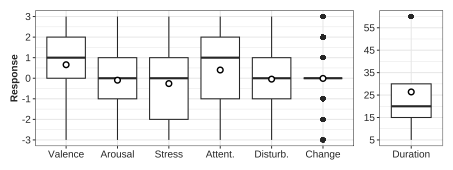

In [11]:
%%R -i data -w 16 -h 6 -u cm

data <- data %>% pivot_longer(
    cols = c('valence', 'arousal', 'attention', 'stress', 'duration', 'disturbance', 'change'),
    names_to = 'metric'
)

p_rest <- ggplot(
    data %>% filter(metric != 'duration'), aes(x=metric, y=value)
) + geom_boxplot(
) + geom_point(
    data = data %>% filter(
        metric != 'duration'
    ) %>% group_by(
        metric
    ) %>% summarise(
        mean = mean(value, na.rm=TRUE)
    ),
    mapping=aes(x=metric, y=mean),
    shape=21,
    stroke=1,
    size=2,
    fill='white'
) + scale_x_discrete(
    name=NULL,
    limits=c('valence', 'arousal', 'stress', 'attention', 'disturbance', 'change'),
    labels=c('Valence', 'Arousal', 'Stress', 'Attent.', 'Disturb.', 'Change'),
) + scale_y_continuous(
    name='Response',
    breaks=-3:3
) + THEME_DEFAULT

p_duration <- ggplot(
    data %>% filter(metric == 'duration'), aes(x=metric, y=value)
) + geom_boxplot(
) + geom_point(
    data = data %>% filter(
        metric == 'duration'
    ) %>% group_by(
        metric
    ) %>% summarise(
        mean = mean(value, na.rm=TRUE)
    ),
    mapping=aes(x=metric, y=mean),
    shape=21,
    stroke=1,
    size=2,
    fill='white'
)+ scale_x_discrete(
    name=NULL,
    limits=c('duration'),
    labels=c('Duration'),
) + scale_y_continuous(
    name=NULL,
    breaks=seq(from=5, to=60, by=10)
) + THEME_DEFAULT

p <- p_rest + p_duration + plot_layout(widths=c(4, 0.8))
ggsave('./fig/dist-labels.pdf', plot=p, width=16, height=6, unit='cm', device=cairo_pdf)
print(p)

### Correlation

Because each participant reported their labels multiple times (i.e., repeated measure), repeated measure correlation between affect labels were used.

In [12]:
data = LABELS.reset_index()[[
    'pcode', 'valence', 'arousal', 'stress', 'attention', 'disturbance', 'change'
]]

In [13]:
%%R -i data 

com <- combn(c('valence', 'arousal', 'stress', 'attention', 'disturbance', 'change'), 2)

for(i in 1:ncol(com)) {
    a <- com[, i][1]
    b <- com[, i][2]
    r <- rmcorr(participant = 'pcode', measure1=a, measure2=b, dataset=data)
    cat(a, '-', b, ': R =', r$r, '(p =', r$p, ') \n')
}

valence - arousal : R = 0.3858505 (p = 6.005105e-195 ) 
valence - stress : R = -0.5918317 (p = 0 ) 
valence - attention : R = 0.2880379 (p = 1.138238e-105 ) 
valence - disturbance : R = -0.02946216 (p = 0.02880521 ) 
valence - change : R = 0.3163849 (p = 2.978458e-128 ) 
arousal - stress : R = -0.2020498 (p = 8.095612e-52 ) 
arousal - attention : R = 0.4354836 (p = 1.162341e-253 ) 
arousal - disturbance : R = 0.0284022 (p = 0.03507786 ) 
arousal - change : R = 0.1673468 (p = 7.1899e-36 ) 
stress - attention : R = -0.1515681 (p = 1.176714e-29 ) 
stress - disturbance : R = 0.08679844 (p = 1.108432e-10 ) 
stress - change : R = -0.2907816 (p = 9.560751e-108 ) 
attention - disturbance : R = 0.1182107 (p = 1.363257e-18 ) 
attention - change : R = 0.1163492 (p = 4.682081e-18 ) 
disturbance - change : R = -0.2216444 (p = 3.009815e-62 ) 


## Sensor Data

In [14]:
import os
import pandas as pd
from typing import Optional


def _load_data(
    name: str
) -> Optional[pd.DataFrame]:
    paths = [
        (d, os.path.join(PATH_SENSOR, d, f'{name}.csv'))
        for d in os.listdir(PATH_SENSOR)
        if d.startswith('P')
    ]
    return pd.concat(
        filter(
            lambda x: len(x.index), 
            [
                pd.read_csv(p).assign(pcode=pcode)
                for pcode, p in paths
                if os.path.exists(p)
            ]
        ), ignore_index=True
    ).assign(
        timestamp=lambda x: pd.to_datetime(x['timestamp'], unit='ms', utc=True).dt.tz_convert(DEFAULT_TZ)
    ).set_index(
        ['pcode', 'timestamp']
    )

In [15]:
import pandas as pd
import gc
from datetime import timedelta as td


STATS = []

for data_type in DATA_TYPES:
    dat = _load_data(data_type)
    inst = dat.groupby('pcode').count().iloc[:, -1]
    samp = np.concatenate([
        (dat.loc[(p,), :].index.array - dat.loc[(p,), :].index.array.shift(1)).dropna().total_seconds()
        for p in dat.index.get_level_values('pcode').unique()
    ])
    inst, samp = summary(inst), summary(samp)
    
    print('#'*5, data_type, '#'*5)
    print('- # Inst.:', inst)
    print('- Samp. period:', samp)
    
    for c in dat.columns:
        print(f'- {c}:', summary(dat[c]))
        
    del dat
    gc.collect()
    
STATS = pd.DataFrame(STATS)

/var/folders/nk/s4x3th851w574ph7qygky7xc0000gn/T/ipykernel_54859/1897082983.py:12: PerformanceWarning: indexing past lexsort depth may impact performance.
  (dat.loc[(p,), :].index.array - dat.loc[(p,), :].index.array.shift(1)).dropna().total_seconds()


##### Acceleration #####
- # Inst.: {'n': 77, 'sum': np.int64(123260001), 'mean': np.float64(1600779.2337662338), 'SD': np.float64(473426.34254662704), 'med': np.float64(1616756.0), 'range': (np.int64(489289), np.int64(2464554)), 'conf.': (np.float64(1493324.634806363), np.float64(1708233.8327261047)), 'nan_count': 0}
- Samp. period: {'n': 123259924, 'sum': np.float64(41213652.71600009), 'mean': np.float64(0.3343637686812146), 'SD': np.float64(113.32762322571307), 'med': np.float64(0.13), 'range': (np.float64(0.001), np.float64(347544.66)), 'conf.': (np.float64(0.3143571853179495), np.float64(0.3543703520444797)), 'nan_count': 0}
- x: {'n': 123260001, 'sum': np.float64(-5999685.698486219), 'mean': np.float64(-0.048675041780067964), 'SD': np.float64(0.6191499890392032), 'med': np.float64(-0.066162109375), 'range': (np.float64(-7.9951171875), np.float64(7.99975585938)), 'conf.': (np.float64(-0.048784344981250685), np.float64(-0.04856573857888524)), 'nan_count': 0}
- y: {'n': 123260001, '

/var/folders/nk/s4x3th851w574ph7qygky7xc0000gn/T/ipykernel_54859/1897082983.py:12: PerformanceWarning: indexing past lexsort depth may impact performance.
  (dat.loc[(p,), :].index.array - dat.loc[(p,), :].index.array.shift(1)).dropna().total_seconds()


##### AmbientLight #####
- # Inst.: {'n': 77, 'sum': np.int64(31948974), 'mean': np.float64(414921.74025974027), 'SD': np.float64(122176.94279182944), 'med': np.float64(416936.0), 'range': (np.int64(125402), np.int64(643940)), 'conf.': (np.float64(387190.9758092046), np.float64(442652.5047102759)), 'nan_count': 0}
- Samp. period: {'n': 31948897, 'sum': np.float64(41213635.99199992), 'mean': np.float64(1.2899861923871712), 'SD': np.float64(222.60798183884265), 'med': np.float64(0.5), 'range': (np.float64(0.001), np.float64(347544.869)), 'conf.': (np.float64(1.2127962165083053), np.float64(1.367176168266037)), 'nan_count': 0}
- brightness: {'n': 31948974, 'sum': np.int64(11939891469), 'mean': np.float64(373.71752435618123), 'SD': np.float64(2573.66697101776), 'med': np.float64(39.0), 'range': (np.int64(0), np.int64(65535)), 'conf.': (np.float64(372.82509879993745), np.float64(374.609949912425)), 'nan_count': 0}


/var/folders/nk/s4x3th851w574ph7qygky7xc0000gn/T/ipykernel_54859/1897082983.py:12: PerformanceWarning: indexing past lexsort depth may impact performance.
  (dat.loc[(p,), :].index.array - dat.loc[(p,), :].index.array.shift(1)).dropna().total_seconds()


##### Calorie #####
- # Inst.: {'n': 77, 'sum': np.int64(15601514), 'mean': np.float64(202617.06493506493), 'SD': np.float64(59660.549453893436), 'med': np.float64(203676.0), 'range': (np.int64(61197), np.int64(314216)), 'conf.': (np.float64(189075.78123545274), np.float64(216158.34863467712)), 'nan_count': 0}
- Samp. period: {'n': 15601437, 'sum': np.float64(41213542.377999984), 'mean': np.float64(2.6416504055363608), 'SD': np.float64(318.5582067426915), 'med': np.float64(1.025), 'range': (np.float64(0.001), np.float64(347545.58)), 'conf.': (np.float64(2.4835785243545865), np.float64(2.799722286718135)), 'nan_count': 0}
- caloriesToday: {'n': 15601514, 'sum': np.int64(17690514158), 'mean': np.float64(1133.897271636586), 'SD': np.float64(429.68944030674527), 'med': np.float64(1142.0), 'range': (np.int64(0), np.int64(2387)), 'conf.': (np.float64(1133.684055812589), np.float64(1134.1104874605833)), 'nan_count': 0}
- totalCalories: {'n': 15601514, 'sum': np.int64(90234460224), 'mean': np.

/var/folders/nk/s4x3th851w574ph7qygky7xc0000gn/T/ipykernel_54859/1897082983.py:12: PerformanceWarning: indexing past lexsort depth may impact performance.
  (dat.loc[(p,), :].index.array - dat.loc[(p,), :].index.array.shift(1)).dropna().total_seconds()


##### Distance #####
- # Inst.: {'n': 77, 'sum': np.int64(15658461), 'mean': np.float64(203356.63636363635), 'SD': np.float64(64968.13128573705), 'med': np.float64(206892.0), 'range': (np.int64(31), np.int64(319157)), 'conf.': (np.float64(188610.67935809953), np.float64(218102.59336917318)), 'nan_count': 0}
- Samp. period: {'n': 15658384, 'sum': np.float64(41219633.380000025), 'mean': np.float64(2.632432144977414), 'SD': np.float64(318.256040768175), 'med': np.float64(1.009), 'range': (np.float64(0.001), np.float64(347546.809)), 'conf.': (np.float64(2.4747976315300333), np.float64(2.790066658424795)), 'nan_count': 0}
- motionType: {'n': 15658461, 'cardinality': 4, 'value_count': 'IDLE:14312951, WALKING:1312097, JOGGING:33213, RUNNING:200'}
- pace: {'n': 15658461, 'sum': np.int64(1729412434), 'mean': np.float64(110.4458754918507), 'SD': np.float64(366.6306708670267), 'med': np.float64(0.0), 'range': (np.int64(0), np.int64(3225)), 'conf.': (np.float64(110.26428112155037), np.float64(110.

/var/folders/nk/s4x3th851w574ph7qygky7xc0000gn/T/ipykernel_54859/1897082983.py:12: PerformanceWarning: indexing past lexsort depth may impact performance.
  (dat.loc[(p,), :].index.array - dat.loc[(p,), :].index.array.shift(1)).dropna().total_seconds()


##### EDA #####
- # Inst.: {'n': 77, 'sum': np.int64(80150329), 'mean': np.float64(1040913.3636363636), 'SD': np.float64(306422.1210160014), 'med': np.float64(1046093.0), 'range': (np.int64(314771), np.int64(1615971)), 'conf.': (np.float64(971364.0733516462), np.float64(1110462.653921081)), 'nan_count': 0}
- Samp. period: {'n': 80150252, 'sum': np.float64(41213631.25600018), 'mean': np.float64(0.5142046372605314), 'SD': np.float64(140.5468260735236), 'med': np.float64(0.199), 'range': (np.float64(0.001), np.float64(347546.153)), 'conf.': (np.float64(0.4834354025951199), np.float64(0.5449738719259429)), 'nan_count': 0}
- resistance: {'n': 80150329, 'sum': np.int64(4456740676426), 'mean': np.float64(55604.77083538858), 'SD': np.float64(121898.51318979551), 'med': np.float64(1385.0), 'range': (np.int64(0), np.int64(340330)), 'conf.': (np.float64(55578.08419819559), np.float64(55631.45747258158)), 'nan_count': 0}


/var/folders/nk/s4x3th851w574ph7qygky7xc0000gn/T/ipykernel_54859/1897082983.py:12: PerformanceWarning: indexing past lexsort depth may impact performance.
  (dat.loc[(p,), :].index.array - dat.loc[(p,), :].index.array.shift(1)).dropna().total_seconds()


##### HR #####
- # Inst.: {'n': 77, 'sum': np.int64(13621023), 'mean': np.float64(176896.4025974026), 'SD': np.float64(52558.47787145981), 'med': np.float64(191711.0), 'range': (np.int64(38545), np.int64(266374)), 'conf.': (np.float64(164967.09141619655), np.float64(188825.71377860865)), 'nan_count': 0}
- Samp. period: {'n': 13620946, 'sum': np.float64(40968427.921000056), 'mean': np.float64(3.0077520255201113), 'SD': np.float64(362.91724584746083), 'med': np.float64(0.996), 'range': (np.float64(0.001), np.float64(351677.643)), 'conf.': (np.float64(2.8150207922568913), np.float64(3.2004832587833314)), 'nan_count': 0}
- bpm: {'n': 13621023, 'sum': np.int64(1029728342), 'mean': np.float64(75.59845850051057), 'SD': np.float64(9.820564496209332), 'med': np.float64(75.0), 'range': (np.int64(35), np.int64(199)), 'conf.': (np.float64(75.59324319542789), np.float64(75.60367380559326)), 'nan_count': 0}


/var/folders/nk/s4x3th851w574ph7qygky7xc0000gn/T/ipykernel_54859/1897082983.py:12: PerformanceWarning: indexing past lexsort depth may impact performance.
  (dat.loc[(p,), :].index.array - dat.loc[(p,), :].index.array.shift(1)).dropna().total_seconds()


##### RRI #####
- # Inst.: {'n': 77, 'sum': np.int64(20764471), 'mean': np.float64(269668.45454545453), 'SD': np.float64(81037.2444152014), 'med': np.float64(279148.0), 'range': (np.int64(81185), np.int64(439154)), 'conf.': (np.float64(251275.25624430407), np.float64(288061.652846605)), 'nan_count': 0}
- Samp. period: {'n': 20764394, 'sum': np.float64(41213534.849999994), 'mean': np.float64(1.984817608931905), 'SD': np.float64(276.20029252330164), 'med': np.float64(0.762), 'range': (np.float64(0.001), np.float64(347548.529)), 'conf.': (np.float64(1.866018654033734), np.float64(2.103616563830076)), 'nan_count': 0}
- interval: {'n': 20764471, 'sum': np.float64(15700581045.231985), 'mean': np.float64(756.1271869257823), 'SD': np.float64(178.71396844200464), 'med': np.float64(763.232), 'range': (np.float64(298.65599999999995), np.float64(1493.28)), 'conf.': (np.float64(756.0503188199684), np.float64(756.2040550315962)), 'nan_count': 0}


/var/folders/nk/s4x3th851w574ph7qygky7xc0000gn/T/ipykernel_54859/1897082983.py:12: PerformanceWarning: indexing past lexsort depth may impact performance.
  (dat.loc[(p,), :].index.array - dat.loc[(p,), :].index.array.shift(1)).dropna().total_seconds()


##### SkinTemperature #####
- # Inst.: {'n': 77, 'sum': np.int64(535095), 'mean': np.float64(6949.285714285715), 'SD': np.float64(2044.9192742858738), 'med': np.float64(7010.0), 'range': (np.int64(2095), np.int64(10770)), 'conf.': (np.float64(6485.14597220523), np.float64(7413.4254563662)), 'nan_count': 0}
- Samp. period: {'n': 535018, 'sum': np.float64(41212170.55199999), 'mean': np.float64(77.029502842895), 'SD': np.float64(1719.1916269814033), 'med': np.float64(30.082), 'range': (np.float64(0.006), np.float64(347555.636)), 'conf.': (np.float64(72.42281097588155), np.float64(81.63619470990845)), 'nan_count': 0}
- temperature: {'n': 535095, 'sum': np.float64(17310047.448570274), 'mean': np.float64(32.34948457483302), 'SD': np.float64(2.1008397544761457), 'med': np.float64(32.6599998474), 'range': (np.float64(0.0), np.float64(41.1699981689)), 'conf.': (np.float64(32.3438556356817), np.float64(32.35511351398434)), 'nan_count': 0}


/var/folders/nk/s4x3th851w574ph7qygky7xc0000gn/T/ipykernel_54859/1897082983.py:12: PerformanceWarning: indexing past lexsort depth may impact performance.
  (dat.loc[(p,), :].index.array - dat.loc[(p,), :].index.array.shift(1)).dropna().total_seconds()


##### StepCount #####
- # Inst.: {'n': 77, 'sum': np.int64(15848456), 'mean': np.float64(205824.1038961039), 'SD': np.float64(60607.39763375781), 'med': np.float64(206903.0), 'range': (np.int64(62164), np.int64(319175)), 'conf.': (np.float64(192067.91202113347), np.float64(219580.2957710743)), 'nan_count': 0}
- Samp. period: {'n': 15848379, 'sum': np.float64(41213527.358), 'mean': np.float64(2.6004885015685204), 'SD': np.float64(316.071067601273), 'med': np.float64(1.009), 'range': (np.float64(0.001), np.float64(347546.809)), 'conf.': (np.float64(2.4448774479214332), np.float64(2.7560995552156076)), 'nan_count': 0}
- stepsToday: {'n': 15848456, 'sum': np.int64(51743117282), 'mean': np.float64(3264.8680276488763), 'SD': np.float64(2878.269178322283), 'med': np.float64(2686.0), 'range': (np.int64(0), np.int64(20756)), 'conf.': (np.float64(3263.450974785182), np.float64(3266.2850805125704)), 'nan_count': 0}
- totalSteps: {'n': 15848456, 'sum': np.int64(343389233538), 'mean': np.float64(21

/var/folders/nk/s4x3th851w574ph7qygky7xc0000gn/T/ipykernel_54859/1897082983.py:12: PerformanceWarning: indexing past lexsort depth may impact performance.
  (dat.loc[(p,), :].index.array - dat.loc[(p,), :].index.array.shift(1)).dropna().total_seconds()


##### UltraViolet #####
- # Inst.: {'n': 77, 'sum': np.int64(264692), 'mean': np.float64(3437.5584415584417), 'SD': np.float64(1017.6239287455036), 'med': np.float64(3495.0), 'range': (np.int64(1044), np.int64(5373)), 'conf.': (np.float64(3206.586141692076), np.float64(3668.5307414248073)), 'nan_count': 0}
- Samp. period: {'n': 264615, 'sum': np.float64(41109668.71500001), 'mean': np.float64(155.3565319993198), 'SD': np.float64(2474.851673896092), 'med': np.float64(59.998), 'range': (np.float64(0.012), np.float64(347610.692)), 'conf.': (np.float64(145.9269590786019), np.float64(164.7861049200377)), 'nan_count': 0}
- intensity: {'n': 264692, 'cardinality': 4, 'value_count': 'NONE:260364, LOW:4301, MEDIUM:26, HIGH:1'}
- exposureToday: {'n': 264692, 'sum': np.int64(14238420000), 'mean': np.float64(53792.407779607995), 'SD': np.float64(193566.12706067282), 'med': np.float64(0.0), 'range': (np.int64(0), np.int64(2220000)), 'conf.': (np.float64(53054.997767602305), np.float64(54529.817791613

/var/folders/nk/s4x3th851w574ph7qygky7xc0000gn/T/ipykernel_54859/1897082983.py:12: PerformanceWarning: indexing past lexsort depth may impact performance.
  (dat.loc[(p,), :].index.array - dat.loc[(p,), :].index.array.shift(1)).dropna().total_seconds()


##### ActivityEvent #####
- # Inst.: {'n': 77, 'sum': np.int64(857437), 'mean': np.float64(11135.545454545454), 'SD': np.float64(4325.836148396645), 'med': np.float64(11085.0), 'range': (np.int64(2640), np.int64(22938)), 'conf.': (np.float64(10153.70108570091), np.float64(12117.389823389998)), 'nan_count': 0}
- Samp. period: {'n': 857360, 'sum': np.float64(43179845.23400003), 'mean': np.float64(50.36372729541853), 'SD': np.float64(631.3182326494629), 'med': np.float64(15.19), 'range': (np.float64(0.001), np.float64(260838.132)), 'conf.': (np.float64(49.02739203647509), np.float64(51.70006255436196)), 'nan_count': 0}
- confidenceStill: {'n': 857437, 'sum': np.float64(384491.5), 'mean': np.float64(0.4484195340299054), 'SD': np.float64(0.43461160263959403), 'med': np.float64(0.24), 'range': (np.float64(0.0), np.float64(1.0)), 'conf.': (np.float64(0.44749961646725495), np.float64(0.4493394515925559)), 'nan_count': 0}
- confidenceUnknown: {'n': 857437, 'sum': np.float64(77627.03000000001), 

/var/folders/nk/s4x3th851w574ph7qygky7xc0000gn/T/ipykernel_54859/1897082983.py:12: PerformanceWarning: indexing past lexsort depth may impact performance.
  (dat.loc[(p,), :].index.array - dat.loc[(p,), :].index.array.shift(1)).dropna().total_seconds()


##### ActivityTransition #####
- # Inst.: {'n': 77, 'sum': np.int64(51009), 'mean': np.float64(662.4545454545455), 'SD': np.float64(344.9931938861276), 'med': np.float64(608.0), 'range': (np.int64(232), np.int64(2394)), 'conf.': (np.float64(584.1506954965814), np.float64(740.7583954125096)), 'nan_count': 0}
- Samp. period: {'n': 50932, 'sum': np.float64(42154858.737), 'mean': np.float64(827.6694168106495), 'SD': np.float64(4482.627081784924), 'med': np.float64(0.0), 'range': (np.float64(0.0), np.float64(261515.903)), 'conf.': (np.float64(788.7384080176117), np.float64(866.6004256036873)), 'nan_count': 0}
- transitionType: {'n': 51009, 'cardinality': 10, 'value_count': 'EXIT_WALKING:11158, ENTER_WALKING:11151, ENTER_STILL:10419, EXIT_STILL:10414, ENTER_IN_VEHICLE:2441, EXIT_IN_VEHICLE:2431, EXIT_ON_BICYCLE:1170, ENTER_ON_BICYCLE:1169, ENTER_RUNNING:328, EXIT_RUNNING:328'}


/var/folders/nk/s4x3th851w574ph7qygky7xc0000gn/T/ipykernel_54859/1897082983.py:12: PerformanceWarning: indexing past lexsort depth may impact performance.
  (dat.loc[(p,), :].index.array - dat.loc[(p,), :].index.array.shift(1)).dropna().total_seconds()


##### AppUsageEvent #####
- # Inst.: {'n': 77, 'sum': np.int64(1404657), 'mean': np.float64(18242.2987012987), 'SD': np.float64(7252.845122441942), 'med': np.float64(16956.0), 'range': (np.int64(5179), np.int64(38243)), 'conf.': (np.float64(16596.10478703991), np.float64(19888.49261555749)), 'nan_count': 0}
- Samp. period: {'n': 1404580, 'sum': np.float64(43369161.53999999), 'mean': np.float64(30.87696075695225), 'SD': np.float64(518.8103586669806), 'med': np.float64(0.379), 'range': (np.float64(0.0), np.float64(260988.331)), 'conf.': (np.float64(30.01896752134943), np.float64(31.73495399255507)), 'nan_count': 0}
- name: {'n': 1404657, 'cardinality': 873, 'value_count': '카카오톡:485233, 안드로이드 시스템:109284, Samsung Experience 홈:94274, One UI 홈:47717, Facebook:47637, 기본홈:47156, Paco:42692, 시스템 UI:28225, 트위터:24874, Chrome:19664, Polar Beat:19492, 캐시워크:17301, 네이버 웹툰:16860, 삼성 인터넷:16780, Instagram:13360, 설정:13134, YouTube:12091, 메시지:11815, 시계:10724, 디시인사이드:10693, ...'}
- packageName: {'n': 14046

/var/folders/nk/s4x3th851w574ph7qygky7xc0000gn/T/ipykernel_54859/1897082983.py:12: PerformanceWarning: indexing past lexsort depth may impact performance.
  (dat.loc[(p,), :].index.array - dat.loc[(p,), :].index.array.shift(1)).dropna().total_seconds()


##### BatteryEvent #####
- # Inst.: {'n': 77, 'sum': np.int64(1160326), 'mean': np.float64(15069.16883116883), 'SD': np.float64(7677.663567303528), 'med': np.float64(12795.0), 'range': (np.int64(2872), np.int64(42124)), 'conf.': (np.float64(13326.552957418293), np.float64(16811.78470491937)), 'nan_count': 0}
- Samp. period: {'n': 1160249, 'sum': np.float64(43417685.227000006), 'mean': np.float64(37.42100637621753), 'SD': np.float64(425.2680918274714), 'med': np.float64(10.168), 'range': (np.float64(0.001), np.float64(261248.657)), 'conf.': (np.float64(36.6471938757714), np.float64(38.19481887666365)), 'nan_count': 0}
- status: {'n': 1160326, 'cardinality': 4, 'value_count': 'CHARGING:651709, DISCHARGING:423437, FULL:81850, NOT_CHARGING:3330'}
- temperature: {'n': 1160326, 'sum': np.float64(37831986.300000004), 'mean': np.float64(32.6046182710721), 'SD': np.float64(4.162447912169572), 'med': np.float64(32.7), 'range': (np.float64(9.7), np.float64(81.3)), 'conf.': (np.float64(32.59704458

/var/folders/nk/s4x3th851w574ph7qygky7xc0000gn/T/ipykernel_54859/1897082983.py:12: PerformanceWarning: indexing past lexsort depth may impact performance.
  (dat.loc[(p,), :].index.array - dat.loc[(p,), :].index.array.shift(1)).dropna().total_seconds()


##### CallEvent #####
- # Inst.: {'n': 67, 'sum': np.int64(1546), 'mean': np.float64(23.074626865671643), 'SD': np.float64(25.421485444543677), 'med': np.float64(13.0), 'range': (np.int64(1), np.int64(123)), 'conf.': (np.float64(16.87383934556586), np.float64(29.275414385777427)), 'nan_count': 0}
- Samp. period: {'n': 1479, 'sum': np.float64(16861406.623), 'mean': np.float64(11400.545384043273), 'SD': np.float64(27689.571002538098), 'med': np.float64(1337.943), 'range': (np.float64(0.408), np.float64(338163.378)), 'conf.': (np.float64(9988.215903119613), np.float64(12812.874864966932)), 'nan_count': 0}
- number: {'n': 1546, 'cardinality': 492, 'value_count': '0104$070dd33ca6bb9f397ef5d50b5ff85a68:152, 0103$40b5d03a8b8ea68054d5ac4c72b382d1:42, 0107$7a44af8ea4fa07ae50542fcb560dd529:41, 0104$953efebd0af0a0f6f73948961fd239bd:37, 0102$7891680e5c259162e79235c578895ebb:33, 0104$fab8457f6f6fe2575d1ba5205177cbee:28, 0105$b23b2674f2e76dabd69e76a2cd0cb438:23, 0105$5539bf1719ca24553f5cdc026780ab6d

/var/folders/nk/s4x3th851w574ph7qygky7xc0000gn/T/ipykernel_54859/1897082983.py:12: PerformanceWarning: indexing past lexsort depth may impact performance.
  (dat.loc[(p,), :].index.array - dat.loc[(p,), :].index.array.shift(1)).dropna().total_seconds()


##### Connectivity #####
- # Inst.: {'n': 77, 'sum': np.int64(40304), 'mean': np.float64(523.4285714285714), 'SD': np.float64(352.0607538992243), 'med': np.float64(472.0), 'range': (np.int64(39), np.int64(1686)), 'conf.': (np.float64(443.5205821175942), np.float64(603.3365607395488)), 'nan_count': 0}
- Samp. period: {'n': 40227, 'sum': np.float64(41337347.348), 'mean': np.float64(1027.60204211102), 'SD': np.float64(5936.1155714691295), 'med': np.float64(6.436), 'range': (np.float64(0.004), np.float64(296303.731)), 'conf.': (np.float64(969.5917992410127), np.float64(1085.6122849810272)), 'nan_count': 0}
- isConnected: {'n': 40304, 'cardinality': 2, 'value_count': 'False:31289, True:9015'}
- type: {'n': 40304, 'cardinality': 5, 'value_count': 'WIFI:20614, MOBILE:18815, UNDEFINED:752, VPN:107, MOBILE_DUN:16'}


/var/folders/nk/s4x3th851w574ph7qygky7xc0000gn/T/ipykernel_54859/1897082983.py:12: PerformanceWarning: indexing past lexsort depth may impact performance.
  (dat.loc[(p,), :].index.array - dat.loc[(p,), :].index.array.shift(1)).dropna().total_seconds()


##### DataTraffic #####
- # Inst.: {'n': 77, 'sum': np.int64(692935), 'mean': np.float64(8999.155844155845), 'SD': np.float64(3664.6841935630578), 'med': np.float64(8428.0), 'range': (np.int64(1584), np.int64(19668)), 'conf.': (np.float64(8167.374561737846), np.float64(9830.937126573843)), 'nan_count': 0}
- Samp. period: {'n': 692858, 'sum': np.float64(43067429.30399998), 'mean': np.float64(62.15909941719657), 'SD': np.float64(807.6512193118494), 'med': np.float64(15.033), 'range': (np.float64(11.534), np.float64(261869.448)), 'conf.': (np.float64(60.257361853764074), np.float64(64.06083698062906)), 'nan_count': 0}
- rxKiloBytes: {'n': 692935, 'sum': np.int64(937801669), 'mean': np.float64(1353.3761016545564), 'SD': np.float64(9590.34510007972), 'med': np.float64(40.0), 'range': (np.int64(0), np.int64(847233)), 'conf.': (np.float64(1330.795431037939), np.float64(1375.9567722711738)), 'nan_count': 0}
- txKiloBytes: {'n': 692935, 'sum': np.int64(186407124), 'mean': np.float64(269.0109808

/var/folders/nk/s4x3th851w574ph7qygky7xc0000gn/T/ipykernel_54859/1897082983.py:12: PerformanceWarning: indexing past lexsort depth may impact performance.
  (dat.loc[(p,), :].index.array - dat.loc[(p,), :].index.array.shift(1)).dropna().total_seconds()


##### InstalledApp #####
- # Inst.: {'n': 77, 'sum': np.int64(1635350), 'mean': np.float64(21238.31168831169), 'SD': np.float64(5286.182229120261), 'med': np.float64(21459.0), 'range': (np.int64(4046), np.int64(31192)), 'conf.': (np.float64(20038.495496412797), np.float64(22438.12788021058)), 'nan_count': 0}
- Samp. period: {'n': 1635273, 'sum': np.float64(42803911.34099997), 'mean': np.float64(26.175391718080082), 'SD': np.float64(631.0867933465357), 'med': np.float64(0.0), 'range': (np.float64(0.0), np.float64(271385.388)), 'conf.': (np.float64(25.208133627055034), np.float64(27.14264980910513)), 'nan_count': 0}
- name: {'n': 1635350, 'cardinality': 3307, 'value_count': '전화:10225, 소프트웨어 업데이트:9364, 설정:7278, SmartThings:4777, 캘린더:4585, 메시지:3970, com.android.wallpapercropper:3916, Google One Time Init:3916, HTML 뷰어:3916, ABC Logger:3916, 외부 저장소:3916, YouTube:3916, MmsService:3915, 패키지 액세스 도움말:3915, AhnLab V3 Mobile Plus 2.0:3915, Google Play 스토어:3915, Polar Beat:3915, ConfigUpdater:3915

/var/folders/nk/s4x3th851w574ph7qygky7xc0000gn/T/ipykernel_54859/1897082983.py:12: PerformanceWarning: indexing past lexsort depth may impact performance.
  (dat.loc[(p,), :].index.array - dat.loc[(p,), :].index.array.shift(1)).dropna().total_seconds()


##### Location #####
- # Inst.: {'n': 77, 'sum': np.int64(788430), 'mean': np.float64(10239.35064935065), 'SD': np.float64(5938.968016340164), 'med': np.float64(8854.0), 'range': (np.int64(2047), np.int64(27742)), 'conf.': (np.float64(8891.370258148654), np.float64(11587.331040552646)), 'nan_count': 0}
- Samp. period: {'n': 788353, 'sum': np.float64(42733537.06000001), 'mean': np.float64(54.206094300395904), 'SD': np.float64(888.3962695759783), 'med': np.float64(2.0), 'range': (np.float64(0.001), np.float64(261313.101)), 'conf.': (np.float64(52.24501515308692), np.float64(56.16717344770489)), 'nan_count': 0}
- altitude: {'n': 788430, 'sum': np.float64(58369986.846610546), 'mean': np.float64(74.03318854763333), 'SD': np.float64(41.098040946809455), 'med': np.float64(75.82608032225), 'range': (np.float64(-971.050583942), np.float64(4929.0)), 'conf.': (np.float64(73.94247162532992), np.float64(74.12390546993674)), 'nan_count': 0}
- longitude: {'n': 788430, 'sum': np.float64(27067830.23711

/var/folders/nk/s4x3th851w574ph7qygky7xc0000gn/T/ipykernel_54859/1897082983.py:12: PerformanceWarning: indexing past lexsort depth may impact performance.
  (dat.loc[(p,), :].index.array - dat.loc[(p,), :].index.array.shift(1)).dropna().total_seconds()
/var/folders/nk/s4x3th851w574ph7qygky7xc0000gn/T/ipykernel_54859/1897082983.py:12: PerformanceWarning: indexing past lexsort depth may impact performance.
  (dat.loc[(p,), :].index.array - dat.loc[(p,), :].index.array.shift(1)).dropna().total_seconds()


##### MessageEvent #####
- # Inst.: {'n': 66, 'sum': np.int64(2591), 'mean': np.float64(39.25757575757576), 'SD': np.float64(61.801247337688686), 'med': np.float64(22.0), 'range': (np.int64(1), np.int64(442)), 'conf.': (np.float64(24.06493292447739), np.float64(54.450218590674126)), 'nan_count': 0}
- Samp. period: {'n': 2525, 'sum': np.float64(21158724.134999998), 'mean': np.float64(8379.692726732672), 'SD': np.float64(25685.474909155768), 'med': np.float64(302.559), 'range': (np.float64(0.042), np.float64(426967.0)), 'conf.': (np.float64(7377.356768788159), np.float64(9382.028684677185)), 'nan_count': 0}
- messageBox: {'n': 2591, 'cardinality': 2, 'value_count': 'INBOX:1758, SENT:833'}
- isPinned: {'n': 2591, 'cardinality': 2, 'value_count': 'False:2536, True:55'}
- timesContacted: {'n': 2591, 'sum': np.int64(50100), 'mean': np.float64(19.336163643380935), 'SD': np.float64(147.65114917889434), 'med': np.float64(1.0), 'range': (np.int64(0), np.int64(2466)), 'conf.': (np.float64(13.6482

/var/folders/nk/s4x3th851w574ph7qygky7xc0000gn/T/ipykernel_54859/1897082983.py:12: PerformanceWarning: indexing past lexsort depth may impact performance.
  (dat.loc[(p,), :].index.array - dat.loc[(p,), :].index.array.shift(1)).dropna().total_seconds()


##### WiFi #####
- # Inst.: {'n': 77, 'sum': np.int64(15258102), 'mean': np.float64(198157.16883116882), 'SD': np.float64(147795.70290664234), 'med': np.float64(178686.0), 'range': (np.int64(28475), np.int64(900435)), 'conf.': (np.float64(164611.65909379855), np.float64(231702.6785685391)), 'nan_count': 0}
- Samp. period: {'n': 15258025, 'sum': np.float64(43178434.54100005), 'mean': np.float64(2.8298835885378386), 'SD': np.float64(148.96371508723632), 'med': np.float64(0.0), 'range': (np.float64(0.0), np.float64(260934.687)), 'conf.': (np.float64(2.755139050978291), np.float64(2.904628126097386)), 'nan_count': 0}
- bssid: {'n': 15258102, 'cardinality': 310874, 'value_count': '6b186e57-cc96-4f85-ad3c-80734ba597b8:20300, 777ae97a-7584-4414-9862-ee8a4645ae8b:15749, 6dd66e08-a0b7-481e-af4b-9d70e82d49cb:15458, adab9bd0-15e5-409f-929c-57f4f0424c50:15331, bdb0522c-5453-4e8f-8bb9-93b2483cced5:13912, 454820e6-9e3b-4938-9cf6-74a955c47e05:13777, 2fac2da8-d0f8-408d-9608-b98caa359823:13745, 14e48f9

/var/folders/nk/s4x3th851w574ph7qygky7xc0000gn/T/ipykernel_54859/1897082983.py:12: PerformanceWarning: indexing past lexsort depth may impact performance.
  (dat.loc[(p,), :].index.array - dat.loc[(p,), :].index.array.shift(1)).dropna().total_seconds()


##### ScreenEvent #####
- # Inst.: {'n': 77, 'sum': np.int64(207137), 'mean': np.float64(2690.090909090909), 'SD': np.float64(998.2933091534162), 'med': np.float64(2718.0), 'range': (np.int64(512), np.int64(5034)), 'conf.': (np.float64(2463.506121682638), np.float64(2916.67569649918)), 'nan_count': 0}
- Samp. period: {'n': 207060, 'sum': np.float64(43288647.885), 'mean': np.float64(209.06330476673426), 'SD': np.float64(1404.1554471892762), 'med': np.float64(13.744499999999999), 'range': (np.float64(0.003), np.float64(261385.771)), 'conf.': (np.float64(203.01522216468575), np.float64(215.11138736878277)), 'nan_count': 0}
- type: {'n': 207137, 'cardinality': 3, 'value_count': 'ON:77317, OFF:77233, UNLOCK:52587'}
##### RingerModeEvent #####
- # Inst.: {'n': 76, 'sum': np.int64(1242), 'mean': np.float64(16.342105263157894), 'SD': np.float64(15.946203419898165), 'med': np.float64(11.5), 'range': (np.int64(1), np.int64(87)), 'conf.': (np.float64(12.698241687470867), np.float64(19.98596883884

/var/folders/nk/s4x3th851w574ph7qygky7xc0000gn/T/ipykernel_54859/1897082983.py:12: PerformanceWarning: indexing past lexsort depth may impact performance.
  (dat.loc[(p,), :].index.array - dat.loc[(p,), :].index.array.shift(1)).dropna().total_seconds()
/var/folders/nk/s4x3th851w574ph7qygky7xc0000gn/T/ipykernel_54859/1897082983.py:12: PerformanceWarning: indexing past lexsort depth may impact performance.
  (dat.loc[(p,), :].index.array - dat.loc[(p,), :].index.array.shift(1)).dropna().total_seconds()


##### ChargeEvent #####
- # Inst.: {'n': 77, 'sum': np.int64(11570), 'mean': np.float64(150.25974025974025), 'SD': np.float64(272.06749368673997), 'med': np.float64(72.0), 'range': (np.int64(4), np.int64(2112)), 'conf.': (np.float64(88.50799390175948), np.float64(212.01148661772103)), 'nan_count': 0}
- Samp. period: {'n': 11493, 'sum': np.float64(41418375.384), 'mean': np.float64(3603.791471678413), 'SD': np.float64(9696.835793352431), 'med': np.float64(33.34), 'range': (np.float64(0.003), np.float64(287550.279)), 'conf.': (np.float64(3426.4921099203157), np.float64(3781.0908334365104)), 'nan_count': 0}
- type: {'n': 11570, 'cardinality': 2, 'value_count': 'DISCONNECTED:5818, CONNECTED:5752'}
##### PowerSaveEvent #####
- # Inst.: {'n': 16, 'sum': np.int64(370), 'mean': np.float64(23.125), 'SD': np.float64(62.0127675026146), 'med': np.float64(4.0), 'range': (np.int64(1), np.int64(254)), 'conf.': (np.float64(-9.919271278080963), np.float64(56.16927127808096)), 'nan_count': 0}
- Samp. per

/var/folders/nk/s4x3th851w574ph7qygky7xc0000gn/T/ipykernel_54859/1897082983.py:12: PerformanceWarning: indexing past lexsort depth may impact performance.
  (dat.loc[(p,), :].index.array - dat.loc[(p,), :].index.array.shift(1)).dropna().total_seconds()
/var/folders/nk/s4x3th851w574ph7qygky7xc0000gn/T/ipykernel_54859/1897082983.py:12: PerformanceWarning: indexing past lexsort depth may impact performance.
  (dat.loc[(p,), :].index.array - dat.loc[(p,), :].index.array.shift(1)).dropna().total_seconds()


# Preprocessing

## Label

Because we intended to collected participants' responses to ESMs not voluntary responses, we screend out some responses as follows:
* We first screen out ESM responses that does not have 'scheduledTime' (meaning that a given ESM was expired or participants voluntarily reported their affective states regardless of ESM delivery). 
* Since we will evaluate our model using LOSO, the small number of responses for each participant might lead to inappropriate performance evaluation. We emprically set the number of the minimum responses upon ESM delivery as 5 per day (i.e., a half of our guides), so that we excluded participants whose responses to ESM less than 35.

In [16]:
LABELS_VALID = LABELS.loc[
    lambda x: ~x['scheduledTime'].isna(), :
]
print(f'# Non-voluntary response: {len(LABELS_VALID)}')
print(summary(LABELS_VALID.groupby('pcode').count().iloc[:, -1]))

excl_pcode = LABELS_VALID.loc[
    lambda x: ~x['scheduledTime'].isna()
].groupby('pcode').count().iloc[:, -1].loc[lambda y: y < 35]

LABELS_VALID = LABELS_VALID.loc[
    lambda x:  ~x.index.get_level_values('pcode').isin(excl_pcode.index), :
]
print(f'# Response from participants with enough responses: {len(LABELS_VALID)}')
print(summary(LABELS_VALID.groupby('pcode').count().iloc[:, -1]))

print('# Participants whose responses to ESM delivery were less then 35')
print(excl_pcode, f'#participants = {len(excl_pcode)} / #response = {sum(excl_pcode)}')

# Non-voluntary response: 3323
{'n': 76, 'sum': np.int64(3323), 'mean': np.float64(43.723684210526315), 'SD': np.float64(19.36291898394835), 'med': np.float64(43.5), 'range': (np.int64(3), np.int64(83)), 'conf.': (np.float64(39.29906768289902), np.float64(48.14830073815361)), 'nan_count': 0}
# Response from participants with enough responses: 2619
{'n': 47, 'sum': np.int64(2619), 'mean': np.float64(55.723404255319146), 'SD': np.float64(13.076201628480542), 'med': np.float64(52.0), 'range': (np.int64(36), np.int64(83)), 'conf.': (np.float64(51.88408762653044), np.float64(59.562720884107854)), 'nan_count': 0}
# Participants whose responses to ESM delivery were less then 35
pcode
P04    34
P07    24
P11    22
P14    11
P16    30
P17    13
P18    32
P20    31
P22    23
P24    10
P25    30
P29    32
P34    22
P36    29
P37    31
P38    33
P41    31
P43    24
P44    23
P46     4
P54    13
P56    31
P58    29
P62     3
P63    34
P64    30
P68    11
P73    31
P74    33
Name: change, dtype: int

Here we consider binary classifications for valence, arousal, stress, and disturbance, in which a label value greater than 0 is "HIGH" (1) and the rest is "LOW" (0), at the arrival of ESM prompts (*scheduledTime*)

In [17]:
import pandas as pd
import numpy as np

LABELS_PROC = (
    LABELS_VALID
    .reset_index()
    .assign(
        timestamp=lambda x: pd.to_datetime(x['scheduledTime'], unit='ms', utc=True).dt.tz_convert(DEFAULT_TZ),
        attention_bin=lambda x: np.where(x['attention'] > 0, 1, 0)
    )
    .loc[:, ['pcode', 'timestamp', 'attention', 'attention_bin']]  # attention: 연속형, attention_bin: 이진분류된 데이터
    .set_index(['pcode', 'timestamp'])
)

LABELS_PROC.head()

attention  attention_bin
pcode timestamp                                          
P01   2019-05-08 10:26:00+09:00          3              1
      2019-05-08 11:13:00+09:00          2              1
      2019-05-08 15:56:00+09:00          3              1
      2019-05-08 16:41:00+09:00          3              1
      2019-05-08 17:23:00+09:00          3              1

In [18]:
import numpy as np


inst = LABELS_PROC.groupby('pcode').count().iloc[:, -1]
for c in [c for c in LABELS_PROC.columns if c.endswith('_bin')]:
    print(f'- {c}:', summary(LABELS_PROC[c].astype(object)))

- attention_bin: {'n': 2619, 'cardinality': 2, 'value_count': '0:1312, 1:1307'}


## Sensor Data

For each type of sensor data, we applied different preprocessing. Detailed decsription is provided in the paper.



### Implementation

In [19]:
import pandas as pd
import numpy as np
import scipy.spatial.distance as dist
from typing import Dict, Union
import pygeohash as geo
from datetime import timedelta
from collections import defaultdict


# AppUsageEvent.csv
def _proc_app_usage(data: pd.DataFrame) -> Union[pd.Series, Dict[str, pd.Series]]:
    data = data.loc[
        lambda x: x['type'].isin(['MOVE_TO_FOREGROUND', 'MOVE_TO_BACKGROUND']), :
    ].assign(
        packageName=lambda x: np.where(x['type'] == 'MOVE_TO_FOREGROUND', x['packageName'], None),
        category=lambda x: np.where(x['type'] == 'MOVE_TO_FOREGROUND', x['category'], None),
    )

    return {
        'PAC': data['packageName'].astype('object'),
        'CAT': data['category'].astype('object')
    }


# Connectivity.csv
def _proc_connectivity(data: pd.DataFrame) -> Union[pd.Series, Dict[str, pd.Series]]:
    data = data.assign(
        type=lambda x: np.where(x['isConnected'] == True, x['type'], 'DISCONNECTED')
    )

    return data['type'].astype('object')


# BatteryEvent.csv
def _proc_battery(data: pd.DataFrame) -> Union[pd.Series, Dict[str, pd.Series]]:
    return {
        'LEV': data['level'].astype('float32'),
        'STA': data['status'].astype('object'),
        'TMP': data['temperature'].astype('float32')
    }
        

# CallEvent.csv
def _proc_call(data: pd.DataFrame) -> Union[pd.Series, Dict[str, pd.Series]]:
    data = data.loc[
        lambda x: x['duration'] > 0, :
    ]
    new_data = []

    for row in data.itertuples():
        pcode, timestamp = row.Index
        
        new_data.append({
            'pcode': pcode,
            'timestamp': timestamp,                
            'state': 'CALL',
        })
        new_data.append({
            'pcode': pcode,
            'timestamp': timestamp + timedelta(milliseconds=row.duration),
            'state': 'IDLE'
        })

    new_data = pd.DataFrame(new_data).set_index(
        ['pcode', 'timestamp']
    )

    return new_data['state'].astype('object')


# DataTraffic.csv
def _proc_data_traffic(data: pd.DataFrame) -> Union[pd.Series, Dict[str, pd.Series]]:
    return {
        'RCV': data['rxKiloBytes'].astype('float32'),
        'SNT': data['txKiloBytes'].astype('float32')
    }


# RingerModeEvent.csv
def _proc_ringer_mode(data: pd.DataFrame) -> Union[pd.Series, Dict[str, pd.Series]]:
    return data['type'].astype('object')


# ScreenEvent.csv
def _proc_screen(data: pd.DataFrame) -> Union[pd.Series, Dict[str, pd.Series]]:
    return data['type'].astype('object')


# OnOffEvent.csv
def _proc_on_off(data: pd.DataFrame) -> Union[pd.Series, Dict[str, pd.Series]]:
    return data['type'].astype('object')


# PowerSaveEvent.csv
def _proc_power_save(data: pd.DataFrame) -> Union[pd.Series, Dict[str, pd.Series]]:
    return data['type'].astype('object')


# ChargeEvent.csv
def _proc_charge(data: pd.DataFrame) -> Union[pd.Series, Dict[str, pd.Series]]:
    return data['type'].astype('object')


# Location.csv
def _proc_location(data: pd.DataFrame) -> Union[pd.Series, Dict[str, pd.Series]]:
    def _haversine(_lat1, _lat2, _lng1, _lng2) -> float:
        if np.isnan(_lat1) or np.isnan(_lat2) or np.isnan(_lng1) or np.isnan(_lng2):
            return 0.0

        _lat1_r, _lat2_r, _lng1_r, _lng2_r = np.radians(_lat1), np.radians(_lat2), np.radians(_lng1), np.radians(_lng2)
        _lat = _lat2_r - _lat1_r
        _lng = _lng2_r - _lng1_r
        _R = 6371008.8
        _d = np.sin(_lat * 0.5) ** 2 + np.cos(_lat1_r) * np.cos(_lat2_r) * np.sin(_lng * 0.5) ** 2
        return 2 * _R * np.arcsin(np.sqrt(_d))

    new_data = []
    
    for pcode in data.index.get_level_values('pcode').unique():
        sub = data.loc[(pcode, ), :].sort_index(
            axis=0, level='timestamp'
        ).assign(
            _latitude=lambda x: x['latitude'].shift(1),
            _longitude=lambda x: x['longitude'].shift(1),
            dist=lambda x: x.apply(
                lambda y: _haversine(y['latitude'], y['_latitude'], y['longitude'], y['_longitude']),
                axis=1
            ),
            cluster=lambda x: x.apply(
                lambda y: geo.encode(y['latitude'], y['longitude'], precision=7),
                axis=1
            ),
            pcode=pcode
        ).reset_index()
        new_data.append(sub)

    new_data = pd.concat(new_data, axis=0, ignore_index=True).set_index(
        ['pcode', 'timestamp']
    )

    return {
        'CLS': new_data['cluster'].astype('object'),
        'DST': new_data['dist'].astype('float32')
    }


# ActivityEvent.csv
def _proc_activity_event(data: pd.DataFrame) -> Union[pd.Series, Dict[str, pd.Series]]:
    return {
        'UNK': data['confidenceUnknown'].astype('float32'),
        'FOT': data['confidenceOnFoot'].astype('float32'),
        'WLK': data['confidenceWalking'].astype('float32'),
        'VHC': data['confidenceInVehicle'].astype('float32'),
        'BCC': data['confidenceOnBicycle'].astype('float32'),
        'RUN': data['confidenceRunning'].astype('float32'),
        'TLT': data['confidenceTilting'].astype('float32')
    }


# ActivityTransition.csv
def _proc_activity_transition(data: pd.DataFrame) -> Union[pd.Series, Dict[str, pd.Series]]:
    data = data.loc[
        lambda x: x['transitionType'].isin(['ENTER_WALKING', 'ENTER_STILL', 'ENTER_IN_VEHICLE', 'ENTER_ON_BICYCLE', 'ENTER_RUNNING']), :
    ].assign(
        type=lambda x: x['transitionType'].str.replace('ENTER_', '')
    )
    
    return data['type'].astype('object')


# WiFi.csv
def _proc_wifi(data: pd.DataFrame) -> Union[pd.Series, Dict[str, pd.Series]]:
    new_data = []
    
    for pcode in data.index.get_level_values('pcode').unique():
        sub = data.loc[(pcode, ), :].sort_index(
            axis=0, level='timestamp'
        ).assign(
            bssid=lambda x: x['bssid'].str.cat(x['frequency'].astype(str), sep='-')
        )
        t = sub.index.unique().array
        for cur_t, prev_t in zip(t, t.shift(1)):
            if cur_t is pd.NaT or prev_t is pd.NaT:
                continue

            prev = sub.loc[[prev_t], :]
            cur = sub.loc[[cur_t], :]
            intersect = np.intersect1d(prev['bssid'], cur['bssid'])
            union = np.union1d(prev['bssid'], cur['bssid'])
            w = np.repeat(1 / len(intersect), len(intersect)) if len(intersect) else 1.0
            prev_intersect = prev.loc[
                lambda x: x['bssid'].isin(intersect), :
            ].sort_values('bssid')
            cur_intersect = cur.loc[
                lambda x: x['bssid'].isin(intersect), :
            ].sort_values('bssid')
            prev_rssi = prev_intersect['rssi']
            cur_rssi = cur_intersect['rssi']

            new_data.append(dict(
                pcode=pcode,
                timestamp=cur_t,
                cosine=1 - dist.cosine(prev_rssi, cur_rssi) if len(intersect) > 0 else 0,
                euclidean=1 / (1 + dist.euclidean(prev_rssi, cur_rssi, w)) if len(intersect) > 0 else 0,
                manhattan=1 / (1 + dist.cityblock(prev_rssi, cur_rssi, w)) if len(intersect) > 0 else 0,
                jaccard = len(intersect) / len(union) if len(union) > 0 else 0
            ))
            
    new_data = pd.DataFrame(new_data).set_index(
        ['pcode', 'timestamp']
    )
    
    return {
        'COS': new_data['cosine'].astype('float32'),
        'EUC': new_data['euclidean'].astype('float32'),
        'MAN': new_data['manhattan'].astype('float32'),
        'JAC': new_data['jaccard'].astype('float32')
    }


# InstalledApp.csv
def _proc_installed_app(data: pd.DataFrame) -> Union[pd.Series, Dict[str, pd.Series]]:
    new_data = []
    
    for pcode in data.index.get_level_values('pcode').unique():
        sub = data.loc[(pcode, ), :].sort_index(axis=0, level='timestamp')
        t = sub.index.unique().array
        for cur_t, prev_t in zip(t, t.shift(1)):
            if cur_t is pd.NaT or prev_t is pd.NaT:
                continue

            prev = sub.loc[[prev_t], :]
            cur = sub.loc[[cur_t], :]
            intersect = np.intersect1d(prev['packageName'], cur['packageName'])
            union = np.union1d(prev['packageName'], cur['packageName'])
            new_data.append(dict(
                pcode=pcode,
                timestamp=cur_t,
                jaccard = len(intersect) / len(union) if len(union) > 0 else 0
            ))
            
    new_data = pd.DataFrame(new_data).set_index(
        ['pcode', 'timestamp']
    )
    
    return {
       'JAC': new_data['jaccard'].astype('float32')
    }


# MediaEvent.csv
def _proc_media_event(data: pd.DataFrame) -> Union[pd.Series, Dict[str, pd.Series]]:
    new_data = defaultdict(list)
    
    for pcode in data.index.get_level_values('pcode').unique():
        sub = data.loc[(pcode, ), :].sort_index(
            axis=0, level='timestamp'
        )

        video = sub.loc[
            lambda x: x['mimetype'].str.startswith('video'), :
        ].assign(
            event=1,
            pcode=pcode
        ).reset_index()

        image = sub.loc[
            lambda x: x['mimetype'].str.startswith('image'), :
        ].assign(
            event=1,
            pcode=pcode
        ).reset_index()

        media = sub.assign(
            event=1,
            pcode=pcode
        ).reset_index()

        new_data['VID'].append(video)
        new_data['IMG'].append(image)
        new_data['ALL'].append(media)

    return {
        k: pd.concat(
            v, axis=0, ignore_index=True
        ).set_index(
            ['pcode', 'timestamp']
        )['event'].astype('float32') 
        for k, v in new_data.items()
    }


# MessageEvent.csv
def _proc_message_event(data: pd.DataFrame) -> Union[pd.Series, Dict[str, pd.Series]]:
    new_data = defaultdict(list)
    
    for pcode in data.index.get_level_values('pcode').unique():
        sub = data.loc[(pcode, ), :].sort_index(
            axis=0, level='timestamp'
        )

        sent = sub.loc[
            lambda x: x['messageBox'] == 'SENT', :
        ].assign(
            event=1,
            pcode=pcode
        ).reset_index()

        recv = sub.loc[
            lambda x: x['messageBox'] == 'INBOX', :
        ].assign(
            event=1,
            pcode=pcode
        ).reset_index()

        msg = sub.assign(
            event=1,
            pcode=pcode
        ).reset_index()

        new_data['SNT'].append(sent)
        new_data['RCV'].append(recv)
        new_data['ALL'].append(msg)

    return {
        k: pd.concat(
            v, axis=0, ignore_index=True
        ).set_index(
            ['pcode', 'timestamp']
        )['event'].astype('float32') 
        for k, v in new_data.items()
    }


# Acceleration.csv
def _proc_acceleration(data: pd.DataFrame) -> Union[pd.Series, Dict[str, pd.Series]]:
    data = data.assign(
        mag=lambda x: np.sqrt(np.square(x['x']) + np.square(x['y']) + np.square(x['z']))
    )

    return {
        'AXX': data['x'].astype('float32'),
        'AXY': data['y'].astype('float32'),
        'AXZ': data['z'].astype('float32'),
        'MAG': data['mag'].astype('float32')
    }

# UltraViolet.csv
def _proc_ultra_violet(data: pd.DataFrame) -> Union[pd.Series, Dict[str, pd.Series]]:
    new_data = []
    
    for pcode in data.index.get_level_values('pcode').unique():
        sub = data.loc[(pcode, ), :].sort_index(
            axis=0, level='timestamp'
        ).assign(
            exposure=lambda x: (x['totalExposure'] - x['totalExposure'].shift(1)),
            pcode=pcode
        ).reset_index()

        new_data.append(sub)

    new_data = pd.concat(new_data, axis=0, ignore_index=True).set_index(
        ['pcode', 'timestamp']
    )

    return {
        'INT': new_data['intensity'].astype('object'),
        'EXP': new_data['exposure'].dropna().astype('float32')
    }


# SkinTemperature.csv
def _proc_skin_temperature(data: pd.DataFrame) -> Union[pd.Series, Dict[str, pd.Series]]:
    return data['temperature'].astype('float32')


# RRI.csv
def _proc_rri(data: pd.DataFrame) -> Union[pd.Series, Dict[str, pd.Series]]:
    return data['interval'].astype('float32')


# AmbientLight.csv
def _proc_ambient_light(data: pd.DataFrame) -> Union[pd.Series, Dict[str, pd.Series]]:
    return data['brightness'].astype('float32')
    

# StepCount.csv
def _proc_step_count(data: pd.DataFrame) -> Union[pd.Series, Dict[str, pd.Series]]:
    new_data = []

    for pcode in data.index.get_level_values('pcode').unique():
        sub = data.loc[(pcode, ), :].sort_index(
            axis=0, level='timestamp'
        ).assign(
            steps=lambda x: (x['totalSteps'] - x['totalSteps'].shift(1)),
            pcode=pcode
        ).reset_index()
        new_data.append(sub)

    new_data = pd.concat(new_data, axis=0, ignore_index=True).set_index(
        ['pcode', 'timestamp']
    )

    return new_data['steps'].dropna().astype('float32')
    

# HR.csv
def _proc_hr(data: pd.DataFrame) -> Union[pd.Series, Dict[str, pd.Series]]:
    return data['bpm'].astype('float32')
    

# EDA.csv
def _proc_eda(data: pd.DataFrame) -> Union[pd.Series, Dict[str, pd.Series]]:
    return data['resistance'].astype('float32')


# Distance.csv
def _proc_distance(data: pd.DataFrame) -> Union[pd.Series, Dict[str, pd.Series]]:
    new_data = []

    for pcode in data.index.get_level_values('pcode').unique():
        sub = data.loc[(pcode, ), :].sort_index(
            axis=0, level='timestamp'
        ).assign(
            distance=lambda x: x['totalDistance'] - x['totalDistance'].shift(1),
            pcode=pcode
        ).reset_index()

        new_data.append(sub)

    new_data = pd.concat(new_data, axis=0, ignore_index=True).set_index(
        ['pcode', 'timestamp']
    )

    return {
        'DST': new_data['distance'].dropna().astype('float32'),
        'MOT': new_data['motionType'].astype('object'),
        'PAC': new_data['pace'].astype('float32'),
        'SPD': new_data['speed'].astype('float32')
    }


# Calorie.csv
def _proc_calories(data: pd.DataFrame) -> Union[pd.Series, Dict[str, pd.Series]]:
    new_data = []

    for pcode in data.index.get_level_values('pcode').unique():
        sub = data.loc[(pcode, ), :].sort_index(
            axis=0, level='timestamp'
        ).assign(
            calories=lambda x: x['totalCalories'] - x['totalCalories'].shift(1),
            pcode=pcode
        ).reset_index()

        new_data.append(sub)

    new_data = pd.concat(new_data, axis=0, ignore_index=True).set_index(
        ['pcode', 'timestamp']
    )

    return new_data['calories'].dropna().astype('float32')           


### Execution

In [20]:
import pandas as pd
import gc
from functools import reduce

FUNC_PROC = {
    'Acceleration': _proc_acceleration,
    'AmbientLight': _proc_ambient_light,
    'Calorie': _proc_calories,
    'Distance': _proc_distance,
    'EDA': _proc_eda,
    'HR': _proc_hr,
    'RRI': _proc_rri,
    'SkinTemperature': _proc_skin_temperature,
    'StepCount': _proc_step_count,
    'UltraViolet': _proc_ultra_violet,
    'ActivityEvent': _proc_activity_event,
    'ActivityTransition': _proc_activity_transition,
    'AppUsageEvent': _proc_app_usage,
    'BatteryEvent': _proc_battery,
    'CallEvent': _proc_call,
    'Connectivity': _proc_connectivity,
    'DataTraffic': _proc_data_traffic,
    'InstalledApp': _proc_installed_app,
    'Location': _proc_location,
    'MediaEvent': _proc_media_event,
    'MessageEvent': _proc_message_event,
    'WiFi': _proc_wifi,
    'ScreenEvent': _proc_screen,
    'RingerModeEvent': _proc_ringer_mode,
    'ChargeEvent': _proc_charge,
    'PowerSaveEvent': _proc_power_save,
    'OnOffEvent': _proc_on_off
}


def _process(data_type: str):
    log(f'Begin to processing data: {data_type}')
    
    abbrev = DATA_TYPES[data_type]
    data_raw = _load_data(data_type)
    data_proc = FUNC_PROC[data_type](data_raw)
    result = dict()
    
    if type(data_proc) is dict:
        for k, v in data_proc.items():
            result[f'{abbrev}_{k}'] = v
    else:
        result[abbrev] = data_proc
        
    log(f'Complete processing data: {data_type}')
    return result



with on_ray(num_cpus=12):
    jobs = []
    
    func = ray.remote(_process).remote
    
    for data_type in DATA_TYPES:
        job = func(data_type)
        jobs.append(job)

    jobs = ray.get(jobs)
    jobs = reduce(lambda a, b: {**a, **b}, jobs)
    dump(jobs, os.path.join(PATH_INTERMEDIATE, 'proc.pkl'))

    del jobs
    gc.collect()

2025-05-05 21:55:27,216	INFO worker.py:1538 -- Started a local Ray instance.
(pid=58736) WARNING: All log messages before absl::InitializeLog() is called are written to STDERR
(pid=58736) I0000 00:00:1746449729.071042 11713779 fork_posix.cc:75] Other threads are currently calling into gRPC, skipping fork() handlers
(pid=58730) WARNING: All log messages before absl::InitializeLog() is called are written to STDERR
(pid=58730) I0000 00:00:1746449729.058135 11713753 fork_posix.cc:75] Other threads are currently calling into gRPC, skipping fork() handlers
(pid=58740) WARNING: All log messages before absl::InitializeLog() is called are written to STDERR
(pid=58740) I0000 00:00:1746449729.020892 11713799 fork_posix.cc:75] Other threads are currently calling into gRPC, skipping fork() handlers
(pid=58731) WARNING: All log messages before absl::InitializeLog() is called are written to STDERR
(pid=58731) I0000 00:00:1746449729.046410 11713757 fork_posix.cc:75] Other threads are currently calling

(_process pid=58747) [25-05-05 21:55:29] Begin to processing data: Acceleration
(_process pid=58740) [25-05-05 21:55:29] Begin to processing data: Distance
(_process pid=58731) [25-05-05 21:55:29] Begin to processing data: SkinTemperature
(_process pid=58730) [25-05-05 21:55:29] Begin to processing data: ActivityTransition
(_process pid=58736) [25-05-05 21:55:29] Begin to processing data: EDA
(_process pid=58737) [25-05-05 21:55:29] Begin to processing data: HR
(_process pid=58734) [25-05-05 21:55:29] Begin to processing data: UltraViolet
(_process pid=58735) [25-05-05 21:55:29] Begin to processing data: StepCount
(_process pid=58738) [25-05-05 21:55:29] Begin to processing data: Calorie
(_process pid=58739) [25-05-05 21:55:29] Begin to processing data: AmbientLight
(_process pid=58732) [25-05-05 21:55:29] Begin to processing data: ActivityEvent
(_process pid=58733) [25-05-05 21:55:29] Begin to processing data: RRI
(_process pid=58730) [25-05-05 21:55:29] Complete processing data: Acti

(_process pid=58734) /var/folders/nk/s4x3th851w574ph7qygky7xc0000gn/T/ipykernel_54859/2045122460.py:353: PerformanceWarning: indexing past lexsort depth may impact performance.
(_process pid=58734) /var/folders/nk/s4x3th851w574ph7qygky7xc0000gn/T/ipykernel_54859/2045122460.py:353: PerformanceWarning: indexing past lexsort depth may impact performance.
(_process pid=58734) /var/folders/nk/s4x3th851w574ph7qygky7xc0000gn/T/ipykernel_54859/2045122460.py:353: PerformanceWarning: indexing past lexsort depth may impact performance.
(_process pid=58734) /var/folders/nk/s4x3th851w574ph7qygky7xc0000gn/T/ipykernel_54859/2045122460.py:353: PerformanceWarning: indexing past lexsort depth may impact performance.
(_process pid=58734) /var/folders/nk/s4x3th851w574ph7qygky7xc0000gn/T/ipykernel_54859/2045122460.py:353: PerformanceWarning: indexing past lexsort depth may impact performance.
(_process pid=58734) /var/folders/nk/s4x3th851w574ph7qygky7xc0000gn/T/ipykernel_54859/2045122460.py:353: Performanc

(_process pid=58731) [25-05-05 21:55:30] Complete processing data: SkinTemperature
(_process pid=58731) [25-05-05 21:55:30] Begin to processing data: BatteryEvent


(_process pid=58734) /var/folders/nk/s4x3th851w574ph7qygky7xc0000gn/T/ipykernel_54859/2045122460.py:353: PerformanceWarning: indexing past lexsort depth may impact performance.
(_process pid=58734) /var/folders/nk/s4x3th851w574ph7qygky7xc0000gn/T/ipykernel_54859/2045122460.py:353: PerformanceWarning: indexing past lexsort depth may impact performance.
(_process pid=58734) /var/folders/nk/s4x3th851w574ph7qygky7xc0000gn/T/ipykernel_54859/2045122460.py:353: PerformanceWarning: indexing past lexsort depth may impact performance.
(_process pid=58734) /var/folders/nk/s4x3th851w574ph7qygky7xc0000gn/T/ipykernel_54859/2045122460.py:353: PerformanceWarning: indexing past lexsort depth may impact performance.
(_process pid=58734) /var/folders/nk/s4x3th851w574ph7qygky7xc0000gn/T/ipykernel_54859/2045122460.py:353: PerformanceWarning: indexing past lexsort depth may impact performance.
(_process pid=58734) /var/folders/nk/s4x3th851w574ph7qygky7xc0000gn/T/ipykernel_54859/2045122460.py:353: Performanc

(_process pid=58734) [25-05-05 21:55:30] Complete processing data: UltraViolet
(_process pid=58734) [25-05-05 21:55:30] Begin to processing data: CallEvent
(_process pid=58734) [25-05-05 21:55:31] Complete processing data: CallEvent
(_process pid=58734) [25-05-05 21:55:31] Begin to processing data: Connectivity
(_process pid=58734) [25-05-05 21:55:31] Complete processing data: Connectivity
(_process pid=58734) [25-05-05 21:55:31] Begin to processing data: DataTraffic
(_process pid=58732) [25-05-05 21:55:31] Complete processing data: ActivityEvent
(_process pid=58732) [25-05-05 21:55:31] Begin to processing data: InstalledApp
(_process pid=58734) [25-05-05 21:55:32] Complete processing data: DataTraffic
(_process pid=58734) [25-05-05 21:55:32] Begin to processing data: Location
(_process pid=58731) [25-05-05 21:55:32] Complete processing data: BatteryEvent
(_process pid=58731) [25-05-05 21:55:32] Begin to processing data: MediaEvent


(_process pid=58731) /var/folders/nk/s4x3th851w574ph7qygky7xc0000gn/T/ipykernel_54859/2045122460.py:256: PerformanceWarning: indexing past lexsort depth may impact performance.
(_process pid=58731) /var/folders/nk/s4x3th851w574ph7qygky7xc0000gn/T/ipykernel_54859/2045122460.py:256: PerformanceWarning: indexing past lexsort depth may impact performance.
(_process pid=58731) /var/folders/nk/s4x3th851w574ph7qygky7xc0000gn/T/ipykernel_54859/2045122460.py:256: PerformanceWarning: indexing past lexsort depth may impact performance.
(_process pid=58731) /var/folders/nk/s4x3th851w574ph7qygky7xc0000gn/T/ipykernel_54859/2045122460.py:256: PerformanceWarning: indexing past lexsort depth may impact performance.
(_process pid=58731) /var/folders/nk/s4x3th851w574ph7qygky7xc0000gn/T/ipykernel_54859/2045122460.py:256: PerformanceWarning: indexing past lexsort depth may impact performance.
(_process pid=58731) /var/folders/nk/s4x3th851w574ph7qygky7xc0000gn/T/ipykernel_54859/2045122460.py:256: Performanc

(_process pid=58731) /var/folders/nk/s4x3th851w574ph7qygky7xc0000gn/T/ipykernel_54859/2045122460.py:256: PerformanceWarning: indexing past lexsort depth may impact performance.
(_process pid=58731) /var/folders/nk/s4x3th851w574ph7qygky7xc0000gn/T/ipykernel_54859/2045122460.py:256: PerformanceWarning: indexing past lexsort depth may impact performance.
(_process pid=58731) /var/folders/nk/s4x3th851w574ph7qygky7xc0000gn/T/ipykernel_54859/2045122460.py:256: PerformanceWarning: indexing past lexsort depth may impact performance.
(_process pid=58731) /var/folders/nk/s4x3th851w574ph7qygky7xc0000gn/T/ipykernel_54859/2045122460.py:256: PerformanceWarning: indexing past lexsort depth may impact performance.
(_process pid=58731) /var/folders/nk/s4x3th851w574ph7qygky7xc0000gn/T/ipykernel_54859/2045122460.py:256: PerformanceWarning: indexing past lexsort depth may impact performance.
(_process pid=58731) /var/folders/nk/s4x3th851w574ph7qygky7xc0000gn/T/ipykernel_54859/2045122460.py:256: Performanc

(_process pid=58731) [25-05-05 21:55:33] Complete processing data: MediaEvent
(_process pid=58731) [25-05-05 21:55:33] Begin to processing data: MessageEvent


(_process pid=58731) /var/folders/nk/s4x3th851w574ph7qygky7xc0000gn/T/ipykernel_54859/2045122460.py:298: PerformanceWarning: indexing past lexsort depth may impact performance.
(_process pid=58731) /var/folders/nk/s4x3th851w574ph7qygky7xc0000gn/T/ipykernel_54859/2045122460.py:298: PerformanceWarning: indexing past lexsort depth may impact performance.
(_process pid=58731) /var/folders/nk/s4x3th851w574ph7qygky7xc0000gn/T/ipykernel_54859/2045122460.py:298: PerformanceWarning: indexing past lexsort depth may impact performance.
(_process pid=58731) /var/folders/nk/s4x3th851w574ph7qygky7xc0000gn/T/ipykernel_54859/2045122460.py:298: PerformanceWarning: indexing past lexsort depth may impact performance.
(_process pid=58731) /var/folders/nk/s4x3th851w574ph7qygky7xc0000gn/T/ipykernel_54859/2045122460.py:298: PerformanceWarning: indexing past lexsort depth may impact performance.
(_process pid=58731) /var/folders/nk/s4x3th851w574ph7qygky7xc0000gn/T/ipykernel_54859/2045122460.py:298: Performanc

(_process pid=58731) /var/folders/nk/s4x3th851w574ph7qygky7xc0000gn/T/ipykernel_54859/2045122460.py:298: PerformanceWarning: indexing past lexsort depth may impact performance.
(_process pid=58731) /var/folders/nk/s4x3th851w574ph7qygky7xc0000gn/T/ipykernel_54859/2045122460.py:298: PerformanceWarning: indexing past lexsort depth may impact performance.
(_process pid=58731) /var/folders/nk/s4x3th851w574ph7qygky7xc0000gn/T/ipykernel_54859/2045122460.py:298: PerformanceWarning: indexing past lexsort depth may impact performance.
(_process pid=58731) /var/folders/nk/s4x3th851w574ph7qygky7xc0000gn/T/ipykernel_54859/2045122460.py:298: PerformanceWarning: indexing past lexsort depth may impact performance.
(_process pid=58731) /var/folders/nk/s4x3th851w574ph7qygky7xc0000gn/T/ipykernel_54859/2045122460.py:298: PerformanceWarning: indexing past lexsort depth may impact performance.
(_process pid=58731) /var/folders/nk/s4x3th851w574ph7qygky7xc0000gn/T/ipykernel_54859/2045122460.py:298: Performanc

(_process pid=58731) [25-05-05 21:55:34] Complete processing data: MessageEvent
(_process pid=58731) [25-05-05 21:55:34] Begin to processing data: WiFi


(_process pid=58734) /var/folders/nk/s4x3th851w574ph7qygky7xc0000gn/T/ipykernel_54859/2045122460.py:120: PerformanceWarning: indexing past lexsort depth may impact performance.


(_process pid=58730) [25-05-05 21:55:36] Complete processing data: AppUsageEvent


(_process pid=58734) /var/folders/nk/s4x3th851w574ph7qygky7xc0000gn/T/ipykernel_54859/2045122460.py:120: PerformanceWarning: indexing past lexsort depth may impact performance.


(_process pid=58730) [25-05-05 21:55:36] Begin to processing data: ScreenEvent


(_process pid=58734) /var/folders/nk/s4x3th851w574ph7qygky7xc0000gn/T/ipykernel_54859/2045122460.py:120: PerformanceWarning: indexing past lexsort depth may impact performance.


(_process pid=58730) [25-05-05 21:55:37] Complete processing data: ScreenEvent
(_process pid=58730) [25-05-05 21:55:38] Begin to processing data: RingerModeEvent
(_process pid=58730) [25-05-05 21:55:38] Complete processing data: RingerModeEvent
(_process pid=58730) [25-05-05 21:55:38] Begin to processing data: ChargeEvent


(_process pid=58734) /var/folders/nk/s4x3th851w574ph7qygky7xc0000gn/T/ipykernel_54859/2045122460.py:120: PerformanceWarning: indexing past lexsort depth may impact performance.


(_process pid=58730) [25-05-05 21:55:38] Complete processing data: ChargeEvent
(_process pid=58730) [25-05-05 21:55:38] Begin to processing data: PowerSaveEvent
(_process pid=58730) [25-05-05 21:55:38] Complete processing data: PowerSaveEvent
(_process pid=58730) [25-05-05 21:55:38] Begin to processing data: OnOffEvent
(_process pid=58730) [25-05-05 21:55:38] Complete processing data: OnOffEvent


(_process pid=58732) /var/folders/nk/s4x3th851w574ph7qygky7xc0000gn/T/ipykernel_54859/2045122460.py:226: PerformanceWarning: indexing past lexsort depth may impact performance.
(_process pid=58734) /var/folders/nk/s4x3th851w574ph7qygky7xc0000gn/T/ipykernel_54859/2045122460.py:120: PerformanceWarning: indexing past lexsort depth may impact performance.
(_process pid=58732) /var/folders/nk/s4x3th851w574ph7qygky7xc0000gn/T/ipykernel_54859/2045122460.py:226: PerformanceWarning: indexing past lexsort depth may impact performance.
(_process pid=58732) /var/folders/nk/s4x3th851w574ph7qygky7xc0000gn/T/ipykernel_54859/2045122460.py:226: PerformanceWarning: indexing past lexsort depth may impact performance.
(_process pid=58732) /var/folders/nk/s4x3th851w574ph7qygky7xc0000gn/T/ipykernel_54859/2045122460.py:226: PerformanceWarning: indexing past lexsort depth may impact performance.
(_process pid=58732) /var/folders/nk/s4x3th851w574ph7qygky7xc0000gn/T/ipykernel_54859/2045122460.py:226: Performanc

(_process pid=58732) /var/folders/nk/s4x3th851w574ph7qygky7xc0000gn/T/ipykernel_54859/2045122460.py:226: PerformanceWarning: indexing past lexsort depth may impact performance.
(_process pid=58732) /var/folders/nk/s4x3th851w574ph7qygky7xc0000gn/T/ipykernel_54859/2045122460.py:226: PerformanceWarning: indexing past lexsort depth may impact performance.
(_process pid=58732) /var/folders/nk/s4x3th851w574ph7qygky7xc0000gn/T/ipykernel_54859/2045122460.py:226: PerformanceWarning: indexing past lexsort depth may impact performance.
(_process pid=58734) /var/folders/nk/s4x3th851w574ph7qygky7xc0000gn/T/ipykernel_54859/2045122460.py:120: PerformanceWarning: indexing past lexsort depth may impact performance.
(_process pid=58732) /var/folders/nk/s4x3th851w574ph7qygky7xc0000gn/T/ipykernel_54859/2045122460.py:226: PerformanceWarning: indexing past lexsort depth may impact performance.
(_process pid=58734) /var/folders/nk/s4x3th851w574ph7qygky7xc0000gn/T/ipykernel_54859/2045122460.py:120: Performanc

(_process pid=58732) /var/folders/nk/s4x3th851w574ph7qygky7xc0000gn/T/ipykernel_54859/2045122460.py:226: PerformanceWarning: indexing past lexsort depth may impact performance.
(_process pid=58732) /var/folders/nk/s4x3th851w574ph7qygky7xc0000gn/T/ipykernel_54859/2045122460.py:226: PerformanceWarning: indexing past lexsort depth may impact performance.
(_process pid=58732) /var/folders/nk/s4x3th851w574ph7qygky7xc0000gn/T/ipykernel_54859/2045122460.py:226: PerformanceWarning: indexing past lexsort depth may impact performance.
(_process pid=58734) /var/folders/nk/s4x3th851w574ph7qygky7xc0000gn/T/ipykernel_54859/2045122460.py:120: PerformanceWarning: indexing past lexsort depth may impact performance.
(_process pid=58732) /var/folders/nk/s4x3th851w574ph7qygky7xc0000gn/T/ipykernel_54859/2045122460.py:226: PerformanceWarning: indexing past lexsort depth may impact performance.
(_process pid=58732) /var/folders/nk/s4x3th851w574ph7qygky7xc0000gn/T/ipykernel_54859/2045122460.py:226: Performanc

(_process pid=58732) [25-05-05 21:56:03] Complete processing data: InstalledApp


(_process pid=58734) /var/folders/nk/s4x3th851w574ph7qygky7xc0000gn/T/ipykernel_54859/2045122460.py:120: PerformanceWarning: indexing past lexsort depth may impact performance.
(_process pid=58734) /var/folders/nk/s4x3th851w574ph7qygky7xc0000gn/T/ipykernel_54859/2045122460.py:120: PerformanceWarning: indexing past lexsort depth may impact performance.
(_process pid=58734) /var/folders/nk/s4x3th851w574ph7qygky7xc0000gn/T/ipykernel_54859/2045122460.py:120: PerformanceWarning: indexing past lexsort depth may impact performance.
(_process pid=58734) /var/folders/nk/s4x3th851w574ph7qygky7xc0000gn/T/ipykernel_54859/2045122460.py:120: PerformanceWarning: indexing past lexsort depth may impact performance.
(_process pid=58734) /var/folders/nk/s4x3th851w574ph7qygky7xc0000gn/T/ipykernel_54859/2045122460.py:120: PerformanceWarning: indexing past lexsort depth may impact performance.
(_process pid=58734) /var/folders/nk/s4x3th851w574ph7qygky7xc0000gn/T/ipykernel_54859/2045122460.py:120: Performanc

(_process pid=58737) [25-05-05 21:56:16] Complete processing data: HR


(_process pid=58734) /var/folders/nk/s4x3th851w574ph7qygky7xc0000gn/T/ipykernel_54859/2045122460.py:120: PerformanceWarning: indexing past lexsort depth may impact performance.
(_process pid=58734) /var/folders/nk/s4x3th851w574ph7qygky7xc0000gn/T/ipykernel_54859/2045122460.py:120: PerformanceWarning: indexing past lexsort depth may impact performance.
(_process pid=58734) /var/folders/nk/s4x3th851w574ph7qygky7xc0000gn/T/ipykernel_54859/2045122460.py:120: PerformanceWarning: indexing past lexsort depth may impact performance.
(_process pid=58734) /var/folders/nk/s4x3th851w574ph7qygky7xc0000gn/T/ipykernel_54859/2045122460.py:120: PerformanceWarning: indexing past lexsort depth may impact performance.
(_process pid=58734) /var/folders/nk/s4x3th851w574ph7qygky7xc0000gn/T/ipykernel_54859/2045122460.py:120: PerformanceWarning: indexing past lexsort depth may impact performance.
(_process pid=58734) /var/folders/nk/s4x3th851w574ph7qygky7xc0000gn/T/ipykernel_54859/2045122460.py:120: Performanc

(_process pid=58734) [25-05-05 21:56:31] Complete processing data: Location


(_process pid=58735) /var/folders/nk/s4x3th851w574ph7qygky7xc0000gn/T/ipykernel_54859/2045122460.py:392: PerformanceWarning: indexing past lexsort depth may impact performance.
(_process pid=58735) /var/folders/nk/s4x3th851w574ph7qygky7xc0000gn/T/ipykernel_54859/2045122460.py:392: PerformanceWarning: indexing past lexsort depth may impact performance.
(_process pid=58738) /var/folders/nk/s4x3th851w574ph7qygky7xc0000gn/T/ipykernel_54859/2045122460.py:448: PerformanceWarning: indexing past lexsort depth may impact performance.
(_process pid=58738) /var/folders/nk/s4x3th851w574ph7qygky7xc0000gn/T/ipykernel_54859/2045122460.py:448: PerformanceWarning: indexing past lexsort depth may impact performance.
(_process pid=58738) /var/folders/nk/s4x3th851w574ph7qygky7xc0000gn/T/ipykernel_54859/2045122460.py:448: PerformanceWarning: indexing past lexsort depth may impact performance.
(_process pid=58738) /var/folders/nk/s4x3th851w574ph7qygky7xc0000gn/T/ipykernel_54859/2045122460.py:448: Performanc

(_process pid=58738) /var/folders/nk/s4x3th851w574ph7qygky7xc0000gn/T/ipykernel_54859/2045122460.py:448: PerformanceWarning: indexing past lexsort depth may impact performance.
(_process pid=58735) /var/folders/nk/s4x3th851w574ph7qygky7xc0000gn/T/ipykernel_54859/2045122460.py:392: PerformanceWarning: indexing past lexsort depth may impact performance.
(_process pid=58738) /var/folders/nk/s4x3th851w574ph7qygky7xc0000gn/T/ipykernel_54859/2045122460.py:448: PerformanceWarning: indexing past lexsort depth may impact performance.
(_process pid=58735) /var/folders/nk/s4x3th851w574ph7qygky7xc0000gn/T/ipykernel_54859/2045122460.py:392: PerformanceWarning: indexing past lexsort depth may impact performance.
(_process pid=58735) /var/folders/nk/s4x3th851w574ph7qygky7xc0000gn/T/ipykernel_54859/2045122460.py:392: PerformanceWarning: indexing past lexsort depth may impact performance.
(_process pid=58738) /var/folders/nk/s4x3th851w574ph7qygky7xc0000gn/T/ipykernel_54859/2045122460.py:448: Performanc

(_process pid=58733) [25-05-05 21:56:39] Complete processing data: RRI


(_process pid=58735) /var/folders/nk/s4x3th851w574ph7qygky7xc0000gn/T/ipykernel_54859/2045122460.py:392: PerformanceWarning: indexing past lexsort depth may impact performance.
(_process pid=58738) /var/folders/nk/s4x3th851w574ph7qygky7xc0000gn/T/ipykernel_54859/2045122460.py:448: PerformanceWarning: indexing past lexsort depth may impact performance.
(_process pid=58735) /var/folders/nk/s4x3th851w574ph7qygky7xc0000gn/T/ipykernel_54859/2045122460.py:392: PerformanceWarning: indexing past lexsort depth may impact performance.
(_process pid=58738) /var/folders/nk/s4x3th851w574ph7qygky7xc0000gn/T/ipykernel_54859/2045122460.py:448: PerformanceWarning: indexing past lexsort depth may impact performance.
(_process pid=58738) /var/folders/nk/s4x3th851w574ph7qygky7xc0000gn/T/ipykernel_54859/2045122460.py:448: PerformanceWarning: indexing past lexsort depth may impact performance.
(_process pid=58735) /var/folders/nk/s4x3th851w574ph7qygky7xc0000gn/T/ipykernel_54859/2045122460.py:392: Performanc

(_process pid=58738) /var/folders/nk/s4x3th851w574ph7qygky7xc0000gn/T/ipykernel_54859/2045122460.py:448: PerformanceWarning: indexing past lexsort depth may impact performance.
(_process pid=58735) /var/folders/nk/s4x3th851w574ph7qygky7xc0000gn/T/ipykernel_54859/2045122460.py:392: PerformanceWarning: indexing past lexsort depth may impact performance.
(_process pid=58735) /var/folders/nk/s4x3th851w574ph7qygky7xc0000gn/T/ipykernel_54859/2045122460.py:392: PerformanceWarning: indexing past lexsort depth may impact performance.
(_process pid=58738) /var/folders/nk/s4x3th851w574ph7qygky7xc0000gn/T/ipykernel_54859/2045122460.py:448: PerformanceWarning: indexing past lexsort depth may impact performance.
(_process pid=58735) /var/folders/nk/s4x3th851w574ph7qygky7xc0000gn/T/ipykernel_54859/2045122460.py:392: PerformanceWarning: indexing past lexsort depth may impact performance.
(_process pid=58738) /var/folders/nk/s4x3th851w574ph7qygky7xc0000gn/T/ipykernel_54859/2045122460.py:448: Performanc

(_process pid=58731) /var/folders/nk/s4x3th851w574ph7qygky7xc0000gn/T/ipykernel_54859/2045122460.py:176: PerformanceWarning: indexing past lexsort depth may impact performance.
(_process pid=58740) /var/folders/nk/s4x3th851w574ph7qygky7xc0000gn/T/ipykernel_54859/2045122460.py:422: PerformanceWarning: indexing past lexsort depth may impact performance.
(_process pid=58740) /var/folders/nk/s4x3th851w574ph7qygky7xc0000gn/T/ipykernel_54859/2045122460.py:422: PerformanceWarning: indexing past lexsort depth may impact performance.
(_process pid=58740) /var/folders/nk/s4x3th851w574ph7qygky7xc0000gn/T/ipykernel_54859/2045122460.py:422: PerformanceWarning: indexing past lexsort depth may impact performance.
(_process pid=58740) /var/folders/nk/s4x3th851w574ph7qygky7xc0000gn/T/ipykernel_54859/2045122460.py:422: PerformanceWarning: indexing past lexsort depth may impact performance.
(_process pid=58740) /var/folders/nk/s4x3th851w574ph7qygky7xc0000gn/T/ipykernel_54859/2045122460.py:422: Performanc

(_process pid=58740) /var/folders/nk/s4x3th851w574ph7qygky7xc0000gn/T/ipykernel_54859/2045122460.py:422: PerformanceWarning: indexing past lexsort depth may impact performance.
(_process pid=58740) /var/folders/nk/s4x3th851w574ph7qygky7xc0000gn/T/ipykernel_54859/2045122460.py:422: PerformanceWarning: indexing past lexsort depth may impact performance.
(_process pid=58740) /var/folders/nk/s4x3th851w574ph7qygky7xc0000gn/T/ipykernel_54859/2045122460.py:422: PerformanceWarning: indexing past lexsort depth may impact performance.
(_process pid=58740) /var/folders/nk/s4x3th851w574ph7qygky7xc0000gn/T/ipykernel_54859/2045122460.py:422: PerformanceWarning: indexing past lexsort depth may impact performance.
(_process pid=58740) /var/folders/nk/s4x3th851w574ph7qygky7xc0000gn/T/ipykernel_54859/2045122460.py:422: PerformanceWarning: indexing past lexsort depth may impact performance.
(_process pid=58740) /var/folders/nk/s4x3th851w574ph7qygky7xc0000gn/T/ipykernel_54859/2045122460.py:422: Performanc

(_process pid=58735) [25-05-05 21:57:12] Complete processing data: StepCount
(_process pid=58738) [25-05-05 21:57:14] Complete processing data: Calorie
(_process pid=58739) [25-05-05 21:57:15] Complete processing data: AmbientLight


(_process pid=58731) /var/folders/nk/s4x3th851w574ph7qygky7xc0000gn/T/ipykernel_54859/2045122460.py:176: PerformanceWarning: indexing past lexsort depth may impact performance.
(_process pid=58731) /var/folders/nk/s4x3th851w574ph7qygky7xc0000gn/T/ipykernel_54859/2045122460.py:176: PerformanceWarning: indexing past lexsort depth may impact performance.


(_process pid=58740) [25-05-05 21:57:36] Complete processing data: Distance


(_process pid=58731) /var/folders/nk/s4x3th851w574ph7qygky7xc0000gn/T/ipykernel_54859/2045122460.py:176: PerformanceWarning: indexing past lexsort depth may impact performance.
(_process pid=58731) /var/folders/nk/s4x3th851w574ph7qygky7xc0000gn/T/ipykernel_54859/2045122460.py:176: PerformanceWarning: indexing past lexsort depth may impact performance.
(_process pid=58731) /var/folders/nk/s4x3th851w574ph7qygky7xc0000gn/T/ipykernel_54859/2045122460.py:176: PerformanceWarning: indexing past lexsort depth may impact performance.
(_process pid=58731) /var/folders/nk/s4x3th851w574ph7qygky7xc0000gn/T/ipykernel_54859/2045122460.py:176: PerformanceWarning: indexing past lexsort depth may impact performance.
(_process pid=58731) /var/folders/nk/s4x3th851w574ph7qygky7xc0000gn/T/ipykernel_54859/2045122460.py:176: PerformanceWarning: indexing past lexsort depth may impact performance.
(_process pid=58731) /var/folders/nk/s4x3th851w574ph7qygky7xc0000gn/T/ipykernel_54859/2045122460.py:176: Performanc

(_process pid=58736) [25-05-05 21:58:47] Complete processing data: EDA


(raylet) Spilled 3082 MiB, 17 objects, write throughput 167 MiB/s. Set RAY_verbose_spill_logs=0 to disable this message.
(_process pid=58731) /var/folders/nk/s4x3th851w574ph7qygky7xc0000gn/T/ipykernel_54859/2045122460.py:176: PerformanceWarning: indexing past lexsort depth may impact performance.
(_process pid=58731) /var/folders/nk/s4x3th851w574ph7qygky7xc0000gn/T/ipykernel_54859/2045122460.py:176: PerformanceWarning: indexing past lexsort depth may impact performance.
(_process pid=58731) /var/folders/nk/s4x3th851w574ph7qygky7xc0000gn/T/ipykernel_54859/2045122460.py:176: PerformanceWarning: indexing past lexsort depth may impact performance.
(_process pid=58731) /var/folders/nk/s4x3th851w574ph7qygky7xc0000gn/T/ipykernel_54859/2045122460.py:176: PerformanceWarning: indexing past lexsort depth may impact performance.
(_process pid=58731) /var/folders/nk/s4x3th851w574ph7qygky7xc0000gn/T/ipykernel_54859/2045122460.py:176: PerformanceWarning: indexing past lexsort depth may impact perform

(_process pid=58747) [25-05-05 22:03:02] Complete processing data: Acceleration


(raylet) Spilled 4744 MiB, 18 objects, write throughput 197 MiB/s.
(_process pid=58731) /var/folders/nk/s4x3th851w574ph7qygky7xc0000gn/T/ipykernel_54859/2045122460.py:176: PerformanceWarning: indexing past lexsort depth may impact performance.
(_process pid=58731) /var/folders/nk/s4x3th851w574ph7qygky7xc0000gn/T/ipykernel_54859/2045122460.py:176: PerformanceWarning: indexing past lexsort depth may impact performance.
(_process pid=58731) /var/folders/nk/s4x3th851w574ph7qygky7xc0000gn/T/ipykernel_54859/2045122460.py:176: PerformanceWarning: indexing past lexsort depth may impact performance.
(_process pid=58731) /var/folders/nk/s4x3th851w574ph7qygky7xc0000gn/T/ipykernel_54859/2045122460.py:176: PerformanceWarning: indexing past lexsort depth may impact performance.
(_process pid=58731) /var/folders/nk/s4x3th851w574ph7qygky7xc0000gn/T/ipykernel_54859/2045122460.py:176: PerformanceWarning: indexing past lexsort depth may impact performance.
(_process pid=58731) /var/folders/nk/s4x3th851w5

(_process pid=58731) [25-05-05 22:36:26] Complete processing data: WiFi


(raylet) Spilled 10457 MiB, 19 objects, write throughput 16 MiB/s.


In [21]:
import os
import gc


DATA = load(os.path.join(PATH_INTERMEDIATE, 'proc.pkl'))
#categorial, numeric 변수 수 계산
N_NUMERIC, N_CATEGORICAL = 0, 0

for k, v in DATA.items():
    if v.dtype.kind.isupper() or v.dtype.kind == 'b': 
        N_CATEGORICAL = N_CATEGORICAL + 1
    else:
        N_NUMERIC = N_NUMERIC + 1
        
    inst = v.groupby('pcode').count()
    sam = np.concatenate([
        (v.loc[(p,)].index.array - v.loc[(p,)].index.array.shift(1)).dropna().total_seconds()
        for p in v.index.get_level_values('pcode').unique()
    ])
    
    print('#'*5, k, '#'*5, )
    print('- # Inst.:', summary(inst))
    print('- Samp. period:', summary(sam))
    print('- Values', summary(v))
    print('')
    
    
print(f'# categorical data: {N_CATEGORICAL}/# numeric data: {N_NUMERIC}')
del DATA
gc.collect()

/var/folders/nk/s4x3th851w574ph7qygky7xc0000gn/T/ipykernel_54859/481771719.py:17: PerformanceWarning: indexing past lexsort depth may impact performance.
  (v.loc[(p,)].index.array - v.loc[(p,)].index.array.shift(1)).dropna().total_seconds()


##### ACC_AXX #####
- # Inst.: {'n': 77, 'sum': np.int64(123260001), 'mean': np.float64(1600779.2337662338), 'SD': np.float64(473426.34254662704), 'med': np.float64(1616756.0), 'range': (np.int64(489289), np.int64(2464554)), 'conf.': (np.float64(1493324.634806363), np.float64(1708233.8327261047)), 'nan_count': 0}
- Samp. period: {'n': 123259924, 'sum': np.float64(41213652.71600009), 'mean': np.float64(0.3343637686812146), 'SD': np.float64(113.32762322571307), 'med': np.float64(0.13), 'range': (np.float64(0.001), np.float64(347544.66)), 'conf.': (np.float64(0.3143571853179495), np.float64(0.3543703520444797)), 'nan_count': 0}
- Values {'n': 123260001, 'sum': np.float32(-5999707.5), 'mean': np.float32(-0.04867522), 'SD': np.float32(0.61915016), 'med': np.float32(-0.06616211), 'range': (np.float32(-7.995117), np.float32(7.999756)), 'conf.': (np.float64(-0.04878452369137108), np.float64(-0.04856591722802818)), 'nan_count': 0}



/var/folders/nk/s4x3th851w574ph7qygky7xc0000gn/T/ipykernel_54859/481771719.py:17: PerformanceWarning: indexing past lexsort depth may impact performance.
  (v.loc[(p,)].index.array - v.loc[(p,)].index.array.shift(1)).dropna().total_seconds()


##### ACC_AXY #####
- # Inst.: {'n': 77, 'sum': np.int64(123260001), 'mean': np.float64(1600779.2337662338), 'SD': np.float64(473426.34254662704), 'med': np.float64(1616756.0), 'range': (np.int64(489289), np.int64(2464554)), 'conf.': (np.float64(1493324.634806363), np.float64(1708233.8327261047)), 'nan_count': 0}
- Samp. period: {'n': 123259924, 'sum': np.float64(41213652.71600009), 'mean': np.float64(0.3343637686812146), 'SD': np.float64(113.32762322571307), 'med': np.float64(0.13), 'range': (np.float64(0.001), np.float64(347544.66)), 'conf.': (np.float64(0.3143571853179495), np.float64(0.3543703520444797)), 'nan_count': 0}
- Values {'n': 123260001, 'sum': np.float32(21869502.0), 'mean': np.float32(0.17742579), 'SD': np.float32(0.5751398), 'med': np.float32(0.22387695), 'range': (np.float32(-7.995117), np.float32(7.9990234)), 'conf.': (np.float64(0.17732425309747932), np.float64(0.1775273206081939)), 'nan_count': 0}



/var/folders/nk/s4x3th851w574ph7qygky7xc0000gn/T/ipykernel_54859/481771719.py:17: PerformanceWarning: indexing past lexsort depth may impact performance.
  (v.loc[(p,)].index.array - v.loc[(p,)].index.array.shift(1)).dropna().total_seconds()


##### ACC_AXZ #####
- # Inst.: {'n': 77, 'sum': np.int64(123260001), 'mean': np.float64(1600779.2337662338), 'SD': np.float64(473426.34254662704), 'med': np.float64(1616756.0), 'range': (np.int64(489289), np.int64(2464554)), 'conf.': (np.float64(1493324.634806363), np.float64(1708233.8327261047)), 'nan_count': 0}
- Samp. period: {'n': 123259924, 'sum': np.float64(41213652.71600009), 'mean': np.float64(0.3343637686812146), 'SD': np.float64(113.32762322571307), 'med': np.float64(0.13), 'range': (np.float64(0.001), np.float64(347544.66)), 'conf.': (np.float64(0.3143571853179495), np.float64(0.3543703520444797)), 'nan_count': 0}
- Values {'n': 123260001, 'sum': np.float32(27721212.0), 'mean': np.float32(0.2249003), 'SD': np.float32(0.5024591), 'med': np.float32(0.21386719), 'range': (np.float32(-8.0), np.float32(7.9990234)), 'conf.': (np.float64(0.2248116023881143), np.float64(0.22498900815418307)), 'nan_count': 0}



/var/folders/nk/s4x3th851w574ph7qygky7xc0000gn/T/ipykernel_54859/481771719.py:17: PerformanceWarning: indexing past lexsort depth may impact performance.
  (v.loc[(p,)].index.array - v.loc[(p,)].index.array.shift(1)).dropna().total_seconds()


##### ACC_MAG #####
- # Inst.: {'n': 77, 'sum': np.int64(123260001), 'mean': np.float64(1600779.2337662338), 'SD': np.float64(473426.34254662704), 'med': np.float64(1616756.0), 'range': (np.int64(489289), np.int64(2464554)), 'conf.': (np.float64(1493324.634806363), np.float64(1708233.8327261047)), 'nan_count': 0}
- Samp. period: {'n': 123259924, 'sum': np.float64(41213652.71600009), 'mean': np.float64(0.3343637686812146), 'SD': np.float64(113.32762322571307), 'med': np.float64(0.13), 'range': (np.float64(0.001), np.float64(347544.66)), 'conf.': (np.float64(0.3143571853179495), np.float64(0.3543703520444797)), 'nan_count': 0}
- Values {'n': 123260001, 'sum': np.float32(125006490.0), 'mean': np.float32(1.0141691), 'SD': np.float32(0.1499646), 'med': np.float32(1.0013473), 'range': (np.float32(0.0061859665), np.float32(13.854715)), 'conf.': (np.float64(1.014142622568582), np.float64(1.0141955713248507)), 'nan_count': 0}



/var/folders/nk/s4x3th851w574ph7qygky7xc0000gn/T/ipykernel_54859/481771719.py:17: PerformanceWarning: indexing past lexsort depth may impact performance.
  (v.loc[(p,)].index.array - v.loc[(p,)].index.array.shift(1)).dropna().total_seconds()


##### AML #####
- # Inst.: {'n': 77, 'sum': np.int64(31948974), 'mean': np.float64(414921.74025974027), 'SD': np.float64(122176.94279182944), 'med': np.float64(416936.0), 'range': (np.int64(125402), np.int64(643940)), 'conf.': (np.float64(387190.9758092046), np.float64(442652.5047102759)), 'nan_count': 0}
- Samp. period: {'n': 31948897, 'sum': np.float64(41213635.99199992), 'mean': np.float64(1.2899861923871712), 'SD': np.float64(222.60798183884265), 'med': np.float64(0.5), 'range': (np.float64(0.001), np.float64(347544.869)), 'conf.': (np.float64(1.2127962165083053), np.float64(1.367176168266037)), 'nan_count': 0}
- Values {'n': 31948974, 'sum': np.float32(11939887000.0), 'mean': np.float32(373.71738), 'SD': np.float32(2573.667), 'med': np.float32(39.0), 'range': (np.float32(0.0), np.float32(65535.0)), 'conf.': (np.float64(372.82495114539995), np.float64(374.6098022725688)), 'nan_count': 0}



/var/folders/nk/s4x3th851w574ph7qygky7xc0000gn/T/ipykernel_54859/481771719.py:17: PerformanceWarning: indexing past lexsort depth may impact performance.
  (v.loc[(p,)].index.array - v.loc[(p,)].index.array.shift(1)).dropna().total_seconds()


##### CAL #####
- # Inst.: {'n': 77, 'sum': np.int64(15601437), 'mean': np.float64(202616.06493506493), 'SD': np.float64(59660.549453893436), 'med': np.float64(203675.0), 'range': (np.int64(61196), np.int64(314215)), 'conf.': (np.float64(189074.78123545274), np.float64(216157.34863467712)), 'nan_count': 0}
- Samp. period: {'n': 15601360, 'sum': np.float64(41213462.121999994), 'mean': np.float64(2.641658299148279), 'SD': np.float64(318.5589928386443), 'med': np.float64(1.025), 'range': (np.float64(0.001), np.float64(347545.58)), 'conf.': (np.float64(2.4835856378177206), np.float64(2.7997309604788376)), 'nan_count': 0}
- Values {'n': 15601437, 'sum': np.float32(728224.0), 'mean': np.float32(0.046676725), 'SD': np.float32(4.0165553), 'med': np.float32(0.0), 'range': (np.float32(0.0), np.float32(1468.0)), 'conf.': (np.float64(0.04468366880914382), np.float64(0.04866978148916551)), 'nan_count': 0}



/var/folders/nk/s4x3th851w574ph7qygky7xc0000gn/T/ipykernel_54859/481771719.py:17: PerformanceWarning: indexing past lexsort depth may impact performance.
  (v.loc[(p,)].index.array - v.loc[(p,)].index.array.shift(1)).dropna().total_seconds()


##### DST_DST #####
- # Inst.: {'n': 77, 'sum': np.int64(15658384), 'mean': np.float64(203355.63636363635), 'SD': np.float64(64968.13128573705), 'med': np.float64(206891.0), 'range': (np.int64(30), np.int64(319156)), 'conf.': (np.float64(188609.67935809953), np.float64(218101.59336917318)), 'nan_count': 0}
- Samp. period: {'n': 15658307, 'sum': np.float64(41209556.299999975), 'mean': np.float64(2.631801528734874), 'SD': np.float64(318.24679499956636), 'med': np.float64(1.009), 'range': (np.float64(0.001), np.float64(347546.809)), 'conf.': (np.float64(2.4741712072098307), np.float64(2.789431850259917)), 'nan_count': 0}
- Values {'n': 15658384, 'sum': np.float32(223761870.0), 'mean': np.float32(14.290228), 'SD': np.float32(547.0571), 'med': np.float32(0.0), 'range': (np.float32(0.0), np.float32(704408.0)), 'conf.': (np.float64(14.019266546641834), np.float64(14.561189233387463)), 'nan_count': 0}



/var/folders/nk/s4x3th851w574ph7qygky7xc0000gn/T/ipykernel_54859/481771719.py:17: PerformanceWarning: indexing past lexsort depth may impact performance.
  (v.loc[(p,)].index.array - v.loc[(p,)].index.array.shift(1)).dropna().total_seconds()


##### DST_MOT #####
- # Inst.: {'n': 77, 'sum': np.int64(15658461), 'mean': np.float64(203356.63636363635), 'SD': np.float64(64968.13128573705), 'med': np.float64(206892.0), 'range': (np.int64(31), np.int64(319157)), 'conf.': (np.float64(188610.67935809953), np.float64(218102.59336917318)), 'nan_count': 0}
- Samp. period: {'n': 15658384, 'sum': np.float64(41219633.380000025), 'mean': np.float64(2.632432144977414), 'SD': np.float64(318.256040768175), 'med': np.float64(1.009), 'range': (np.float64(0.001), np.float64(347546.809)), 'conf.': (np.float64(2.4747976315300333), np.float64(2.790066658424795)), 'nan_count': 0}
- Values {'n': 15658461, 'cardinality': 4, 'value_count': 'IDLE:14312951, WALKING:1312097, JOGGING:33213, RUNNING:200'}



/var/folders/nk/s4x3th851w574ph7qygky7xc0000gn/T/ipykernel_54859/481771719.py:17: PerformanceWarning: indexing past lexsort depth may impact performance.
  (v.loc[(p,)].index.array - v.loc[(p,)].index.array.shift(1)).dropna().total_seconds()


##### DST_PAC #####
- # Inst.: {'n': 77, 'sum': np.int64(15658461), 'mean': np.float64(203356.63636363635), 'SD': np.float64(64968.13128573705), 'med': np.float64(206892.0), 'range': (np.int64(31), np.int64(319157)), 'conf.': (np.float64(188610.67935809953), np.float64(218102.59336917318)), 'nan_count': 0}
- Samp. period: {'n': 15658384, 'sum': np.float64(41219633.380000025), 'mean': np.float64(2.632432144977414), 'SD': np.float64(318.256040768175), 'med': np.float64(1.009), 'range': (np.float64(0.001), np.float64(347546.809)), 'conf.': (np.float64(2.4747976315300333), np.float64(2.790066658424795)), 'nan_count': 0}
- Values {'n': 15658461, 'sum': np.float32(1729411700.0), 'mean': np.float32(110.44583), 'SD': np.float32(366.63046), 'med': np.float32(0.0), 'range': (np.float32(0.0), np.float32(3225.0)), 'conf.': (np.float64(110.26423703166068), np.float64(110.62742556599557)), 'nan_count': 0}



/var/folders/nk/s4x3th851w574ph7qygky7xc0000gn/T/ipykernel_54859/481771719.py:17: PerformanceWarning: indexing past lexsort depth may impact performance.
  (v.loc[(p,)].index.array - v.loc[(p,)].index.array.shift(1)).dropna().total_seconds()


##### DST_SPD #####
- # Inst.: {'n': 77, 'sum': np.int64(15658461), 'mean': np.float64(203356.63636363635), 'SD': np.float64(64968.13128573705), 'med': np.float64(206892.0), 'range': (np.int64(31), np.int64(319157)), 'conf.': (np.float64(188610.67935809953), np.float64(218102.59336917318)), 'nan_count': 0}
- Samp. period: {'n': 15658384, 'sum': np.float64(41219633.380000025), 'mean': np.float64(2.632432144977414), 'SD': np.float64(318.256040768175), 'med': np.float64(1.009), 'range': (np.float64(0.001), np.float64(347546.809)), 'conf.': (np.float64(2.4747976315300333), np.float64(2.790066658424795)), 'nan_count': 0}
- Values {'n': 15658461, 'sum': np.float32(187088220.0), 'mean': np.float32(11.948059), 'SD': np.float32(36.676674), 'med': np.float32(0.0), 'range': (np.float32(0.0), np.float32(695.0)), 'conf.': (np.float64(11.929892905470348), np.float64(11.966225258592152)), 'nan_count': 0}



/var/folders/nk/s4x3th851w574ph7qygky7xc0000gn/T/ipykernel_54859/481771719.py:17: PerformanceWarning: indexing past lexsort depth may impact performance.
  (v.loc[(p,)].index.array - v.loc[(p,)].index.array.shift(1)).dropna().total_seconds()


##### EDA #####
- # Inst.: {'n': 77, 'sum': np.int64(80150329), 'mean': np.float64(1040913.3636363636), 'SD': np.float64(306422.1210160014), 'med': np.float64(1046093.0), 'range': (np.int64(314771), np.int64(1615971)), 'conf.': (np.float64(971364.0733516462), np.float64(1110462.653921081)), 'nan_count': 0}
- Samp. period: {'n': 80150252, 'sum': np.float64(41213631.25600018), 'mean': np.float64(0.5142046372605314), 'SD': np.float64(140.5468260735236), 'med': np.float64(0.199), 'range': (np.float64(0.001), np.float64(347546.153)), 'conf.': (np.float64(0.4834354025951199), np.float64(0.5449738719259429)), 'nan_count': 0}
- Values {'n': 80150329, 'sum': np.float32(4456716400000.0), 'mean': np.float32(55604.47), 'SD': np.float32(121898.3), 'med': np.float32(1385.0), 'range': (np.float32(0.0), np.float32(340330.0)), 'conf.': (np.float64(55577.78216016373), np.float64(55631.15533983627)), 'nan_count': 0}



/var/folders/nk/s4x3th851w574ph7qygky7xc0000gn/T/ipykernel_54859/481771719.py:17: PerformanceWarning: indexing past lexsort depth may impact performance.
  (v.loc[(p,)].index.array - v.loc[(p,)].index.array.shift(1)).dropna().total_seconds()


##### HRT #####
- # Inst.: {'n': 77, 'sum': np.int64(13621023), 'mean': np.float64(176896.4025974026), 'SD': np.float64(52558.47787145981), 'med': np.float64(191711.0), 'range': (np.int64(38545), np.int64(266374)), 'conf.': (np.float64(164967.09141619655), np.float64(188825.71377860865)), 'nan_count': 0}
- Samp. period: {'n': 13620946, 'sum': np.float64(40968427.921000056), 'mean': np.float64(3.0077520255201113), 'SD': np.float64(362.91724584746083), 'med': np.float64(0.996), 'range': (np.float64(0.001), np.float64(351677.643)), 'conf.': (np.float64(2.8150207922568913), np.float64(3.2004832587833314)), 'nan_count': 0}
- Values {'n': 13621023, 'sum': np.float32(1029727550.0), 'mean': np.float32(75.598404), 'SD': np.float32(9.820561), 'med': np.float32(75.0), 'range': (np.float32(35.0), np.float32(199.0)), 'conf.': (np.float64(75.59318862722087), np.float64(75.60361923410726)), 'nan_count': 0}



/var/folders/nk/s4x3th851w574ph7qygky7xc0000gn/T/ipykernel_54859/481771719.py:17: PerformanceWarning: indexing past lexsort depth may impact performance.
  (v.loc[(p,)].index.array - v.loc[(p,)].index.array.shift(1)).dropna().total_seconds()


##### RRI #####
- # Inst.: {'n': 77, 'sum': np.int64(20764471), 'mean': np.float64(269668.45454545453), 'SD': np.float64(81037.2444152014), 'med': np.float64(279148.0), 'range': (np.int64(81185), np.int64(439154)), 'conf.': (np.float64(251275.25624430407), np.float64(288061.652846605)), 'nan_count': 0}
- Samp. period: {'n': 20764394, 'sum': np.float64(41213534.849999994), 'mean': np.float64(1.984817608931905), 'SD': np.float64(276.20029252330164), 'med': np.float64(0.762), 'range': (np.float64(0.001), np.float64(347548.529)), 'conf.': (np.float64(1.866018654033734), np.float64(2.103616563830076)), 'nan_count': 0}
- Values {'n': 20764471, 'sum': np.float32(15700583000.0), 'mean': np.float32(756.1273), 'SD': np.float32(178.71388), 'med': np.float32(763.232), 'range': (np.float32(298.656), np.float32(1493.28)), 'conf.': (np.float64(756.050451267112), np.float64(756.204187404763)), 'nan_count': 0}



/var/folders/nk/s4x3th851w574ph7qygky7xc0000gn/T/ipykernel_54859/481771719.py:17: PerformanceWarning: indexing past lexsort depth may impact performance.
  (v.loc[(p,)].index.array - v.loc[(p,)].index.array.shift(1)).dropna().total_seconds()


##### SKT #####
- # Inst.: {'n': 77, 'sum': np.int64(535095), 'mean': np.float64(6949.285714285715), 'SD': np.float64(2044.9192742858738), 'med': np.float64(7010.0), 'range': (np.int64(2095), np.int64(10770)), 'conf.': (np.float64(6485.14597220523), np.float64(7413.4254563662)), 'nan_count': 0}
- Samp. period: {'n': 535018, 'sum': np.float64(41212170.55199999), 'mean': np.float64(77.029502842895), 'SD': np.float64(1719.1916269814033), 'med': np.float64(30.082), 'range': (np.float64(0.006), np.float64(347555.636)), 'conf.': (np.float64(72.42281097588155), np.float64(81.63619470990845)), 'nan_count': 0}
- Values {'n': 535095, 'sum': np.float32(17310044.0), 'mean': np.float32(32.34948), 'SD': np.float32(2.1008399), 'med': np.float32(32.66), 'range': (np.float32(0.0), np.float32(41.17)), 'conf.': (np.float64(32.3438507358769), np.float64(32.35510861470904)), 'nan_count': 0}



/var/folders/nk/s4x3th851w574ph7qygky7xc0000gn/T/ipykernel_54859/481771719.py:17: PerformanceWarning: indexing past lexsort depth may impact performance.
  (v.loc[(p,)].index.array - v.loc[(p,)].index.array.shift(1)).dropna().total_seconds()


##### STP #####
- # Inst.: {'n': 77, 'sum': np.int64(15848379), 'mean': np.float64(205823.1038961039), 'SD': np.float64(60607.39763375781), 'med': np.float64(206902.0), 'range': (np.int64(62163), np.int64(319174)), 'conf.': (np.float64(192066.91202113347), np.float64(219579.2957710743)), 'nan_count': 0}
- Samp. period: {'n': 15848302, 'sum': np.float64(41213448.959000014), 'mean': np.float64(2.6004961893709506), 'SD': np.float64(316.07183540695075), 'med': np.float64(1.009), 'range': (np.float64(0.001), np.float64(347546.809)), 'conf.': (np.float64(2.4448843796869166), np.float64(2.7561079990549846)), 'nan_count': 0}
- Values {'n': 15848379, 'sum': np.float32(2924804.0), 'mean': np.float32(0.1845491), 'SD': np.float32(6.332915), 'med': np.float32(0.0), 'range': (np.float32(0.0), np.float32(8796.0)), 'conf.': (np.float64(0.18143121359769476), np.float64(0.18766697289522516)), 'nan_count': 0}



/var/folders/nk/s4x3th851w574ph7qygky7xc0000gn/T/ipykernel_54859/481771719.py:17: PerformanceWarning: indexing past lexsort depth may impact performance.
  (v.loc[(p,)].index.array - v.loc[(p,)].index.array.shift(1)).dropna().total_seconds()
/var/folders/nk/s4x3th851w574ph7qygky7xc0000gn/T/ipykernel_54859/481771719.py:17: PerformanceWarning: indexing past lexsort depth may impact performance.
  (v.loc[(p,)].index.array - v.loc[(p,)].index.array.shift(1)).dropna().total_seconds()


##### ULV_INT #####
- # Inst.: {'n': 77, 'sum': np.int64(264692), 'mean': np.float64(3437.5584415584417), 'SD': np.float64(1017.6239287455036), 'med': np.float64(3495.0), 'range': (np.int64(1044), np.int64(5373)), 'conf.': (np.float64(3206.586141692076), np.float64(3668.5307414248073)), 'nan_count': 0}
- Samp. period: {'n': 264615, 'sum': np.float64(41109668.71500001), 'mean': np.float64(155.3565319993198), 'SD': np.float64(2474.851673896092), 'med': np.float64(59.998), 'range': (np.float64(0.012), np.float64(347610.692)), 'conf.': (np.float64(145.9269590786019), np.float64(164.7861049200377)), 'nan_count': 0}
- Values {'n': 264692, 'cardinality': 4, 'value_count': 'NONE:260364, LOW:4301, MEDIUM:26, HIGH:1'}

##### ULV_EXP #####
- # Inst.: {'n': 77, 'sum': np.int64(264615), 'mean': np.float64(3436.5584415584417), 'SD': np.float64(1017.6239287455036), 'med': np.float64(3494.0), 'range': (np.int64(1043), np.int64(5372)), 'conf.': (np.float64(3205.586141692076), np.float64(3667.5307414248

/var/folders/nk/s4x3th851w574ph7qygky7xc0000gn/T/ipykernel_54859/481771719.py:17: PerformanceWarning: indexing past lexsort depth may impact performance.
  (v.loc[(p,)].index.array - v.loc[(p,)].index.array.shift(1)).dropna().total_seconds()


##### ACE_UNK #####
- # Inst.: {'n': 77, 'sum': np.int64(857437), 'mean': np.float64(11135.545454545454), 'SD': np.float64(4325.836148396645), 'med': np.float64(11085.0), 'range': (np.int64(2640), np.int64(22938)), 'conf.': (np.float64(10153.70108570091), np.float64(12117.389823389998)), 'nan_count': 0}
- Samp. period: {'n': 857360, 'sum': np.float64(43179845.23400003), 'mean': np.float64(50.36372729541853), 'SD': np.float64(631.3182326494629), 'med': np.float64(15.19), 'range': (np.float64(0.001), np.float64(260838.132)), 'conf.': (np.float64(49.02739203647509), np.float64(51.70006255436196)), 'nan_count': 0}
- Values {'n': 857437, 'sum': np.float32(77627.016), 'mean': np.float32(0.090533786), 'SD': np.float32(0.15446505), 'med': np.float32(0.01), 'range': (np.float32(0.0), np.float32(1.0)), 'conf.': (np.float64(0.09020683817176949), np.float64(0.09086073287219872)), 'nan_count': 0}



/var/folders/nk/s4x3th851w574ph7qygky7xc0000gn/T/ipykernel_54859/481771719.py:17: PerformanceWarning: indexing past lexsort depth may impact performance.
  (v.loc[(p,)].index.array - v.loc[(p,)].index.array.shift(1)).dropna().total_seconds()


##### ACE_FOT #####
- # Inst.: {'n': 77, 'sum': np.int64(857437), 'mean': np.float64(11135.545454545454), 'SD': np.float64(4325.836148396645), 'med': np.float64(11085.0), 'range': (np.int64(2640), np.int64(22938)), 'conf.': (np.float64(10153.70108570091), np.float64(12117.389823389998)), 'nan_count': 0}
- Samp. period: {'n': 857360, 'sum': np.float64(43179845.23400003), 'mean': np.float64(50.36372729541853), 'SD': np.float64(631.3182326494629), 'med': np.float64(15.19), 'range': (np.float64(0.001), np.float64(260838.132)), 'conf.': (np.float64(49.02739203647509), np.float64(51.70006255436196)), 'nan_count': 0}
- Values {'n': 857437, 'sum': np.float32(141488.6), 'mean': np.float32(0.1650134), 'SD': np.float32(0.30429164), 'med': np.float32(0.01), 'range': (np.float32(0.0), np.float32(1.0)), 'conf.': (np.float64(0.16436932597031492), np.float64(0.16565747943053347)), 'nan_count': 0}



/var/folders/nk/s4x3th851w574ph7qygky7xc0000gn/T/ipykernel_54859/481771719.py:17: PerformanceWarning: indexing past lexsort depth may impact performance.
  (v.loc[(p,)].index.array - v.loc[(p,)].index.array.shift(1)).dropna().total_seconds()


##### ACE_WLK #####
- # Inst.: {'n': 77, 'sum': np.int64(857437), 'mean': np.float64(11135.545454545454), 'SD': np.float64(4325.836148396645), 'med': np.float64(11085.0), 'range': (np.int64(2640), np.int64(22938)), 'conf.': (np.float64(10153.70108570091), np.float64(12117.389823389998)), 'nan_count': 0}
- Samp. period: {'n': 857360, 'sum': np.float64(43179845.23400003), 'mean': np.float64(50.36372729541853), 'SD': np.float64(631.3182326494629), 'med': np.float64(15.19), 'range': (np.float64(0.001), np.float64(260838.132)), 'conf.': (np.float64(49.02739203647509), np.float64(51.70006255436196)), 'nan_count': 0}
- Values {'n': 857437, 'sum': np.float32(140625.16), 'mean': np.float32(0.1640064), 'SD': np.float32(0.3033226), 'med': np.float32(0.01), 'range': (np.float32(0.0), np.float32(1.0)), 'conf.': (np.float64(0.16336437147261604), np.float64(0.1646484227835943)), 'nan_count': 0}



/var/folders/nk/s4x3th851w574ph7qygky7xc0000gn/T/ipykernel_54859/481771719.py:17: PerformanceWarning: indexing past lexsort depth may impact performance.
  (v.loc[(p,)].index.array - v.loc[(p,)].index.array.shift(1)).dropna().total_seconds()


##### ACE_VHC #####
- # Inst.: {'n': 77, 'sum': np.int64(857437), 'mean': np.float64(11135.545454545454), 'SD': np.float64(4325.836148396645), 'med': np.float64(11085.0), 'range': (np.int64(2640), np.int64(22938)), 'conf.': (np.float64(10153.70108570091), np.float64(12117.389823389998)), 'nan_count': 0}
- Samp. period: {'n': 857360, 'sum': np.float64(43179845.23400003), 'mean': np.float64(50.36372729541853), 'SD': np.float64(631.3182326494629), 'med': np.float64(15.19), 'range': (np.float64(0.001), np.float64(260838.132)), 'conf.': (np.float64(49.02739203647509), np.float64(51.70006255436196)), 'nan_count': 0}
- Values {'n': 857437, 'sum': np.float32(73268.57), 'mean': np.float32(0.08545067), 'SD': np.float32(0.18684648), 'med': np.float32(0.01), 'range': (np.float32(0.0), np.float32(1.0)), 'conf.': (np.float64(0.08505518433855747), np.float64(0.08584615888787533)), 'nan_count': 0}



/var/folders/nk/s4x3th851w574ph7qygky7xc0000gn/T/ipykernel_54859/481771719.py:17: PerformanceWarning: indexing past lexsort depth may impact performance.
  (v.loc[(p,)].index.array - v.loc[(p,)].index.array.shift(1)).dropna().total_seconds()


##### ACE_BCC #####
- # Inst.: {'n': 77, 'sum': np.int64(857437), 'mean': np.float64(11135.545454545454), 'SD': np.float64(4325.836148396645), 'med': np.float64(11085.0), 'range': (np.int64(2640), np.int64(22938)), 'conf.': (np.float64(10153.70108570091), np.float64(12117.389823389998)), 'nan_count': 0}
- Samp. period: {'n': 857360, 'sum': np.float64(43179845.23400003), 'mean': np.float64(50.36372729541853), 'SD': np.float64(631.3182326494629), 'med': np.float64(15.19), 'range': (np.float64(0.001), np.float64(260838.132)), 'conf.': (np.float64(49.02739203647509), np.float64(51.70006255436196)), 'nan_count': 0}
- Values {'n': 857437, 'sum': np.float32(35811.66), 'mean': np.float32(0.041765936), 'SD': np.float32(0.11612061), 'med': np.float32(0.0), 'range': (np.float32(0.0), np.float32(1.0)), 'conf.': (np.float64(0.041520149861470144), np.float64(0.042011721576556284)), 'nan_count': 0}



/var/folders/nk/s4x3th851w574ph7qygky7xc0000gn/T/ipykernel_54859/481771719.py:17: PerformanceWarning: indexing past lexsort depth may impact performance.
  (v.loc[(p,)].index.array - v.loc[(p,)].index.array.shift(1)).dropna().total_seconds()


##### ACE_RUN #####
- # Inst.: {'n': 77, 'sum': np.int64(857437), 'mean': np.float64(11135.545454545454), 'SD': np.float64(4325.836148396645), 'med': np.float64(11085.0), 'range': (np.int64(2640), np.int64(22938)), 'conf.': (np.float64(10153.70108570091), np.float64(12117.389823389998)), 'nan_count': 0}
- Samp. period: {'n': 857360, 'sum': np.float64(43179845.23400003), 'mean': np.float64(50.36372729541853), 'SD': np.float64(631.3182326494629), 'med': np.float64(15.19), 'range': (np.float64(0.001), np.float64(260838.132)), 'conf.': (np.float64(49.02739203647509), np.float64(51.70006255436196)), 'nan_count': 0}
- Values {'n': 857437, 'sum': np.float32(18982.557), 'mean': np.float32(0.022138719), 'SD': np.float32(0.046682354), 'med': np.float32(0.0), 'range': (np.float32(0.0), np.float32(1.0)), 'conf.': (np.float64(0.022039908642388133), np.float64(0.02223752838888094)), 'nan_count': 0}



/var/folders/nk/s4x3th851w574ph7qygky7xc0000gn/T/ipykernel_54859/481771719.py:17: PerformanceWarning: indexing past lexsort depth may impact performance.
  (v.loc[(p,)].index.array - v.loc[(p,)].index.array.shift(1)).dropna().total_seconds()


##### ACE_TLT #####
- # Inst.: {'n': 77, 'sum': np.int64(857437), 'mean': np.float64(11135.545454545454), 'SD': np.float64(4325.836148396645), 'med': np.float64(11085.0), 'range': (np.int64(2640), np.int64(22938)), 'conf.': (np.float64(10153.70108570091), np.float64(12117.389823389998)), 'nan_count': 0}
- Samp. period: {'n': 857360, 'sum': np.float64(43179845.23400003), 'mean': np.float64(50.36372729541853), 'SD': np.float64(631.3182326494629), 'med': np.float64(15.19), 'range': (np.float64(0.001), np.float64(260838.132)), 'conf.': (np.float64(49.02739203647509), np.float64(51.70006255436196)), 'nan_count': 0}
- Values {'n': 857437, 'sum': np.float32(98346.0), 'mean': np.float32(0.11469764), 'SD': np.float32(0.3186568), 'med': np.float32(0.0), 'range': (np.float32(0.0), np.float32(1.0)), 'conf.': (np.float64(0.11402315996675769), np.float64(0.11537212528199872)), 'nan_count': 0}

##### ACT #####
- # Inst.: {'n': 77, 'sum': np.int64(25508), 'mean': np.float64(331.27272727272725), 'SD': 

/var/folders/nk/s4x3th851w574ph7qygky7xc0000gn/T/ipykernel_54859/481771719.py:17: PerformanceWarning: indexing past lexsort depth may impact performance.
  (v.loc[(p,)].index.array - v.loc[(p,)].index.array.shift(1)).dropna().total_seconds()
/var/folders/nk/s4x3th851w574ph7qygky7xc0000gn/T/ipykernel_54859/481771719.py:17: PerformanceWarning: indexing past lexsort depth may impact performance.
  (v.loc[(p,)].index.array - v.loc[(p,)].index.array.shift(1)).dropna().total_seconds()


##### APP_PAC #####
- # Inst.: {'n': 77, 'sum': np.int64(614926), 'mean': np.float64(7986.051948051948), 'SD': np.float64(3266.7496355668914), 'med': np.float64(7190.0), 'range': (np.int64(2357), np.int64(16401)), 'conf.': (np.float64(7244.590731289231), np.float64(8727.513164814663)), 'nan_count': 0}
- Samp. period: {'n': 1229182, 'sum': np.float64(43306629.669999994), 'mean': np.float64(35.232072768719355), 'SD': np.float64(573.866273624286), 'med': np.float64(0.26), 'range': (np.float64(0.001), np.float64(260988.331)), 'conf.': (np.float64(34.21757493374669), np.float64(36.24657060369202)), 'nan_count': 0}
- Values {'n': 1229259, 'cardinality': 828, 'value_count': 'None:614333, com.kakao.talk:229698, com.sec.android.app.launcher:75165, com.facebook.katana:23583, com.lge.launcher3:23099, com.pacoapp.paco:19683, com.android.systemui:13099, com.twitter.android:12376, com.android.chrome:9700, fi.polar.beat:9429, com.nhn.android.webtoon:8426, com.cashwalk.cashwalk:8398, com.sec.android.a

/var/folders/nk/s4x3th851w574ph7qygky7xc0000gn/T/ipykernel_54859/481771719.py:17: PerformanceWarning: indexing past lexsort depth may impact performance.
  (v.loc[(p,)].index.array - v.loc[(p,)].index.array.shift(1)).dropna().total_seconds()


##### APP_CAT #####
- # Inst.: {'n': 77, 'sum': np.int64(614926), 'mean': np.float64(7986.051948051948), 'SD': np.float64(3266.7496355668914), 'med': np.float64(7190.0), 'range': (np.int64(2357), np.int64(16401)), 'conf.': (np.float64(7244.590731289231), np.float64(8727.513164814663)), 'nan_count': 0}
- Samp. period: {'n': 1229182, 'sum': np.float64(43306629.669999994), 'mean': np.float64(35.232072768719355), 'SD': np.float64(573.866273624286), 'med': np.float64(0.26), 'range': (np.float64(0.001), np.float64(260988.331)), 'conf.': (np.float64(34.21757493374669), np.float64(36.24657060369202)), 'nan_count': 0}
- Values {'n': 1229259, 'cardinality': 32, 'value_count': 'None:614333, COMMUNICATION:255399, TOOLS:83599, PERSONALIZATION:79395, SOCIAL:54028, HEALTH_AND_FITNESS:42703, FINANCE:11881, LIFESTYLE:10345, COMICS:8777, TRAVEL_AND_LOCAL:7024, ENTERTAINMENT:6998, VIDEO_PLAYERS:6929, PRODUCTIVITY:6641, MUSIC_AND_AUDIO:6011, MISC:5530, BOOKS_AND_REFERENCE:5084, SHOPPING:4740, EDUCATION:41

/var/folders/nk/s4x3th851w574ph7qygky7xc0000gn/T/ipykernel_54859/481771719.py:17: PerformanceWarning: indexing past lexsort depth may impact performance.
  (v.loc[(p,)].index.array - v.loc[(p,)].index.array.shift(1)).dropna().total_seconds()


##### BAT_LEV #####
- # Inst.: {'n': 77, 'sum': np.int64(1160326), 'mean': np.float64(15069.16883116883), 'SD': np.float64(7677.663567303528), 'med': np.float64(12795.0), 'range': (np.int64(2872), np.int64(42124)), 'conf.': (np.float64(13326.552957418293), np.float64(16811.78470491937)), 'nan_count': 0}
- Samp. period: {'n': 1160249, 'sum': np.float64(43417685.227000006), 'mean': np.float64(37.42100637621753), 'SD': np.float64(425.2680918274714), 'med': np.float64(10.168), 'range': (np.float64(0.001), np.float64(261248.657)), 'conf.': (np.float64(36.6471938757714), np.float64(38.19481887666365)), 'nan_count': 0}
- Values {'n': 1160326, 'sum': np.float32(73058430.0), 'mean': np.float32(62.96371), 'SD': np.float32(28.007242), 'med': np.float32(66.0), 'range': (np.float32(0.0), np.float32(100.0)), 'conf.': (np.float64(62.91275084828228), np.float64(63.01467072154194)), 'nan_count': 0}



/var/folders/nk/s4x3th851w574ph7qygky7xc0000gn/T/ipykernel_54859/481771719.py:17: PerformanceWarning: indexing past lexsort depth may impact performance.
  (v.loc[(p,)].index.array - v.loc[(p,)].index.array.shift(1)).dropna().total_seconds()


##### BAT_STA #####
- # Inst.: {'n': 77, 'sum': np.int64(1160326), 'mean': np.float64(15069.16883116883), 'SD': np.float64(7677.663567303528), 'med': np.float64(12795.0), 'range': (np.int64(2872), np.int64(42124)), 'conf.': (np.float64(13326.552957418293), np.float64(16811.78470491937)), 'nan_count': 0}
- Samp. period: {'n': 1160249, 'sum': np.float64(43417685.227000006), 'mean': np.float64(37.42100637621753), 'SD': np.float64(425.2680918274714), 'med': np.float64(10.168), 'range': (np.float64(0.001), np.float64(261248.657)), 'conf.': (np.float64(36.6471938757714), np.float64(38.19481887666365)), 'nan_count': 0}
- Values {'n': 1160326, 'cardinality': 4, 'value_count': 'CHARGING:651709, DISCHARGING:423437, FULL:81850, NOT_CHARGING:3330'}



/var/folders/nk/s4x3th851w574ph7qygky7xc0000gn/T/ipykernel_54859/481771719.py:17: PerformanceWarning: indexing past lexsort depth may impact performance.
  (v.loc[(p,)].index.array - v.loc[(p,)].index.array.shift(1)).dropna().total_seconds()


##### BAT_TMP #####
- # Inst.: {'n': 77, 'sum': np.int64(1160326), 'mean': np.float64(15069.16883116883), 'SD': np.float64(7677.663567303528), 'med': np.float64(12795.0), 'range': (np.int64(2872), np.int64(42124)), 'conf.': (np.float64(13326.552957418293), np.float64(16811.78470491937)), 'nan_count': 0}
- Samp. period: {'n': 1160249, 'sum': np.float64(43417685.227000006), 'mean': np.float64(37.42100637621753), 'SD': np.float64(425.2680918274714), 'med': np.float64(10.168), 'range': (np.float64(0.001), np.float64(261248.657)), 'conf.': (np.float64(36.6471938757714), np.float64(38.19481887666365)), 'nan_count': 0}
- Values {'n': 1160326, 'sum': np.float32(37831988.0), 'mean': np.float32(32.604618), 'SD': np.float32(4.162449), 'med': np.float32(32.7), 'range': (np.float32(9.7), np.float32(81.3)), 'conf.': (np.float64(32.59704438389845), np.float64(32.61219176112108)), 'nan_count': 0}

##### CAE #####
- # Inst.: {'n': 62, 'sum': np.int64(1532), 'mean': np.float64(24.70967741935484), 'SD': 

/var/folders/nk/s4x3th851w574ph7qygky7xc0000gn/T/ipykernel_54859/481771719.py:17: PerformanceWarning: indexing past lexsort depth may impact performance.
  (v.loc[(p,)].index.array - v.loc[(p,)].index.array.shift(1)).dropna().total_seconds()
/var/folders/nk/s4x3th851w574ph7qygky7xc0000gn/T/ipykernel_54859/481771719.py:17: PerformanceWarning: indexing past lexsort depth may impact performance.
  (v.loc[(p,)].index.array - v.loc[(p,)].index.array.shift(1)).dropna().total_seconds()
/var/folders/nk/s4x3th851w574ph7qygky7xc0000gn/T/ipykernel_54859/481771719.py:17: PerformanceWarning: indexing past lexsort depth may impact performance.
  (v.loc[(p,)].index.array - v.loc[(p,)].index.array.shift(1)).dropna().total_seconds()


##### DAT_RCV #####
- # Inst.: {'n': 77, 'sum': np.int64(692935), 'mean': np.float64(8999.155844155845), 'SD': np.float64(3664.6841935630578), 'med': np.float64(8428.0), 'range': (np.int64(1584), np.int64(19668)), 'conf.': (np.float64(8167.374561737846), np.float64(9830.937126573843)), 'nan_count': 0}
- Samp. period: {'n': 692858, 'sum': np.float64(43067429.30399998), 'mean': np.float64(62.15909941719657), 'SD': np.float64(807.6512193118494), 'med': np.float64(15.033), 'range': (np.float64(11.534), np.float64(261869.448)), 'conf.': (np.float64(60.257361853764074), np.float64(64.06083698062906)), 'nan_count': 0}
- Values {'n': 692935, 'sum': np.float32(937801800.0), 'mean': np.float32(1353.3762), 'SD': np.float32(9590.345), 'med': np.float32(40.0), 'range': (np.float32(0.0), np.float32(847233.0)), 'conf.': (np.float64(1330.7955509659616), np.float64(1375.9568904402884)), 'nan_count': 0}



/var/folders/nk/s4x3th851w574ph7qygky7xc0000gn/T/ipykernel_54859/481771719.py:17: PerformanceWarning: indexing past lexsort depth may impact performance.
  (v.loc[(p,)].index.array - v.loc[(p,)].index.array.shift(1)).dropna().total_seconds()


##### DAT_SNT #####
- # Inst.: {'n': 77, 'sum': np.int64(692935), 'mean': np.float64(8999.155844155845), 'SD': np.float64(3664.6841935630578), 'med': np.float64(8428.0), 'range': (np.int64(1584), np.int64(19668)), 'conf.': (np.float64(8167.374561737846), np.float64(9830.937126573843)), 'nan_count': 0}
- Samp. period: {'n': 692858, 'sum': np.float64(43067429.30399998), 'mean': np.float64(62.15909941719657), 'SD': np.float64(807.6512193118494), 'med': np.float64(15.033), 'range': (np.float64(11.534), np.float64(261869.448)), 'conf.': (np.float64(60.257361853764074), np.float64(64.06083698062906)), 'nan_count': 0}
- Values {'n': 692935, 'sum': np.float32(186407100.0), 'mean': np.float32(269.01096), 'SD': np.float32(8837.798), 'med': np.float32(11.0), 'range': (np.float32(0.0), np.float32(844800.0)), 'conf.': (np.float64(248.20217362598046), np.float64(289.81973799511326)), 'nan_count': 0}

##### INS_JAC #####
- # Inst.: {'n': 77, 'sum': np.int64(3839), 'mean': np.float64(49.85714285714285

/var/folders/nk/s4x3th851w574ph7qygky7xc0000gn/T/ipykernel_54859/481771719.py:17: PerformanceWarning: indexing past lexsort depth may impact performance.
  (v.loc[(p,)].index.array - v.loc[(p,)].index.array.shift(1)).dropna().total_seconds()
/var/folders/nk/s4x3th851w574ph7qygky7xc0000gn/T/ipykernel_54859/481771719.py:17: PerformanceWarning: indexing past lexsort depth may impact performance.
  (v.loc[(p,)].index.array - v.loc[(p,)].index.array.shift(1)).dropna().total_seconds()


##### LOC_CLS #####
- # Inst.: {'n': 77, 'sum': np.int64(788430), 'mean': np.float64(10239.35064935065), 'SD': np.float64(5938.968016340164), 'med': np.float64(8854.0), 'range': (np.int64(2047), np.int64(27742)), 'conf.': (np.float64(8891.370258148654), np.float64(11587.331040552646)), 'nan_count': 0}
- Samp. period: {'n': 788353, 'sum': np.float64(42733537.06000001), 'mean': np.float64(54.206094300395904), 'SD': np.float64(888.3962695759783), 'med': np.float64(2.0), 'range': (np.float64(0.001), np.float64(261313.101)), 'conf.': (np.float64(52.24501515308692), np.float64(56.16717344770489)), 'nan_count': 0}
- Values {'n': 788430, 'cardinality': 23885, 'value_count': 'sy2quvt:22488, sy2quvp:15190, sy2quv4:14822, sy2quuz:13927, sy2quve:12588, sy2quvs:12184, sy2quvw:10994, sy2quue:10122, sy2qugu:9545, sy2quvq:9054, sy2qvh8:8778, sy2qvhb:7578, sy2quvn:7108, sy2quvj:6871, sy2quux:6852, sy2quuy:6603, sy2quvx:6192, sy2qvj1:6134, sy2quge:6086, sy2quvm:6006, ...'}



/var/folders/nk/s4x3th851w574ph7qygky7xc0000gn/T/ipykernel_54859/481771719.py:17: PerformanceWarning: indexing past lexsort depth may impact performance.
  (v.loc[(p,)].index.array - v.loc[(p,)].index.array.shift(1)).dropna().total_seconds()


##### LOC_DST #####
- # Inst.: {'n': 77, 'sum': np.int64(788430), 'mean': np.float64(10239.35064935065), 'SD': np.float64(5938.968016340164), 'med': np.float64(8854.0), 'range': (np.int64(2047), np.int64(27742)), 'conf.': (np.float64(8891.370258148654), np.float64(11587.331040552646)), 'nan_count': 0}
- Samp. period: {'n': 788353, 'sum': np.float64(42733537.06000001), 'mean': np.float64(54.206094300395904), 'SD': np.float64(888.3962695759783), 'med': np.float64(2.0), 'range': (np.float64(0.001), np.float64(261313.101)), 'conf.': (np.float64(52.24501515308692), np.float64(56.16717344770489)), 'nan_count': 0}
- Values {'n': 788430, 'sum': np.float32(158096660.0), 'mean': np.float32(200.52086), 'SD': np.float32(37087.008), 'med': np.float32(9.325912), 'range': (np.float32(0.0), np.float32(11726499.0)), 'conf.': (np.float64(118.65760862707685), np.float64(282.38410890222)), 'nan_count': 0}

##### MED_VID #####
- # Inst.: {'n': 16, 'sum': np.int64(50), 'mean': np.float64(3.125), 'SD': np.fl

/var/folders/nk/s4x3th851w574ph7qygky7xc0000gn/T/ipykernel_54859/481771719.py:17: PerformanceWarning: indexing past lexsort depth may impact performance.
  (v.loc[(p,)].index.array - v.loc[(p,)].index.array.shift(1)).dropna().total_seconds()
/var/folders/nk/s4x3th851w574ph7qygky7xc0000gn/T/ipykernel_54859/481771719.py:17: PerformanceWarning: indexing past lexsort depth may impact performance.
  (v.loc[(p,)].index.array - v.loc[(p,)].index.array.shift(1)).dropna().total_seconds()
/var/folders/nk/s4x3th851w574ph7qygky7xc0000gn/T/ipykernel_54859/481771719.py:17: PerformanceWarning: indexing past lexsort depth may impact performance.
  (v.loc[(p,)].index.array - v.loc[(p,)].index.array.shift(1)).dropna().total_seconds()
/var/folders/nk/s4x3th851w574ph7qygky7xc0000gn/T/ipykernel_54859/481771719.py:17: PerformanceWarning: indexing past lexsort depth may impact performance.
  (v.loc[(p,)].index.array - v.loc[(p,)].index.array.shift(1)).dropna().total_seconds()
/var/folders/nk/s4x3th851w574ph7

##### WIF_COS #####
- # Inst.: {'n': 77, 'sum': np.int64(632015), 'mean': np.float64(8207.987012987012), 'SD': np.float64(7444.732430407115), 'med': np.float64(6649.0), 'range': (np.int64(1323), np.int64(59399)), 'conf.': (np.float64(6518.240022209554), np.float64(9897.734003764472)), 'nan_count': 0}
- Samp. period: {'n': 631938, 'sum': np.float64(43155863.751), 'mean': np.float64(68.2912940051081), 'SD': np.float64(728.8783419917986), 'med': np.float64(13.788), 'range': (np.float64(0.009), np.float64(260934.687)), 'conf.': (np.float64(66.49421681060582), np.float64(70.08837119961038)), 'nan_count': 0}
- Values {'n': 632015, 'sum': np.float32(608502.5), 'mean': np.float32(0.9627976), 'SD': np.float32(0.18386732), 'med': np.float32(0.9992121), 'range': (np.float32(0.0), np.float32(1.0)), 'conf.': (np.float64(0.9623442779141793), np.float64(0.9632508863848319)), 'nan_count': 0}



/var/folders/nk/s4x3th851w574ph7qygky7xc0000gn/T/ipykernel_54859/481771719.py:17: PerformanceWarning: indexing past lexsort depth may impact performance.
  (v.loc[(p,)].index.array - v.loc[(p,)].index.array.shift(1)).dropna().total_seconds()


##### WIF_EUC #####
- # Inst.: {'n': 77, 'sum': np.int64(632015), 'mean': np.float64(8207.987012987012), 'SD': np.float64(7444.732430407115), 'med': np.float64(6649.0), 'range': (np.int64(1323), np.int64(59399)), 'conf.': (np.float64(6518.240022209554), np.float64(9897.734003764472)), 'nan_count': 0}
- Samp. period: {'n': 631938, 'sum': np.float64(43155863.751), 'mean': np.float64(68.2912940051081), 'SD': np.float64(728.8783419917986), 'med': np.float64(13.788), 'range': (np.float64(0.009), np.float64(260934.687)), 'conf.': (np.float64(66.49421681060582), np.float64(70.08837119961038)), 'nan_count': 0}
- Values {'n': 632015, 'sum': np.float32(205010.12), 'mean': np.float32(0.32437542), 'SD': np.float32(0.2883837), 'med': np.float32(0.2204812), 'range': (np.float32(0.0), np.float32(1.0)), 'conf.': (np.float64(0.32366444319236093), np.float64(0.3250863984252233)), 'nan_count': 0}



/var/folders/nk/s4x3th851w574ph7qygky7xc0000gn/T/ipykernel_54859/481771719.py:17: PerformanceWarning: indexing past lexsort depth may impact performance.
  (v.loc[(p,)].index.array - v.loc[(p,)].index.array.shift(1)).dropna().total_seconds()


##### WIF_MAN #####
- # Inst.: {'n': 77, 'sum': np.int64(632015), 'mean': np.float64(8207.987012987012), 'SD': np.float64(7444.732430407115), 'med': np.float64(6649.0), 'range': (np.int64(1323), np.int64(59399)), 'conf.': (np.float64(6518.240022209554), np.float64(9897.734003764472)), 'nan_count': 0}
- Samp. period: {'n': 631938, 'sum': np.float64(43155863.751), 'mean': np.float64(68.2912940051081), 'SD': np.float64(728.8783419917986), 'med': np.float64(13.788), 'range': (np.float64(0.009), np.float64(260934.687)), 'conf.': (np.float64(66.49421681060582), np.float64(70.08837119961038)), 'nan_count': 0}
- Values {'n': 632015, 'sum': np.float32(233692.89), 'mean': np.float32(0.36975846), 'SD': np.float32(0.2903466), 'med': np.float32(0.27083334), 'range': (np.float32(0.0), np.float32(1.0)), 'conf.': (np.float64(0.3690426400190182), np.float64(0.3704742738718204)), 'nan_count': 0}



/var/folders/nk/s4x3th851w574ph7qygky7xc0000gn/T/ipykernel_54859/481771719.py:17: PerformanceWarning: indexing past lexsort depth may impact performance.
  (v.loc[(p,)].index.array - v.loc[(p,)].index.array.shift(1)).dropna().total_seconds()


##### WIF_JAC #####
- # Inst.: {'n': 77, 'sum': np.int64(632015), 'mean': np.float64(8207.987012987012), 'SD': np.float64(7444.732430407115), 'med': np.float64(6649.0), 'range': (np.int64(1323), np.int64(59399)), 'conf.': (np.float64(6518.240022209554), np.float64(9897.734003764472)), 'nan_count': 0}
- Samp. period: {'n': 631938, 'sum': np.float64(43155863.751), 'mean': np.float64(68.2912940051081), 'SD': np.float64(728.8783419917986), 'med': np.float64(13.788), 'range': (np.float64(0.009), np.float64(260934.687)), 'conf.': (np.float64(66.49421681060582), np.float64(70.08837119961038)), 'nan_count': 0}
- Values {'n': 632015, 'sum': np.float32(345646.44), 'mean': np.float32(0.5468959), 'SD': np.float32(0.28432044), 'med': np.float32(0.53846157), 'range': (np.float32(0.0), np.float32(1.0)), 'conf.': (np.float64(0.5461949610972036), np.float64(0.5475968813634288)), 'nan_count': 0}

##### SCR #####
- # Inst.: {'n': 77, 'sum': np.int64(207137), 'mean': np.float64(2690.090909090909), 'SD': n

/var/folders/nk/s4x3th851w574ph7qygky7xc0000gn/T/ipykernel_54859/481771719.py:17: PerformanceWarning: indexing past lexsort depth may impact performance.
  (v.loc[(p,)].index.array - v.loc[(p,)].index.array.shift(1)).dropna().total_seconds()
/var/folders/nk/s4x3th851w574ph7qygky7xc0000gn/T/ipykernel_54859/481771719.py:17: PerformanceWarning: indexing past lexsort depth may impact performance.
  (v.loc[(p,)].index.array - v.loc[(p,)].index.array.shift(1)).dropna().total_seconds()
/var/folders/nk/s4x3th851w574ph7qygky7xc0000gn/T/ipykernel_54859/481771719.py:17: PerformanceWarning: indexing past lexsort depth may impact performance.
  (v.loc[(p,)].index.array - v.loc[(p,)].index.array.shift(1)).dropna().total_seconds()
/var/folders/nk/s4x3th851w574ph7qygky7xc0000gn/T/ipykernel_54859/481771719.py:17: PerformanceWarning: indexing past lexsort depth may impact performance.
  (v.loc[(p,)].index.array - v.loc[(p,)].index.array.shift(1)).dropna().total_seconds()
/var/folders/nk/s4x3th851w574ph7

##### CHG #####
- # Inst.: {'n': 77, 'sum': np.int64(11570), 'mean': np.float64(150.25974025974025), 'SD': np.float64(272.06749368673997), 'med': np.float64(72.0), 'range': (np.int64(4), np.int64(2112)), 'conf.': (np.float64(88.50799390175948), np.float64(212.01148661772103)), 'nan_count': 0}
- Samp. period: {'n': 11493, 'sum': np.float64(41418375.384), 'mean': np.float64(3603.791471678413), 'SD': np.float64(9696.835793352431), 'med': np.float64(33.34), 'range': (np.float64(0.003), np.float64(287550.279)), 'conf.': (np.float64(3426.4921099203157), np.float64(3781.0908334365104)), 'nan_count': 0}
- Values {'n': 11570, 'cardinality': 2, 'value_count': 'DISCONNECTED:5818, CONNECTED:5752'}

##### PWS #####
- # Inst.: {'n': 16, 'sum': np.int64(370), 'mean': np.float64(23.125), 'SD': np.float64(62.0127675026146), 'med': np.float64(4.0), 'range': (np.int64(1), np.int64(254)), 'conf.': (np.float64(-9.919271278080963), np.float64(56.16927127808096)), 'nan_count': 0}
- Samp. period: {'n': 354, '

0

# Feature Extraction

## Implementation

In [22]:
import numpy as np
import pandas as pd
from typing import Dict, Callable, Union, Tuple, List, Optional, Iterable
from datetime import timedelta as td
from scipy import stats
import ray
import warnings
import time

# _extract: 한 명의 참가자로부터 feature 추출
# data, label(timestamp별 정답값), label_values(라벨 클래스 목록), window_data, window_label, categories, const_features, resample
# time window별 통합: 수치형 센서 - mean, std, skewness, kurtosis, median, 시계열 복잡도, 변화량 절댓값 합, 히스토그램 기반 엔트로피
# 시간대별 패턴: 비정기적 설문조사 주기에 맞게 하루를 7개의 시간대로 분할, one-hot encoding 
# 최종 feature 예시: ESM#LIK#H24
# extract: 여러 참가자에게 _extract함수 -> 통합

# 최종 학습 데이터 형태: X(각 참가자, 각 시점에 대한 Feature, DataFrame), y(label, ndarray), group(LOSO시 각 행에 속한 참가자 ID, ndarray), t_norm(응답시간 timestamp를 정규화한 시간 정보), date_times(각 데이터 포인트으ㅢ 실제 timestamp)
# X: PIF#AGE, ACC#AVG#H06, APP_CAT#DUR=COMMUNICATION#H01, ESM#HRN=MORNING  . . .
# y: np.array([1, 0, 1, 1  . . .
# group:  np.array(['P01', 'P01', 'P02' . . .
# t_norm: np.array([0.0, 10800.0, 3600.0, 7200.0 . . .
# date_times: np.array([
#     Timestamp('2025-05-01 10:00:00'),
#     Timestamp('2025-05-01 13:00:00'),
#     Timestamp('2025-05-01 11:00:00'), . . .

def _safe_na_check(_v):
    _is_nan_inf = False
    try:
        _is_nan_inf = np.isnan(_v) or np.isinf(_v)
    except:
        _is_nan_inf = False
    return _is_nan_inf or _v is None


def _extract(
        pid: str,
        data: Dict[str, pd.Series],
        label: pd.Series,
        label_values: List[str],
        window_data: Dict[str, Union[int, Callable[[pd.Timestamp], int]]],
        window_label: Dict[str, Union[int, Callable[[pd.Timestamp], int]]],        
        categories: Dict[str, Optional[List[any]]] = None,        
        resample_s: Dict[str, float] = None
) -> Tuple[pd.DataFrame, np.ndarray, np.ndarray, np.ndarray]:
    _s = time.time()
    log(f"Begin feature extraction on {pid}'s data.")

    categories = categories or dict()
    resample_s = resample_s or dict()

    X, y, date_times = [], [], []
 
    for timestamp in label.index:
        row = dict()

        label_cur = label.at[timestamp]
        t = timestamp - td(milliseconds=1)

        # Features from sensor data
        for d_key, d_val in data.items():
            is_numeric = d_key not in categories
            cats = categories.get(d_key) or list()
            d_val = d_val.sort_index()

            if is_numeric or cats:
                try:
                    v = d_val.loc[:t].iloc[-1]
                except (KeyError, IndexError):
                    v = 0

                if is_numeric:
                    row[f'{d_key}#VAL'] = v
                else:
                    for c in cats:
                        row[f'{d_key}#VAL={c}'] = v == c

            # catogorial 데이터의 최근 상태 변화 시간
            if not is_numeric:
                try:
                    v = d_val.loc[:t]
                    row[f'{d_key}#DSC'] = (t - v.index[-1]).total_seconds() if len(v) else -1.0
                    for c in cats:
                        v_sub = v.loc[lambda x: x == c].index
                        row[f'{d_key}#DSC={c}'] = (t - v_sub[-1]).total_seconds() if len(v_sub) else -1.0
                except (KeyError, IndexError):
                    row[f'{d_key}#DSC'] = -1.0
                    for c in cats:
                        row[f'{d_key}#DSC={c}'] = -1.0

            # Time-window 기반 피처 (resampling 포함)
            sample_rate = resample_s.get(d_key) or 1
            d_val_res = d_val.resample(f'{sample_rate}S', origin='start')
            if is_numeric:
                d_val_res = d_val_res.mean().interpolate(method='linear').dropna()
            else:
                d_val_res = d_val_res.ffill().dropna()

            for w_key, w_val in window_data.items():
                w_val = w_val(t) if isinstance(w_val, Callable) else w_val
                try:
                    v = d_val_res.loc[t - td(seconds=w_val):t]
                    # numeric 데이터일 경우에만 변환
                    if is_numeric:
                        v_arr = v.values.astype(np.float64)
                    else:
                        v_arr = v
                except (KeyError, IndexError):
                    continue

                with warnings.catch_warnings():
                    warnings.simplefilter('ignore')

                    if is_numeric:
                        hist, _ = np.histogram(v, bins='doane', density=False)
                        std = np.sqrt(np.var(v, ddof=1)) if len(v) > 1 else 0
                        v_norm = (v - np.mean(v)) / std if std != 0 else np.zeros(len(v))

                        row[f'{d_key}#AVG#{w_key}'] = np.float32(np.mean(v_arr))
                        row[f'{d_key}#STD#{w_key}'] = np.float32(std)
                        row[f'{d_key}#SKW#{w_key}'] = np.float32(stats.skew(v_arr, bias=False))
                        row[f'{d_key}#KUR#{w_key}'] = np.float32(stats.kurtosis(v_arr, bias=False))
                        row[f'{d_key}#ASC#{w_key}'] = np.float32(np.sum(np.abs(np.diff(v_arr))))
                        row[f'{d_key}#BEP#{w_key}'] = np.float32(stats.entropy(hist))
                        row[f'{d_key}#MED#{w_key}'] = np.float32(np.median(v_arr))
                        row[f'{d_key}#TSC#{w_key}'] = np.float32(np.sqrt(np.sum(np.power(np.diff(v_norm), 2))))
                    else:
                        cnt = v.value_counts()
                        val, sup = cnt.index, cnt.values
                        hist = {k: v for k, v in zip(val, sup)}

                        row[f'{d_key}#ETP#{w_key}'] = stats.entropy(sup / len(v))
                        row[f'{d_key}#ASC#{w_key}'] = np.sum(v.values[1:] != v.values[:-1])

                        if len(cats) == 2:
                            c = cats[0]
                            row[f'{d_key}#DUR#{w_key}'] = hist[c] / len(v) if c in hist else 0
                        else:
                            for c in cats:
                                row[f'{d_key}#DUR={c}#{w_key}'] = hist[c] / len(v) if c in hist else 0

        # 시간 기반 피처
        day_of_week = ['MON', 'TUE', 'WED', 'THU', 'FRI', 'SAT', 'SUN'][t.isoweekday() - 1]
        is_weekend = 'Y' if t.isoweekday() > 5 else 'N'
        hour = t.hour

        if 6 <= hour < 9:
            hour_name = 'DAWN'
        elif 9 <= hour < 12:
            hour_name = 'MORNING'
        elif 12 <= hour < 15:
            hour_name = 'AFTERNOON'
        elif 15 <= hour < 18:
            hour_name = 'LATE_AFTERNOON'
        elif 18 <= hour < 21:
            hour_name = 'EVENING'
        elif 21 <= hour < 24:
            hour_name = 'NIGHT'
        else:
            hour_name = 'MIDNIGHT'

        for d in ['MON', 'TUE', 'WED', 'THU', 'FRI', 'SAT', 'SUN']:
            row[f'ESM#DOW={d}'] = d == day_of_week

        for d in ['Y', 'N']:
            row[f'ESM#WKD={d}'] = d == is_weekend

        for d in ['DAWN', 'MORNING', 'AFTERNOON', 'LATE_AFTERNOON', 'EVENING', 'NIGHT', 'MIDNIGHT']:
            row[f'ESM#HRN={d}'] = d == hour_name

        # 응답 이력 기반 피처
        for w_key, w_val in window_label.items():
            w_val = w_val(t) if isinstance(w_val, Callable) else w_val
            try:
                v = label.loc[t - td(seconds=w_val):t]
                if len(label_values) <= 2:
                    row[f'ESM#LIK#{w_key}'] = np.sum(v == label_values[0]) / len(v) if len(v) > 0 else 0
                else:
                    for l in label_values:
                        row[f'ESM#LIK={l}#{w_key}'] = np.sum(v == l) / len(v) if len(v) > 0 else 0
            except (KeyError, IndexError):
                if len(label_values) <= 2: 
                    row[f'ESM#LIK#{w_key}'] = 0
                else:
                    for l in label_values:
                        row[f'ESM#LIK={l}#{w_key}'] = 0

        row = {
            k: 0.0 if _safe_na_check(v) else v
            for k, v in row.items()
        }
        X.append(row)
        y.append(label_cur)
        date_times.append(timestamp)

    log(f"Complete feature extraction on {pid}'s data ({time.time() - _s:.2f} s).")
    X, y, group, date_times = pd.DataFrame(X), np.asarray(y), np.repeat(pid, len(y)), np.asarray(date_times)
    return X, y, group, date_times


def extract(
        pids: Iterable[str],
        data: Dict[str, pd.Series],
        label: pd.Series,
        label_values: List[str],
        window_data: Dict[str, Union[int, Callable[[pd.Timestamp], int]]],
        window_label: Dict[str, Union[int, Callable[[pd.Timestamp], int]]],        
        categories: Dict[str, Optional[List[any]]] = None,        
        resample_s: Dict[str, float] = None,
        with_ray: bool=False
):
    if with_ray and not ray.is_initialized():
        raise EnvironmentError('Ray should be initialized if "with_ray" is set as True.')

    func = ray.remote(_extract).remote if with_ray else _extract
    jobs = []

    for pid in pids:
        d = dict()
        for k, v in data.items():
            try:
                d[k] = v.loc[(pid, )]
            except (KeyError, IndexError):
                pass

        job = func(
            pid=pid,
            data=d,
            label=label.loc[(pid, )],
            label_values=label_values,
            window_data=window_data,
            window_label=window_label,
            categories=categories,
            resample_s=resample_s
        )
        jobs.append(job)

    jobs = ray.get(jobs) if with_ray else jobs

    X = pd.concat([x for x, _, _, _ in jobs], axis=0, ignore_index=True)
    y = np.concatenate([x for _, x, _, _ in jobs], axis=0)
    group = np.concatenate([x for _, _, x, _ in jobs], axis=0)
    date_times = np.concatenate([x for _, _, _, x in jobs], axis=0)

    t_s = date_times.min().normalize().timestamp()
    t_norm = np.asarray(list(map(lambda x: x.timestamp() - t_s, date_times)))

    C, DTYPE = X.columns, X.dtypes

    X = X.fillna({
        **{c: False for c in C[(DTYPE == object) | (DTYPE == bool)]},
        **{c: 0.0 for c in C[(DTYPE != object) & (DTYPE != bool)]},
    }).astype({
        **{c: 'bool' for c in C[(DTYPE == object) | (DTYPE == bool)]},
        **{c: 'float32' for c in C[(DTYPE != object) & (DTYPE != bool)]},
    })

    return X, y, group, t_norm, date_times


## Execution

In [23]:
LABEL_VALUES = [1, 0]

WINDOW_DATA = {
    'S30': 30,
    'M01': 60,
    'M05': 60 * 5,
    'M10': 60 * 10,
    'M30': 60 * 30,
    'H01': 60 * 60,
    'H03': 60 * 60 * 3,
    'H06': 60 * 60 * 6
}

WINDOW_LABEL = {
    'H06': 60 * 60 * 6,
    'H12': 60 * 60 * 12,
    'H24': 60 * 60 * 24,
}

CATEGORIES = {
    'DST_MOT': ['IDLE', 'WALKING', 'JOGGING', 'RUNNING'],
    'ULV_INT': ['NONE', 'LOW', 'MEDIUM', 'HIGH'],
    'ACT': ['WALKING', 'STILL', 'IN_VEHICLE', 'ON_BICYCLE', 'RUNNING'],
    'APP_PAC': [],
    'APP_CAT': ['PERSONALIZATION', 'COMMUNICATION', 'PHOTOGRAPHY', 'FINANCE',
                'TOOLS', 'PRODUCTIVITY', 'HEALTH_AND_FITNESS', 'MISC',
                'VIDEO_PLAYERS', 'TRAVEL_AND_LOCAL', 'MAPS_AND_NAVIGATION',
                'LIFESTYLE', 'SYSTEM', 'MUSIC_AND_AUDIO', 'HOUSE_AND_HOME',
                'SOCIAL', 'GAME', 'SHOPPING', 'WEATHER', 'FOOD_AND_DRINK',
                'EDUCATION', 'NEWS_AND_MAGAZINES', 'ENTERTAINMENT', 'SPORTS',
                'BOOKS_AND_REFERENCE', 'BUSINESS', 'COMICS', 'LIBRARIES_AND_DEMO',
                'BEAUTY', 'ART_AND_DESIGN', 'AUTO_AND_VEHICLES'],
    'BAT_STA': ['CHARGING', 'DISCHARGING', 'FULL', 'NOT_CHARGING'],
    'CAE': ['CALL', 'IDLE'],
    'CON': ['DISCONNECTED', 'WIFI', 'MOBILE'],
    'LOC_CLS': [],
    'SCR': ['ON', 'OFF', 'UNLOCK'],
    'RNG': ['VIBRATE', 'SILENT', 'NORMAL'],
    'CHG': ['DISCONNECTED', 'CONNECTED'],
    'PWS': ['ACTIVATE', 'DEACTIVATE'],
    'ONF': ['ON', 'OFF']
}

RESAMPLE_s = {
    'ACC_AXX': 0.25,
    'ACC_AXY': 0.25,
    'ACC_AXZ': 0.25,
    'ACC_MAG': 0.25,
    'AML': 1.0,
    'EDA': 0.5,
}

DATA = load(os.path.join(PATH_INTERMEDIATE, 'proc.pkl'))

In [24]:
with on_ray(num_cpus=12):
    l = 'attention'

    labels = LABELS_PROC[f'{l}_bin']
    pids = labels.index.get_level_values('pcode').unique()

    feat = extract(
        pids=pids, 
        data=DATA,
        label=labels,
        label_values=LABEL_VALUES,
        window_data=WINDOW_DATA,
        window_label=WINDOW_LABEL,
        categories=CATEGORIES,
        resample_s=RESAMPLE_s,
        with_ray=True
    )

    dump(feat, os.path.join(PATH_INTERMEDIATE, f'{l}.pkl'))

2025-05-05 23:05:25,915	INFO worker.py:1538 -- Started a local Ray instance.
/var/folders/nk/s4x3th851w574ph7qygky7xc0000gn/T/ipykernel_54859/2883043773.py:222: PerformanceWarning: indexing past lexsort depth may impact performance.
  d[k] = v.loc[(pid, )]
(pid=66689) WARNING: All log messages before absl::InitializeLog() is called are written to STDERR
(pid=66689) I0000 00:00:1746453935.892862 11790790 fork_posix.cc:75] Other threads are currently calling into gRPC, skipping fork() handlers


(_extract pid=66689) [25-05-05 23:05:37] Begin feature extraction on P01's data.


(_extract pid=66689) /var/folders/nk/s4x3th851w574ph7qygky7xc0000gn/T/ipykernel_54859/2883043773.py:93: FutureWarning: 'S' is deprecated and will be removed in a future version, please use 's' instead.
(_extract pid=66689) /var/folders/nk/s4x3th851w574ph7qygky7xc0000gn/T/ipykernel_54859/2883043773.py:93: FutureWarning: 'S' is deprecated and will be removed in a future version, please use 's' instead.
(_extract pid=66689) /var/folders/nk/s4x3th851w574ph7qygky7xc0000gn/T/ipykernel_54859/2883043773.py:93: FutureWarning: 'S' is deprecated and will be removed in a future version, please use 's' instead.
(_extract pid=66689) /var/folders/nk/s4x3th851w574ph7qygky7xc0000gn/T/ipykernel_54859/2883043773.py:93: FutureWarning: 'S' is deprecated and will be removed in a future version, please use 's' instead.
(_extract pid=66689) /var/folders/nk/s4x3th851w574ph7qygky7xc0000gn/T/ipykernel_54859/2883043773.py:93: FutureWarning: 'S' is deprecated and will be removed in a future version, please use 's'

(_extract pid=66701) [25-05-05 23:05:40] Begin feature extraction on P02's data.


(_extract pid=66689) /var/folders/nk/s4x3th851w574ph7qygky7xc0000gn/T/ipykernel_54859/2883043773.py:93: FutureWarning: 'S' is deprecated and will be removed in a future version, please use 's' instead.
(_extract pid=66689) /var/folders/nk/s4x3th851w574ph7qygky7xc0000gn/T/ipykernel_54859/2883043773.py:93: FutureWarning: 'S' is deprecated and will be removed in a future version, please use 's' instead.
(_extract pid=66689) /var/folders/nk/s4x3th851w574ph7qygky7xc0000gn/T/ipykernel_54859/2883043773.py:93: FutureWarning: 'S' is deprecated and will be removed in a future version, please use 's' instead.
(_extract pid=66689) /var/folders/nk/s4x3th851w574ph7qygky7xc0000gn/T/ipykernel_54859/2883043773.py:93: FutureWarning: 'S' is deprecated and will be removed in a future version, please use 's' instead.
(_extract pid=66689) /var/folders/nk/s4x3th851w574ph7qygky7xc0000gn/T/ipykernel_54859/2883043773.py:93: FutureWarning: 'S' is deprecated and will be removed in a future version, please use 's'

(_extract pid=66689) /var/folders/nk/s4x3th851w574ph7qygky7xc0000gn/T/ipykernel_54859/2883043773.py:93: FutureWarning: 'S' is deprecated and will be removed in a future version, please use 's' instead.
(_extract pid=66701) /var/folders/nk/s4x3th851w574ph7qygky7xc0000gn/T/ipykernel_54859/2883043773.py:93: FutureWarning: 'S' is deprecated and will be removed in a future version, please use 's' instead.
(_extract pid=66689) /var/folders/nk/s4x3th851w574ph7qygky7xc0000gn/T/ipykernel_54859/2883043773.py:93: FutureWarning: 'S' is deprecated and will be removed in a future version, please use 's' instead.
(_extract pid=66701) /var/folders/nk/s4x3th851w574ph7qygky7xc0000gn/T/ipykernel_54859/2883043773.py:93: FutureWarning: 'S' is deprecated and will be removed in a future version, please use 's' instead.
(_extract pid=66689) /var/folders/nk/s4x3th851w574ph7qygky7xc0000gn/T/ipykernel_54859/2883043773.py:93: FutureWarning: 'S' is deprecated and will be removed in a future version, please use 's'

(_extract pid=66689) /var/folders/nk/s4x3th851w574ph7qygky7xc0000gn/T/ipykernel_54859/2883043773.py:93: FutureWarning: 'S' is deprecated and will be removed in a future version, please use 's' instead.
(_extract pid=66701) /var/folders/nk/s4x3th851w574ph7qygky7xc0000gn/T/ipykernel_54859/2883043773.py:93: FutureWarning: 'S' is deprecated and will be removed in a future version, please use 's' instead.
(_extract pid=66701) /var/folders/nk/s4x3th851w574ph7qygky7xc0000gn/T/ipykernel_54859/2883043773.py:93: FutureWarning: 'S' is deprecated and will be removed in a future version, please use 's' instead.
(_extract pid=66701) /var/folders/nk/s4x3th851w574ph7qygky7xc0000gn/T/ipykernel_54859/2883043773.py:93: FutureWarning: 'S' is deprecated and will be removed in a future version, please use 's' instead.
(_extract pid=66689) /var/folders/nk/s4x3th851w574ph7qygky7xc0000gn/T/ipykernel_54859/2883043773.py:93: FutureWarning: 'S' is deprecated and will be removed in a future version, please use 's'

(_extract pid=66700) [25-05-05 23:05:46] Begin feature extraction on P03's data.


(_extract pid=66701) /var/folders/nk/s4x3th851w574ph7qygky7xc0000gn/T/ipykernel_54859/2883043773.py:93: FutureWarning: 'S' is deprecated and will be removed in a future version, please use 's' instead.
(_extract pid=66701) /var/folders/nk/s4x3th851w574ph7qygky7xc0000gn/T/ipykernel_54859/2883043773.py:93: FutureWarning: 'S' is deprecated and will be removed in a future version, please use 's' instead.
(_extract pid=66689) /var/folders/nk/s4x3th851w574ph7qygky7xc0000gn/T/ipykernel_54859/2883043773.py:93: FutureWarning: 'S' is deprecated and will be removed in a future version, please use 's' instead.
(_extract pid=66689) /var/folders/nk/s4x3th851w574ph7qygky7xc0000gn/T/ipykernel_54859/2883043773.py:93: FutureWarning: 'S' is deprecated and will be removed in a future version, please use 's' instead.
(_extract pid=66701) /var/folders/nk/s4x3th851w574ph7qygky7xc0000gn/T/ipykernel_54859/2883043773.py:93: FutureWarning: 'S' is deprecated and will be removed in a future version, please use 's'

(_extract pid=66701) /var/folders/nk/s4x3th851w574ph7qygky7xc0000gn/T/ipykernel_54859/2883043773.py:93: FutureWarning: 'S' is deprecated and will be removed in a future version, please use 's' instead.
(_extract pid=66701) /var/folders/nk/s4x3th851w574ph7qygky7xc0000gn/T/ipykernel_54859/2883043773.py:93: FutureWarning: 'S' is deprecated and will be removed in a future version, please use 's' instead.
(_extract pid=66700) /var/folders/nk/s4x3th851w574ph7qygky7xc0000gn/T/ipykernel_54859/2883043773.py:93: FutureWarning: 'S' is deprecated and will be removed in a future version, please use 's' instead.
(_extract pid=66701) /var/folders/nk/s4x3th851w574ph7qygky7xc0000gn/T/ipykernel_54859/2883043773.py:93: FutureWarning: 'S' is deprecated and will be removed in a future version, please use 's' instead.
(_extract pid=66700) /var/folders/nk/s4x3th851w574ph7qygky7xc0000gn/T/ipykernel_54859/2883043773.py:93: FutureWarning: 'S' is deprecated and will be removed in a future version, please use 's'

(_extract pid=66689) /var/folders/nk/s4x3th851w574ph7qygky7xc0000gn/T/ipykernel_54859/2883043773.py:93: FutureWarning: 'S' is deprecated and will be removed in a future version, please use 's' instead.
(_extract pid=66701) /var/folders/nk/s4x3th851w574ph7qygky7xc0000gn/T/ipykernel_54859/2883043773.py:93: FutureWarning: 'S' is deprecated and will be removed in a future version, please use 's' instead.
(_extract pid=66701) /var/folders/nk/s4x3th851w574ph7qygky7xc0000gn/T/ipykernel_54859/2883043773.py:93: FutureWarning: 'S' is deprecated and will be removed in a future version, please use 's' instead.
(_extract pid=66700) /var/folders/nk/s4x3th851w574ph7qygky7xc0000gn/T/ipykernel_54859/2883043773.py:93: FutureWarning: 'S' is deprecated and will be removed in a future version, please use 's' instead.
(_extract pid=66689) /var/folders/nk/s4x3th851w574ph7qygky7xc0000gn/T/ipykernel_54859/2883043773.py:93: FutureWarning: 'S' is deprecated and will be removed in a future version, please use 's'

(_extract pid=66701) /var/folders/nk/s4x3th851w574ph7qygky7xc0000gn/T/ipykernel_54859/2883043773.py:93: FutureWarning: 'S' is deprecated and will be removed in a future version, please use 's' instead.
(_extract pid=66701) /var/folders/nk/s4x3th851w574ph7qygky7xc0000gn/T/ipykernel_54859/2883043773.py:93: FutureWarning: 'S' is deprecated and will be removed in a future version, please use 's' instead.
(_extract pid=66700) /var/folders/nk/s4x3th851w574ph7qygky7xc0000gn/T/ipykernel_54859/2883043773.py:93: FutureWarning: 'S' is deprecated and will be removed in a future version, please use 's' instead.
(_extract pid=66689) /var/folders/nk/s4x3th851w574ph7qygky7xc0000gn/T/ipykernel_54859/2883043773.py:93: FutureWarning: 'S' is deprecated and will be removed in a future version, please use 's' instead.
(_extract pid=66701) /var/folders/nk/s4x3th851w574ph7qygky7xc0000gn/T/ipykernel_54859/2883043773.py:93: FutureWarning: 'S' is deprecated and will be removed in a future version, please use 's'

(_extract pid=66690) [25-05-05 23:05:52] Begin feature extraction on P05's data.


(_extract pid=66689) /var/folders/nk/s4x3th851w574ph7qygky7xc0000gn/T/ipykernel_54859/2883043773.py:93: FutureWarning: 'S' is deprecated and will be removed in a future version, please use 's' instead.
(_extract pid=66701) /var/folders/nk/s4x3th851w574ph7qygky7xc0000gn/T/ipykernel_54859/2883043773.py:93: FutureWarning: 'S' is deprecated and will be removed in a future version, please use 's' instead.
(_extract pid=66689) /var/folders/nk/s4x3th851w574ph7qygky7xc0000gn/T/ipykernel_54859/2883043773.py:93: FutureWarning: 'S' is deprecated and will be removed in a future version, please use 's' instead.
(_extract pid=66701) /var/folders/nk/s4x3th851w574ph7qygky7xc0000gn/T/ipykernel_54859/2883043773.py:93: FutureWarning: 'S' is deprecated and will be removed in a future version, please use 's' instead.
(_extract pid=66700) /var/folders/nk/s4x3th851w574ph7qygky7xc0000gn/T/ipykernel_54859/2883043773.py:93: FutureWarning: 'S' is deprecated and will be removed in a future version, please use 's'

(_extract pid=66701) /var/folders/nk/s4x3th851w574ph7qygky7xc0000gn/T/ipykernel_54859/2883043773.py:93: FutureWarning: 'S' is deprecated and will be removed in a future version, please use 's' instead.
(_extract pid=66700) /var/folders/nk/s4x3th851w574ph7qygky7xc0000gn/T/ipykernel_54859/2883043773.py:93: FutureWarning: 'S' is deprecated and will be removed in a future version, please use 's' instead.
(_extract pid=66690) /var/folders/nk/s4x3th851w574ph7qygky7xc0000gn/T/ipykernel_54859/2883043773.py:93: FutureWarning: 'S' is deprecated and will be removed in a future version, please use 's' instead.
(_extract pid=66689) /var/folders/nk/s4x3th851w574ph7qygky7xc0000gn/T/ipykernel_54859/2883043773.py:93: FutureWarning: 'S' is deprecated and will be removed in a future version, please use 's' instead.
(_extract pid=66701) /var/folders/nk/s4x3th851w574ph7qygky7xc0000gn/T/ipykernel_54859/2883043773.py:93: FutureWarning: 'S' is deprecated and will be removed in a future version, please use 's'

(_extract pid=66701) /var/folders/nk/s4x3th851w574ph7qygky7xc0000gn/T/ipykernel_54859/2883043773.py:93: FutureWarning: 'S' is deprecated and will be removed in a future version, please use 's' instead.
(_extract pid=66700) /var/folders/nk/s4x3th851w574ph7qygky7xc0000gn/T/ipykernel_54859/2883043773.py:93: FutureWarning: 'S' is deprecated and will be removed in a future version, please use 's' instead.
(_extract pid=66700) /var/folders/nk/s4x3th851w574ph7qygky7xc0000gn/T/ipykernel_54859/2883043773.py:93: FutureWarning: 'S' is deprecated and will be removed in a future version, please use 's' instead.
(_extract pid=66690) /var/folders/nk/s4x3th851w574ph7qygky7xc0000gn/T/ipykernel_54859/2883043773.py:93: FutureWarning: 'S' is deprecated and will be removed in a future version, please use 's' instead.
(_extract pid=66689) /var/folders/nk/s4x3th851w574ph7qygky7xc0000gn/T/ipykernel_54859/2883043773.py:93: FutureWarning: 'S' is deprecated and will be removed in a future version, please use 's'

(_extract pid=66689) /var/folders/nk/s4x3th851w574ph7qygky7xc0000gn/T/ipykernel_54859/2883043773.py:93: FutureWarning: 'S' is deprecated and will be removed in a future version, please use 's' instead.
(_extract pid=66701) /var/folders/nk/s4x3th851w574ph7qygky7xc0000gn/T/ipykernel_54859/2883043773.py:93: FutureWarning: 'S' is deprecated and will be removed in a future version, please use 's' instead.
(_extract pid=66700) /var/folders/nk/s4x3th851w574ph7qygky7xc0000gn/T/ipykernel_54859/2883043773.py:93: FutureWarning: 'S' is deprecated and will be removed in a future version, please use 's' instead.
(_extract pid=66690) /var/folders/nk/s4x3th851w574ph7qygky7xc0000gn/T/ipykernel_54859/2883043773.py:93: FutureWarning: 'S' is deprecated and will be removed in a future version, please use 's' instead.
(_extract pid=66700) /var/folders/nk/s4x3th851w574ph7qygky7xc0000gn/T/ipykernel_54859/2883043773.py:93: FutureWarning: 'S' is deprecated and will be removed in a future version, please use 's'

(_extract pid=66689) /var/folders/nk/s4x3th851w574ph7qygky7xc0000gn/T/ipykernel_54859/2883043773.py:93: FutureWarning: 'S' is deprecated and will be removed in a future version, please use 's' instead.
(_extract pid=66689) /var/folders/nk/s4x3th851w574ph7qygky7xc0000gn/T/ipykernel_54859/2883043773.py:93: FutureWarning: 'S' is deprecated and will be removed in a future version, please use 's' instead.
(_extract pid=66701) /var/folders/nk/s4x3th851w574ph7qygky7xc0000gn/T/ipykernel_54859/2883043773.py:93: FutureWarning: 'S' is deprecated and will be removed in a future version, please use 's' instead.
(_extract pid=66690) /var/folders/nk/s4x3th851w574ph7qygky7xc0000gn/T/ipykernel_54859/2883043773.py:93: FutureWarning: 'S' is deprecated and will be removed in a future version, please use 's' instead.
(_extract pid=66690) /var/folders/nk/s4x3th851w574ph7qygky7xc0000gn/T/ipykernel_54859/2883043773.py:93: FutureWarning: 'S' is deprecated and will be removed in a future version, please use 's'

(_extract pid=66689) /var/folders/nk/s4x3th851w574ph7qygky7xc0000gn/T/ipykernel_54859/2883043773.py:93: FutureWarning: 'S' is deprecated and will be removed in a future version, please use 's' instead.
(_extract pid=66701) /var/folders/nk/s4x3th851w574ph7qygky7xc0000gn/T/ipykernel_54859/2883043773.py:93: FutureWarning: 'S' is deprecated and will be removed in a future version, please use 's' instead.
(_extract pid=66701) /var/folders/nk/s4x3th851w574ph7qygky7xc0000gn/T/ipykernel_54859/2883043773.py:93: FutureWarning: 'S' is deprecated and will be removed in a future version, please use 's' instead.
(_extract pid=66700) /var/folders/nk/s4x3th851w574ph7qygky7xc0000gn/T/ipykernel_54859/2883043773.py:93: FutureWarning: 'S' is deprecated and will be removed in a future version, please use 's' instead.
(_extract pid=66690) /var/folders/nk/s4x3th851w574ph7qygky7xc0000gn/T/ipykernel_54859/2883043773.py:93: FutureWarning: 'S' is deprecated and will be removed in a future version, please use 's'

(_extract pid=66691) [25-05-05 23:05:59] Begin feature extraction on P06's data.


(_extract pid=66689) /var/folders/nk/s4x3th851w574ph7qygky7xc0000gn/T/ipykernel_54859/2883043773.py:93: FutureWarning: 'S' is deprecated and will be removed in a future version, please use 's' instead.
(_extract pid=66701) /var/folders/nk/s4x3th851w574ph7qygky7xc0000gn/T/ipykernel_54859/2883043773.py:93: FutureWarning: 'S' is deprecated and will be removed in a future version, please use 's' instead.
(_extract pid=66701) /var/folders/nk/s4x3th851w574ph7qygky7xc0000gn/T/ipykernel_54859/2883043773.py:93: FutureWarning: 'S' is deprecated and will be removed in a future version, please use 's' instead.
(_extract pid=66700) /var/folders/nk/s4x3th851w574ph7qygky7xc0000gn/T/ipykernel_54859/2883043773.py:93: FutureWarning: 'S' is deprecated and will be removed in a future version, please use 's' instead.
(_extract pid=66701) /var/folders/nk/s4x3th851w574ph7qygky7xc0000gn/T/ipykernel_54859/2883043773.py:93: FutureWarning: 'S' is deprecated and will be removed in a future version, please use 's'

(_extract pid=66689) /var/folders/nk/s4x3th851w574ph7qygky7xc0000gn/T/ipykernel_54859/2883043773.py:93: FutureWarning: 'S' is deprecated and will be removed in a future version, please use 's' instead.
(_extract pid=66700) /var/folders/nk/s4x3th851w574ph7qygky7xc0000gn/T/ipykernel_54859/2883043773.py:93: FutureWarning: 'S' is deprecated and will be removed in a future version, please use 's' instead.
(_extract pid=66700) /var/folders/nk/s4x3th851w574ph7qygky7xc0000gn/T/ipykernel_54859/2883043773.py:93: FutureWarning: 'S' is deprecated and will be removed in a future version, please use 's' instead.
(_extract pid=66701) /var/folders/nk/s4x3th851w574ph7qygky7xc0000gn/T/ipykernel_54859/2883043773.py:93: FutureWarning: 'S' is deprecated and will be removed in a future version, please use 's' instead.
(_extract pid=66700) /var/folders/nk/s4x3th851w574ph7qygky7xc0000gn/T/ipykernel_54859/2883043773.py:93: FutureWarning: 'S' is deprecated and will be removed in a future version, please use 's'

(_extract pid=66689) /var/folders/nk/s4x3th851w574ph7qygky7xc0000gn/T/ipykernel_54859/2883043773.py:93: FutureWarning: 'S' is deprecated and will be removed in a future version, please use 's' instead.
(_extract pid=66701) /var/folders/nk/s4x3th851w574ph7qygky7xc0000gn/T/ipykernel_54859/2883043773.py:93: FutureWarning: 'S' is deprecated and will be removed in a future version, please use 's' instead.
(_extract pid=66690) /var/folders/nk/s4x3th851w574ph7qygky7xc0000gn/T/ipykernel_54859/2883043773.py:93: FutureWarning: 'S' is deprecated and will be removed in a future version, please use 's' instead.
(_extract pid=66689) /var/folders/nk/s4x3th851w574ph7qygky7xc0000gn/T/ipykernel_54859/2883043773.py:93: FutureWarning: 'S' is deprecated and will be removed in a future version, please use 's' instead.
(_extract pid=66700) /var/folders/nk/s4x3th851w574ph7qygky7xc0000gn/T/ipykernel_54859/2883043773.py:93: FutureWarning: 'S' is deprecated and will be removed in a future version, please use 's'

(_extract pid=66689) /var/folders/nk/s4x3th851w574ph7qygky7xc0000gn/T/ipykernel_54859/2883043773.py:93: FutureWarning: 'S' is deprecated and will be removed in a future version, please use 's' instead.
(_extract pid=66701) /var/folders/nk/s4x3th851w574ph7qygky7xc0000gn/T/ipykernel_54859/2883043773.py:93: FutureWarning: 'S' is deprecated and will be removed in a future version, please use 's' instead.
(_extract pid=66690) /var/folders/nk/s4x3th851w574ph7qygky7xc0000gn/T/ipykernel_54859/2883043773.py:93: FutureWarning: 'S' is deprecated and will be removed in a future version, please use 's' instead.
(_extract pid=66690) /var/folders/nk/s4x3th851w574ph7qygky7xc0000gn/T/ipykernel_54859/2883043773.py:93: FutureWarning: 'S' is deprecated and will be removed in a future version, please use 's' instead.
(_extract pid=66691) /var/folders/nk/s4x3th851w574ph7qygky7xc0000gn/T/ipykernel_54859/2883043773.py:93: FutureWarning: 'S' is deprecated and will be removed in a future version, please use 's'

(_extract pid=66690) /var/folders/nk/s4x3th851w574ph7qygky7xc0000gn/T/ipykernel_54859/2883043773.py:93: FutureWarning: 'S' is deprecated and will be removed in a future version, please use 's' instead.
(_extract pid=66691) /var/folders/nk/s4x3th851w574ph7qygky7xc0000gn/T/ipykernel_54859/2883043773.py:93: FutureWarning: 'S' is deprecated and will be removed in a future version, please use 's' instead.
(_extract pid=66689) /var/folders/nk/s4x3th851w574ph7qygky7xc0000gn/T/ipykernel_54859/2883043773.py:93: FutureWarning: 'S' is deprecated and will be removed in a future version, please use 's' instead.
(_extract pid=66701) /var/folders/nk/s4x3th851w574ph7qygky7xc0000gn/T/ipykernel_54859/2883043773.py:93: FutureWarning: 'S' is deprecated and will be removed in a future version, please use 's' instead.
(_extract pid=66700) /var/folders/nk/s4x3th851w574ph7qygky7xc0000gn/T/ipykernel_54859/2883043773.py:93: FutureWarning: 'S' is deprecated and will be removed in a future version, please use 's'

(_extract pid=66700) /var/folders/nk/s4x3th851w574ph7qygky7xc0000gn/T/ipykernel_54859/2883043773.py:93: FutureWarning: 'S' is deprecated and will be removed in a future version, please use 's' instead.
(_extract pid=66700) /var/folders/nk/s4x3th851w574ph7qygky7xc0000gn/T/ipykernel_54859/2883043773.py:93: FutureWarning: 'S' is deprecated and will be removed in a future version, please use 's' instead.
(_extract pid=66691) /var/folders/nk/s4x3th851w574ph7qygky7xc0000gn/T/ipykernel_54859/2883043773.py:93: FutureWarning: 'S' is deprecated and will be removed in a future version, please use 's' instead.
(_extract pid=66701) /var/folders/nk/s4x3th851w574ph7qygky7xc0000gn/T/ipykernel_54859/2883043773.py:93: FutureWarning: 'S' is deprecated and will be removed in a future version, please use 's' instead.
(_extract pid=66700) /var/folders/nk/s4x3th851w574ph7qygky7xc0000gn/T/ipykernel_54859/2883043773.py:93: FutureWarning: 'S' is deprecated and will be removed in a future version, please use 's'

(_extract pid=66701) /var/folders/nk/s4x3th851w574ph7qygky7xc0000gn/T/ipykernel_54859/2883043773.py:93: FutureWarning: 'S' is deprecated and will be removed in a future version, please use 's' instead.
(_extract pid=66700) /var/folders/nk/s4x3th851w574ph7qygky7xc0000gn/T/ipykernel_54859/2883043773.py:93: FutureWarning: 'S' is deprecated and will be removed in a future version, please use 's' instead.
(_extract pid=66700) /var/folders/nk/s4x3th851w574ph7qygky7xc0000gn/T/ipykernel_54859/2883043773.py:93: FutureWarning: 'S' is deprecated and will be removed in a future version, please use 's' instead.
(_extract pid=66691) /var/folders/nk/s4x3th851w574ph7qygky7xc0000gn/T/ipykernel_54859/2883043773.py:93: FutureWarning: 'S' is deprecated and will be removed in a future version, please use 's' instead.
(_extract pid=66701) /var/folders/nk/s4x3th851w574ph7qygky7xc0000gn/T/ipykernel_54859/2883043773.py:93: FutureWarning: 'S' is deprecated and will be removed in a future version, please use 's'

(_extract pid=66700) /var/folders/nk/s4x3th851w574ph7qygky7xc0000gn/T/ipykernel_54859/2883043773.py:93: FutureWarning: 'S' is deprecated and will be removed in a future version, please use 's' instead.
(_extract pid=66689) /var/folders/nk/s4x3th851w574ph7qygky7xc0000gn/T/ipykernel_54859/2883043773.py:93: FutureWarning: 'S' is deprecated and will be removed in a future version, please use 's' instead.
(_extract pid=66700) /var/folders/nk/s4x3th851w574ph7qygky7xc0000gn/T/ipykernel_54859/2883043773.py:93: FutureWarning: 'S' is deprecated and will be removed in a future version, please use 's' instead.
(_extract pid=66690) /var/folders/nk/s4x3th851w574ph7qygky7xc0000gn/T/ipykernel_54859/2883043773.py:93: FutureWarning: 'S' is deprecated and will be removed in a future version, please use 's' instead.
(_extract pid=66691) /var/folders/nk/s4x3th851w574ph7qygky7xc0000gn/T/ipykernel_54859/2883043773.py:93: FutureWarning: 'S' is deprecated and will be removed in a future version, please use 's'

(_extract pid=66688) [25-05-05 23:06:08] Begin feature extraction on P08's data.


(_extract pid=66689) /var/folders/nk/s4x3th851w574ph7qygky7xc0000gn/T/ipykernel_54859/2883043773.py:93: FutureWarning: 'S' is deprecated and will be removed in a future version, please use 's' instead.
(_extract pid=66701) /var/folders/nk/s4x3th851w574ph7qygky7xc0000gn/T/ipykernel_54859/2883043773.py:93: FutureWarning: 'S' is deprecated and will be removed in a future version, please use 's' instead.
(_extract pid=66700) /var/folders/nk/s4x3th851w574ph7qygky7xc0000gn/T/ipykernel_54859/2883043773.py:93: FutureWarning: 'S' is deprecated and will be removed in a future version, please use 's' instead.
(_extract pid=66691) /var/folders/nk/s4x3th851w574ph7qygky7xc0000gn/T/ipykernel_54859/2883043773.py:93: FutureWarning: 'S' is deprecated and will be removed in a future version, please use 's' instead.
(_extract pid=66689) /var/folders/nk/s4x3th851w574ph7qygky7xc0000gn/T/ipykernel_54859/2883043773.py:93: FutureWarning: 'S' is deprecated and will be removed in a future version, please use 's'

(_extract pid=66690) /var/folders/nk/s4x3th851w574ph7qygky7xc0000gn/T/ipykernel_54859/2883043773.py:93: FutureWarning: 'S' is deprecated and will be removed in a future version, please use 's' instead.
(_extract pid=66701) /var/folders/nk/s4x3th851w574ph7qygky7xc0000gn/T/ipykernel_54859/2883043773.py:93: FutureWarning: 'S' is deprecated and will be removed in a future version, please use 's' instead.
(_extract pid=66689) /var/folders/nk/s4x3th851w574ph7qygky7xc0000gn/T/ipykernel_54859/2883043773.py:93: FutureWarning: 'S' is deprecated and will be removed in a future version, please use 's' instead.
(_extract pid=66689) /var/folders/nk/s4x3th851w574ph7qygky7xc0000gn/T/ipykernel_54859/2883043773.py:93: FutureWarning: 'S' is deprecated and will be removed in a future version, please use 's' instead.
(_extract pid=66690) /var/folders/nk/s4x3th851w574ph7qygky7xc0000gn/T/ipykernel_54859/2883043773.py:93: FutureWarning: 'S' is deprecated and will be removed in a future version, please use 's'

(_extract pid=66689) /var/folders/nk/s4x3th851w574ph7qygky7xc0000gn/T/ipykernel_54859/2883043773.py:93: FutureWarning: 'S' is deprecated and will be removed in a future version, please use 's' instead.
(_extract pid=66701) /var/folders/nk/s4x3th851w574ph7qygky7xc0000gn/T/ipykernel_54859/2883043773.py:93: FutureWarning: 'S' is deprecated and will be removed in a future version, please use 's' instead.
(_extract pid=66700) /var/folders/nk/s4x3th851w574ph7qygky7xc0000gn/T/ipykernel_54859/2883043773.py:93: FutureWarning: 'S' is deprecated and will be removed in a future version, please use 's' instead.
(_extract pid=66691) /var/folders/nk/s4x3th851w574ph7qygky7xc0000gn/T/ipykernel_54859/2883043773.py:93: FutureWarning: 'S' is deprecated and will be removed in a future version, please use 's' instead.
(_extract pid=66688) /var/folders/nk/s4x3th851w574ph7qygky7xc0000gn/T/ipykernel_54859/2883043773.py:93: FutureWarning: 'S' is deprecated and will be removed in a future version, please use 's'

(_extract pid=66701) /var/folders/nk/s4x3th851w574ph7qygky7xc0000gn/T/ipykernel_54859/2883043773.py:93: FutureWarning: 'S' is deprecated and will be removed in a future version, please use 's' instead.
(_extract pid=66700) /var/folders/nk/s4x3th851w574ph7qygky7xc0000gn/T/ipykernel_54859/2883043773.py:93: FutureWarning: 'S' is deprecated and will be removed in a future version, please use 's' instead.
(_extract pid=66691) /var/folders/nk/s4x3th851w574ph7qygky7xc0000gn/T/ipykernel_54859/2883043773.py:93: FutureWarning: 'S' is deprecated and will be removed in a future version, please use 's' instead.
(_extract pid=66688) /var/folders/nk/s4x3th851w574ph7qygky7xc0000gn/T/ipykernel_54859/2883043773.py:93: FutureWarning: 'S' is deprecated and will be removed in a future version, please use 's' instead.
(_extract pid=66689) /var/folders/nk/s4x3th851w574ph7qygky7xc0000gn/T/ipykernel_54859/2883043773.py:93: FutureWarning: 'S' is deprecated and will be removed in a future version, please use 's'

(_extract pid=66701) /var/folders/nk/s4x3th851w574ph7qygky7xc0000gn/T/ipykernel_54859/2883043773.py:93: FutureWarning: 'S' is deprecated and will be removed in a future version, please use 's' instead.
(_extract pid=66691) /var/folders/nk/s4x3th851w574ph7qygky7xc0000gn/T/ipykernel_54859/2883043773.py:93: FutureWarning: 'S' is deprecated and will be removed in a future version, please use 's' instead.
(_extract pid=66688) /var/folders/nk/s4x3th851w574ph7qygky7xc0000gn/T/ipykernel_54859/2883043773.py:93: FutureWarning: 'S' is deprecated and will be removed in a future version, please use 's' instead.
(_extract pid=66701) /var/folders/nk/s4x3th851w574ph7qygky7xc0000gn/T/ipykernel_54859/2883043773.py:93: FutureWarning: 'S' is deprecated and will be removed in a future version, please use 's' instead.
(_extract pid=66700) /var/folders/nk/s4x3th851w574ph7qygky7xc0000gn/T/ipykernel_54859/2883043773.py:93: FutureWarning: 'S' is deprecated and will be removed in a future version, please use 's'

(_extract pid=66701) /var/folders/nk/s4x3th851w574ph7qygky7xc0000gn/T/ipykernel_54859/2883043773.py:93: FutureWarning: 'S' is deprecated and will be removed in a future version, please use 's' instead.
(_extract pid=66701) /var/folders/nk/s4x3th851w574ph7qygky7xc0000gn/T/ipykernel_54859/2883043773.py:93: FutureWarning: 'S' is deprecated and will be removed in a future version, please use 's' instead.
(_extract pid=66700) /var/folders/nk/s4x3th851w574ph7qygky7xc0000gn/T/ipykernel_54859/2883043773.py:93: FutureWarning: 'S' is deprecated and will be removed in a future version, please use 's' instead.
(_extract pid=66691) /var/folders/nk/s4x3th851w574ph7qygky7xc0000gn/T/ipykernel_54859/2883043773.py:93: FutureWarning: 'S' is deprecated and will be removed in a future version, please use 's' instead.
(_extract pid=66691) /var/folders/nk/s4x3th851w574ph7qygky7xc0000gn/T/ipykernel_54859/2883043773.py:93: FutureWarning: 'S' is deprecated and will be removed in a future version, please use 's'

(_extract pid=66700) /var/folders/nk/s4x3th851w574ph7qygky7xc0000gn/T/ipykernel_54859/2883043773.py:93: FutureWarning: 'S' is deprecated and will be removed in a future version, please use 's' instead.
(_extract pid=66700) /var/folders/nk/s4x3th851w574ph7qygky7xc0000gn/T/ipykernel_54859/2883043773.py:93: FutureWarning: 'S' is deprecated and will be removed in a future version, please use 's' instead.
(_extract pid=66700) /var/folders/nk/s4x3th851w574ph7qygky7xc0000gn/T/ipykernel_54859/2883043773.py:93: FutureWarning: 'S' is deprecated and will be removed in a future version, please use 's' instead.
(_extract pid=66690) /var/folders/nk/s4x3th851w574ph7qygky7xc0000gn/T/ipykernel_54859/2883043773.py:93: FutureWarning: 'S' is deprecated and will be removed in a future version, please use 's' instead.
(_extract pid=66688) /var/folders/nk/s4x3th851w574ph7qygky7xc0000gn/T/ipykernel_54859/2883043773.py:93: FutureWarning: 'S' is deprecated and will be removed in a future version, please use 's'

(_extract pid=66689) /var/folders/nk/s4x3th851w574ph7qygky7xc0000gn/T/ipykernel_54859/2883043773.py:93: FutureWarning: 'S' is deprecated and will be removed in a future version, please use 's' instead.
(_extract pid=66690) /var/folders/nk/s4x3th851w574ph7qygky7xc0000gn/T/ipykernel_54859/2883043773.py:93: FutureWarning: 'S' is deprecated and will be removed in a future version, please use 's' instead.
(_extract pid=66688) /var/folders/nk/s4x3th851w574ph7qygky7xc0000gn/T/ipykernel_54859/2883043773.py:93: FutureWarning: 'S' is deprecated and will be removed in a future version, please use 's' instead.
(_extract pid=66688) /var/folders/nk/s4x3th851w574ph7qygky7xc0000gn/T/ipykernel_54859/2883043773.py:93: FutureWarning: 'S' is deprecated and will be removed in a future version, please use 's' instead.
(_extract pid=66689) /var/folders/nk/s4x3th851w574ph7qygky7xc0000gn/T/ipykernel_54859/2883043773.py:93: FutureWarning: 'S' is deprecated and will be removed in a future version, please use 's'

(_extract pid=66689) /var/folders/nk/s4x3th851w574ph7qygky7xc0000gn/T/ipykernel_54859/2883043773.py:93: FutureWarning: 'S' is deprecated and will be removed in a future version, please use 's' instead.
(_extract pid=66701) /var/folders/nk/s4x3th851w574ph7qygky7xc0000gn/T/ipykernel_54859/2883043773.py:93: FutureWarning: 'S' is deprecated and will be removed in a future version, please use 's' instead.
(_extract pid=66690) /var/folders/nk/s4x3th851w574ph7qygky7xc0000gn/T/ipykernel_54859/2883043773.py:93: FutureWarning: 'S' is deprecated and will be removed in a future version, please use 's' instead.
(_extract pid=66688) /var/folders/nk/s4x3th851w574ph7qygky7xc0000gn/T/ipykernel_54859/2883043773.py:93: FutureWarning: 'S' is deprecated and will be removed in a future version, please use 's' instead.
(_extract pid=66691) /var/folders/nk/s4x3th851w574ph7qygky7xc0000gn/T/ipykernel_54859/2883043773.py:93: FutureWarning: 'S' is deprecated and will be removed in a future version, please use 's'

(_extract pid=66700) /var/folders/nk/s4x3th851w574ph7qygky7xc0000gn/T/ipykernel_54859/2883043773.py:93: FutureWarning: 'S' is deprecated and will be removed in a future version, please use 's' instead.
(_extract pid=66690) /var/folders/nk/s4x3th851w574ph7qygky7xc0000gn/T/ipykernel_54859/2883043773.py:93: FutureWarning: 'S' is deprecated and will be removed in a future version, please use 's' instead.
(_extract pid=66691) /var/folders/nk/s4x3th851w574ph7qygky7xc0000gn/T/ipykernel_54859/2883043773.py:93: FutureWarning: 'S' is deprecated and will be removed in a future version, please use 's' instead.
(_extract pid=66691) /var/folders/nk/s4x3th851w574ph7qygky7xc0000gn/T/ipykernel_54859/2883043773.py:93: FutureWarning: 'S' is deprecated and will be removed in a future version, please use 's' instead.
(_extract pid=66688) /var/folders/nk/s4x3th851w574ph7qygky7xc0000gn/T/ipykernel_54859/2883043773.py:93: FutureWarning: 'S' is deprecated and will be removed in a future version, please use 's'

(_extract pid=66689) /var/folders/nk/s4x3th851w574ph7qygky7xc0000gn/T/ipykernel_54859/2883043773.py:93: FutureWarning: 'S' is deprecated and will be removed in a future version, please use 's' instead.
(_extract pid=66701) /var/folders/nk/s4x3th851w574ph7qygky7xc0000gn/T/ipykernel_54859/2883043773.py:93: FutureWarning: 'S' is deprecated and will be removed in a future version, please use 's' instead.
(_extract pid=66700) /var/folders/nk/s4x3th851w574ph7qygky7xc0000gn/T/ipykernel_54859/2883043773.py:93: FutureWarning: 'S' is deprecated and will be removed in a future version, please use 's' instead.
(_extract pid=66690) /var/folders/nk/s4x3th851w574ph7qygky7xc0000gn/T/ipykernel_54859/2883043773.py:93: FutureWarning: 'S' is deprecated and will be removed in a future version, please use 's' instead.
(_extract pid=66688) /var/folders/nk/s4x3th851w574ph7qygky7xc0000gn/T/ipykernel_54859/2883043773.py:93: FutureWarning: 'S' is deprecated and will be removed in a future version, please use 's'

(_extract pid=66686) [25-05-05 23:06:21] Begin feature extraction on P09's data.


(_extract pid=66688) /var/folders/nk/s4x3th851w574ph7qygky7xc0000gn/T/ipykernel_54859/2883043773.py:93: FutureWarning: 'S' is deprecated and will be removed in a future version, please use 's' instead.
(_extract pid=66690) /var/folders/nk/s4x3th851w574ph7qygky7xc0000gn/T/ipykernel_54859/2883043773.py:93: FutureWarning: 'S' is deprecated and will be removed in a future version, please use 's' instead.
(_extract pid=66700) /var/folders/nk/s4x3th851w574ph7qygky7xc0000gn/T/ipykernel_54859/2883043773.py:93: FutureWarning: 'S' is deprecated and will be removed in a future version, please use 's' instead.
(_extract pid=66691) /var/folders/nk/s4x3th851w574ph7qygky7xc0000gn/T/ipykernel_54859/2883043773.py:93: FutureWarning: 'S' is deprecated and will be removed in a future version, please use 's' instead.
(_extract pid=66691) /var/folders/nk/s4x3th851w574ph7qygky7xc0000gn/T/ipykernel_54859/2883043773.py:93: FutureWarning: 'S' is deprecated and will be removed in a future version, please use 's'

(_extract pid=66700) /var/folders/nk/s4x3th851w574ph7qygky7xc0000gn/T/ipykernel_54859/2883043773.py:93: FutureWarning: 'S' is deprecated and will be removed in a future version, please use 's' instead.
(_extract pid=66691) /var/folders/nk/s4x3th851w574ph7qygky7xc0000gn/T/ipykernel_54859/2883043773.py:93: FutureWarning: 'S' is deprecated and will be removed in a future version, please use 's' instead.
(_extract pid=66688) /var/folders/nk/s4x3th851w574ph7qygky7xc0000gn/T/ipykernel_54859/2883043773.py:93: FutureWarning: 'S' is deprecated and will be removed in a future version, please use 's' instead.
(_extract pid=66701) /var/folders/nk/s4x3th851w574ph7qygky7xc0000gn/T/ipykernel_54859/2883043773.py:93: FutureWarning: 'S' is deprecated and will be removed in a future version, please use 's' instead.
(_extract pid=66691) /var/folders/nk/s4x3th851w574ph7qygky7xc0000gn/T/ipykernel_54859/2883043773.py:93: FutureWarning: 'S' is deprecated and will be removed in a future version, please use 's'

(_extract pid=66689) /var/folders/nk/s4x3th851w574ph7qygky7xc0000gn/T/ipykernel_54859/2883043773.py:93: FutureWarning: 'S' is deprecated and will be removed in a future version, please use 's' instead.
(_extract pid=66690) /var/folders/nk/s4x3th851w574ph7qygky7xc0000gn/T/ipykernel_54859/2883043773.py:93: FutureWarning: 'S' is deprecated and will be removed in a future version, please use 's' instead.
(_extract pid=66688) /var/folders/nk/s4x3th851w574ph7qygky7xc0000gn/T/ipykernel_54859/2883043773.py:93: FutureWarning: 'S' is deprecated and will be removed in a future version, please use 's' instead.
(_extract pid=66700) /var/folders/nk/s4x3th851w574ph7qygky7xc0000gn/T/ipykernel_54859/2883043773.py:93: FutureWarning: 'S' is deprecated and will be removed in a future version, please use 's' instead.
(_extract pid=66686) /var/folders/nk/s4x3th851w574ph7qygky7xc0000gn/T/ipykernel_54859/2883043773.py:93: FutureWarning: 'S' is deprecated and will be removed in a future version, please use 's'

(_extract pid=66701) /var/folders/nk/s4x3th851w574ph7qygky7xc0000gn/T/ipykernel_54859/2883043773.py:93: FutureWarning: 'S' is deprecated and will be removed in a future version, please use 's' instead.
(_extract pid=66691) /var/folders/nk/s4x3th851w574ph7qygky7xc0000gn/T/ipykernel_54859/2883043773.py:93: FutureWarning: 'S' is deprecated and will be removed in a future version, please use 's' instead.
(_extract pid=66688) /var/folders/nk/s4x3th851w574ph7qygky7xc0000gn/T/ipykernel_54859/2883043773.py:93: FutureWarning: 'S' is deprecated and will be removed in a future version, please use 's' instead.
(_extract pid=66689) /var/folders/nk/s4x3th851w574ph7qygky7xc0000gn/T/ipykernel_54859/2883043773.py:93: FutureWarning: 'S' is deprecated and will be removed in a future version, please use 's' instead.
(_extract pid=66690) /var/folders/nk/s4x3th851w574ph7qygky7xc0000gn/T/ipykernel_54859/2883043773.py:93: FutureWarning: 'S' is deprecated and will be removed in a future version, please use 's'

(_extract pid=66689) /var/folders/nk/s4x3th851w574ph7qygky7xc0000gn/T/ipykernel_54859/2883043773.py:93: FutureWarning: 'S' is deprecated and will be removed in a future version, please use 's' instead.
(_extract pid=66690) /var/folders/nk/s4x3th851w574ph7qygky7xc0000gn/T/ipykernel_54859/2883043773.py:93: FutureWarning: 'S' is deprecated and will be removed in a future version, please use 's' instead.
(_extract pid=66691) /var/folders/nk/s4x3th851w574ph7qygky7xc0000gn/T/ipykernel_54859/2883043773.py:93: FutureWarning: 'S' is deprecated and will be removed in a future version, please use 's' instead.
(_extract pid=66686) /var/folders/nk/s4x3th851w574ph7qygky7xc0000gn/T/ipykernel_54859/2883043773.py:93: FutureWarning: 'S' is deprecated and will be removed in a future version, please use 's' instead.
(_extract pid=66689) /var/folders/nk/s4x3th851w574ph7qygky7xc0000gn/T/ipykernel_54859/2883043773.py:93: FutureWarning: 'S' is deprecated and will be removed in a future version, please use 's'

(_extract pid=66689) /var/folders/nk/s4x3th851w574ph7qygky7xc0000gn/T/ipykernel_54859/2883043773.py:93: FutureWarning: 'S' is deprecated and will be removed in a future version, please use 's' instead.
(_extract pid=66701) /var/folders/nk/s4x3th851w574ph7qygky7xc0000gn/T/ipykernel_54859/2883043773.py:93: FutureWarning: 'S' is deprecated and will be removed in a future version, please use 's' instead.
(_extract pid=66700) /var/folders/nk/s4x3th851w574ph7qygky7xc0000gn/T/ipykernel_54859/2883043773.py:93: FutureWarning: 'S' is deprecated and will be removed in a future version, please use 's' instead.
(_extract pid=66691) /var/folders/nk/s4x3th851w574ph7qygky7xc0000gn/T/ipykernel_54859/2883043773.py:93: FutureWarning: 'S' is deprecated and will be removed in a future version, please use 's' instead.
(_extract pid=66689) /var/folders/nk/s4x3th851w574ph7qygky7xc0000gn/T/ipykernel_54859/2883043773.py:93: FutureWarning: 'S' is deprecated and will be removed in a future version, please use 's'

(_extract pid=66689) /var/folders/nk/s4x3th851w574ph7qygky7xc0000gn/T/ipykernel_54859/2883043773.py:93: FutureWarning: 'S' is deprecated and will be removed in a future version, please use 's' instead.
(_extract pid=66701) /var/folders/nk/s4x3th851w574ph7qygky7xc0000gn/T/ipykernel_54859/2883043773.py:93: FutureWarning: 'S' is deprecated and will be removed in a future version, please use 's' instead.
(_extract pid=66690) /var/folders/nk/s4x3th851w574ph7qygky7xc0000gn/T/ipykernel_54859/2883043773.py:93: FutureWarning: 'S' is deprecated and will be removed in a future version, please use 's' instead.
(_extract pid=66690) /var/folders/nk/s4x3th851w574ph7qygky7xc0000gn/T/ipykernel_54859/2883043773.py:93: FutureWarning: 'S' is deprecated and will be removed in a future version, please use 's' instead.
(_extract pid=66691) /var/folders/nk/s4x3th851w574ph7qygky7xc0000gn/T/ipykernel_54859/2883043773.py:93: FutureWarning: 'S' is deprecated and will be removed in a future version, please use 's'

(_extract pid=66689) /var/folders/nk/s4x3th851w574ph7qygky7xc0000gn/T/ipykernel_54859/2883043773.py:93: FutureWarning: 'S' is deprecated and will be removed in a future version, please use 's' instead.
(_extract pid=66701) /var/folders/nk/s4x3th851w574ph7qygky7xc0000gn/T/ipykernel_54859/2883043773.py:93: FutureWarning: 'S' is deprecated and will be removed in a future version, please use 's' instead.
(_extract pid=66700) /var/folders/nk/s4x3th851w574ph7qygky7xc0000gn/T/ipykernel_54859/2883043773.py:93: FutureWarning: 'S' is deprecated and will be removed in a future version, please use 's' instead.
(_extract pid=66688) /var/folders/nk/s4x3th851w574ph7qygky7xc0000gn/T/ipykernel_54859/2883043773.py:93: FutureWarning: 'S' is deprecated and will be removed in a future version, please use 's' instead.
(_extract pid=66686) /var/folders/nk/s4x3th851w574ph7qygky7xc0000gn/T/ipykernel_54859/2883043773.py:93: FutureWarning: 'S' is deprecated and will be removed in a future version, please use 's'

(_extract pid=66689) /var/folders/nk/s4x3th851w574ph7qygky7xc0000gn/T/ipykernel_54859/2883043773.py:93: FutureWarning: 'S' is deprecated and will be removed in a future version, please use 's' instead.
(_extract pid=66701) /var/folders/nk/s4x3th851w574ph7qygky7xc0000gn/T/ipykernel_54859/2883043773.py:93: FutureWarning: 'S' is deprecated and will be removed in a future version, please use 's' instead.
(_extract pid=66701) /var/folders/nk/s4x3th851w574ph7qygky7xc0000gn/T/ipykernel_54859/2883043773.py:93: FutureWarning: 'S' is deprecated and will be removed in a future version, please use 's' instead.
(_extract pid=66700) /var/folders/nk/s4x3th851w574ph7qygky7xc0000gn/T/ipykernel_54859/2883043773.py:93: FutureWarning: 'S' is deprecated and will be removed in a future version, please use 's' instead.
(_extract pid=66690) /var/folders/nk/s4x3th851w574ph7qygky7xc0000gn/T/ipykernel_54859/2883043773.py:93: FutureWarning: 'S' is deprecated and will be removed in a future version, please use 's'

(_extract pid=66701) /var/folders/nk/s4x3th851w574ph7qygky7xc0000gn/T/ipykernel_54859/2883043773.py:93: FutureWarning: 'S' is deprecated and will be removed in a future version, please use 's' instead.
(_extract pid=66701) /var/folders/nk/s4x3th851w574ph7qygky7xc0000gn/T/ipykernel_54859/2883043773.py:93: FutureWarning: 'S' is deprecated and will be removed in a future version, please use 's' instead.
(_extract pid=66700) /var/folders/nk/s4x3th851w574ph7qygky7xc0000gn/T/ipykernel_54859/2883043773.py:93: FutureWarning: 'S' is deprecated and will be removed in a future version, please use 's' instead.
(_extract pid=66690) /var/folders/nk/s4x3th851w574ph7qygky7xc0000gn/T/ipykernel_54859/2883043773.py:93: FutureWarning: 'S' is deprecated and will be removed in a future version, please use 's' instead.
(_extract pid=66691) /var/folders/nk/s4x3th851w574ph7qygky7xc0000gn/T/ipykernel_54859/2883043773.py:93: FutureWarning: 'S' is deprecated and will be removed in a future version, please use 's'

(_extract pid=66689) /var/folders/nk/s4x3th851w574ph7qygky7xc0000gn/T/ipykernel_54859/2883043773.py:93: FutureWarning: 'S' is deprecated and will be removed in a future version, please use 's' instead.
(_extract pid=66701) /var/folders/nk/s4x3th851w574ph7qygky7xc0000gn/T/ipykernel_54859/2883043773.py:93: FutureWarning: 'S' is deprecated and will be removed in a future version, please use 's' instead.
(_extract pid=66700) /var/folders/nk/s4x3th851w574ph7qygky7xc0000gn/T/ipykernel_54859/2883043773.py:93: FutureWarning: 'S' is deprecated and will be removed in a future version, please use 's' instead.
(_extract pid=66688) /var/folders/nk/s4x3th851w574ph7qygky7xc0000gn/T/ipykernel_54859/2883043773.py:93: FutureWarning: 'S' is deprecated and will be removed in a future version, please use 's' instead.
(_extract pid=66689) /var/folders/nk/s4x3th851w574ph7qygky7xc0000gn/T/ipykernel_54859/2883043773.py:93: FutureWarning: 'S' is deprecated and will be removed in a future version, please use 's'

(_extract pid=66701) /var/folders/nk/s4x3th851w574ph7qygky7xc0000gn/T/ipykernel_54859/2883043773.py:93: FutureWarning: 'S' is deprecated and will be removed in a future version, please use 's' instead.
(_extract pid=66691) /var/folders/nk/s4x3th851w574ph7qygky7xc0000gn/T/ipykernel_54859/2883043773.py:93: FutureWarning: 'S' is deprecated and will be removed in a future version, please use 's' instead.
(_extract pid=66688) /var/folders/nk/s4x3th851w574ph7qygky7xc0000gn/T/ipykernel_54859/2883043773.py:93: FutureWarning: 'S' is deprecated and will be removed in a future version, please use 's' instead.
(_extract pid=66686) /var/folders/nk/s4x3th851w574ph7qygky7xc0000gn/T/ipykernel_54859/2883043773.py:93: FutureWarning: 'S' is deprecated and will be removed in a future version, please use 's' instead.
(_extract pid=66689) /var/folders/nk/s4x3th851w574ph7qygky7xc0000gn/T/ipykernel_54859/2883043773.py:93: FutureWarning: 'S' is deprecated and will be removed in a future version, please use 's'

(_extract pid=66690) /var/folders/nk/s4x3th851w574ph7qygky7xc0000gn/T/ipykernel_54859/2883043773.py:93: FutureWarning: 'S' is deprecated and will be removed in a future version, please use 's' instead.
(_extract pid=66689) /var/folders/nk/s4x3th851w574ph7qygky7xc0000gn/T/ipykernel_54859/2883043773.py:93: FutureWarning: 'S' is deprecated and will be removed in a future version, please use 's' instead.
(_extract pid=66700) /var/folders/nk/s4x3th851w574ph7qygky7xc0000gn/T/ipykernel_54859/2883043773.py:93: FutureWarning: 'S' is deprecated and will be removed in a future version, please use 's' instead.
(_extract pid=66688) /var/folders/nk/s4x3th851w574ph7qygky7xc0000gn/T/ipykernel_54859/2883043773.py:93: FutureWarning: 'S' is deprecated and will be removed in a future version, please use 's' instead.
(_extract pid=66686) /var/folders/nk/s4x3th851w574ph7qygky7xc0000gn/T/ipykernel_54859/2883043773.py:93: FutureWarning: 'S' is deprecated and will be removed in a future version, please use 's'

(_extract pid=66689) /var/folders/nk/s4x3th851w574ph7qygky7xc0000gn/T/ipykernel_54859/2883043773.py:93: FutureWarning: 'S' is deprecated and will be removed in a future version, please use 's' instead.
(_extract pid=66691) /var/folders/nk/s4x3th851w574ph7qygky7xc0000gn/T/ipykernel_54859/2883043773.py:93: FutureWarning: 'S' is deprecated and will be removed in a future version, please use 's' instead.
(_extract pid=66688) /var/folders/nk/s4x3th851w574ph7qygky7xc0000gn/T/ipykernel_54859/2883043773.py:93: FutureWarning: 'S' is deprecated and will be removed in a future version, please use 's' instead.
(_extract pid=66686) /var/folders/nk/s4x3th851w574ph7qygky7xc0000gn/T/ipykernel_54859/2883043773.py:93: FutureWarning: 'S' is deprecated and will be removed in a future version, please use 's' instead.
(_extract pid=66689) /var/folders/nk/s4x3th851w574ph7qygky7xc0000gn/T/ipykernel_54859/2883043773.py:93: FutureWarning: 'S' is deprecated and will be removed in a future version, please use 's'

(_extract pid=66701) /var/folders/nk/s4x3th851w574ph7qygky7xc0000gn/T/ipykernel_54859/2883043773.py:93: FutureWarning: 'S' is deprecated and will be removed in a future version, please use 's' instead.
(_extract pid=66689) /var/folders/nk/s4x3th851w574ph7qygky7xc0000gn/T/ipykernel_54859/2883043773.py:93: FutureWarning: 'S' is deprecated and will be removed in a future version, please use 's' instead.
(_extract pid=66690) /var/folders/nk/s4x3th851w574ph7qygky7xc0000gn/T/ipykernel_54859/2883043773.py:93: FutureWarning: 'S' is deprecated and will be removed in a future version, please use 's' instead.
(_extract pid=66688) /var/folders/nk/s4x3th851w574ph7qygky7xc0000gn/T/ipykernel_54859/2883043773.py:93: FutureWarning: 'S' is deprecated and will be removed in a future version, please use 's' instead.
(_extract pid=66686) /var/folders/nk/s4x3th851w574ph7qygky7xc0000gn/T/ipykernel_54859/2883043773.py:93: FutureWarning: 'S' is deprecated and will be removed in a future version, please use 's'

(_extract pid=66689) /var/folders/nk/s4x3th851w574ph7qygky7xc0000gn/T/ipykernel_54859/2883043773.py:93: FutureWarning: 'S' is deprecated and will be removed in a future version, please use 's' instead.
(_extract pid=66701) /var/folders/nk/s4x3th851w574ph7qygky7xc0000gn/T/ipykernel_54859/2883043773.py:93: FutureWarning: 'S' is deprecated and will be removed in a future version, please use 's' instead.
(_extract pid=66700) /var/folders/nk/s4x3th851w574ph7qygky7xc0000gn/T/ipykernel_54859/2883043773.py:93: FutureWarning: 'S' is deprecated and will be removed in a future version, please use 's' instead.
(_extract pid=66691) /var/folders/nk/s4x3th851w574ph7qygky7xc0000gn/T/ipykernel_54859/2883043773.py:93: FutureWarning: 'S' is deprecated and will be removed in a future version, please use 's' instead.
(_extract pid=66701) /var/folders/nk/s4x3th851w574ph7qygky7xc0000gn/T/ipykernel_54859/2883043773.py:93: FutureWarning: 'S' is deprecated and will be removed in a future version, please use 's'

(_extract pid=66701) /var/folders/nk/s4x3th851w574ph7qygky7xc0000gn/T/ipykernel_54859/2883043773.py:93: FutureWarning: 'S' is deprecated and will be removed in a future version, please use 's' instead.
(_extract pid=66700) /var/folders/nk/s4x3th851w574ph7qygky7xc0000gn/T/ipykernel_54859/2883043773.py:93: FutureWarning: 'S' is deprecated and will be removed in a future version, please use 's' instead.
(_extract pid=66700) /var/folders/nk/s4x3th851w574ph7qygky7xc0000gn/T/ipykernel_54859/2883043773.py:93: FutureWarning: 'S' is deprecated and will be removed in a future version, please use 's' instead.
(_extract pid=66690) /var/folders/nk/s4x3th851w574ph7qygky7xc0000gn/T/ipykernel_54859/2883043773.py:93: FutureWarning: 'S' is deprecated and will be removed in a future version, please use 's' instead.
(_extract pid=66688) /var/folders/nk/s4x3th851w574ph7qygky7xc0000gn/T/ipykernel_54859/2883043773.py:93: FutureWarning: 'S' is deprecated and will be removed in a future version, please use 's'

(_extract pid=66689) /var/folders/nk/s4x3th851w574ph7qygky7xc0000gn/T/ipykernel_54859/2883043773.py:93: FutureWarning: 'S' is deprecated and will be removed in a future version, please use 's' instead.
(_extract pid=66700) /var/folders/nk/s4x3th851w574ph7qygky7xc0000gn/T/ipykernel_54859/2883043773.py:93: FutureWarning: 'S' is deprecated and will be removed in a future version, please use 's' instead.
(_extract pid=66700) /var/folders/nk/s4x3th851w574ph7qygky7xc0000gn/T/ipykernel_54859/2883043773.py:93: FutureWarning: 'S' is deprecated and will be removed in a future version, please use 's' instead.
(_extract pid=66690) /var/folders/nk/s4x3th851w574ph7qygky7xc0000gn/T/ipykernel_54859/2883043773.py:93: FutureWarning: 'S' is deprecated and will be removed in a future version, please use 's' instead.
(_extract pid=66688) /var/folders/nk/s4x3th851w574ph7qygky7xc0000gn/T/ipykernel_54859/2883043773.py:93: FutureWarning: 'S' is deprecated and will be removed in a future version, please use 's'

(_extract pid=66689) /var/folders/nk/s4x3th851w574ph7qygky7xc0000gn/T/ipykernel_54859/2883043773.py:93: FutureWarning: 'S' is deprecated and will be removed in a future version, please use 's' instead.
(_extract pid=66700) /var/folders/nk/s4x3th851w574ph7qygky7xc0000gn/T/ipykernel_54859/2883043773.py:93: FutureWarning: 'S' is deprecated and will be removed in a future version, please use 's' instead.
(_extract pid=66688) /var/folders/nk/s4x3th851w574ph7qygky7xc0000gn/T/ipykernel_54859/2883043773.py:93: FutureWarning: 'S' is deprecated and will be removed in a future version, please use 's' instead.
(_extract pid=66690) /var/folders/nk/s4x3th851w574ph7qygky7xc0000gn/T/ipykernel_54859/2883043773.py:93: FutureWarning: 'S' is deprecated and will be removed in a future version, please use 's' instead.
(_extract pid=66688) /var/folders/nk/s4x3th851w574ph7qygky7xc0000gn/T/ipykernel_54859/2883043773.py:93: FutureWarning: 'S' is deprecated and will be removed in a future version, please use 's'

(_extract pid=66701) /var/folders/nk/s4x3th851w574ph7qygky7xc0000gn/T/ipykernel_54859/2883043773.py:93: FutureWarning: 'S' is deprecated and will be removed in a future version, please use 's' instead.
(_extract pid=66686) /var/folders/nk/s4x3th851w574ph7qygky7xc0000gn/T/ipykernel_54859/2883043773.py:93: FutureWarning: 'S' is deprecated and will be removed in a future version, please use 's' instead.
(_extract pid=66689) /var/folders/nk/s4x3th851w574ph7qygky7xc0000gn/T/ipykernel_54859/2883043773.py:93: FutureWarning: 'S' is deprecated and will be removed in a future version, please use 's' instead.
(_extract pid=66701) /var/folders/nk/s4x3th851w574ph7qygky7xc0000gn/T/ipykernel_54859/2883043773.py:93: FutureWarning: 'S' is deprecated and will be removed in a future version, please use 's' instead.
(_extract pid=66690) /var/folders/nk/s4x3th851w574ph7qygky7xc0000gn/T/ipykernel_54859/2883043773.py:93: FutureWarning: 'S' is deprecated and will be removed in a future version, please use 's'

(_extract pid=66700) /var/folders/nk/s4x3th851w574ph7qygky7xc0000gn/T/ipykernel_54859/2883043773.py:93: FutureWarning: 'S' is deprecated and will be removed in a future version, please use 's' instead.
(_extract pid=66690) /var/folders/nk/s4x3th851w574ph7qygky7xc0000gn/T/ipykernel_54859/2883043773.py:93: FutureWarning: 'S' is deprecated and will be removed in a future version, please use 's' instead.
(_extract pid=66691) /var/folders/nk/s4x3th851w574ph7qygky7xc0000gn/T/ipykernel_54859/2883043773.py:93: FutureWarning: 'S' is deprecated and will be removed in a future version, please use 's' instead.
(_extract pid=66688) /var/folders/nk/s4x3th851w574ph7qygky7xc0000gn/T/ipykernel_54859/2883043773.py:93: FutureWarning: 'S' is deprecated and will be removed in a future version, please use 's' instead.
(_extract pid=66686) /var/folders/nk/s4x3th851w574ph7qygky7xc0000gn/T/ipykernel_54859/2883043773.py:93: FutureWarning: 'S' is deprecated and will be removed in a future version, please use 's'

(_extract pid=66689) /var/folders/nk/s4x3th851w574ph7qygky7xc0000gn/T/ipykernel_54859/2883043773.py:93: FutureWarning: 'S' is deprecated and will be removed in a future version, please use 's' instead.
(_extract pid=66689) /var/folders/nk/s4x3th851w574ph7qygky7xc0000gn/T/ipykernel_54859/2883043773.py:93: FutureWarning: 'S' is deprecated and will be removed in a future version, please use 's' instead.
(_extract pid=66701) /var/folders/nk/s4x3th851w574ph7qygky7xc0000gn/T/ipykernel_54859/2883043773.py:93: FutureWarning: 'S' is deprecated and will be removed in a future version, please use 's' instead.
(_extract pid=66700) /var/folders/nk/s4x3th851w574ph7qygky7xc0000gn/T/ipykernel_54859/2883043773.py:93: FutureWarning: 'S' is deprecated and will be removed in a future version, please use 's' instead.
(_extract pid=66690) /var/folders/nk/s4x3th851w574ph7qygky7xc0000gn/T/ipykernel_54859/2883043773.py:93: FutureWarning: 'S' is deprecated and will be removed in a future version, please use 's'

(_extract pid=66689) /var/folders/nk/s4x3th851w574ph7qygky7xc0000gn/T/ipykernel_54859/2883043773.py:93: FutureWarning: 'S' is deprecated and will be removed in a future version, please use 's' instead.
(_extract pid=66700) /var/folders/nk/s4x3th851w574ph7qygky7xc0000gn/T/ipykernel_54859/2883043773.py:93: FutureWarning: 'S' is deprecated and will be removed in a future version, please use 's' instead.
(_extract pid=66691) /var/folders/nk/s4x3th851w574ph7qygky7xc0000gn/T/ipykernel_54859/2883043773.py:93: FutureWarning: 'S' is deprecated and will be removed in a future version, please use 's' instead.
(_extract pid=66701) /var/folders/nk/s4x3th851w574ph7qygky7xc0000gn/T/ipykernel_54859/2883043773.py:93: FutureWarning: 'S' is deprecated and will be removed in a future version, please use 's' instead.
(_extract pid=66690) /var/folders/nk/s4x3th851w574ph7qygky7xc0000gn/T/ipykernel_54859/2883043773.py:93: FutureWarning: 'S' is deprecated and will be removed in a future version, please use 's'

(_extract pid=66689) /var/folders/nk/s4x3th851w574ph7qygky7xc0000gn/T/ipykernel_54859/2883043773.py:93: FutureWarning: 'S' is deprecated and will be removed in a future version, please use 's' instead.
(_extract pid=66700) /var/folders/nk/s4x3th851w574ph7qygky7xc0000gn/T/ipykernel_54859/2883043773.py:93: FutureWarning: 'S' is deprecated and will be removed in a future version, please use 's' instead.
(_extract pid=66686) /var/folders/nk/s4x3th851w574ph7qygky7xc0000gn/T/ipykernel_54859/2883043773.py:93: FutureWarning: 'S' is deprecated and will be removed in a future version, please use 's' instead.
(pid=66687) WARNING: All log messages before absl::InitializeLog() is called are written to STDERR
(pid=66687) I0000 00:00:1746454013.126284 11790782 fork_posix.cc:75] Other threads are currently calling into gRPC, skipping fork() handlers
(_extract pid=66690) /var/folders/nk/s4x3th851w574ph7qygky7xc0000gn/T/ipykernel_54859/2883043773.py:93: FutureWarning: 'S' is deprecated and will be remov

(_extract pid=66689) /var/folders/nk/s4x3th851w574ph7qygky7xc0000gn/T/ipykernel_54859/2883043773.py:93: FutureWarning: 'S' is deprecated and will be removed in a future version, please use 's' instead.
(_extract pid=66701) /var/folders/nk/s4x3th851w574ph7qygky7xc0000gn/T/ipykernel_54859/2883043773.py:93: FutureWarning: 'S' is deprecated and will be removed in a future version, please use 's' instead.
(_extract pid=66690) /var/folders/nk/s4x3th851w574ph7qygky7xc0000gn/T/ipykernel_54859/2883043773.py:93: FutureWarning: 'S' is deprecated and will be removed in a future version, please use 's' instead.
(_extract pid=66688) /var/folders/nk/s4x3th851w574ph7qygky7xc0000gn/T/ipykernel_54859/2883043773.py:93: FutureWarning: 'S' is deprecated and will be removed in a future version, please use 's' instead.
(_extract pid=66689) /var/folders/nk/s4x3th851w574ph7qygky7xc0000gn/T/ipykernel_54859/2883043773.py:93: FutureWarning: 'S' is deprecated and will be removed in a future version, please use 's'

(_extract pid=66688) /var/folders/nk/s4x3th851w574ph7qygky7xc0000gn/T/ipykernel_54859/2883043773.py:93: FutureWarning: 'S' is deprecated and will be removed in a future version, please use 's' instead.
(_extract pid=66686) /var/folders/nk/s4x3th851w574ph7qygky7xc0000gn/T/ipykernel_54859/2883043773.py:93: FutureWarning: 'S' is deprecated and will be removed in a future version, please use 's' instead.
(_extract pid=66691) /var/folders/nk/s4x3th851w574ph7qygky7xc0000gn/T/ipykernel_54859/2883043773.py:93: FutureWarning: 'S' is deprecated and will be removed in a future version, please use 's' instead.
(_extract pid=66690) /var/folders/nk/s4x3th851w574ph7qygky7xc0000gn/T/ipykernel_54859/2883043773.py:93: FutureWarning: 'S' is deprecated and will be removed in a future version, please use 's' instead.
(_extract pid=66700) /var/folders/nk/s4x3th851w574ph7qygky7xc0000gn/T/ipykernel_54859/2883043773.py:93: FutureWarning: 'S' is deprecated and will be removed in a future version, please use 's'

(_extract pid=66687) [25-05-05 23:06:55] Begin feature extraction on P12's data.


(_extract pid=66691) /var/folders/nk/s4x3th851w574ph7qygky7xc0000gn/T/ipykernel_54859/2883043773.py:93: FutureWarning: 'S' is deprecated and will be removed in a future version, please use 's' instead.
(_extract pid=66688) /var/folders/nk/s4x3th851w574ph7qygky7xc0000gn/T/ipykernel_54859/2883043773.py:93: FutureWarning: 'S' is deprecated and will be removed in a future version, please use 's' instead.
(_extract pid=66686) /var/folders/nk/s4x3th851w574ph7qygky7xc0000gn/T/ipykernel_54859/2883043773.py:93: FutureWarning: 'S' is deprecated and will be removed in a future version, please use 's' instead.
(_extract pid=66690) /var/folders/nk/s4x3th851w574ph7qygky7xc0000gn/T/ipykernel_54859/2883043773.py:93: FutureWarning: 'S' is deprecated and will be removed in a future version, please use 's' instead.
(_extract pid=66701) /var/folders/nk/s4x3th851w574ph7qygky7xc0000gn/T/ipykernel_54859/2883043773.py:93: FutureWarning: 'S' is deprecated and will be removed in a future version, please use 's'

(_extract pid=66691) /var/folders/nk/s4x3th851w574ph7qygky7xc0000gn/T/ipykernel_54859/2883043773.py:93: FutureWarning: 'S' is deprecated and will be removed in a future version, please use 's' instead.
(_extract pid=66700) /var/folders/nk/s4x3th851w574ph7qygky7xc0000gn/T/ipykernel_54859/2883043773.py:93: FutureWarning: 'S' is deprecated and will be removed in a future version, please use 's' instead.
(_extract pid=66691) /var/folders/nk/s4x3th851w574ph7qygky7xc0000gn/T/ipykernel_54859/2883043773.py:93: FutureWarning: 'S' is deprecated and will be removed in a future version, please use 's' instead.
(_extract pid=66690) /var/folders/nk/s4x3th851w574ph7qygky7xc0000gn/T/ipykernel_54859/2883043773.py:93: FutureWarning: 'S' is deprecated and will be removed in a future version, please use 's' instead.
(_extract pid=66688) /var/folders/nk/s4x3th851w574ph7qygky7xc0000gn/T/ipykernel_54859/2883043773.py:93: FutureWarning: 'S' is deprecated and will be removed in a future version, please use 's'

(_extract pid=66689) /var/folders/nk/s4x3th851w574ph7qygky7xc0000gn/T/ipykernel_54859/2883043773.py:93: FutureWarning: 'S' is deprecated and will be removed in a future version, please use 's' instead.
(_extract pid=66690) /var/folders/nk/s4x3th851w574ph7qygky7xc0000gn/T/ipykernel_54859/2883043773.py:93: FutureWarning: 'S' is deprecated and will be removed in a future version, please use 's' instead.
(_extract pid=66700) /var/folders/nk/s4x3th851w574ph7qygky7xc0000gn/T/ipykernel_54859/2883043773.py:93: FutureWarning: 'S' is deprecated and will be removed in a future version, please use 's' instead.
(_extract pid=66686) /var/folders/nk/s4x3th851w574ph7qygky7xc0000gn/T/ipykernel_54859/2883043773.py:93: FutureWarning: 'S' is deprecated and will be removed in a future version, please use 's' instead.
(_extract pid=66689) /var/folders/nk/s4x3th851w574ph7qygky7xc0000gn/T/ipykernel_54859/2883043773.py:93: FutureWarning: 'S' is deprecated and will be removed in a future version, please use 's'

(_extract pid=66689) /var/folders/nk/s4x3th851w574ph7qygky7xc0000gn/T/ipykernel_54859/2883043773.py:93: FutureWarning: 'S' is deprecated and will be removed in a future version, please use 's' instead.
(_extract pid=66701) /var/folders/nk/s4x3th851w574ph7qygky7xc0000gn/T/ipykernel_54859/2883043773.py:93: FutureWarning: 'S' is deprecated and will be removed in a future version, please use 's' instead.
(_extract pid=66686) /var/folders/nk/s4x3th851w574ph7qygky7xc0000gn/T/ipykernel_54859/2883043773.py:93: FutureWarning: 'S' is deprecated and will be removed in a future version, please use 's' instead.
(_extract pid=66687) /var/folders/nk/s4x3th851w574ph7qygky7xc0000gn/T/ipykernel_54859/2883043773.py:93: FutureWarning: 'S' is deprecated and will be removed in a future version, please use 's' instead.
(_extract pid=66689) /var/folders/nk/s4x3th851w574ph7qygky7xc0000gn/T/ipykernel_54859/2883043773.py:93: FutureWarning: 'S' is deprecated and will be removed in a future version, please use 's'

(_extract pid=66689) /var/folders/nk/s4x3th851w574ph7qygky7xc0000gn/T/ipykernel_54859/2883043773.py:93: FutureWarning: 'S' is deprecated and will be removed in a future version, please use 's' instead.
(_extract pid=66700) /var/folders/nk/s4x3th851w574ph7qygky7xc0000gn/T/ipykernel_54859/2883043773.py:93: FutureWarning: 'S' is deprecated and will be removed in a future version, please use 's' instead.
(_extract pid=66688) /var/folders/nk/s4x3th851w574ph7qygky7xc0000gn/T/ipykernel_54859/2883043773.py:93: FutureWarning: 'S' is deprecated and will be removed in a future version, please use 's' instead.
(_extract pid=66690) /var/folders/nk/s4x3th851w574ph7qygky7xc0000gn/T/ipykernel_54859/2883043773.py:93: FutureWarning: 'S' is deprecated and will be removed in a future version, please use 's' instead.
(_extract pid=66687) /var/folders/nk/s4x3th851w574ph7qygky7xc0000gn/T/ipykernel_54859/2883043773.py:93: FutureWarning: 'S' is deprecated and will be removed in a future version, please use 's'

(_extract pid=66701) /var/folders/nk/s4x3th851w574ph7qygky7xc0000gn/T/ipykernel_54859/2883043773.py:93: FutureWarning: 'S' is deprecated and will be removed in a future version, please use 's' instead.
(_extract pid=66700) /var/folders/nk/s4x3th851w574ph7qygky7xc0000gn/T/ipykernel_54859/2883043773.py:93: FutureWarning: 'S' is deprecated and will be removed in a future version, please use 's' instead.
(_extract pid=66687) /var/folders/nk/s4x3th851w574ph7qygky7xc0000gn/T/ipykernel_54859/2883043773.py:93: FutureWarning: 'S' is deprecated and will be removed in a future version, please use 's' instead.
(_extract pid=66689) /var/folders/nk/s4x3th851w574ph7qygky7xc0000gn/T/ipykernel_54859/2883043773.py:93: FutureWarning: 'S' is deprecated and will be removed in a future version, please use 's' instead.
(_extract pid=66690) /var/folders/nk/s4x3th851w574ph7qygky7xc0000gn/T/ipykernel_54859/2883043773.py:93: FutureWarning: 'S' is deprecated and will be removed in a future version, please use 's'

(_extract pid=66700) /var/folders/nk/s4x3th851w574ph7qygky7xc0000gn/T/ipykernel_54859/2883043773.py:93: FutureWarning: 'S' is deprecated and will be removed in a future version, please use 's' instead.
(_extract pid=66690) /var/folders/nk/s4x3th851w574ph7qygky7xc0000gn/T/ipykernel_54859/2883043773.py:93: FutureWarning: 'S' is deprecated and will be removed in a future version, please use 's' instead.
(_extract pid=66686) /var/folders/nk/s4x3th851w574ph7qygky7xc0000gn/T/ipykernel_54859/2883043773.py:93: FutureWarning: 'S' is deprecated and will be removed in a future version, please use 's' instead.
(_extract pid=66690) /var/folders/nk/s4x3th851w574ph7qygky7xc0000gn/T/ipykernel_54859/2883043773.py:93: FutureWarning: 'S' is deprecated and will be removed in a future version, please use 's' instead.
(_extract pid=66689) /var/folders/nk/s4x3th851w574ph7qygky7xc0000gn/T/ipykernel_54859/2883043773.py:93: FutureWarning: 'S' is deprecated and will be removed in a future version, please use 's'

(_extract pid=66689) /var/folders/nk/s4x3th851w574ph7qygky7xc0000gn/T/ipykernel_54859/2883043773.py:93: FutureWarning: 'S' is deprecated and will be removed in a future version, please use 's' instead.
(_extract pid=66689) /var/folders/nk/s4x3th851w574ph7qygky7xc0000gn/T/ipykernel_54859/2883043773.py:93: FutureWarning: 'S' is deprecated and will be removed in a future version, please use 's' instead.
(_extract pid=66701) /var/folders/nk/s4x3th851w574ph7qygky7xc0000gn/T/ipykernel_54859/2883043773.py:93: FutureWarning: 'S' is deprecated and will be removed in a future version, please use 's' instead.
(_extract pid=66701) /var/folders/nk/s4x3th851w574ph7qygky7xc0000gn/T/ipykernel_54859/2883043773.py:93: FutureWarning: 'S' is deprecated and will be removed in a future version, please use 's' instead.
(_extract pid=66691) /var/folders/nk/s4x3th851w574ph7qygky7xc0000gn/T/ipykernel_54859/2883043773.py:93: FutureWarning: 'S' is deprecated and will be removed in a future version, please use 's'

(_extract pid=66700) /var/folders/nk/s4x3th851w574ph7qygky7xc0000gn/T/ipykernel_54859/2883043773.py:93: FutureWarning: 'S' is deprecated and will be removed in a future version, please use 's' instead.
(_extract pid=66700) /var/folders/nk/s4x3th851w574ph7qygky7xc0000gn/T/ipykernel_54859/2883043773.py:93: FutureWarning: 'S' is deprecated and will be removed in a future version, please use 's' instead.
(_extract pid=66700) /var/folders/nk/s4x3th851w574ph7qygky7xc0000gn/T/ipykernel_54859/2883043773.py:93: FutureWarning: 'S' is deprecated and will be removed in a future version, please use 's' instead.
(_extract pid=66690) /var/folders/nk/s4x3th851w574ph7qygky7xc0000gn/T/ipykernel_54859/2883043773.py:93: FutureWarning: 'S' is deprecated and will be removed in a future version, please use 's' instead.
(_extract pid=66691) /var/folders/nk/s4x3th851w574ph7qygky7xc0000gn/T/ipykernel_54859/2883043773.py:93: FutureWarning: 'S' is deprecated and will be removed in a future version, please use 's'

(_extract pid=66690) /var/folders/nk/s4x3th851w574ph7qygky7xc0000gn/T/ipykernel_54859/2883043773.py:93: FutureWarning: 'S' is deprecated and will be removed in a future version, please use 's' instead.
(_extract pid=66691) /var/folders/nk/s4x3th851w574ph7qygky7xc0000gn/T/ipykernel_54859/2883043773.py:93: FutureWarning: 'S' is deprecated and will be removed in a future version, please use 's' instead.
(_extract pid=66688) /var/folders/nk/s4x3th851w574ph7qygky7xc0000gn/T/ipykernel_54859/2883043773.py:93: FutureWarning: 'S' is deprecated and will be removed in a future version, please use 's' instead.
(_extract pid=66686) /var/folders/nk/s4x3th851w574ph7qygky7xc0000gn/T/ipykernel_54859/2883043773.py:93: FutureWarning: 'S' is deprecated and will be removed in a future version, please use 's' instead.
(_extract pid=66700) /var/folders/nk/s4x3th851w574ph7qygky7xc0000gn/T/ipykernel_54859/2883043773.py:93: FutureWarning: 'S' is deprecated and will be removed in a future version, please use 's'

(_extract pid=66701) /var/folders/nk/s4x3th851w574ph7qygky7xc0000gn/T/ipykernel_54859/2883043773.py:93: FutureWarning: 'S' is deprecated and will be removed in a future version, please use 's' instead.
(_extract pid=66690) /var/folders/nk/s4x3th851w574ph7qygky7xc0000gn/T/ipykernel_54859/2883043773.py:93: FutureWarning: 'S' is deprecated and will be removed in a future version, please use 's' instead.
(_extract pid=66691) /var/folders/nk/s4x3th851w574ph7qygky7xc0000gn/T/ipykernel_54859/2883043773.py:93: FutureWarning: 'S' is deprecated and will be removed in a future version, please use 's' instead.
(_extract pid=66688) /var/folders/nk/s4x3th851w574ph7qygky7xc0000gn/T/ipykernel_54859/2883043773.py:93: FutureWarning: 'S' is deprecated and will be removed in a future version, please use 's' instead.
(_extract pid=66700) /var/folders/nk/s4x3th851w574ph7qygky7xc0000gn/T/ipykernel_54859/2883043773.py:93: FutureWarning: 'S' is deprecated and will be removed in a future version, please use 's'

(_extract pid=66701) /var/folders/nk/s4x3th851w574ph7qygky7xc0000gn/T/ipykernel_54859/2883043773.py:93: FutureWarning: 'S' is deprecated and will be removed in a future version, please use 's' instead.
(_extract pid=66700) /var/folders/nk/s4x3th851w574ph7qygky7xc0000gn/T/ipykernel_54859/2883043773.py:93: FutureWarning: 'S' is deprecated and will be removed in a future version, please use 's' instead.
(_extract pid=66688) /var/folders/nk/s4x3th851w574ph7qygky7xc0000gn/T/ipykernel_54859/2883043773.py:93: FutureWarning: 'S' is deprecated and will be removed in a future version, please use 's' instead.
(_extract pid=66686) /var/folders/nk/s4x3th851w574ph7qygky7xc0000gn/T/ipykernel_54859/2883043773.py:93: FutureWarning: 'S' is deprecated and will be removed in a future version, please use 's' instead.
(_extract pid=66689) /var/folders/nk/s4x3th851w574ph7qygky7xc0000gn/T/ipykernel_54859/2883043773.py:93: FutureWarning: 'S' is deprecated and will be removed in a future version, please use 's'

(_extract pid=66701) /var/folders/nk/s4x3th851w574ph7qygky7xc0000gn/T/ipykernel_54859/2883043773.py:93: FutureWarning: 'S' is deprecated and will be removed in a future version, please use 's' instead.
(_extract pid=66700) /var/folders/nk/s4x3th851w574ph7qygky7xc0000gn/T/ipykernel_54859/2883043773.py:93: FutureWarning: 'S' is deprecated and will be removed in a future version, please use 's' instead.
(_extract pid=66687) /var/folders/nk/s4x3th851w574ph7qygky7xc0000gn/T/ipykernel_54859/2883043773.py:93: FutureWarning: 'S' is deprecated and will be removed in a future version, please use 's' instead.
(_extract pid=66689) /var/folders/nk/s4x3th851w574ph7qygky7xc0000gn/T/ipykernel_54859/2883043773.py:93: FutureWarning: 'S' is deprecated and will be removed in a future version, please use 's' instead.
(_extract pid=66690) /var/folders/nk/s4x3th851w574ph7qygky7xc0000gn/T/ipykernel_54859/2883043773.py:93: FutureWarning: 'S' is deprecated and will be removed in a future version, please use 's'

(_extract pid=66689) /var/folders/nk/s4x3th851w574ph7qygky7xc0000gn/T/ipykernel_54859/2883043773.py:93: FutureWarning: 'S' is deprecated and will be removed in a future version, please use 's' instead.
(_extract pid=66701) /var/folders/nk/s4x3th851w574ph7qygky7xc0000gn/T/ipykernel_54859/2883043773.py:93: FutureWarning: 'S' is deprecated and will be removed in a future version, please use 's' instead.
(_extract pid=66700) /var/folders/nk/s4x3th851w574ph7qygky7xc0000gn/T/ipykernel_54859/2883043773.py:93: FutureWarning: 'S' is deprecated and will be removed in a future version, please use 's' instead.
(_extract pid=66691) /var/folders/nk/s4x3th851w574ph7qygky7xc0000gn/T/ipykernel_54859/2883043773.py:93: FutureWarning: 'S' is deprecated and will be removed in a future version, please use 's' instead.
(_extract pid=66688) /var/folders/nk/s4x3th851w574ph7qygky7xc0000gn/T/ipykernel_54859/2883043773.py:93: FutureWarning: 'S' is deprecated and will be removed in a future version, please use 's'

(_extract pid=66689) /var/folders/nk/s4x3th851w574ph7qygky7xc0000gn/T/ipykernel_54859/2883043773.py:93: FutureWarning: 'S' is deprecated and will be removed in a future version, please use 's' instead.
(_extract pid=66701) /var/folders/nk/s4x3th851w574ph7qygky7xc0000gn/T/ipykernel_54859/2883043773.py:93: FutureWarning: 'S' is deprecated and will be removed in a future version, please use 's' instead.
(_extract pid=66690) /var/folders/nk/s4x3th851w574ph7qygky7xc0000gn/T/ipykernel_54859/2883043773.py:93: FutureWarning: 'S' is deprecated and will be removed in a future version, please use 's' instead.
(_extract pid=66691) /var/folders/nk/s4x3th851w574ph7qygky7xc0000gn/T/ipykernel_54859/2883043773.py:93: FutureWarning: 'S' is deprecated and will be removed in a future version, please use 's' instead.
(_extract pid=66687) /var/folders/nk/s4x3th851w574ph7qygky7xc0000gn/T/ipykernel_54859/2883043773.py:93: FutureWarning: 'S' is deprecated and will be removed in a future version, please use 's'

(_extract pid=66691) /var/folders/nk/s4x3th851w574ph7qygky7xc0000gn/T/ipykernel_54859/2883043773.py:93: FutureWarning: 'S' is deprecated and will be removed in a future version, please use 's' instead.
(_extract pid=66686) /var/folders/nk/s4x3th851w574ph7qygky7xc0000gn/T/ipykernel_54859/2883043773.py:93: FutureWarning: 'S' is deprecated and will be removed in a future version, please use 's' instead.
(_extract pid=66687) /var/folders/nk/s4x3th851w574ph7qygky7xc0000gn/T/ipykernel_54859/2883043773.py:93: FutureWarning: 'S' is deprecated and will be removed in a future version, please use 's' instead.
(_extract pid=66689) /var/folders/nk/s4x3th851w574ph7qygky7xc0000gn/T/ipykernel_54859/2883043773.py:93: FutureWarning: 'S' is deprecated and will be removed in a future version, please use 's' instead.
(_extract pid=66700) /var/folders/nk/s4x3th851w574ph7qygky7xc0000gn/T/ipykernel_54859/2883043773.py:93: FutureWarning: 'S' is deprecated and will be removed in a future version, please use 's'

(_extract pid=66688) /var/folders/nk/s4x3th851w574ph7qygky7xc0000gn/T/ipykernel_54859/2883043773.py:93: FutureWarning: 'S' is deprecated and will be removed in a future version, please use 's' instead.
(_extract pid=66686) /var/folders/nk/s4x3th851w574ph7qygky7xc0000gn/T/ipykernel_54859/2883043773.py:93: FutureWarning: 'S' is deprecated and will be removed in a future version, please use 's' instead.
(_extract pid=66687) /var/folders/nk/s4x3th851w574ph7qygky7xc0000gn/T/ipykernel_54859/2883043773.py:93: FutureWarning: 'S' is deprecated and will be removed in a future version, please use 's' instead.
(_extract pid=66691) /var/folders/nk/s4x3th851w574ph7qygky7xc0000gn/T/ipykernel_54859/2883043773.py:93: FutureWarning: 'S' is deprecated and will be removed in a future version, please use 's' instead.
(_extract pid=66686) /var/folders/nk/s4x3th851w574ph7qygky7xc0000gn/T/ipykernel_54859/2883043773.py:93: FutureWarning: 'S' is deprecated and will be removed in a future version, please use 's'

(_extract pid=66690) /var/folders/nk/s4x3th851w574ph7qygky7xc0000gn/T/ipykernel_54859/2883043773.py:93: FutureWarning: 'S' is deprecated and will be removed in a future version, please use 's' instead.
(_extract pid=66686) /var/folders/nk/s4x3th851w574ph7qygky7xc0000gn/T/ipykernel_54859/2883043773.py:93: FutureWarning: 'S' is deprecated and will be removed in a future version, please use 's' instead.
(_extract pid=66687) /var/folders/nk/s4x3th851w574ph7qygky7xc0000gn/T/ipykernel_54859/2883043773.py:93: FutureWarning: 'S' is deprecated and will be removed in a future version, please use 's' instead.
(_extract pid=66700) /var/folders/nk/s4x3th851w574ph7qygky7xc0000gn/T/ipykernel_54859/2883043773.py:93: FutureWarning: 'S' is deprecated and will be removed in a future version, please use 's' instead.
(_extract pid=66691) /var/folders/nk/s4x3th851w574ph7qygky7xc0000gn/T/ipykernel_54859/2883043773.py:93: FutureWarning: 'S' is deprecated and will be removed in a future version, please use 's'

(_extract pid=66689) /var/folders/nk/s4x3th851w574ph7qygky7xc0000gn/T/ipykernel_54859/2883043773.py:93: FutureWarning: 'S' is deprecated and will be removed in a future version, please use 's' instead.
(_extract pid=66701) /var/folders/nk/s4x3th851w574ph7qygky7xc0000gn/T/ipykernel_54859/2883043773.py:93: FutureWarning: 'S' is deprecated and will be removed in a future version, please use 's' instead.
(_extract pid=66686) /var/folders/nk/s4x3th851w574ph7qygky7xc0000gn/T/ipykernel_54859/2883043773.py:93: FutureWarning: 'S' is deprecated and will be removed in a future version, please use 's' instead.
(_extract pid=66689) /var/folders/nk/s4x3th851w574ph7qygky7xc0000gn/T/ipykernel_54859/2883043773.py:93: FutureWarning: 'S' is deprecated and will be removed in a future version, please use 's' instead.
(_extract pid=66689) /var/folders/nk/s4x3th851w574ph7qygky7xc0000gn/T/ipykernel_54859/2883043773.py:93: FutureWarning: 'S' is deprecated and will be removed in a future version, please use 's'

(_extract pid=66701) /var/folders/nk/s4x3th851w574ph7qygky7xc0000gn/T/ipykernel_54859/2883043773.py:93: FutureWarning: 'S' is deprecated and will be removed in a future version, please use 's' instead.
(_extract pid=66690) /var/folders/nk/s4x3th851w574ph7qygky7xc0000gn/T/ipykernel_54859/2883043773.py:93: FutureWarning: 'S' is deprecated and will be removed in a future version, please use 's' instead.
(_extract pid=66691) /var/folders/nk/s4x3th851w574ph7qygky7xc0000gn/T/ipykernel_54859/2883043773.py:93: FutureWarning: 'S' is deprecated and will be removed in a future version, please use 's' instead.
(_extract pid=66688) /var/folders/nk/s4x3th851w574ph7qygky7xc0000gn/T/ipykernel_54859/2883043773.py:93: FutureWarning: 'S' is deprecated and will be removed in a future version, please use 's' instead.
(_extract pid=66687) /var/folders/nk/s4x3th851w574ph7qygky7xc0000gn/T/ipykernel_54859/2883043773.py:93: FutureWarning: 'S' is deprecated and will be removed in a future version, please use 's'

(_extract pid=66701) /var/folders/nk/s4x3th851w574ph7qygky7xc0000gn/T/ipykernel_54859/2883043773.py:93: FutureWarning: 'S' is deprecated and will be removed in a future version, please use 's' instead.
(_extract pid=66700) /var/folders/nk/s4x3th851w574ph7qygky7xc0000gn/T/ipykernel_54859/2883043773.py:93: FutureWarning: 'S' is deprecated and will be removed in a future version, please use 's' instead.
(_extract pid=66686) /var/folders/nk/s4x3th851w574ph7qygky7xc0000gn/T/ipykernel_54859/2883043773.py:93: FutureWarning: 'S' is deprecated and will be removed in a future version, please use 's' instead.
(_extract pid=66701) /var/folders/nk/s4x3th851w574ph7qygky7xc0000gn/T/ipykernel_54859/2883043773.py:93: FutureWarning: 'S' is deprecated and will be removed in a future version, please use 's' instead.
(_extract pid=66700) /var/folders/nk/s4x3th851w574ph7qygky7xc0000gn/T/ipykernel_54859/2883043773.py:93: FutureWarning: 'S' is deprecated and will be removed in a future version, please use 's'

(_extract pid=66689) /var/folders/nk/s4x3th851w574ph7qygky7xc0000gn/T/ipykernel_54859/2883043773.py:93: FutureWarning: 'S' is deprecated and will be removed in a future version, please use 's' instead.
(_extract pid=66700) /var/folders/nk/s4x3th851w574ph7qygky7xc0000gn/T/ipykernel_54859/2883043773.py:93: FutureWarning: 'S' is deprecated and will be removed in a future version, please use 's' instead.
(_extract pid=66701) /var/folders/nk/s4x3th851w574ph7qygky7xc0000gn/T/ipykernel_54859/2883043773.py:93: FutureWarning: 'S' is deprecated and will be removed in a future version, please use 's' instead.
(_extract pid=66700) /var/folders/nk/s4x3th851w574ph7qygky7xc0000gn/T/ipykernel_54859/2883043773.py:93: FutureWarning: 'S' is deprecated and will be removed in a future version, please use 's' instead.
(_extract pid=66690) /var/folders/nk/s4x3th851w574ph7qygky7xc0000gn/T/ipykernel_54859/2883043773.py:93: FutureWarning: 'S' is deprecated and will be removed in a future version, please use 's'

(_extract pid=66701) /var/folders/nk/s4x3th851w574ph7qygky7xc0000gn/T/ipykernel_54859/2883043773.py:93: FutureWarning: 'S' is deprecated and will be removed in a future version, please use 's' instead.
(_extract pid=66701) /var/folders/nk/s4x3th851w574ph7qygky7xc0000gn/T/ipykernel_54859/2883043773.py:93: FutureWarning: 'S' is deprecated and will be removed in a future version, please use 's' instead.
(_extract pid=66688) /var/folders/nk/s4x3th851w574ph7qygky7xc0000gn/T/ipykernel_54859/2883043773.py:93: FutureWarning: 'S' is deprecated and will be removed in a future version, please use 's' instead.
(_extract pid=66689) /var/folders/nk/s4x3th851w574ph7qygky7xc0000gn/T/ipykernel_54859/2883043773.py:93: FutureWarning: 'S' is deprecated and will be removed in a future version, please use 's' instead.
(_extract pid=66700) /var/folders/nk/s4x3th851w574ph7qygky7xc0000gn/T/ipykernel_54859/2883043773.py:93: FutureWarning: 'S' is deprecated and will be removed in a future version, please use 's'

(_extract pid=66701) /var/folders/nk/s4x3th851w574ph7qygky7xc0000gn/T/ipykernel_54859/2883043773.py:93: FutureWarning: 'S' is deprecated and will be removed in a future version, please use 's' instead.
(_extract pid=66701) /var/folders/nk/s4x3th851w574ph7qygky7xc0000gn/T/ipykernel_54859/2883043773.py:93: FutureWarning: 'S' is deprecated and will be removed in a future version, please use 's' instead.
(_extract pid=66700) /var/folders/nk/s4x3th851w574ph7qygky7xc0000gn/T/ipykernel_54859/2883043773.py:93: FutureWarning: 'S' is deprecated and will be removed in a future version, please use 's' instead.
(_extract pid=66700) /var/folders/nk/s4x3th851w574ph7qygky7xc0000gn/T/ipykernel_54859/2883043773.py:93: FutureWarning: 'S' is deprecated and will be removed in a future version, please use 's' instead.
(_extract pid=66690) /var/folders/nk/s4x3th851w574ph7qygky7xc0000gn/T/ipykernel_54859/2883043773.py:93: FutureWarning: 'S' is deprecated and will be removed in a future version, please use 's'

(_extract pid=66690) /var/folders/nk/s4x3th851w574ph7qygky7xc0000gn/T/ipykernel_54859/2883043773.py:93: FutureWarning: 'S' is deprecated and will be removed in a future version, please use 's' instead.
(_extract pid=66691) /var/folders/nk/s4x3th851w574ph7qygky7xc0000gn/T/ipykernel_54859/2883043773.py:93: FutureWarning: 'S' is deprecated and will be removed in a future version, please use 's' instead.
(_extract pid=66688) /var/folders/nk/s4x3th851w574ph7qygky7xc0000gn/T/ipykernel_54859/2883043773.py:93: FutureWarning: 'S' is deprecated and will be removed in a future version, please use 's' instead.
(_extract pid=66686) /var/folders/nk/s4x3th851w574ph7qygky7xc0000gn/T/ipykernel_54859/2883043773.py:93: FutureWarning: 'S' is deprecated and will be removed in a future version, please use 's' instead.
(_extract pid=66687) /var/folders/nk/s4x3th851w574ph7qygky7xc0000gn/T/ipykernel_54859/2883043773.py:93: FutureWarning: 'S' is deprecated and will be removed in a future version, please use 's'

(_extract pid=66689) /var/folders/nk/s4x3th851w574ph7qygky7xc0000gn/T/ipykernel_54859/2883043773.py:93: FutureWarning: 'S' is deprecated and will be removed in a future version, please use 's' instead.
(_extract pid=66700) /var/folders/nk/s4x3th851w574ph7qygky7xc0000gn/T/ipykernel_54859/2883043773.py:93: FutureWarning: 'S' is deprecated and will be removed in a future version, please use 's' instead.
(_extract pid=66690) /var/folders/nk/s4x3th851w574ph7qygky7xc0000gn/T/ipykernel_54859/2883043773.py:93: FutureWarning: 'S' is deprecated and will be removed in a future version, please use 's' instead.
(_extract pid=66691) /var/folders/nk/s4x3th851w574ph7qygky7xc0000gn/T/ipykernel_54859/2883043773.py:93: FutureWarning: 'S' is deprecated and will be removed in a future version, please use 's' instead.
(_extract pid=66691) /var/folders/nk/s4x3th851w574ph7qygky7xc0000gn/T/ipykernel_54859/2883043773.py:93: FutureWarning: 'S' is deprecated and will be removed in a future version, please use 's'

(_extract pid=66689) /var/folders/nk/s4x3th851w574ph7qygky7xc0000gn/T/ipykernel_54859/2883043773.py:93: FutureWarning: 'S' is deprecated and will be removed in a future version, please use 's' instead.
(_extract pid=66701) /var/folders/nk/s4x3th851w574ph7qygky7xc0000gn/T/ipykernel_54859/2883043773.py:93: FutureWarning: 'S' is deprecated and will be removed in a future version, please use 's' instead.
(_extract pid=66700) /var/folders/nk/s4x3th851w574ph7qygky7xc0000gn/T/ipykernel_54859/2883043773.py:93: FutureWarning: 'S' is deprecated and will be removed in a future version, please use 's' instead.
(_extract pid=66700) /var/folders/nk/s4x3th851w574ph7qygky7xc0000gn/T/ipykernel_54859/2883043773.py:93: FutureWarning: 'S' is deprecated and will be removed in a future version, please use 's' instead.
(_extract pid=66690) /var/folders/nk/s4x3th851w574ph7qygky7xc0000gn/T/ipykernel_54859/2883043773.py:93: FutureWarning: 'S' is deprecated and will be removed in a future version, please use 's'

(_extract pid=66689) /var/folders/nk/s4x3th851w574ph7qygky7xc0000gn/T/ipykernel_54859/2883043773.py:93: FutureWarning: 'S' is deprecated and will be removed in a future version, please use 's' instead.
(_extract pid=66701) /var/folders/nk/s4x3th851w574ph7qygky7xc0000gn/T/ipykernel_54859/2883043773.py:93: FutureWarning: 'S' is deprecated and will be removed in a future version, please use 's' instead.
(_extract pid=66690) /var/folders/nk/s4x3th851w574ph7qygky7xc0000gn/T/ipykernel_54859/2883043773.py:93: FutureWarning: 'S' is deprecated and will be removed in a future version, please use 's' instead.
(_extract pid=66691) /var/folders/nk/s4x3th851w574ph7qygky7xc0000gn/T/ipykernel_54859/2883043773.py:93: FutureWarning: 'S' is deprecated and will be removed in a future version, please use 's' instead.
(_extract pid=66688) /var/folders/nk/s4x3th851w574ph7qygky7xc0000gn/T/ipykernel_54859/2883043773.py:93: FutureWarning: 'S' is deprecated and will be removed in a future version, please use 's'

(_extract pid=66690) /var/folders/nk/s4x3th851w574ph7qygky7xc0000gn/T/ipykernel_54859/2883043773.py:93: FutureWarning: 'S' is deprecated and will be removed in a future version, please use 's' instead.
(_extract pid=66688) /var/folders/nk/s4x3th851w574ph7qygky7xc0000gn/T/ipykernel_54859/2883043773.py:93: FutureWarning: 'S' is deprecated and will be removed in a future version, please use 's' instead.
(_extract pid=66686) /var/folders/nk/s4x3th851w574ph7qygky7xc0000gn/T/ipykernel_54859/2883043773.py:93: FutureWarning: 'S' is deprecated and will be removed in a future version, please use 's' instead.
(_extract pid=66687) /var/folders/nk/s4x3th851w574ph7qygky7xc0000gn/T/ipykernel_54859/2883043773.py:93: FutureWarning: 'S' is deprecated and will be removed in a future version, please use 's' instead.
(_extract pid=66701) /var/folders/nk/s4x3th851w574ph7qygky7xc0000gn/T/ipykernel_54859/2883043773.py:93: FutureWarning: 'S' is deprecated and will be removed in a future version, please use 's'

(_extract pid=66688) /var/folders/nk/s4x3th851w574ph7qygky7xc0000gn/T/ipykernel_54859/2883043773.py:93: FutureWarning: 'S' is deprecated and will be removed in a future version, please use 's' instead.
(_extract pid=66701) /var/folders/nk/s4x3th851w574ph7qygky7xc0000gn/T/ipykernel_54859/2883043773.py:93: FutureWarning: 'S' is deprecated and will be removed in a future version, please use 's' instead.
(_extract pid=66700) /var/folders/nk/s4x3th851w574ph7qygky7xc0000gn/T/ipykernel_54859/2883043773.py:93: FutureWarning: 'S' is deprecated and will be removed in a future version, please use 's' instead.
(_extract pid=66690) /var/folders/nk/s4x3th851w574ph7qygky7xc0000gn/T/ipykernel_54859/2883043773.py:93: FutureWarning: 'S' is deprecated and will be removed in a future version, please use 's' instead.
(_extract pid=66686) /var/folders/nk/s4x3th851w574ph7qygky7xc0000gn/T/ipykernel_54859/2883043773.py:93: FutureWarning: 'S' is deprecated and will be removed in a future version, please use 's'

(_extract pid=66691) /var/folders/nk/s4x3th851w574ph7qygky7xc0000gn/T/ipykernel_54859/2883043773.py:93: FutureWarning: 'S' is deprecated and will be removed in a future version, please use 's' instead.
(_extract pid=66688) /var/folders/nk/s4x3th851w574ph7qygky7xc0000gn/T/ipykernel_54859/2883043773.py:93: FutureWarning: 'S' is deprecated and will be removed in a future version, please use 's' instead.
(_extract pid=66701) /var/folders/nk/s4x3th851w574ph7qygky7xc0000gn/T/ipykernel_54859/2883043773.py:93: FutureWarning: 'S' is deprecated and will be removed in a future version, please use 's' instead.
(_extract pid=66700) /var/folders/nk/s4x3th851w574ph7qygky7xc0000gn/T/ipykernel_54859/2883043773.py:93: FutureWarning: 'S' is deprecated and will be removed in a future version, please use 's' instead.
(_extract pid=66686) /var/folders/nk/s4x3th851w574ph7qygky7xc0000gn/T/ipykernel_54859/2883043773.py:93: FutureWarning: 'S' is deprecated and will be removed in a future version, please use 's'

(_extract pid=66689) /var/folders/nk/s4x3th851w574ph7qygky7xc0000gn/T/ipykernel_54859/2883043773.py:93: FutureWarning: 'S' is deprecated and will be removed in a future version, please use 's' instead.
(_extract pid=66701) /var/folders/nk/s4x3th851w574ph7qygky7xc0000gn/T/ipykernel_54859/2883043773.py:93: FutureWarning: 'S' is deprecated and will be removed in a future version, please use 's' instead.
(_extract pid=66690) /var/folders/nk/s4x3th851w574ph7qygky7xc0000gn/T/ipykernel_54859/2883043773.py:93: FutureWarning: 'S' is deprecated and will be removed in a future version, please use 's' instead.
(_extract pid=66700) /var/folders/nk/s4x3th851w574ph7qygky7xc0000gn/T/ipykernel_54859/2883043773.py:93: FutureWarning: 'S' is deprecated and will be removed in a future version, please use 's' instead.
(_extract pid=66691) /var/folders/nk/s4x3th851w574ph7qygky7xc0000gn/T/ipykernel_54859/2883043773.py:93: FutureWarning: 'S' is deprecated and will be removed in a future version, please use 's'

(_extract pid=66689) /var/folders/nk/s4x3th851w574ph7qygky7xc0000gn/T/ipykernel_54859/2883043773.py:93: FutureWarning: 'S' is deprecated and will be removed in a future version, please use 's' instead.
(_extract pid=66700) /var/folders/nk/s4x3th851w574ph7qygky7xc0000gn/T/ipykernel_54859/2883043773.py:93: FutureWarning: 'S' is deprecated and will be removed in a future version, please use 's' instead.
(_extract pid=66700) /var/folders/nk/s4x3th851w574ph7qygky7xc0000gn/T/ipykernel_54859/2883043773.py:93: FutureWarning: 'S' is deprecated and will be removed in a future version, please use 's' instead.
(_extract pid=66689) /var/folders/nk/s4x3th851w574ph7qygky7xc0000gn/T/ipykernel_54859/2883043773.py:93: FutureWarning: 'S' is deprecated and will be removed in a future version, please use 's' instead.
(_extract pid=66691) /var/folders/nk/s4x3th851w574ph7qygky7xc0000gn/T/ipykernel_54859/2883043773.py:93: FutureWarning: 'S' is deprecated and will be removed in a future version, please use 's'

(_extract pid=66700) /var/folders/nk/s4x3th851w574ph7qygky7xc0000gn/T/ipykernel_54859/2883043773.py:93: FutureWarning: 'S' is deprecated and will be removed in a future version, please use 's' instead.
(_extract pid=66690) /var/folders/nk/s4x3th851w574ph7qygky7xc0000gn/T/ipykernel_54859/2883043773.py:93: FutureWarning: 'S' is deprecated and will be removed in a future version, please use 's' instead.
(_extract pid=66688) /var/folders/nk/s4x3th851w574ph7qygky7xc0000gn/T/ipykernel_54859/2883043773.py:93: FutureWarning: 'S' is deprecated and will be removed in a future version, please use 's' instead.
(_extract pid=66687) /var/folders/nk/s4x3th851w574ph7qygky7xc0000gn/T/ipykernel_54859/2883043773.py:93: FutureWarning: 'S' is deprecated and will be removed in a future version, please use 's' instead.
(_extract pid=66689) /var/folders/nk/s4x3th851w574ph7qygky7xc0000gn/T/ipykernel_54859/2883043773.py:93: FutureWarning: 'S' is deprecated and will be removed in a future version, please use 's'

(_extract pid=66701) /var/folders/nk/s4x3th851w574ph7qygky7xc0000gn/T/ipykernel_54859/2883043773.py:93: FutureWarning: 'S' is deprecated and will be removed in a future version, please use 's' instead.
(_extract pid=66700) /var/folders/nk/s4x3th851w574ph7qygky7xc0000gn/T/ipykernel_54859/2883043773.py:93: FutureWarning: 'S' is deprecated and will be removed in a future version, please use 's' instead.
(_extract pid=66690) /var/folders/nk/s4x3th851w574ph7qygky7xc0000gn/T/ipykernel_54859/2883043773.py:93: FutureWarning: 'S' is deprecated and will be removed in a future version, please use 's' instead.
(_extract pid=66691) /var/folders/nk/s4x3th851w574ph7qygky7xc0000gn/T/ipykernel_54859/2883043773.py:93: FutureWarning: 'S' is deprecated and will be removed in a future version, please use 's' instead.
(_extract pid=66691) /var/folders/nk/s4x3th851w574ph7qygky7xc0000gn/T/ipykernel_54859/2883043773.py:93: FutureWarning: 'S' is deprecated and will be removed in a future version, please use 's'

(_extract pid=66691) /var/folders/nk/s4x3th851w574ph7qygky7xc0000gn/T/ipykernel_54859/2883043773.py:93: FutureWarning: 'S' is deprecated and will be removed in a future version, please use 's' instead.
(_extract pid=66688) /var/folders/nk/s4x3th851w574ph7qygky7xc0000gn/T/ipykernel_54859/2883043773.py:93: FutureWarning: 'S' is deprecated and will be removed in a future version, please use 's' instead.
(_extract pid=66686) /var/folders/nk/s4x3th851w574ph7qygky7xc0000gn/T/ipykernel_54859/2883043773.py:93: FutureWarning: 'S' is deprecated and will be removed in a future version, please use 's' instead.
(_extract pid=66687) /var/folders/nk/s4x3th851w574ph7qygky7xc0000gn/T/ipykernel_54859/2883043773.py:93: FutureWarning: 'S' is deprecated and will be removed in a future version, please use 's' instead.
(_extract pid=66689) /var/folders/nk/s4x3th851w574ph7qygky7xc0000gn/T/ipykernel_54859/2883043773.py:93: FutureWarning: 'S' is deprecated and will be removed in a future version, please use 's'

(_extract pid=66689) /var/folders/nk/s4x3th851w574ph7qygky7xc0000gn/T/ipykernel_54859/2883043773.py:93: FutureWarning: 'S' is deprecated and will be removed in a future version, please use 's' instead.
(_extract pid=66689) /var/folders/nk/s4x3th851w574ph7qygky7xc0000gn/T/ipykernel_54859/2883043773.py:93: FutureWarning: 'S' is deprecated and will be removed in a future version, please use 's' instead.
(_extract pid=66701) /var/folders/nk/s4x3th851w574ph7qygky7xc0000gn/T/ipykernel_54859/2883043773.py:93: FutureWarning: 'S' is deprecated and will be removed in a future version, please use 's' instead.
(_extract pid=66690) /var/folders/nk/s4x3th851w574ph7qygky7xc0000gn/T/ipykernel_54859/2883043773.py:93: FutureWarning: 'S' is deprecated and will be removed in a future version, please use 's' instead.
(_extract pid=66691) /var/folders/nk/s4x3th851w574ph7qygky7xc0000gn/T/ipykernel_54859/2883043773.py:93: FutureWarning: 'S' is deprecated and will be removed in a future version, please use 's'

(_extract pid=66700) /var/folders/nk/s4x3th851w574ph7qygky7xc0000gn/T/ipykernel_54859/2883043773.py:93: FutureWarning: 'S' is deprecated and will be removed in a future version, please use 's' instead.
(_extract pid=66691) /var/folders/nk/s4x3th851w574ph7qygky7xc0000gn/T/ipykernel_54859/2883043773.py:93: FutureWarning: 'S' is deprecated and will be removed in a future version, please use 's' instead.
(_extract pid=66686) /var/folders/nk/s4x3th851w574ph7qygky7xc0000gn/T/ipykernel_54859/2883043773.py:93: FutureWarning: 'S' is deprecated and will be removed in a future version, please use 's' instead.
(_extract pid=66687) /var/folders/nk/s4x3th851w574ph7qygky7xc0000gn/T/ipykernel_54859/2883043773.py:93: FutureWarning: 'S' is deprecated and will be removed in a future version, please use 's' instead.
(_extract pid=66701) /var/folders/nk/s4x3th851w574ph7qygky7xc0000gn/T/ipykernel_54859/2883043773.py:93: FutureWarning: 'S' is deprecated and will be removed in a future version, please use 's'

(_extract pid=66701) /var/folders/nk/s4x3th851w574ph7qygky7xc0000gn/T/ipykernel_54859/2883043773.py:93: FutureWarning: 'S' is deprecated and will be removed in a future version, please use 's' instead.
(_extract pid=66700) /var/folders/nk/s4x3th851w574ph7qygky7xc0000gn/T/ipykernel_54859/2883043773.py:93: FutureWarning: 'S' is deprecated and will be removed in a future version, please use 's' instead.
(_extract pid=66686) /var/folders/nk/s4x3th851w574ph7qygky7xc0000gn/T/ipykernel_54859/2883043773.py:93: FutureWarning: 'S' is deprecated and will be removed in a future version, please use 's' instead.
(_extract pid=66687) /var/folders/nk/s4x3th851w574ph7qygky7xc0000gn/T/ipykernel_54859/2883043773.py:93: FutureWarning: 'S' is deprecated and will be removed in a future version, please use 's' instead.
(_extract pid=66690) /var/folders/nk/s4x3th851w574ph7qygky7xc0000gn/T/ipykernel_54859/2883043773.py:93: FutureWarning: 'S' is deprecated and will be removed in a future version, please use 's'

(_extract pid=66691) /var/folders/nk/s4x3th851w574ph7qygky7xc0000gn/T/ipykernel_54859/2883043773.py:93: FutureWarning: 'S' is deprecated and will be removed in a future version, please use 's' instead.
(_extract pid=66688) /var/folders/nk/s4x3th851w574ph7qygky7xc0000gn/T/ipykernel_54859/2883043773.py:93: FutureWarning: 'S' is deprecated and will be removed in a future version, please use 's' instead.
(_extract pid=66701) /var/folders/nk/s4x3th851w574ph7qygky7xc0000gn/T/ipykernel_54859/2883043773.py:93: FutureWarning: 'S' is deprecated and will be removed in a future version, please use 's' instead.
(_extract pid=66700) /var/folders/nk/s4x3th851w574ph7qygky7xc0000gn/T/ipykernel_54859/2883043773.py:93: FutureWarning: 'S' is deprecated and will be removed in a future version, please use 's' instead.
(_extract pid=66701) /var/folders/nk/s4x3th851w574ph7qygky7xc0000gn/T/ipykernel_54859/2883043773.py:93: FutureWarning: 'S' is deprecated and will be removed in a future version, please use 's'

(_extract pid=66691) /var/folders/nk/s4x3th851w574ph7qygky7xc0000gn/T/ipykernel_54859/2883043773.py:93: FutureWarning: 'S' is deprecated and will be removed in a future version, please use 's' instead.
(_extract pid=66688) /var/folders/nk/s4x3th851w574ph7qygky7xc0000gn/T/ipykernel_54859/2883043773.py:93: FutureWarning: 'S' is deprecated and will be removed in a future version, please use 's' instead.
(_extract pid=66686) /var/folders/nk/s4x3th851w574ph7qygky7xc0000gn/T/ipykernel_54859/2883043773.py:93: FutureWarning: 'S' is deprecated and will be removed in a future version, please use 's' instead.
(_extract pid=66689) /var/folders/nk/s4x3th851w574ph7qygky7xc0000gn/T/ipykernel_54859/2883043773.py:93: FutureWarning: 'S' is deprecated and will be removed in a future version, please use 's' instead.
(_extract pid=66700) /var/folders/nk/s4x3th851w574ph7qygky7xc0000gn/T/ipykernel_54859/2883043773.py:93: FutureWarning: 'S' is deprecated and will be removed in a future version, please use 's'

(_extract pid=66689) /var/folders/nk/s4x3th851w574ph7qygky7xc0000gn/T/ipykernel_54859/2883043773.py:93: FutureWarning: 'S' is deprecated and will be removed in a future version, please use 's' instead.
(_extract pid=66700) /var/folders/nk/s4x3th851w574ph7qygky7xc0000gn/T/ipykernel_54859/2883043773.py:93: FutureWarning: 'S' is deprecated and will be removed in a future version, please use 's' instead.
(_extract pid=66700) /var/folders/nk/s4x3th851w574ph7qygky7xc0000gn/T/ipykernel_54859/2883043773.py:93: FutureWarning: 'S' is deprecated and will be removed in a future version, please use 's' instead.
(_extract pid=66690) /var/folders/nk/s4x3th851w574ph7qygky7xc0000gn/T/ipykernel_54859/2883043773.py:93: FutureWarning: 'S' is deprecated and will be removed in a future version, please use 's' instead.
(_extract pid=66687) /var/folders/nk/s4x3th851w574ph7qygky7xc0000gn/T/ipykernel_54859/2883043773.py:93: FutureWarning: 'S' is deprecated and will be removed in a future version, please use 's'

(_extract pid=66700) /var/folders/nk/s4x3th851w574ph7qygky7xc0000gn/T/ipykernel_54859/2883043773.py:93: FutureWarning: 'S' is deprecated and will be removed in a future version, please use 's' instead.
(_extract pid=66700) /var/folders/nk/s4x3th851w574ph7qygky7xc0000gn/T/ipykernel_54859/2883043773.py:93: FutureWarning: 'S' is deprecated and will be removed in a future version, please use 's' instead.
(_extract pid=66690) /var/folders/nk/s4x3th851w574ph7qygky7xc0000gn/T/ipykernel_54859/2883043773.py:93: FutureWarning: 'S' is deprecated and will be removed in a future version, please use 's' instead.
(_extract pid=66691) /var/folders/nk/s4x3th851w574ph7qygky7xc0000gn/T/ipykernel_54859/2883043773.py:93: FutureWarning: 'S' is deprecated and will be removed in a future version, please use 's' instead.
(_extract pid=66689) /var/folders/nk/s4x3th851w574ph7qygky7xc0000gn/T/ipykernel_54859/2883043773.py:93: FutureWarning: 'S' is deprecated and will be removed in a future version, please use 's'

(_extract pid=66688) /var/folders/nk/s4x3th851w574ph7qygky7xc0000gn/T/ipykernel_54859/2883043773.py:93: FutureWarning: 'S' is deprecated and will be removed in a future version, please use 's' instead.
(_extract pid=66686) /var/folders/nk/s4x3th851w574ph7qygky7xc0000gn/T/ipykernel_54859/2883043773.py:93: FutureWarning: 'S' is deprecated and will be removed in a future version, please use 's' instead.
(_extract pid=66689) /var/folders/nk/s4x3th851w574ph7qygky7xc0000gn/T/ipykernel_54859/2883043773.py:93: FutureWarning: 'S' is deprecated and will be removed in a future version, please use 's' instead.
(_extract pid=66690) /var/folders/nk/s4x3th851w574ph7qygky7xc0000gn/T/ipykernel_54859/2883043773.py:93: FutureWarning: 'S' is deprecated and will be removed in a future version, please use 's' instead.
(_extract pid=66691) /var/folders/nk/s4x3th851w574ph7qygky7xc0000gn/T/ipykernel_54859/2883043773.py:93: FutureWarning: 'S' is deprecated and will be removed in a future version, please use 's'

(_extract pid=66689) /var/folders/nk/s4x3th851w574ph7qygky7xc0000gn/T/ipykernel_54859/2883043773.py:93: FutureWarning: 'S' is deprecated and will be removed in a future version, please use 's' instead.
(_extract pid=66701) /var/folders/nk/s4x3th851w574ph7qygky7xc0000gn/T/ipykernel_54859/2883043773.py:93: FutureWarning: 'S' is deprecated and will be removed in a future version, please use 's' instead.
(_extract pid=66689) /var/folders/nk/s4x3th851w574ph7qygky7xc0000gn/T/ipykernel_54859/2883043773.py:93: FutureWarning: 'S' is deprecated and will be removed in a future version, please use 's' instead.
(_extract pid=66690) /var/folders/nk/s4x3th851w574ph7qygky7xc0000gn/T/ipykernel_54859/2883043773.py:93: FutureWarning: 'S' is deprecated and will be removed in a future version, please use 's' instead.
(_extract pid=66691) /var/folders/nk/s4x3th851w574ph7qygky7xc0000gn/T/ipykernel_54859/2883043773.py:93: FutureWarning: 'S' is deprecated and will be removed in a future version, please use 's'

(_extract pid=66701) /var/folders/nk/s4x3th851w574ph7qygky7xc0000gn/T/ipykernel_54859/2883043773.py:93: FutureWarning: 'S' is deprecated and will be removed in a future version, please use 's' instead.
(_extract pid=66700) /var/folders/nk/s4x3th851w574ph7qygky7xc0000gn/T/ipykernel_54859/2883043773.py:93: FutureWarning: 'S' is deprecated and will be removed in a future version, please use 's' instead.
(_extract pid=66690) /var/folders/nk/s4x3th851w574ph7qygky7xc0000gn/T/ipykernel_54859/2883043773.py:93: FutureWarning: 'S' is deprecated and will be removed in a future version, please use 's' instead.
(_extract pid=66691) /var/folders/nk/s4x3th851w574ph7qygky7xc0000gn/T/ipykernel_54859/2883043773.py:93: FutureWarning: 'S' is deprecated and will be removed in a future version, please use 's' instead.
(_extract pid=66686) /var/folders/nk/s4x3th851w574ph7qygky7xc0000gn/T/ipykernel_54859/2883043773.py:93: FutureWarning: 'S' is deprecated and will be removed in a future version, please use 's'

(_extract pid=66701) /var/folders/nk/s4x3th851w574ph7qygky7xc0000gn/T/ipykernel_54859/2883043773.py:93: FutureWarning: 'S' is deprecated and will be removed in a future version, please use 's' instead.
(_extract pid=66690) /var/folders/nk/s4x3th851w574ph7qygky7xc0000gn/T/ipykernel_54859/2883043773.py:93: FutureWarning: 'S' is deprecated and will be removed in a future version, please use 's' instead.
(_extract pid=66691) /var/folders/nk/s4x3th851w574ph7qygky7xc0000gn/T/ipykernel_54859/2883043773.py:93: FutureWarning: 'S' is deprecated and will be removed in a future version, please use 's' instead.
(_extract pid=66688) /var/folders/nk/s4x3th851w574ph7qygky7xc0000gn/T/ipykernel_54859/2883043773.py:93: FutureWarning: 'S' is deprecated and will be removed in a future version, please use 's' instead.
(_extract pid=66686) /var/folders/nk/s4x3th851w574ph7qygky7xc0000gn/T/ipykernel_54859/2883043773.py:93: FutureWarning: 'S' is deprecated and will be removed in a future version, please use 's'

(_extract pid=66701) /var/folders/nk/s4x3th851w574ph7qygky7xc0000gn/T/ipykernel_54859/2883043773.py:93: FutureWarning: 'S' is deprecated and will be removed in a future version, please use 's' instead.
(_extract pid=66689) /var/folders/nk/s4x3th851w574ph7qygky7xc0000gn/T/ipykernel_54859/2883043773.py:93: FutureWarning: 'S' is deprecated and will be removed in a future version, please use 's' instead.
(_extract pid=66701) /var/folders/nk/s4x3th851w574ph7qygky7xc0000gn/T/ipykernel_54859/2883043773.py:93: FutureWarning: 'S' is deprecated and will be removed in a future version, please use 's' instead.
(_extract pid=66700) /var/folders/nk/s4x3th851w574ph7qygky7xc0000gn/T/ipykernel_54859/2883043773.py:93: FutureWarning: 'S' is deprecated and will be removed in a future version, please use 's' instead.
(_extract pid=66687) /var/folders/nk/s4x3th851w574ph7qygky7xc0000gn/T/ipykernel_54859/2883043773.py:93: FutureWarning: 'S' is deprecated and will be removed in a future version, please use 's'

(_extract pid=66689) /var/folders/nk/s4x3th851w574ph7qygky7xc0000gn/T/ipykernel_54859/2883043773.py:93: FutureWarning: 'S' is deprecated and will be removed in a future version, please use 's' instead.
(_extract pid=66701) /var/folders/nk/s4x3th851w574ph7qygky7xc0000gn/T/ipykernel_54859/2883043773.py:93: FutureWarning: 'S' is deprecated and will be removed in a future version, please use 's' instead.
(_extract pid=66700) /var/folders/nk/s4x3th851w574ph7qygky7xc0000gn/T/ipykernel_54859/2883043773.py:93: FutureWarning: 'S' is deprecated and will be removed in a future version, please use 's' instead.
(_extract pid=66691) /var/folders/nk/s4x3th851w574ph7qygky7xc0000gn/T/ipykernel_54859/2883043773.py:93: FutureWarning: 'S' is deprecated and will be removed in a future version, please use 's' instead.
(_extract pid=66701) /var/folders/nk/s4x3th851w574ph7qygky7xc0000gn/T/ipykernel_54859/2883043773.py:93: FutureWarning: 'S' is deprecated and will be removed in a future version, please use 's'

(_extract pid=66686) /var/folders/nk/s4x3th851w574ph7qygky7xc0000gn/T/ipykernel_54859/2883043773.py:93: FutureWarning: 'S' is deprecated and will be removed in a future version, please use 's' instead.
(_extract pid=66701) /var/folders/nk/s4x3th851w574ph7qygky7xc0000gn/T/ipykernel_54859/2883043773.py:93: FutureWarning: 'S' is deprecated and will be removed in a future version, please use 's' instead.
(_extract pid=66689) /var/folders/nk/s4x3th851w574ph7qygky7xc0000gn/T/ipykernel_54859/2883043773.py:93: FutureWarning: 'S' is deprecated and will be removed in a future version, please use 's' instead.
(_extract pid=66700) /var/folders/nk/s4x3th851w574ph7qygky7xc0000gn/T/ipykernel_54859/2883043773.py:93: FutureWarning: 'S' is deprecated and will be removed in a future version, please use 's' instead.
(_extract pid=66690) /var/folders/nk/s4x3th851w574ph7qygky7xc0000gn/T/ipykernel_54859/2883043773.py:93: FutureWarning: 'S' is deprecated and will be removed in a future version, please use 's'

(_extract pid=66689) /var/folders/nk/s4x3th851w574ph7qygky7xc0000gn/T/ipykernel_54859/2883043773.py:93: FutureWarning: 'S' is deprecated and will be removed in a future version, please use 's' instead.
(_extract pid=66701) /var/folders/nk/s4x3th851w574ph7qygky7xc0000gn/T/ipykernel_54859/2883043773.py:93: FutureWarning: 'S' is deprecated and will be removed in a future version, please use 's' instead.
(_extract pid=66700) /var/folders/nk/s4x3th851w574ph7qygky7xc0000gn/T/ipykernel_54859/2883043773.py:93: FutureWarning: 'S' is deprecated and will be removed in a future version, please use 's' instead.
(_extract pid=66686) /var/folders/nk/s4x3th851w574ph7qygky7xc0000gn/T/ipykernel_54859/2883043773.py:93: FutureWarning: 'S' is deprecated and will be removed in a future version, please use 's' instead.
(_extract pid=66687) /var/folders/nk/s4x3th851w574ph7qygky7xc0000gn/T/ipykernel_54859/2883043773.py:93: FutureWarning: 'S' is deprecated and will be removed in a future version, please use 's'

(_extract pid=66689) /var/folders/nk/s4x3th851w574ph7qygky7xc0000gn/T/ipykernel_54859/2883043773.py:93: FutureWarning: 'S' is deprecated and will be removed in a future version, please use 's' instead.
(_extract pid=66701) /var/folders/nk/s4x3th851w574ph7qygky7xc0000gn/T/ipykernel_54859/2883043773.py:93: FutureWarning: 'S' is deprecated and will be removed in a future version, please use 's' instead.
(_extract pid=66691) /var/folders/nk/s4x3th851w574ph7qygky7xc0000gn/T/ipykernel_54859/2883043773.py:93: FutureWarning: 'S' is deprecated and will be removed in a future version, please use 's' instead.
(_extract pid=66688) /var/folders/nk/s4x3th851w574ph7qygky7xc0000gn/T/ipykernel_54859/2883043773.py:93: FutureWarning: 'S' is deprecated and will be removed in a future version, please use 's' instead.
(_extract pid=66686) /var/folders/nk/s4x3th851w574ph7qygky7xc0000gn/T/ipykernel_54859/2883043773.py:93: FutureWarning: 'S' is deprecated and will be removed in a future version, please use 's'

(_extract pid=66689) /var/folders/nk/s4x3th851w574ph7qygky7xc0000gn/T/ipykernel_54859/2883043773.py:93: FutureWarning: 'S' is deprecated and will be removed in a future version, please use 's' instead.
(_extract pid=66700) /var/folders/nk/s4x3th851w574ph7qygky7xc0000gn/T/ipykernel_54859/2883043773.py:93: FutureWarning: 'S' is deprecated and will be removed in a future version, please use 's' instead.
(_extract pid=66691) /var/folders/nk/s4x3th851w574ph7qygky7xc0000gn/T/ipykernel_54859/2883043773.py:93: FutureWarning: 'S' is deprecated and will be removed in a future version, please use 's' instead.
(_extract pid=66686) /var/folders/nk/s4x3th851w574ph7qygky7xc0000gn/T/ipykernel_54859/2883043773.py:93: FutureWarning: 'S' is deprecated and will be removed in a future version, please use 's' instead.
(_extract pid=66686) /var/folders/nk/s4x3th851w574ph7qygky7xc0000gn/T/ipykernel_54859/2883043773.py:93: FutureWarning: 'S' is deprecated and will be removed in a future version, please use 's'

(_extract pid=66701) /var/folders/nk/s4x3th851w574ph7qygky7xc0000gn/T/ipykernel_54859/2883043773.py:93: FutureWarning: 'S' is deprecated and will be removed in a future version, please use 's' instead.
(_extract pid=66700) /var/folders/nk/s4x3th851w574ph7qygky7xc0000gn/T/ipykernel_54859/2883043773.py:93: FutureWarning: 'S' is deprecated and will be removed in a future version, please use 's' instead.
(_extract pid=66690) /var/folders/nk/s4x3th851w574ph7qygky7xc0000gn/T/ipykernel_54859/2883043773.py:93: FutureWarning: 'S' is deprecated and will be removed in a future version, please use 's' instead.
(_extract pid=66691) /var/folders/nk/s4x3th851w574ph7qygky7xc0000gn/T/ipykernel_54859/2883043773.py:93: FutureWarning: 'S' is deprecated and will be removed in a future version, please use 's' instead.
(_extract pid=66691) /var/folders/nk/s4x3th851w574ph7qygky7xc0000gn/T/ipykernel_54859/2883043773.py:93: FutureWarning: 'S' is deprecated and will be removed in a future version, please use 's'

(_extract pid=66689) /var/folders/nk/s4x3th851w574ph7qygky7xc0000gn/T/ipykernel_54859/2883043773.py:93: FutureWarning: 'S' is deprecated and will be removed in a future version, please use 's' instead.
(_extract pid=66686) /var/folders/nk/s4x3th851w574ph7qygky7xc0000gn/T/ipykernel_54859/2883043773.py:93: FutureWarning: 'S' is deprecated and will be removed in a future version, please use 's' instead.
(_extract pid=66686) /var/folders/nk/s4x3th851w574ph7qygky7xc0000gn/T/ipykernel_54859/2883043773.py:93: FutureWarning: 'S' is deprecated and will be removed in a future version, please use 's' instead.
(_extract pid=66701) /var/folders/nk/s4x3th851w574ph7qygky7xc0000gn/T/ipykernel_54859/2883043773.py:93: FutureWarning: 'S' is deprecated and will be removed in a future version, please use 's' instead.
(_extract pid=66700) /var/folders/nk/s4x3th851w574ph7qygky7xc0000gn/T/ipykernel_54859/2883043773.py:93: FutureWarning: 'S' is deprecated and will be removed in a future version, please use 's'

(_extract pid=66689) /var/folders/nk/s4x3th851w574ph7qygky7xc0000gn/T/ipykernel_54859/2883043773.py:93: FutureWarning: 'S' is deprecated and will be removed in a future version, please use 's' instead.
(_extract pid=66700) /var/folders/nk/s4x3th851w574ph7qygky7xc0000gn/T/ipykernel_54859/2883043773.py:93: FutureWarning: 'S' is deprecated and will be removed in a future version, please use 's' instead.
(_extract pid=66690) /var/folders/nk/s4x3th851w574ph7qygky7xc0000gn/T/ipykernel_54859/2883043773.py:93: FutureWarning: 'S' is deprecated and will be removed in a future version, please use 's' instead.
(_extract pid=66691) /var/folders/nk/s4x3th851w574ph7qygky7xc0000gn/T/ipykernel_54859/2883043773.py:93: FutureWarning: 'S' is deprecated and will be removed in a future version, please use 's' instead.
(_extract pid=66688) /var/folders/nk/s4x3th851w574ph7qygky7xc0000gn/T/ipykernel_54859/2883043773.py:93: FutureWarning: 'S' is deprecated and will be removed in a future version, please use 's'

(_extract pid=66700) /var/folders/nk/s4x3th851w574ph7qygky7xc0000gn/T/ipykernel_54859/2883043773.py:93: FutureWarning: 'S' is deprecated and will be removed in a future version, please use 's' instead.
(_extract pid=66690) /var/folders/nk/s4x3th851w574ph7qygky7xc0000gn/T/ipykernel_54859/2883043773.py:93: FutureWarning: 'S' is deprecated and will be removed in a future version, please use 's' instead.
(_extract pid=66691) /var/folders/nk/s4x3th851w574ph7qygky7xc0000gn/T/ipykernel_54859/2883043773.py:93: FutureWarning: 'S' is deprecated and will be removed in a future version, please use 's' instead.
(_extract pid=66686) /var/folders/nk/s4x3th851w574ph7qygky7xc0000gn/T/ipykernel_54859/2883043773.py:93: FutureWarning: 'S' is deprecated and will be removed in a future version, please use 's' instead.
(_extract pid=66687) /var/folders/nk/s4x3th851w574ph7qygky7xc0000gn/T/ipykernel_54859/2883043773.py:93: FutureWarning: 'S' is deprecated and will be removed in a future version, please use 's'

(_extract pid=66689) /var/folders/nk/s4x3th851w574ph7qygky7xc0000gn/T/ipykernel_54859/2883043773.py:93: FutureWarning: 'S' is deprecated and will be removed in a future version, please use 's' instead.
(_extract pid=66700) /var/folders/nk/s4x3th851w574ph7qygky7xc0000gn/T/ipykernel_54859/2883043773.py:93: FutureWarning: 'S' is deprecated and will be removed in a future version, please use 's' instead.
(_extract pid=66700) /var/folders/nk/s4x3th851w574ph7qygky7xc0000gn/T/ipykernel_54859/2883043773.py:93: FutureWarning: 'S' is deprecated and will be removed in a future version, please use 's' instead.
(_extract pid=66687) /var/folders/nk/s4x3th851w574ph7qygky7xc0000gn/T/ipykernel_54859/2883043773.py:93: FutureWarning: 'S' is deprecated and will be removed in a future version, please use 's' instead.
(_extract pid=66700) /var/folders/nk/s4x3th851w574ph7qygky7xc0000gn/T/ipykernel_54859/2883043773.py:93: FutureWarning: 'S' is deprecated and will be removed in a future version, please use 's'

(_extract pid=66690) /var/folders/nk/s4x3th851w574ph7qygky7xc0000gn/T/ipykernel_54859/2883043773.py:93: FutureWarning: 'S' is deprecated and will be removed in a future version, please use 's' instead.
(_extract pid=66689) /var/folders/nk/s4x3th851w574ph7qygky7xc0000gn/T/ipykernel_54859/2883043773.py:93: FutureWarning: 'S' is deprecated and will be removed in a future version, please use 's' instead.
(_extract pid=66700) /var/folders/nk/s4x3th851w574ph7qygky7xc0000gn/T/ipykernel_54859/2883043773.py:93: FutureWarning: 'S' is deprecated and will be removed in a future version, please use 's' instead.
(_extract pid=66688) /var/folders/nk/s4x3th851w574ph7qygky7xc0000gn/T/ipykernel_54859/2883043773.py:93: FutureWarning: 'S' is deprecated and will be removed in a future version, please use 's' instead.
(_extract pid=66686) /var/folders/nk/s4x3th851w574ph7qygky7xc0000gn/T/ipykernel_54859/2883043773.py:93: FutureWarning: 'S' is deprecated and will be removed in a future version, please use 's'

(_extract pid=66686) /var/folders/nk/s4x3th851w574ph7qygky7xc0000gn/T/ipykernel_54859/2883043773.py:93: FutureWarning: 'S' is deprecated and will be removed in a future version, please use 's' instead.
(_extract pid=66689) /var/folders/nk/s4x3th851w574ph7qygky7xc0000gn/T/ipykernel_54859/2883043773.py:93: FutureWarning: 'S' is deprecated and will be removed in a future version, please use 's' instead.
(_extract pid=66701) /var/folders/nk/s4x3th851w574ph7qygky7xc0000gn/T/ipykernel_54859/2883043773.py:93: FutureWarning: 'S' is deprecated and will be removed in a future version, please use 's' instead.
(_extract pid=66688) /var/folders/nk/s4x3th851w574ph7qygky7xc0000gn/T/ipykernel_54859/2883043773.py:93: FutureWarning: 'S' is deprecated and will be removed in a future version, please use 's' instead.
(_extract pid=66687) /var/folders/nk/s4x3th851w574ph7qygky7xc0000gn/T/ipykernel_54859/2883043773.py:93: FutureWarning: 'S' is deprecated and will be removed in a future version, please use 's'

(_extract pid=66689) /var/folders/nk/s4x3th851w574ph7qygky7xc0000gn/T/ipykernel_54859/2883043773.py:93: FutureWarning: 'S' is deprecated and will be removed in a future version, please use 's' instead.
(_extract pid=66700) /var/folders/nk/s4x3th851w574ph7qygky7xc0000gn/T/ipykernel_54859/2883043773.py:93: FutureWarning: 'S' is deprecated and will be removed in a future version, please use 's' instead.
(_extract pid=66690) /var/folders/nk/s4x3th851w574ph7qygky7xc0000gn/T/ipykernel_54859/2883043773.py:93: FutureWarning: 'S' is deprecated and will be removed in a future version, please use 's' instead.
(_extract pid=66691) /var/folders/nk/s4x3th851w574ph7qygky7xc0000gn/T/ipykernel_54859/2883043773.py:93: FutureWarning: 'S' is deprecated and will be removed in a future version, please use 's' instead.
(_extract pid=66686) /var/folders/nk/s4x3th851w574ph7qygky7xc0000gn/T/ipykernel_54859/2883043773.py:93: FutureWarning: 'S' is deprecated and will be removed in a future version, please use 's'

(_extract pid=66701) /var/folders/nk/s4x3th851w574ph7qygky7xc0000gn/T/ipykernel_54859/2883043773.py:93: FutureWarning: 'S' is deprecated and will be removed in a future version, please use 's' instead.
(_extract pid=66690) /var/folders/nk/s4x3th851w574ph7qygky7xc0000gn/T/ipykernel_54859/2883043773.py:93: FutureWarning: 'S' is deprecated and will be removed in a future version, please use 's' instead.
(_extract pid=66691) /var/folders/nk/s4x3th851w574ph7qygky7xc0000gn/T/ipykernel_54859/2883043773.py:93: FutureWarning: 'S' is deprecated and will be removed in a future version, please use 's' instead.
(_extract pid=66688) /var/folders/nk/s4x3th851w574ph7qygky7xc0000gn/T/ipykernel_54859/2883043773.py:93: FutureWarning: 'S' is deprecated and will be removed in a future version, please use 's' instead.
(_extract pid=66686) /var/folders/nk/s4x3th851w574ph7qygky7xc0000gn/T/ipykernel_54859/2883043773.py:93: FutureWarning: 'S' is deprecated and will be removed in a future version, please use 's'

(_extract pid=66689) /var/folders/nk/s4x3th851w574ph7qygky7xc0000gn/T/ipykernel_54859/2883043773.py:93: FutureWarning: 'S' is deprecated and will be removed in a future version, please use 's' instead.
(_extract pid=66689) /var/folders/nk/s4x3th851w574ph7qygky7xc0000gn/T/ipykernel_54859/2883043773.py:93: FutureWarning: 'S' is deprecated and will be removed in a future version, please use 's' instead.
(_extract pid=66701) /var/folders/nk/s4x3th851w574ph7qygky7xc0000gn/T/ipykernel_54859/2883043773.py:93: FutureWarning: 'S' is deprecated and will be removed in a future version, please use 's' instead.
(_extract pid=66701) /var/folders/nk/s4x3th851w574ph7qygky7xc0000gn/T/ipykernel_54859/2883043773.py:93: FutureWarning: 'S' is deprecated and will be removed in a future version, please use 's' instead.
(_extract pid=66700) /var/folders/nk/s4x3th851w574ph7qygky7xc0000gn/T/ipykernel_54859/2883043773.py:93: FutureWarning: 'S' is deprecated and will be removed in a future version, please use 's'

(_extract pid=66689) /var/folders/nk/s4x3th851w574ph7qygky7xc0000gn/T/ipykernel_54859/2883043773.py:93: FutureWarning: 'S' is deprecated and will be removed in a future version, please use 's' instead.
(_extract pid=66690) /var/folders/nk/s4x3th851w574ph7qygky7xc0000gn/T/ipykernel_54859/2883043773.py:93: FutureWarning: 'S' is deprecated and will be removed in a future version, please use 's' instead.
(_extract pid=66688) /var/folders/nk/s4x3th851w574ph7qygky7xc0000gn/T/ipykernel_54859/2883043773.py:93: FutureWarning: 'S' is deprecated and will be removed in a future version, please use 's' instead.
(_extract pid=66687) /var/folders/nk/s4x3th851w574ph7qygky7xc0000gn/T/ipykernel_54859/2883043773.py:93: FutureWarning: 'S' is deprecated and will be removed in a future version, please use 's' instead.
(_extract pid=66701) /var/folders/nk/s4x3th851w574ph7qygky7xc0000gn/T/ipykernel_54859/2883043773.py:93: FutureWarning: 'S' is deprecated and will be removed in a future version, please use 's'

(_extract pid=66689) /var/folders/nk/s4x3th851w574ph7qygky7xc0000gn/T/ipykernel_54859/2883043773.py:93: FutureWarning: 'S' is deprecated and will be removed in a future version, please use 's' instead.
(_extract pid=66689) /var/folders/nk/s4x3th851w574ph7qygky7xc0000gn/T/ipykernel_54859/2883043773.py:93: FutureWarning: 'S' is deprecated and will be removed in a future version, please use 's' instead.
(_extract pid=66689) /var/folders/nk/s4x3th851w574ph7qygky7xc0000gn/T/ipykernel_54859/2883043773.py:93: FutureWarning: 'S' is deprecated and will be removed in a future version, please use 's' instead.
(_extract pid=66701) /var/folders/nk/s4x3th851w574ph7qygky7xc0000gn/T/ipykernel_54859/2883043773.py:93: FutureWarning: 'S' is deprecated and will be removed in a future version, please use 's' instead.
(_extract pid=66700) /var/folders/nk/s4x3th851w574ph7qygky7xc0000gn/T/ipykernel_54859/2883043773.py:93: FutureWarning: 'S' is deprecated and will be removed in a future version, please use 's'

(_extract pid=66701) /var/folders/nk/s4x3th851w574ph7qygky7xc0000gn/T/ipykernel_54859/2883043773.py:93: FutureWarning: 'S' is deprecated and will be removed in a future version, please use 's' instead.
(_extract pid=66700) /var/folders/nk/s4x3th851w574ph7qygky7xc0000gn/T/ipykernel_54859/2883043773.py:93: FutureWarning: 'S' is deprecated and will be removed in a future version, please use 's' instead.
(_extract pid=66690) /var/folders/nk/s4x3th851w574ph7qygky7xc0000gn/T/ipykernel_54859/2883043773.py:93: FutureWarning: 'S' is deprecated and will be removed in a future version, please use 's' instead.
(_extract pid=66688) /var/folders/nk/s4x3th851w574ph7qygky7xc0000gn/T/ipykernel_54859/2883043773.py:93: FutureWarning: 'S' is deprecated and will be removed in a future version, please use 's' instead.
(_extract pid=66689) /var/folders/nk/s4x3th851w574ph7qygky7xc0000gn/T/ipykernel_54859/2883043773.py:93: FutureWarning: 'S' is deprecated and will be removed in a future version, please use 's'

(_extract pid=66686) /var/folders/nk/s4x3th851w574ph7qygky7xc0000gn/T/ipykernel_54859/2883043773.py:93: FutureWarning: 'S' is deprecated and will be removed in a future version, please use 's' instead.
(_extract pid=66701) /var/folders/nk/s4x3th851w574ph7qygky7xc0000gn/T/ipykernel_54859/2883043773.py:93: FutureWarning: 'S' is deprecated and will be removed in a future version, please use 's' instead.
(_extract pid=66690) /var/folders/nk/s4x3th851w574ph7qygky7xc0000gn/T/ipykernel_54859/2883043773.py:93: FutureWarning: 'S' is deprecated and will be removed in a future version, please use 's' instead.
(_extract pid=66689) /var/folders/nk/s4x3th851w574ph7qygky7xc0000gn/T/ipykernel_54859/2883043773.py:93: FutureWarning: 'S' is deprecated and will be removed in a future version, please use 's' instead.
(_extract pid=66700) /var/folders/nk/s4x3th851w574ph7qygky7xc0000gn/T/ipykernel_54859/2883043773.py:93: FutureWarning: 'S' is deprecated and will be removed in a future version, please use 's'

(_extract pid=66689) /var/folders/nk/s4x3th851w574ph7qygky7xc0000gn/T/ipykernel_54859/2883043773.py:93: FutureWarning: 'S' is deprecated and will be removed in a future version, please use 's' instead.
(_extract pid=66701) /var/folders/nk/s4x3th851w574ph7qygky7xc0000gn/T/ipykernel_54859/2883043773.py:93: FutureWarning: 'S' is deprecated and will be removed in a future version, please use 's' instead.
(_extract pid=66700) /var/folders/nk/s4x3th851w574ph7qygky7xc0000gn/T/ipykernel_54859/2883043773.py:93: FutureWarning: 'S' is deprecated and will be removed in a future version, please use 's' instead.
(_extract pid=66690) /var/folders/nk/s4x3th851w574ph7qygky7xc0000gn/T/ipykernel_54859/2883043773.py:93: FutureWarning: 'S' is deprecated and will be removed in a future version, please use 's' instead.
(_extract pid=66691) /var/folders/nk/s4x3th851w574ph7qygky7xc0000gn/T/ipykernel_54859/2883043773.py:93: FutureWarning: 'S' is deprecated and will be removed in a future version, please use 's'

(_extract pid=66689) /var/folders/nk/s4x3th851w574ph7qygky7xc0000gn/T/ipykernel_54859/2883043773.py:93: FutureWarning: 'S' is deprecated and will be removed in a future version, please use 's' instead.
(_extract pid=66691) /var/folders/nk/s4x3th851w574ph7qygky7xc0000gn/T/ipykernel_54859/2883043773.py:93: FutureWarning: 'S' is deprecated and will be removed in a future version, please use 's' instead.
(_extract pid=66688) /var/folders/nk/s4x3th851w574ph7qygky7xc0000gn/T/ipykernel_54859/2883043773.py:93: FutureWarning: 'S' is deprecated and will be removed in a future version, please use 's' instead.
(_extract pid=66686) /var/folders/nk/s4x3th851w574ph7qygky7xc0000gn/T/ipykernel_54859/2883043773.py:93: FutureWarning: 'S' is deprecated and will be removed in a future version, please use 's' instead.
(_extract pid=66701) /var/folders/nk/s4x3th851w574ph7qygky7xc0000gn/T/ipykernel_54859/2883043773.py:93: FutureWarning: 'S' is deprecated and will be removed in a future version, please use 's'

(_extract pid=66689) /var/folders/nk/s4x3th851w574ph7qygky7xc0000gn/T/ipykernel_54859/2883043773.py:93: FutureWarning: 'S' is deprecated and will be removed in a future version, please use 's' instead.
(_extract pid=66701) /var/folders/nk/s4x3th851w574ph7qygky7xc0000gn/T/ipykernel_54859/2883043773.py:93: FutureWarning: 'S' is deprecated and will be removed in a future version, please use 's' instead.
(_extract pid=66686) /var/folders/nk/s4x3th851w574ph7qygky7xc0000gn/T/ipykernel_54859/2883043773.py:93: FutureWarning: 'S' is deprecated and will be removed in a future version, please use 's' instead.
(_extract pid=66687) /var/folders/nk/s4x3th851w574ph7qygky7xc0000gn/T/ipykernel_54859/2883043773.py:93: FutureWarning: 'S' is deprecated and will be removed in a future version, please use 's' instead.
(_extract pid=66689) /var/folders/nk/s4x3th851w574ph7qygky7xc0000gn/T/ipykernel_54859/2883043773.py:93: FutureWarning: 'S' is deprecated and will be removed in a future version, please use 's'

(_extract pid=66689) /var/folders/nk/s4x3th851w574ph7qygky7xc0000gn/T/ipykernel_54859/2883043773.py:93: FutureWarning: 'S' is deprecated and will be removed in a future version, please use 's' instead.
(_extract pid=66701) /var/folders/nk/s4x3th851w574ph7qygky7xc0000gn/T/ipykernel_54859/2883043773.py:93: FutureWarning: 'S' is deprecated and will be removed in a future version, please use 's' instead.
(_extract pid=66700) /var/folders/nk/s4x3th851w574ph7qygky7xc0000gn/T/ipykernel_54859/2883043773.py:93: FutureWarning: 'S' is deprecated and will be removed in a future version, please use 's' instead.
(_extract pid=66691) /var/folders/nk/s4x3th851w574ph7qygky7xc0000gn/T/ipykernel_54859/2883043773.py:93: FutureWarning: 'S' is deprecated and will be removed in a future version, please use 's' instead.
(_extract pid=66686) /var/folders/nk/s4x3th851w574ph7qygky7xc0000gn/T/ipykernel_54859/2883043773.py:93: FutureWarning: 'S' is deprecated and will be removed in a future version, please use 's'

(_extract pid=66701) /var/folders/nk/s4x3th851w574ph7qygky7xc0000gn/T/ipykernel_54859/2883043773.py:93: FutureWarning: 'S' is deprecated and will be removed in a future version, please use 's' instead.
(_extract pid=66688) /var/folders/nk/s4x3th851w574ph7qygky7xc0000gn/T/ipykernel_54859/2883043773.py:93: FutureWarning: 'S' is deprecated and will be removed in a future version, please use 's' instead.
(_extract pid=66687) /var/folders/nk/s4x3th851w574ph7qygky7xc0000gn/T/ipykernel_54859/2883043773.py:93: FutureWarning: 'S' is deprecated and will be removed in a future version, please use 's' instead.
(_extract pid=66686) /var/folders/nk/s4x3th851w574ph7qygky7xc0000gn/T/ipykernel_54859/2883043773.py:93: FutureWarning: 'S' is deprecated and will be removed in a future version, please use 's' instead.
(_extract pid=66701) /var/folders/nk/s4x3th851w574ph7qygky7xc0000gn/T/ipykernel_54859/2883043773.py:93: FutureWarning: 'S' is deprecated and will be removed in a future version, please use 's'

(_extract pid=66701) /var/folders/nk/s4x3th851w574ph7qygky7xc0000gn/T/ipykernel_54859/2883043773.py:93: FutureWarning: 'S' is deprecated and will be removed in a future version, please use 's' instead.
(_extract pid=66700) /var/folders/nk/s4x3th851w574ph7qygky7xc0000gn/T/ipykernel_54859/2883043773.py:93: FutureWarning: 'S' is deprecated and will be removed in a future version, please use 's' instead.
(_extract pid=66690) /var/folders/nk/s4x3th851w574ph7qygky7xc0000gn/T/ipykernel_54859/2883043773.py:93: FutureWarning: 'S' is deprecated and will be removed in a future version, please use 's' instead.
(_extract pid=66688) /var/folders/nk/s4x3th851w574ph7qygky7xc0000gn/T/ipykernel_54859/2883043773.py:93: FutureWarning: 'S' is deprecated and will be removed in a future version, please use 's' instead.
(_extract pid=66689) /var/folders/nk/s4x3th851w574ph7qygky7xc0000gn/T/ipykernel_54859/2883043773.py:93: FutureWarning: 'S' is deprecated and will be removed in a future version, please use 's'

(_extract pid=66700) /var/folders/nk/s4x3th851w574ph7qygky7xc0000gn/T/ipykernel_54859/2883043773.py:93: FutureWarning: 'S' is deprecated and will be removed in a future version, please use 's' instead.
(_extract pid=66690) /var/folders/nk/s4x3th851w574ph7qygky7xc0000gn/T/ipykernel_54859/2883043773.py:93: FutureWarning: 'S' is deprecated and will be removed in a future version, please use 's' instead.
(_extract pid=66690) /var/folders/nk/s4x3th851w574ph7qygky7xc0000gn/T/ipykernel_54859/2883043773.py:93: FutureWarning: 'S' is deprecated and will be removed in a future version, please use 's' instead.
(_extract pid=66691) /var/folders/nk/s4x3th851w574ph7qygky7xc0000gn/T/ipykernel_54859/2883043773.py:93: FutureWarning: 'S' is deprecated and will be removed in a future version, please use 's' instead.
(_extract pid=66688) /var/folders/nk/s4x3th851w574ph7qygky7xc0000gn/T/ipykernel_54859/2883043773.py:93: FutureWarning: 'S' is deprecated and will be removed in a future version, please use 's'

(_extract pid=66689) /var/folders/nk/s4x3th851w574ph7qygky7xc0000gn/T/ipykernel_54859/2883043773.py:93: FutureWarning: 'S' is deprecated and will be removed in a future version, please use 's' instead.
(_extract pid=66701) /var/folders/nk/s4x3th851w574ph7qygky7xc0000gn/T/ipykernel_54859/2883043773.py:93: FutureWarning: 'S' is deprecated and will be removed in a future version, please use 's' instead.
(_extract pid=66700) /var/folders/nk/s4x3th851w574ph7qygky7xc0000gn/T/ipykernel_54859/2883043773.py:93: FutureWarning: 'S' is deprecated and will be removed in a future version, please use 's' instead.
(_extract pid=66690) /var/folders/nk/s4x3th851w574ph7qygky7xc0000gn/T/ipykernel_54859/2883043773.py:93: FutureWarning: 'S' is deprecated and will be removed in a future version, please use 's' instead.
(_extract pid=66691) /var/folders/nk/s4x3th851w574ph7qygky7xc0000gn/T/ipykernel_54859/2883043773.py:93: FutureWarning: 'S' is deprecated and will be removed in a future version, please use 's'

(_extract pid=66686) /var/folders/nk/s4x3th851w574ph7qygky7xc0000gn/T/ipykernel_54859/2883043773.py:93: FutureWarning: 'S' is deprecated and will be removed in a future version, please use 's' instead.
(_extract pid=66687) /var/folders/nk/s4x3th851w574ph7qygky7xc0000gn/T/ipykernel_54859/2883043773.py:93: FutureWarning: 'S' is deprecated and will be removed in a future version, please use 's' instead.
(_extract pid=66691) /var/folders/nk/s4x3th851w574ph7qygky7xc0000gn/T/ipykernel_54859/2883043773.py:93: FutureWarning: 'S' is deprecated and will be removed in a future version, please use 's' instead.
(_extract pid=66700) /var/folders/nk/s4x3th851w574ph7qygky7xc0000gn/T/ipykernel_54859/2883043773.py:93: FutureWarning: 'S' is deprecated and will be removed in a future version, please use 's' instead.
(_extract pid=66690) /var/folders/nk/s4x3th851w574ph7qygky7xc0000gn/T/ipykernel_54859/2883043773.py:93: FutureWarning: 'S' is deprecated and will be removed in a future version, please use 's'

(_extract pid=66690) /var/folders/nk/s4x3th851w574ph7qygky7xc0000gn/T/ipykernel_54859/2883043773.py:93: FutureWarning: 'S' is deprecated and will be removed in a future version, please use 's' instead.
(_extract pid=66688) /var/folders/nk/s4x3th851w574ph7qygky7xc0000gn/T/ipykernel_54859/2883043773.py:93: FutureWarning: 'S' is deprecated and will be removed in a future version, please use 's' instead.
(_extract pid=66687) /var/folders/nk/s4x3th851w574ph7qygky7xc0000gn/T/ipykernel_54859/2883043773.py:93: FutureWarning: 'S' is deprecated and will be removed in a future version, please use 's' instead.
(_extract pid=66689) /var/folders/nk/s4x3th851w574ph7qygky7xc0000gn/T/ipykernel_54859/2883043773.py:93: FutureWarning: 'S' is deprecated and will be removed in a future version, please use 's' instead.
(_extract pid=66700) /var/folders/nk/s4x3th851w574ph7qygky7xc0000gn/T/ipykernel_54859/2883043773.py:93: FutureWarning: 'S' is deprecated and will be removed in a future version, please use 's'

(_extract pid=66689) /var/folders/nk/s4x3th851w574ph7qygky7xc0000gn/T/ipykernel_54859/2883043773.py:93: FutureWarning: 'S' is deprecated and will be removed in a future version, please use 's' instead.
(_extract pid=66688) /var/folders/nk/s4x3th851w574ph7qygky7xc0000gn/T/ipykernel_54859/2883043773.py:93: FutureWarning: 'S' is deprecated and will be removed in a future version, please use 's' instead.
(_extract pid=66689) /var/folders/nk/s4x3th851w574ph7qygky7xc0000gn/T/ipykernel_54859/2883043773.py:93: FutureWarning: 'S' is deprecated and will be removed in a future version, please use 's' instead.
(_extract pid=66701) /var/folders/nk/s4x3th851w574ph7qygky7xc0000gn/T/ipykernel_54859/2883043773.py:93: FutureWarning: 'S' is deprecated and will be removed in a future version, please use 's' instead.
(_extract pid=66688) /var/folders/nk/s4x3th851w574ph7qygky7xc0000gn/T/ipykernel_54859/2883043773.py:93: FutureWarning: 'S' is deprecated and will be removed in a future version, please use 's'

(_extract pid=66689) /var/folders/nk/s4x3th851w574ph7qygky7xc0000gn/T/ipykernel_54859/2883043773.py:93: FutureWarning: 'S' is deprecated and will be removed in a future version, please use 's' instead.
(_extract pid=66701) /var/folders/nk/s4x3th851w574ph7qygky7xc0000gn/T/ipykernel_54859/2883043773.py:93: FutureWarning: 'S' is deprecated and will be removed in a future version, please use 's' instead.
(_extract pid=66700) /var/folders/nk/s4x3th851w574ph7qygky7xc0000gn/T/ipykernel_54859/2883043773.py:93: FutureWarning: 'S' is deprecated and will be removed in a future version, please use 's' instead.
(_extract pid=66691) /var/folders/nk/s4x3th851w574ph7qygky7xc0000gn/T/ipykernel_54859/2883043773.py:93: FutureWarning: 'S' is deprecated and will be removed in a future version, please use 's' instead.
(_extract pid=66686) /var/folders/nk/s4x3th851w574ph7qygky7xc0000gn/T/ipykernel_54859/2883043773.py:93: FutureWarning: 'S' is deprecated and will be removed in a future version, please use 's'

(_extract pid=66701) /var/folders/nk/s4x3th851w574ph7qygky7xc0000gn/T/ipykernel_54859/2883043773.py:93: FutureWarning: 'S' is deprecated and will be removed in a future version, please use 's' instead.
(_extract pid=66687) /var/folders/nk/s4x3th851w574ph7qygky7xc0000gn/T/ipykernel_54859/2883043773.py:93: FutureWarning: 'S' is deprecated and will be removed in a future version, please use 's' instead.
(_extract pid=66700) /var/folders/nk/s4x3th851w574ph7qygky7xc0000gn/T/ipykernel_54859/2883043773.py:93: FutureWarning: 'S' is deprecated and will be removed in a future version, please use 's' instead.
(_extract pid=66690) /var/folders/nk/s4x3th851w574ph7qygky7xc0000gn/T/ipykernel_54859/2883043773.py:93: FutureWarning: 'S' is deprecated and will be removed in a future version, please use 's' instead.
(_extract pid=66691) /var/folders/nk/s4x3th851w574ph7qygky7xc0000gn/T/ipykernel_54859/2883043773.py:93: FutureWarning: 'S' is deprecated and will be removed in a future version, please use 's'

(_extract pid=66689) /var/folders/nk/s4x3th851w574ph7qygky7xc0000gn/T/ipykernel_54859/2883043773.py:93: FutureWarning: 'S' is deprecated and will be removed in a future version, please use 's' instead.
(_extract pid=66701) /var/folders/nk/s4x3th851w574ph7qygky7xc0000gn/T/ipykernel_54859/2883043773.py:93: FutureWarning: 'S' is deprecated and will be removed in a future version, please use 's' instead.
(_extract pid=66700) /var/folders/nk/s4x3th851w574ph7qygky7xc0000gn/T/ipykernel_54859/2883043773.py:93: FutureWarning: 'S' is deprecated and will be removed in a future version, please use 's' instead.
(_extract pid=66690) /var/folders/nk/s4x3th851w574ph7qygky7xc0000gn/T/ipykernel_54859/2883043773.py:93: FutureWarning: 'S' is deprecated and will be removed in a future version, please use 's' instead.
(_extract pid=66691) /var/folders/nk/s4x3th851w574ph7qygky7xc0000gn/T/ipykernel_54859/2883043773.py:93: FutureWarning: 'S' is deprecated and will be removed in a future version, please use 's'

(_extract pid=66700) /var/folders/nk/s4x3th851w574ph7qygky7xc0000gn/T/ipykernel_54859/2883043773.py:93: FutureWarning: 'S' is deprecated and will be removed in a future version, please use 's' instead.
(_extract pid=66690) /var/folders/nk/s4x3th851w574ph7qygky7xc0000gn/T/ipykernel_54859/2883043773.py:93: FutureWarning: 'S' is deprecated and will be removed in a future version, please use 's' instead.
(_extract pid=66688) /var/folders/nk/s4x3th851w574ph7qygky7xc0000gn/T/ipykernel_54859/2883043773.py:93: FutureWarning: 'S' is deprecated and will be removed in a future version, please use 's' instead.
(_extract pid=66687) /var/folders/nk/s4x3th851w574ph7qygky7xc0000gn/T/ipykernel_54859/2883043773.py:93: FutureWarning: 'S' is deprecated and will be removed in a future version, please use 's' instead.
(_extract pid=66689) /var/folders/nk/s4x3th851w574ph7qygky7xc0000gn/T/ipykernel_54859/2883043773.py:93: FutureWarning: 'S' is deprecated and will be removed in a future version, please use 's'

(_extract pid=66689) /var/folders/nk/s4x3th851w574ph7qygky7xc0000gn/T/ipykernel_54859/2883043773.py:93: FutureWarning: 'S' is deprecated and will be removed in a future version, please use 's' instead.
(_extract pid=66689) /var/folders/nk/s4x3th851w574ph7qygky7xc0000gn/T/ipykernel_54859/2883043773.py:93: FutureWarning: 'S' is deprecated and will be removed in a future version, please use 's' instead.
(_extract pid=66689) /var/folders/nk/s4x3th851w574ph7qygky7xc0000gn/T/ipykernel_54859/2883043773.py:93: FutureWarning: 'S' is deprecated and will be removed in a future version, please use 's' instead.
(_extract pid=66701) /var/folders/nk/s4x3th851w574ph7qygky7xc0000gn/T/ipykernel_54859/2883043773.py:93: FutureWarning: 'S' is deprecated and will be removed in a future version, please use 's' instead.
(_extract pid=66690) /var/folders/nk/s4x3th851w574ph7qygky7xc0000gn/T/ipykernel_54859/2883043773.py:93: FutureWarning: 'S' is deprecated and will be removed in a future version, please use 's'

(_extract pid=66691) /var/folders/nk/s4x3th851w574ph7qygky7xc0000gn/T/ipykernel_54859/2883043773.py:93: FutureWarning: 'S' is deprecated and will be removed in a future version, please use 's' instead.
(_extract pid=66687) /var/folders/nk/s4x3th851w574ph7qygky7xc0000gn/T/ipykernel_54859/2883043773.py:93: FutureWarning: 'S' is deprecated and will be removed in a future version, please use 's' instead.
(_extract pid=66700) /var/folders/nk/s4x3th851w574ph7qygky7xc0000gn/T/ipykernel_54859/2883043773.py:93: FutureWarning: 'S' is deprecated and will be removed in a future version, please use 's' instead.
(_extract pid=66690) /var/folders/nk/s4x3th851w574ph7qygky7xc0000gn/T/ipykernel_54859/2883043773.py:93: FutureWarning: 'S' is deprecated and will be removed in a future version, please use 's' instead.
(_extract pid=66691) /var/folders/nk/s4x3th851w574ph7qygky7xc0000gn/T/ipykernel_54859/2883043773.py:93: FutureWarning: 'S' is deprecated and will be removed in a future version, please use 's'

(_extract pid=66689) /var/folders/nk/s4x3th851w574ph7qygky7xc0000gn/T/ipykernel_54859/2883043773.py:93: FutureWarning: 'S' is deprecated and will be removed in a future version, please use 's' instead.
(_extract pid=66700) /var/folders/nk/s4x3th851w574ph7qygky7xc0000gn/T/ipykernel_54859/2883043773.py:93: FutureWarning: 'S' is deprecated and will be removed in a future version, please use 's' instead.
(_extract pid=66686) /var/folders/nk/s4x3th851w574ph7qygky7xc0000gn/T/ipykernel_54859/2883043773.py:93: FutureWarning: 'S' is deprecated and will be removed in a future version, please use 's' instead.
(_extract pid=66687) /var/folders/nk/s4x3th851w574ph7qygky7xc0000gn/T/ipykernel_54859/2883043773.py:93: FutureWarning: 'S' is deprecated and will be removed in a future version, please use 's' instead.
(_extract pid=66700) /var/folders/nk/s4x3th851w574ph7qygky7xc0000gn/T/ipykernel_54859/2883043773.py:93: FutureWarning: 'S' is deprecated and will be removed in a future version, please use 's'

(_extract pid=66690) /var/folders/nk/s4x3th851w574ph7qygky7xc0000gn/T/ipykernel_54859/2883043773.py:93: FutureWarning: 'S' is deprecated and will be removed in a future version, please use 's' instead.
(_extract pid=66691) /var/folders/nk/s4x3th851w574ph7qygky7xc0000gn/T/ipykernel_54859/2883043773.py:93: FutureWarning: 'S' is deprecated and will be removed in a future version, please use 's' instead.
(_extract pid=66686) /var/folders/nk/s4x3th851w574ph7qygky7xc0000gn/T/ipykernel_54859/2883043773.py:93: FutureWarning: 'S' is deprecated and will be removed in a future version, please use 's' instead.
(_extract pid=66687) /var/folders/nk/s4x3th851w574ph7qygky7xc0000gn/T/ipykernel_54859/2883043773.py:93: FutureWarning: 'S' is deprecated and will be removed in a future version, please use 's' instead.
(_extract pid=66701) /var/folders/nk/s4x3th851w574ph7qygky7xc0000gn/T/ipykernel_54859/2883043773.py:93: FutureWarning: 'S' is deprecated and will be removed in a future version, please use 's'

(_extract pid=66690) /var/folders/nk/s4x3th851w574ph7qygky7xc0000gn/T/ipykernel_54859/2883043773.py:93: FutureWarning: 'S' is deprecated and will be removed in a future version, please use 's' instead.
(_extract pid=66691) /var/folders/nk/s4x3th851w574ph7qygky7xc0000gn/T/ipykernel_54859/2883043773.py:93: FutureWarning: 'S' is deprecated and will be removed in a future version, please use 's' instead.
(_extract pid=66687) /var/folders/nk/s4x3th851w574ph7qygky7xc0000gn/T/ipykernel_54859/2883043773.py:93: FutureWarning: 'S' is deprecated and will be removed in a future version, please use 's' instead.
(_extract pid=66687) /var/folders/nk/s4x3th851w574ph7qygky7xc0000gn/T/ipykernel_54859/2883043773.py:93: FutureWarning: 'S' is deprecated and will be removed in a future version, please use 's' instead.
(_extract pid=66689) /var/folders/nk/s4x3th851w574ph7qygky7xc0000gn/T/ipykernel_54859/2883043773.py:93: FutureWarning: 'S' is deprecated and will be removed in a future version, please use 's'

(_extract pid=66701) /var/folders/nk/s4x3th851w574ph7qygky7xc0000gn/T/ipykernel_54859/2883043773.py:93: FutureWarning: 'S' is deprecated and will be removed in a future version, please use 's' instead.
(_extract pid=66688) /var/folders/nk/s4x3th851w574ph7qygky7xc0000gn/T/ipykernel_54859/2883043773.py:93: FutureWarning: 'S' is deprecated and will be removed in a future version, please use 's' instead.
(_extract pid=66689) /var/folders/nk/s4x3th851w574ph7qygky7xc0000gn/T/ipykernel_54859/2883043773.py:93: FutureWarning: 'S' is deprecated and will be removed in a future version, please use 's' instead.
(_extract pid=66701) /var/folders/nk/s4x3th851w574ph7qygky7xc0000gn/T/ipykernel_54859/2883043773.py:93: FutureWarning: 'S' is deprecated and will be removed in a future version, please use 's' instead.
(_extract pid=66687) /var/folders/nk/s4x3th851w574ph7qygky7xc0000gn/T/ipykernel_54859/2883043773.py:93: FutureWarning: 'S' is deprecated and will be removed in a future version, please use 's'

(_extract pid=66689) /var/folders/nk/s4x3th851w574ph7qygky7xc0000gn/T/ipykernel_54859/2883043773.py:93: FutureWarning: 'S' is deprecated and will be removed in a future version, please use 's' instead.
(_extract pid=66701) /var/folders/nk/s4x3th851w574ph7qygky7xc0000gn/T/ipykernel_54859/2883043773.py:93: FutureWarning: 'S' is deprecated and will be removed in a future version, please use 's' instead.
(_extract pid=66701) /var/folders/nk/s4x3th851w574ph7qygky7xc0000gn/T/ipykernel_54859/2883043773.py:93: FutureWarning: 'S' is deprecated and will be removed in a future version, please use 's' instead.
(_extract pid=66689) /var/folders/nk/s4x3th851w574ph7qygky7xc0000gn/T/ipykernel_54859/2883043773.py:93: FutureWarning: 'S' is deprecated and will be removed in a future version, please use 's' instead.
(_extract pid=66700) /var/folders/nk/s4x3th851w574ph7qygky7xc0000gn/T/ipykernel_54859/2883043773.py:93: FutureWarning: 'S' is deprecated and will be removed in a future version, please use 's'

(_extract pid=66689) /var/folders/nk/s4x3th851w574ph7qygky7xc0000gn/T/ipykernel_54859/2883043773.py:93: FutureWarning: 'S' is deprecated and will be removed in a future version, please use 's' instead.
(_extract pid=66701) /var/folders/nk/s4x3th851w574ph7qygky7xc0000gn/T/ipykernel_54859/2883043773.py:93: FutureWarning: 'S' is deprecated and will be removed in a future version, please use 's' instead.
(_extract pid=66700) /var/folders/nk/s4x3th851w574ph7qygky7xc0000gn/T/ipykernel_54859/2883043773.py:93: FutureWarning: 'S' is deprecated and will be removed in a future version, please use 's' instead.
(_extract pid=66688) /var/folders/nk/s4x3th851w574ph7qygky7xc0000gn/T/ipykernel_54859/2883043773.py:93: FutureWarning: 'S' is deprecated and will be removed in a future version, please use 's' instead.
(_extract pid=66690) /var/folders/nk/s4x3th851w574ph7qygky7xc0000gn/T/ipykernel_54859/2883043773.py:93: FutureWarning: 'S' is deprecated and will be removed in a future version, please use 's'

(_extract pid=66689) /var/folders/nk/s4x3th851w574ph7qygky7xc0000gn/T/ipykernel_54859/2883043773.py:93: FutureWarning: 'S' is deprecated and will be removed in a future version, please use 's' instead.
(_extract pid=66701) /var/folders/nk/s4x3th851w574ph7qygky7xc0000gn/T/ipykernel_54859/2883043773.py:93: FutureWarning: 'S' is deprecated and will be removed in a future version, please use 's' instead.
(_extract pid=66690) /var/folders/nk/s4x3th851w574ph7qygky7xc0000gn/T/ipykernel_54859/2883043773.py:93: FutureWarning: 'S' is deprecated and will be removed in a future version, please use 's' instead.
(_extract pid=66688) /var/folders/nk/s4x3th851w574ph7qygky7xc0000gn/T/ipykernel_54859/2883043773.py:93: FutureWarning: 'S' is deprecated and will be removed in a future version, please use 's' instead.
(_extract pid=66700) /var/folders/nk/s4x3th851w574ph7qygky7xc0000gn/T/ipykernel_54859/2883043773.py:93: FutureWarning: 'S' is deprecated and will be removed in a future version, please use 's'

(_extract pid=66689) /var/folders/nk/s4x3th851w574ph7qygky7xc0000gn/T/ipykernel_54859/2883043773.py:93: FutureWarning: 'S' is deprecated and will be removed in a future version, please use 's' instead.
(_extract pid=66700) /var/folders/nk/s4x3th851w574ph7qygky7xc0000gn/T/ipykernel_54859/2883043773.py:93: FutureWarning: 'S' is deprecated and will be removed in a future version, please use 's' instead.
(_extract pid=66691) /var/folders/nk/s4x3th851w574ph7qygky7xc0000gn/T/ipykernel_54859/2883043773.py:93: FutureWarning: 'S' is deprecated and will be removed in a future version, please use 's' instead.
(_extract pid=66691) /var/folders/nk/s4x3th851w574ph7qygky7xc0000gn/T/ipykernel_54859/2883043773.py:93: FutureWarning: 'S' is deprecated and will be removed in a future version, please use 's' instead.
(_extract pid=66688) /var/folders/nk/s4x3th851w574ph7qygky7xc0000gn/T/ipykernel_54859/2883043773.py:93: FutureWarning: 'S' is deprecated and will be removed in a future version, please use 's'

(_extract pid=66700) /var/folders/nk/s4x3th851w574ph7qygky7xc0000gn/T/ipykernel_54859/2883043773.py:93: FutureWarning: 'S' is deprecated and will be removed in a future version, please use 's' instead.
(_extract pid=66690) /var/folders/nk/s4x3th851w574ph7qygky7xc0000gn/T/ipykernel_54859/2883043773.py:93: FutureWarning: 'S' is deprecated and will be removed in a future version, please use 's' instead.
(_extract pid=66688) /var/folders/nk/s4x3th851w574ph7qygky7xc0000gn/T/ipykernel_54859/2883043773.py:93: FutureWarning: 'S' is deprecated and will be removed in a future version, please use 's' instead.
(_extract pid=66686) /var/folders/nk/s4x3th851w574ph7qygky7xc0000gn/T/ipykernel_54859/2883043773.py:93: FutureWarning: 'S' is deprecated and will be removed in a future version, please use 's' instead.
(_extract pid=66687) /var/folders/nk/s4x3th851w574ph7qygky7xc0000gn/T/ipykernel_54859/2883043773.py:93: FutureWarning: 'S' is deprecated and will be removed in a future version, please use 's'

(_extract pid=66690) /var/folders/nk/s4x3th851w574ph7qygky7xc0000gn/T/ipykernel_54859/2883043773.py:93: FutureWarning: 'S' is deprecated and will be removed in a future version, please use 's' instead.
(_extract pid=66686) /var/folders/nk/s4x3th851w574ph7qygky7xc0000gn/T/ipykernel_54859/2883043773.py:93: FutureWarning: 'S' is deprecated and will be removed in a future version, please use 's' instead.
(_extract pid=66686) /var/folders/nk/s4x3th851w574ph7qygky7xc0000gn/T/ipykernel_54859/2883043773.py:93: FutureWarning: 'S' is deprecated and will be removed in a future version, please use 's' instead.
(_extract pid=66701) /var/folders/nk/s4x3th851w574ph7qygky7xc0000gn/T/ipykernel_54859/2883043773.py:93: FutureWarning: 'S' is deprecated and will be removed in a future version, please use 's' instead.
(_extract pid=66700) /var/folders/nk/s4x3th851w574ph7qygky7xc0000gn/T/ipykernel_54859/2883043773.py:93: FutureWarning: 'S' is deprecated and will be removed in a future version, please use 's'

(_extract pid=66689) /var/folders/nk/s4x3th851w574ph7qygky7xc0000gn/T/ipykernel_54859/2883043773.py:93: FutureWarning: 'S' is deprecated and will be removed in a future version, please use 's' instead.
(_extract pid=66700) /var/folders/nk/s4x3th851w574ph7qygky7xc0000gn/T/ipykernel_54859/2883043773.py:93: FutureWarning: 'S' is deprecated and will be removed in a future version, please use 's' instead.
(_extract pid=66691) /var/folders/nk/s4x3th851w574ph7qygky7xc0000gn/T/ipykernel_54859/2883043773.py:93: FutureWarning: 'S' is deprecated and will be removed in a future version, please use 's' instead.
(_extract pid=66686) /var/folders/nk/s4x3th851w574ph7qygky7xc0000gn/T/ipykernel_54859/2883043773.py:93: FutureWarning: 'S' is deprecated and will be removed in a future version, please use 's' instead.
(_extract pid=66687) /var/folders/nk/s4x3th851w574ph7qygky7xc0000gn/T/ipykernel_54859/2883043773.py:93: FutureWarning: 'S' is deprecated and will be removed in a future version, please use 's'

(_extract pid=66701) /var/folders/nk/s4x3th851w574ph7qygky7xc0000gn/T/ipykernel_54859/2883043773.py:93: FutureWarning: 'S' is deprecated and will be removed in a future version, please use 's' instead.
(_extract pid=66690) /var/folders/nk/s4x3th851w574ph7qygky7xc0000gn/T/ipykernel_54859/2883043773.py:93: FutureWarning: 'S' is deprecated and will be removed in a future version, please use 's' instead.
(_extract pid=66688) /var/folders/nk/s4x3th851w574ph7qygky7xc0000gn/T/ipykernel_54859/2883043773.py:93: FutureWarning: 'S' is deprecated and will be removed in a future version, please use 's' instead.
(_extract pid=66687) /var/folders/nk/s4x3th851w574ph7qygky7xc0000gn/T/ipykernel_54859/2883043773.py:93: FutureWarning: 'S' is deprecated and will be removed in a future version, please use 's' instead.
(_extract pid=66701) /var/folders/nk/s4x3th851w574ph7qygky7xc0000gn/T/ipykernel_54859/2883043773.py:93: FutureWarning: 'S' is deprecated and will be removed in a future version, please use 's'

(_extract pid=66701) /var/folders/nk/s4x3th851w574ph7qygky7xc0000gn/T/ipykernel_54859/2883043773.py:93: FutureWarning: 'S' is deprecated and will be removed in a future version, please use 's' instead.
(_extract pid=66688) /var/folders/nk/s4x3th851w574ph7qygky7xc0000gn/T/ipykernel_54859/2883043773.py:93: FutureWarning: 'S' is deprecated and will be removed in a future version, please use 's' instead.
(_extract pid=66687) /var/folders/nk/s4x3th851w574ph7qygky7xc0000gn/T/ipykernel_54859/2883043773.py:93: FutureWarning: 'S' is deprecated and will be removed in a future version, please use 's' instead.
(_extract pid=66689) /var/folders/nk/s4x3th851w574ph7qygky7xc0000gn/T/ipykernel_54859/2883043773.py:93: FutureWarning: 'S' is deprecated and will be removed in a future version, please use 's' instead.
(_extract pid=66701) /var/folders/nk/s4x3th851w574ph7qygky7xc0000gn/T/ipykernel_54859/2883043773.py:93: FutureWarning: 'S' is deprecated and will be removed in a future version, please use 's'

(_extract pid=66689) /var/folders/nk/s4x3th851w574ph7qygky7xc0000gn/T/ipykernel_54859/2883043773.py:93: FutureWarning: 'S' is deprecated and will be removed in a future version, please use 's' instead.
(_extract pid=66700) /var/folders/nk/s4x3th851w574ph7qygky7xc0000gn/T/ipykernel_54859/2883043773.py:93: FutureWarning: 'S' is deprecated and will be removed in a future version, please use 's' instead.
(_extract pid=66691) /var/folders/nk/s4x3th851w574ph7qygky7xc0000gn/T/ipykernel_54859/2883043773.py:93: FutureWarning: 'S' is deprecated and will be removed in a future version, please use 's' instead.
(_extract pid=66688) /var/folders/nk/s4x3th851w574ph7qygky7xc0000gn/T/ipykernel_54859/2883043773.py:93: FutureWarning: 'S' is deprecated and will be removed in a future version, please use 's' instead.
(_extract pid=66686) /var/folders/nk/s4x3th851w574ph7qygky7xc0000gn/T/ipykernel_54859/2883043773.py:93: FutureWarning: 'S' is deprecated and will be removed in a future version, please use 's'

(_extract pid=66690) /var/folders/nk/s4x3th851w574ph7qygky7xc0000gn/T/ipykernel_54859/2883043773.py:93: FutureWarning: 'S' is deprecated and will be removed in a future version, please use 's' instead.
(_extract pid=66691) /var/folders/nk/s4x3th851w574ph7qygky7xc0000gn/T/ipykernel_54859/2883043773.py:93: FutureWarning: 'S' is deprecated and will be removed in a future version, please use 's' instead.
(_extract pid=66689) /var/folders/nk/s4x3th851w574ph7qygky7xc0000gn/T/ipykernel_54859/2883043773.py:93: FutureWarning: 'S' is deprecated and will be removed in a future version, please use 's' instead.
(_extract pid=66701) /var/folders/nk/s4x3th851w574ph7qygky7xc0000gn/T/ipykernel_54859/2883043773.py:93: FutureWarning: 'S' is deprecated and will be removed in a future version, please use 's' instead.
(_extract pid=66700) /var/folders/nk/s4x3th851w574ph7qygky7xc0000gn/T/ipykernel_54859/2883043773.py:93: FutureWarning: 'S' is deprecated and will be removed in a future version, please use 's'

(_extract pid=66689) /var/folders/nk/s4x3th851w574ph7qygky7xc0000gn/T/ipykernel_54859/2883043773.py:93: FutureWarning: 'S' is deprecated and will be removed in a future version, please use 's' instead.
(_extract pid=66700) /var/folders/nk/s4x3th851w574ph7qygky7xc0000gn/T/ipykernel_54859/2883043773.py:93: FutureWarning: 'S' is deprecated and will be removed in a future version, please use 's' instead.
(_extract pid=66690) /var/folders/nk/s4x3th851w574ph7qygky7xc0000gn/T/ipykernel_54859/2883043773.py:93: FutureWarning: 'S' is deprecated and will be removed in a future version, please use 's' instead.
(_extract pid=66691) /var/folders/nk/s4x3th851w574ph7qygky7xc0000gn/T/ipykernel_54859/2883043773.py:93: FutureWarning: 'S' is deprecated and will be removed in a future version, please use 's' instead.
(_extract pid=66686) /var/folders/nk/s4x3th851w574ph7qygky7xc0000gn/T/ipykernel_54859/2883043773.py:93: FutureWarning: 'S' is deprecated and will be removed in a future version, please use 's'

(_extract pid=66689) /var/folders/nk/s4x3th851w574ph7qygky7xc0000gn/T/ipykernel_54859/2883043773.py:93: FutureWarning: 'S' is deprecated and will be removed in a future version, please use 's' instead.
(_extract pid=66700) /var/folders/nk/s4x3th851w574ph7qygky7xc0000gn/T/ipykernel_54859/2883043773.py:93: FutureWarning: 'S' is deprecated and will be removed in a future version, please use 's' instead.
(_extract pid=66700) /var/folders/nk/s4x3th851w574ph7qygky7xc0000gn/T/ipykernel_54859/2883043773.py:93: FutureWarning: 'S' is deprecated and will be removed in a future version, please use 's' instead.
(_extract pid=66691) /var/folders/nk/s4x3th851w574ph7qygky7xc0000gn/T/ipykernel_54859/2883043773.py:93: FutureWarning: 'S' is deprecated and will be removed in a future version, please use 's' instead.
(_extract pid=66688) /var/folders/nk/s4x3th851w574ph7qygky7xc0000gn/T/ipykernel_54859/2883043773.py:93: FutureWarning: 'S' is deprecated and will be removed in a future version, please use 's'

(_extract pid=66691) /var/folders/nk/s4x3th851w574ph7qygky7xc0000gn/T/ipykernel_54859/2883043773.py:93: FutureWarning: 'S' is deprecated and will be removed in a future version, please use 's' instead.
(_extract pid=66691) /var/folders/nk/s4x3th851w574ph7qygky7xc0000gn/T/ipykernel_54859/2883043773.py:93: FutureWarning: 'S' is deprecated and will be removed in a future version, please use 's' instead.
(_extract pid=66688) /var/folders/nk/s4x3th851w574ph7qygky7xc0000gn/T/ipykernel_54859/2883043773.py:93: FutureWarning: 'S' is deprecated and will be removed in a future version, please use 's' instead.
(_extract pid=66687) /var/folders/nk/s4x3th851w574ph7qygky7xc0000gn/T/ipykernel_54859/2883043773.py:93: FutureWarning: 'S' is deprecated and will be removed in a future version, please use 's' instead.
(_extract pid=66700) /var/folders/nk/s4x3th851w574ph7qygky7xc0000gn/T/ipykernel_54859/2883043773.py:93: FutureWarning: 'S' is deprecated and will be removed in a future version, please use 's'

(_extract pid=66700) /var/folders/nk/s4x3th851w574ph7qygky7xc0000gn/T/ipykernel_54859/2883043773.py:93: FutureWarning: 'S' is deprecated and will be removed in a future version, please use 's' instead.
(_extract pid=66691) /var/folders/nk/s4x3th851w574ph7qygky7xc0000gn/T/ipykernel_54859/2883043773.py:93: FutureWarning: 'S' is deprecated and will be removed in a future version, please use 's' instead.
(_extract pid=66687) /var/folders/nk/s4x3th851w574ph7qygky7xc0000gn/T/ipykernel_54859/2883043773.py:93: FutureWarning: 'S' is deprecated and will be removed in a future version, please use 's' instead.
(_extract pid=66701) /var/folders/nk/s4x3th851w574ph7qygky7xc0000gn/T/ipykernel_54859/2883043773.py:93: FutureWarning: 'S' is deprecated and will be removed in a future version, please use 's' instead.
(_extract pid=66690) /var/folders/nk/s4x3th851w574ph7qygky7xc0000gn/T/ipykernel_54859/2883043773.py:93: FutureWarning: 'S' is deprecated and will be removed in a future version, please use 's'

(_extract pid=66701) /var/folders/nk/s4x3th851w574ph7qygky7xc0000gn/T/ipykernel_54859/2883043773.py:93: FutureWarning: 'S' is deprecated and will be removed in a future version, please use 's' instead.
(_extract pid=66700) /var/folders/nk/s4x3th851w574ph7qygky7xc0000gn/T/ipykernel_54859/2883043773.py:93: FutureWarning: 'S' is deprecated and will be removed in a future version, please use 's' instead.
(_extract pid=66690) /var/folders/nk/s4x3th851w574ph7qygky7xc0000gn/T/ipykernel_54859/2883043773.py:93: FutureWarning: 'S' is deprecated and will be removed in a future version, please use 's' instead.
(_extract pid=66691) /var/folders/nk/s4x3th851w574ph7qygky7xc0000gn/T/ipykernel_54859/2883043773.py:93: FutureWarning: 'S' is deprecated and will be removed in a future version, please use 's' instead.
(_extract pid=66691) /var/folders/nk/s4x3th851w574ph7qygky7xc0000gn/T/ipykernel_54859/2883043773.py:93: FutureWarning: 'S' is deprecated and will be removed in a future version, please use 's'

(_extract pid=66689) /var/folders/nk/s4x3th851w574ph7qygky7xc0000gn/T/ipykernel_54859/2883043773.py:93: FutureWarning: 'S' is deprecated and will be removed in a future version, please use 's' instead.
(_extract pid=66701) /var/folders/nk/s4x3th851w574ph7qygky7xc0000gn/T/ipykernel_54859/2883043773.py:93: FutureWarning: 'S' is deprecated and will be removed in a future version, please use 's' instead.
(_extract pid=66691) /var/folders/nk/s4x3th851w574ph7qygky7xc0000gn/T/ipykernel_54859/2883043773.py:93: FutureWarning: 'S' is deprecated and will be removed in a future version, please use 's' instead.
(_extract pid=66687) /var/folders/nk/s4x3th851w574ph7qygky7xc0000gn/T/ipykernel_54859/2883043773.py:93: FutureWarning: 'S' is deprecated and will be removed in a future version, please use 's' instead.
(_extract pid=66700) /var/folders/nk/s4x3th851w574ph7qygky7xc0000gn/T/ipykernel_54859/2883043773.py:93: FutureWarning: 'S' is deprecated and will be removed in a future version, please use 's'

(_extract pid=66689) /var/folders/nk/s4x3th851w574ph7qygky7xc0000gn/T/ipykernel_54859/2883043773.py:93: FutureWarning: 'S' is deprecated and will be removed in a future version, please use 's' instead.
(_extract pid=66701) /var/folders/nk/s4x3th851w574ph7qygky7xc0000gn/T/ipykernel_54859/2883043773.py:93: FutureWarning: 'S' is deprecated and will be removed in a future version, please use 's' instead.
(_extract pid=66688) /var/folders/nk/s4x3th851w574ph7qygky7xc0000gn/T/ipykernel_54859/2883043773.py:93: FutureWarning: 'S' is deprecated and will be removed in a future version, please use 's' instead.
(_extract pid=66687) /var/folders/nk/s4x3th851w574ph7qygky7xc0000gn/T/ipykernel_54859/2883043773.py:93: FutureWarning: 'S' is deprecated and will be removed in a future version, please use 's' instead.
(_extract pid=66687) /var/folders/nk/s4x3th851w574ph7qygky7xc0000gn/T/ipykernel_54859/2883043773.py:93: FutureWarning: 'S' is deprecated and will be removed in a future version, please use 's'

(_extract pid=66701) /var/folders/nk/s4x3th851w574ph7qygky7xc0000gn/T/ipykernel_54859/2883043773.py:93: FutureWarning: 'S' is deprecated and will be removed in a future version, please use 's' instead.
(_extract pid=66701) /var/folders/nk/s4x3th851w574ph7qygky7xc0000gn/T/ipykernel_54859/2883043773.py:93: FutureWarning: 'S' is deprecated and will be removed in a future version, please use 's' instead.
(_extract pid=66690) /var/folders/nk/s4x3th851w574ph7qygky7xc0000gn/T/ipykernel_54859/2883043773.py:93: FutureWarning: 'S' is deprecated and will be removed in a future version, please use 's' instead.
(_extract pid=66688) /var/folders/nk/s4x3th851w574ph7qygky7xc0000gn/T/ipykernel_54859/2883043773.py:93: FutureWarning: 'S' is deprecated and will be removed in a future version, please use 's' instead.
(_extract pid=66689) /var/folders/nk/s4x3th851w574ph7qygky7xc0000gn/T/ipykernel_54859/2883043773.py:93: FutureWarning: 'S' is deprecated and will be removed in a future version, please use 's'

(_extract pid=66691) /var/folders/nk/s4x3th851w574ph7qygky7xc0000gn/T/ipykernel_54859/2883043773.py:93: FutureWarning: 'S' is deprecated and will be removed in a future version, please use 's' instead.
(_extract pid=66688) /var/folders/nk/s4x3th851w574ph7qygky7xc0000gn/T/ipykernel_54859/2883043773.py:93: FutureWarning: 'S' is deprecated and will be removed in a future version, please use 's' instead.
(_extract pid=66687) /var/folders/nk/s4x3th851w574ph7qygky7xc0000gn/T/ipykernel_54859/2883043773.py:93: FutureWarning: 'S' is deprecated and will be removed in a future version, please use 's' instead.
(_extract pid=66689) /var/folders/nk/s4x3th851w574ph7qygky7xc0000gn/T/ipykernel_54859/2883043773.py:93: FutureWarning: 'S' is deprecated and will be removed in a future version, please use 's' instead.
(_extract pid=66690) /var/folders/nk/s4x3th851w574ph7qygky7xc0000gn/T/ipykernel_54859/2883043773.py:93: FutureWarning: 'S' is deprecated and will be removed in a future version, please use 's'

(_extract pid=66700) /var/folders/nk/s4x3th851w574ph7qygky7xc0000gn/T/ipykernel_54859/2883043773.py:93: FutureWarning: 'S' is deprecated and will be removed in a future version, please use 's' instead.
(_extract pid=66688) /var/folders/nk/s4x3th851w574ph7qygky7xc0000gn/T/ipykernel_54859/2883043773.py:93: FutureWarning: 'S' is deprecated and will be removed in a future version, please use 's' instead.
(_extract pid=66686) /var/folders/nk/s4x3th851w574ph7qygky7xc0000gn/T/ipykernel_54859/2883043773.py:93: FutureWarning: 'S' is deprecated and will be removed in a future version, please use 's' instead.
(_extract pid=66689) /var/folders/nk/s4x3th851w574ph7qygky7xc0000gn/T/ipykernel_54859/2883043773.py:93: FutureWarning: 'S' is deprecated and will be removed in a future version, please use 's' instead.
(_extract pid=66690) /var/folders/nk/s4x3th851w574ph7qygky7xc0000gn/T/ipykernel_54859/2883043773.py:93: FutureWarning: 'S' is deprecated and will be removed in a future version, please use 's'

(_extract pid=66690) /var/folders/nk/s4x3th851w574ph7qygky7xc0000gn/T/ipykernel_54859/2883043773.py:93: FutureWarning: 'S' is deprecated and will be removed in a future version, please use 's' instead.
(_extract pid=66691) /var/folders/nk/s4x3th851w574ph7qygky7xc0000gn/T/ipykernel_54859/2883043773.py:93: FutureWarning: 'S' is deprecated and will be removed in a future version, please use 's' instead.
(_extract pid=66689) /var/folders/nk/s4x3th851w574ph7qygky7xc0000gn/T/ipykernel_54859/2883043773.py:93: FutureWarning: 'S' is deprecated and will be removed in a future version, please use 's' instead.
(_extract pid=66700) /var/folders/nk/s4x3th851w574ph7qygky7xc0000gn/T/ipykernel_54859/2883043773.py:93: FutureWarning: 'S' is deprecated and will be removed in a future version, please use 's' instead.
(_extract pid=66690) /var/folders/nk/s4x3th851w574ph7qygky7xc0000gn/T/ipykernel_54859/2883043773.py:93: FutureWarning: 'S' is deprecated and will be removed in a future version, please use 's'

(_extract pid=66701) /var/folders/nk/s4x3th851w574ph7qygky7xc0000gn/T/ipykernel_54859/2883043773.py:93: FutureWarning: 'S' is deprecated and will be removed in a future version, please use 's' instead.
(_extract pid=66700) /var/folders/nk/s4x3th851w574ph7qygky7xc0000gn/T/ipykernel_54859/2883043773.py:93: FutureWarning: 'S' is deprecated and will be removed in a future version, please use 's' instead.
(_extract pid=66691) /var/folders/nk/s4x3th851w574ph7qygky7xc0000gn/T/ipykernel_54859/2883043773.py:93: FutureWarning: 'S' is deprecated and will be removed in a future version, please use 's' instead.
(_extract pid=66686) /var/folders/nk/s4x3th851w574ph7qygky7xc0000gn/T/ipykernel_54859/2883043773.py:93: FutureWarning: 'S' is deprecated and will be removed in a future version, please use 's' instead.
(_extract pid=66689) /var/folders/nk/s4x3th851w574ph7qygky7xc0000gn/T/ipykernel_54859/2883043773.py:93: FutureWarning: 'S' is deprecated and will be removed in a future version, please use 's'

(_extract pid=66700) /var/folders/nk/s4x3th851w574ph7qygky7xc0000gn/T/ipykernel_54859/2883043773.py:93: FutureWarning: 'S' is deprecated and will be removed in a future version, please use 's' instead.
(_extract pid=66690) /var/folders/nk/s4x3th851w574ph7qygky7xc0000gn/T/ipykernel_54859/2883043773.py:93: FutureWarning: 'S' is deprecated and will be removed in a future version, please use 's' instead.
(_extract pid=66691) /var/folders/nk/s4x3th851w574ph7qygky7xc0000gn/T/ipykernel_54859/2883043773.py:93: FutureWarning: 'S' is deprecated and will be removed in a future version, please use 's' instead.
(_extract pid=66691) /var/folders/nk/s4x3th851w574ph7qygky7xc0000gn/T/ipykernel_54859/2883043773.py:93: FutureWarning: 'S' is deprecated and will be removed in a future version, please use 's' instead.
(_extract pid=66688) /var/folders/nk/s4x3th851w574ph7qygky7xc0000gn/T/ipykernel_54859/2883043773.py:93: FutureWarning: 'S' is deprecated and will be removed in a future version, please use 's'

(_extract pid=66690) /var/folders/nk/s4x3th851w574ph7qygky7xc0000gn/T/ipykernel_54859/2883043773.py:93: FutureWarning: 'S' is deprecated and will be removed in a future version, please use 's' instead.
(_extract pid=66691) /var/folders/nk/s4x3th851w574ph7qygky7xc0000gn/T/ipykernel_54859/2883043773.py:93: FutureWarning: 'S' is deprecated and will be removed in a future version, please use 's' instead.
(_extract pid=66688) /var/folders/nk/s4x3th851w574ph7qygky7xc0000gn/T/ipykernel_54859/2883043773.py:93: FutureWarning: 'S' is deprecated and will be removed in a future version, please use 's' instead.
(_extract pid=66687) /var/folders/nk/s4x3th851w574ph7qygky7xc0000gn/T/ipykernel_54859/2883043773.py:93: FutureWarning: 'S' is deprecated and will be removed in a future version, please use 's' instead.
(_extract pid=66701) /var/folders/nk/s4x3th851w574ph7qygky7xc0000gn/T/ipykernel_54859/2883043773.py:93: FutureWarning: 'S' is deprecated and will be removed in a future version, please use 's'

(_extract pid=66700) /var/folders/nk/s4x3th851w574ph7qygky7xc0000gn/T/ipykernel_54859/2883043773.py:93: FutureWarning: 'S' is deprecated and will be removed in a future version, please use 's' instead.
(_extract pid=66689) /var/folders/nk/s4x3th851w574ph7qygky7xc0000gn/T/ipykernel_54859/2883043773.py:93: FutureWarning: 'S' is deprecated and will be removed in a future version, please use 's' instead.
(_extract pid=66701) /var/folders/nk/s4x3th851w574ph7qygky7xc0000gn/T/ipykernel_54859/2883043773.py:93: FutureWarning: 'S' is deprecated and will be removed in a future version, please use 's' instead.
(_extract pid=66690) /var/folders/nk/s4x3th851w574ph7qygky7xc0000gn/T/ipykernel_54859/2883043773.py:93: FutureWarning: 'S' is deprecated and will be removed in a future version, please use 's' instead.
(_extract pid=66691) /var/folders/nk/s4x3th851w574ph7qygky7xc0000gn/T/ipykernel_54859/2883043773.py:93: FutureWarning: 'S' is deprecated and will be removed in a future version, please use 's'

(_extract pid=66701) /var/folders/nk/s4x3th851w574ph7qygky7xc0000gn/T/ipykernel_54859/2883043773.py:93: FutureWarning: 'S' is deprecated and will be removed in a future version, please use 's' instead.
(_extract pid=66690) /var/folders/nk/s4x3th851w574ph7qygky7xc0000gn/T/ipykernel_54859/2883043773.py:93: FutureWarning: 'S' is deprecated and will be removed in a future version, please use 's' instead.
(_extract pid=66689) /var/folders/nk/s4x3th851w574ph7qygky7xc0000gn/T/ipykernel_54859/2883043773.py:93: FutureWarning: 'S' is deprecated and will be removed in a future version, please use 's' instead.
(_extract pid=66700) /var/folders/nk/s4x3th851w574ph7qygky7xc0000gn/T/ipykernel_54859/2883043773.py:93: FutureWarning: 'S' is deprecated and will be removed in a future version, please use 's' instead.
(_extract pid=66690) /var/folders/nk/s4x3th851w574ph7qygky7xc0000gn/T/ipykernel_54859/2883043773.py:93: FutureWarning: 'S' is deprecated and will be removed in a future version, please use 's'

(_extract pid=66700) /var/folders/nk/s4x3th851w574ph7qygky7xc0000gn/T/ipykernel_54859/2883043773.py:93: FutureWarning: 'S' is deprecated and will be removed in a future version, please use 's' instead.
(_extract pid=66688) /var/folders/nk/s4x3th851w574ph7qygky7xc0000gn/T/ipykernel_54859/2883043773.py:93: FutureWarning: 'S' is deprecated and will be removed in a future version, please use 's' instead.
(_extract pid=66689) /var/folders/nk/s4x3th851w574ph7qygky7xc0000gn/T/ipykernel_54859/2883043773.py:93: FutureWarning: 'S' is deprecated and will be removed in a future version, please use 's' instead.
(_extract pid=66701) /var/folders/nk/s4x3th851w574ph7qygky7xc0000gn/T/ipykernel_54859/2883043773.py:93: FutureWarning: 'S' is deprecated and will be removed in a future version, please use 's' instead.
(_extract pid=66700) /var/folders/nk/s4x3th851w574ph7qygky7xc0000gn/T/ipykernel_54859/2883043773.py:93: FutureWarning: 'S' is deprecated and will be removed in a future version, please use 's'

(_extract pid=66691) /var/folders/nk/s4x3th851w574ph7qygky7xc0000gn/T/ipykernel_54859/2883043773.py:93: FutureWarning: 'S' is deprecated and will be removed in a future version, please use 's' instead.
(_extract pid=66689) /var/folders/nk/s4x3th851w574ph7qygky7xc0000gn/T/ipykernel_54859/2883043773.py:93: FutureWarning: 'S' is deprecated and will be removed in a future version, please use 's' instead.
(_extract pid=66700) /var/folders/nk/s4x3th851w574ph7qygky7xc0000gn/T/ipykernel_54859/2883043773.py:93: FutureWarning: 'S' is deprecated and will be removed in a future version, please use 's' instead.
(_extract pid=66686) /var/folders/nk/s4x3th851w574ph7qygky7xc0000gn/T/ipykernel_54859/2883043773.py:93: FutureWarning: 'S' is deprecated and will be removed in a future version, please use 's' instead.
(_extract pid=66690) /var/folders/nk/s4x3th851w574ph7qygky7xc0000gn/T/ipykernel_54859/2883043773.py:93: FutureWarning: 'S' is deprecated and will be removed in a future version, please use 's'

(_extract pid=66686) /var/folders/nk/s4x3th851w574ph7qygky7xc0000gn/T/ipykernel_54859/2883043773.py:93: FutureWarning: 'S' is deprecated and will be removed in a future version, please use 's' instead.
(_extract pid=66701) /var/folders/nk/s4x3th851w574ph7qygky7xc0000gn/T/ipykernel_54859/2883043773.py:93: FutureWarning: 'S' is deprecated and will be removed in a future version, please use 's' instead.
(_extract pid=66689) /var/folders/nk/s4x3th851w574ph7qygky7xc0000gn/T/ipykernel_54859/2883043773.py:93: FutureWarning: 'S' is deprecated and will be removed in a future version, please use 's' instead.
(_extract pid=66700) /var/folders/nk/s4x3th851w574ph7qygky7xc0000gn/T/ipykernel_54859/2883043773.py:93: FutureWarning: 'S' is deprecated and will be removed in a future version, please use 's' instead.
(_extract pid=66688) /var/folders/nk/s4x3th851w574ph7qygky7xc0000gn/T/ipykernel_54859/2883043773.py:93: FutureWarning: 'S' is deprecated and will be removed in a future version, please use 's'

(_extract pid=66689) /var/folders/nk/s4x3th851w574ph7qygky7xc0000gn/T/ipykernel_54859/2883043773.py:93: FutureWarning: 'S' is deprecated and will be removed in a future version, please use 's' instead.
(_extract pid=66701) /var/folders/nk/s4x3th851w574ph7qygky7xc0000gn/T/ipykernel_54859/2883043773.py:93: FutureWarning: 'S' is deprecated and will be removed in a future version, please use 's' instead.
(_extract pid=66686) /var/folders/nk/s4x3th851w574ph7qygky7xc0000gn/T/ipykernel_54859/2883043773.py:93: FutureWarning: 'S' is deprecated and will be removed in a future version, please use 's' instead.
(_extract pid=66700) /var/folders/nk/s4x3th851w574ph7qygky7xc0000gn/T/ipykernel_54859/2883043773.py:93: FutureWarning: 'S' is deprecated and will be removed in a future version, please use 's' instead.
(_extract pid=66690) /var/folders/nk/s4x3th851w574ph7qygky7xc0000gn/T/ipykernel_54859/2883043773.py:93: FutureWarning: 'S' is deprecated and will be removed in a future version, please use 's'

(_extract pid=66689) /var/folders/nk/s4x3th851w574ph7qygky7xc0000gn/T/ipykernel_54859/2883043773.py:93: FutureWarning: 'S' is deprecated and will be removed in a future version, please use 's' instead.
(_extract pid=66700) /var/folders/nk/s4x3th851w574ph7qygky7xc0000gn/T/ipykernel_54859/2883043773.py:93: FutureWarning: 'S' is deprecated and will be removed in a future version, please use 's' instead.
(_extract pid=66686) /var/folders/nk/s4x3th851w574ph7qygky7xc0000gn/T/ipykernel_54859/2883043773.py:93: FutureWarning: 'S' is deprecated and will be removed in a future version, please use 's' instead.
(_extract pid=66687) /var/folders/nk/s4x3th851w574ph7qygky7xc0000gn/T/ipykernel_54859/2883043773.py:93: FutureWarning: 'S' is deprecated and will be removed in a future version, please use 's' instead.
(_extract pid=66689) /var/folders/nk/s4x3th851w574ph7qygky7xc0000gn/T/ipykernel_54859/2883043773.py:93: FutureWarning: 'S' is deprecated and will be removed in a future version, please use 's'

(_extract pid=66690) /var/folders/nk/s4x3th851w574ph7qygky7xc0000gn/T/ipykernel_54859/2883043773.py:93: FutureWarning: 'S' is deprecated and will be removed in a future version, please use 's' instead.
(_extract pid=66691) /var/folders/nk/s4x3th851w574ph7qygky7xc0000gn/T/ipykernel_54859/2883043773.py:93: FutureWarning: 'S' is deprecated and will be removed in a future version, please use 's' instead.
(_extract pid=66687) /var/folders/nk/s4x3th851w574ph7qygky7xc0000gn/T/ipykernel_54859/2883043773.py:93: FutureWarning: 'S' is deprecated and will be removed in a future version, please use 's' instead.
(_extract pid=66701) /var/folders/nk/s4x3th851w574ph7qygky7xc0000gn/T/ipykernel_54859/2883043773.py:93: FutureWarning: 'S' is deprecated and will be removed in a future version, please use 's' instead.
(_extract pid=66686) /var/folders/nk/s4x3th851w574ph7qygky7xc0000gn/T/ipykernel_54859/2883043773.py:93: FutureWarning: 'S' is deprecated and will be removed in a future version, please use 's'

(_extract pid=66691) /var/folders/nk/s4x3th851w574ph7qygky7xc0000gn/T/ipykernel_54859/2883043773.py:93: FutureWarning: 'S' is deprecated and will be removed in a future version, please use 's' instead.
(_extract pid=66686) /var/folders/nk/s4x3th851w574ph7qygky7xc0000gn/T/ipykernel_54859/2883043773.py:93: FutureWarning: 'S' is deprecated and will be removed in a future version, please use 's' instead.
(_extract pid=66686) /var/folders/nk/s4x3th851w574ph7qygky7xc0000gn/T/ipykernel_54859/2883043773.py:93: FutureWarning: 'S' is deprecated and will be removed in a future version, please use 's' instead.
(_extract pid=66687) /var/folders/nk/s4x3th851w574ph7qygky7xc0000gn/T/ipykernel_54859/2883043773.py:93: FutureWarning: 'S' is deprecated and will be removed in a future version, please use 's' instead.
(_extract pid=66689) /var/folders/nk/s4x3th851w574ph7qygky7xc0000gn/T/ipykernel_54859/2883043773.py:93: FutureWarning: 'S' is deprecated and will be removed in a future version, please use 's'

(_extract pid=66691) /var/folders/nk/s4x3th851w574ph7qygky7xc0000gn/T/ipykernel_54859/2883043773.py:93: FutureWarning: 'S' is deprecated and will be removed in a future version, please use 's' instead.
(_extract pid=66686) /var/folders/nk/s4x3th851w574ph7qygky7xc0000gn/T/ipykernel_54859/2883043773.py:93: FutureWarning: 'S' is deprecated and will be removed in a future version, please use 's' instead.
(_extract pid=66701) /var/folders/nk/s4x3th851w574ph7qygky7xc0000gn/T/ipykernel_54859/2883043773.py:93: FutureWarning: 'S' is deprecated and will be removed in a future version, please use 's' instead.
(_extract pid=66689) /var/folders/nk/s4x3th851w574ph7qygky7xc0000gn/T/ipykernel_54859/2883043773.py:93: FutureWarning: 'S' is deprecated and will be removed in a future version, please use 's' instead.
(_extract pid=66701) /var/folders/nk/s4x3th851w574ph7qygky7xc0000gn/T/ipykernel_54859/2883043773.py:93: FutureWarning: 'S' is deprecated and will be removed in a future version, please use 's'

(_extract pid=66689) /var/folders/nk/s4x3th851w574ph7qygky7xc0000gn/T/ipykernel_54859/2883043773.py:93: FutureWarning: 'S' is deprecated and will be removed in a future version, please use 's' instead.
(_extract pid=66701) /var/folders/nk/s4x3th851w574ph7qygky7xc0000gn/T/ipykernel_54859/2883043773.py:93: FutureWarning: 'S' is deprecated and will be removed in a future version, please use 's' instead.
(_extract pid=66700) /var/folders/nk/s4x3th851w574ph7qygky7xc0000gn/T/ipykernel_54859/2883043773.py:93: FutureWarning: 'S' is deprecated and will be removed in a future version, please use 's' instead.
(_extract pid=66691) /var/folders/nk/s4x3th851w574ph7qygky7xc0000gn/T/ipykernel_54859/2883043773.py:93: FutureWarning: 'S' is deprecated and will be removed in a future version, please use 's' instead.
(_extract pid=66688) /var/folders/nk/s4x3th851w574ph7qygky7xc0000gn/T/ipykernel_54859/2883043773.py:93: FutureWarning: 'S' is deprecated and will be removed in a future version, please use 's'

(_extract pid=66689) /var/folders/nk/s4x3th851w574ph7qygky7xc0000gn/T/ipykernel_54859/2883043773.py:93: FutureWarning: 'S' is deprecated and will be removed in a future version, please use 's' instead.
(_extract pid=66700) /var/folders/nk/s4x3th851w574ph7qygky7xc0000gn/T/ipykernel_54859/2883043773.py:93: FutureWarning: 'S' is deprecated and will be removed in a future version, please use 's' instead.
(_extract pid=66690) /var/folders/nk/s4x3th851w574ph7qygky7xc0000gn/T/ipykernel_54859/2883043773.py:93: FutureWarning: 'S' is deprecated and will be removed in a future version, please use 's' instead.
(_extract pid=66691) /var/folders/nk/s4x3th851w574ph7qygky7xc0000gn/T/ipykernel_54859/2883043773.py:93: FutureWarning: 'S' is deprecated and will be removed in a future version, please use 's' instead.
(_extract pid=66688) /var/folders/nk/s4x3th851w574ph7qygky7xc0000gn/T/ipykernel_54859/2883043773.py:93: FutureWarning: 'S' is deprecated and will be removed in a future version, please use 's'

(_extract pid=66700) /var/folders/nk/s4x3th851w574ph7qygky7xc0000gn/T/ipykernel_54859/2883043773.py:93: FutureWarning: 'S' is deprecated and will be removed in a future version, please use 's' instead.
(_extract pid=66689) /var/folders/nk/s4x3th851w574ph7qygky7xc0000gn/T/ipykernel_54859/2883043773.py:93: FutureWarning: 'S' is deprecated and will be removed in a future version, please use 's' instead.
(_extract pid=66689) /var/folders/nk/s4x3th851w574ph7qygky7xc0000gn/T/ipykernel_54859/2883043773.py:93: FutureWarning: 'S' is deprecated and will be removed in a future version, please use 's' instead.
(_extract pid=66691) /var/folders/nk/s4x3th851w574ph7qygky7xc0000gn/T/ipykernel_54859/2883043773.py:93: FutureWarning: 'S' is deprecated and will be removed in a future version, please use 's' instead.
(_extract pid=66688) /var/folders/nk/s4x3th851w574ph7qygky7xc0000gn/T/ipykernel_54859/2883043773.py:93: FutureWarning: 'S' is deprecated and will be removed in a future version, please use 's'

(_extract pid=66689) /var/folders/nk/s4x3th851w574ph7qygky7xc0000gn/T/ipykernel_54859/2883043773.py:93: FutureWarning: 'S' is deprecated and will be removed in a future version, please use 's' instead.
(_extract pid=66700) /var/folders/nk/s4x3th851w574ph7qygky7xc0000gn/T/ipykernel_54859/2883043773.py:93: FutureWarning: 'S' is deprecated and will be removed in a future version, please use 's' instead.
(_extract pid=66691) /var/folders/nk/s4x3th851w574ph7qygky7xc0000gn/T/ipykernel_54859/2883043773.py:93: FutureWarning: 'S' is deprecated and will be removed in a future version, please use 's' instead.
(_extract pid=66686) /var/folders/nk/s4x3th851w574ph7qygky7xc0000gn/T/ipykernel_54859/2883043773.py:93: FutureWarning: 'S' is deprecated and will be removed in a future version, please use 's' instead.
(_extract pid=66700) /var/folders/nk/s4x3th851w574ph7qygky7xc0000gn/T/ipykernel_54859/2883043773.py:93: FutureWarning: 'S' is deprecated and will be removed in a future version, please use 's'

(_extract pid=66700) /var/folders/nk/s4x3th851w574ph7qygky7xc0000gn/T/ipykernel_54859/2883043773.py:93: FutureWarning: 'S' is deprecated and will be removed in a future version, please use 's' instead.
(_extract pid=66690) /var/folders/nk/s4x3th851w574ph7qygky7xc0000gn/T/ipykernel_54859/2883043773.py:93: FutureWarning: 'S' is deprecated and will be removed in a future version, please use 's' instead.
(_extract pid=66691) /var/folders/nk/s4x3th851w574ph7qygky7xc0000gn/T/ipykernel_54859/2883043773.py:93: FutureWarning: 'S' is deprecated and will be removed in a future version, please use 's' instead.
(_extract pid=66688) /var/folders/nk/s4x3th851w574ph7qygky7xc0000gn/T/ipykernel_54859/2883043773.py:93: FutureWarning: 'S' is deprecated and will be removed in a future version, please use 's' instead.
(_extract pid=66686) /var/folders/nk/s4x3th851w574ph7qygky7xc0000gn/T/ipykernel_54859/2883043773.py:93: FutureWarning: 'S' is deprecated and will be removed in a future version, please use 's'

(_extract pid=66689) /var/folders/nk/s4x3th851w574ph7qygky7xc0000gn/T/ipykernel_54859/2883043773.py:93: FutureWarning: 'S' is deprecated and will be removed in a future version, please use 's' instead.
(_extract pid=66690) /var/folders/nk/s4x3th851w574ph7qygky7xc0000gn/T/ipykernel_54859/2883043773.py:93: FutureWarning: 'S' is deprecated and will be removed in a future version, please use 's' instead.
(_extract pid=66691) /var/folders/nk/s4x3th851w574ph7qygky7xc0000gn/T/ipykernel_54859/2883043773.py:93: FutureWarning: 'S' is deprecated and will be removed in a future version, please use 's' instead.
(_extract pid=66686) /var/folders/nk/s4x3th851w574ph7qygky7xc0000gn/T/ipykernel_54859/2883043773.py:93: FutureWarning: 'S' is deprecated and will be removed in a future version, please use 's' instead.
(_extract pid=66689) /var/folders/nk/s4x3th851w574ph7qygky7xc0000gn/T/ipykernel_54859/2883043773.py:93: FutureWarning: 'S' is deprecated and will be removed in a future version, please use 's'

(_extract pid=66701) /var/folders/nk/s4x3th851w574ph7qygky7xc0000gn/T/ipykernel_54859/2883043773.py:93: FutureWarning: 'S' is deprecated and will be removed in a future version, please use 's' instead.
(_extract pid=66690) /var/folders/nk/s4x3th851w574ph7qygky7xc0000gn/T/ipykernel_54859/2883043773.py:93: FutureWarning: 'S' is deprecated and will be removed in a future version, please use 's' instead.
(_extract pid=66691) /var/folders/nk/s4x3th851w574ph7qygky7xc0000gn/T/ipykernel_54859/2883043773.py:93: FutureWarning: 'S' is deprecated and will be removed in a future version, please use 's' instead.
(_extract pid=66688) /var/folders/nk/s4x3th851w574ph7qygky7xc0000gn/T/ipykernel_54859/2883043773.py:93: FutureWarning: 'S' is deprecated and will be removed in a future version, please use 's' instead.
(_extract pid=66686) /var/folders/nk/s4x3th851w574ph7qygky7xc0000gn/T/ipykernel_54859/2883043773.py:93: FutureWarning: 'S' is deprecated and will be removed in a future version, please use 's'

(_extract pid=66689) /var/folders/nk/s4x3th851w574ph7qygky7xc0000gn/T/ipykernel_54859/2883043773.py:93: FutureWarning: 'S' is deprecated and will be removed in a future version, please use 's' instead.
(_extract pid=66701) /var/folders/nk/s4x3th851w574ph7qygky7xc0000gn/T/ipykernel_54859/2883043773.py:93: FutureWarning: 'S' is deprecated and will be removed in a future version, please use 's' instead.
(_extract pid=66691) /var/folders/nk/s4x3th851w574ph7qygky7xc0000gn/T/ipykernel_54859/2883043773.py:93: FutureWarning: 'S' is deprecated and will be removed in a future version, please use 's' instead.
(_extract pid=66688) /var/folders/nk/s4x3th851w574ph7qygky7xc0000gn/T/ipykernel_54859/2883043773.py:93: FutureWarning: 'S' is deprecated and will be removed in a future version, please use 's' instead.
(_extract pid=66686) /var/folders/nk/s4x3th851w574ph7qygky7xc0000gn/T/ipykernel_54859/2883043773.py:93: FutureWarning: 'S' is deprecated and will be removed in a future version, please use 's'

(_extract pid=66690) /var/folders/nk/s4x3th851w574ph7qygky7xc0000gn/T/ipykernel_54859/2883043773.py:93: FutureWarning: 'S' is deprecated and will be removed in a future version, please use 's' instead.
(_extract pid=66700) /var/folders/nk/s4x3th851w574ph7qygky7xc0000gn/T/ipykernel_54859/2883043773.py:93: FutureWarning: 'S' is deprecated and will be removed in a future version, please use 's' instead.
(_extract pid=66690) /var/folders/nk/s4x3th851w574ph7qygky7xc0000gn/T/ipykernel_54859/2883043773.py:93: FutureWarning: 'S' is deprecated and will be removed in a future version, please use 's' instead.
(_extract pid=66688) /var/folders/nk/s4x3th851w574ph7qygky7xc0000gn/T/ipykernel_54859/2883043773.py:93: FutureWarning: 'S' is deprecated and will be removed in a future version, please use 's' instead.
(_extract pid=66686) /var/folders/nk/s4x3th851w574ph7qygky7xc0000gn/T/ipykernel_54859/2883043773.py:93: FutureWarning: 'S' is deprecated and will be removed in a future version, please use 's'

(_extract pid=66701) /var/folders/nk/s4x3th851w574ph7qygky7xc0000gn/T/ipykernel_54859/2883043773.py:93: FutureWarning: 'S' is deprecated and will be removed in a future version, please use 's' instead.
(_extract pid=66691) /var/folders/nk/s4x3th851w574ph7qygky7xc0000gn/T/ipykernel_54859/2883043773.py:93: FutureWarning: 'S' is deprecated and will be removed in a future version, please use 's' instead.
(_extract pid=66700) /var/folders/nk/s4x3th851w574ph7qygky7xc0000gn/T/ipykernel_54859/2883043773.py:93: FutureWarning: 'S' is deprecated and will be removed in a future version, please use 's' instead.
(_extract pid=66688) /var/folders/nk/s4x3th851w574ph7qygky7xc0000gn/T/ipykernel_54859/2883043773.py:93: FutureWarning: 'S' is deprecated and will be removed in a future version, please use 's' instead.
(_extract pid=66686) /var/folders/nk/s4x3th851w574ph7qygky7xc0000gn/T/ipykernel_54859/2883043773.py:93: FutureWarning: 'S' is deprecated and will be removed in a future version, please use 's'

(_extract pid=66689) /var/folders/nk/s4x3th851w574ph7qygky7xc0000gn/T/ipykernel_54859/2883043773.py:93: FutureWarning: 'S' is deprecated and will be removed in a future version, please use 's' instead.
(_extract pid=66701) /var/folders/nk/s4x3th851w574ph7qygky7xc0000gn/T/ipykernel_54859/2883043773.py:93: FutureWarning: 'S' is deprecated and will be removed in a future version, please use 's' instead.
(_extract pid=66700) /var/folders/nk/s4x3th851w574ph7qygky7xc0000gn/T/ipykernel_54859/2883043773.py:93: FutureWarning: 'S' is deprecated and will be removed in a future version, please use 's' instead.
(_extract pid=66690) /var/folders/nk/s4x3th851w574ph7qygky7xc0000gn/T/ipykernel_54859/2883043773.py:93: FutureWarning: 'S' is deprecated and will be removed in a future version, please use 's' instead.
(_extract pid=66691) /var/folders/nk/s4x3th851w574ph7qygky7xc0000gn/T/ipykernel_54859/2883043773.py:93: FutureWarning: 'S' is deprecated and will be removed in a future version, please use 's'

(_extract pid=66690) /var/folders/nk/s4x3th851w574ph7qygky7xc0000gn/T/ipykernel_54859/2883043773.py:93: FutureWarning: 'S' is deprecated and will be removed in a future version, please use 's' instead.
(_extract pid=66688) /var/folders/nk/s4x3th851w574ph7qygky7xc0000gn/T/ipykernel_54859/2883043773.py:93: FutureWarning: 'S' is deprecated and will be removed in a future version, please use 's' instead.
(_extract pid=66689) /var/folders/nk/s4x3th851w574ph7qygky7xc0000gn/T/ipykernel_54859/2883043773.py:93: FutureWarning: 'S' is deprecated and will be removed in a future version, please use 's' instead.
(_extract pid=66700) /var/folders/nk/s4x3th851w574ph7qygky7xc0000gn/T/ipykernel_54859/2883043773.py:93: FutureWarning: 'S' is deprecated and will be removed in a future version, please use 's' instead.
(_extract pid=66690) /var/folders/nk/s4x3th851w574ph7qygky7xc0000gn/T/ipykernel_54859/2883043773.py:93: FutureWarning: 'S' is deprecated and will be removed in a future version, please use 's'

(_extract pid=66701) /var/folders/nk/s4x3th851w574ph7qygky7xc0000gn/T/ipykernel_54859/2883043773.py:93: FutureWarning: 'S' is deprecated and will be removed in a future version, please use 's' instead.
(_extract pid=66688) /var/folders/nk/s4x3th851w574ph7qygky7xc0000gn/T/ipykernel_54859/2883043773.py:93: FutureWarning: 'S' is deprecated and will be removed in a future version, please use 's' instead.
(_extract pid=66689) /var/folders/nk/s4x3th851w574ph7qygky7xc0000gn/T/ipykernel_54859/2883043773.py:93: FutureWarning: 'S' is deprecated and will be removed in a future version, please use 's' instead.
(_extract pid=66689) /var/folders/nk/s4x3th851w574ph7qygky7xc0000gn/T/ipykernel_54859/2883043773.py:93: FutureWarning: 'S' is deprecated and will be removed in a future version, please use 's' instead.
(_extract pid=66700) /var/folders/nk/s4x3th851w574ph7qygky7xc0000gn/T/ipykernel_54859/2883043773.py:93: FutureWarning: 'S' is deprecated and will be removed in a future version, please use 's'

(_extract pid=66689) /var/folders/nk/s4x3th851w574ph7qygky7xc0000gn/T/ipykernel_54859/2883043773.py:93: FutureWarning: 'S' is deprecated and will be removed in a future version, please use 's' instead.
(_extract pid=66700) /var/folders/nk/s4x3th851w574ph7qygky7xc0000gn/T/ipykernel_54859/2883043773.py:93: FutureWarning: 'S' is deprecated and will be removed in a future version, please use 's' instead.
(_extract pid=66691) /var/folders/nk/s4x3th851w574ph7qygky7xc0000gn/T/ipykernel_54859/2883043773.py:93: FutureWarning: 'S' is deprecated and will be removed in a future version, please use 's' instead.
(_extract pid=66688) /var/folders/nk/s4x3th851w574ph7qygky7xc0000gn/T/ipykernel_54859/2883043773.py:93: FutureWarning: 'S' is deprecated and will be removed in a future version, please use 's' instead.
(_extract pid=66700) /var/folders/nk/s4x3th851w574ph7qygky7xc0000gn/T/ipykernel_54859/2883043773.py:93: FutureWarning: 'S' is deprecated and will be removed in a future version, please use 's'

(_extract pid=66700) /var/folders/nk/s4x3th851w574ph7qygky7xc0000gn/T/ipykernel_54859/2883043773.py:93: FutureWarning: 'S' is deprecated and will be removed in a future version, please use 's' instead.
(_extract pid=66689) /var/folders/nk/s4x3th851w574ph7qygky7xc0000gn/T/ipykernel_54859/2883043773.py:93: FutureWarning: 'S' is deprecated and will be removed in a future version, please use 's' instead.
(_extract pid=66701) /var/folders/nk/s4x3th851w574ph7qygky7xc0000gn/T/ipykernel_54859/2883043773.py:93: FutureWarning: 'S' is deprecated and will be removed in a future version, please use 's' instead.
(_extract pid=66700) /var/folders/nk/s4x3th851w574ph7qygky7xc0000gn/T/ipykernel_54859/2883043773.py:93: FutureWarning: 'S' is deprecated and will be removed in a future version, please use 's' instead.
(_extract pid=66700) /var/folders/nk/s4x3th851w574ph7qygky7xc0000gn/T/ipykernel_54859/2883043773.py:93: FutureWarning: 'S' is deprecated and will be removed in a future version, please use 's'

(_extract pid=66701) /var/folders/nk/s4x3th851w574ph7qygky7xc0000gn/T/ipykernel_54859/2883043773.py:93: FutureWarning: 'S' is deprecated and will be removed in a future version, please use 's' instead.
(_extract pid=66688) /var/folders/nk/s4x3th851w574ph7qygky7xc0000gn/T/ipykernel_54859/2883043773.py:93: FutureWarning: 'S' is deprecated and will be removed in a future version, please use 's' instead.
(_extract pid=66686) /var/folders/nk/s4x3th851w574ph7qygky7xc0000gn/T/ipykernel_54859/2883043773.py:93: FutureWarning: 'S' is deprecated and will be removed in a future version, please use 's' instead.
(_extract pid=66687) /var/folders/nk/s4x3th851w574ph7qygky7xc0000gn/T/ipykernel_54859/2883043773.py:93: FutureWarning: 'S' is deprecated and will be removed in a future version, please use 's' instead.
(_extract pid=66691) /var/folders/nk/s4x3th851w574ph7qygky7xc0000gn/T/ipykernel_54859/2883043773.py:93: FutureWarning: 'S' is deprecated and will be removed in a future version, please use 's'

(_extract pid=66691) /var/folders/nk/s4x3th851w574ph7qygky7xc0000gn/T/ipykernel_54859/2883043773.py:93: FutureWarning: 'S' is deprecated and will be removed in a future version, please use 's' instead.
(_extract pid=66686) /var/folders/nk/s4x3th851w574ph7qygky7xc0000gn/T/ipykernel_54859/2883043773.py:93: FutureWarning: 'S' is deprecated and will be removed in a future version, please use 's' instead.
(_extract pid=66701) /var/folders/nk/s4x3th851w574ph7qygky7xc0000gn/T/ipykernel_54859/2883043773.py:93: FutureWarning: 'S' is deprecated and will be removed in a future version, please use 's' instead.
(_extract pid=66690) /var/folders/nk/s4x3th851w574ph7qygky7xc0000gn/T/ipykernel_54859/2883043773.py:93: FutureWarning: 'S' is deprecated and will be removed in a future version, please use 's' instead.
(_extract pid=66691) /var/folders/nk/s4x3th851w574ph7qygky7xc0000gn/T/ipykernel_54859/2883043773.py:93: FutureWarning: 'S' is deprecated and will be removed in a future version, please use 's'

(_extract pid=66701) /var/folders/nk/s4x3th851w574ph7qygky7xc0000gn/T/ipykernel_54859/2883043773.py:93: FutureWarning: 'S' is deprecated and will be removed in a future version, please use 's' instead.
(_extract pid=66686) /var/folders/nk/s4x3th851w574ph7qygky7xc0000gn/T/ipykernel_54859/2883043773.py:93: FutureWarning: 'S' is deprecated and will be removed in a future version, please use 's' instead.
(_extract pid=66701) /var/folders/nk/s4x3th851w574ph7qygky7xc0000gn/T/ipykernel_54859/2883043773.py:93: FutureWarning: 'S' is deprecated and will be removed in a future version, please use 's' instead.
(_extract pid=66701) /var/folders/nk/s4x3th851w574ph7qygky7xc0000gn/T/ipykernel_54859/2883043773.py:93: FutureWarning: 'S' is deprecated and will be removed in a future version, please use 's' instead.
(_extract pid=66690) /var/folders/nk/s4x3th851w574ph7qygky7xc0000gn/T/ipykernel_54859/2883043773.py:93: FutureWarning: 'S' is deprecated and will be removed in a future version, please use 's'

(_extract pid=66686) /var/folders/nk/s4x3th851w574ph7qygky7xc0000gn/T/ipykernel_54859/2883043773.py:93: FutureWarning: 'S' is deprecated and will be removed in a future version, please use 's' instead.
(_extract pid=66689) /var/folders/nk/s4x3th851w574ph7qygky7xc0000gn/T/ipykernel_54859/2883043773.py:93: FutureWarning: 'S' is deprecated and will be removed in a future version, please use 's' instead.
(_extract pid=66691) /var/folders/nk/s4x3th851w574ph7qygky7xc0000gn/T/ipykernel_54859/2883043773.py:93: FutureWarning: 'S' is deprecated and will be removed in a future version, please use 's' instead.
(_extract pid=66701) /var/folders/nk/s4x3th851w574ph7qygky7xc0000gn/T/ipykernel_54859/2883043773.py:93: FutureWarning: 'S' is deprecated and will be removed in a future version, please use 's' instead.
(_extract pid=66700) /var/folders/nk/s4x3th851w574ph7qygky7xc0000gn/T/ipykernel_54859/2883043773.py:93: FutureWarning: 'S' is deprecated and will be removed in a future version, please use 's'

(_extract pid=66700) /var/folders/nk/s4x3th851w574ph7qygky7xc0000gn/T/ipykernel_54859/2883043773.py:93: FutureWarning: 'S' is deprecated and will be removed in a future version, please use 's' instead.
(_extract pid=66690) /var/folders/nk/s4x3th851w574ph7qygky7xc0000gn/T/ipykernel_54859/2883043773.py:93: FutureWarning: 'S' is deprecated and will be removed in a future version, please use 's' instead.
(_extract pid=66691) /var/folders/nk/s4x3th851w574ph7qygky7xc0000gn/T/ipykernel_54859/2883043773.py:93: FutureWarning: 'S' is deprecated and will be removed in a future version, please use 's' instead.
(_extract pid=66688) /var/folders/nk/s4x3th851w574ph7qygky7xc0000gn/T/ipykernel_54859/2883043773.py:93: FutureWarning: 'S' is deprecated and will be removed in a future version, please use 's' instead.
(_extract pid=66687) /var/folders/nk/s4x3th851w574ph7qygky7xc0000gn/T/ipykernel_54859/2883043773.py:93: FutureWarning: 'S' is deprecated and will be removed in a future version, please use 's'

(_extract pid=66700) /var/folders/nk/s4x3th851w574ph7qygky7xc0000gn/T/ipykernel_54859/2883043773.py:93: FutureWarning: 'S' is deprecated and will be removed in a future version, please use 's' instead.
(_extract pid=66690) /var/folders/nk/s4x3th851w574ph7qygky7xc0000gn/T/ipykernel_54859/2883043773.py:93: FutureWarning: 'S' is deprecated and will be removed in a future version, please use 's' instead.
(_extract pid=66687) /var/folders/nk/s4x3th851w574ph7qygky7xc0000gn/T/ipykernel_54859/2883043773.py:93: FutureWarning: 'S' is deprecated and will be removed in a future version, please use 's' instead.
(_extract pid=66689) /var/folders/nk/s4x3th851w574ph7qygky7xc0000gn/T/ipykernel_54859/2883043773.py:93: FutureWarning: 'S' is deprecated and will be removed in a future version, please use 's' instead.
(_extract pid=66701) /var/folders/nk/s4x3th851w574ph7qygky7xc0000gn/T/ipykernel_54859/2883043773.py:93: FutureWarning: 'S' is deprecated and will be removed in a future version, please use 's'

(_extract pid=66689) /var/folders/nk/s4x3th851w574ph7qygky7xc0000gn/T/ipykernel_54859/2883043773.py:93: FutureWarning: 'S' is deprecated and will be removed in a future version, please use 's' instead.
(_extract pid=66688) /var/folders/nk/s4x3th851w574ph7qygky7xc0000gn/T/ipykernel_54859/2883043773.py:93: FutureWarning: 'S' is deprecated and will be removed in a future version, please use 's' instead.
(_extract pid=66687) /var/folders/nk/s4x3th851w574ph7qygky7xc0000gn/T/ipykernel_54859/2883043773.py:93: FutureWarning: 'S' is deprecated and will be removed in a future version, please use 's' instead.
(_extract pid=66690) /var/folders/nk/s4x3th851w574ph7qygky7xc0000gn/T/ipykernel_54859/2883043773.py:93: FutureWarning: 'S' is deprecated and will be removed in a future version, please use 's' instead.
(_extract pid=66689) /var/folders/nk/s4x3th851w574ph7qygky7xc0000gn/T/ipykernel_54859/2883043773.py:93: FutureWarning: 'S' is deprecated and will be removed in a future version, please use 's'

(_extract pid=66688) /var/folders/nk/s4x3th851w574ph7qygky7xc0000gn/T/ipykernel_54859/2883043773.py:93: FutureWarning: 'S' is deprecated and will be removed in a future version, please use 's' instead.
(_extract pid=66689) /var/folders/nk/s4x3th851w574ph7qygky7xc0000gn/T/ipykernel_54859/2883043773.py:93: FutureWarning: 'S' is deprecated and will be removed in a future version, please use 's' instead.
(_extract pid=66700) /var/folders/nk/s4x3th851w574ph7qygky7xc0000gn/T/ipykernel_54859/2883043773.py:93: FutureWarning: 'S' is deprecated and will be removed in a future version, please use 's' instead.
(_extract pid=66690) /var/folders/nk/s4x3th851w574ph7qygky7xc0000gn/T/ipykernel_54859/2883043773.py:93: FutureWarning: 'S' is deprecated and will be removed in a future version, please use 's' instead.
(_extract pid=66701) /var/folders/nk/s4x3th851w574ph7qygky7xc0000gn/T/ipykernel_54859/2883043773.py:93: FutureWarning: 'S' is deprecated and will be removed in a future version, please use 's'

(_extract pid=66701) /var/folders/nk/s4x3th851w574ph7qygky7xc0000gn/T/ipykernel_54859/2883043773.py:93: FutureWarning: 'S' is deprecated and will be removed in a future version, please use 's' instead.
(_extract pid=66686) /var/folders/nk/s4x3th851w574ph7qygky7xc0000gn/T/ipykernel_54859/2883043773.py:93: FutureWarning: 'S' is deprecated and will be removed in a future version, please use 's' instead.
(_extract pid=66688) /var/folders/nk/s4x3th851w574ph7qygky7xc0000gn/T/ipykernel_54859/2883043773.py:93: FutureWarning: 'S' is deprecated and will be removed in a future version, please use 's' instead.
(_extract pid=66689) /var/folders/nk/s4x3th851w574ph7qygky7xc0000gn/T/ipykernel_54859/2883043773.py:93: FutureWarning: 'S' is deprecated and will be removed in a future version, please use 's' instead.
(_extract pid=66700) /var/folders/nk/s4x3th851w574ph7qygky7xc0000gn/T/ipykernel_54859/2883043773.py:93: FutureWarning: 'S' is deprecated and will be removed in a future version, please use 's'

(_extract pid=66689) /var/folders/nk/s4x3th851w574ph7qygky7xc0000gn/T/ipykernel_54859/2883043773.py:93: FutureWarning: 'S' is deprecated and will be removed in a future version, please use 's' instead.
(_extract pid=66701) /var/folders/nk/s4x3th851w574ph7qygky7xc0000gn/T/ipykernel_54859/2883043773.py:93: FutureWarning: 'S' is deprecated and will be removed in a future version, please use 's' instead.
(_extract pid=66690) /var/folders/nk/s4x3th851w574ph7qygky7xc0000gn/T/ipykernel_54859/2883043773.py:93: FutureWarning: 'S' is deprecated and will be removed in a future version, please use 's' instead.
(_extract pid=66691) /var/folders/nk/s4x3th851w574ph7qygky7xc0000gn/T/ipykernel_54859/2883043773.py:93: FutureWarning: 'S' is deprecated and will be removed in a future version, please use 's' instead.
(_extract pid=66687) /var/folders/nk/s4x3th851w574ph7qygky7xc0000gn/T/ipykernel_54859/2883043773.py:93: FutureWarning: 'S' is deprecated and will be removed in a future version, please use 's'

(_extract pid=66701) /var/folders/nk/s4x3th851w574ph7qygky7xc0000gn/T/ipykernel_54859/2883043773.py:93: FutureWarning: 'S' is deprecated and will be removed in a future version, please use 's' instead.
(_extract pid=66700) /var/folders/nk/s4x3th851w574ph7qygky7xc0000gn/T/ipykernel_54859/2883043773.py:93: FutureWarning: 'S' is deprecated and will be removed in a future version, please use 's' instead.
(_extract pid=66686) /var/folders/nk/s4x3th851w574ph7qygky7xc0000gn/T/ipykernel_54859/2883043773.py:93: FutureWarning: 'S' is deprecated and will be removed in a future version, please use 's' instead.
(_extract pid=66687) /var/folders/nk/s4x3th851w574ph7qygky7xc0000gn/T/ipykernel_54859/2883043773.py:93: FutureWarning: 'S' is deprecated and will be removed in a future version, please use 's' instead.
(_extract pid=66701) /var/folders/nk/s4x3th851w574ph7qygky7xc0000gn/T/ipykernel_54859/2883043773.py:93: FutureWarning: 'S' is deprecated and will be removed in a future version, please use 's'

(_extract pid=66700) /var/folders/nk/s4x3th851w574ph7qygky7xc0000gn/T/ipykernel_54859/2883043773.py:93: FutureWarning: 'S' is deprecated and will be removed in a future version, please use 's' instead.
(_extract pid=66686) /var/folders/nk/s4x3th851w574ph7qygky7xc0000gn/T/ipykernel_54859/2883043773.py:93: FutureWarning: 'S' is deprecated and will be removed in a future version, please use 's' instead.
(_extract pid=66691) /var/folders/nk/s4x3th851w574ph7qygky7xc0000gn/T/ipykernel_54859/2883043773.py:93: FutureWarning: 'S' is deprecated and will be removed in a future version, please use 's' instead.
(_extract pid=66701) /var/folders/nk/s4x3th851w574ph7qygky7xc0000gn/T/ipykernel_54859/2883043773.py:93: FutureWarning: 'S' is deprecated and will be removed in a future version, please use 's' instead.
(_extract pid=66690) /var/folders/nk/s4x3th851w574ph7qygky7xc0000gn/T/ipykernel_54859/2883043773.py:93: FutureWarning: 'S' is deprecated and will be removed in a future version, please use 's'

(_extract pid=66688) /var/folders/nk/s4x3th851w574ph7qygky7xc0000gn/T/ipykernel_54859/2883043773.py:93: FutureWarning: 'S' is deprecated and will be removed in a future version, please use 's' instead.
(_extract pid=66687) /var/folders/nk/s4x3th851w574ph7qygky7xc0000gn/T/ipykernel_54859/2883043773.py:93: FutureWarning: 'S' is deprecated and will be removed in a future version, please use 's' instead.
(_extract pid=66700) /var/folders/nk/s4x3th851w574ph7qygky7xc0000gn/T/ipykernel_54859/2883043773.py:93: FutureWarning: 'S' is deprecated and will be removed in a future version, please use 's' instead.
(_extract pid=66689) /var/folders/nk/s4x3th851w574ph7qygky7xc0000gn/T/ipykernel_54859/2883043773.py:93: FutureWarning: 'S' is deprecated and will be removed in a future version, please use 's' instead.
(_extract pid=66701) /var/folders/nk/s4x3th851w574ph7qygky7xc0000gn/T/ipykernel_54859/2883043773.py:93: FutureWarning: 'S' is deprecated and will be removed in a future version, please use 's'

(_extract pid=66700) /var/folders/nk/s4x3th851w574ph7qygky7xc0000gn/T/ipykernel_54859/2883043773.py:93: FutureWarning: 'S' is deprecated and will be removed in a future version, please use 's' instead.
(_extract pid=66690) /var/folders/nk/s4x3th851w574ph7qygky7xc0000gn/T/ipykernel_54859/2883043773.py:93: FutureWarning: 'S' is deprecated and will be removed in a future version, please use 's' instead.
(_extract pid=66690) /var/folders/nk/s4x3th851w574ph7qygky7xc0000gn/T/ipykernel_54859/2883043773.py:93: FutureWarning: 'S' is deprecated and will be removed in a future version, please use 's' instead.
(_extract pid=66691) /var/folders/nk/s4x3th851w574ph7qygky7xc0000gn/T/ipykernel_54859/2883043773.py:93: FutureWarning: 'S' is deprecated and will be removed in a future version, please use 's' instead.
(_extract pid=66686) /var/folders/nk/s4x3th851w574ph7qygky7xc0000gn/T/ipykernel_54859/2883043773.py:93: FutureWarning: 'S' is deprecated and will be removed in a future version, please use 's'

(_extract pid=66689) /var/folders/nk/s4x3th851w574ph7qygky7xc0000gn/T/ipykernel_54859/2883043773.py:93: FutureWarning: 'S' is deprecated and will be removed in a future version, please use 's' instead.
(_extract pid=66700) /var/folders/nk/s4x3th851w574ph7qygky7xc0000gn/T/ipykernel_54859/2883043773.py:93: FutureWarning: 'S' is deprecated and will be removed in a future version, please use 's' instead.
(_extract pid=66691) /var/folders/nk/s4x3th851w574ph7qygky7xc0000gn/T/ipykernel_54859/2883043773.py:93: FutureWarning: 'S' is deprecated and will be removed in a future version, please use 's' instead.
(_extract pid=66688) /var/folders/nk/s4x3th851w574ph7qygky7xc0000gn/T/ipykernel_54859/2883043773.py:93: FutureWarning: 'S' is deprecated and will be removed in a future version, please use 's' instead.
(_extract pid=66686) /var/folders/nk/s4x3th851w574ph7qygky7xc0000gn/T/ipykernel_54859/2883043773.py:93: FutureWarning: 'S' is deprecated and will be removed in a future version, please use 's'

(_extract pid=66701) /var/folders/nk/s4x3th851w574ph7qygky7xc0000gn/T/ipykernel_54859/2883043773.py:93: FutureWarning: 'S' is deprecated and will be removed in a future version, please use 's' instead.
(_extract pid=66700) /var/folders/nk/s4x3th851w574ph7qygky7xc0000gn/T/ipykernel_54859/2883043773.py:93: FutureWarning: 'S' is deprecated and will be removed in a future version, please use 's' instead.
(_extract pid=66690) /var/folders/nk/s4x3th851w574ph7qygky7xc0000gn/T/ipykernel_54859/2883043773.py:93: FutureWarning: 'S' is deprecated and will be removed in a future version, please use 's' instead.
(_extract pid=66688) /var/folders/nk/s4x3th851w574ph7qygky7xc0000gn/T/ipykernel_54859/2883043773.py:93: FutureWarning: 'S' is deprecated and will be removed in a future version, please use 's' instead.
(_extract pid=66687) /var/folders/nk/s4x3th851w574ph7qygky7xc0000gn/T/ipykernel_54859/2883043773.py:93: FutureWarning: 'S' is deprecated and will be removed in a future version, please use 's'

(_extract pid=66700) /var/folders/nk/s4x3th851w574ph7qygky7xc0000gn/T/ipykernel_54859/2883043773.py:93: FutureWarning: 'S' is deprecated and will be removed in a future version, please use 's' instead.
(_extract pid=66687) /var/folders/nk/s4x3th851w574ph7qygky7xc0000gn/T/ipykernel_54859/2883043773.py:93: FutureWarning: 'S' is deprecated and will be removed in a future version, please use 's' instead.
(_extract pid=66687) /var/folders/nk/s4x3th851w574ph7qygky7xc0000gn/T/ipykernel_54859/2883043773.py:93: FutureWarning: 'S' is deprecated and will be removed in a future version, please use 's' instead.
(_extract pid=66689) /var/folders/nk/s4x3th851w574ph7qygky7xc0000gn/T/ipykernel_54859/2883043773.py:93: FutureWarning: 'S' is deprecated and will be removed in a future version, please use 's' instead.
(_extract pid=66701) /var/folders/nk/s4x3th851w574ph7qygky7xc0000gn/T/ipykernel_54859/2883043773.py:93: FutureWarning: 'S' is deprecated and will be removed in a future version, please use 's'

(_extract pid=66700) /var/folders/nk/s4x3th851w574ph7qygky7xc0000gn/T/ipykernel_54859/2883043773.py:93: FutureWarning: 'S' is deprecated and will be removed in a future version, please use 's' instead.
(_extract pid=66688) /var/folders/nk/s4x3th851w574ph7qygky7xc0000gn/T/ipykernel_54859/2883043773.py:93: FutureWarning: 'S' is deprecated and will be removed in a future version, please use 's' instead.
(_extract pid=66687) /var/folders/nk/s4x3th851w574ph7qygky7xc0000gn/T/ipykernel_54859/2883043773.py:93: FutureWarning: 'S' is deprecated and will be removed in a future version, please use 's' instead.
(_extract pid=66689) /var/folders/nk/s4x3th851w574ph7qygky7xc0000gn/T/ipykernel_54859/2883043773.py:93: FutureWarning: 'S' is deprecated and will be removed in a future version, please use 's' instead.
(_extract pid=66701) /var/folders/nk/s4x3th851w574ph7qygky7xc0000gn/T/ipykernel_54859/2883043773.py:93: FutureWarning: 'S' is deprecated and will be removed in a future version, please use 's'

(_extract pid=66689) /var/folders/nk/s4x3th851w574ph7qygky7xc0000gn/T/ipykernel_54859/2883043773.py:93: FutureWarning: 'S' is deprecated and will be removed in a future version, please use 's' instead.
(_extract pid=66688) /var/folders/nk/s4x3th851w574ph7qygky7xc0000gn/T/ipykernel_54859/2883043773.py:93: FutureWarning: 'S' is deprecated and will be removed in a future version, please use 's' instead.
(_extract pid=66686) /var/folders/nk/s4x3th851w574ph7qygky7xc0000gn/T/ipykernel_54859/2883043773.py:93: FutureWarning: 'S' is deprecated and will be removed in a future version, please use 's' instead.
(_extract pid=66688) /var/folders/nk/s4x3th851w574ph7qygky7xc0000gn/T/ipykernel_54859/2883043773.py:93: FutureWarning: 'S' is deprecated and will be removed in a future version, please use 's' instead.
(_extract pid=66689) /var/folders/nk/s4x3th851w574ph7qygky7xc0000gn/T/ipykernel_54859/2883043773.py:93: FutureWarning: 'S' is deprecated and will be removed in a future version, please use 's'

(_extract pid=66690) /var/folders/nk/s4x3th851w574ph7qygky7xc0000gn/T/ipykernel_54859/2883043773.py:93: FutureWarning: 'S' is deprecated and will be removed in a future version, please use 's' instead.
(_extract pid=66691) /var/folders/nk/s4x3th851w574ph7qygky7xc0000gn/T/ipykernel_54859/2883043773.py:93: FutureWarning: 'S' is deprecated and will be removed in a future version, please use 's' instead.
(_extract pid=66688) /var/folders/nk/s4x3th851w574ph7qygky7xc0000gn/T/ipykernel_54859/2883043773.py:93: FutureWarning: 'S' is deprecated and will be removed in a future version, please use 's' instead.
(_extract pid=66701) /var/folders/nk/s4x3th851w574ph7qygky7xc0000gn/T/ipykernel_54859/2883043773.py:93: FutureWarning: 'S' is deprecated and will be removed in a future version, please use 's' instead.
(_extract pid=66690) /var/folders/nk/s4x3th851w574ph7qygky7xc0000gn/T/ipykernel_54859/2883043773.py:93: FutureWarning: 'S' is deprecated and will be removed in a future version, please use 's'

(_extract pid=66701) /var/folders/nk/s4x3th851w574ph7qygky7xc0000gn/T/ipykernel_54859/2883043773.py:93: FutureWarning: 'S' is deprecated and will be removed in a future version, please use 's' instead.
(_extract pid=66700) /var/folders/nk/s4x3th851w574ph7qygky7xc0000gn/T/ipykernel_54859/2883043773.py:93: FutureWarning: 'S' is deprecated and will be removed in a future version, please use 's' instead.
(_extract pid=66690) /var/folders/nk/s4x3th851w574ph7qygky7xc0000gn/T/ipykernel_54859/2883043773.py:93: FutureWarning: 'S' is deprecated and will be removed in a future version, please use 's' instead.
(_extract pid=66688) /var/folders/nk/s4x3th851w574ph7qygky7xc0000gn/T/ipykernel_54859/2883043773.py:93: FutureWarning: 'S' is deprecated and will be removed in a future version, please use 's' instead.
(_extract pid=66687) /var/folders/nk/s4x3th851w574ph7qygky7xc0000gn/T/ipykernel_54859/2883043773.py:93: FutureWarning: 'S' is deprecated and will be removed in a future version, please use 's'

(_extract pid=66691) /var/folders/nk/s4x3th851w574ph7qygky7xc0000gn/T/ipykernel_54859/2883043773.py:93: FutureWarning: 'S' is deprecated and will be removed in a future version, please use 's' instead.
(_extract pid=66687) /var/folders/nk/s4x3th851w574ph7qygky7xc0000gn/T/ipykernel_54859/2883043773.py:93: FutureWarning: 'S' is deprecated and will be removed in a future version, please use 's' instead.
(_extract pid=66691) /var/folders/nk/s4x3th851w574ph7qygky7xc0000gn/T/ipykernel_54859/2883043773.py:93: FutureWarning: 'S' is deprecated and will be removed in a future version, please use 's' instead.
(_extract pid=66688) /var/folders/nk/s4x3th851w574ph7qygky7xc0000gn/T/ipykernel_54859/2883043773.py:93: FutureWarning: 'S' is deprecated and will be removed in a future version, please use 's' instead.
(_extract pid=66686) /var/folders/nk/s4x3th851w574ph7qygky7xc0000gn/T/ipykernel_54859/2883043773.py:93: FutureWarning: 'S' is deprecated and will be removed in a future version, please use 's'

(_extract pid=66689) /var/folders/nk/s4x3th851w574ph7qygky7xc0000gn/T/ipykernel_54859/2883043773.py:93: FutureWarning: 'S' is deprecated and will be removed in a future version, please use 's' instead.
(_extract pid=66700) /var/folders/nk/s4x3th851w574ph7qygky7xc0000gn/T/ipykernel_54859/2883043773.py:93: FutureWarning: 'S' is deprecated and will be removed in a future version, please use 's' instead.
(_extract pid=66690) /var/folders/nk/s4x3th851w574ph7qygky7xc0000gn/T/ipykernel_54859/2883043773.py:93: FutureWarning: 'S' is deprecated and will be removed in a future version, please use 's' instead.
(_extract pid=66700) /var/folders/nk/s4x3th851w574ph7qygky7xc0000gn/T/ipykernel_54859/2883043773.py:93: FutureWarning: 'S' is deprecated and will be removed in a future version, please use 's' instead.
(_extract pid=66691) /var/folders/nk/s4x3th851w574ph7qygky7xc0000gn/T/ipykernel_54859/2883043773.py:93: FutureWarning: 'S' is deprecated and will be removed in a future version, please use 's'

(_extract pid=66689) /var/folders/nk/s4x3th851w574ph7qygky7xc0000gn/T/ipykernel_54859/2883043773.py:93: FutureWarning: 'S' is deprecated and will be removed in a future version, please use 's' instead.
(_extract pid=66700) /var/folders/nk/s4x3th851w574ph7qygky7xc0000gn/T/ipykernel_54859/2883043773.py:93: FutureWarning: 'S' is deprecated and will be removed in a future version, please use 's' instead.
(_extract pid=66691) /var/folders/nk/s4x3th851w574ph7qygky7xc0000gn/T/ipykernel_54859/2883043773.py:93: FutureWarning: 'S' is deprecated and will be removed in a future version, please use 's' instead.
(_extract pid=66688) /var/folders/nk/s4x3th851w574ph7qygky7xc0000gn/T/ipykernel_54859/2883043773.py:93: FutureWarning: 'S' is deprecated and will be removed in a future version, please use 's' instead.
(_extract pid=66686) /var/folders/nk/s4x3th851w574ph7qygky7xc0000gn/T/ipykernel_54859/2883043773.py:93: FutureWarning: 'S' is deprecated and will be removed in a future version, please use 's'

(_extract pid=66689) /var/folders/nk/s4x3th851w574ph7qygky7xc0000gn/T/ipykernel_54859/2883043773.py:93: FutureWarning: 'S' is deprecated and will be removed in a future version, please use 's' instead.
(_extract pid=66701) /var/folders/nk/s4x3th851w574ph7qygky7xc0000gn/T/ipykernel_54859/2883043773.py:93: FutureWarning: 'S' is deprecated and will be removed in a future version, please use 's' instead.
(_extract pid=66700) /var/folders/nk/s4x3th851w574ph7qygky7xc0000gn/T/ipykernel_54859/2883043773.py:93: FutureWarning: 'S' is deprecated and will be removed in a future version, please use 's' instead.
(_extract pid=66688) /var/folders/nk/s4x3th851w574ph7qygky7xc0000gn/T/ipykernel_54859/2883043773.py:93: FutureWarning: 'S' is deprecated and will be removed in a future version, please use 's' instead.
(_extract pid=66690) /var/folders/nk/s4x3th851w574ph7qygky7xc0000gn/T/ipykernel_54859/2883043773.py:93: FutureWarning: 'S' is deprecated and will be removed in a future version, please use 's'

(_extract pid=66700) /var/folders/nk/s4x3th851w574ph7qygky7xc0000gn/T/ipykernel_54859/2883043773.py:93: FutureWarning: 'S' is deprecated and will be removed in a future version, please use 's' instead.
(_extract pid=66690) /var/folders/nk/s4x3th851w574ph7qygky7xc0000gn/T/ipykernel_54859/2883043773.py:93: FutureWarning: 'S' is deprecated and will be removed in a future version, please use 's' instead.
(_extract pid=66687) /var/folders/nk/s4x3th851w574ph7qygky7xc0000gn/T/ipykernel_54859/2883043773.py:93: FutureWarning: 'S' is deprecated and will be removed in a future version, please use 's' instead.
(_extract pid=66689) /var/folders/nk/s4x3th851w574ph7qygky7xc0000gn/T/ipykernel_54859/2883043773.py:93: FutureWarning: 'S' is deprecated and will be removed in a future version, please use 's' instead.
(_extract pid=66701) /var/folders/nk/s4x3th851w574ph7qygky7xc0000gn/T/ipykernel_54859/2883043773.py:93: FutureWarning: 'S' is deprecated and will be removed in a future version, please use 's'

(_extract pid=66689) /var/folders/nk/s4x3th851w574ph7qygky7xc0000gn/T/ipykernel_54859/2883043773.py:93: FutureWarning: 'S' is deprecated and will be removed in a future version, please use 's' instead.
(_extract pid=66690) /var/folders/nk/s4x3th851w574ph7qygky7xc0000gn/T/ipykernel_54859/2883043773.py:93: FutureWarning: 'S' is deprecated and will be removed in a future version, please use 's' instead.
(_extract pid=66701) /var/folders/nk/s4x3th851w574ph7qygky7xc0000gn/T/ipykernel_54859/2883043773.py:93: FutureWarning: 'S' is deprecated and will be removed in a future version, please use 's' instead.
(_extract pid=66700) /var/folders/nk/s4x3th851w574ph7qygky7xc0000gn/T/ipykernel_54859/2883043773.py:93: FutureWarning: 'S' is deprecated and will be removed in a future version, please use 's' instead.
(_extract pid=66690) /var/folders/nk/s4x3th851w574ph7qygky7xc0000gn/T/ipykernel_54859/2883043773.py:93: FutureWarning: 'S' is deprecated and will be removed in a future version, please use 's'

(_extract pid=66701) /var/folders/nk/s4x3th851w574ph7qygky7xc0000gn/T/ipykernel_54859/2883043773.py:93: FutureWarning: 'S' is deprecated and will be removed in a future version, please use 's' instead.
(_extract pid=66688) /var/folders/nk/s4x3th851w574ph7qygky7xc0000gn/T/ipykernel_54859/2883043773.py:93: FutureWarning: 'S' is deprecated and will be removed in a future version, please use 's' instead.
(_extract pid=66686) /var/folders/nk/s4x3th851w574ph7qygky7xc0000gn/T/ipykernel_54859/2883043773.py:93: FutureWarning: 'S' is deprecated and will be removed in a future version, please use 's' instead.
(_extract pid=66689) /var/folders/nk/s4x3th851w574ph7qygky7xc0000gn/T/ipykernel_54859/2883043773.py:93: FutureWarning: 'S' is deprecated and will be removed in a future version, please use 's' instead.
(_extract pid=66701) /var/folders/nk/s4x3th851w574ph7qygky7xc0000gn/T/ipykernel_54859/2883043773.py:93: FutureWarning: 'S' is deprecated and will be removed in a future version, please use 's'

(_extract pid=66689) /var/folders/nk/s4x3th851w574ph7qygky7xc0000gn/T/ipykernel_54859/2883043773.py:93: FutureWarning: 'S' is deprecated and will be removed in a future version, please use 's' instead.
(_extract pid=66701) /var/folders/nk/s4x3th851w574ph7qygky7xc0000gn/T/ipykernel_54859/2883043773.py:93: FutureWarning: 'S' is deprecated and will be removed in a future version, please use 's' instead.
(_extract pid=66701) /var/folders/nk/s4x3th851w574ph7qygky7xc0000gn/T/ipykernel_54859/2883043773.py:93: FutureWarning: 'S' is deprecated and will be removed in a future version, please use 's' instead.
(_extract pid=66689) /var/folders/nk/s4x3th851w574ph7qygky7xc0000gn/T/ipykernel_54859/2883043773.py:93: FutureWarning: 'S' is deprecated and will be removed in a future version, please use 's' instead.
(_extract pid=66690) /var/folders/nk/s4x3th851w574ph7qygky7xc0000gn/T/ipykernel_54859/2883043773.py:93: FutureWarning: 'S' is deprecated and will be removed in a future version, please use 's'

(_extract pid=66689) /var/folders/nk/s4x3th851w574ph7qygky7xc0000gn/T/ipykernel_54859/2883043773.py:93: FutureWarning: 'S' is deprecated and will be removed in a future version, please use 's' instead.
(_extract pid=66700) /var/folders/nk/s4x3th851w574ph7qygky7xc0000gn/T/ipykernel_54859/2883043773.py:93: FutureWarning: 'S' is deprecated and will be removed in a future version, please use 's' instead.
(_extract pid=66690) /var/folders/nk/s4x3th851w574ph7qygky7xc0000gn/T/ipykernel_54859/2883043773.py:93: FutureWarning: 'S' is deprecated and will be removed in a future version, please use 's' instead.
(_extract pid=66691) /var/folders/nk/s4x3th851w574ph7qygky7xc0000gn/T/ipykernel_54859/2883043773.py:93: FutureWarning: 'S' is deprecated and will be removed in a future version, please use 's' instead.
(_extract pid=66691) /var/folders/nk/s4x3th851w574ph7qygky7xc0000gn/T/ipykernel_54859/2883043773.py:93: FutureWarning: 'S' is deprecated and will be removed in a future version, please use 's'

(_extract pid=66700) /var/folders/nk/s4x3th851w574ph7qygky7xc0000gn/T/ipykernel_54859/2883043773.py:93: FutureWarning: 'S' is deprecated and will be removed in a future version, please use 's' instead.
(_extract pid=66690) /var/folders/nk/s4x3th851w574ph7qygky7xc0000gn/T/ipykernel_54859/2883043773.py:93: FutureWarning: 'S' is deprecated and will be removed in a future version, please use 's' instead.
(_extract pid=66691) /var/folders/nk/s4x3th851w574ph7qygky7xc0000gn/T/ipykernel_54859/2883043773.py:93: FutureWarning: 'S' is deprecated and will be removed in a future version, please use 's' instead.
(_extract pid=66686) /var/folders/nk/s4x3th851w574ph7qygky7xc0000gn/T/ipykernel_54859/2883043773.py:93: FutureWarning: 'S' is deprecated and will be removed in a future version, please use 's' instead.
(_extract pid=66700) /var/folders/nk/s4x3th851w574ph7qygky7xc0000gn/T/ipykernel_54859/2883043773.py:93: FutureWarning: 'S' is deprecated and will be removed in a future version, please use 's'

(_extract pid=66701) /var/folders/nk/s4x3th851w574ph7qygky7xc0000gn/T/ipykernel_54859/2883043773.py:93: FutureWarning: 'S' is deprecated and will be removed in a future version, please use 's' instead.
(_extract pid=66700) /var/folders/nk/s4x3th851w574ph7qygky7xc0000gn/T/ipykernel_54859/2883043773.py:93: FutureWarning: 'S' is deprecated and will be removed in a future version, please use 's' instead.
(_extract pid=66690) /var/folders/nk/s4x3th851w574ph7qygky7xc0000gn/T/ipykernel_54859/2883043773.py:93: FutureWarning: 'S' is deprecated and will be removed in a future version, please use 's' instead.
(_extract pid=66686) /var/folders/nk/s4x3th851w574ph7qygky7xc0000gn/T/ipykernel_54859/2883043773.py:93: FutureWarning: 'S' is deprecated and will be removed in a future version, please use 's' instead.
(_extract pid=66687) /var/folders/nk/s4x3th851w574ph7qygky7xc0000gn/T/ipykernel_54859/2883043773.py:93: FutureWarning: 'S' is deprecated and will be removed in a future version, please use 's'

(_extract pid=66689) /var/folders/nk/s4x3th851w574ph7qygky7xc0000gn/T/ipykernel_54859/2883043773.py:93: FutureWarning: 'S' is deprecated and will be removed in a future version, please use 's' instead.
(_extract pid=66701) /var/folders/nk/s4x3th851w574ph7qygky7xc0000gn/T/ipykernel_54859/2883043773.py:93: FutureWarning: 'S' is deprecated and will be removed in a future version, please use 's' instead.
(_extract pid=66700) /var/folders/nk/s4x3th851w574ph7qygky7xc0000gn/T/ipykernel_54859/2883043773.py:93: FutureWarning: 'S' is deprecated and will be removed in a future version, please use 's' instead.
(_extract pid=66690) /var/folders/nk/s4x3th851w574ph7qygky7xc0000gn/T/ipykernel_54859/2883043773.py:93: FutureWarning: 'S' is deprecated and will be removed in a future version, please use 's' instead.
(_extract pid=66691) /var/folders/nk/s4x3th851w574ph7qygky7xc0000gn/T/ipykernel_54859/2883043773.py:93: FutureWarning: 'S' is deprecated and will be removed in a future version, please use 's'

(_extract pid=66701) /var/folders/nk/s4x3th851w574ph7qygky7xc0000gn/T/ipykernel_54859/2883043773.py:93: FutureWarning: 'S' is deprecated and will be removed in a future version, please use 's' instead.
(_extract pid=66687) /var/folders/nk/s4x3th851w574ph7qygky7xc0000gn/T/ipykernel_54859/2883043773.py:93: FutureWarning: 'S' is deprecated and will be removed in a future version, please use 's' instead.
(_extract pid=66689) /var/folders/nk/s4x3th851w574ph7qygky7xc0000gn/T/ipykernel_54859/2883043773.py:93: FutureWarning: 'S' is deprecated and will be removed in a future version, please use 's' instead.
(_extract pid=66701) /var/folders/nk/s4x3th851w574ph7qygky7xc0000gn/T/ipykernel_54859/2883043773.py:93: FutureWarning: 'S' is deprecated and will be removed in a future version, please use 's' instead.
(_extract pid=66700) /var/folders/nk/s4x3th851w574ph7qygky7xc0000gn/T/ipykernel_54859/2883043773.py:93: FutureWarning: 'S' is deprecated and will be removed in a future version, please use 's'

(_extract pid=66701) /var/folders/nk/s4x3th851w574ph7qygky7xc0000gn/T/ipykernel_54859/2883043773.py:93: FutureWarning: 'S' is deprecated and will be removed in a future version, please use 's' instead.
(_extract pid=66689) /var/folders/nk/s4x3th851w574ph7qygky7xc0000gn/T/ipykernel_54859/2883043773.py:93: FutureWarning: 'S' is deprecated and will be removed in a future version, please use 's' instead.
(_extract pid=66701) /var/folders/nk/s4x3th851w574ph7qygky7xc0000gn/T/ipykernel_54859/2883043773.py:93: FutureWarning: 'S' is deprecated and will be removed in a future version, please use 's' instead.
(_extract pid=66700) /var/folders/nk/s4x3th851w574ph7qygky7xc0000gn/T/ipykernel_54859/2883043773.py:93: FutureWarning: 'S' is deprecated and will be removed in a future version, please use 's' instead.
(_extract pid=66700) /var/folders/nk/s4x3th851w574ph7qygky7xc0000gn/T/ipykernel_54859/2883043773.py:93: FutureWarning: 'S' is deprecated and will be removed in a future version, please use 's'

(_extract pid=66689) /var/folders/nk/s4x3th851w574ph7qygky7xc0000gn/T/ipykernel_54859/2883043773.py:93: FutureWarning: 'S' is deprecated and will be removed in a future version, please use 's' instead.
(_extract pid=66701) /var/folders/nk/s4x3th851w574ph7qygky7xc0000gn/T/ipykernel_54859/2883043773.py:93: FutureWarning: 'S' is deprecated and will be removed in a future version, please use 's' instead.
(_extract pid=66690) /var/folders/nk/s4x3th851w574ph7qygky7xc0000gn/T/ipykernel_54859/2883043773.py:93: FutureWarning: 'S' is deprecated and will be removed in a future version, please use 's' instead.
(_extract pid=66688) /var/folders/nk/s4x3th851w574ph7qygky7xc0000gn/T/ipykernel_54859/2883043773.py:93: FutureWarning: 'S' is deprecated and will be removed in a future version, please use 's' instead.
(_extract pid=66689) /var/folders/nk/s4x3th851w574ph7qygky7xc0000gn/T/ipykernel_54859/2883043773.py:93: FutureWarning: 'S' is deprecated and will be removed in a future version, please use 's'

(_extract pid=66689) /var/folders/nk/s4x3th851w574ph7qygky7xc0000gn/T/ipykernel_54859/2883043773.py:93: FutureWarning: 'S' is deprecated and will be removed in a future version, please use 's' instead.
(_extract pid=66686) /var/folders/nk/s4x3th851w574ph7qygky7xc0000gn/T/ipykernel_54859/2883043773.py:93: FutureWarning: 'S' is deprecated and will be removed in a future version, please use 's' instead.
(_extract pid=66687) /var/folders/nk/s4x3th851w574ph7qygky7xc0000gn/T/ipykernel_54859/2883043773.py:93: FutureWarning: 'S' is deprecated and will be removed in a future version, please use 's' instead.
(_extract pid=66689) /var/folders/nk/s4x3th851w574ph7qygky7xc0000gn/T/ipykernel_54859/2883043773.py:93: FutureWarning: 'S' is deprecated and will be removed in a future version, please use 's' instead.
(_extract pid=66701) /var/folders/nk/s4x3th851w574ph7qygky7xc0000gn/T/ipykernel_54859/2883043773.py:93: FutureWarning: 'S' is deprecated and will be removed in a future version, please use 's'

(_extract pid=66701) /var/folders/nk/s4x3th851w574ph7qygky7xc0000gn/T/ipykernel_54859/2883043773.py:93: FutureWarning: 'S' is deprecated and will be removed in a future version, please use 's' instead.
(_extract pid=66701) /var/folders/nk/s4x3th851w574ph7qygky7xc0000gn/T/ipykernel_54859/2883043773.py:93: FutureWarning: 'S' is deprecated and will be removed in a future version, please use 's' instead.
(_extract pid=66690) /var/folders/nk/s4x3th851w574ph7qygky7xc0000gn/T/ipykernel_54859/2883043773.py:93: FutureWarning: 'S' is deprecated and will be removed in a future version, please use 's' instead.
(_extract pid=66691) /var/folders/nk/s4x3th851w574ph7qygky7xc0000gn/T/ipykernel_54859/2883043773.py:93: FutureWarning: 'S' is deprecated and will be removed in a future version, please use 's' instead.
(_extract pid=66689) /var/folders/nk/s4x3th851w574ph7qygky7xc0000gn/T/ipykernel_54859/2883043773.py:93: FutureWarning: 'S' is deprecated and will be removed in a future version, please use 's'

(_extract pid=66689) /var/folders/nk/s4x3th851w574ph7qygky7xc0000gn/T/ipykernel_54859/2883043773.py:93: FutureWarning: 'S' is deprecated and will be removed in a future version, please use 's' instead.
(_extract pid=66700) /var/folders/nk/s4x3th851w574ph7qygky7xc0000gn/T/ipykernel_54859/2883043773.py:93: FutureWarning: 'S' is deprecated and will be removed in a future version, please use 's' instead.
(_extract pid=66690) /var/folders/nk/s4x3th851w574ph7qygky7xc0000gn/T/ipykernel_54859/2883043773.py:93: FutureWarning: 'S' is deprecated and will be removed in a future version, please use 's' instead.
(_extract pid=66686) /var/folders/nk/s4x3th851w574ph7qygky7xc0000gn/T/ipykernel_54859/2883043773.py:93: FutureWarning: 'S' is deprecated and will be removed in a future version, please use 's' instead.
(_extract pid=66691) /var/folders/nk/s4x3th851w574ph7qygky7xc0000gn/T/ipykernel_54859/2883043773.py:93: FutureWarning: 'S' is deprecated and will be removed in a future version, please use 's'

(_extract pid=66689) /var/folders/nk/s4x3th851w574ph7qygky7xc0000gn/T/ipykernel_54859/2883043773.py:93: FutureWarning: 'S' is deprecated and will be removed in a future version, please use 's' instead.
(_extract pid=66701) /var/folders/nk/s4x3th851w574ph7qygky7xc0000gn/T/ipykernel_54859/2883043773.py:93: FutureWarning: 'S' is deprecated and will be removed in a future version, please use 's' instead.
(_extract pid=66700) /var/folders/nk/s4x3th851w574ph7qygky7xc0000gn/T/ipykernel_54859/2883043773.py:93: FutureWarning: 'S' is deprecated and will be removed in a future version, please use 's' instead.
(_extract pid=66690) /var/folders/nk/s4x3th851w574ph7qygky7xc0000gn/T/ipykernel_54859/2883043773.py:93: FutureWarning: 'S' is deprecated and will be removed in a future version, please use 's' instead.
(_extract pid=66691) /var/folders/nk/s4x3th851w574ph7qygky7xc0000gn/T/ipykernel_54859/2883043773.py:93: FutureWarning: 'S' is deprecated and will be removed in a future version, please use 's'

(_extract pid=66691) /var/folders/nk/s4x3th851w574ph7qygky7xc0000gn/T/ipykernel_54859/2883043773.py:93: FutureWarning: 'S' is deprecated and will be removed in a future version, please use 's' instead.
(_extract pid=66690) /var/folders/nk/s4x3th851w574ph7qygky7xc0000gn/T/ipykernel_54859/2883043773.py:93: FutureWarning: 'S' is deprecated and will be removed in a future version, please use 's' instead.
(_extract pid=66689) /var/folders/nk/s4x3th851w574ph7qygky7xc0000gn/T/ipykernel_54859/2883043773.py:93: FutureWarning: 'S' is deprecated and will be removed in a future version, please use 's' instead.
(_extract pid=66701) /var/folders/nk/s4x3th851w574ph7qygky7xc0000gn/T/ipykernel_54859/2883043773.py:93: FutureWarning: 'S' is deprecated and will be removed in a future version, please use 's' instead.
(_extract pid=66700) /var/folders/nk/s4x3th851w574ph7qygky7xc0000gn/T/ipykernel_54859/2883043773.py:93: FutureWarning: 'S' is deprecated and will be removed in a future version, please use 's'

(_extract pid=66689) /var/folders/nk/s4x3th851w574ph7qygky7xc0000gn/T/ipykernel_54859/2883043773.py:93: FutureWarning: 'S' is deprecated and will be removed in a future version, please use 's' instead.
(_extract pid=66701) /var/folders/nk/s4x3th851w574ph7qygky7xc0000gn/T/ipykernel_54859/2883043773.py:93: FutureWarning: 'S' is deprecated and will be removed in a future version, please use 's' instead.
(_extract pid=66700) /var/folders/nk/s4x3th851w574ph7qygky7xc0000gn/T/ipykernel_54859/2883043773.py:93: FutureWarning: 'S' is deprecated and will be removed in a future version, please use 's' instead.
(_extract pid=66690) /var/folders/nk/s4x3th851w574ph7qygky7xc0000gn/T/ipykernel_54859/2883043773.py:93: FutureWarning: 'S' is deprecated and will be removed in a future version, please use 's' instead.
(_extract pid=66690) /var/folders/nk/s4x3th851w574ph7qygky7xc0000gn/T/ipykernel_54859/2883043773.py:93: FutureWarning: 'S' is deprecated and will be removed in a future version, please use 's'

(_extract pid=66690) /var/folders/nk/s4x3th851w574ph7qygky7xc0000gn/T/ipykernel_54859/2883043773.py:93: FutureWarning: 'S' is deprecated and will be removed in a future version, please use 's' instead.
(_extract pid=66688) /var/folders/nk/s4x3th851w574ph7qygky7xc0000gn/T/ipykernel_54859/2883043773.py:93: FutureWarning: 'S' is deprecated and will be removed in a future version, please use 's' instead.
(_extract pid=66687) /var/folders/nk/s4x3th851w574ph7qygky7xc0000gn/T/ipykernel_54859/2883043773.py:93: FutureWarning: 'S' is deprecated and will be removed in a future version, please use 's' instead.
(_extract pid=66701) /var/folders/nk/s4x3th851w574ph7qygky7xc0000gn/T/ipykernel_54859/2883043773.py:93: FutureWarning: 'S' is deprecated and will be removed in a future version, please use 's' instead.
(_extract pid=66700) /var/folders/nk/s4x3th851w574ph7qygky7xc0000gn/T/ipykernel_54859/2883043773.py:93: FutureWarning: 'S' is deprecated and will be removed in a future version, please use 's'

(_extract pid=66689) /var/folders/nk/s4x3th851w574ph7qygky7xc0000gn/T/ipykernel_54859/2883043773.py:93: FutureWarning: 'S' is deprecated and will be removed in a future version, please use 's' instead.
(_extract pid=66701) /var/folders/nk/s4x3th851w574ph7qygky7xc0000gn/T/ipykernel_54859/2883043773.py:93: FutureWarning: 'S' is deprecated and will be removed in a future version, please use 's' instead.
(_extract pid=66700) /var/folders/nk/s4x3th851w574ph7qygky7xc0000gn/T/ipykernel_54859/2883043773.py:93: FutureWarning: 'S' is deprecated and will be removed in a future version, please use 's' instead.
(_extract pid=66690) /var/folders/nk/s4x3th851w574ph7qygky7xc0000gn/T/ipykernel_54859/2883043773.py:93: FutureWarning: 'S' is deprecated and will be removed in a future version, please use 's' instead.
(_extract pid=66690) /var/folders/nk/s4x3th851w574ph7qygky7xc0000gn/T/ipykernel_54859/2883043773.py:93: FutureWarning: 'S' is deprecated and will be removed in a future version, please use 's'

(_extract pid=66689) /var/folders/nk/s4x3th851w574ph7qygky7xc0000gn/T/ipykernel_54859/2883043773.py:93: FutureWarning: 'S' is deprecated and will be removed in a future version, please use 's' instead.
(_extract pid=66701) /var/folders/nk/s4x3th851w574ph7qygky7xc0000gn/T/ipykernel_54859/2883043773.py:93: FutureWarning: 'S' is deprecated and will be removed in a future version, please use 's' instead.
(_extract pid=66688) /var/folders/nk/s4x3th851w574ph7qygky7xc0000gn/T/ipykernel_54859/2883043773.py:93: FutureWarning: 'S' is deprecated and will be removed in a future version, please use 's' instead.
(_extract pid=66687) /var/folders/nk/s4x3th851w574ph7qygky7xc0000gn/T/ipykernel_54859/2883043773.py:93: FutureWarning: 'S' is deprecated and will be removed in a future version, please use 's' instead.
(_extract pid=66687) /var/folders/nk/s4x3th851w574ph7qygky7xc0000gn/T/ipykernel_54859/2883043773.py:93: FutureWarning: 'S' is deprecated and will be removed in a future version, please use 's'

(_extract pid=66689) /var/folders/nk/s4x3th851w574ph7qygky7xc0000gn/T/ipykernel_54859/2883043773.py:93: FutureWarning: 'S' is deprecated and will be removed in a future version, please use 's' instead.
(_extract pid=66691) /var/folders/nk/s4x3th851w574ph7qygky7xc0000gn/T/ipykernel_54859/2883043773.py:93: FutureWarning: 'S' is deprecated and will be removed in a future version, please use 's' instead.
(_extract pid=66689) /var/folders/nk/s4x3th851w574ph7qygky7xc0000gn/T/ipykernel_54859/2883043773.py:93: FutureWarning: 'S' is deprecated and will be removed in a future version, please use 's' instead.
(_extract pid=66689) /var/folders/nk/s4x3th851w574ph7qygky7xc0000gn/T/ipykernel_54859/2883043773.py:93: FutureWarning: 'S' is deprecated and will be removed in a future version, please use 's' instead.
(_extract pid=66700) /var/folders/nk/s4x3th851w574ph7qygky7xc0000gn/T/ipykernel_54859/2883043773.py:93: FutureWarning: 'S' is deprecated and will be removed in a future version, please use 's'

(_extract pid=66689) /var/folders/nk/s4x3th851w574ph7qygky7xc0000gn/T/ipykernel_54859/2883043773.py:93: FutureWarning: 'S' is deprecated and will be removed in a future version, please use 's' instead.
(_extract pid=66700) /var/folders/nk/s4x3th851w574ph7qygky7xc0000gn/T/ipykernel_54859/2883043773.py:93: FutureWarning: 'S' is deprecated and will be removed in a future version, please use 's' instead.
(_extract pid=66691) /var/folders/nk/s4x3th851w574ph7qygky7xc0000gn/T/ipykernel_54859/2883043773.py:93: FutureWarning: 'S' is deprecated and will be removed in a future version, please use 's' instead.
(_extract pid=66688) /var/folders/nk/s4x3th851w574ph7qygky7xc0000gn/T/ipykernel_54859/2883043773.py:93: FutureWarning: 'S' is deprecated and will be removed in a future version, please use 's' instead.
(_extract pid=66701) /var/folders/nk/s4x3th851w574ph7qygky7xc0000gn/T/ipykernel_54859/2883043773.py:93: FutureWarning: 'S' is deprecated and will be removed in a future version, please use 's'

(_extract pid=66701) /var/folders/nk/s4x3th851w574ph7qygky7xc0000gn/T/ipykernel_54859/2883043773.py:93: FutureWarning: 'S' is deprecated and will be removed in a future version, please use 's' instead.
(_extract pid=66690) /var/folders/nk/s4x3th851w574ph7qygky7xc0000gn/T/ipykernel_54859/2883043773.py:93: FutureWarning: 'S' is deprecated and will be removed in a future version, please use 's' instead.
(_extract pid=66691) /var/folders/nk/s4x3th851w574ph7qygky7xc0000gn/T/ipykernel_54859/2883043773.py:93: FutureWarning: 'S' is deprecated and will be removed in a future version, please use 's' instead.
(_extract pid=66691) /var/folders/nk/s4x3th851w574ph7qygky7xc0000gn/T/ipykernel_54859/2883043773.py:93: FutureWarning: 'S' is deprecated and will be removed in a future version, please use 's' instead.
(_extract pid=66688) /var/folders/nk/s4x3th851w574ph7qygky7xc0000gn/T/ipykernel_54859/2883043773.py:93: FutureWarning: 'S' is deprecated and will be removed in a future version, please use 's'

(_extract pid=66690) /var/folders/nk/s4x3th851w574ph7qygky7xc0000gn/T/ipykernel_54859/2883043773.py:93: FutureWarning: 'S' is deprecated and will be removed in a future version, please use 's' instead.
(_extract pid=66691) /var/folders/nk/s4x3th851w574ph7qygky7xc0000gn/T/ipykernel_54859/2883043773.py:93: FutureWarning: 'S' is deprecated and will be removed in a future version, please use 's' instead.
(_extract pid=66686) /var/folders/nk/s4x3th851w574ph7qygky7xc0000gn/T/ipykernel_54859/2883043773.py:93: FutureWarning: 'S' is deprecated and will be removed in a future version, please use 's' instead.
(_extract pid=66689) /var/folders/nk/s4x3th851w574ph7qygky7xc0000gn/T/ipykernel_54859/2883043773.py:93: FutureWarning: 'S' is deprecated and will be removed in a future version, please use 's' instead.
(_extract pid=66701) /var/folders/nk/s4x3th851w574ph7qygky7xc0000gn/T/ipykernel_54859/2883043773.py:93: FutureWarning: 'S' is deprecated and will be removed in a future version, please use 's'

(_extract pid=66689) /var/folders/nk/s4x3th851w574ph7qygky7xc0000gn/T/ipykernel_54859/2883043773.py:93: FutureWarning: 'S' is deprecated and will be removed in a future version, please use 's' instead.
(_extract pid=66700) /var/folders/nk/s4x3th851w574ph7qygky7xc0000gn/T/ipykernel_54859/2883043773.py:93: FutureWarning: 'S' is deprecated and will be removed in a future version, please use 's' instead.
(_extract pid=66700) /var/folders/nk/s4x3th851w574ph7qygky7xc0000gn/T/ipykernel_54859/2883043773.py:93: FutureWarning: 'S' is deprecated and will be removed in a future version, please use 's' instead.
(_extract pid=66690) /var/folders/nk/s4x3th851w574ph7qygky7xc0000gn/T/ipykernel_54859/2883043773.py:93: FutureWarning: 'S' is deprecated and will be removed in a future version, please use 's' instead.
(_extract pid=66691) /var/folders/nk/s4x3th851w574ph7qygky7xc0000gn/T/ipykernel_54859/2883043773.py:93: FutureWarning: 'S' is deprecated and will be removed in a future version, please use 's'

(_extract pid=66701) /var/folders/nk/s4x3th851w574ph7qygky7xc0000gn/T/ipykernel_54859/2883043773.py:93: FutureWarning: 'S' is deprecated and will be removed in a future version, please use 's' instead.
(_extract pid=66691) /var/folders/nk/s4x3th851w574ph7qygky7xc0000gn/T/ipykernel_54859/2883043773.py:93: FutureWarning: 'S' is deprecated and will be removed in a future version, please use 's' instead.
(_extract pid=66686) /var/folders/nk/s4x3th851w574ph7qygky7xc0000gn/T/ipykernel_54859/2883043773.py:93: FutureWarning: 'S' is deprecated and will be removed in a future version, please use 's' instead.
(_extract pid=66700) /var/folders/nk/s4x3th851w574ph7qygky7xc0000gn/T/ipykernel_54859/2883043773.py:93: FutureWarning: 'S' is deprecated and will be removed in a future version, please use 's' instead.
(_extract pid=66690) /var/folders/nk/s4x3th851w574ph7qygky7xc0000gn/T/ipykernel_54859/2883043773.py:93: FutureWarning: 'S' is deprecated and will be removed in a future version, please use 's'

(_extract pid=66700) /var/folders/nk/s4x3th851w574ph7qygky7xc0000gn/T/ipykernel_54859/2883043773.py:93: FutureWarning: 'S' is deprecated and will be removed in a future version, please use 's' instead.
(_extract pid=66690) /var/folders/nk/s4x3th851w574ph7qygky7xc0000gn/T/ipykernel_54859/2883043773.py:93: FutureWarning: 'S' is deprecated and will be removed in a future version, please use 's' instead.
(_extract pid=66688) /var/folders/nk/s4x3th851w574ph7qygky7xc0000gn/T/ipykernel_54859/2883043773.py:93: FutureWarning: 'S' is deprecated and will be removed in a future version, please use 's' instead.
(_extract pid=66687) /var/folders/nk/s4x3th851w574ph7qygky7xc0000gn/T/ipykernel_54859/2883043773.py:93: FutureWarning: 'S' is deprecated and will be removed in a future version, please use 's' instead.
(_extract pid=66689) /var/folders/nk/s4x3th851w574ph7qygky7xc0000gn/T/ipykernel_54859/2883043773.py:93: FutureWarning: 'S' is deprecated and will be removed in a future version, please use 's'

(_extract pid=66701) /var/folders/nk/s4x3th851w574ph7qygky7xc0000gn/T/ipykernel_54859/2883043773.py:93: FutureWarning: 'S' is deprecated and will be removed in a future version, please use 's' instead.
(_extract pid=66690) /var/folders/nk/s4x3th851w574ph7qygky7xc0000gn/T/ipykernel_54859/2883043773.py:93: FutureWarning: 'S' is deprecated and will be removed in a future version, please use 's' instead.
(_extract pid=66688) /var/folders/nk/s4x3th851w574ph7qygky7xc0000gn/T/ipykernel_54859/2883043773.py:93: FutureWarning: 'S' is deprecated and will be removed in a future version, please use 's' instead.
(_extract pid=66686) /var/folders/nk/s4x3th851w574ph7qygky7xc0000gn/T/ipykernel_54859/2883043773.py:93: FutureWarning: 'S' is deprecated and will be removed in a future version, please use 's' instead.
(_extract pid=66687) /var/folders/nk/s4x3th851w574ph7qygky7xc0000gn/T/ipykernel_54859/2883043773.py:93: FutureWarning: 'S' is deprecated and will be removed in a future version, please use 's'

(_extract pid=66689) /var/folders/nk/s4x3th851w574ph7qygky7xc0000gn/T/ipykernel_54859/2883043773.py:93: FutureWarning: 'S' is deprecated and will be removed in a future version, please use 's' instead.
(_extract pid=66700) /var/folders/nk/s4x3th851w574ph7qygky7xc0000gn/T/ipykernel_54859/2883043773.py:93: FutureWarning: 'S' is deprecated and will be removed in a future version, please use 's' instead.
(_extract pid=66686) /var/folders/nk/s4x3th851w574ph7qygky7xc0000gn/T/ipykernel_54859/2883043773.py:93: FutureWarning: 'S' is deprecated and will be removed in a future version, please use 's' instead.
(_extract pid=66687) /var/folders/nk/s4x3th851w574ph7qygky7xc0000gn/T/ipykernel_54859/2883043773.py:93: FutureWarning: 'S' is deprecated and will be removed in a future version, please use 's' instead.
(_extract pid=66687) /var/folders/nk/s4x3th851w574ph7qygky7xc0000gn/T/ipykernel_54859/2883043773.py:93: FutureWarning: 'S' is deprecated and will be removed in a future version, please use 's'

(_extract pid=66700) /var/folders/nk/s4x3th851w574ph7qygky7xc0000gn/T/ipykernel_54859/2883043773.py:93: FutureWarning: 'S' is deprecated and will be removed in a future version, please use 's' instead.
(_extract pid=66688) /var/folders/nk/s4x3th851w574ph7qygky7xc0000gn/T/ipykernel_54859/2883043773.py:93: FutureWarning: 'S' is deprecated and will be removed in a future version, please use 's' instead.
(_extract pid=66687) /var/folders/nk/s4x3th851w574ph7qygky7xc0000gn/T/ipykernel_54859/2883043773.py:93: FutureWarning: 'S' is deprecated and will be removed in a future version, please use 's' instead.
(_extract pid=66689) /var/folders/nk/s4x3th851w574ph7qygky7xc0000gn/T/ipykernel_54859/2883043773.py:93: FutureWarning: 'S' is deprecated and will be removed in a future version, please use 's' instead.
(_extract pid=66700) /var/folders/nk/s4x3th851w574ph7qygky7xc0000gn/T/ipykernel_54859/2883043773.py:93: FutureWarning: 'S' is deprecated and will be removed in a future version, please use 's'

(_extract pid=66701) /var/folders/nk/s4x3th851w574ph7qygky7xc0000gn/T/ipykernel_54859/2883043773.py:93: FutureWarning: 'S' is deprecated and will be removed in a future version, please use 's' instead.
(_extract pid=66700) /var/folders/nk/s4x3th851w574ph7qygky7xc0000gn/T/ipykernel_54859/2883043773.py:93: FutureWarning: 'S' is deprecated and will be removed in a future version, please use 's' instead.
(_extract pid=66688) /var/folders/nk/s4x3th851w574ph7qygky7xc0000gn/T/ipykernel_54859/2883043773.py:93: FutureWarning: 'S' is deprecated and will be removed in a future version, please use 's' instead.
(_extract pid=66686) /var/folders/nk/s4x3th851w574ph7qygky7xc0000gn/T/ipykernel_54859/2883043773.py:93: FutureWarning: 'S' is deprecated and will be removed in a future version, please use 's' instead.
(_extract pid=66687) /var/folders/nk/s4x3th851w574ph7qygky7xc0000gn/T/ipykernel_54859/2883043773.py:93: FutureWarning: 'S' is deprecated and will be removed in a future version, please use 's'

(_extract pid=66701) /var/folders/nk/s4x3th851w574ph7qygky7xc0000gn/T/ipykernel_54859/2883043773.py:93: FutureWarning: 'S' is deprecated and will be removed in a future version, please use 's' instead.
(_extract pid=66700) /var/folders/nk/s4x3th851w574ph7qygky7xc0000gn/T/ipykernel_54859/2883043773.py:93: FutureWarning: 'S' is deprecated and will be removed in a future version, please use 's' instead.
(_extract pid=66690) /var/folders/nk/s4x3th851w574ph7qygky7xc0000gn/T/ipykernel_54859/2883043773.py:93: FutureWarning: 'S' is deprecated and will be removed in a future version, please use 's' instead.
(_extract pid=66691) /var/folders/nk/s4x3th851w574ph7qygky7xc0000gn/T/ipykernel_54859/2883043773.py:93: FutureWarning: 'S' is deprecated and will be removed in a future version, please use 's' instead.
(_extract pid=66691) /var/folders/nk/s4x3th851w574ph7qygky7xc0000gn/T/ipykernel_54859/2883043773.py:93: FutureWarning: 'S' is deprecated and will be removed in a future version, please use 's'

(_extract pid=66689) /var/folders/nk/s4x3th851w574ph7qygky7xc0000gn/T/ipykernel_54859/2883043773.py:93: FutureWarning: 'S' is deprecated and will be removed in a future version, please use 's' instead.
(_extract pid=66690) /var/folders/nk/s4x3th851w574ph7qygky7xc0000gn/T/ipykernel_54859/2883043773.py:93: FutureWarning: 'S' is deprecated and will be removed in a future version, please use 's' instead.
(_extract pid=66688) /var/folders/nk/s4x3th851w574ph7qygky7xc0000gn/T/ipykernel_54859/2883043773.py:93: FutureWarning: 'S' is deprecated and will be removed in a future version, please use 's' instead.
(_extract pid=66689) /var/folders/nk/s4x3th851w574ph7qygky7xc0000gn/T/ipykernel_54859/2883043773.py:93: FutureWarning: 'S' is deprecated and will be removed in a future version, please use 's' instead.
(_extract pid=66701) /var/folders/nk/s4x3th851w574ph7qygky7xc0000gn/T/ipykernel_54859/2883043773.py:93: FutureWarning: 'S' is deprecated and will be removed in a future version, please use 's'

(_extract pid=66689) /var/folders/nk/s4x3th851w574ph7qygky7xc0000gn/T/ipykernel_54859/2883043773.py:93: FutureWarning: 'S' is deprecated and will be removed in a future version, please use 's' instead.
(_extract pid=66700) /var/folders/nk/s4x3th851w574ph7qygky7xc0000gn/T/ipykernel_54859/2883043773.py:93: FutureWarning: 'S' is deprecated and will be removed in a future version, please use 's' instead.
(_extract pid=66690) /var/folders/nk/s4x3th851w574ph7qygky7xc0000gn/T/ipykernel_54859/2883043773.py:93: FutureWarning: 'S' is deprecated and will be removed in a future version, please use 's' instead.
(_extract pid=66691) /var/folders/nk/s4x3th851w574ph7qygky7xc0000gn/T/ipykernel_54859/2883043773.py:93: FutureWarning: 'S' is deprecated and will be removed in a future version, please use 's' instead.
(_extract pid=66688) /var/folders/nk/s4x3th851w574ph7qygky7xc0000gn/T/ipykernel_54859/2883043773.py:93: FutureWarning: 'S' is deprecated and will be removed in a future version, please use 's'

(_extract pid=66689) /var/folders/nk/s4x3th851w574ph7qygky7xc0000gn/T/ipykernel_54859/2883043773.py:93: FutureWarning: 'S' is deprecated and will be removed in a future version, please use 's' instead.
(_extract pid=66700) /var/folders/nk/s4x3th851w574ph7qygky7xc0000gn/T/ipykernel_54859/2883043773.py:93: FutureWarning: 'S' is deprecated and will be removed in a future version, please use 's' instead.
(_extract pid=66700) /var/folders/nk/s4x3th851w574ph7qygky7xc0000gn/T/ipykernel_54859/2883043773.py:93: FutureWarning: 'S' is deprecated and will be removed in a future version, please use 's' instead.
(_extract pid=66688) /var/folders/nk/s4x3th851w574ph7qygky7xc0000gn/T/ipykernel_54859/2883043773.py:93: FutureWarning: 'S' is deprecated and will be removed in a future version, please use 's' instead.
(_extract pid=66686) /var/folders/nk/s4x3th851w574ph7qygky7xc0000gn/T/ipykernel_54859/2883043773.py:93: FutureWarning: 'S' is deprecated and will be removed in a future version, please use 's'

(_extract pid=66701) /var/folders/nk/s4x3th851w574ph7qygky7xc0000gn/T/ipykernel_54859/2883043773.py:93: FutureWarning: 'S' is deprecated and will be removed in a future version, please use 's' instead.
(_extract pid=66701) /var/folders/nk/s4x3th851w574ph7qygky7xc0000gn/T/ipykernel_54859/2883043773.py:93: FutureWarning: 'S' is deprecated and will be removed in a future version, please use 's' instead.
(_extract pid=66701) /var/folders/nk/s4x3th851w574ph7qygky7xc0000gn/T/ipykernel_54859/2883043773.py:93: FutureWarning: 'S' is deprecated and will be removed in a future version, please use 's' instead.
(_extract pid=66700) /var/folders/nk/s4x3th851w574ph7qygky7xc0000gn/T/ipykernel_54859/2883043773.py:93: FutureWarning: 'S' is deprecated and will be removed in a future version, please use 's' instead.
(_extract pid=66690) /var/folders/nk/s4x3th851w574ph7qygky7xc0000gn/T/ipykernel_54859/2883043773.py:93: FutureWarning: 'S' is deprecated and will be removed in a future version, please use 's'

(_extract pid=66689) /var/folders/nk/s4x3th851w574ph7qygky7xc0000gn/T/ipykernel_54859/2883043773.py:93: FutureWarning: 'S' is deprecated and will be removed in a future version, please use 's' instead.
(_extract pid=66701) /var/folders/nk/s4x3th851w574ph7qygky7xc0000gn/T/ipykernel_54859/2883043773.py:93: FutureWarning: 'S' is deprecated and will be removed in a future version, please use 's' instead.
(_extract pid=66690) /var/folders/nk/s4x3th851w574ph7qygky7xc0000gn/T/ipykernel_54859/2883043773.py:93: FutureWarning: 'S' is deprecated and will be removed in a future version, please use 's' instead.
(_extract pid=66688) /var/folders/nk/s4x3th851w574ph7qygky7xc0000gn/T/ipykernel_54859/2883043773.py:93: FutureWarning: 'S' is deprecated and will be removed in a future version, please use 's' instead.
(_extract pid=66701) /var/folders/nk/s4x3th851w574ph7qygky7xc0000gn/T/ipykernel_54859/2883043773.py:93: FutureWarning: 'S' is deprecated and will be removed in a future version, please use 's'

(_extract pid=66689) /var/folders/nk/s4x3th851w574ph7qygky7xc0000gn/T/ipykernel_54859/2883043773.py:93: FutureWarning: 'S' is deprecated and will be removed in a future version, please use 's' instead.
(_extract pid=66700) /var/folders/nk/s4x3th851w574ph7qygky7xc0000gn/T/ipykernel_54859/2883043773.py:93: FutureWarning: 'S' is deprecated and will be removed in a future version, please use 's' instead.
(_extract pid=66690) /var/folders/nk/s4x3th851w574ph7qygky7xc0000gn/T/ipykernel_54859/2883043773.py:93: FutureWarning: 'S' is deprecated and will be removed in a future version, please use 's' instead.
(_extract pid=66689) /var/folders/nk/s4x3th851w574ph7qygky7xc0000gn/T/ipykernel_54859/2883043773.py:93: FutureWarning: 'S' is deprecated and will be removed in a future version, please use 's' instead.
(_extract pid=66689) /var/folders/nk/s4x3th851w574ph7qygky7xc0000gn/T/ipykernel_54859/2883043773.py:93: FutureWarning: 'S' is deprecated and will be removed in a future version, please use 's'

(_extract pid=66688) /var/folders/nk/s4x3th851w574ph7qygky7xc0000gn/T/ipykernel_54859/2883043773.py:93: FutureWarning: 'S' is deprecated and will be removed in a future version, please use 's' instead.
(_extract pid=66686) /var/folders/nk/s4x3th851w574ph7qygky7xc0000gn/T/ipykernel_54859/2883043773.py:93: FutureWarning: 'S' is deprecated and will be removed in a future version, please use 's' instead.
(_extract pid=66689) /var/folders/nk/s4x3th851w574ph7qygky7xc0000gn/T/ipykernel_54859/2883043773.py:93: FutureWarning: 'S' is deprecated and will be removed in a future version, please use 's' instead.
(_extract pid=66701) /var/folders/nk/s4x3th851w574ph7qygky7xc0000gn/T/ipykernel_54859/2883043773.py:93: FutureWarning: 'S' is deprecated and will be removed in a future version, please use 's' instead.
(_extract pid=66700) /var/folders/nk/s4x3th851w574ph7qygky7xc0000gn/T/ipykernel_54859/2883043773.py:93: FutureWarning: 'S' is deprecated and will be removed in a future version, please use 's'

(_extract pid=66688) /var/folders/nk/s4x3th851w574ph7qygky7xc0000gn/T/ipykernel_54859/2883043773.py:93: FutureWarning: 'S' is deprecated and will be removed in a future version, please use 's' instead.
(_extract pid=66687) /var/folders/nk/s4x3th851w574ph7qygky7xc0000gn/T/ipykernel_54859/2883043773.py:93: FutureWarning: 'S' is deprecated and will be removed in a future version, please use 's' instead.
(_extract pid=66700) /var/folders/nk/s4x3th851w574ph7qygky7xc0000gn/T/ipykernel_54859/2883043773.py:93: FutureWarning: 'S' is deprecated and will be removed in a future version, please use 's' instead.
(_extract pid=66691) /var/folders/nk/s4x3th851w574ph7qygky7xc0000gn/T/ipykernel_54859/2883043773.py:93: FutureWarning: 'S' is deprecated and will be removed in a future version, please use 's' instead.
(_extract pid=66689) /var/folders/nk/s4x3th851w574ph7qygky7xc0000gn/T/ipykernel_54859/2883043773.py:93: FutureWarning: 'S' is deprecated and will be removed in a future version, please use 's'

(_extract pid=66701) /var/folders/nk/s4x3th851w574ph7qygky7xc0000gn/T/ipykernel_54859/2883043773.py:93: FutureWarning: 'S' is deprecated and will be removed in a future version, please use 's' instead.
(_extract pid=66700) /var/folders/nk/s4x3th851w574ph7qygky7xc0000gn/T/ipykernel_54859/2883043773.py:93: FutureWarning: 'S' is deprecated and will be removed in a future version, please use 's' instead.
(_extract pid=66691) /var/folders/nk/s4x3th851w574ph7qygky7xc0000gn/T/ipykernel_54859/2883043773.py:93: FutureWarning: 'S' is deprecated and will be removed in a future version, please use 's' instead.
(_extract pid=66686) /var/folders/nk/s4x3th851w574ph7qygky7xc0000gn/T/ipykernel_54859/2883043773.py:93: FutureWarning: 'S' is deprecated and will be removed in a future version, please use 's' instead.
(_extract pid=66687) /var/folders/nk/s4x3th851w574ph7qygky7xc0000gn/T/ipykernel_54859/2883043773.py:93: FutureWarning: 'S' is deprecated and will be removed in a future version, please use 's'

(_extract pid=66701) /var/folders/nk/s4x3th851w574ph7qygky7xc0000gn/T/ipykernel_54859/2883043773.py:93: FutureWarning: 'S' is deprecated and will be removed in a future version, please use 's' instead.
(_extract pid=66689) /var/folders/nk/s4x3th851w574ph7qygky7xc0000gn/T/ipykernel_54859/2883043773.py:93: FutureWarning: 'S' is deprecated and will be removed in a future version, please use 's' instead.
(_extract pid=66700) /var/folders/nk/s4x3th851w574ph7qygky7xc0000gn/T/ipykernel_54859/2883043773.py:93: FutureWarning: 'S' is deprecated and will be removed in a future version, please use 's' instead.
(_extract pid=66690) /var/folders/nk/s4x3th851w574ph7qygky7xc0000gn/T/ipykernel_54859/2883043773.py:93: FutureWarning: 'S' is deprecated and will be removed in a future version, please use 's' instead.
(_extract pid=66691) /var/folders/nk/s4x3th851w574ph7qygky7xc0000gn/T/ipykernel_54859/2883043773.py:93: FutureWarning: 'S' is deprecated and will be removed in a future version, please use 's'

(_extract pid=66690) /var/folders/nk/s4x3th851w574ph7qygky7xc0000gn/T/ipykernel_54859/2883043773.py:93: FutureWarning: 'S' is deprecated and will be removed in a future version, please use 's' instead.
(_extract pid=66687) /var/folders/nk/s4x3th851w574ph7qygky7xc0000gn/T/ipykernel_54859/2883043773.py:93: FutureWarning: 'S' is deprecated and will be removed in a future version, please use 's' instead.
(_extract pid=66688) /var/folders/nk/s4x3th851w574ph7qygky7xc0000gn/T/ipykernel_54859/2883043773.py:93: FutureWarning: 'S' is deprecated and will be removed in a future version, please use 's' instead.
(_extract pid=66689) /var/folders/nk/s4x3th851w574ph7qygky7xc0000gn/T/ipykernel_54859/2883043773.py:93: FutureWarning: 'S' is deprecated and will be removed in a future version, please use 's' instead.
(_extract pid=66701) /var/folders/nk/s4x3th851w574ph7qygky7xc0000gn/T/ipykernel_54859/2883043773.py:93: FutureWarning: 'S' is deprecated and will be removed in a future version, please use 's'

(_extract pid=66689) /var/folders/nk/s4x3th851w574ph7qygky7xc0000gn/T/ipykernel_54859/2883043773.py:93: FutureWarning: 'S' is deprecated and will be removed in a future version, please use 's' instead.
(_extract pid=66700) /var/folders/nk/s4x3th851w574ph7qygky7xc0000gn/T/ipykernel_54859/2883043773.py:93: FutureWarning: 'S' is deprecated and will be removed in a future version, please use 's' instead.
(_extract pid=66688) /var/folders/nk/s4x3th851w574ph7qygky7xc0000gn/T/ipykernel_54859/2883043773.py:93: FutureWarning: 'S' is deprecated and will be removed in a future version, please use 's' instead.
(_extract pid=66686) /var/folders/nk/s4x3th851w574ph7qygky7xc0000gn/T/ipykernel_54859/2883043773.py:93: FutureWarning: 'S' is deprecated and will be removed in a future version, please use 's' instead.
(_extract pid=66689) /var/folders/nk/s4x3th851w574ph7qygky7xc0000gn/T/ipykernel_54859/2883043773.py:93: FutureWarning: 'S' is deprecated and will be removed in a future version, please use 's'

(_extract pid=66689) /var/folders/nk/s4x3th851w574ph7qygky7xc0000gn/T/ipykernel_54859/2883043773.py:93: FutureWarning: 'S' is deprecated and will be removed in a future version, please use 's' instead.
(_extract pid=66701) /var/folders/nk/s4x3th851w574ph7qygky7xc0000gn/T/ipykernel_54859/2883043773.py:93: FutureWarning: 'S' is deprecated and will be removed in a future version, please use 's' instead.
(_extract pid=66686) /var/folders/nk/s4x3th851w574ph7qygky7xc0000gn/T/ipykernel_54859/2883043773.py:93: FutureWarning: 'S' is deprecated and will be removed in a future version, please use 's' instead.
(_extract pid=66701) /var/folders/nk/s4x3th851w574ph7qygky7xc0000gn/T/ipykernel_54859/2883043773.py:93: FutureWarning: 'S' is deprecated and will be removed in a future version, please use 's' instead.
(_extract pid=66690) /var/folders/nk/s4x3th851w574ph7qygky7xc0000gn/T/ipykernel_54859/2883043773.py:93: FutureWarning: 'S' is deprecated and will be removed in a future version, please use 's'

(_extract pid=66689) /var/folders/nk/s4x3th851w574ph7qygky7xc0000gn/T/ipykernel_54859/2883043773.py:93: FutureWarning: 'S' is deprecated and will be removed in a future version, please use 's' instead.
(_extract pid=66686) /var/folders/nk/s4x3th851w574ph7qygky7xc0000gn/T/ipykernel_54859/2883043773.py:93: FutureWarning: 'S' is deprecated and will be removed in a future version, please use 's' instead.
(_extract pid=66687) /var/folders/nk/s4x3th851w574ph7qygky7xc0000gn/T/ipykernel_54859/2883043773.py:93: FutureWarning: 'S' is deprecated and will be removed in a future version, please use 's' instead.
(_extract pid=66689) /var/folders/nk/s4x3th851w574ph7qygky7xc0000gn/T/ipykernel_54859/2883043773.py:93: FutureWarning: 'S' is deprecated and will be removed in a future version, please use 's' instead.
(_extract pid=66690) /var/folders/nk/s4x3th851w574ph7qygky7xc0000gn/T/ipykernel_54859/2883043773.py:93: FutureWarning: 'S' is deprecated and will be removed in a future version, please use 's'

(_extract pid=66700) /var/folders/nk/s4x3th851w574ph7qygky7xc0000gn/T/ipykernel_54859/2883043773.py:93: FutureWarning: 'S' is deprecated and will be removed in a future version, please use 's' instead.
(_extract pid=66691) /var/folders/nk/s4x3th851w574ph7qygky7xc0000gn/T/ipykernel_54859/2883043773.py:93: FutureWarning: 'S' is deprecated and will be removed in a future version, please use 's' instead.
(_extract pid=66687) /var/folders/nk/s4x3th851w574ph7qygky7xc0000gn/T/ipykernel_54859/2883043773.py:93: FutureWarning: 'S' is deprecated and will be removed in a future version, please use 's' instead.
(_extract pid=66687) /var/folders/nk/s4x3th851w574ph7qygky7xc0000gn/T/ipykernel_54859/2883043773.py:93: FutureWarning: 'S' is deprecated and will be removed in a future version, please use 's' instead.
(_extract pid=66689) /var/folders/nk/s4x3th851w574ph7qygky7xc0000gn/T/ipykernel_54859/2883043773.py:93: FutureWarning: 'S' is deprecated and will be removed in a future version, please use 's'

(_extract pid=66689) /var/folders/nk/s4x3th851w574ph7qygky7xc0000gn/T/ipykernel_54859/2883043773.py:93: FutureWarning: 'S' is deprecated and will be removed in a future version, please use 's' instead.
(_extract pid=66701) /var/folders/nk/s4x3th851w574ph7qygky7xc0000gn/T/ipykernel_54859/2883043773.py:93: FutureWarning: 'S' is deprecated and will be removed in a future version, please use 's' instead.
(_extract pid=66700) /var/folders/nk/s4x3th851w574ph7qygky7xc0000gn/T/ipykernel_54859/2883043773.py:93: FutureWarning: 'S' is deprecated and will be removed in a future version, please use 's' instead.
(_extract pid=66690) /var/folders/nk/s4x3th851w574ph7qygky7xc0000gn/T/ipykernel_54859/2883043773.py:93: FutureWarning: 'S' is deprecated and will be removed in a future version, please use 's' instead.
(_extract pid=66700) /var/folders/nk/s4x3th851w574ph7qygky7xc0000gn/T/ipykernel_54859/2883043773.py:93: FutureWarning: 'S' is deprecated and will be removed in a future version, please use 's'

(_extract pid=66701) /var/folders/nk/s4x3th851w574ph7qygky7xc0000gn/T/ipykernel_54859/2883043773.py:93: FutureWarning: 'S' is deprecated and will be removed in a future version, please use 's' instead.
(_extract pid=66700) /var/folders/nk/s4x3th851w574ph7qygky7xc0000gn/T/ipykernel_54859/2883043773.py:93: FutureWarning: 'S' is deprecated and will be removed in a future version, please use 's' instead.
(_extract pid=66691) /var/folders/nk/s4x3th851w574ph7qygky7xc0000gn/T/ipykernel_54859/2883043773.py:93: FutureWarning: 'S' is deprecated and will be removed in a future version, please use 's' instead.
(_extract pid=66686) /var/folders/nk/s4x3th851w574ph7qygky7xc0000gn/T/ipykernel_54859/2883043773.py:93: FutureWarning: 'S' is deprecated and will be removed in a future version, please use 's' instead.
(_extract pid=66701) /var/folders/nk/s4x3th851w574ph7qygky7xc0000gn/T/ipykernel_54859/2883043773.py:93: FutureWarning: 'S' is deprecated and will be removed in a future version, please use 's'

(_extract pid=66688) /var/folders/nk/s4x3th851w574ph7qygky7xc0000gn/T/ipykernel_54859/2883043773.py:93: FutureWarning: 'S' is deprecated and will be removed in a future version, please use 's' instead.
(_extract pid=66687) /var/folders/nk/s4x3th851w574ph7qygky7xc0000gn/T/ipykernel_54859/2883043773.py:93: FutureWarning: 'S' is deprecated and will be removed in a future version, please use 's' instead.
(_extract pid=66701) /var/folders/nk/s4x3th851w574ph7qygky7xc0000gn/T/ipykernel_54859/2883043773.py:93: FutureWarning: 'S' is deprecated and will be removed in a future version, please use 's' instead.
(_extract pid=66700) /var/folders/nk/s4x3th851w574ph7qygky7xc0000gn/T/ipykernel_54859/2883043773.py:93: FutureWarning: 'S' is deprecated and will be removed in a future version, please use 's' instead.
(_extract pid=66691) /var/folders/nk/s4x3th851w574ph7qygky7xc0000gn/T/ipykernel_54859/2883043773.py:93: FutureWarning: 'S' is deprecated and will be removed in a future version, please use 's'

(_extract pid=66689) /var/folders/nk/s4x3th851w574ph7qygky7xc0000gn/T/ipykernel_54859/2883043773.py:93: FutureWarning: 'S' is deprecated and will be removed in a future version, please use 's' instead.
(_extract pid=66690) /var/folders/nk/s4x3th851w574ph7qygky7xc0000gn/T/ipykernel_54859/2883043773.py:93: FutureWarning: 'S' is deprecated and will be removed in a future version, please use 's' instead.
(_extract pid=66686) /var/folders/nk/s4x3th851w574ph7qygky7xc0000gn/T/ipykernel_54859/2883043773.py:93: FutureWarning: 'S' is deprecated and will be removed in a future version, please use 's' instead.
(_extract pid=66700) /var/folders/nk/s4x3th851w574ph7qygky7xc0000gn/T/ipykernel_54859/2883043773.py:93: FutureWarning: 'S' is deprecated and will be removed in a future version, please use 's' instead.
(_extract pid=66690) /var/folders/nk/s4x3th851w574ph7qygky7xc0000gn/T/ipykernel_54859/2883043773.py:93: FutureWarning: 'S' is deprecated and will be removed in a future version, please use 's'

(_extract pid=66700) /var/folders/nk/s4x3th851w574ph7qygky7xc0000gn/T/ipykernel_54859/2883043773.py:93: FutureWarning: 'S' is deprecated and will be removed in a future version, please use 's' instead.
(_extract pid=66690) /var/folders/nk/s4x3th851w574ph7qygky7xc0000gn/T/ipykernel_54859/2883043773.py:93: FutureWarning: 'S' is deprecated and will be removed in a future version, please use 's' instead.
(_extract pid=66688) /var/folders/nk/s4x3th851w574ph7qygky7xc0000gn/T/ipykernel_54859/2883043773.py:93: FutureWarning: 'S' is deprecated and will be removed in a future version, please use 's' instead.
(_extract pid=66687) /var/folders/nk/s4x3th851w574ph7qygky7xc0000gn/T/ipykernel_54859/2883043773.py:93: FutureWarning: 'S' is deprecated and will be removed in a future version, please use 's' instead.
(_extract pid=66691) /var/folders/nk/s4x3th851w574ph7qygky7xc0000gn/T/ipykernel_54859/2883043773.py:93: FutureWarning: 'S' is deprecated and will be removed in a future version, please use 's'

(_extract pid=66689) /var/folders/nk/s4x3th851w574ph7qygky7xc0000gn/T/ipykernel_54859/2883043773.py:93: FutureWarning: 'S' is deprecated and will be removed in a future version, please use 's' instead.
(_extract pid=66690) /var/folders/nk/s4x3th851w574ph7qygky7xc0000gn/T/ipykernel_54859/2883043773.py:93: FutureWarning: 'S' is deprecated and will be removed in a future version, please use 's' instead.
(_extract pid=66691) /var/folders/nk/s4x3th851w574ph7qygky7xc0000gn/T/ipykernel_54859/2883043773.py:93: FutureWarning: 'S' is deprecated and will be removed in a future version, please use 's' instead.
(_extract pid=66686) /var/folders/nk/s4x3th851w574ph7qygky7xc0000gn/T/ipykernel_54859/2883043773.py:93: FutureWarning: 'S' is deprecated and will be removed in a future version, please use 's' instead.
(_extract pid=66687) /var/folders/nk/s4x3th851w574ph7qygky7xc0000gn/T/ipykernel_54859/2883043773.py:93: FutureWarning: 'S' is deprecated and will be removed in a future version, please use 's'

(_extract pid=66689) /var/folders/nk/s4x3th851w574ph7qygky7xc0000gn/T/ipykernel_54859/2883043773.py:93: FutureWarning: 'S' is deprecated and will be removed in a future version, please use 's' instead.
(_extract pid=66686) /var/folders/nk/s4x3th851w574ph7qygky7xc0000gn/T/ipykernel_54859/2883043773.py:93: FutureWarning: 'S' is deprecated and will be removed in a future version, please use 's' instead.
(_extract pid=66687) /var/folders/nk/s4x3th851w574ph7qygky7xc0000gn/T/ipykernel_54859/2883043773.py:93: FutureWarning: 'S' is deprecated and will be removed in a future version, please use 's' instead.
(_extract pid=66701) /var/folders/nk/s4x3th851w574ph7qygky7xc0000gn/T/ipykernel_54859/2883043773.py:93: FutureWarning: 'S' is deprecated and will be removed in a future version, please use 's' instead.
(_extract pid=66701) /var/folders/nk/s4x3th851w574ph7qygky7xc0000gn/T/ipykernel_54859/2883043773.py:93: FutureWarning: 'S' is deprecated and will be removed in a future version, please use 's'

(_extract pid=66689) /var/folders/nk/s4x3th851w574ph7qygky7xc0000gn/T/ipykernel_54859/2883043773.py:93: FutureWarning: 'S' is deprecated and will be removed in a future version, please use 's' instead.
(_extract pid=66700) /var/folders/nk/s4x3th851w574ph7qygky7xc0000gn/T/ipykernel_54859/2883043773.py:93: FutureWarning: 'S' is deprecated and will be removed in a future version, please use 's' instead.
(_extract pid=66688) /var/folders/nk/s4x3th851w574ph7qygky7xc0000gn/T/ipykernel_54859/2883043773.py:93: FutureWarning: 'S' is deprecated and will be removed in a future version, please use 's' instead.
(_extract pid=66688) /var/folders/nk/s4x3th851w574ph7qygky7xc0000gn/T/ipykernel_54859/2883043773.py:93: FutureWarning: 'S' is deprecated and will be removed in a future version, please use 's' instead.
(_extract pid=66687) /var/folders/nk/s4x3th851w574ph7qygky7xc0000gn/T/ipykernel_54859/2883043773.py:93: FutureWarning: 'S' is deprecated and will be removed in a future version, please use 's'

(_extract pid=66689) /var/folders/nk/s4x3th851w574ph7qygky7xc0000gn/T/ipykernel_54859/2883043773.py:93: FutureWarning: 'S' is deprecated and will be removed in a future version, please use 's' instead.
(_extract pid=66687) /var/folders/nk/s4x3th851w574ph7qygky7xc0000gn/T/ipykernel_54859/2883043773.py:93: FutureWarning: 'S' is deprecated and will be removed in a future version, please use 's' instead.
(_extract pid=66700) /var/folders/nk/s4x3th851w574ph7qygky7xc0000gn/T/ipykernel_54859/2883043773.py:93: FutureWarning: 'S' is deprecated and will be removed in a future version, please use 's' instead.
(_extract pid=66690) /var/folders/nk/s4x3th851w574ph7qygky7xc0000gn/T/ipykernel_54859/2883043773.py:93: FutureWarning: 'S' is deprecated and will be removed in a future version, please use 's' instead.
(_extract pid=66691) /var/folders/nk/s4x3th851w574ph7qygky7xc0000gn/T/ipykernel_54859/2883043773.py:93: FutureWarning: 'S' is deprecated and will be removed in a future version, please use 's'

(_extract pid=66689) /var/folders/nk/s4x3th851w574ph7qygky7xc0000gn/T/ipykernel_54859/2883043773.py:93: FutureWarning: 'S' is deprecated and will be removed in a future version, please use 's' instead.
(_extract pid=66700) /var/folders/nk/s4x3th851w574ph7qygky7xc0000gn/T/ipykernel_54859/2883043773.py:93: FutureWarning: 'S' is deprecated and will be removed in a future version, please use 's' instead.
(_extract pid=66690) /var/folders/nk/s4x3th851w574ph7qygky7xc0000gn/T/ipykernel_54859/2883043773.py:93: FutureWarning: 'S' is deprecated and will be removed in a future version, please use 's' instead.
(_extract pid=66700) /var/folders/nk/s4x3th851w574ph7qygky7xc0000gn/T/ipykernel_54859/2883043773.py:93: FutureWarning: 'S' is deprecated and will be removed in a future version, please use 's' instead.
(_extract pid=66691) /var/folders/nk/s4x3th851w574ph7qygky7xc0000gn/T/ipykernel_54859/2883043773.py:93: FutureWarning: 'S' is deprecated and will be removed in a future version, please use 's'

(_extract pid=66689) /var/folders/nk/s4x3th851w574ph7qygky7xc0000gn/T/ipykernel_54859/2883043773.py:93: FutureWarning: 'S' is deprecated and will be removed in a future version, please use 's' instead.
(_extract pid=66701) /var/folders/nk/s4x3th851w574ph7qygky7xc0000gn/T/ipykernel_54859/2883043773.py:93: FutureWarning: 'S' is deprecated and will be removed in a future version, please use 's' instead.
(_extract pid=66700) /var/folders/nk/s4x3th851w574ph7qygky7xc0000gn/T/ipykernel_54859/2883043773.py:93: FutureWarning: 'S' is deprecated and will be removed in a future version, please use 's' instead.
(_extract pid=66691) /var/folders/nk/s4x3th851w574ph7qygky7xc0000gn/T/ipykernel_54859/2883043773.py:93: FutureWarning: 'S' is deprecated and will be removed in a future version, please use 's' instead.
(_extract pid=66688) /var/folders/nk/s4x3th851w574ph7qygky7xc0000gn/T/ipykernel_54859/2883043773.py:93: FutureWarning: 'S' is deprecated and will be removed in a future version, please use 's'

(_extract pid=66689) /var/folders/nk/s4x3th851w574ph7qygky7xc0000gn/T/ipykernel_54859/2883043773.py:93: FutureWarning: 'S' is deprecated and will be removed in a future version, please use 's' instead.
(_extract pid=66700) /var/folders/nk/s4x3th851w574ph7qygky7xc0000gn/T/ipykernel_54859/2883043773.py:93: FutureWarning: 'S' is deprecated and will be removed in a future version, please use 's' instead.
(_extract pid=66688) /var/folders/nk/s4x3th851w574ph7qygky7xc0000gn/T/ipykernel_54859/2883043773.py:93: FutureWarning: 'S' is deprecated and will be removed in a future version, please use 's' instead.
(_extract pid=66701) /var/folders/nk/s4x3th851w574ph7qygky7xc0000gn/T/ipykernel_54859/2883043773.py:93: FutureWarning: 'S' is deprecated and will be removed in a future version, please use 's' instead.
(_extract pid=66700) /var/folders/nk/s4x3th851w574ph7qygky7xc0000gn/T/ipykernel_54859/2883043773.py:93: FutureWarning: 'S' is deprecated and will be removed in a future version, please use 's'

(_extract pid=66701) /var/folders/nk/s4x3th851w574ph7qygky7xc0000gn/T/ipykernel_54859/2883043773.py:93: FutureWarning: 'S' is deprecated and will be removed in a future version, please use 's' instead.
(_extract pid=66690) /var/folders/nk/s4x3th851w574ph7qygky7xc0000gn/T/ipykernel_54859/2883043773.py:93: FutureWarning: 'S' is deprecated and will be removed in a future version, please use 's' instead.
(_extract pid=66691) /var/folders/nk/s4x3th851w574ph7qygky7xc0000gn/T/ipykernel_54859/2883043773.py:93: FutureWarning: 'S' is deprecated and will be removed in a future version, please use 's' instead.
(_extract pid=66688) /var/folders/nk/s4x3th851w574ph7qygky7xc0000gn/T/ipykernel_54859/2883043773.py:93: FutureWarning: 'S' is deprecated and will be removed in a future version, please use 's' instead.
(_extract pid=66691) /var/folders/nk/s4x3th851w574ph7qygky7xc0000gn/T/ipykernel_54859/2883043773.py:93: FutureWarning: 'S' is deprecated and will be removed in a future version, please use 's'

(_extract pid=66689) /var/folders/nk/s4x3th851w574ph7qygky7xc0000gn/T/ipykernel_54859/2883043773.py:93: FutureWarning: 'S' is deprecated and will be removed in a future version, please use 's' instead.
(_extract pid=66701) /var/folders/nk/s4x3th851w574ph7qygky7xc0000gn/T/ipykernel_54859/2883043773.py:93: FutureWarning: 'S' is deprecated and will be removed in a future version, please use 's' instead.
(_extract pid=66701) /var/folders/nk/s4x3th851w574ph7qygky7xc0000gn/T/ipykernel_54859/2883043773.py:93: FutureWarning: 'S' is deprecated and will be removed in a future version, please use 's' instead.
(_extract pid=66701) /var/folders/nk/s4x3th851w574ph7qygky7xc0000gn/T/ipykernel_54859/2883043773.py:93: FutureWarning: 'S' is deprecated and will be removed in a future version, please use 's' instead.
(_extract pid=66691) /var/folders/nk/s4x3th851w574ph7qygky7xc0000gn/T/ipykernel_54859/2883043773.py:93: FutureWarning: 'S' is deprecated and will be removed in a future version, please use 's'

(_extract pid=66689) /var/folders/nk/s4x3th851w574ph7qygky7xc0000gn/T/ipykernel_54859/2883043773.py:93: FutureWarning: 'S' is deprecated and will be removed in a future version, please use 's' instead.
(_extract pid=66701) /var/folders/nk/s4x3th851w574ph7qygky7xc0000gn/T/ipykernel_54859/2883043773.py:93: FutureWarning: 'S' is deprecated and will be removed in a future version, please use 's' instead.
(_extract pid=66691) /var/folders/nk/s4x3th851w574ph7qygky7xc0000gn/T/ipykernel_54859/2883043773.py:93: FutureWarning: 'S' is deprecated and will be removed in a future version, please use 's' instead.
(_extract pid=66688) /var/folders/nk/s4x3th851w574ph7qygky7xc0000gn/T/ipykernel_54859/2883043773.py:93: FutureWarning: 'S' is deprecated and will be removed in a future version, please use 's' instead.
(_extract pid=66687) /var/folders/nk/s4x3th851w574ph7qygky7xc0000gn/T/ipykernel_54859/2883043773.py:93: FutureWarning: 'S' is deprecated and will be removed in a future version, please use 's'

(_extract pid=66690) /var/folders/nk/s4x3th851w574ph7qygky7xc0000gn/T/ipykernel_54859/2883043773.py:93: FutureWarning: 'S' is deprecated and will be removed in a future version, please use 's' instead.
(_extract pid=66686) /var/folders/nk/s4x3th851w574ph7qygky7xc0000gn/T/ipykernel_54859/2883043773.py:93: FutureWarning: 'S' is deprecated and will be removed in a future version, please use 's' instead.
(_extract pid=66687) /var/folders/nk/s4x3th851w574ph7qygky7xc0000gn/T/ipykernel_54859/2883043773.py:93: FutureWarning: 'S' is deprecated and will be removed in a future version, please use 's' instead.
(_extract pid=66687) /var/folders/nk/s4x3th851w574ph7qygky7xc0000gn/T/ipykernel_54859/2883043773.py:93: FutureWarning: 'S' is deprecated and will be removed in a future version, please use 's' instead.
(_extract pid=66686) /var/folders/nk/s4x3th851w574ph7qygky7xc0000gn/T/ipykernel_54859/2883043773.py:93: FutureWarning: 'S' is deprecated and will be removed in a future version, please use 's'

(_extract pid=66700) /var/folders/nk/s4x3th851w574ph7qygky7xc0000gn/T/ipykernel_54859/2883043773.py:93: FutureWarning: 'S' is deprecated and will be removed in a future version, please use 's' instead.
(_extract pid=66690) /var/folders/nk/s4x3th851w574ph7qygky7xc0000gn/T/ipykernel_54859/2883043773.py:93: FutureWarning: 'S' is deprecated and will be removed in a future version, please use 's' instead.
(_extract pid=66688) /var/folders/nk/s4x3th851w574ph7qygky7xc0000gn/T/ipykernel_54859/2883043773.py:93: FutureWarning: 'S' is deprecated and will be removed in a future version, please use 's' instead.
(_extract pid=66689) /var/folders/nk/s4x3th851w574ph7qygky7xc0000gn/T/ipykernel_54859/2883043773.py:93: FutureWarning: 'S' is deprecated and will be removed in a future version, please use 's' instead.
(_extract pid=66701) /var/folders/nk/s4x3th851w574ph7qygky7xc0000gn/T/ipykernel_54859/2883043773.py:93: FutureWarning: 'S' is deprecated and will be removed in a future version, please use 's'

(_extract pid=66689) /var/folders/nk/s4x3th851w574ph7qygky7xc0000gn/T/ipykernel_54859/2883043773.py:93: FutureWarning: 'S' is deprecated and will be removed in a future version, please use 's' instead.
(_extract pid=66701) /var/folders/nk/s4x3th851w574ph7qygky7xc0000gn/T/ipykernel_54859/2883043773.py:93: FutureWarning: 'S' is deprecated and will be removed in a future version, please use 's' instead.
(_extract pid=66700) /var/folders/nk/s4x3th851w574ph7qygky7xc0000gn/T/ipykernel_54859/2883043773.py:93: FutureWarning: 'S' is deprecated and will be removed in a future version, please use 's' instead.
(_extract pid=66690) /var/folders/nk/s4x3th851w574ph7qygky7xc0000gn/T/ipykernel_54859/2883043773.py:93: FutureWarning: 'S' is deprecated and will be removed in a future version, please use 's' instead.
(_extract pid=66691) /var/folders/nk/s4x3th851w574ph7qygky7xc0000gn/T/ipykernel_54859/2883043773.py:93: FutureWarning: 'S' is deprecated and will be removed in a future version, please use 's'

(_extract pid=66689) /var/folders/nk/s4x3th851w574ph7qygky7xc0000gn/T/ipykernel_54859/2883043773.py:93: FutureWarning: 'S' is deprecated and will be removed in a future version, please use 's' instead.
(_extract pid=66691) /var/folders/nk/s4x3th851w574ph7qygky7xc0000gn/T/ipykernel_54859/2883043773.py:93: FutureWarning: 'S' is deprecated and will be removed in a future version, please use 's' instead.
(_extract pid=66687) /var/folders/nk/s4x3th851w574ph7qygky7xc0000gn/T/ipykernel_54859/2883043773.py:93: FutureWarning: 'S' is deprecated and will be removed in a future version, please use 's' instead.
(_extract pid=66687) /var/folders/nk/s4x3th851w574ph7qygky7xc0000gn/T/ipykernel_54859/2883043773.py:93: FutureWarning: 'S' is deprecated and will be removed in a future version, please use 's' instead.
(_extract pid=66701) /var/folders/nk/s4x3th851w574ph7qygky7xc0000gn/T/ipykernel_54859/2883043773.py:93: FutureWarning: 'S' is deprecated and will be removed in a future version, please use 's'

(_extract pid=66689) /var/folders/nk/s4x3th851w574ph7qygky7xc0000gn/T/ipykernel_54859/2883043773.py:93: FutureWarning: 'S' is deprecated and will be removed in a future version, please use 's' instead.
(_extract pid=66701) /var/folders/nk/s4x3th851w574ph7qygky7xc0000gn/T/ipykernel_54859/2883043773.py:93: FutureWarning: 'S' is deprecated and will be removed in a future version, please use 's' instead.
(_extract pid=66686) /var/folders/nk/s4x3th851w574ph7qygky7xc0000gn/T/ipykernel_54859/2883043773.py:93: FutureWarning: 'S' is deprecated and will be removed in a future version, please use 's' instead.
(_extract pid=66691) /var/folders/nk/s4x3th851w574ph7qygky7xc0000gn/T/ipykernel_54859/2883043773.py:93: FutureWarning: 'S' is deprecated and will be removed in a future version, please use 's' instead.
(_extract pid=66688) /var/folders/nk/s4x3th851w574ph7qygky7xc0000gn/T/ipykernel_54859/2883043773.py:93: FutureWarning: 'S' is deprecated and will be removed in a future version, please use 's'

(_extract pid=66701) /var/folders/nk/s4x3th851w574ph7qygky7xc0000gn/T/ipykernel_54859/2883043773.py:93: FutureWarning: 'S' is deprecated and will be removed in a future version, please use 's' instead.
(_extract pid=66691) /var/folders/nk/s4x3th851w574ph7qygky7xc0000gn/T/ipykernel_54859/2883043773.py:93: FutureWarning: 'S' is deprecated and will be removed in a future version, please use 's' instead.
(_extract pid=66688) /var/folders/nk/s4x3th851w574ph7qygky7xc0000gn/T/ipykernel_54859/2883043773.py:93: FutureWarning: 'S' is deprecated and will be removed in a future version, please use 's' instead.
(_extract pid=66686) /var/folders/nk/s4x3th851w574ph7qygky7xc0000gn/T/ipykernel_54859/2883043773.py:93: FutureWarning: 'S' is deprecated and will be removed in a future version, please use 's' instead.
(_extract pid=66700) /var/folders/nk/s4x3th851w574ph7qygky7xc0000gn/T/ipykernel_54859/2883043773.py:93: FutureWarning: 'S' is deprecated and will be removed in a future version, please use 's'

(_extract pid=66700) /var/folders/nk/s4x3th851w574ph7qygky7xc0000gn/T/ipykernel_54859/2883043773.py:93: FutureWarning: 'S' is deprecated and will be removed in a future version, please use 's' instead.
(_extract pid=66700) /var/folders/nk/s4x3th851w574ph7qygky7xc0000gn/T/ipykernel_54859/2883043773.py:93: FutureWarning: 'S' is deprecated and will be removed in a future version, please use 's' instead.
(_extract pid=66700) /var/folders/nk/s4x3th851w574ph7qygky7xc0000gn/T/ipykernel_54859/2883043773.py:93: FutureWarning: 'S' is deprecated and will be removed in a future version, please use 's' instead.
(_extract pid=66688) /var/folders/nk/s4x3th851w574ph7qygky7xc0000gn/T/ipykernel_54859/2883043773.py:93: FutureWarning: 'S' is deprecated and will be removed in a future version, please use 's' instead.
(_extract pid=66700) /var/folders/nk/s4x3th851w574ph7qygky7xc0000gn/T/ipykernel_54859/2883043773.py:93: FutureWarning: 'S' is deprecated and will be removed in a future version, please use 's'

(_extract pid=66690) /var/folders/nk/s4x3th851w574ph7qygky7xc0000gn/T/ipykernel_54859/2883043773.py:93: FutureWarning: 'S' is deprecated and will be removed in a future version, please use 's' instead.
(_extract pid=66691) /var/folders/nk/s4x3th851w574ph7qygky7xc0000gn/T/ipykernel_54859/2883043773.py:93: FutureWarning: 'S' is deprecated and will be removed in a future version, please use 's' instead.
(_extract pid=66688) /var/folders/nk/s4x3th851w574ph7qygky7xc0000gn/T/ipykernel_54859/2883043773.py:93: FutureWarning: 'S' is deprecated and will be removed in a future version, please use 's' instead.
(_extract pid=66687) /var/folders/nk/s4x3th851w574ph7qygky7xc0000gn/T/ipykernel_54859/2883043773.py:93: FutureWarning: 'S' is deprecated and will be removed in a future version, please use 's' instead.
(_extract pid=66689) /var/folders/nk/s4x3th851w574ph7qygky7xc0000gn/T/ipykernel_54859/2883043773.py:93: FutureWarning: 'S' is deprecated and will be removed in a future version, please use 's'

(_extract pid=66686) /var/folders/nk/s4x3th851w574ph7qygky7xc0000gn/T/ipykernel_54859/2883043773.py:93: FutureWarning: 'S' is deprecated and will be removed in a future version, please use 's' instead.
(_extract pid=66690) /var/folders/nk/s4x3th851w574ph7qygky7xc0000gn/T/ipykernel_54859/2883043773.py:93: FutureWarning: 'S' is deprecated and will be removed in a future version, please use 's' instead.
(_extract pid=66689) /var/folders/nk/s4x3th851w574ph7qygky7xc0000gn/T/ipykernel_54859/2883043773.py:93: FutureWarning: 'S' is deprecated and will be removed in a future version, please use 's' instead.
(_extract pid=66691) /var/folders/nk/s4x3th851w574ph7qygky7xc0000gn/T/ipykernel_54859/2883043773.py:93: FutureWarning: 'S' is deprecated and will be removed in a future version, please use 's' instead.
(_extract pid=66688) /var/folders/nk/s4x3th851w574ph7qygky7xc0000gn/T/ipykernel_54859/2883043773.py:93: FutureWarning: 'S' is deprecated and will be removed in a future version, please use 's'

(_extract pid=66689) /var/folders/nk/s4x3th851w574ph7qygky7xc0000gn/T/ipykernel_54859/2883043773.py:93: FutureWarning: 'S' is deprecated and will be removed in a future version, please use 's' instead.
(_extract pid=66690) /var/folders/nk/s4x3th851w574ph7qygky7xc0000gn/T/ipykernel_54859/2883043773.py:93: FutureWarning: 'S' is deprecated and will be removed in a future version, please use 's' instead.
(_extract pid=66687) /var/folders/nk/s4x3th851w574ph7qygky7xc0000gn/T/ipykernel_54859/2883043773.py:93: FutureWarning: 'S' is deprecated and will be removed in a future version, please use 's' instead.
(_extract pid=66687) /var/folders/nk/s4x3th851w574ph7qygky7xc0000gn/T/ipykernel_54859/2883043773.py:93: FutureWarning: 'S' is deprecated and will be removed in a future version, please use 's' instead.
(_extract pid=66689) /var/folders/nk/s4x3th851w574ph7qygky7xc0000gn/T/ipykernel_54859/2883043773.py:93: FutureWarning: 'S' is deprecated and will be removed in a future version, please use 's'

(_extract pid=66689) /var/folders/nk/s4x3th851w574ph7qygky7xc0000gn/T/ipykernel_54859/2883043773.py:93: FutureWarning: 'S' is deprecated and will be removed in a future version, please use 's' instead.
(_extract pid=66690) /var/folders/nk/s4x3th851w574ph7qygky7xc0000gn/T/ipykernel_54859/2883043773.py:93: FutureWarning: 'S' is deprecated and will be removed in a future version, please use 's' instead.
(_extract pid=66687) /var/folders/nk/s4x3th851w574ph7qygky7xc0000gn/T/ipykernel_54859/2883043773.py:93: FutureWarning: 'S' is deprecated and will be removed in a future version, please use 's' instead.
(_extract pid=66688) /var/folders/nk/s4x3th851w574ph7qygky7xc0000gn/T/ipykernel_54859/2883043773.py:93: FutureWarning: 'S' is deprecated and will be removed in a future version, please use 's' instead.
(_extract pid=66689) /var/folders/nk/s4x3th851w574ph7qygky7xc0000gn/T/ipykernel_54859/2883043773.py:93: FutureWarning: 'S' is deprecated and will be removed in a future version, please use 's'

(_extract pid=66701) /var/folders/nk/s4x3th851w574ph7qygky7xc0000gn/T/ipykernel_54859/2883043773.py:93: FutureWarning: 'S' is deprecated and will be removed in a future version, please use 's' instead.
(_extract pid=66700) /var/folders/nk/s4x3th851w574ph7qygky7xc0000gn/T/ipykernel_54859/2883043773.py:93: FutureWarning: 'S' is deprecated and will be removed in a future version, please use 's' instead.
(_extract pid=66691) /var/folders/nk/s4x3th851w574ph7qygky7xc0000gn/T/ipykernel_54859/2883043773.py:93: FutureWarning: 'S' is deprecated and will be removed in a future version, please use 's' instead.
(_extract pid=66688) /var/folders/nk/s4x3th851w574ph7qygky7xc0000gn/T/ipykernel_54859/2883043773.py:93: FutureWarning: 'S' is deprecated and will be removed in a future version, please use 's' instead.
(_extract pid=66687) /var/folders/nk/s4x3th851w574ph7qygky7xc0000gn/T/ipykernel_54859/2883043773.py:93: FutureWarning: 'S' is deprecated and will be removed in a future version, please use 's'

(_extract pid=66690) /var/folders/nk/s4x3th851w574ph7qygky7xc0000gn/T/ipykernel_54859/2883043773.py:93: FutureWarning: 'S' is deprecated and will be removed in a future version, please use 's' instead.
(_extract pid=66686) /var/folders/nk/s4x3th851w574ph7qygky7xc0000gn/T/ipykernel_54859/2883043773.py:93: FutureWarning: 'S' is deprecated and will be removed in a future version, please use 's' instead.
(_extract pid=66687) /var/folders/nk/s4x3th851w574ph7qygky7xc0000gn/T/ipykernel_54859/2883043773.py:93: FutureWarning: 'S' is deprecated and will be removed in a future version, please use 's' instead.
(_extract pid=66687) /var/folders/nk/s4x3th851w574ph7qygky7xc0000gn/T/ipykernel_54859/2883043773.py:93: FutureWarning: 'S' is deprecated and will be removed in a future version, please use 's' instead.
(_extract pid=66689) /var/folders/nk/s4x3th851w574ph7qygky7xc0000gn/T/ipykernel_54859/2883043773.py:93: FutureWarning: 'S' is deprecated and will be removed in a future version, please use 's'

(_extract pid=66689) /var/folders/nk/s4x3th851w574ph7qygky7xc0000gn/T/ipykernel_54859/2883043773.py:93: FutureWarning: 'S' is deprecated and will be removed in a future version, please use 's' instead.
(_extract pid=66700) /var/folders/nk/s4x3th851w574ph7qygky7xc0000gn/T/ipykernel_54859/2883043773.py:93: FutureWarning: 'S' is deprecated and will be removed in a future version, please use 's' instead.
(_extract pid=66690) /var/folders/nk/s4x3th851w574ph7qygky7xc0000gn/T/ipykernel_54859/2883043773.py:93: FutureWarning: 'S' is deprecated and will be removed in a future version, please use 's' instead.
(_extract pid=66701) /var/folders/nk/s4x3th851w574ph7qygky7xc0000gn/T/ipykernel_54859/2883043773.py:93: FutureWarning: 'S' is deprecated and will be removed in a future version, please use 's' instead.
(_extract pid=66691) /var/folders/nk/s4x3th851w574ph7qygky7xc0000gn/T/ipykernel_54859/2883043773.py:93: FutureWarning: 'S' is deprecated and will be removed in a future version, please use 's'

(_extract pid=66700) /var/folders/nk/s4x3th851w574ph7qygky7xc0000gn/T/ipykernel_54859/2883043773.py:93: FutureWarning: 'S' is deprecated and will be removed in a future version, please use 's' instead.
(_extract pid=66691) /var/folders/nk/s4x3th851w574ph7qygky7xc0000gn/T/ipykernel_54859/2883043773.py:93: FutureWarning: 'S' is deprecated and will be removed in a future version, please use 's' instead.
(_extract pid=66688) /var/folders/nk/s4x3th851w574ph7qygky7xc0000gn/T/ipykernel_54859/2883043773.py:93: FutureWarning: 'S' is deprecated and will be removed in a future version, please use 's' instead.
(_extract pid=66701) /var/folders/nk/s4x3th851w574ph7qygky7xc0000gn/T/ipykernel_54859/2883043773.py:93: FutureWarning: 'S' is deprecated and will be removed in a future version, please use 's' instead.
(_extract pid=66691) /var/folders/nk/s4x3th851w574ph7qygky7xc0000gn/T/ipykernel_54859/2883043773.py:93: FutureWarning: 'S' is deprecated and will be removed in a future version, please use 's'

(_extract pid=66689) /var/folders/nk/s4x3th851w574ph7qygky7xc0000gn/T/ipykernel_54859/2883043773.py:93: FutureWarning: 'S' is deprecated and will be removed in a future version, please use 's' instead.
(_extract pid=66701) /var/folders/nk/s4x3th851w574ph7qygky7xc0000gn/T/ipykernel_54859/2883043773.py:93: FutureWarning: 'S' is deprecated and will be removed in a future version, please use 's' instead.
(_extract pid=66700) /var/folders/nk/s4x3th851w574ph7qygky7xc0000gn/T/ipykernel_54859/2883043773.py:93: FutureWarning: 'S' is deprecated and will be removed in a future version, please use 's' instead.
(_extract pid=66691) /var/folders/nk/s4x3th851w574ph7qygky7xc0000gn/T/ipykernel_54859/2883043773.py:93: FutureWarning: 'S' is deprecated and will be removed in a future version, please use 's' instead.
(_extract pid=66688) /var/folders/nk/s4x3th851w574ph7qygky7xc0000gn/T/ipykernel_54859/2883043773.py:93: FutureWarning: 'S' is deprecated and will be removed in a future version, please use 's'

(_extract pid=66700) /var/folders/nk/s4x3th851w574ph7qygky7xc0000gn/T/ipykernel_54859/2883043773.py:93: FutureWarning: 'S' is deprecated and will be removed in a future version, please use 's' instead.
(_extract pid=66691) /var/folders/nk/s4x3th851w574ph7qygky7xc0000gn/T/ipykernel_54859/2883043773.py:93: FutureWarning: 'S' is deprecated and will be removed in a future version, please use 's' instead.
(_extract pid=66688) /var/folders/nk/s4x3th851w574ph7qygky7xc0000gn/T/ipykernel_54859/2883043773.py:93: FutureWarning: 'S' is deprecated and will be removed in a future version, please use 's' instead.
(_extract pid=66686) /var/folders/nk/s4x3th851w574ph7qygky7xc0000gn/T/ipykernel_54859/2883043773.py:93: FutureWarning: 'S' is deprecated and will be removed in a future version, please use 's' instead.
(_extract pid=66687) /var/folders/nk/s4x3th851w574ph7qygky7xc0000gn/T/ipykernel_54859/2883043773.py:93: FutureWarning: 'S' is deprecated and will be removed in a future version, please use 's'

(_extract pid=66691) /var/folders/nk/s4x3th851w574ph7qygky7xc0000gn/T/ipykernel_54859/2883043773.py:93: FutureWarning: 'S' is deprecated and will be removed in a future version, please use 's' instead.
(_extract pid=66688) /var/folders/nk/s4x3th851w574ph7qygky7xc0000gn/T/ipykernel_54859/2883043773.py:93: FutureWarning: 'S' is deprecated and will be removed in a future version, please use 's' instead.
(_extract pid=66686) /var/folders/nk/s4x3th851w574ph7qygky7xc0000gn/T/ipykernel_54859/2883043773.py:93: FutureWarning: 'S' is deprecated and will be removed in a future version, please use 's' instead.
(_extract pid=66689) /var/folders/nk/s4x3th851w574ph7qygky7xc0000gn/T/ipykernel_54859/2883043773.py:93: FutureWarning: 'S' is deprecated and will be removed in a future version, please use 's' instead.
(_extract pid=66701) /var/folders/nk/s4x3th851w574ph7qygky7xc0000gn/T/ipykernel_54859/2883043773.py:93: FutureWarning: 'S' is deprecated and will be removed in a future version, please use 's'

(_extract pid=66689) /var/folders/nk/s4x3th851w574ph7qygky7xc0000gn/T/ipykernel_54859/2883043773.py:93: FutureWarning: 'S' is deprecated and will be removed in a future version, please use 's' instead.
(_extract pid=66690) /var/folders/nk/s4x3th851w574ph7qygky7xc0000gn/T/ipykernel_54859/2883043773.py:93: FutureWarning: 'S' is deprecated and will be removed in a future version, please use 's' instead.
(_extract pid=66688) /var/folders/nk/s4x3th851w574ph7qygky7xc0000gn/T/ipykernel_54859/2883043773.py:93: FutureWarning: 'S' is deprecated and will be removed in a future version, please use 's' instead.
(_extract pid=66686) /var/folders/nk/s4x3th851w574ph7qygky7xc0000gn/T/ipykernel_54859/2883043773.py:93: FutureWarning: 'S' is deprecated and will be removed in a future version, please use 's' instead.
(_extract pid=66687) /var/folders/nk/s4x3th851w574ph7qygky7xc0000gn/T/ipykernel_54859/2883043773.py:93: FutureWarning: 'S' is deprecated and will be removed in a future version, please use 's'

(_extract pid=66701) /var/folders/nk/s4x3th851w574ph7qygky7xc0000gn/T/ipykernel_54859/2883043773.py:93: FutureWarning: 'S' is deprecated and will be removed in a future version, please use 's' instead.
(_extract pid=66687) /var/folders/nk/s4x3th851w574ph7qygky7xc0000gn/T/ipykernel_54859/2883043773.py:93: FutureWarning: 'S' is deprecated and will be removed in a future version, please use 's' instead.
(_extract pid=66689) /var/folders/nk/s4x3th851w574ph7qygky7xc0000gn/T/ipykernel_54859/2883043773.py:93: FutureWarning: 'S' is deprecated and will be removed in a future version, please use 's' instead.
(_extract pid=66701) /var/folders/nk/s4x3th851w574ph7qygky7xc0000gn/T/ipykernel_54859/2883043773.py:93: FutureWarning: 'S' is deprecated and will be removed in a future version, please use 's' instead.
(_extract pid=66686) /var/folders/nk/s4x3th851w574ph7qygky7xc0000gn/T/ipykernel_54859/2883043773.py:93: FutureWarning: 'S' is deprecated and will be removed in a future version, please use 's'

(_extract pid=66701) /var/folders/nk/s4x3th851w574ph7qygky7xc0000gn/T/ipykernel_54859/2883043773.py:93: FutureWarning: 'S' is deprecated and will be removed in a future version, please use 's' instead.
(_extract pid=66700) /var/folders/nk/s4x3th851w574ph7qygky7xc0000gn/T/ipykernel_54859/2883043773.py:93: FutureWarning: 'S' is deprecated and will be removed in a future version, please use 's' instead.
(_extract pid=66687) /var/folders/nk/s4x3th851w574ph7qygky7xc0000gn/T/ipykernel_54859/2883043773.py:93: FutureWarning: 'S' is deprecated and will be removed in a future version, please use 's' instead.
(_extract pid=66689) /var/folders/nk/s4x3th851w574ph7qygky7xc0000gn/T/ipykernel_54859/2883043773.py:93: FutureWarning: 'S' is deprecated and will be removed in a future version, please use 's' instead.
(_extract pid=66690) /var/folders/nk/s4x3th851w574ph7qygky7xc0000gn/T/ipykernel_54859/2883043773.py:93: FutureWarning: 'S' is deprecated and will be removed in a future version, please use 's'

(_extract pid=66690) /var/folders/nk/s4x3th851w574ph7qygky7xc0000gn/T/ipykernel_54859/2883043773.py:93: FutureWarning: 'S' is deprecated and will be removed in a future version, please use 's' instead.
(_extract pid=66691) /var/folders/nk/s4x3th851w574ph7qygky7xc0000gn/T/ipykernel_54859/2883043773.py:93: FutureWarning: 'S' is deprecated and will be removed in a future version, please use 's' instead.
(_extract pid=66688) /var/folders/nk/s4x3th851w574ph7qygky7xc0000gn/T/ipykernel_54859/2883043773.py:93: FutureWarning: 'S' is deprecated and will be removed in a future version, please use 's' instead.
(_extract pid=66701) /var/folders/nk/s4x3th851w574ph7qygky7xc0000gn/T/ipykernel_54859/2883043773.py:93: FutureWarning: 'S' is deprecated and will be removed in a future version, please use 's' instead.
(_extract pid=66689) /var/folders/nk/s4x3th851w574ph7qygky7xc0000gn/T/ipykernel_54859/2883043773.py:93: FutureWarning: 'S' is deprecated and will be removed in a future version, please use 's'

(_extract pid=66689) /var/folders/nk/s4x3th851w574ph7qygky7xc0000gn/T/ipykernel_54859/2883043773.py:93: FutureWarning: 'S' is deprecated and will be removed in a future version, please use 's' instead.
(_extract pid=66701) /var/folders/nk/s4x3th851w574ph7qygky7xc0000gn/T/ipykernel_54859/2883043773.py:93: FutureWarning: 'S' is deprecated and will be removed in a future version, please use 's' instead.
(_extract pid=66700) /var/folders/nk/s4x3th851w574ph7qygky7xc0000gn/T/ipykernel_54859/2883043773.py:93: FutureWarning: 'S' is deprecated and will be removed in a future version, please use 's' instead.
(_extract pid=66690) /var/folders/nk/s4x3th851w574ph7qygky7xc0000gn/T/ipykernel_54859/2883043773.py:93: FutureWarning: 'S' is deprecated and will be removed in a future version, please use 's' instead.
(_extract pid=66691) /var/folders/nk/s4x3th851w574ph7qygky7xc0000gn/T/ipykernel_54859/2883043773.py:93: FutureWarning: 'S' is deprecated and will be removed in a future version, please use 's'

(_extract pid=66690) /var/folders/nk/s4x3th851w574ph7qygky7xc0000gn/T/ipykernel_54859/2883043773.py:93: FutureWarning: 'S' is deprecated and will be removed in a future version, please use 's' instead.
(_extract pid=66688) /var/folders/nk/s4x3th851w574ph7qygky7xc0000gn/T/ipykernel_54859/2883043773.py:93: FutureWarning: 'S' is deprecated and will be removed in a future version, please use 's' instead.
(_extract pid=66686) /var/folders/nk/s4x3th851w574ph7qygky7xc0000gn/T/ipykernel_54859/2883043773.py:93: FutureWarning: 'S' is deprecated and will be removed in a future version, please use 's' instead.
(_extract pid=66689) /var/folders/nk/s4x3th851w574ph7qygky7xc0000gn/T/ipykernel_54859/2883043773.py:93: FutureWarning: 'S' is deprecated and will be removed in a future version, please use 's' instead.
(_extract pid=66701) /var/folders/nk/s4x3th851w574ph7qygky7xc0000gn/T/ipykernel_54859/2883043773.py:93: FutureWarning: 'S' is deprecated and will be removed in a future version, please use 's'

(_extract pid=66700) /var/folders/nk/s4x3th851w574ph7qygky7xc0000gn/T/ipykernel_54859/2883043773.py:93: FutureWarning: 'S' is deprecated and will be removed in a future version, please use 's' instead.
(_extract pid=66700) /var/folders/nk/s4x3th851w574ph7qygky7xc0000gn/T/ipykernel_54859/2883043773.py:93: FutureWarning: 'S' is deprecated and will be removed in a future version, please use 's' instead.
(_extract pid=66700) /var/folders/nk/s4x3th851w574ph7qygky7xc0000gn/T/ipykernel_54859/2883043773.py:93: FutureWarning: 'S' is deprecated and will be removed in a future version, please use 's' instead.
(_extract pid=66700) /var/folders/nk/s4x3th851w574ph7qygky7xc0000gn/T/ipykernel_54859/2883043773.py:93: FutureWarning: 'S' is deprecated and will be removed in a future version, please use 's' instead.
(_extract pid=66690) /var/folders/nk/s4x3th851w574ph7qygky7xc0000gn/T/ipykernel_54859/2883043773.py:93: FutureWarning: 'S' is deprecated and will be removed in a future version, please use 's'

(_extract pid=66700) /var/folders/nk/s4x3th851w574ph7qygky7xc0000gn/T/ipykernel_54859/2883043773.py:93: FutureWarning: 'S' is deprecated and will be removed in a future version, please use 's' instead.
(_extract pid=66691) /var/folders/nk/s4x3th851w574ph7qygky7xc0000gn/T/ipykernel_54859/2883043773.py:93: FutureWarning: 'S' is deprecated and will be removed in a future version, please use 's' instead.
(_extract pid=66688) /var/folders/nk/s4x3th851w574ph7qygky7xc0000gn/T/ipykernel_54859/2883043773.py:93: FutureWarning: 'S' is deprecated and will be removed in a future version, please use 's' instead.
(_extract pid=66691) /var/folders/nk/s4x3th851w574ph7qygky7xc0000gn/T/ipykernel_54859/2883043773.py:93: FutureWarning: 'S' is deprecated and will be removed in a future version, please use 's' instead.
(_extract pid=66689) /var/folders/nk/s4x3th851w574ph7qygky7xc0000gn/T/ipykernel_54859/2883043773.py:93: FutureWarning: 'S' is deprecated and will be removed in a future version, please use 's'

(_extract pid=66688) /var/folders/nk/s4x3th851w574ph7qygky7xc0000gn/T/ipykernel_54859/2883043773.py:93: FutureWarning: 'S' is deprecated and will be removed in a future version, please use 's' instead.
(_extract pid=66689) /var/folders/nk/s4x3th851w574ph7qygky7xc0000gn/T/ipykernel_54859/2883043773.py:93: FutureWarning: 'S' is deprecated and will be removed in a future version, please use 's' instead.
(_extract pid=66688) /var/folders/nk/s4x3th851w574ph7qygky7xc0000gn/T/ipykernel_54859/2883043773.py:93: FutureWarning: 'S' is deprecated and will be removed in a future version, please use 's' instead.
(_extract pid=66700) /var/folders/nk/s4x3th851w574ph7qygky7xc0000gn/T/ipykernel_54859/2883043773.py:93: FutureWarning: 'S' is deprecated and will be removed in a future version, please use 's' instead.
(_extract pid=66687) /var/folders/nk/s4x3th851w574ph7qygky7xc0000gn/T/ipykernel_54859/2883043773.py:93: FutureWarning: 'S' is deprecated and will be removed in a future version, please use 's'

(_extract pid=66688) /var/folders/nk/s4x3th851w574ph7qygky7xc0000gn/T/ipykernel_54859/2883043773.py:93: FutureWarning: 'S' is deprecated and will be removed in a future version, please use 's' instead.
(_extract pid=66700) /var/folders/nk/s4x3th851w574ph7qygky7xc0000gn/T/ipykernel_54859/2883043773.py:93: FutureWarning: 'S' is deprecated and will be removed in a future version, please use 's' instead.
(_extract pid=66687) /var/folders/nk/s4x3th851w574ph7qygky7xc0000gn/T/ipykernel_54859/2883043773.py:93: FutureWarning: 'S' is deprecated and will be removed in a future version, please use 's' instead.
(_extract pid=66689) /var/folders/nk/s4x3th851w574ph7qygky7xc0000gn/T/ipykernel_54859/2883043773.py:93: FutureWarning: 'S' is deprecated and will be removed in a future version, please use 's' instead.
(_extract pid=66690) /var/folders/nk/s4x3th851w574ph7qygky7xc0000gn/T/ipykernel_54859/2883043773.py:93: FutureWarning: 'S' is deprecated and will be removed in a future version, please use 's'

(_extract pid=66690) /var/folders/nk/s4x3th851w574ph7qygky7xc0000gn/T/ipykernel_54859/2883043773.py:93: FutureWarning: 'S' is deprecated and will be removed in a future version, please use 's' instead.
(_extract pid=66687) /var/folders/nk/s4x3th851w574ph7qygky7xc0000gn/T/ipykernel_54859/2883043773.py:93: FutureWarning: 'S' is deprecated and will be removed in a future version, please use 's' instead.
(_extract pid=66700) /var/folders/nk/s4x3th851w574ph7qygky7xc0000gn/T/ipykernel_54859/2883043773.py:93: FutureWarning: 'S' is deprecated and will be removed in a future version, please use 's' instead.
(_extract pid=66686) /var/folders/nk/s4x3th851w574ph7qygky7xc0000gn/T/ipykernel_54859/2883043773.py:93: FutureWarning: 'S' is deprecated and will be removed in a future version, please use 's' instead.
(_extract pid=66689) /var/folders/nk/s4x3th851w574ph7qygky7xc0000gn/T/ipykernel_54859/2883043773.py:93: FutureWarning: 'S' is deprecated and will be removed in a future version, please use 's'

(_extract pid=66689) /var/folders/nk/s4x3th851w574ph7qygky7xc0000gn/T/ipykernel_54859/2883043773.py:93: FutureWarning: 'S' is deprecated and will be removed in a future version, please use 's' instead.
(_extract pid=66701) /var/folders/nk/s4x3th851w574ph7qygky7xc0000gn/T/ipykernel_54859/2883043773.py:93: FutureWarning: 'S' is deprecated and will be removed in a future version, please use 's' instead.
(_extract pid=66700) /var/folders/nk/s4x3th851w574ph7qygky7xc0000gn/T/ipykernel_54859/2883043773.py:93: FutureWarning: 'S' is deprecated and will be removed in a future version, please use 's' instead.
(_extract pid=66690) /var/folders/nk/s4x3th851w574ph7qygky7xc0000gn/T/ipykernel_54859/2883043773.py:93: FutureWarning: 'S' is deprecated and will be removed in a future version, please use 's' instead.
(_extract pid=66691) /var/folders/nk/s4x3th851w574ph7qygky7xc0000gn/T/ipykernel_54859/2883043773.py:93: FutureWarning: 'S' is deprecated and will be removed in a future version, please use 's'

(_extract pid=66689) /var/folders/nk/s4x3th851w574ph7qygky7xc0000gn/T/ipykernel_54859/2883043773.py:93: FutureWarning: 'S' is deprecated and will be removed in a future version, please use 's' instead.
(_extract pid=66690) /var/folders/nk/s4x3th851w574ph7qygky7xc0000gn/T/ipykernel_54859/2883043773.py:93: FutureWarning: 'S' is deprecated and will be removed in a future version, please use 's' instead.
(_extract pid=66687) /var/folders/nk/s4x3th851w574ph7qygky7xc0000gn/T/ipykernel_54859/2883043773.py:93: FutureWarning: 'S' is deprecated and will be removed in a future version, please use 's' instead.
(_extract pid=66701) /var/folders/nk/s4x3th851w574ph7qygky7xc0000gn/T/ipykernel_54859/2883043773.py:93: FutureWarning: 'S' is deprecated and will be removed in a future version, please use 's' instead.
(_extract pid=66700) /var/folders/nk/s4x3th851w574ph7qygky7xc0000gn/T/ipykernel_54859/2883043773.py:93: FutureWarning: 'S' is deprecated and will be removed in a future version, please use 's'

(_extract pid=66701) /var/folders/nk/s4x3th851w574ph7qygky7xc0000gn/T/ipykernel_54859/2883043773.py:93: FutureWarning: 'S' is deprecated and will be removed in a future version, please use 's' instead.
(_extract pid=66700) /var/folders/nk/s4x3th851w574ph7qygky7xc0000gn/T/ipykernel_54859/2883043773.py:93: FutureWarning: 'S' is deprecated and will be removed in a future version, please use 's' instead.
(_extract pid=66690) /var/folders/nk/s4x3th851w574ph7qygky7xc0000gn/T/ipykernel_54859/2883043773.py:93: FutureWarning: 'S' is deprecated and will be removed in a future version, please use 's' instead.
(_extract pid=66691) /var/folders/nk/s4x3th851w574ph7qygky7xc0000gn/T/ipykernel_54859/2883043773.py:93: FutureWarning: 'S' is deprecated and will be removed in a future version, please use 's' instead.
(_extract pid=66686) /var/folders/nk/s4x3th851w574ph7qygky7xc0000gn/T/ipykernel_54859/2883043773.py:93: FutureWarning: 'S' is deprecated and will be removed in a future version, please use 's'

(_extract pid=66701) /var/folders/nk/s4x3th851w574ph7qygky7xc0000gn/T/ipykernel_54859/2883043773.py:93: FutureWarning: 'S' is deprecated and will be removed in a future version, please use 's' instead.
(_extract pid=66690) /var/folders/nk/s4x3th851w574ph7qygky7xc0000gn/T/ipykernel_54859/2883043773.py:93: FutureWarning: 'S' is deprecated and will be removed in a future version, please use 's' instead.
(_extract pid=66689) /var/folders/nk/s4x3th851w574ph7qygky7xc0000gn/T/ipykernel_54859/2883043773.py:93: FutureWarning: 'S' is deprecated and will be removed in a future version, please use 's' instead.
(_extract pid=66700) /var/folders/nk/s4x3th851w574ph7qygky7xc0000gn/T/ipykernel_54859/2883043773.py:93: FutureWarning: 'S' is deprecated and will be removed in a future version, please use 's' instead.
(_extract pid=66700) /var/folders/nk/s4x3th851w574ph7qygky7xc0000gn/T/ipykernel_54859/2883043773.py:93: FutureWarning: 'S' is deprecated and will be removed in a future version, please use 's'

(_extract pid=66701) /var/folders/nk/s4x3th851w574ph7qygky7xc0000gn/T/ipykernel_54859/2883043773.py:93: FutureWarning: 'S' is deprecated and will be removed in a future version, please use 's' instead.
(_extract pid=66700) /var/folders/nk/s4x3th851w574ph7qygky7xc0000gn/T/ipykernel_54859/2883043773.py:93: FutureWarning: 'S' is deprecated and will be removed in a future version, please use 's' instead.
(_extract pid=66689) /var/folders/nk/s4x3th851w574ph7qygky7xc0000gn/T/ipykernel_54859/2883043773.py:93: FutureWarning: 'S' is deprecated and will be removed in a future version, please use 's' instead.
(_extract pid=66691) /var/folders/nk/s4x3th851w574ph7qygky7xc0000gn/T/ipykernel_54859/2883043773.py:93: FutureWarning: 'S' is deprecated and will be removed in a future version, please use 's' instead.
(_extract pid=66701) /var/folders/nk/s4x3th851w574ph7qygky7xc0000gn/T/ipykernel_54859/2883043773.py:93: FutureWarning: 'S' is deprecated and will be removed in a future version, please use 's'

(_extract pid=66701) /var/folders/nk/s4x3th851w574ph7qygky7xc0000gn/T/ipykernel_54859/2883043773.py:93: FutureWarning: 'S' is deprecated and will be removed in a future version, please use 's' instead.
(_extract pid=66700) /var/folders/nk/s4x3th851w574ph7qygky7xc0000gn/T/ipykernel_54859/2883043773.py:93: FutureWarning: 'S' is deprecated and will be removed in a future version, please use 's' instead.
(_extract pid=66688) /var/folders/nk/s4x3th851w574ph7qygky7xc0000gn/T/ipykernel_54859/2883043773.py:93: FutureWarning: 'S' is deprecated and will be removed in a future version, please use 's' instead.
(_extract pid=66686) /var/folders/nk/s4x3th851w574ph7qygky7xc0000gn/T/ipykernel_54859/2883043773.py:93: FutureWarning: 'S' is deprecated and will be removed in a future version, please use 's' instead.
(_extract pid=66687) /var/folders/nk/s4x3th851w574ph7qygky7xc0000gn/T/ipykernel_54859/2883043773.py:93: FutureWarning: 'S' is deprecated and will be removed in a future version, please use 's'

(_extract pid=66689) /var/folders/nk/s4x3th851w574ph7qygky7xc0000gn/T/ipykernel_54859/2883043773.py:93: FutureWarning: 'S' is deprecated and will be removed in a future version, please use 's' instead.
(_extract pid=66690) /var/folders/nk/s4x3th851w574ph7qygky7xc0000gn/T/ipykernel_54859/2883043773.py:93: FutureWarning: 'S' is deprecated and will be removed in a future version, please use 's' instead.
(_extract pid=66691) /var/folders/nk/s4x3th851w574ph7qygky7xc0000gn/T/ipykernel_54859/2883043773.py:93: FutureWarning: 'S' is deprecated and will be removed in a future version, please use 's' instead.
(_extract pid=66688) /var/folders/nk/s4x3th851w574ph7qygky7xc0000gn/T/ipykernel_54859/2883043773.py:93: FutureWarning: 'S' is deprecated and will be removed in a future version, please use 's' instead.
(_extract pid=66687) /var/folders/nk/s4x3th851w574ph7qygky7xc0000gn/T/ipykernel_54859/2883043773.py:93: FutureWarning: 'S' is deprecated and will be removed in a future version, please use 's'

(_extract pid=66689) /var/folders/nk/s4x3th851w574ph7qygky7xc0000gn/T/ipykernel_54859/2883043773.py:93: FutureWarning: 'S' is deprecated and will be removed in a future version, please use 's' instead.
(_extract pid=66690) /var/folders/nk/s4x3th851w574ph7qygky7xc0000gn/T/ipykernel_54859/2883043773.py:93: FutureWarning: 'S' is deprecated and will be removed in a future version, please use 's' instead.
(_extract pid=66691) /var/folders/nk/s4x3th851w574ph7qygky7xc0000gn/T/ipykernel_54859/2883043773.py:93: FutureWarning: 'S' is deprecated and will be removed in a future version, please use 's' instead.
(_extract pid=66686) /var/folders/nk/s4x3th851w574ph7qygky7xc0000gn/T/ipykernel_54859/2883043773.py:93: FutureWarning: 'S' is deprecated and will be removed in a future version, please use 's' instead.
(_extract pid=66687) /var/folders/nk/s4x3th851w574ph7qygky7xc0000gn/T/ipykernel_54859/2883043773.py:93: FutureWarning: 'S' is deprecated and will be removed in a future version, please use 's'

(_extract pid=66689) /var/folders/nk/s4x3th851w574ph7qygky7xc0000gn/T/ipykernel_54859/2883043773.py:93: FutureWarning: 'S' is deprecated and will be removed in a future version, please use 's' instead.
(_extract pid=66700) /var/folders/nk/s4x3th851w574ph7qygky7xc0000gn/T/ipykernel_54859/2883043773.py:93: FutureWarning: 'S' is deprecated and will be removed in a future version, please use 's' instead.
(_extract pid=66691) /var/folders/nk/s4x3th851w574ph7qygky7xc0000gn/T/ipykernel_54859/2883043773.py:93: FutureWarning: 'S' is deprecated and will be removed in a future version, please use 's' instead.
(_extract pid=66687) /var/folders/nk/s4x3th851w574ph7qygky7xc0000gn/T/ipykernel_54859/2883043773.py:93: FutureWarning: 'S' is deprecated and will be removed in a future version, please use 's' instead.
(_extract pid=66686) /var/folders/nk/s4x3th851w574ph7qygky7xc0000gn/T/ipykernel_54859/2883043773.py:93: FutureWarning: 'S' is deprecated and will be removed in a future version, please use 's'

(_extract pid=66689) /var/folders/nk/s4x3th851w574ph7qygky7xc0000gn/T/ipykernel_54859/2883043773.py:93: FutureWarning: 'S' is deprecated and will be removed in a future version, please use 's' instead.
(_extract pid=66701) /var/folders/nk/s4x3th851w574ph7qygky7xc0000gn/T/ipykernel_54859/2883043773.py:93: FutureWarning: 'S' is deprecated and will be removed in a future version, please use 's' instead.
(_extract pid=66700) /var/folders/nk/s4x3th851w574ph7qygky7xc0000gn/T/ipykernel_54859/2883043773.py:93: FutureWarning: 'S' is deprecated and will be removed in a future version, please use 's' instead.
(_extract pid=66690) /var/folders/nk/s4x3th851w574ph7qygky7xc0000gn/T/ipykernel_54859/2883043773.py:93: FutureWarning: 'S' is deprecated and will be removed in a future version, please use 's' instead.
(_extract pid=66686) /var/folders/nk/s4x3th851w574ph7qygky7xc0000gn/T/ipykernel_54859/2883043773.py:93: FutureWarning: 'S' is deprecated and will be removed in a future version, please use 's'

(_extract pid=66701) /var/folders/nk/s4x3th851w574ph7qygky7xc0000gn/T/ipykernel_54859/2883043773.py:93: FutureWarning: 'S' is deprecated and will be removed in a future version, please use 's' instead.
(_extract pid=66687) /var/folders/nk/s4x3th851w574ph7qygky7xc0000gn/T/ipykernel_54859/2883043773.py:93: FutureWarning: 'S' is deprecated and will be removed in a future version, please use 's' instead.
(_extract pid=66689) /var/folders/nk/s4x3th851w574ph7qygky7xc0000gn/T/ipykernel_54859/2883043773.py:93: FutureWarning: 'S' is deprecated and will be removed in a future version, please use 's' instead.
(_extract pid=66700) /var/folders/nk/s4x3th851w574ph7qygky7xc0000gn/T/ipykernel_54859/2883043773.py:93: FutureWarning: 'S' is deprecated and will be removed in a future version, please use 's' instead.
(_extract pid=66690) /var/folders/nk/s4x3th851w574ph7qygky7xc0000gn/T/ipykernel_54859/2883043773.py:93: FutureWarning: 'S' is deprecated and will be removed in a future version, please use 's'

(_extract pid=66689) /var/folders/nk/s4x3th851w574ph7qygky7xc0000gn/T/ipykernel_54859/2883043773.py:93: FutureWarning: 'S' is deprecated and will be removed in a future version, please use 's' instead.
(_extract pid=66701) /var/folders/nk/s4x3th851w574ph7qygky7xc0000gn/T/ipykernel_54859/2883043773.py:93: FutureWarning: 'S' is deprecated and will be removed in a future version, please use 's' instead.
(_extract pid=66700) /var/folders/nk/s4x3th851w574ph7qygky7xc0000gn/T/ipykernel_54859/2883043773.py:93: FutureWarning: 'S' is deprecated and will be removed in a future version, please use 's' instead.
(_extract pid=66690) /var/folders/nk/s4x3th851w574ph7qygky7xc0000gn/T/ipykernel_54859/2883043773.py:93: FutureWarning: 'S' is deprecated and will be removed in a future version, please use 's' instead.
(_extract pid=66691) /var/folders/nk/s4x3th851w574ph7qygky7xc0000gn/T/ipykernel_54859/2883043773.py:93: FutureWarning: 'S' is deprecated and will be removed in a future version, please use 's'

(_extract pid=66689) /var/folders/nk/s4x3th851w574ph7qygky7xc0000gn/T/ipykernel_54859/2883043773.py:93: FutureWarning: 'S' is deprecated and will be removed in a future version, please use 's' instead.
(_extract pid=66690) /var/folders/nk/s4x3th851w574ph7qygky7xc0000gn/T/ipykernel_54859/2883043773.py:93: FutureWarning: 'S' is deprecated and will be removed in a future version, please use 's' instead.
(_extract pid=66691) /var/folders/nk/s4x3th851w574ph7qygky7xc0000gn/T/ipykernel_54859/2883043773.py:93: FutureWarning: 'S' is deprecated and will be removed in a future version, please use 's' instead.
(_extract pid=66688) /var/folders/nk/s4x3th851w574ph7qygky7xc0000gn/T/ipykernel_54859/2883043773.py:93: FutureWarning: 'S' is deprecated and will be removed in a future version, please use 's' instead.
(_extract pid=66686) /var/folders/nk/s4x3th851w574ph7qygky7xc0000gn/T/ipykernel_54859/2883043773.py:93: FutureWarning: 'S' is deprecated and will be removed in a future version, please use 's'

(_extract pid=66700) /var/folders/nk/s4x3th851w574ph7qygky7xc0000gn/T/ipykernel_54859/2883043773.py:93: FutureWarning: 'S' is deprecated and will be removed in a future version, please use 's' instead.
(_extract pid=66691) /var/folders/nk/s4x3th851w574ph7qygky7xc0000gn/T/ipykernel_54859/2883043773.py:93: FutureWarning: 'S' is deprecated and will be removed in a future version, please use 's' instead.
(_extract pid=66691) /var/folders/nk/s4x3th851w574ph7qygky7xc0000gn/T/ipykernel_54859/2883043773.py:93: FutureWarning: 'S' is deprecated and will be removed in a future version, please use 's' instead.
(_extract pid=66688) /var/folders/nk/s4x3th851w574ph7qygky7xc0000gn/T/ipykernel_54859/2883043773.py:93: FutureWarning: 'S' is deprecated and will be removed in a future version, please use 's' instead.
(_extract pid=66687) /var/folders/nk/s4x3th851w574ph7qygky7xc0000gn/T/ipykernel_54859/2883043773.py:93: FutureWarning: 'S' is deprecated and will be removed in a future version, please use 's'

(_extract pid=66700) /var/folders/nk/s4x3th851w574ph7qygky7xc0000gn/T/ipykernel_54859/2883043773.py:93: FutureWarning: 'S' is deprecated and will be removed in a future version, please use 's' instead.
(_extract pid=66691) /var/folders/nk/s4x3th851w574ph7qygky7xc0000gn/T/ipykernel_54859/2883043773.py:93: FutureWarning: 'S' is deprecated and will be removed in a future version, please use 's' instead.
(_extract pid=66687) /var/folders/nk/s4x3th851w574ph7qygky7xc0000gn/T/ipykernel_54859/2883043773.py:93: FutureWarning: 'S' is deprecated and will be removed in a future version, please use 's' instead.
(_extract pid=66690) /var/folders/nk/s4x3th851w574ph7qygky7xc0000gn/T/ipykernel_54859/2883043773.py:93: FutureWarning: 'S' is deprecated and will be removed in a future version, please use 's' instead.
(_extract pid=66688) /var/folders/nk/s4x3th851w574ph7qygky7xc0000gn/T/ipykernel_54859/2883043773.py:93: FutureWarning: 'S' is deprecated and will be removed in a future version, please use 's'

(_extract pid=66689) /var/folders/nk/s4x3th851w574ph7qygky7xc0000gn/T/ipykernel_54859/2883043773.py:93: FutureWarning: 'S' is deprecated and will be removed in a future version, please use 's' instead.
(_extract pid=66691) /var/folders/nk/s4x3th851w574ph7qygky7xc0000gn/T/ipykernel_54859/2883043773.py:93: FutureWarning: 'S' is deprecated and will be removed in a future version, please use 's' instead.
(_extract pid=66688) /var/folders/nk/s4x3th851w574ph7qygky7xc0000gn/T/ipykernel_54859/2883043773.py:93: FutureWarning: 'S' is deprecated and will be removed in a future version, please use 's' instead.
(_extract pid=66687) /var/folders/nk/s4x3th851w574ph7qygky7xc0000gn/T/ipykernel_54859/2883043773.py:93: FutureWarning: 'S' is deprecated and will be removed in a future version, please use 's' instead.
(_extract pid=66689) /var/folders/nk/s4x3th851w574ph7qygky7xc0000gn/T/ipykernel_54859/2883043773.py:93: FutureWarning: 'S' is deprecated and will be removed in a future version, please use 's'

(_extract pid=66689) /var/folders/nk/s4x3th851w574ph7qygky7xc0000gn/T/ipykernel_54859/2883043773.py:93: FutureWarning: 'S' is deprecated and will be removed in a future version, please use 's' instead.
(_extract pid=66701) /var/folders/nk/s4x3th851w574ph7qygky7xc0000gn/T/ipykernel_54859/2883043773.py:93: FutureWarning: 'S' is deprecated and will be removed in a future version, please use 's' instead.
(_extract pid=66690) /var/folders/nk/s4x3th851w574ph7qygky7xc0000gn/T/ipykernel_54859/2883043773.py:93: FutureWarning: 'S' is deprecated and will be removed in a future version, please use 's' instead.
(_extract pid=66689) /var/folders/nk/s4x3th851w574ph7qygky7xc0000gn/T/ipykernel_54859/2883043773.py:93: FutureWarning: 'S' is deprecated and will be removed in a future version, please use 's' instead.
(_extract pid=66701) /var/folders/nk/s4x3th851w574ph7qygky7xc0000gn/T/ipykernel_54859/2883043773.py:93: FutureWarning: 'S' is deprecated and will be removed in a future version, please use 's'

(_extract pid=66689) /var/folders/nk/s4x3th851w574ph7qygky7xc0000gn/T/ipykernel_54859/2883043773.py:93: FutureWarning: 'S' is deprecated and will be removed in a future version, please use 's' instead.
(_extract pid=66700) /var/folders/nk/s4x3th851w574ph7qygky7xc0000gn/T/ipykernel_54859/2883043773.py:93: FutureWarning: 'S' is deprecated and will be removed in a future version, please use 's' instead.
(_extract pid=66690) /var/folders/nk/s4x3th851w574ph7qygky7xc0000gn/T/ipykernel_54859/2883043773.py:93: FutureWarning: 'S' is deprecated and will be removed in a future version, please use 's' instead.
(_extract pid=66686) /var/folders/nk/s4x3th851w574ph7qygky7xc0000gn/T/ipykernel_54859/2883043773.py:93: FutureWarning: 'S' is deprecated and will be removed in a future version, please use 's' instead.
(_extract pid=66687) /var/folders/nk/s4x3th851w574ph7qygky7xc0000gn/T/ipykernel_54859/2883043773.py:93: FutureWarning: 'S' is deprecated and will be removed in a future version, please use 's'

(_extract pid=66701) /var/folders/nk/s4x3th851w574ph7qygky7xc0000gn/T/ipykernel_54859/2883043773.py:93: FutureWarning: 'S' is deprecated and will be removed in a future version, please use 's' instead.
(_extract pid=66700) /var/folders/nk/s4x3th851w574ph7qygky7xc0000gn/T/ipykernel_54859/2883043773.py:93: FutureWarning: 'S' is deprecated and will be removed in a future version, please use 's' instead.
(_extract pid=66690) /var/folders/nk/s4x3th851w574ph7qygky7xc0000gn/T/ipykernel_54859/2883043773.py:93: FutureWarning: 'S' is deprecated and will be removed in a future version, please use 's' instead.
(_extract pid=66691) /var/folders/nk/s4x3th851w574ph7qygky7xc0000gn/T/ipykernel_54859/2883043773.py:93: FutureWarning: 'S' is deprecated and will be removed in a future version, please use 's' instead.
(_extract pid=66688) /var/folders/nk/s4x3th851w574ph7qygky7xc0000gn/T/ipykernel_54859/2883043773.py:93: FutureWarning: 'S' is deprecated and will be removed in a future version, please use 's'

(_extract pid=66689) /var/folders/nk/s4x3th851w574ph7qygky7xc0000gn/T/ipykernel_54859/2883043773.py:93: FutureWarning: 'S' is deprecated and will be removed in a future version, please use 's' instead.
(_extract pid=66700) /var/folders/nk/s4x3th851w574ph7qygky7xc0000gn/T/ipykernel_54859/2883043773.py:93: FutureWarning: 'S' is deprecated and will be removed in a future version, please use 's' instead.
(_extract pid=66691) /var/folders/nk/s4x3th851w574ph7qygky7xc0000gn/T/ipykernel_54859/2883043773.py:93: FutureWarning: 'S' is deprecated and will be removed in a future version, please use 's' instead.
(_extract pid=66688) /var/folders/nk/s4x3th851w574ph7qygky7xc0000gn/T/ipykernel_54859/2883043773.py:93: FutureWarning: 'S' is deprecated and will be removed in a future version, please use 's' instead.
(_extract pid=66701) /var/folders/nk/s4x3th851w574ph7qygky7xc0000gn/T/ipykernel_54859/2883043773.py:93: FutureWarning: 'S' is deprecated and will be removed in a future version, please use 's'

(_extract pid=66689) /var/folders/nk/s4x3th851w574ph7qygky7xc0000gn/T/ipykernel_54859/2883043773.py:93: FutureWarning: 'S' is deprecated and will be removed in a future version, please use 's' instead.
(_extract pid=66701) /var/folders/nk/s4x3th851w574ph7qygky7xc0000gn/T/ipykernel_54859/2883043773.py:93: FutureWarning: 'S' is deprecated and will be removed in a future version, please use 's' instead.
(_extract pid=66690) /var/folders/nk/s4x3th851w574ph7qygky7xc0000gn/T/ipykernel_54859/2883043773.py:93: FutureWarning: 'S' is deprecated and will be removed in a future version, please use 's' instead.
(_extract pid=66688) /var/folders/nk/s4x3th851w574ph7qygky7xc0000gn/T/ipykernel_54859/2883043773.py:93: FutureWarning: 'S' is deprecated and will be removed in a future version, please use 's' instead.
(_extract pid=66686) /var/folders/nk/s4x3th851w574ph7qygky7xc0000gn/T/ipykernel_54859/2883043773.py:93: FutureWarning: 'S' is deprecated and will be removed in a future version, please use 's'

(_extract pid=66689) /var/folders/nk/s4x3th851w574ph7qygky7xc0000gn/T/ipykernel_54859/2883043773.py:93: FutureWarning: 'S' is deprecated and will be removed in a future version, please use 's' instead.
(_extract pid=66701) /var/folders/nk/s4x3th851w574ph7qygky7xc0000gn/T/ipykernel_54859/2883043773.py:93: FutureWarning: 'S' is deprecated and will be removed in a future version, please use 's' instead.
(_extract pid=66700) /var/folders/nk/s4x3th851w574ph7qygky7xc0000gn/T/ipykernel_54859/2883043773.py:93: FutureWarning: 'S' is deprecated and will be removed in a future version, please use 's' instead.
(_extract pid=66691) /var/folders/nk/s4x3th851w574ph7qygky7xc0000gn/T/ipykernel_54859/2883043773.py:93: FutureWarning: 'S' is deprecated and will be removed in a future version, please use 's' instead.
(_extract pid=66688) /var/folders/nk/s4x3th851w574ph7qygky7xc0000gn/T/ipykernel_54859/2883043773.py:93: FutureWarning: 'S' is deprecated and will be removed in a future version, please use 's'

(_extract pid=66689) [25-05-05 23:13:17] Complete feature extraction on P01's data (460.44 s).


(_extract pid=66701) /var/folders/nk/s4x3th851w574ph7qygky7xc0000gn/T/ipykernel_54859/2883043773.py:93: FutureWarning: 'S' is deprecated and will be removed in a future version, please use 's' instead.
(_extract pid=66690) /var/folders/nk/s4x3th851w574ph7qygky7xc0000gn/T/ipykernel_54859/2883043773.py:93: FutureWarning: 'S' is deprecated and will be removed in a future version, please use 's' instead.
(_extract pid=66688) /var/folders/nk/s4x3th851w574ph7qygky7xc0000gn/T/ipykernel_54859/2883043773.py:93: FutureWarning: 'S' is deprecated and will be removed in a future version, please use 's' instead.
(_extract pid=66686) /var/folders/nk/s4x3th851w574ph7qygky7xc0000gn/T/ipykernel_54859/2883043773.py:93: FutureWarning: 'S' is deprecated and will be removed in a future version, please use 's' instead.
(_extract pid=66700) /var/folders/nk/s4x3th851w574ph7qygky7xc0000gn/T/ipykernel_54859/2883043773.py:93: FutureWarning: 'S' is deprecated and will be removed in a future version, please use 's'

(_extract pid=66689) [25-05-05 23:13:18] Begin feature extraction on P13's data.


(_extract pid=66686) /var/folders/nk/s4x3th851w574ph7qygky7xc0000gn/T/ipykernel_54859/2883043773.py:93: FutureWarning: 'S' is deprecated and will be removed in a future version, please use 's' instead.
(_extract pid=66687) /var/folders/nk/s4x3th851w574ph7qygky7xc0000gn/T/ipykernel_54859/2883043773.py:93: FutureWarning: 'S' is deprecated and will be removed in a future version, please use 's' instead.
(_extract pid=66690) /var/folders/nk/s4x3th851w574ph7qygky7xc0000gn/T/ipykernel_54859/2883043773.py:93: FutureWarning: 'S' is deprecated and will be removed in a future version, please use 's' instead.
(_extract pid=66691) /var/folders/nk/s4x3th851w574ph7qygky7xc0000gn/T/ipykernel_54859/2883043773.py:93: FutureWarning: 'S' is deprecated and will be removed in a future version, please use 's' instead.
(_extract pid=66688) /var/folders/nk/s4x3th851w574ph7qygky7xc0000gn/T/ipykernel_54859/2883043773.py:93: FutureWarning: 'S' is deprecated and will be removed in a future version, please use 's'

(_extract pid=66686) /var/folders/nk/s4x3th851w574ph7qygky7xc0000gn/T/ipykernel_54859/2883043773.py:93: FutureWarning: 'S' is deprecated and will be removed in a future version, please use 's' instead.
(_extract pid=66687) /var/folders/nk/s4x3th851w574ph7qygky7xc0000gn/T/ipykernel_54859/2883043773.py:93: FutureWarning: 'S' is deprecated and will be removed in a future version, please use 's' instead.
(_extract pid=66690) /var/folders/nk/s4x3th851w574ph7qygky7xc0000gn/T/ipykernel_54859/2883043773.py:93: FutureWarning: 'S' is deprecated and will be removed in a future version, please use 's' instead.
(_extract pid=66691) /var/folders/nk/s4x3th851w574ph7qygky7xc0000gn/T/ipykernel_54859/2883043773.py:93: FutureWarning: 'S' is deprecated and will be removed in a future version, please use 's' instead.
(_extract pid=66688) /var/folders/nk/s4x3th851w574ph7qygky7xc0000gn/T/ipykernel_54859/2883043773.py:93: FutureWarning: 'S' is deprecated and will be removed in a future version, please use 's'

(_extract pid=66701) /var/folders/nk/s4x3th851w574ph7qygky7xc0000gn/T/ipykernel_54859/2883043773.py:93: FutureWarning: 'S' is deprecated and will be removed in a future version, please use 's' instead.
(_extract pid=66700) /var/folders/nk/s4x3th851w574ph7qygky7xc0000gn/T/ipykernel_54859/2883043773.py:93: FutureWarning: 'S' is deprecated and will be removed in a future version, please use 's' instead.
(_extract pid=66690) /var/folders/nk/s4x3th851w574ph7qygky7xc0000gn/T/ipykernel_54859/2883043773.py:93: FutureWarning: 'S' is deprecated and will be removed in a future version, please use 's' instead.
(_extract pid=66688) /var/folders/nk/s4x3th851w574ph7qygky7xc0000gn/T/ipykernel_54859/2883043773.py:93: FutureWarning: 'S' is deprecated and will be removed in a future version, please use 's' instead.
(_extract pid=66687) /var/folders/nk/s4x3th851w574ph7qygky7xc0000gn/T/ipykernel_54859/2883043773.py:93: FutureWarning: 'S' is deprecated and will be removed in a future version, please use 's'

(_extract pid=66689) /var/folders/nk/s4x3th851w574ph7qygky7xc0000gn/T/ipykernel_54859/2883043773.py:93: FutureWarning: 'S' is deprecated and will be removed in a future version, please use 's' instead.
(_extract pid=66701) /var/folders/nk/s4x3th851w574ph7qygky7xc0000gn/T/ipykernel_54859/2883043773.py:93: FutureWarning: 'S' is deprecated and will be removed in a future version, please use 's' instead.
(_extract pid=66690) /var/folders/nk/s4x3th851w574ph7qygky7xc0000gn/T/ipykernel_54859/2883043773.py:93: FutureWarning: 'S' is deprecated and will be removed in a future version, please use 's' instead.
(_extract pid=66686) /var/folders/nk/s4x3th851w574ph7qygky7xc0000gn/T/ipykernel_54859/2883043773.py:93: FutureWarning: 'S' is deprecated and will be removed in a future version, please use 's' instead.
(_extract pid=66687) /var/folders/nk/s4x3th851w574ph7qygky7xc0000gn/T/ipykernel_54859/2883043773.py:93: FutureWarning: 'S' is deprecated and will be removed in a future version, please use 's'

(_extract pid=66689) /var/folders/nk/s4x3th851w574ph7qygky7xc0000gn/T/ipykernel_54859/2883043773.py:93: FutureWarning: 'S' is deprecated and will be removed in a future version, please use 's' instead.
(_extract pid=66687) /var/folders/nk/s4x3th851w574ph7qygky7xc0000gn/T/ipykernel_54859/2883043773.py:93: FutureWarning: 'S' is deprecated and will be removed in a future version, please use 's' instead.
(_extract pid=66701) /var/folders/nk/s4x3th851w574ph7qygky7xc0000gn/T/ipykernel_54859/2883043773.py:93: FutureWarning: 'S' is deprecated and will be removed in a future version, please use 's' instead.
(_extract pid=66700) /var/folders/nk/s4x3th851w574ph7qygky7xc0000gn/T/ipykernel_54859/2883043773.py:93: FutureWarning: 'S' is deprecated and will be removed in a future version, please use 's' instead.
(_extract pid=66690) /var/folders/nk/s4x3th851w574ph7qygky7xc0000gn/T/ipykernel_54859/2883043773.py:93: FutureWarning: 'S' is deprecated and will be removed in a future version, please use 's'

(_extract pid=66701) /var/folders/nk/s4x3th851w574ph7qygky7xc0000gn/T/ipykernel_54859/2883043773.py:93: FutureWarning: 'S' is deprecated and will be removed in a future version, please use 's' instead.
(_extract pid=66700) /var/folders/nk/s4x3th851w574ph7qygky7xc0000gn/T/ipykernel_54859/2883043773.py:93: FutureWarning: 'S' is deprecated and will be removed in a future version, please use 's' instead.
(_extract pid=66691) /var/folders/nk/s4x3th851w574ph7qygky7xc0000gn/T/ipykernel_54859/2883043773.py:93: FutureWarning: 'S' is deprecated and will be removed in a future version, please use 's' instead.
(_extract pid=66687) /var/folders/nk/s4x3th851w574ph7qygky7xc0000gn/T/ipykernel_54859/2883043773.py:93: FutureWarning: 'S' is deprecated and will be removed in a future version, please use 's' instead.
(_extract pid=66689) /var/folders/nk/s4x3th851w574ph7qygky7xc0000gn/T/ipykernel_54859/2883043773.py:93: FutureWarning: 'S' is deprecated and will be removed in a future version, please use 's'

(_extract pid=66701) /var/folders/nk/s4x3th851w574ph7qygky7xc0000gn/T/ipykernel_54859/2883043773.py:93: FutureWarning: 'S' is deprecated and will be removed in a future version, please use 's' instead.
(_extract pid=66691) /var/folders/nk/s4x3th851w574ph7qygky7xc0000gn/T/ipykernel_54859/2883043773.py:93: FutureWarning: 'S' is deprecated and will be removed in a future version, please use 's' instead.
(_extract pid=66688) /var/folders/nk/s4x3th851w574ph7qygky7xc0000gn/T/ipykernel_54859/2883043773.py:93: FutureWarning: 'S' is deprecated and will be removed in a future version, please use 's' instead.
(_extract pid=66689) /var/folders/nk/s4x3th851w574ph7qygky7xc0000gn/T/ipykernel_54859/2883043773.py:93: FutureWarning: 'S' is deprecated and will be removed in a future version, please use 's' instead.
(_extract pid=66688) /var/folders/nk/s4x3th851w574ph7qygky7xc0000gn/T/ipykernel_54859/2883043773.py:93: FutureWarning: 'S' is deprecated and will be removed in a future version, please use 's'

(_extract pid=66689) /var/folders/nk/s4x3th851w574ph7qygky7xc0000gn/T/ipykernel_54859/2883043773.py:93: FutureWarning: 'S' is deprecated and will be removed in a future version, please use 's' instead.
(_extract pid=66701) /var/folders/nk/s4x3th851w574ph7qygky7xc0000gn/T/ipykernel_54859/2883043773.py:93: FutureWarning: 'S' is deprecated and will be removed in a future version, please use 's' instead.
(_extract pid=66700) /var/folders/nk/s4x3th851w574ph7qygky7xc0000gn/T/ipykernel_54859/2883043773.py:93: FutureWarning: 'S' is deprecated and will be removed in a future version, please use 's' instead.
(_extract pid=66691) /var/folders/nk/s4x3th851w574ph7qygky7xc0000gn/T/ipykernel_54859/2883043773.py:93: FutureWarning: 'S' is deprecated and will be removed in a future version, please use 's' instead.
(_extract pid=66688) /var/folders/nk/s4x3th851w574ph7qygky7xc0000gn/T/ipykernel_54859/2883043773.py:93: FutureWarning: 'S' is deprecated and will be removed in a future version, please use 's'

(_extract pid=66700) /var/folders/nk/s4x3th851w574ph7qygky7xc0000gn/T/ipykernel_54859/2883043773.py:93: FutureWarning: 'S' is deprecated and will be removed in a future version, please use 's' instead.
(_extract pid=66690) /var/folders/nk/s4x3th851w574ph7qygky7xc0000gn/T/ipykernel_54859/2883043773.py:93: FutureWarning: 'S' is deprecated and will be removed in a future version, please use 's' instead.
(_extract pid=66691) /var/folders/nk/s4x3th851w574ph7qygky7xc0000gn/T/ipykernel_54859/2883043773.py:93: FutureWarning: 'S' is deprecated and will be removed in a future version, please use 's' instead.
(_extract pid=66688) /var/folders/nk/s4x3th851w574ph7qygky7xc0000gn/T/ipykernel_54859/2883043773.py:93: FutureWarning: 'S' is deprecated and will be removed in a future version, please use 's' instead.
(_extract pid=66689) /var/folders/nk/s4x3th851w574ph7qygky7xc0000gn/T/ipykernel_54859/2883043773.py:93: FutureWarning: 'S' is deprecated and will be removed in a future version, please use 's'

(_extract pid=66701) /var/folders/nk/s4x3th851w574ph7qygky7xc0000gn/T/ipykernel_54859/2883043773.py:93: FutureWarning: 'S' is deprecated and will be removed in a future version, please use 's' instead.
(_extract pid=66690) /var/folders/nk/s4x3th851w574ph7qygky7xc0000gn/T/ipykernel_54859/2883043773.py:93: FutureWarning: 'S' is deprecated and will be removed in a future version, please use 's' instead.
(_extract pid=66691) /var/folders/nk/s4x3th851w574ph7qygky7xc0000gn/T/ipykernel_54859/2883043773.py:93: FutureWarning: 'S' is deprecated and will be removed in a future version, please use 's' instead.
(_extract pid=66688) /var/folders/nk/s4x3th851w574ph7qygky7xc0000gn/T/ipykernel_54859/2883043773.py:93: FutureWarning: 'S' is deprecated and will be removed in a future version, please use 's' instead.
(_extract pid=66686) /var/folders/nk/s4x3th851w574ph7qygky7xc0000gn/T/ipykernel_54859/2883043773.py:93: FutureWarning: 'S' is deprecated and will be removed in a future version, please use 's'

(_extract pid=66700) /var/folders/nk/s4x3th851w574ph7qygky7xc0000gn/T/ipykernel_54859/2883043773.py:93: FutureWarning: 'S' is deprecated and will be removed in a future version, please use 's' instead.
(_extract pid=66686) /var/folders/nk/s4x3th851w574ph7qygky7xc0000gn/T/ipykernel_54859/2883043773.py:93: FutureWarning: 'S' is deprecated and will be removed in a future version, please use 's' instead.
(_extract pid=66701) /var/folders/nk/s4x3th851w574ph7qygky7xc0000gn/T/ipykernel_54859/2883043773.py:93: FutureWarning: 'S' is deprecated and will be removed in a future version, please use 's' instead.
(_extract pid=66691) /var/folders/nk/s4x3th851w574ph7qygky7xc0000gn/T/ipykernel_54859/2883043773.py:93: FutureWarning: 'S' is deprecated and will be removed in a future version, please use 's' instead.
(_extract pid=66688) /var/folders/nk/s4x3th851w574ph7qygky7xc0000gn/T/ipykernel_54859/2883043773.py:93: FutureWarning: 'S' is deprecated and will be removed in a future version, please use 's'

(_extract pid=66700) /var/folders/nk/s4x3th851w574ph7qygky7xc0000gn/T/ipykernel_54859/2883043773.py:93: FutureWarning: 'S' is deprecated and will be removed in a future version, please use 's' instead.
(_extract pid=66690) /var/folders/nk/s4x3th851w574ph7qygky7xc0000gn/T/ipykernel_54859/2883043773.py:93: FutureWarning: 'S' is deprecated and will be removed in a future version, please use 's' instead.
(_extract pid=66686) /var/folders/nk/s4x3th851w574ph7qygky7xc0000gn/T/ipykernel_54859/2883043773.py:93: FutureWarning: 'S' is deprecated and will be removed in a future version, please use 's' instead.
(_extract pid=66689) /var/folders/nk/s4x3th851w574ph7qygky7xc0000gn/T/ipykernel_54859/2883043773.py:93: FutureWarning: 'S' is deprecated and will be removed in a future version, please use 's' instead.
(_extract pid=66687) /var/folders/nk/s4x3th851w574ph7qygky7xc0000gn/T/ipykernel_54859/2883043773.py:93: FutureWarning: 'S' is deprecated and will be removed in a future version, please use 's'

(_extract pid=66689) /var/folders/nk/s4x3th851w574ph7qygky7xc0000gn/T/ipykernel_54859/2883043773.py:93: FutureWarning: 'S' is deprecated and will be removed in a future version, please use 's' instead.
(_extract pid=66701) /var/folders/nk/s4x3th851w574ph7qygky7xc0000gn/T/ipykernel_54859/2883043773.py:93: FutureWarning: 'S' is deprecated and will be removed in a future version, please use 's' instead.
(_extract pid=66686) /var/folders/nk/s4x3th851w574ph7qygky7xc0000gn/T/ipykernel_54859/2883043773.py:93: FutureWarning: 'S' is deprecated and will be removed in a future version, please use 's' instead.
(_extract pid=66700) /var/folders/nk/s4x3th851w574ph7qygky7xc0000gn/T/ipykernel_54859/2883043773.py:93: FutureWarning: 'S' is deprecated and will be removed in a future version, please use 's' instead.
(_extract pid=66690) /var/folders/nk/s4x3th851w574ph7qygky7xc0000gn/T/ipykernel_54859/2883043773.py:93: FutureWarning: 'S' is deprecated and will be removed in a future version, please use 's'

(_extract pid=66689) /var/folders/nk/s4x3th851w574ph7qygky7xc0000gn/T/ipykernel_54859/2883043773.py:93: FutureWarning: 'S' is deprecated and will be removed in a future version, please use 's' instead.
(_extract pid=66701) /var/folders/nk/s4x3th851w574ph7qygky7xc0000gn/T/ipykernel_54859/2883043773.py:93: FutureWarning: 'S' is deprecated and will be removed in a future version, please use 's' instead.
(_extract pid=66700) /var/folders/nk/s4x3th851w574ph7qygky7xc0000gn/T/ipykernel_54859/2883043773.py:93: FutureWarning: 'S' is deprecated and will be removed in a future version, please use 's' instead.
(_extract pid=66691) /var/folders/nk/s4x3th851w574ph7qygky7xc0000gn/T/ipykernel_54859/2883043773.py:93: FutureWarning: 'S' is deprecated and will be removed in a future version, please use 's' instead.
(_extract pid=66688) /var/folders/nk/s4x3th851w574ph7qygky7xc0000gn/T/ipykernel_54859/2883043773.py:93: FutureWarning: 'S' is deprecated and will be removed in a future version, please use 's'

(_extract pid=66701) /var/folders/nk/s4x3th851w574ph7qygky7xc0000gn/T/ipykernel_54859/2883043773.py:93: FutureWarning: 'S' is deprecated and will be removed in a future version, please use 's' instead.
(_extract pid=66700) /var/folders/nk/s4x3th851w574ph7qygky7xc0000gn/T/ipykernel_54859/2883043773.py:93: FutureWarning: 'S' is deprecated and will be removed in a future version, please use 's' instead.
(_extract pid=66700) /var/folders/nk/s4x3th851w574ph7qygky7xc0000gn/T/ipykernel_54859/2883043773.py:93: FutureWarning: 'S' is deprecated and will be removed in a future version, please use 's' instead.
(_extract pid=66690) /var/folders/nk/s4x3th851w574ph7qygky7xc0000gn/T/ipykernel_54859/2883043773.py:93: FutureWarning: 'S' is deprecated and will be removed in a future version, please use 's' instead.
(_extract pid=66688) /var/folders/nk/s4x3th851w574ph7qygky7xc0000gn/T/ipykernel_54859/2883043773.py:93: FutureWarning: 'S' is deprecated and will be removed in a future version, please use 's'

(_extract pid=66689) /var/folders/nk/s4x3th851w574ph7qygky7xc0000gn/T/ipykernel_54859/2883043773.py:93: FutureWarning: 'S' is deprecated and will be removed in a future version, please use 's' instead.
(_extract pid=66689) /var/folders/nk/s4x3th851w574ph7qygky7xc0000gn/T/ipykernel_54859/2883043773.py:93: FutureWarning: 'S' is deprecated and will be removed in a future version, please use 's' instead.
(_extract pid=66700) /var/folders/nk/s4x3th851w574ph7qygky7xc0000gn/T/ipykernel_54859/2883043773.py:93: FutureWarning: 'S' is deprecated and will be removed in a future version, please use 's' instead.
(_extract pid=66701) /var/folders/nk/s4x3th851w574ph7qygky7xc0000gn/T/ipykernel_54859/2883043773.py:93: FutureWarning: 'S' is deprecated and will be removed in a future version, please use 's' instead.
(_extract pid=66690) /var/folders/nk/s4x3th851w574ph7qygky7xc0000gn/T/ipykernel_54859/2883043773.py:93: FutureWarning: 'S' is deprecated and will be removed in a future version, please use 's'

(_extract pid=66689) /var/folders/nk/s4x3th851w574ph7qygky7xc0000gn/T/ipykernel_54859/2883043773.py:93: FutureWarning: 'S' is deprecated and will be removed in a future version, please use 's' instead.
(_extract pid=66689) /var/folders/nk/s4x3th851w574ph7qygky7xc0000gn/T/ipykernel_54859/2883043773.py:93: FutureWarning: 'S' is deprecated and will be removed in a future version, please use 's' instead.
(_extract pid=66700) /var/folders/nk/s4x3th851w574ph7qygky7xc0000gn/T/ipykernel_54859/2883043773.py:93: FutureWarning: 'S' is deprecated and will be removed in a future version, please use 's' instead.
(_extract pid=66690) /var/folders/nk/s4x3th851w574ph7qygky7xc0000gn/T/ipykernel_54859/2883043773.py:93: FutureWarning: 'S' is deprecated and will be removed in a future version, please use 's' instead.
(_extract pid=66690) /var/folders/nk/s4x3th851w574ph7qygky7xc0000gn/T/ipykernel_54859/2883043773.py:93: FutureWarning: 'S' is deprecated and will be removed in a future version, please use 's'

(_extract pid=66689) /var/folders/nk/s4x3th851w574ph7qygky7xc0000gn/T/ipykernel_54859/2883043773.py:93: FutureWarning: 'S' is deprecated and will be removed in a future version, please use 's' instead.
(_extract pid=66690) /var/folders/nk/s4x3th851w574ph7qygky7xc0000gn/T/ipykernel_54859/2883043773.py:93: FutureWarning: 'S' is deprecated and will be removed in a future version, please use 's' instead.
(_extract pid=66691) /var/folders/nk/s4x3th851w574ph7qygky7xc0000gn/T/ipykernel_54859/2883043773.py:93: FutureWarning: 'S' is deprecated and will be removed in a future version, please use 's' instead.
(_extract pid=66688) /var/folders/nk/s4x3th851w574ph7qygky7xc0000gn/T/ipykernel_54859/2883043773.py:93: FutureWarning: 'S' is deprecated and will be removed in a future version, please use 's' instead.
(_extract pid=66689) /var/folders/nk/s4x3th851w574ph7qygky7xc0000gn/T/ipykernel_54859/2883043773.py:93: FutureWarning: 'S' is deprecated and will be removed in a future version, please use 's'

(_extract pid=66701) /var/folders/nk/s4x3th851w574ph7qygky7xc0000gn/T/ipykernel_54859/2883043773.py:93: FutureWarning: 'S' is deprecated and will be removed in a future version, please use 's' instead.
(_extract pid=66690) /var/folders/nk/s4x3th851w574ph7qygky7xc0000gn/T/ipykernel_54859/2883043773.py:93: FutureWarning: 'S' is deprecated and will be removed in a future version, please use 's' instead.
(_extract pid=66688) /var/folders/nk/s4x3th851w574ph7qygky7xc0000gn/T/ipykernel_54859/2883043773.py:93: FutureWarning: 'S' is deprecated and will be removed in a future version, please use 's' instead.
(_extract pid=66686) /var/folders/nk/s4x3th851w574ph7qygky7xc0000gn/T/ipykernel_54859/2883043773.py:93: FutureWarning: 'S' is deprecated and will be removed in a future version, please use 's' instead.
(_extract pid=66689) /var/folders/nk/s4x3th851w574ph7qygky7xc0000gn/T/ipykernel_54859/2883043773.py:93: FutureWarning: 'S' is deprecated and will be removed in a future version, please use 's'

(_extract pid=66701) /var/folders/nk/s4x3th851w574ph7qygky7xc0000gn/T/ipykernel_54859/2883043773.py:93: FutureWarning: 'S' is deprecated and will be removed in a future version, please use 's' instead.
(_extract pid=66690) /var/folders/nk/s4x3th851w574ph7qygky7xc0000gn/T/ipykernel_54859/2883043773.py:93: FutureWarning: 'S' is deprecated and will be removed in a future version, please use 's' instead.
(_extract pid=66691) /var/folders/nk/s4x3th851w574ph7qygky7xc0000gn/T/ipykernel_54859/2883043773.py:93: FutureWarning: 'S' is deprecated and will be removed in a future version, please use 's' instead.
(_extract pid=66688) /var/folders/nk/s4x3th851w574ph7qygky7xc0000gn/T/ipykernel_54859/2883043773.py:93: FutureWarning: 'S' is deprecated and will be removed in a future version, please use 's' instead.
(_extract pid=66686) /var/folders/nk/s4x3th851w574ph7qygky7xc0000gn/T/ipykernel_54859/2883043773.py:93: FutureWarning: 'S' is deprecated and will be removed in a future version, please use 's'

(_extract pid=66689) /var/folders/nk/s4x3th851w574ph7qygky7xc0000gn/T/ipykernel_54859/2883043773.py:93: FutureWarning: 'S' is deprecated and will be removed in a future version, please use 's' instead.
(_extract pid=66701) /var/folders/nk/s4x3th851w574ph7qygky7xc0000gn/T/ipykernel_54859/2883043773.py:93: FutureWarning: 'S' is deprecated and will be removed in a future version, please use 's' instead.
(_extract pid=66700) /var/folders/nk/s4x3th851w574ph7qygky7xc0000gn/T/ipykernel_54859/2883043773.py:93: FutureWarning: 'S' is deprecated and will be removed in a future version, please use 's' instead.
(_extract pid=66691) /var/folders/nk/s4x3th851w574ph7qygky7xc0000gn/T/ipykernel_54859/2883043773.py:93: FutureWarning: 'S' is deprecated and will be removed in a future version, please use 's' instead.
(_extract pid=66691) /var/folders/nk/s4x3th851w574ph7qygky7xc0000gn/T/ipykernel_54859/2883043773.py:93: FutureWarning: 'S' is deprecated and will be removed in a future version, please use 's'

(_extract pid=66689) /var/folders/nk/s4x3th851w574ph7qygky7xc0000gn/T/ipykernel_54859/2883043773.py:93: FutureWarning: 'S' is deprecated and will be removed in a future version, please use 's' instead.
(_extract pid=66700) /var/folders/nk/s4x3th851w574ph7qygky7xc0000gn/T/ipykernel_54859/2883043773.py:93: FutureWarning: 'S' is deprecated and will be removed in a future version, please use 's' instead.
(_extract pid=66686) /var/folders/nk/s4x3th851w574ph7qygky7xc0000gn/T/ipykernel_54859/2883043773.py:93: FutureWarning: 'S' is deprecated and will be removed in a future version, please use 's' instead.
(_extract pid=66687) /var/folders/nk/s4x3th851w574ph7qygky7xc0000gn/T/ipykernel_54859/2883043773.py:93: FutureWarning: 'S' is deprecated and will be removed in a future version, please use 's' instead.
(_extract pid=66701) /var/folders/nk/s4x3th851w574ph7qygky7xc0000gn/T/ipykernel_54859/2883043773.py:93: FutureWarning: 'S' is deprecated and will be removed in a future version, please use 's'

(_extract pid=66700) /var/folders/nk/s4x3th851w574ph7qygky7xc0000gn/T/ipykernel_54859/2883043773.py:93: FutureWarning: 'S' is deprecated and will be removed in a future version, please use 's' instead.
(_extract pid=66690) /var/folders/nk/s4x3th851w574ph7qygky7xc0000gn/T/ipykernel_54859/2883043773.py:93: FutureWarning: 'S' is deprecated and will be removed in a future version, please use 's' instead.
(_extract pid=66701) /var/folders/nk/s4x3th851w574ph7qygky7xc0000gn/T/ipykernel_54859/2883043773.py:93: FutureWarning: 'S' is deprecated and will be removed in a future version, please use 's' instead.
(_extract pid=66700) /var/folders/nk/s4x3th851w574ph7qygky7xc0000gn/T/ipykernel_54859/2883043773.py:93: FutureWarning: 'S' is deprecated and will be removed in a future version, please use 's' instead.
(_extract pid=66689) /var/folders/nk/s4x3th851w574ph7qygky7xc0000gn/T/ipykernel_54859/2883043773.py:93: FutureWarning: 'S' is deprecated and will be removed in a future version, please use 's'

(_extract pid=66689) /var/folders/nk/s4x3th851w574ph7qygky7xc0000gn/T/ipykernel_54859/2883043773.py:93: FutureWarning: 'S' is deprecated and will be removed in a future version, please use 's' instead.
(_extract pid=66700) /var/folders/nk/s4x3th851w574ph7qygky7xc0000gn/T/ipykernel_54859/2883043773.py:93: FutureWarning: 'S' is deprecated and will be removed in a future version, please use 's' instead.
(_extract pid=66689) /var/folders/nk/s4x3th851w574ph7qygky7xc0000gn/T/ipykernel_54859/2883043773.py:93: FutureWarning: 'S' is deprecated and will be removed in a future version, please use 's' instead.
(_extract pid=66689) /var/folders/nk/s4x3th851w574ph7qygky7xc0000gn/T/ipykernel_54859/2883043773.py:93: FutureWarning: 'S' is deprecated and will be removed in a future version, please use 's' instead.
(_extract pid=66689) /var/folders/nk/s4x3th851w574ph7qygky7xc0000gn/T/ipykernel_54859/2883043773.py:93: FutureWarning: 'S' is deprecated and will be removed in a future version, please use 's'

(_extract pid=66689) /var/folders/nk/s4x3th851w574ph7qygky7xc0000gn/T/ipykernel_54859/2883043773.py:93: FutureWarning: 'S' is deprecated and will be removed in a future version, please use 's' instead.
(_extract pid=66700) /var/folders/nk/s4x3th851w574ph7qygky7xc0000gn/T/ipykernel_54859/2883043773.py:93: FutureWarning: 'S' is deprecated and will be removed in a future version, please use 's' instead.
(_extract pid=66690) /var/folders/nk/s4x3th851w574ph7qygky7xc0000gn/T/ipykernel_54859/2883043773.py:93: FutureWarning: 'S' is deprecated and will be removed in a future version, please use 's' instead.
(_extract pid=66688) /var/folders/nk/s4x3th851w574ph7qygky7xc0000gn/T/ipykernel_54859/2883043773.py:93: FutureWarning: 'S' is deprecated and will be removed in a future version, please use 's' instead.
(_extract pid=66686) /var/folders/nk/s4x3th851w574ph7qygky7xc0000gn/T/ipykernel_54859/2883043773.py:93: FutureWarning: 'S' is deprecated and will be removed in a future version, please use 's'

(_extract pid=66700) [25-05-05 23:13:48] Complete feature extraction on P03's data (482.15 s).


(_extract pid=66689) /var/folders/nk/s4x3th851w574ph7qygky7xc0000gn/T/ipykernel_54859/2883043773.py:93: FutureWarning: 'S' is deprecated and will be removed in a future version, please use 's' instead.
(_extract pid=66689) /var/folders/nk/s4x3th851w574ph7qygky7xc0000gn/T/ipykernel_54859/2883043773.py:93: FutureWarning: 'S' is deprecated and will be removed in a future version, please use 's' instead.
(_extract pid=66688) /var/folders/nk/s4x3th851w574ph7qygky7xc0000gn/T/ipykernel_54859/2883043773.py:93: FutureWarning: 'S' is deprecated and will be removed in a future version, please use 's' instead.
(_extract pid=66701) /var/folders/nk/s4x3th851w574ph7qygky7xc0000gn/T/ipykernel_54859/2883043773.py:93: FutureWarning: 'S' is deprecated and will be removed in a future version, please use 's' instead.
(_extract pid=66690) /var/folders/nk/s4x3th851w574ph7qygky7xc0000gn/T/ipykernel_54859/2883043773.py:93: FutureWarning: 'S' is deprecated and will be removed in a future version, please use 's'

(_extract pid=66700) [25-05-05 23:13:49] Begin feature extraction on P19's data.


(_extract pid=66701) /var/folders/nk/s4x3th851w574ph7qygky7xc0000gn/T/ipykernel_54859/2883043773.py:93: FutureWarning: 'S' is deprecated and will be removed in a future version, please use 's' instead.
(_extract pid=66688) /var/folders/nk/s4x3th851w574ph7qygky7xc0000gn/T/ipykernel_54859/2883043773.py:93: FutureWarning: 'S' is deprecated and will be removed in a future version, please use 's' instead.
(_extract pid=66686) /var/folders/nk/s4x3th851w574ph7qygky7xc0000gn/T/ipykernel_54859/2883043773.py:93: FutureWarning: 'S' is deprecated and will be removed in a future version, please use 's' instead.
(_extract pid=66689) /var/folders/nk/s4x3th851w574ph7qygky7xc0000gn/T/ipykernel_54859/2883043773.py:93: FutureWarning: 'S' is deprecated and will be removed in a future version, please use 's' instead.
(_extract pid=66690) /var/folders/nk/s4x3th851w574ph7qygky7xc0000gn/T/ipykernel_54859/2883043773.py:93: FutureWarning: 'S' is deprecated and will be removed in a future version, please use 's'

(_extract pid=66690) /var/folders/nk/s4x3th851w574ph7qygky7xc0000gn/T/ipykernel_54859/2883043773.py:93: FutureWarning: 'S' is deprecated and will be removed in a future version, please use 's' instead.
(_extract pid=66691) /var/folders/nk/s4x3th851w574ph7qygky7xc0000gn/T/ipykernel_54859/2883043773.py:93: FutureWarning: 'S' is deprecated and will be removed in a future version, please use 's' instead.
(_extract pid=66691) /var/folders/nk/s4x3th851w574ph7qygky7xc0000gn/T/ipykernel_54859/2883043773.py:93: FutureWarning: 'S' is deprecated and will be removed in a future version, please use 's' instead.
(_extract pid=66701) /var/folders/nk/s4x3th851w574ph7qygky7xc0000gn/T/ipykernel_54859/2883043773.py:93: FutureWarning: 'S' is deprecated and will be removed in a future version, please use 's' instead.
(_extract pid=66688) /var/folders/nk/s4x3th851w574ph7qygky7xc0000gn/T/ipykernel_54859/2883043773.py:93: FutureWarning: 'S' is deprecated and will be removed in a future version, please use 's'

(_extract pid=66700) /var/folders/nk/s4x3th851w574ph7qygky7xc0000gn/T/ipykernel_54859/2883043773.py:93: FutureWarning: 'S' is deprecated and will be removed in a future version, please use 's' instead.
(_extract pid=66690) /var/folders/nk/s4x3th851w574ph7qygky7xc0000gn/T/ipykernel_54859/2883043773.py:93: FutureWarning: 'S' is deprecated and will be removed in a future version, please use 's' instead.
(_extract pid=66691) /var/folders/nk/s4x3th851w574ph7qygky7xc0000gn/T/ipykernel_54859/2883043773.py:93: FutureWarning: 'S' is deprecated and will be removed in a future version, please use 's' instead.
(_extract pid=66688) /var/folders/nk/s4x3th851w574ph7qygky7xc0000gn/T/ipykernel_54859/2883043773.py:93: FutureWarning: 'S' is deprecated and will be removed in a future version, please use 's' instead.
(_extract pid=66686) /var/folders/nk/s4x3th851w574ph7qygky7xc0000gn/T/ipykernel_54859/2883043773.py:93: FutureWarning: 'S' is deprecated and will be removed in a future version, please use 's'

(_extract pid=66700) /var/folders/nk/s4x3th851w574ph7qygky7xc0000gn/T/ipykernel_54859/2883043773.py:93: FutureWarning: 'S' is deprecated and will be removed in a future version, please use 's' instead.
(_extract pid=66691) /var/folders/nk/s4x3th851w574ph7qygky7xc0000gn/T/ipykernel_54859/2883043773.py:93: FutureWarning: 'S' is deprecated and will be removed in a future version, please use 's' instead.
(_extract pid=66686) /var/folders/nk/s4x3th851w574ph7qygky7xc0000gn/T/ipykernel_54859/2883043773.py:93: FutureWarning: 'S' is deprecated and will be removed in a future version, please use 's' instead.
(_extract pid=66689) /var/folders/nk/s4x3th851w574ph7qygky7xc0000gn/T/ipykernel_54859/2883043773.py:93: FutureWarning: 'S' is deprecated and will be removed in a future version, please use 's' instead.
(_extract pid=66701) /var/folders/nk/s4x3th851w574ph7qygky7xc0000gn/T/ipykernel_54859/2883043773.py:93: FutureWarning: 'S' is deprecated and will be removed in a future version, please use 's'

(_extract pid=66690) /var/folders/nk/s4x3th851w574ph7qygky7xc0000gn/T/ipykernel_54859/2883043773.py:93: FutureWarning: 'S' is deprecated and will be removed in a future version, please use 's' instead.
(_extract pid=66691) /var/folders/nk/s4x3th851w574ph7qygky7xc0000gn/T/ipykernel_54859/2883043773.py:93: FutureWarning: 'S' is deprecated and will be removed in a future version, please use 's' instead.
(_extract pid=66689) /var/folders/nk/s4x3th851w574ph7qygky7xc0000gn/T/ipykernel_54859/2883043773.py:93: FutureWarning: 'S' is deprecated and will be removed in a future version, please use 's' instead.
(_extract pid=66701) /var/folders/nk/s4x3th851w574ph7qygky7xc0000gn/T/ipykernel_54859/2883043773.py:93: FutureWarning: 'S' is deprecated and will be removed in a future version, please use 's' instead.
(_extract pid=66700) /var/folders/nk/s4x3th851w574ph7qygky7xc0000gn/T/ipykernel_54859/2883043773.py:93: FutureWarning: 'S' is deprecated and will be removed in a future version, please use 's'

(_extract pid=66689) /var/folders/nk/s4x3th851w574ph7qygky7xc0000gn/T/ipykernel_54859/2883043773.py:93: FutureWarning: 'S' is deprecated and will be removed in a future version, please use 's' instead.
(_extract pid=66701) /var/folders/nk/s4x3th851w574ph7qygky7xc0000gn/T/ipykernel_54859/2883043773.py:93: FutureWarning: 'S' is deprecated and will be removed in a future version, please use 's' instead.
(_extract pid=66700) /var/folders/nk/s4x3th851w574ph7qygky7xc0000gn/T/ipykernel_54859/2883043773.py:93: FutureWarning: 'S' is deprecated and will be removed in a future version, please use 's' instead.
(_extract pid=66690) /var/folders/nk/s4x3th851w574ph7qygky7xc0000gn/T/ipykernel_54859/2883043773.py:93: FutureWarning: 'S' is deprecated and will be removed in a future version, please use 's' instead.
(_extract pid=66688) /var/folders/nk/s4x3th851w574ph7qygky7xc0000gn/T/ipykernel_54859/2883043773.py:93: FutureWarning: 'S' is deprecated and will be removed in a future version, please use 's'

(_extract pid=66700) /var/folders/nk/s4x3th851w574ph7qygky7xc0000gn/T/ipykernel_54859/2883043773.py:93: FutureWarning: 'S' is deprecated and will be removed in a future version, please use 's' instead.
(_extract pid=66689) /var/folders/nk/s4x3th851w574ph7qygky7xc0000gn/T/ipykernel_54859/2883043773.py:93: FutureWarning: 'S' is deprecated and will be removed in a future version, please use 's' instead.
(_extract pid=66701) /var/folders/nk/s4x3th851w574ph7qygky7xc0000gn/T/ipykernel_54859/2883043773.py:93: FutureWarning: 'S' is deprecated and will be removed in a future version, please use 's' instead.
(_extract pid=66690) /var/folders/nk/s4x3th851w574ph7qygky7xc0000gn/T/ipykernel_54859/2883043773.py:93: FutureWarning: 'S' is deprecated and will be removed in a future version, please use 's' instead.
(_extract pid=66686) /var/folders/nk/s4x3th851w574ph7qygky7xc0000gn/T/ipykernel_54859/2883043773.py:93: FutureWarning: 'S' is deprecated and will be removed in a future version, please use 's'

(_extract pid=66701) /var/folders/nk/s4x3th851w574ph7qygky7xc0000gn/T/ipykernel_54859/2883043773.py:93: FutureWarning: 'S' is deprecated and will be removed in a future version, please use 's' instead.
(_extract pid=66700) /var/folders/nk/s4x3th851w574ph7qygky7xc0000gn/T/ipykernel_54859/2883043773.py:93: FutureWarning: 'S' is deprecated and will be removed in a future version, please use 's' instead.
(_extract pid=66690) /var/folders/nk/s4x3th851w574ph7qygky7xc0000gn/T/ipykernel_54859/2883043773.py:93: FutureWarning: 'S' is deprecated and will be removed in a future version, please use 's' instead.
(_extract pid=66691) /var/folders/nk/s4x3th851w574ph7qygky7xc0000gn/T/ipykernel_54859/2883043773.py:93: FutureWarning: 'S' is deprecated and will be removed in a future version, please use 's' instead.
(_extract pid=66686) /var/folders/nk/s4x3th851w574ph7qygky7xc0000gn/T/ipykernel_54859/2883043773.py:93: FutureWarning: 'S' is deprecated and will be removed in a future version, please use 's'

(_extract pid=66689) /var/folders/nk/s4x3th851w574ph7qygky7xc0000gn/T/ipykernel_54859/2883043773.py:93: FutureWarning: 'S' is deprecated and will be removed in a future version, please use 's' instead.
(_extract pid=66701) /var/folders/nk/s4x3th851w574ph7qygky7xc0000gn/T/ipykernel_54859/2883043773.py:93: FutureWarning: 'S' is deprecated and will be removed in a future version, please use 's' instead.
(_extract pid=66700) /var/folders/nk/s4x3th851w574ph7qygky7xc0000gn/T/ipykernel_54859/2883043773.py:93: FutureWarning: 'S' is deprecated and will be removed in a future version, please use 's' instead.
(_extract pid=66690) /var/folders/nk/s4x3th851w574ph7qygky7xc0000gn/T/ipykernel_54859/2883043773.py:93: FutureWarning: 'S' is deprecated and will be removed in a future version, please use 's' instead.
(_extract pid=66691) /var/folders/nk/s4x3th851w574ph7qygky7xc0000gn/T/ipykernel_54859/2883043773.py:93: FutureWarning: 'S' is deprecated and will be removed in a future version, please use 's'

(_extract pid=66700) /var/folders/nk/s4x3th851w574ph7qygky7xc0000gn/T/ipykernel_54859/2883043773.py:93: FutureWarning: 'S' is deprecated and will be removed in a future version, please use 's' instead.
(_extract pid=66690) /var/folders/nk/s4x3th851w574ph7qygky7xc0000gn/T/ipykernel_54859/2883043773.py:93: FutureWarning: 'S' is deprecated and will be removed in a future version, please use 's' instead.
(_extract pid=66688) /var/folders/nk/s4x3th851w574ph7qygky7xc0000gn/T/ipykernel_54859/2883043773.py:93: FutureWarning: 'S' is deprecated and will be removed in a future version, please use 's' instead.
(_extract pid=66689) /var/folders/nk/s4x3th851w574ph7qygky7xc0000gn/T/ipykernel_54859/2883043773.py:93: FutureWarning: 'S' is deprecated and will be removed in a future version, please use 's' instead.
(_extract pid=66701) /var/folders/nk/s4x3th851w574ph7qygky7xc0000gn/T/ipykernel_54859/2883043773.py:93: FutureWarning: 'S' is deprecated and will be removed in a future version, please use 's'

(_extract pid=66690) /var/folders/nk/s4x3th851w574ph7qygky7xc0000gn/T/ipykernel_54859/2883043773.py:93: FutureWarning: 'S' is deprecated and will be removed in a future version, please use 's' instead.
(_extract pid=66690) /var/folders/nk/s4x3th851w574ph7qygky7xc0000gn/T/ipykernel_54859/2883043773.py:93: FutureWarning: 'S' is deprecated and will be removed in a future version, please use 's' instead.
(_extract pid=66701) /var/folders/nk/s4x3th851w574ph7qygky7xc0000gn/T/ipykernel_54859/2883043773.py:93: FutureWarning: 'S' is deprecated and will be removed in a future version, please use 's' instead.
(_extract pid=66700) /var/folders/nk/s4x3th851w574ph7qygky7xc0000gn/T/ipykernel_54859/2883043773.py:93: FutureWarning: 'S' is deprecated and will be removed in a future version, please use 's' instead.
(_extract pid=66690) /var/folders/nk/s4x3th851w574ph7qygky7xc0000gn/T/ipykernel_54859/2883043773.py:93: FutureWarning: 'S' is deprecated and will be removed in a future version, please use 's'

(_extract pid=66701) /var/folders/nk/s4x3th851w574ph7qygky7xc0000gn/T/ipykernel_54859/2883043773.py:93: FutureWarning: 'S' is deprecated and will be removed in a future version, please use 's' instead.
(_extract pid=66690) /var/folders/nk/s4x3th851w574ph7qygky7xc0000gn/T/ipykernel_54859/2883043773.py:93: FutureWarning: 'S' is deprecated and will be removed in a future version, please use 's' instead.
(_extract pid=66691) /var/folders/nk/s4x3th851w574ph7qygky7xc0000gn/T/ipykernel_54859/2883043773.py:93: FutureWarning: 'S' is deprecated and will be removed in a future version, please use 's' instead.
(_extract pid=66691) /var/folders/nk/s4x3th851w574ph7qygky7xc0000gn/T/ipykernel_54859/2883043773.py:93: FutureWarning: 'S' is deprecated and will be removed in a future version, please use 's' instead.
(_extract pid=66688) /var/folders/nk/s4x3th851w574ph7qygky7xc0000gn/T/ipykernel_54859/2883043773.py:93: FutureWarning: 'S' is deprecated and will be removed in a future version, please use 's'

(_extract pid=66687) /var/folders/nk/s4x3th851w574ph7qygky7xc0000gn/T/ipykernel_54859/2883043773.py:93: FutureWarning: 'S' is deprecated and will be removed in a future version, please use 's' instead.
(_extract pid=66690) /var/folders/nk/s4x3th851w574ph7qygky7xc0000gn/T/ipykernel_54859/2883043773.py:93: FutureWarning: 'S' is deprecated and will be removed in a future version, please use 's' instead.
(_extract pid=66691) /var/folders/nk/s4x3th851w574ph7qygky7xc0000gn/T/ipykernel_54859/2883043773.py:93: FutureWarning: 'S' is deprecated and will be removed in a future version, please use 's' instead.
(_extract pid=66688) /var/folders/nk/s4x3th851w574ph7qygky7xc0000gn/T/ipykernel_54859/2883043773.py:93: FutureWarning: 'S' is deprecated and will be removed in a future version, please use 's' instead.
(_extract pid=66687) /var/folders/nk/s4x3th851w574ph7qygky7xc0000gn/T/ipykernel_54859/2883043773.py:93: FutureWarning: 'S' is deprecated and will be removed in a future version, please use 's'

(_extract pid=66689) /var/folders/nk/s4x3th851w574ph7qygky7xc0000gn/T/ipykernel_54859/2883043773.py:93: FutureWarning: 'S' is deprecated and will be removed in a future version, please use 's' instead.
(_extract pid=66700) /var/folders/nk/s4x3th851w574ph7qygky7xc0000gn/T/ipykernel_54859/2883043773.py:93: FutureWarning: 'S' is deprecated and will be removed in a future version, please use 's' instead.
(_extract pid=66690) /var/folders/nk/s4x3th851w574ph7qygky7xc0000gn/T/ipykernel_54859/2883043773.py:93: FutureWarning: 'S' is deprecated and will be removed in a future version, please use 's' instead.
(_extract pid=66691) /var/folders/nk/s4x3th851w574ph7qygky7xc0000gn/T/ipykernel_54859/2883043773.py:93: FutureWarning: 'S' is deprecated and will be removed in a future version, please use 's' instead.
(_extract pid=66686) /var/folders/nk/s4x3th851w574ph7qygky7xc0000gn/T/ipykernel_54859/2883043773.py:93: FutureWarning: 'S' is deprecated and will be removed in a future version, please use 's'

(_extract pid=66689) /var/folders/nk/s4x3th851w574ph7qygky7xc0000gn/T/ipykernel_54859/2883043773.py:93: FutureWarning: 'S' is deprecated and will be removed in a future version, please use 's' instead.
(_extract pid=66701) /var/folders/nk/s4x3th851w574ph7qygky7xc0000gn/T/ipykernel_54859/2883043773.py:93: FutureWarning: 'S' is deprecated and will be removed in a future version, please use 's' instead.
(_extract pid=66686) /var/folders/nk/s4x3th851w574ph7qygky7xc0000gn/T/ipykernel_54859/2883043773.py:93: FutureWarning: 'S' is deprecated and will be removed in a future version, please use 's' instead.
(_extract pid=66686) /var/folders/nk/s4x3th851w574ph7qygky7xc0000gn/T/ipykernel_54859/2883043773.py:93: FutureWarning: 'S' is deprecated and will be removed in a future version, please use 's' instead.
(_extract pid=66687) /var/folders/nk/s4x3th851w574ph7qygky7xc0000gn/T/ipykernel_54859/2883043773.py:93: FutureWarning: 'S' is deprecated and will be removed in a future version, please use 's'

(_extract pid=66700) /var/folders/nk/s4x3th851w574ph7qygky7xc0000gn/T/ipykernel_54859/2883043773.py:93: FutureWarning: 'S' is deprecated and will be removed in a future version, please use 's' instead.
(_extract pid=66688) /var/folders/nk/s4x3th851w574ph7qygky7xc0000gn/T/ipykernel_54859/2883043773.py:93: FutureWarning: 'S' is deprecated and will be removed in a future version, please use 's' instead.
(_extract pid=66686) /var/folders/nk/s4x3th851w574ph7qygky7xc0000gn/T/ipykernel_54859/2883043773.py:93: FutureWarning: 'S' is deprecated and will be removed in a future version, please use 's' instead.
(_extract pid=66687) /var/folders/nk/s4x3th851w574ph7qygky7xc0000gn/T/ipykernel_54859/2883043773.py:93: FutureWarning: 'S' is deprecated and will be removed in a future version, please use 's' instead.
(_extract pid=66689) /var/folders/nk/s4x3th851w574ph7qygky7xc0000gn/T/ipykernel_54859/2883043773.py:93: FutureWarning: 'S' is deprecated and will be removed in a future version, please use 's'

(_extract pid=66700) /var/folders/nk/s4x3th851w574ph7qygky7xc0000gn/T/ipykernel_54859/2883043773.py:93: FutureWarning: 'S' is deprecated and will be removed in a future version, please use 's' instead.
(_extract pid=66691) /var/folders/nk/s4x3th851w574ph7qygky7xc0000gn/T/ipykernel_54859/2883043773.py:93: FutureWarning: 'S' is deprecated and will be removed in a future version, please use 's' instead.
(_extract pid=66688) /var/folders/nk/s4x3th851w574ph7qygky7xc0000gn/T/ipykernel_54859/2883043773.py:93: FutureWarning: 'S' is deprecated and will be removed in a future version, please use 's' instead.
(_extract pid=66687) /var/folders/nk/s4x3th851w574ph7qygky7xc0000gn/T/ipykernel_54859/2883043773.py:93: FutureWarning: 'S' is deprecated and will be removed in a future version, please use 's' instead.
(_extract pid=66689) /var/folders/nk/s4x3th851w574ph7qygky7xc0000gn/T/ipykernel_54859/2883043773.py:93: FutureWarning: 'S' is deprecated and will be removed in a future version, please use 's'

(_extract pid=66700) /var/folders/nk/s4x3th851w574ph7qygky7xc0000gn/T/ipykernel_54859/2883043773.py:93: FutureWarning: 'S' is deprecated and will be removed in a future version, please use 's' instead.
(_extract pid=66687) /var/folders/nk/s4x3th851w574ph7qygky7xc0000gn/T/ipykernel_54859/2883043773.py:93: FutureWarning: 'S' is deprecated and will be removed in a future version, please use 's' instead.
(_extract pid=66689) /var/folders/nk/s4x3th851w574ph7qygky7xc0000gn/T/ipykernel_54859/2883043773.py:93: FutureWarning: 'S' is deprecated and will be removed in a future version, please use 's' instead.
(_extract pid=66690) /var/folders/nk/s4x3th851w574ph7qygky7xc0000gn/T/ipykernel_54859/2883043773.py:93: FutureWarning: 'S' is deprecated and will be removed in a future version, please use 's' instead.
(_extract pid=66688) /var/folders/nk/s4x3th851w574ph7qygky7xc0000gn/T/ipykernel_54859/2883043773.py:93: FutureWarning: 'S' is deprecated and will be removed in a future version, please use 's'

(_extract pid=66700) /var/folders/nk/s4x3th851w574ph7qygky7xc0000gn/T/ipykernel_54859/2883043773.py:93: FutureWarning: 'S' is deprecated and will be removed in a future version, please use 's' instead.
(_extract pid=66691) /var/folders/nk/s4x3th851w574ph7qygky7xc0000gn/T/ipykernel_54859/2883043773.py:93: FutureWarning: 'S' is deprecated and will be removed in a future version, please use 's' instead.
(_extract pid=66686) /var/folders/nk/s4x3th851w574ph7qygky7xc0000gn/T/ipykernel_54859/2883043773.py:93: FutureWarning: 'S' is deprecated and will be removed in a future version, please use 's' instead.
(_extract pid=66689) /var/folders/nk/s4x3th851w574ph7qygky7xc0000gn/T/ipykernel_54859/2883043773.py:93: FutureWarning: 'S' is deprecated and will be removed in a future version, please use 's' instead.
(_extract pid=66701) /var/folders/nk/s4x3th851w574ph7qygky7xc0000gn/T/ipykernel_54859/2883043773.py:93: FutureWarning: 'S' is deprecated and will be removed in a future version, please use 's'

(_extract pid=66700) /var/folders/nk/s4x3th851w574ph7qygky7xc0000gn/T/ipykernel_54859/2883043773.py:93: FutureWarning: 'S' is deprecated and will be removed in a future version, please use 's' instead.
(_extract pid=66691) /var/folders/nk/s4x3th851w574ph7qygky7xc0000gn/T/ipykernel_54859/2883043773.py:93: FutureWarning: 'S' is deprecated and will be removed in a future version, please use 's' instead.
(_extract pid=66688) /var/folders/nk/s4x3th851w574ph7qygky7xc0000gn/T/ipykernel_54859/2883043773.py:93: FutureWarning: 'S' is deprecated and will be removed in a future version, please use 's' instead.
(_extract pid=66701) /var/folders/nk/s4x3th851w574ph7qygky7xc0000gn/T/ipykernel_54859/2883043773.py:93: FutureWarning: 'S' is deprecated and will be removed in a future version, please use 's' instead.
(_extract pid=66690) /var/folders/nk/s4x3th851w574ph7qygky7xc0000gn/T/ipykernel_54859/2883043773.py:93: FutureWarning: 'S' is deprecated and will be removed in a future version, please use 's'

(_extract pid=66689) /var/folders/nk/s4x3th851w574ph7qygky7xc0000gn/T/ipykernel_54859/2883043773.py:93: FutureWarning: 'S' is deprecated and will be removed in a future version, please use 's' instead.
(_extract pid=66700) /var/folders/nk/s4x3th851w574ph7qygky7xc0000gn/T/ipykernel_54859/2883043773.py:93: FutureWarning: 'S' is deprecated and will be removed in a future version, please use 's' instead.
(_extract pid=66700) /var/folders/nk/s4x3th851w574ph7qygky7xc0000gn/T/ipykernel_54859/2883043773.py:93: FutureWarning: 'S' is deprecated and will be removed in a future version, please use 's' instead.
(_extract pid=66700) /var/folders/nk/s4x3th851w574ph7qygky7xc0000gn/T/ipykernel_54859/2883043773.py:93: FutureWarning: 'S' is deprecated and will be removed in a future version, please use 's' instead.
(_extract pid=66686) /var/folders/nk/s4x3th851w574ph7qygky7xc0000gn/T/ipykernel_54859/2883043773.py:93: FutureWarning: 'S' is deprecated and will be removed in a future version, please use 's'

(_extract pid=66689) /var/folders/nk/s4x3th851w574ph7qygky7xc0000gn/T/ipykernel_54859/2883043773.py:93: FutureWarning: 'S' is deprecated and will be removed in a future version, please use 's' instead.
(_extract pid=66700) /var/folders/nk/s4x3th851w574ph7qygky7xc0000gn/T/ipykernel_54859/2883043773.py:93: FutureWarning: 'S' is deprecated and will be removed in a future version, please use 's' instead.
(_extract pid=66690) /var/folders/nk/s4x3th851w574ph7qygky7xc0000gn/T/ipykernel_54859/2883043773.py:93: FutureWarning: 'S' is deprecated and will be removed in a future version, please use 's' instead.
(_extract pid=66688) /var/folders/nk/s4x3th851w574ph7qygky7xc0000gn/T/ipykernel_54859/2883043773.py:93: FutureWarning: 'S' is deprecated and will be removed in a future version, please use 's' instead.
(_extract pid=66701) /var/folders/nk/s4x3th851w574ph7qygky7xc0000gn/T/ipykernel_54859/2883043773.py:93: FutureWarning: 'S' is deprecated and will be removed in a future version, please use 's'

(_extract pid=66689) /var/folders/nk/s4x3th851w574ph7qygky7xc0000gn/T/ipykernel_54859/2883043773.py:93: FutureWarning: 'S' is deprecated and will be removed in a future version, please use 's' instead.
(_extract pid=66701) /var/folders/nk/s4x3th851w574ph7qygky7xc0000gn/T/ipykernel_54859/2883043773.py:93: FutureWarning: 'S' is deprecated and will be removed in a future version, please use 's' instead.
(_extract pid=66701) /var/folders/nk/s4x3th851w574ph7qygky7xc0000gn/T/ipykernel_54859/2883043773.py:93: FutureWarning: 'S' is deprecated and will be removed in a future version, please use 's' instead.
(_extract pid=66700) /var/folders/nk/s4x3th851w574ph7qygky7xc0000gn/T/ipykernel_54859/2883043773.py:93: FutureWarning: 'S' is deprecated and will be removed in a future version, please use 's' instead.
(_extract pid=66690) /var/folders/nk/s4x3th851w574ph7qygky7xc0000gn/T/ipykernel_54859/2883043773.py:93: FutureWarning: 'S' is deprecated and will be removed in a future version, please use 's'

(_extract pid=66701) /var/folders/nk/s4x3th851w574ph7qygky7xc0000gn/T/ipykernel_54859/2883043773.py:93: FutureWarning: 'S' is deprecated and will be removed in a future version, please use 's' instead.
(_extract pid=66701) /var/folders/nk/s4x3th851w574ph7qygky7xc0000gn/T/ipykernel_54859/2883043773.py:93: FutureWarning: 'S' is deprecated and will be removed in a future version, please use 's' instead.
(_extract pid=66700) /var/folders/nk/s4x3th851w574ph7qygky7xc0000gn/T/ipykernel_54859/2883043773.py:93: FutureWarning: 'S' is deprecated and will be removed in a future version, please use 's' instead.
(_extract pid=66690) /var/folders/nk/s4x3th851w574ph7qygky7xc0000gn/T/ipykernel_54859/2883043773.py:93: FutureWarning: 'S' is deprecated and will be removed in a future version, please use 's' instead.
(_extract pid=66688) /var/folders/nk/s4x3th851w574ph7qygky7xc0000gn/T/ipykernel_54859/2883043773.py:93: FutureWarning: 'S' is deprecated and will be removed in a future version, please use 's'

(_extract pid=66689) /var/folders/nk/s4x3th851w574ph7qygky7xc0000gn/T/ipykernel_54859/2883043773.py:93: FutureWarning: 'S' is deprecated and will be removed in a future version, please use 's' instead.
(_extract pid=66700) /var/folders/nk/s4x3th851w574ph7qygky7xc0000gn/T/ipykernel_54859/2883043773.py:93: FutureWarning: 'S' is deprecated and will be removed in a future version, please use 's' instead.
(_extract pid=66688) /var/folders/nk/s4x3th851w574ph7qygky7xc0000gn/T/ipykernel_54859/2883043773.py:93: FutureWarning: 'S' is deprecated and will be removed in a future version, please use 's' instead.
(_extract pid=66687) /var/folders/nk/s4x3th851w574ph7qygky7xc0000gn/T/ipykernel_54859/2883043773.py:93: FutureWarning: 'S' is deprecated and will be removed in a future version, please use 's' instead.
(_extract pid=66687) /var/folders/nk/s4x3th851w574ph7qygky7xc0000gn/T/ipykernel_54859/2883043773.py:93: FutureWarning: 'S' is deprecated and will be removed in a future version, please use 's'

(_extract pid=66700) /var/folders/nk/s4x3th851w574ph7qygky7xc0000gn/T/ipykernel_54859/2883043773.py:93: FutureWarning: 'S' is deprecated and will be removed in a future version, please use 's' instead.
(_extract pid=66691) /var/folders/nk/s4x3th851w574ph7qygky7xc0000gn/T/ipykernel_54859/2883043773.py:93: FutureWarning: 'S' is deprecated and will be removed in a future version, please use 's' instead.
(_extract pid=66689) /var/folders/nk/s4x3th851w574ph7qygky7xc0000gn/T/ipykernel_54859/2883043773.py:93: FutureWarning: 'S' is deprecated and will be removed in a future version, please use 's' instead.
(_extract pid=66700) /var/folders/nk/s4x3th851w574ph7qygky7xc0000gn/T/ipykernel_54859/2883043773.py:93: FutureWarning: 'S' is deprecated and will be removed in a future version, please use 's' instead.
(_extract pid=66700) /var/folders/nk/s4x3th851w574ph7qygky7xc0000gn/T/ipykernel_54859/2883043773.py:93: FutureWarning: 'S' is deprecated and will be removed in a future version, please use 's'

(_extract pid=66689) /var/folders/nk/s4x3th851w574ph7qygky7xc0000gn/T/ipykernel_54859/2883043773.py:93: FutureWarning: 'S' is deprecated and will be removed in a future version, please use 's' instead.
(_extract pid=66689) /var/folders/nk/s4x3th851w574ph7qygky7xc0000gn/T/ipykernel_54859/2883043773.py:93: FutureWarning: 'S' is deprecated and will be removed in a future version, please use 's' instead.
(_extract pid=66689) /var/folders/nk/s4x3th851w574ph7qygky7xc0000gn/T/ipykernel_54859/2883043773.py:93: FutureWarning: 'S' is deprecated and will be removed in a future version, please use 's' instead.
(_extract pid=66700) /var/folders/nk/s4x3th851w574ph7qygky7xc0000gn/T/ipykernel_54859/2883043773.py:93: FutureWarning: 'S' is deprecated and will be removed in a future version, please use 's' instead.
(_extract pid=66688) /var/folders/nk/s4x3th851w574ph7qygky7xc0000gn/T/ipykernel_54859/2883043773.py:93: FutureWarning: 'S' is deprecated and will be removed in a future version, please use 's'

(_extract pid=66689) /var/folders/nk/s4x3th851w574ph7qygky7xc0000gn/T/ipykernel_54859/2883043773.py:93: FutureWarning: 'S' is deprecated and will be removed in a future version, please use 's' instead.
(_extract pid=66700) /var/folders/nk/s4x3th851w574ph7qygky7xc0000gn/T/ipykernel_54859/2883043773.py:93: FutureWarning: 'S' is deprecated and will be removed in a future version, please use 's' instead.
(_extract pid=66690) /var/folders/nk/s4x3th851w574ph7qygky7xc0000gn/T/ipykernel_54859/2883043773.py:93: FutureWarning: 'S' is deprecated and will be removed in a future version, please use 's' instead.
(_extract pid=66691) /var/folders/nk/s4x3th851w574ph7qygky7xc0000gn/T/ipykernel_54859/2883043773.py:93: FutureWarning: 'S' is deprecated and will be removed in a future version, please use 's' instead.
(_extract pid=66688) /var/folders/nk/s4x3th851w574ph7qygky7xc0000gn/T/ipykernel_54859/2883043773.py:93: FutureWarning: 'S' is deprecated and will be removed in a future version, please use 's'

(_extract pid=66688) /var/folders/nk/s4x3th851w574ph7qygky7xc0000gn/T/ipykernel_54859/2883043773.py:93: FutureWarning: 'S' is deprecated and will be removed in a future version, please use 's' instead.
(_extract pid=66687) /var/folders/nk/s4x3th851w574ph7qygky7xc0000gn/T/ipykernel_54859/2883043773.py:93: FutureWarning: 'S' is deprecated and will be removed in a future version, please use 's' instead.
(_extract pid=66689) /var/folders/nk/s4x3th851w574ph7qygky7xc0000gn/T/ipykernel_54859/2883043773.py:93: FutureWarning: 'S' is deprecated and will be removed in a future version, please use 's' instead.
(_extract pid=66701) /var/folders/nk/s4x3th851w574ph7qygky7xc0000gn/T/ipykernel_54859/2883043773.py:93: FutureWarning: 'S' is deprecated and will be removed in a future version, please use 's' instead.
(_extract pid=66700) /var/folders/nk/s4x3th851w574ph7qygky7xc0000gn/T/ipykernel_54859/2883043773.py:93: FutureWarning: 'S' is deprecated and will be removed in a future version, please use 's'

(_extract pid=66701) /var/folders/nk/s4x3th851w574ph7qygky7xc0000gn/T/ipykernel_54859/2883043773.py:93: FutureWarning: 'S' is deprecated and will be removed in a future version, please use 's' instead.
(_extract pid=66700) /var/folders/nk/s4x3th851w574ph7qygky7xc0000gn/T/ipykernel_54859/2883043773.py:93: FutureWarning: 'S' is deprecated and will be removed in a future version, please use 's' instead.
(_extract pid=66690) /var/folders/nk/s4x3th851w574ph7qygky7xc0000gn/T/ipykernel_54859/2883043773.py:93: FutureWarning: 'S' is deprecated and will be removed in a future version, please use 's' instead.
(_extract pid=66691) /var/folders/nk/s4x3th851w574ph7qygky7xc0000gn/T/ipykernel_54859/2883043773.py:93: FutureWarning: 'S' is deprecated and will be removed in a future version, please use 's' instead.
(_extract pid=66688) /var/folders/nk/s4x3th851w574ph7qygky7xc0000gn/T/ipykernel_54859/2883043773.py:93: FutureWarning: 'S' is deprecated and will be removed in a future version, please use 's'

(_extract pid=66701) /var/folders/nk/s4x3th851w574ph7qygky7xc0000gn/T/ipykernel_54859/2883043773.py:93: FutureWarning: 'S' is deprecated and will be removed in a future version, please use 's' instead.
(_extract pid=66701) /var/folders/nk/s4x3th851w574ph7qygky7xc0000gn/T/ipykernel_54859/2883043773.py:93: FutureWarning: 'S' is deprecated and will be removed in a future version, please use 's' instead.
(_extract pid=66691) /var/folders/nk/s4x3th851w574ph7qygky7xc0000gn/T/ipykernel_54859/2883043773.py:93: FutureWarning: 'S' is deprecated and will be removed in a future version, please use 's' instead.
(_extract pid=66688) /var/folders/nk/s4x3th851w574ph7qygky7xc0000gn/T/ipykernel_54859/2883043773.py:93: FutureWarning: 'S' is deprecated and will be removed in a future version, please use 's' instead.
(_extract pid=66687) /var/folders/nk/s4x3th851w574ph7qygky7xc0000gn/T/ipykernel_54859/2883043773.py:93: FutureWarning: 'S' is deprecated and will be removed in a future version, please use 's'

(_extract pid=66700) /var/folders/nk/s4x3th851w574ph7qygky7xc0000gn/T/ipykernel_54859/2883043773.py:93: FutureWarning: 'S' is deprecated and will be removed in a future version, please use 's' instead.
(_extract pid=66690) /var/folders/nk/s4x3th851w574ph7qygky7xc0000gn/T/ipykernel_54859/2883043773.py:93: FutureWarning: 'S' is deprecated and will be removed in a future version, please use 's' instead.
(_extract pid=66689) /var/folders/nk/s4x3th851w574ph7qygky7xc0000gn/T/ipykernel_54859/2883043773.py:93: FutureWarning: 'S' is deprecated and will be removed in a future version, please use 's' instead.
(_extract pid=66700) /var/folders/nk/s4x3th851w574ph7qygky7xc0000gn/T/ipykernel_54859/2883043773.py:93: FutureWarning: 'S' is deprecated and will be removed in a future version, please use 's' instead.
(_extract pid=66691) /var/folders/nk/s4x3th851w574ph7qygky7xc0000gn/T/ipykernel_54859/2883043773.py:93: FutureWarning: 'S' is deprecated and will be removed in a future version, please use 's'

(_extract pid=66689) /var/folders/nk/s4x3th851w574ph7qygky7xc0000gn/T/ipykernel_54859/2883043773.py:93: FutureWarning: 'S' is deprecated and will be removed in a future version, please use 's' instead.
(_extract pid=66701) /var/folders/nk/s4x3th851w574ph7qygky7xc0000gn/T/ipykernel_54859/2883043773.py:93: FutureWarning: 'S' is deprecated and will be removed in a future version, please use 's' instead.
(_extract pid=66690) /var/folders/nk/s4x3th851w574ph7qygky7xc0000gn/T/ipykernel_54859/2883043773.py:93: FutureWarning: 'S' is deprecated and will be removed in a future version, please use 's' instead.
(_extract pid=66691) /var/folders/nk/s4x3th851w574ph7qygky7xc0000gn/T/ipykernel_54859/2883043773.py:93: FutureWarning: 'S' is deprecated and will be removed in a future version, please use 's' instead.
(_extract pid=66686) /var/folders/nk/s4x3th851w574ph7qygky7xc0000gn/T/ipykernel_54859/2883043773.py:93: FutureWarning: 'S' is deprecated and will be removed in a future version, please use 's'

(_extract pid=66700) /var/folders/nk/s4x3th851w574ph7qygky7xc0000gn/T/ipykernel_54859/2883043773.py:93: FutureWarning: 'S' is deprecated and will be removed in a future version, please use 's' instead.
(_extract pid=66690) /var/folders/nk/s4x3th851w574ph7qygky7xc0000gn/T/ipykernel_54859/2883043773.py:93: FutureWarning: 'S' is deprecated and will be removed in a future version, please use 's' instead.
(_extract pid=66686) /var/folders/nk/s4x3th851w574ph7qygky7xc0000gn/T/ipykernel_54859/2883043773.py:93: FutureWarning: 'S' is deprecated and will be removed in a future version, please use 's' instead.
(_extract pid=66689) /var/folders/nk/s4x3th851w574ph7qygky7xc0000gn/T/ipykernel_54859/2883043773.py:93: FutureWarning: 'S' is deprecated and will be removed in a future version, please use 's' instead.
(_extract pid=66690) /var/folders/nk/s4x3th851w574ph7qygky7xc0000gn/T/ipykernel_54859/2883043773.py:93: FutureWarning: 'S' is deprecated and will be removed in a future version, please use 's'

(_extract pid=66689) /var/folders/nk/s4x3th851w574ph7qygky7xc0000gn/T/ipykernel_54859/2883043773.py:93: FutureWarning: 'S' is deprecated and will be removed in a future version, please use 's' instead.
(_extract pid=66700) /var/folders/nk/s4x3th851w574ph7qygky7xc0000gn/T/ipykernel_54859/2883043773.py:93: FutureWarning: 'S' is deprecated and will be removed in a future version, please use 's' instead.
(_extract pid=66690) /var/folders/nk/s4x3th851w574ph7qygky7xc0000gn/T/ipykernel_54859/2883043773.py:93: FutureWarning: 'S' is deprecated and will be removed in a future version, please use 's' instead.
(_extract pid=66686) /var/folders/nk/s4x3th851w574ph7qygky7xc0000gn/T/ipykernel_54859/2883043773.py:93: FutureWarning: 'S' is deprecated and will be removed in a future version, please use 's' instead.
(_extract pid=66687) /var/folders/nk/s4x3th851w574ph7qygky7xc0000gn/T/ipykernel_54859/2883043773.py:93: FutureWarning: 'S' is deprecated and will be removed in a future version, please use 's'

(_extract pid=66689) /var/folders/nk/s4x3th851w574ph7qygky7xc0000gn/T/ipykernel_54859/2883043773.py:93: FutureWarning: 'S' is deprecated and will be removed in a future version, please use 's' instead.
(_extract pid=66689) /var/folders/nk/s4x3th851w574ph7qygky7xc0000gn/T/ipykernel_54859/2883043773.py:93: FutureWarning: 'S' is deprecated and will be removed in a future version, please use 's' instead.
(_extract pid=66701) /var/folders/nk/s4x3th851w574ph7qygky7xc0000gn/T/ipykernel_54859/2883043773.py:93: FutureWarning: 'S' is deprecated and will be removed in a future version, please use 's' instead.
(_extract pid=66700) /var/folders/nk/s4x3th851w574ph7qygky7xc0000gn/T/ipykernel_54859/2883043773.py:93: FutureWarning: 'S' is deprecated and will be removed in a future version, please use 's' instead.
(_extract pid=66691) /var/folders/nk/s4x3th851w574ph7qygky7xc0000gn/T/ipykernel_54859/2883043773.py:93: FutureWarning: 'S' is deprecated and will be removed in a future version, please use 's'

(_extract pid=66689) /var/folders/nk/s4x3th851w574ph7qygky7xc0000gn/T/ipykernel_54859/2883043773.py:93: FutureWarning: 'S' is deprecated and will be removed in a future version, please use 's' instead.
(_extract pid=66691) /var/folders/nk/s4x3th851w574ph7qygky7xc0000gn/T/ipykernel_54859/2883043773.py:93: FutureWarning: 'S' is deprecated and will be removed in a future version, please use 's' instead.
(_extract pid=66687) /var/folders/nk/s4x3th851w574ph7qygky7xc0000gn/T/ipykernel_54859/2883043773.py:93: FutureWarning: 'S' is deprecated and will be removed in a future version, please use 's' instead.
(_extract pid=66701) /var/folders/nk/s4x3th851w574ph7qygky7xc0000gn/T/ipykernel_54859/2883043773.py:93: FutureWarning: 'S' is deprecated and will be removed in a future version, please use 's' instead.
(_extract pid=66700) /var/folders/nk/s4x3th851w574ph7qygky7xc0000gn/T/ipykernel_54859/2883043773.py:93: FutureWarning: 'S' is deprecated and will be removed in a future version, please use 's'

(_extract pid=66701) /var/folders/nk/s4x3th851w574ph7qygky7xc0000gn/T/ipykernel_54859/2883043773.py:93: FutureWarning: 'S' is deprecated and will be removed in a future version, please use 's' instead.
(_extract pid=66690) /var/folders/nk/s4x3th851w574ph7qygky7xc0000gn/T/ipykernel_54859/2883043773.py:93: FutureWarning: 'S' is deprecated and will be removed in a future version, please use 's' instead.
(_extract pid=66691) /var/folders/nk/s4x3th851w574ph7qygky7xc0000gn/T/ipykernel_54859/2883043773.py:93: FutureWarning: 'S' is deprecated and will be removed in a future version, please use 's' instead.
(_extract pid=66688) /var/folders/nk/s4x3th851w574ph7qygky7xc0000gn/T/ipykernel_54859/2883043773.py:93: FutureWarning: 'S' is deprecated and will be removed in a future version, please use 's' instead.
(_extract pid=66686) /var/folders/nk/s4x3th851w574ph7qygky7xc0000gn/T/ipykernel_54859/2883043773.py:93: FutureWarning: 'S' is deprecated and will be removed in a future version, please use 's'

(_extract pid=66689) /var/folders/nk/s4x3th851w574ph7qygky7xc0000gn/T/ipykernel_54859/2883043773.py:93: FutureWarning: 'S' is deprecated and will be removed in a future version, please use 's' instead.
(_extract pid=66690) /var/folders/nk/s4x3th851w574ph7qygky7xc0000gn/T/ipykernel_54859/2883043773.py:93: FutureWarning: 'S' is deprecated and will be removed in a future version, please use 's' instead.
(_extract pid=66691) /var/folders/nk/s4x3th851w574ph7qygky7xc0000gn/T/ipykernel_54859/2883043773.py:93: FutureWarning: 'S' is deprecated and will be removed in a future version, please use 's' instead.
(_extract pid=66688) /var/folders/nk/s4x3th851w574ph7qygky7xc0000gn/T/ipykernel_54859/2883043773.py:93: FutureWarning: 'S' is deprecated and will be removed in a future version, please use 's' instead.
(_extract pid=66686) /var/folders/nk/s4x3th851w574ph7qygky7xc0000gn/T/ipykernel_54859/2883043773.py:93: FutureWarning: 'S' is deprecated and will be removed in a future version, please use 's'

(_extract pid=66689) /var/folders/nk/s4x3th851w574ph7qygky7xc0000gn/T/ipykernel_54859/2883043773.py:93: FutureWarning: 'S' is deprecated and will be removed in a future version, please use 's' instead.
(_extract pid=66701) /var/folders/nk/s4x3th851w574ph7qygky7xc0000gn/T/ipykernel_54859/2883043773.py:93: FutureWarning: 'S' is deprecated and will be removed in a future version, please use 's' instead.
(_extract pid=66701) /var/folders/nk/s4x3th851w574ph7qygky7xc0000gn/T/ipykernel_54859/2883043773.py:93: FutureWarning: 'S' is deprecated and will be removed in a future version, please use 's' instead.
(_extract pid=66690) /var/folders/nk/s4x3th851w574ph7qygky7xc0000gn/T/ipykernel_54859/2883043773.py:93: FutureWarning: 'S' is deprecated and will be removed in a future version, please use 's' instead.
(_extract pid=66686) /var/folders/nk/s4x3th851w574ph7qygky7xc0000gn/T/ipykernel_54859/2883043773.py:93: FutureWarning: 'S' is deprecated and will be removed in a future version, please use 's'

(_extract pid=66689) /var/folders/nk/s4x3th851w574ph7qygky7xc0000gn/T/ipykernel_54859/2883043773.py:93: FutureWarning: 'S' is deprecated and will be removed in a future version, please use 's' instead.
(_extract pid=66690) /var/folders/nk/s4x3th851w574ph7qygky7xc0000gn/T/ipykernel_54859/2883043773.py:93: FutureWarning: 'S' is deprecated and will be removed in a future version, please use 's' instead.
(_extract pid=66691) /var/folders/nk/s4x3th851w574ph7qygky7xc0000gn/T/ipykernel_54859/2883043773.py:93: FutureWarning: 'S' is deprecated and will be removed in a future version, please use 's' instead.
(_extract pid=66686) /var/folders/nk/s4x3th851w574ph7qygky7xc0000gn/T/ipykernel_54859/2883043773.py:93: FutureWarning: 'S' is deprecated and will be removed in a future version, please use 's' instead.
(_extract pid=66701) /var/folders/nk/s4x3th851w574ph7qygky7xc0000gn/T/ipykernel_54859/2883043773.py:93: FutureWarning: 'S' is deprecated and will be removed in a future version, please use 's'

(_extract pid=66691) /var/folders/nk/s4x3th851w574ph7qygky7xc0000gn/T/ipykernel_54859/2883043773.py:93: FutureWarning: 'S' is deprecated and will be removed in a future version, please use 's' instead.
(_extract pid=66686) /var/folders/nk/s4x3th851w574ph7qygky7xc0000gn/T/ipykernel_54859/2883043773.py:93: FutureWarning: 'S' is deprecated and will be removed in a future version, please use 's' instead.
(_extract pid=66687) /var/folders/nk/s4x3th851w574ph7qygky7xc0000gn/T/ipykernel_54859/2883043773.py:93: FutureWarning: 'S' is deprecated and will be removed in a future version, please use 's' instead.
(_extract pid=66689) /var/folders/nk/s4x3th851w574ph7qygky7xc0000gn/T/ipykernel_54859/2883043773.py:93: FutureWarning: 'S' is deprecated and will be removed in a future version, please use 's' instead.
(_extract pid=66701) /var/folders/nk/s4x3th851w574ph7qygky7xc0000gn/T/ipykernel_54859/2883043773.py:93: FutureWarning: 'S' is deprecated and will be removed in a future version, please use 's'

(_extract pid=66701) [25-05-05 23:14:35] Complete feature extraction on P02's data (534.38 s).


(_extract pid=66689) /var/folders/nk/s4x3th851w574ph7qygky7xc0000gn/T/ipykernel_54859/2883043773.py:93: FutureWarning: 'S' is deprecated and will be removed in a future version, please use 's' instead.
(_extract pid=66700) /var/folders/nk/s4x3th851w574ph7qygky7xc0000gn/T/ipykernel_54859/2883043773.py:93: FutureWarning: 'S' is deprecated and will be removed in a future version, please use 's' instead.
(_extract pid=66690) /var/folders/nk/s4x3th851w574ph7qygky7xc0000gn/T/ipykernel_54859/2883043773.py:93: FutureWarning: 'S' is deprecated and will be removed in a future version, please use 's' instead.
(_extract pid=66691) /var/folders/nk/s4x3th851w574ph7qygky7xc0000gn/T/ipykernel_54859/2883043773.py:93: FutureWarning: 'S' is deprecated and will be removed in a future version, please use 's' instead.
(_extract pid=66688) /var/folders/nk/s4x3th851w574ph7qygky7xc0000gn/T/ipykernel_54859/2883043773.py:93: FutureWarning: 'S' is deprecated and will be removed in a future version, please use 's'

(_extract pid=66701) [25-05-05 23:14:36] Begin feature extraction on P55's data.


(_extract pid=66688) /var/folders/nk/s4x3th851w574ph7qygky7xc0000gn/T/ipykernel_54859/2883043773.py:93: FutureWarning: 'S' is deprecated and will be removed in a future version, please use 's' instead.
(_extract pid=66686) /var/folders/nk/s4x3th851w574ph7qygky7xc0000gn/T/ipykernel_54859/2883043773.py:93: FutureWarning: 'S' is deprecated and will be removed in a future version, please use 's' instead.
(_extract pid=66689) /var/folders/nk/s4x3th851w574ph7qygky7xc0000gn/T/ipykernel_54859/2883043773.py:93: FutureWarning: 'S' is deprecated and will be removed in a future version, please use 's' instead.
(_extract pid=66700) /var/folders/nk/s4x3th851w574ph7qygky7xc0000gn/T/ipykernel_54859/2883043773.py:93: FutureWarning: 'S' is deprecated and will be removed in a future version, please use 's' instead.
(_extract pid=66690) /var/folders/nk/s4x3th851w574ph7qygky7xc0000gn/T/ipykernel_54859/2883043773.py:93: FutureWarning: 'S' is deprecated and will be removed in a future version, please use 's'

(_extract pid=66700) /var/folders/nk/s4x3th851w574ph7qygky7xc0000gn/T/ipykernel_54859/2883043773.py:93: FutureWarning: 'S' is deprecated and will be removed in a future version, please use 's' instead.
(_extract pid=66686) /var/folders/nk/s4x3th851w574ph7qygky7xc0000gn/T/ipykernel_54859/2883043773.py:93: FutureWarning: 'S' is deprecated and will be removed in a future version, please use 's' instead.
(_extract pid=66687) /var/folders/nk/s4x3th851w574ph7qygky7xc0000gn/T/ipykernel_54859/2883043773.py:93: FutureWarning: 'S' is deprecated and will be removed in a future version, please use 's' instead.
(_extract pid=66689) /var/folders/nk/s4x3th851w574ph7qygky7xc0000gn/T/ipykernel_54859/2883043773.py:93: FutureWarning: 'S' is deprecated and will be removed in a future version, please use 's' instead.
(_extract pid=66689) /var/folders/nk/s4x3th851w574ph7qygky7xc0000gn/T/ipykernel_54859/2883043773.py:93: FutureWarning: 'S' is deprecated and will be removed in a future version, please use 's'

(_extract pid=66688) /var/folders/nk/s4x3th851w574ph7qygky7xc0000gn/T/ipykernel_54859/2883043773.py:93: FutureWarning: 'S' is deprecated and will be removed in a future version, please use 's' instead.
(_extract pid=66689) /var/folders/nk/s4x3th851w574ph7qygky7xc0000gn/T/ipykernel_54859/2883043773.py:93: FutureWarning: 'S' is deprecated and will be removed in a future version, please use 's' instead.
(_extract pid=66700) /var/folders/nk/s4x3th851w574ph7qygky7xc0000gn/T/ipykernel_54859/2883043773.py:93: FutureWarning: 'S' is deprecated and will be removed in a future version, please use 's' instead.
(_extract pid=66688) /var/folders/nk/s4x3th851w574ph7qygky7xc0000gn/T/ipykernel_54859/2883043773.py:93: FutureWarning: 'S' is deprecated and will be removed in a future version, please use 's' instead.
(_extract pid=66687) /var/folders/nk/s4x3th851w574ph7qygky7xc0000gn/T/ipykernel_54859/2883043773.py:93: FutureWarning: 'S' is deprecated and will be removed in a future version, please use 's'

(_extract pid=66689) /var/folders/nk/s4x3th851w574ph7qygky7xc0000gn/T/ipykernel_54859/2883043773.py:93: FutureWarning: 'S' is deprecated and will be removed in a future version, please use 's' instead.
(_extract pid=66701) /var/folders/nk/s4x3th851w574ph7qygky7xc0000gn/T/ipykernel_54859/2883043773.py:93: FutureWarning: 'S' is deprecated and will be removed in a future version, please use 's' instead.
(_extract pid=66700) /var/folders/nk/s4x3th851w574ph7qygky7xc0000gn/T/ipykernel_54859/2883043773.py:93: FutureWarning: 'S' is deprecated and will be removed in a future version, please use 's' instead.
(_extract pid=66690) /var/folders/nk/s4x3th851w574ph7qygky7xc0000gn/T/ipykernel_54859/2883043773.py:93: FutureWarning: 'S' is deprecated and will be removed in a future version, please use 's' instead.
(_extract pid=66691) /var/folders/nk/s4x3th851w574ph7qygky7xc0000gn/T/ipykernel_54859/2883043773.py:93: FutureWarning: 'S' is deprecated and will be removed in a future version, please use 's'

(_extract pid=66690) /var/folders/nk/s4x3th851w574ph7qygky7xc0000gn/T/ipykernel_54859/2883043773.py:93: FutureWarning: 'S' is deprecated and will be removed in a future version, please use 's' instead.
(_extract pid=66686) /var/folders/nk/s4x3th851w574ph7qygky7xc0000gn/T/ipykernel_54859/2883043773.py:93: FutureWarning: 'S' is deprecated and will be removed in a future version, please use 's' instead.
(_extract pid=66701) /var/folders/nk/s4x3th851w574ph7qygky7xc0000gn/T/ipykernel_54859/2883043773.py:93: FutureWarning: 'S' is deprecated and will be removed in a future version, please use 's' instead.
(_extract pid=66700) /var/folders/nk/s4x3th851w574ph7qygky7xc0000gn/T/ipykernel_54859/2883043773.py:93: FutureWarning: 'S' is deprecated and will be removed in a future version, please use 's' instead.
(_extract pid=66700) /var/folders/nk/s4x3th851w574ph7qygky7xc0000gn/T/ipykernel_54859/2883043773.py:93: FutureWarning: 'S' is deprecated and will be removed in a future version, please use 's'

(_extract pid=66691) /var/folders/nk/s4x3th851w574ph7qygky7xc0000gn/T/ipykernel_54859/2883043773.py:93: FutureWarning: 'S' is deprecated and will be removed in a future version, please use 's' instead.
(_extract pid=66688) /var/folders/nk/s4x3th851w574ph7qygky7xc0000gn/T/ipykernel_54859/2883043773.py:93: FutureWarning: 'S' is deprecated and will be removed in a future version, please use 's' instead.
(_extract pid=66687) /var/folders/nk/s4x3th851w574ph7qygky7xc0000gn/T/ipykernel_54859/2883043773.py:93: FutureWarning: 'S' is deprecated and will be removed in a future version, please use 's' instead.
(_extract pid=66690) /var/folders/nk/s4x3th851w574ph7qygky7xc0000gn/T/ipykernel_54859/2883043773.py:93: FutureWarning: 'S' is deprecated and will be removed in a future version, please use 's' instead.
(_extract pid=66691) /var/folders/nk/s4x3th851w574ph7qygky7xc0000gn/T/ipykernel_54859/2883043773.py:93: FutureWarning: 'S' is deprecated and will be removed in a future version, please use 's'

(_extract pid=66701) /var/folders/nk/s4x3th851w574ph7qygky7xc0000gn/T/ipykernel_54859/2883043773.py:93: FutureWarning: 'S' is deprecated and will be removed in a future version, please use 's' instead.
(_extract pid=66691) /var/folders/nk/s4x3th851w574ph7qygky7xc0000gn/T/ipykernel_54859/2883043773.py:93: FutureWarning: 'S' is deprecated and will be removed in a future version, please use 's' instead.
(_extract pid=66688) /var/folders/nk/s4x3th851w574ph7qygky7xc0000gn/T/ipykernel_54859/2883043773.py:93: FutureWarning: 'S' is deprecated and will be removed in a future version, please use 's' instead.
(_extract pid=66701) /var/folders/nk/s4x3th851w574ph7qygky7xc0000gn/T/ipykernel_54859/2883043773.py:93: FutureWarning: 'S' is deprecated and will be removed in a future version, please use 's' instead.
(_extract pid=66690) /var/folders/nk/s4x3th851w574ph7qygky7xc0000gn/T/ipykernel_54859/2883043773.py:93: FutureWarning: 'S' is deprecated and will be removed in a future version, please use 's'

(_extract pid=66700) /var/folders/nk/s4x3th851w574ph7qygky7xc0000gn/T/ipykernel_54859/2883043773.py:93: FutureWarning: 'S' is deprecated and will be removed in a future version, please use 's' instead.
(_extract pid=66690) /var/folders/nk/s4x3th851w574ph7qygky7xc0000gn/T/ipykernel_54859/2883043773.py:93: FutureWarning: 'S' is deprecated and will be removed in a future version, please use 's' instead.
(_extract pid=66691) /var/folders/nk/s4x3th851w574ph7qygky7xc0000gn/T/ipykernel_54859/2883043773.py:93: FutureWarning: 'S' is deprecated and will be removed in a future version, please use 's' instead.
(_extract pid=66691) /var/folders/nk/s4x3th851w574ph7qygky7xc0000gn/T/ipykernel_54859/2883043773.py:93: FutureWarning: 'S' is deprecated and will be removed in a future version, please use 's' instead.
(_extract pid=66688) /var/folders/nk/s4x3th851w574ph7qygky7xc0000gn/T/ipykernel_54859/2883043773.py:93: FutureWarning: 'S' is deprecated and will be removed in a future version, please use 's'

(_extract pid=66689) /var/folders/nk/s4x3th851w574ph7qygky7xc0000gn/T/ipykernel_54859/2883043773.py:93: FutureWarning: 'S' is deprecated and will be removed in a future version, please use 's' instead.
(_extract pid=66701) /var/folders/nk/s4x3th851w574ph7qygky7xc0000gn/T/ipykernel_54859/2883043773.py:93: FutureWarning: 'S' is deprecated and will be removed in a future version, please use 's' instead.
(_extract pid=66700) /var/folders/nk/s4x3th851w574ph7qygky7xc0000gn/T/ipykernel_54859/2883043773.py:93: FutureWarning: 'S' is deprecated and will be removed in a future version, please use 's' instead.
(_extract pid=66690) /var/folders/nk/s4x3th851w574ph7qygky7xc0000gn/T/ipykernel_54859/2883043773.py:93: FutureWarning: 'S' is deprecated and will be removed in a future version, please use 's' instead.
(_extract pid=66691) /var/folders/nk/s4x3th851w574ph7qygky7xc0000gn/T/ipykernel_54859/2883043773.py:93: FutureWarning: 'S' is deprecated and will be removed in a future version, please use 's'

(_extract pid=66701) /var/folders/nk/s4x3th851w574ph7qygky7xc0000gn/T/ipykernel_54859/2883043773.py:93: FutureWarning: 'S' is deprecated and will be removed in a future version, please use 's' instead.
(_extract pid=66701) /var/folders/nk/s4x3th851w574ph7qygky7xc0000gn/T/ipykernel_54859/2883043773.py:93: FutureWarning: 'S' is deprecated and will be removed in a future version, please use 's' instead.
(_extract pid=66688) /var/folders/nk/s4x3th851w574ph7qygky7xc0000gn/T/ipykernel_54859/2883043773.py:93: FutureWarning: 'S' is deprecated and will be removed in a future version, please use 's' instead.
(_extract pid=66686) /var/folders/nk/s4x3th851w574ph7qygky7xc0000gn/T/ipykernel_54859/2883043773.py:93: FutureWarning: 'S' is deprecated and will be removed in a future version, please use 's' instead.
(_extract pid=66689) /var/folders/nk/s4x3th851w574ph7qygky7xc0000gn/T/ipykernel_54859/2883043773.py:93: FutureWarning: 'S' is deprecated and will be removed in a future version, please use 's'

(_extract pid=66689) /var/folders/nk/s4x3th851w574ph7qygky7xc0000gn/T/ipykernel_54859/2883043773.py:93: FutureWarning: 'S' is deprecated and will be removed in a future version, please use 's' instead.
(_extract pid=66700) /var/folders/nk/s4x3th851w574ph7qygky7xc0000gn/T/ipykernel_54859/2883043773.py:93: FutureWarning: 'S' is deprecated and will be removed in a future version, please use 's' instead.
(_extract pid=66690) /var/folders/nk/s4x3th851w574ph7qygky7xc0000gn/T/ipykernel_54859/2883043773.py:93: FutureWarning: 'S' is deprecated and will be removed in a future version, please use 's' instead.
(_extract pid=66691) /var/folders/nk/s4x3th851w574ph7qygky7xc0000gn/T/ipykernel_54859/2883043773.py:93: FutureWarning: 'S' is deprecated and will be removed in a future version, please use 's' instead.
(_extract pid=66688) /var/folders/nk/s4x3th851w574ph7qygky7xc0000gn/T/ipykernel_54859/2883043773.py:93: FutureWarning: 'S' is deprecated and will be removed in a future version, please use 's'

(_extract pid=66689) /var/folders/nk/s4x3th851w574ph7qygky7xc0000gn/T/ipykernel_54859/2883043773.py:93: FutureWarning: 'S' is deprecated and will be removed in a future version, please use 's' instead.
(_extract pid=66700) /var/folders/nk/s4x3th851w574ph7qygky7xc0000gn/T/ipykernel_54859/2883043773.py:93: FutureWarning: 'S' is deprecated and will be removed in a future version, please use 's' instead.
(_extract pid=66688) /var/folders/nk/s4x3th851w574ph7qygky7xc0000gn/T/ipykernel_54859/2883043773.py:93: FutureWarning: 'S' is deprecated and will be removed in a future version, please use 's' instead.
(_extract pid=66687) /var/folders/nk/s4x3th851w574ph7qygky7xc0000gn/T/ipykernel_54859/2883043773.py:93: FutureWarning: 'S' is deprecated and will be removed in a future version, please use 's' instead.
(_extract pid=66701) /var/folders/nk/s4x3th851w574ph7qygky7xc0000gn/T/ipykernel_54859/2883043773.py:93: FutureWarning: 'S' is deprecated and will be removed in a future version, please use 's'

(_extract pid=66700) /var/folders/nk/s4x3th851w574ph7qygky7xc0000gn/T/ipykernel_54859/2883043773.py:93: FutureWarning: 'S' is deprecated and will be removed in a future version, please use 's' instead.
(_extract pid=66690) /var/folders/nk/s4x3th851w574ph7qygky7xc0000gn/T/ipykernel_54859/2883043773.py:93: FutureWarning: 'S' is deprecated and will be removed in a future version, please use 's' instead.
(_extract pid=66688) /var/folders/nk/s4x3th851w574ph7qygky7xc0000gn/T/ipykernel_54859/2883043773.py:93: FutureWarning: 'S' is deprecated and will be removed in a future version, please use 's' instead.
(_extract pid=66687) /var/folders/nk/s4x3th851w574ph7qygky7xc0000gn/T/ipykernel_54859/2883043773.py:93: FutureWarning: 'S' is deprecated and will be removed in a future version, please use 's' instead.
(_extract pid=66701) /var/folders/nk/s4x3th851w574ph7qygky7xc0000gn/T/ipykernel_54859/2883043773.py:93: FutureWarning: 'S' is deprecated and will be removed in a future version, please use 's'

(_extract pid=66691) /var/folders/nk/s4x3th851w574ph7qygky7xc0000gn/T/ipykernel_54859/2883043773.py:93: FutureWarning: 'S' is deprecated and will be removed in a future version, please use 's' instead.
(_extract pid=66688) /var/folders/nk/s4x3th851w574ph7qygky7xc0000gn/T/ipykernel_54859/2883043773.py:93: FutureWarning: 'S' is deprecated and will be removed in a future version, please use 's' instead.
(_extract pid=66686) /var/folders/nk/s4x3th851w574ph7qygky7xc0000gn/T/ipykernel_54859/2883043773.py:93: FutureWarning: 'S' is deprecated and will be removed in a future version, please use 's' instead.
(_extract pid=66701) /var/folders/nk/s4x3th851w574ph7qygky7xc0000gn/T/ipykernel_54859/2883043773.py:93: FutureWarning: 'S' is deprecated and will be removed in a future version, please use 's' instead.
(_extract pid=66700) /var/folders/nk/s4x3th851w574ph7qygky7xc0000gn/T/ipykernel_54859/2883043773.py:93: FutureWarning: 'S' is deprecated and will be removed in a future version, please use 's'

(_extract pid=66689) /var/folders/nk/s4x3th851w574ph7qygky7xc0000gn/T/ipykernel_54859/2883043773.py:93: FutureWarning: 'S' is deprecated and will be removed in a future version, please use 's' instead.
(_extract pid=66701) /var/folders/nk/s4x3th851w574ph7qygky7xc0000gn/T/ipykernel_54859/2883043773.py:93: FutureWarning: 'S' is deprecated and will be removed in a future version, please use 's' instead.
(_extract pid=66691) /var/folders/nk/s4x3th851w574ph7qygky7xc0000gn/T/ipykernel_54859/2883043773.py:93: FutureWarning: 'S' is deprecated and will be removed in a future version, please use 's' instead.
(_extract pid=66686) /var/folders/nk/s4x3th851w574ph7qygky7xc0000gn/T/ipykernel_54859/2883043773.py:93: FutureWarning: 'S' is deprecated and will be removed in a future version, please use 's' instead.
(_extract pid=66688) /var/folders/nk/s4x3th851w574ph7qygky7xc0000gn/T/ipykernel_54859/2883043773.py:93: FutureWarning: 'S' is deprecated and will be removed in a future version, please use 's'

(_extract pid=66690) /var/folders/nk/s4x3th851w574ph7qygky7xc0000gn/T/ipykernel_54859/2883043773.py:93: FutureWarning: 'S' is deprecated and will be removed in a future version, please use 's' instead.
(_extract pid=66691) /var/folders/nk/s4x3th851w574ph7qygky7xc0000gn/T/ipykernel_54859/2883043773.py:93: FutureWarning: 'S' is deprecated and will be removed in a future version, please use 's' instead.
(_extract pid=66688) /var/folders/nk/s4x3th851w574ph7qygky7xc0000gn/T/ipykernel_54859/2883043773.py:93: FutureWarning: 'S' is deprecated and will be removed in a future version, please use 's' instead.
(_extract pid=66686) /var/folders/nk/s4x3th851w574ph7qygky7xc0000gn/T/ipykernel_54859/2883043773.py:93: FutureWarning: 'S' is deprecated and will be removed in a future version, please use 's' instead.
(_extract pid=66689) /var/folders/nk/s4x3th851w574ph7qygky7xc0000gn/T/ipykernel_54859/2883043773.py:93: FutureWarning: 'S' is deprecated and will be removed in a future version, please use 's'

(_extract pid=66700) /var/folders/nk/s4x3th851w574ph7qygky7xc0000gn/T/ipykernel_54859/2883043773.py:93: FutureWarning: 'S' is deprecated and will be removed in a future version, please use 's' instead.
(_extract pid=66691) /var/folders/nk/s4x3th851w574ph7qygky7xc0000gn/T/ipykernel_54859/2883043773.py:93: FutureWarning: 'S' is deprecated and will be removed in a future version, please use 's' instead.
(_extract pid=66686) /var/folders/nk/s4x3th851w574ph7qygky7xc0000gn/T/ipykernel_54859/2883043773.py:93: FutureWarning: 'S' is deprecated and will be removed in a future version, please use 's' instead.
(_extract pid=66689) /var/folders/nk/s4x3th851w574ph7qygky7xc0000gn/T/ipykernel_54859/2883043773.py:93: FutureWarning: 'S' is deprecated and will be removed in a future version, please use 's' instead.
(_extract pid=66701) /var/folders/nk/s4x3th851w574ph7qygky7xc0000gn/T/ipykernel_54859/2883043773.py:93: FutureWarning: 'S' is deprecated and will be removed in a future version, please use 's'

(_extract pid=66689) /var/folders/nk/s4x3th851w574ph7qygky7xc0000gn/T/ipykernel_54859/2883043773.py:93: FutureWarning: 'S' is deprecated and will be removed in a future version, please use 's' instead.
(_extract pid=66701) /var/folders/nk/s4x3th851w574ph7qygky7xc0000gn/T/ipykernel_54859/2883043773.py:93: FutureWarning: 'S' is deprecated and will be removed in a future version, please use 's' instead.
(_extract pid=66701) /var/folders/nk/s4x3th851w574ph7qygky7xc0000gn/T/ipykernel_54859/2883043773.py:93: FutureWarning: 'S' is deprecated and will be removed in a future version, please use 's' instead.
(_extract pid=66691) /var/folders/nk/s4x3th851w574ph7qygky7xc0000gn/T/ipykernel_54859/2883043773.py:93: FutureWarning: 'S' is deprecated and will be removed in a future version, please use 's' instead.
(_extract pid=66687) /var/folders/nk/s4x3th851w574ph7qygky7xc0000gn/T/ipykernel_54859/2883043773.py:93: FutureWarning: 'S' is deprecated and will be removed in a future version, please use 's'

(_extract pid=66700) /var/folders/nk/s4x3th851w574ph7qygky7xc0000gn/T/ipykernel_54859/2883043773.py:93: FutureWarning: 'S' is deprecated and will be removed in a future version, please use 's' instead.
(_extract pid=66689) /var/folders/nk/s4x3th851w574ph7qygky7xc0000gn/T/ipykernel_54859/2883043773.py:93: FutureWarning: 'S' is deprecated and will be removed in a future version, please use 's' instead.
(_extract pid=66691) /var/folders/nk/s4x3th851w574ph7qygky7xc0000gn/T/ipykernel_54859/2883043773.py:93: FutureWarning: 'S' is deprecated and will be removed in a future version, please use 's' instead.
(_extract pid=66688) /var/folders/nk/s4x3th851w574ph7qygky7xc0000gn/T/ipykernel_54859/2883043773.py:93: FutureWarning: 'S' is deprecated and will be removed in a future version, please use 's' instead.
(_extract pid=66687) /var/folders/nk/s4x3th851w574ph7qygky7xc0000gn/T/ipykernel_54859/2883043773.py:93: FutureWarning: 'S' is deprecated and will be removed in a future version, please use 's'

(_extract pid=66690) /var/folders/nk/s4x3th851w574ph7qygky7xc0000gn/T/ipykernel_54859/2883043773.py:93: FutureWarning: 'S' is deprecated and will be removed in a future version, please use 's' instead.
(_extract pid=66686) /var/folders/nk/s4x3th851w574ph7qygky7xc0000gn/T/ipykernel_54859/2883043773.py:93: FutureWarning: 'S' is deprecated and will be removed in a future version, please use 's' instead.
(_extract pid=66700) /var/folders/nk/s4x3th851w574ph7qygky7xc0000gn/T/ipykernel_54859/2883043773.py:93: FutureWarning: 'S' is deprecated and will be removed in a future version, please use 's' instead.
(_extract pid=66688) /var/folders/nk/s4x3th851w574ph7qygky7xc0000gn/T/ipykernel_54859/2883043773.py:93: FutureWarning: 'S' is deprecated and will be removed in a future version, please use 's' instead.
(_extract pid=66687) /var/folders/nk/s4x3th851w574ph7qygky7xc0000gn/T/ipykernel_54859/2883043773.py:93: FutureWarning: 'S' is deprecated and will be removed in a future version, please use 's'

(_extract pid=66700) /var/folders/nk/s4x3th851w574ph7qygky7xc0000gn/T/ipykernel_54859/2883043773.py:93: FutureWarning: 'S' is deprecated and will be removed in a future version, please use 's' instead.
(_extract pid=66690) /var/folders/nk/s4x3th851w574ph7qygky7xc0000gn/T/ipykernel_54859/2883043773.py:93: FutureWarning: 'S' is deprecated and will be removed in a future version, please use 's' instead.
(_extract pid=66688) /var/folders/nk/s4x3th851w574ph7qygky7xc0000gn/T/ipykernel_54859/2883043773.py:93: FutureWarning: 'S' is deprecated and will be removed in a future version, please use 's' instead.
(_extract pid=66686) /var/folders/nk/s4x3th851w574ph7qygky7xc0000gn/T/ipykernel_54859/2883043773.py:93: FutureWarning: 'S' is deprecated and will be removed in a future version, please use 's' instead.
(_extract pid=66689) /var/folders/nk/s4x3th851w574ph7qygky7xc0000gn/T/ipykernel_54859/2883043773.py:93: FutureWarning: 'S' is deprecated and will be removed in a future version, please use 's'

(_extract pid=66701) /var/folders/nk/s4x3th851w574ph7qygky7xc0000gn/T/ipykernel_54859/2883043773.py:93: FutureWarning: 'S' is deprecated and will be removed in a future version, please use 's' instead.
(_extract pid=66700) /var/folders/nk/s4x3th851w574ph7qygky7xc0000gn/T/ipykernel_54859/2883043773.py:93: FutureWarning: 'S' is deprecated and will be removed in a future version, please use 's' instead.
(_extract pid=66688) /var/folders/nk/s4x3th851w574ph7qygky7xc0000gn/T/ipykernel_54859/2883043773.py:93: FutureWarning: 'S' is deprecated and will be removed in a future version, please use 's' instead.
(_extract pid=66687) /var/folders/nk/s4x3th851w574ph7qygky7xc0000gn/T/ipykernel_54859/2883043773.py:93: FutureWarning: 'S' is deprecated and will be removed in a future version, please use 's' instead.
(_extract pid=66691) /var/folders/nk/s4x3th851w574ph7qygky7xc0000gn/T/ipykernel_54859/2883043773.py:93: FutureWarning: 'S' is deprecated and will be removed in a future version, please use 's'

(_extract pid=66701) /var/folders/nk/s4x3th851w574ph7qygky7xc0000gn/T/ipykernel_54859/2883043773.py:93: FutureWarning: 'S' is deprecated and will be removed in a future version, please use 's' instead.
(_extract pid=66688) /var/folders/nk/s4x3th851w574ph7qygky7xc0000gn/T/ipykernel_54859/2883043773.py:93: FutureWarning: 'S' is deprecated and will be removed in a future version, please use 's' instead.
(_extract pid=66700) /var/folders/nk/s4x3th851w574ph7qygky7xc0000gn/T/ipykernel_54859/2883043773.py:93: FutureWarning: 'S' is deprecated and will be removed in a future version, please use 's' instead.
(_extract pid=66688) /var/folders/nk/s4x3th851w574ph7qygky7xc0000gn/T/ipykernel_54859/2883043773.py:93: FutureWarning: 'S' is deprecated and will be removed in a future version, please use 's' instead.
(_extract pid=66701) /var/folders/nk/s4x3th851w574ph7qygky7xc0000gn/T/ipykernel_54859/2883043773.py:93: FutureWarning: 'S' is deprecated and will be removed in a future version, please use 's'

(_extract pid=66700) /var/folders/nk/s4x3th851w574ph7qygky7xc0000gn/T/ipykernel_54859/2883043773.py:93: FutureWarning: 'S' is deprecated and will be removed in a future version, please use 's' instead.
(_extract pid=66688) /var/folders/nk/s4x3th851w574ph7qygky7xc0000gn/T/ipykernel_54859/2883043773.py:93: FutureWarning: 'S' is deprecated and will be removed in a future version, please use 's' instead.
(_extract pid=66686) /var/folders/nk/s4x3th851w574ph7qygky7xc0000gn/T/ipykernel_54859/2883043773.py:93: FutureWarning: 'S' is deprecated and will be removed in a future version, please use 's' instead.
(_extract pid=66700) /var/folders/nk/s4x3th851w574ph7qygky7xc0000gn/T/ipykernel_54859/2883043773.py:93: FutureWarning: 'S' is deprecated and will be removed in a future version, please use 's' instead.
(_extract pid=66700) /var/folders/nk/s4x3th851w574ph7qygky7xc0000gn/T/ipykernel_54859/2883043773.py:93: FutureWarning: 'S' is deprecated and will be removed in a future version, please use 's'

(_extract pid=66691) /var/folders/nk/s4x3th851w574ph7qygky7xc0000gn/T/ipykernel_54859/2883043773.py:93: FutureWarning: 'S' is deprecated and will be removed in a future version, please use 's' instead.
(_extract pid=66688) /var/folders/nk/s4x3th851w574ph7qygky7xc0000gn/T/ipykernel_54859/2883043773.py:93: FutureWarning: 'S' is deprecated and will be removed in a future version, please use 's' instead.
(_extract pid=66691) /var/folders/nk/s4x3th851w574ph7qygky7xc0000gn/T/ipykernel_54859/2883043773.py:93: FutureWarning: 'S' is deprecated and will be removed in a future version, please use 's' instead.
(_extract pid=66686) /var/folders/nk/s4x3th851w574ph7qygky7xc0000gn/T/ipykernel_54859/2883043773.py:93: FutureWarning: 'S' is deprecated and will be removed in a future version, please use 's' instead.
(_extract pid=66689) /var/folders/nk/s4x3th851w574ph7qygky7xc0000gn/T/ipykernel_54859/2883043773.py:93: FutureWarning: 'S' is deprecated and will be removed in a future version, please use 's'

(_extract pid=66689) /var/folders/nk/s4x3th851w574ph7qygky7xc0000gn/T/ipykernel_54859/2883043773.py:93: FutureWarning: 'S' is deprecated and will be removed in a future version, please use 's' instead.
(_extract pid=66691) /var/folders/nk/s4x3th851w574ph7qygky7xc0000gn/T/ipykernel_54859/2883043773.py:93: FutureWarning: 'S' is deprecated and will be removed in a future version, please use 's' instead.
(_extract pid=66686) /var/folders/nk/s4x3th851w574ph7qygky7xc0000gn/T/ipykernel_54859/2883043773.py:93: FutureWarning: 'S' is deprecated and will be removed in a future version, please use 's' instead.
(_extract pid=66701) /var/folders/nk/s4x3th851w574ph7qygky7xc0000gn/T/ipykernel_54859/2883043773.py:93: FutureWarning: 'S' is deprecated and will be removed in a future version, please use 's' instead.
(_extract pid=66690) /var/folders/nk/s4x3th851w574ph7qygky7xc0000gn/T/ipykernel_54859/2883043773.py:93: FutureWarning: 'S' is deprecated and will be removed in a future version, please use 's'

(_extract pid=66690) /var/folders/nk/s4x3th851w574ph7qygky7xc0000gn/T/ipykernel_54859/2883043773.py:93: FutureWarning: 'S' is deprecated and will be removed in a future version, please use 's' instead.
(_extract pid=66691) /var/folders/nk/s4x3th851w574ph7qygky7xc0000gn/T/ipykernel_54859/2883043773.py:93: FutureWarning: 'S' is deprecated and will be removed in a future version, please use 's' instead.
(_extract pid=66686) /var/folders/nk/s4x3th851w574ph7qygky7xc0000gn/T/ipykernel_54859/2883043773.py:93: FutureWarning: 'S' is deprecated and will be removed in a future version, please use 's' instead.
(_extract pid=66686) /var/folders/nk/s4x3th851w574ph7qygky7xc0000gn/T/ipykernel_54859/2883043773.py:93: FutureWarning: 'S' is deprecated and will be removed in a future version, please use 's' instead.
(_extract pid=66691) /var/folders/nk/s4x3th851w574ph7qygky7xc0000gn/T/ipykernel_54859/2883043773.py:93: FutureWarning: 'S' is deprecated and will be removed in a future version, please use 's'

(_extract pid=66700) /var/folders/nk/s4x3th851w574ph7qygky7xc0000gn/T/ipykernel_54859/2883043773.py:93: FutureWarning: 'S' is deprecated and will be removed in a future version, please use 's' instead.
(_extract pid=66691) /var/folders/nk/s4x3th851w574ph7qygky7xc0000gn/T/ipykernel_54859/2883043773.py:93: FutureWarning: 'S' is deprecated and will be removed in a future version, please use 's' instead.
(_extract pid=66691) /var/folders/nk/s4x3th851w574ph7qygky7xc0000gn/T/ipykernel_54859/2883043773.py:93: FutureWarning: 'S' is deprecated and will be removed in a future version, please use 's' instead.
(_extract pid=66688) /var/folders/nk/s4x3th851w574ph7qygky7xc0000gn/T/ipykernel_54859/2883043773.py:93: FutureWarning: 'S' is deprecated and will be removed in a future version, please use 's' instead.
(_extract pid=66686) /var/folders/nk/s4x3th851w574ph7qygky7xc0000gn/T/ipykernel_54859/2883043773.py:93: FutureWarning: 'S' is deprecated and will be removed in a future version, please use 's'

(_extract pid=66689) /var/folders/nk/s4x3th851w574ph7qygky7xc0000gn/T/ipykernel_54859/2883043773.py:93: FutureWarning: 'S' is deprecated and will be removed in a future version, please use 's' instead.
(_extract pid=66688) /var/folders/nk/s4x3th851w574ph7qygky7xc0000gn/T/ipykernel_54859/2883043773.py:93: FutureWarning: 'S' is deprecated and will be removed in a future version, please use 's' instead.
(_extract pid=66686) /var/folders/nk/s4x3th851w574ph7qygky7xc0000gn/T/ipykernel_54859/2883043773.py:93: FutureWarning: 'S' is deprecated and will be removed in a future version, please use 's' instead.
(_extract pid=66701) /var/folders/nk/s4x3th851w574ph7qygky7xc0000gn/T/ipykernel_54859/2883043773.py:93: FutureWarning: 'S' is deprecated and will be removed in a future version, please use 's' instead.
(_extract pid=66700) /var/folders/nk/s4x3th851w574ph7qygky7xc0000gn/T/ipykernel_54859/2883043773.py:93: FutureWarning: 'S' is deprecated and will be removed in a future version, please use 's'

(_extract pid=66688) /var/folders/nk/s4x3th851w574ph7qygky7xc0000gn/T/ipykernel_54859/2883043773.py:93: FutureWarning: 'S' is deprecated and will be removed in a future version, please use 's' instead.
(_extract pid=66686) /var/folders/nk/s4x3th851w574ph7qygky7xc0000gn/T/ipykernel_54859/2883043773.py:93: FutureWarning: 'S' is deprecated and will be removed in a future version, please use 's' instead.
(_extract pid=66689) /var/folders/nk/s4x3th851w574ph7qygky7xc0000gn/T/ipykernel_54859/2883043773.py:93: FutureWarning: 'S' is deprecated and will be removed in a future version, please use 's' instead.
(_extract pid=66700) /var/folders/nk/s4x3th851w574ph7qygky7xc0000gn/T/ipykernel_54859/2883043773.py:93: FutureWarning: 'S' is deprecated and will be removed in a future version, please use 's' instead.
(_extract pid=66690) /var/folders/nk/s4x3th851w574ph7qygky7xc0000gn/T/ipykernel_54859/2883043773.py:93: FutureWarning: 'S' is deprecated and will be removed in a future version, please use 's'

(_extract pid=66689) /var/folders/nk/s4x3th851w574ph7qygky7xc0000gn/T/ipykernel_54859/2883043773.py:93: FutureWarning: 'S' is deprecated and will be removed in a future version, please use 's' instead.
(_extract pid=66701) /var/folders/nk/s4x3th851w574ph7qygky7xc0000gn/T/ipykernel_54859/2883043773.py:93: FutureWarning: 'S' is deprecated and will be removed in a future version, please use 's' instead.
(_extract pid=66700) /var/folders/nk/s4x3th851w574ph7qygky7xc0000gn/T/ipykernel_54859/2883043773.py:93: FutureWarning: 'S' is deprecated and will be removed in a future version, please use 's' instead.
(_extract pid=66690) /var/folders/nk/s4x3th851w574ph7qygky7xc0000gn/T/ipykernel_54859/2883043773.py:93: FutureWarning: 'S' is deprecated and will be removed in a future version, please use 's' instead.
(_extract pid=66691) /var/folders/nk/s4x3th851w574ph7qygky7xc0000gn/T/ipykernel_54859/2883043773.py:93: FutureWarning: 'S' is deprecated and will be removed in a future version, please use 's'

(_extract pid=66701) /var/folders/nk/s4x3th851w574ph7qygky7xc0000gn/T/ipykernel_54859/2883043773.py:93: FutureWarning: 'S' is deprecated and will be removed in a future version, please use 's' instead.
(_extract pid=66691) /var/folders/nk/s4x3th851w574ph7qygky7xc0000gn/T/ipykernel_54859/2883043773.py:93: FutureWarning: 'S' is deprecated and will be removed in a future version, please use 's' instead.
(_extract pid=66688) /var/folders/nk/s4x3th851w574ph7qygky7xc0000gn/T/ipykernel_54859/2883043773.py:93: FutureWarning: 'S' is deprecated and will be removed in a future version, please use 's' instead.
(_extract pid=66689) /var/folders/nk/s4x3th851w574ph7qygky7xc0000gn/T/ipykernel_54859/2883043773.py:93: FutureWarning: 'S' is deprecated and will be removed in a future version, please use 's' instead.
(_extract pid=66700) /var/folders/nk/s4x3th851w574ph7qygky7xc0000gn/T/ipykernel_54859/2883043773.py:93: FutureWarning: 'S' is deprecated and will be removed in a future version, please use 's'

(_extract pid=66700) /var/folders/nk/s4x3th851w574ph7qygky7xc0000gn/T/ipykernel_54859/2883043773.py:93: FutureWarning: 'S' is deprecated and will be removed in a future version, please use 's' instead.
(_extract pid=66688) /var/folders/nk/s4x3th851w574ph7qygky7xc0000gn/T/ipykernel_54859/2883043773.py:93: FutureWarning: 'S' is deprecated and will be removed in a future version, please use 's' instead.
(_extract pid=66686) /var/folders/nk/s4x3th851w574ph7qygky7xc0000gn/T/ipykernel_54859/2883043773.py:93: FutureWarning: 'S' is deprecated and will be removed in a future version, please use 's' instead.
(_extract pid=66687) /var/folders/nk/s4x3th851w574ph7qygky7xc0000gn/T/ipykernel_54859/2883043773.py:93: FutureWarning: 'S' is deprecated and will be removed in a future version, please use 's' instead.
(_extract pid=66701) /var/folders/nk/s4x3th851w574ph7qygky7xc0000gn/T/ipykernel_54859/2883043773.py:93: FutureWarning: 'S' is deprecated and will be removed in a future version, please use 's'

(_extract pid=66690) /var/folders/nk/s4x3th851w574ph7qygky7xc0000gn/T/ipykernel_54859/2883043773.py:93: FutureWarning: 'S' is deprecated and will be removed in a future version, please use 's' instead.
(_extract pid=66687) /var/folders/nk/s4x3th851w574ph7qygky7xc0000gn/T/ipykernel_54859/2883043773.py:93: FutureWarning: 'S' is deprecated and will be removed in a future version, please use 's' instead.
(_extract pid=66689) /var/folders/nk/s4x3th851w574ph7qygky7xc0000gn/T/ipykernel_54859/2883043773.py:93: FutureWarning: 'S' is deprecated and will be removed in a future version, please use 's' instead.
(_extract pid=66701) /var/folders/nk/s4x3th851w574ph7qygky7xc0000gn/T/ipykernel_54859/2883043773.py:93: FutureWarning: 'S' is deprecated and will be removed in a future version, please use 's' instead.
(_extract pid=66700) /var/folders/nk/s4x3th851w574ph7qygky7xc0000gn/T/ipykernel_54859/2883043773.py:93: FutureWarning: 'S' is deprecated and will be removed in a future version, please use 's'

(_extract pid=66689) /var/folders/nk/s4x3th851w574ph7qygky7xc0000gn/T/ipykernel_54859/2883043773.py:93: FutureWarning: 'S' is deprecated and will be removed in a future version, please use 's' instead.
(_extract pid=66691) /var/folders/nk/s4x3th851w574ph7qygky7xc0000gn/T/ipykernel_54859/2883043773.py:93: FutureWarning: 'S' is deprecated and will be removed in a future version, please use 's' instead.
(_extract pid=66688) /var/folders/nk/s4x3th851w574ph7qygky7xc0000gn/T/ipykernel_54859/2883043773.py:93: FutureWarning: 'S' is deprecated and will be removed in a future version, please use 's' instead.
(_extract pid=66688) /var/folders/nk/s4x3th851w574ph7qygky7xc0000gn/T/ipykernel_54859/2883043773.py:93: FutureWarning: 'S' is deprecated and will be removed in a future version, please use 's' instead.
(_extract pid=66690) /var/folders/nk/s4x3th851w574ph7qygky7xc0000gn/T/ipykernel_54859/2883043773.py:93: FutureWarning: 'S' is deprecated and will be removed in a future version, please use 's'

(_extract pid=66689) /var/folders/nk/s4x3th851w574ph7qygky7xc0000gn/T/ipykernel_54859/2883043773.py:93: FutureWarning: 'S' is deprecated and will be removed in a future version, please use 's' instead.
(_extract pid=66701) /var/folders/nk/s4x3th851w574ph7qygky7xc0000gn/T/ipykernel_54859/2883043773.py:93: FutureWarning: 'S' is deprecated and will be removed in a future version, please use 's' instead.
(_extract pid=66700) /var/folders/nk/s4x3th851w574ph7qygky7xc0000gn/T/ipykernel_54859/2883043773.py:93: FutureWarning: 'S' is deprecated and will be removed in a future version, please use 's' instead.
(_extract pid=66686) /var/folders/nk/s4x3th851w574ph7qygky7xc0000gn/T/ipykernel_54859/2883043773.py:93: FutureWarning: 'S' is deprecated and will be removed in a future version, please use 's' instead.
(_extract pid=66687) /var/folders/nk/s4x3th851w574ph7qygky7xc0000gn/T/ipykernel_54859/2883043773.py:93: FutureWarning: 'S' is deprecated and will be removed in a future version, please use 's'

(_extract pid=66689) /var/folders/nk/s4x3th851w574ph7qygky7xc0000gn/T/ipykernel_54859/2883043773.py:93: FutureWarning: 'S' is deprecated and will be removed in a future version, please use 's' instead.
(_extract pid=66701) /var/folders/nk/s4x3th851w574ph7qygky7xc0000gn/T/ipykernel_54859/2883043773.py:93: FutureWarning: 'S' is deprecated and will be removed in a future version, please use 's' instead.
(_extract pid=66700) /var/folders/nk/s4x3th851w574ph7qygky7xc0000gn/T/ipykernel_54859/2883043773.py:93: FutureWarning: 'S' is deprecated and will be removed in a future version, please use 's' instead.
(_extract pid=66690) /var/folders/nk/s4x3th851w574ph7qygky7xc0000gn/T/ipykernel_54859/2883043773.py:93: FutureWarning: 'S' is deprecated and will be removed in a future version, please use 's' instead.
(_extract pid=66691) /var/folders/nk/s4x3th851w574ph7qygky7xc0000gn/T/ipykernel_54859/2883043773.py:93: FutureWarning: 'S' is deprecated and will be removed in a future version, please use 's'

(_extract pid=66691) /var/folders/nk/s4x3th851w574ph7qygky7xc0000gn/T/ipykernel_54859/2883043773.py:93: FutureWarning: 'S' is deprecated and will be removed in a future version, please use 's' instead.
(_extract pid=66686) /var/folders/nk/s4x3th851w574ph7qygky7xc0000gn/T/ipykernel_54859/2883043773.py:93: FutureWarning: 'S' is deprecated and will be removed in a future version, please use 's' instead.
(_extract pid=66689) /var/folders/nk/s4x3th851w574ph7qygky7xc0000gn/T/ipykernel_54859/2883043773.py:93: FutureWarning: 'S' is deprecated and will be removed in a future version, please use 's' instead.
(_extract pid=66700) /var/folders/nk/s4x3th851w574ph7qygky7xc0000gn/T/ipykernel_54859/2883043773.py:93: FutureWarning: 'S' is deprecated and will be removed in a future version, please use 's' instead.
(_extract pid=66690) /var/folders/nk/s4x3th851w574ph7qygky7xc0000gn/T/ipykernel_54859/2883043773.py:93: FutureWarning: 'S' is deprecated and will be removed in a future version, please use 's'

(_extract pid=66689) /var/folders/nk/s4x3th851w574ph7qygky7xc0000gn/T/ipykernel_54859/2883043773.py:93: FutureWarning: 'S' is deprecated and will be removed in a future version, please use 's' instead.
(_extract pid=66689) /var/folders/nk/s4x3th851w574ph7qygky7xc0000gn/T/ipykernel_54859/2883043773.py:93: FutureWarning: 'S' is deprecated and will be removed in a future version, please use 's' instead.
(_extract pid=66701) /var/folders/nk/s4x3th851w574ph7qygky7xc0000gn/T/ipykernel_54859/2883043773.py:93: FutureWarning: 'S' is deprecated and will be removed in a future version, please use 's' instead.
(_extract pid=66701) /var/folders/nk/s4x3th851w574ph7qygky7xc0000gn/T/ipykernel_54859/2883043773.py:93: FutureWarning: 'S' is deprecated and will be removed in a future version, please use 's' instead.
(_extract pid=66687) /var/folders/nk/s4x3th851w574ph7qygky7xc0000gn/T/ipykernel_54859/2883043773.py:93: FutureWarning: 'S' is deprecated and will be removed in a future version, please use 's'

(_extract pid=66701) /var/folders/nk/s4x3th851w574ph7qygky7xc0000gn/T/ipykernel_54859/2883043773.py:93: FutureWarning: 'S' is deprecated and will be removed in a future version, please use 's' instead.
(_extract pid=66690) /var/folders/nk/s4x3th851w574ph7qygky7xc0000gn/T/ipykernel_54859/2883043773.py:93: FutureWarning: 'S' is deprecated and will be removed in a future version, please use 's' instead.
(_extract pid=66688) /var/folders/nk/s4x3th851w574ph7qygky7xc0000gn/T/ipykernel_54859/2883043773.py:93: FutureWarning: 'S' is deprecated and will be removed in a future version, please use 's' instead.
(_extract pid=66689) /var/folders/nk/s4x3th851w574ph7qygky7xc0000gn/T/ipykernel_54859/2883043773.py:93: FutureWarning: 'S' is deprecated and will be removed in a future version, please use 's' instead.
(_extract pid=66700) /var/folders/nk/s4x3th851w574ph7qygky7xc0000gn/T/ipykernel_54859/2883043773.py:93: FutureWarning: 'S' is deprecated and will be removed in a future version, please use 's'

(_extract pid=66689) /var/folders/nk/s4x3th851w574ph7qygky7xc0000gn/T/ipykernel_54859/2883043773.py:93: FutureWarning: 'S' is deprecated and will be removed in a future version, please use 's' instead.
(_extract pid=66690) /var/folders/nk/s4x3th851w574ph7qygky7xc0000gn/T/ipykernel_54859/2883043773.py:93: FutureWarning: 'S' is deprecated and will be removed in a future version, please use 's' instead.
(_extract pid=66691) /var/folders/nk/s4x3th851w574ph7qygky7xc0000gn/T/ipykernel_54859/2883043773.py:93: FutureWarning: 'S' is deprecated and will be removed in a future version, please use 's' instead.
(_extract pid=66688) /var/folders/nk/s4x3th851w574ph7qygky7xc0000gn/T/ipykernel_54859/2883043773.py:93: FutureWarning: 'S' is deprecated and will be removed in a future version, please use 's' instead.
(_extract pid=66701) /var/folders/nk/s4x3th851w574ph7qygky7xc0000gn/T/ipykernel_54859/2883043773.py:93: FutureWarning: 'S' is deprecated and will be removed in a future version, please use 's'

(_extract pid=66701) /var/folders/nk/s4x3th851w574ph7qygky7xc0000gn/T/ipykernel_54859/2883043773.py:93: FutureWarning: 'S' is deprecated and will be removed in a future version, please use 's' instead.
(_extract pid=66691) /var/folders/nk/s4x3th851w574ph7qygky7xc0000gn/T/ipykernel_54859/2883043773.py:93: FutureWarning: 'S' is deprecated and will be removed in a future version, please use 's' instead.
(_extract pid=66688) /var/folders/nk/s4x3th851w574ph7qygky7xc0000gn/T/ipykernel_54859/2883043773.py:93: FutureWarning: 'S' is deprecated and will be removed in a future version, please use 's' instead.
(_extract pid=66687) /var/folders/nk/s4x3th851w574ph7qygky7xc0000gn/T/ipykernel_54859/2883043773.py:93: FutureWarning: 'S' is deprecated and will be removed in a future version, please use 's' instead.
(_extract pid=66700) /var/folders/nk/s4x3th851w574ph7qygky7xc0000gn/T/ipykernel_54859/2883043773.py:93: FutureWarning: 'S' is deprecated and will be removed in a future version, please use 's'

(_extract pid=66688) /var/folders/nk/s4x3th851w574ph7qygky7xc0000gn/T/ipykernel_54859/2883043773.py:93: FutureWarning: 'S' is deprecated and will be removed in a future version, please use 's' instead.
(_extract pid=66687) /var/folders/nk/s4x3th851w574ph7qygky7xc0000gn/T/ipykernel_54859/2883043773.py:93: FutureWarning: 'S' is deprecated and will be removed in a future version, please use 's' instead.
(_extract pid=66689) /var/folders/nk/s4x3th851w574ph7qygky7xc0000gn/T/ipykernel_54859/2883043773.py:93: FutureWarning: 'S' is deprecated and will be removed in a future version, please use 's' instead.
(_extract pid=66701) /var/folders/nk/s4x3th851w574ph7qygky7xc0000gn/T/ipykernel_54859/2883043773.py:93: FutureWarning: 'S' is deprecated and will be removed in a future version, please use 's' instead.
(_extract pid=66691) /var/folders/nk/s4x3th851w574ph7qygky7xc0000gn/T/ipykernel_54859/2883043773.py:93: FutureWarning: 'S' is deprecated and will be removed in a future version, please use 's'

(_extract pid=66688) /var/folders/nk/s4x3th851w574ph7qygky7xc0000gn/T/ipykernel_54859/2883043773.py:93: FutureWarning: 'S' is deprecated and will be removed in a future version, please use 's' instead.
(_extract pid=66687) /var/folders/nk/s4x3th851w574ph7qygky7xc0000gn/T/ipykernel_54859/2883043773.py:93: FutureWarning: 'S' is deprecated and will be removed in a future version, please use 's' instead.
(_extract pid=66701) /var/folders/nk/s4x3th851w574ph7qygky7xc0000gn/T/ipykernel_54859/2883043773.py:93: FutureWarning: 'S' is deprecated and will be removed in a future version, please use 's' instead.
(_extract pid=66691) /var/folders/nk/s4x3th851w574ph7qygky7xc0000gn/T/ipykernel_54859/2883043773.py:93: FutureWarning: 'S' is deprecated and will be removed in a future version, please use 's' instead.
(_extract pid=66688) /var/folders/nk/s4x3th851w574ph7qygky7xc0000gn/T/ipykernel_54859/2883043773.py:93: FutureWarning: 'S' is deprecated and will be removed in a future version, please use 's'

(_extract pid=66689) /var/folders/nk/s4x3th851w574ph7qygky7xc0000gn/T/ipykernel_54859/2883043773.py:93: FutureWarning: 'S' is deprecated and will be removed in a future version, please use 's' instead.
(_extract pid=66691) /var/folders/nk/s4x3th851w574ph7qygky7xc0000gn/T/ipykernel_54859/2883043773.py:93: FutureWarning: 'S' is deprecated and will be removed in a future version, please use 's' instead.
(_extract pid=66700) /var/folders/nk/s4x3th851w574ph7qygky7xc0000gn/T/ipykernel_54859/2883043773.py:93: FutureWarning: 'S' is deprecated and will be removed in a future version, please use 's' instead.
(_extract pid=66686) /var/folders/nk/s4x3th851w574ph7qygky7xc0000gn/T/ipykernel_54859/2883043773.py:93: FutureWarning: 'S' is deprecated and will be removed in a future version, please use 's' instead.
(_extract pid=66689) /var/folders/nk/s4x3th851w574ph7qygky7xc0000gn/T/ipykernel_54859/2883043773.py:93: FutureWarning: 'S' is deprecated and will be removed in a future version, please use 's'

(_extract pid=66689) /var/folders/nk/s4x3th851w574ph7qygky7xc0000gn/T/ipykernel_54859/2883043773.py:93: FutureWarning: 'S' is deprecated and will be removed in a future version, please use 's' instead.
(_extract pid=66701) /var/folders/nk/s4x3th851w574ph7qygky7xc0000gn/T/ipykernel_54859/2883043773.py:93: FutureWarning: 'S' is deprecated and will be removed in a future version, please use 's' instead.
(_extract pid=66700) /var/folders/nk/s4x3th851w574ph7qygky7xc0000gn/T/ipykernel_54859/2883043773.py:93: FutureWarning: 'S' is deprecated and will be removed in a future version, please use 's' instead.
(_extract pid=66690) /var/folders/nk/s4x3th851w574ph7qygky7xc0000gn/T/ipykernel_54859/2883043773.py:93: FutureWarning: 'S' is deprecated and will be removed in a future version, please use 's' instead.
(_extract pid=66691) /var/folders/nk/s4x3th851w574ph7qygky7xc0000gn/T/ipykernel_54859/2883043773.py:93: FutureWarning: 'S' is deprecated and will be removed in a future version, please use 's'

(_extract pid=66701) /var/folders/nk/s4x3th851w574ph7qygky7xc0000gn/T/ipykernel_54859/2883043773.py:93: FutureWarning: 'S' is deprecated and will be removed in a future version, please use 's' instead.
(_extract pid=66700) /var/folders/nk/s4x3th851w574ph7qygky7xc0000gn/T/ipykernel_54859/2883043773.py:93: FutureWarning: 'S' is deprecated and will be removed in a future version, please use 's' instead.
(_extract pid=66690) /var/folders/nk/s4x3th851w574ph7qygky7xc0000gn/T/ipykernel_54859/2883043773.py:93: FutureWarning: 'S' is deprecated and will be removed in a future version, please use 's' instead.
(_extract pid=66691) /var/folders/nk/s4x3th851w574ph7qygky7xc0000gn/T/ipykernel_54859/2883043773.py:93: FutureWarning: 'S' is deprecated and will be removed in a future version, please use 's' instead.
(_extract pid=66688) /var/folders/nk/s4x3th851w574ph7qygky7xc0000gn/T/ipykernel_54859/2883043773.py:93: FutureWarning: 'S' is deprecated and will be removed in a future version, please use 's'

(_extract pid=66689) /var/folders/nk/s4x3th851w574ph7qygky7xc0000gn/T/ipykernel_54859/2883043773.py:93: FutureWarning: 'S' is deprecated and will be removed in a future version, please use 's' instead.
(_extract pid=66689) /var/folders/nk/s4x3th851w574ph7qygky7xc0000gn/T/ipykernel_54859/2883043773.py:93: FutureWarning: 'S' is deprecated and will be removed in a future version, please use 's' instead.
(_extract pid=66700) /var/folders/nk/s4x3th851w574ph7qygky7xc0000gn/T/ipykernel_54859/2883043773.py:93: FutureWarning: 'S' is deprecated and will be removed in a future version, please use 's' instead.
(_extract pid=66689) /var/folders/nk/s4x3th851w574ph7qygky7xc0000gn/T/ipykernel_54859/2883043773.py:93: FutureWarning: 'S' is deprecated and will be removed in a future version, please use 's' instead.
(_extract pid=66689) /var/folders/nk/s4x3th851w574ph7qygky7xc0000gn/T/ipykernel_54859/2883043773.py:93: FutureWarning: 'S' is deprecated and will be removed in a future version, please use 's'

(_extract pid=66689) /var/folders/nk/s4x3th851w574ph7qygky7xc0000gn/T/ipykernel_54859/2883043773.py:93: FutureWarning: 'S' is deprecated and will be removed in a future version, please use 's' instead.
(_extract pid=66701) /var/folders/nk/s4x3th851w574ph7qygky7xc0000gn/T/ipykernel_54859/2883043773.py:93: FutureWarning: 'S' is deprecated and will be removed in a future version, please use 's' instead.
(_extract pid=66691) /var/folders/nk/s4x3th851w574ph7qygky7xc0000gn/T/ipykernel_54859/2883043773.py:93: FutureWarning: 'S' is deprecated and will be removed in a future version, please use 's' instead.
(_extract pid=66688) /var/folders/nk/s4x3th851w574ph7qygky7xc0000gn/T/ipykernel_54859/2883043773.py:93: FutureWarning: 'S' is deprecated and will be removed in a future version, please use 's' instead.
(_extract pid=66686) /var/folders/nk/s4x3th851w574ph7qygky7xc0000gn/T/ipykernel_54859/2883043773.py:93: FutureWarning: 'S' is deprecated and will be removed in a future version, please use 's'

(_extract pid=66690) /var/folders/nk/s4x3th851w574ph7qygky7xc0000gn/T/ipykernel_54859/2883043773.py:93: FutureWarning: 'S' is deprecated and will be removed in a future version, please use 's' instead.
(_extract pid=66691) /var/folders/nk/s4x3th851w574ph7qygky7xc0000gn/T/ipykernel_54859/2883043773.py:93: FutureWarning: 'S' is deprecated and will be removed in a future version, please use 's' instead.
(_extract pid=66688) /var/folders/nk/s4x3th851w574ph7qygky7xc0000gn/T/ipykernel_54859/2883043773.py:93: FutureWarning: 'S' is deprecated and will be removed in a future version, please use 's' instead.
(_extract pid=66700) /var/folders/nk/s4x3th851w574ph7qygky7xc0000gn/T/ipykernel_54859/2883043773.py:93: FutureWarning: 'S' is deprecated and will be removed in a future version, please use 's' instead.
(_extract pid=66688) /var/folders/nk/s4x3th851w574ph7qygky7xc0000gn/T/ipykernel_54859/2883043773.py:93: FutureWarning: 'S' is deprecated and will be removed in a future version, please use 's'

(_extract pid=66701) /var/folders/nk/s4x3th851w574ph7qygky7xc0000gn/T/ipykernel_54859/2883043773.py:93: FutureWarning: 'S' is deprecated and will be removed in a future version, please use 's' instead.
(_extract pid=66701) /var/folders/nk/s4x3th851w574ph7qygky7xc0000gn/T/ipykernel_54859/2883043773.py:93: FutureWarning: 'S' is deprecated and will be removed in a future version, please use 's' instead.
(_extract pid=66700) /var/folders/nk/s4x3th851w574ph7qygky7xc0000gn/T/ipykernel_54859/2883043773.py:93: FutureWarning: 'S' is deprecated and will be removed in a future version, please use 's' instead.
(_extract pid=66691) /var/folders/nk/s4x3th851w574ph7qygky7xc0000gn/T/ipykernel_54859/2883043773.py:93: FutureWarning: 'S' is deprecated and will be removed in a future version, please use 's' instead.
(_extract pid=66688) /var/folders/nk/s4x3th851w574ph7qygky7xc0000gn/T/ipykernel_54859/2883043773.py:93: FutureWarning: 'S' is deprecated and will be removed in a future version, please use 's'

(_extract pid=66701) /var/folders/nk/s4x3th851w574ph7qygky7xc0000gn/T/ipykernel_54859/2883043773.py:93: FutureWarning: 'S' is deprecated and will be removed in a future version, please use 's' instead.
(_extract pid=66701) /var/folders/nk/s4x3th851w574ph7qygky7xc0000gn/T/ipykernel_54859/2883043773.py:93: FutureWarning: 'S' is deprecated and will be removed in a future version, please use 's' instead.
(_extract pid=66690) /var/folders/nk/s4x3th851w574ph7qygky7xc0000gn/T/ipykernel_54859/2883043773.py:93: FutureWarning: 'S' is deprecated and will be removed in a future version, please use 's' instead.
(_extract pid=66691) /var/folders/nk/s4x3th851w574ph7qygky7xc0000gn/T/ipykernel_54859/2883043773.py:93: FutureWarning: 'S' is deprecated and will be removed in a future version, please use 's' instead.
(_extract pid=66688) /var/folders/nk/s4x3th851w574ph7qygky7xc0000gn/T/ipykernel_54859/2883043773.py:93: FutureWarning: 'S' is deprecated and will be removed in a future version, please use 's'

(_extract pid=66689) /var/folders/nk/s4x3th851w574ph7qygky7xc0000gn/T/ipykernel_54859/2883043773.py:93: FutureWarning: 'S' is deprecated and will be removed in a future version, please use 's' instead.
(_extract pid=66691) /var/folders/nk/s4x3th851w574ph7qygky7xc0000gn/T/ipykernel_54859/2883043773.py:93: FutureWarning: 'S' is deprecated and will be removed in a future version, please use 's' instead.
(_extract pid=66701) /var/folders/nk/s4x3th851w574ph7qygky7xc0000gn/T/ipykernel_54859/2883043773.py:93: FutureWarning: 'S' is deprecated and will be removed in a future version, please use 's' instead.
(_extract pid=66688) /var/folders/nk/s4x3th851w574ph7qygky7xc0000gn/T/ipykernel_54859/2883043773.py:93: FutureWarning: 'S' is deprecated and will be removed in a future version, please use 's' instead.
(_extract pid=66686) /var/folders/nk/s4x3th851w574ph7qygky7xc0000gn/T/ipykernel_54859/2883043773.py:93: FutureWarning: 'S' is deprecated and will be removed in a future version, please use 's'

(_extract pid=66700) /var/folders/nk/s4x3th851w574ph7qygky7xc0000gn/T/ipykernel_54859/2883043773.py:93: FutureWarning: 'S' is deprecated and will be removed in a future version, please use 's' instead.
(_extract pid=66691) /var/folders/nk/s4x3th851w574ph7qygky7xc0000gn/T/ipykernel_54859/2883043773.py:93: FutureWarning: 'S' is deprecated and will be removed in a future version, please use 's' instead.
(_extract pid=66689) /var/folders/nk/s4x3th851w574ph7qygky7xc0000gn/T/ipykernel_54859/2883043773.py:93: FutureWarning: 'S' is deprecated and will be removed in a future version, please use 's' instead.
(_extract pid=66688) /var/folders/nk/s4x3th851w574ph7qygky7xc0000gn/T/ipykernel_54859/2883043773.py:93: FutureWarning: 'S' is deprecated and will be removed in a future version, please use 's' instead.
(_extract pid=66701) /var/folders/nk/s4x3th851w574ph7qygky7xc0000gn/T/ipykernel_54859/2883043773.py:93: FutureWarning: 'S' is deprecated and will be removed in a future version, please use 's'

(_extract pid=66689) /var/folders/nk/s4x3th851w574ph7qygky7xc0000gn/T/ipykernel_54859/2883043773.py:93: FutureWarning: 'S' is deprecated and will be removed in a future version, please use 's' instead.
(_extract pid=66701) /var/folders/nk/s4x3th851w574ph7qygky7xc0000gn/T/ipykernel_54859/2883043773.py:93: FutureWarning: 'S' is deprecated and will be removed in a future version, please use 's' instead.
(_extract pid=66700) /var/folders/nk/s4x3th851w574ph7qygky7xc0000gn/T/ipykernel_54859/2883043773.py:93: FutureWarning: 'S' is deprecated and will be removed in a future version, please use 's' instead.
(_extract pid=66691) /var/folders/nk/s4x3th851w574ph7qygky7xc0000gn/T/ipykernel_54859/2883043773.py:93: FutureWarning: 'S' is deprecated and will be removed in a future version, please use 's' instead.
(_extract pid=66691) /var/folders/nk/s4x3th851w574ph7qygky7xc0000gn/T/ipykernel_54859/2883043773.py:93: FutureWarning: 'S' is deprecated and will be removed in a future version, please use 's'

(_extract pid=66690) /var/folders/nk/s4x3th851w574ph7qygky7xc0000gn/T/ipykernel_54859/2883043773.py:93: FutureWarning: 'S' is deprecated and will be removed in a future version, please use 's' instead.
(_extract pid=66691) /var/folders/nk/s4x3th851w574ph7qygky7xc0000gn/T/ipykernel_54859/2883043773.py:93: FutureWarning: 'S' is deprecated and will be removed in a future version, please use 's' instead.
(_extract pid=66689) /var/folders/nk/s4x3th851w574ph7qygky7xc0000gn/T/ipykernel_54859/2883043773.py:93: FutureWarning: 'S' is deprecated and will be removed in a future version, please use 's' instead.
(_extract pid=66701) /var/folders/nk/s4x3th851w574ph7qygky7xc0000gn/T/ipykernel_54859/2883043773.py:93: FutureWarning: 'S' is deprecated and will be removed in a future version, please use 's' instead.
(_extract pid=66700) /var/folders/nk/s4x3th851w574ph7qygky7xc0000gn/T/ipykernel_54859/2883043773.py:93: FutureWarning: 'S' is deprecated and will be removed in a future version, please use 's'

(_extract pid=66691) [25-05-05 23:15:52] Complete feature extraction on P06's data (593.13 s).


(_extract pid=66689) /var/folders/nk/s4x3th851w574ph7qygky7xc0000gn/T/ipykernel_54859/2883043773.py:93: FutureWarning: 'S' is deprecated and will be removed in a future version, please use 's' instead.
(_extract pid=66701) /var/folders/nk/s4x3th851w574ph7qygky7xc0000gn/T/ipykernel_54859/2883043773.py:93: FutureWarning: 'S' is deprecated and will be removed in a future version, please use 's' instead.
(_extract pid=66688) /var/folders/nk/s4x3th851w574ph7qygky7xc0000gn/T/ipykernel_54859/2883043773.py:93: FutureWarning: 'S' is deprecated and will be removed in a future version, please use 's' instead.
(_extract pid=66690) /var/folders/nk/s4x3th851w574ph7qygky7xc0000gn/T/ipykernel_54859/2883043773.py:93: FutureWarning: 'S' is deprecated and will be removed in a future version, please use 's' instead.
(_extract pid=66687) /var/folders/nk/s4x3th851w574ph7qygky7xc0000gn/T/ipykernel_54859/2883043773.py:93: FutureWarning: 'S' is deprecated and will be removed in a future version, please use 's'

(_extract pid=66689) /var/folders/nk/s4x3th851w574ph7qygky7xc0000gn/T/ipykernel_54859/2883043773.py:93: FutureWarning: 'S' is deprecated and will be removed in a future version, please use 's' instead.
(_extract pid=66701) /var/folders/nk/s4x3th851w574ph7qygky7xc0000gn/T/ipykernel_54859/2883043773.py:93: FutureWarning: 'S' is deprecated and will be removed in a future version, please use 's' instead.
(_extract pid=66700) /var/folders/nk/s4x3th851w574ph7qygky7xc0000gn/T/ipykernel_54859/2883043773.py:93: FutureWarning: 'S' is deprecated and will be removed in a future version, please use 's' instead.
(_extract pid=66700) /var/folders/nk/s4x3th851w574ph7qygky7xc0000gn/T/ipykernel_54859/2883043773.py:93: FutureWarning: 'S' is deprecated and will be removed in a future version, please use 's' instead.
(_extract pid=66687) /var/folders/nk/s4x3th851w574ph7qygky7xc0000gn/T/ipykernel_54859/2883043773.py:93: FutureWarning: 'S' is deprecated and will be removed in a future version, please use 's'

(_extract pid=66701) /var/folders/nk/s4x3th851w574ph7qygky7xc0000gn/T/ipykernel_54859/2883043773.py:93: FutureWarning: 'S' is deprecated and will be removed in a future version, please use 's' instead.
(_extract pid=66700) /var/folders/nk/s4x3th851w574ph7qygky7xc0000gn/T/ipykernel_54859/2883043773.py:93: FutureWarning: 'S' is deprecated and will be removed in a future version, please use 's' instead.
(_extract pid=66690) /var/folders/nk/s4x3th851w574ph7qygky7xc0000gn/T/ipykernel_54859/2883043773.py:93: FutureWarning: 'S' is deprecated and will be removed in a future version, please use 's' instead.
(_extract pid=66690) /var/folders/nk/s4x3th851w574ph7qygky7xc0000gn/T/ipykernel_54859/2883043773.py:93: FutureWarning: 'S' is deprecated and will be removed in a future version, please use 's' instead.
(_extract pid=66688) /var/folders/nk/s4x3th851w574ph7qygky7xc0000gn/T/ipykernel_54859/2883043773.py:93: FutureWarning: 'S' is deprecated and will be removed in a future version, please use 's'

(_extract pid=66700) /var/folders/nk/s4x3th851w574ph7qygky7xc0000gn/T/ipykernel_54859/2883043773.py:93: FutureWarning: 'S' is deprecated and will be removed in a future version, please use 's' instead.
(_extract pid=66690) /var/folders/nk/s4x3th851w574ph7qygky7xc0000gn/T/ipykernel_54859/2883043773.py:93: FutureWarning: 'S' is deprecated and will be removed in a future version, please use 's' instead.
(_extract pid=66687) /var/folders/nk/s4x3th851w574ph7qygky7xc0000gn/T/ipykernel_54859/2883043773.py:93: FutureWarning: 'S' is deprecated and will be removed in a future version, please use 's' instead.
(_extract pid=66701) /var/folders/nk/s4x3th851w574ph7qygky7xc0000gn/T/ipykernel_54859/2883043773.py:93: FutureWarning: 'S' is deprecated and will be removed in a future version, please use 's' instead.
(_extract pid=66700) /var/folders/nk/s4x3th851w574ph7qygky7xc0000gn/T/ipykernel_54859/2883043773.py:93: FutureWarning: 'S' is deprecated and will be removed in a future version, please use 's'

(_extract pid=66700) /var/folders/nk/s4x3th851w574ph7qygky7xc0000gn/T/ipykernel_54859/2883043773.py:93: FutureWarning: 'S' is deprecated and will be removed in a future version, please use 's' instead.
(_extract pid=66688) /var/folders/nk/s4x3th851w574ph7qygky7xc0000gn/T/ipykernel_54859/2883043773.py:93: FutureWarning: 'S' is deprecated and will be removed in a future version, please use 's' instead.
(_extract pid=66687) /var/folders/nk/s4x3th851w574ph7qygky7xc0000gn/T/ipykernel_54859/2883043773.py:93: FutureWarning: 'S' is deprecated and will be removed in a future version, please use 's' instead.
(_extract pid=66689) /var/folders/nk/s4x3th851w574ph7qygky7xc0000gn/T/ipykernel_54859/2883043773.py:93: FutureWarning: 'S' is deprecated and will be removed in a future version, please use 's' instead.
(_extract pid=66690) /var/folders/nk/s4x3th851w574ph7qygky7xc0000gn/T/ipykernel_54859/2883043773.py:93: FutureWarning: 'S' is deprecated and will be removed in a future version, please use 's'

(_extract pid=66690) /var/folders/nk/s4x3th851w574ph7qygky7xc0000gn/T/ipykernel_54859/2883043773.py:93: FutureWarning: 'S' is deprecated and will be removed in a future version, please use 's' instead.
(_extract pid=66688) /var/folders/nk/s4x3th851w574ph7qygky7xc0000gn/T/ipykernel_54859/2883043773.py:93: FutureWarning: 'S' is deprecated and will be removed in a future version, please use 's' instead.
(_extract pid=66686) /var/folders/nk/s4x3th851w574ph7qygky7xc0000gn/T/ipykernel_54859/2883043773.py:93: FutureWarning: 'S' is deprecated and will be removed in a future version, please use 's' instead.
(_extract pid=66687) /var/folders/nk/s4x3th851w574ph7qygky7xc0000gn/T/ipykernel_54859/2883043773.py:93: FutureWarning: 'S' is deprecated and will be removed in a future version, please use 's' instead.
(_extract pid=66700) /var/folders/nk/s4x3th851w574ph7qygky7xc0000gn/T/ipykernel_54859/2883043773.py:93: FutureWarning: 'S' is deprecated and will be removed in a future version, please use 's'

(_extract pid=66700) /var/folders/nk/s4x3th851w574ph7qygky7xc0000gn/T/ipykernel_54859/2883043773.py:93: FutureWarning: 'S' is deprecated and will be removed in a future version, please use 's' instead.
(_extract pid=66686) /var/folders/nk/s4x3th851w574ph7qygky7xc0000gn/T/ipykernel_54859/2883043773.py:93: FutureWarning: 'S' is deprecated and will be removed in a future version, please use 's' instead.
(_extract pid=66689) /var/folders/nk/s4x3th851w574ph7qygky7xc0000gn/T/ipykernel_54859/2883043773.py:93: FutureWarning: 'S' is deprecated and will be removed in a future version, please use 's' instead.
(_extract pid=66701) /var/folders/nk/s4x3th851w574ph7qygky7xc0000gn/T/ipykernel_54859/2883043773.py:93: FutureWarning: 'S' is deprecated and will be removed in a future version, please use 's' instead.
(_extract pid=66700) /var/folders/nk/s4x3th851w574ph7qygky7xc0000gn/T/ipykernel_54859/2883043773.py:93: FutureWarning: 'S' is deprecated and will be removed in a future version, please use 's'

(_extract pid=66700) /var/folders/nk/s4x3th851w574ph7qygky7xc0000gn/T/ipykernel_54859/2883043773.py:93: FutureWarning: 'S' is deprecated and will be removed in a future version, please use 's' instead.
(_extract pid=66689) /var/folders/nk/s4x3th851w574ph7qygky7xc0000gn/T/ipykernel_54859/2883043773.py:93: FutureWarning: 'S' is deprecated and will be removed in a future version, please use 's' instead.
(_extract pid=66701) /var/folders/nk/s4x3th851w574ph7qygky7xc0000gn/T/ipykernel_54859/2883043773.py:93: FutureWarning: 'S' is deprecated and will be removed in a future version, please use 's' instead.
(_extract pid=66689) /var/folders/nk/s4x3th851w574ph7qygky7xc0000gn/T/ipykernel_54859/2883043773.py:93: FutureWarning: 'S' is deprecated and will be removed in a future version, please use 's' instead.
(_extract pid=66701) /var/folders/nk/s4x3th851w574ph7qygky7xc0000gn/T/ipykernel_54859/2883043773.py:93: FutureWarning: 'S' is deprecated and will be removed in a future version, please use 's'

(_extract pid=66689) /var/folders/nk/s4x3th851w574ph7qygky7xc0000gn/T/ipykernel_54859/2883043773.py:93: FutureWarning: 'S' is deprecated and will be removed in a future version, please use 's' instead.
(_extract pid=66689) /var/folders/nk/s4x3th851w574ph7qygky7xc0000gn/T/ipykernel_54859/2883043773.py:93: FutureWarning: 'S' is deprecated and will be removed in a future version, please use 's' instead.
(_extract pid=66701) /var/folders/nk/s4x3th851w574ph7qygky7xc0000gn/T/ipykernel_54859/2883043773.py:93: FutureWarning: 'S' is deprecated and will be removed in a future version, please use 's' instead.
(_extract pid=66700) /var/folders/nk/s4x3th851w574ph7qygky7xc0000gn/T/ipykernel_54859/2883043773.py:93: FutureWarning: 'S' is deprecated and will be removed in a future version, please use 's' instead.
(_extract pid=66690) /var/folders/nk/s4x3th851w574ph7qygky7xc0000gn/T/ipykernel_54859/2883043773.py:93: FutureWarning: 'S' is deprecated and will be removed in a future version, please use 's'

(_extract pid=66689) /var/folders/nk/s4x3th851w574ph7qygky7xc0000gn/T/ipykernel_54859/2883043773.py:93: FutureWarning: 'S' is deprecated and will be removed in a future version, please use 's' instead.
(_extract pid=66701) /var/folders/nk/s4x3th851w574ph7qygky7xc0000gn/T/ipykernel_54859/2883043773.py:93: FutureWarning: 'S' is deprecated and will be removed in a future version, please use 's' instead.
(_extract pid=66701) /var/folders/nk/s4x3th851w574ph7qygky7xc0000gn/T/ipykernel_54859/2883043773.py:93: FutureWarning: 'S' is deprecated and will be removed in a future version, please use 's' instead.
(_extract pid=66700) /var/folders/nk/s4x3th851w574ph7qygky7xc0000gn/T/ipykernel_54859/2883043773.py:93: FutureWarning: 'S' is deprecated and will be removed in a future version, please use 's' instead.
(_extract pid=66690) /var/folders/nk/s4x3th851w574ph7qygky7xc0000gn/T/ipykernel_54859/2883043773.py:93: FutureWarning: 'S' is deprecated and will be removed in a future version, please use 's'

(_extract pid=66701) /var/folders/nk/s4x3th851w574ph7qygky7xc0000gn/T/ipykernel_54859/2883043773.py:93: FutureWarning: 'S' is deprecated and will be removed in a future version, please use 's' instead.
(_extract pid=66700) /var/folders/nk/s4x3th851w574ph7qygky7xc0000gn/T/ipykernel_54859/2883043773.py:93: FutureWarning: 'S' is deprecated and will be removed in a future version, please use 's' instead.
(_extract pid=66690) /var/folders/nk/s4x3th851w574ph7qygky7xc0000gn/T/ipykernel_54859/2883043773.py:93: FutureWarning: 'S' is deprecated and will be removed in a future version, please use 's' instead.
(_extract pid=66688) /var/folders/nk/s4x3th851w574ph7qygky7xc0000gn/T/ipykernel_54859/2883043773.py:93: FutureWarning: 'S' is deprecated and will be removed in a future version, please use 's' instead.
(_extract pid=66686) /var/folders/nk/s4x3th851w574ph7qygky7xc0000gn/T/ipykernel_54859/2883043773.py:93: FutureWarning: 'S' is deprecated and will be removed in a future version, please use 's'

(_extract pid=66700) /var/folders/nk/s4x3th851w574ph7qygky7xc0000gn/T/ipykernel_54859/2883043773.py:93: FutureWarning: 'S' is deprecated and will be removed in a future version, please use 's' instead.
(_extract pid=66688) /var/folders/nk/s4x3th851w574ph7qygky7xc0000gn/T/ipykernel_54859/2883043773.py:93: FutureWarning: 'S' is deprecated and will be removed in a future version, please use 's' instead.
(_extract pid=66688) /var/folders/nk/s4x3th851w574ph7qygky7xc0000gn/T/ipykernel_54859/2883043773.py:93: FutureWarning: 'S' is deprecated and will be removed in a future version, please use 's' instead.
(_extract pid=66686) /var/folders/nk/s4x3th851w574ph7qygky7xc0000gn/T/ipykernel_54859/2883043773.py:93: FutureWarning: 'S' is deprecated and will be removed in a future version, please use 's' instead.
(_extract pid=66687) /var/folders/nk/s4x3th851w574ph7qygky7xc0000gn/T/ipykernel_54859/2883043773.py:93: FutureWarning: 'S' is deprecated and will be removed in a future version, please use 's'

(_extract pid=66687) /var/folders/nk/s4x3th851w574ph7qygky7xc0000gn/T/ipykernel_54859/2883043773.py:93: FutureWarning: 'S' is deprecated and will be removed in a future version, please use 's' instead.
(_extract pid=66689) /var/folders/nk/s4x3th851w574ph7qygky7xc0000gn/T/ipykernel_54859/2883043773.py:93: FutureWarning: 'S' is deprecated and will be removed in a future version, please use 's' instead.
(_extract pid=66700) /var/folders/nk/s4x3th851w574ph7qygky7xc0000gn/T/ipykernel_54859/2883043773.py:93: FutureWarning: 'S' is deprecated and will be removed in a future version, please use 's' instead.
(_extract pid=66690) /var/folders/nk/s4x3th851w574ph7qygky7xc0000gn/T/ipykernel_54859/2883043773.py:93: FutureWarning: 'S' is deprecated and will be removed in a future version, please use 's' instead.
(_extract pid=66688) /var/folders/nk/s4x3th851w574ph7qygky7xc0000gn/T/ipykernel_54859/2883043773.py:93: FutureWarning: 'S' is deprecated and will be removed in a future version, please use 's'

(_extract pid=66691) [25-05-05 23:16:08] Begin feature extraction on P67's data.


(_extract pid=66700) /var/folders/nk/s4x3th851w574ph7qygky7xc0000gn/T/ipykernel_54859/2883043773.py:93: FutureWarning: 'S' is deprecated and will be removed in a future version, please use 's' instead.
(_extract pid=66700) /var/folders/nk/s4x3th851w574ph7qygky7xc0000gn/T/ipykernel_54859/2883043773.py:93: FutureWarning: 'S' is deprecated and will be removed in a future version, please use 's' instead.
(_extract pid=66690) /var/folders/nk/s4x3th851w574ph7qygky7xc0000gn/T/ipykernel_54859/2883043773.py:93: FutureWarning: 'S' is deprecated and will be removed in a future version, please use 's' instead.
(_extract pid=66691) /var/folders/nk/s4x3th851w574ph7qygky7xc0000gn/T/ipykernel_54859/2883043773.py:93: FutureWarning: 'S' is deprecated and will be removed in a future version, please use 's' instead.
(_extract pid=66688) /var/folders/nk/s4x3th851w574ph7qygky7xc0000gn/T/ipykernel_54859/2883043773.py:93: FutureWarning: 'S' is deprecated and will be removed in a future version, please use 's'

(_extract pid=66689) /var/folders/nk/s4x3th851w574ph7qygky7xc0000gn/T/ipykernel_54859/2883043773.py:93: FutureWarning: 'S' is deprecated and will be removed in a future version, please use 's' instead.
(_extract pid=66690) /var/folders/nk/s4x3th851w574ph7qygky7xc0000gn/T/ipykernel_54859/2883043773.py:93: FutureWarning: 'S' is deprecated and will be removed in a future version, please use 's' instead.
(_extract pid=66688) /var/folders/nk/s4x3th851w574ph7qygky7xc0000gn/T/ipykernel_54859/2883043773.py:93: FutureWarning: 'S' is deprecated and will be removed in a future version, please use 's' instead.
(_extract pid=66687) /var/folders/nk/s4x3th851w574ph7qygky7xc0000gn/T/ipykernel_54859/2883043773.py:93: FutureWarning: 'S' is deprecated and will be removed in a future version, please use 's' instead.
(_extract pid=66701) /var/folders/nk/s4x3th851w574ph7qygky7xc0000gn/T/ipykernel_54859/2883043773.py:93: FutureWarning: 'S' is deprecated and will be removed in a future version, please use 's'

(_extract pid=66689) /var/folders/nk/s4x3th851w574ph7qygky7xc0000gn/T/ipykernel_54859/2883043773.py:93: FutureWarning: 'S' is deprecated and will be removed in a future version, please use 's' instead.
(_extract pid=66689) /var/folders/nk/s4x3th851w574ph7qygky7xc0000gn/T/ipykernel_54859/2883043773.py:93: FutureWarning: 'S' is deprecated and will be removed in a future version, please use 's' instead.
(_extract pid=66700) /var/folders/nk/s4x3th851w574ph7qygky7xc0000gn/T/ipykernel_54859/2883043773.py:93: FutureWarning: 'S' is deprecated and will be removed in a future version, please use 's' instead.
(_extract pid=66701) /var/folders/nk/s4x3th851w574ph7qygky7xc0000gn/T/ipykernel_54859/2883043773.py:93: FutureWarning: 'S' is deprecated and will be removed in a future version, please use 's' instead.
(_extract pid=66700) /var/folders/nk/s4x3th851w574ph7qygky7xc0000gn/T/ipykernel_54859/2883043773.py:93: FutureWarning: 'S' is deprecated and will be removed in a future version, please use 's'

(_extract pid=66701) /var/folders/nk/s4x3th851w574ph7qygky7xc0000gn/T/ipykernel_54859/2883043773.py:93: FutureWarning: 'S' is deprecated and will be removed in a future version, please use 's' instead.
(_extract pid=66700) /var/folders/nk/s4x3th851w574ph7qygky7xc0000gn/T/ipykernel_54859/2883043773.py:93: FutureWarning: 'S' is deprecated and will be removed in a future version, please use 's' instead.
(_extract pid=66691) /var/folders/nk/s4x3th851w574ph7qygky7xc0000gn/T/ipykernel_54859/2883043773.py:93: FutureWarning: 'S' is deprecated and will be removed in a future version, please use 's' instead.
(_extract pid=66689) /var/folders/nk/s4x3th851w574ph7qygky7xc0000gn/T/ipykernel_54859/2883043773.py:93: FutureWarning: 'S' is deprecated and will be removed in a future version, please use 's' instead.
(_extract pid=66688) /var/folders/nk/s4x3th851w574ph7qygky7xc0000gn/T/ipykernel_54859/2883043773.py:93: FutureWarning: 'S' is deprecated and will be removed in a future version, please use 's'

(_extract pid=66701) /var/folders/nk/s4x3th851w574ph7qygky7xc0000gn/T/ipykernel_54859/2883043773.py:93: FutureWarning: 'S' is deprecated and will be removed in a future version, please use 's' instead.
(_extract pid=66701) /var/folders/nk/s4x3th851w574ph7qygky7xc0000gn/T/ipykernel_54859/2883043773.py:93: FutureWarning: 'S' is deprecated and will be removed in a future version, please use 's' instead.
(_extract pid=66691) /var/folders/nk/s4x3th851w574ph7qygky7xc0000gn/T/ipykernel_54859/2883043773.py:93: FutureWarning: 'S' is deprecated and will be removed in a future version, please use 's' instead.
(_extract pid=66686) /var/folders/nk/s4x3th851w574ph7qygky7xc0000gn/T/ipykernel_54859/2883043773.py:93: FutureWarning: 'S' is deprecated and will be removed in a future version, please use 's' instead.
(_extract pid=66689) /var/folders/nk/s4x3th851w574ph7qygky7xc0000gn/T/ipykernel_54859/2883043773.py:93: FutureWarning: 'S' is deprecated and will be removed in a future version, please use 's'

(_extract pid=66701) /var/folders/nk/s4x3th851w574ph7qygky7xc0000gn/T/ipykernel_54859/2883043773.py:93: FutureWarning: 'S' is deprecated and will be removed in a future version, please use 's' instead.
(_extract pid=66688) /var/folders/nk/s4x3th851w574ph7qygky7xc0000gn/T/ipykernel_54859/2883043773.py:93: FutureWarning: 'S' is deprecated and will be removed in a future version, please use 's' instead.
(_extract pid=66687) /var/folders/nk/s4x3th851w574ph7qygky7xc0000gn/T/ipykernel_54859/2883043773.py:93: FutureWarning: 'S' is deprecated and will be removed in a future version, please use 's' instead.
(_extract pid=66700) /var/folders/nk/s4x3th851w574ph7qygky7xc0000gn/T/ipykernel_54859/2883043773.py:93: FutureWarning: 'S' is deprecated and will be removed in a future version, please use 's' instead.
(_extract pid=66700) /var/folders/nk/s4x3th851w574ph7qygky7xc0000gn/T/ipykernel_54859/2883043773.py:93: FutureWarning: 'S' is deprecated and will be removed in a future version, please use 's'

(_extract pid=66700) /var/folders/nk/s4x3th851w574ph7qygky7xc0000gn/T/ipykernel_54859/2883043773.py:93: FutureWarning: 'S' is deprecated and will be removed in a future version, please use 's' instead.
(_extract pid=66691) /var/folders/nk/s4x3th851w574ph7qygky7xc0000gn/T/ipykernel_54859/2883043773.py:93: FutureWarning: 'S' is deprecated and will be removed in a future version, please use 's' instead.
(_extract pid=66688) /var/folders/nk/s4x3th851w574ph7qygky7xc0000gn/T/ipykernel_54859/2883043773.py:93: FutureWarning: 'S' is deprecated and will be removed in a future version, please use 's' instead.
(_extract pid=66686) /var/folders/nk/s4x3th851w574ph7qygky7xc0000gn/T/ipykernel_54859/2883043773.py:93: FutureWarning: 'S' is deprecated and will be removed in a future version, please use 's' instead.
(_extract pid=66687) /var/folders/nk/s4x3th851w574ph7qygky7xc0000gn/T/ipykernel_54859/2883043773.py:93: FutureWarning: 'S' is deprecated and will be removed in a future version, please use 's'

(_extract pid=66700) /var/folders/nk/s4x3th851w574ph7qygky7xc0000gn/T/ipykernel_54859/2883043773.py:93: FutureWarning: 'S' is deprecated and will be removed in a future version, please use 's' instead.
(_extract pid=66691) /var/folders/nk/s4x3th851w574ph7qygky7xc0000gn/T/ipykernel_54859/2883043773.py:93: FutureWarning: 'S' is deprecated and will be removed in a future version, please use 's' instead.
(_extract pid=66688) /var/folders/nk/s4x3th851w574ph7qygky7xc0000gn/T/ipykernel_54859/2883043773.py:93: FutureWarning: 'S' is deprecated and will be removed in a future version, please use 's' instead.
(_extract pid=66687) /var/folders/nk/s4x3th851w574ph7qygky7xc0000gn/T/ipykernel_54859/2883043773.py:93: FutureWarning: 'S' is deprecated and will be removed in a future version, please use 's' instead.
(_extract pid=66687) /var/folders/nk/s4x3th851w574ph7qygky7xc0000gn/T/ipykernel_54859/2883043773.py:93: FutureWarning: 'S' is deprecated and will be removed in a future version, please use 's'

(_extract pid=66701) /var/folders/nk/s4x3th851w574ph7qygky7xc0000gn/T/ipykernel_54859/2883043773.py:93: FutureWarning: 'S' is deprecated and will be removed in a future version, please use 's' instead.
(_extract pid=66691) /var/folders/nk/s4x3th851w574ph7qygky7xc0000gn/T/ipykernel_54859/2883043773.py:93: FutureWarning: 'S' is deprecated and will be removed in a future version, please use 's' instead.
(_extract pid=66686) /var/folders/nk/s4x3th851w574ph7qygky7xc0000gn/T/ipykernel_54859/2883043773.py:93: FutureWarning: 'S' is deprecated and will be removed in a future version, please use 's' instead.
(_extract pid=66700) /var/folders/nk/s4x3th851w574ph7qygky7xc0000gn/T/ipykernel_54859/2883043773.py:93: FutureWarning: 'S' is deprecated and will be removed in a future version, please use 's' instead.
(_extract pid=66689) /var/folders/nk/s4x3th851w574ph7qygky7xc0000gn/T/ipykernel_54859/2883043773.py:93: FutureWarning: 'S' is deprecated and will be removed in a future version, please use 's'

(_extract pid=66701) /var/folders/nk/s4x3th851w574ph7qygky7xc0000gn/T/ipykernel_54859/2883043773.py:93: FutureWarning: 'S' is deprecated and will be removed in a future version, please use 's' instead.
(_extract pid=66700) /var/folders/nk/s4x3th851w574ph7qygky7xc0000gn/T/ipykernel_54859/2883043773.py:93: FutureWarning: 'S' is deprecated and will be removed in a future version, please use 's' instead.
(_extract pid=66691) /var/folders/nk/s4x3th851w574ph7qygky7xc0000gn/T/ipykernel_54859/2883043773.py:93: FutureWarning: 'S' is deprecated and will be removed in a future version, please use 's' instead.
(_extract pid=66687) /var/folders/nk/s4x3th851w574ph7qygky7xc0000gn/T/ipykernel_54859/2883043773.py:93: FutureWarning: 'S' is deprecated and will be removed in a future version, please use 's' instead.
(_extract pid=66690) /var/folders/nk/s4x3th851w574ph7qygky7xc0000gn/T/ipykernel_54859/2883043773.py:93: FutureWarning: 'S' is deprecated and will be removed in a future version, please use 's'

(_extract pid=66689) /var/folders/nk/s4x3th851w574ph7qygky7xc0000gn/T/ipykernel_54859/2883043773.py:93: FutureWarning: 'S' is deprecated and will be removed in a future version, please use 's' instead.
(_extract pid=66690) /var/folders/nk/s4x3th851w574ph7qygky7xc0000gn/T/ipykernel_54859/2883043773.py:93: FutureWarning: 'S' is deprecated and will be removed in a future version, please use 's' instead.
(_extract pid=66688) /var/folders/nk/s4x3th851w574ph7qygky7xc0000gn/T/ipykernel_54859/2883043773.py:93: FutureWarning: 'S' is deprecated and will be removed in a future version, please use 's' instead.
(_extract pid=66687) /var/folders/nk/s4x3th851w574ph7qygky7xc0000gn/T/ipykernel_54859/2883043773.py:93: FutureWarning: 'S' is deprecated and will be removed in a future version, please use 's' instead.
(_extract pid=66691) /var/folders/nk/s4x3th851w574ph7qygky7xc0000gn/T/ipykernel_54859/2883043773.py:93: FutureWarning: 'S' is deprecated and will be removed in a future version, please use 's'

(_extract pid=66687) [25-05-05 23:16:24] Complete feature extraction on P12's data (568.49 s).


(_extract pid=66689) /var/folders/nk/s4x3th851w574ph7qygky7xc0000gn/T/ipykernel_54859/2883043773.py:93: FutureWarning: 'S' is deprecated and will be removed in a future version, please use 's' instead.
(_extract pid=66701) /var/folders/nk/s4x3th851w574ph7qygky7xc0000gn/T/ipykernel_54859/2883043773.py:93: FutureWarning: 'S' is deprecated and will be removed in a future version, please use 's' instead.
(_extract pid=66690) /var/folders/nk/s4x3th851w574ph7qygky7xc0000gn/T/ipykernel_54859/2883043773.py:93: FutureWarning: 'S' is deprecated and will be removed in a future version, please use 's' instead.
(_extract pid=66686) /var/folders/nk/s4x3th851w574ph7qygky7xc0000gn/T/ipykernel_54859/2883043773.py:93: FutureWarning: 'S' is deprecated and will be removed in a future version, please use 's' instead.
(_extract pid=66701) /var/folders/nk/s4x3th851w574ph7qygky7xc0000gn/T/ipykernel_54859/2883043773.py:93: FutureWarning: 'S' is deprecated and will be removed in a future version, please use 's'

(_extract pid=66690) [25-05-05 23:16:24] Complete feature extraction on P05's data (632.20 s).


(_extract pid=66689) /var/folders/nk/s4x3th851w574ph7qygky7xc0000gn/T/ipykernel_54859/2883043773.py:93: FutureWarning: 'S' is deprecated and will be removed in a future version, please use 's' instead.
(_extract pid=66689) /var/folders/nk/s4x3th851w574ph7qygky7xc0000gn/T/ipykernel_54859/2883043773.py:93: FutureWarning: 'S' is deprecated and will be removed in a future version, please use 's' instead.
(_extract pid=66689) /var/folders/nk/s4x3th851w574ph7qygky7xc0000gn/T/ipykernel_54859/2883043773.py:93: FutureWarning: 'S' is deprecated and will be removed in a future version, please use 's' instead.
(_extract pid=66701) /var/folders/nk/s4x3th851w574ph7qygky7xc0000gn/T/ipykernel_54859/2883043773.py:93: FutureWarning: 'S' is deprecated and will be removed in a future version, please use 's' instead.
(_extract pid=66700) /var/folders/nk/s4x3th851w574ph7qygky7xc0000gn/T/ipykernel_54859/2883043773.py:93: FutureWarning: 'S' is deprecated and will be removed in a future version, please use 's'

(_extract pid=66687) [25-05-05 23:16:25] Begin feature extraction on P10's data.


(_extract pid=66689) /var/folders/nk/s4x3th851w574ph7qygky7xc0000gn/T/ipykernel_54859/2883043773.py:93: FutureWarning: 'S' is deprecated and will be removed in a future version, please use 's' instead.
(_extract pid=66689) /var/folders/nk/s4x3th851w574ph7qygky7xc0000gn/T/ipykernel_54859/2883043773.py:93: FutureWarning: 'S' is deprecated and will be removed in a future version, please use 's' instead.
(_extract pid=66686) /var/folders/nk/s4x3th851w574ph7qygky7xc0000gn/T/ipykernel_54859/2883043773.py:93: FutureWarning: 'S' is deprecated and will be removed in a future version, please use 's' instead.
(_extract pid=66689) /var/folders/nk/s4x3th851w574ph7qygky7xc0000gn/T/ipykernel_54859/2883043773.py:93: FutureWarning: 'S' is deprecated and will be removed in a future version, please use 's' instead.
(_extract pid=66701) /var/folders/nk/s4x3th851w574ph7qygky7xc0000gn/T/ipykernel_54859/2883043773.py:93: FutureWarning: 'S' is deprecated and will be removed in a future version, please use 's'

(_extract pid=66689) /var/folders/nk/s4x3th851w574ph7qygky7xc0000gn/T/ipykernel_54859/2883043773.py:93: FutureWarning: 'S' is deprecated and will be removed in a future version, please use 's' instead.
(_extract pid=66701) /var/folders/nk/s4x3th851w574ph7qygky7xc0000gn/T/ipykernel_54859/2883043773.py:93: FutureWarning: 'S' is deprecated and will be removed in a future version, please use 's' instead.
(_extract pid=66701) /var/folders/nk/s4x3th851w574ph7qygky7xc0000gn/T/ipykernel_54859/2883043773.py:93: FutureWarning: 'S' is deprecated and will be removed in a future version, please use 's' instead.
(_extract pid=66700) /var/folders/nk/s4x3th851w574ph7qygky7xc0000gn/T/ipykernel_54859/2883043773.py:93: FutureWarning: 'S' is deprecated and will be removed in a future version, please use 's' instead.
(_extract pid=66689) /var/folders/nk/s4x3th851w574ph7qygky7xc0000gn/T/ipykernel_54859/2883043773.py:93: FutureWarning: 'S' is deprecated and will be removed in a future version, please use 's'

(_extract pid=66689) /var/folders/nk/s4x3th851w574ph7qygky7xc0000gn/T/ipykernel_54859/2883043773.py:93: FutureWarning: 'S' is deprecated and will be removed in a future version, please use 's' instead.
(_extract pid=66700) /var/folders/nk/s4x3th851w574ph7qygky7xc0000gn/T/ipykernel_54859/2883043773.py:93: FutureWarning: 'S' is deprecated and will be removed in a future version, please use 's' instead.
(_extract pid=66691) /var/folders/nk/s4x3th851w574ph7qygky7xc0000gn/T/ipykernel_54859/2883043773.py:93: FutureWarning: 'S' is deprecated and will be removed in a future version, please use 's' instead.
(_extract pid=66688) /var/folders/nk/s4x3th851w574ph7qygky7xc0000gn/T/ipykernel_54859/2883043773.py:93: FutureWarning: 'S' is deprecated and will be removed in a future version, please use 's' instead.
(_extract pid=66686) /var/folders/nk/s4x3th851w574ph7qygky7xc0000gn/T/ipykernel_54859/2883043773.py:93: FutureWarning: 'S' is deprecated and will be removed in a future version, please use 's'

(_extract pid=66700) /var/folders/nk/s4x3th851w574ph7qygky7xc0000gn/T/ipykernel_54859/2883043773.py:93: FutureWarning: 'S' is deprecated and will be removed in a future version, please use 's' instead.
(_extract pid=66691) /var/folders/nk/s4x3th851w574ph7qygky7xc0000gn/T/ipykernel_54859/2883043773.py:93: FutureWarning: 'S' is deprecated and will be removed in a future version, please use 's' instead.
(_extract pid=66688) /var/folders/nk/s4x3th851w574ph7qygky7xc0000gn/T/ipykernel_54859/2883043773.py:93: FutureWarning: 'S' is deprecated and will be removed in a future version, please use 's' instead.
(_extract pid=66700) /var/folders/nk/s4x3th851w574ph7qygky7xc0000gn/T/ipykernel_54859/2883043773.py:93: FutureWarning: 'S' is deprecated and will be removed in a future version, please use 's' instead.
(_extract pid=66686) /var/folders/nk/s4x3th851w574ph7qygky7xc0000gn/T/ipykernel_54859/2883043773.py:93: FutureWarning: 'S' is deprecated and will be removed in a future version, please use 's'

(_extract pid=66691) /var/folders/nk/s4x3th851w574ph7qygky7xc0000gn/T/ipykernel_54859/2883043773.py:93: FutureWarning: 'S' is deprecated and will be removed in a future version, please use 's' instead.
(_extract pid=66691) /var/folders/nk/s4x3th851w574ph7qygky7xc0000gn/T/ipykernel_54859/2883043773.py:93: FutureWarning: 'S' is deprecated and will be removed in a future version, please use 's' instead.
(_extract pid=66688) /var/folders/nk/s4x3th851w574ph7qygky7xc0000gn/T/ipykernel_54859/2883043773.py:93: FutureWarning: 'S' is deprecated and will be removed in a future version, please use 's' instead.
(_extract pid=66686) /var/folders/nk/s4x3th851w574ph7qygky7xc0000gn/T/ipykernel_54859/2883043773.py:93: FutureWarning: 'S' is deprecated and will be removed in a future version, please use 's' instead.
(_extract pid=66687) /var/folders/nk/s4x3th851w574ph7qygky7xc0000gn/T/ipykernel_54859/2883043773.py:93: FutureWarning: 'S' is deprecated and will be removed in a future version, please use 's'

(_extract pid=66691) /var/folders/nk/s4x3th851w574ph7qygky7xc0000gn/T/ipykernel_54859/2883043773.py:93: FutureWarning: 'S' is deprecated and will be removed in a future version, please use 's' instead.
(_extract pid=66687) /var/folders/nk/s4x3th851w574ph7qygky7xc0000gn/T/ipykernel_54859/2883043773.py:93: FutureWarning: 'S' is deprecated and will be removed in a future version, please use 's' instead.
(_extract pid=66689) /var/folders/nk/s4x3th851w574ph7qygky7xc0000gn/T/ipykernel_54859/2883043773.py:93: FutureWarning: 'S' is deprecated and will be removed in a future version, please use 's' instead.
(_extract pid=66701) /var/folders/nk/s4x3th851w574ph7qygky7xc0000gn/T/ipykernel_54859/2883043773.py:93: FutureWarning: 'S' is deprecated and will be removed in a future version, please use 's' instead.
(_extract pid=66700) /var/folders/nk/s4x3th851w574ph7qygky7xc0000gn/T/ipykernel_54859/2883043773.py:93: FutureWarning: 'S' is deprecated and will be removed in a future version, please use 's'

(_extract pid=66689) /var/folders/nk/s4x3th851w574ph7qygky7xc0000gn/T/ipykernel_54859/2883043773.py:93: FutureWarning: 'S' is deprecated and will be removed in a future version, please use 's' instead.
(_extract pid=66691) /var/folders/nk/s4x3th851w574ph7qygky7xc0000gn/T/ipykernel_54859/2883043773.py:93: FutureWarning: 'S' is deprecated and will be removed in a future version, please use 's' instead.
(_extract pid=66688) /var/folders/nk/s4x3th851w574ph7qygky7xc0000gn/T/ipykernel_54859/2883043773.py:93: FutureWarning: 'S' is deprecated and will be removed in a future version, please use 's' instead.
(_extract pid=66687) /var/folders/nk/s4x3th851w574ph7qygky7xc0000gn/T/ipykernel_54859/2883043773.py:93: FutureWarning: 'S' is deprecated and will be removed in a future version, please use 's' instead.
(_extract pid=66700) /var/folders/nk/s4x3th851w574ph7qygky7xc0000gn/T/ipykernel_54859/2883043773.py:93: FutureWarning: 'S' is deprecated and will be removed in a future version, please use 's'

(_extract pid=66688) /var/folders/nk/s4x3th851w574ph7qygky7xc0000gn/T/ipykernel_54859/2883043773.py:93: FutureWarning: 'S' is deprecated and will be removed in a future version, please use 's' instead.
(_extract pid=66687) /var/folders/nk/s4x3th851w574ph7qygky7xc0000gn/T/ipykernel_54859/2883043773.py:93: FutureWarning: 'S' is deprecated and will be removed in a future version, please use 's' instead.
(_extract pid=66689) /var/folders/nk/s4x3th851w574ph7qygky7xc0000gn/T/ipykernel_54859/2883043773.py:93: FutureWarning: 'S' is deprecated and will be removed in a future version, please use 's' instead.
(_extract pid=66701) /var/folders/nk/s4x3th851w574ph7qygky7xc0000gn/T/ipykernel_54859/2883043773.py:93: FutureWarning: 'S' is deprecated and will be removed in a future version, please use 's' instead.
(_extract pid=66700) /var/folders/nk/s4x3th851w574ph7qygky7xc0000gn/T/ipykernel_54859/2883043773.py:93: FutureWarning: 'S' is deprecated and will be removed in a future version, please use 's'

(_extract pid=66689) /var/folders/nk/s4x3th851w574ph7qygky7xc0000gn/T/ipykernel_54859/2883043773.py:93: FutureWarning: 'S' is deprecated and will be removed in a future version, please use 's' instead.
(_extract pid=66701) /var/folders/nk/s4x3th851w574ph7qygky7xc0000gn/T/ipykernel_54859/2883043773.py:93: FutureWarning: 'S' is deprecated and will be removed in a future version, please use 's' instead.
(_extract pid=66701) /var/folders/nk/s4x3th851w574ph7qygky7xc0000gn/T/ipykernel_54859/2883043773.py:93: FutureWarning: 'S' is deprecated and will be removed in a future version, please use 's' instead.
(_extract pid=66700) /var/folders/nk/s4x3th851w574ph7qygky7xc0000gn/T/ipykernel_54859/2883043773.py:93: FutureWarning: 'S' is deprecated and will be removed in a future version, please use 's' instead.
(_extract pid=66691) /var/folders/nk/s4x3th851w574ph7qygky7xc0000gn/T/ipykernel_54859/2883043773.py:93: FutureWarning: 'S' is deprecated and will be removed in a future version, please use 's'

(_extract pid=66689) /var/folders/nk/s4x3th851w574ph7qygky7xc0000gn/T/ipykernel_54859/2883043773.py:93: FutureWarning: 'S' is deprecated and will be removed in a future version, please use 's' instead.
(_extract pid=66689) /var/folders/nk/s4x3th851w574ph7qygky7xc0000gn/T/ipykernel_54859/2883043773.py:93: FutureWarning: 'S' is deprecated and will be removed in a future version, please use 's' instead.
(_extract pid=66689) /var/folders/nk/s4x3th851w574ph7qygky7xc0000gn/T/ipykernel_54859/2883043773.py:93: FutureWarning: 'S' is deprecated and will be removed in a future version, please use 's' instead.
(_extract pid=66701) /var/folders/nk/s4x3th851w574ph7qygky7xc0000gn/T/ipykernel_54859/2883043773.py:93: FutureWarning: 'S' is deprecated and will be removed in a future version, please use 's' instead.
(_extract pid=66700) /var/folders/nk/s4x3th851w574ph7qygky7xc0000gn/T/ipykernel_54859/2883043773.py:93: FutureWarning: 'S' is deprecated and will be removed in a future version, please use 's'

(_extract pid=66689) /var/folders/nk/s4x3th851w574ph7qygky7xc0000gn/T/ipykernel_54859/2883043773.py:93: FutureWarning: 'S' is deprecated and will be removed in a future version, please use 's' instead.
(_extract pid=66701) /var/folders/nk/s4x3th851w574ph7qygky7xc0000gn/T/ipykernel_54859/2883043773.py:93: FutureWarning: 'S' is deprecated and will be removed in a future version, please use 's' instead.
(_extract pid=66700) /var/folders/nk/s4x3th851w574ph7qygky7xc0000gn/T/ipykernel_54859/2883043773.py:93: FutureWarning: 'S' is deprecated and will be removed in a future version, please use 's' instead.
(_extract pid=66686) /var/folders/nk/s4x3th851w574ph7qygky7xc0000gn/T/ipykernel_54859/2883043773.py:93: FutureWarning: 'S' is deprecated and will be removed in a future version, please use 's' instead.
(_extract pid=66689) /var/folders/nk/s4x3th851w574ph7qygky7xc0000gn/T/ipykernel_54859/2883043773.py:93: FutureWarning: 'S' is deprecated and will be removed in a future version, please use 's'

(_extract pid=66700) /var/folders/nk/s4x3th851w574ph7qygky7xc0000gn/T/ipykernel_54859/2883043773.py:93: FutureWarning: 'S' is deprecated and will be removed in a future version, please use 's' instead.
(_extract pid=66691) /var/folders/nk/s4x3th851w574ph7qygky7xc0000gn/T/ipykernel_54859/2883043773.py:93: FutureWarning: 'S' is deprecated and will be removed in a future version, please use 's' instead.
(_extract pid=66686) /var/folders/nk/s4x3th851w574ph7qygky7xc0000gn/T/ipykernel_54859/2883043773.py:93: FutureWarning: 'S' is deprecated and will be removed in a future version, please use 's' instead.
(_extract pid=66687) /var/folders/nk/s4x3th851w574ph7qygky7xc0000gn/T/ipykernel_54859/2883043773.py:93: FutureWarning: 'S' is deprecated and will be removed in a future version, please use 's' instead.
(_extract pid=66700) /var/folders/nk/s4x3th851w574ph7qygky7xc0000gn/T/ipykernel_54859/2883043773.py:93: FutureWarning: 'S' is deprecated and will be removed in a future version, please use 's'

(_extract pid=66689) /var/folders/nk/s4x3th851w574ph7qygky7xc0000gn/T/ipykernel_54859/2883043773.py:93: FutureWarning: 'S' is deprecated and will be removed in a future version, please use 's' instead.
(_extract pid=66691) /var/folders/nk/s4x3th851w574ph7qygky7xc0000gn/T/ipykernel_54859/2883043773.py:93: FutureWarning: 'S' is deprecated and will be removed in a future version, please use 's' instead.
(_extract pid=66686) /var/folders/nk/s4x3th851w574ph7qygky7xc0000gn/T/ipykernel_54859/2883043773.py:93: FutureWarning: 'S' is deprecated and will be removed in a future version, please use 's' instead.
(_extract pid=66686) /var/folders/nk/s4x3th851w574ph7qygky7xc0000gn/T/ipykernel_54859/2883043773.py:93: FutureWarning: 'S' is deprecated and will be removed in a future version, please use 's' instead.
(_extract pid=66687) /var/folders/nk/s4x3th851w574ph7qygky7xc0000gn/T/ipykernel_54859/2883043773.py:93: FutureWarning: 'S' is deprecated and will be removed in a future version, please use 's'

(_extract pid=66691) /var/folders/nk/s4x3th851w574ph7qygky7xc0000gn/T/ipykernel_54859/2883043773.py:93: FutureWarning: 'S' is deprecated and will be removed in a future version, please use 's' instead.
(_extract pid=66688) /var/folders/nk/s4x3th851w574ph7qygky7xc0000gn/T/ipykernel_54859/2883043773.py:93: FutureWarning: 'S' is deprecated and will be removed in a future version, please use 's' instead.
(_extract pid=66687) /var/folders/nk/s4x3th851w574ph7qygky7xc0000gn/T/ipykernel_54859/2883043773.py:93: FutureWarning: 'S' is deprecated and will be removed in a future version, please use 's' instead.
(_extract pid=66687) /var/folders/nk/s4x3th851w574ph7qygky7xc0000gn/T/ipykernel_54859/2883043773.py:93: FutureWarning: 'S' is deprecated and will be removed in a future version, please use 's' instead.
(_extract pid=66700) /var/folders/nk/s4x3th851w574ph7qygky7xc0000gn/T/ipykernel_54859/2883043773.py:93: FutureWarning: 'S' is deprecated and will be removed in a future version, please use 's'

(_extract pid=66689) /var/folders/nk/s4x3th851w574ph7qygky7xc0000gn/T/ipykernel_54859/2883043773.py:93: FutureWarning: 'S' is deprecated and will be removed in a future version, please use 's' instead.
(_extract pid=66701) /var/folders/nk/s4x3th851w574ph7qygky7xc0000gn/T/ipykernel_54859/2883043773.py:93: FutureWarning: 'S' is deprecated and will be removed in a future version, please use 's' instead.
(_extract pid=66691) /var/folders/nk/s4x3th851w574ph7qygky7xc0000gn/T/ipykernel_54859/2883043773.py:93: FutureWarning: 'S' is deprecated and will be removed in a future version, please use 's' instead.
(_extract pid=66691) /var/folders/nk/s4x3th851w574ph7qygky7xc0000gn/T/ipykernel_54859/2883043773.py:93: FutureWarning: 'S' is deprecated and will be removed in a future version, please use 's' instead.
(_extract pid=66687) /var/folders/nk/s4x3th851w574ph7qygky7xc0000gn/T/ipykernel_54859/2883043773.py:93: FutureWarning: 'S' is deprecated and will be removed in a future version, please use 's'

(_extract pid=66689) /var/folders/nk/s4x3th851w574ph7qygky7xc0000gn/T/ipykernel_54859/2883043773.py:93: FutureWarning: 'S' is deprecated and will be removed in a future version, please use 's' instead.
(_extract pid=66701) /var/folders/nk/s4x3th851w574ph7qygky7xc0000gn/T/ipykernel_54859/2883043773.py:93: FutureWarning: 'S' is deprecated and will be removed in a future version, please use 's' instead.
(_extract pid=66686) /var/folders/nk/s4x3th851w574ph7qygky7xc0000gn/T/ipykernel_54859/2883043773.py:93: FutureWarning: 'S' is deprecated and will be removed in a future version, please use 's' instead.
(_extract pid=66701) /var/folders/nk/s4x3th851w574ph7qygky7xc0000gn/T/ipykernel_54859/2883043773.py:93: FutureWarning: 'S' is deprecated and will be removed in a future version, please use 's' instead.
(_extract pid=66689) /var/folders/nk/s4x3th851w574ph7qygky7xc0000gn/T/ipykernel_54859/2883043773.py:93: FutureWarning: 'S' is deprecated and will be removed in a future version, please use 's'

(_extract pid=66689) /var/folders/nk/s4x3th851w574ph7qygky7xc0000gn/T/ipykernel_54859/2883043773.py:93: FutureWarning: 'S' is deprecated and will be removed in a future version, please use 's' instead.
(_extract pid=66701) /var/folders/nk/s4x3th851w574ph7qygky7xc0000gn/T/ipykernel_54859/2883043773.py:93: FutureWarning: 'S' is deprecated and will be removed in a future version, please use 's' instead.
(_extract pid=66700) /var/folders/nk/s4x3th851w574ph7qygky7xc0000gn/T/ipykernel_54859/2883043773.py:93: FutureWarning: 'S' is deprecated and will be removed in a future version, please use 's' instead.
(_extract pid=66691) /var/folders/nk/s4x3th851w574ph7qygky7xc0000gn/T/ipykernel_54859/2883043773.py:93: FutureWarning: 'S' is deprecated and will be removed in a future version, please use 's' instead.
(_extract pid=66686) /var/folders/nk/s4x3th851w574ph7qygky7xc0000gn/T/ipykernel_54859/2883043773.py:93: FutureWarning: 'S' is deprecated and will be removed in a future version, please use 's'

(_extract pid=66689) /var/folders/nk/s4x3th851w574ph7qygky7xc0000gn/T/ipykernel_54859/2883043773.py:93: FutureWarning: 'S' is deprecated and will be removed in a future version, please use 's' instead.
(_extract pid=66701) /var/folders/nk/s4x3th851w574ph7qygky7xc0000gn/T/ipykernel_54859/2883043773.py:93: FutureWarning: 'S' is deprecated and will be removed in a future version, please use 's' instead.
(_extract pid=66700) /var/folders/nk/s4x3th851w574ph7qygky7xc0000gn/T/ipykernel_54859/2883043773.py:93: FutureWarning: 'S' is deprecated and will be removed in a future version, please use 's' instead.
(_extract pid=66691) /var/folders/nk/s4x3th851w574ph7qygky7xc0000gn/T/ipykernel_54859/2883043773.py:93: FutureWarning: 'S' is deprecated and will be removed in a future version, please use 's' instead.
(_extract pid=66688) /var/folders/nk/s4x3th851w574ph7qygky7xc0000gn/T/ipykernel_54859/2883043773.py:93: FutureWarning: 'S' is deprecated and will be removed in a future version, please use 's'

(_extract pid=66689) /var/folders/nk/s4x3th851w574ph7qygky7xc0000gn/T/ipykernel_54859/2883043773.py:93: FutureWarning: 'S' is deprecated and will be removed in a future version, please use 's' instead.
(_extract pid=66700) /var/folders/nk/s4x3th851w574ph7qygky7xc0000gn/T/ipykernel_54859/2883043773.py:93: FutureWarning: 'S' is deprecated and will be removed in a future version, please use 's' instead.
(_extract pid=66691) /var/folders/nk/s4x3th851w574ph7qygky7xc0000gn/T/ipykernel_54859/2883043773.py:93: FutureWarning: 'S' is deprecated and will be removed in a future version, please use 's' instead.
(_extract pid=66688) /var/folders/nk/s4x3th851w574ph7qygky7xc0000gn/T/ipykernel_54859/2883043773.py:93: FutureWarning: 'S' is deprecated and will be removed in a future version, please use 's' instead.
(_extract pid=66686) /var/folders/nk/s4x3th851w574ph7qygky7xc0000gn/T/ipykernel_54859/2883043773.py:93: FutureWarning: 'S' is deprecated and will be removed in a future version, please use 's'

(_extract pid=66689) /var/folders/nk/s4x3th851w574ph7qygky7xc0000gn/T/ipykernel_54859/2883043773.py:93: FutureWarning: 'S' is deprecated and will be removed in a future version, please use 's' instead.
(_extract pid=66691) /var/folders/nk/s4x3th851w574ph7qygky7xc0000gn/T/ipykernel_54859/2883043773.py:93: FutureWarning: 'S' is deprecated and will be removed in a future version, please use 's' instead.
(_extract pid=66687) /var/folders/nk/s4x3th851w574ph7qygky7xc0000gn/T/ipykernel_54859/2883043773.py:93: FutureWarning: 'S' is deprecated and will be removed in a future version, please use 's' instead.
(_extract pid=66700) /var/folders/nk/s4x3th851w574ph7qygky7xc0000gn/T/ipykernel_54859/2883043773.py:93: FutureWarning: 'S' is deprecated and will be removed in a future version, please use 's' instead.
(_extract pid=66691) /var/folders/nk/s4x3th851w574ph7qygky7xc0000gn/T/ipykernel_54859/2883043773.py:93: FutureWarning: 'S' is deprecated and will be removed in a future version, please use 's'

(_extract pid=66701) /var/folders/nk/s4x3th851w574ph7qygky7xc0000gn/T/ipykernel_54859/2883043773.py:93: FutureWarning: 'S' is deprecated and will be removed in a future version, please use 's' instead.
(_extract pid=66700) /var/folders/nk/s4x3th851w574ph7qygky7xc0000gn/T/ipykernel_54859/2883043773.py:93: FutureWarning: 'S' is deprecated and will be removed in a future version, please use 's' instead.
(_extract pid=66691) /var/folders/nk/s4x3th851w574ph7qygky7xc0000gn/T/ipykernel_54859/2883043773.py:93: FutureWarning: 'S' is deprecated and will be removed in a future version, please use 's' instead.
(_extract pid=66688) /var/folders/nk/s4x3th851w574ph7qygky7xc0000gn/T/ipykernel_54859/2883043773.py:93: FutureWarning: 'S' is deprecated and will be removed in a future version, please use 's' instead.
(_extract pid=66688) /var/folders/nk/s4x3th851w574ph7qygky7xc0000gn/T/ipykernel_54859/2883043773.py:93: FutureWarning: 'S' is deprecated and will be removed in a future version, please use 's'

(_extract pid=66691) /var/folders/nk/s4x3th851w574ph7qygky7xc0000gn/T/ipykernel_54859/2883043773.py:93: FutureWarning: 'S' is deprecated and will be removed in a future version, please use 's' instead.
(_extract pid=66688) /var/folders/nk/s4x3th851w574ph7qygky7xc0000gn/T/ipykernel_54859/2883043773.py:93: FutureWarning: 'S' is deprecated and will be removed in a future version, please use 's' instead.
(_extract pid=66687) /var/folders/nk/s4x3th851w574ph7qygky7xc0000gn/T/ipykernel_54859/2883043773.py:93: FutureWarning: 'S' is deprecated and will be removed in a future version, please use 's' instead.
(_extract pid=66689) /var/folders/nk/s4x3th851w574ph7qygky7xc0000gn/T/ipykernel_54859/2883043773.py:93: FutureWarning: 'S' is deprecated and will be removed in a future version, please use 's' instead.
(_extract pid=66701) /var/folders/nk/s4x3th851w574ph7qygky7xc0000gn/T/ipykernel_54859/2883043773.py:93: FutureWarning: 'S' is deprecated and will be removed in a future version, please use 's'

(_extract pid=66689) /var/folders/nk/s4x3th851w574ph7qygky7xc0000gn/T/ipykernel_54859/2883043773.py:93: FutureWarning: 'S' is deprecated and will be removed in a future version, please use 's' instead.
(_extract pid=66701) /var/folders/nk/s4x3th851w574ph7qygky7xc0000gn/T/ipykernel_54859/2883043773.py:93: FutureWarning: 'S' is deprecated and will be removed in a future version, please use 's' instead.
(_extract pid=66691) /var/folders/nk/s4x3th851w574ph7qygky7xc0000gn/T/ipykernel_54859/2883043773.py:93: FutureWarning: 'S' is deprecated and will be removed in a future version, please use 's' instead.
(_extract pid=66688) /var/folders/nk/s4x3th851w574ph7qygky7xc0000gn/T/ipykernel_54859/2883043773.py:93: FutureWarning: 'S' is deprecated and will be removed in a future version, please use 's' instead.
(_extract pid=66687) /var/folders/nk/s4x3th851w574ph7qygky7xc0000gn/T/ipykernel_54859/2883043773.py:93: FutureWarning: 'S' is deprecated and will be removed in a future version, please use 's'

(_extract pid=66689) /var/folders/nk/s4x3th851w574ph7qygky7xc0000gn/T/ipykernel_54859/2883043773.py:93: FutureWarning: 'S' is deprecated and will be removed in a future version, please use 's' instead.
(_extract pid=66701) /var/folders/nk/s4x3th851w574ph7qygky7xc0000gn/T/ipykernel_54859/2883043773.py:93: FutureWarning: 'S' is deprecated and will be removed in a future version, please use 's' instead.
(_extract pid=66701) /var/folders/nk/s4x3th851w574ph7qygky7xc0000gn/T/ipykernel_54859/2883043773.py:93: FutureWarning: 'S' is deprecated and will be removed in a future version, please use 's' instead.
(_extract pid=66700) /var/folders/nk/s4x3th851w574ph7qygky7xc0000gn/T/ipykernel_54859/2883043773.py:93: FutureWarning: 'S' is deprecated and will be removed in a future version, please use 's' instead.
(_extract pid=66691) /var/folders/nk/s4x3th851w574ph7qygky7xc0000gn/T/ipykernel_54859/2883043773.py:93: FutureWarning: 'S' is deprecated and will be removed in a future version, please use 's'

(_extract pid=66701) /var/folders/nk/s4x3th851w574ph7qygky7xc0000gn/T/ipykernel_54859/2883043773.py:93: FutureWarning: 'S' is deprecated and will be removed in a future version, please use 's' instead.
(_extract pid=66701) /var/folders/nk/s4x3th851w574ph7qygky7xc0000gn/T/ipykernel_54859/2883043773.py:93: FutureWarning: 'S' is deprecated and will be removed in a future version, please use 's' instead.
(_extract pid=66691) /var/folders/nk/s4x3th851w574ph7qygky7xc0000gn/T/ipykernel_54859/2883043773.py:93: FutureWarning: 'S' is deprecated and will be removed in a future version, please use 's' instead.
(_extract pid=66686) /var/folders/nk/s4x3th851w574ph7qygky7xc0000gn/T/ipykernel_54859/2883043773.py:93: FutureWarning: 'S' is deprecated and will be removed in a future version, please use 's' instead.
(_extract pid=66689) /var/folders/nk/s4x3th851w574ph7qygky7xc0000gn/T/ipykernel_54859/2883043773.py:93: FutureWarning: 'S' is deprecated and will be removed in a future version, please use 's'

(_extract pid=66700) /var/folders/nk/s4x3th851w574ph7qygky7xc0000gn/T/ipykernel_54859/2883043773.py:93: FutureWarning: 'S' is deprecated and will be removed in a future version, please use 's' instead.
(_extract pid=66691) /var/folders/nk/s4x3th851w574ph7qygky7xc0000gn/T/ipykernel_54859/2883043773.py:93: FutureWarning: 'S' is deprecated and will be removed in a future version, please use 's' instead.
(_extract pid=66688) /var/folders/nk/s4x3th851w574ph7qygky7xc0000gn/T/ipykernel_54859/2883043773.py:93: FutureWarning: 'S' is deprecated and will be removed in a future version, please use 's' instead.
(_extract pid=66686) /var/folders/nk/s4x3th851w574ph7qygky7xc0000gn/T/ipykernel_54859/2883043773.py:93: FutureWarning: 'S' is deprecated and will be removed in a future version, please use 's' instead.
(_extract pid=66687) /var/folders/nk/s4x3th851w574ph7qygky7xc0000gn/T/ipykernel_54859/2883043773.py:93: FutureWarning: 'S' is deprecated and will be removed in a future version, please use 's'

(_extract pid=66689) /var/folders/nk/s4x3th851w574ph7qygky7xc0000gn/T/ipykernel_54859/2883043773.py:93: FutureWarning: 'S' is deprecated and will be removed in a future version, please use 's' instead.
(_extract pid=66701) /var/folders/nk/s4x3th851w574ph7qygky7xc0000gn/T/ipykernel_54859/2883043773.py:93: FutureWarning: 'S' is deprecated and will be removed in a future version, please use 's' instead.
(_extract pid=66691) /var/folders/nk/s4x3th851w574ph7qygky7xc0000gn/T/ipykernel_54859/2883043773.py:93: FutureWarning: 'S' is deprecated and will be removed in a future version, please use 's' instead.
(_extract pid=66688) /var/folders/nk/s4x3th851w574ph7qygky7xc0000gn/T/ipykernel_54859/2883043773.py:93: FutureWarning: 'S' is deprecated and will be removed in a future version, please use 's' instead.
(_extract pid=66688) /var/folders/nk/s4x3th851w574ph7qygky7xc0000gn/T/ipykernel_54859/2883043773.py:93: FutureWarning: 'S' is deprecated and will be removed in a future version, please use 's'

(_extract pid=66686) /var/folders/nk/s4x3th851w574ph7qygky7xc0000gn/T/ipykernel_54859/2883043773.py:93: FutureWarning: 'S' is deprecated and will be removed in a future version, please use 's' instead.
(_extract pid=66689) /var/folders/nk/s4x3th851w574ph7qygky7xc0000gn/T/ipykernel_54859/2883043773.py:93: FutureWarning: 'S' is deprecated and will be removed in a future version, please use 's' instead.
(_extract pid=66701) /var/folders/nk/s4x3th851w574ph7qygky7xc0000gn/T/ipykernel_54859/2883043773.py:93: FutureWarning: 'S' is deprecated and will be removed in a future version, please use 's' instead.
(_extract pid=66700) /var/folders/nk/s4x3th851w574ph7qygky7xc0000gn/T/ipykernel_54859/2883043773.py:93: FutureWarning: 'S' is deprecated and will be removed in a future version, please use 's' instead.
(_extract pid=66691) /var/folders/nk/s4x3th851w574ph7qygky7xc0000gn/T/ipykernel_54859/2883043773.py:93: FutureWarning: 'S' is deprecated and will be removed in a future version, please use 's'

(_extract pid=66690) [25-05-05 23:17:02] Begin feature extraction on P72's data.


(_extract pid=66691) /var/folders/nk/s4x3th851w574ph7qygky7xc0000gn/T/ipykernel_54859/2883043773.py:93: FutureWarning: 'S' is deprecated and will be removed in a future version, please use 's' instead.
(_extract pid=66688) /var/folders/nk/s4x3th851w574ph7qygky7xc0000gn/T/ipykernel_54859/2883043773.py:93: FutureWarning: 'S' is deprecated and will be removed in a future version, please use 's' instead.
(_extract pid=66686) /var/folders/nk/s4x3th851w574ph7qygky7xc0000gn/T/ipykernel_54859/2883043773.py:93: FutureWarning: 'S' is deprecated and will be removed in a future version, please use 's' instead.
(_extract pid=66687) /var/folders/nk/s4x3th851w574ph7qygky7xc0000gn/T/ipykernel_54859/2883043773.py:93: FutureWarning: 'S' is deprecated and will be removed in a future version, please use 's' instead.
(_extract pid=66700) /var/folders/nk/s4x3th851w574ph7qygky7xc0000gn/T/ipykernel_54859/2883043773.py:93: FutureWarning: 'S' is deprecated and will be removed in a future version, please use 's'

(_extract pid=66701) /var/folders/nk/s4x3th851w574ph7qygky7xc0000gn/T/ipykernel_54859/2883043773.py:93: FutureWarning: 'S' is deprecated and will be removed in a future version, please use 's' instead.
(_extract pid=66691) /var/folders/nk/s4x3th851w574ph7qygky7xc0000gn/T/ipykernel_54859/2883043773.py:93: FutureWarning: 'S' is deprecated and will be removed in a future version, please use 's' instead.
(_extract pid=66700) /var/folders/nk/s4x3th851w574ph7qygky7xc0000gn/T/ipykernel_54859/2883043773.py:93: FutureWarning: 'S' is deprecated and will be removed in a future version, please use 's' instead.
(_extract pid=66686) /var/folders/nk/s4x3th851w574ph7qygky7xc0000gn/T/ipykernel_54859/2883043773.py:93: FutureWarning: 'S' is deprecated and will be removed in a future version, please use 's' instead.
(_extract pid=66689) /var/folders/nk/s4x3th851w574ph7qygky7xc0000gn/T/ipykernel_54859/2883043773.py:93: FutureWarning: 'S' is deprecated and will be removed in a future version, please use 's'

(_extract pid=66700) /var/folders/nk/s4x3th851w574ph7qygky7xc0000gn/T/ipykernel_54859/2883043773.py:93: FutureWarning: 'S' is deprecated and will be removed in a future version, please use 's' instead.
(_extract pid=66688) /var/folders/nk/s4x3th851w574ph7qygky7xc0000gn/T/ipykernel_54859/2883043773.py:93: FutureWarning: 'S' is deprecated and will be removed in a future version, please use 's' instead.
(_extract pid=66688) /var/folders/nk/s4x3th851w574ph7qygky7xc0000gn/T/ipykernel_54859/2883043773.py:93: FutureWarning: 'S' is deprecated and will be removed in a future version, please use 's' instead.
(_extract pid=66689) /var/folders/nk/s4x3th851w574ph7qygky7xc0000gn/T/ipykernel_54859/2883043773.py:93: FutureWarning: 'S' is deprecated and will be removed in a future version, please use 's' instead.
(_extract pid=66701) /var/folders/nk/s4x3th851w574ph7qygky7xc0000gn/T/ipykernel_54859/2883043773.py:93: FutureWarning: 'S' is deprecated and will be removed in a future version, please use 's'

(_extract pid=66691) /var/folders/nk/s4x3th851w574ph7qygky7xc0000gn/T/ipykernel_54859/2883043773.py:93: FutureWarning: 'S' is deprecated and will be removed in a future version, please use 's' instead.
(_extract pid=66688) /var/folders/nk/s4x3th851w574ph7qygky7xc0000gn/T/ipykernel_54859/2883043773.py:93: FutureWarning: 'S' is deprecated and will be removed in a future version, please use 's' instead.
(_extract pid=66687) /var/folders/nk/s4x3th851w574ph7qygky7xc0000gn/T/ipykernel_54859/2883043773.py:93: FutureWarning: 'S' is deprecated and will be removed in a future version, please use 's' instead.
(_extract pid=66690) /var/folders/nk/s4x3th851w574ph7qygky7xc0000gn/T/ipykernel_54859/2883043773.py:93: FutureWarning: 'S' is deprecated and will be removed in a future version, please use 's' instead.
(_extract pid=66689) /var/folders/nk/s4x3th851w574ph7qygky7xc0000gn/T/ipykernel_54859/2883043773.py:93: FutureWarning: 'S' is deprecated and will be removed in a future version, please use 's'

(_extract pid=66690) /var/folders/nk/s4x3th851w574ph7qygky7xc0000gn/T/ipykernel_54859/2883043773.py:93: FutureWarning: 'S' is deprecated and will be removed in a future version, please use 's' instead.
(_extract pid=66689) /var/folders/nk/s4x3th851w574ph7qygky7xc0000gn/T/ipykernel_54859/2883043773.py:93: FutureWarning: 'S' is deprecated and will be removed in a future version, please use 's' instead.
(_extract pid=66701) /var/folders/nk/s4x3th851w574ph7qygky7xc0000gn/T/ipykernel_54859/2883043773.py:93: FutureWarning: 'S' is deprecated and will be removed in a future version, please use 's' instead.
(_extract pid=66701) /var/folders/nk/s4x3th851w574ph7qygky7xc0000gn/T/ipykernel_54859/2883043773.py:93: FutureWarning: 'S' is deprecated and will be removed in a future version, please use 's' instead.
(_extract pid=66701) /var/folders/nk/s4x3th851w574ph7qygky7xc0000gn/T/ipykernel_54859/2883043773.py:93: FutureWarning: 'S' is deprecated and will be removed in a future version, please use 's'

(_extract pid=66701) /var/folders/nk/s4x3th851w574ph7qygky7xc0000gn/T/ipykernel_54859/2883043773.py:93: FutureWarning: 'S' is deprecated and will be removed in a future version, please use 's' instead.
(_extract pid=66701) /var/folders/nk/s4x3th851w574ph7qygky7xc0000gn/T/ipykernel_54859/2883043773.py:93: FutureWarning: 'S' is deprecated and will be removed in a future version, please use 's' instead.
(_extract pid=66686) /var/folders/nk/s4x3th851w574ph7qygky7xc0000gn/T/ipykernel_54859/2883043773.py:93: FutureWarning: 'S' is deprecated and will be removed in a future version, please use 's' instead.
(_extract pid=66700) /var/folders/nk/s4x3th851w574ph7qygky7xc0000gn/T/ipykernel_54859/2883043773.py:93: FutureWarning: 'S' is deprecated and will be removed in a future version, please use 's' instead.
(_extract pid=66690) /var/folders/nk/s4x3th851w574ph7qygky7xc0000gn/T/ipykernel_54859/2883043773.py:93: FutureWarning: 'S' is deprecated and will be removed in a future version, please use 's'

(_extract pid=66690) /var/folders/nk/s4x3th851w574ph7qygky7xc0000gn/T/ipykernel_54859/2883043773.py:93: FutureWarning: 'S' is deprecated and will be removed in a future version, please use 's' instead.
(_extract pid=66689) /var/folders/nk/s4x3th851w574ph7qygky7xc0000gn/T/ipykernel_54859/2883043773.py:93: FutureWarning: 'S' is deprecated and will be removed in a future version, please use 's' instead.
(_extract pid=66689) /var/folders/nk/s4x3th851w574ph7qygky7xc0000gn/T/ipykernel_54859/2883043773.py:93: FutureWarning: 'S' is deprecated and will be removed in a future version, please use 's' instead.
(_extract pid=66689) /var/folders/nk/s4x3th851w574ph7qygky7xc0000gn/T/ipykernel_54859/2883043773.py:93: FutureWarning: 'S' is deprecated and will be removed in a future version, please use 's' instead.
(_extract pid=66701) /var/folders/nk/s4x3th851w574ph7qygky7xc0000gn/T/ipykernel_54859/2883043773.py:93: FutureWarning: 'S' is deprecated and will be removed in a future version, please use 's'

(_extract pid=66690) /var/folders/nk/s4x3th851w574ph7qygky7xc0000gn/T/ipykernel_54859/2883043773.py:93: FutureWarning: 'S' is deprecated and will be removed in a future version, please use 's' instead.
(_extract pid=66686) /var/folders/nk/s4x3th851w574ph7qygky7xc0000gn/T/ipykernel_54859/2883043773.py:93: FutureWarning: 'S' is deprecated and will be removed in a future version, please use 's' instead.
(_extract pid=66689) /var/folders/nk/s4x3th851w574ph7qygky7xc0000gn/T/ipykernel_54859/2883043773.py:93: FutureWarning: 'S' is deprecated and will be removed in a future version, please use 's' instead.
(_extract pid=66700) /var/folders/nk/s4x3th851w574ph7qygky7xc0000gn/T/ipykernel_54859/2883043773.py:93: FutureWarning: 'S' is deprecated and will be removed in a future version, please use 's' instead.
(_extract pid=66690) /var/folders/nk/s4x3th851w574ph7qygky7xc0000gn/T/ipykernel_54859/2883043773.py:93: FutureWarning: 'S' is deprecated and will be removed in a future version, please use 's'

(_extract pid=66687) /var/folders/nk/s4x3th851w574ph7qygky7xc0000gn/T/ipykernel_54859/2883043773.py:93: FutureWarning: 'S' is deprecated and will be removed in a future version, please use 's' instead.
(_extract pid=66701) /var/folders/nk/s4x3th851w574ph7qygky7xc0000gn/T/ipykernel_54859/2883043773.py:93: FutureWarning: 'S' is deprecated and will be removed in a future version, please use 's' instead.
(_extract pid=66700) /var/folders/nk/s4x3th851w574ph7qygky7xc0000gn/T/ipykernel_54859/2883043773.py:93: FutureWarning: 'S' is deprecated and will be removed in a future version, please use 's' instead.
(_extract pid=66690) /var/folders/nk/s4x3th851w574ph7qygky7xc0000gn/T/ipykernel_54859/2883043773.py:93: FutureWarning: 'S' is deprecated and will be removed in a future version, please use 's' instead.
(_extract pid=66691) /var/folders/nk/s4x3th851w574ph7qygky7xc0000gn/T/ipykernel_54859/2883043773.py:93: FutureWarning: 'S' is deprecated and will be removed in a future version, please use 's'

(_extract pid=66690) /var/folders/nk/s4x3th851w574ph7qygky7xc0000gn/T/ipykernel_54859/2883043773.py:93: FutureWarning: 'S' is deprecated and will be removed in a future version, please use 's' instead.
(_extract pid=66688) /var/folders/nk/s4x3th851w574ph7qygky7xc0000gn/T/ipykernel_54859/2883043773.py:93: FutureWarning: 'S' is deprecated and will be removed in a future version, please use 's' instead.
(_extract pid=66701) /var/folders/nk/s4x3th851w574ph7qygky7xc0000gn/T/ipykernel_54859/2883043773.py:93: FutureWarning: 'S' is deprecated and will be removed in a future version, please use 's' instead.
(_extract pid=66700) /var/folders/nk/s4x3th851w574ph7qygky7xc0000gn/T/ipykernel_54859/2883043773.py:93: FutureWarning: 'S' is deprecated and will be removed in a future version, please use 's' instead.
(_extract pid=66691) /var/folders/nk/s4x3th851w574ph7qygky7xc0000gn/T/ipykernel_54859/2883043773.py:93: FutureWarning: 'S' is deprecated and will be removed in a future version, please use 's'

(_extract pid=66701) /var/folders/nk/s4x3th851w574ph7qygky7xc0000gn/T/ipykernel_54859/2883043773.py:93: FutureWarning: 'S' is deprecated and will be removed in a future version, please use 's' instead.
(_extract pid=66691) /var/folders/nk/s4x3th851w574ph7qygky7xc0000gn/T/ipykernel_54859/2883043773.py:93: FutureWarning: 'S' is deprecated and will be removed in a future version, please use 's' instead.
(_extract pid=66691) /var/folders/nk/s4x3th851w574ph7qygky7xc0000gn/T/ipykernel_54859/2883043773.py:93: FutureWarning: 'S' is deprecated and will be removed in a future version, please use 's' instead.
(_extract pid=66688) /var/folders/nk/s4x3th851w574ph7qygky7xc0000gn/T/ipykernel_54859/2883043773.py:93: FutureWarning: 'S' is deprecated and will be removed in a future version, please use 's' instead.
(_extract pid=66686) /var/folders/nk/s4x3th851w574ph7qygky7xc0000gn/T/ipykernel_54859/2883043773.py:93: FutureWarning: 'S' is deprecated and will be removed in a future version, please use 's'

(_extract pid=66687) /var/folders/nk/s4x3th851w574ph7qygky7xc0000gn/T/ipykernel_54859/2883043773.py:93: FutureWarning: 'S' is deprecated and will be removed in a future version, please use 's' instead.
(_extract pid=66700) /var/folders/nk/s4x3th851w574ph7qygky7xc0000gn/T/ipykernel_54859/2883043773.py:93: FutureWarning: 'S' is deprecated and will be removed in a future version, please use 's' instead.
(_extract pid=66691) /var/folders/nk/s4x3th851w574ph7qygky7xc0000gn/T/ipykernel_54859/2883043773.py:93: FutureWarning: 'S' is deprecated and will be removed in a future version, please use 's' instead.
(_extract pid=66689) /var/folders/nk/s4x3th851w574ph7qygky7xc0000gn/T/ipykernel_54859/2883043773.py:93: FutureWarning: 'S' is deprecated and will be removed in a future version, please use 's' instead.
(_extract pid=66701) /var/folders/nk/s4x3th851w574ph7qygky7xc0000gn/T/ipykernel_54859/2883043773.py:93: FutureWarning: 'S' is deprecated and will be removed in a future version, please use 's'

(_extract pid=66689) /var/folders/nk/s4x3th851w574ph7qygky7xc0000gn/T/ipykernel_54859/2883043773.py:93: FutureWarning: 'S' is deprecated and will be removed in a future version, please use 's' instead.
(_extract pid=66701) /var/folders/nk/s4x3th851w574ph7qygky7xc0000gn/T/ipykernel_54859/2883043773.py:93: FutureWarning: 'S' is deprecated and will be removed in a future version, please use 's' instead.
(_extract pid=66700) /var/folders/nk/s4x3th851w574ph7qygky7xc0000gn/T/ipykernel_54859/2883043773.py:93: FutureWarning: 'S' is deprecated and will be removed in a future version, please use 's' instead.
(_extract pid=66691) /var/folders/nk/s4x3th851w574ph7qygky7xc0000gn/T/ipykernel_54859/2883043773.py:93: FutureWarning: 'S' is deprecated and will be removed in a future version, please use 's' instead.
(_extract pid=66688) /var/folders/nk/s4x3th851w574ph7qygky7xc0000gn/T/ipykernel_54859/2883043773.py:93: FutureWarning: 'S' is deprecated and will be removed in a future version, please use 's'

(_extract pid=66701) /var/folders/nk/s4x3th851w574ph7qygky7xc0000gn/T/ipykernel_54859/2883043773.py:93: FutureWarning: 'S' is deprecated and will be removed in a future version, please use 's' instead.
(_extract pid=66701) /var/folders/nk/s4x3th851w574ph7qygky7xc0000gn/T/ipykernel_54859/2883043773.py:93: FutureWarning: 'S' is deprecated and will be removed in a future version, please use 's' instead.
(_extract pid=66701) /var/folders/nk/s4x3th851w574ph7qygky7xc0000gn/T/ipykernel_54859/2883043773.py:93: FutureWarning: 'S' is deprecated and will be removed in a future version, please use 's' instead.
(_extract pid=66688) /var/folders/nk/s4x3th851w574ph7qygky7xc0000gn/T/ipykernel_54859/2883043773.py:93: FutureWarning: 'S' is deprecated and will be removed in a future version, please use 's' instead.
(_extract pid=66701) /var/folders/nk/s4x3th851w574ph7qygky7xc0000gn/T/ipykernel_54859/2883043773.py:93: FutureWarning: 'S' is deprecated and will be removed in a future version, please use 's'

(_extract pid=66689) /var/folders/nk/s4x3th851w574ph7qygky7xc0000gn/T/ipykernel_54859/2883043773.py:93: FutureWarning: 'S' is deprecated and will be removed in a future version, please use 's' instead.
(_extract pid=66689) /var/folders/nk/s4x3th851w574ph7qygky7xc0000gn/T/ipykernel_54859/2883043773.py:93: FutureWarning: 'S' is deprecated and will be removed in a future version, please use 's' instead.
(_extract pid=66689) /var/folders/nk/s4x3th851w574ph7qygky7xc0000gn/T/ipykernel_54859/2883043773.py:93: FutureWarning: 'S' is deprecated and will be removed in a future version, please use 's' instead.
(_extract pid=66690) /var/folders/nk/s4x3th851w574ph7qygky7xc0000gn/T/ipykernel_54859/2883043773.py:93: FutureWarning: 'S' is deprecated and will be removed in a future version, please use 's' instead.
(_extract pid=66691) /var/folders/nk/s4x3th851w574ph7qygky7xc0000gn/T/ipykernel_54859/2883043773.py:93: FutureWarning: 'S' is deprecated and will be removed in a future version, please use 's'

(_extract pid=66689) /var/folders/nk/s4x3th851w574ph7qygky7xc0000gn/T/ipykernel_54859/2883043773.py:93: FutureWarning: 'S' is deprecated and will be removed in a future version, please use 's' instead.
(_extract pid=66690) /var/folders/nk/s4x3th851w574ph7qygky7xc0000gn/T/ipykernel_54859/2883043773.py:93: FutureWarning: 'S' is deprecated and will be removed in a future version, please use 's' instead.
(_extract pid=66691) /var/folders/nk/s4x3th851w574ph7qygky7xc0000gn/T/ipykernel_54859/2883043773.py:93: FutureWarning: 'S' is deprecated and will be removed in a future version, please use 's' instead.
(_extract pid=66686) /var/folders/nk/s4x3th851w574ph7qygky7xc0000gn/T/ipykernel_54859/2883043773.py:93: FutureWarning: 'S' is deprecated and will be removed in a future version, please use 's' instead.
(_extract pid=66687) /var/folders/nk/s4x3th851w574ph7qygky7xc0000gn/T/ipykernel_54859/2883043773.py:93: FutureWarning: 'S' is deprecated and will be removed in a future version, please use 's'

(_extract pid=66690) /var/folders/nk/s4x3th851w574ph7qygky7xc0000gn/T/ipykernel_54859/2883043773.py:93: FutureWarning: 'S' is deprecated and will be removed in a future version, please use 's' instead.
(_extract pid=66688) /var/folders/nk/s4x3th851w574ph7qygky7xc0000gn/T/ipykernel_54859/2883043773.py:93: FutureWarning: 'S' is deprecated and will be removed in a future version, please use 's' instead.
(_extract pid=66686) /var/folders/nk/s4x3th851w574ph7qygky7xc0000gn/T/ipykernel_54859/2883043773.py:93: FutureWarning: 'S' is deprecated and will be removed in a future version, please use 's' instead.
(_extract pid=66687) /var/folders/nk/s4x3th851w574ph7qygky7xc0000gn/T/ipykernel_54859/2883043773.py:93: FutureWarning: 'S' is deprecated and will be removed in a future version, please use 's' instead.
(_extract pid=66701) /var/folders/nk/s4x3th851w574ph7qygky7xc0000gn/T/ipykernel_54859/2883043773.py:93: FutureWarning: 'S' is deprecated and will be removed in a future version, please use 's'

(_extract pid=66689) /var/folders/nk/s4x3th851w574ph7qygky7xc0000gn/T/ipykernel_54859/2883043773.py:93: FutureWarning: 'S' is deprecated and will be removed in a future version, please use 's' instead.
(_extract pid=66701) /var/folders/nk/s4x3th851w574ph7qygky7xc0000gn/T/ipykernel_54859/2883043773.py:93: FutureWarning: 'S' is deprecated and will be removed in a future version, please use 's' instead.
(_extract pid=66690) /var/folders/nk/s4x3th851w574ph7qygky7xc0000gn/T/ipykernel_54859/2883043773.py:93: FutureWarning: 'S' is deprecated and will be removed in a future version, please use 's' instead.
(_extract pid=66690) /var/folders/nk/s4x3th851w574ph7qygky7xc0000gn/T/ipykernel_54859/2883043773.py:93: FutureWarning: 'S' is deprecated and will be removed in a future version, please use 's' instead.
(_extract pid=66691) /var/folders/nk/s4x3th851w574ph7qygky7xc0000gn/T/ipykernel_54859/2883043773.py:93: FutureWarning: 'S' is deprecated and will be removed in a future version, please use 's'

(_extract pid=66690) /var/folders/nk/s4x3th851w574ph7qygky7xc0000gn/T/ipykernel_54859/2883043773.py:93: FutureWarning: 'S' is deprecated and will be removed in a future version, please use 's' instead.
(_extract pid=66689) /var/folders/nk/s4x3th851w574ph7qygky7xc0000gn/T/ipykernel_54859/2883043773.py:93: FutureWarning: 'S' is deprecated and will be removed in a future version, please use 's' instead.
(_extract pid=66701) /var/folders/nk/s4x3th851w574ph7qygky7xc0000gn/T/ipykernel_54859/2883043773.py:93: FutureWarning: 'S' is deprecated and will be removed in a future version, please use 's' instead.
(_extract pid=66700) /var/folders/nk/s4x3th851w574ph7qygky7xc0000gn/T/ipykernel_54859/2883043773.py:93: FutureWarning: 'S' is deprecated and will be removed in a future version, please use 's' instead.
(_extract pid=66690) /var/folders/nk/s4x3th851w574ph7qygky7xc0000gn/T/ipykernel_54859/2883043773.py:93: FutureWarning: 'S' is deprecated and will be removed in a future version, please use 's'

(_extract pid=66688) /var/folders/nk/s4x3th851w574ph7qygky7xc0000gn/T/ipykernel_54859/2883043773.py:93: FutureWarning: 'S' is deprecated and will be removed in a future version, please use 's' instead.
(_extract pid=66687) /var/folders/nk/s4x3th851w574ph7qygky7xc0000gn/T/ipykernel_54859/2883043773.py:93: FutureWarning: 'S' is deprecated and will be removed in a future version, please use 's' instead.
(_extract pid=66701) /var/folders/nk/s4x3th851w574ph7qygky7xc0000gn/T/ipykernel_54859/2883043773.py:93: FutureWarning: 'S' is deprecated and will be removed in a future version, please use 's' instead.
(_extract pid=66700) /var/folders/nk/s4x3th851w574ph7qygky7xc0000gn/T/ipykernel_54859/2883043773.py:93: FutureWarning: 'S' is deprecated and will be removed in a future version, please use 's' instead.
(_extract pid=66700) /var/folders/nk/s4x3th851w574ph7qygky7xc0000gn/T/ipykernel_54859/2883043773.py:93: FutureWarning: 'S' is deprecated and will be removed in a future version, please use 's'

(_extract pid=66691) /var/folders/nk/s4x3th851w574ph7qygky7xc0000gn/T/ipykernel_54859/2883043773.py:93: FutureWarning: 'S' is deprecated and will be removed in a future version, please use 's' instead.
(_extract pid=66688) /var/folders/nk/s4x3th851w574ph7qygky7xc0000gn/T/ipykernel_54859/2883043773.py:93: FutureWarning: 'S' is deprecated and will be removed in a future version, please use 's' instead.
(_extract pid=66687) /var/folders/nk/s4x3th851w574ph7qygky7xc0000gn/T/ipykernel_54859/2883043773.py:93: FutureWarning: 'S' is deprecated and will be removed in a future version, please use 's' instead.
(_extract pid=66689) /var/folders/nk/s4x3th851w574ph7qygky7xc0000gn/T/ipykernel_54859/2883043773.py:93: FutureWarning: 'S' is deprecated and will be removed in a future version, please use 's' instead.
(_extract pid=66701) /var/folders/nk/s4x3th851w574ph7qygky7xc0000gn/T/ipykernel_54859/2883043773.py:93: FutureWarning: 'S' is deprecated and will be removed in a future version, please use 's'

(_extract pid=66689) /var/folders/nk/s4x3th851w574ph7qygky7xc0000gn/T/ipykernel_54859/2883043773.py:93: FutureWarning: 'S' is deprecated and will be removed in a future version, please use 's' instead.
(_extract pid=66701) /var/folders/nk/s4x3th851w574ph7qygky7xc0000gn/T/ipykernel_54859/2883043773.py:93: FutureWarning: 'S' is deprecated and will be removed in a future version, please use 's' instead.
(_extract pid=66701) /var/folders/nk/s4x3th851w574ph7qygky7xc0000gn/T/ipykernel_54859/2883043773.py:93: FutureWarning: 'S' is deprecated and will be removed in a future version, please use 's' instead.
(_extract pid=66700) /var/folders/nk/s4x3th851w574ph7qygky7xc0000gn/T/ipykernel_54859/2883043773.py:93: FutureWarning: 'S' is deprecated and will be removed in a future version, please use 's' instead.
(_extract pid=66690) /var/folders/nk/s4x3th851w574ph7qygky7xc0000gn/T/ipykernel_54859/2883043773.py:93: FutureWarning: 'S' is deprecated and will be removed in a future version, please use 's'

(_extract pid=66689) /var/folders/nk/s4x3th851w574ph7qygky7xc0000gn/T/ipykernel_54859/2883043773.py:93: FutureWarning: 'S' is deprecated and will be removed in a future version, please use 's' instead.
(_extract pid=66701) /var/folders/nk/s4x3th851w574ph7qygky7xc0000gn/T/ipykernel_54859/2883043773.py:93: FutureWarning: 'S' is deprecated and will be removed in a future version, please use 's' instead.
(_extract pid=66700) /var/folders/nk/s4x3th851w574ph7qygky7xc0000gn/T/ipykernel_54859/2883043773.py:93: FutureWarning: 'S' is deprecated and will be removed in a future version, please use 's' instead.
(_extract pid=66690) /var/folders/nk/s4x3th851w574ph7qygky7xc0000gn/T/ipykernel_54859/2883043773.py:93: FutureWarning: 'S' is deprecated and will be removed in a future version, please use 's' instead.
(_extract pid=66691) /var/folders/nk/s4x3th851w574ph7qygky7xc0000gn/T/ipykernel_54859/2883043773.py:93: FutureWarning: 'S' is deprecated and will be removed in a future version, please use 's'

(_extract pid=66700) /var/folders/nk/s4x3th851w574ph7qygky7xc0000gn/T/ipykernel_54859/2883043773.py:93: FutureWarning: 'S' is deprecated and will be removed in a future version, please use 's' instead.
(_extract pid=66690) /var/folders/nk/s4x3th851w574ph7qygky7xc0000gn/T/ipykernel_54859/2883043773.py:93: FutureWarning: 'S' is deprecated and will be removed in a future version, please use 's' instead.
(_extract pid=66689) /var/folders/nk/s4x3th851w574ph7qygky7xc0000gn/T/ipykernel_54859/2883043773.py:93: FutureWarning: 'S' is deprecated and will be removed in a future version, please use 's' instead.
(_extract pid=66701) /var/folders/nk/s4x3th851w574ph7qygky7xc0000gn/T/ipykernel_54859/2883043773.py:93: FutureWarning: 'S' is deprecated and will be removed in a future version, please use 's' instead.
(_extract pid=66690) /var/folders/nk/s4x3th851w574ph7qygky7xc0000gn/T/ipykernel_54859/2883043773.py:93: FutureWarning: 'S' is deprecated and will be removed in a future version, please use 's'

(_extract pid=66689) /var/folders/nk/s4x3th851w574ph7qygky7xc0000gn/T/ipykernel_54859/2883043773.py:93: FutureWarning: 'S' is deprecated and will be removed in a future version, please use 's' instead.
(_extract pid=66689) /var/folders/nk/s4x3th851w574ph7qygky7xc0000gn/T/ipykernel_54859/2883043773.py:93: FutureWarning: 'S' is deprecated and will be removed in a future version, please use 's' instead.
(_extract pid=66690) /var/folders/nk/s4x3th851w574ph7qygky7xc0000gn/T/ipykernel_54859/2883043773.py:93: FutureWarning: 'S' is deprecated and will be removed in a future version, please use 's' instead.
(_extract pid=66687) /var/folders/nk/s4x3th851w574ph7qygky7xc0000gn/T/ipykernel_54859/2883043773.py:93: FutureWarning: 'S' is deprecated and will be removed in a future version, please use 's' instead.
(_extract pid=66690) /var/folders/nk/s4x3th851w574ph7qygky7xc0000gn/T/ipykernel_54859/2883043773.py:93: FutureWarning: 'S' is deprecated and will be removed in a future version, please use 's'

(_extract pid=66689) /var/folders/nk/s4x3th851w574ph7qygky7xc0000gn/T/ipykernel_54859/2883043773.py:93: FutureWarning: 'S' is deprecated and will be removed in a future version, please use 's' instead.
(_extract pid=66700) /var/folders/nk/s4x3th851w574ph7qygky7xc0000gn/T/ipykernel_54859/2883043773.py:93: FutureWarning: 'S' is deprecated and will be removed in a future version, please use 's' instead.
(_extract pid=66690) /var/folders/nk/s4x3th851w574ph7qygky7xc0000gn/T/ipykernel_54859/2883043773.py:93: FutureWarning: 'S' is deprecated and will be removed in a future version, please use 's' instead.
(_extract pid=66691) /var/folders/nk/s4x3th851w574ph7qygky7xc0000gn/T/ipykernel_54859/2883043773.py:93: FutureWarning: 'S' is deprecated and will be removed in a future version, please use 's' instead.
(_extract pid=66688) /var/folders/nk/s4x3th851w574ph7qygky7xc0000gn/T/ipykernel_54859/2883043773.py:93: FutureWarning: 'S' is deprecated and will be removed in a future version, please use 's'

(_extract pid=66701) /var/folders/nk/s4x3th851w574ph7qygky7xc0000gn/T/ipykernel_54859/2883043773.py:93: FutureWarning: 'S' is deprecated and will be removed in a future version, please use 's' instead.
(_extract pid=66690) /var/folders/nk/s4x3th851w574ph7qygky7xc0000gn/T/ipykernel_54859/2883043773.py:93: FutureWarning: 'S' is deprecated and will be removed in a future version, please use 's' instead.
(_extract pid=66691) /var/folders/nk/s4x3th851w574ph7qygky7xc0000gn/T/ipykernel_54859/2883043773.py:93: FutureWarning: 'S' is deprecated and will be removed in a future version, please use 's' instead.
(_extract pid=66688) /var/folders/nk/s4x3th851w574ph7qygky7xc0000gn/T/ipykernel_54859/2883043773.py:93: FutureWarning: 'S' is deprecated and will be removed in a future version, please use 's' instead.
(_extract pid=66687) /var/folders/nk/s4x3th851w574ph7qygky7xc0000gn/T/ipykernel_54859/2883043773.py:93: FutureWarning: 'S' is deprecated and will be removed in a future version, please use 's'

(_extract pid=66689) /var/folders/nk/s4x3th851w574ph7qygky7xc0000gn/T/ipykernel_54859/2883043773.py:93: FutureWarning: 'S' is deprecated and will be removed in a future version, please use 's' instead.
(_extract pid=66691) /var/folders/nk/s4x3th851w574ph7qygky7xc0000gn/T/ipykernel_54859/2883043773.py:93: FutureWarning: 'S' is deprecated and will be removed in a future version, please use 's' instead.
(_extract pid=66687) /var/folders/nk/s4x3th851w574ph7qygky7xc0000gn/T/ipykernel_54859/2883043773.py:93: FutureWarning: 'S' is deprecated and will be removed in a future version, please use 's' instead.
(_extract pid=66689) /var/folders/nk/s4x3th851w574ph7qygky7xc0000gn/T/ipykernel_54859/2883043773.py:93: FutureWarning: 'S' is deprecated and will be removed in a future version, please use 's' instead.
(_extract pid=66701) /var/folders/nk/s4x3th851w574ph7qygky7xc0000gn/T/ipykernel_54859/2883043773.py:93: FutureWarning: 'S' is deprecated and will be removed in a future version, please use 's'

(_extract pid=66689) /var/folders/nk/s4x3th851w574ph7qygky7xc0000gn/T/ipykernel_54859/2883043773.py:93: FutureWarning: 'S' is deprecated and will be removed in a future version, please use 's' instead.
(_extract pid=66701) /var/folders/nk/s4x3th851w574ph7qygky7xc0000gn/T/ipykernel_54859/2883043773.py:93: FutureWarning: 'S' is deprecated and will be removed in a future version, please use 's' instead.
(_extract pid=66700) /var/folders/nk/s4x3th851w574ph7qygky7xc0000gn/T/ipykernel_54859/2883043773.py:93: FutureWarning: 'S' is deprecated and will be removed in a future version, please use 's' instead.
(_extract pid=66691) /var/folders/nk/s4x3th851w574ph7qygky7xc0000gn/T/ipykernel_54859/2883043773.py:93: FutureWarning: 'S' is deprecated and will be removed in a future version, please use 's' instead.
(_extract pid=66688) /var/folders/nk/s4x3th851w574ph7qygky7xc0000gn/T/ipykernel_54859/2883043773.py:93: FutureWarning: 'S' is deprecated and will be removed in a future version, please use 's'

(_extract pid=66688) /var/folders/nk/s4x3th851w574ph7qygky7xc0000gn/T/ipykernel_54859/2883043773.py:93: FutureWarning: 'S' is deprecated and will be removed in a future version, please use 's' instead.
(_extract pid=66686) /var/folders/nk/s4x3th851w574ph7qygky7xc0000gn/T/ipykernel_54859/2883043773.py:93: FutureWarning: 'S' is deprecated and will be removed in a future version, please use 's' instead.
(_extract pid=66687) /var/folders/nk/s4x3th851w574ph7qygky7xc0000gn/T/ipykernel_54859/2883043773.py:93: FutureWarning: 'S' is deprecated and will be removed in a future version, please use 's' instead.
(_extract pid=66689) /var/folders/nk/s4x3th851w574ph7qygky7xc0000gn/T/ipykernel_54859/2883043773.py:93: FutureWarning: 'S' is deprecated and will be removed in a future version, please use 's' instead.
(_extract pid=66701) /var/folders/nk/s4x3th851w574ph7qygky7xc0000gn/T/ipykernel_54859/2883043773.py:93: FutureWarning: 'S' is deprecated and will be removed in a future version, please use 's'

(_extract pid=66689) /var/folders/nk/s4x3th851w574ph7qygky7xc0000gn/T/ipykernel_54859/2883043773.py:93: FutureWarning: 'S' is deprecated and will be removed in a future version, please use 's' instead.
(_extract pid=66690) /var/folders/nk/s4x3th851w574ph7qygky7xc0000gn/T/ipykernel_54859/2883043773.py:93: FutureWarning: 'S' is deprecated and will be removed in a future version, please use 's' instead.
(_extract pid=66691) /var/folders/nk/s4x3th851w574ph7qygky7xc0000gn/T/ipykernel_54859/2883043773.py:93: FutureWarning: 'S' is deprecated and will be removed in a future version, please use 's' instead.
(_extract pid=66689) /var/folders/nk/s4x3th851w574ph7qygky7xc0000gn/T/ipykernel_54859/2883043773.py:93: FutureWarning: 'S' is deprecated and will be removed in a future version, please use 's' instead.
(_extract pid=66700) /var/folders/nk/s4x3th851w574ph7qygky7xc0000gn/T/ipykernel_54859/2883043773.py:93: FutureWarning: 'S' is deprecated and will be removed in a future version, please use 's'

(_extract pid=66701) /var/folders/nk/s4x3th851w574ph7qygky7xc0000gn/T/ipykernel_54859/2883043773.py:93: FutureWarning: 'S' is deprecated and will be removed in a future version, please use 's' instead.
(_extract pid=66701) /var/folders/nk/s4x3th851w574ph7qygky7xc0000gn/T/ipykernel_54859/2883043773.py:93: FutureWarning: 'S' is deprecated and will be removed in a future version, please use 's' instead.
(_extract pid=66690) /var/folders/nk/s4x3th851w574ph7qygky7xc0000gn/T/ipykernel_54859/2883043773.py:93: FutureWarning: 'S' is deprecated and will be removed in a future version, please use 's' instead.
(_extract pid=66688) /var/folders/nk/s4x3th851w574ph7qygky7xc0000gn/T/ipykernel_54859/2883043773.py:93: FutureWarning: 'S' is deprecated and will be removed in a future version, please use 's' instead.
(_extract pid=66686) /var/folders/nk/s4x3th851w574ph7qygky7xc0000gn/T/ipykernel_54859/2883043773.py:93: FutureWarning: 'S' is deprecated and will be removed in a future version, please use 's'

(_extract pid=66689) /var/folders/nk/s4x3th851w574ph7qygky7xc0000gn/T/ipykernel_54859/2883043773.py:93: FutureWarning: 'S' is deprecated and will be removed in a future version, please use 's' instead.
(_extract pid=66690) /var/folders/nk/s4x3th851w574ph7qygky7xc0000gn/T/ipykernel_54859/2883043773.py:93: FutureWarning: 'S' is deprecated and will be removed in a future version, please use 's' instead.
(_extract pid=66686) /var/folders/nk/s4x3th851w574ph7qygky7xc0000gn/T/ipykernel_54859/2883043773.py:93: FutureWarning: 'S' is deprecated and will be removed in a future version, please use 's' instead.
(_extract pid=66687) /var/folders/nk/s4x3th851w574ph7qygky7xc0000gn/T/ipykernel_54859/2883043773.py:93: FutureWarning: 'S' is deprecated and will be removed in a future version, please use 's' instead.
(_extract pid=66690) /var/folders/nk/s4x3th851w574ph7qygky7xc0000gn/T/ipykernel_54859/2883043773.py:93: FutureWarning: 'S' is deprecated and will be removed in a future version, please use 's'

(_extract pid=66686) [25-05-05 23:17:50] Complete feature extraction on P09's data (689.71 s).


(_extract pid=66690) /var/folders/nk/s4x3th851w574ph7qygky7xc0000gn/T/ipykernel_54859/2883043773.py:93: FutureWarning: 'S' is deprecated and will be removed in a future version, please use 's' instead.
(_extract pid=66688) /var/folders/nk/s4x3th851w574ph7qygky7xc0000gn/T/ipykernel_54859/2883043773.py:93: FutureWarning: 'S' is deprecated and will be removed in a future version, please use 's' instead.
(_extract pid=66687) /var/folders/nk/s4x3th851w574ph7qygky7xc0000gn/T/ipykernel_54859/2883043773.py:93: FutureWarning: 'S' is deprecated and will be removed in a future version, please use 's' instead.
(_extract pid=66689) /var/folders/nk/s4x3th851w574ph7qygky7xc0000gn/T/ipykernel_54859/2883043773.py:93: FutureWarning: 'S' is deprecated and will be removed in a future version, please use 's' instead.
(_extract pid=66701) /var/folders/nk/s4x3th851w574ph7qygky7xc0000gn/T/ipykernel_54859/2883043773.py:93: FutureWarning: 'S' is deprecated and will be removed in a future version, please use 's'

(_extract pid=66686) [25-05-05 23:17:53] Begin feature extraction on P23's data.


(_extract pid=66687) /var/folders/nk/s4x3th851w574ph7qygky7xc0000gn/T/ipykernel_54859/2883043773.py:93: FutureWarning: 'S' is deprecated and will be removed in a future version, please use 's' instead.
(_extract pid=66689) /var/folders/nk/s4x3th851w574ph7qygky7xc0000gn/T/ipykernel_54859/2883043773.py:93: FutureWarning: 'S' is deprecated and will be removed in a future version, please use 's' instead.
(_extract pid=66701) /var/folders/nk/s4x3th851w574ph7qygky7xc0000gn/T/ipykernel_54859/2883043773.py:93: FutureWarning: 'S' is deprecated and will be removed in a future version, please use 's' instead.
(_extract pid=66686) /var/folders/nk/s4x3th851w574ph7qygky7xc0000gn/T/ipykernel_54859/2883043773.py:93: FutureWarning: 'S' is deprecated and will be removed in a future version, please use 's' instead.
(_extract pid=66687) /var/folders/nk/s4x3th851w574ph7qygky7xc0000gn/T/ipykernel_54859/2883043773.py:93: FutureWarning: 'S' is deprecated and will be removed in a future version, please use 's'

(_extract pid=66688) /var/folders/nk/s4x3th851w574ph7qygky7xc0000gn/T/ipykernel_54859/2883043773.py:93: FutureWarning: 'S' is deprecated and will be removed in a future version, please use 's' instead.
(_extract pid=66687) /var/folders/nk/s4x3th851w574ph7qygky7xc0000gn/T/ipykernel_54859/2883043773.py:93: FutureWarning: 'S' is deprecated and will be removed in a future version, please use 's' instead.
(_extract pid=66689) /var/folders/nk/s4x3th851w574ph7qygky7xc0000gn/T/ipykernel_54859/2883043773.py:93: FutureWarning: 'S' is deprecated and will be removed in a future version, please use 's' instead.
(_extract pid=66700) /var/folders/nk/s4x3th851w574ph7qygky7xc0000gn/T/ipykernel_54859/2883043773.py:93: FutureWarning: 'S' is deprecated and will be removed in a future version, please use 's' instead.
(_extract pid=66691) /var/folders/nk/s4x3th851w574ph7qygky7xc0000gn/T/ipykernel_54859/2883043773.py:93: FutureWarning: 'S' is deprecated and will be removed in a future version, please use 's'

(_extract pid=66689) /var/folders/nk/s4x3th851w574ph7qygky7xc0000gn/T/ipykernel_54859/2883043773.py:93: FutureWarning: 'S' is deprecated and will be removed in a future version, please use 's' instead.
(_extract pid=66701) /var/folders/nk/s4x3th851w574ph7qygky7xc0000gn/T/ipykernel_54859/2883043773.py:93: FutureWarning: 'S' is deprecated and will be removed in a future version, please use 's' instead.
(_extract pid=66690) /var/folders/nk/s4x3th851w574ph7qygky7xc0000gn/T/ipykernel_54859/2883043773.py:93: FutureWarning: 'S' is deprecated and will be removed in a future version, please use 's' instead.
(_extract pid=66687) /var/folders/nk/s4x3th851w574ph7qygky7xc0000gn/T/ipykernel_54859/2883043773.py:93: FutureWarning: 'S' is deprecated and will be removed in a future version, please use 's' instead.
(_extract pid=66700) /var/folders/nk/s4x3th851w574ph7qygky7xc0000gn/T/ipykernel_54859/2883043773.py:93: FutureWarning: 'S' is deprecated and will be removed in a future version, please use 's'

(_extract pid=66701) /var/folders/nk/s4x3th851w574ph7qygky7xc0000gn/T/ipykernel_54859/2883043773.py:93: FutureWarning: 'S' is deprecated and will be removed in a future version, please use 's' instead.
(_extract pid=66689) /var/folders/nk/s4x3th851w574ph7qygky7xc0000gn/T/ipykernel_54859/2883043773.py:93: FutureWarning: 'S' is deprecated and will be removed in a future version, please use 's' instead.
(_extract pid=66700) /var/folders/nk/s4x3th851w574ph7qygky7xc0000gn/T/ipykernel_54859/2883043773.py:93: FutureWarning: 'S' is deprecated and will be removed in a future version, please use 's' instead.
(_extract pid=66688) /var/folders/nk/s4x3th851w574ph7qygky7xc0000gn/T/ipykernel_54859/2883043773.py:93: FutureWarning: 'S' is deprecated and will be removed in a future version, please use 's' instead.
(_extract pid=66686) /var/folders/nk/s4x3th851w574ph7qygky7xc0000gn/T/ipykernel_54859/2883043773.py:93: FutureWarning: 'S' is deprecated and will be removed in a future version, please use 's'

(_extract pid=66700) /var/folders/nk/s4x3th851w574ph7qygky7xc0000gn/T/ipykernel_54859/2883043773.py:93: FutureWarning: 'S' is deprecated and will be removed in a future version, please use 's' instead.
(_extract pid=66688) /var/folders/nk/s4x3th851w574ph7qygky7xc0000gn/T/ipykernel_54859/2883043773.py:93: FutureWarning: 'S' is deprecated and will be removed in a future version, please use 's' instead.
(_extract pid=66701) /var/folders/nk/s4x3th851w574ph7qygky7xc0000gn/T/ipykernel_54859/2883043773.py:93: FutureWarning: 'S' is deprecated and will be removed in a future version, please use 's' instead.
(_extract pid=66691) /var/folders/nk/s4x3th851w574ph7qygky7xc0000gn/T/ipykernel_54859/2883043773.py:93: FutureWarning: 'S' is deprecated and will be removed in a future version, please use 's' instead.
(_extract pid=66688) /var/folders/nk/s4x3th851w574ph7qygky7xc0000gn/T/ipykernel_54859/2883043773.py:93: FutureWarning: 'S' is deprecated and will be removed in a future version, please use 's'

(_extract pid=66688) /var/folders/nk/s4x3th851w574ph7qygky7xc0000gn/T/ipykernel_54859/2883043773.py:93: FutureWarning: 'S' is deprecated and will be removed in a future version, please use 's' instead.
(_extract pid=66700) /var/folders/nk/s4x3th851w574ph7qygky7xc0000gn/T/ipykernel_54859/2883043773.py:93: FutureWarning: 'S' is deprecated and will be removed in a future version, please use 's' instead.
(_extract pid=66690) /var/folders/nk/s4x3th851w574ph7qygky7xc0000gn/T/ipykernel_54859/2883043773.py:93: FutureWarning: 'S' is deprecated and will be removed in a future version, please use 's' instead.
(_extract pid=66691) /var/folders/nk/s4x3th851w574ph7qygky7xc0000gn/T/ipykernel_54859/2883043773.py:93: FutureWarning: 'S' is deprecated and will be removed in a future version, please use 's' instead.
(_extract pid=66691) /var/folders/nk/s4x3th851w574ph7qygky7xc0000gn/T/ipykernel_54859/2883043773.py:93: FutureWarning: 'S' is deprecated and will be removed in a future version, please use 's'

(_extract pid=66688) /var/folders/nk/s4x3th851w574ph7qygky7xc0000gn/T/ipykernel_54859/2883043773.py:93: FutureWarning: 'S' is deprecated and will be removed in a future version, please use 's' instead.
(_extract pid=66687) /var/folders/nk/s4x3th851w574ph7qygky7xc0000gn/T/ipykernel_54859/2883043773.py:93: FutureWarning: 'S' is deprecated and will be removed in a future version, please use 's' instead.
(_extract pid=66700) /var/folders/nk/s4x3th851w574ph7qygky7xc0000gn/T/ipykernel_54859/2883043773.py:93: FutureWarning: 'S' is deprecated and will be removed in a future version, please use 's' instead.
(_extract pid=66690) /var/folders/nk/s4x3th851w574ph7qygky7xc0000gn/T/ipykernel_54859/2883043773.py:93: FutureWarning: 'S' is deprecated and will be removed in a future version, please use 's' instead.
(_extract pid=66691) /var/folders/nk/s4x3th851w574ph7qygky7xc0000gn/T/ipykernel_54859/2883043773.py:93: FutureWarning: 'S' is deprecated and will be removed in a future version, please use 's'

(_extract pid=66689) /var/folders/nk/s4x3th851w574ph7qygky7xc0000gn/T/ipykernel_54859/2883043773.py:93: FutureWarning: 'S' is deprecated and will be removed in a future version, please use 's' instead.
(_extract pid=66688) /var/folders/nk/s4x3th851w574ph7qygky7xc0000gn/T/ipykernel_54859/2883043773.py:93: FutureWarning: 'S' is deprecated and will be removed in a future version, please use 's' instead.
(_extract pid=66686) /var/folders/nk/s4x3th851w574ph7qygky7xc0000gn/T/ipykernel_54859/2883043773.py:93: FutureWarning: 'S' is deprecated and will be removed in a future version, please use 's' instead.
(_extract pid=66700) /var/folders/nk/s4x3th851w574ph7qygky7xc0000gn/T/ipykernel_54859/2883043773.py:93: FutureWarning: 'S' is deprecated and will be removed in a future version, please use 's' instead.
(_extract pid=66690) /var/folders/nk/s4x3th851w574ph7qygky7xc0000gn/T/ipykernel_54859/2883043773.py:93: FutureWarning: 'S' is deprecated and will be removed in a future version, please use 's'

(_extract pid=66690) /var/folders/nk/s4x3th851w574ph7qygky7xc0000gn/T/ipykernel_54859/2883043773.py:93: FutureWarning: 'S' is deprecated and will be removed in a future version, please use 's' instead.
(_extract pid=66687) /var/folders/nk/s4x3th851w574ph7qygky7xc0000gn/T/ipykernel_54859/2883043773.py:93: FutureWarning: 'S' is deprecated and will be removed in a future version, please use 's' instead.
(_extract pid=66686) /var/folders/nk/s4x3th851w574ph7qygky7xc0000gn/T/ipykernel_54859/2883043773.py:93: FutureWarning: 'S' is deprecated and will be removed in a future version, please use 's' instead.
(_extract pid=66689) /var/folders/nk/s4x3th851w574ph7qygky7xc0000gn/T/ipykernel_54859/2883043773.py:93: FutureWarning: 'S' is deprecated and will be removed in a future version, please use 's' instead.
(_extract pid=66687) /var/folders/nk/s4x3th851w574ph7qygky7xc0000gn/T/ipykernel_54859/2883043773.py:93: FutureWarning: 'S' is deprecated and will be removed in a future version, please use 's'

(_extract pid=66690) /var/folders/nk/s4x3th851w574ph7qygky7xc0000gn/T/ipykernel_54859/2883043773.py:93: FutureWarning: 'S' is deprecated and will be removed in a future version, please use 's' instead.
(_extract pid=66689) /var/folders/nk/s4x3th851w574ph7qygky7xc0000gn/T/ipykernel_54859/2883043773.py:93: FutureWarning: 'S' is deprecated and will be removed in a future version, please use 's' instead.
(_extract pid=66701) /var/folders/nk/s4x3th851w574ph7qygky7xc0000gn/T/ipykernel_54859/2883043773.py:93: FutureWarning: 'S' is deprecated and will be removed in a future version, please use 's' instead.
(_extract pid=66686) /var/folders/nk/s4x3th851w574ph7qygky7xc0000gn/T/ipykernel_54859/2883043773.py:93: FutureWarning: 'S' is deprecated and will be removed in a future version, please use 's' instead.
(_extract pid=66687) /var/folders/nk/s4x3th851w574ph7qygky7xc0000gn/T/ipykernel_54859/2883043773.py:93: FutureWarning: 'S' is deprecated and will be removed in a future version, please use 's'

(_extract pid=66689) /var/folders/nk/s4x3th851w574ph7qygky7xc0000gn/T/ipykernel_54859/2883043773.py:93: FutureWarning: 'S' is deprecated and will be removed in a future version, please use 's' instead.
(_extract pid=66689) /var/folders/nk/s4x3th851w574ph7qygky7xc0000gn/T/ipykernel_54859/2883043773.py:93: FutureWarning: 'S' is deprecated and will be removed in a future version, please use 's' instead.
(_extract pid=66688) /var/folders/nk/s4x3th851w574ph7qygky7xc0000gn/T/ipykernel_54859/2883043773.py:93: FutureWarning: 'S' is deprecated and will be removed in a future version, please use 's' instead.
(_extract pid=66686) /var/folders/nk/s4x3th851w574ph7qygky7xc0000gn/T/ipykernel_54859/2883043773.py:93: FutureWarning: 'S' is deprecated and will be removed in a future version, please use 's' instead.
(_extract pid=66687) /var/folders/nk/s4x3th851w574ph7qygky7xc0000gn/T/ipykernel_54859/2883043773.py:93: FutureWarning: 'S' is deprecated and will be removed in a future version, please use 's'

(_extract pid=66689) /var/folders/nk/s4x3th851w574ph7qygky7xc0000gn/T/ipykernel_54859/2883043773.py:93: FutureWarning: 'S' is deprecated and will be removed in a future version, please use 's' instead.
(_extract pid=66691) /var/folders/nk/s4x3th851w574ph7qygky7xc0000gn/T/ipykernel_54859/2883043773.py:93: FutureWarning: 'S' is deprecated and will be removed in a future version, please use 's' instead.
(_extract pid=66688) /var/folders/nk/s4x3th851w574ph7qygky7xc0000gn/T/ipykernel_54859/2883043773.py:93: FutureWarning: 'S' is deprecated and will be removed in a future version, please use 's' instead.
(_extract pid=66701) /var/folders/nk/s4x3th851w574ph7qygky7xc0000gn/T/ipykernel_54859/2883043773.py:93: FutureWarning: 'S' is deprecated and will be removed in a future version, please use 's' instead.
(_extract pid=66687) /var/folders/nk/s4x3th851w574ph7qygky7xc0000gn/T/ipykernel_54859/2883043773.py:93: FutureWarning: 'S' is deprecated and will be removed in a future version, please use 's'

(_extract pid=66689) /var/folders/nk/s4x3th851w574ph7qygky7xc0000gn/T/ipykernel_54859/2883043773.py:93: FutureWarning: 'S' is deprecated and will be removed in a future version, please use 's' instead.
(_extract pid=66689) /var/folders/nk/s4x3th851w574ph7qygky7xc0000gn/T/ipykernel_54859/2883043773.py:93: FutureWarning: 'S' is deprecated and will be removed in a future version, please use 's' instead.
(_extract pid=66701) /var/folders/nk/s4x3th851w574ph7qygky7xc0000gn/T/ipykernel_54859/2883043773.py:93: FutureWarning: 'S' is deprecated and will be removed in a future version, please use 's' instead.
(_extract pid=66690) /var/folders/nk/s4x3th851w574ph7qygky7xc0000gn/T/ipykernel_54859/2883043773.py:93: FutureWarning: 'S' is deprecated and will be removed in a future version, please use 's' instead.
(_extract pid=66690) /var/folders/nk/s4x3th851w574ph7qygky7xc0000gn/T/ipykernel_54859/2883043773.py:93: FutureWarning: 'S' is deprecated and will be removed in a future version, please use 's'

(_extract pid=66688) /var/folders/nk/s4x3th851w574ph7qygky7xc0000gn/T/ipykernel_54859/2883043773.py:93: FutureWarning: 'S' is deprecated and will be removed in a future version, please use 's' instead.
(_extract pid=66686) /var/folders/nk/s4x3th851w574ph7qygky7xc0000gn/T/ipykernel_54859/2883043773.py:93: FutureWarning: 'S' is deprecated and will be removed in a future version, please use 's' instead.
(_extract pid=66689) /var/folders/nk/s4x3th851w574ph7qygky7xc0000gn/T/ipykernel_54859/2883043773.py:93: FutureWarning: 'S' is deprecated and will be removed in a future version, please use 's' instead.
(_extract pid=66701) /var/folders/nk/s4x3th851w574ph7qygky7xc0000gn/T/ipykernel_54859/2883043773.py:93: FutureWarning: 'S' is deprecated and will be removed in a future version, please use 's' instead.
(_extract pid=66700) /var/folders/nk/s4x3th851w574ph7qygky7xc0000gn/T/ipykernel_54859/2883043773.py:93: FutureWarning: 'S' is deprecated and will be removed in a future version, please use 's'

(_extract pid=66701) /var/folders/nk/s4x3th851w574ph7qygky7xc0000gn/T/ipykernel_54859/2883043773.py:93: FutureWarning: 'S' is deprecated and will be removed in a future version, please use 's' instead.
(_extract pid=66691) /var/folders/nk/s4x3th851w574ph7qygky7xc0000gn/T/ipykernel_54859/2883043773.py:93: FutureWarning: 'S' is deprecated and will be removed in a future version, please use 's' instead.
(_extract pid=66686) /var/folders/nk/s4x3th851w574ph7qygky7xc0000gn/T/ipykernel_54859/2883043773.py:93: FutureWarning: 'S' is deprecated and will be removed in a future version, please use 's' instead.
(_extract pid=66700) /var/folders/nk/s4x3th851w574ph7qygky7xc0000gn/T/ipykernel_54859/2883043773.py:93: FutureWarning: 'S' is deprecated and will be removed in a future version, please use 's' instead.
(_extract pid=66691) /var/folders/nk/s4x3th851w574ph7qygky7xc0000gn/T/ipykernel_54859/2883043773.py:93: FutureWarning: 'S' is deprecated and will be removed in a future version, please use 's'

(_extract pid=66700) /var/folders/nk/s4x3th851w574ph7qygky7xc0000gn/T/ipykernel_54859/2883043773.py:93: FutureWarning: 'S' is deprecated and will be removed in a future version, please use 's' instead.
(_extract pid=66690) /var/folders/nk/s4x3th851w574ph7qygky7xc0000gn/T/ipykernel_54859/2883043773.py:93: FutureWarning: 'S' is deprecated and will be removed in a future version, please use 's' instead.
(_extract pid=66691) /var/folders/nk/s4x3th851w574ph7qygky7xc0000gn/T/ipykernel_54859/2883043773.py:93: FutureWarning: 'S' is deprecated and will be removed in a future version, please use 's' instead.
(_extract pid=66686) /var/folders/nk/s4x3th851w574ph7qygky7xc0000gn/T/ipykernel_54859/2883043773.py:93: FutureWarning: 'S' is deprecated and will be removed in a future version, please use 's' instead.
(_extract pid=66687) /var/folders/nk/s4x3th851w574ph7qygky7xc0000gn/T/ipykernel_54859/2883043773.py:93: FutureWarning: 'S' is deprecated and will be removed in a future version, please use 's'

(_extract pid=66700) /var/folders/nk/s4x3th851w574ph7qygky7xc0000gn/T/ipykernel_54859/2883043773.py:93: FutureWarning: 'S' is deprecated and will be removed in a future version, please use 's' instead.
(_extract pid=66690) /var/folders/nk/s4x3th851w574ph7qygky7xc0000gn/T/ipykernel_54859/2883043773.py:93: FutureWarning: 'S' is deprecated and will be removed in a future version, please use 's' instead.
(_extract pid=66687) /var/folders/nk/s4x3th851w574ph7qygky7xc0000gn/T/ipykernel_54859/2883043773.py:93: FutureWarning: 'S' is deprecated and will be removed in a future version, please use 's' instead.
(_extract pid=66701) /var/folders/nk/s4x3th851w574ph7qygky7xc0000gn/T/ipykernel_54859/2883043773.py:93: FutureWarning: 'S' is deprecated and will be removed in a future version, please use 's' instead.
(_extract pid=66691) /var/folders/nk/s4x3th851w574ph7qygky7xc0000gn/T/ipykernel_54859/2883043773.py:93: FutureWarning: 'S' is deprecated and will be removed in a future version, please use 's'

(_extract pid=66689) /var/folders/nk/s4x3th851w574ph7qygky7xc0000gn/T/ipykernel_54859/2883043773.py:93: FutureWarning: 'S' is deprecated and will be removed in a future version, please use 's' instead.
(_extract pid=66701) /var/folders/nk/s4x3th851w574ph7qygky7xc0000gn/T/ipykernel_54859/2883043773.py:93: FutureWarning: 'S' is deprecated and will be removed in a future version, please use 's' instead.
(_extract pid=66691) /var/folders/nk/s4x3th851w574ph7qygky7xc0000gn/T/ipykernel_54859/2883043773.py:93: FutureWarning: 'S' is deprecated and will be removed in a future version, please use 's' instead.
(_extract pid=66700) /var/folders/nk/s4x3th851w574ph7qygky7xc0000gn/T/ipykernel_54859/2883043773.py:93: FutureWarning: 'S' is deprecated and will be removed in a future version, please use 's' instead.
(_extract pid=66690) /var/folders/nk/s4x3th851w574ph7qygky7xc0000gn/T/ipykernel_54859/2883043773.py:93: FutureWarning: 'S' is deprecated and will be removed in a future version, please use 's'

(_extract pid=66687) /var/folders/nk/s4x3th851w574ph7qygky7xc0000gn/T/ipykernel_54859/2883043773.py:93: FutureWarning: 'S' is deprecated and will be removed in a future version, please use 's' instead.
(_extract pid=66689) /var/folders/nk/s4x3th851w574ph7qygky7xc0000gn/T/ipykernel_54859/2883043773.py:93: FutureWarning: 'S' is deprecated and will be removed in a future version, please use 's' instead.
(_extract pid=66686) /var/folders/nk/s4x3th851w574ph7qygky7xc0000gn/T/ipykernel_54859/2883043773.py:93: FutureWarning: 'S' is deprecated and will be removed in a future version, please use 's' instead.
(_extract pid=66687) /var/folders/nk/s4x3th851w574ph7qygky7xc0000gn/T/ipykernel_54859/2883043773.py:93: FutureWarning: 'S' is deprecated and will be removed in a future version, please use 's' instead.
(_extract pid=66687) /var/folders/nk/s4x3th851w574ph7qygky7xc0000gn/T/ipykernel_54859/2883043773.py:93: FutureWarning: 'S' is deprecated and will be removed in a future version, please use 's'

(_extract pid=66689) /var/folders/nk/s4x3th851w574ph7qygky7xc0000gn/T/ipykernel_54859/2883043773.py:93: FutureWarning: 'S' is deprecated and will be removed in a future version, please use 's' instead.
(_extract pid=66690) /var/folders/nk/s4x3th851w574ph7qygky7xc0000gn/T/ipykernel_54859/2883043773.py:93: FutureWarning: 'S' is deprecated and will be removed in a future version, please use 's' instead.
(_extract pid=66688) /var/folders/nk/s4x3th851w574ph7qygky7xc0000gn/T/ipykernel_54859/2883043773.py:93: FutureWarning: 'S' is deprecated and will be removed in a future version, please use 's' instead.
(_extract pid=66686) /var/folders/nk/s4x3th851w574ph7qygky7xc0000gn/T/ipykernel_54859/2883043773.py:93: FutureWarning: 'S' is deprecated and will be removed in a future version, please use 's' instead.
(_extract pid=66687) /var/folders/nk/s4x3th851w574ph7qygky7xc0000gn/T/ipykernel_54859/2883043773.py:93: FutureWarning: 'S' is deprecated and will be removed in a future version, please use 's'

(_extract pid=66689) /var/folders/nk/s4x3th851w574ph7qygky7xc0000gn/T/ipykernel_54859/2883043773.py:93: FutureWarning: 'S' is deprecated and will be removed in a future version, please use 's' instead.
(_extract pid=66701) /var/folders/nk/s4x3th851w574ph7qygky7xc0000gn/T/ipykernel_54859/2883043773.py:93: FutureWarning: 'S' is deprecated and will be removed in a future version, please use 's' instead.
(_extract pid=66689) /var/folders/nk/s4x3th851w574ph7qygky7xc0000gn/T/ipykernel_54859/2883043773.py:93: FutureWarning: 'S' is deprecated and will be removed in a future version, please use 's' instead.
(_extract pid=66690) /var/folders/nk/s4x3th851w574ph7qygky7xc0000gn/T/ipykernel_54859/2883043773.py:93: FutureWarning: 'S' is deprecated and will be removed in a future version, please use 's' instead.
(_extract pid=66688) /var/folders/nk/s4x3th851w574ph7qygky7xc0000gn/T/ipykernel_54859/2883043773.py:93: FutureWarning: 'S' is deprecated and will be removed in a future version, please use 's'

(_extract pid=66690) /var/folders/nk/s4x3th851w574ph7qygky7xc0000gn/T/ipykernel_54859/2883043773.py:93: FutureWarning: 'S' is deprecated and will be removed in a future version, please use 's' instead.
(_extract pid=66691) /var/folders/nk/s4x3th851w574ph7qygky7xc0000gn/T/ipykernel_54859/2883043773.py:93: FutureWarning: 'S' is deprecated and will be removed in a future version, please use 's' instead.
(_extract pid=66688) /var/folders/nk/s4x3th851w574ph7qygky7xc0000gn/T/ipykernel_54859/2883043773.py:93: FutureWarning: 'S' is deprecated and will be removed in a future version, please use 's' instead.
(_extract pid=66701) /var/folders/nk/s4x3th851w574ph7qygky7xc0000gn/T/ipykernel_54859/2883043773.py:93: FutureWarning: 'S' is deprecated and will be removed in a future version, please use 's' instead.
(_extract pid=66690) /var/folders/nk/s4x3th851w574ph7qygky7xc0000gn/T/ipykernel_54859/2883043773.py:93: FutureWarning: 'S' is deprecated and will be removed in a future version, please use 's'

(_extract pid=66689) /var/folders/nk/s4x3th851w574ph7qygky7xc0000gn/T/ipykernel_54859/2883043773.py:93: FutureWarning: 'S' is deprecated and will be removed in a future version, please use 's' instead.
(_extract pid=66701) /var/folders/nk/s4x3th851w574ph7qygky7xc0000gn/T/ipykernel_54859/2883043773.py:93: FutureWarning: 'S' is deprecated and will be removed in a future version, please use 's' instead.
(_extract pid=66688) /var/folders/nk/s4x3th851w574ph7qygky7xc0000gn/T/ipykernel_54859/2883043773.py:93: FutureWarning: 'S' is deprecated and will be removed in a future version, please use 's' instead.
(_extract pid=66689) /var/folders/nk/s4x3th851w574ph7qygky7xc0000gn/T/ipykernel_54859/2883043773.py:93: FutureWarning: 'S' is deprecated and will be removed in a future version, please use 's' instead.
(_extract pid=66700) /var/folders/nk/s4x3th851w574ph7qygky7xc0000gn/T/ipykernel_54859/2883043773.py:93: FutureWarning: 'S' is deprecated and will be removed in a future version, please use 's'

(_extract pid=66689) /var/folders/nk/s4x3th851w574ph7qygky7xc0000gn/T/ipykernel_54859/2883043773.py:93: FutureWarning: 'S' is deprecated and will be removed in a future version, please use 's' instead.
(_extract pid=66701) /var/folders/nk/s4x3th851w574ph7qygky7xc0000gn/T/ipykernel_54859/2883043773.py:93: FutureWarning: 'S' is deprecated and will be removed in a future version, please use 's' instead.
(_extract pid=66688) /var/folders/nk/s4x3th851w574ph7qygky7xc0000gn/T/ipykernel_54859/2883043773.py:93: FutureWarning: 'S' is deprecated and will be removed in a future version, please use 's' instead.
(_extract pid=66700) /var/folders/nk/s4x3th851w574ph7qygky7xc0000gn/T/ipykernel_54859/2883043773.py:93: FutureWarning: 'S' is deprecated and will be removed in a future version, please use 's' instead.
(_extract pid=66689) /var/folders/nk/s4x3th851w574ph7qygky7xc0000gn/T/ipykernel_54859/2883043773.py:93: FutureWarning: 'S' is deprecated and will be removed in a future version, please use 's'

(_extract pid=66700) /var/folders/nk/s4x3th851w574ph7qygky7xc0000gn/T/ipykernel_54859/2883043773.py:93: FutureWarning: 'S' is deprecated and will be removed in a future version, please use 's' instead.
(_extract pid=66690) /var/folders/nk/s4x3th851w574ph7qygky7xc0000gn/T/ipykernel_54859/2883043773.py:93: FutureWarning: 'S' is deprecated and will be removed in a future version, please use 's' instead.
(_extract pid=66691) /var/folders/nk/s4x3th851w574ph7qygky7xc0000gn/T/ipykernel_54859/2883043773.py:93: FutureWarning: 'S' is deprecated and will be removed in a future version, please use 's' instead.
(_extract pid=66686) /var/folders/nk/s4x3th851w574ph7qygky7xc0000gn/T/ipykernel_54859/2883043773.py:93: FutureWarning: 'S' is deprecated and will be removed in a future version, please use 's' instead.
(_extract pid=66688) /var/folders/nk/s4x3th851w574ph7qygky7xc0000gn/T/ipykernel_54859/2883043773.py:93: FutureWarning: 'S' is deprecated and will be removed in a future version, please use 's'

(_extract pid=66700) /var/folders/nk/s4x3th851w574ph7qygky7xc0000gn/T/ipykernel_54859/2883043773.py:93: FutureWarning: 'S' is deprecated and will be removed in a future version, please use 's' instead.
(_extract pid=66691) /var/folders/nk/s4x3th851w574ph7qygky7xc0000gn/T/ipykernel_54859/2883043773.py:93: FutureWarning: 'S' is deprecated and will be removed in a future version, please use 's' instead.
(_extract pid=66701) /var/folders/nk/s4x3th851w574ph7qygky7xc0000gn/T/ipykernel_54859/2883043773.py:93: FutureWarning: 'S' is deprecated and will be removed in a future version, please use 's' instead.
(_extract pid=66691) /var/folders/nk/s4x3th851w574ph7qygky7xc0000gn/T/ipykernel_54859/2883043773.py:93: FutureWarning: 'S' is deprecated and will be removed in a future version, please use 's' instead.
(_extract pid=66688) /var/folders/nk/s4x3th851w574ph7qygky7xc0000gn/T/ipykernel_54859/2883043773.py:93: FutureWarning: 'S' is deprecated and will be removed in a future version, please use 's'

(_extract pid=66689) /var/folders/nk/s4x3th851w574ph7qygky7xc0000gn/T/ipykernel_54859/2883043773.py:93: FutureWarning: 'S' is deprecated and will be removed in a future version, please use 's' instead.
(_extract pid=66700) /var/folders/nk/s4x3th851w574ph7qygky7xc0000gn/T/ipykernel_54859/2883043773.py:93: FutureWarning: 'S' is deprecated and will be removed in a future version, please use 's' instead.
(_extract pid=66690) /var/folders/nk/s4x3th851w574ph7qygky7xc0000gn/T/ipykernel_54859/2883043773.py:93: FutureWarning: 'S' is deprecated and will be removed in a future version, please use 's' instead.
(_extract pid=66688) /var/folders/nk/s4x3th851w574ph7qygky7xc0000gn/T/ipykernel_54859/2883043773.py:93: FutureWarning: 'S' is deprecated and will be removed in a future version, please use 's' instead.
(_extract pid=66686) /var/folders/nk/s4x3th851w574ph7qygky7xc0000gn/T/ipykernel_54859/2883043773.py:93: FutureWarning: 'S' is deprecated and will be removed in a future version, please use 's'

(_extract pid=66700) /var/folders/nk/s4x3th851w574ph7qygky7xc0000gn/T/ipykernel_54859/2883043773.py:93: FutureWarning: 'S' is deprecated and will be removed in a future version, please use 's' instead.
(_extract pid=66686) /var/folders/nk/s4x3th851w574ph7qygky7xc0000gn/T/ipykernel_54859/2883043773.py:93: FutureWarning: 'S' is deprecated and will be removed in a future version, please use 's' instead.
(_extract pid=66687) /var/folders/nk/s4x3th851w574ph7qygky7xc0000gn/T/ipykernel_54859/2883043773.py:93: FutureWarning: 'S' is deprecated and will be removed in a future version, please use 's' instead.
(_extract pid=66687) /var/folders/nk/s4x3th851w574ph7qygky7xc0000gn/T/ipykernel_54859/2883043773.py:93: FutureWarning: 'S' is deprecated and will be removed in a future version, please use 's' instead.
(_extract pid=66687) /var/folders/nk/s4x3th851w574ph7qygky7xc0000gn/T/ipykernel_54859/2883043773.py:93: FutureWarning: 'S' is deprecated and will be removed in a future version, please use 's'

(_extract pid=66686) /var/folders/nk/s4x3th851w574ph7qygky7xc0000gn/T/ipykernel_54859/2883043773.py:93: FutureWarning: 'S' is deprecated and will be removed in a future version, please use 's' instead.
(_extract pid=66690) /var/folders/nk/s4x3th851w574ph7qygky7xc0000gn/T/ipykernel_54859/2883043773.py:93: FutureWarning: 'S' is deprecated and will be removed in a future version, please use 's' instead.
(_extract pid=66687) /var/folders/nk/s4x3th851w574ph7qygky7xc0000gn/T/ipykernel_54859/2883043773.py:93: FutureWarning: 'S' is deprecated and will be removed in a future version, please use 's' instead.
(_extract pid=66689) /var/folders/nk/s4x3th851w574ph7qygky7xc0000gn/T/ipykernel_54859/2883043773.py:93: FutureWarning: 'S' is deprecated and will be removed in a future version, please use 's' instead.
(_extract pid=66686) /var/folders/nk/s4x3th851w574ph7qygky7xc0000gn/T/ipykernel_54859/2883043773.py:93: FutureWarning: 'S' is deprecated and will be removed in a future version, please use 's'

(_extract pid=66700) /var/folders/nk/s4x3th851w574ph7qygky7xc0000gn/T/ipykernel_54859/2883043773.py:93: FutureWarning: 'S' is deprecated and will be removed in a future version, please use 's' instead.
(_extract pid=66690) /var/folders/nk/s4x3th851w574ph7qygky7xc0000gn/T/ipykernel_54859/2883043773.py:93: FutureWarning: 'S' is deprecated and will be removed in a future version, please use 's' instead.
(_extract pid=66688) /var/folders/nk/s4x3th851w574ph7qygky7xc0000gn/T/ipykernel_54859/2883043773.py:93: FutureWarning: 'S' is deprecated and will be removed in a future version, please use 's' instead.
(_extract pid=66686) /var/folders/nk/s4x3th851w574ph7qygky7xc0000gn/T/ipykernel_54859/2883043773.py:93: FutureWarning: 'S' is deprecated and will be removed in a future version, please use 's' instead.
(_extract pid=66687) /var/folders/nk/s4x3th851w574ph7qygky7xc0000gn/T/ipykernel_54859/2883043773.py:93: FutureWarning: 'S' is deprecated and will be removed in a future version, please use 's'

(_extract pid=66700) /var/folders/nk/s4x3th851w574ph7qygky7xc0000gn/T/ipykernel_54859/2883043773.py:93: FutureWarning: 'S' is deprecated and will be removed in a future version, please use 's' instead.
(_extract pid=66690) /var/folders/nk/s4x3th851w574ph7qygky7xc0000gn/T/ipykernel_54859/2883043773.py:93: FutureWarning: 'S' is deprecated and will be removed in a future version, please use 's' instead.
(_extract pid=66689) /var/folders/nk/s4x3th851w574ph7qygky7xc0000gn/T/ipykernel_54859/2883043773.py:93: FutureWarning: 'S' is deprecated and will be removed in a future version, please use 's' instead.
(_extract pid=66689) /var/folders/nk/s4x3th851w574ph7qygky7xc0000gn/T/ipykernel_54859/2883043773.py:93: FutureWarning: 'S' is deprecated and will be removed in a future version, please use 's' instead.
(_extract pid=66701) /var/folders/nk/s4x3th851w574ph7qygky7xc0000gn/T/ipykernel_54859/2883043773.py:93: FutureWarning: 'S' is deprecated and will be removed in a future version, please use 's'

(_extract pid=66689) /var/folders/nk/s4x3th851w574ph7qygky7xc0000gn/T/ipykernel_54859/2883043773.py:93: FutureWarning: 'S' is deprecated and will be removed in a future version, please use 's' instead.
(_extract pid=66689) /var/folders/nk/s4x3th851w574ph7qygky7xc0000gn/T/ipykernel_54859/2883043773.py:93: FutureWarning: 'S' is deprecated and will be removed in a future version, please use 's' instead.
(_extract pid=66701) /var/folders/nk/s4x3th851w574ph7qygky7xc0000gn/T/ipykernel_54859/2883043773.py:93: FutureWarning: 'S' is deprecated and will be removed in a future version, please use 's' instead.
(_extract pid=66700) /var/folders/nk/s4x3th851w574ph7qygky7xc0000gn/T/ipykernel_54859/2883043773.py:93: FutureWarning: 'S' is deprecated and will be removed in a future version, please use 's' instead.
(_extract pid=66691) /var/folders/nk/s4x3th851w574ph7qygky7xc0000gn/T/ipykernel_54859/2883043773.py:93: FutureWarning: 'S' is deprecated and will be removed in a future version, please use 's'

(_extract pid=66689) /var/folders/nk/s4x3th851w574ph7qygky7xc0000gn/T/ipykernel_54859/2883043773.py:93: FutureWarning: 'S' is deprecated and will be removed in a future version, please use 's' instead.
(_extract pid=66701) /var/folders/nk/s4x3th851w574ph7qygky7xc0000gn/T/ipykernel_54859/2883043773.py:93: FutureWarning: 'S' is deprecated and will be removed in a future version, please use 's' instead.
(_extract pid=66700) /var/folders/nk/s4x3th851w574ph7qygky7xc0000gn/T/ipykernel_54859/2883043773.py:93: FutureWarning: 'S' is deprecated and will be removed in a future version, please use 's' instead.
(_extract pid=66690) /var/folders/nk/s4x3th851w574ph7qygky7xc0000gn/T/ipykernel_54859/2883043773.py:93: FutureWarning: 'S' is deprecated and will be removed in a future version, please use 's' instead.
(_extract pid=66691) /var/folders/nk/s4x3th851w574ph7qygky7xc0000gn/T/ipykernel_54859/2883043773.py:93: FutureWarning: 'S' is deprecated and will be removed in a future version, please use 's'

(_extract pid=66700) /var/folders/nk/s4x3th851w574ph7qygky7xc0000gn/T/ipykernel_54859/2883043773.py:93: FutureWarning: 'S' is deprecated and will be removed in a future version, please use 's' instead.
(_extract pid=66688) /var/folders/nk/s4x3th851w574ph7qygky7xc0000gn/T/ipykernel_54859/2883043773.py:93: FutureWarning: 'S' is deprecated and will be removed in a future version, please use 's' instead.
(_extract pid=66690) /var/folders/nk/s4x3th851w574ph7qygky7xc0000gn/T/ipykernel_54859/2883043773.py:93: FutureWarning: 'S' is deprecated and will be removed in a future version, please use 's' instead.
(_extract pid=66691) /var/folders/nk/s4x3th851w574ph7qygky7xc0000gn/T/ipykernel_54859/2883043773.py:93: FutureWarning: 'S' is deprecated and will be removed in a future version, please use 's' instead.
(_extract pid=66687) /var/folders/nk/s4x3th851w574ph7qygky7xc0000gn/T/ipykernel_54859/2883043773.py:93: FutureWarning: 'S' is deprecated and will be removed in a future version, please use 's'

(_extract pid=66688) /var/folders/nk/s4x3th851w574ph7qygky7xc0000gn/T/ipykernel_54859/2883043773.py:93: FutureWarning: 'S' is deprecated and will be removed in a future version, please use 's' instead.
(_extract pid=66687) /var/folders/nk/s4x3th851w574ph7qygky7xc0000gn/T/ipykernel_54859/2883043773.py:93: FutureWarning: 'S' is deprecated and will be removed in a future version, please use 's' instead.
(_extract pid=66691) /var/folders/nk/s4x3th851w574ph7qygky7xc0000gn/T/ipykernel_54859/2883043773.py:93: FutureWarning: 'S' is deprecated and will be removed in a future version, please use 's' instead.
(_extract pid=66700) /var/folders/nk/s4x3th851w574ph7qygky7xc0000gn/T/ipykernel_54859/2883043773.py:93: FutureWarning: 'S' is deprecated and will be removed in a future version, please use 's' instead.
(_extract pid=66691) /var/folders/nk/s4x3th851w574ph7qygky7xc0000gn/T/ipykernel_54859/2883043773.py:93: FutureWarning: 'S' is deprecated and will be removed in a future version, please use 's'

(_extract pid=66701) /var/folders/nk/s4x3th851w574ph7qygky7xc0000gn/T/ipykernel_54859/2883043773.py:93: FutureWarning: 'S' is deprecated and will be removed in a future version, please use 's' instead.
(_extract pid=66700) /var/folders/nk/s4x3th851w574ph7qygky7xc0000gn/T/ipykernel_54859/2883043773.py:93: FutureWarning: 'S' is deprecated and will be removed in a future version, please use 's' instead.
(_extract pid=66690) /var/folders/nk/s4x3th851w574ph7qygky7xc0000gn/T/ipykernel_54859/2883043773.py:93: FutureWarning: 'S' is deprecated and will be removed in a future version, please use 's' instead.
(_extract pid=66688) /var/folders/nk/s4x3th851w574ph7qygky7xc0000gn/T/ipykernel_54859/2883043773.py:93: FutureWarning: 'S' is deprecated and will be removed in a future version, please use 's' instead.
(_extract pid=66686) /var/folders/nk/s4x3th851w574ph7qygky7xc0000gn/T/ipykernel_54859/2883043773.py:93: FutureWarning: 'S' is deprecated and will be removed in a future version, please use 's'

(_extract pid=66701) /var/folders/nk/s4x3th851w574ph7qygky7xc0000gn/T/ipykernel_54859/2883043773.py:93: FutureWarning: 'S' is deprecated and will be removed in a future version, please use 's' instead.
(_extract pid=66690) /var/folders/nk/s4x3th851w574ph7qygky7xc0000gn/T/ipykernel_54859/2883043773.py:93: FutureWarning: 'S' is deprecated and will be removed in a future version, please use 's' instead.
(_extract pid=66691) /var/folders/nk/s4x3th851w574ph7qygky7xc0000gn/T/ipykernel_54859/2883043773.py:93: FutureWarning: 'S' is deprecated and will be removed in a future version, please use 's' instead.
(_extract pid=66688) /var/folders/nk/s4x3th851w574ph7qygky7xc0000gn/T/ipykernel_54859/2883043773.py:93: FutureWarning: 'S' is deprecated and will be removed in a future version, please use 's' instead.
(_extract pid=66686) /var/folders/nk/s4x3th851w574ph7qygky7xc0000gn/T/ipykernel_54859/2883043773.py:93: FutureWarning: 'S' is deprecated and will be removed in a future version, please use 's'

(_extract pid=66701) /var/folders/nk/s4x3th851w574ph7qygky7xc0000gn/T/ipykernel_54859/2883043773.py:93: FutureWarning: 'S' is deprecated and will be removed in a future version, please use 's' instead.
(_extract pid=66686) /var/folders/nk/s4x3th851w574ph7qygky7xc0000gn/T/ipykernel_54859/2883043773.py:93: FutureWarning: 'S' is deprecated and will be removed in a future version, please use 's' instead.
(_extract pid=66687) /var/folders/nk/s4x3th851w574ph7qygky7xc0000gn/T/ipykernel_54859/2883043773.py:93: FutureWarning: 'S' is deprecated and will be removed in a future version, please use 's' instead.
(_extract pid=66700) /var/folders/nk/s4x3th851w574ph7qygky7xc0000gn/T/ipykernel_54859/2883043773.py:93: FutureWarning: 'S' is deprecated and will be removed in a future version, please use 's' instead.
(_extract pid=66691) /var/folders/nk/s4x3th851w574ph7qygky7xc0000gn/T/ipykernel_54859/2883043773.py:93: FutureWarning: 'S' is deprecated and will be removed in a future version, please use 's'

(_extract pid=66690) /var/folders/nk/s4x3th851w574ph7qygky7xc0000gn/T/ipykernel_54859/2883043773.py:93: FutureWarning: 'S' is deprecated and will be removed in a future version, please use 's' instead.
(_extract pid=66689) /var/folders/nk/s4x3th851w574ph7qygky7xc0000gn/T/ipykernel_54859/2883043773.py:93: FutureWarning: 'S' is deprecated and will be removed in a future version, please use 's' instead.
(_extract pid=66701) /var/folders/nk/s4x3th851w574ph7qygky7xc0000gn/T/ipykernel_54859/2883043773.py:93: FutureWarning: 'S' is deprecated and will be removed in a future version, please use 's' instead.
(_extract pid=66691) /var/folders/nk/s4x3th851w574ph7qygky7xc0000gn/T/ipykernel_54859/2883043773.py:93: FutureWarning: 'S' is deprecated and will be removed in a future version, please use 's' instead.
(_extract pid=66686) /var/folders/nk/s4x3th851w574ph7qygky7xc0000gn/T/ipykernel_54859/2883043773.py:93: FutureWarning: 'S' is deprecated and will be removed in a future version, please use 's'

(_extract pid=66689) /var/folders/nk/s4x3th851w574ph7qygky7xc0000gn/T/ipykernel_54859/2883043773.py:93: FutureWarning: 'S' is deprecated and will be removed in a future version, please use 's' instead.
(_extract pid=66691) /var/folders/nk/s4x3th851w574ph7qygky7xc0000gn/T/ipykernel_54859/2883043773.py:93: FutureWarning: 'S' is deprecated and will be removed in a future version, please use 's' instead.
(_extract pid=66688) /var/folders/nk/s4x3th851w574ph7qygky7xc0000gn/T/ipykernel_54859/2883043773.py:93: FutureWarning: 'S' is deprecated and will be removed in a future version, please use 's' instead.
(_extract pid=66701) /var/folders/nk/s4x3th851w574ph7qygky7xc0000gn/T/ipykernel_54859/2883043773.py:93: FutureWarning: 'S' is deprecated and will be removed in a future version, please use 's' instead.
(_extract pid=66690) /var/folders/nk/s4x3th851w574ph7qygky7xc0000gn/T/ipykernel_54859/2883043773.py:93: FutureWarning: 'S' is deprecated and will be removed in a future version, please use 's'

(_extract pid=66700) /var/folders/nk/s4x3th851w574ph7qygky7xc0000gn/T/ipykernel_54859/2883043773.py:93: FutureWarning: 'S' is deprecated and will be removed in a future version, please use 's' instead.
(_extract pid=66688) /var/folders/nk/s4x3th851w574ph7qygky7xc0000gn/T/ipykernel_54859/2883043773.py:93: FutureWarning: 'S' is deprecated and will be removed in a future version, please use 's' instead.
(_extract pid=66689) /var/folders/nk/s4x3th851w574ph7qygky7xc0000gn/T/ipykernel_54859/2883043773.py:93: FutureWarning: 'S' is deprecated and will be removed in a future version, please use 's' instead.
(_extract pid=66691) /var/folders/nk/s4x3th851w574ph7qygky7xc0000gn/T/ipykernel_54859/2883043773.py:93: FutureWarning: 'S' is deprecated and will be removed in a future version, please use 's' instead.
(_extract pid=66701) /var/folders/nk/s4x3th851w574ph7qygky7xc0000gn/T/ipykernel_54859/2883043773.py:93: FutureWarning: 'S' is deprecated and will be removed in a future version, please use 's'

(_extract pid=66691) /var/folders/nk/s4x3th851w574ph7qygky7xc0000gn/T/ipykernel_54859/2883043773.py:93: FutureWarning: 'S' is deprecated and will be removed in a future version, please use 's' instead.
(_extract pid=66688) /var/folders/nk/s4x3th851w574ph7qygky7xc0000gn/T/ipykernel_54859/2883043773.py:93: FutureWarning: 'S' is deprecated and will be removed in a future version, please use 's' instead.
(_extract pid=66686) /var/folders/nk/s4x3th851w574ph7qygky7xc0000gn/T/ipykernel_54859/2883043773.py:93: FutureWarning: 'S' is deprecated and will be removed in a future version, please use 's' instead.
(_extract pid=66687) /var/folders/nk/s4x3th851w574ph7qygky7xc0000gn/T/ipykernel_54859/2883043773.py:93: FutureWarning: 'S' is deprecated and will be removed in a future version, please use 's' instead.
(_extract pid=66689) /var/folders/nk/s4x3th851w574ph7qygky7xc0000gn/T/ipykernel_54859/2883043773.py:93: FutureWarning: 'S' is deprecated and will be removed in a future version, please use 's'

(_extract pid=66700) /var/folders/nk/s4x3th851w574ph7qygky7xc0000gn/T/ipykernel_54859/2883043773.py:93: FutureWarning: 'S' is deprecated and will be removed in a future version, please use 's' instead.
(_extract pid=66691) /var/folders/nk/s4x3th851w574ph7qygky7xc0000gn/T/ipykernel_54859/2883043773.py:93: FutureWarning: 'S' is deprecated and will be removed in a future version, please use 's' instead.
(_extract pid=66688) /var/folders/nk/s4x3th851w574ph7qygky7xc0000gn/T/ipykernel_54859/2883043773.py:93: FutureWarning: 'S' is deprecated and will be removed in a future version, please use 's' instead.
(_extract pid=66701) /var/folders/nk/s4x3th851w574ph7qygky7xc0000gn/T/ipykernel_54859/2883043773.py:93: FutureWarning: 'S' is deprecated and will be removed in a future version, please use 's' instead.
(_extract pid=66688) /var/folders/nk/s4x3th851w574ph7qygky7xc0000gn/T/ipykernel_54859/2883043773.py:93: FutureWarning: 'S' is deprecated and will be removed in a future version, please use 's'

(_extract pid=66690) /var/folders/nk/s4x3th851w574ph7qygky7xc0000gn/T/ipykernel_54859/2883043773.py:93: FutureWarning: 'S' is deprecated and will be removed in a future version, please use 's' instead.
(_extract pid=66691) /var/folders/nk/s4x3th851w574ph7qygky7xc0000gn/T/ipykernel_54859/2883043773.py:93: FutureWarning: 'S' is deprecated and will be removed in a future version, please use 's' instead.
(_extract pid=66700) /var/folders/nk/s4x3th851w574ph7qygky7xc0000gn/T/ipykernel_54859/2883043773.py:93: FutureWarning: 'S' is deprecated and will be removed in a future version, please use 's' instead.
(_extract pid=66688) /var/folders/nk/s4x3th851w574ph7qygky7xc0000gn/T/ipykernel_54859/2883043773.py:93: FutureWarning: 'S' is deprecated and will be removed in a future version, please use 's' instead.
(_extract pid=66686) /var/folders/nk/s4x3th851w574ph7qygky7xc0000gn/T/ipykernel_54859/2883043773.py:93: FutureWarning: 'S' is deprecated and will be removed in a future version, please use 's'

(_extract pid=66701) /var/folders/nk/s4x3th851w574ph7qygky7xc0000gn/T/ipykernel_54859/2883043773.py:93: FutureWarning: 'S' is deprecated and will be removed in a future version, please use 's' instead.
(_extract pid=66700) /var/folders/nk/s4x3th851w574ph7qygky7xc0000gn/T/ipykernel_54859/2883043773.py:93: FutureWarning: 'S' is deprecated and will be removed in a future version, please use 's' instead.
(_extract pid=66690) /var/folders/nk/s4x3th851w574ph7qygky7xc0000gn/T/ipykernel_54859/2883043773.py:93: FutureWarning: 'S' is deprecated and will be removed in a future version, please use 's' instead.
(_extract pid=66688) /var/folders/nk/s4x3th851w574ph7qygky7xc0000gn/T/ipykernel_54859/2883043773.py:93: FutureWarning: 'S' is deprecated and will be removed in a future version, please use 's' instead.
(_extract pid=66686) /var/folders/nk/s4x3th851w574ph7qygky7xc0000gn/T/ipykernel_54859/2883043773.py:93: FutureWarning: 'S' is deprecated and will be removed in a future version, please use 's'

(_extract pid=66701) /var/folders/nk/s4x3th851w574ph7qygky7xc0000gn/T/ipykernel_54859/2883043773.py:93: FutureWarning: 'S' is deprecated and will be removed in a future version, please use 's' instead.
(_extract pid=66700) /var/folders/nk/s4x3th851w574ph7qygky7xc0000gn/T/ipykernel_54859/2883043773.py:93: FutureWarning: 'S' is deprecated and will be removed in a future version, please use 's' instead.
(_extract pid=66690) /var/folders/nk/s4x3th851w574ph7qygky7xc0000gn/T/ipykernel_54859/2883043773.py:93: FutureWarning: 'S' is deprecated and will be removed in a future version, please use 's' instead.
(_extract pid=66686) /var/folders/nk/s4x3th851w574ph7qygky7xc0000gn/T/ipykernel_54859/2883043773.py:93: FutureWarning: 'S' is deprecated and will be removed in a future version, please use 's' instead.
(_extract pid=66689) /var/folders/nk/s4x3th851w574ph7qygky7xc0000gn/T/ipykernel_54859/2883043773.py:93: FutureWarning: 'S' is deprecated and will be removed in a future version, please use 's'

(_extract pid=66701) /var/folders/nk/s4x3th851w574ph7qygky7xc0000gn/T/ipykernel_54859/2883043773.py:93: FutureWarning: 'S' is deprecated and will be removed in a future version, please use 's' instead.
(_extract pid=66690) /var/folders/nk/s4x3th851w574ph7qygky7xc0000gn/T/ipykernel_54859/2883043773.py:93: FutureWarning: 'S' is deprecated and will be removed in a future version, please use 's' instead.
(_extract pid=66686) /var/folders/nk/s4x3th851w574ph7qygky7xc0000gn/T/ipykernel_54859/2883043773.py:93: FutureWarning: 'S' is deprecated and will be removed in a future version, please use 's' instead.
(_extract pid=66687) /var/folders/nk/s4x3th851w574ph7qygky7xc0000gn/T/ipykernel_54859/2883043773.py:93: FutureWarning: 'S' is deprecated and will be removed in a future version, please use 's' instead.
(_extract pid=66689) /var/folders/nk/s4x3th851w574ph7qygky7xc0000gn/T/ipykernel_54859/2883043773.py:93: FutureWarning: 'S' is deprecated and will be removed in a future version, please use 's'

(_extract pid=66701) /var/folders/nk/s4x3th851w574ph7qygky7xc0000gn/T/ipykernel_54859/2883043773.py:93: FutureWarning: 'S' is deprecated and will be removed in a future version, please use 's' instead.
(_extract pid=66691) /var/folders/nk/s4x3th851w574ph7qygky7xc0000gn/T/ipykernel_54859/2883043773.py:93: FutureWarning: 'S' is deprecated and will be removed in a future version, please use 's' instead.
(_extract pid=66688) /var/folders/nk/s4x3th851w574ph7qygky7xc0000gn/T/ipykernel_54859/2883043773.py:93: FutureWarning: 'S' is deprecated and will be removed in a future version, please use 's' instead.
(_extract pid=66687) /var/folders/nk/s4x3th851w574ph7qygky7xc0000gn/T/ipykernel_54859/2883043773.py:93: FutureWarning: 'S' is deprecated and will be removed in a future version, please use 's' instead.
(_extract pid=66689) /var/folders/nk/s4x3th851w574ph7qygky7xc0000gn/T/ipykernel_54859/2883043773.py:93: FutureWarning: 'S' is deprecated and will be removed in a future version, please use 's'

(_extract pid=66701) /var/folders/nk/s4x3th851w574ph7qygky7xc0000gn/T/ipykernel_54859/2883043773.py:93: FutureWarning: 'S' is deprecated and will be removed in a future version, please use 's' instead.
(_extract pid=66688) /var/folders/nk/s4x3th851w574ph7qygky7xc0000gn/T/ipykernel_54859/2883043773.py:93: FutureWarning: 'S' is deprecated and will be removed in a future version, please use 's' instead.
(_extract pid=66689) /var/folders/nk/s4x3th851w574ph7qygky7xc0000gn/T/ipykernel_54859/2883043773.py:93: FutureWarning: 'S' is deprecated and will be removed in a future version, please use 's' instead.
(_extract pid=66690) /var/folders/nk/s4x3th851w574ph7qygky7xc0000gn/T/ipykernel_54859/2883043773.py:93: FutureWarning: 'S' is deprecated and will be removed in a future version, please use 's' instead.
(_extract pid=66691) /var/folders/nk/s4x3th851w574ph7qygky7xc0000gn/T/ipykernel_54859/2883043773.py:93: FutureWarning: 'S' is deprecated and will be removed in a future version, please use 's'

(_extract pid=66689) /var/folders/nk/s4x3th851w574ph7qygky7xc0000gn/T/ipykernel_54859/2883043773.py:93: FutureWarning: 'S' is deprecated and will be removed in a future version, please use 's' instead.
(_extract pid=66701) /var/folders/nk/s4x3th851w574ph7qygky7xc0000gn/T/ipykernel_54859/2883043773.py:93: FutureWarning: 'S' is deprecated and will be removed in a future version, please use 's' instead.
(_extract pid=66700) /var/folders/nk/s4x3th851w574ph7qygky7xc0000gn/T/ipykernel_54859/2883043773.py:93: FutureWarning: 'S' is deprecated and will be removed in a future version, please use 's' instead.
(_extract pid=66690) /var/folders/nk/s4x3th851w574ph7qygky7xc0000gn/T/ipykernel_54859/2883043773.py:93: FutureWarning: 'S' is deprecated and will be removed in a future version, please use 's' instead.
(_extract pid=66688) /var/folders/nk/s4x3th851w574ph7qygky7xc0000gn/T/ipykernel_54859/2883043773.py:93: FutureWarning: 'S' is deprecated and will be removed in a future version, please use 's'

(_extract pid=66689) /var/folders/nk/s4x3th851w574ph7qygky7xc0000gn/T/ipykernel_54859/2883043773.py:93: FutureWarning: 'S' is deprecated and will be removed in a future version, please use 's' instead.
(_extract pid=66691) /var/folders/nk/s4x3th851w574ph7qygky7xc0000gn/T/ipykernel_54859/2883043773.py:93: FutureWarning: 'S' is deprecated and will be removed in a future version, please use 's' instead.
(_extract pid=66687) /var/folders/nk/s4x3th851w574ph7qygky7xc0000gn/T/ipykernel_54859/2883043773.py:93: FutureWarning: 'S' is deprecated and will be removed in a future version, please use 's' instead.
(_extract pid=66686) /var/folders/nk/s4x3th851w574ph7qygky7xc0000gn/T/ipykernel_54859/2883043773.py:93: FutureWarning: 'S' is deprecated and will be removed in a future version, please use 's' instead.
(_extract pid=66700) /var/folders/nk/s4x3th851w574ph7qygky7xc0000gn/T/ipykernel_54859/2883043773.py:93: FutureWarning: 'S' is deprecated and will be removed in a future version, please use 's'

(_extract pid=66689) /var/folders/nk/s4x3th851w574ph7qygky7xc0000gn/T/ipykernel_54859/2883043773.py:93: FutureWarning: 'S' is deprecated and will be removed in a future version, please use 's' instead.
(_extract pid=66688) /var/folders/nk/s4x3th851w574ph7qygky7xc0000gn/T/ipykernel_54859/2883043773.py:93: FutureWarning: 'S' is deprecated and will be removed in a future version, please use 's' instead.
(_extract pid=66688) /var/folders/nk/s4x3th851w574ph7qygky7xc0000gn/T/ipykernel_54859/2883043773.py:93: FutureWarning: 'S' is deprecated and will be removed in a future version, please use 's' instead.
(_extract pid=66686) /var/folders/nk/s4x3th851w574ph7qygky7xc0000gn/T/ipykernel_54859/2883043773.py:93: FutureWarning: 'S' is deprecated and will be removed in a future version, please use 's' instead.
(_extract pid=66687) /var/folders/nk/s4x3th851w574ph7qygky7xc0000gn/T/ipykernel_54859/2883043773.py:93: FutureWarning: 'S' is deprecated and will be removed in a future version, please use 's'

(_extract pid=66700) /var/folders/nk/s4x3th851w574ph7qygky7xc0000gn/T/ipykernel_54859/2883043773.py:93: FutureWarning: 'S' is deprecated and will be removed in a future version, please use 's' instead.
(_extract pid=66691) /var/folders/nk/s4x3th851w574ph7qygky7xc0000gn/T/ipykernel_54859/2883043773.py:93: FutureWarning: 'S' is deprecated and will be removed in a future version, please use 's' instead.
(_extract pid=66688) /var/folders/nk/s4x3th851w574ph7qygky7xc0000gn/T/ipykernel_54859/2883043773.py:93: FutureWarning: 'S' is deprecated and will be removed in a future version, please use 's' instead.
(_extract pid=66687) /var/folders/nk/s4x3th851w574ph7qygky7xc0000gn/T/ipykernel_54859/2883043773.py:93: FutureWarning: 'S' is deprecated and will be removed in a future version, please use 's' instead.
(_extract pid=66686) /var/folders/nk/s4x3th851w574ph7qygky7xc0000gn/T/ipykernel_54859/2883043773.py:93: FutureWarning: 'S' is deprecated and will be removed in a future version, please use 's'

(_extract pid=66689) /var/folders/nk/s4x3th851w574ph7qygky7xc0000gn/T/ipykernel_54859/2883043773.py:93: FutureWarning: 'S' is deprecated and will be removed in a future version, please use 's' instead.
(_extract pid=66701) /var/folders/nk/s4x3th851w574ph7qygky7xc0000gn/T/ipykernel_54859/2883043773.py:93: FutureWarning: 'S' is deprecated and will be removed in a future version, please use 's' instead.
(_extract pid=66700) /var/folders/nk/s4x3th851w574ph7qygky7xc0000gn/T/ipykernel_54859/2883043773.py:93: FutureWarning: 'S' is deprecated and will be removed in a future version, please use 's' instead.
(_extract pid=66690) /var/folders/nk/s4x3th851w574ph7qygky7xc0000gn/T/ipykernel_54859/2883043773.py:93: FutureWarning: 'S' is deprecated and will be removed in a future version, please use 's' instead.
(_extract pid=66688) /var/folders/nk/s4x3th851w574ph7qygky7xc0000gn/T/ipykernel_54859/2883043773.py:93: FutureWarning: 'S' is deprecated and will be removed in a future version, please use 's'

(_extract pid=66691) /var/folders/nk/s4x3th851w574ph7qygky7xc0000gn/T/ipykernel_54859/2883043773.py:93: FutureWarning: 'S' is deprecated and will be removed in a future version, please use 's' instead.
(_extract pid=66689) /var/folders/nk/s4x3th851w574ph7qygky7xc0000gn/T/ipykernel_54859/2883043773.py:93: FutureWarning: 'S' is deprecated and will be removed in a future version, please use 's' instead.
(_extract pid=66701) /var/folders/nk/s4x3th851w574ph7qygky7xc0000gn/T/ipykernel_54859/2883043773.py:93: FutureWarning: 'S' is deprecated and will be removed in a future version, please use 's' instead.
(_extract pid=66690) /var/folders/nk/s4x3th851w574ph7qygky7xc0000gn/T/ipykernel_54859/2883043773.py:93: FutureWarning: 'S' is deprecated and will be removed in a future version, please use 's' instead.
(_extract pid=66691) /var/folders/nk/s4x3th851w574ph7qygky7xc0000gn/T/ipykernel_54859/2883043773.py:93: FutureWarning: 'S' is deprecated and will be removed in a future version, please use 's'

(_extract pid=66700) /var/folders/nk/s4x3th851w574ph7qygky7xc0000gn/T/ipykernel_54859/2883043773.py:93: FutureWarning: 'S' is deprecated and will be removed in a future version, please use 's' instead.
(_extract pid=66690) /var/folders/nk/s4x3th851w574ph7qygky7xc0000gn/T/ipykernel_54859/2883043773.py:93: FutureWarning: 'S' is deprecated and will be removed in a future version, please use 's' instead.
(_extract pid=66687) /var/folders/nk/s4x3th851w574ph7qygky7xc0000gn/T/ipykernel_54859/2883043773.py:93: FutureWarning: 'S' is deprecated and will be removed in a future version, please use 's' instead.
(_extract pid=66686) /var/folders/nk/s4x3th851w574ph7qygky7xc0000gn/T/ipykernel_54859/2883043773.py:93: FutureWarning: 'S' is deprecated and will be removed in a future version, please use 's' instead.
(_extract pid=66689) /var/folders/nk/s4x3th851w574ph7qygky7xc0000gn/T/ipykernel_54859/2883043773.py:93: FutureWarning: 'S' is deprecated and will be removed in a future version, please use 's'

(_extract pid=66689) /var/folders/nk/s4x3th851w574ph7qygky7xc0000gn/T/ipykernel_54859/2883043773.py:93: FutureWarning: 'S' is deprecated and will be removed in a future version, please use 's' instead.
(_extract pid=66700) /var/folders/nk/s4x3th851w574ph7qygky7xc0000gn/T/ipykernel_54859/2883043773.py:93: FutureWarning: 'S' is deprecated and will be removed in a future version, please use 's' instead.
(_extract pid=66690) /var/folders/nk/s4x3th851w574ph7qygky7xc0000gn/T/ipykernel_54859/2883043773.py:93: FutureWarning: 'S' is deprecated and will be removed in a future version, please use 's' instead.
(_extract pid=66691) /var/folders/nk/s4x3th851w574ph7qygky7xc0000gn/T/ipykernel_54859/2883043773.py:93: FutureWarning: 'S' is deprecated and will be removed in a future version, please use 's' instead.
(_extract pid=66688) /var/folders/nk/s4x3th851w574ph7qygky7xc0000gn/T/ipykernel_54859/2883043773.py:93: FutureWarning: 'S' is deprecated and will be removed in a future version, please use 's'

(_extract pid=66689) /var/folders/nk/s4x3th851w574ph7qygky7xc0000gn/T/ipykernel_54859/2883043773.py:93: FutureWarning: 'S' is deprecated and will be removed in a future version, please use 's' instead.
(_extract pid=66700) /var/folders/nk/s4x3th851w574ph7qygky7xc0000gn/T/ipykernel_54859/2883043773.py:93: FutureWarning: 'S' is deprecated and will be removed in a future version, please use 's' instead.
(_extract pid=66690) /var/folders/nk/s4x3th851w574ph7qygky7xc0000gn/T/ipykernel_54859/2883043773.py:93: FutureWarning: 'S' is deprecated and will be removed in a future version, please use 's' instead.
(_extract pid=66691) /var/folders/nk/s4x3th851w574ph7qygky7xc0000gn/T/ipykernel_54859/2883043773.py:93: FutureWarning: 'S' is deprecated and will be removed in a future version, please use 's' instead.
(_extract pid=66701) /var/folders/nk/s4x3th851w574ph7qygky7xc0000gn/T/ipykernel_54859/2883043773.py:93: FutureWarning: 'S' is deprecated and will be removed in a future version, please use 's'

(_extract pid=66689) /var/folders/nk/s4x3th851w574ph7qygky7xc0000gn/T/ipykernel_54859/2883043773.py:93: FutureWarning: 'S' is deprecated and will be removed in a future version, please use 's' instead.
(_extract pid=66700) /var/folders/nk/s4x3th851w574ph7qygky7xc0000gn/T/ipykernel_54859/2883043773.py:93: FutureWarning: 'S' is deprecated and will be removed in a future version, please use 's' instead.
(_extract pid=66690) /var/folders/nk/s4x3th851w574ph7qygky7xc0000gn/T/ipykernel_54859/2883043773.py:93: FutureWarning: 'S' is deprecated and will be removed in a future version, please use 's' instead.
(_extract pid=66691) /var/folders/nk/s4x3th851w574ph7qygky7xc0000gn/T/ipykernel_54859/2883043773.py:93: FutureWarning: 'S' is deprecated and will be removed in a future version, please use 's' instead.
(_extract pid=66687) /var/folders/nk/s4x3th851w574ph7qygky7xc0000gn/T/ipykernel_54859/2883043773.py:93: FutureWarning: 'S' is deprecated and will be removed in a future version, please use 's'

(_extract pid=66688) /var/folders/nk/s4x3th851w574ph7qygky7xc0000gn/T/ipykernel_54859/2883043773.py:93: FutureWarning: 'S' is deprecated and will be removed in a future version, please use 's' instead.
(_extract pid=66687) /var/folders/nk/s4x3th851w574ph7qygky7xc0000gn/T/ipykernel_54859/2883043773.py:93: FutureWarning: 'S' is deprecated and will be removed in a future version, please use 's' instead.
(_extract pid=66700) /var/folders/nk/s4x3th851w574ph7qygky7xc0000gn/T/ipykernel_54859/2883043773.py:93: FutureWarning: 'S' is deprecated and will be removed in a future version, please use 's' instead.
(_extract pid=66691) /var/folders/nk/s4x3th851w574ph7qygky7xc0000gn/T/ipykernel_54859/2883043773.py:93: FutureWarning: 'S' is deprecated and will be removed in a future version, please use 's' instead.
(_extract pid=66689) /var/folders/nk/s4x3th851w574ph7qygky7xc0000gn/T/ipykernel_54859/2883043773.py:93: FutureWarning: 'S' is deprecated and will be removed in a future version, please use 's'

(_extract pid=66700) /var/folders/nk/s4x3th851w574ph7qygky7xc0000gn/T/ipykernel_54859/2883043773.py:93: FutureWarning: 'S' is deprecated and will be removed in a future version, please use 's' instead.
(_extract pid=66691) /var/folders/nk/s4x3th851w574ph7qygky7xc0000gn/T/ipykernel_54859/2883043773.py:93: FutureWarning: 'S' is deprecated and will be removed in a future version, please use 's' instead.
(_extract pid=66686) /var/folders/nk/s4x3th851w574ph7qygky7xc0000gn/T/ipykernel_54859/2883043773.py:93: FutureWarning: 'S' is deprecated and will be removed in a future version, please use 's' instead.
(_extract pid=66689) /var/folders/nk/s4x3th851w574ph7qygky7xc0000gn/T/ipykernel_54859/2883043773.py:93: FutureWarning: 'S' is deprecated and will be removed in a future version, please use 's' instead.
(_extract pid=66700) /var/folders/nk/s4x3th851w574ph7qygky7xc0000gn/T/ipykernel_54859/2883043773.py:93: FutureWarning: 'S' is deprecated and will be removed in a future version, please use 's'

(_extract pid=66701) /var/folders/nk/s4x3th851w574ph7qygky7xc0000gn/T/ipykernel_54859/2883043773.py:93: FutureWarning: 'S' is deprecated and will be removed in a future version, please use 's' instead.
(_extract pid=66690) /var/folders/nk/s4x3th851w574ph7qygky7xc0000gn/T/ipykernel_54859/2883043773.py:93: FutureWarning: 'S' is deprecated and will be removed in a future version, please use 's' instead.
(_extract pid=66688) /var/folders/nk/s4x3th851w574ph7qygky7xc0000gn/T/ipykernel_54859/2883043773.py:93: FutureWarning: 'S' is deprecated and will be removed in a future version, please use 's' instead.
(_extract pid=66686) /var/folders/nk/s4x3th851w574ph7qygky7xc0000gn/T/ipykernel_54859/2883043773.py:93: FutureWarning: 'S' is deprecated and will be removed in a future version, please use 's' instead.
(_extract pid=66687) /var/folders/nk/s4x3th851w574ph7qygky7xc0000gn/T/ipykernel_54859/2883043773.py:93: FutureWarning: 'S' is deprecated and will be removed in a future version, please use 's'

(_extract pid=66691) /var/folders/nk/s4x3th851w574ph7qygky7xc0000gn/T/ipykernel_54859/2883043773.py:93: FutureWarning: 'S' is deprecated and will be removed in a future version, please use 's' instead.
(_extract pid=66688) /var/folders/nk/s4x3th851w574ph7qygky7xc0000gn/T/ipykernel_54859/2883043773.py:93: FutureWarning: 'S' is deprecated and will be removed in a future version, please use 's' instead.
(_extract pid=66686) /var/folders/nk/s4x3th851w574ph7qygky7xc0000gn/T/ipykernel_54859/2883043773.py:93: FutureWarning: 'S' is deprecated and will be removed in a future version, please use 's' instead.
(_extract pid=66687) /var/folders/nk/s4x3th851w574ph7qygky7xc0000gn/T/ipykernel_54859/2883043773.py:93: FutureWarning: 'S' is deprecated and will be removed in a future version, please use 's' instead.
(_extract pid=66689) /var/folders/nk/s4x3th851w574ph7qygky7xc0000gn/T/ipykernel_54859/2883043773.py:93: FutureWarning: 'S' is deprecated and will be removed in a future version, please use 's'

(_extract pid=66689) /var/folders/nk/s4x3th851w574ph7qygky7xc0000gn/T/ipykernel_54859/2883043773.py:93: FutureWarning: 'S' is deprecated and will be removed in a future version, please use 's' instead.
(_extract pid=66700) /var/folders/nk/s4x3th851w574ph7qygky7xc0000gn/T/ipykernel_54859/2883043773.py:93: FutureWarning: 'S' is deprecated and will be removed in a future version, please use 's' instead.
(_extract pid=66691) /var/folders/nk/s4x3th851w574ph7qygky7xc0000gn/T/ipykernel_54859/2883043773.py:93: FutureWarning: 'S' is deprecated and will be removed in a future version, please use 's' instead.
(_extract pid=66688) /var/folders/nk/s4x3th851w574ph7qygky7xc0000gn/T/ipykernel_54859/2883043773.py:93: FutureWarning: 'S' is deprecated and will be removed in a future version, please use 's' instead.
(_extract pid=66689) /var/folders/nk/s4x3th851w574ph7qygky7xc0000gn/T/ipykernel_54859/2883043773.py:93: FutureWarning: 'S' is deprecated and will be removed in a future version, please use 's'

(_extract pid=66689) /var/folders/nk/s4x3th851w574ph7qygky7xc0000gn/T/ipykernel_54859/2883043773.py:93: FutureWarning: 'S' is deprecated and will be removed in a future version, please use 's' instead.
(_extract pid=66701) /var/folders/nk/s4x3th851w574ph7qygky7xc0000gn/T/ipykernel_54859/2883043773.py:93: FutureWarning: 'S' is deprecated and will be removed in a future version, please use 's' instead.
(_extract pid=66700) /var/folders/nk/s4x3th851w574ph7qygky7xc0000gn/T/ipykernel_54859/2883043773.py:93: FutureWarning: 'S' is deprecated and will be removed in a future version, please use 's' instead.
(_extract pid=66686) /var/folders/nk/s4x3th851w574ph7qygky7xc0000gn/T/ipykernel_54859/2883043773.py:93: FutureWarning: 'S' is deprecated and will be removed in a future version, please use 's' instead.
(_extract pid=66687) /var/folders/nk/s4x3th851w574ph7qygky7xc0000gn/T/ipykernel_54859/2883043773.py:93: FutureWarning: 'S' is deprecated and will be removed in a future version, please use 's'

(_extract pid=66689) /var/folders/nk/s4x3th851w574ph7qygky7xc0000gn/T/ipykernel_54859/2883043773.py:93: FutureWarning: 'S' is deprecated and will be removed in a future version, please use 's' instead.
(_extract pid=66701) /var/folders/nk/s4x3th851w574ph7qygky7xc0000gn/T/ipykernel_54859/2883043773.py:93: FutureWarning: 'S' is deprecated and will be removed in a future version, please use 's' instead.
(_extract pid=66701) /var/folders/nk/s4x3th851w574ph7qygky7xc0000gn/T/ipykernel_54859/2883043773.py:93: FutureWarning: 'S' is deprecated and will be removed in a future version, please use 's' instead.
(_extract pid=66700) /var/folders/nk/s4x3th851w574ph7qygky7xc0000gn/T/ipykernel_54859/2883043773.py:93: FutureWarning: 'S' is deprecated and will be removed in a future version, please use 's' instead.
(_extract pid=66690) /var/folders/nk/s4x3th851w574ph7qygky7xc0000gn/T/ipykernel_54859/2883043773.py:93: FutureWarning: 'S' is deprecated and will be removed in a future version, please use 's'

(_extract pid=66689) /var/folders/nk/s4x3th851w574ph7qygky7xc0000gn/T/ipykernel_54859/2883043773.py:93: FutureWarning: 'S' is deprecated and will be removed in a future version, please use 's' instead.
(_extract pid=66701) /var/folders/nk/s4x3th851w574ph7qygky7xc0000gn/T/ipykernel_54859/2883043773.py:93: FutureWarning: 'S' is deprecated and will be removed in a future version, please use 's' instead.
(_extract pid=66686) /var/folders/nk/s4x3th851w574ph7qygky7xc0000gn/T/ipykernel_54859/2883043773.py:93: FutureWarning: 'S' is deprecated and will be removed in a future version, please use 's' instead.
(_extract pid=66701) /var/folders/nk/s4x3th851w574ph7qygky7xc0000gn/T/ipykernel_54859/2883043773.py:93: FutureWarning: 'S' is deprecated and will be removed in a future version, please use 's' instead.
(_extract pid=66690) /var/folders/nk/s4x3th851w574ph7qygky7xc0000gn/T/ipykernel_54859/2883043773.py:93: FutureWarning: 'S' is deprecated and will be removed in a future version, please use 's'

(_extract pid=66689) /var/folders/nk/s4x3th851w574ph7qygky7xc0000gn/T/ipykernel_54859/2883043773.py:93: FutureWarning: 'S' is deprecated and will be removed in a future version, please use 's' instead.
(_extract pid=66701) /var/folders/nk/s4x3th851w574ph7qygky7xc0000gn/T/ipykernel_54859/2883043773.py:93: FutureWarning: 'S' is deprecated and will be removed in a future version, please use 's' instead.
(_extract pid=66700) /var/folders/nk/s4x3th851w574ph7qygky7xc0000gn/T/ipykernel_54859/2883043773.py:93: FutureWarning: 'S' is deprecated and will be removed in a future version, please use 's' instead.
(_extract pid=66690) /var/folders/nk/s4x3th851w574ph7qygky7xc0000gn/T/ipykernel_54859/2883043773.py:93: FutureWarning: 'S' is deprecated and will be removed in a future version, please use 's' instead.
(_extract pid=66691) /var/folders/nk/s4x3th851w574ph7qygky7xc0000gn/T/ipykernel_54859/2883043773.py:93: FutureWarning: 'S' is deprecated and will be removed in a future version, please use 's'

(_extract pid=66701) /var/folders/nk/s4x3th851w574ph7qygky7xc0000gn/T/ipykernel_54859/2883043773.py:93: FutureWarning: 'S' is deprecated and will be removed in a future version, please use 's' instead.
(_extract pid=66687) /var/folders/nk/s4x3th851w574ph7qygky7xc0000gn/T/ipykernel_54859/2883043773.py:93: FutureWarning: 'S' is deprecated and will be removed in a future version, please use 's' instead.
(_extract pid=66689) /var/folders/nk/s4x3th851w574ph7qygky7xc0000gn/T/ipykernel_54859/2883043773.py:93: FutureWarning: 'S' is deprecated and will be removed in a future version, please use 's' instead.
(_extract pid=66691) /var/folders/nk/s4x3th851w574ph7qygky7xc0000gn/T/ipykernel_54859/2883043773.py:93: FutureWarning: 'S' is deprecated and will be removed in a future version, please use 's' instead.
(_extract pid=66688) /var/folders/nk/s4x3th851w574ph7qygky7xc0000gn/T/ipykernel_54859/2883043773.py:93: FutureWarning: 'S' is deprecated and will be removed in a future version, please use 's'

(_extract pid=66689) /var/folders/nk/s4x3th851w574ph7qygky7xc0000gn/T/ipykernel_54859/2883043773.py:93: FutureWarning: 'S' is deprecated and will be removed in a future version, please use 's' instead.
(_extract pid=66688) /var/folders/nk/s4x3th851w574ph7qygky7xc0000gn/T/ipykernel_54859/2883043773.py:93: FutureWarning: 'S' is deprecated and will be removed in a future version, please use 's' instead.
(_extract pid=66687) /var/folders/nk/s4x3th851w574ph7qygky7xc0000gn/T/ipykernel_54859/2883043773.py:93: FutureWarning: 'S' is deprecated and will be removed in a future version, please use 's' instead.
(_extract pid=66689) /var/folders/nk/s4x3th851w574ph7qygky7xc0000gn/T/ipykernel_54859/2883043773.py:93: FutureWarning: 'S' is deprecated and will be removed in a future version, please use 's' instead.
(_extract pid=66700) /var/folders/nk/s4x3th851w574ph7qygky7xc0000gn/T/ipykernel_54859/2883043773.py:93: FutureWarning: 'S' is deprecated and will be removed in a future version, please use 's'

(_extract pid=66700) /var/folders/nk/s4x3th851w574ph7qygky7xc0000gn/T/ipykernel_54859/2883043773.py:93: FutureWarning: 'S' is deprecated and will be removed in a future version, please use 's' instead.
(_extract pid=66690) /var/folders/nk/s4x3th851w574ph7qygky7xc0000gn/T/ipykernel_54859/2883043773.py:93: FutureWarning: 'S' is deprecated and will be removed in a future version, please use 's' instead.
(_extract pid=66691) /var/folders/nk/s4x3th851w574ph7qygky7xc0000gn/T/ipykernel_54859/2883043773.py:93: FutureWarning: 'S' is deprecated and will be removed in a future version, please use 's' instead.
(_extract pid=66688) /var/folders/nk/s4x3th851w574ph7qygky7xc0000gn/T/ipykernel_54859/2883043773.py:93: FutureWarning: 'S' is deprecated and will be removed in a future version, please use 's' instead.
(_extract pid=66686) /var/folders/nk/s4x3th851w574ph7qygky7xc0000gn/T/ipykernel_54859/2883043773.py:93: FutureWarning: 'S' is deprecated and will be removed in a future version, please use 's'

(_extract pid=66687) /var/folders/nk/s4x3th851w574ph7qygky7xc0000gn/T/ipykernel_54859/2883043773.py:93: FutureWarning: 'S' is deprecated and will be removed in a future version, please use 's' instead.
(_extract pid=66701) /var/folders/nk/s4x3th851w574ph7qygky7xc0000gn/T/ipykernel_54859/2883043773.py:93: FutureWarning: 'S' is deprecated and will be removed in a future version, please use 's' instead.
(_extract pid=66690) /var/folders/nk/s4x3th851w574ph7qygky7xc0000gn/T/ipykernel_54859/2883043773.py:93: FutureWarning: 'S' is deprecated and will be removed in a future version, please use 's' instead.
(_extract pid=66691) /var/folders/nk/s4x3th851w574ph7qygky7xc0000gn/T/ipykernel_54859/2883043773.py:93: FutureWarning: 'S' is deprecated and will be removed in a future version, please use 's' instead.
(_extract pid=66688) /var/folders/nk/s4x3th851w574ph7qygky7xc0000gn/T/ipykernel_54859/2883043773.py:93: FutureWarning: 'S' is deprecated and will be removed in a future version, please use 's'

(_extract pid=66688) /var/folders/nk/s4x3th851w574ph7qygky7xc0000gn/T/ipykernel_54859/2883043773.py:93: FutureWarning: 'S' is deprecated and will be removed in a future version, please use 's' instead.
(_extract pid=66689) /var/folders/nk/s4x3th851w574ph7qygky7xc0000gn/T/ipykernel_54859/2883043773.py:93: FutureWarning: 'S' is deprecated and will be removed in a future version, please use 's' instead.
(_extract pid=66700) /var/folders/nk/s4x3th851w574ph7qygky7xc0000gn/T/ipykernel_54859/2883043773.py:93: FutureWarning: 'S' is deprecated and will be removed in a future version, please use 's' instead.
(_extract pid=66686) /var/folders/nk/s4x3th851w574ph7qygky7xc0000gn/T/ipykernel_54859/2883043773.py:93: FutureWarning: 'S' is deprecated and will be removed in a future version, please use 's' instead.
(_extract pid=66687) /var/folders/nk/s4x3th851w574ph7qygky7xc0000gn/T/ipykernel_54859/2883043773.py:93: FutureWarning: 'S' is deprecated and will be removed in a future version, please use 's'

(_extract pid=66689) /var/folders/nk/s4x3th851w574ph7qygky7xc0000gn/T/ipykernel_54859/2883043773.py:93: FutureWarning: 'S' is deprecated and will be removed in a future version, please use 's' instead.
(_extract pid=66700) /var/folders/nk/s4x3th851w574ph7qygky7xc0000gn/T/ipykernel_54859/2883043773.py:93: FutureWarning: 'S' is deprecated and will be removed in a future version, please use 's' instead.
(_extract pid=66688) /var/folders/nk/s4x3th851w574ph7qygky7xc0000gn/T/ipykernel_54859/2883043773.py:93: FutureWarning: 'S' is deprecated and will be removed in a future version, please use 's' instead.
(_extract pid=66686) /var/folders/nk/s4x3th851w574ph7qygky7xc0000gn/T/ipykernel_54859/2883043773.py:93: FutureWarning: 'S' is deprecated and will be removed in a future version, please use 's' instead.
(_extract pid=66686) /var/folders/nk/s4x3th851w574ph7qygky7xc0000gn/T/ipykernel_54859/2883043773.py:93: FutureWarning: 'S' is deprecated and will be removed in a future version, please use 's'

(_extract pid=66689) /var/folders/nk/s4x3th851w574ph7qygky7xc0000gn/T/ipykernel_54859/2883043773.py:93: FutureWarning: 'S' is deprecated and will be removed in a future version, please use 's' instead.
(_extract pid=66701) /var/folders/nk/s4x3th851w574ph7qygky7xc0000gn/T/ipykernel_54859/2883043773.py:93: FutureWarning: 'S' is deprecated and will be removed in a future version, please use 's' instead.
(_extract pid=66701) /var/folders/nk/s4x3th851w574ph7qygky7xc0000gn/T/ipykernel_54859/2883043773.py:93: FutureWarning: 'S' is deprecated and will be removed in a future version, please use 's' instead.
(_extract pid=66700) /var/folders/nk/s4x3th851w574ph7qygky7xc0000gn/T/ipykernel_54859/2883043773.py:93: FutureWarning: 'S' is deprecated and will be removed in a future version, please use 's' instead.
(_extract pid=66690) /var/folders/nk/s4x3th851w574ph7qygky7xc0000gn/T/ipykernel_54859/2883043773.py:93: FutureWarning: 'S' is deprecated and will be removed in a future version, please use 's'

(_extract pid=66689) /var/folders/nk/s4x3th851w574ph7qygky7xc0000gn/T/ipykernel_54859/2883043773.py:93: FutureWarning: 'S' is deprecated and will be removed in a future version, please use 's' instead.
(_extract pid=66701) /var/folders/nk/s4x3th851w574ph7qygky7xc0000gn/T/ipykernel_54859/2883043773.py:93: FutureWarning: 'S' is deprecated and will be removed in a future version, please use 's' instead.
(_extract pid=66701) /var/folders/nk/s4x3th851w574ph7qygky7xc0000gn/T/ipykernel_54859/2883043773.py:93: FutureWarning: 'S' is deprecated and will be removed in a future version, please use 's' instead.
(_extract pid=66690) /var/folders/nk/s4x3th851w574ph7qygky7xc0000gn/T/ipykernel_54859/2883043773.py:93: FutureWarning: 'S' is deprecated and will be removed in a future version, please use 's' instead.
(_extract pid=66691) /var/folders/nk/s4x3th851w574ph7qygky7xc0000gn/T/ipykernel_54859/2883043773.py:93: FutureWarning: 'S' is deprecated and will be removed in a future version, please use 's'

(_extract pid=66689) /var/folders/nk/s4x3th851w574ph7qygky7xc0000gn/T/ipykernel_54859/2883043773.py:93: FutureWarning: 'S' is deprecated and will be removed in a future version, please use 's' instead.
(_extract pid=66701) /var/folders/nk/s4x3th851w574ph7qygky7xc0000gn/T/ipykernel_54859/2883043773.py:93: FutureWarning: 'S' is deprecated and will be removed in a future version, please use 's' instead.
(_extract pid=66700) /var/folders/nk/s4x3th851w574ph7qygky7xc0000gn/T/ipykernel_54859/2883043773.py:93: FutureWarning: 'S' is deprecated and will be removed in a future version, please use 's' instead.
(_extract pid=66690) /var/folders/nk/s4x3th851w574ph7qygky7xc0000gn/T/ipykernel_54859/2883043773.py:93: FutureWarning: 'S' is deprecated and will be removed in a future version, please use 's' instead.
(_extract pid=66688) /var/folders/nk/s4x3th851w574ph7qygky7xc0000gn/T/ipykernel_54859/2883043773.py:93: FutureWarning: 'S' is deprecated and will be removed in a future version, please use 's'

(_extract pid=66700) /var/folders/nk/s4x3th851w574ph7qygky7xc0000gn/T/ipykernel_54859/2883043773.py:93: FutureWarning: 'S' is deprecated and will be removed in a future version, please use 's' instead.
(_extract pid=66700) /var/folders/nk/s4x3th851w574ph7qygky7xc0000gn/T/ipykernel_54859/2883043773.py:93: FutureWarning: 'S' is deprecated and will be removed in a future version, please use 's' instead.
(_extract pid=66690) /var/folders/nk/s4x3th851w574ph7qygky7xc0000gn/T/ipykernel_54859/2883043773.py:93: FutureWarning: 'S' is deprecated and will be removed in a future version, please use 's' instead.
(_extract pid=66690) /var/folders/nk/s4x3th851w574ph7qygky7xc0000gn/T/ipykernel_54859/2883043773.py:93: FutureWarning: 'S' is deprecated and will be removed in a future version, please use 's' instead.
(_extract pid=66691) /var/folders/nk/s4x3th851w574ph7qygky7xc0000gn/T/ipykernel_54859/2883043773.py:93: FutureWarning: 'S' is deprecated and will be removed in a future version, please use 's'

(_extract pid=66700) /var/folders/nk/s4x3th851w574ph7qygky7xc0000gn/T/ipykernel_54859/2883043773.py:93: FutureWarning: 'S' is deprecated and will be removed in a future version, please use 's' instead.
(_extract pid=66690) /var/folders/nk/s4x3th851w574ph7qygky7xc0000gn/T/ipykernel_54859/2883043773.py:93: FutureWarning: 'S' is deprecated and will be removed in a future version, please use 's' instead.
(_extract pid=66686) /var/folders/nk/s4x3th851w574ph7qygky7xc0000gn/T/ipykernel_54859/2883043773.py:93: FutureWarning: 'S' is deprecated and will be removed in a future version, please use 's' instead.
(_extract pid=66687) /var/folders/nk/s4x3th851w574ph7qygky7xc0000gn/T/ipykernel_54859/2883043773.py:93: FutureWarning: 'S' is deprecated and will be removed in a future version, please use 's' instead.
(_extract pid=66689) /var/folders/nk/s4x3th851w574ph7qygky7xc0000gn/T/ipykernel_54859/2883043773.py:93: FutureWarning: 'S' is deprecated and will be removed in a future version, please use 's'

(_extract pid=66700) /var/folders/nk/s4x3th851w574ph7qygky7xc0000gn/T/ipykernel_54859/2883043773.py:93: FutureWarning: 'S' is deprecated and will be removed in a future version, please use 's' instead.
(_extract pid=66690) /var/folders/nk/s4x3th851w574ph7qygky7xc0000gn/T/ipykernel_54859/2883043773.py:93: FutureWarning: 'S' is deprecated and will be removed in a future version, please use 's' instead.
(_extract pid=66687) /var/folders/nk/s4x3th851w574ph7qygky7xc0000gn/T/ipykernel_54859/2883043773.py:93: FutureWarning: 'S' is deprecated and will be removed in a future version, please use 's' instead.
(_extract pid=66701) /var/folders/nk/s4x3th851w574ph7qygky7xc0000gn/T/ipykernel_54859/2883043773.py:93: FutureWarning: 'S' is deprecated and will be removed in a future version, please use 's' instead.
(_extract pid=66700) /var/folders/nk/s4x3th851w574ph7qygky7xc0000gn/T/ipykernel_54859/2883043773.py:93: FutureWarning: 'S' is deprecated and will be removed in a future version, please use 's'

(_extract pid=66700) /var/folders/nk/s4x3th851w574ph7qygky7xc0000gn/T/ipykernel_54859/2883043773.py:93: FutureWarning: 'S' is deprecated and will be removed in a future version, please use 's' instead.
(_extract pid=66690) /var/folders/nk/s4x3th851w574ph7qygky7xc0000gn/T/ipykernel_54859/2883043773.py:93: FutureWarning: 'S' is deprecated and will be removed in a future version, please use 's' instead.
(_extract pid=66686) /var/folders/nk/s4x3th851w574ph7qygky7xc0000gn/T/ipykernel_54859/2883043773.py:93: FutureWarning: 'S' is deprecated and will be removed in a future version, please use 's' instead.
(_extract pid=66687) /var/folders/nk/s4x3th851w574ph7qygky7xc0000gn/T/ipykernel_54859/2883043773.py:93: FutureWarning: 'S' is deprecated and will be removed in a future version, please use 's' instead.
(_extract pid=66689) /var/folders/nk/s4x3th851w574ph7qygky7xc0000gn/T/ipykernel_54859/2883043773.py:93: FutureWarning: 'S' is deprecated and will be removed in a future version, please use 's'

(_extract pid=66701) /var/folders/nk/s4x3th851w574ph7qygky7xc0000gn/T/ipykernel_54859/2883043773.py:93: FutureWarning: 'S' is deprecated and will be removed in a future version, please use 's' instead.
(_extract pid=66700) /var/folders/nk/s4x3th851w574ph7qygky7xc0000gn/T/ipykernel_54859/2883043773.py:93: FutureWarning: 'S' is deprecated and will be removed in a future version, please use 's' instead.
(_extract pid=66690) /var/folders/nk/s4x3th851w574ph7qygky7xc0000gn/T/ipykernel_54859/2883043773.py:93: FutureWarning: 'S' is deprecated and will be removed in a future version, please use 's' instead.
(_extract pid=66691) /var/folders/nk/s4x3th851w574ph7qygky7xc0000gn/T/ipykernel_54859/2883043773.py:93: FutureWarning: 'S' is deprecated and will be removed in a future version, please use 's' instead.
(_extract pid=66688) /var/folders/nk/s4x3th851w574ph7qygky7xc0000gn/T/ipykernel_54859/2883043773.py:93: FutureWarning: 'S' is deprecated and will be removed in a future version, please use 's'

(_extract pid=66689) /var/folders/nk/s4x3th851w574ph7qygky7xc0000gn/T/ipykernel_54859/2883043773.py:93: FutureWarning: 'S' is deprecated and will be removed in a future version, please use 's' instead.
(_extract pid=66701) /var/folders/nk/s4x3th851w574ph7qygky7xc0000gn/T/ipykernel_54859/2883043773.py:93: FutureWarning: 'S' is deprecated and will be removed in a future version, please use 's' instead.
(_extract pid=66701) /var/folders/nk/s4x3th851w574ph7qygky7xc0000gn/T/ipykernel_54859/2883043773.py:93: FutureWarning: 'S' is deprecated and will be removed in a future version, please use 's' instead.
(_extract pid=66700) /var/folders/nk/s4x3th851w574ph7qygky7xc0000gn/T/ipykernel_54859/2883043773.py:93: FutureWarning: 'S' is deprecated and will be removed in a future version, please use 's' instead.
(_extract pid=66690) /var/folders/nk/s4x3th851w574ph7qygky7xc0000gn/T/ipykernel_54859/2883043773.py:93: FutureWarning: 'S' is deprecated and will be removed in a future version, please use 's'

(_extract pid=66701) /var/folders/nk/s4x3th851w574ph7qygky7xc0000gn/T/ipykernel_54859/2883043773.py:93: FutureWarning: 'S' is deprecated and will be removed in a future version, please use 's' instead.
(_extract pid=66690) /var/folders/nk/s4x3th851w574ph7qygky7xc0000gn/T/ipykernel_54859/2883043773.py:93: FutureWarning: 'S' is deprecated and will be removed in a future version, please use 's' instead.
(_extract pid=66689) /var/folders/nk/s4x3th851w574ph7qygky7xc0000gn/T/ipykernel_54859/2883043773.py:93: FutureWarning: 'S' is deprecated and will be removed in a future version, please use 's' instead.
(_extract pid=66701) /var/folders/nk/s4x3th851w574ph7qygky7xc0000gn/T/ipykernel_54859/2883043773.py:93: FutureWarning: 'S' is deprecated and will be removed in a future version, please use 's' instead.
(_extract pid=66690) /var/folders/nk/s4x3th851w574ph7qygky7xc0000gn/T/ipykernel_54859/2883043773.py:93: FutureWarning: 'S' is deprecated and will be removed in a future version, please use 's'

(_extract pid=66701) /var/folders/nk/s4x3th851w574ph7qygky7xc0000gn/T/ipykernel_54859/2883043773.py:93: FutureWarning: 'S' is deprecated and will be removed in a future version, please use 's' instead.
(_extract pid=66689) /var/folders/nk/s4x3th851w574ph7qygky7xc0000gn/T/ipykernel_54859/2883043773.py:93: FutureWarning: 'S' is deprecated and will be removed in a future version, please use 's' instead.
(_extract pid=66700) /var/folders/nk/s4x3th851w574ph7qygky7xc0000gn/T/ipykernel_54859/2883043773.py:93: FutureWarning: 'S' is deprecated and will be removed in a future version, please use 's' instead.
(_extract pid=66690) /var/folders/nk/s4x3th851w574ph7qygky7xc0000gn/T/ipykernel_54859/2883043773.py:93: FutureWarning: 'S' is deprecated and will be removed in a future version, please use 's' instead.
(_extract pid=66688) /var/folders/nk/s4x3th851w574ph7qygky7xc0000gn/T/ipykernel_54859/2883043773.py:93: FutureWarning: 'S' is deprecated and will be removed in a future version, please use 's'

(_extract pid=66689) /var/folders/nk/s4x3th851w574ph7qygky7xc0000gn/T/ipykernel_54859/2883043773.py:93: FutureWarning: 'S' is deprecated and will be removed in a future version, please use 's' instead.
(_extract pid=66700) /var/folders/nk/s4x3th851w574ph7qygky7xc0000gn/T/ipykernel_54859/2883043773.py:93: FutureWarning: 'S' is deprecated and will be removed in a future version, please use 's' instead.
(_extract pid=66690) /var/folders/nk/s4x3th851w574ph7qygky7xc0000gn/T/ipykernel_54859/2883043773.py:93: FutureWarning: 'S' is deprecated and will be removed in a future version, please use 's' instead.
(_extract pid=66691) /var/folders/nk/s4x3th851w574ph7qygky7xc0000gn/T/ipykernel_54859/2883043773.py:93: FutureWarning: 'S' is deprecated and will be removed in a future version, please use 's' instead.
(_extract pid=66688) /var/folders/nk/s4x3th851w574ph7qygky7xc0000gn/T/ipykernel_54859/2883043773.py:93: FutureWarning: 'S' is deprecated and will be removed in a future version, please use 's'

(_extract pid=66690) /var/folders/nk/s4x3th851w574ph7qygky7xc0000gn/T/ipykernel_54859/2883043773.py:93: FutureWarning: 'S' is deprecated and will be removed in a future version, please use 's' instead.
(_extract pid=66691) /var/folders/nk/s4x3th851w574ph7qygky7xc0000gn/T/ipykernel_54859/2883043773.py:93: FutureWarning: 'S' is deprecated and will be removed in a future version, please use 's' instead.
(_extract pid=66688) /var/folders/nk/s4x3th851w574ph7qygky7xc0000gn/T/ipykernel_54859/2883043773.py:93: FutureWarning: 'S' is deprecated and will be removed in a future version, please use 's' instead.
(_extract pid=66687) /var/folders/nk/s4x3th851w574ph7qygky7xc0000gn/T/ipykernel_54859/2883043773.py:93: FutureWarning: 'S' is deprecated and will be removed in a future version, please use 's' instead.
(_extract pid=66690) /var/folders/nk/s4x3th851w574ph7qygky7xc0000gn/T/ipykernel_54859/2883043773.py:93: FutureWarning: 'S' is deprecated and will be removed in a future version, please use 's'

(_extract pid=66701) /var/folders/nk/s4x3th851w574ph7qygky7xc0000gn/T/ipykernel_54859/2883043773.py:93: FutureWarning: 'S' is deprecated and will be removed in a future version, please use 's' instead.
(_extract pid=66691) /var/folders/nk/s4x3th851w574ph7qygky7xc0000gn/T/ipykernel_54859/2883043773.py:93: FutureWarning: 'S' is deprecated and will be removed in a future version, please use 's' instead.
(_extract pid=66687) /var/folders/nk/s4x3th851w574ph7qygky7xc0000gn/T/ipykernel_54859/2883043773.py:93: FutureWarning: 'S' is deprecated and will be removed in a future version, please use 's' instead.
(_extract pid=66688) /var/folders/nk/s4x3th851w574ph7qygky7xc0000gn/T/ipykernel_54859/2883043773.py:93: FutureWarning: 'S' is deprecated and will be removed in a future version, please use 's' instead.
(_extract pid=66687) /var/folders/nk/s4x3th851w574ph7qygky7xc0000gn/T/ipykernel_54859/2883043773.py:93: FutureWarning: 'S' is deprecated and will be removed in a future version, please use 's'

(_extract pid=66689) /var/folders/nk/s4x3th851w574ph7qygky7xc0000gn/T/ipykernel_54859/2883043773.py:93: FutureWarning: 'S' is deprecated and will be removed in a future version, please use 's' instead.
(_extract pid=66688) /var/folders/nk/s4x3th851w574ph7qygky7xc0000gn/T/ipykernel_54859/2883043773.py:93: FutureWarning: 'S' is deprecated and will be removed in a future version, please use 's' instead.
(_extract pid=66686) /var/folders/nk/s4x3th851w574ph7qygky7xc0000gn/T/ipykernel_54859/2883043773.py:93: FutureWarning: 'S' is deprecated and will be removed in a future version, please use 's' instead.
(_extract pid=66687) /var/folders/nk/s4x3th851w574ph7qygky7xc0000gn/T/ipykernel_54859/2883043773.py:93: FutureWarning: 'S' is deprecated and will be removed in a future version, please use 's' instead.
(_extract pid=66701) /var/folders/nk/s4x3th851w574ph7qygky7xc0000gn/T/ipykernel_54859/2883043773.py:93: FutureWarning: 'S' is deprecated and will be removed in a future version, please use 's'

(_extract pid=66690) /var/folders/nk/s4x3th851w574ph7qygky7xc0000gn/T/ipykernel_54859/2883043773.py:93: FutureWarning: 'S' is deprecated and will be removed in a future version, please use 's' instead.
(_extract pid=66688) /var/folders/nk/s4x3th851w574ph7qygky7xc0000gn/T/ipykernel_54859/2883043773.py:93: FutureWarning: 'S' is deprecated and will be removed in a future version, please use 's' instead.
(_extract pid=66686) /var/folders/nk/s4x3th851w574ph7qygky7xc0000gn/T/ipykernel_54859/2883043773.py:93: FutureWarning: 'S' is deprecated and will be removed in a future version, please use 's' instead.
(_extract pid=66701) /var/folders/nk/s4x3th851w574ph7qygky7xc0000gn/T/ipykernel_54859/2883043773.py:93: FutureWarning: 'S' is deprecated and will be removed in a future version, please use 's' instead.
(_extract pid=66700) /var/folders/nk/s4x3th851w574ph7qygky7xc0000gn/T/ipykernel_54859/2883043773.py:93: FutureWarning: 'S' is deprecated and will be removed in a future version, please use 's'

(_extract pid=66700) /var/folders/nk/s4x3th851w574ph7qygky7xc0000gn/T/ipykernel_54859/2883043773.py:93: FutureWarning: 'S' is deprecated and will be removed in a future version, please use 's' instead.
(_extract pid=66690) /var/folders/nk/s4x3th851w574ph7qygky7xc0000gn/T/ipykernel_54859/2883043773.py:93: FutureWarning: 'S' is deprecated and will be removed in a future version, please use 's' instead.
(_extract pid=66687) /var/folders/nk/s4x3th851w574ph7qygky7xc0000gn/T/ipykernel_54859/2883043773.py:93: FutureWarning: 'S' is deprecated and will be removed in a future version, please use 's' instead.
(_extract pid=66689) /var/folders/nk/s4x3th851w574ph7qygky7xc0000gn/T/ipykernel_54859/2883043773.py:93: FutureWarning: 'S' is deprecated and will be removed in a future version, please use 's' instead.
(_extract pid=66701) /var/folders/nk/s4x3th851w574ph7qygky7xc0000gn/T/ipykernel_54859/2883043773.py:93: FutureWarning: 'S' is deprecated and will be removed in a future version, please use 's'

(_extract pid=66688) [25-05-05 23:19:59] Complete feature extraction on P08's data (831.30 s).


(_extract pid=66689) /var/folders/nk/s4x3th851w574ph7qygky7xc0000gn/T/ipykernel_54859/2883043773.py:93: FutureWarning: 'S' is deprecated and will be removed in a future version, please use 's' instead.
(_extract pid=66701) /var/folders/nk/s4x3th851w574ph7qygky7xc0000gn/T/ipykernel_54859/2883043773.py:93: FutureWarning: 'S' is deprecated and will be removed in a future version, please use 's' instead.
(_extract pid=66700) /var/folders/nk/s4x3th851w574ph7qygky7xc0000gn/T/ipykernel_54859/2883043773.py:93: FutureWarning: 'S' is deprecated and will be removed in a future version, please use 's' instead.
(_extract pid=66690) /var/folders/nk/s4x3th851w574ph7qygky7xc0000gn/T/ipykernel_54859/2883043773.py:93: FutureWarning: 'S' is deprecated and will be removed in a future version, please use 's' instead.
(_extract pid=66691) /var/folders/nk/s4x3th851w574ph7qygky7xc0000gn/T/ipykernel_54859/2883043773.py:93: FutureWarning: 'S' is deprecated and will be removed in a future version, please use 's'

(_extract pid=66701) /var/folders/nk/s4x3th851w574ph7qygky7xc0000gn/T/ipykernel_54859/2883043773.py:93: FutureWarning: 'S' is deprecated and will be removed in a future version, please use 's' instead.
(_extract pid=66700) /var/folders/nk/s4x3th851w574ph7qygky7xc0000gn/T/ipykernel_54859/2883043773.py:93: FutureWarning: 'S' is deprecated and will be removed in a future version, please use 's' instead.
(_extract pid=66690) /var/folders/nk/s4x3th851w574ph7qygky7xc0000gn/T/ipykernel_54859/2883043773.py:93: FutureWarning: 'S' is deprecated and will be removed in a future version, please use 's' instead.
(_extract pid=66689) /var/folders/nk/s4x3th851w574ph7qygky7xc0000gn/T/ipykernel_54859/2883043773.py:93: FutureWarning: 'S' is deprecated and will be removed in a future version, please use 's' instead.
(_extract pid=66686) /var/folders/nk/s4x3th851w574ph7qygky7xc0000gn/T/ipykernel_54859/2883043773.py:93: FutureWarning: 'S' is deprecated and will be removed in a future version, please use 's'

(_extract pid=66689) /var/folders/nk/s4x3th851w574ph7qygky7xc0000gn/T/ipykernel_54859/2883043773.py:93: FutureWarning: 'S' is deprecated and will be removed in a future version, please use 's' instead.
(_extract pid=66701) /var/folders/nk/s4x3th851w574ph7qygky7xc0000gn/T/ipykernel_54859/2883043773.py:93: FutureWarning: 'S' is deprecated and will be removed in a future version, please use 's' instead.
(_extract pid=66691) /var/folders/nk/s4x3th851w574ph7qygky7xc0000gn/T/ipykernel_54859/2883043773.py:93: FutureWarning: 'S' is deprecated and will be removed in a future version, please use 's' instead.
(_extract pid=66700) /var/folders/nk/s4x3th851w574ph7qygky7xc0000gn/T/ipykernel_54859/2883043773.py:93: FutureWarning: 'S' is deprecated and will be removed in a future version, please use 's' instead.
(_extract pid=66690) /var/folders/nk/s4x3th851w574ph7qygky7xc0000gn/T/ipykernel_54859/2883043773.py:93: FutureWarning: 'S' is deprecated and will be removed in a future version, please use 's'

(_extract pid=66689) /var/folders/nk/s4x3th851w574ph7qygky7xc0000gn/T/ipykernel_54859/2883043773.py:93: FutureWarning: 'S' is deprecated and will be removed in a future version, please use 's' instead.
(_extract pid=66700) /var/folders/nk/s4x3th851w574ph7qygky7xc0000gn/T/ipykernel_54859/2883043773.py:93: FutureWarning: 'S' is deprecated and will be removed in a future version, please use 's' instead.
(_extract pid=66690) /var/folders/nk/s4x3th851w574ph7qygky7xc0000gn/T/ipykernel_54859/2883043773.py:93: FutureWarning: 'S' is deprecated and will be removed in a future version, please use 's' instead.
(_extract pid=66691) /var/folders/nk/s4x3th851w574ph7qygky7xc0000gn/T/ipykernel_54859/2883043773.py:93: FutureWarning: 'S' is deprecated and will be removed in a future version, please use 's' instead.
(_extract pid=66687) /var/folders/nk/s4x3th851w574ph7qygky7xc0000gn/T/ipykernel_54859/2883043773.py:93: FutureWarning: 'S' is deprecated and will be removed in a future version, please use 's'

(_extract pid=66689) /var/folders/nk/s4x3th851w574ph7qygky7xc0000gn/T/ipykernel_54859/2883043773.py:93: FutureWarning: 'S' is deprecated and will be removed in a future version, please use 's' instead.
(_extract pid=66701) /var/folders/nk/s4x3th851w574ph7qygky7xc0000gn/T/ipykernel_54859/2883043773.py:93: FutureWarning: 'S' is deprecated and will be removed in a future version, please use 's' instead.
(_extract pid=66700) /var/folders/nk/s4x3th851w574ph7qygky7xc0000gn/T/ipykernel_54859/2883043773.py:93: FutureWarning: 'S' is deprecated and will be removed in a future version, please use 's' instead.
(_extract pid=66691) /var/folders/nk/s4x3th851w574ph7qygky7xc0000gn/T/ipykernel_54859/2883043773.py:93: FutureWarning: 'S' is deprecated and will be removed in a future version, please use 's' instead.
(_extract pid=66687) /var/folders/nk/s4x3th851w574ph7qygky7xc0000gn/T/ipykernel_54859/2883043773.py:93: FutureWarning: 'S' is deprecated and will be removed in a future version, please use 's'

(_extract pid=66689) /var/folders/nk/s4x3th851w574ph7qygky7xc0000gn/T/ipykernel_54859/2883043773.py:93: FutureWarning: 'S' is deprecated and will be removed in a future version, please use 's' instead.
(_extract pid=66701) /var/folders/nk/s4x3th851w574ph7qygky7xc0000gn/T/ipykernel_54859/2883043773.py:93: FutureWarning: 'S' is deprecated and will be removed in a future version, please use 's' instead.
(_extract pid=66700) /var/folders/nk/s4x3th851w574ph7qygky7xc0000gn/T/ipykernel_54859/2883043773.py:93: FutureWarning: 'S' is deprecated and will be removed in a future version, please use 's' instead.
(_extract pid=66691) /var/folders/nk/s4x3th851w574ph7qygky7xc0000gn/T/ipykernel_54859/2883043773.py:93: FutureWarning: 'S' is deprecated and will be removed in a future version, please use 's' instead.
(_extract pid=66686) /var/folders/nk/s4x3th851w574ph7qygky7xc0000gn/T/ipykernel_54859/2883043773.py:93: FutureWarning: 'S' is deprecated and will be removed in a future version, please use 's'

(_extract pid=66701) /var/folders/nk/s4x3th851w574ph7qygky7xc0000gn/T/ipykernel_54859/2883043773.py:93: FutureWarning: 'S' is deprecated and will be removed in a future version, please use 's' instead.
(_extract pid=66690) /var/folders/nk/s4x3th851w574ph7qygky7xc0000gn/T/ipykernel_54859/2883043773.py:93: FutureWarning: 'S' is deprecated and will be removed in a future version, please use 's' instead.
(_extract pid=66691) /var/folders/nk/s4x3th851w574ph7qygky7xc0000gn/T/ipykernel_54859/2883043773.py:93: FutureWarning: 'S' is deprecated and will be removed in a future version, please use 's' instead.
(_extract pid=66687) /var/folders/nk/s4x3th851w574ph7qygky7xc0000gn/T/ipykernel_54859/2883043773.py:93: FutureWarning: 'S' is deprecated and will be removed in a future version, please use 's' instead.
(_extract pid=66701) /var/folders/nk/s4x3th851w574ph7qygky7xc0000gn/T/ipykernel_54859/2883043773.py:93: FutureWarning: 'S' is deprecated and will be removed in a future version, please use 's'

(_extract pid=66689) /var/folders/nk/s4x3th851w574ph7qygky7xc0000gn/T/ipykernel_54859/2883043773.py:93: FutureWarning: 'S' is deprecated and will be removed in a future version, please use 's' instead.
(_extract pid=66690) /var/folders/nk/s4x3th851w574ph7qygky7xc0000gn/T/ipykernel_54859/2883043773.py:93: FutureWarning: 'S' is deprecated and will be removed in a future version, please use 's' instead.
(_extract pid=66691) /var/folders/nk/s4x3th851w574ph7qygky7xc0000gn/T/ipykernel_54859/2883043773.py:93: FutureWarning: 'S' is deprecated and will be removed in a future version, please use 's' instead.
(_extract pid=66691) /var/folders/nk/s4x3th851w574ph7qygky7xc0000gn/T/ipykernel_54859/2883043773.py:93: FutureWarning: 'S' is deprecated and will be removed in a future version, please use 's' instead.
(_extract pid=66686) /var/folders/nk/s4x3th851w574ph7qygky7xc0000gn/T/ipykernel_54859/2883043773.py:93: FutureWarning: 'S' is deprecated and will be removed in a future version, please use 's'

(_extract pid=66689) /var/folders/nk/s4x3th851w574ph7qygky7xc0000gn/T/ipykernel_54859/2883043773.py:93: FutureWarning: 'S' is deprecated and will be removed in a future version, please use 's' instead.
(_extract pid=66701) /var/folders/nk/s4x3th851w574ph7qygky7xc0000gn/T/ipykernel_54859/2883043773.py:93: FutureWarning: 'S' is deprecated and will be removed in a future version, please use 's' instead.
(_extract pid=66701) /var/folders/nk/s4x3th851w574ph7qygky7xc0000gn/T/ipykernel_54859/2883043773.py:93: FutureWarning: 'S' is deprecated and will be removed in a future version, please use 's' instead.
(_extract pid=66700) /var/folders/nk/s4x3th851w574ph7qygky7xc0000gn/T/ipykernel_54859/2883043773.py:93: FutureWarning: 'S' is deprecated and will be removed in a future version, please use 's' instead.
(_extract pid=66690) /var/folders/nk/s4x3th851w574ph7qygky7xc0000gn/T/ipykernel_54859/2883043773.py:93: FutureWarning: 'S' is deprecated and will be removed in a future version, please use 's'

(_extract pid=66689) /var/folders/nk/s4x3th851w574ph7qygky7xc0000gn/T/ipykernel_54859/2883043773.py:93: FutureWarning: 'S' is deprecated and will be removed in a future version, please use 's' instead.
(_extract pid=66700) /var/folders/nk/s4x3th851w574ph7qygky7xc0000gn/T/ipykernel_54859/2883043773.py:93: FutureWarning: 'S' is deprecated and will be removed in a future version, please use 's' instead.
(_extract pid=66690) /var/folders/nk/s4x3th851w574ph7qygky7xc0000gn/T/ipykernel_54859/2883043773.py:93: FutureWarning: 'S' is deprecated and will be removed in a future version, please use 's' instead.
(_extract pid=66686) /var/folders/nk/s4x3th851w574ph7qygky7xc0000gn/T/ipykernel_54859/2883043773.py:93: FutureWarning: 'S' is deprecated and will be removed in a future version, please use 's' instead.
(_extract pid=66687) /var/folders/nk/s4x3th851w574ph7qygky7xc0000gn/T/ipykernel_54859/2883043773.py:93: FutureWarning: 'S' is deprecated and will be removed in a future version, please use 's'

(_extract pid=66701) /var/folders/nk/s4x3th851w574ph7qygky7xc0000gn/T/ipykernel_54859/2883043773.py:93: FutureWarning: 'S' is deprecated and will be removed in a future version, please use 's' instead.
(_extract pid=66700) /var/folders/nk/s4x3th851w574ph7qygky7xc0000gn/T/ipykernel_54859/2883043773.py:93: FutureWarning: 'S' is deprecated and will be removed in a future version, please use 's' instead.
(_extract pid=66690) /var/folders/nk/s4x3th851w574ph7qygky7xc0000gn/T/ipykernel_54859/2883043773.py:93: FutureWarning: 'S' is deprecated and will be removed in a future version, please use 's' instead.
(_extract pid=66690) /var/folders/nk/s4x3th851w574ph7qygky7xc0000gn/T/ipykernel_54859/2883043773.py:93: FutureWarning: 'S' is deprecated and will be removed in a future version, please use 's' instead.
(_extract pid=66690) /var/folders/nk/s4x3th851w574ph7qygky7xc0000gn/T/ipykernel_54859/2883043773.py:93: FutureWarning: 'S' is deprecated and will be removed in a future version, please use 's'

(_extract pid=66689) /var/folders/nk/s4x3th851w574ph7qygky7xc0000gn/T/ipykernel_54859/2883043773.py:93: FutureWarning: 'S' is deprecated and will be removed in a future version, please use 's' instead.
(_extract pid=66689) /var/folders/nk/s4x3th851w574ph7qygky7xc0000gn/T/ipykernel_54859/2883043773.py:93: FutureWarning: 'S' is deprecated and will be removed in a future version, please use 's' instead.
(_extract pid=66701) /var/folders/nk/s4x3th851w574ph7qygky7xc0000gn/T/ipykernel_54859/2883043773.py:93: FutureWarning: 'S' is deprecated and will be removed in a future version, please use 's' instead.
(_extract pid=66701) /var/folders/nk/s4x3th851w574ph7qygky7xc0000gn/T/ipykernel_54859/2883043773.py:93: FutureWarning: 'S' is deprecated and will be removed in a future version, please use 's' instead.
(_extract pid=66700) /var/folders/nk/s4x3th851w574ph7qygky7xc0000gn/T/ipykernel_54859/2883043773.py:93: FutureWarning: 'S' is deprecated and will be removed in a future version, please use 's'

(_extract pid=66689) /var/folders/nk/s4x3th851w574ph7qygky7xc0000gn/T/ipykernel_54859/2883043773.py:93: FutureWarning: 'S' is deprecated and will be removed in a future version, please use 's' instead.
(_extract pid=66689) /var/folders/nk/s4x3th851w574ph7qygky7xc0000gn/T/ipykernel_54859/2883043773.py:93: FutureWarning: 'S' is deprecated and will be removed in a future version, please use 's' instead.
(_extract pid=66701) /var/folders/nk/s4x3th851w574ph7qygky7xc0000gn/T/ipykernel_54859/2883043773.py:93: FutureWarning: 'S' is deprecated and will be removed in a future version, please use 's' instead.
(_extract pid=66700) /var/folders/nk/s4x3th851w574ph7qygky7xc0000gn/T/ipykernel_54859/2883043773.py:93: FutureWarning: 'S' is deprecated and will be removed in a future version, please use 's' instead.
(_extract pid=66691) /var/folders/nk/s4x3th851w574ph7qygky7xc0000gn/T/ipykernel_54859/2883043773.py:93: FutureWarning: 'S' is deprecated and will be removed in a future version, please use 's'

(_extract pid=66689) /var/folders/nk/s4x3th851w574ph7qygky7xc0000gn/T/ipykernel_54859/2883043773.py:93: FutureWarning: 'S' is deprecated and will be removed in a future version, please use 's' instead.
(_extract pid=66701) /var/folders/nk/s4x3th851w574ph7qygky7xc0000gn/T/ipykernel_54859/2883043773.py:93: FutureWarning: 'S' is deprecated and will be removed in a future version, please use 's' instead.
(_extract pid=66691) /var/folders/nk/s4x3th851w574ph7qygky7xc0000gn/T/ipykernel_54859/2883043773.py:93: FutureWarning: 'S' is deprecated and will be removed in a future version, please use 's' instead.
(_extract pid=66686) /var/folders/nk/s4x3th851w574ph7qygky7xc0000gn/T/ipykernel_54859/2883043773.py:93: FutureWarning: 'S' is deprecated and will be removed in a future version, please use 's' instead.
(_extract pid=66687) /var/folders/nk/s4x3th851w574ph7qygky7xc0000gn/T/ipykernel_54859/2883043773.py:93: FutureWarning: 'S' is deprecated and will be removed in a future version, please use 's'

(_extract pid=66701) /var/folders/nk/s4x3th851w574ph7qygky7xc0000gn/T/ipykernel_54859/2883043773.py:93: FutureWarning: 'S' is deprecated and will be removed in a future version, please use 's' instead.
(_extract pid=66687) /var/folders/nk/s4x3th851w574ph7qygky7xc0000gn/T/ipykernel_54859/2883043773.py:93: FutureWarning: 'S' is deprecated and will be removed in a future version, please use 's' instead.
(_extract pid=66686) /var/folders/nk/s4x3th851w574ph7qygky7xc0000gn/T/ipykernel_54859/2883043773.py:93: FutureWarning: 'S' is deprecated and will be removed in a future version, please use 's' instead.
(_extract pid=66691) /var/folders/nk/s4x3th851w574ph7qygky7xc0000gn/T/ipykernel_54859/2883043773.py:93: FutureWarning: 'S' is deprecated and will be removed in a future version, please use 's' instead.
(_extract pid=66701) /var/folders/nk/s4x3th851w574ph7qygky7xc0000gn/T/ipykernel_54859/2883043773.py:93: FutureWarning: 'S' is deprecated and will be removed in a future version, please use 's'

(_extract pid=66701) /var/folders/nk/s4x3th851w574ph7qygky7xc0000gn/T/ipykernel_54859/2883043773.py:93: FutureWarning: 'S' is deprecated and will be removed in a future version, please use 's' instead.
(_extract pid=66690) /var/folders/nk/s4x3th851w574ph7qygky7xc0000gn/T/ipykernel_54859/2883043773.py:93: FutureWarning: 'S' is deprecated and will be removed in a future version, please use 's' instead.
(_extract pid=66687) /var/folders/nk/s4x3th851w574ph7qygky7xc0000gn/T/ipykernel_54859/2883043773.py:93: FutureWarning: 'S' is deprecated and will be removed in a future version, please use 's' instead.
(_extract pid=66701) /var/folders/nk/s4x3th851w574ph7qygky7xc0000gn/T/ipykernel_54859/2883043773.py:93: FutureWarning: 'S' is deprecated and will be removed in a future version, please use 's' instead.
(_extract pid=66701) /var/folders/nk/s4x3th851w574ph7qygky7xc0000gn/T/ipykernel_54859/2883043773.py:93: FutureWarning: 'S' is deprecated and will be removed in a future version, please use 's'

(_extract pid=66701) /var/folders/nk/s4x3th851w574ph7qygky7xc0000gn/T/ipykernel_54859/2883043773.py:93: FutureWarning: 'S' is deprecated and will be removed in a future version, please use 's' instead.
(_extract pid=66701) /var/folders/nk/s4x3th851w574ph7qygky7xc0000gn/T/ipykernel_54859/2883043773.py:93: FutureWarning: 'S' is deprecated and will be removed in a future version, please use 's' instead.
(_extract pid=66700) /var/folders/nk/s4x3th851w574ph7qygky7xc0000gn/T/ipykernel_54859/2883043773.py:93: FutureWarning: 'S' is deprecated and will be removed in a future version, please use 's' instead.
(_extract pid=66690) /var/folders/nk/s4x3th851w574ph7qygky7xc0000gn/T/ipykernel_54859/2883043773.py:93: FutureWarning: 'S' is deprecated and will be removed in a future version, please use 's' instead.
(_extract pid=66691) /var/folders/nk/s4x3th851w574ph7qygky7xc0000gn/T/ipykernel_54859/2883043773.py:93: FutureWarning: 'S' is deprecated and will be removed in a future version, please use 's'

(_extract pid=66689) /var/folders/nk/s4x3th851w574ph7qygky7xc0000gn/T/ipykernel_54859/2883043773.py:93: FutureWarning: 'S' is deprecated and will be removed in a future version, please use 's' instead.
(_extract pid=66700) /var/folders/nk/s4x3th851w574ph7qygky7xc0000gn/T/ipykernel_54859/2883043773.py:93: FutureWarning: 'S' is deprecated and will be removed in a future version, please use 's' instead.
(_extract pid=66690) /var/folders/nk/s4x3th851w574ph7qygky7xc0000gn/T/ipykernel_54859/2883043773.py:93: FutureWarning: 'S' is deprecated and will be removed in a future version, please use 's' instead.
(_extract pid=66686) /var/folders/nk/s4x3th851w574ph7qygky7xc0000gn/T/ipykernel_54859/2883043773.py:93: FutureWarning: 'S' is deprecated and will be removed in a future version, please use 's' instead.
(_extract pid=66687) /var/folders/nk/s4x3th851w574ph7qygky7xc0000gn/T/ipykernel_54859/2883043773.py:93: FutureWarning: 'S' is deprecated and will be removed in a future version, please use 's'

(_extract pid=66689) /var/folders/nk/s4x3th851w574ph7qygky7xc0000gn/T/ipykernel_54859/2883043773.py:93: FutureWarning: 'S' is deprecated and will be removed in a future version, please use 's' instead.
(_extract pid=66701) /var/folders/nk/s4x3th851w574ph7qygky7xc0000gn/T/ipykernel_54859/2883043773.py:93: FutureWarning: 'S' is deprecated and will be removed in a future version, please use 's' instead.
(_extract pid=66700) /var/folders/nk/s4x3th851w574ph7qygky7xc0000gn/T/ipykernel_54859/2883043773.py:93: FutureWarning: 'S' is deprecated and will be removed in a future version, please use 's' instead.
(_extract pid=66690) /var/folders/nk/s4x3th851w574ph7qygky7xc0000gn/T/ipykernel_54859/2883043773.py:93: FutureWarning: 'S' is deprecated and will be removed in a future version, please use 's' instead.
(_extract pid=66691) /var/folders/nk/s4x3th851w574ph7qygky7xc0000gn/T/ipykernel_54859/2883043773.py:93: FutureWarning: 'S' is deprecated and will be removed in a future version, please use 's'

(_extract pid=66689) /var/folders/nk/s4x3th851w574ph7qygky7xc0000gn/T/ipykernel_54859/2883043773.py:93: FutureWarning: 'S' is deprecated and will be removed in a future version, please use 's' instead.
(_extract pid=66701) /var/folders/nk/s4x3th851w574ph7qygky7xc0000gn/T/ipykernel_54859/2883043773.py:93: FutureWarning: 'S' is deprecated and will be removed in a future version, please use 's' instead.
(_extract pid=66700) /var/folders/nk/s4x3th851w574ph7qygky7xc0000gn/T/ipykernel_54859/2883043773.py:93: FutureWarning: 'S' is deprecated and will be removed in a future version, please use 's' instead.
(_extract pid=66690) /var/folders/nk/s4x3th851w574ph7qygky7xc0000gn/T/ipykernel_54859/2883043773.py:93: FutureWarning: 'S' is deprecated and will be removed in a future version, please use 's' instead.
(_extract pid=66687) /var/folders/nk/s4x3th851w574ph7qygky7xc0000gn/T/ipykernel_54859/2883043773.py:93: FutureWarning: 'S' is deprecated and will be removed in a future version, please use 's'

(_extract pid=66689) /var/folders/nk/s4x3th851w574ph7qygky7xc0000gn/T/ipykernel_54859/2883043773.py:93: FutureWarning: 'S' is deprecated and will be removed in a future version, please use 's' instead.
(_extract pid=66689) /var/folders/nk/s4x3th851w574ph7qygky7xc0000gn/T/ipykernel_54859/2883043773.py:93: FutureWarning: 'S' is deprecated and will be removed in a future version, please use 's' instead.
(_extract pid=66689) /var/folders/nk/s4x3th851w574ph7qygky7xc0000gn/T/ipykernel_54859/2883043773.py:93: FutureWarning: 'S' is deprecated and will be removed in a future version, please use 's' instead.
(_extract pid=66689) /var/folders/nk/s4x3th851w574ph7qygky7xc0000gn/T/ipykernel_54859/2883043773.py:93: FutureWarning: 'S' is deprecated and will be removed in a future version, please use 's' instead.
(_extract pid=66689) /var/folders/nk/s4x3th851w574ph7qygky7xc0000gn/T/ipykernel_54859/2883043773.py:93: FutureWarning: 'S' is deprecated and will be removed in a future version, please use 's'

(_extract pid=66689) /var/folders/nk/s4x3th851w574ph7qygky7xc0000gn/T/ipykernel_54859/2883043773.py:93: FutureWarning: 'S' is deprecated and will be removed in a future version, please use 's' instead.
(_extract pid=66701) /var/folders/nk/s4x3th851w574ph7qygky7xc0000gn/T/ipykernel_54859/2883043773.py:93: FutureWarning: 'S' is deprecated and will be removed in a future version, please use 's' instead.
(_extract pid=66700) /var/folders/nk/s4x3th851w574ph7qygky7xc0000gn/T/ipykernel_54859/2883043773.py:93: FutureWarning: 'S' is deprecated and will be removed in a future version, please use 's' instead.
(_extract pid=66700) /var/folders/nk/s4x3th851w574ph7qygky7xc0000gn/T/ipykernel_54859/2883043773.py:93: FutureWarning: 'S' is deprecated and will be removed in a future version, please use 's' instead.
(_extract pid=66700) /var/folders/nk/s4x3th851w574ph7qygky7xc0000gn/T/ipykernel_54859/2883043773.py:93: FutureWarning: 'S' is deprecated and will be removed in a future version, please use 's'

(_extract pid=66690) /var/folders/nk/s4x3th851w574ph7qygky7xc0000gn/T/ipykernel_54859/2883043773.py:93: FutureWarning: 'S' is deprecated and will be removed in a future version, please use 's' instead.
(_extract pid=66691) /var/folders/nk/s4x3th851w574ph7qygky7xc0000gn/T/ipykernel_54859/2883043773.py:93: FutureWarning: 'S' is deprecated and will be removed in a future version, please use 's' instead.
(_extract pid=66686) /var/folders/nk/s4x3th851w574ph7qygky7xc0000gn/T/ipykernel_54859/2883043773.py:93: FutureWarning: 'S' is deprecated and will be removed in a future version, please use 's' instead.
(_extract pid=66687) /var/folders/nk/s4x3th851w574ph7qygky7xc0000gn/T/ipykernel_54859/2883043773.py:93: FutureWarning: 'S' is deprecated and will be removed in a future version, please use 's' instead.
(_extract pid=66689) /var/folders/nk/s4x3th851w574ph7qygky7xc0000gn/T/ipykernel_54859/2883043773.py:93: FutureWarning: 'S' is deprecated and will be removed in a future version, please use 's'

(_extract pid=66701) /var/folders/nk/s4x3th851w574ph7qygky7xc0000gn/T/ipykernel_54859/2883043773.py:93: FutureWarning: 'S' is deprecated and will be removed in a future version, please use 's' instead.
(_extract pid=66700) /var/folders/nk/s4x3th851w574ph7qygky7xc0000gn/T/ipykernel_54859/2883043773.py:93: FutureWarning: 'S' is deprecated and will be removed in a future version, please use 's' instead.
(_extract pid=66690) /var/folders/nk/s4x3th851w574ph7qygky7xc0000gn/T/ipykernel_54859/2883043773.py:93: FutureWarning: 'S' is deprecated and will be removed in a future version, please use 's' instead.
(_extract pid=66691) /var/folders/nk/s4x3th851w574ph7qygky7xc0000gn/T/ipykernel_54859/2883043773.py:93: FutureWarning: 'S' is deprecated and will be removed in a future version, please use 's' instead.
(_extract pid=66701) /var/folders/nk/s4x3th851w574ph7qygky7xc0000gn/T/ipykernel_54859/2883043773.py:93: FutureWarning: 'S' is deprecated and will be removed in a future version, please use 's'

(_extract pid=66689) /var/folders/nk/s4x3th851w574ph7qygky7xc0000gn/T/ipykernel_54859/2883043773.py:93: FutureWarning: 'S' is deprecated and will be removed in a future version, please use 's' instead.
(_extract pid=66701) /var/folders/nk/s4x3th851w574ph7qygky7xc0000gn/T/ipykernel_54859/2883043773.py:93: FutureWarning: 'S' is deprecated and will be removed in a future version, please use 's' instead.
(_extract pid=66700) /var/folders/nk/s4x3th851w574ph7qygky7xc0000gn/T/ipykernel_54859/2883043773.py:93: FutureWarning: 'S' is deprecated and will be removed in a future version, please use 's' instead.
(_extract pid=66686) /var/folders/nk/s4x3th851w574ph7qygky7xc0000gn/T/ipykernel_54859/2883043773.py:93: FutureWarning: 'S' is deprecated and will be removed in a future version, please use 's' instead.
(_extract pid=66686) /var/folders/nk/s4x3th851w574ph7qygky7xc0000gn/T/ipykernel_54859/2883043773.py:93: FutureWarning: 'S' is deprecated and will be removed in a future version, please use 's'

(_extract pid=66689) /var/folders/nk/s4x3th851w574ph7qygky7xc0000gn/T/ipykernel_54859/2883043773.py:93: FutureWarning: 'S' is deprecated and will be removed in a future version, please use 's' instead.
(_extract pid=66701) /var/folders/nk/s4x3th851w574ph7qygky7xc0000gn/T/ipykernel_54859/2883043773.py:93: FutureWarning: 'S' is deprecated and will be removed in a future version, please use 's' instead.
(_extract pid=66700) /var/folders/nk/s4x3th851w574ph7qygky7xc0000gn/T/ipykernel_54859/2883043773.py:93: FutureWarning: 'S' is deprecated and will be removed in a future version, please use 's' instead.
(_extract pid=66690) /var/folders/nk/s4x3th851w574ph7qygky7xc0000gn/T/ipykernel_54859/2883043773.py:93: FutureWarning: 'S' is deprecated and will be removed in a future version, please use 's' instead.
(_extract pid=66690) /var/folders/nk/s4x3th851w574ph7qygky7xc0000gn/T/ipykernel_54859/2883043773.py:93: FutureWarning: 'S' is deprecated and will be removed in a future version, please use 's'

(_extract pid=66701) /var/folders/nk/s4x3th851w574ph7qygky7xc0000gn/T/ipykernel_54859/2883043773.py:93: FutureWarning: 'S' is deprecated and will be removed in a future version, please use 's' instead.
(_extract pid=66700) /var/folders/nk/s4x3th851w574ph7qygky7xc0000gn/T/ipykernel_54859/2883043773.py:93: FutureWarning: 'S' is deprecated and will be removed in a future version, please use 's' instead.
(_extract pid=66690) /var/folders/nk/s4x3th851w574ph7qygky7xc0000gn/T/ipykernel_54859/2883043773.py:93: FutureWarning: 'S' is deprecated and will be removed in a future version, please use 's' instead.
(_extract pid=66691) /var/folders/nk/s4x3th851w574ph7qygky7xc0000gn/T/ipykernel_54859/2883043773.py:93: FutureWarning: 'S' is deprecated and will be removed in a future version, please use 's' instead.
(_extract pid=66687) /var/folders/nk/s4x3th851w574ph7qygky7xc0000gn/T/ipykernel_54859/2883043773.py:93: FutureWarning: 'S' is deprecated and will be removed in a future version, please use 's'

(_extract pid=66689) /var/folders/nk/s4x3th851w574ph7qygky7xc0000gn/T/ipykernel_54859/2883043773.py:93: FutureWarning: 'S' is deprecated and will be removed in a future version, please use 's' instead.
(_extract pid=66701) /var/folders/nk/s4x3th851w574ph7qygky7xc0000gn/T/ipykernel_54859/2883043773.py:93: FutureWarning: 'S' is deprecated and will be removed in a future version, please use 's' instead.
(_extract pid=66700) /var/folders/nk/s4x3th851w574ph7qygky7xc0000gn/T/ipykernel_54859/2883043773.py:93: FutureWarning: 'S' is deprecated and will be removed in a future version, please use 's' instead.
(_extract pid=66691) /var/folders/nk/s4x3th851w574ph7qygky7xc0000gn/T/ipykernel_54859/2883043773.py:93: FutureWarning: 'S' is deprecated and will be removed in a future version, please use 's' instead.
(_extract pid=66686) /var/folders/nk/s4x3th851w574ph7qygky7xc0000gn/T/ipykernel_54859/2883043773.py:93: FutureWarning: 'S' is deprecated and will be removed in a future version, please use 's'

(_extract pid=66700) /var/folders/nk/s4x3th851w574ph7qygky7xc0000gn/T/ipykernel_54859/2883043773.py:93: FutureWarning: 'S' is deprecated and will be removed in a future version, please use 's' instead.
(_extract pid=66689) /var/folders/nk/s4x3th851w574ph7qygky7xc0000gn/T/ipykernel_54859/2883043773.py:93: FutureWarning: 'S' is deprecated and will be removed in a future version, please use 's' instead.
(_extract pid=66701) /var/folders/nk/s4x3th851w574ph7qygky7xc0000gn/T/ipykernel_54859/2883043773.py:93: FutureWarning: 'S' is deprecated and will be removed in a future version, please use 's' instead.
(_extract pid=66700) /var/folders/nk/s4x3th851w574ph7qygky7xc0000gn/T/ipykernel_54859/2883043773.py:93: FutureWarning: 'S' is deprecated and will be removed in a future version, please use 's' instead.
(_extract pid=66691) /var/folders/nk/s4x3th851w574ph7qygky7xc0000gn/T/ipykernel_54859/2883043773.py:93: FutureWarning: 'S' is deprecated and will be removed in a future version, please use 's'

(_extract pid=66689) /var/folders/nk/s4x3th851w574ph7qygky7xc0000gn/T/ipykernel_54859/2883043773.py:93: FutureWarning: 'S' is deprecated and will be removed in a future version, please use 's' instead.
(_extract pid=66701) /var/folders/nk/s4x3th851w574ph7qygky7xc0000gn/T/ipykernel_54859/2883043773.py:93: FutureWarning: 'S' is deprecated and will be removed in a future version, please use 's' instead.
(_extract pid=66700) /var/folders/nk/s4x3th851w574ph7qygky7xc0000gn/T/ipykernel_54859/2883043773.py:93: FutureWarning: 'S' is deprecated and will be removed in a future version, please use 's' instead.
(_extract pid=66700) /var/folders/nk/s4x3th851w574ph7qygky7xc0000gn/T/ipykernel_54859/2883043773.py:93: FutureWarning: 'S' is deprecated and will be removed in a future version, please use 's' instead.
(_extract pid=66690) /var/folders/nk/s4x3th851w574ph7qygky7xc0000gn/T/ipykernel_54859/2883043773.py:93: FutureWarning: 'S' is deprecated and will be removed in a future version, please use 's'

(_extract pid=66701) /var/folders/nk/s4x3th851w574ph7qygky7xc0000gn/T/ipykernel_54859/2883043773.py:93: FutureWarning: 'S' is deprecated and will be removed in a future version, please use 's' instead.
(_extract pid=66701) /var/folders/nk/s4x3th851w574ph7qygky7xc0000gn/T/ipykernel_54859/2883043773.py:93: FutureWarning: 'S' is deprecated and will be removed in a future version, please use 's' instead.
(_extract pid=66690) /var/folders/nk/s4x3th851w574ph7qygky7xc0000gn/T/ipykernel_54859/2883043773.py:93: FutureWarning: 'S' is deprecated and will be removed in a future version, please use 's' instead.
(_extract pid=66691) /var/folders/nk/s4x3th851w574ph7qygky7xc0000gn/T/ipykernel_54859/2883043773.py:93: FutureWarning: 'S' is deprecated and will be removed in a future version, please use 's' instead.
(_extract pid=66686) /var/folders/nk/s4x3th851w574ph7qygky7xc0000gn/T/ipykernel_54859/2883043773.py:93: FutureWarning: 'S' is deprecated and will be removed in a future version, please use 's'

(_extract pid=66690) /var/folders/nk/s4x3th851w574ph7qygky7xc0000gn/T/ipykernel_54859/2883043773.py:93: FutureWarning: 'S' is deprecated and will be removed in a future version, please use 's' instead.
(_extract pid=66691) /var/folders/nk/s4x3th851w574ph7qygky7xc0000gn/T/ipykernel_54859/2883043773.py:93: FutureWarning: 'S' is deprecated and will be removed in a future version, please use 's' instead.
(_extract pid=66686) /var/folders/nk/s4x3th851w574ph7qygky7xc0000gn/T/ipykernel_54859/2883043773.py:93: FutureWarning: 'S' is deprecated and will be removed in a future version, please use 's' instead.
(_extract pid=66691) /var/folders/nk/s4x3th851w574ph7qygky7xc0000gn/T/ipykernel_54859/2883043773.py:93: FutureWarning: 'S' is deprecated and will be removed in a future version, please use 's' instead.
(_extract pid=66686) /var/folders/nk/s4x3th851w574ph7qygky7xc0000gn/T/ipykernel_54859/2883043773.py:93: FutureWarning: 'S' is deprecated and will be removed in a future version, please use 's'

(_extract pid=66690) /var/folders/nk/s4x3th851w574ph7qygky7xc0000gn/T/ipykernel_54859/2883043773.py:93: FutureWarning: 'S' is deprecated and will be removed in a future version, please use 's' instead.
(_extract pid=66686) /var/folders/nk/s4x3th851w574ph7qygky7xc0000gn/T/ipykernel_54859/2883043773.py:93: FutureWarning: 'S' is deprecated and will be removed in a future version, please use 's' instead.
(_extract pid=66686) /var/folders/nk/s4x3th851w574ph7qygky7xc0000gn/T/ipykernel_54859/2883043773.py:93: FutureWarning: 'S' is deprecated and will be removed in a future version, please use 's' instead.
(_extract pid=66687) /var/folders/nk/s4x3th851w574ph7qygky7xc0000gn/T/ipykernel_54859/2883043773.py:93: FutureWarning: 'S' is deprecated and will be removed in a future version, please use 's' instead.
(_extract pid=66689) /var/folders/nk/s4x3th851w574ph7qygky7xc0000gn/T/ipykernel_54859/2883043773.py:93: FutureWarning: 'S' is deprecated and will be removed in a future version, please use 's'

(_extract pid=66701) /var/folders/nk/s4x3th851w574ph7qygky7xc0000gn/T/ipykernel_54859/2883043773.py:93: FutureWarning: 'S' is deprecated and will be removed in a future version, please use 's' instead.
(_extract pid=66690) /var/folders/nk/s4x3th851w574ph7qygky7xc0000gn/T/ipykernel_54859/2883043773.py:93: FutureWarning: 'S' is deprecated and will be removed in a future version, please use 's' instead.
(_extract pid=66691) /var/folders/nk/s4x3th851w574ph7qygky7xc0000gn/T/ipykernel_54859/2883043773.py:93: FutureWarning: 'S' is deprecated and will be removed in a future version, please use 's' instead.
(_extract pid=66686) /var/folders/nk/s4x3th851w574ph7qygky7xc0000gn/T/ipykernel_54859/2883043773.py:93: FutureWarning: 'S' is deprecated and will be removed in a future version, please use 's' instead.
(_extract pid=66687) /var/folders/nk/s4x3th851w574ph7qygky7xc0000gn/T/ipykernel_54859/2883043773.py:93: FutureWarning: 'S' is deprecated and will be removed in a future version, please use 's'

(_extract pid=66701) /var/folders/nk/s4x3th851w574ph7qygky7xc0000gn/T/ipykernel_54859/2883043773.py:93: FutureWarning: 'S' is deprecated and will be removed in a future version, please use 's' instead.
(_extract pid=66700) /var/folders/nk/s4x3th851w574ph7qygky7xc0000gn/T/ipykernel_54859/2883043773.py:93: FutureWarning: 'S' is deprecated and will be removed in a future version, please use 's' instead.
(_extract pid=66690) /var/folders/nk/s4x3th851w574ph7qygky7xc0000gn/T/ipykernel_54859/2883043773.py:93: FutureWarning: 'S' is deprecated and will be removed in a future version, please use 's' instead.
(_extract pid=66691) /var/folders/nk/s4x3th851w574ph7qygky7xc0000gn/T/ipykernel_54859/2883043773.py:93: FutureWarning: 'S' is deprecated and will be removed in a future version, please use 's' instead.
(_extract pid=66686) /var/folders/nk/s4x3th851w574ph7qygky7xc0000gn/T/ipykernel_54859/2883043773.py:93: FutureWarning: 'S' is deprecated and will be removed in a future version, please use 's'

(_extract pid=66689) /var/folders/nk/s4x3th851w574ph7qygky7xc0000gn/T/ipykernel_54859/2883043773.py:93: FutureWarning: 'S' is deprecated and will be removed in a future version, please use 's' instead.
(_extract pid=66701) /var/folders/nk/s4x3th851w574ph7qygky7xc0000gn/T/ipykernel_54859/2883043773.py:93: FutureWarning: 'S' is deprecated and will be removed in a future version, please use 's' instead.
(_extract pid=66690) /var/folders/nk/s4x3th851w574ph7qygky7xc0000gn/T/ipykernel_54859/2883043773.py:93: FutureWarning: 'S' is deprecated and will be removed in a future version, please use 's' instead.
(_extract pid=66691) /var/folders/nk/s4x3th851w574ph7qygky7xc0000gn/T/ipykernel_54859/2883043773.py:93: FutureWarning: 'S' is deprecated and will be removed in a future version, please use 's' instead.
(_extract pid=66691) /var/folders/nk/s4x3th851w574ph7qygky7xc0000gn/T/ipykernel_54859/2883043773.py:93: FutureWarning: 'S' is deprecated and will be removed in a future version, please use 's'

(_extract pid=66689) /var/folders/nk/s4x3th851w574ph7qygky7xc0000gn/T/ipykernel_54859/2883043773.py:93: FutureWarning: 'S' is deprecated and will be removed in a future version, please use 's' instead.
(_extract pid=66689) /var/folders/nk/s4x3th851w574ph7qygky7xc0000gn/T/ipykernel_54859/2883043773.py:93: FutureWarning: 'S' is deprecated and will be removed in a future version, please use 's' instead.
(_extract pid=66701) /var/folders/nk/s4x3th851w574ph7qygky7xc0000gn/T/ipykernel_54859/2883043773.py:93: FutureWarning: 'S' is deprecated and will be removed in a future version, please use 's' instead.
(_extract pid=66701) /var/folders/nk/s4x3th851w574ph7qygky7xc0000gn/T/ipykernel_54859/2883043773.py:93: FutureWarning: 'S' is deprecated and will be removed in a future version, please use 's' instead.
(_extract pid=66701) /var/folders/nk/s4x3th851w574ph7qygky7xc0000gn/T/ipykernel_54859/2883043773.py:93: FutureWarning: 'S' is deprecated and will be removed in a future version, please use 's'

(_extract pid=66689) /var/folders/nk/s4x3th851w574ph7qygky7xc0000gn/T/ipykernel_54859/2883043773.py:93: FutureWarning: 'S' is deprecated and will be removed in a future version, please use 's' instead.
(_extract pid=66701) /var/folders/nk/s4x3th851w574ph7qygky7xc0000gn/T/ipykernel_54859/2883043773.py:93: FutureWarning: 'S' is deprecated and will be removed in a future version, please use 's' instead.
(_extract pid=66701) /var/folders/nk/s4x3th851w574ph7qygky7xc0000gn/T/ipykernel_54859/2883043773.py:93: FutureWarning: 'S' is deprecated and will be removed in a future version, please use 's' instead.
(_extract pid=66701) /var/folders/nk/s4x3th851w574ph7qygky7xc0000gn/T/ipykernel_54859/2883043773.py:93: FutureWarning: 'S' is deprecated and will be removed in a future version, please use 's' instead.
(_extract pid=66701) /var/folders/nk/s4x3th851w574ph7qygky7xc0000gn/T/ipykernel_54859/2883043773.py:93: FutureWarning: 'S' is deprecated and will be removed in a future version, please use 's'

(_extract pid=66701) /var/folders/nk/s4x3th851w574ph7qygky7xc0000gn/T/ipykernel_54859/2883043773.py:93: FutureWarning: 'S' is deprecated and will be removed in a future version, please use 's' instead.
(_extract pid=66701) /var/folders/nk/s4x3th851w574ph7qygky7xc0000gn/T/ipykernel_54859/2883043773.py:93: FutureWarning: 'S' is deprecated and will be removed in a future version, please use 's' instead.
(_extract pid=66690) /var/folders/nk/s4x3th851w574ph7qygky7xc0000gn/T/ipykernel_54859/2883043773.py:93: FutureWarning: 'S' is deprecated and will be removed in a future version, please use 's' instead.
(_extract pid=66691) /var/folders/nk/s4x3th851w574ph7qygky7xc0000gn/T/ipykernel_54859/2883043773.py:93: FutureWarning: 'S' is deprecated and will be removed in a future version, please use 's' instead.
(_extract pid=66686) /var/folders/nk/s4x3th851w574ph7qygky7xc0000gn/T/ipykernel_54859/2883043773.py:93: FutureWarning: 'S' is deprecated and will be removed in a future version, please use 's'

(_extract pid=66689) /var/folders/nk/s4x3th851w574ph7qygky7xc0000gn/T/ipykernel_54859/2883043773.py:93: FutureWarning: 'S' is deprecated and will be removed in a future version, please use 's' instead.
(_extract pid=66701) /var/folders/nk/s4x3th851w574ph7qygky7xc0000gn/T/ipykernel_54859/2883043773.py:93: FutureWarning: 'S' is deprecated and will be removed in a future version, please use 's' instead.
(_extract pid=66690) /var/folders/nk/s4x3th851w574ph7qygky7xc0000gn/T/ipykernel_54859/2883043773.py:93: FutureWarning: 'S' is deprecated and will be removed in a future version, please use 's' instead.
(_extract pid=66691) /var/folders/nk/s4x3th851w574ph7qygky7xc0000gn/T/ipykernel_54859/2883043773.py:93: FutureWarning: 'S' is deprecated and will be removed in a future version, please use 's' instead.
(_extract pid=66686) /var/folders/nk/s4x3th851w574ph7qygky7xc0000gn/T/ipykernel_54859/2883043773.py:93: FutureWarning: 'S' is deprecated and will be removed in a future version, please use 's'

(_extract pid=66689) /var/folders/nk/s4x3th851w574ph7qygky7xc0000gn/T/ipykernel_54859/2883043773.py:93: FutureWarning: 'S' is deprecated and will be removed in a future version, please use 's' instead.
(_extract pid=66701) /var/folders/nk/s4x3th851w574ph7qygky7xc0000gn/T/ipykernel_54859/2883043773.py:93: FutureWarning: 'S' is deprecated and will be removed in a future version, please use 's' instead.
(_extract pid=66700) /var/folders/nk/s4x3th851w574ph7qygky7xc0000gn/T/ipykernel_54859/2883043773.py:93: FutureWarning: 'S' is deprecated and will be removed in a future version, please use 's' instead.
(_extract pid=66690) /var/folders/nk/s4x3th851w574ph7qygky7xc0000gn/T/ipykernel_54859/2883043773.py:93: FutureWarning: 'S' is deprecated and will be removed in a future version, please use 's' instead.
(_extract pid=66686) /var/folders/nk/s4x3th851w574ph7qygky7xc0000gn/T/ipykernel_54859/2883043773.py:93: FutureWarning: 'S' is deprecated and will be removed in a future version, please use 's'

(_extract pid=66689) /var/folders/nk/s4x3th851w574ph7qygky7xc0000gn/T/ipykernel_54859/2883043773.py:93: FutureWarning: 'S' is deprecated and will be removed in a future version, please use 's' instead.
(_extract pid=66701) /var/folders/nk/s4x3th851w574ph7qygky7xc0000gn/T/ipykernel_54859/2883043773.py:93: FutureWarning: 'S' is deprecated and will be removed in a future version, please use 's' instead.
(_extract pid=66700) /var/folders/nk/s4x3th851w574ph7qygky7xc0000gn/T/ipykernel_54859/2883043773.py:93: FutureWarning: 'S' is deprecated and will be removed in a future version, please use 's' instead.
(_extract pid=66690) /var/folders/nk/s4x3th851w574ph7qygky7xc0000gn/T/ipykernel_54859/2883043773.py:93: FutureWarning: 'S' is deprecated and will be removed in a future version, please use 's' instead.
(_extract pid=66691) /var/folders/nk/s4x3th851w574ph7qygky7xc0000gn/T/ipykernel_54859/2883043773.py:93: FutureWarning: 'S' is deprecated and will be removed in a future version, please use 's'

(_extract pid=66701) /var/folders/nk/s4x3th851w574ph7qygky7xc0000gn/T/ipykernel_54859/2883043773.py:93: FutureWarning: 'S' is deprecated and will be removed in a future version, please use 's' instead.
(_extract pid=66690) /var/folders/nk/s4x3th851w574ph7qygky7xc0000gn/T/ipykernel_54859/2883043773.py:93: FutureWarning: 'S' is deprecated and will be removed in a future version, please use 's' instead.
(_extract pid=66686) /var/folders/nk/s4x3th851w574ph7qygky7xc0000gn/T/ipykernel_54859/2883043773.py:93: FutureWarning: 'S' is deprecated and will be removed in a future version, please use 's' instead.
(_extract pid=66687) /var/folders/nk/s4x3th851w574ph7qygky7xc0000gn/T/ipykernel_54859/2883043773.py:93: FutureWarning: 'S' is deprecated and will be removed in a future version, please use 's' instead.
(_extract pid=66689) /var/folders/nk/s4x3th851w574ph7qygky7xc0000gn/T/ipykernel_54859/2883043773.py:93: FutureWarning: 'S' is deprecated and will be removed in a future version, please use 's'

(_extract pid=66701) /var/folders/nk/s4x3th851w574ph7qygky7xc0000gn/T/ipykernel_54859/2883043773.py:93: FutureWarning: 'S' is deprecated and will be removed in a future version, please use 's' instead.
(_extract pid=66701) /var/folders/nk/s4x3th851w574ph7qygky7xc0000gn/T/ipykernel_54859/2883043773.py:93: FutureWarning: 'S' is deprecated and will be removed in a future version, please use 's' instead.
(_extract pid=66700) /var/folders/nk/s4x3th851w574ph7qygky7xc0000gn/T/ipykernel_54859/2883043773.py:93: FutureWarning: 'S' is deprecated and will be removed in a future version, please use 's' instead.
(_extract pid=66691) /var/folders/nk/s4x3th851w574ph7qygky7xc0000gn/T/ipykernel_54859/2883043773.py:93: FutureWarning: 'S' is deprecated and will be removed in a future version, please use 's' instead.
(_extract pid=66686) /var/folders/nk/s4x3th851w574ph7qygky7xc0000gn/T/ipykernel_54859/2883043773.py:93: FutureWarning: 'S' is deprecated and will be removed in a future version, please use 's'

(_extract pid=66689) /var/folders/nk/s4x3th851w574ph7qygky7xc0000gn/T/ipykernel_54859/2883043773.py:93: FutureWarning: 'S' is deprecated and will be removed in a future version, please use 's' instead.
(_extract pid=66689) /var/folders/nk/s4x3th851w574ph7qygky7xc0000gn/T/ipykernel_54859/2883043773.py:93: FutureWarning: 'S' is deprecated and will be removed in a future version, please use 's' instead.
(_extract pid=66701) /var/folders/nk/s4x3th851w574ph7qygky7xc0000gn/T/ipykernel_54859/2883043773.py:93: FutureWarning: 'S' is deprecated and will be removed in a future version, please use 's' instead.
(_extract pid=66700) /var/folders/nk/s4x3th851w574ph7qygky7xc0000gn/T/ipykernel_54859/2883043773.py:93: FutureWarning: 'S' is deprecated and will be removed in a future version, please use 's' instead.
(_extract pid=66690) /var/folders/nk/s4x3th851w574ph7qygky7xc0000gn/T/ipykernel_54859/2883043773.py:93: FutureWarning: 'S' is deprecated and will be removed in a future version, please use 's'

(_extract pid=66701) /var/folders/nk/s4x3th851w574ph7qygky7xc0000gn/T/ipykernel_54859/2883043773.py:93: FutureWarning: 'S' is deprecated and will be removed in a future version, please use 's' instead.
(_extract pid=66700) /var/folders/nk/s4x3th851w574ph7qygky7xc0000gn/T/ipykernel_54859/2883043773.py:93: FutureWarning: 'S' is deprecated and will be removed in a future version, please use 's' instead.
(_extract pid=66689) /var/folders/nk/s4x3th851w574ph7qygky7xc0000gn/T/ipykernel_54859/2883043773.py:93: FutureWarning: 'S' is deprecated and will be removed in a future version, please use 's' instead.
(_extract pid=66700) /var/folders/nk/s4x3th851w574ph7qygky7xc0000gn/T/ipykernel_54859/2883043773.py:93: FutureWarning: 'S' is deprecated and will be removed in a future version, please use 's' instead.
(_extract pid=66690) /var/folders/nk/s4x3th851w574ph7qygky7xc0000gn/T/ipykernel_54859/2883043773.py:93: FutureWarning: 'S' is deprecated and will be removed in a future version, please use 's'

(_extract pid=66700) /var/folders/nk/s4x3th851w574ph7qygky7xc0000gn/T/ipykernel_54859/2883043773.py:93: FutureWarning: 'S' is deprecated and will be removed in a future version, please use 's' instead.
(_extract pid=66690) /var/folders/nk/s4x3th851w574ph7qygky7xc0000gn/T/ipykernel_54859/2883043773.py:93: FutureWarning: 'S' is deprecated and will be removed in a future version, please use 's' instead.
(_extract pid=66691) /var/folders/nk/s4x3th851w574ph7qygky7xc0000gn/T/ipykernel_54859/2883043773.py:93: FutureWarning: 'S' is deprecated and will be removed in a future version, please use 's' instead.
(_extract pid=66691) /var/folders/nk/s4x3th851w574ph7qygky7xc0000gn/T/ipykernel_54859/2883043773.py:93: FutureWarning: 'S' is deprecated and will be removed in a future version, please use 's' instead.
(_extract pid=66700) /var/folders/nk/s4x3th851w574ph7qygky7xc0000gn/T/ipykernel_54859/2883043773.py:93: FutureWarning: 'S' is deprecated and will be removed in a future version, please use 's'

(_extract pid=66690) /var/folders/nk/s4x3th851w574ph7qygky7xc0000gn/T/ipykernel_54859/2883043773.py:93: FutureWarning: 'S' is deprecated and will be removed in a future version, please use 's' instead.
(_extract pid=66691) /var/folders/nk/s4x3th851w574ph7qygky7xc0000gn/T/ipykernel_54859/2883043773.py:93: FutureWarning: 'S' is deprecated and will be removed in a future version, please use 's' instead.
(_extract pid=66686) /var/folders/nk/s4x3th851w574ph7qygky7xc0000gn/T/ipykernel_54859/2883043773.py:93: FutureWarning: 'S' is deprecated and will be removed in a future version, please use 's' instead.
(_extract pid=66701) /var/folders/nk/s4x3th851w574ph7qygky7xc0000gn/T/ipykernel_54859/2883043773.py:93: FutureWarning: 'S' is deprecated and will be removed in a future version, please use 's' instead.
(_extract pid=66689) /var/folders/nk/s4x3th851w574ph7qygky7xc0000gn/T/ipykernel_54859/2883043773.py:93: FutureWarning: 'S' is deprecated and will be removed in a future version, please use 's'

(_extract pid=66690) /var/folders/nk/s4x3th851w574ph7qygky7xc0000gn/T/ipykernel_54859/2883043773.py:93: FutureWarning: 'S' is deprecated and will be removed in a future version, please use 's' instead.
(_extract pid=66686) /var/folders/nk/s4x3th851w574ph7qygky7xc0000gn/T/ipykernel_54859/2883043773.py:93: FutureWarning: 'S' is deprecated and will be removed in a future version, please use 's' instead.
(_extract pid=66687) /var/folders/nk/s4x3th851w574ph7qygky7xc0000gn/T/ipykernel_54859/2883043773.py:93: FutureWarning: 'S' is deprecated and will be removed in a future version, please use 's' instead.
(_extract pid=66689) /var/folders/nk/s4x3th851w574ph7qygky7xc0000gn/T/ipykernel_54859/2883043773.py:93: FutureWarning: 'S' is deprecated and will be removed in a future version, please use 's' instead.
(_extract pid=66701) /var/folders/nk/s4x3th851w574ph7qygky7xc0000gn/T/ipykernel_54859/2883043773.py:93: FutureWarning: 'S' is deprecated and will be removed in a future version, please use 's'

(_extract pid=66701) /var/folders/nk/s4x3th851w574ph7qygky7xc0000gn/T/ipykernel_54859/2883043773.py:93: FutureWarning: 'S' is deprecated and will be removed in a future version, please use 's' instead.
(_extract pid=66690) /var/folders/nk/s4x3th851w574ph7qygky7xc0000gn/T/ipykernel_54859/2883043773.py:93: FutureWarning: 'S' is deprecated and will be removed in a future version, please use 's' instead.
(_extract pid=66690) /var/folders/nk/s4x3th851w574ph7qygky7xc0000gn/T/ipykernel_54859/2883043773.py:93: FutureWarning: 'S' is deprecated and will be removed in a future version, please use 's' instead.
(_extract pid=66687) /var/folders/nk/s4x3th851w574ph7qygky7xc0000gn/T/ipykernel_54859/2883043773.py:93: FutureWarning: 'S' is deprecated and will be removed in a future version, please use 's' instead.
(_extract pid=66689) /var/folders/nk/s4x3th851w574ph7qygky7xc0000gn/T/ipykernel_54859/2883043773.py:93: FutureWarning: 'S' is deprecated and will be removed in a future version, please use 's'

(_extract pid=66689) /var/folders/nk/s4x3th851w574ph7qygky7xc0000gn/T/ipykernel_54859/2883043773.py:93: FutureWarning: 'S' is deprecated and will be removed in a future version, please use 's' instead.
(_extract pid=66701) /var/folders/nk/s4x3th851w574ph7qygky7xc0000gn/T/ipykernel_54859/2883043773.py:93: FutureWarning: 'S' is deprecated and will be removed in a future version, please use 's' instead.
(_extract pid=66700) /var/folders/nk/s4x3th851w574ph7qygky7xc0000gn/T/ipykernel_54859/2883043773.py:93: FutureWarning: 'S' is deprecated and will be removed in a future version, please use 's' instead.
(_extract pid=66690) /var/folders/nk/s4x3th851w574ph7qygky7xc0000gn/T/ipykernel_54859/2883043773.py:93: FutureWarning: 'S' is deprecated and will be removed in a future version, please use 's' instead.
(_extract pid=66691) /var/folders/nk/s4x3th851w574ph7qygky7xc0000gn/T/ipykernel_54859/2883043773.py:93: FutureWarning: 'S' is deprecated and will be removed in a future version, please use 's'

(_extract pid=66689) /var/folders/nk/s4x3th851w574ph7qygky7xc0000gn/T/ipykernel_54859/2883043773.py:93: FutureWarning: 'S' is deprecated and will be removed in a future version, please use 's' instead.
(_extract pid=66701) /var/folders/nk/s4x3th851w574ph7qygky7xc0000gn/T/ipykernel_54859/2883043773.py:93: FutureWarning: 'S' is deprecated and will be removed in a future version, please use 's' instead.
(_extract pid=66700) /var/folders/nk/s4x3th851w574ph7qygky7xc0000gn/T/ipykernel_54859/2883043773.py:93: FutureWarning: 'S' is deprecated and will be removed in a future version, please use 's' instead.
(_extract pid=66691) /var/folders/nk/s4x3th851w574ph7qygky7xc0000gn/T/ipykernel_54859/2883043773.py:93: FutureWarning: 'S' is deprecated and will be removed in a future version, please use 's' instead.
(_extract pid=66686) /var/folders/nk/s4x3th851w574ph7qygky7xc0000gn/T/ipykernel_54859/2883043773.py:93: FutureWarning: 'S' is deprecated and will be removed in a future version, please use 's'

(_extract pid=66689) /var/folders/nk/s4x3th851w574ph7qygky7xc0000gn/T/ipykernel_54859/2883043773.py:93: FutureWarning: 'S' is deprecated and will be removed in a future version, please use 's' instead.
(_extract pid=66701) /var/folders/nk/s4x3th851w574ph7qygky7xc0000gn/T/ipykernel_54859/2883043773.py:93: FutureWarning: 'S' is deprecated and will be removed in a future version, please use 's' instead.
(_extract pid=66701) /var/folders/nk/s4x3th851w574ph7qygky7xc0000gn/T/ipykernel_54859/2883043773.py:93: FutureWarning: 'S' is deprecated and will be removed in a future version, please use 's' instead.
(_extract pid=66701) /var/folders/nk/s4x3th851w574ph7qygky7xc0000gn/T/ipykernel_54859/2883043773.py:93: FutureWarning: 'S' is deprecated and will be removed in a future version, please use 's' instead.
(_extract pid=66701) /var/folders/nk/s4x3th851w574ph7qygky7xc0000gn/T/ipykernel_54859/2883043773.py:93: FutureWarning: 'S' is deprecated and will be removed in a future version, please use 's'

(_extract pid=66689) /var/folders/nk/s4x3th851w574ph7qygky7xc0000gn/T/ipykernel_54859/2883043773.py:93: FutureWarning: 'S' is deprecated and will be removed in a future version, please use 's' instead.
(_extract pid=66701) /var/folders/nk/s4x3th851w574ph7qygky7xc0000gn/T/ipykernel_54859/2883043773.py:93: FutureWarning: 'S' is deprecated and will be removed in a future version, please use 's' instead.
(_extract pid=66701) /var/folders/nk/s4x3th851w574ph7qygky7xc0000gn/T/ipykernel_54859/2883043773.py:93: FutureWarning: 'S' is deprecated and will be removed in a future version, please use 's' instead.
(_extract pid=66700) /var/folders/nk/s4x3th851w574ph7qygky7xc0000gn/T/ipykernel_54859/2883043773.py:93: FutureWarning: 'S' is deprecated and will be removed in a future version, please use 's' instead.
(_extract pid=66690) /var/folders/nk/s4x3th851w574ph7qygky7xc0000gn/T/ipykernel_54859/2883043773.py:93: FutureWarning: 'S' is deprecated and will be removed in a future version, please use 's'

(_extract pid=66700) /var/folders/nk/s4x3th851w574ph7qygky7xc0000gn/T/ipykernel_54859/2883043773.py:93: FutureWarning: 'S' is deprecated and will be removed in a future version, please use 's' instead.
(_extract pid=66690) /var/folders/nk/s4x3th851w574ph7qygky7xc0000gn/T/ipykernel_54859/2883043773.py:93: FutureWarning: 'S' is deprecated and will be removed in a future version, please use 's' instead.
(_extract pid=66686) /var/folders/nk/s4x3th851w574ph7qygky7xc0000gn/T/ipykernel_54859/2883043773.py:93: FutureWarning: 'S' is deprecated and will be removed in a future version, please use 's' instead.
(_extract pid=66700) /var/folders/nk/s4x3th851w574ph7qygky7xc0000gn/T/ipykernel_54859/2883043773.py:93: FutureWarning: 'S' is deprecated and will be removed in a future version, please use 's' instead.
(_extract pid=66691) /var/folders/nk/s4x3th851w574ph7qygky7xc0000gn/T/ipykernel_54859/2883043773.py:93: FutureWarning: 'S' is deprecated and will be removed in a future version, please use 's'

(_extract pid=66689) /var/folders/nk/s4x3th851w574ph7qygky7xc0000gn/T/ipykernel_54859/2883043773.py:93: FutureWarning: 'S' is deprecated and will be removed in a future version, please use 's' instead.
(_extract pid=66701) /var/folders/nk/s4x3th851w574ph7qygky7xc0000gn/T/ipykernel_54859/2883043773.py:93: FutureWarning: 'S' is deprecated and will be removed in a future version, please use 's' instead.
(_extract pid=66690) /var/folders/nk/s4x3th851w574ph7qygky7xc0000gn/T/ipykernel_54859/2883043773.py:93: FutureWarning: 'S' is deprecated and will be removed in a future version, please use 's' instead.
(_extract pid=66691) /var/folders/nk/s4x3th851w574ph7qygky7xc0000gn/T/ipykernel_54859/2883043773.py:93: FutureWarning: 'S' is deprecated and will be removed in a future version, please use 's' instead.
(_extract pid=66686) /var/folders/nk/s4x3th851w574ph7qygky7xc0000gn/T/ipykernel_54859/2883043773.py:93: FutureWarning: 'S' is deprecated and will be removed in a future version, please use 's'

(_extract pid=66689) /var/folders/nk/s4x3th851w574ph7qygky7xc0000gn/T/ipykernel_54859/2883043773.py:93: FutureWarning: 'S' is deprecated and will be removed in a future version, please use 's' instead.
(_extract pid=66701) /var/folders/nk/s4x3th851w574ph7qygky7xc0000gn/T/ipykernel_54859/2883043773.py:93: FutureWarning: 'S' is deprecated and will be removed in a future version, please use 's' instead.
(_extract pid=66700) /var/folders/nk/s4x3th851w574ph7qygky7xc0000gn/T/ipykernel_54859/2883043773.py:93: FutureWarning: 'S' is deprecated and will be removed in a future version, please use 's' instead.
(_extract pid=66686) /var/folders/nk/s4x3th851w574ph7qygky7xc0000gn/T/ipykernel_54859/2883043773.py:93: FutureWarning: 'S' is deprecated and will be removed in a future version, please use 's' instead.
(_extract pid=66687) /var/folders/nk/s4x3th851w574ph7qygky7xc0000gn/T/ipykernel_54859/2883043773.py:93: FutureWarning: 'S' is deprecated and will be removed in a future version, please use 's'

(_extract pid=66689) /var/folders/nk/s4x3th851w574ph7qygky7xc0000gn/T/ipykernel_54859/2883043773.py:93: FutureWarning: 'S' is deprecated and will be removed in a future version, please use 's' instead.
(_extract pid=66701) /var/folders/nk/s4x3th851w574ph7qygky7xc0000gn/T/ipykernel_54859/2883043773.py:93: FutureWarning: 'S' is deprecated and will be removed in a future version, please use 's' instead.
(_extract pid=66700) /var/folders/nk/s4x3th851w574ph7qygky7xc0000gn/T/ipykernel_54859/2883043773.py:93: FutureWarning: 'S' is deprecated and will be removed in a future version, please use 's' instead.
(_extract pid=66686) /var/folders/nk/s4x3th851w574ph7qygky7xc0000gn/T/ipykernel_54859/2883043773.py:93: FutureWarning: 'S' is deprecated and will be removed in a future version, please use 's' instead.
(_extract pid=66687) /var/folders/nk/s4x3th851w574ph7qygky7xc0000gn/T/ipykernel_54859/2883043773.py:93: FutureWarning: 'S' is deprecated and will be removed in a future version, please use 's'

(_extract pid=66700) /var/folders/nk/s4x3th851w574ph7qygky7xc0000gn/T/ipykernel_54859/2883043773.py:93: FutureWarning: 'S' is deprecated and will be removed in a future version, please use 's' instead.
(_extract pid=66691) /var/folders/nk/s4x3th851w574ph7qygky7xc0000gn/T/ipykernel_54859/2883043773.py:93: FutureWarning: 'S' is deprecated and will be removed in a future version, please use 's' instead.
(_extract pid=66687) /var/folders/nk/s4x3th851w574ph7qygky7xc0000gn/T/ipykernel_54859/2883043773.py:93: FutureWarning: 'S' is deprecated and will be removed in a future version, please use 's' instead.
(_extract pid=66689) /var/folders/nk/s4x3th851w574ph7qygky7xc0000gn/T/ipykernel_54859/2883043773.py:93: FutureWarning: 'S' is deprecated and will be removed in a future version, please use 's' instead.
(_extract pid=66701) /var/folders/nk/s4x3th851w574ph7qygky7xc0000gn/T/ipykernel_54859/2883043773.py:93: FutureWarning: 'S' is deprecated and will be removed in a future version, please use 's'

(_extract pid=66689) /var/folders/nk/s4x3th851w574ph7qygky7xc0000gn/T/ipykernel_54859/2883043773.py:93: FutureWarning: 'S' is deprecated and will be removed in a future version, please use 's' instead.
(_extract pid=66689) /var/folders/nk/s4x3th851w574ph7qygky7xc0000gn/T/ipykernel_54859/2883043773.py:93: FutureWarning: 'S' is deprecated and will be removed in a future version, please use 's' instead.
(_extract pid=66701) /var/folders/nk/s4x3th851w574ph7qygky7xc0000gn/T/ipykernel_54859/2883043773.py:93: FutureWarning: 'S' is deprecated and will be removed in a future version, please use 's' instead.
(_extract pid=66691) /var/folders/nk/s4x3th851w574ph7qygky7xc0000gn/T/ipykernel_54859/2883043773.py:93: FutureWarning: 'S' is deprecated and will be removed in a future version, please use 's' instead.
(_extract pid=66686) /var/folders/nk/s4x3th851w574ph7qygky7xc0000gn/T/ipykernel_54859/2883043773.py:93: FutureWarning: 'S' is deprecated and will be removed in a future version, please use 's'

(_extract pid=66689) /var/folders/nk/s4x3th851w574ph7qygky7xc0000gn/T/ipykernel_54859/2883043773.py:93: FutureWarning: 'S' is deprecated and will be removed in a future version, please use 's' instead.
(_extract pid=66701) /var/folders/nk/s4x3th851w574ph7qygky7xc0000gn/T/ipykernel_54859/2883043773.py:93: FutureWarning: 'S' is deprecated and will be removed in a future version, please use 's' instead.
(_extract pid=66700) /var/folders/nk/s4x3th851w574ph7qygky7xc0000gn/T/ipykernel_54859/2883043773.py:93: FutureWarning: 'S' is deprecated and will be removed in a future version, please use 's' instead.
(_extract pid=66686) /var/folders/nk/s4x3th851w574ph7qygky7xc0000gn/T/ipykernel_54859/2883043773.py:93: FutureWarning: 'S' is deprecated and will be removed in a future version, please use 's' instead.
(_extract pid=66687) /var/folders/nk/s4x3th851w574ph7qygky7xc0000gn/T/ipykernel_54859/2883043773.py:93: FutureWarning: 'S' is deprecated and will be removed in a future version, please use 's'

(_extract pid=66689) /var/folders/nk/s4x3th851w574ph7qygky7xc0000gn/T/ipykernel_54859/2883043773.py:93: FutureWarning: 'S' is deprecated and will be removed in a future version, please use 's' instead.
(_extract pid=66700) /var/folders/nk/s4x3th851w574ph7qygky7xc0000gn/T/ipykernel_54859/2883043773.py:93: FutureWarning: 'S' is deprecated and will be removed in a future version, please use 's' instead.
(_extract pid=66690) /var/folders/nk/s4x3th851w574ph7qygky7xc0000gn/T/ipykernel_54859/2883043773.py:93: FutureWarning: 'S' is deprecated and will be removed in a future version, please use 's' instead.
(_extract pid=66687) /var/folders/nk/s4x3th851w574ph7qygky7xc0000gn/T/ipykernel_54859/2883043773.py:93: FutureWarning: 'S' is deprecated and will be removed in a future version, please use 's' instead.
(_extract pid=66701) /var/folders/nk/s4x3th851w574ph7qygky7xc0000gn/T/ipykernel_54859/2883043773.py:93: FutureWarning: 'S' is deprecated and will be removed in a future version, please use 's'

(_extract pid=66700) /var/folders/nk/s4x3th851w574ph7qygky7xc0000gn/T/ipykernel_54859/2883043773.py:93: FutureWarning: 'S' is deprecated and will be removed in a future version, please use 's' instead.
(_extract pid=66690) /var/folders/nk/s4x3th851w574ph7qygky7xc0000gn/T/ipykernel_54859/2883043773.py:93: FutureWarning: 'S' is deprecated and will be removed in a future version, please use 's' instead.
(_extract pid=66691) /var/folders/nk/s4x3th851w574ph7qygky7xc0000gn/T/ipykernel_54859/2883043773.py:93: FutureWarning: 'S' is deprecated and will be removed in a future version, please use 's' instead.
(_extract pid=66686) /var/folders/nk/s4x3th851w574ph7qygky7xc0000gn/T/ipykernel_54859/2883043773.py:93: FutureWarning: 'S' is deprecated and will be removed in a future version, please use 's' instead.
(_extract pid=66687) /var/folders/nk/s4x3th851w574ph7qygky7xc0000gn/T/ipykernel_54859/2883043773.py:93: FutureWarning: 'S' is deprecated and will be removed in a future version, please use 's'

(_extract pid=66700) /var/folders/nk/s4x3th851w574ph7qygky7xc0000gn/T/ipykernel_54859/2883043773.py:93: FutureWarning: 'S' is deprecated and will be removed in a future version, please use 's' instead.
(_extract pid=66690) /var/folders/nk/s4x3th851w574ph7qygky7xc0000gn/T/ipykernel_54859/2883043773.py:93: FutureWarning: 'S' is deprecated and will be removed in a future version, please use 's' instead.
(_extract pid=66691) /var/folders/nk/s4x3th851w574ph7qygky7xc0000gn/T/ipykernel_54859/2883043773.py:93: FutureWarning: 'S' is deprecated and will be removed in a future version, please use 's' instead.
(_extract pid=66686) /var/folders/nk/s4x3th851w574ph7qygky7xc0000gn/T/ipykernel_54859/2883043773.py:93: FutureWarning: 'S' is deprecated and will be removed in a future version, please use 's' instead.
(_extract pid=66689) /var/folders/nk/s4x3th851w574ph7qygky7xc0000gn/T/ipykernel_54859/2883043773.py:93: FutureWarning: 'S' is deprecated and will be removed in a future version, please use 's'

(_extract pid=66689) /var/folders/nk/s4x3th851w574ph7qygky7xc0000gn/T/ipykernel_54859/2883043773.py:93: FutureWarning: 'S' is deprecated and will be removed in a future version, please use 's' instead.
(_extract pid=66701) /var/folders/nk/s4x3th851w574ph7qygky7xc0000gn/T/ipykernel_54859/2883043773.py:93: FutureWarning: 'S' is deprecated and will be removed in a future version, please use 's' instead.
(_extract pid=66700) /var/folders/nk/s4x3th851w574ph7qygky7xc0000gn/T/ipykernel_54859/2883043773.py:93: FutureWarning: 'S' is deprecated and will be removed in a future version, please use 's' instead.
(_extract pid=66690) /var/folders/nk/s4x3th851w574ph7qygky7xc0000gn/T/ipykernel_54859/2883043773.py:93: FutureWarning: 'S' is deprecated and will be removed in a future version, please use 's' instead.
(_extract pid=66690) /var/folders/nk/s4x3th851w574ph7qygky7xc0000gn/T/ipykernel_54859/2883043773.py:93: FutureWarning: 'S' is deprecated and will be removed in a future version, please use 's'

(_extract pid=66689) /var/folders/nk/s4x3th851w574ph7qygky7xc0000gn/T/ipykernel_54859/2883043773.py:93: FutureWarning: 'S' is deprecated and will be removed in a future version, please use 's' instead.
(_extract pid=66701) /var/folders/nk/s4x3th851w574ph7qygky7xc0000gn/T/ipykernel_54859/2883043773.py:93: FutureWarning: 'S' is deprecated and will be removed in a future version, please use 's' instead.
(_extract pid=66686) /var/folders/nk/s4x3th851w574ph7qygky7xc0000gn/T/ipykernel_54859/2883043773.py:93: FutureWarning: 'S' is deprecated and will be removed in a future version, please use 's' instead.
(_extract pid=66690) /var/folders/nk/s4x3th851w574ph7qygky7xc0000gn/T/ipykernel_54859/2883043773.py:93: FutureWarning: 'S' is deprecated and will be removed in a future version, please use 's' instead.
(_extract pid=66691) /var/folders/nk/s4x3th851w574ph7qygky7xc0000gn/T/ipykernel_54859/2883043773.py:93: FutureWarning: 'S' is deprecated and will be removed in a future version, please use 's'

(_extract pid=66689) /var/folders/nk/s4x3th851w574ph7qygky7xc0000gn/T/ipykernel_54859/2883043773.py:93: FutureWarning: 'S' is deprecated and will be removed in a future version, please use 's' instead.
(_extract pid=66700) /var/folders/nk/s4x3th851w574ph7qygky7xc0000gn/T/ipykernel_54859/2883043773.py:93: FutureWarning: 'S' is deprecated and will be removed in a future version, please use 's' instead.
(_extract pid=66691) /var/folders/nk/s4x3th851w574ph7qygky7xc0000gn/T/ipykernel_54859/2883043773.py:93: FutureWarning: 'S' is deprecated and will be removed in a future version, please use 's' instead.
(_extract pid=66686) /var/folders/nk/s4x3th851w574ph7qygky7xc0000gn/T/ipykernel_54859/2883043773.py:93: FutureWarning: 'S' is deprecated and will be removed in a future version, please use 's' instead.
(_extract pid=66690) /var/folders/nk/s4x3th851w574ph7qygky7xc0000gn/T/ipykernel_54859/2883043773.py:93: FutureWarning: 'S' is deprecated and will be removed in a future version, please use 's'

(_extract pid=66701) /var/folders/nk/s4x3th851w574ph7qygky7xc0000gn/T/ipykernel_54859/2883043773.py:93: FutureWarning: 'S' is deprecated and will be removed in a future version, please use 's' instead.
(_extract pid=66690) /var/folders/nk/s4x3th851w574ph7qygky7xc0000gn/T/ipykernel_54859/2883043773.py:93: FutureWarning: 'S' is deprecated and will be removed in a future version, please use 's' instead.
(_extract pid=66691) /var/folders/nk/s4x3th851w574ph7qygky7xc0000gn/T/ipykernel_54859/2883043773.py:93: FutureWarning: 'S' is deprecated and will be removed in a future version, please use 's' instead.
(_extract pid=66686) /var/folders/nk/s4x3th851w574ph7qygky7xc0000gn/T/ipykernel_54859/2883043773.py:93: FutureWarning: 'S' is deprecated and will be removed in a future version, please use 's' instead.
(_extract pid=66689) /var/folders/nk/s4x3th851w574ph7qygky7xc0000gn/T/ipykernel_54859/2883043773.py:93: FutureWarning: 'S' is deprecated and will be removed in a future version, please use 's'

(_extract pid=66689) /var/folders/nk/s4x3th851w574ph7qygky7xc0000gn/T/ipykernel_54859/2883043773.py:93: FutureWarning: 'S' is deprecated and will be removed in a future version, please use 's' instead.
(_extract pid=66701) /var/folders/nk/s4x3th851w574ph7qygky7xc0000gn/T/ipykernel_54859/2883043773.py:93: FutureWarning: 'S' is deprecated and will be removed in a future version, please use 's' instead.
(_extract pid=66691) /var/folders/nk/s4x3th851w574ph7qygky7xc0000gn/T/ipykernel_54859/2883043773.py:93: FutureWarning: 'S' is deprecated and will be removed in a future version, please use 's' instead.
(_extract pid=66686) /var/folders/nk/s4x3th851w574ph7qygky7xc0000gn/T/ipykernel_54859/2883043773.py:93: FutureWarning: 'S' is deprecated and will be removed in a future version, please use 's' instead.
(_extract pid=66687) /var/folders/nk/s4x3th851w574ph7qygky7xc0000gn/T/ipykernel_54859/2883043773.py:93: FutureWarning: 'S' is deprecated and will be removed in a future version, please use 's'

(_extract pid=66689) /var/folders/nk/s4x3th851w574ph7qygky7xc0000gn/T/ipykernel_54859/2883043773.py:93: FutureWarning: 'S' is deprecated and will be removed in a future version, please use 's' instead.
(_extract pid=66689) /var/folders/nk/s4x3th851w574ph7qygky7xc0000gn/T/ipykernel_54859/2883043773.py:93: FutureWarning: 'S' is deprecated and will be removed in a future version, please use 's' instead.
(_extract pid=66700) /var/folders/nk/s4x3th851w574ph7qygky7xc0000gn/T/ipykernel_54859/2883043773.py:93: FutureWarning: 'S' is deprecated and will be removed in a future version, please use 's' instead.
(_extract pid=66690) /var/folders/nk/s4x3th851w574ph7qygky7xc0000gn/T/ipykernel_54859/2883043773.py:93: FutureWarning: 'S' is deprecated and will be removed in a future version, please use 's' instead.
(_extract pid=66691) /var/folders/nk/s4x3th851w574ph7qygky7xc0000gn/T/ipykernel_54859/2883043773.py:93: FutureWarning: 'S' is deprecated and will be removed in a future version, please use 's'

(_extract pid=66701) /var/folders/nk/s4x3th851w574ph7qygky7xc0000gn/T/ipykernel_54859/2883043773.py:93: FutureWarning: 'S' is deprecated and will be removed in a future version, please use 's' instead.
(_extract pid=66700) /var/folders/nk/s4x3th851w574ph7qygky7xc0000gn/T/ipykernel_54859/2883043773.py:93: FutureWarning: 'S' is deprecated and will be removed in a future version, please use 's' instead.
(_extract pid=66690) /var/folders/nk/s4x3th851w574ph7qygky7xc0000gn/T/ipykernel_54859/2883043773.py:93: FutureWarning: 'S' is deprecated and will be removed in a future version, please use 's' instead.
(_extract pid=66691) /var/folders/nk/s4x3th851w574ph7qygky7xc0000gn/T/ipykernel_54859/2883043773.py:93: FutureWarning: 'S' is deprecated and will be removed in a future version, please use 's' instead.
(_extract pid=66691) /var/folders/nk/s4x3th851w574ph7qygky7xc0000gn/T/ipykernel_54859/2883043773.py:93: FutureWarning: 'S' is deprecated and will be removed in a future version, please use 's'

(_extract pid=66700) /var/folders/nk/s4x3th851w574ph7qygky7xc0000gn/T/ipykernel_54859/2883043773.py:93: FutureWarning: 'S' is deprecated and will be removed in a future version, please use 's' instead.
(_extract pid=66690) /var/folders/nk/s4x3th851w574ph7qygky7xc0000gn/T/ipykernel_54859/2883043773.py:93: FutureWarning: 'S' is deprecated and will be removed in a future version, please use 's' instead.
(_extract pid=66691) /var/folders/nk/s4x3th851w574ph7qygky7xc0000gn/T/ipykernel_54859/2883043773.py:93: FutureWarning: 'S' is deprecated and will be removed in a future version, please use 's' instead.
(_extract pid=66686) /var/folders/nk/s4x3th851w574ph7qygky7xc0000gn/T/ipykernel_54859/2883043773.py:93: FutureWarning: 'S' is deprecated and will be removed in a future version, please use 's' instead.
(_extract pid=66687) /var/folders/nk/s4x3th851w574ph7qygky7xc0000gn/T/ipykernel_54859/2883043773.py:93: FutureWarning: 'S' is deprecated and will be removed in a future version, please use 's'

(_extract pid=66689) /var/folders/nk/s4x3th851w574ph7qygky7xc0000gn/T/ipykernel_54859/2883043773.py:93: FutureWarning: 'S' is deprecated and will be removed in a future version, please use 's' instead.
(_extract pid=66701) /var/folders/nk/s4x3th851w574ph7qygky7xc0000gn/T/ipykernel_54859/2883043773.py:93: FutureWarning: 'S' is deprecated and will be removed in a future version, please use 's' instead.
(_extract pid=66690) /var/folders/nk/s4x3th851w574ph7qygky7xc0000gn/T/ipykernel_54859/2883043773.py:93: FutureWarning: 'S' is deprecated and will be removed in a future version, please use 's' instead.
(_extract pid=66691) /var/folders/nk/s4x3th851w574ph7qygky7xc0000gn/T/ipykernel_54859/2883043773.py:93: FutureWarning: 'S' is deprecated and will be removed in a future version, please use 's' instead.
(_extract pid=66701) /var/folders/nk/s4x3th851w574ph7qygky7xc0000gn/T/ipykernel_54859/2883043773.py:93: FutureWarning: 'S' is deprecated and will be removed in a future version, please use 's'

(_extract pid=66689) /var/folders/nk/s4x3th851w574ph7qygky7xc0000gn/T/ipykernel_54859/2883043773.py:93: FutureWarning: 'S' is deprecated and will be removed in a future version, please use 's' instead.
(_extract pid=66690) /var/folders/nk/s4x3th851w574ph7qygky7xc0000gn/T/ipykernel_54859/2883043773.py:93: FutureWarning: 'S' is deprecated and will be removed in a future version, please use 's' instead.
(_extract pid=66686) /var/folders/nk/s4x3th851w574ph7qygky7xc0000gn/T/ipykernel_54859/2883043773.py:93: FutureWarning: 'S' is deprecated and will be removed in a future version, please use 's' instead.
(_extract pid=66689) /var/folders/nk/s4x3th851w574ph7qygky7xc0000gn/T/ipykernel_54859/2883043773.py:93: FutureWarning: 'S' is deprecated and will be removed in a future version, please use 's' instead.
(_extract pid=66701) /var/folders/nk/s4x3th851w574ph7qygky7xc0000gn/T/ipykernel_54859/2883043773.py:93: FutureWarning: 'S' is deprecated and will be removed in a future version, please use 's'

(_extract pid=66689) /var/folders/nk/s4x3th851w574ph7qygky7xc0000gn/T/ipykernel_54859/2883043773.py:93: FutureWarning: 'S' is deprecated and will be removed in a future version, please use 's' instead.
(_extract pid=66700) /var/folders/nk/s4x3th851w574ph7qygky7xc0000gn/T/ipykernel_54859/2883043773.py:93: FutureWarning: 'S' is deprecated and will be removed in a future version, please use 's' instead.
(_extract pid=66690) /var/folders/nk/s4x3th851w574ph7qygky7xc0000gn/T/ipykernel_54859/2883043773.py:93: FutureWarning: 'S' is deprecated and will be removed in a future version, please use 's' instead.
(_extract pid=66686) /var/folders/nk/s4x3th851w574ph7qygky7xc0000gn/T/ipykernel_54859/2883043773.py:93: FutureWarning: 'S' is deprecated and will be removed in a future version, please use 's' instead.
(_extract pid=66687) /var/folders/nk/s4x3th851w574ph7qygky7xc0000gn/T/ipykernel_54859/2883043773.py:93: FutureWarning: 'S' is deprecated and will be removed in a future version, please use 's'

(_extract pid=66689) /var/folders/nk/s4x3th851w574ph7qygky7xc0000gn/T/ipykernel_54859/2883043773.py:93: FutureWarning: 'S' is deprecated and will be removed in a future version, please use 's' instead.
(_extract pid=66701) /var/folders/nk/s4x3th851w574ph7qygky7xc0000gn/T/ipykernel_54859/2883043773.py:93: FutureWarning: 'S' is deprecated and will be removed in a future version, please use 's' instead.
(_extract pid=66690) /var/folders/nk/s4x3th851w574ph7qygky7xc0000gn/T/ipykernel_54859/2883043773.py:93: FutureWarning: 'S' is deprecated and will be removed in a future version, please use 's' instead.
(_extract pid=66691) /var/folders/nk/s4x3th851w574ph7qygky7xc0000gn/T/ipykernel_54859/2883043773.py:93: FutureWarning: 'S' is deprecated and will be removed in a future version, please use 's' instead.
(_extract pid=66686) /var/folders/nk/s4x3th851w574ph7qygky7xc0000gn/T/ipykernel_54859/2883043773.py:93: FutureWarning: 'S' is deprecated and will be removed in a future version, please use 's'

(_extract pid=66689) /var/folders/nk/s4x3th851w574ph7qygky7xc0000gn/T/ipykernel_54859/2883043773.py:93: FutureWarning: 'S' is deprecated and will be removed in a future version, please use 's' instead.
(_extract pid=66700) /var/folders/nk/s4x3th851w574ph7qygky7xc0000gn/T/ipykernel_54859/2883043773.py:93: FutureWarning: 'S' is deprecated and will be removed in a future version, please use 's' instead.
(_extract pid=66690) /var/folders/nk/s4x3th851w574ph7qygky7xc0000gn/T/ipykernel_54859/2883043773.py:93: FutureWarning: 'S' is deprecated and will be removed in a future version, please use 's' instead.
(_extract pid=66691) /var/folders/nk/s4x3th851w574ph7qygky7xc0000gn/T/ipykernel_54859/2883043773.py:93: FutureWarning: 'S' is deprecated and will be removed in a future version, please use 's' instead.
(_extract pid=66686) /var/folders/nk/s4x3th851w574ph7qygky7xc0000gn/T/ipykernel_54859/2883043773.py:93: FutureWarning: 'S' is deprecated and will be removed in a future version, please use 's'

(_extract pid=66700) /var/folders/nk/s4x3th851w574ph7qygky7xc0000gn/T/ipykernel_54859/2883043773.py:93: FutureWarning: 'S' is deprecated and will be removed in a future version, please use 's' instead.
(_extract pid=66690) /var/folders/nk/s4x3th851w574ph7qygky7xc0000gn/T/ipykernel_54859/2883043773.py:93: FutureWarning: 'S' is deprecated and will be removed in a future version, please use 's' instead.
(_extract pid=66689) /var/folders/nk/s4x3th851w574ph7qygky7xc0000gn/T/ipykernel_54859/2883043773.py:93: FutureWarning: 'S' is deprecated and will be removed in a future version, please use 's' instead.
(_extract pid=66691) /var/folders/nk/s4x3th851w574ph7qygky7xc0000gn/T/ipykernel_54859/2883043773.py:93: FutureWarning: 'S' is deprecated and will be removed in a future version, please use 's' instead.
(_extract pid=66687) /var/folders/nk/s4x3th851w574ph7qygky7xc0000gn/T/ipykernel_54859/2883043773.py:93: FutureWarning: 'S' is deprecated and will be removed in a future version, please use 's'

(_extract pid=66690) /var/folders/nk/s4x3th851w574ph7qygky7xc0000gn/T/ipykernel_54859/2883043773.py:93: FutureWarning: 'S' is deprecated and will be removed in a future version, please use 's' instead.
(_extract pid=66691) /var/folders/nk/s4x3th851w574ph7qygky7xc0000gn/T/ipykernel_54859/2883043773.py:93: FutureWarning: 'S' is deprecated and will be removed in a future version, please use 's' instead.
(_extract pid=66687) /var/folders/nk/s4x3th851w574ph7qygky7xc0000gn/T/ipykernel_54859/2883043773.py:93: FutureWarning: 'S' is deprecated and will be removed in a future version, please use 's' instead.
(_extract pid=66689) /var/folders/nk/s4x3th851w574ph7qygky7xc0000gn/T/ipykernel_54859/2883043773.py:93: FutureWarning: 'S' is deprecated and will be removed in a future version, please use 's' instead.
(_extract pid=66701) /var/folders/nk/s4x3th851w574ph7qygky7xc0000gn/T/ipykernel_54859/2883043773.py:93: FutureWarning: 'S' is deprecated and will be removed in a future version, please use 's'

(_extract pid=66700) /var/folders/nk/s4x3th851w574ph7qygky7xc0000gn/T/ipykernel_54859/2883043773.py:93: FutureWarning: 'S' is deprecated and will be removed in a future version, please use 's' instead.
(_extract pid=66690) /var/folders/nk/s4x3th851w574ph7qygky7xc0000gn/T/ipykernel_54859/2883043773.py:93: FutureWarning: 'S' is deprecated and will be removed in a future version, please use 's' instead.
(_extract pid=66686) /var/folders/nk/s4x3th851w574ph7qygky7xc0000gn/T/ipykernel_54859/2883043773.py:93: FutureWarning: 'S' is deprecated and will be removed in a future version, please use 's' instead.
(_extract pid=66689) /var/folders/nk/s4x3th851w574ph7qygky7xc0000gn/T/ipykernel_54859/2883043773.py:93: FutureWarning: 'S' is deprecated and will be removed in a future version, please use 's' instead.
(_extract pid=66701) /var/folders/nk/s4x3th851w574ph7qygky7xc0000gn/T/ipykernel_54859/2883043773.py:93: FutureWarning: 'S' is deprecated and will be removed in a future version, please use 's'

(_extract pid=66689) /var/folders/nk/s4x3th851w574ph7qygky7xc0000gn/T/ipykernel_54859/2883043773.py:93: FutureWarning: 'S' is deprecated and will be removed in a future version, please use 's' instead.
(_extract pid=66701) /var/folders/nk/s4x3th851w574ph7qygky7xc0000gn/T/ipykernel_54859/2883043773.py:93: FutureWarning: 'S' is deprecated and will be removed in a future version, please use 's' instead.
(_extract pid=66691) /var/folders/nk/s4x3th851w574ph7qygky7xc0000gn/T/ipykernel_54859/2883043773.py:93: FutureWarning: 'S' is deprecated and will be removed in a future version, please use 's' instead.
(_extract pid=66686) /var/folders/nk/s4x3th851w574ph7qygky7xc0000gn/T/ipykernel_54859/2883043773.py:93: FutureWarning: 'S' is deprecated and will be removed in a future version, please use 's' instead.
(_extract pid=66687) /var/folders/nk/s4x3th851w574ph7qygky7xc0000gn/T/ipykernel_54859/2883043773.py:93: FutureWarning: 'S' is deprecated and will be removed in a future version, please use 's'

(_extract pid=66701) /var/folders/nk/s4x3th851w574ph7qygky7xc0000gn/T/ipykernel_54859/2883043773.py:93: FutureWarning: 'S' is deprecated and will be removed in a future version, please use 's' instead.
(_extract pid=66690) /var/folders/nk/s4x3th851w574ph7qygky7xc0000gn/T/ipykernel_54859/2883043773.py:93: FutureWarning: 'S' is deprecated and will be removed in a future version, please use 's' instead.
(_extract pid=66686) /var/folders/nk/s4x3th851w574ph7qygky7xc0000gn/T/ipykernel_54859/2883043773.py:93: FutureWarning: 'S' is deprecated and will be removed in a future version, please use 's' instead.
(_extract pid=66687) /var/folders/nk/s4x3th851w574ph7qygky7xc0000gn/T/ipykernel_54859/2883043773.py:93: FutureWarning: 'S' is deprecated and will be removed in a future version, please use 's' instead.
(_extract pid=66701) /var/folders/nk/s4x3th851w574ph7qygky7xc0000gn/T/ipykernel_54859/2883043773.py:93: FutureWarning: 'S' is deprecated and will be removed in a future version, please use 's'

(_extract pid=66689) /var/folders/nk/s4x3th851w574ph7qygky7xc0000gn/T/ipykernel_54859/2883043773.py:93: FutureWarning: 'S' is deprecated and will be removed in a future version, please use 's' instead.
(_extract pid=66700) /var/folders/nk/s4x3th851w574ph7qygky7xc0000gn/T/ipykernel_54859/2883043773.py:93: FutureWarning: 'S' is deprecated and will be removed in a future version, please use 's' instead.
(_extract pid=66690) /var/folders/nk/s4x3th851w574ph7qygky7xc0000gn/T/ipykernel_54859/2883043773.py:93: FutureWarning: 'S' is deprecated and will be removed in a future version, please use 's' instead.
(_extract pid=66691) /var/folders/nk/s4x3th851w574ph7qygky7xc0000gn/T/ipykernel_54859/2883043773.py:93: FutureWarning: 'S' is deprecated and will be removed in a future version, please use 's' instead.
(_extract pid=66687) /var/folders/nk/s4x3th851w574ph7qygky7xc0000gn/T/ipykernel_54859/2883043773.py:93: FutureWarning: 'S' is deprecated and will be removed in a future version, please use 's'

(_extract pid=66689) /var/folders/nk/s4x3th851w574ph7qygky7xc0000gn/T/ipykernel_54859/2883043773.py:93: FutureWarning: 'S' is deprecated and will be removed in a future version, please use 's' instead.
(_extract pid=66701) /var/folders/nk/s4x3th851w574ph7qygky7xc0000gn/T/ipykernel_54859/2883043773.py:93: FutureWarning: 'S' is deprecated and will be removed in a future version, please use 's' instead.
(_extract pid=66701) /var/folders/nk/s4x3th851w574ph7qygky7xc0000gn/T/ipykernel_54859/2883043773.py:93: FutureWarning: 'S' is deprecated and will be removed in a future version, please use 's' instead.
(_extract pid=66700) /var/folders/nk/s4x3th851w574ph7qygky7xc0000gn/T/ipykernel_54859/2883043773.py:93: FutureWarning: 'S' is deprecated and will be removed in a future version, please use 's' instead.
(_extract pid=66691) /var/folders/nk/s4x3th851w574ph7qygky7xc0000gn/T/ipykernel_54859/2883043773.py:93: FutureWarning: 'S' is deprecated and will be removed in a future version, please use 's'

(_extract pid=66689) /var/folders/nk/s4x3th851w574ph7qygky7xc0000gn/T/ipykernel_54859/2883043773.py:93: FutureWarning: 'S' is deprecated and will be removed in a future version, please use 's' instead.
(_extract pid=66689) /var/folders/nk/s4x3th851w574ph7qygky7xc0000gn/T/ipykernel_54859/2883043773.py:93: FutureWarning: 'S' is deprecated and will be removed in a future version, please use 's' instead.
(_extract pid=66687) /var/folders/nk/s4x3th851w574ph7qygky7xc0000gn/T/ipykernel_54859/2883043773.py:93: FutureWarning: 'S' is deprecated and will be removed in a future version, please use 's' instead.
(_extract pid=66689) /var/folders/nk/s4x3th851w574ph7qygky7xc0000gn/T/ipykernel_54859/2883043773.py:93: FutureWarning: 'S' is deprecated and will be removed in a future version, please use 's' instead.
(_extract pid=66701) /var/folders/nk/s4x3th851w574ph7qygky7xc0000gn/T/ipykernel_54859/2883043773.py:93: FutureWarning: 'S' is deprecated and will be removed in a future version, please use 's'

(_extract pid=66701) /var/folders/nk/s4x3th851w574ph7qygky7xc0000gn/T/ipykernel_54859/2883043773.py:93: FutureWarning: 'S' is deprecated and will be removed in a future version, please use 's' instead.
(_extract pid=66689) /var/folders/nk/s4x3th851w574ph7qygky7xc0000gn/T/ipykernel_54859/2883043773.py:93: FutureWarning: 'S' is deprecated and will be removed in a future version, please use 's' instead.
(_extract pid=66689) /var/folders/nk/s4x3th851w574ph7qygky7xc0000gn/T/ipykernel_54859/2883043773.py:93: FutureWarning: 'S' is deprecated and will be removed in a future version, please use 's' instead.
(_extract pid=66689) /var/folders/nk/s4x3th851w574ph7qygky7xc0000gn/T/ipykernel_54859/2883043773.py:93: FutureWarning: 'S' is deprecated and will be removed in a future version, please use 's' instead.
(_extract pid=66700) /var/folders/nk/s4x3th851w574ph7qygky7xc0000gn/T/ipykernel_54859/2883043773.py:93: FutureWarning: 'S' is deprecated and will be removed in a future version, please use 's'

(_extract pid=66689) /var/folders/nk/s4x3th851w574ph7qygky7xc0000gn/T/ipykernel_54859/2883043773.py:93: FutureWarning: 'S' is deprecated and will be removed in a future version, please use 's' instead.
(_extract pid=66700) /var/folders/nk/s4x3th851w574ph7qygky7xc0000gn/T/ipykernel_54859/2883043773.py:93: FutureWarning: 'S' is deprecated and will be removed in a future version, please use 's' instead.
(_extract pid=66691) /var/folders/nk/s4x3th851w574ph7qygky7xc0000gn/T/ipykernel_54859/2883043773.py:93: FutureWarning: 'S' is deprecated and will be removed in a future version, please use 's' instead.
(_extract pid=66691) /var/folders/nk/s4x3th851w574ph7qygky7xc0000gn/T/ipykernel_54859/2883043773.py:93: FutureWarning: 'S' is deprecated and will be removed in a future version, please use 's' instead.
(_extract pid=66689) /var/folders/nk/s4x3th851w574ph7qygky7xc0000gn/T/ipykernel_54859/2883043773.py:93: FutureWarning: 'S' is deprecated and will be removed in a future version, please use 's'

(_extract pid=66689) /var/folders/nk/s4x3th851w574ph7qygky7xc0000gn/T/ipykernel_54859/2883043773.py:93: FutureWarning: 'S' is deprecated and will be removed in a future version, please use 's' instead.
(_extract pid=66690) /var/folders/nk/s4x3th851w574ph7qygky7xc0000gn/T/ipykernel_54859/2883043773.py:93: FutureWarning: 'S' is deprecated and will be removed in a future version, please use 's' instead.
(_extract pid=66701) /var/folders/nk/s4x3th851w574ph7qygky7xc0000gn/T/ipykernel_54859/2883043773.py:93: FutureWarning: 'S' is deprecated and will be removed in a future version, please use 's' instead.
(_extract pid=66700) /var/folders/nk/s4x3th851w574ph7qygky7xc0000gn/T/ipykernel_54859/2883043773.py:93: FutureWarning: 'S' is deprecated and will be removed in a future version, please use 's' instead.
(_extract pid=66691) /var/folders/nk/s4x3th851w574ph7qygky7xc0000gn/T/ipykernel_54859/2883043773.py:93: FutureWarning: 'S' is deprecated and will be removed in a future version, please use 's'

(_extract pid=66689) /var/folders/nk/s4x3th851w574ph7qygky7xc0000gn/T/ipykernel_54859/2883043773.py:93: FutureWarning: 'S' is deprecated and will be removed in a future version, please use 's' instead.
(_extract pid=66700) /var/folders/nk/s4x3th851w574ph7qygky7xc0000gn/T/ipykernel_54859/2883043773.py:93: FutureWarning: 'S' is deprecated and will be removed in a future version, please use 's' instead.
(_extract pid=66701) /var/folders/nk/s4x3th851w574ph7qygky7xc0000gn/T/ipykernel_54859/2883043773.py:93: FutureWarning: 'S' is deprecated and will be removed in a future version, please use 's' instead.
(_extract pid=66690) /var/folders/nk/s4x3th851w574ph7qygky7xc0000gn/T/ipykernel_54859/2883043773.py:93: FutureWarning: 'S' is deprecated and will be removed in a future version, please use 's' instead.
(_extract pid=66691) /var/folders/nk/s4x3th851w574ph7qygky7xc0000gn/T/ipykernel_54859/2883043773.py:93: FutureWarning: 'S' is deprecated and will be removed in a future version, please use 's'

(_extract pid=66701) /var/folders/nk/s4x3th851w574ph7qygky7xc0000gn/T/ipykernel_54859/2883043773.py:93: FutureWarning: 'S' is deprecated and will be removed in a future version, please use 's' instead.
(_extract pid=66700) /var/folders/nk/s4x3th851w574ph7qygky7xc0000gn/T/ipykernel_54859/2883043773.py:93: FutureWarning: 'S' is deprecated and will be removed in a future version, please use 's' instead.
(_extract pid=66686) /var/folders/nk/s4x3th851w574ph7qygky7xc0000gn/T/ipykernel_54859/2883043773.py:93: FutureWarning: 'S' is deprecated and will be removed in a future version, please use 's' instead.
(_extract pid=66687) /var/folders/nk/s4x3th851w574ph7qygky7xc0000gn/T/ipykernel_54859/2883043773.py:93: FutureWarning: 'S' is deprecated and will be removed in a future version, please use 's' instead.
(_extract pid=66689) /var/folders/nk/s4x3th851w574ph7qygky7xc0000gn/T/ipykernel_54859/2883043773.py:93: FutureWarning: 'S' is deprecated and will be removed in a future version, please use 's'

(_extract pid=66701) /var/folders/nk/s4x3th851w574ph7qygky7xc0000gn/T/ipykernel_54859/2883043773.py:93: FutureWarning: 'S' is deprecated and will be removed in a future version, please use 's' instead.
(_extract pid=66700) /var/folders/nk/s4x3th851w574ph7qygky7xc0000gn/T/ipykernel_54859/2883043773.py:93: FutureWarning: 'S' is deprecated and will be removed in a future version, please use 's' instead.
(_extract pid=66690) /var/folders/nk/s4x3th851w574ph7qygky7xc0000gn/T/ipykernel_54859/2883043773.py:93: FutureWarning: 'S' is deprecated and will be removed in a future version, please use 's' instead.
(_extract pid=66689) /var/folders/nk/s4x3th851w574ph7qygky7xc0000gn/T/ipykernel_54859/2883043773.py:93: FutureWarning: 'S' is deprecated and will be removed in a future version, please use 's' instead.
(_extract pid=66691) /var/folders/nk/s4x3th851w574ph7qygky7xc0000gn/T/ipykernel_54859/2883043773.py:93: FutureWarning: 'S' is deprecated and will be removed in a future version, please use 's'

(_extract pid=66690) /var/folders/nk/s4x3th851w574ph7qygky7xc0000gn/T/ipykernel_54859/2883043773.py:93: FutureWarning: 'S' is deprecated and will be removed in a future version, please use 's' instead.
(_extract pid=66691) /var/folders/nk/s4x3th851w574ph7qygky7xc0000gn/T/ipykernel_54859/2883043773.py:93: FutureWarning: 'S' is deprecated and will be removed in a future version, please use 's' instead.
(_extract pid=66686) /var/folders/nk/s4x3th851w574ph7qygky7xc0000gn/T/ipykernel_54859/2883043773.py:93: FutureWarning: 'S' is deprecated and will be removed in a future version, please use 's' instead.
(_extract pid=66687) /var/folders/nk/s4x3th851w574ph7qygky7xc0000gn/T/ipykernel_54859/2883043773.py:93: FutureWarning: 'S' is deprecated and will be removed in a future version, please use 's' instead.
(_extract pid=66689) /var/folders/nk/s4x3th851w574ph7qygky7xc0000gn/T/ipykernel_54859/2883043773.py:93: FutureWarning: 'S' is deprecated and will be removed in a future version, please use 's'

(_extract pid=66689) /var/folders/nk/s4x3th851w574ph7qygky7xc0000gn/T/ipykernel_54859/2883043773.py:93: FutureWarning: 'S' is deprecated and will be removed in a future version, please use 's' instead.
(_extract pid=66689) /var/folders/nk/s4x3th851w574ph7qygky7xc0000gn/T/ipykernel_54859/2883043773.py:93: FutureWarning: 'S' is deprecated and will be removed in a future version, please use 's' instead.
(_extract pid=66701) /var/folders/nk/s4x3th851w574ph7qygky7xc0000gn/T/ipykernel_54859/2883043773.py:93: FutureWarning: 'S' is deprecated and will be removed in a future version, please use 's' instead.
(_extract pid=66700) /var/folders/nk/s4x3th851w574ph7qygky7xc0000gn/T/ipykernel_54859/2883043773.py:93: FutureWarning: 'S' is deprecated and will be removed in a future version, please use 's' instead.
(_extract pid=66690) /var/folders/nk/s4x3th851w574ph7qygky7xc0000gn/T/ipykernel_54859/2883043773.py:93: FutureWarning: 'S' is deprecated and will be removed in a future version, please use 's'

(_extract pid=66689) /var/folders/nk/s4x3th851w574ph7qygky7xc0000gn/T/ipykernel_54859/2883043773.py:93: FutureWarning: 'S' is deprecated and will be removed in a future version, please use 's' instead.
(_extract pid=66689) /var/folders/nk/s4x3th851w574ph7qygky7xc0000gn/T/ipykernel_54859/2883043773.py:93: FutureWarning: 'S' is deprecated and will be removed in a future version, please use 's' instead.
(_extract pid=66689) /var/folders/nk/s4x3th851w574ph7qygky7xc0000gn/T/ipykernel_54859/2883043773.py:93: FutureWarning: 'S' is deprecated and will be removed in a future version, please use 's' instead.
(_extract pid=66701) /var/folders/nk/s4x3th851w574ph7qygky7xc0000gn/T/ipykernel_54859/2883043773.py:93: FutureWarning: 'S' is deprecated and will be removed in a future version, please use 's' instead.
(_extract pid=66691) /var/folders/nk/s4x3th851w574ph7qygky7xc0000gn/T/ipykernel_54859/2883043773.py:93: FutureWarning: 'S' is deprecated and will be removed in a future version, please use 's'

(_extract pid=66689) /var/folders/nk/s4x3th851w574ph7qygky7xc0000gn/T/ipykernel_54859/2883043773.py:93: FutureWarning: 'S' is deprecated and will be removed in a future version, please use 's' instead.
(_extract pid=66700) /var/folders/nk/s4x3th851w574ph7qygky7xc0000gn/T/ipykernel_54859/2883043773.py:93: FutureWarning: 'S' is deprecated and will be removed in a future version, please use 's' instead.
(_extract pid=66690) /var/folders/nk/s4x3th851w574ph7qygky7xc0000gn/T/ipykernel_54859/2883043773.py:93: FutureWarning: 'S' is deprecated and will be removed in a future version, please use 's' instead.
(_extract pid=66691) /var/folders/nk/s4x3th851w574ph7qygky7xc0000gn/T/ipykernel_54859/2883043773.py:93: FutureWarning: 'S' is deprecated and will be removed in a future version, please use 's' instead.
(_extract pid=66686) /var/folders/nk/s4x3th851w574ph7qygky7xc0000gn/T/ipykernel_54859/2883043773.py:93: FutureWarning: 'S' is deprecated and will be removed in a future version, please use 's'

(_extract pid=66700) /var/folders/nk/s4x3th851w574ph7qygky7xc0000gn/T/ipykernel_54859/2883043773.py:93: FutureWarning: 'S' is deprecated and will be removed in a future version, please use 's' instead.
(_extract pid=66690) /var/folders/nk/s4x3th851w574ph7qygky7xc0000gn/T/ipykernel_54859/2883043773.py:93: FutureWarning: 'S' is deprecated and will be removed in a future version, please use 's' instead.
(_extract pid=66691) /var/folders/nk/s4x3th851w574ph7qygky7xc0000gn/T/ipykernel_54859/2883043773.py:93: FutureWarning: 'S' is deprecated and will be removed in a future version, please use 's' instead.
(_extract pid=66687) /var/folders/nk/s4x3th851w574ph7qygky7xc0000gn/T/ipykernel_54859/2883043773.py:93: FutureWarning: 'S' is deprecated and will be removed in a future version, please use 's' instead.
(_extract pid=66701) /var/folders/nk/s4x3th851w574ph7qygky7xc0000gn/T/ipykernel_54859/2883043773.py:93: FutureWarning: 'S' is deprecated and will be removed in a future version, please use 's'

(_extract pid=66687) /var/folders/nk/s4x3th851w574ph7qygky7xc0000gn/T/ipykernel_54859/2883043773.py:93: FutureWarning: 'S' is deprecated and will be removed in a future version, please use 's' instead.
(_extract pid=66689) /var/folders/nk/s4x3th851w574ph7qygky7xc0000gn/T/ipykernel_54859/2883043773.py:93: FutureWarning: 'S' is deprecated and will be removed in a future version, please use 's' instead.
(_extract pid=66701) /var/folders/nk/s4x3th851w574ph7qygky7xc0000gn/T/ipykernel_54859/2883043773.py:93: FutureWarning: 'S' is deprecated and will be removed in a future version, please use 's' instead.
(_extract pid=66700) /var/folders/nk/s4x3th851w574ph7qygky7xc0000gn/T/ipykernel_54859/2883043773.py:93: FutureWarning: 'S' is deprecated and will be removed in a future version, please use 's' instead.
(_extract pid=66690) /var/folders/nk/s4x3th851w574ph7qygky7xc0000gn/T/ipykernel_54859/2883043773.py:93: FutureWarning: 'S' is deprecated and will be removed in a future version, please use 's'

(_extract pid=66689) /var/folders/nk/s4x3th851w574ph7qygky7xc0000gn/T/ipykernel_54859/2883043773.py:93: FutureWarning: 'S' is deprecated and will be removed in a future version, please use 's' instead.
(_extract pid=66690) /var/folders/nk/s4x3th851w574ph7qygky7xc0000gn/T/ipykernel_54859/2883043773.py:93: FutureWarning: 'S' is deprecated and will be removed in a future version, please use 's' instead.
(_extract pid=66691) /var/folders/nk/s4x3th851w574ph7qygky7xc0000gn/T/ipykernel_54859/2883043773.py:93: FutureWarning: 'S' is deprecated and will be removed in a future version, please use 's' instead.
(_extract pid=66691) /var/folders/nk/s4x3th851w574ph7qygky7xc0000gn/T/ipykernel_54859/2883043773.py:93: FutureWarning: 'S' is deprecated and will be removed in a future version, please use 's' instead.
(_extract pid=66687) /var/folders/nk/s4x3th851w574ph7qygky7xc0000gn/T/ipykernel_54859/2883043773.py:93: FutureWarning: 'S' is deprecated and will be removed in a future version, please use 's'

(_extract pid=66689) /var/folders/nk/s4x3th851w574ph7qygky7xc0000gn/T/ipykernel_54859/2883043773.py:93: FutureWarning: 'S' is deprecated and will be removed in a future version, please use 's' instead.
(_extract pid=66701) /var/folders/nk/s4x3th851w574ph7qygky7xc0000gn/T/ipykernel_54859/2883043773.py:93: FutureWarning: 'S' is deprecated and will be removed in a future version, please use 's' instead.
(_extract pid=66700) /var/folders/nk/s4x3th851w574ph7qygky7xc0000gn/T/ipykernel_54859/2883043773.py:93: FutureWarning: 'S' is deprecated and will be removed in a future version, please use 's' instead.
(_extract pid=66700) /var/folders/nk/s4x3th851w574ph7qygky7xc0000gn/T/ipykernel_54859/2883043773.py:93: FutureWarning: 'S' is deprecated and will be removed in a future version, please use 's' instead.
(_extract pid=66690) /var/folders/nk/s4x3th851w574ph7qygky7xc0000gn/T/ipykernel_54859/2883043773.py:93: FutureWarning: 'S' is deprecated and will be removed in a future version, please use 's'

(_extract pid=66689) /var/folders/nk/s4x3th851w574ph7qygky7xc0000gn/T/ipykernel_54859/2883043773.py:93: FutureWarning: 'S' is deprecated and will be removed in a future version, please use 's' instead.
(_extract pid=66700) /var/folders/nk/s4x3th851w574ph7qygky7xc0000gn/T/ipykernel_54859/2883043773.py:93: FutureWarning: 'S' is deprecated and will be removed in a future version, please use 's' instead.
(_extract pid=66690) /var/folders/nk/s4x3th851w574ph7qygky7xc0000gn/T/ipykernel_54859/2883043773.py:93: FutureWarning: 'S' is deprecated and will be removed in a future version, please use 's' instead.
(_extract pid=66686) /var/folders/nk/s4x3th851w574ph7qygky7xc0000gn/T/ipykernel_54859/2883043773.py:93: FutureWarning: 'S' is deprecated and will be removed in a future version, please use 's' instead.
(_extract pid=66687) /var/folders/nk/s4x3th851w574ph7qygky7xc0000gn/T/ipykernel_54859/2883043773.py:93: FutureWarning: 'S' is deprecated and will be removed in a future version, please use 's'

(_extract pid=66689) /var/folders/nk/s4x3th851w574ph7qygky7xc0000gn/T/ipykernel_54859/2883043773.py:93: FutureWarning: 'S' is deprecated and will be removed in a future version, please use 's' instead.
(_extract pid=66700) /var/folders/nk/s4x3th851w574ph7qygky7xc0000gn/T/ipykernel_54859/2883043773.py:93: FutureWarning: 'S' is deprecated and will be removed in a future version, please use 's' instead.
(_extract pid=66691) /var/folders/nk/s4x3th851w574ph7qygky7xc0000gn/T/ipykernel_54859/2883043773.py:93: FutureWarning: 'S' is deprecated and will be removed in a future version, please use 's' instead.
(_extract pid=66686) /var/folders/nk/s4x3th851w574ph7qygky7xc0000gn/T/ipykernel_54859/2883043773.py:93: FutureWarning: 'S' is deprecated and will be removed in a future version, please use 's' instead.
(_extract pid=66687) /var/folders/nk/s4x3th851w574ph7qygky7xc0000gn/T/ipykernel_54859/2883043773.py:93: FutureWarning: 'S' is deprecated and will be removed in a future version, please use 's'

(_extract pid=66689) /var/folders/nk/s4x3th851w574ph7qygky7xc0000gn/T/ipykernel_54859/2883043773.py:93: FutureWarning: 'S' is deprecated and will be removed in a future version, please use 's' instead.
(_extract pid=66700) /var/folders/nk/s4x3th851w574ph7qygky7xc0000gn/T/ipykernel_54859/2883043773.py:93: FutureWarning: 'S' is deprecated and will be removed in a future version, please use 's' instead.
(_extract pid=66686) /var/folders/nk/s4x3th851w574ph7qygky7xc0000gn/T/ipykernel_54859/2883043773.py:93: FutureWarning: 'S' is deprecated and will be removed in a future version, please use 's' instead.
(_extract pid=66701) /var/folders/nk/s4x3th851w574ph7qygky7xc0000gn/T/ipykernel_54859/2883043773.py:93: FutureWarning: 'S' is deprecated and will be removed in a future version, please use 's' instead.
(_extract pid=66690) /var/folders/nk/s4x3th851w574ph7qygky7xc0000gn/T/ipykernel_54859/2883043773.py:93: FutureWarning: 'S' is deprecated and will be removed in a future version, please use 's'

(_extract pid=66701) /var/folders/nk/s4x3th851w574ph7qygky7xc0000gn/T/ipykernel_54859/2883043773.py:93: FutureWarning: 'S' is deprecated and will be removed in a future version, please use 's' instead.
(_extract pid=66690) /var/folders/nk/s4x3th851w574ph7qygky7xc0000gn/T/ipykernel_54859/2883043773.py:93: FutureWarning: 'S' is deprecated and will be removed in a future version, please use 's' instead.
(_extract pid=66687) /var/folders/nk/s4x3th851w574ph7qygky7xc0000gn/T/ipykernel_54859/2883043773.py:93: FutureWarning: 'S' is deprecated and will be removed in a future version, please use 's' instead.
(_extract pid=66689) /var/folders/nk/s4x3th851w574ph7qygky7xc0000gn/T/ipykernel_54859/2883043773.py:93: FutureWarning: 'S' is deprecated and will be removed in a future version, please use 's' instead.
(_extract pid=66701) /var/folders/nk/s4x3th851w574ph7qygky7xc0000gn/T/ipykernel_54859/2883043773.py:93: FutureWarning: 'S' is deprecated and will be removed in a future version, please use 's'

(_extract pid=66700) /var/folders/nk/s4x3th851w574ph7qygky7xc0000gn/T/ipykernel_54859/2883043773.py:93: FutureWarning: 'S' is deprecated and will be removed in a future version, please use 's' instead.
(_extract pid=66691) /var/folders/nk/s4x3th851w574ph7qygky7xc0000gn/T/ipykernel_54859/2883043773.py:93: FutureWarning: 'S' is deprecated and will be removed in a future version, please use 's' instead.
(_extract pid=66701) /var/folders/nk/s4x3th851w574ph7qygky7xc0000gn/T/ipykernel_54859/2883043773.py:93: FutureWarning: 'S' is deprecated and will be removed in a future version, please use 's' instead.
(_extract pid=66700) /var/folders/nk/s4x3th851w574ph7qygky7xc0000gn/T/ipykernel_54859/2883043773.py:93: FutureWarning: 'S' is deprecated and will be removed in a future version, please use 's' instead.
(_extract pid=66690) /var/folders/nk/s4x3th851w574ph7qygky7xc0000gn/T/ipykernel_54859/2883043773.py:93: FutureWarning: 'S' is deprecated and will be removed in a future version, please use 's'

(_extract pid=66690) /var/folders/nk/s4x3th851w574ph7qygky7xc0000gn/T/ipykernel_54859/2883043773.py:93: FutureWarning: 'S' is deprecated and will be removed in a future version, please use 's' instead.
(_extract pid=66691) /var/folders/nk/s4x3th851w574ph7qygky7xc0000gn/T/ipykernel_54859/2883043773.py:93: FutureWarning: 'S' is deprecated and will be removed in a future version, please use 's' instead.
(_extract pid=66686) /var/folders/nk/s4x3th851w574ph7qygky7xc0000gn/T/ipykernel_54859/2883043773.py:93: FutureWarning: 'S' is deprecated and will be removed in a future version, please use 's' instead.
(_extract pid=66687) /var/folders/nk/s4x3th851w574ph7qygky7xc0000gn/T/ipykernel_54859/2883043773.py:93: FutureWarning: 'S' is deprecated and will be removed in a future version, please use 's' instead.
(_extract pid=66689) /var/folders/nk/s4x3th851w574ph7qygky7xc0000gn/T/ipykernel_54859/2883043773.py:93: FutureWarning: 'S' is deprecated and will be removed in a future version, please use 's'

(_extract pid=66689) /var/folders/nk/s4x3th851w574ph7qygky7xc0000gn/T/ipykernel_54859/2883043773.py:93: FutureWarning: 'S' is deprecated and will be removed in a future version, please use 's' instead.
(_extract pid=66700) /var/folders/nk/s4x3th851w574ph7qygky7xc0000gn/T/ipykernel_54859/2883043773.py:93: FutureWarning: 'S' is deprecated and will be removed in a future version, please use 's' instead.
(_extract pid=66690) /var/folders/nk/s4x3th851w574ph7qygky7xc0000gn/T/ipykernel_54859/2883043773.py:93: FutureWarning: 'S' is deprecated and will be removed in a future version, please use 's' instead.
(_extract pid=66691) /var/folders/nk/s4x3th851w574ph7qygky7xc0000gn/T/ipykernel_54859/2883043773.py:93: FutureWarning: 'S' is deprecated and will be removed in a future version, please use 's' instead.
(_extract pid=66686) /var/folders/nk/s4x3th851w574ph7qygky7xc0000gn/T/ipykernel_54859/2883043773.py:93: FutureWarning: 'S' is deprecated and will be removed in a future version, please use 's'

(_extract pid=66689) /var/folders/nk/s4x3th851w574ph7qygky7xc0000gn/T/ipykernel_54859/2883043773.py:93: FutureWarning: 'S' is deprecated and will be removed in a future version, please use 's' instead.
(_extract pid=66701) /var/folders/nk/s4x3th851w574ph7qygky7xc0000gn/T/ipykernel_54859/2883043773.py:93: FutureWarning: 'S' is deprecated and will be removed in a future version, please use 's' instead.
(_extract pid=66686) /var/folders/nk/s4x3th851w574ph7qygky7xc0000gn/T/ipykernel_54859/2883043773.py:93: FutureWarning: 'S' is deprecated and will be removed in a future version, please use 's' instead.
(_extract pid=66687) /var/folders/nk/s4x3th851w574ph7qygky7xc0000gn/T/ipykernel_54859/2883043773.py:93: FutureWarning: 'S' is deprecated and will be removed in a future version, please use 's' instead.
(_extract pid=66687) /var/folders/nk/s4x3th851w574ph7qygky7xc0000gn/T/ipykernel_54859/2883043773.py:93: FutureWarning: 'S' is deprecated and will be removed in a future version, please use 's'

(_extract pid=66690) /var/folders/nk/s4x3th851w574ph7qygky7xc0000gn/T/ipykernel_54859/2883043773.py:93: FutureWarning: 'S' is deprecated and will be removed in a future version, please use 's' instead.
(_extract pid=66686) /var/folders/nk/s4x3th851w574ph7qygky7xc0000gn/T/ipykernel_54859/2883043773.py:93: FutureWarning: 'S' is deprecated and will be removed in a future version, please use 's' instead.
(_extract pid=66689) /var/folders/nk/s4x3th851w574ph7qygky7xc0000gn/T/ipykernel_54859/2883043773.py:93: FutureWarning: 'S' is deprecated and will be removed in a future version, please use 's' instead.
(_extract pid=66701) /var/folders/nk/s4x3th851w574ph7qygky7xc0000gn/T/ipykernel_54859/2883043773.py:93: FutureWarning: 'S' is deprecated and will be removed in a future version, please use 's' instead.
(_extract pid=66690) /var/folders/nk/s4x3th851w574ph7qygky7xc0000gn/T/ipykernel_54859/2883043773.py:93: FutureWarning: 'S' is deprecated and will be removed in a future version, please use 's'

(_extract pid=66689) /var/folders/nk/s4x3th851w574ph7qygky7xc0000gn/T/ipykernel_54859/2883043773.py:93: FutureWarning: 'S' is deprecated and will be removed in a future version, please use 's' instead.
(_extract pid=66689) /var/folders/nk/s4x3th851w574ph7qygky7xc0000gn/T/ipykernel_54859/2883043773.py:93: FutureWarning: 'S' is deprecated and will be removed in a future version, please use 's' instead.
(_extract pid=66701) /var/folders/nk/s4x3th851w574ph7qygky7xc0000gn/T/ipykernel_54859/2883043773.py:93: FutureWarning: 'S' is deprecated and will be removed in a future version, please use 's' instead.
(_extract pid=66691) /var/folders/nk/s4x3th851w574ph7qygky7xc0000gn/T/ipykernel_54859/2883043773.py:93: FutureWarning: 'S' is deprecated and will be removed in a future version, please use 's' instead.
(_extract pid=66691) /var/folders/nk/s4x3th851w574ph7qygky7xc0000gn/T/ipykernel_54859/2883043773.py:93: FutureWarning: 'S' is deprecated and will be removed in a future version, please use 's'

(_extract pid=66700) /var/folders/nk/s4x3th851w574ph7qygky7xc0000gn/T/ipykernel_54859/2883043773.py:93: FutureWarning: 'S' is deprecated and will be removed in a future version, please use 's' instead.
(_extract pid=66686) /var/folders/nk/s4x3th851w574ph7qygky7xc0000gn/T/ipykernel_54859/2883043773.py:93: FutureWarning: 'S' is deprecated and will be removed in a future version, please use 's' instead.
(_extract pid=66689) /var/folders/nk/s4x3th851w574ph7qygky7xc0000gn/T/ipykernel_54859/2883043773.py:93: FutureWarning: 'S' is deprecated and will be removed in a future version, please use 's' instead.
(_extract pid=66689) /var/folders/nk/s4x3th851w574ph7qygky7xc0000gn/T/ipykernel_54859/2883043773.py:93: FutureWarning: 'S' is deprecated and will be removed in a future version, please use 's' instead.
(_extract pid=66701) /var/folders/nk/s4x3th851w574ph7qygky7xc0000gn/T/ipykernel_54859/2883043773.py:93: FutureWarning: 'S' is deprecated and will be removed in a future version, please use 's'

(_extract pid=66689) /var/folders/nk/s4x3th851w574ph7qygky7xc0000gn/T/ipykernel_54859/2883043773.py:93: FutureWarning: 'S' is deprecated and will be removed in a future version, please use 's' instead.
(_extract pid=66701) /var/folders/nk/s4x3th851w574ph7qygky7xc0000gn/T/ipykernel_54859/2883043773.py:93: FutureWarning: 'S' is deprecated and will be removed in a future version, please use 's' instead.
(_extract pid=66700) /var/folders/nk/s4x3th851w574ph7qygky7xc0000gn/T/ipykernel_54859/2883043773.py:93: FutureWarning: 'S' is deprecated and will be removed in a future version, please use 's' instead.
(_extract pid=66690) /var/folders/nk/s4x3th851w574ph7qygky7xc0000gn/T/ipykernel_54859/2883043773.py:93: FutureWarning: 'S' is deprecated and will be removed in a future version, please use 's' instead.
(_extract pid=66691) /var/folders/nk/s4x3th851w574ph7qygky7xc0000gn/T/ipykernel_54859/2883043773.py:93: FutureWarning: 'S' is deprecated and will be removed in a future version, please use 's'

(_extract pid=66701) /var/folders/nk/s4x3th851w574ph7qygky7xc0000gn/T/ipykernel_54859/2883043773.py:93: FutureWarning: 'S' is deprecated and will be removed in a future version, please use 's' instead.
(_extract pid=66690) /var/folders/nk/s4x3th851w574ph7qygky7xc0000gn/T/ipykernel_54859/2883043773.py:93: FutureWarning: 'S' is deprecated and will be removed in a future version, please use 's' instead.
(_extract pid=66700) /var/folders/nk/s4x3th851w574ph7qygky7xc0000gn/T/ipykernel_54859/2883043773.py:93: FutureWarning: 'S' is deprecated and will be removed in a future version, please use 's' instead.
(_extract pid=66691) /var/folders/nk/s4x3th851w574ph7qygky7xc0000gn/T/ipykernel_54859/2883043773.py:93: FutureWarning: 'S' is deprecated and will be removed in a future version, please use 's' instead.
(_extract pid=66687) /var/folders/nk/s4x3th851w574ph7qygky7xc0000gn/T/ipykernel_54859/2883043773.py:93: FutureWarning: 'S' is deprecated and will be removed in a future version, please use 's'

(_extract pid=66700) /var/folders/nk/s4x3th851w574ph7qygky7xc0000gn/T/ipykernel_54859/2883043773.py:93: FutureWarning: 'S' is deprecated and will be removed in a future version, please use 's' instead.
(_extract pid=66690) /var/folders/nk/s4x3th851w574ph7qygky7xc0000gn/T/ipykernel_54859/2883043773.py:93: FutureWarning: 'S' is deprecated and will be removed in a future version, please use 's' instead.
(_extract pid=66691) /var/folders/nk/s4x3th851w574ph7qygky7xc0000gn/T/ipykernel_54859/2883043773.py:93: FutureWarning: 'S' is deprecated and will be removed in a future version, please use 's' instead.
(_extract pid=66686) /var/folders/nk/s4x3th851w574ph7qygky7xc0000gn/T/ipykernel_54859/2883043773.py:93: FutureWarning: 'S' is deprecated and will be removed in a future version, please use 's' instead.
(_extract pid=66686) /var/folders/nk/s4x3th851w574ph7qygky7xc0000gn/T/ipykernel_54859/2883043773.py:93: FutureWarning: 'S' is deprecated and will be removed in a future version, please use 's'

(_extract pid=66689) /var/folders/nk/s4x3th851w574ph7qygky7xc0000gn/T/ipykernel_54859/2883043773.py:93: FutureWarning: 'S' is deprecated and will be removed in a future version, please use 's' instead.
(_extract pid=66689) /var/folders/nk/s4x3th851w574ph7qygky7xc0000gn/T/ipykernel_54859/2883043773.py:93: FutureWarning: 'S' is deprecated and will be removed in a future version, please use 's' instead.
(_extract pid=66701) /var/folders/nk/s4x3th851w574ph7qygky7xc0000gn/T/ipykernel_54859/2883043773.py:93: FutureWarning: 'S' is deprecated and will be removed in a future version, please use 's' instead.
(_extract pid=66700) /var/folders/nk/s4x3th851w574ph7qygky7xc0000gn/T/ipykernel_54859/2883043773.py:93: FutureWarning: 'S' is deprecated and will be removed in a future version, please use 's' instead.
(_extract pid=66691) /var/folders/nk/s4x3th851w574ph7qygky7xc0000gn/T/ipykernel_54859/2883043773.py:93: FutureWarning: 'S' is deprecated and will be removed in a future version, please use 's'

(_extract pid=66689) /var/folders/nk/s4x3th851w574ph7qygky7xc0000gn/T/ipykernel_54859/2883043773.py:93: FutureWarning: 'S' is deprecated and will be removed in a future version, please use 's' instead.
(_extract pid=66700) /var/folders/nk/s4x3th851w574ph7qygky7xc0000gn/T/ipykernel_54859/2883043773.py:93: FutureWarning: 'S' is deprecated and will be removed in a future version, please use 's' instead.
(_extract pid=66690) /var/folders/nk/s4x3th851w574ph7qygky7xc0000gn/T/ipykernel_54859/2883043773.py:93: FutureWarning: 'S' is deprecated and will be removed in a future version, please use 's' instead.
(_extract pid=66686) /var/folders/nk/s4x3th851w574ph7qygky7xc0000gn/T/ipykernel_54859/2883043773.py:93: FutureWarning: 'S' is deprecated and will be removed in a future version, please use 's' instead.
(_extract pid=66687) /var/folders/nk/s4x3th851w574ph7qygky7xc0000gn/T/ipykernel_54859/2883043773.py:93: FutureWarning: 'S' is deprecated and will be removed in a future version, please use 's'

(_extract pid=66689) /var/folders/nk/s4x3th851w574ph7qygky7xc0000gn/T/ipykernel_54859/2883043773.py:93: FutureWarning: 'S' is deprecated and will be removed in a future version, please use 's' instead.
(_extract pid=66701) /var/folders/nk/s4x3th851w574ph7qygky7xc0000gn/T/ipykernel_54859/2883043773.py:93: FutureWarning: 'S' is deprecated and will be removed in a future version, please use 's' instead.
(_extract pid=66690) /var/folders/nk/s4x3th851w574ph7qygky7xc0000gn/T/ipykernel_54859/2883043773.py:93: FutureWarning: 'S' is deprecated and will be removed in a future version, please use 's' instead.
(_extract pid=66691) /var/folders/nk/s4x3th851w574ph7qygky7xc0000gn/T/ipykernel_54859/2883043773.py:93: FutureWarning: 'S' is deprecated and will be removed in a future version, please use 's' instead.
(_extract pid=66686) /var/folders/nk/s4x3th851w574ph7qygky7xc0000gn/T/ipykernel_54859/2883043773.py:93: FutureWarning: 'S' is deprecated and will be removed in a future version, please use 's'

(_extract pid=66689) /var/folders/nk/s4x3th851w574ph7qygky7xc0000gn/T/ipykernel_54859/2883043773.py:93: FutureWarning: 'S' is deprecated and will be removed in a future version, please use 's' instead.
(_extract pid=66691) /var/folders/nk/s4x3th851w574ph7qygky7xc0000gn/T/ipykernel_54859/2883043773.py:93: FutureWarning: 'S' is deprecated and will be removed in a future version, please use 's' instead.
(_extract pid=66686) /var/folders/nk/s4x3th851w574ph7qygky7xc0000gn/T/ipykernel_54859/2883043773.py:93: FutureWarning: 'S' is deprecated and will be removed in a future version, please use 's' instead.
(_extract pid=66687) /var/folders/nk/s4x3th851w574ph7qygky7xc0000gn/T/ipykernel_54859/2883043773.py:93: FutureWarning: 'S' is deprecated and will be removed in a future version, please use 's' instead.
(_extract pid=66701) /var/folders/nk/s4x3th851w574ph7qygky7xc0000gn/T/ipykernel_54859/2883043773.py:93: FutureWarning: 'S' is deprecated and will be removed in a future version, please use 's'

(_extract pid=66689) /var/folders/nk/s4x3th851w574ph7qygky7xc0000gn/T/ipykernel_54859/2883043773.py:93: FutureWarning: 'S' is deprecated and will be removed in a future version, please use 's' instead.
(_extract pid=66689) /var/folders/nk/s4x3th851w574ph7qygky7xc0000gn/T/ipykernel_54859/2883043773.py:93: FutureWarning: 'S' is deprecated and will be removed in a future version, please use 's' instead.
(_extract pid=66701) /var/folders/nk/s4x3th851w574ph7qygky7xc0000gn/T/ipykernel_54859/2883043773.py:93: FutureWarning: 'S' is deprecated and will be removed in a future version, please use 's' instead.
(_extract pid=66689) /var/folders/nk/s4x3th851w574ph7qygky7xc0000gn/T/ipykernel_54859/2883043773.py:93: FutureWarning: 'S' is deprecated and will be removed in a future version, please use 's' instead.
(_extract pid=66689) /var/folders/nk/s4x3th851w574ph7qygky7xc0000gn/T/ipykernel_54859/2883043773.py:93: FutureWarning: 'S' is deprecated and will be removed in a future version, please use 's'

(_extract pid=66689) /var/folders/nk/s4x3th851w574ph7qygky7xc0000gn/T/ipykernel_54859/2883043773.py:93: FutureWarning: 'S' is deprecated and will be removed in a future version, please use 's' instead.
(_extract pid=66700) /var/folders/nk/s4x3th851w574ph7qygky7xc0000gn/T/ipykernel_54859/2883043773.py:93: FutureWarning: 'S' is deprecated and will be removed in a future version, please use 's' instead.
(_extract pid=66690) /var/folders/nk/s4x3th851w574ph7qygky7xc0000gn/T/ipykernel_54859/2883043773.py:93: FutureWarning: 'S' is deprecated and will be removed in a future version, please use 's' instead.
(_extract pid=66691) /var/folders/nk/s4x3th851w574ph7qygky7xc0000gn/T/ipykernel_54859/2883043773.py:93: FutureWarning: 'S' is deprecated and will be removed in a future version, please use 's' instead.
(_extract pid=66689) /var/folders/nk/s4x3th851w574ph7qygky7xc0000gn/T/ipykernel_54859/2883043773.py:93: FutureWarning: 'S' is deprecated and will be removed in a future version, please use 's'

(_extract pid=66689) /var/folders/nk/s4x3th851w574ph7qygky7xc0000gn/T/ipykernel_54859/2883043773.py:93: FutureWarning: 'S' is deprecated and will be removed in a future version, please use 's' instead.
(_extract pid=66701) /var/folders/nk/s4x3th851w574ph7qygky7xc0000gn/T/ipykernel_54859/2883043773.py:93: FutureWarning: 'S' is deprecated and will be removed in a future version, please use 's' instead.
(_extract pid=66690) /var/folders/nk/s4x3th851w574ph7qygky7xc0000gn/T/ipykernel_54859/2883043773.py:93: FutureWarning: 'S' is deprecated and will be removed in a future version, please use 's' instead.
(_extract pid=66700) /var/folders/nk/s4x3th851w574ph7qygky7xc0000gn/T/ipykernel_54859/2883043773.py:93: FutureWarning: 'S' is deprecated and will be removed in a future version, please use 's' instead.
(_extract pid=66691) /var/folders/nk/s4x3th851w574ph7qygky7xc0000gn/T/ipykernel_54859/2883043773.py:93: FutureWarning: 'S' is deprecated and will be removed in a future version, please use 's'

(_extract pid=66689) /var/folders/nk/s4x3th851w574ph7qygky7xc0000gn/T/ipykernel_54859/2883043773.py:93: FutureWarning: 'S' is deprecated and will be removed in a future version, please use 's' instead.
(_extract pid=66701) /var/folders/nk/s4x3th851w574ph7qygky7xc0000gn/T/ipykernel_54859/2883043773.py:93: FutureWarning: 'S' is deprecated and will be removed in a future version, please use 's' instead.
(_extract pid=66700) /var/folders/nk/s4x3th851w574ph7qygky7xc0000gn/T/ipykernel_54859/2883043773.py:93: FutureWarning: 'S' is deprecated and will be removed in a future version, please use 's' instead.
(_extract pid=66689) /var/folders/nk/s4x3th851w574ph7qygky7xc0000gn/T/ipykernel_54859/2883043773.py:93: FutureWarning: 'S' is deprecated and will be removed in a future version, please use 's' instead.
(_extract pid=66701) /var/folders/nk/s4x3th851w574ph7qygky7xc0000gn/T/ipykernel_54859/2883043773.py:93: FutureWarning: 'S' is deprecated and will be removed in a future version, please use 's'

(_extract pid=66689) /var/folders/nk/s4x3th851w574ph7qygky7xc0000gn/T/ipykernel_54859/2883043773.py:93: FutureWarning: 'S' is deprecated and will be removed in a future version, please use 's' instead.
(_extract pid=66700) /var/folders/nk/s4x3th851w574ph7qygky7xc0000gn/T/ipykernel_54859/2883043773.py:93: FutureWarning: 'S' is deprecated and will be removed in a future version, please use 's' instead.
(_extract pid=66690) /var/folders/nk/s4x3th851w574ph7qygky7xc0000gn/T/ipykernel_54859/2883043773.py:93: FutureWarning: 'S' is deprecated and will be removed in a future version, please use 's' instead.
(_extract pid=66691) /var/folders/nk/s4x3th851w574ph7qygky7xc0000gn/T/ipykernel_54859/2883043773.py:93: FutureWarning: 'S' is deprecated and will be removed in a future version, please use 's' instead.
(_extract pid=66686) /var/folders/nk/s4x3th851w574ph7qygky7xc0000gn/T/ipykernel_54859/2883043773.py:93: FutureWarning: 'S' is deprecated and will be removed in a future version, please use 's'

(_extract pid=66689) /var/folders/nk/s4x3th851w574ph7qygky7xc0000gn/T/ipykernel_54859/2883043773.py:93: FutureWarning: 'S' is deprecated and will be removed in a future version, please use 's' instead.
(_extract pid=66700) /var/folders/nk/s4x3th851w574ph7qygky7xc0000gn/T/ipykernel_54859/2883043773.py:93: FutureWarning: 'S' is deprecated and will be removed in a future version, please use 's' instead.
(_extract pid=66690) /var/folders/nk/s4x3th851w574ph7qygky7xc0000gn/T/ipykernel_54859/2883043773.py:93: FutureWarning: 'S' is deprecated and will be removed in a future version, please use 's' instead.
(_extract pid=66686) /var/folders/nk/s4x3th851w574ph7qygky7xc0000gn/T/ipykernel_54859/2883043773.py:93: FutureWarning: 'S' is deprecated and will be removed in a future version, please use 's' instead.
(_extract pid=66687) /var/folders/nk/s4x3th851w574ph7qygky7xc0000gn/T/ipykernel_54859/2883043773.py:93: FutureWarning: 'S' is deprecated and will be removed in a future version, please use 's'

(_extract pid=66689) /var/folders/nk/s4x3th851w574ph7qygky7xc0000gn/T/ipykernel_54859/2883043773.py:93: FutureWarning: 'S' is deprecated and will be removed in a future version, please use 's' instead.
(_extract pid=66701) /var/folders/nk/s4x3th851w574ph7qygky7xc0000gn/T/ipykernel_54859/2883043773.py:93: FutureWarning: 'S' is deprecated and will be removed in a future version, please use 's' instead.
(_extract pid=66700) /var/folders/nk/s4x3th851w574ph7qygky7xc0000gn/T/ipykernel_54859/2883043773.py:93: FutureWarning: 'S' is deprecated and will be removed in a future version, please use 's' instead.
(_extract pid=66700) /var/folders/nk/s4x3th851w574ph7qygky7xc0000gn/T/ipykernel_54859/2883043773.py:93: FutureWarning: 'S' is deprecated and will be removed in a future version, please use 's' instead.
(_extract pid=66690) /var/folders/nk/s4x3th851w574ph7qygky7xc0000gn/T/ipykernel_54859/2883043773.py:93: FutureWarning: 'S' is deprecated and will be removed in a future version, please use 's'

(_extract pid=66689) /var/folders/nk/s4x3th851w574ph7qygky7xc0000gn/T/ipykernel_54859/2883043773.py:93: FutureWarning: 'S' is deprecated and will be removed in a future version, please use 's' instead.
(_extract pid=66701) /var/folders/nk/s4x3th851w574ph7qygky7xc0000gn/T/ipykernel_54859/2883043773.py:93: FutureWarning: 'S' is deprecated and will be removed in a future version, please use 's' instead.
(_extract pid=66700) /var/folders/nk/s4x3th851w574ph7qygky7xc0000gn/T/ipykernel_54859/2883043773.py:93: FutureWarning: 'S' is deprecated and will be removed in a future version, please use 's' instead.
(_extract pid=66690) /var/folders/nk/s4x3th851w574ph7qygky7xc0000gn/T/ipykernel_54859/2883043773.py:93: FutureWarning: 'S' is deprecated and will be removed in a future version, please use 's' instead.
(_extract pid=66691) /var/folders/nk/s4x3th851w574ph7qygky7xc0000gn/T/ipykernel_54859/2883043773.py:93: FutureWarning: 'S' is deprecated and will be removed in a future version, please use 's'

(_extract pid=66689) /var/folders/nk/s4x3th851w574ph7qygky7xc0000gn/T/ipykernel_54859/2883043773.py:93: FutureWarning: 'S' is deprecated and will be removed in a future version, please use 's' instead.
(_extract pid=66686) /var/folders/nk/s4x3th851w574ph7qygky7xc0000gn/T/ipykernel_54859/2883043773.py:93: FutureWarning: 'S' is deprecated and will be removed in a future version, please use 's' instead.
(_extract pid=66701) /var/folders/nk/s4x3th851w574ph7qygky7xc0000gn/T/ipykernel_54859/2883043773.py:93: FutureWarning: 'S' is deprecated and will be removed in a future version, please use 's' instead.
(_extract pid=66700) /var/folders/nk/s4x3th851w574ph7qygky7xc0000gn/T/ipykernel_54859/2883043773.py:93: FutureWarning: 'S' is deprecated and will be removed in a future version, please use 's' instead.
(_extract pid=66690) /var/folders/nk/s4x3th851w574ph7qygky7xc0000gn/T/ipykernel_54859/2883043773.py:93: FutureWarning: 'S' is deprecated and will be removed in a future version, please use 's'

(_extract pid=66689) /var/folders/nk/s4x3th851w574ph7qygky7xc0000gn/T/ipykernel_54859/2883043773.py:93: FutureWarning: 'S' is deprecated and will be removed in a future version, please use 's' instead.
(_extract pid=66690) /var/folders/nk/s4x3th851w574ph7qygky7xc0000gn/T/ipykernel_54859/2883043773.py:93: FutureWarning: 'S' is deprecated and will be removed in a future version, please use 's' instead.
(_extract pid=66691) /var/folders/nk/s4x3th851w574ph7qygky7xc0000gn/T/ipykernel_54859/2883043773.py:93: FutureWarning: 'S' is deprecated and will be removed in a future version, please use 's' instead.
(_extract pid=66687) /var/folders/nk/s4x3th851w574ph7qygky7xc0000gn/T/ipykernel_54859/2883043773.py:93: FutureWarning: 'S' is deprecated and will be removed in a future version, please use 's' instead.
(_extract pid=66701) /var/folders/nk/s4x3th851w574ph7qygky7xc0000gn/T/ipykernel_54859/2883043773.py:93: FutureWarning: 'S' is deprecated and will be removed in a future version, please use 's'

(_extract pid=66689) /var/folders/nk/s4x3th851w574ph7qygky7xc0000gn/T/ipykernel_54859/2883043773.py:93: FutureWarning: 'S' is deprecated and will be removed in a future version, please use 's' instead.
(_extract pid=66701) /var/folders/nk/s4x3th851w574ph7qygky7xc0000gn/T/ipykernel_54859/2883043773.py:93: FutureWarning: 'S' is deprecated and will be removed in a future version, please use 's' instead.
(_extract pid=66700) /var/folders/nk/s4x3th851w574ph7qygky7xc0000gn/T/ipykernel_54859/2883043773.py:93: FutureWarning: 'S' is deprecated and will be removed in a future version, please use 's' instead.
(_extract pid=66690) /var/folders/nk/s4x3th851w574ph7qygky7xc0000gn/T/ipykernel_54859/2883043773.py:93: FutureWarning: 'S' is deprecated and will be removed in a future version, please use 's' instead.
(_extract pid=66691) /var/folders/nk/s4x3th851w574ph7qygky7xc0000gn/T/ipykernel_54859/2883043773.py:93: FutureWarning: 'S' is deprecated and will be removed in a future version, please use 's'

(_extract pid=66689) /var/folders/nk/s4x3th851w574ph7qygky7xc0000gn/T/ipykernel_54859/2883043773.py:93: FutureWarning: 'S' is deprecated and will be removed in a future version, please use 's' instead.
(_extract pid=66701) /var/folders/nk/s4x3th851w574ph7qygky7xc0000gn/T/ipykernel_54859/2883043773.py:93: FutureWarning: 'S' is deprecated and will be removed in a future version, please use 's' instead.
(_extract pid=66700) /var/folders/nk/s4x3th851w574ph7qygky7xc0000gn/T/ipykernel_54859/2883043773.py:93: FutureWarning: 'S' is deprecated and will be removed in a future version, please use 's' instead.
(_extract pid=66691) /var/folders/nk/s4x3th851w574ph7qygky7xc0000gn/T/ipykernel_54859/2883043773.py:93: FutureWarning: 'S' is deprecated and will be removed in a future version, please use 's' instead.
(_extract pid=66686) /var/folders/nk/s4x3th851w574ph7qygky7xc0000gn/T/ipykernel_54859/2883043773.py:93: FutureWarning: 'S' is deprecated and will be removed in a future version, please use 's'

(_extract pid=66689) /var/folders/nk/s4x3th851w574ph7qygky7xc0000gn/T/ipykernel_54859/2883043773.py:93: FutureWarning: 'S' is deprecated and will be removed in a future version, please use 's' instead.
(_extract pid=66700) /var/folders/nk/s4x3th851w574ph7qygky7xc0000gn/T/ipykernel_54859/2883043773.py:93: FutureWarning: 'S' is deprecated and will be removed in a future version, please use 's' instead.
(_extract pid=66690) /var/folders/nk/s4x3th851w574ph7qygky7xc0000gn/T/ipykernel_54859/2883043773.py:93: FutureWarning: 'S' is deprecated and will be removed in a future version, please use 's' instead.
(_extract pid=66691) /var/folders/nk/s4x3th851w574ph7qygky7xc0000gn/T/ipykernel_54859/2883043773.py:93: FutureWarning: 'S' is deprecated and will be removed in a future version, please use 's' instead.
(_extract pid=66686) /var/folders/nk/s4x3th851w574ph7qygky7xc0000gn/T/ipykernel_54859/2883043773.py:93: FutureWarning: 'S' is deprecated and will be removed in a future version, please use 's'

(_extract pid=66689) /var/folders/nk/s4x3th851w574ph7qygky7xc0000gn/T/ipykernel_54859/2883043773.py:93: FutureWarning: 'S' is deprecated and will be removed in a future version, please use 's' instead.
(_extract pid=66700) /var/folders/nk/s4x3th851w574ph7qygky7xc0000gn/T/ipykernel_54859/2883043773.py:93: FutureWarning: 'S' is deprecated and will be removed in a future version, please use 's' instead.
(_extract pid=66690) /var/folders/nk/s4x3th851w574ph7qygky7xc0000gn/T/ipykernel_54859/2883043773.py:93: FutureWarning: 'S' is deprecated and will be removed in a future version, please use 's' instead.
(_extract pid=66691) /var/folders/nk/s4x3th851w574ph7qygky7xc0000gn/T/ipykernel_54859/2883043773.py:93: FutureWarning: 'S' is deprecated and will be removed in a future version, please use 's' instead.
(_extract pid=66691) /var/folders/nk/s4x3th851w574ph7qygky7xc0000gn/T/ipykernel_54859/2883043773.py:93: FutureWarning: 'S' is deprecated and will be removed in a future version, please use 's'

(_extract pid=66701) /var/folders/nk/s4x3th851w574ph7qygky7xc0000gn/T/ipykernel_54859/2883043773.py:93: FutureWarning: 'S' is deprecated and will be removed in a future version, please use 's' instead.
(_extract pid=66700) /var/folders/nk/s4x3th851w574ph7qygky7xc0000gn/T/ipykernel_54859/2883043773.py:93: FutureWarning: 'S' is deprecated and will be removed in a future version, please use 's' instead.
(_extract pid=66690) /var/folders/nk/s4x3th851w574ph7qygky7xc0000gn/T/ipykernel_54859/2883043773.py:93: FutureWarning: 'S' is deprecated and will be removed in a future version, please use 's' instead.
(_extract pid=66686) /var/folders/nk/s4x3th851w574ph7qygky7xc0000gn/T/ipykernel_54859/2883043773.py:93: FutureWarning: 'S' is deprecated and will be removed in a future version, please use 's' instead.
(_extract pid=66686) /var/folders/nk/s4x3th851w574ph7qygky7xc0000gn/T/ipykernel_54859/2883043773.py:93: FutureWarning: 'S' is deprecated and will be removed in a future version, please use 's'

(_extract pid=66686) /var/folders/nk/s4x3th851w574ph7qygky7xc0000gn/T/ipykernel_54859/2883043773.py:93: FutureWarning: 'S' is deprecated and will be removed in a future version, please use 's' instead.
(_extract pid=66689) /var/folders/nk/s4x3th851w574ph7qygky7xc0000gn/T/ipykernel_54859/2883043773.py:93: FutureWarning: 'S' is deprecated and will be removed in a future version, please use 's' instead.
(_extract pid=66686) /var/folders/nk/s4x3th851w574ph7qygky7xc0000gn/T/ipykernel_54859/2883043773.py:93: FutureWarning: 'S' is deprecated and will be removed in a future version, please use 's' instead.
(_extract pid=66689) /var/folders/nk/s4x3th851w574ph7qygky7xc0000gn/T/ipykernel_54859/2883043773.py:93: FutureWarning: 'S' is deprecated and will be removed in a future version, please use 's' instead.
(_extract pid=66691) /var/folders/nk/s4x3th851w574ph7qygky7xc0000gn/T/ipykernel_54859/2883043773.py:93: FutureWarning: 'S' is deprecated and will be removed in a future version, please use 's'

(_extract pid=66689) /var/folders/nk/s4x3th851w574ph7qygky7xc0000gn/T/ipykernel_54859/2883043773.py:93: FutureWarning: 'S' is deprecated and will be removed in a future version, please use 's' instead.
(_extract pid=66701) /var/folders/nk/s4x3th851w574ph7qygky7xc0000gn/T/ipykernel_54859/2883043773.py:93: FutureWarning: 'S' is deprecated and will be removed in a future version, please use 's' instead.
(_extract pid=66691) /var/folders/nk/s4x3th851w574ph7qygky7xc0000gn/T/ipykernel_54859/2883043773.py:93: FutureWarning: 'S' is deprecated and will be removed in a future version, please use 's' instead.
(_extract pid=66686) /var/folders/nk/s4x3th851w574ph7qygky7xc0000gn/T/ipykernel_54859/2883043773.py:93: FutureWarning: 'S' is deprecated and will be removed in a future version, please use 's' instead.
(_extract pid=66701) /var/folders/nk/s4x3th851w574ph7qygky7xc0000gn/T/ipykernel_54859/2883043773.py:93: FutureWarning: 'S' is deprecated and will be removed in a future version, please use 's'

(_extract pid=66701) /var/folders/nk/s4x3th851w574ph7qygky7xc0000gn/T/ipykernel_54859/2883043773.py:93: FutureWarning: 'S' is deprecated and will be removed in a future version, please use 's' instead.
(_extract pid=66700) /var/folders/nk/s4x3th851w574ph7qygky7xc0000gn/T/ipykernel_54859/2883043773.py:93: FutureWarning: 'S' is deprecated and will be removed in a future version, please use 's' instead.
(_extract pid=66690) /var/folders/nk/s4x3th851w574ph7qygky7xc0000gn/T/ipykernel_54859/2883043773.py:93: FutureWarning: 'S' is deprecated and will be removed in a future version, please use 's' instead.
(_extract pid=66687) /var/folders/nk/s4x3th851w574ph7qygky7xc0000gn/T/ipykernel_54859/2883043773.py:93: FutureWarning: 'S' is deprecated and will be removed in a future version, please use 's' instead.
(_extract pid=66701) /var/folders/nk/s4x3th851w574ph7qygky7xc0000gn/T/ipykernel_54859/2883043773.py:93: FutureWarning: 'S' is deprecated and will be removed in a future version, please use 's'

(_extract pid=66701) /var/folders/nk/s4x3th851w574ph7qygky7xc0000gn/T/ipykernel_54859/2883043773.py:93: FutureWarning: 'S' is deprecated and will be removed in a future version, please use 's' instead.
(_extract pid=66700) /var/folders/nk/s4x3th851w574ph7qygky7xc0000gn/T/ipykernel_54859/2883043773.py:93: FutureWarning: 'S' is deprecated and will be removed in a future version, please use 's' instead.
(_extract pid=66690) /var/folders/nk/s4x3th851w574ph7qygky7xc0000gn/T/ipykernel_54859/2883043773.py:93: FutureWarning: 'S' is deprecated and will be removed in a future version, please use 's' instead.
(_extract pid=66691) /var/folders/nk/s4x3th851w574ph7qygky7xc0000gn/T/ipykernel_54859/2883043773.py:93: FutureWarning: 'S' is deprecated and will be removed in a future version, please use 's' instead.
(_extract pid=66686) /var/folders/nk/s4x3th851w574ph7qygky7xc0000gn/T/ipykernel_54859/2883043773.py:93: FutureWarning: 'S' is deprecated and will be removed in a future version, please use 's'

(_extract pid=66689) /var/folders/nk/s4x3th851w574ph7qygky7xc0000gn/T/ipykernel_54859/2883043773.py:93: FutureWarning: 'S' is deprecated and will be removed in a future version, please use 's' instead.
(_extract pid=66690) /var/folders/nk/s4x3th851w574ph7qygky7xc0000gn/T/ipykernel_54859/2883043773.py:93: FutureWarning: 'S' is deprecated and will be removed in a future version, please use 's' instead.
(_extract pid=66691) /var/folders/nk/s4x3th851w574ph7qygky7xc0000gn/T/ipykernel_54859/2883043773.py:93: FutureWarning: 'S' is deprecated and will be removed in a future version, please use 's' instead.
(_extract pid=66687) /var/folders/nk/s4x3th851w574ph7qygky7xc0000gn/T/ipykernel_54859/2883043773.py:93: FutureWarning: 'S' is deprecated and will be removed in a future version, please use 's' instead.
(_extract pid=66700) /var/folders/nk/s4x3th851w574ph7qygky7xc0000gn/T/ipykernel_54859/2883043773.py:93: FutureWarning: 'S' is deprecated and will be removed in a future version, please use 's'

(_extract pid=66689) /var/folders/nk/s4x3th851w574ph7qygky7xc0000gn/T/ipykernel_54859/2883043773.py:93: FutureWarning: 'S' is deprecated and will be removed in a future version, please use 's' instead.
(_extract pid=66701) /var/folders/nk/s4x3th851w574ph7qygky7xc0000gn/T/ipykernel_54859/2883043773.py:93: FutureWarning: 'S' is deprecated and will be removed in a future version, please use 's' instead.
(_extract pid=66700) /var/folders/nk/s4x3th851w574ph7qygky7xc0000gn/T/ipykernel_54859/2883043773.py:93: FutureWarning: 'S' is deprecated and will be removed in a future version, please use 's' instead.
(_extract pid=66700) /var/folders/nk/s4x3th851w574ph7qygky7xc0000gn/T/ipykernel_54859/2883043773.py:93: FutureWarning: 'S' is deprecated and will be removed in a future version, please use 's' instead.
(_extract pid=66690) /var/folders/nk/s4x3th851w574ph7qygky7xc0000gn/T/ipykernel_54859/2883043773.py:93: FutureWarning: 'S' is deprecated and will be removed in a future version, please use 's'

(_extract pid=66701) /var/folders/nk/s4x3th851w574ph7qygky7xc0000gn/T/ipykernel_54859/2883043773.py:93: FutureWarning: 'S' is deprecated and will be removed in a future version, please use 's' instead.
(_extract pid=66700) /var/folders/nk/s4x3th851w574ph7qygky7xc0000gn/T/ipykernel_54859/2883043773.py:93: FutureWarning: 'S' is deprecated and will be removed in a future version, please use 's' instead.
(_extract pid=66686) /var/folders/nk/s4x3th851w574ph7qygky7xc0000gn/T/ipykernel_54859/2883043773.py:93: FutureWarning: 'S' is deprecated and will be removed in a future version, please use 's' instead.
(_extract pid=66689) /var/folders/nk/s4x3th851w574ph7qygky7xc0000gn/T/ipykernel_54859/2883043773.py:93: FutureWarning: 'S' is deprecated and will be removed in a future version, please use 's' instead.
(_extract pid=66690) /var/folders/nk/s4x3th851w574ph7qygky7xc0000gn/T/ipykernel_54859/2883043773.py:93: FutureWarning: 'S' is deprecated and will be removed in a future version, please use 's'

(_extract pid=66689) /var/folders/nk/s4x3th851w574ph7qygky7xc0000gn/T/ipykernel_54859/2883043773.py:93: FutureWarning: 'S' is deprecated and will be removed in a future version, please use 's' instead.
(_extract pid=66701) /var/folders/nk/s4x3th851w574ph7qygky7xc0000gn/T/ipykernel_54859/2883043773.py:93: FutureWarning: 'S' is deprecated and will be removed in a future version, please use 's' instead.
(_extract pid=66700) /var/folders/nk/s4x3th851w574ph7qygky7xc0000gn/T/ipykernel_54859/2883043773.py:93: FutureWarning: 'S' is deprecated and will be removed in a future version, please use 's' instead.
(_extract pid=66690) /var/folders/nk/s4x3th851w574ph7qygky7xc0000gn/T/ipykernel_54859/2883043773.py:93: FutureWarning: 'S' is deprecated and will be removed in a future version, please use 's' instead.
(_extract pid=66691) /var/folders/nk/s4x3th851w574ph7qygky7xc0000gn/T/ipykernel_54859/2883043773.py:93: FutureWarning: 'S' is deprecated and will be removed in a future version, please use 's'

(_extract pid=66691) /var/folders/nk/s4x3th851w574ph7qygky7xc0000gn/T/ipykernel_54859/2883043773.py:93: FutureWarning: 'S' is deprecated and will be removed in a future version, please use 's' instead.
(_extract pid=66686) /var/folders/nk/s4x3th851w574ph7qygky7xc0000gn/T/ipykernel_54859/2883043773.py:93: FutureWarning: 'S' is deprecated and will be removed in a future version, please use 's' instead.
(_extract pid=66690) /var/folders/nk/s4x3th851w574ph7qygky7xc0000gn/T/ipykernel_54859/2883043773.py:93: FutureWarning: 'S' is deprecated and will be removed in a future version, please use 's' instead.
(_extract pid=66686) /var/folders/nk/s4x3th851w574ph7qygky7xc0000gn/T/ipykernel_54859/2883043773.py:93: FutureWarning: 'S' is deprecated and will be removed in a future version, please use 's' instead.
(_extract pid=66689) /var/folders/nk/s4x3th851w574ph7qygky7xc0000gn/T/ipykernel_54859/2883043773.py:93: FutureWarning: 'S' is deprecated and will be removed in a future version, please use 's'

(_extract pid=66701) /var/folders/nk/s4x3th851w574ph7qygky7xc0000gn/T/ipykernel_54859/2883043773.py:93: FutureWarning: 'S' is deprecated and will be removed in a future version, please use 's' instead.
(_extract pid=66691) /var/folders/nk/s4x3th851w574ph7qygky7xc0000gn/T/ipykernel_54859/2883043773.py:93: FutureWarning: 'S' is deprecated and will be removed in a future version, please use 's' instead.
(_extract pid=66686) /var/folders/nk/s4x3th851w574ph7qygky7xc0000gn/T/ipykernel_54859/2883043773.py:93: FutureWarning: 'S' is deprecated and will be removed in a future version, please use 's' instead.
(_extract pid=66689) /var/folders/nk/s4x3th851w574ph7qygky7xc0000gn/T/ipykernel_54859/2883043773.py:93: FutureWarning: 'S' is deprecated and will be removed in a future version, please use 's' instead.
(_extract pid=66701) /var/folders/nk/s4x3th851w574ph7qygky7xc0000gn/T/ipykernel_54859/2883043773.py:93: FutureWarning: 'S' is deprecated and will be removed in a future version, please use 's'

(_extract pid=66700) /var/folders/nk/s4x3th851w574ph7qygky7xc0000gn/T/ipykernel_54859/2883043773.py:93: FutureWarning: 'S' is deprecated and will be removed in a future version, please use 's' instead.
(_extract pid=66701) /var/folders/nk/s4x3th851w574ph7qygky7xc0000gn/T/ipykernel_54859/2883043773.py:93: FutureWarning: 'S' is deprecated and will be removed in a future version, please use 's' instead.
(_extract pid=66690) /var/folders/nk/s4x3th851w574ph7qygky7xc0000gn/T/ipykernel_54859/2883043773.py:93: FutureWarning: 'S' is deprecated and will be removed in a future version, please use 's' instead.
(_extract pid=66691) /var/folders/nk/s4x3th851w574ph7qygky7xc0000gn/T/ipykernel_54859/2883043773.py:93: FutureWarning: 'S' is deprecated and will be removed in a future version, please use 's' instead.
(_extract pid=66686) /var/folders/nk/s4x3th851w574ph7qygky7xc0000gn/T/ipykernel_54859/2883043773.py:93: FutureWarning: 'S' is deprecated and will be removed in a future version, please use 's'

(_extract pid=66700) /var/folders/nk/s4x3th851w574ph7qygky7xc0000gn/T/ipykernel_54859/2883043773.py:93: FutureWarning: 'S' is deprecated and will be removed in a future version, please use 's' instead.
(_extract pid=66690) /var/folders/nk/s4x3th851w574ph7qygky7xc0000gn/T/ipykernel_54859/2883043773.py:93: FutureWarning: 'S' is deprecated and will be removed in a future version, please use 's' instead.
(_extract pid=66691) /var/folders/nk/s4x3th851w574ph7qygky7xc0000gn/T/ipykernel_54859/2883043773.py:93: FutureWarning: 'S' is deprecated and will be removed in a future version, please use 's' instead.
(_extract pid=66686) /var/folders/nk/s4x3th851w574ph7qygky7xc0000gn/T/ipykernel_54859/2883043773.py:93: FutureWarning: 'S' is deprecated and will be removed in a future version, please use 's' instead.
(_extract pid=66687) /var/folders/nk/s4x3th851w574ph7qygky7xc0000gn/T/ipykernel_54859/2883043773.py:93: FutureWarning: 'S' is deprecated and will be removed in a future version, please use 's'

(_extract pid=66700) /var/folders/nk/s4x3th851w574ph7qygky7xc0000gn/T/ipykernel_54859/2883043773.py:93: FutureWarning: 'S' is deprecated and will be removed in a future version, please use 's' instead.
(_extract pid=66690) /var/folders/nk/s4x3th851w574ph7qygky7xc0000gn/T/ipykernel_54859/2883043773.py:93: FutureWarning: 'S' is deprecated and will be removed in a future version, please use 's' instead.
(_extract pid=66691) /var/folders/nk/s4x3th851w574ph7qygky7xc0000gn/T/ipykernel_54859/2883043773.py:93: FutureWarning: 'S' is deprecated and will be removed in a future version, please use 's' instead.
(_extract pid=66691) /var/folders/nk/s4x3th851w574ph7qygky7xc0000gn/T/ipykernel_54859/2883043773.py:93: FutureWarning: 'S' is deprecated and will be removed in a future version, please use 's' instead.
(_extract pid=66686) /var/folders/nk/s4x3th851w574ph7qygky7xc0000gn/T/ipykernel_54859/2883043773.py:93: FutureWarning: 'S' is deprecated and will be removed in a future version, please use 's'

(_extract pid=66689) /var/folders/nk/s4x3th851w574ph7qygky7xc0000gn/T/ipykernel_54859/2883043773.py:93: FutureWarning: 'S' is deprecated and will be removed in a future version, please use 's' instead.
(_extract pid=66690) /var/folders/nk/s4x3th851w574ph7qygky7xc0000gn/T/ipykernel_54859/2883043773.py:93: FutureWarning: 'S' is deprecated and will be removed in a future version, please use 's' instead.
(_extract pid=66691) /var/folders/nk/s4x3th851w574ph7qygky7xc0000gn/T/ipykernel_54859/2883043773.py:93: FutureWarning: 'S' is deprecated and will be removed in a future version, please use 's' instead.
(_extract pid=66686) /var/folders/nk/s4x3th851w574ph7qygky7xc0000gn/T/ipykernel_54859/2883043773.py:93: FutureWarning: 'S' is deprecated and will be removed in a future version, please use 's' instead.
(_extract pid=66689) /var/folders/nk/s4x3th851w574ph7qygky7xc0000gn/T/ipykernel_54859/2883043773.py:93: FutureWarning: 'S' is deprecated and will be removed in a future version, please use 's'

(_extract pid=66689) /var/folders/nk/s4x3th851w574ph7qygky7xc0000gn/T/ipykernel_54859/2883043773.py:93: FutureWarning: 'S' is deprecated and will be removed in a future version, please use 's' instead.
(_extract pid=66701) /var/folders/nk/s4x3th851w574ph7qygky7xc0000gn/T/ipykernel_54859/2883043773.py:93: FutureWarning: 'S' is deprecated and will be removed in a future version, please use 's' instead.
(_extract pid=66700) /var/folders/nk/s4x3th851w574ph7qygky7xc0000gn/T/ipykernel_54859/2883043773.py:93: FutureWarning: 'S' is deprecated and will be removed in a future version, please use 's' instead.
(_extract pid=66690) /var/folders/nk/s4x3th851w574ph7qygky7xc0000gn/T/ipykernel_54859/2883043773.py:93: FutureWarning: 'S' is deprecated and will be removed in a future version, please use 's' instead.
(_extract pid=66686) /var/folders/nk/s4x3th851w574ph7qygky7xc0000gn/T/ipykernel_54859/2883043773.py:93: FutureWarning: 'S' is deprecated and will be removed in a future version, please use 's'

(_extract pid=66689) /var/folders/nk/s4x3th851w574ph7qygky7xc0000gn/T/ipykernel_54859/2883043773.py:93: FutureWarning: 'S' is deprecated and will be removed in a future version, please use 's' instead.
(_extract pid=66689) /var/folders/nk/s4x3th851w574ph7qygky7xc0000gn/T/ipykernel_54859/2883043773.py:93: FutureWarning: 'S' is deprecated and will be removed in a future version, please use 's' instead.
(_extract pid=66701) /var/folders/nk/s4x3th851w574ph7qygky7xc0000gn/T/ipykernel_54859/2883043773.py:93: FutureWarning: 'S' is deprecated and will be removed in a future version, please use 's' instead.
(_extract pid=66686) /var/folders/nk/s4x3th851w574ph7qygky7xc0000gn/T/ipykernel_54859/2883043773.py:93: FutureWarning: 'S' is deprecated and will be removed in a future version, please use 's' instead.
(_extract pid=66687) /var/folders/nk/s4x3th851w574ph7qygky7xc0000gn/T/ipykernel_54859/2883043773.py:93: FutureWarning: 'S' is deprecated and will be removed in a future version, please use 's'

(_extract pid=66689) /var/folders/nk/s4x3th851w574ph7qygky7xc0000gn/T/ipykernel_54859/2883043773.py:93: FutureWarning: 'S' is deprecated and will be removed in a future version, please use 's' instead.
(_extract pid=66701) /var/folders/nk/s4x3th851w574ph7qygky7xc0000gn/T/ipykernel_54859/2883043773.py:93: FutureWarning: 'S' is deprecated and will be removed in a future version, please use 's' instead.
(_extract pid=66701) /var/folders/nk/s4x3th851w574ph7qygky7xc0000gn/T/ipykernel_54859/2883043773.py:93: FutureWarning: 'S' is deprecated and will be removed in a future version, please use 's' instead.
(_extract pid=66700) /var/folders/nk/s4x3th851w574ph7qygky7xc0000gn/T/ipykernel_54859/2883043773.py:93: FutureWarning: 'S' is deprecated and will be removed in a future version, please use 's' instead.
(_extract pid=66700) /var/folders/nk/s4x3th851w574ph7qygky7xc0000gn/T/ipykernel_54859/2883043773.py:93: FutureWarning: 'S' is deprecated and will be removed in a future version, please use 's'

(_extract pid=66701) /var/folders/nk/s4x3th851w574ph7qygky7xc0000gn/T/ipykernel_54859/2883043773.py:93: FutureWarning: 'S' is deprecated and will be removed in a future version, please use 's' instead.
(_extract pid=66691) /var/folders/nk/s4x3th851w574ph7qygky7xc0000gn/T/ipykernel_54859/2883043773.py:93: FutureWarning: 'S' is deprecated and will be removed in a future version, please use 's' instead.
(_extract pid=66687) /var/folders/nk/s4x3th851w574ph7qygky7xc0000gn/T/ipykernel_54859/2883043773.py:93: FutureWarning: 'S' is deprecated and will be removed in a future version, please use 's' instead.
(_extract pid=66689) /var/folders/nk/s4x3th851w574ph7qygky7xc0000gn/T/ipykernel_54859/2883043773.py:93: FutureWarning: 'S' is deprecated and will be removed in a future version, please use 's' instead.
(_extract pid=66701) /var/folders/nk/s4x3th851w574ph7qygky7xc0000gn/T/ipykernel_54859/2883043773.py:93: FutureWarning: 'S' is deprecated and will be removed in a future version, please use 's'

(_extract pid=66689) /var/folders/nk/s4x3th851w574ph7qygky7xc0000gn/T/ipykernel_54859/2883043773.py:93: FutureWarning: 'S' is deprecated and will be removed in a future version, please use 's' instead.
(_extract pid=66701) /var/folders/nk/s4x3th851w574ph7qygky7xc0000gn/T/ipykernel_54859/2883043773.py:93: FutureWarning: 'S' is deprecated and will be removed in a future version, please use 's' instead.
(_extract pid=66701) /var/folders/nk/s4x3th851w574ph7qygky7xc0000gn/T/ipykernel_54859/2883043773.py:93: FutureWarning: 'S' is deprecated and will be removed in a future version, please use 's' instead.
(_extract pid=66690) /var/folders/nk/s4x3th851w574ph7qygky7xc0000gn/T/ipykernel_54859/2883043773.py:93: FutureWarning: 'S' is deprecated and will be removed in a future version, please use 's' instead.
(_extract pid=66691) /var/folders/nk/s4x3th851w574ph7qygky7xc0000gn/T/ipykernel_54859/2883043773.py:93: FutureWarning: 'S' is deprecated and will be removed in a future version, please use 's'

(_extract pid=66689) /var/folders/nk/s4x3th851w574ph7qygky7xc0000gn/T/ipykernel_54859/2883043773.py:93: FutureWarning: 'S' is deprecated and will be removed in a future version, please use 's' instead.
(_extract pid=66700) /var/folders/nk/s4x3th851w574ph7qygky7xc0000gn/T/ipykernel_54859/2883043773.py:93: FutureWarning: 'S' is deprecated and will be removed in a future version, please use 's' instead.
(_extract pid=66690) /var/folders/nk/s4x3th851w574ph7qygky7xc0000gn/T/ipykernel_54859/2883043773.py:93: FutureWarning: 'S' is deprecated and will be removed in a future version, please use 's' instead.
(_extract pid=66690) /var/folders/nk/s4x3th851w574ph7qygky7xc0000gn/T/ipykernel_54859/2883043773.py:93: FutureWarning: 'S' is deprecated and will be removed in a future version, please use 's' instead.
(_extract pid=66691) /var/folders/nk/s4x3th851w574ph7qygky7xc0000gn/T/ipykernel_54859/2883043773.py:93: FutureWarning: 'S' is deprecated and will be removed in a future version, please use 's'

(_extract pid=66689) /var/folders/nk/s4x3th851w574ph7qygky7xc0000gn/T/ipykernel_54859/2883043773.py:93: FutureWarning: 'S' is deprecated and will be removed in a future version, please use 's' instead.
(_extract pid=66701) /var/folders/nk/s4x3th851w574ph7qygky7xc0000gn/T/ipykernel_54859/2883043773.py:93: FutureWarning: 'S' is deprecated and will be removed in a future version, please use 's' instead.
(_extract pid=66690) /var/folders/nk/s4x3th851w574ph7qygky7xc0000gn/T/ipykernel_54859/2883043773.py:93: FutureWarning: 'S' is deprecated and will be removed in a future version, please use 's' instead.
(_extract pid=66691) /var/folders/nk/s4x3th851w574ph7qygky7xc0000gn/T/ipykernel_54859/2883043773.py:93: FutureWarning: 'S' is deprecated and will be removed in a future version, please use 's' instead.
(_extract pid=66686) /var/folders/nk/s4x3th851w574ph7qygky7xc0000gn/T/ipykernel_54859/2883043773.py:93: FutureWarning: 'S' is deprecated and will be removed in a future version, please use 's'

(_extract pid=66689) /var/folders/nk/s4x3th851w574ph7qygky7xc0000gn/T/ipykernel_54859/2883043773.py:93: FutureWarning: 'S' is deprecated and will be removed in a future version, please use 's' instead.
(_extract pid=66700) /var/folders/nk/s4x3th851w574ph7qygky7xc0000gn/T/ipykernel_54859/2883043773.py:93: FutureWarning: 'S' is deprecated and will be removed in a future version, please use 's' instead.
(_extract pid=66690) /var/folders/nk/s4x3th851w574ph7qygky7xc0000gn/T/ipykernel_54859/2883043773.py:93: FutureWarning: 'S' is deprecated and will be removed in a future version, please use 's' instead.
(_extract pid=66691) /var/folders/nk/s4x3th851w574ph7qygky7xc0000gn/T/ipykernel_54859/2883043773.py:93: FutureWarning: 'S' is deprecated and will be removed in a future version, please use 's' instead.
(_extract pid=66686) /var/folders/nk/s4x3th851w574ph7qygky7xc0000gn/T/ipykernel_54859/2883043773.py:93: FutureWarning: 'S' is deprecated and will be removed in a future version, please use 's'

(_extract pid=66689) /var/folders/nk/s4x3th851w574ph7qygky7xc0000gn/T/ipykernel_54859/2883043773.py:93: FutureWarning: 'S' is deprecated and will be removed in a future version, please use 's' instead.
(_extract pid=66701) /var/folders/nk/s4x3th851w574ph7qygky7xc0000gn/T/ipykernel_54859/2883043773.py:93: FutureWarning: 'S' is deprecated and will be removed in a future version, please use 's' instead.
(_extract pid=66700) /var/folders/nk/s4x3th851w574ph7qygky7xc0000gn/T/ipykernel_54859/2883043773.py:93: FutureWarning: 'S' is deprecated and will be removed in a future version, please use 's' instead.
(_extract pid=66700) /var/folders/nk/s4x3th851w574ph7qygky7xc0000gn/T/ipykernel_54859/2883043773.py:93: FutureWarning: 'S' is deprecated and will be removed in a future version, please use 's' instead.
(_extract pid=66686) /var/folders/nk/s4x3th851w574ph7qygky7xc0000gn/T/ipykernel_54859/2883043773.py:93: FutureWarning: 'S' is deprecated and will be removed in a future version, please use 's'

(_extract pid=66689) /var/folders/nk/s4x3th851w574ph7qygky7xc0000gn/T/ipykernel_54859/2883043773.py:93: FutureWarning: 'S' is deprecated and will be removed in a future version, please use 's' instead.
(_extract pid=66701) /var/folders/nk/s4x3th851w574ph7qygky7xc0000gn/T/ipykernel_54859/2883043773.py:93: FutureWarning: 'S' is deprecated and will be removed in a future version, please use 's' instead.
(_extract pid=66700) /var/folders/nk/s4x3th851w574ph7qygky7xc0000gn/T/ipykernel_54859/2883043773.py:93: FutureWarning: 'S' is deprecated and will be removed in a future version, please use 's' instead.
(_extract pid=66690) /var/folders/nk/s4x3th851w574ph7qygky7xc0000gn/T/ipykernel_54859/2883043773.py:93: FutureWarning: 'S' is deprecated and will be removed in a future version, please use 's' instead.
(_extract pid=66691) /var/folders/nk/s4x3th851w574ph7qygky7xc0000gn/T/ipykernel_54859/2883043773.py:93: FutureWarning: 'S' is deprecated and will be removed in a future version, please use 's'

(_extract pid=66689) /var/folders/nk/s4x3th851w574ph7qygky7xc0000gn/T/ipykernel_54859/2883043773.py:93: FutureWarning: 'S' is deprecated and will be removed in a future version, please use 's' instead.
(_extract pid=66701) /var/folders/nk/s4x3th851w574ph7qygky7xc0000gn/T/ipykernel_54859/2883043773.py:93: FutureWarning: 'S' is deprecated and will be removed in a future version, please use 's' instead.
(_extract pid=66691) /var/folders/nk/s4x3th851w574ph7qygky7xc0000gn/T/ipykernel_54859/2883043773.py:93: FutureWarning: 'S' is deprecated and will be removed in a future version, please use 's' instead.
(_extract pid=66689) /var/folders/nk/s4x3th851w574ph7qygky7xc0000gn/T/ipykernel_54859/2883043773.py:93: FutureWarning: 'S' is deprecated and will be removed in a future version, please use 's' instead.
(_extract pid=66701) /var/folders/nk/s4x3th851w574ph7qygky7xc0000gn/T/ipykernel_54859/2883043773.py:93: FutureWarning: 'S' is deprecated and will be removed in a future version, please use 's'

(_extract pid=66689) /var/folders/nk/s4x3th851w574ph7qygky7xc0000gn/T/ipykernel_54859/2883043773.py:93: FutureWarning: 'S' is deprecated and will be removed in a future version, please use 's' instead.
(_extract pid=66689) /var/folders/nk/s4x3th851w574ph7qygky7xc0000gn/T/ipykernel_54859/2883043773.py:93: FutureWarning: 'S' is deprecated and will be removed in a future version, please use 's' instead.
(_extract pid=66689) /var/folders/nk/s4x3th851w574ph7qygky7xc0000gn/T/ipykernel_54859/2883043773.py:93: FutureWarning: 'S' is deprecated and will be removed in a future version, please use 's' instead.
(_extract pid=66701) /var/folders/nk/s4x3th851w574ph7qygky7xc0000gn/T/ipykernel_54859/2883043773.py:93: FutureWarning: 'S' is deprecated and will be removed in a future version, please use 's' instead.
(_extract pid=66690) /var/folders/nk/s4x3th851w574ph7qygky7xc0000gn/T/ipykernel_54859/2883043773.py:93: FutureWarning: 'S' is deprecated and will be removed in a future version, please use 's'

(_extract pid=66689) /var/folders/nk/s4x3th851w574ph7qygky7xc0000gn/T/ipykernel_54859/2883043773.py:93: FutureWarning: 'S' is deprecated and will be removed in a future version, please use 's' instead.
(_extract pid=66690) /var/folders/nk/s4x3th851w574ph7qygky7xc0000gn/T/ipykernel_54859/2883043773.py:93: FutureWarning: 'S' is deprecated and will be removed in a future version, please use 's' instead.
(_extract pid=66691) /var/folders/nk/s4x3th851w574ph7qygky7xc0000gn/T/ipykernel_54859/2883043773.py:93: FutureWarning: 'S' is deprecated and will be removed in a future version, please use 's' instead.
(_extract pid=66686) /var/folders/nk/s4x3th851w574ph7qygky7xc0000gn/T/ipykernel_54859/2883043773.py:93: FutureWarning: 'S' is deprecated and will be removed in a future version, please use 's' instead.
(_extract pid=66687) /var/folders/nk/s4x3th851w574ph7qygky7xc0000gn/T/ipykernel_54859/2883043773.py:93: FutureWarning: 'S' is deprecated and will be removed in a future version, please use 's'

(_extract pid=66700) /var/folders/nk/s4x3th851w574ph7qygky7xc0000gn/T/ipykernel_54859/2883043773.py:93: FutureWarning: 'S' is deprecated and will be removed in a future version, please use 's' instead.
(_extract pid=66690) /var/folders/nk/s4x3th851w574ph7qygky7xc0000gn/T/ipykernel_54859/2883043773.py:93: FutureWarning: 'S' is deprecated and will be removed in a future version, please use 's' instead.
(_extract pid=66691) /var/folders/nk/s4x3th851w574ph7qygky7xc0000gn/T/ipykernel_54859/2883043773.py:93: FutureWarning: 'S' is deprecated and will be removed in a future version, please use 's' instead.
(_extract pid=66686) /var/folders/nk/s4x3th851w574ph7qygky7xc0000gn/T/ipykernel_54859/2883043773.py:93: FutureWarning: 'S' is deprecated and will be removed in a future version, please use 's' instead.
(_extract pid=66687) /var/folders/nk/s4x3th851w574ph7qygky7xc0000gn/T/ipykernel_54859/2883043773.py:93: FutureWarning: 'S' is deprecated and will be removed in a future version, please use 's'

(_extract pid=66689) /var/folders/nk/s4x3th851w574ph7qygky7xc0000gn/T/ipykernel_54859/2883043773.py:93: FutureWarning: 'S' is deprecated and will be removed in a future version, please use 's' instead.
(_extract pid=66701) /var/folders/nk/s4x3th851w574ph7qygky7xc0000gn/T/ipykernel_54859/2883043773.py:93: FutureWarning: 'S' is deprecated and will be removed in a future version, please use 's' instead.
(_extract pid=66700) /var/folders/nk/s4x3th851w574ph7qygky7xc0000gn/T/ipykernel_54859/2883043773.py:93: FutureWarning: 'S' is deprecated and will be removed in a future version, please use 's' instead.
(_extract pid=66691) /var/folders/nk/s4x3th851w574ph7qygky7xc0000gn/T/ipykernel_54859/2883043773.py:93: FutureWarning: 'S' is deprecated and will be removed in a future version, please use 's' instead.
(_extract pid=66686) /var/folders/nk/s4x3th851w574ph7qygky7xc0000gn/T/ipykernel_54859/2883043773.py:93: FutureWarning: 'S' is deprecated and will be removed in a future version, please use 's'

(_extract pid=66700) /var/folders/nk/s4x3th851w574ph7qygky7xc0000gn/T/ipykernel_54859/2883043773.py:93: FutureWarning: 'S' is deprecated and will be removed in a future version, please use 's' instead.
(_extract pid=66690) /var/folders/nk/s4x3th851w574ph7qygky7xc0000gn/T/ipykernel_54859/2883043773.py:93: FutureWarning: 'S' is deprecated and will be removed in a future version, please use 's' instead.
(_extract pid=66691) /var/folders/nk/s4x3th851w574ph7qygky7xc0000gn/T/ipykernel_54859/2883043773.py:93: FutureWarning: 'S' is deprecated and will be removed in a future version, please use 's' instead.
(_extract pid=66686) /var/folders/nk/s4x3th851w574ph7qygky7xc0000gn/T/ipykernel_54859/2883043773.py:93: FutureWarning: 'S' is deprecated and will be removed in a future version, please use 's' instead.
(_extract pid=66687) /var/folders/nk/s4x3th851w574ph7qygky7xc0000gn/T/ipykernel_54859/2883043773.py:93: FutureWarning: 'S' is deprecated and will be removed in a future version, please use 's'

(_extract pid=66689) /var/folders/nk/s4x3th851w574ph7qygky7xc0000gn/T/ipykernel_54859/2883043773.py:93: FutureWarning: 'S' is deprecated and will be removed in a future version, please use 's' instead.
(_extract pid=66700) /var/folders/nk/s4x3th851w574ph7qygky7xc0000gn/T/ipykernel_54859/2883043773.py:93: FutureWarning: 'S' is deprecated and will be removed in a future version, please use 's' instead.
(_extract pid=66690) /var/folders/nk/s4x3th851w574ph7qygky7xc0000gn/T/ipykernel_54859/2883043773.py:93: FutureWarning: 'S' is deprecated and will be removed in a future version, please use 's' instead.
(_extract pid=66686) /var/folders/nk/s4x3th851w574ph7qygky7xc0000gn/T/ipykernel_54859/2883043773.py:93: FutureWarning: 'S' is deprecated and will be removed in a future version, please use 's' instead.
(_extract pid=66701) /var/folders/nk/s4x3th851w574ph7qygky7xc0000gn/T/ipykernel_54859/2883043773.py:93: FutureWarning: 'S' is deprecated and will be removed in a future version, please use 's'

(_extract pid=66689) /var/folders/nk/s4x3th851w574ph7qygky7xc0000gn/T/ipykernel_54859/2883043773.py:93: FutureWarning: 'S' is deprecated and will be removed in a future version, please use 's' instead.
(_extract pid=66701) /var/folders/nk/s4x3th851w574ph7qygky7xc0000gn/T/ipykernel_54859/2883043773.py:93: FutureWarning: 'S' is deprecated and will be removed in a future version, please use 's' instead.
(_extract pid=66700) /var/folders/nk/s4x3th851w574ph7qygky7xc0000gn/T/ipykernel_54859/2883043773.py:93: FutureWarning: 'S' is deprecated and will be removed in a future version, please use 's' instead.
(_extract pid=66700) /var/folders/nk/s4x3th851w574ph7qygky7xc0000gn/T/ipykernel_54859/2883043773.py:93: FutureWarning: 'S' is deprecated and will be removed in a future version, please use 's' instead.
(_extract pid=66690) /var/folders/nk/s4x3th851w574ph7qygky7xc0000gn/T/ipykernel_54859/2883043773.py:93: FutureWarning: 'S' is deprecated and will be removed in a future version, please use 's'

(_extract pid=66689) /var/folders/nk/s4x3th851w574ph7qygky7xc0000gn/T/ipykernel_54859/2883043773.py:93: FutureWarning: 'S' is deprecated and will be removed in a future version, please use 's' instead.
(_extract pid=66701) /var/folders/nk/s4x3th851w574ph7qygky7xc0000gn/T/ipykernel_54859/2883043773.py:93: FutureWarning: 'S' is deprecated and will be removed in a future version, please use 's' instead.
(_extract pid=66700) /var/folders/nk/s4x3th851w574ph7qygky7xc0000gn/T/ipykernel_54859/2883043773.py:93: FutureWarning: 'S' is deprecated and will be removed in a future version, please use 's' instead.
(_extract pid=66691) /var/folders/nk/s4x3th851w574ph7qygky7xc0000gn/T/ipykernel_54859/2883043773.py:93: FutureWarning: 'S' is deprecated and will be removed in a future version, please use 's' instead.
(_extract pid=66686) /var/folders/nk/s4x3th851w574ph7qygky7xc0000gn/T/ipykernel_54859/2883043773.py:93: FutureWarning: 'S' is deprecated and will be removed in a future version, please use 's'

(_extract pid=66701) /var/folders/nk/s4x3th851w574ph7qygky7xc0000gn/T/ipykernel_54859/2883043773.py:93: FutureWarning: 'S' is deprecated and will be removed in a future version, please use 's' instead.
(_extract pid=66700) /var/folders/nk/s4x3th851w574ph7qygky7xc0000gn/T/ipykernel_54859/2883043773.py:93: FutureWarning: 'S' is deprecated and will be removed in a future version, please use 's' instead.
(_extract pid=66689) /var/folders/nk/s4x3th851w574ph7qygky7xc0000gn/T/ipykernel_54859/2883043773.py:93: FutureWarning: 'S' is deprecated and will be removed in a future version, please use 's' instead.
(_extract pid=66689) /var/folders/nk/s4x3th851w574ph7qygky7xc0000gn/T/ipykernel_54859/2883043773.py:93: FutureWarning: 'S' is deprecated and will be removed in a future version, please use 's' instead.
(_extract pid=66700) /var/folders/nk/s4x3th851w574ph7qygky7xc0000gn/T/ipykernel_54859/2883043773.py:93: FutureWarning: 'S' is deprecated and will be removed in a future version, please use 's'

(_extract pid=66689) /var/folders/nk/s4x3th851w574ph7qygky7xc0000gn/T/ipykernel_54859/2883043773.py:93: FutureWarning: 'S' is deprecated and will be removed in a future version, please use 's' instead.
(_extract pid=66700) /var/folders/nk/s4x3th851w574ph7qygky7xc0000gn/T/ipykernel_54859/2883043773.py:93: FutureWarning: 'S' is deprecated and will be removed in a future version, please use 's' instead.
(_extract pid=66690) /var/folders/nk/s4x3th851w574ph7qygky7xc0000gn/T/ipykernel_54859/2883043773.py:93: FutureWarning: 'S' is deprecated and will be removed in a future version, please use 's' instead.
(_extract pid=66687) /var/folders/nk/s4x3th851w574ph7qygky7xc0000gn/T/ipykernel_54859/2883043773.py:93: FutureWarning: 'S' is deprecated and will be removed in a future version, please use 's' instead.
(_extract pid=66691) /var/folders/nk/s4x3th851w574ph7qygky7xc0000gn/T/ipykernel_54859/2883043773.py:93: FutureWarning: 'S' is deprecated and will be removed in a future version, please use 's'

(_extract pid=66689) [25-05-05 23:22:47] Complete feature extraction on P13's data (569.11 s).


(_extract pid=66700) /var/folders/nk/s4x3th851w574ph7qygky7xc0000gn/T/ipykernel_54859/2883043773.py:93: FutureWarning: 'S' is deprecated and will be removed in a future version, please use 's' instead.
(_extract pid=66690) /var/folders/nk/s4x3th851w574ph7qygky7xc0000gn/T/ipykernel_54859/2883043773.py:93: FutureWarning: 'S' is deprecated and will be removed in a future version, please use 's' instead.
(_extract pid=66691) /var/folders/nk/s4x3th851w574ph7qygky7xc0000gn/T/ipykernel_54859/2883043773.py:93: FutureWarning: 'S' is deprecated and will be removed in a future version, please use 's' instead.
(_extract pid=66686) /var/folders/nk/s4x3th851w574ph7qygky7xc0000gn/T/ipykernel_54859/2883043773.py:93: FutureWarning: 'S' is deprecated and will be removed in a future version, please use 's' instead.
(_extract pid=66687) /var/folders/nk/s4x3th851w574ph7qygky7xc0000gn/T/ipykernel_54859/2883043773.py:93: FutureWarning: 'S' is deprecated and will be removed in a future version, please use 's'

(_extract pid=66689) [25-05-05 23:22:49] Begin feature extraction on P15's data.


(_extract pid=66690) /var/folders/nk/s4x3th851w574ph7qygky7xc0000gn/T/ipykernel_54859/2883043773.py:93: FutureWarning: 'S' is deprecated and will be removed in a future version, please use 's' instead.
(_extract pid=66691) /var/folders/nk/s4x3th851w574ph7qygky7xc0000gn/T/ipykernel_54859/2883043773.py:93: FutureWarning: 'S' is deprecated and will be removed in a future version, please use 's' instead.
(_extract pid=66691) /var/folders/nk/s4x3th851w574ph7qygky7xc0000gn/T/ipykernel_54859/2883043773.py:93: FutureWarning: 'S' is deprecated and will be removed in a future version, please use 's' instead.
(_extract pid=66687) /var/folders/nk/s4x3th851w574ph7qygky7xc0000gn/T/ipykernel_54859/2883043773.py:93: FutureWarning: 'S' is deprecated and will be removed in a future version, please use 's' instead.
(_extract pid=66689) /var/folders/nk/s4x3th851w574ph7qygky7xc0000gn/T/ipykernel_54859/2883043773.py:93: FutureWarning: 'S' is deprecated and will be removed in a future version, please use 's'

(_extract pid=66700) /var/folders/nk/s4x3th851w574ph7qygky7xc0000gn/T/ipykernel_54859/2883043773.py:93: FutureWarning: 'S' is deprecated and will be removed in a future version, please use 's' instead.
(_extract pid=66690) /var/folders/nk/s4x3th851w574ph7qygky7xc0000gn/T/ipykernel_54859/2883043773.py:93: FutureWarning: 'S' is deprecated and will be removed in a future version, please use 's' instead.
(_extract pid=66691) /var/folders/nk/s4x3th851w574ph7qygky7xc0000gn/T/ipykernel_54859/2883043773.py:93: FutureWarning: 'S' is deprecated and will be removed in a future version, please use 's' instead.
(_extract pid=66687) /var/folders/nk/s4x3th851w574ph7qygky7xc0000gn/T/ipykernel_54859/2883043773.py:93: FutureWarning: 'S' is deprecated and will be removed in a future version, please use 's' instead.
(_extract pid=66701) /var/folders/nk/s4x3th851w574ph7qygky7xc0000gn/T/ipykernel_54859/2883043773.py:93: FutureWarning: 'S' is deprecated and will be removed in a future version, please use 's'

(_extract pid=66700) /var/folders/nk/s4x3th851w574ph7qygky7xc0000gn/T/ipykernel_54859/2883043773.py:93: FutureWarning: 'S' is deprecated and will be removed in a future version, please use 's' instead.
(_extract pid=66690) /var/folders/nk/s4x3th851w574ph7qygky7xc0000gn/T/ipykernel_54859/2883043773.py:93: FutureWarning: 'S' is deprecated and will be removed in a future version, please use 's' instead.
(_extract pid=66686) /var/folders/nk/s4x3th851w574ph7qygky7xc0000gn/T/ipykernel_54859/2883043773.py:93: FutureWarning: 'S' is deprecated and will be removed in a future version, please use 's' instead.
(_extract pid=66689) /var/folders/nk/s4x3th851w574ph7qygky7xc0000gn/T/ipykernel_54859/2883043773.py:93: FutureWarning: 'S' is deprecated and will be removed in a future version, please use 's' instead.
(_extract pid=66701) /var/folders/nk/s4x3th851w574ph7qygky7xc0000gn/T/ipykernel_54859/2883043773.py:93: FutureWarning: 'S' is deprecated and will be removed in a future version, please use 's'

(_extract pid=66700) /var/folders/nk/s4x3th851w574ph7qygky7xc0000gn/T/ipykernel_54859/2883043773.py:93: FutureWarning: 'S' is deprecated and will be removed in a future version, please use 's' instead.
(_extract pid=66686) /var/folders/nk/s4x3th851w574ph7qygky7xc0000gn/T/ipykernel_54859/2883043773.py:93: FutureWarning: 'S' is deprecated and will be removed in a future version, please use 's' instead.
(_extract pid=66687) /var/folders/nk/s4x3th851w574ph7qygky7xc0000gn/T/ipykernel_54859/2883043773.py:93: FutureWarning: 'S' is deprecated and will be removed in a future version, please use 's' instead.
(_extract pid=66690) /var/folders/nk/s4x3th851w574ph7qygky7xc0000gn/T/ipykernel_54859/2883043773.py:93: FutureWarning: 'S' is deprecated and will be removed in a future version, please use 's' instead.
(_extract pid=66690) /var/folders/nk/s4x3th851w574ph7qygky7xc0000gn/T/ipykernel_54859/2883043773.py:93: FutureWarning: 'S' is deprecated and will be removed in a future version, please use 's'

(_extract pid=66701) /var/folders/nk/s4x3th851w574ph7qygky7xc0000gn/T/ipykernel_54859/2883043773.py:93: FutureWarning: 'S' is deprecated and will be removed in a future version, please use 's' instead.
(_extract pid=66700) /var/folders/nk/s4x3th851w574ph7qygky7xc0000gn/T/ipykernel_54859/2883043773.py:93: FutureWarning: 'S' is deprecated and will be removed in a future version, please use 's' instead.
(_extract pid=66690) /var/folders/nk/s4x3th851w574ph7qygky7xc0000gn/T/ipykernel_54859/2883043773.py:93: FutureWarning: 'S' is deprecated and will be removed in a future version, please use 's' instead.
(_extract pid=66686) /var/folders/nk/s4x3th851w574ph7qygky7xc0000gn/T/ipykernel_54859/2883043773.py:93: FutureWarning: 'S' is deprecated and will be removed in a future version, please use 's' instead.
(_extract pid=66689) /var/folders/nk/s4x3th851w574ph7qygky7xc0000gn/T/ipykernel_54859/2883043773.py:93: FutureWarning: 'S' is deprecated and will be removed in a future version, please use 's'

(_extract pid=66689) /var/folders/nk/s4x3th851w574ph7qygky7xc0000gn/T/ipykernel_54859/2883043773.py:93: FutureWarning: 'S' is deprecated and will be removed in a future version, please use 's' instead.
(_extract pid=66701) /var/folders/nk/s4x3th851w574ph7qygky7xc0000gn/T/ipykernel_54859/2883043773.py:93: FutureWarning: 'S' is deprecated and will be removed in a future version, please use 's' instead.
(_extract pid=66701) /var/folders/nk/s4x3th851w574ph7qygky7xc0000gn/T/ipykernel_54859/2883043773.py:93: FutureWarning: 'S' is deprecated and will be removed in a future version, please use 's' instead.
(_extract pid=66701) /var/folders/nk/s4x3th851w574ph7qygky7xc0000gn/T/ipykernel_54859/2883043773.py:93: FutureWarning: 'S' is deprecated and will be removed in a future version, please use 's' instead.
(_extract pid=66700) /var/folders/nk/s4x3th851w574ph7qygky7xc0000gn/T/ipykernel_54859/2883043773.py:93: FutureWarning: 'S' is deprecated and will be removed in a future version, please use 's'

(_extract pid=66689) /var/folders/nk/s4x3th851w574ph7qygky7xc0000gn/T/ipykernel_54859/2883043773.py:93: FutureWarning: 'S' is deprecated and will be removed in a future version, please use 's' instead.
(_extract pid=66690) /var/folders/nk/s4x3th851w574ph7qygky7xc0000gn/T/ipykernel_54859/2883043773.py:93: FutureWarning: 'S' is deprecated and will be removed in a future version, please use 's' instead.
(_extract pid=66691) /var/folders/nk/s4x3th851w574ph7qygky7xc0000gn/T/ipykernel_54859/2883043773.py:93: FutureWarning: 'S' is deprecated and will be removed in a future version, please use 's' instead.
(_extract pid=66686) /var/folders/nk/s4x3th851w574ph7qygky7xc0000gn/T/ipykernel_54859/2883043773.py:93: FutureWarning: 'S' is deprecated and will be removed in a future version, please use 's' instead.
(_extract pid=66689) /var/folders/nk/s4x3th851w574ph7qygky7xc0000gn/T/ipykernel_54859/2883043773.py:93: FutureWarning: 'S' is deprecated and will be removed in a future version, please use 's'

(_extract pid=66689) /var/folders/nk/s4x3th851w574ph7qygky7xc0000gn/T/ipykernel_54859/2883043773.py:93: FutureWarning: 'S' is deprecated and will be removed in a future version, please use 's' instead.
(_extract pid=66689) /var/folders/nk/s4x3th851w574ph7qygky7xc0000gn/T/ipykernel_54859/2883043773.py:93: FutureWarning: 'S' is deprecated and will be removed in a future version, please use 's' instead.
(_extract pid=66701) /var/folders/nk/s4x3th851w574ph7qygky7xc0000gn/T/ipykernel_54859/2883043773.py:93: FutureWarning: 'S' is deprecated and will be removed in a future version, please use 's' instead.
(_extract pid=66700) /var/folders/nk/s4x3th851w574ph7qygky7xc0000gn/T/ipykernel_54859/2883043773.py:93: FutureWarning: 'S' is deprecated and will be removed in a future version, please use 's' instead.
(_extract pid=66690) /var/folders/nk/s4x3th851w574ph7qygky7xc0000gn/T/ipykernel_54859/2883043773.py:93: FutureWarning: 'S' is deprecated and will be removed in a future version, please use 's'

(_extract pid=66689) /var/folders/nk/s4x3th851w574ph7qygky7xc0000gn/T/ipykernel_54859/2883043773.py:93: FutureWarning: 'S' is deprecated and will be removed in a future version, please use 's' instead.
(_extract pid=66689) /var/folders/nk/s4x3th851w574ph7qygky7xc0000gn/T/ipykernel_54859/2883043773.py:93: FutureWarning: 'S' is deprecated and will be removed in a future version, please use 's' instead.
(_extract pid=66700) /var/folders/nk/s4x3th851w574ph7qygky7xc0000gn/T/ipykernel_54859/2883043773.py:93: FutureWarning: 'S' is deprecated and will be removed in a future version, please use 's' instead.
(_extract pid=66690) /var/folders/nk/s4x3th851w574ph7qygky7xc0000gn/T/ipykernel_54859/2883043773.py:93: FutureWarning: 'S' is deprecated and will be removed in a future version, please use 's' instead.
(_extract pid=66691) /var/folders/nk/s4x3th851w574ph7qygky7xc0000gn/T/ipykernel_54859/2883043773.py:93: FutureWarning: 'S' is deprecated and will be removed in a future version, please use 's'

(_extract pid=66700) /var/folders/nk/s4x3th851w574ph7qygky7xc0000gn/T/ipykernel_54859/2883043773.py:93: FutureWarning: 'S' is deprecated and will be removed in a future version, please use 's' instead.
(_extract pid=66690) /var/folders/nk/s4x3th851w574ph7qygky7xc0000gn/T/ipykernel_54859/2883043773.py:93: FutureWarning: 'S' is deprecated and will be removed in a future version, please use 's' instead.
(_extract pid=66691) /var/folders/nk/s4x3th851w574ph7qygky7xc0000gn/T/ipykernel_54859/2883043773.py:93: FutureWarning: 'S' is deprecated and will be removed in a future version, please use 's' instead.
(_extract pid=66691) /var/folders/nk/s4x3th851w574ph7qygky7xc0000gn/T/ipykernel_54859/2883043773.py:93: FutureWarning: 'S' is deprecated and will be removed in a future version, please use 's' instead.
(_extract pid=66701) /var/folders/nk/s4x3th851w574ph7qygky7xc0000gn/T/ipykernel_54859/2883043773.py:93: FutureWarning: 'S' is deprecated and will be removed in a future version, please use 's'

(_extract pid=66689) /var/folders/nk/s4x3th851w574ph7qygky7xc0000gn/T/ipykernel_54859/2883043773.py:93: FutureWarning: 'S' is deprecated and will be removed in a future version, please use 's' instead.
(_extract pid=66701) /var/folders/nk/s4x3th851w574ph7qygky7xc0000gn/T/ipykernel_54859/2883043773.py:93: FutureWarning: 'S' is deprecated and will be removed in a future version, please use 's' instead.
(_extract pid=66701) /var/folders/nk/s4x3th851w574ph7qygky7xc0000gn/T/ipykernel_54859/2883043773.py:93: FutureWarning: 'S' is deprecated and will be removed in a future version, please use 's' instead.
(_extract pid=66691) /var/folders/nk/s4x3th851w574ph7qygky7xc0000gn/T/ipykernel_54859/2883043773.py:93: FutureWarning: 'S' is deprecated and will be removed in a future version, please use 's' instead.
(_extract pid=66686) /var/folders/nk/s4x3th851w574ph7qygky7xc0000gn/T/ipykernel_54859/2883043773.py:93: FutureWarning: 'S' is deprecated and will be removed in a future version, please use 's'

(_extract pid=66701) /var/folders/nk/s4x3th851w574ph7qygky7xc0000gn/T/ipykernel_54859/2883043773.py:93: FutureWarning: 'S' is deprecated and will be removed in a future version, please use 's' instead.
(_extract pid=66700) /var/folders/nk/s4x3th851w574ph7qygky7xc0000gn/T/ipykernel_54859/2883043773.py:93: FutureWarning: 'S' is deprecated and will be removed in a future version, please use 's' instead.
(_extract pid=66690) /var/folders/nk/s4x3th851w574ph7qygky7xc0000gn/T/ipykernel_54859/2883043773.py:93: FutureWarning: 'S' is deprecated and will be removed in a future version, please use 's' instead.
(_extract pid=66686) /var/folders/nk/s4x3th851w574ph7qygky7xc0000gn/T/ipykernel_54859/2883043773.py:93: FutureWarning: 'S' is deprecated and will be removed in a future version, please use 's' instead.
(_extract pid=66687) /var/folders/nk/s4x3th851w574ph7qygky7xc0000gn/T/ipykernel_54859/2883043773.py:93: FutureWarning: 'S' is deprecated and will be removed in a future version, please use 's'

(_extract pid=66701) /var/folders/nk/s4x3th851w574ph7qygky7xc0000gn/T/ipykernel_54859/2883043773.py:93: FutureWarning: 'S' is deprecated and will be removed in a future version, please use 's' instead.
(_extract pid=66690) /var/folders/nk/s4x3th851w574ph7qygky7xc0000gn/T/ipykernel_54859/2883043773.py:93: FutureWarning: 'S' is deprecated and will be removed in a future version, please use 's' instead.
(_extract pid=66686) /var/folders/nk/s4x3th851w574ph7qygky7xc0000gn/T/ipykernel_54859/2883043773.py:93: FutureWarning: 'S' is deprecated and will be removed in a future version, please use 's' instead.
(_extract pid=66689) /var/folders/nk/s4x3th851w574ph7qygky7xc0000gn/T/ipykernel_54859/2883043773.py:93: FutureWarning: 'S' is deprecated and will be removed in a future version, please use 's' instead.
(_extract pid=66700) /var/folders/nk/s4x3th851w574ph7qygky7xc0000gn/T/ipykernel_54859/2883043773.py:93: FutureWarning: 'S' is deprecated and will be removed in a future version, please use 's'

(_extract pid=66689) /var/folders/nk/s4x3th851w574ph7qygky7xc0000gn/T/ipykernel_54859/2883043773.py:93: FutureWarning: 'S' is deprecated and will be removed in a future version, please use 's' instead.
(_extract pid=66700) /var/folders/nk/s4x3th851w574ph7qygky7xc0000gn/T/ipykernel_54859/2883043773.py:93: FutureWarning: 'S' is deprecated and will be removed in a future version, please use 's' instead.
(_extract pid=66690) /var/folders/nk/s4x3th851w574ph7qygky7xc0000gn/T/ipykernel_54859/2883043773.py:93: FutureWarning: 'S' is deprecated and will be removed in a future version, please use 's' instead.
(_extract pid=66691) /var/folders/nk/s4x3th851w574ph7qygky7xc0000gn/T/ipykernel_54859/2883043773.py:93: FutureWarning: 'S' is deprecated and will be removed in a future version, please use 's' instead.
(_extract pid=66686) /var/folders/nk/s4x3th851w574ph7qygky7xc0000gn/T/ipykernel_54859/2883043773.py:93: FutureWarning: 'S' is deprecated and will be removed in a future version, please use 's'

(_extract pid=66689) /var/folders/nk/s4x3th851w574ph7qygky7xc0000gn/T/ipykernel_54859/2883043773.py:93: FutureWarning: 'S' is deprecated and will be removed in a future version, please use 's' instead.
(_extract pid=66700) /var/folders/nk/s4x3th851w574ph7qygky7xc0000gn/T/ipykernel_54859/2883043773.py:93: FutureWarning: 'S' is deprecated and will be removed in a future version, please use 's' instead.
(_extract pid=66700) /var/folders/nk/s4x3th851w574ph7qygky7xc0000gn/T/ipykernel_54859/2883043773.py:93: FutureWarning: 'S' is deprecated and will be removed in a future version, please use 's' instead.
(_extract pid=66700) /var/folders/nk/s4x3th851w574ph7qygky7xc0000gn/T/ipykernel_54859/2883043773.py:93: FutureWarning: 'S' is deprecated and will be removed in a future version, please use 's' instead.
(_extract pid=66690) /var/folders/nk/s4x3th851w574ph7qygky7xc0000gn/T/ipykernel_54859/2883043773.py:93: FutureWarning: 'S' is deprecated and will be removed in a future version, please use 's'

(_extract pid=66689) /var/folders/nk/s4x3th851w574ph7qygky7xc0000gn/T/ipykernel_54859/2883043773.py:93: FutureWarning: 'S' is deprecated and will be removed in a future version, please use 's' instead.
(_extract pid=66701) /var/folders/nk/s4x3th851w574ph7qygky7xc0000gn/T/ipykernel_54859/2883043773.py:93: FutureWarning: 'S' is deprecated and will be removed in a future version, please use 's' instead.
(_extract pid=66690) /var/folders/nk/s4x3th851w574ph7qygky7xc0000gn/T/ipykernel_54859/2883043773.py:93: FutureWarning: 'S' is deprecated and will be removed in a future version, please use 's' instead.
(_extract pid=66691) /var/folders/nk/s4x3th851w574ph7qygky7xc0000gn/T/ipykernel_54859/2883043773.py:93: FutureWarning: 'S' is deprecated and will be removed in a future version, please use 's' instead.
(_extract pid=66686) /var/folders/nk/s4x3th851w574ph7qygky7xc0000gn/T/ipykernel_54859/2883043773.py:93: FutureWarning: 'S' is deprecated and will be removed in a future version, please use 's'

(_extract pid=66701) /var/folders/nk/s4x3th851w574ph7qygky7xc0000gn/T/ipykernel_54859/2883043773.py:93: FutureWarning: 'S' is deprecated and will be removed in a future version, please use 's' instead.
(_extract pid=66690) /var/folders/nk/s4x3th851w574ph7qygky7xc0000gn/T/ipykernel_54859/2883043773.py:93: FutureWarning: 'S' is deprecated and will be removed in a future version, please use 's' instead.
(_extract pid=66691) /var/folders/nk/s4x3th851w574ph7qygky7xc0000gn/T/ipykernel_54859/2883043773.py:93: FutureWarning: 'S' is deprecated and will be removed in a future version, please use 's' instead.
(_extract pid=66686) /var/folders/nk/s4x3th851w574ph7qygky7xc0000gn/T/ipykernel_54859/2883043773.py:93: FutureWarning: 'S' is deprecated and will be removed in a future version, please use 's' instead.
(_extract pid=66687) /var/folders/nk/s4x3th851w574ph7qygky7xc0000gn/T/ipykernel_54859/2883043773.py:93: FutureWarning: 'S' is deprecated and will be removed in a future version, please use 's'

(_extract pid=66689) /var/folders/nk/s4x3th851w574ph7qygky7xc0000gn/T/ipykernel_54859/2883043773.py:93: FutureWarning: 'S' is deprecated and will be removed in a future version, please use 's' instead.
(_extract pid=66701) /var/folders/nk/s4x3th851w574ph7qygky7xc0000gn/T/ipykernel_54859/2883043773.py:93: FutureWarning: 'S' is deprecated and will be removed in a future version, please use 's' instead.
(_extract pid=66700) /var/folders/nk/s4x3th851w574ph7qygky7xc0000gn/T/ipykernel_54859/2883043773.py:93: FutureWarning: 'S' is deprecated and will be removed in a future version, please use 's' instead.
(_extract pid=66690) /var/folders/nk/s4x3th851w574ph7qygky7xc0000gn/T/ipykernel_54859/2883043773.py:93: FutureWarning: 'S' is deprecated and will be removed in a future version, please use 's' instead.
(_extract pid=66690) /var/folders/nk/s4x3th851w574ph7qygky7xc0000gn/T/ipykernel_54859/2883043773.py:93: FutureWarning: 'S' is deprecated and will be removed in a future version, please use 's'

(_extract pid=66689) /var/folders/nk/s4x3th851w574ph7qygky7xc0000gn/T/ipykernel_54859/2883043773.py:93: FutureWarning: 'S' is deprecated and will be removed in a future version, please use 's' instead.
(_extract pid=66700) /var/folders/nk/s4x3th851w574ph7qygky7xc0000gn/T/ipykernel_54859/2883043773.py:93: FutureWarning: 'S' is deprecated and will be removed in a future version, please use 's' instead.
(_extract pid=66690) /var/folders/nk/s4x3th851w574ph7qygky7xc0000gn/T/ipykernel_54859/2883043773.py:93: FutureWarning: 'S' is deprecated and will be removed in a future version, please use 's' instead.
(_extract pid=66691) /var/folders/nk/s4x3th851w574ph7qygky7xc0000gn/T/ipykernel_54859/2883043773.py:93: FutureWarning: 'S' is deprecated and will be removed in a future version, please use 's' instead.
(_extract pid=66687) /var/folders/nk/s4x3th851w574ph7qygky7xc0000gn/T/ipykernel_54859/2883043773.py:93: FutureWarning: 'S' is deprecated and will be removed in a future version, please use 's'

(_extract pid=66689) /var/folders/nk/s4x3th851w574ph7qygky7xc0000gn/T/ipykernel_54859/2883043773.py:93: FutureWarning: 'S' is deprecated and will be removed in a future version, please use 's' instead.
(_extract pid=66701) /var/folders/nk/s4x3th851w574ph7qygky7xc0000gn/T/ipykernel_54859/2883043773.py:93: FutureWarning: 'S' is deprecated and will be removed in a future version, please use 's' instead.
(_extract pid=66700) /var/folders/nk/s4x3th851w574ph7qygky7xc0000gn/T/ipykernel_54859/2883043773.py:93: FutureWarning: 'S' is deprecated and will be removed in a future version, please use 's' instead.
(_extract pid=66690) /var/folders/nk/s4x3th851w574ph7qygky7xc0000gn/T/ipykernel_54859/2883043773.py:93: FutureWarning: 'S' is deprecated and will be removed in a future version, please use 's' instead.
(_extract pid=66686) /var/folders/nk/s4x3th851w574ph7qygky7xc0000gn/T/ipykernel_54859/2883043773.py:93: FutureWarning: 'S' is deprecated and will be removed in a future version, please use 's'

(_extract pid=66689) /var/folders/nk/s4x3th851w574ph7qygky7xc0000gn/T/ipykernel_54859/2883043773.py:93: FutureWarning: 'S' is deprecated and will be removed in a future version, please use 's' instead.
(_extract pid=66701) /var/folders/nk/s4x3th851w574ph7qygky7xc0000gn/T/ipykernel_54859/2883043773.py:93: FutureWarning: 'S' is deprecated and will be removed in a future version, please use 's' instead.
(_extract pid=66701) /var/folders/nk/s4x3th851w574ph7qygky7xc0000gn/T/ipykernel_54859/2883043773.py:93: FutureWarning: 'S' is deprecated and will be removed in a future version, please use 's' instead.
(_extract pid=66701) /var/folders/nk/s4x3th851w574ph7qygky7xc0000gn/T/ipykernel_54859/2883043773.py:93: FutureWarning: 'S' is deprecated and will be removed in a future version, please use 's' instead.
(_extract pid=66700) /var/folders/nk/s4x3th851w574ph7qygky7xc0000gn/T/ipykernel_54859/2883043773.py:93: FutureWarning: 'S' is deprecated and will be removed in a future version, please use 's'

(_extract pid=66689) /var/folders/nk/s4x3th851w574ph7qygky7xc0000gn/T/ipykernel_54859/2883043773.py:93: FutureWarning: 'S' is deprecated and will be removed in a future version, please use 's' instead.
(_extract pid=66689) /var/folders/nk/s4x3th851w574ph7qygky7xc0000gn/T/ipykernel_54859/2883043773.py:93: FutureWarning: 'S' is deprecated and will be removed in a future version, please use 's' instead.
(_extract pid=66700) /var/folders/nk/s4x3th851w574ph7qygky7xc0000gn/T/ipykernel_54859/2883043773.py:93: FutureWarning: 'S' is deprecated and will be removed in a future version, please use 's' instead.
(_extract pid=66690) /var/folders/nk/s4x3th851w574ph7qygky7xc0000gn/T/ipykernel_54859/2883043773.py:93: FutureWarning: 'S' is deprecated and will be removed in a future version, please use 's' instead.
(_extract pid=66691) /var/folders/nk/s4x3th851w574ph7qygky7xc0000gn/T/ipykernel_54859/2883043773.py:93: FutureWarning: 'S' is deprecated and will be removed in a future version, please use 's'

(_extract pid=66689) /var/folders/nk/s4x3th851w574ph7qygky7xc0000gn/T/ipykernel_54859/2883043773.py:93: FutureWarning: 'S' is deprecated and will be removed in a future version, please use 's' instead.
(_extract pid=66689) /var/folders/nk/s4x3th851w574ph7qygky7xc0000gn/T/ipykernel_54859/2883043773.py:93: FutureWarning: 'S' is deprecated and will be removed in a future version, please use 's' instead.
(_extract pid=66691) /var/folders/nk/s4x3th851w574ph7qygky7xc0000gn/T/ipykernel_54859/2883043773.py:93: FutureWarning: 'S' is deprecated and will be removed in a future version, please use 's' instead.
(_extract pid=66689) /var/folders/nk/s4x3th851w574ph7qygky7xc0000gn/T/ipykernel_54859/2883043773.py:93: FutureWarning: 'S' is deprecated and will be removed in a future version, please use 's' instead.
(_extract pid=66701) /var/folders/nk/s4x3th851w574ph7qygky7xc0000gn/T/ipykernel_54859/2883043773.py:93: FutureWarning: 'S' is deprecated and will be removed in a future version, please use 's'

(_extract pid=66700) [25-05-05 23:23:10] Complete feature extraction on P19's data (561.77 s).


(_extract pid=66689) /var/folders/nk/s4x3th851w574ph7qygky7xc0000gn/T/ipykernel_54859/2883043773.py:93: FutureWarning: 'S' is deprecated and will be removed in a future version, please use 's' instead.
(_extract pid=66701) /var/folders/nk/s4x3th851w574ph7qygky7xc0000gn/T/ipykernel_54859/2883043773.py:93: FutureWarning: 'S' is deprecated and will be removed in a future version, please use 's' instead.
(_extract pid=66690) /var/folders/nk/s4x3th851w574ph7qygky7xc0000gn/T/ipykernel_54859/2883043773.py:93: FutureWarning: 'S' is deprecated and will be removed in a future version, please use 's' instead.
(_extract pid=66691) /var/folders/nk/s4x3th851w574ph7qygky7xc0000gn/T/ipykernel_54859/2883043773.py:93: FutureWarning: 'S' is deprecated and will be removed in a future version, please use 's' instead.
(_extract pid=66691) /var/folders/nk/s4x3th851w574ph7qygky7xc0000gn/T/ipykernel_54859/2883043773.py:93: FutureWarning: 'S' is deprecated and will be removed in a future version, please use 's'

(_extract pid=66701) /var/folders/nk/s4x3th851w574ph7qygky7xc0000gn/T/ipykernel_54859/2883043773.py:93: FutureWarning: 'S' is deprecated and will be removed in a future version, please use 's' instead.
(_extract pid=66690) /var/folders/nk/s4x3th851w574ph7qygky7xc0000gn/T/ipykernel_54859/2883043773.py:93: FutureWarning: 'S' is deprecated and will be removed in a future version, please use 's' instead.
(_extract pid=66691) /var/folders/nk/s4x3th851w574ph7qygky7xc0000gn/T/ipykernel_54859/2883043773.py:93: FutureWarning: 'S' is deprecated and will be removed in a future version, please use 's' instead.
(_extract pid=66686) /var/folders/nk/s4x3th851w574ph7qygky7xc0000gn/T/ipykernel_54859/2883043773.py:93: FutureWarning: 'S' is deprecated and will be removed in a future version, please use 's' instead.
(_extract pid=66687) /var/folders/nk/s4x3th851w574ph7qygky7xc0000gn/T/ipykernel_54859/2883043773.py:93: FutureWarning: 'S' is deprecated and will be removed in a future version, please use 's'

(_extract pid=66701) /var/folders/nk/s4x3th851w574ph7qygky7xc0000gn/T/ipykernel_54859/2883043773.py:93: FutureWarning: 'S' is deprecated and will be removed in a future version, please use 's' instead.
(_extract pid=66690) /var/folders/nk/s4x3th851w574ph7qygky7xc0000gn/T/ipykernel_54859/2883043773.py:93: FutureWarning: 'S' is deprecated and will be removed in a future version, please use 's' instead.
(_extract pid=66686) /var/folders/nk/s4x3th851w574ph7qygky7xc0000gn/T/ipykernel_54859/2883043773.py:93: FutureWarning: 'S' is deprecated and will be removed in a future version, please use 's' instead.
(_extract pid=66689) /var/folders/nk/s4x3th851w574ph7qygky7xc0000gn/T/ipykernel_54859/2883043773.py:93: FutureWarning: 'S' is deprecated and will be removed in a future version, please use 's' instead.
(_extract pid=66701) /var/folders/nk/s4x3th851w574ph7qygky7xc0000gn/T/ipykernel_54859/2883043773.py:93: FutureWarning: 'S' is deprecated and will be removed in a future version, please use 's'

(_extract pid=66689) /var/folders/nk/s4x3th851w574ph7qygky7xc0000gn/T/ipykernel_54859/2883043773.py:93: FutureWarning: 'S' is deprecated and will be removed in a future version, please use 's' instead.
(_extract pid=66701) /var/folders/nk/s4x3th851w574ph7qygky7xc0000gn/T/ipykernel_54859/2883043773.py:93: FutureWarning: 'S' is deprecated and will be removed in a future version, please use 's' instead.
(_extract pid=66690) /var/folders/nk/s4x3th851w574ph7qygky7xc0000gn/T/ipykernel_54859/2883043773.py:93: FutureWarning: 'S' is deprecated and will be removed in a future version, please use 's' instead.
(_extract pid=66690) /var/folders/nk/s4x3th851w574ph7qygky7xc0000gn/T/ipykernel_54859/2883043773.py:93: FutureWarning: 'S' is deprecated and will be removed in a future version, please use 's' instead.
(_extract pid=66691) /var/folders/nk/s4x3th851w574ph7qygky7xc0000gn/T/ipykernel_54859/2883043773.py:93: FutureWarning: 'S' is deprecated and will be removed in a future version, please use 's'

(_extract pid=66701) /var/folders/nk/s4x3th851w574ph7qygky7xc0000gn/T/ipykernel_54859/2883043773.py:93: FutureWarning: 'S' is deprecated and will be removed in a future version, please use 's' instead.
(_extract pid=66701) /var/folders/nk/s4x3th851w574ph7qygky7xc0000gn/T/ipykernel_54859/2883043773.py:93: FutureWarning: 'S' is deprecated and will be removed in a future version, please use 's' instead.
(_extract pid=66701) /var/folders/nk/s4x3th851w574ph7qygky7xc0000gn/T/ipykernel_54859/2883043773.py:93: FutureWarning: 'S' is deprecated and will be removed in a future version, please use 's' instead.
(_extract pid=66691) /var/folders/nk/s4x3th851w574ph7qygky7xc0000gn/T/ipykernel_54859/2883043773.py:93: FutureWarning: 'S' is deprecated and will be removed in a future version, please use 's' instead.
(_extract pid=66691) /var/folders/nk/s4x3th851w574ph7qygky7xc0000gn/T/ipykernel_54859/2883043773.py:93: FutureWarning: 'S' is deprecated and will be removed in a future version, please use 's'

(_extract pid=66689) /var/folders/nk/s4x3th851w574ph7qygky7xc0000gn/T/ipykernel_54859/2883043773.py:93: FutureWarning: 'S' is deprecated and will be removed in a future version, please use 's' instead.
(_extract pid=66690) /var/folders/nk/s4x3th851w574ph7qygky7xc0000gn/T/ipykernel_54859/2883043773.py:93: FutureWarning: 'S' is deprecated and will be removed in a future version, please use 's' instead.
(_extract pid=66691) /var/folders/nk/s4x3th851w574ph7qygky7xc0000gn/T/ipykernel_54859/2883043773.py:93: FutureWarning: 'S' is deprecated and will be removed in a future version, please use 's' instead.
(_extract pid=66686) /var/folders/nk/s4x3th851w574ph7qygky7xc0000gn/T/ipykernel_54859/2883043773.py:93: FutureWarning: 'S' is deprecated and will be removed in a future version, please use 's' instead.
(_extract pid=66687) /var/folders/nk/s4x3th851w574ph7qygky7xc0000gn/T/ipykernel_54859/2883043773.py:93: FutureWarning: 'S' is deprecated and will be removed in a future version, please use 's'

(_extract pid=66689) /var/folders/nk/s4x3th851w574ph7qygky7xc0000gn/T/ipykernel_54859/2883043773.py:93: FutureWarning: 'S' is deprecated and will be removed in a future version, please use 's' instead.
(_extract pid=66689) /var/folders/nk/s4x3th851w574ph7qygky7xc0000gn/T/ipykernel_54859/2883043773.py:93: FutureWarning: 'S' is deprecated and will be removed in a future version, please use 's' instead.
(_extract pid=66689) /var/folders/nk/s4x3th851w574ph7qygky7xc0000gn/T/ipykernel_54859/2883043773.py:93: FutureWarning: 'S' is deprecated and will be removed in a future version, please use 's' instead.
(_extract pid=66686) /var/folders/nk/s4x3th851w574ph7qygky7xc0000gn/T/ipykernel_54859/2883043773.py:93: FutureWarning: 'S' is deprecated and will be removed in a future version, please use 's' instead.
(_extract pid=66687) /var/folders/nk/s4x3th851w574ph7qygky7xc0000gn/T/ipykernel_54859/2883043773.py:93: FutureWarning: 'S' is deprecated and will be removed in a future version, please use 's'

(_extract pid=66701) /var/folders/nk/s4x3th851w574ph7qygky7xc0000gn/T/ipykernel_54859/2883043773.py:93: FutureWarning: 'S' is deprecated and will be removed in a future version, please use 's' instead.
(_extract pid=66691) /var/folders/nk/s4x3th851w574ph7qygky7xc0000gn/T/ipykernel_54859/2883043773.py:93: FutureWarning: 'S' is deprecated and will be removed in a future version, please use 's' instead.
(_extract pid=66686) /var/folders/nk/s4x3th851w574ph7qygky7xc0000gn/T/ipykernel_54859/2883043773.py:93: FutureWarning: 'S' is deprecated and will be removed in a future version, please use 's' instead.
(_extract pid=66687) /var/folders/nk/s4x3th851w574ph7qygky7xc0000gn/T/ipykernel_54859/2883043773.py:93: FutureWarning: 'S' is deprecated and will be removed in a future version, please use 's' instead.
(_extract pid=66690) /var/folders/nk/s4x3th851w574ph7qygky7xc0000gn/T/ipykernel_54859/2883043773.py:93: FutureWarning: 'S' is deprecated and will be removed in a future version, please use 's'

(_extract pid=66689) /var/folders/nk/s4x3th851w574ph7qygky7xc0000gn/T/ipykernel_54859/2883043773.py:93: FutureWarning: 'S' is deprecated and will be removed in a future version, please use 's' instead.
(_extract pid=66701) /var/folders/nk/s4x3th851w574ph7qygky7xc0000gn/T/ipykernel_54859/2883043773.py:93: FutureWarning: 'S' is deprecated and will be removed in a future version, please use 's' instead.
(_extract pid=66690) /var/folders/nk/s4x3th851w574ph7qygky7xc0000gn/T/ipykernel_54859/2883043773.py:93: FutureWarning: 'S' is deprecated and will be removed in a future version, please use 's' instead.
(_extract pid=66691) /var/folders/nk/s4x3th851w574ph7qygky7xc0000gn/T/ipykernel_54859/2883043773.py:93: FutureWarning: 'S' is deprecated and will be removed in a future version, please use 's' instead.
(_extract pid=66686) /var/folders/nk/s4x3th851w574ph7qygky7xc0000gn/T/ipykernel_54859/2883043773.py:93: FutureWarning: 'S' is deprecated and will be removed in a future version, please use 's'

(_extract pid=66689) /var/folders/nk/s4x3th851w574ph7qygky7xc0000gn/T/ipykernel_54859/2883043773.py:93: FutureWarning: 'S' is deprecated and will be removed in a future version, please use 's' instead.
(_extract pid=66701) /var/folders/nk/s4x3th851w574ph7qygky7xc0000gn/T/ipykernel_54859/2883043773.py:93: FutureWarning: 'S' is deprecated and will be removed in a future version, please use 's' instead.
(_extract pid=66690) /var/folders/nk/s4x3th851w574ph7qygky7xc0000gn/T/ipykernel_54859/2883043773.py:93: FutureWarning: 'S' is deprecated and will be removed in a future version, please use 's' instead.
(_extract pid=66691) /var/folders/nk/s4x3th851w574ph7qygky7xc0000gn/T/ipykernel_54859/2883043773.py:93: FutureWarning: 'S' is deprecated and will be removed in a future version, please use 's' instead.
(_extract pid=66691) /var/folders/nk/s4x3th851w574ph7qygky7xc0000gn/T/ipykernel_54859/2883043773.py:93: FutureWarning: 'S' is deprecated and will be removed in a future version, please use 's'

(_extract pid=66701) /var/folders/nk/s4x3th851w574ph7qygky7xc0000gn/T/ipykernel_54859/2883043773.py:93: FutureWarning: 'S' is deprecated and will be removed in a future version, please use 's' instead.
(_extract pid=66690) /var/folders/nk/s4x3th851w574ph7qygky7xc0000gn/T/ipykernel_54859/2883043773.py:93: FutureWarning: 'S' is deprecated and will be removed in a future version, please use 's' instead.
(_extract pid=66690) /var/folders/nk/s4x3th851w574ph7qygky7xc0000gn/T/ipykernel_54859/2883043773.py:93: FutureWarning: 'S' is deprecated and will be removed in a future version, please use 's' instead.
(_extract pid=66691) /var/folders/nk/s4x3th851w574ph7qygky7xc0000gn/T/ipykernel_54859/2883043773.py:93: FutureWarning: 'S' is deprecated and will be removed in a future version, please use 's' instead.
(_extract pid=66687) /var/folders/nk/s4x3th851w574ph7qygky7xc0000gn/T/ipykernel_54859/2883043773.py:93: FutureWarning: 'S' is deprecated and will be removed in a future version, please use 's'

(_extract pid=66689) /var/folders/nk/s4x3th851w574ph7qygky7xc0000gn/T/ipykernel_54859/2883043773.py:93: FutureWarning: 'S' is deprecated and will be removed in a future version, please use 's' instead.
(_extract pid=66701) /var/folders/nk/s4x3th851w574ph7qygky7xc0000gn/T/ipykernel_54859/2883043773.py:93: FutureWarning: 'S' is deprecated and will be removed in a future version, please use 's' instead.
(_extract pid=66690) /var/folders/nk/s4x3th851w574ph7qygky7xc0000gn/T/ipykernel_54859/2883043773.py:93: FutureWarning: 'S' is deprecated and will be removed in a future version, please use 's' instead.
(_extract pid=66691) /var/folders/nk/s4x3th851w574ph7qygky7xc0000gn/T/ipykernel_54859/2883043773.py:93: FutureWarning: 'S' is deprecated and will be removed in a future version, please use 's' instead.
(_extract pid=66686) /var/folders/nk/s4x3th851w574ph7qygky7xc0000gn/T/ipykernel_54859/2883043773.py:93: FutureWarning: 'S' is deprecated and will be removed in a future version, please use 's'

(_extract pid=66689) /var/folders/nk/s4x3th851w574ph7qygky7xc0000gn/T/ipykernel_54859/2883043773.py:93: FutureWarning: 'S' is deprecated and will be removed in a future version, please use 's' instead.
(_extract pid=66690) /var/folders/nk/s4x3th851w574ph7qygky7xc0000gn/T/ipykernel_54859/2883043773.py:93: FutureWarning: 'S' is deprecated and will be removed in a future version, please use 's' instead.
(_extract pid=66686) /var/folders/nk/s4x3th851w574ph7qygky7xc0000gn/T/ipykernel_54859/2883043773.py:93: FutureWarning: 'S' is deprecated and will be removed in a future version, please use 's' instead.
(_extract pid=66687) /var/folders/nk/s4x3th851w574ph7qygky7xc0000gn/T/ipykernel_54859/2883043773.py:93: FutureWarning: 'S' is deprecated and will be removed in a future version, please use 's' instead.
(_extract pid=66690) /var/folders/nk/s4x3th851w574ph7qygky7xc0000gn/T/ipykernel_54859/2883043773.py:93: FutureWarning: 'S' is deprecated and will be removed in a future version, please use 's'

(_extract pid=66689) /var/folders/nk/s4x3th851w574ph7qygky7xc0000gn/T/ipykernel_54859/2883043773.py:93: FutureWarning: 'S' is deprecated and will be removed in a future version, please use 's' instead.
(_extract pid=66701) /var/folders/nk/s4x3th851w574ph7qygky7xc0000gn/T/ipykernel_54859/2883043773.py:93: FutureWarning: 'S' is deprecated and will be removed in a future version, please use 's' instead.
(_extract pid=66690) /var/folders/nk/s4x3th851w574ph7qygky7xc0000gn/T/ipykernel_54859/2883043773.py:93: FutureWarning: 'S' is deprecated and will be removed in a future version, please use 's' instead.
(_extract pid=66691) /var/folders/nk/s4x3th851w574ph7qygky7xc0000gn/T/ipykernel_54859/2883043773.py:93: FutureWarning: 'S' is deprecated and will be removed in a future version, please use 's' instead.
(_extract pid=66689) /var/folders/nk/s4x3th851w574ph7qygky7xc0000gn/T/ipykernel_54859/2883043773.py:93: FutureWarning: 'S' is deprecated and will be removed in a future version, please use 's'

(_extract pid=66701) /var/folders/nk/s4x3th851w574ph7qygky7xc0000gn/T/ipykernel_54859/2883043773.py:93: FutureWarning: 'S' is deprecated and will be removed in a future version, please use 's' instead.
(_extract pid=66690) /var/folders/nk/s4x3th851w574ph7qygky7xc0000gn/T/ipykernel_54859/2883043773.py:93: FutureWarning: 'S' is deprecated and will be removed in a future version, please use 's' instead.
(_extract pid=66691) /var/folders/nk/s4x3th851w574ph7qygky7xc0000gn/T/ipykernel_54859/2883043773.py:93: FutureWarning: 'S' is deprecated and will be removed in a future version, please use 's' instead.
(_extract pid=66686) /var/folders/nk/s4x3th851w574ph7qygky7xc0000gn/T/ipykernel_54859/2883043773.py:93: FutureWarning: 'S' is deprecated and will be removed in a future version, please use 's' instead.
(_extract pid=66687) /var/folders/nk/s4x3th851w574ph7qygky7xc0000gn/T/ipykernel_54859/2883043773.py:93: FutureWarning: 'S' is deprecated and will be removed in a future version, please use 's'

(_extract pid=66689) /var/folders/nk/s4x3th851w574ph7qygky7xc0000gn/T/ipykernel_54859/2883043773.py:93: FutureWarning: 'S' is deprecated and will be removed in a future version, please use 's' instead.
(_extract pid=66701) /var/folders/nk/s4x3th851w574ph7qygky7xc0000gn/T/ipykernel_54859/2883043773.py:93: FutureWarning: 'S' is deprecated and will be removed in a future version, please use 's' instead.
(_extract pid=66690) /var/folders/nk/s4x3th851w574ph7qygky7xc0000gn/T/ipykernel_54859/2883043773.py:93: FutureWarning: 'S' is deprecated and will be removed in a future version, please use 's' instead.
(_extract pid=66691) /var/folders/nk/s4x3th851w574ph7qygky7xc0000gn/T/ipykernel_54859/2883043773.py:93: FutureWarning: 'S' is deprecated and will be removed in a future version, please use 's' instead.
(_extract pid=66686) /var/folders/nk/s4x3th851w574ph7qygky7xc0000gn/T/ipykernel_54859/2883043773.py:93: FutureWarning: 'S' is deprecated and will be removed in a future version, please use 's'

(_extract pid=66689) /var/folders/nk/s4x3th851w574ph7qygky7xc0000gn/T/ipykernel_54859/2883043773.py:93: FutureWarning: 'S' is deprecated and will be removed in a future version, please use 's' instead.
(_extract pid=66691) /var/folders/nk/s4x3th851w574ph7qygky7xc0000gn/T/ipykernel_54859/2883043773.py:93: FutureWarning: 'S' is deprecated and will be removed in a future version, please use 's' instead.
(_extract pid=66691) /var/folders/nk/s4x3th851w574ph7qygky7xc0000gn/T/ipykernel_54859/2883043773.py:93: FutureWarning: 'S' is deprecated and will be removed in a future version, please use 's' instead.
(_extract pid=66701) /var/folders/nk/s4x3th851w574ph7qygky7xc0000gn/T/ipykernel_54859/2883043773.py:93: FutureWarning: 'S' is deprecated and will be removed in a future version, please use 's' instead.
(_extract pid=66701) /var/folders/nk/s4x3th851w574ph7qygky7xc0000gn/T/ipykernel_54859/2883043773.py:93: FutureWarning: 'S' is deprecated and will be removed in a future version, please use 's'

(_extract pid=66689) /var/folders/nk/s4x3th851w574ph7qygky7xc0000gn/T/ipykernel_54859/2883043773.py:93: FutureWarning: 'S' is deprecated and will be removed in a future version, please use 's' instead.
(_extract pid=66701) /var/folders/nk/s4x3th851w574ph7qygky7xc0000gn/T/ipykernel_54859/2883043773.py:93: FutureWarning: 'S' is deprecated and will be removed in a future version, please use 's' instead.
(_extract pid=66701) /var/folders/nk/s4x3th851w574ph7qygky7xc0000gn/T/ipykernel_54859/2883043773.py:93: FutureWarning: 'S' is deprecated and will be removed in a future version, please use 's' instead.
(_extract pid=66701) /var/folders/nk/s4x3th851w574ph7qygky7xc0000gn/T/ipykernel_54859/2883043773.py:93: FutureWarning: 'S' is deprecated and will be removed in a future version, please use 's' instead.
(_extract pid=66701) /var/folders/nk/s4x3th851w574ph7qygky7xc0000gn/T/ipykernel_54859/2883043773.py:93: FutureWarning: 'S' is deprecated and will be removed in a future version, please use 's'

(_extract pid=66701) [25-05-05 23:23:29] Complete feature extraction on P55's data (533.09 s).


(_extract pid=66689) /var/folders/nk/s4x3th851w574ph7qygky7xc0000gn/T/ipykernel_54859/2883043773.py:93: FutureWarning: 'S' is deprecated and will be removed in a future version, please use 's' instead.
(_extract pid=66690) /var/folders/nk/s4x3th851w574ph7qygky7xc0000gn/T/ipykernel_54859/2883043773.py:93: FutureWarning: 'S' is deprecated and will be removed in a future version, please use 's' instead.
(_extract pid=66691) /var/folders/nk/s4x3th851w574ph7qygky7xc0000gn/T/ipykernel_54859/2883043773.py:93: FutureWarning: 'S' is deprecated and will be removed in a future version, please use 's' instead.
(_extract pid=66687) /var/folders/nk/s4x3th851w574ph7qygky7xc0000gn/T/ipykernel_54859/2883043773.py:93: FutureWarning: 'S' is deprecated and will be removed in a future version, please use 's' instead.
(_extract pid=66686) /var/folders/nk/s4x3th851w574ph7qygky7xc0000gn/T/ipykernel_54859/2883043773.py:93: FutureWarning: 'S' is deprecated and will be removed in a future version, please use 's'

(_extract pid=66689) /var/folders/nk/s4x3th851w574ph7qygky7xc0000gn/T/ipykernel_54859/2883043773.py:93: FutureWarning: 'S' is deprecated and will be removed in a future version, please use 's' instead.
(_extract pid=66689) /var/folders/nk/s4x3th851w574ph7qygky7xc0000gn/T/ipykernel_54859/2883043773.py:93: FutureWarning: 'S' is deprecated and will be removed in a future version, please use 's' instead.
(_extract pid=66690) /var/folders/nk/s4x3th851w574ph7qygky7xc0000gn/T/ipykernel_54859/2883043773.py:93: FutureWarning: 'S' is deprecated and will be removed in a future version, please use 's' instead.
(_extract pid=66690) /var/folders/nk/s4x3th851w574ph7qygky7xc0000gn/T/ipykernel_54859/2883043773.py:93: FutureWarning: 'S' is deprecated and will be removed in a future version, please use 's' instead.
(_extract pid=66691) /var/folders/nk/s4x3th851w574ph7qygky7xc0000gn/T/ipykernel_54859/2883043773.py:93: FutureWarning: 'S' is deprecated and will be removed in a future version, please use 's'

(_extract pid=66701) [25-05-05 23:23:31] Begin feature extraction on P21's data.


(_extract pid=66689) /var/folders/nk/s4x3th851w574ph7qygky7xc0000gn/T/ipykernel_54859/2883043773.py:93: FutureWarning: 'S' is deprecated and will be removed in a future version, please use 's' instead.
(_extract pid=66701) /var/folders/nk/s4x3th851w574ph7qygky7xc0000gn/T/ipykernel_54859/2883043773.py:93: FutureWarning: 'S' is deprecated and will be removed in a future version, please use 's' instead.
(_extract pid=66691) /var/folders/nk/s4x3th851w574ph7qygky7xc0000gn/T/ipykernel_54859/2883043773.py:93: FutureWarning: 'S' is deprecated and will be removed in a future version, please use 's' instead.
(_extract pid=66687) /var/folders/nk/s4x3th851w574ph7qygky7xc0000gn/T/ipykernel_54859/2883043773.py:93: FutureWarning: 'S' is deprecated and will be removed in a future version, please use 's' instead.
(_extract pid=66689) /var/folders/nk/s4x3th851w574ph7qygky7xc0000gn/T/ipykernel_54859/2883043773.py:93: FutureWarning: 'S' is deprecated and will be removed in a future version, please use 's'

(_extract pid=66691) /var/folders/nk/s4x3th851w574ph7qygky7xc0000gn/T/ipykernel_54859/2883043773.py:93: FutureWarning: 'S' is deprecated and will be removed in a future version, please use 's' instead.
(_extract pid=66687) /var/folders/nk/s4x3th851w574ph7qygky7xc0000gn/T/ipykernel_54859/2883043773.py:93: FutureWarning: 'S' is deprecated and will be removed in a future version, please use 's' instead.
(_extract pid=66689) /var/folders/nk/s4x3th851w574ph7qygky7xc0000gn/T/ipykernel_54859/2883043773.py:93: FutureWarning: 'S' is deprecated and will be removed in a future version, please use 's' instead.
(_extract pid=66690) /var/folders/nk/s4x3th851w574ph7qygky7xc0000gn/T/ipykernel_54859/2883043773.py:93: FutureWarning: 'S' is deprecated and will be removed in a future version, please use 's' instead.
(_extract pid=66691) /var/folders/nk/s4x3th851w574ph7qygky7xc0000gn/T/ipykernel_54859/2883043773.py:93: FutureWarning: 'S' is deprecated and will be removed in a future version, please use 's'

(_extract pid=66701) /var/folders/nk/s4x3th851w574ph7qygky7xc0000gn/T/ipykernel_54859/2883043773.py:93: FutureWarning: 'S' is deprecated and will be removed in a future version, please use 's' instead.
(_extract pid=66691) /var/folders/nk/s4x3th851w574ph7qygky7xc0000gn/T/ipykernel_54859/2883043773.py:93: FutureWarning: 'S' is deprecated and will be removed in a future version, please use 's' instead.
(_extract pid=66689) /var/folders/nk/s4x3th851w574ph7qygky7xc0000gn/T/ipykernel_54859/2883043773.py:93: FutureWarning: 'S' is deprecated and will be removed in a future version, please use 's' instead.
(_extract pid=66690) /var/folders/nk/s4x3th851w574ph7qygky7xc0000gn/T/ipykernel_54859/2883043773.py:93: FutureWarning: 'S' is deprecated and will be removed in a future version, please use 's' instead.
(_extract pid=66686) /var/folders/nk/s4x3th851w574ph7qygky7xc0000gn/T/ipykernel_54859/2883043773.py:93: FutureWarning: 'S' is deprecated and will be removed in a future version, please use 's'

(_extract pid=66701) /var/folders/nk/s4x3th851w574ph7qygky7xc0000gn/T/ipykernel_54859/2883043773.py:93: FutureWarning: 'S' is deprecated and will be removed in a future version, please use 's' instead.
(_extract pid=66691) /var/folders/nk/s4x3th851w574ph7qygky7xc0000gn/T/ipykernel_54859/2883043773.py:93: FutureWarning: 'S' is deprecated and will be removed in a future version, please use 's' instead.
(_extract pid=66686) /var/folders/nk/s4x3th851w574ph7qygky7xc0000gn/T/ipykernel_54859/2883043773.py:93: FutureWarning: 'S' is deprecated and will be removed in a future version, please use 's' instead.
(_extract pid=66689) /var/folders/nk/s4x3th851w574ph7qygky7xc0000gn/T/ipykernel_54859/2883043773.py:93: FutureWarning: 'S' is deprecated and will be removed in a future version, please use 's' instead.
(_extract pid=66690) /var/folders/nk/s4x3th851w574ph7qygky7xc0000gn/T/ipykernel_54859/2883043773.py:93: FutureWarning: 'S' is deprecated and will be removed in a future version, please use 's'

(_extract pid=66690) /var/folders/nk/s4x3th851w574ph7qygky7xc0000gn/T/ipykernel_54859/2883043773.py:93: FutureWarning: 'S' is deprecated and will be removed in a future version, please use 's' instead.
(_extract pid=66691) /var/folders/nk/s4x3th851w574ph7qygky7xc0000gn/T/ipykernel_54859/2883043773.py:93: FutureWarning: 'S' is deprecated and will be removed in a future version, please use 's' instead.
(_extract pid=66687) /var/folders/nk/s4x3th851w574ph7qygky7xc0000gn/T/ipykernel_54859/2883043773.py:93: FutureWarning: 'S' is deprecated and will be removed in a future version, please use 's' instead.
(_extract pid=66689) /var/folders/nk/s4x3th851w574ph7qygky7xc0000gn/T/ipykernel_54859/2883043773.py:93: FutureWarning: 'S' is deprecated and will be removed in a future version, please use 's' instead.
(_extract pid=66701) /var/folders/nk/s4x3th851w574ph7qygky7xc0000gn/T/ipykernel_54859/2883043773.py:93: FutureWarning: 'S' is deprecated and will be removed in a future version, please use 's'

(_extract pid=66689) /var/folders/nk/s4x3th851w574ph7qygky7xc0000gn/T/ipykernel_54859/2883043773.py:93: FutureWarning: 'S' is deprecated and will be removed in a future version, please use 's' instead.
(_extract pid=66689) /var/folders/nk/s4x3th851w574ph7qygky7xc0000gn/T/ipykernel_54859/2883043773.py:93: FutureWarning: 'S' is deprecated and will be removed in a future version, please use 's' instead.
(_extract pid=66701) /var/folders/nk/s4x3th851w574ph7qygky7xc0000gn/T/ipykernel_54859/2883043773.py:93: FutureWarning: 'S' is deprecated and will be removed in a future version, please use 's' instead.
(_extract pid=66690) /var/folders/nk/s4x3th851w574ph7qygky7xc0000gn/T/ipykernel_54859/2883043773.py:93: FutureWarning: 'S' is deprecated and will be removed in a future version, please use 's' instead.
(_extract pid=66691) /var/folders/nk/s4x3th851w574ph7qygky7xc0000gn/T/ipykernel_54859/2883043773.py:93: FutureWarning: 'S' is deprecated and will be removed in a future version, please use 's'

(_extract pid=66689) /var/folders/nk/s4x3th851w574ph7qygky7xc0000gn/T/ipykernel_54859/2883043773.py:93: FutureWarning: 'S' is deprecated and will be removed in a future version, please use 's' instead.
(_extract pid=66689) /var/folders/nk/s4x3th851w574ph7qygky7xc0000gn/T/ipykernel_54859/2883043773.py:93: FutureWarning: 'S' is deprecated and will be removed in a future version, please use 's' instead.
(_extract pid=66701) /var/folders/nk/s4x3th851w574ph7qygky7xc0000gn/T/ipykernel_54859/2883043773.py:93: FutureWarning: 'S' is deprecated and will be removed in a future version, please use 's' instead.
(_extract pid=66690) /var/folders/nk/s4x3th851w574ph7qygky7xc0000gn/T/ipykernel_54859/2883043773.py:93: FutureWarning: 'S' is deprecated and will be removed in a future version, please use 's' instead.
(_extract pid=66691) /var/folders/nk/s4x3th851w574ph7qygky7xc0000gn/T/ipykernel_54859/2883043773.py:93: FutureWarning: 'S' is deprecated and will be removed in a future version, please use 's'

(_extract pid=66689) /var/folders/nk/s4x3th851w574ph7qygky7xc0000gn/T/ipykernel_54859/2883043773.py:93: FutureWarning: 'S' is deprecated and will be removed in a future version, please use 's' instead.
(_extract pid=66691) /var/folders/nk/s4x3th851w574ph7qygky7xc0000gn/T/ipykernel_54859/2883043773.py:93: FutureWarning: 'S' is deprecated and will be removed in a future version, please use 's' instead.
(_extract pid=66687) /var/folders/nk/s4x3th851w574ph7qygky7xc0000gn/T/ipykernel_54859/2883043773.py:93: FutureWarning: 'S' is deprecated and will be removed in a future version, please use 's' instead.
(_extract pid=66689) /var/folders/nk/s4x3th851w574ph7qygky7xc0000gn/T/ipykernel_54859/2883043773.py:93: FutureWarning: 'S' is deprecated and will be removed in a future version, please use 's' instead.
(_extract pid=66701) /var/folders/nk/s4x3th851w574ph7qygky7xc0000gn/T/ipykernel_54859/2883043773.py:93: FutureWarning: 'S' is deprecated and will be removed in a future version, please use 's'

(_extract pid=66691) /var/folders/nk/s4x3th851w574ph7qygky7xc0000gn/T/ipykernel_54859/2883043773.py:93: FutureWarning: 'S' is deprecated and will be removed in a future version, please use 's' instead.
(_extract pid=66689) /var/folders/nk/s4x3th851w574ph7qygky7xc0000gn/T/ipykernel_54859/2883043773.py:93: FutureWarning: 'S' is deprecated and will be removed in a future version, please use 's' instead.
(_extract pid=66686) /var/folders/nk/s4x3th851w574ph7qygky7xc0000gn/T/ipykernel_54859/2883043773.py:93: FutureWarning: 'S' is deprecated and will be removed in a future version, please use 's' instead.
(_extract pid=66687) /var/folders/nk/s4x3th851w574ph7qygky7xc0000gn/T/ipykernel_54859/2883043773.py:93: FutureWarning: 'S' is deprecated and will be removed in a future version, please use 's' instead.
(_extract pid=66690) /var/folders/nk/s4x3th851w574ph7qygky7xc0000gn/T/ipykernel_54859/2883043773.py:93: FutureWarning: 'S' is deprecated and will be removed in a future version, please use 's'

(_extract pid=66687) [25-05-05 23:23:42] Complete feature extraction on P10's data (437.27 s).


(_extract pid=66689) /var/folders/nk/s4x3th851w574ph7qygky7xc0000gn/T/ipykernel_54859/2883043773.py:93: FutureWarning: 'S' is deprecated and will be removed in a future version, please use 's' instead.
(_extract pid=66690) /var/folders/nk/s4x3th851w574ph7qygky7xc0000gn/T/ipykernel_54859/2883043773.py:93: FutureWarning: 'S' is deprecated and will be removed in a future version, please use 's' instead.
(_extract pid=66689) /var/folders/nk/s4x3th851w574ph7qygky7xc0000gn/T/ipykernel_54859/2883043773.py:93: FutureWarning: 'S' is deprecated and will be removed in a future version, please use 's' instead.
(_extract pid=66691) /var/folders/nk/s4x3th851w574ph7qygky7xc0000gn/T/ipykernel_54859/2883043773.py:93: FutureWarning: 'S' is deprecated and will be removed in a future version, please use 's' instead.
(_extract pid=66686) /var/folders/nk/s4x3th851w574ph7qygky7xc0000gn/T/ipykernel_54859/2883043773.py:93: FutureWarning: 'S' is deprecated and will be removed in a future version, please use 's'

(_extract pid=66687) [25-05-05 23:23:44] Begin feature extraction on P26's data.


(_extract pid=66691) /var/folders/nk/s4x3th851w574ph7qygky7xc0000gn/T/ipykernel_54859/2883043773.py:93: FutureWarning: 'S' is deprecated and will be removed in a future version, please use 's' instead.
(_extract pid=66687) /var/folders/nk/s4x3th851w574ph7qygky7xc0000gn/T/ipykernel_54859/2883043773.py:93: FutureWarning: 'S' is deprecated and will be removed in a future version, please use 's' instead.
(_extract pid=66689) /var/folders/nk/s4x3th851w574ph7qygky7xc0000gn/T/ipykernel_54859/2883043773.py:93: FutureWarning: 'S' is deprecated and will be removed in a future version, please use 's' instead.
(_extract pid=66701) /var/folders/nk/s4x3th851w574ph7qygky7xc0000gn/T/ipykernel_54859/2883043773.py:93: FutureWarning: 'S' is deprecated and will be removed in a future version, please use 's' instead.
(_extract pid=66686) /var/folders/nk/s4x3th851w574ph7qygky7xc0000gn/T/ipykernel_54859/2883043773.py:93: FutureWarning: 'S' is deprecated and will be removed in a future version, please use 's'

(_extract pid=66689) /var/folders/nk/s4x3th851w574ph7qygky7xc0000gn/T/ipykernel_54859/2883043773.py:93: FutureWarning: 'S' is deprecated and will be removed in a future version, please use 's' instead.
(_extract pid=66701) /var/folders/nk/s4x3th851w574ph7qygky7xc0000gn/T/ipykernel_54859/2883043773.py:93: FutureWarning: 'S' is deprecated and will be removed in a future version, please use 's' instead.
(_extract pid=66690) /var/folders/nk/s4x3th851w574ph7qygky7xc0000gn/T/ipykernel_54859/2883043773.py:93: FutureWarning: 'S' is deprecated and will be removed in a future version, please use 's' instead.
(_extract pid=66691) /var/folders/nk/s4x3th851w574ph7qygky7xc0000gn/T/ipykernel_54859/2883043773.py:93: FutureWarning: 'S' is deprecated and will be removed in a future version, please use 's' instead.
(_extract pid=66689) /var/folders/nk/s4x3th851w574ph7qygky7xc0000gn/T/ipykernel_54859/2883043773.py:93: FutureWarning: 'S' is deprecated and will be removed in a future version, please use 's'

(_extract pid=66701) /var/folders/nk/s4x3th851w574ph7qygky7xc0000gn/T/ipykernel_54859/2883043773.py:93: FutureWarning: 'S' is deprecated and will be removed in a future version, please use 's' instead.
(_extract pid=66690) /var/folders/nk/s4x3th851w574ph7qygky7xc0000gn/T/ipykernel_54859/2883043773.py:93: FutureWarning: 'S' is deprecated and will be removed in a future version, please use 's' instead.
(_extract pid=66691) /var/folders/nk/s4x3th851w574ph7qygky7xc0000gn/T/ipykernel_54859/2883043773.py:93: FutureWarning: 'S' is deprecated and will be removed in a future version, please use 's' instead.
(_extract pid=66686) /var/folders/nk/s4x3th851w574ph7qygky7xc0000gn/T/ipykernel_54859/2883043773.py:93: FutureWarning: 'S' is deprecated and will be removed in a future version, please use 's' instead.
(_extract pid=66689) /var/folders/nk/s4x3th851w574ph7qygky7xc0000gn/T/ipykernel_54859/2883043773.py:93: FutureWarning: 'S' is deprecated and will be removed in a future version, please use 's'

(_extract pid=66689) /var/folders/nk/s4x3th851w574ph7qygky7xc0000gn/T/ipykernel_54859/2883043773.py:93: FutureWarning: 'S' is deprecated and will be removed in a future version, please use 's' instead.
(_extract pid=66701) /var/folders/nk/s4x3th851w574ph7qygky7xc0000gn/T/ipykernel_54859/2883043773.py:93: FutureWarning: 'S' is deprecated and will be removed in a future version, please use 's' instead.
(_extract pid=66690) /var/folders/nk/s4x3th851w574ph7qygky7xc0000gn/T/ipykernel_54859/2883043773.py:93: FutureWarning: 'S' is deprecated and will be removed in a future version, please use 's' instead.
(_extract pid=66690) /var/folders/nk/s4x3th851w574ph7qygky7xc0000gn/T/ipykernel_54859/2883043773.py:93: FutureWarning: 'S' is deprecated and will be removed in a future version, please use 's' instead.
(_extract pid=66691) /var/folders/nk/s4x3th851w574ph7qygky7xc0000gn/T/ipykernel_54859/2883043773.py:93: FutureWarning: 'S' is deprecated and will be removed in a future version, please use 's'

(_extract pid=66701) /var/folders/nk/s4x3th851w574ph7qygky7xc0000gn/T/ipykernel_54859/2883043773.py:93: FutureWarning: 'S' is deprecated and will be removed in a future version, please use 's' instead.
(_extract pid=66690) /var/folders/nk/s4x3th851w574ph7qygky7xc0000gn/T/ipykernel_54859/2883043773.py:93: FutureWarning: 'S' is deprecated and will be removed in a future version, please use 's' instead.
(_extract pid=66686) /var/folders/nk/s4x3th851w574ph7qygky7xc0000gn/T/ipykernel_54859/2883043773.py:93: FutureWarning: 'S' is deprecated and will be removed in a future version, please use 's' instead.
(_extract pid=66690) /var/folders/nk/s4x3th851w574ph7qygky7xc0000gn/T/ipykernel_54859/2883043773.py:93: FutureWarning: 'S' is deprecated and will be removed in a future version, please use 's' instead.
(_extract pid=66686) /var/folders/nk/s4x3th851w574ph7qygky7xc0000gn/T/ipykernel_54859/2883043773.py:93: FutureWarning: 'S' is deprecated and will be removed in a future version, please use 's'

(_extract pid=66689) /var/folders/nk/s4x3th851w574ph7qygky7xc0000gn/T/ipykernel_54859/2883043773.py:93: FutureWarning: 'S' is deprecated and will be removed in a future version, please use 's' instead.
(_extract pid=66701) /var/folders/nk/s4x3th851w574ph7qygky7xc0000gn/T/ipykernel_54859/2883043773.py:93: FutureWarning: 'S' is deprecated and will be removed in a future version, please use 's' instead.
(_extract pid=66701) /var/folders/nk/s4x3th851w574ph7qygky7xc0000gn/T/ipykernel_54859/2883043773.py:93: FutureWarning: 'S' is deprecated and will be removed in a future version, please use 's' instead.
(_extract pid=66691) /var/folders/nk/s4x3th851w574ph7qygky7xc0000gn/T/ipykernel_54859/2883043773.py:93: FutureWarning: 'S' is deprecated and will be removed in a future version, please use 's' instead.
(_extract pid=66686) /var/folders/nk/s4x3th851w574ph7qygky7xc0000gn/T/ipykernel_54859/2883043773.py:93: FutureWarning: 'S' is deprecated and will be removed in a future version, please use 's'

(_extract pid=66689) /var/folders/nk/s4x3th851w574ph7qygky7xc0000gn/T/ipykernel_54859/2883043773.py:93: FutureWarning: 'S' is deprecated and will be removed in a future version, please use 's' instead.
(_extract pid=66701) /var/folders/nk/s4x3th851w574ph7qygky7xc0000gn/T/ipykernel_54859/2883043773.py:93: FutureWarning: 'S' is deprecated and will be removed in a future version, please use 's' instead.
(_extract pid=66690) /var/folders/nk/s4x3th851w574ph7qygky7xc0000gn/T/ipykernel_54859/2883043773.py:93: FutureWarning: 'S' is deprecated and will be removed in a future version, please use 's' instead.
(_extract pid=66691) /var/folders/nk/s4x3th851w574ph7qygky7xc0000gn/T/ipykernel_54859/2883043773.py:93: FutureWarning: 'S' is deprecated and will be removed in a future version, please use 's' instead.
(_extract pid=66686) /var/folders/nk/s4x3th851w574ph7qygky7xc0000gn/T/ipykernel_54859/2883043773.py:93: FutureWarning: 'S' is deprecated and will be removed in a future version, please use 's'

(_extract pid=66689) /var/folders/nk/s4x3th851w574ph7qygky7xc0000gn/T/ipykernel_54859/2883043773.py:93: FutureWarning: 'S' is deprecated and will be removed in a future version, please use 's' instead.
(_extract pid=66690) /var/folders/nk/s4x3th851w574ph7qygky7xc0000gn/T/ipykernel_54859/2883043773.py:93: FutureWarning: 'S' is deprecated and will be removed in a future version, please use 's' instead.
(_extract pid=66691) /var/folders/nk/s4x3th851w574ph7qygky7xc0000gn/T/ipykernel_54859/2883043773.py:93: FutureWarning: 'S' is deprecated and will be removed in a future version, please use 's' instead.
(_extract pid=66686) /var/folders/nk/s4x3th851w574ph7qygky7xc0000gn/T/ipykernel_54859/2883043773.py:93: FutureWarning: 'S' is deprecated and will be removed in a future version, please use 's' instead.
(_extract pid=66687) /var/folders/nk/s4x3th851w574ph7qygky7xc0000gn/T/ipykernel_54859/2883043773.py:93: FutureWarning: 'S' is deprecated and will be removed in a future version, please use 's'

(_extract pid=66689) /var/folders/nk/s4x3th851w574ph7qygky7xc0000gn/T/ipykernel_54859/2883043773.py:93: FutureWarning: 'S' is deprecated and will be removed in a future version, please use 's' instead.
(_extract pid=66689) /var/folders/nk/s4x3th851w574ph7qygky7xc0000gn/T/ipykernel_54859/2883043773.py:93: FutureWarning: 'S' is deprecated and will be removed in a future version, please use 's' instead.
(_extract pid=66701) /var/folders/nk/s4x3th851w574ph7qygky7xc0000gn/T/ipykernel_54859/2883043773.py:93: FutureWarning: 'S' is deprecated and will be removed in a future version, please use 's' instead.
(_extract pid=66690) /var/folders/nk/s4x3th851w574ph7qygky7xc0000gn/T/ipykernel_54859/2883043773.py:93: FutureWarning: 'S' is deprecated and will be removed in a future version, please use 's' instead.
(_extract pid=66691) /var/folders/nk/s4x3th851w574ph7qygky7xc0000gn/T/ipykernel_54859/2883043773.py:93: FutureWarning: 'S' is deprecated and will be removed in a future version, please use 's'

(_extract pid=66689) /var/folders/nk/s4x3th851w574ph7qygky7xc0000gn/T/ipykernel_54859/2883043773.py:93: FutureWarning: 'S' is deprecated and will be removed in a future version, please use 's' instead.
(_extract pid=66701) /var/folders/nk/s4x3th851w574ph7qygky7xc0000gn/T/ipykernel_54859/2883043773.py:93: FutureWarning: 'S' is deprecated and will be removed in a future version, please use 's' instead.
(_extract pid=66690) /var/folders/nk/s4x3th851w574ph7qygky7xc0000gn/T/ipykernel_54859/2883043773.py:93: FutureWarning: 'S' is deprecated and will be removed in a future version, please use 's' instead.
(_extract pid=66691) /var/folders/nk/s4x3th851w574ph7qygky7xc0000gn/T/ipykernel_54859/2883043773.py:93: FutureWarning: 'S' is deprecated and will be removed in a future version, please use 's' instead.
(_extract pid=66686) /var/folders/nk/s4x3th851w574ph7qygky7xc0000gn/T/ipykernel_54859/2883043773.py:93: FutureWarning: 'S' is deprecated and will be removed in a future version, please use 's'

(_extract pid=66689) /var/folders/nk/s4x3th851w574ph7qygky7xc0000gn/T/ipykernel_54859/2883043773.py:93: FutureWarning: 'S' is deprecated and will be removed in a future version, please use 's' instead.
(_extract pid=66689) /var/folders/nk/s4x3th851w574ph7qygky7xc0000gn/T/ipykernel_54859/2883043773.py:93: FutureWarning: 'S' is deprecated and will be removed in a future version, please use 's' instead.
(_extract pid=66701) /var/folders/nk/s4x3th851w574ph7qygky7xc0000gn/T/ipykernel_54859/2883043773.py:93: FutureWarning: 'S' is deprecated and will be removed in a future version, please use 's' instead.
(_extract pid=66690) /var/folders/nk/s4x3th851w574ph7qygky7xc0000gn/T/ipykernel_54859/2883043773.py:93: FutureWarning: 'S' is deprecated and will be removed in a future version, please use 's' instead.
(_extract pid=66690) /var/folders/nk/s4x3th851w574ph7qygky7xc0000gn/T/ipykernel_54859/2883043773.py:93: FutureWarning: 'S' is deprecated and will be removed in a future version, please use 's'

(_extract pid=66701) /var/folders/nk/s4x3th851w574ph7qygky7xc0000gn/T/ipykernel_54859/2883043773.py:93: FutureWarning: 'S' is deprecated and will be removed in a future version, please use 's' instead.
(_extract pid=66690) /var/folders/nk/s4x3th851w574ph7qygky7xc0000gn/T/ipykernel_54859/2883043773.py:93: FutureWarning: 'S' is deprecated and will be removed in a future version, please use 's' instead.
(_extract pid=66686) /var/folders/nk/s4x3th851w574ph7qygky7xc0000gn/T/ipykernel_54859/2883043773.py:93: FutureWarning: 'S' is deprecated and will be removed in a future version, please use 's' instead.
(_extract pid=66687) /var/folders/nk/s4x3th851w574ph7qygky7xc0000gn/T/ipykernel_54859/2883043773.py:93: FutureWarning: 'S' is deprecated and will be removed in a future version, please use 's' instead.
(_extract pid=66689) /var/folders/nk/s4x3th851w574ph7qygky7xc0000gn/T/ipykernel_54859/2883043773.py:93: FutureWarning: 'S' is deprecated and will be removed in a future version, please use 's'

(_extract pid=66689) /var/folders/nk/s4x3th851w574ph7qygky7xc0000gn/T/ipykernel_54859/2883043773.py:93: FutureWarning: 'S' is deprecated and will be removed in a future version, please use 's' instead.
(_extract pid=66686) /var/folders/nk/s4x3th851w574ph7qygky7xc0000gn/T/ipykernel_54859/2883043773.py:93: FutureWarning: 'S' is deprecated and will be removed in a future version, please use 's' instead.
(_extract pid=66687) /var/folders/nk/s4x3th851w574ph7qygky7xc0000gn/T/ipykernel_54859/2883043773.py:93: FutureWarning: 'S' is deprecated and will be removed in a future version, please use 's' instead.
(_extract pid=66689) /var/folders/nk/s4x3th851w574ph7qygky7xc0000gn/T/ipykernel_54859/2883043773.py:93: FutureWarning: 'S' is deprecated and will be removed in a future version, please use 's' instead.
(_extract pid=66686) /var/folders/nk/s4x3th851w574ph7qygky7xc0000gn/T/ipykernel_54859/2883043773.py:93: FutureWarning: 'S' is deprecated and will be removed in a future version, please use 's'

(_extract pid=66689) /var/folders/nk/s4x3th851w574ph7qygky7xc0000gn/T/ipykernel_54859/2883043773.py:93: FutureWarning: 'S' is deprecated and will be removed in a future version, please use 's' instead.
(_extract pid=66690) /var/folders/nk/s4x3th851w574ph7qygky7xc0000gn/T/ipykernel_54859/2883043773.py:93: FutureWarning: 'S' is deprecated and will be removed in a future version, please use 's' instead.
(_extract pid=66691) /var/folders/nk/s4x3th851w574ph7qygky7xc0000gn/T/ipykernel_54859/2883043773.py:93: FutureWarning: 'S' is deprecated and will be removed in a future version, please use 's' instead.
(_extract pid=66687) /var/folders/nk/s4x3th851w574ph7qygky7xc0000gn/T/ipykernel_54859/2883043773.py:93: FutureWarning: 'S' is deprecated and will be removed in a future version, please use 's' instead.
(_extract pid=66687) /var/folders/nk/s4x3th851w574ph7qygky7xc0000gn/T/ipykernel_54859/2883043773.py:93: FutureWarning: 'S' is deprecated and will be removed in a future version, please use 's'

(_extract pid=66689) /var/folders/nk/s4x3th851w574ph7qygky7xc0000gn/T/ipykernel_54859/2883043773.py:93: FutureWarning: 'S' is deprecated and will be removed in a future version, please use 's' instead.
(_extract pid=66701) /var/folders/nk/s4x3th851w574ph7qygky7xc0000gn/T/ipykernel_54859/2883043773.py:93: FutureWarning: 'S' is deprecated and will be removed in a future version, please use 's' instead.
(_extract pid=66690) /var/folders/nk/s4x3th851w574ph7qygky7xc0000gn/T/ipykernel_54859/2883043773.py:93: FutureWarning: 'S' is deprecated and will be removed in a future version, please use 's' instead.
(_extract pid=66691) /var/folders/nk/s4x3th851w574ph7qygky7xc0000gn/T/ipykernel_54859/2883043773.py:93: FutureWarning: 'S' is deprecated and will be removed in a future version, please use 's' instead.
(_extract pid=66686) /var/folders/nk/s4x3th851w574ph7qygky7xc0000gn/T/ipykernel_54859/2883043773.py:93: FutureWarning: 'S' is deprecated and will be removed in a future version, please use 's'

(_extract pid=66689) /var/folders/nk/s4x3th851w574ph7qygky7xc0000gn/T/ipykernel_54859/2883043773.py:93: FutureWarning: 'S' is deprecated and will be removed in a future version, please use 's' instead.
(_extract pid=66701) /var/folders/nk/s4x3th851w574ph7qygky7xc0000gn/T/ipykernel_54859/2883043773.py:93: FutureWarning: 'S' is deprecated and will be removed in a future version, please use 's' instead.
(_extract pid=66691) /var/folders/nk/s4x3th851w574ph7qygky7xc0000gn/T/ipykernel_54859/2883043773.py:93: FutureWarning: 'S' is deprecated and will be removed in a future version, please use 's' instead.
(_extract pid=66686) /var/folders/nk/s4x3th851w574ph7qygky7xc0000gn/T/ipykernel_54859/2883043773.py:93: FutureWarning: 'S' is deprecated and will be removed in a future version, please use 's' instead.
(_extract pid=66689) /var/folders/nk/s4x3th851w574ph7qygky7xc0000gn/T/ipykernel_54859/2883043773.py:93: FutureWarning: 'S' is deprecated and will be removed in a future version, please use 's'

(_extract pid=66689) /var/folders/nk/s4x3th851w574ph7qygky7xc0000gn/T/ipykernel_54859/2883043773.py:93: FutureWarning: 'S' is deprecated and will be removed in a future version, please use 's' instead.
(_extract pid=66689) /var/folders/nk/s4x3th851w574ph7qygky7xc0000gn/T/ipykernel_54859/2883043773.py:93: FutureWarning: 'S' is deprecated and will be removed in a future version, please use 's' instead.
(_extract pid=66689) /var/folders/nk/s4x3th851w574ph7qygky7xc0000gn/T/ipykernel_54859/2883043773.py:93: FutureWarning: 'S' is deprecated and will be removed in a future version, please use 's' instead.
(_extract pid=66701) /var/folders/nk/s4x3th851w574ph7qygky7xc0000gn/T/ipykernel_54859/2883043773.py:93: FutureWarning: 'S' is deprecated and will be removed in a future version, please use 's' instead.
(_extract pid=66690) /var/folders/nk/s4x3th851w574ph7qygky7xc0000gn/T/ipykernel_54859/2883043773.py:93: FutureWarning: 'S' is deprecated and will be removed in a future version, please use 's'

(_extract pid=66689) /var/folders/nk/s4x3th851w574ph7qygky7xc0000gn/T/ipykernel_54859/2883043773.py:93: FutureWarning: 'S' is deprecated and will be removed in a future version, please use 's' instead.
(_extract pid=66689) /var/folders/nk/s4x3th851w574ph7qygky7xc0000gn/T/ipykernel_54859/2883043773.py:93: FutureWarning: 'S' is deprecated and will be removed in a future version, please use 's' instead.
(_extract pid=66701) /var/folders/nk/s4x3th851w574ph7qygky7xc0000gn/T/ipykernel_54859/2883043773.py:93: FutureWarning: 'S' is deprecated and will be removed in a future version, please use 's' instead.
(_extract pid=66690) /var/folders/nk/s4x3th851w574ph7qygky7xc0000gn/T/ipykernel_54859/2883043773.py:93: FutureWarning: 'S' is deprecated and will be removed in a future version, please use 's' instead.
(_extract pid=66690) /var/folders/nk/s4x3th851w574ph7qygky7xc0000gn/T/ipykernel_54859/2883043773.py:93: FutureWarning: 'S' is deprecated and will be removed in a future version, please use 's'

(_extract pid=66701) /var/folders/nk/s4x3th851w574ph7qygky7xc0000gn/T/ipykernel_54859/2883043773.py:93: FutureWarning: 'S' is deprecated and will be removed in a future version, please use 's' instead.
(_extract pid=66690) /var/folders/nk/s4x3th851w574ph7qygky7xc0000gn/T/ipykernel_54859/2883043773.py:93: FutureWarning: 'S' is deprecated and will be removed in a future version, please use 's' instead.
(_extract pid=66690) /var/folders/nk/s4x3th851w574ph7qygky7xc0000gn/T/ipykernel_54859/2883043773.py:93: FutureWarning: 'S' is deprecated and will be removed in a future version, please use 's' instead.
(_extract pid=66691) /var/folders/nk/s4x3th851w574ph7qygky7xc0000gn/T/ipykernel_54859/2883043773.py:93: FutureWarning: 'S' is deprecated and will be removed in a future version, please use 's' instead.
(_extract pid=66686) /var/folders/nk/s4x3th851w574ph7qygky7xc0000gn/T/ipykernel_54859/2883043773.py:93: FutureWarning: 'S' is deprecated and will be removed in a future version, please use 's'

(_extract pid=66689) /var/folders/nk/s4x3th851w574ph7qygky7xc0000gn/T/ipykernel_54859/2883043773.py:93: FutureWarning: 'S' is deprecated and will be removed in a future version, please use 's' instead.
(_extract pid=66687) /var/folders/nk/s4x3th851w574ph7qygky7xc0000gn/T/ipykernel_54859/2883043773.py:93: FutureWarning: 'S' is deprecated and will be removed in a future version, please use 's' instead.
(_extract pid=66687) /var/folders/nk/s4x3th851w574ph7qygky7xc0000gn/T/ipykernel_54859/2883043773.py:93: FutureWarning: 'S' is deprecated and will be removed in a future version, please use 's' instead.
(_extract pid=66701) /var/folders/nk/s4x3th851w574ph7qygky7xc0000gn/T/ipykernel_54859/2883043773.py:93: FutureWarning: 'S' is deprecated and will be removed in a future version, please use 's' instead.
(_extract pid=66690) /var/folders/nk/s4x3th851w574ph7qygky7xc0000gn/T/ipykernel_54859/2883043773.py:93: FutureWarning: 'S' is deprecated and will be removed in a future version, please use 's'

(_extract pid=66689) /var/folders/nk/s4x3th851w574ph7qygky7xc0000gn/T/ipykernel_54859/2883043773.py:93: FutureWarning: 'S' is deprecated and will be removed in a future version, please use 's' instead.
(_extract pid=66701) /var/folders/nk/s4x3th851w574ph7qygky7xc0000gn/T/ipykernel_54859/2883043773.py:93: FutureWarning: 'S' is deprecated and will be removed in a future version, please use 's' instead.
(_extract pid=66690) /var/folders/nk/s4x3th851w574ph7qygky7xc0000gn/T/ipykernel_54859/2883043773.py:93: FutureWarning: 'S' is deprecated and will be removed in a future version, please use 's' instead.
(_extract pid=66691) /var/folders/nk/s4x3th851w574ph7qygky7xc0000gn/T/ipykernel_54859/2883043773.py:93: FutureWarning: 'S' is deprecated and will be removed in a future version, please use 's' instead.
(_extract pid=66686) /var/folders/nk/s4x3th851w574ph7qygky7xc0000gn/T/ipykernel_54859/2883043773.py:93: FutureWarning: 'S' is deprecated and will be removed in a future version, please use 's'

(_extract pid=66689) /var/folders/nk/s4x3th851w574ph7qygky7xc0000gn/T/ipykernel_54859/2883043773.py:93: FutureWarning: 'S' is deprecated and will be removed in a future version, please use 's' instead.
(_extract pid=66690) /var/folders/nk/s4x3th851w574ph7qygky7xc0000gn/T/ipykernel_54859/2883043773.py:93: FutureWarning: 'S' is deprecated and will be removed in a future version, please use 's' instead.
(_extract pid=66691) /var/folders/nk/s4x3th851w574ph7qygky7xc0000gn/T/ipykernel_54859/2883043773.py:93: FutureWarning: 'S' is deprecated and will be removed in a future version, please use 's' instead.
(_extract pid=66686) /var/folders/nk/s4x3th851w574ph7qygky7xc0000gn/T/ipykernel_54859/2883043773.py:93: FutureWarning: 'S' is deprecated and will be removed in a future version, please use 's' instead.
(_extract pid=66687) /var/folders/nk/s4x3th851w574ph7qygky7xc0000gn/T/ipykernel_54859/2883043773.py:93: FutureWarning: 'S' is deprecated and will be removed in a future version, please use 's'

(_extract pid=66701) /var/folders/nk/s4x3th851w574ph7qygky7xc0000gn/T/ipykernel_54859/2883043773.py:93: FutureWarning: 'S' is deprecated and will be removed in a future version, please use 's' instead.
(_extract pid=66690) /var/folders/nk/s4x3th851w574ph7qygky7xc0000gn/T/ipykernel_54859/2883043773.py:93: FutureWarning: 'S' is deprecated and will be removed in a future version, please use 's' instead.
(_extract pid=66691) /var/folders/nk/s4x3th851w574ph7qygky7xc0000gn/T/ipykernel_54859/2883043773.py:93: FutureWarning: 'S' is deprecated and will be removed in a future version, please use 's' instead.
(_extract pid=66686) /var/folders/nk/s4x3th851w574ph7qygky7xc0000gn/T/ipykernel_54859/2883043773.py:93: FutureWarning: 'S' is deprecated and will be removed in a future version, please use 's' instead.
(_extract pid=66687) /var/folders/nk/s4x3th851w574ph7qygky7xc0000gn/T/ipykernel_54859/2883043773.py:93: FutureWarning: 'S' is deprecated and will be removed in a future version, please use 's'

(_extract pid=66701) /var/folders/nk/s4x3th851w574ph7qygky7xc0000gn/T/ipykernel_54859/2883043773.py:93: FutureWarning: 'S' is deprecated and will be removed in a future version, please use 's' instead.
(_extract pid=66690) /var/folders/nk/s4x3th851w574ph7qygky7xc0000gn/T/ipykernel_54859/2883043773.py:93: FutureWarning: 'S' is deprecated and will be removed in a future version, please use 's' instead.
(_extract pid=66687) /var/folders/nk/s4x3th851w574ph7qygky7xc0000gn/T/ipykernel_54859/2883043773.py:93: FutureWarning: 'S' is deprecated and will be removed in a future version, please use 's' instead.
(_extract pid=66689) /var/folders/nk/s4x3th851w574ph7qygky7xc0000gn/T/ipykernel_54859/2883043773.py:93: FutureWarning: 'S' is deprecated and will be removed in a future version, please use 's' instead.
(_extract pid=66701) /var/folders/nk/s4x3th851w574ph7qygky7xc0000gn/T/ipykernel_54859/2883043773.py:93: FutureWarning: 'S' is deprecated and will be removed in a future version, please use 's'

(_extract pid=66691) /var/folders/nk/s4x3th851w574ph7qygky7xc0000gn/T/ipykernel_54859/2883043773.py:93: FutureWarning: 'S' is deprecated and will be removed in a future version, please use 's' instead.
(_extract pid=66687) /var/folders/nk/s4x3th851w574ph7qygky7xc0000gn/T/ipykernel_54859/2883043773.py:93: FutureWarning: 'S' is deprecated and will be removed in a future version, please use 's' instead.
(_extract pid=66689) /var/folders/nk/s4x3th851w574ph7qygky7xc0000gn/T/ipykernel_54859/2883043773.py:93: FutureWarning: 'S' is deprecated and will be removed in a future version, please use 's' instead.
(_extract pid=66701) /var/folders/nk/s4x3th851w574ph7qygky7xc0000gn/T/ipykernel_54859/2883043773.py:93: FutureWarning: 'S' is deprecated and will be removed in a future version, please use 's' instead.
(_extract pid=66690) /var/folders/nk/s4x3th851w574ph7qygky7xc0000gn/T/ipykernel_54859/2883043773.py:93: FutureWarning: 'S' is deprecated and will be removed in a future version, please use 's'

(_extract pid=66689) /var/folders/nk/s4x3th851w574ph7qygky7xc0000gn/T/ipykernel_54859/2883043773.py:93: FutureWarning: 'S' is deprecated and will be removed in a future version, please use 's' instead.
(_extract pid=66701) /var/folders/nk/s4x3th851w574ph7qygky7xc0000gn/T/ipykernel_54859/2883043773.py:93: FutureWarning: 'S' is deprecated and will be removed in a future version, please use 's' instead.
(_extract pid=66690) /var/folders/nk/s4x3th851w574ph7qygky7xc0000gn/T/ipykernel_54859/2883043773.py:93: FutureWarning: 'S' is deprecated and will be removed in a future version, please use 's' instead.
(_extract pid=66691) /var/folders/nk/s4x3th851w574ph7qygky7xc0000gn/T/ipykernel_54859/2883043773.py:93: FutureWarning: 'S' is deprecated and will be removed in a future version, please use 's' instead.
(_extract pid=66687) /var/folders/nk/s4x3th851w574ph7qygky7xc0000gn/T/ipykernel_54859/2883043773.py:93: FutureWarning: 'S' is deprecated and will be removed in a future version, please use 's'

(_extract pid=66691) /var/folders/nk/s4x3th851w574ph7qygky7xc0000gn/T/ipykernel_54859/2883043773.py:93: FutureWarning: 'S' is deprecated and will be removed in a future version, please use 's' instead.
(_extract pid=66686) /var/folders/nk/s4x3th851w574ph7qygky7xc0000gn/T/ipykernel_54859/2883043773.py:93: FutureWarning: 'S' is deprecated and will be removed in a future version, please use 's' instead.
(_extract pid=66687) /var/folders/nk/s4x3th851w574ph7qygky7xc0000gn/T/ipykernel_54859/2883043773.py:93: FutureWarning: 'S' is deprecated and will be removed in a future version, please use 's' instead.
(_extract pid=66689) /var/folders/nk/s4x3th851w574ph7qygky7xc0000gn/T/ipykernel_54859/2883043773.py:93: FutureWarning: 'S' is deprecated and will be removed in a future version, please use 's' instead.
(_extract pid=66690) /var/folders/nk/s4x3th851w574ph7qygky7xc0000gn/T/ipykernel_54859/2883043773.py:93: FutureWarning: 'S' is deprecated and will be removed in a future version, please use 's'

(_extract pid=66689) /var/folders/nk/s4x3th851w574ph7qygky7xc0000gn/T/ipykernel_54859/2883043773.py:93: FutureWarning: 'S' is deprecated and will be removed in a future version, please use 's' instead.
(_extract pid=66690) /var/folders/nk/s4x3th851w574ph7qygky7xc0000gn/T/ipykernel_54859/2883043773.py:93: FutureWarning: 'S' is deprecated and will be removed in a future version, please use 's' instead.
(_extract pid=66691) /var/folders/nk/s4x3th851w574ph7qygky7xc0000gn/T/ipykernel_54859/2883043773.py:93: FutureWarning: 'S' is deprecated and will be removed in a future version, please use 's' instead.
(_extract pid=66686) /var/folders/nk/s4x3th851w574ph7qygky7xc0000gn/T/ipykernel_54859/2883043773.py:93: FutureWarning: 'S' is deprecated and will be removed in a future version, please use 's' instead.
(_extract pid=66687) /var/folders/nk/s4x3th851w574ph7qygky7xc0000gn/T/ipykernel_54859/2883043773.py:93: FutureWarning: 'S' is deprecated and will be removed in a future version, please use 's'

(_extract pid=66689) /var/folders/nk/s4x3th851w574ph7qygky7xc0000gn/T/ipykernel_54859/2883043773.py:93: FutureWarning: 'S' is deprecated and will be removed in a future version, please use 's' instead.
(_extract pid=66686) /var/folders/nk/s4x3th851w574ph7qygky7xc0000gn/T/ipykernel_54859/2883043773.py:93: FutureWarning: 'S' is deprecated and will be removed in a future version, please use 's' instead.
(_extract pid=66687) /var/folders/nk/s4x3th851w574ph7qygky7xc0000gn/T/ipykernel_54859/2883043773.py:93: FutureWarning: 'S' is deprecated and will be removed in a future version, please use 's' instead.
(_extract pid=66689) /var/folders/nk/s4x3th851w574ph7qygky7xc0000gn/T/ipykernel_54859/2883043773.py:93: FutureWarning: 'S' is deprecated and will be removed in a future version, please use 's' instead.
(_extract pid=66701) /var/folders/nk/s4x3th851w574ph7qygky7xc0000gn/T/ipykernel_54859/2883043773.py:93: FutureWarning: 'S' is deprecated and will be removed in a future version, please use 's'

(_extract pid=66689) /var/folders/nk/s4x3th851w574ph7qygky7xc0000gn/T/ipykernel_54859/2883043773.py:93: FutureWarning: 'S' is deprecated and will be removed in a future version, please use 's' instead.
(_extract pid=66689) /var/folders/nk/s4x3th851w574ph7qygky7xc0000gn/T/ipykernel_54859/2883043773.py:93: FutureWarning: 'S' is deprecated and will be removed in a future version, please use 's' instead.
(_extract pid=66689) /var/folders/nk/s4x3th851w574ph7qygky7xc0000gn/T/ipykernel_54859/2883043773.py:93: FutureWarning: 'S' is deprecated and will be removed in a future version, please use 's' instead.
(_extract pid=66690) /var/folders/nk/s4x3th851w574ph7qygky7xc0000gn/T/ipykernel_54859/2883043773.py:93: FutureWarning: 'S' is deprecated and will be removed in a future version, please use 's' instead.
(_extract pid=66691) /var/folders/nk/s4x3th851w574ph7qygky7xc0000gn/T/ipykernel_54859/2883043773.py:93: FutureWarning: 'S' is deprecated and will be removed in a future version, please use 's'

(_extract pid=66689) /var/folders/nk/s4x3th851w574ph7qygky7xc0000gn/T/ipykernel_54859/2883043773.py:93: FutureWarning: 'S' is deprecated and will be removed in a future version, please use 's' instead.
(_extract pid=66689) /var/folders/nk/s4x3th851w574ph7qygky7xc0000gn/T/ipykernel_54859/2883043773.py:93: FutureWarning: 'S' is deprecated and will be removed in a future version, please use 's' instead.
(_extract pid=66701) /var/folders/nk/s4x3th851w574ph7qygky7xc0000gn/T/ipykernel_54859/2883043773.py:93: FutureWarning: 'S' is deprecated and will be removed in a future version, please use 's' instead.
(_extract pid=66701) /var/folders/nk/s4x3th851w574ph7qygky7xc0000gn/T/ipykernel_54859/2883043773.py:93: FutureWarning: 'S' is deprecated and will be removed in a future version, please use 's' instead.
(_extract pid=66690) /var/folders/nk/s4x3th851w574ph7qygky7xc0000gn/T/ipykernel_54859/2883043773.py:93: FutureWarning: 'S' is deprecated and will be removed in a future version, please use 's'

(_extract pid=66701) /var/folders/nk/s4x3th851w574ph7qygky7xc0000gn/T/ipykernel_54859/2883043773.py:93: FutureWarning: 'S' is deprecated and will be removed in a future version, please use 's' instead.
(_extract pid=66690) /var/folders/nk/s4x3th851w574ph7qygky7xc0000gn/T/ipykernel_54859/2883043773.py:93: FutureWarning: 'S' is deprecated and will be removed in a future version, please use 's' instead.
(_extract pid=66691) /var/folders/nk/s4x3th851w574ph7qygky7xc0000gn/T/ipykernel_54859/2883043773.py:93: FutureWarning: 'S' is deprecated and will be removed in a future version, please use 's' instead.
(_extract pid=66691) /var/folders/nk/s4x3th851w574ph7qygky7xc0000gn/T/ipykernel_54859/2883043773.py:93: FutureWarning: 'S' is deprecated and will be removed in a future version, please use 's' instead.
(_extract pid=66686) /var/folders/nk/s4x3th851w574ph7qygky7xc0000gn/T/ipykernel_54859/2883043773.py:93: FutureWarning: 'S' is deprecated and will be removed in a future version, please use 's'

(_extract pid=66689) /var/folders/nk/s4x3th851w574ph7qygky7xc0000gn/T/ipykernel_54859/2883043773.py:93: FutureWarning: 'S' is deprecated and will be removed in a future version, please use 's' instead.
(_extract pid=66701) /var/folders/nk/s4x3th851w574ph7qygky7xc0000gn/T/ipykernel_54859/2883043773.py:93: FutureWarning: 'S' is deprecated and will be removed in a future version, please use 's' instead.
(_extract pid=66690) /var/folders/nk/s4x3th851w574ph7qygky7xc0000gn/T/ipykernel_54859/2883043773.py:93: FutureWarning: 'S' is deprecated and will be removed in a future version, please use 's' instead.
(_extract pid=66691) /var/folders/nk/s4x3th851w574ph7qygky7xc0000gn/T/ipykernel_54859/2883043773.py:93: FutureWarning: 'S' is deprecated and will be removed in a future version, please use 's' instead.
(_extract pid=66687) /var/folders/nk/s4x3th851w574ph7qygky7xc0000gn/T/ipykernel_54859/2883043773.py:93: FutureWarning: 'S' is deprecated and will be removed in a future version, please use 's'

(_extract pid=66689) /var/folders/nk/s4x3th851w574ph7qygky7xc0000gn/T/ipykernel_54859/2883043773.py:93: FutureWarning: 'S' is deprecated and will be removed in a future version, please use 's' instead.
(_extract pid=66691) /var/folders/nk/s4x3th851w574ph7qygky7xc0000gn/T/ipykernel_54859/2883043773.py:93: FutureWarning: 'S' is deprecated and will be removed in a future version, please use 's' instead.
(_extract pid=66686) /var/folders/nk/s4x3th851w574ph7qygky7xc0000gn/T/ipykernel_54859/2883043773.py:93: FutureWarning: 'S' is deprecated and will be removed in a future version, please use 's' instead.
(_extract pid=66687) /var/folders/nk/s4x3th851w574ph7qygky7xc0000gn/T/ipykernel_54859/2883043773.py:93: FutureWarning: 'S' is deprecated and will be removed in a future version, please use 's' instead.
(_extract pid=66689) /var/folders/nk/s4x3th851w574ph7qygky7xc0000gn/T/ipykernel_54859/2883043773.py:93: FutureWarning: 'S' is deprecated and will be removed in a future version, please use 's'

(_extract pid=66689) /var/folders/nk/s4x3th851w574ph7qygky7xc0000gn/T/ipykernel_54859/2883043773.py:93: FutureWarning: 'S' is deprecated and will be removed in a future version, please use 's' instead.
(_extract pid=66701) /var/folders/nk/s4x3th851w574ph7qygky7xc0000gn/T/ipykernel_54859/2883043773.py:93: FutureWarning: 'S' is deprecated and will be removed in a future version, please use 's' instead.
(_extract pid=66690) /var/folders/nk/s4x3th851w574ph7qygky7xc0000gn/T/ipykernel_54859/2883043773.py:93: FutureWarning: 'S' is deprecated and will be removed in a future version, please use 's' instead.
(_extract pid=66690) /var/folders/nk/s4x3th851w574ph7qygky7xc0000gn/T/ipykernel_54859/2883043773.py:93: FutureWarning: 'S' is deprecated and will be removed in a future version, please use 's' instead.
(_extract pid=66691) /var/folders/nk/s4x3th851w574ph7qygky7xc0000gn/T/ipykernel_54859/2883043773.py:93: FutureWarning: 'S' is deprecated and will be removed in a future version, please use 's'

(_extract pid=66689) /var/folders/nk/s4x3th851w574ph7qygky7xc0000gn/T/ipykernel_54859/2883043773.py:93: FutureWarning: 'S' is deprecated and will be removed in a future version, please use 's' instead.
(_extract pid=66701) /var/folders/nk/s4x3th851w574ph7qygky7xc0000gn/T/ipykernel_54859/2883043773.py:93: FutureWarning: 'S' is deprecated and will be removed in a future version, please use 's' instead.
(_extract pid=66690) /var/folders/nk/s4x3th851w574ph7qygky7xc0000gn/T/ipykernel_54859/2883043773.py:93: FutureWarning: 'S' is deprecated and will be removed in a future version, please use 's' instead.
(_extract pid=66691) /var/folders/nk/s4x3th851w574ph7qygky7xc0000gn/T/ipykernel_54859/2883043773.py:93: FutureWarning: 'S' is deprecated and will be removed in a future version, please use 's' instead.
(_extract pid=66686) /var/folders/nk/s4x3th851w574ph7qygky7xc0000gn/T/ipykernel_54859/2883043773.py:93: FutureWarning: 'S' is deprecated and will be removed in a future version, please use 's'

(_extract pid=66689) /var/folders/nk/s4x3th851w574ph7qygky7xc0000gn/T/ipykernel_54859/2883043773.py:93: FutureWarning: 'S' is deprecated and will be removed in a future version, please use 's' instead.
(_extract pid=66701) /var/folders/nk/s4x3th851w574ph7qygky7xc0000gn/T/ipykernel_54859/2883043773.py:93: FutureWarning: 'S' is deprecated and will be removed in a future version, please use 's' instead.
(_extract pid=66690) /var/folders/nk/s4x3th851w574ph7qygky7xc0000gn/T/ipykernel_54859/2883043773.py:93: FutureWarning: 'S' is deprecated and will be removed in a future version, please use 's' instead.
(_extract pid=66691) /var/folders/nk/s4x3th851w574ph7qygky7xc0000gn/T/ipykernel_54859/2883043773.py:93: FutureWarning: 'S' is deprecated and will be removed in a future version, please use 's' instead.
(_extract pid=66686) /var/folders/nk/s4x3th851w574ph7qygky7xc0000gn/T/ipykernel_54859/2883043773.py:93: FutureWarning: 'S' is deprecated and will be removed in a future version, please use 's'

(_extract pid=66701) /var/folders/nk/s4x3th851w574ph7qygky7xc0000gn/T/ipykernel_54859/2883043773.py:93: FutureWarning: 'S' is deprecated and will be removed in a future version, please use 's' instead.
(_extract pid=66686) /var/folders/nk/s4x3th851w574ph7qygky7xc0000gn/T/ipykernel_54859/2883043773.py:93: FutureWarning: 'S' is deprecated and will be removed in a future version, please use 's' instead.
(_extract pid=66686) /var/folders/nk/s4x3th851w574ph7qygky7xc0000gn/T/ipykernel_54859/2883043773.py:93: FutureWarning: 'S' is deprecated and will be removed in a future version, please use 's' instead.
(_extract pid=66687) /var/folders/nk/s4x3th851w574ph7qygky7xc0000gn/T/ipykernel_54859/2883043773.py:93: FutureWarning: 'S' is deprecated and will be removed in a future version, please use 's' instead.
(_extract pid=66689) /var/folders/nk/s4x3th851w574ph7qygky7xc0000gn/T/ipykernel_54859/2883043773.py:93: FutureWarning: 'S' is deprecated and will be removed in a future version, please use 's'

(_extract pid=66689) /var/folders/nk/s4x3th851w574ph7qygky7xc0000gn/T/ipykernel_54859/2883043773.py:93: FutureWarning: 'S' is deprecated and will be removed in a future version, please use 's' instead.
(_extract pid=66701) /var/folders/nk/s4x3th851w574ph7qygky7xc0000gn/T/ipykernel_54859/2883043773.py:93: FutureWarning: 'S' is deprecated and will be removed in a future version, please use 's' instead.
(_extract pid=66690) /var/folders/nk/s4x3th851w574ph7qygky7xc0000gn/T/ipykernel_54859/2883043773.py:93: FutureWarning: 'S' is deprecated and will be removed in a future version, please use 's' instead.
(_extract pid=66691) /var/folders/nk/s4x3th851w574ph7qygky7xc0000gn/T/ipykernel_54859/2883043773.py:93: FutureWarning: 'S' is deprecated and will be removed in a future version, please use 's' instead.
(_extract pid=66691) /var/folders/nk/s4x3th851w574ph7qygky7xc0000gn/T/ipykernel_54859/2883043773.py:93: FutureWarning: 'S' is deprecated and will be removed in a future version, please use 's'

(_extract pid=66701) /var/folders/nk/s4x3th851w574ph7qygky7xc0000gn/T/ipykernel_54859/2883043773.py:93: FutureWarning: 'S' is deprecated and will be removed in a future version, please use 's' instead.
(_extract pid=66690) /var/folders/nk/s4x3th851w574ph7qygky7xc0000gn/T/ipykernel_54859/2883043773.py:93: FutureWarning: 'S' is deprecated and will be removed in a future version, please use 's' instead.
(_extract pid=66686) /var/folders/nk/s4x3th851w574ph7qygky7xc0000gn/T/ipykernel_54859/2883043773.py:93: FutureWarning: 'S' is deprecated and will be removed in a future version, please use 's' instead.
(_extract pid=66689) /var/folders/nk/s4x3th851w574ph7qygky7xc0000gn/T/ipykernel_54859/2883043773.py:93: FutureWarning: 'S' is deprecated and will be removed in a future version, please use 's' instead.
(_extract pid=66701) /var/folders/nk/s4x3th851w574ph7qygky7xc0000gn/T/ipykernel_54859/2883043773.py:93: FutureWarning: 'S' is deprecated and will be removed in a future version, please use 's'

(_extract pid=66689) /var/folders/nk/s4x3th851w574ph7qygky7xc0000gn/T/ipykernel_54859/2883043773.py:93: FutureWarning: 'S' is deprecated and will be removed in a future version, please use 's' instead.
(_extract pid=66686) /var/folders/nk/s4x3th851w574ph7qygky7xc0000gn/T/ipykernel_54859/2883043773.py:93: FutureWarning: 'S' is deprecated and will be removed in a future version, please use 's' instead.
(_extract pid=66687) /var/folders/nk/s4x3th851w574ph7qygky7xc0000gn/T/ipykernel_54859/2883043773.py:93: FutureWarning: 'S' is deprecated and will be removed in a future version, please use 's' instead.
(_extract pid=66686) /var/folders/nk/s4x3th851w574ph7qygky7xc0000gn/T/ipykernel_54859/2883043773.py:93: FutureWarning: 'S' is deprecated and will be removed in a future version, please use 's' instead.
(_extract pid=66689) /var/folders/nk/s4x3th851w574ph7qygky7xc0000gn/T/ipykernel_54859/2883043773.py:93: FutureWarning: 'S' is deprecated and will be removed in a future version, please use 's'

(_extract pid=66689) /var/folders/nk/s4x3th851w574ph7qygky7xc0000gn/T/ipykernel_54859/2883043773.py:93: FutureWarning: 'S' is deprecated and will be removed in a future version, please use 's' instead.
(_extract pid=66701) /var/folders/nk/s4x3th851w574ph7qygky7xc0000gn/T/ipykernel_54859/2883043773.py:93: FutureWarning: 'S' is deprecated and will be removed in a future version, please use 's' instead.
(_extract pid=66690) /var/folders/nk/s4x3th851w574ph7qygky7xc0000gn/T/ipykernel_54859/2883043773.py:93: FutureWarning: 'S' is deprecated and will be removed in a future version, please use 's' instead.
(_extract pid=66691) /var/folders/nk/s4x3th851w574ph7qygky7xc0000gn/T/ipykernel_54859/2883043773.py:93: FutureWarning: 'S' is deprecated and will be removed in a future version, please use 's' instead.
(_extract pid=66687) /var/folders/nk/s4x3th851w574ph7qygky7xc0000gn/T/ipykernel_54859/2883043773.py:93: FutureWarning: 'S' is deprecated and will be removed in a future version, please use 's'

(_extract pid=66701) /var/folders/nk/s4x3th851w574ph7qygky7xc0000gn/T/ipykernel_54859/2883043773.py:93: FutureWarning: 'S' is deprecated and will be removed in a future version, please use 's' instead.
(_extract pid=66690) /var/folders/nk/s4x3th851w574ph7qygky7xc0000gn/T/ipykernel_54859/2883043773.py:93: FutureWarning: 'S' is deprecated and will be removed in a future version, please use 's' instead.
(_extract pid=66691) /var/folders/nk/s4x3th851w574ph7qygky7xc0000gn/T/ipykernel_54859/2883043773.py:93: FutureWarning: 'S' is deprecated and will be removed in a future version, please use 's' instead.
(_extract pid=66686) /var/folders/nk/s4x3th851w574ph7qygky7xc0000gn/T/ipykernel_54859/2883043773.py:93: FutureWarning: 'S' is deprecated and will be removed in a future version, please use 's' instead.
(_extract pid=66689) /var/folders/nk/s4x3th851w574ph7qygky7xc0000gn/T/ipykernel_54859/2883043773.py:93: FutureWarning: 'S' is deprecated and will be removed in a future version, please use 's'

(_extract pid=66689) /var/folders/nk/s4x3th851w574ph7qygky7xc0000gn/T/ipykernel_54859/2883043773.py:93: FutureWarning: 'S' is deprecated and will be removed in a future version, please use 's' instead.
(_extract pid=66689) /var/folders/nk/s4x3th851w574ph7qygky7xc0000gn/T/ipykernel_54859/2883043773.py:93: FutureWarning: 'S' is deprecated and will be removed in a future version, please use 's' instead.
(_extract pid=66701) /var/folders/nk/s4x3th851w574ph7qygky7xc0000gn/T/ipykernel_54859/2883043773.py:93: FutureWarning: 'S' is deprecated and will be removed in a future version, please use 's' instead.
(_extract pid=66686) /var/folders/nk/s4x3th851w574ph7qygky7xc0000gn/T/ipykernel_54859/2883043773.py:93: FutureWarning: 'S' is deprecated and will be removed in a future version, please use 's' instead.
(_extract pid=66686) /var/folders/nk/s4x3th851w574ph7qygky7xc0000gn/T/ipykernel_54859/2883043773.py:93: FutureWarning: 'S' is deprecated and will be removed in a future version, please use 's'

(_extract pid=66689) /var/folders/nk/s4x3th851w574ph7qygky7xc0000gn/T/ipykernel_54859/2883043773.py:93: FutureWarning: 'S' is deprecated and will be removed in a future version, please use 's' instead.
(_extract pid=66701) /var/folders/nk/s4x3th851w574ph7qygky7xc0000gn/T/ipykernel_54859/2883043773.py:93: FutureWarning: 'S' is deprecated and will be removed in a future version, please use 's' instead.
(_extract pid=66690) /var/folders/nk/s4x3th851w574ph7qygky7xc0000gn/T/ipykernel_54859/2883043773.py:93: FutureWarning: 'S' is deprecated and will be removed in a future version, please use 's' instead.
(_extract pid=66691) /var/folders/nk/s4x3th851w574ph7qygky7xc0000gn/T/ipykernel_54859/2883043773.py:93: FutureWarning: 'S' is deprecated and will be removed in a future version, please use 's' instead.
(_extract pid=66691) /var/folders/nk/s4x3th851w574ph7qygky7xc0000gn/T/ipykernel_54859/2883043773.py:93: FutureWarning: 'S' is deprecated and will be removed in a future version, please use 's'

(_extract pid=66689) /var/folders/nk/s4x3th851w574ph7qygky7xc0000gn/T/ipykernel_54859/2883043773.py:93: FutureWarning: 'S' is deprecated and will be removed in a future version, please use 's' instead.
(_extract pid=66701) /var/folders/nk/s4x3th851w574ph7qygky7xc0000gn/T/ipykernel_54859/2883043773.py:93: FutureWarning: 'S' is deprecated and will be removed in a future version, please use 's' instead.
(_extract pid=66690) /var/folders/nk/s4x3th851w574ph7qygky7xc0000gn/T/ipykernel_54859/2883043773.py:93: FutureWarning: 'S' is deprecated and will be removed in a future version, please use 's' instead.
(_extract pid=66691) /var/folders/nk/s4x3th851w574ph7qygky7xc0000gn/T/ipykernel_54859/2883043773.py:93: FutureWarning: 'S' is deprecated and will be removed in a future version, please use 's' instead.
(_extract pid=66686) /var/folders/nk/s4x3th851w574ph7qygky7xc0000gn/T/ipykernel_54859/2883043773.py:93: FutureWarning: 'S' is deprecated and will be removed in a future version, please use 's'

(_extract pid=66689) /var/folders/nk/s4x3th851w574ph7qygky7xc0000gn/T/ipykernel_54859/2883043773.py:93: FutureWarning: 'S' is deprecated and will be removed in a future version, please use 's' instead.
(_extract pid=66690) /var/folders/nk/s4x3th851w574ph7qygky7xc0000gn/T/ipykernel_54859/2883043773.py:93: FutureWarning: 'S' is deprecated and will be removed in a future version, please use 's' instead.
(_extract pid=66686) /var/folders/nk/s4x3th851w574ph7qygky7xc0000gn/T/ipykernel_54859/2883043773.py:93: FutureWarning: 'S' is deprecated and will be removed in a future version, please use 's' instead.
(_extract pid=66687) /var/folders/nk/s4x3th851w574ph7qygky7xc0000gn/T/ipykernel_54859/2883043773.py:93: FutureWarning: 'S' is deprecated and will be removed in a future version, please use 's' instead.
(_extract pid=66701) /var/folders/nk/s4x3th851w574ph7qygky7xc0000gn/T/ipykernel_54859/2883043773.py:93: FutureWarning: 'S' is deprecated and will be removed in a future version, please use 's'

(_extract pid=66689) /var/folders/nk/s4x3th851w574ph7qygky7xc0000gn/T/ipykernel_54859/2883043773.py:93: FutureWarning: 'S' is deprecated and will be removed in a future version, please use 's' instead.
(_extract pid=66690) /var/folders/nk/s4x3th851w574ph7qygky7xc0000gn/T/ipykernel_54859/2883043773.py:93: FutureWarning: 'S' is deprecated and will be removed in a future version, please use 's' instead.
(_extract pid=66686) /var/folders/nk/s4x3th851w574ph7qygky7xc0000gn/T/ipykernel_54859/2883043773.py:93: FutureWarning: 'S' is deprecated and will be removed in a future version, please use 's' instead.
(_extract pid=66691) /var/folders/nk/s4x3th851w574ph7qygky7xc0000gn/T/ipykernel_54859/2883043773.py:93: FutureWarning: 'S' is deprecated and will be removed in a future version, please use 's' instead.
(_extract pid=66686) /var/folders/nk/s4x3th851w574ph7qygky7xc0000gn/T/ipykernel_54859/2883043773.py:93: FutureWarning: 'S' is deprecated and will be removed in a future version, please use 's'

(_extract pid=66689) /var/folders/nk/s4x3th851w574ph7qygky7xc0000gn/T/ipykernel_54859/2883043773.py:93: FutureWarning: 'S' is deprecated and will be removed in a future version, please use 's' instead.
(_extract pid=66689) /var/folders/nk/s4x3th851w574ph7qygky7xc0000gn/T/ipykernel_54859/2883043773.py:93: FutureWarning: 'S' is deprecated and will be removed in a future version, please use 's' instead.
(_extract pid=66701) /var/folders/nk/s4x3th851w574ph7qygky7xc0000gn/T/ipykernel_54859/2883043773.py:93: FutureWarning: 'S' is deprecated and will be removed in a future version, please use 's' instead.
(_extract pid=66690) /var/folders/nk/s4x3th851w574ph7qygky7xc0000gn/T/ipykernel_54859/2883043773.py:93: FutureWarning: 'S' is deprecated and will be removed in a future version, please use 's' instead.
(_extract pid=66691) /var/folders/nk/s4x3th851w574ph7qygky7xc0000gn/T/ipykernel_54859/2883043773.py:93: FutureWarning: 'S' is deprecated and will be removed in a future version, please use 's'

(_extract pid=66689) /var/folders/nk/s4x3th851w574ph7qygky7xc0000gn/T/ipykernel_54859/2883043773.py:93: FutureWarning: 'S' is deprecated and will be removed in a future version, please use 's' instead.
(_extract pid=66701) /var/folders/nk/s4x3th851w574ph7qygky7xc0000gn/T/ipykernel_54859/2883043773.py:93: FutureWarning: 'S' is deprecated and will be removed in a future version, please use 's' instead.
(_extract pid=66690) /var/folders/nk/s4x3th851w574ph7qygky7xc0000gn/T/ipykernel_54859/2883043773.py:93: FutureWarning: 'S' is deprecated and will be removed in a future version, please use 's' instead.
(_extract pid=66691) /var/folders/nk/s4x3th851w574ph7qygky7xc0000gn/T/ipykernel_54859/2883043773.py:93: FutureWarning: 'S' is deprecated and will be removed in a future version, please use 's' instead.
(_extract pid=66686) /var/folders/nk/s4x3th851w574ph7qygky7xc0000gn/T/ipykernel_54859/2883043773.py:93: FutureWarning: 'S' is deprecated and will be removed in a future version, please use 's'

(_extract pid=66701) /var/folders/nk/s4x3th851w574ph7qygky7xc0000gn/T/ipykernel_54859/2883043773.py:93: FutureWarning: 'S' is deprecated and will be removed in a future version, please use 's' instead.
(_extract pid=66690) /var/folders/nk/s4x3th851w574ph7qygky7xc0000gn/T/ipykernel_54859/2883043773.py:93: FutureWarning: 'S' is deprecated and will be removed in a future version, please use 's' instead.
(_extract pid=66691) /var/folders/nk/s4x3th851w574ph7qygky7xc0000gn/T/ipykernel_54859/2883043773.py:93: FutureWarning: 'S' is deprecated and will be removed in a future version, please use 's' instead.
(_extract pid=66686) /var/folders/nk/s4x3th851w574ph7qygky7xc0000gn/T/ipykernel_54859/2883043773.py:93: FutureWarning: 'S' is deprecated and will be removed in a future version, please use 's' instead.
(_extract pid=66687) /var/folders/nk/s4x3th851w574ph7qygky7xc0000gn/T/ipykernel_54859/2883043773.py:93: FutureWarning: 'S' is deprecated and will be removed in a future version, please use 's'

(_extract pid=66689) /var/folders/nk/s4x3th851w574ph7qygky7xc0000gn/T/ipykernel_54859/2883043773.py:93: FutureWarning: 'S' is deprecated and will be removed in a future version, please use 's' instead.
(_extract pid=66701) /var/folders/nk/s4x3th851w574ph7qygky7xc0000gn/T/ipykernel_54859/2883043773.py:93: FutureWarning: 'S' is deprecated and will be removed in a future version, please use 's' instead.
(_extract pid=66690) /var/folders/nk/s4x3th851w574ph7qygky7xc0000gn/T/ipykernel_54859/2883043773.py:93: FutureWarning: 'S' is deprecated and will be removed in a future version, please use 's' instead.
(_extract pid=66691) /var/folders/nk/s4x3th851w574ph7qygky7xc0000gn/T/ipykernel_54859/2883043773.py:93: FutureWarning: 'S' is deprecated and will be removed in a future version, please use 's' instead.
(_extract pid=66686) /var/folders/nk/s4x3th851w574ph7qygky7xc0000gn/T/ipykernel_54859/2883043773.py:93: FutureWarning: 'S' is deprecated and will be removed in a future version, please use 's'

(_extract pid=66689) /var/folders/nk/s4x3th851w574ph7qygky7xc0000gn/T/ipykernel_54859/2883043773.py:93: FutureWarning: 'S' is deprecated and will be removed in a future version, please use 's' instead.
(_extract pid=66701) /var/folders/nk/s4x3th851w574ph7qygky7xc0000gn/T/ipykernel_54859/2883043773.py:93: FutureWarning: 'S' is deprecated and will be removed in a future version, please use 's' instead.
(_extract pid=66690) /var/folders/nk/s4x3th851w574ph7qygky7xc0000gn/T/ipykernel_54859/2883043773.py:93: FutureWarning: 'S' is deprecated and will be removed in a future version, please use 's' instead.
(_extract pid=66691) /var/folders/nk/s4x3th851w574ph7qygky7xc0000gn/T/ipykernel_54859/2883043773.py:93: FutureWarning: 'S' is deprecated and will be removed in a future version, please use 's' instead.
(_extract pid=66686) /var/folders/nk/s4x3th851w574ph7qygky7xc0000gn/T/ipykernel_54859/2883043773.py:93: FutureWarning: 'S' is deprecated and will be removed in a future version, please use 's'

(_extract pid=66689) /var/folders/nk/s4x3th851w574ph7qygky7xc0000gn/T/ipykernel_54859/2883043773.py:93: FutureWarning: 'S' is deprecated and will be removed in a future version, please use 's' instead.
(_extract pid=66690) /var/folders/nk/s4x3th851w574ph7qygky7xc0000gn/T/ipykernel_54859/2883043773.py:93: FutureWarning: 'S' is deprecated and will be removed in a future version, please use 's' instead.
(_extract pid=66690) /var/folders/nk/s4x3th851w574ph7qygky7xc0000gn/T/ipykernel_54859/2883043773.py:93: FutureWarning: 'S' is deprecated and will be removed in a future version, please use 's' instead.
(_extract pid=66691) /var/folders/nk/s4x3th851w574ph7qygky7xc0000gn/T/ipykernel_54859/2883043773.py:93: FutureWarning: 'S' is deprecated and will be removed in a future version, please use 's' instead.
(_extract pid=66686) /var/folders/nk/s4x3th851w574ph7qygky7xc0000gn/T/ipykernel_54859/2883043773.py:93: FutureWarning: 'S' is deprecated and will be removed in a future version, please use 's'

(_extract pid=66691) /var/folders/nk/s4x3th851w574ph7qygky7xc0000gn/T/ipykernel_54859/2883043773.py:93: FutureWarning: 'S' is deprecated and will be removed in a future version, please use 's' instead.
(_extract pid=66686) /var/folders/nk/s4x3th851w574ph7qygky7xc0000gn/T/ipykernel_54859/2883043773.py:93: FutureWarning: 'S' is deprecated and will be removed in a future version, please use 's' instead.
(_extract pid=66687) /var/folders/nk/s4x3th851w574ph7qygky7xc0000gn/T/ipykernel_54859/2883043773.py:93: FutureWarning: 'S' is deprecated and will be removed in a future version, please use 's' instead.
(_extract pid=66689) /var/folders/nk/s4x3th851w574ph7qygky7xc0000gn/T/ipykernel_54859/2883043773.py:93: FutureWarning: 'S' is deprecated and will be removed in a future version, please use 's' instead.
(_extract pid=66689) /var/folders/nk/s4x3th851w574ph7qygky7xc0000gn/T/ipykernel_54859/2883043773.py:93: FutureWarning: 'S' is deprecated and will be removed in a future version, please use 's'

(_extract pid=66689) /var/folders/nk/s4x3th851w574ph7qygky7xc0000gn/T/ipykernel_54859/2883043773.py:93: FutureWarning: 'S' is deprecated and will be removed in a future version, please use 's' instead.
(_extract pid=66690) /var/folders/nk/s4x3th851w574ph7qygky7xc0000gn/T/ipykernel_54859/2883043773.py:93: FutureWarning: 'S' is deprecated and will be removed in a future version, please use 's' instead.
(_extract pid=66691) /var/folders/nk/s4x3th851w574ph7qygky7xc0000gn/T/ipykernel_54859/2883043773.py:93: FutureWarning: 'S' is deprecated and will be removed in a future version, please use 's' instead.
(_extract pid=66687) /var/folders/nk/s4x3th851w574ph7qygky7xc0000gn/T/ipykernel_54859/2883043773.py:93: FutureWarning: 'S' is deprecated and will be removed in a future version, please use 's' instead.
(_extract pid=66686) /var/folders/nk/s4x3th851w574ph7qygky7xc0000gn/T/ipykernel_54859/2883043773.py:93: FutureWarning: 'S' is deprecated and will be removed in a future version, please use 's'

(_extract pid=66690) /var/folders/nk/s4x3th851w574ph7qygky7xc0000gn/T/ipykernel_54859/2883043773.py:93: FutureWarning: 'S' is deprecated and will be removed in a future version, please use 's' instead.
(_extract pid=66691) /var/folders/nk/s4x3th851w574ph7qygky7xc0000gn/T/ipykernel_54859/2883043773.py:93: FutureWarning: 'S' is deprecated and will be removed in a future version, please use 's' instead.
(_extract pid=66691) /var/folders/nk/s4x3th851w574ph7qygky7xc0000gn/T/ipykernel_54859/2883043773.py:93: FutureWarning: 'S' is deprecated and will be removed in a future version, please use 's' instead.
(_extract pid=66686) /var/folders/nk/s4x3th851w574ph7qygky7xc0000gn/T/ipykernel_54859/2883043773.py:93: FutureWarning: 'S' is deprecated and will be removed in a future version, please use 's' instead.
(_extract pid=66701) /var/folders/nk/s4x3th851w574ph7qygky7xc0000gn/T/ipykernel_54859/2883043773.py:93: FutureWarning: 'S' is deprecated and will be removed in a future version, please use 's'

(_extract pid=66689) /var/folders/nk/s4x3th851w574ph7qygky7xc0000gn/T/ipykernel_54859/2883043773.py:93: FutureWarning: 'S' is deprecated and will be removed in a future version, please use 's' instead.
(_extract pid=66701) /var/folders/nk/s4x3th851w574ph7qygky7xc0000gn/T/ipykernel_54859/2883043773.py:93: FutureWarning: 'S' is deprecated and will be removed in a future version, please use 's' instead.
(_extract pid=66691) /var/folders/nk/s4x3th851w574ph7qygky7xc0000gn/T/ipykernel_54859/2883043773.py:93: FutureWarning: 'S' is deprecated and will be removed in a future version, please use 's' instead.
(_extract pid=66686) /var/folders/nk/s4x3th851w574ph7qygky7xc0000gn/T/ipykernel_54859/2883043773.py:93: FutureWarning: 'S' is deprecated and will be removed in a future version, please use 's' instead.
(_extract pid=66687) /var/folders/nk/s4x3th851w574ph7qygky7xc0000gn/T/ipykernel_54859/2883043773.py:93: FutureWarning: 'S' is deprecated and will be removed in a future version, please use 's'

(_extract pid=66689) /var/folders/nk/s4x3th851w574ph7qygky7xc0000gn/T/ipykernel_54859/2883043773.py:93: FutureWarning: 'S' is deprecated and will be removed in a future version, please use 's' instead.
(_extract pid=66701) /var/folders/nk/s4x3th851w574ph7qygky7xc0000gn/T/ipykernel_54859/2883043773.py:93: FutureWarning: 'S' is deprecated and will be removed in a future version, please use 's' instead.
(_extract pid=66690) /var/folders/nk/s4x3th851w574ph7qygky7xc0000gn/T/ipykernel_54859/2883043773.py:93: FutureWarning: 'S' is deprecated and will be removed in a future version, please use 's' instead.
(_extract pid=66691) /var/folders/nk/s4x3th851w574ph7qygky7xc0000gn/T/ipykernel_54859/2883043773.py:93: FutureWarning: 'S' is deprecated and will be removed in a future version, please use 's' instead.
(_extract pid=66686) /var/folders/nk/s4x3th851w574ph7qygky7xc0000gn/T/ipykernel_54859/2883043773.py:93: FutureWarning: 'S' is deprecated and will be removed in a future version, please use 's'

(_extract pid=66689) /var/folders/nk/s4x3th851w574ph7qygky7xc0000gn/T/ipykernel_54859/2883043773.py:93: FutureWarning: 'S' is deprecated and will be removed in a future version, please use 's' instead.
(_extract pid=66701) /var/folders/nk/s4x3th851w574ph7qygky7xc0000gn/T/ipykernel_54859/2883043773.py:93: FutureWarning: 'S' is deprecated and will be removed in a future version, please use 's' instead.
(_extract pid=66690) /var/folders/nk/s4x3th851w574ph7qygky7xc0000gn/T/ipykernel_54859/2883043773.py:93: FutureWarning: 'S' is deprecated and will be removed in a future version, please use 's' instead.
(_extract pid=66691) /var/folders/nk/s4x3th851w574ph7qygky7xc0000gn/T/ipykernel_54859/2883043773.py:93: FutureWarning: 'S' is deprecated and will be removed in a future version, please use 's' instead.
(_extract pid=66687) /var/folders/nk/s4x3th851w574ph7qygky7xc0000gn/T/ipykernel_54859/2883043773.py:93: FutureWarning: 'S' is deprecated and will be removed in a future version, please use 's'

(_extract pid=66689) /var/folders/nk/s4x3th851w574ph7qygky7xc0000gn/T/ipykernel_54859/2883043773.py:93: FutureWarning: 'S' is deprecated and will be removed in a future version, please use 's' instead.
(_extract pid=66689) /var/folders/nk/s4x3th851w574ph7qygky7xc0000gn/T/ipykernel_54859/2883043773.py:93: FutureWarning: 'S' is deprecated and will be removed in a future version, please use 's' instead.
(_extract pid=66701) /var/folders/nk/s4x3th851w574ph7qygky7xc0000gn/T/ipykernel_54859/2883043773.py:93: FutureWarning: 'S' is deprecated and will be removed in a future version, please use 's' instead.
(_extract pid=66686) /var/folders/nk/s4x3th851w574ph7qygky7xc0000gn/T/ipykernel_54859/2883043773.py:93: FutureWarning: 'S' is deprecated and will be removed in a future version, please use 's' instead.
(_extract pid=66687) /var/folders/nk/s4x3th851w574ph7qygky7xc0000gn/T/ipykernel_54859/2883043773.py:93: FutureWarning: 'S' is deprecated and will be removed in a future version, please use 's'

(_extract pid=66689) /var/folders/nk/s4x3th851w574ph7qygky7xc0000gn/T/ipykernel_54859/2883043773.py:93: FutureWarning: 'S' is deprecated and will be removed in a future version, please use 's' instead.
(_extract pid=66701) /var/folders/nk/s4x3th851w574ph7qygky7xc0000gn/T/ipykernel_54859/2883043773.py:93: FutureWarning: 'S' is deprecated and will be removed in a future version, please use 's' instead.
(_extract pid=66690) /var/folders/nk/s4x3th851w574ph7qygky7xc0000gn/T/ipykernel_54859/2883043773.py:93: FutureWarning: 'S' is deprecated and will be removed in a future version, please use 's' instead.
(_extract pid=66691) /var/folders/nk/s4x3th851w574ph7qygky7xc0000gn/T/ipykernel_54859/2883043773.py:93: FutureWarning: 'S' is deprecated and will be removed in a future version, please use 's' instead.
(_extract pid=66686) /var/folders/nk/s4x3th851w574ph7qygky7xc0000gn/T/ipykernel_54859/2883043773.py:93: FutureWarning: 'S' is deprecated and will be removed in a future version, please use 's'

(_extract pid=66701) /var/folders/nk/s4x3th851w574ph7qygky7xc0000gn/T/ipykernel_54859/2883043773.py:93: FutureWarning: 'S' is deprecated and will be removed in a future version, please use 's' instead.
(_extract pid=66686) /var/folders/nk/s4x3th851w574ph7qygky7xc0000gn/T/ipykernel_54859/2883043773.py:93: FutureWarning: 'S' is deprecated and will be removed in a future version, please use 's' instead.
(_extract pid=66686) /var/folders/nk/s4x3th851w574ph7qygky7xc0000gn/T/ipykernel_54859/2883043773.py:93: FutureWarning: 'S' is deprecated and will be removed in a future version, please use 's' instead.
(_extract pid=66687) /var/folders/nk/s4x3th851w574ph7qygky7xc0000gn/T/ipykernel_54859/2883043773.py:93: FutureWarning: 'S' is deprecated and will be removed in a future version, please use 's' instead.
(_extract pid=66701) /var/folders/nk/s4x3th851w574ph7qygky7xc0000gn/T/ipykernel_54859/2883043773.py:93: FutureWarning: 'S' is deprecated and will be removed in a future version, please use 's'

(_extract pid=66701) /var/folders/nk/s4x3th851w574ph7qygky7xc0000gn/T/ipykernel_54859/2883043773.py:93: FutureWarning: 'S' is deprecated and will be removed in a future version, please use 's' instead.
(_extract pid=66690) /var/folders/nk/s4x3th851w574ph7qygky7xc0000gn/T/ipykernel_54859/2883043773.py:93: FutureWarning: 'S' is deprecated and will be removed in a future version, please use 's' instead.
(_extract pid=66686) /var/folders/nk/s4x3th851w574ph7qygky7xc0000gn/T/ipykernel_54859/2883043773.py:93: FutureWarning: 'S' is deprecated and will be removed in a future version, please use 's' instead.
(_extract pid=66689) /var/folders/nk/s4x3th851w574ph7qygky7xc0000gn/T/ipykernel_54859/2883043773.py:93: FutureWarning: 'S' is deprecated and will be removed in a future version, please use 's' instead.
(_extract pid=66701) /var/folders/nk/s4x3th851w574ph7qygky7xc0000gn/T/ipykernel_54859/2883043773.py:93: FutureWarning: 'S' is deprecated and will be removed in a future version, please use 's'

(_extract pid=66689) /var/folders/nk/s4x3th851w574ph7qygky7xc0000gn/T/ipykernel_54859/2883043773.py:93: FutureWarning: 'S' is deprecated and will be removed in a future version, please use 's' instead.
(_extract pid=66690) /var/folders/nk/s4x3th851w574ph7qygky7xc0000gn/T/ipykernel_54859/2883043773.py:93: FutureWarning: 'S' is deprecated and will be removed in a future version, please use 's' instead.
(_extract pid=66690) /var/folders/nk/s4x3th851w574ph7qygky7xc0000gn/T/ipykernel_54859/2883043773.py:93: FutureWarning: 'S' is deprecated and will be removed in a future version, please use 's' instead.
(_extract pid=66691) /var/folders/nk/s4x3th851w574ph7qygky7xc0000gn/T/ipykernel_54859/2883043773.py:93: FutureWarning: 'S' is deprecated and will be removed in a future version, please use 's' instead.
(_extract pid=66691) /var/folders/nk/s4x3th851w574ph7qygky7xc0000gn/T/ipykernel_54859/2883043773.py:93: FutureWarning: 'S' is deprecated and will be removed in a future version, please use 's'

(_extract pid=66689) /var/folders/nk/s4x3th851w574ph7qygky7xc0000gn/T/ipykernel_54859/2883043773.py:93: FutureWarning: 'S' is deprecated and will be removed in a future version, please use 's' instead.
(_extract pid=66701) /var/folders/nk/s4x3th851w574ph7qygky7xc0000gn/T/ipykernel_54859/2883043773.py:93: FutureWarning: 'S' is deprecated and will be removed in a future version, please use 's' instead.
(_extract pid=66690) /var/folders/nk/s4x3th851w574ph7qygky7xc0000gn/T/ipykernel_54859/2883043773.py:93: FutureWarning: 'S' is deprecated and will be removed in a future version, please use 's' instead.
(_extract pid=66687) /var/folders/nk/s4x3th851w574ph7qygky7xc0000gn/T/ipykernel_54859/2883043773.py:93: FutureWarning: 'S' is deprecated and will be removed in a future version, please use 's' instead.
(_extract pid=66689) /var/folders/nk/s4x3th851w574ph7qygky7xc0000gn/T/ipykernel_54859/2883043773.py:93: FutureWarning: 'S' is deprecated and will be removed in a future version, please use 's'

(_extract pid=66689) /var/folders/nk/s4x3th851w574ph7qygky7xc0000gn/T/ipykernel_54859/2883043773.py:93: FutureWarning: 'S' is deprecated and will be removed in a future version, please use 's' instead.
(_extract pid=66689) /var/folders/nk/s4x3th851w574ph7qygky7xc0000gn/T/ipykernel_54859/2883043773.py:93: FutureWarning: 'S' is deprecated and will be removed in a future version, please use 's' instead.
(_extract pid=66690) /var/folders/nk/s4x3th851w574ph7qygky7xc0000gn/T/ipykernel_54859/2883043773.py:93: FutureWarning: 'S' is deprecated and will be removed in a future version, please use 's' instead.
(_extract pid=66687) /var/folders/nk/s4x3th851w574ph7qygky7xc0000gn/T/ipykernel_54859/2883043773.py:93: FutureWarning: 'S' is deprecated and will be removed in a future version, please use 's' instead.
(_extract pid=66689) /var/folders/nk/s4x3th851w574ph7qygky7xc0000gn/T/ipykernel_54859/2883043773.py:93: FutureWarning: 'S' is deprecated and will be removed in a future version, please use 's'

(_extract pid=66689) /var/folders/nk/s4x3th851w574ph7qygky7xc0000gn/T/ipykernel_54859/2883043773.py:93: FutureWarning: 'S' is deprecated and will be removed in a future version, please use 's' instead.
(_extract pid=66690) /var/folders/nk/s4x3th851w574ph7qygky7xc0000gn/T/ipykernel_54859/2883043773.py:93: FutureWarning: 'S' is deprecated and will be removed in a future version, please use 's' instead.
(_extract pid=66686) /var/folders/nk/s4x3th851w574ph7qygky7xc0000gn/T/ipykernel_54859/2883043773.py:93: FutureWarning: 'S' is deprecated and will be removed in a future version, please use 's' instead.
(_extract pid=66687) /var/folders/nk/s4x3th851w574ph7qygky7xc0000gn/T/ipykernel_54859/2883043773.py:93: FutureWarning: 'S' is deprecated and will be removed in a future version, please use 's' instead.
(_extract pid=66687) /var/folders/nk/s4x3th851w574ph7qygky7xc0000gn/T/ipykernel_54859/2883043773.py:93: FutureWarning: 'S' is deprecated and will be removed in a future version, please use 's'

(_extract pid=66689) /var/folders/nk/s4x3th851w574ph7qygky7xc0000gn/T/ipykernel_54859/2883043773.py:93: FutureWarning: 'S' is deprecated and will be removed in a future version, please use 's' instead.
(_extract pid=66701) /var/folders/nk/s4x3th851w574ph7qygky7xc0000gn/T/ipykernel_54859/2883043773.py:93: FutureWarning: 'S' is deprecated and will be removed in a future version, please use 's' instead.
(_extract pid=66690) /var/folders/nk/s4x3th851w574ph7qygky7xc0000gn/T/ipykernel_54859/2883043773.py:93: FutureWarning: 'S' is deprecated and will be removed in a future version, please use 's' instead.
(_extract pid=66691) /var/folders/nk/s4x3th851w574ph7qygky7xc0000gn/T/ipykernel_54859/2883043773.py:93: FutureWarning: 'S' is deprecated and will be removed in a future version, please use 's' instead.
(_extract pid=66686) /var/folders/nk/s4x3th851w574ph7qygky7xc0000gn/T/ipykernel_54859/2883043773.py:93: FutureWarning: 'S' is deprecated and will be removed in a future version, please use 's'

(_extract pid=66690) /var/folders/nk/s4x3th851w574ph7qygky7xc0000gn/T/ipykernel_54859/2883043773.py:93: FutureWarning: 'S' is deprecated and will be removed in a future version, please use 's' instead.
(_extract pid=66691) /var/folders/nk/s4x3th851w574ph7qygky7xc0000gn/T/ipykernel_54859/2883043773.py:93: FutureWarning: 'S' is deprecated and will be removed in a future version, please use 's' instead.
(_extract pid=66701) /var/folders/nk/s4x3th851w574ph7qygky7xc0000gn/T/ipykernel_54859/2883043773.py:93: FutureWarning: 'S' is deprecated and will be removed in a future version, please use 's' instead.
(_extract pid=66686) /var/folders/nk/s4x3th851w574ph7qygky7xc0000gn/T/ipykernel_54859/2883043773.py:93: FutureWarning: 'S' is deprecated and will be removed in a future version, please use 's' instead.
(_extract pid=66690) /var/folders/nk/s4x3th851w574ph7qygky7xc0000gn/T/ipykernel_54859/2883043773.py:93: FutureWarning: 'S' is deprecated and will be removed in a future version, please use 's'

(_extract pid=66689) /var/folders/nk/s4x3th851w574ph7qygky7xc0000gn/T/ipykernel_54859/2883043773.py:93: FutureWarning: 'S' is deprecated and will be removed in a future version, please use 's' instead.
(_extract pid=66689) /var/folders/nk/s4x3th851w574ph7qygky7xc0000gn/T/ipykernel_54859/2883043773.py:93: FutureWarning: 'S' is deprecated and will be removed in a future version, please use 's' instead.
(_extract pid=66701) /var/folders/nk/s4x3th851w574ph7qygky7xc0000gn/T/ipykernel_54859/2883043773.py:93: FutureWarning: 'S' is deprecated and will be removed in a future version, please use 's' instead.
(_extract pid=66701) /var/folders/nk/s4x3th851w574ph7qygky7xc0000gn/T/ipykernel_54859/2883043773.py:93: FutureWarning: 'S' is deprecated and will be removed in a future version, please use 's' instead.
(_extract pid=66691) /var/folders/nk/s4x3th851w574ph7qygky7xc0000gn/T/ipykernel_54859/2883043773.py:93: FutureWarning: 'S' is deprecated and will be removed in a future version, please use 's'

(_extract pid=66690) /var/folders/nk/s4x3th851w574ph7qygky7xc0000gn/T/ipykernel_54859/2883043773.py:93: FutureWarning: 'S' is deprecated and will be removed in a future version, please use 's' instead.
(_extract pid=66691) /var/folders/nk/s4x3th851w574ph7qygky7xc0000gn/T/ipykernel_54859/2883043773.py:93: FutureWarning: 'S' is deprecated and will be removed in a future version, please use 's' instead.
(_extract pid=66686) /var/folders/nk/s4x3th851w574ph7qygky7xc0000gn/T/ipykernel_54859/2883043773.py:93: FutureWarning: 'S' is deprecated and will be removed in a future version, please use 's' instead.
(_extract pid=66689) /var/folders/nk/s4x3th851w574ph7qygky7xc0000gn/T/ipykernel_54859/2883043773.py:93: FutureWarning: 'S' is deprecated and will be removed in a future version, please use 's' instead.
(_extract pid=66701) /var/folders/nk/s4x3th851w574ph7qygky7xc0000gn/T/ipykernel_54859/2883043773.py:93: FutureWarning: 'S' is deprecated and will be removed in a future version, please use 's'

(_extract pid=66689) /var/folders/nk/s4x3th851w574ph7qygky7xc0000gn/T/ipykernel_54859/2883043773.py:93: FutureWarning: 'S' is deprecated and will be removed in a future version, please use 's' instead.
(_extract pid=66701) /var/folders/nk/s4x3th851w574ph7qygky7xc0000gn/T/ipykernel_54859/2883043773.py:93: FutureWarning: 'S' is deprecated and will be removed in a future version, please use 's' instead.
(_extract pid=66690) /var/folders/nk/s4x3th851w574ph7qygky7xc0000gn/T/ipykernel_54859/2883043773.py:93: FutureWarning: 'S' is deprecated and will be removed in a future version, please use 's' instead.
(_extract pid=66687) /var/folders/nk/s4x3th851w574ph7qygky7xc0000gn/T/ipykernel_54859/2883043773.py:93: FutureWarning: 'S' is deprecated and will be removed in a future version, please use 's' instead.
(_extract pid=66690) /var/folders/nk/s4x3th851w574ph7qygky7xc0000gn/T/ipykernel_54859/2883043773.py:93: FutureWarning: 'S' is deprecated and will be removed in a future version, please use 's'

(_extract pid=66689) /var/folders/nk/s4x3th851w574ph7qygky7xc0000gn/T/ipykernel_54859/2883043773.py:93: FutureWarning: 'S' is deprecated and will be removed in a future version, please use 's' instead.
(_extract pid=66690) /var/folders/nk/s4x3th851w574ph7qygky7xc0000gn/T/ipykernel_54859/2883043773.py:93: FutureWarning: 'S' is deprecated and will be removed in a future version, please use 's' instead.
(_extract pid=66691) /var/folders/nk/s4x3th851w574ph7qygky7xc0000gn/T/ipykernel_54859/2883043773.py:93: FutureWarning: 'S' is deprecated and will be removed in a future version, please use 's' instead.
(_extract pid=66687) /var/folders/nk/s4x3th851w574ph7qygky7xc0000gn/T/ipykernel_54859/2883043773.py:93: FutureWarning: 'S' is deprecated and will be removed in a future version, please use 's' instead.
(_extract pid=66689) /var/folders/nk/s4x3th851w574ph7qygky7xc0000gn/T/ipykernel_54859/2883043773.py:93: FutureWarning: 'S' is deprecated and will be removed in a future version, please use 's'

(_extract pid=66686) /var/folders/nk/s4x3th851w574ph7qygky7xc0000gn/T/ipykernel_54859/2883043773.py:93: FutureWarning: 'S' is deprecated and will be removed in a future version, please use 's' instead.
(_extract pid=66689) /var/folders/nk/s4x3th851w574ph7qygky7xc0000gn/T/ipykernel_54859/2883043773.py:93: FutureWarning: 'S' is deprecated and will be removed in a future version, please use 's' instead.
(_extract pid=66701) /var/folders/nk/s4x3th851w574ph7qygky7xc0000gn/T/ipykernel_54859/2883043773.py:93: FutureWarning: 'S' is deprecated and will be removed in a future version, please use 's' instead.
(_extract pid=66690) /var/folders/nk/s4x3th851w574ph7qygky7xc0000gn/T/ipykernel_54859/2883043773.py:93: FutureWarning: 'S' is deprecated and will be removed in a future version, please use 's' instead.
(_extract pid=66691) /var/folders/nk/s4x3th851w574ph7qygky7xc0000gn/T/ipykernel_54859/2883043773.py:93: FutureWarning: 'S' is deprecated and will be removed in a future version, please use 's'

(_extract pid=66686) /var/folders/nk/s4x3th851w574ph7qygky7xc0000gn/T/ipykernel_54859/2883043773.py:93: FutureWarning: 'S' is deprecated and will be removed in a future version, please use 's' instead.
(_extract pid=66689) /var/folders/nk/s4x3th851w574ph7qygky7xc0000gn/T/ipykernel_54859/2883043773.py:93: FutureWarning: 'S' is deprecated and will be removed in a future version, please use 's' instead.
(_extract pid=66701) /var/folders/nk/s4x3th851w574ph7qygky7xc0000gn/T/ipykernel_54859/2883043773.py:93: FutureWarning: 'S' is deprecated and will be removed in a future version, please use 's' instead.
(_extract pid=66690) /var/folders/nk/s4x3th851w574ph7qygky7xc0000gn/T/ipykernel_54859/2883043773.py:93: FutureWarning: 'S' is deprecated and will be removed in a future version, please use 's' instead.
(_extract pid=66691) /var/folders/nk/s4x3th851w574ph7qygky7xc0000gn/T/ipykernel_54859/2883043773.py:93: FutureWarning: 'S' is deprecated and will be removed in a future version, please use 's'

(_extract pid=66701) /var/folders/nk/s4x3th851w574ph7qygky7xc0000gn/T/ipykernel_54859/2883043773.py:93: FutureWarning: 'S' is deprecated and will be removed in a future version, please use 's' instead.
(_extract pid=66690) /var/folders/nk/s4x3th851w574ph7qygky7xc0000gn/T/ipykernel_54859/2883043773.py:93: FutureWarning: 'S' is deprecated and will be removed in a future version, please use 's' instead.
(_extract pid=66691) /var/folders/nk/s4x3th851w574ph7qygky7xc0000gn/T/ipykernel_54859/2883043773.py:93: FutureWarning: 'S' is deprecated and will be removed in a future version, please use 's' instead.
(_extract pid=66686) /var/folders/nk/s4x3th851w574ph7qygky7xc0000gn/T/ipykernel_54859/2883043773.py:93: FutureWarning: 'S' is deprecated and will be removed in a future version, please use 's' instead.
(_extract pid=66687) /var/folders/nk/s4x3th851w574ph7qygky7xc0000gn/T/ipykernel_54859/2883043773.py:93: FutureWarning: 'S' is deprecated and will be removed in a future version, please use 's'

(_extract pid=66689) /var/folders/nk/s4x3th851w574ph7qygky7xc0000gn/T/ipykernel_54859/2883043773.py:93: FutureWarning: 'S' is deprecated and will be removed in a future version, please use 's' instead.
(_extract pid=66701) /var/folders/nk/s4x3th851w574ph7qygky7xc0000gn/T/ipykernel_54859/2883043773.py:93: FutureWarning: 'S' is deprecated and will be removed in a future version, please use 's' instead.
(_extract pid=66690) /var/folders/nk/s4x3th851w574ph7qygky7xc0000gn/T/ipykernel_54859/2883043773.py:93: FutureWarning: 'S' is deprecated and will be removed in a future version, please use 's' instead.
(_extract pid=66691) /var/folders/nk/s4x3th851w574ph7qygky7xc0000gn/T/ipykernel_54859/2883043773.py:93: FutureWarning: 'S' is deprecated and will be removed in a future version, please use 's' instead.
(_extract pid=66687) /var/folders/nk/s4x3th851w574ph7qygky7xc0000gn/T/ipykernel_54859/2883043773.py:93: FutureWarning: 'S' is deprecated and will be removed in a future version, please use 's'

(_extract pid=66689) /var/folders/nk/s4x3th851w574ph7qygky7xc0000gn/T/ipykernel_54859/2883043773.py:93: FutureWarning: 'S' is deprecated and will be removed in a future version, please use 's' instead.
(_extract pid=66701) /var/folders/nk/s4x3th851w574ph7qygky7xc0000gn/T/ipykernel_54859/2883043773.py:93: FutureWarning: 'S' is deprecated and will be removed in a future version, please use 's' instead.
(_extract pid=66690) /var/folders/nk/s4x3th851w574ph7qygky7xc0000gn/T/ipykernel_54859/2883043773.py:93: FutureWarning: 'S' is deprecated and will be removed in a future version, please use 's' instead.
(_extract pid=66691) /var/folders/nk/s4x3th851w574ph7qygky7xc0000gn/T/ipykernel_54859/2883043773.py:93: FutureWarning: 'S' is deprecated and will be removed in a future version, please use 's' instead.
(_extract pid=66691) /var/folders/nk/s4x3th851w574ph7qygky7xc0000gn/T/ipykernel_54859/2883043773.py:93: FutureWarning: 'S' is deprecated and will be removed in a future version, please use 's'

(_extract pid=66689) /var/folders/nk/s4x3th851w574ph7qygky7xc0000gn/T/ipykernel_54859/2883043773.py:93: FutureWarning: 'S' is deprecated and will be removed in a future version, please use 's' instead.
(_extract pid=66689) /var/folders/nk/s4x3th851w574ph7qygky7xc0000gn/T/ipykernel_54859/2883043773.py:93: FutureWarning: 'S' is deprecated and will be removed in a future version, please use 's' instead.
(_extract pid=66690) /var/folders/nk/s4x3th851w574ph7qygky7xc0000gn/T/ipykernel_54859/2883043773.py:93: FutureWarning: 'S' is deprecated and will be removed in a future version, please use 's' instead.
(_extract pid=66691) /var/folders/nk/s4x3th851w574ph7qygky7xc0000gn/T/ipykernel_54859/2883043773.py:93: FutureWarning: 'S' is deprecated and will be removed in a future version, please use 's' instead.
(_extract pid=66686) /var/folders/nk/s4x3th851w574ph7qygky7xc0000gn/T/ipykernel_54859/2883043773.py:93: FutureWarning: 'S' is deprecated and will be removed in a future version, please use 's'

(_extract pid=66689) /var/folders/nk/s4x3th851w574ph7qygky7xc0000gn/T/ipykernel_54859/2883043773.py:93: FutureWarning: 'S' is deprecated and will be removed in a future version, please use 's' instead.
(_extract pid=66690) /var/folders/nk/s4x3th851w574ph7qygky7xc0000gn/T/ipykernel_54859/2883043773.py:93: FutureWarning: 'S' is deprecated and will be removed in a future version, please use 's' instead.
(_extract pid=66691) /var/folders/nk/s4x3th851w574ph7qygky7xc0000gn/T/ipykernel_54859/2883043773.py:93: FutureWarning: 'S' is deprecated and will be removed in a future version, please use 's' instead.
(_extract pid=66686) /var/folders/nk/s4x3th851w574ph7qygky7xc0000gn/T/ipykernel_54859/2883043773.py:93: FutureWarning: 'S' is deprecated and will be removed in a future version, please use 's' instead.
(_extract pid=66687) /var/folders/nk/s4x3th851w574ph7qygky7xc0000gn/T/ipykernel_54859/2883043773.py:93: FutureWarning: 'S' is deprecated and will be removed in a future version, please use 's'

(_extract pid=66689) /var/folders/nk/s4x3th851w574ph7qygky7xc0000gn/T/ipykernel_54859/2883043773.py:93: FutureWarning: 'S' is deprecated and will be removed in a future version, please use 's' instead.
(_extract pid=66691) /var/folders/nk/s4x3th851w574ph7qygky7xc0000gn/T/ipykernel_54859/2883043773.py:93: FutureWarning: 'S' is deprecated and will be removed in a future version, please use 's' instead.
(_extract pid=66686) /var/folders/nk/s4x3th851w574ph7qygky7xc0000gn/T/ipykernel_54859/2883043773.py:93: FutureWarning: 'S' is deprecated and will be removed in a future version, please use 's' instead.
(_extract pid=66687) /var/folders/nk/s4x3th851w574ph7qygky7xc0000gn/T/ipykernel_54859/2883043773.py:93: FutureWarning: 'S' is deprecated and will be removed in a future version, please use 's' instead.
(_extract pid=66690) /var/folders/nk/s4x3th851w574ph7qygky7xc0000gn/T/ipykernel_54859/2883043773.py:93: FutureWarning: 'S' is deprecated and will be removed in a future version, please use 's'

(_extract pid=66690) /var/folders/nk/s4x3th851w574ph7qygky7xc0000gn/T/ipykernel_54859/2883043773.py:93: FutureWarning: 'S' is deprecated and will be removed in a future version, please use 's' instead.
(_extract pid=66686) /var/folders/nk/s4x3th851w574ph7qygky7xc0000gn/T/ipykernel_54859/2883043773.py:93: FutureWarning: 'S' is deprecated and will be removed in a future version, please use 's' instead.
(_extract pid=66687) /var/folders/nk/s4x3th851w574ph7qygky7xc0000gn/T/ipykernel_54859/2883043773.py:93: FutureWarning: 'S' is deprecated and will be removed in a future version, please use 's' instead.
(_extract pid=66689) /var/folders/nk/s4x3th851w574ph7qygky7xc0000gn/T/ipykernel_54859/2883043773.py:93: FutureWarning: 'S' is deprecated and will be removed in a future version, please use 's' instead.
(_extract pid=66701) /var/folders/nk/s4x3th851w574ph7qygky7xc0000gn/T/ipykernel_54859/2883043773.py:93: FutureWarning: 'S' is deprecated and will be removed in a future version, please use 's'

(_extract pid=66689) /var/folders/nk/s4x3th851w574ph7qygky7xc0000gn/T/ipykernel_54859/2883043773.py:93: FutureWarning: 'S' is deprecated and will be removed in a future version, please use 's' instead.
(_extract pid=66701) /var/folders/nk/s4x3th851w574ph7qygky7xc0000gn/T/ipykernel_54859/2883043773.py:93: FutureWarning: 'S' is deprecated and will be removed in a future version, please use 's' instead.
(_extract pid=66690) /var/folders/nk/s4x3th851w574ph7qygky7xc0000gn/T/ipykernel_54859/2883043773.py:93: FutureWarning: 'S' is deprecated and will be removed in a future version, please use 's' instead.
(_extract pid=66687) /var/folders/nk/s4x3th851w574ph7qygky7xc0000gn/T/ipykernel_54859/2883043773.py:93: FutureWarning: 'S' is deprecated and will be removed in a future version, please use 's' instead.
(_extract pid=66691) /var/folders/nk/s4x3th851w574ph7qygky7xc0000gn/T/ipykernel_54859/2883043773.py:93: FutureWarning: 'S' is deprecated and will be removed in a future version, please use 's'

(_extract pid=66689) /var/folders/nk/s4x3th851w574ph7qygky7xc0000gn/T/ipykernel_54859/2883043773.py:93: FutureWarning: 'S' is deprecated and will be removed in a future version, please use 's' instead.
(_extract pid=66701) /var/folders/nk/s4x3th851w574ph7qygky7xc0000gn/T/ipykernel_54859/2883043773.py:93: FutureWarning: 'S' is deprecated and will be removed in a future version, please use 's' instead.
(_extract pid=66691) /var/folders/nk/s4x3th851w574ph7qygky7xc0000gn/T/ipykernel_54859/2883043773.py:93: FutureWarning: 'S' is deprecated and will be removed in a future version, please use 's' instead.
(_extract pid=66686) /var/folders/nk/s4x3th851w574ph7qygky7xc0000gn/T/ipykernel_54859/2883043773.py:93: FutureWarning: 'S' is deprecated and will be removed in a future version, please use 's' instead.
(_extract pid=66689) /var/folders/nk/s4x3th851w574ph7qygky7xc0000gn/T/ipykernel_54859/2883043773.py:93: FutureWarning: 'S' is deprecated and will be removed in a future version, please use 's'

(_extract pid=66689) /var/folders/nk/s4x3th851w574ph7qygky7xc0000gn/T/ipykernel_54859/2883043773.py:93: FutureWarning: 'S' is deprecated and will be removed in a future version, please use 's' instead.
(_extract pid=66690) /var/folders/nk/s4x3th851w574ph7qygky7xc0000gn/T/ipykernel_54859/2883043773.py:93: FutureWarning: 'S' is deprecated and will be removed in a future version, please use 's' instead.
(_extract pid=66686) /var/folders/nk/s4x3th851w574ph7qygky7xc0000gn/T/ipykernel_54859/2883043773.py:93: FutureWarning: 'S' is deprecated and will be removed in a future version, please use 's' instead.
(_extract pid=66689) /var/folders/nk/s4x3th851w574ph7qygky7xc0000gn/T/ipykernel_54859/2883043773.py:93: FutureWarning: 'S' is deprecated and will be removed in a future version, please use 's' instead.
(_extract pid=66701) /var/folders/nk/s4x3th851w574ph7qygky7xc0000gn/T/ipykernel_54859/2883043773.py:93: FutureWarning: 'S' is deprecated and will be removed in a future version, please use 's'

(_extract pid=66689) /var/folders/nk/s4x3th851w574ph7qygky7xc0000gn/T/ipykernel_54859/2883043773.py:93: FutureWarning: 'S' is deprecated and will be removed in a future version, please use 's' instead.
(_extract pid=66701) /var/folders/nk/s4x3th851w574ph7qygky7xc0000gn/T/ipykernel_54859/2883043773.py:93: FutureWarning: 'S' is deprecated and will be removed in a future version, please use 's' instead.
(_extract pid=66690) /var/folders/nk/s4x3th851w574ph7qygky7xc0000gn/T/ipykernel_54859/2883043773.py:93: FutureWarning: 'S' is deprecated and will be removed in a future version, please use 's' instead.
(_extract pid=66691) /var/folders/nk/s4x3th851w574ph7qygky7xc0000gn/T/ipykernel_54859/2883043773.py:93: FutureWarning: 'S' is deprecated and will be removed in a future version, please use 's' instead.
(_extract pid=66686) /var/folders/nk/s4x3th851w574ph7qygky7xc0000gn/T/ipykernel_54859/2883043773.py:93: FutureWarning: 'S' is deprecated and will be removed in a future version, please use 's'

(_extract pid=66686) [25-05-05 23:25:16] Complete feature extraction on P23's data (443.10 s).


(_extract pid=66689) /var/folders/nk/s4x3th851w574ph7qygky7xc0000gn/T/ipykernel_54859/2883043773.py:93: FutureWarning: 'S' is deprecated and will be removed in a future version, please use 's' instead.
(_extract pid=66690) /var/folders/nk/s4x3th851w574ph7qygky7xc0000gn/T/ipykernel_54859/2883043773.py:93: FutureWarning: 'S' is deprecated and will be removed in a future version, please use 's' instead.
(_extract pid=66691) /var/folders/nk/s4x3th851w574ph7qygky7xc0000gn/T/ipykernel_54859/2883043773.py:93: FutureWarning: 'S' is deprecated and will be removed in a future version, please use 's' instead.
(_extract pid=66687) /var/folders/nk/s4x3th851w574ph7qygky7xc0000gn/T/ipykernel_54859/2883043773.py:93: FutureWarning: 'S' is deprecated and will be removed in a future version, please use 's' instead.
(_extract pid=66690) /var/folders/nk/s4x3th851w574ph7qygky7xc0000gn/T/ipykernel_54859/2883043773.py:93: FutureWarning: 'S' is deprecated and will be removed in a future version, please use 's'

(_extract pid=66686) [25-05-05 23:25:17] Begin feature extraction on P28's data.


(_extract pid=66689) /var/folders/nk/s4x3th851w574ph7qygky7xc0000gn/T/ipykernel_54859/2883043773.py:93: FutureWarning: 'S' is deprecated and will be removed in a future version, please use 's' instead.
(_extract pid=66691) /var/folders/nk/s4x3th851w574ph7qygky7xc0000gn/T/ipykernel_54859/2883043773.py:93: FutureWarning: 'S' is deprecated and will be removed in a future version, please use 's' instead.
(_extract pid=66691) /var/folders/nk/s4x3th851w574ph7qygky7xc0000gn/T/ipykernel_54859/2883043773.py:93: FutureWarning: 'S' is deprecated and will be removed in a future version, please use 's' instead.
(_extract pid=66686) /var/folders/nk/s4x3th851w574ph7qygky7xc0000gn/T/ipykernel_54859/2883043773.py:93: FutureWarning: 'S' is deprecated and will be removed in a future version, please use 's' instead.
(_extract pid=66687) /var/folders/nk/s4x3th851w574ph7qygky7xc0000gn/T/ipykernel_54859/2883043773.py:93: FutureWarning: 'S' is deprecated and will be removed in a future version, please use 's'

(_extract pid=66691) /var/folders/nk/s4x3th851w574ph7qygky7xc0000gn/T/ipykernel_54859/2883043773.py:93: FutureWarning: 'S' is deprecated and will be removed in a future version, please use 's' instead.
(_extract pid=66701) /var/folders/nk/s4x3th851w574ph7qygky7xc0000gn/T/ipykernel_54859/2883043773.py:93: FutureWarning: 'S' is deprecated and will be removed in a future version, please use 's' instead.
(_extract pid=66690) /var/folders/nk/s4x3th851w574ph7qygky7xc0000gn/T/ipykernel_54859/2883043773.py:93: FutureWarning: 'S' is deprecated and will be removed in a future version, please use 's' instead.
(_extract pid=66686) /var/folders/nk/s4x3th851w574ph7qygky7xc0000gn/T/ipykernel_54859/2883043773.py:93: FutureWarning: 'S' is deprecated and will be removed in a future version, please use 's' instead.
(_extract pid=66701) /var/folders/nk/s4x3th851w574ph7qygky7xc0000gn/T/ipykernel_54859/2883043773.py:93: FutureWarning: 'S' is deprecated and will be removed in a future version, please use 's'

(_extract pid=66689) /var/folders/nk/s4x3th851w574ph7qygky7xc0000gn/T/ipykernel_54859/2883043773.py:93: FutureWarning: 'S' is deprecated and will be removed in a future version, please use 's' instead.
(_extract pid=66701) /var/folders/nk/s4x3th851w574ph7qygky7xc0000gn/T/ipykernel_54859/2883043773.py:93: FutureWarning: 'S' is deprecated and will be removed in a future version, please use 's' instead.
(_extract pid=66701) /var/folders/nk/s4x3th851w574ph7qygky7xc0000gn/T/ipykernel_54859/2883043773.py:93: FutureWarning: 'S' is deprecated and will be removed in a future version, please use 's' instead.
(_extract pid=66690) /var/folders/nk/s4x3th851w574ph7qygky7xc0000gn/T/ipykernel_54859/2883043773.py:93: FutureWarning: 'S' is deprecated and will be removed in a future version, please use 's' instead.
(_extract pid=66686) /var/folders/nk/s4x3th851w574ph7qygky7xc0000gn/T/ipykernel_54859/2883043773.py:93: FutureWarning: 'S' is deprecated and will be removed in a future version, please use 's'

(_extract pid=66689) /var/folders/nk/s4x3th851w574ph7qygky7xc0000gn/T/ipykernel_54859/2883043773.py:93: FutureWarning: 'S' is deprecated and will be removed in a future version, please use 's' instead.
(_extract pid=66701) /var/folders/nk/s4x3th851w574ph7qygky7xc0000gn/T/ipykernel_54859/2883043773.py:93: FutureWarning: 'S' is deprecated and will be removed in a future version, please use 's' instead.
(_extract pid=66690) /var/folders/nk/s4x3th851w574ph7qygky7xc0000gn/T/ipykernel_54859/2883043773.py:93: FutureWarning: 'S' is deprecated and will be removed in a future version, please use 's' instead.
(_extract pid=66686) /var/folders/nk/s4x3th851w574ph7qygky7xc0000gn/T/ipykernel_54859/2883043773.py:93: FutureWarning: 'S' is deprecated and will be removed in a future version, please use 's' instead.
(_extract pid=66687) /var/folders/nk/s4x3th851w574ph7qygky7xc0000gn/T/ipykernel_54859/2883043773.py:93: FutureWarning: 'S' is deprecated and will be removed in a future version, please use 's'

(_extract pid=66689) /var/folders/nk/s4x3th851w574ph7qygky7xc0000gn/T/ipykernel_54859/2883043773.py:93: FutureWarning: 'S' is deprecated and will be removed in a future version, please use 's' instead.
(_extract pid=66701) /var/folders/nk/s4x3th851w574ph7qygky7xc0000gn/T/ipykernel_54859/2883043773.py:93: FutureWarning: 'S' is deprecated and will be removed in a future version, please use 's' instead.
(_extract pid=66690) /var/folders/nk/s4x3th851w574ph7qygky7xc0000gn/T/ipykernel_54859/2883043773.py:93: FutureWarning: 'S' is deprecated and will be removed in a future version, please use 's' instead.
(_extract pid=66691) /var/folders/nk/s4x3th851w574ph7qygky7xc0000gn/T/ipykernel_54859/2883043773.py:93: FutureWarning: 'S' is deprecated and will be removed in a future version, please use 's' instead.
(_extract pid=66691) /var/folders/nk/s4x3th851w574ph7qygky7xc0000gn/T/ipykernel_54859/2883043773.py:93: FutureWarning: 'S' is deprecated and will be removed in a future version, please use 's'

(_extract pid=66689) /var/folders/nk/s4x3th851w574ph7qygky7xc0000gn/T/ipykernel_54859/2883043773.py:93: FutureWarning: 'S' is deprecated and will be removed in a future version, please use 's' instead.
(_extract pid=66690) /var/folders/nk/s4x3th851w574ph7qygky7xc0000gn/T/ipykernel_54859/2883043773.py:93: FutureWarning: 'S' is deprecated and will be removed in a future version, please use 's' instead.
(_extract pid=66691) /var/folders/nk/s4x3th851w574ph7qygky7xc0000gn/T/ipykernel_54859/2883043773.py:93: FutureWarning: 'S' is deprecated and will be removed in a future version, please use 's' instead.
(_extract pid=66686) /var/folders/nk/s4x3th851w574ph7qygky7xc0000gn/T/ipykernel_54859/2883043773.py:93: FutureWarning: 'S' is deprecated and will be removed in a future version, please use 's' instead.
(_extract pid=66687) /var/folders/nk/s4x3th851w574ph7qygky7xc0000gn/T/ipykernel_54859/2883043773.py:93: FutureWarning: 'S' is deprecated and will be removed in a future version, please use 's'

(_extract pid=66689) /var/folders/nk/s4x3th851w574ph7qygky7xc0000gn/T/ipykernel_54859/2883043773.py:93: FutureWarning: 'S' is deprecated and will be removed in a future version, please use 's' instead.
(_extract pid=66701) /var/folders/nk/s4x3th851w574ph7qygky7xc0000gn/T/ipykernel_54859/2883043773.py:93: FutureWarning: 'S' is deprecated and will be removed in a future version, please use 's' instead.
(_extract pid=66690) /var/folders/nk/s4x3th851w574ph7qygky7xc0000gn/T/ipykernel_54859/2883043773.py:93: FutureWarning: 'S' is deprecated and will be removed in a future version, please use 's' instead.
(_extract pid=66691) /var/folders/nk/s4x3th851w574ph7qygky7xc0000gn/T/ipykernel_54859/2883043773.py:93: FutureWarning: 'S' is deprecated and will be removed in a future version, please use 's' instead.
(_extract pid=66691) /var/folders/nk/s4x3th851w574ph7qygky7xc0000gn/T/ipykernel_54859/2883043773.py:93: FutureWarning: 'S' is deprecated and will be removed in a future version, please use 's'

(_extract pid=66701) /var/folders/nk/s4x3th851w574ph7qygky7xc0000gn/T/ipykernel_54859/2883043773.py:93: FutureWarning: 'S' is deprecated and will be removed in a future version, please use 's' instead.
(_extract pid=66691) /var/folders/nk/s4x3th851w574ph7qygky7xc0000gn/T/ipykernel_54859/2883043773.py:93: FutureWarning: 'S' is deprecated and will be removed in a future version, please use 's' instead.
(_extract pid=66691) /var/folders/nk/s4x3th851w574ph7qygky7xc0000gn/T/ipykernel_54859/2883043773.py:93: FutureWarning: 'S' is deprecated and will be removed in a future version, please use 's' instead.
(_extract pid=66686) /var/folders/nk/s4x3th851w574ph7qygky7xc0000gn/T/ipykernel_54859/2883043773.py:93: FutureWarning: 'S' is deprecated and will be removed in a future version, please use 's' instead.
(_extract pid=66689) /var/folders/nk/s4x3th851w574ph7qygky7xc0000gn/T/ipykernel_54859/2883043773.py:93: FutureWarning: 'S' is deprecated and will be removed in a future version, please use 's'

(_extract pid=66689) /var/folders/nk/s4x3th851w574ph7qygky7xc0000gn/T/ipykernel_54859/2883043773.py:93: FutureWarning: 'S' is deprecated and will be removed in a future version, please use 's' instead.
(_extract pid=66701) /var/folders/nk/s4x3th851w574ph7qygky7xc0000gn/T/ipykernel_54859/2883043773.py:93: FutureWarning: 'S' is deprecated and will be removed in a future version, please use 's' instead.
(_extract pid=66690) /var/folders/nk/s4x3th851w574ph7qygky7xc0000gn/T/ipykernel_54859/2883043773.py:93: FutureWarning: 'S' is deprecated and will be removed in a future version, please use 's' instead.
(_extract pid=66691) /var/folders/nk/s4x3th851w574ph7qygky7xc0000gn/T/ipykernel_54859/2883043773.py:93: FutureWarning: 'S' is deprecated and will be removed in a future version, please use 's' instead.
(_extract pid=66689) /var/folders/nk/s4x3th851w574ph7qygky7xc0000gn/T/ipykernel_54859/2883043773.py:93: FutureWarning: 'S' is deprecated and will be removed in a future version, please use 's'

(_extract pid=66689) /var/folders/nk/s4x3th851w574ph7qygky7xc0000gn/T/ipykernel_54859/2883043773.py:93: FutureWarning: 'S' is deprecated and will be removed in a future version, please use 's' instead.
(_extract pid=66701) /var/folders/nk/s4x3th851w574ph7qygky7xc0000gn/T/ipykernel_54859/2883043773.py:93: FutureWarning: 'S' is deprecated and will be removed in a future version, please use 's' instead.
(_extract pid=66701) /var/folders/nk/s4x3th851w574ph7qygky7xc0000gn/T/ipykernel_54859/2883043773.py:93: FutureWarning: 'S' is deprecated and will be removed in a future version, please use 's' instead.
(_extract pid=66690) /var/folders/nk/s4x3th851w574ph7qygky7xc0000gn/T/ipykernel_54859/2883043773.py:93: FutureWarning: 'S' is deprecated and will be removed in a future version, please use 's' instead.
(_extract pid=66691) /var/folders/nk/s4x3th851w574ph7qygky7xc0000gn/T/ipykernel_54859/2883043773.py:93: FutureWarning: 'S' is deprecated and will be removed in a future version, please use 's'

(_extract pid=66701) /var/folders/nk/s4x3th851w574ph7qygky7xc0000gn/T/ipykernel_54859/2883043773.py:93: FutureWarning: 'S' is deprecated and will be removed in a future version, please use 's' instead.
(_extract pid=66690) /var/folders/nk/s4x3th851w574ph7qygky7xc0000gn/T/ipykernel_54859/2883043773.py:93: FutureWarning: 'S' is deprecated and will be removed in a future version, please use 's' instead.
(_extract pid=66691) /var/folders/nk/s4x3th851w574ph7qygky7xc0000gn/T/ipykernel_54859/2883043773.py:93: FutureWarning: 'S' is deprecated and will be removed in a future version, please use 's' instead.
(_extract pid=66686) /var/folders/nk/s4x3th851w574ph7qygky7xc0000gn/T/ipykernel_54859/2883043773.py:93: FutureWarning: 'S' is deprecated and will be removed in a future version, please use 's' instead.
(_extract pid=66687) /var/folders/nk/s4x3th851w574ph7qygky7xc0000gn/T/ipykernel_54859/2883043773.py:93: FutureWarning: 'S' is deprecated and will be removed in a future version, please use 's'

(_extract pid=66701) /var/folders/nk/s4x3th851w574ph7qygky7xc0000gn/T/ipykernel_54859/2883043773.py:93: FutureWarning: 'S' is deprecated and will be removed in a future version, please use 's' instead.
(_extract pid=66690) /var/folders/nk/s4x3th851w574ph7qygky7xc0000gn/T/ipykernel_54859/2883043773.py:93: FutureWarning: 'S' is deprecated and will be removed in a future version, please use 's' instead.
(_extract pid=66690) /var/folders/nk/s4x3th851w574ph7qygky7xc0000gn/T/ipykernel_54859/2883043773.py:93: FutureWarning: 'S' is deprecated and will be removed in a future version, please use 's' instead.
(_extract pid=66690) /var/folders/nk/s4x3th851w574ph7qygky7xc0000gn/T/ipykernel_54859/2883043773.py:93: FutureWarning: 'S' is deprecated and will be removed in a future version, please use 's' instead.
(_extract pid=66691) /var/folders/nk/s4x3th851w574ph7qygky7xc0000gn/T/ipykernel_54859/2883043773.py:93: FutureWarning: 'S' is deprecated and will be removed in a future version, please use 's'

(_extract pid=66689) /var/folders/nk/s4x3th851w574ph7qygky7xc0000gn/T/ipykernel_54859/2883043773.py:93: FutureWarning: 'S' is deprecated and will be removed in a future version, please use 's' instead.
(_extract pid=66690) /var/folders/nk/s4x3th851w574ph7qygky7xc0000gn/T/ipykernel_54859/2883043773.py:93: FutureWarning: 'S' is deprecated and will be removed in a future version, please use 's' instead.
(_extract pid=66691) /var/folders/nk/s4x3th851w574ph7qygky7xc0000gn/T/ipykernel_54859/2883043773.py:93: FutureWarning: 'S' is deprecated and will be removed in a future version, please use 's' instead.
(_extract pid=66691) /var/folders/nk/s4x3th851w574ph7qygky7xc0000gn/T/ipykernel_54859/2883043773.py:93: FutureWarning: 'S' is deprecated and will be removed in a future version, please use 's' instead.
(_extract pid=66686) /var/folders/nk/s4x3th851w574ph7qygky7xc0000gn/T/ipykernel_54859/2883043773.py:93: FutureWarning: 'S' is deprecated and will be removed in a future version, please use 's'

(_extract pid=66689) /var/folders/nk/s4x3th851w574ph7qygky7xc0000gn/T/ipykernel_54859/2883043773.py:93: FutureWarning: 'S' is deprecated and will be removed in a future version, please use 's' instead.
(_extract pid=66689) /var/folders/nk/s4x3th851w574ph7qygky7xc0000gn/T/ipykernel_54859/2883043773.py:93: FutureWarning: 'S' is deprecated and will be removed in a future version, please use 's' instead.
(_extract pid=66689) /var/folders/nk/s4x3th851w574ph7qygky7xc0000gn/T/ipykernel_54859/2883043773.py:93: FutureWarning: 'S' is deprecated and will be removed in a future version, please use 's' instead.
(_extract pid=66701) /var/folders/nk/s4x3th851w574ph7qygky7xc0000gn/T/ipykernel_54859/2883043773.py:93: FutureWarning: 'S' is deprecated and will be removed in a future version, please use 's' instead.
(_extract pid=66690) /var/folders/nk/s4x3th851w574ph7qygky7xc0000gn/T/ipykernel_54859/2883043773.py:93: FutureWarning: 'S' is deprecated and will be removed in a future version, please use 's'

(_extract pid=66691) /var/folders/nk/s4x3th851w574ph7qygky7xc0000gn/T/ipykernel_54859/2883043773.py:93: FutureWarning: 'S' is deprecated and will be removed in a future version, please use 's' instead.
(_extract pid=66686) /var/folders/nk/s4x3th851w574ph7qygky7xc0000gn/T/ipykernel_54859/2883043773.py:93: FutureWarning: 'S' is deprecated and will be removed in a future version, please use 's' instead.
(_extract pid=66687) /var/folders/nk/s4x3th851w574ph7qygky7xc0000gn/T/ipykernel_54859/2883043773.py:93: FutureWarning: 'S' is deprecated and will be removed in a future version, please use 's' instead.
(_extract pid=66701) /var/folders/nk/s4x3th851w574ph7qygky7xc0000gn/T/ipykernel_54859/2883043773.py:93: FutureWarning: 'S' is deprecated and will be removed in a future version, please use 's' instead.
(_extract pid=66691) /var/folders/nk/s4x3th851w574ph7qygky7xc0000gn/T/ipykernel_54859/2883043773.py:93: FutureWarning: 'S' is deprecated and will be removed in a future version, please use 's'

(_extract pid=66689) /var/folders/nk/s4x3th851w574ph7qygky7xc0000gn/T/ipykernel_54859/2883043773.py:93: FutureWarning: 'S' is deprecated and will be removed in a future version, please use 's' instead.
(_extract pid=66701) /var/folders/nk/s4x3th851w574ph7qygky7xc0000gn/T/ipykernel_54859/2883043773.py:93: FutureWarning: 'S' is deprecated and will be removed in a future version, please use 's' instead.
(_extract pid=66691) /var/folders/nk/s4x3th851w574ph7qygky7xc0000gn/T/ipykernel_54859/2883043773.py:93: FutureWarning: 'S' is deprecated and will be removed in a future version, please use 's' instead.
(_extract pid=66687) /var/folders/nk/s4x3th851w574ph7qygky7xc0000gn/T/ipykernel_54859/2883043773.py:93: FutureWarning: 'S' is deprecated and will be removed in a future version, please use 's' instead.
(_extract pid=66689) /var/folders/nk/s4x3th851w574ph7qygky7xc0000gn/T/ipykernel_54859/2883043773.py:93: FutureWarning: 'S' is deprecated and will be removed in a future version, please use 's'

(_extract pid=66689) /var/folders/nk/s4x3th851w574ph7qygky7xc0000gn/T/ipykernel_54859/2883043773.py:93: FutureWarning: 'S' is deprecated and will be removed in a future version, please use 's' instead.
(_extract pid=66701) /var/folders/nk/s4x3th851w574ph7qygky7xc0000gn/T/ipykernel_54859/2883043773.py:93: FutureWarning: 'S' is deprecated and will be removed in a future version, please use 's' instead.
(_extract pid=66686) /var/folders/nk/s4x3th851w574ph7qygky7xc0000gn/T/ipykernel_54859/2883043773.py:93: FutureWarning: 'S' is deprecated and will be removed in a future version, please use 's' instead.
(_extract pid=66687) /var/folders/nk/s4x3th851w574ph7qygky7xc0000gn/T/ipykernel_54859/2883043773.py:93: FutureWarning: 'S' is deprecated and will be removed in a future version, please use 's' instead.
(_extract pid=66689) /var/folders/nk/s4x3th851w574ph7qygky7xc0000gn/T/ipykernel_54859/2883043773.py:93: FutureWarning: 'S' is deprecated and will be removed in a future version, please use 's'

(_extract pid=66689) /var/folders/nk/s4x3th851w574ph7qygky7xc0000gn/T/ipykernel_54859/2883043773.py:93: FutureWarning: 'S' is deprecated and will be removed in a future version, please use 's' instead.
(_extract pid=66689) /var/folders/nk/s4x3th851w574ph7qygky7xc0000gn/T/ipykernel_54859/2883043773.py:93: FutureWarning: 'S' is deprecated and will be removed in a future version, please use 's' instead.
(_extract pid=66701) /var/folders/nk/s4x3th851w574ph7qygky7xc0000gn/T/ipykernel_54859/2883043773.py:93: FutureWarning: 'S' is deprecated and will be removed in a future version, please use 's' instead.
(_extract pid=66686) /var/folders/nk/s4x3th851w574ph7qygky7xc0000gn/T/ipykernel_54859/2883043773.py:93: FutureWarning: 'S' is deprecated and will be removed in a future version, please use 's' instead.
(_extract pid=66686) /var/folders/nk/s4x3th851w574ph7qygky7xc0000gn/T/ipykernel_54859/2883043773.py:93: FutureWarning: 'S' is deprecated and will be removed in a future version, please use 's'

(_extract pid=66689) /var/folders/nk/s4x3th851w574ph7qygky7xc0000gn/T/ipykernel_54859/2883043773.py:93: FutureWarning: 'S' is deprecated and will be removed in a future version, please use 's' instead.
(_extract pid=66701) /var/folders/nk/s4x3th851w574ph7qygky7xc0000gn/T/ipykernel_54859/2883043773.py:93: FutureWarning: 'S' is deprecated and will be removed in a future version, please use 's' instead.
(_extract pid=66690) /var/folders/nk/s4x3th851w574ph7qygky7xc0000gn/T/ipykernel_54859/2883043773.py:93: FutureWarning: 'S' is deprecated and will be removed in a future version, please use 's' instead.
(_extract pid=66690) /var/folders/nk/s4x3th851w574ph7qygky7xc0000gn/T/ipykernel_54859/2883043773.py:93: FutureWarning: 'S' is deprecated and will be removed in a future version, please use 's' instead.
(_extract pid=66686) /var/folders/nk/s4x3th851w574ph7qygky7xc0000gn/T/ipykernel_54859/2883043773.py:93: FutureWarning: 'S' is deprecated and will be removed in a future version, please use 's'

(_extract pid=66689) /var/folders/nk/s4x3th851w574ph7qygky7xc0000gn/T/ipykernel_54859/2883043773.py:93: FutureWarning: 'S' is deprecated and will be removed in a future version, please use 's' instead.
(_extract pid=66690) /var/folders/nk/s4x3th851w574ph7qygky7xc0000gn/T/ipykernel_54859/2883043773.py:93: FutureWarning: 'S' is deprecated and will be removed in a future version, please use 's' instead.
(_extract pid=66691) /var/folders/nk/s4x3th851w574ph7qygky7xc0000gn/T/ipykernel_54859/2883043773.py:93: FutureWarning: 'S' is deprecated and will be removed in a future version, please use 's' instead.
(_extract pid=66691) /var/folders/nk/s4x3th851w574ph7qygky7xc0000gn/T/ipykernel_54859/2883043773.py:93: FutureWarning: 'S' is deprecated and will be removed in a future version, please use 's' instead.
(_extract pid=66686) /var/folders/nk/s4x3th851w574ph7qygky7xc0000gn/T/ipykernel_54859/2883043773.py:93: FutureWarning: 'S' is deprecated and will be removed in a future version, please use 's'

(_extract pid=66701) /var/folders/nk/s4x3th851w574ph7qygky7xc0000gn/T/ipykernel_54859/2883043773.py:93: FutureWarning: 'S' is deprecated and will be removed in a future version, please use 's' instead.
(_extract pid=66690) /var/folders/nk/s4x3th851w574ph7qygky7xc0000gn/T/ipykernel_54859/2883043773.py:93: FutureWarning: 'S' is deprecated and will be removed in a future version, please use 's' instead.
(_extract pid=66691) /var/folders/nk/s4x3th851w574ph7qygky7xc0000gn/T/ipykernel_54859/2883043773.py:93: FutureWarning: 'S' is deprecated and will be removed in a future version, please use 's' instead.
(_extract pid=66686) /var/folders/nk/s4x3th851w574ph7qygky7xc0000gn/T/ipykernel_54859/2883043773.py:93: FutureWarning: 'S' is deprecated and will be removed in a future version, please use 's' instead.
(_extract pid=66687) /var/folders/nk/s4x3th851w574ph7qygky7xc0000gn/T/ipykernel_54859/2883043773.py:93: FutureWarning: 'S' is deprecated and will be removed in a future version, please use 's'

(_extract pid=66689) /var/folders/nk/s4x3th851w574ph7qygky7xc0000gn/T/ipykernel_54859/2883043773.py:93: FutureWarning: 'S' is deprecated and will be removed in a future version, please use 's' instead.
(_extract pid=66701) /var/folders/nk/s4x3th851w574ph7qygky7xc0000gn/T/ipykernel_54859/2883043773.py:93: FutureWarning: 'S' is deprecated and will be removed in a future version, please use 's' instead.
(_extract pid=66686) /var/folders/nk/s4x3th851w574ph7qygky7xc0000gn/T/ipykernel_54859/2883043773.py:93: FutureWarning: 'S' is deprecated and will be removed in a future version, please use 's' instead.
(_extract pid=66687) /var/folders/nk/s4x3th851w574ph7qygky7xc0000gn/T/ipykernel_54859/2883043773.py:93: FutureWarning: 'S' is deprecated and will be removed in a future version, please use 's' instead.
(_extract pid=66689) /var/folders/nk/s4x3th851w574ph7qygky7xc0000gn/T/ipykernel_54859/2883043773.py:93: FutureWarning: 'S' is deprecated and will be removed in a future version, please use 's'

(_extract pid=66689) /var/folders/nk/s4x3th851w574ph7qygky7xc0000gn/T/ipykernel_54859/2883043773.py:93: FutureWarning: 'S' is deprecated and will be removed in a future version, please use 's' instead.
(_extract pid=66701) /var/folders/nk/s4x3th851w574ph7qygky7xc0000gn/T/ipykernel_54859/2883043773.py:93: FutureWarning: 'S' is deprecated and will be removed in a future version, please use 's' instead.
(_extract pid=66690) /var/folders/nk/s4x3th851w574ph7qygky7xc0000gn/T/ipykernel_54859/2883043773.py:93: FutureWarning: 'S' is deprecated and will be removed in a future version, please use 's' instead.
(_extract pid=66686) /var/folders/nk/s4x3th851w574ph7qygky7xc0000gn/T/ipykernel_54859/2883043773.py:93: FutureWarning: 'S' is deprecated and will be removed in a future version, please use 's' instead.
(_extract pid=66687) /var/folders/nk/s4x3th851w574ph7qygky7xc0000gn/T/ipykernel_54859/2883043773.py:93: FutureWarning: 'S' is deprecated and will be removed in a future version, please use 's'

(_extract pid=66701) /var/folders/nk/s4x3th851w574ph7qygky7xc0000gn/T/ipykernel_54859/2883043773.py:93: FutureWarning: 'S' is deprecated and will be removed in a future version, please use 's' instead.
(_extract pid=66690) /var/folders/nk/s4x3th851w574ph7qygky7xc0000gn/T/ipykernel_54859/2883043773.py:93: FutureWarning: 'S' is deprecated and will be removed in a future version, please use 's' instead.
(_extract pid=66686) /var/folders/nk/s4x3th851w574ph7qygky7xc0000gn/T/ipykernel_54859/2883043773.py:93: FutureWarning: 'S' is deprecated and will be removed in a future version, please use 's' instead.
(_extract pid=66687) /var/folders/nk/s4x3th851w574ph7qygky7xc0000gn/T/ipykernel_54859/2883043773.py:93: FutureWarning: 'S' is deprecated and will be removed in a future version, please use 's' instead.
(_extract pid=66689) /var/folders/nk/s4x3th851w574ph7qygky7xc0000gn/T/ipykernel_54859/2883043773.py:93: FutureWarning: 'S' is deprecated and will be removed in a future version, please use 's'

(_extract pid=66689) /var/folders/nk/s4x3th851w574ph7qygky7xc0000gn/T/ipykernel_54859/2883043773.py:93: FutureWarning: 'S' is deprecated and will be removed in a future version, please use 's' instead.
(_extract pid=66689) /var/folders/nk/s4x3th851w574ph7qygky7xc0000gn/T/ipykernel_54859/2883043773.py:93: FutureWarning: 'S' is deprecated and will be removed in a future version, please use 's' instead.
(_extract pid=66701) /var/folders/nk/s4x3th851w574ph7qygky7xc0000gn/T/ipykernel_54859/2883043773.py:93: FutureWarning: 'S' is deprecated and will be removed in a future version, please use 's' instead.
(_extract pid=66690) /var/folders/nk/s4x3th851w574ph7qygky7xc0000gn/T/ipykernel_54859/2883043773.py:93: FutureWarning: 'S' is deprecated and will be removed in a future version, please use 's' instead.
(_extract pid=66691) /var/folders/nk/s4x3th851w574ph7qygky7xc0000gn/T/ipykernel_54859/2883043773.py:93: FutureWarning: 'S' is deprecated and will be removed in a future version, please use 's'

(_extract pid=66689) /var/folders/nk/s4x3th851w574ph7qygky7xc0000gn/T/ipykernel_54859/2883043773.py:93: FutureWarning: 'S' is deprecated and will be removed in a future version, please use 's' instead.
(_extract pid=66701) /var/folders/nk/s4x3th851w574ph7qygky7xc0000gn/T/ipykernel_54859/2883043773.py:93: FutureWarning: 'S' is deprecated and will be removed in a future version, please use 's' instead.
(_extract pid=66701) /var/folders/nk/s4x3th851w574ph7qygky7xc0000gn/T/ipykernel_54859/2883043773.py:93: FutureWarning: 'S' is deprecated and will be removed in a future version, please use 's' instead.
(_extract pid=66691) /var/folders/nk/s4x3th851w574ph7qygky7xc0000gn/T/ipykernel_54859/2883043773.py:93: FutureWarning: 'S' is deprecated and will be removed in a future version, please use 's' instead.
(_extract pid=66686) /var/folders/nk/s4x3th851w574ph7qygky7xc0000gn/T/ipykernel_54859/2883043773.py:93: FutureWarning: 'S' is deprecated and will be removed in a future version, please use 's'

(_extract pid=66690) /var/folders/nk/s4x3th851w574ph7qygky7xc0000gn/T/ipykernel_54859/2883043773.py:93: FutureWarning: 'S' is deprecated and will be removed in a future version, please use 's' instead.
(_extract pid=66687) /var/folders/nk/s4x3th851w574ph7qygky7xc0000gn/T/ipykernel_54859/2883043773.py:93: FutureWarning: 'S' is deprecated and will be removed in a future version, please use 's' instead.
(_extract pid=66701) /var/folders/nk/s4x3th851w574ph7qygky7xc0000gn/T/ipykernel_54859/2883043773.py:93: FutureWarning: 'S' is deprecated and will be removed in a future version, please use 's' instead.
(_extract pid=66690) /var/folders/nk/s4x3th851w574ph7qygky7xc0000gn/T/ipykernel_54859/2883043773.py:93: FutureWarning: 'S' is deprecated and will be removed in a future version, please use 's' instead.
(_extract pid=66691) /var/folders/nk/s4x3th851w574ph7qygky7xc0000gn/T/ipykernel_54859/2883043773.py:93: FutureWarning: 'S' is deprecated and will be removed in a future version, please use 's'

(_extract pid=66689) /var/folders/nk/s4x3th851w574ph7qygky7xc0000gn/T/ipykernel_54859/2883043773.py:93: FutureWarning: 'S' is deprecated and will be removed in a future version, please use 's' instead.
(_extract pid=66701) /var/folders/nk/s4x3th851w574ph7qygky7xc0000gn/T/ipykernel_54859/2883043773.py:93: FutureWarning: 'S' is deprecated and will be removed in a future version, please use 's' instead.
(_extract pid=66701) /var/folders/nk/s4x3th851w574ph7qygky7xc0000gn/T/ipykernel_54859/2883043773.py:93: FutureWarning: 'S' is deprecated and will be removed in a future version, please use 's' instead.
(_extract pid=66690) /var/folders/nk/s4x3th851w574ph7qygky7xc0000gn/T/ipykernel_54859/2883043773.py:93: FutureWarning: 'S' is deprecated and will be removed in a future version, please use 's' instead.
(_extract pid=66691) /var/folders/nk/s4x3th851w574ph7qygky7xc0000gn/T/ipykernel_54859/2883043773.py:93: FutureWarning: 'S' is deprecated and will be removed in a future version, please use 's'

(_extract pid=66701) /var/folders/nk/s4x3th851w574ph7qygky7xc0000gn/T/ipykernel_54859/2883043773.py:93: FutureWarning: 'S' is deprecated and will be removed in a future version, please use 's' instead.
(_extract pid=66686) /var/folders/nk/s4x3th851w574ph7qygky7xc0000gn/T/ipykernel_54859/2883043773.py:93: FutureWarning: 'S' is deprecated and will be removed in a future version, please use 's' instead.
(_extract pid=66689) /var/folders/nk/s4x3th851w574ph7qygky7xc0000gn/T/ipykernel_54859/2883043773.py:93: FutureWarning: 'S' is deprecated and will be removed in a future version, please use 's' instead.
(_extract pid=66701) /var/folders/nk/s4x3th851w574ph7qygky7xc0000gn/T/ipykernel_54859/2883043773.py:93: FutureWarning: 'S' is deprecated and will be removed in a future version, please use 's' instead.
(_extract pid=66690) /var/folders/nk/s4x3th851w574ph7qygky7xc0000gn/T/ipykernel_54859/2883043773.py:93: FutureWarning: 'S' is deprecated and will be removed in a future version, please use 's'

(_extract pid=66689) /var/folders/nk/s4x3th851w574ph7qygky7xc0000gn/T/ipykernel_54859/2883043773.py:93: FutureWarning: 'S' is deprecated and will be removed in a future version, please use 's' instead.
(_extract pid=66701) /var/folders/nk/s4x3th851w574ph7qygky7xc0000gn/T/ipykernel_54859/2883043773.py:93: FutureWarning: 'S' is deprecated and will be removed in a future version, please use 's' instead.
(_extract pid=66690) /var/folders/nk/s4x3th851w574ph7qygky7xc0000gn/T/ipykernel_54859/2883043773.py:93: FutureWarning: 'S' is deprecated and will be removed in a future version, please use 's' instead.
(_extract pid=66686) /var/folders/nk/s4x3th851w574ph7qygky7xc0000gn/T/ipykernel_54859/2883043773.py:93: FutureWarning: 'S' is deprecated and will be removed in a future version, please use 's' instead.
(_extract pid=66701) /var/folders/nk/s4x3th851w574ph7qygky7xc0000gn/T/ipykernel_54859/2883043773.py:93: FutureWarning: 'S' is deprecated and will be removed in a future version, please use 's'

(_extract pid=66689) /var/folders/nk/s4x3th851w574ph7qygky7xc0000gn/T/ipykernel_54859/2883043773.py:93: FutureWarning: 'S' is deprecated and will be removed in a future version, please use 's' instead.
(_extract pid=66701) /var/folders/nk/s4x3th851w574ph7qygky7xc0000gn/T/ipykernel_54859/2883043773.py:93: FutureWarning: 'S' is deprecated and will be removed in a future version, please use 's' instead.
(_extract pid=66690) /var/folders/nk/s4x3th851w574ph7qygky7xc0000gn/T/ipykernel_54859/2883043773.py:93: FutureWarning: 'S' is deprecated and will be removed in a future version, please use 's' instead.
(_extract pid=66691) /var/folders/nk/s4x3th851w574ph7qygky7xc0000gn/T/ipykernel_54859/2883043773.py:93: FutureWarning: 'S' is deprecated and will be removed in a future version, please use 's' instead.
(_extract pid=66686) /var/folders/nk/s4x3th851w574ph7qygky7xc0000gn/T/ipykernel_54859/2883043773.py:93: FutureWarning: 'S' is deprecated and will be removed in a future version, please use 's'

(_extract pid=66689) /var/folders/nk/s4x3th851w574ph7qygky7xc0000gn/T/ipykernel_54859/2883043773.py:93: FutureWarning: 'S' is deprecated and will be removed in a future version, please use 's' instead.
(_extract pid=66701) /var/folders/nk/s4x3th851w574ph7qygky7xc0000gn/T/ipykernel_54859/2883043773.py:93: FutureWarning: 'S' is deprecated and will be removed in a future version, please use 's' instead.
(_extract pid=66690) /var/folders/nk/s4x3th851w574ph7qygky7xc0000gn/T/ipykernel_54859/2883043773.py:93: FutureWarning: 'S' is deprecated and will be removed in a future version, please use 's' instead.
(_extract pid=66691) /var/folders/nk/s4x3th851w574ph7qygky7xc0000gn/T/ipykernel_54859/2883043773.py:93: FutureWarning: 'S' is deprecated and will be removed in a future version, please use 's' instead.
(_extract pid=66686) /var/folders/nk/s4x3th851w574ph7qygky7xc0000gn/T/ipykernel_54859/2883043773.py:93: FutureWarning: 'S' is deprecated and will be removed in a future version, please use 's'

(_extract pid=66689) /var/folders/nk/s4x3th851w574ph7qygky7xc0000gn/T/ipykernel_54859/2883043773.py:93: FutureWarning: 'S' is deprecated and will be removed in a future version, please use 's' instead.
(_extract pid=66701) /var/folders/nk/s4x3th851w574ph7qygky7xc0000gn/T/ipykernel_54859/2883043773.py:93: FutureWarning: 'S' is deprecated and will be removed in a future version, please use 's' instead.
(_extract pid=66701) /var/folders/nk/s4x3th851w574ph7qygky7xc0000gn/T/ipykernel_54859/2883043773.py:93: FutureWarning: 'S' is deprecated and will be removed in a future version, please use 's' instead.
(_extract pid=66691) /var/folders/nk/s4x3th851w574ph7qygky7xc0000gn/T/ipykernel_54859/2883043773.py:93: FutureWarning: 'S' is deprecated and will be removed in a future version, please use 's' instead.
(_extract pid=66687) /var/folders/nk/s4x3th851w574ph7qygky7xc0000gn/T/ipykernel_54859/2883043773.py:93: FutureWarning: 'S' is deprecated and will be removed in a future version, please use 's'

(_extract pid=66690) /var/folders/nk/s4x3th851w574ph7qygky7xc0000gn/T/ipykernel_54859/2883043773.py:93: FutureWarning: 'S' is deprecated and will be removed in a future version, please use 's' instead.
(_extract pid=66691) /var/folders/nk/s4x3th851w574ph7qygky7xc0000gn/T/ipykernel_54859/2883043773.py:93: FutureWarning: 'S' is deprecated and will be removed in a future version, please use 's' instead.
(_extract pid=66686) /var/folders/nk/s4x3th851w574ph7qygky7xc0000gn/T/ipykernel_54859/2883043773.py:93: FutureWarning: 'S' is deprecated and will be removed in a future version, please use 's' instead.
(_extract pid=66687) /var/folders/nk/s4x3th851w574ph7qygky7xc0000gn/T/ipykernel_54859/2883043773.py:93: FutureWarning: 'S' is deprecated and will be removed in a future version, please use 's' instead.
(_extract pid=66701) /var/folders/nk/s4x3th851w574ph7qygky7xc0000gn/T/ipykernel_54859/2883043773.py:93: FutureWarning: 'S' is deprecated and will be removed in a future version, please use 's'

(_extract pid=66689) /var/folders/nk/s4x3th851w574ph7qygky7xc0000gn/T/ipykernel_54859/2883043773.py:93: FutureWarning: 'S' is deprecated and will be removed in a future version, please use 's' instead.
(_extract pid=66701) /var/folders/nk/s4x3th851w574ph7qygky7xc0000gn/T/ipykernel_54859/2883043773.py:93: FutureWarning: 'S' is deprecated and will be removed in a future version, please use 's' instead.
(_extract pid=66690) /var/folders/nk/s4x3th851w574ph7qygky7xc0000gn/T/ipykernel_54859/2883043773.py:93: FutureWarning: 'S' is deprecated and will be removed in a future version, please use 's' instead.
(_extract pid=66691) /var/folders/nk/s4x3th851w574ph7qygky7xc0000gn/T/ipykernel_54859/2883043773.py:93: FutureWarning: 'S' is deprecated and will be removed in a future version, please use 's' instead.
(_extract pid=66686) /var/folders/nk/s4x3th851w574ph7qygky7xc0000gn/T/ipykernel_54859/2883043773.py:93: FutureWarning: 'S' is deprecated and will be removed in a future version, please use 's'

(_extract pid=66689) /var/folders/nk/s4x3th851w574ph7qygky7xc0000gn/T/ipykernel_54859/2883043773.py:93: FutureWarning: 'S' is deprecated and will be removed in a future version, please use 's' instead.
(_extract pid=66701) /var/folders/nk/s4x3th851w574ph7qygky7xc0000gn/T/ipykernel_54859/2883043773.py:93: FutureWarning: 'S' is deprecated and will be removed in a future version, please use 's' instead.
(_extract pid=66686) /var/folders/nk/s4x3th851w574ph7qygky7xc0000gn/T/ipykernel_54859/2883043773.py:93: FutureWarning: 'S' is deprecated and will be removed in a future version, please use 's' instead.
(_extract pid=66687) /var/folders/nk/s4x3th851w574ph7qygky7xc0000gn/T/ipykernel_54859/2883043773.py:93: FutureWarning: 'S' is deprecated and will be removed in a future version, please use 's' instead.
(_extract pid=66689) /var/folders/nk/s4x3th851w574ph7qygky7xc0000gn/T/ipykernel_54859/2883043773.py:93: FutureWarning: 'S' is deprecated and will be removed in a future version, please use 's'

(_extract pid=66701) /var/folders/nk/s4x3th851w574ph7qygky7xc0000gn/T/ipykernel_54859/2883043773.py:93: FutureWarning: 'S' is deprecated and will be removed in a future version, please use 's' instead.
(_extract pid=66701) /var/folders/nk/s4x3th851w574ph7qygky7xc0000gn/T/ipykernel_54859/2883043773.py:93: FutureWarning: 'S' is deprecated and will be removed in a future version, please use 's' instead.
(_extract pid=66691) /var/folders/nk/s4x3th851w574ph7qygky7xc0000gn/T/ipykernel_54859/2883043773.py:93: FutureWarning: 'S' is deprecated and will be removed in a future version, please use 's' instead.
(_extract pid=66686) /var/folders/nk/s4x3th851w574ph7qygky7xc0000gn/T/ipykernel_54859/2883043773.py:93: FutureWarning: 'S' is deprecated and will be removed in a future version, please use 's' instead.
(_extract pid=66686) /var/folders/nk/s4x3th851w574ph7qygky7xc0000gn/T/ipykernel_54859/2883043773.py:93: FutureWarning: 'S' is deprecated and will be removed in a future version, please use 's'

(_extract pid=66689) /var/folders/nk/s4x3th851w574ph7qygky7xc0000gn/T/ipykernel_54859/2883043773.py:93: FutureWarning: 'S' is deprecated and will be removed in a future version, please use 's' instead.
(_extract pid=66701) /var/folders/nk/s4x3th851w574ph7qygky7xc0000gn/T/ipykernel_54859/2883043773.py:93: FutureWarning: 'S' is deprecated and will be removed in a future version, please use 's' instead.
(_extract pid=66690) /var/folders/nk/s4x3th851w574ph7qygky7xc0000gn/T/ipykernel_54859/2883043773.py:93: FutureWarning: 'S' is deprecated and will be removed in a future version, please use 's' instead.
(_extract pid=66691) /var/folders/nk/s4x3th851w574ph7qygky7xc0000gn/T/ipykernel_54859/2883043773.py:93: FutureWarning: 'S' is deprecated and will be removed in a future version, please use 's' instead.
(_extract pid=66686) /var/folders/nk/s4x3th851w574ph7qygky7xc0000gn/T/ipykernel_54859/2883043773.py:93: FutureWarning: 'S' is deprecated and will be removed in a future version, please use 's'

(_extract pid=66691) /var/folders/nk/s4x3th851w574ph7qygky7xc0000gn/T/ipykernel_54859/2883043773.py:93: FutureWarning: 'S' is deprecated and will be removed in a future version, please use 's' instead.
(_extract pid=66687) /var/folders/nk/s4x3th851w574ph7qygky7xc0000gn/T/ipykernel_54859/2883043773.py:93: FutureWarning: 'S' is deprecated and will be removed in a future version, please use 's' instead.
(_extract pid=66689) /var/folders/nk/s4x3th851w574ph7qygky7xc0000gn/T/ipykernel_54859/2883043773.py:93: FutureWarning: 'S' is deprecated and will be removed in a future version, please use 's' instead.
(_extract pid=66701) /var/folders/nk/s4x3th851w574ph7qygky7xc0000gn/T/ipykernel_54859/2883043773.py:93: FutureWarning: 'S' is deprecated and will be removed in a future version, please use 's' instead.
(_extract pid=66690) /var/folders/nk/s4x3th851w574ph7qygky7xc0000gn/T/ipykernel_54859/2883043773.py:93: FutureWarning: 'S' is deprecated and will be removed in a future version, please use 's'

(_extract pid=66701) /var/folders/nk/s4x3th851w574ph7qygky7xc0000gn/T/ipykernel_54859/2883043773.py:93: FutureWarning: 'S' is deprecated and will be removed in a future version, please use 's' instead.
(_extract pid=66701) /var/folders/nk/s4x3th851w574ph7qygky7xc0000gn/T/ipykernel_54859/2883043773.py:93: FutureWarning: 'S' is deprecated and will be removed in a future version, please use 's' instead.
(_extract pid=66691) /var/folders/nk/s4x3th851w574ph7qygky7xc0000gn/T/ipykernel_54859/2883043773.py:93: FutureWarning: 'S' is deprecated and will be removed in a future version, please use 's' instead.
(_extract pid=66687) /var/folders/nk/s4x3th851w574ph7qygky7xc0000gn/T/ipykernel_54859/2883043773.py:93: FutureWarning: 'S' is deprecated and will be removed in a future version, please use 's' instead.
(_extract pid=66690) /var/folders/nk/s4x3th851w574ph7qygky7xc0000gn/T/ipykernel_54859/2883043773.py:93: FutureWarning: 'S' is deprecated and will be removed in a future version, please use 's'

(_extract pid=66689) /var/folders/nk/s4x3th851w574ph7qygky7xc0000gn/T/ipykernel_54859/2883043773.py:93: FutureWarning: 'S' is deprecated and will be removed in a future version, please use 's' instead.
(_extract pid=66690) /var/folders/nk/s4x3th851w574ph7qygky7xc0000gn/T/ipykernel_54859/2883043773.py:93: FutureWarning: 'S' is deprecated and will be removed in a future version, please use 's' instead.
(_extract pid=66690) /var/folders/nk/s4x3th851w574ph7qygky7xc0000gn/T/ipykernel_54859/2883043773.py:93: FutureWarning: 'S' is deprecated and will be removed in a future version, please use 's' instead.
(_extract pid=66690) /var/folders/nk/s4x3th851w574ph7qygky7xc0000gn/T/ipykernel_54859/2883043773.py:93: FutureWarning: 'S' is deprecated and will be removed in a future version, please use 's' instead.
(_extract pid=66691) /var/folders/nk/s4x3th851w574ph7qygky7xc0000gn/T/ipykernel_54859/2883043773.py:93: FutureWarning: 'S' is deprecated and will be removed in a future version, please use 's'

(_extract pid=66689) /var/folders/nk/s4x3th851w574ph7qygky7xc0000gn/T/ipykernel_54859/2883043773.py:93: FutureWarning: 'S' is deprecated and will be removed in a future version, please use 's' instead.
(_extract pid=66701) /var/folders/nk/s4x3th851w574ph7qygky7xc0000gn/T/ipykernel_54859/2883043773.py:93: FutureWarning: 'S' is deprecated and will be removed in a future version, please use 's' instead.
(_extract pid=66690) /var/folders/nk/s4x3th851w574ph7qygky7xc0000gn/T/ipykernel_54859/2883043773.py:93: FutureWarning: 'S' is deprecated and will be removed in a future version, please use 's' instead.
(_extract pid=66691) /var/folders/nk/s4x3th851w574ph7qygky7xc0000gn/T/ipykernel_54859/2883043773.py:93: FutureWarning: 'S' is deprecated and will be removed in a future version, please use 's' instead.
(_extract pid=66686) /var/folders/nk/s4x3th851w574ph7qygky7xc0000gn/T/ipykernel_54859/2883043773.py:93: FutureWarning: 'S' is deprecated and will be removed in a future version, please use 's'

(_extract pid=66689) /var/folders/nk/s4x3th851w574ph7qygky7xc0000gn/T/ipykernel_54859/2883043773.py:93: FutureWarning: 'S' is deprecated and will be removed in a future version, please use 's' instead.
(_extract pid=66701) /var/folders/nk/s4x3th851w574ph7qygky7xc0000gn/T/ipykernel_54859/2883043773.py:93: FutureWarning: 'S' is deprecated and will be removed in a future version, please use 's' instead.
(_extract pid=66690) /var/folders/nk/s4x3th851w574ph7qygky7xc0000gn/T/ipykernel_54859/2883043773.py:93: FutureWarning: 'S' is deprecated and will be removed in a future version, please use 's' instead.
(_extract pid=66686) /var/folders/nk/s4x3th851w574ph7qygky7xc0000gn/T/ipykernel_54859/2883043773.py:93: FutureWarning: 'S' is deprecated and will be removed in a future version, please use 's' instead.
(_extract pid=66686) /var/folders/nk/s4x3th851w574ph7qygky7xc0000gn/T/ipykernel_54859/2883043773.py:93: FutureWarning: 'S' is deprecated and will be removed in a future version, please use 's'

(_extract pid=66689) /var/folders/nk/s4x3th851w574ph7qygky7xc0000gn/T/ipykernel_54859/2883043773.py:93: FutureWarning: 'S' is deprecated and will be removed in a future version, please use 's' instead.
(_extract pid=66701) /var/folders/nk/s4x3th851w574ph7qygky7xc0000gn/T/ipykernel_54859/2883043773.py:93: FutureWarning: 'S' is deprecated and will be removed in a future version, please use 's' instead.
(_extract pid=66701) /var/folders/nk/s4x3th851w574ph7qygky7xc0000gn/T/ipykernel_54859/2883043773.py:93: FutureWarning: 'S' is deprecated and will be removed in a future version, please use 's' instead.
(_extract pid=66686) /var/folders/nk/s4x3th851w574ph7qygky7xc0000gn/T/ipykernel_54859/2883043773.py:93: FutureWarning: 'S' is deprecated and will be removed in a future version, please use 's' instead.
(_extract pid=66687) /var/folders/nk/s4x3th851w574ph7qygky7xc0000gn/T/ipykernel_54859/2883043773.py:93: FutureWarning: 'S' is deprecated and will be removed in a future version, please use 's'

(_extract pid=66689) /var/folders/nk/s4x3th851w574ph7qygky7xc0000gn/T/ipykernel_54859/2883043773.py:93: FutureWarning: 'S' is deprecated and will be removed in a future version, please use 's' instead.
(_extract pid=66689) /var/folders/nk/s4x3th851w574ph7qygky7xc0000gn/T/ipykernel_54859/2883043773.py:93: FutureWarning: 'S' is deprecated and will be removed in a future version, please use 's' instead.
(_extract pid=66701) /var/folders/nk/s4x3th851w574ph7qygky7xc0000gn/T/ipykernel_54859/2883043773.py:93: FutureWarning: 'S' is deprecated and will be removed in a future version, please use 's' instead.
(_extract pid=66690) /var/folders/nk/s4x3th851w574ph7qygky7xc0000gn/T/ipykernel_54859/2883043773.py:93: FutureWarning: 'S' is deprecated and will be removed in a future version, please use 's' instead.
(_extract pid=66691) /var/folders/nk/s4x3th851w574ph7qygky7xc0000gn/T/ipykernel_54859/2883043773.py:93: FutureWarning: 'S' is deprecated and will be removed in a future version, please use 's'

(_extract pid=66701) /var/folders/nk/s4x3th851w574ph7qygky7xc0000gn/T/ipykernel_54859/2883043773.py:93: FutureWarning: 'S' is deprecated and will be removed in a future version, please use 's' instead.
(_extract pid=66690) /var/folders/nk/s4x3th851w574ph7qygky7xc0000gn/T/ipykernel_54859/2883043773.py:93: FutureWarning: 'S' is deprecated and will be removed in a future version, please use 's' instead.
(_extract pid=66691) /var/folders/nk/s4x3th851w574ph7qygky7xc0000gn/T/ipykernel_54859/2883043773.py:93: FutureWarning: 'S' is deprecated and will be removed in a future version, please use 's' instead.
(_extract pid=66686) /var/folders/nk/s4x3th851w574ph7qygky7xc0000gn/T/ipykernel_54859/2883043773.py:93: FutureWarning: 'S' is deprecated and will be removed in a future version, please use 's' instead.
(_extract pid=66687) /var/folders/nk/s4x3th851w574ph7qygky7xc0000gn/T/ipykernel_54859/2883043773.py:93: FutureWarning: 'S' is deprecated and will be removed in a future version, please use 's'

(_extract pid=66690) /var/folders/nk/s4x3th851w574ph7qygky7xc0000gn/T/ipykernel_54859/2883043773.py:93: FutureWarning: 'S' is deprecated and will be removed in a future version, please use 's' instead.
(_extract pid=66690) /var/folders/nk/s4x3th851w574ph7qygky7xc0000gn/T/ipykernel_54859/2883043773.py:93: FutureWarning: 'S' is deprecated and will be removed in a future version, please use 's' instead.
(_extract pid=66691) /var/folders/nk/s4x3th851w574ph7qygky7xc0000gn/T/ipykernel_54859/2883043773.py:93: FutureWarning: 'S' is deprecated and will be removed in a future version, please use 's' instead.
(_extract pid=66686) /var/folders/nk/s4x3th851w574ph7qygky7xc0000gn/T/ipykernel_54859/2883043773.py:93: FutureWarning: 'S' is deprecated and will be removed in a future version, please use 's' instead.
(_extract pid=66687) /var/folders/nk/s4x3th851w574ph7qygky7xc0000gn/T/ipykernel_54859/2883043773.py:93: FutureWarning: 'S' is deprecated and will be removed in a future version, please use 's'

(_extract pid=66689) /var/folders/nk/s4x3th851w574ph7qygky7xc0000gn/T/ipykernel_54859/2883043773.py:93: FutureWarning: 'S' is deprecated and will be removed in a future version, please use 's' instead.
(_extract pid=66690) /var/folders/nk/s4x3th851w574ph7qygky7xc0000gn/T/ipykernel_54859/2883043773.py:93: FutureWarning: 'S' is deprecated and will be removed in a future version, please use 's' instead.
(_extract pid=66690) /var/folders/nk/s4x3th851w574ph7qygky7xc0000gn/T/ipykernel_54859/2883043773.py:93: FutureWarning: 'S' is deprecated and will be removed in a future version, please use 's' instead.
(_extract pid=66691) /var/folders/nk/s4x3th851w574ph7qygky7xc0000gn/T/ipykernel_54859/2883043773.py:93: FutureWarning: 'S' is deprecated and will be removed in a future version, please use 's' instead.
(_extract pid=66686) /var/folders/nk/s4x3th851w574ph7qygky7xc0000gn/T/ipykernel_54859/2883043773.py:93: FutureWarning: 'S' is deprecated and will be removed in a future version, please use 's'

(_extract pid=66689) /var/folders/nk/s4x3th851w574ph7qygky7xc0000gn/T/ipykernel_54859/2883043773.py:93: FutureWarning: 'S' is deprecated and will be removed in a future version, please use 's' instead.
(_extract pid=66701) /var/folders/nk/s4x3th851w574ph7qygky7xc0000gn/T/ipykernel_54859/2883043773.py:93: FutureWarning: 'S' is deprecated and will be removed in a future version, please use 's' instead.
(_extract pid=66690) /var/folders/nk/s4x3th851w574ph7qygky7xc0000gn/T/ipykernel_54859/2883043773.py:93: FutureWarning: 'S' is deprecated and will be removed in a future version, please use 's' instead.
(_extract pid=66691) /var/folders/nk/s4x3th851w574ph7qygky7xc0000gn/T/ipykernel_54859/2883043773.py:93: FutureWarning: 'S' is deprecated and will be removed in a future version, please use 's' instead.
(_extract pid=66686) /var/folders/nk/s4x3th851w574ph7qygky7xc0000gn/T/ipykernel_54859/2883043773.py:93: FutureWarning: 'S' is deprecated and will be removed in a future version, please use 's'

(_extract pid=66689) /var/folders/nk/s4x3th851w574ph7qygky7xc0000gn/T/ipykernel_54859/2883043773.py:93: FutureWarning: 'S' is deprecated and will be removed in a future version, please use 's' instead.
(_extract pid=66701) /var/folders/nk/s4x3th851w574ph7qygky7xc0000gn/T/ipykernel_54859/2883043773.py:93: FutureWarning: 'S' is deprecated and will be removed in a future version, please use 's' instead.
(_extract pid=66691) /var/folders/nk/s4x3th851w574ph7qygky7xc0000gn/T/ipykernel_54859/2883043773.py:93: FutureWarning: 'S' is deprecated and will be removed in a future version, please use 's' instead.
(_extract pid=66686) /var/folders/nk/s4x3th851w574ph7qygky7xc0000gn/T/ipykernel_54859/2883043773.py:93: FutureWarning: 'S' is deprecated and will be removed in a future version, please use 's' instead.
(_extract pid=66689) /var/folders/nk/s4x3th851w574ph7qygky7xc0000gn/T/ipykernel_54859/2883043773.py:93: FutureWarning: 'S' is deprecated and will be removed in a future version, please use 's'

(_extract pid=66691) [25-05-05 23:26:05] Complete feature extraction on P67's data (597.54 s).


(_extract pid=66701) /var/folders/nk/s4x3th851w574ph7qygky7xc0000gn/T/ipykernel_54859/2883043773.py:93: FutureWarning: 'S' is deprecated and will be removed in a future version, please use 's' instead.
(_extract pid=66686) /var/folders/nk/s4x3th851w574ph7qygky7xc0000gn/T/ipykernel_54859/2883043773.py:93: FutureWarning: 'S' is deprecated and will be removed in a future version, please use 's' instead.
(_extract pid=66686) /var/folders/nk/s4x3th851w574ph7qygky7xc0000gn/T/ipykernel_54859/2883043773.py:93: FutureWarning: 'S' is deprecated and will be removed in a future version, please use 's' instead.
(_extract pid=66687) /var/folders/nk/s4x3th851w574ph7qygky7xc0000gn/T/ipykernel_54859/2883043773.py:93: FutureWarning: 'S' is deprecated and will be removed in a future version, please use 's' instead.
(_extract pid=66689) /var/folders/nk/s4x3th851w574ph7qygky7xc0000gn/T/ipykernel_54859/2883043773.py:93: FutureWarning: 'S' is deprecated and will be removed in a future version, please use 's'

(_extract pid=66691) [25-05-05 23:26:06] Begin feature extraction on P30's data.


(_extract pid=66701) /var/folders/nk/s4x3th851w574ph7qygky7xc0000gn/T/ipykernel_54859/2883043773.py:93: FutureWarning: 'S' is deprecated and will be removed in a future version, please use 's' instead.
(_extract pid=66690) /var/folders/nk/s4x3th851w574ph7qygky7xc0000gn/T/ipykernel_54859/2883043773.py:93: FutureWarning: 'S' is deprecated and will be removed in a future version, please use 's' instead.
(_extract pid=66686) /var/folders/nk/s4x3th851w574ph7qygky7xc0000gn/T/ipykernel_54859/2883043773.py:93: FutureWarning: 'S' is deprecated and will be removed in a future version, please use 's' instead.
(_extract pid=66687) /var/folders/nk/s4x3th851w574ph7qygky7xc0000gn/T/ipykernel_54859/2883043773.py:93: FutureWarning: 'S' is deprecated and will be removed in a future version, please use 's' instead.
(_extract pid=66689) /var/folders/nk/s4x3th851w574ph7qygky7xc0000gn/T/ipykernel_54859/2883043773.py:93: FutureWarning: 'S' is deprecated and will be removed in a future version, please use 's'

(_extract pid=66689) /var/folders/nk/s4x3th851w574ph7qygky7xc0000gn/T/ipykernel_54859/2883043773.py:93: FutureWarning: 'S' is deprecated and will be removed in a future version, please use 's' instead.
(_extract pid=66701) /var/folders/nk/s4x3th851w574ph7qygky7xc0000gn/T/ipykernel_54859/2883043773.py:93: FutureWarning: 'S' is deprecated and will be removed in a future version, please use 's' instead.
(_extract pid=66690) /var/folders/nk/s4x3th851w574ph7qygky7xc0000gn/T/ipykernel_54859/2883043773.py:93: FutureWarning: 'S' is deprecated and will be removed in a future version, please use 's' instead.
(_extract pid=66687) /var/folders/nk/s4x3th851w574ph7qygky7xc0000gn/T/ipykernel_54859/2883043773.py:93: FutureWarning: 'S' is deprecated and will be removed in a future version, please use 's' instead.
(_extract pid=66689) /var/folders/nk/s4x3th851w574ph7qygky7xc0000gn/T/ipykernel_54859/2883043773.py:93: FutureWarning: 'S' is deprecated and will be removed in a future version, please use 's'

(_extract pid=66701) /var/folders/nk/s4x3th851w574ph7qygky7xc0000gn/T/ipykernel_54859/2883043773.py:93: FutureWarning: 'S' is deprecated and will be removed in a future version, please use 's' instead.
(_extract pid=66690) /var/folders/nk/s4x3th851w574ph7qygky7xc0000gn/T/ipykernel_54859/2883043773.py:93: FutureWarning: 'S' is deprecated and will be removed in a future version, please use 's' instead.
(_extract pid=66691) /var/folders/nk/s4x3th851w574ph7qygky7xc0000gn/T/ipykernel_54859/2883043773.py:93: FutureWarning: 'S' is deprecated and will be removed in a future version, please use 's' instead.
(_extract pid=66686) /var/folders/nk/s4x3th851w574ph7qygky7xc0000gn/T/ipykernel_54859/2883043773.py:93: FutureWarning: 'S' is deprecated and will be removed in a future version, please use 's' instead.
(_extract pid=66687) /var/folders/nk/s4x3th851w574ph7qygky7xc0000gn/T/ipykernel_54859/2883043773.py:93: FutureWarning: 'S' is deprecated and will be removed in a future version, please use 's'

(_extract pid=66689) /var/folders/nk/s4x3th851w574ph7qygky7xc0000gn/T/ipykernel_54859/2883043773.py:93: FutureWarning: 'S' is deprecated and will be removed in a future version, please use 's' instead.
(_extract pid=66701) /var/folders/nk/s4x3th851w574ph7qygky7xc0000gn/T/ipykernel_54859/2883043773.py:93: FutureWarning: 'S' is deprecated and will be removed in a future version, please use 's' instead.
(_extract pid=66690) /var/folders/nk/s4x3th851w574ph7qygky7xc0000gn/T/ipykernel_54859/2883043773.py:93: FutureWarning: 'S' is deprecated and will be removed in a future version, please use 's' instead.
(_extract pid=66691) /var/folders/nk/s4x3th851w574ph7qygky7xc0000gn/T/ipykernel_54859/2883043773.py:93: FutureWarning: 'S' is deprecated and will be removed in a future version, please use 's' instead.
(_extract pid=66686) /var/folders/nk/s4x3th851w574ph7qygky7xc0000gn/T/ipykernel_54859/2883043773.py:93: FutureWarning: 'S' is deprecated and will be removed in a future version, please use 's'

(_extract pid=66701) /var/folders/nk/s4x3th851w574ph7qygky7xc0000gn/T/ipykernel_54859/2883043773.py:93: FutureWarning: 'S' is deprecated and will be removed in a future version, please use 's' instead.
(_extract pid=66690) /var/folders/nk/s4x3th851w574ph7qygky7xc0000gn/T/ipykernel_54859/2883043773.py:93: FutureWarning: 'S' is deprecated and will be removed in a future version, please use 's' instead.
(_extract pid=66691) /var/folders/nk/s4x3th851w574ph7qygky7xc0000gn/T/ipykernel_54859/2883043773.py:93: FutureWarning: 'S' is deprecated and will be removed in a future version, please use 's' instead.
(_extract pid=66686) /var/folders/nk/s4x3th851w574ph7qygky7xc0000gn/T/ipykernel_54859/2883043773.py:93: FutureWarning: 'S' is deprecated and will be removed in a future version, please use 's' instead.
(_extract pid=66687) /var/folders/nk/s4x3th851w574ph7qygky7xc0000gn/T/ipykernel_54859/2883043773.py:93: FutureWarning: 'S' is deprecated and will be removed in a future version, please use 's'

(_extract pid=66689) /var/folders/nk/s4x3th851w574ph7qygky7xc0000gn/T/ipykernel_54859/2883043773.py:93: FutureWarning: 'S' is deprecated and will be removed in a future version, please use 's' instead.
(_extract pid=66701) /var/folders/nk/s4x3th851w574ph7qygky7xc0000gn/T/ipykernel_54859/2883043773.py:93: FutureWarning: 'S' is deprecated and will be removed in a future version, please use 's' instead.
(_extract pid=66691) /var/folders/nk/s4x3th851w574ph7qygky7xc0000gn/T/ipykernel_54859/2883043773.py:93: FutureWarning: 'S' is deprecated and will be removed in a future version, please use 's' instead.
(_extract pid=66686) /var/folders/nk/s4x3th851w574ph7qygky7xc0000gn/T/ipykernel_54859/2883043773.py:93: FutureWarning: 'S' is deprecated and will be removed in a future version, please use 's' instead.
(_extract pid=66686) /var/folders/nk/s4x3th851w574ph7qygky7xc0000gn/T/ipykernel_54859/2883043773.py:93: FutureWarning: 'S' is deprecated and will be removed in a future version, please use 's'

(_extract pid=66689) /var/folders/nk/s4x3th851w574ph7qygky7xc0000gn/T/ipykernel_54859/2883043773.py:93: FutureWarning: 'S' is deprecated and will be removed in a future version, please use 's' instead.
(_extract pid=66689) /var/folders/nk/s4x3th851w574ph7qygky7xc0000gn/T/ipykernel_54859/2883043773.py:93: FutureWarning: 'S' is deprecated and will be removed in a future version, please use 's' instead.
(_extract pid=66701) /var/folders/nk/s4x3th851w574ph7qygky7xc0000gn/T/ipykernel_54859/2883043773.py:93: FutureWarning: 'S' is deprecated and will be removed in a future version, please use 's' instead.
(_extract pid=66691) /var/folders/nk/s4x3th851w574ph7qygky7xc0000gn/T/ipykernel_54859/2883043773.py:93: FutureWarning: 'S' is deprecated and will be removed in a future version, please use 's' instead.
(_extract pid=66691) /var/folders/nk/s4x3th851w574ph7qygky7xc0000gn/T/ipykernel_54859/2883043773.py:93: FutureWarning: 'S' is deprecated and will be removed in a future version, please use 's'

(_extract pid=66689) /var/folders/nk/s4x3th851w574ph7qygky7xc0000gn/T/ipykernel_54859/2883043773.py:93: FutureWarning: 'S' is deprecated and will be removed in a future version, please use 's' instead.
(_extract pid=66701) /var/folders/nk/s4x3th851w574ph7qygky7xc0000gn/T/ipykernel_54859/2883043773.py:93: FutureWarning: 'S' is deprecated and will be removed in a future version, please use 's' instead.
(_extract pid=66690) /var/folders/nk/s4x3th851w574ph7qygky7xc0000gn/T/ipykernel_54859/2883043773.py:93: FutureWarning: 'S' is deprecated and will be removed in a future version, please use 's' instead.
(_extract pid=66691) /var/folders/nk/s4x3th851w574ph7qygky7xc0000gn/T/ipykernel_54859/2883043773.py:93: FutureWarning: 'S' is deprecated and will be removed in a future version, please use 's' instead.
(_extract pid=66691) /var/folders/nk/s4x3th851w574ph7qygky7xc0000gn/T/ipykernel_54859/2883043773.py:93: FutureWarning: 'S' is deprecated and will be removed in a future version, please use 's'

(_extract pid=66689) /var/folders/nk/s4x3th851w574ph7qygky7xc0000gn/T/ipykernel_54859/2883043773.py:93: FutureWarning: 'S' is deprecated and will be removed in a future version, please use 's' instead.
(_extract pid=66701) /var/folders/nk/s4x3th851w574ph7qygky7xc0000gn/T/ipykernel_54859/2883043773.py:93: FutureWarning: 'S' is deprecated and will be removed in a future version, please use 's' instead.
(_extract pid=66690) /var/folders/nk/s4x3th851w574ph7qygky7xc0000gn/T/ipykernel_54859/2883043773.py:93: FutureWarning: 'S' is deprecated and will be removed in a future version, please use 's' instead.
(_extract pid=66686) /var/folders/nk/s4x3th851w574ph7qygky7xc0000gn/T/ipykernel_54859/2883043773.py:93: FutureWarning: 'S' is deprecated and will be removed in a future version, please use 's' instead.
(_extract pid=66687) /var/folders/nk/s4x3th851w574ph7qygky7xc0000gn/T/ipykernel_54859/2883043773.py:93: FutureWarning: 'S' is deprecated and will be removed in a future version, please use 's'

(_extract pid=66701) /var/folders/nk/s4x3th851w574ph7qygky7xc0000gn/T/ipykernel_54859/2883043773.py:93: FutureWarning: 'S' is deprecated and will be removed in a future version, please use 's' instead.
(_extract pid=66701) /var/folders/nk/s4x3th851w574ph7qygky7xc0000gn/T/ipykernel_54859/2883043773.py:93: FutureWarning: 'S' is deprecated and will be removed in a future version, please use 's' instead.
(_extract pid=66701) /var/folders/nk/s4x3th851w574ph7qygky7xc0000gn/T/ipykernel_54859/2883043773.py:93: FutureWarning: 'S' is deprecated and will be removed in a future version, please use 's' instead.
(_extract pid=66690) /var/folders/nk/s4x3th851w574ph7qygky7xc0000gn/T/ipykernel_54859/2883043773.py:93: FutureWarning: 'S' is deprecated and will be removed in a future version, please use 's' instead.
(_extract pid=66690) /var/folders/nk/s4x3th851w574ph7qygky7xc0000gn/T/ipykernel_54859/2883043773.py:93: FutureWarning: 'S' is deprecated and will be removed in a future version, please use 's'

(_extract pid=66689) /var/folders/nk/s4x3th851w574ph7qygky7xc0000gn/T/ipykernel_54859/2883043773.py:93: FutureWarning: 'S' is deprecated and will be removed in a future version, please use 's' instead.
(_extract pid=66690) /var/folders/nk/s4x3th851w574ph7qygky7xc0000gn/T/ipykernel_54859/2883043773.py:93: FutureWarning: 'S' is deprecated and will be removed in a future version, please use 's' instead.
(_extract pid=66690) /var/folders/nk/s4x3th851w574ph7qygky7xc0000gn/T/ipykernel_54859/2883043773.py:93: FutureWarning: 'S' is deprecated and will be removed in a future version, please use 's' instead.
(_extract pid=66686) /var/folders/nk/s4x3th851w574ph7qygky7xc0000gn/T/ipykernel_54859/2883043773.py:93: FutureWarning: 'S' is deprecated and will be removed in a future version, please use 's' instead.
(_extract pid=66687) /var/folders/nk/s4x3th851w574ph7qygky7xc0000gn/T/ipykernel_54859/2883043773.py:93: FutureWarning: 'S' is deprecated and will be removed in a future version, please use 's'

(_extract pid=66689) /var/folders/nk/s4x3th851w574ph7qygky7xc0000gn/T/ipykernel_54859/2883043773.py:93: FutureWarning: 'S' is deprecated and will be removed in a future version, please use 's' instead.
(_extract pid=66701) /var/folders/nk/s4x3th851w574ph7qygky7xc0000gn/T/ipykernel_54859/2883043773.py:93: FutureWarning: 'S' is deprecated and will be removed in a future version, please use 's' instead.
(_extract pid=66690) /var/folders/nk/s4x3th851w574ph7qygky7xc0000gn/T/ipykernel_54859/2883043773.py:93: FutureWarning: 'S' is deprecated and will be removed in a future version, please use 's' instead.
(_extract pid=66691) /var/folders/nk/s4x3th851w574ph7qygky7xc0000gn/T/ipykernel_54859/2883043773.py:93: FutureWarning: 'S' is deprecated and will be removed in a future version, please use 's' instead.
(_extract pid=66686) /var/folders/nk/s4x3th851w574ph7qygky7xc0000gn/T/ipykernel_54859/2883043773.py:93: FutureWarning: 'S' is deprecated and will be removed in a future version, please use 's'

(_extract pid=66689) /var/folders/nk/s4x3th851w574ph7qygky7xc0000gn/T/ipykernel_54859/2883043773.py:93: FutureWarning: 'S' is deprecated and will be removed in a future version, please use 's' instead.
(_extract pid=66701) /var/folders/nk/s4x3th851w574ph7qygky7xc0000gn/T/ipykernel_54859/2883043773.py:93: FutureWarning: 'S' is deprecated and will be removed in a future version, please use 's' instead.
(_extract pid=66691) /var/folders/nk/s4x3th851w574ph7qygky7xc0000gn/T/ipykernel_54859/2883043773.py:93: FutureWarning: 'S' is deprecated and will be removed in a future version, please use 's' instead.
(_extract pid=66686) /var/folders/nk/s4x3th851w574ph7qygky7xc0000gn/T/ipykernel_54859/2883043773.py:93: FutureWarning: 'S' is deprecated and will be removed in a future version, please use 's' instead.
(_extract pid=66689) /var/folders/nk/s4x3th851w574ph7qygky7xc0000gn/T/ipykernel_54859/2883043773.py:93: FutureWarning: 'S' is deprecated and will be removed in a future version, please use 's'

(_extract pid=66689) /var/folders/nk/s4x3th851w574ph7qygky7xc0000gn/T/ipykernel_54859/2883043773.py:93: FutureWarning: 'S' is deprecated and will be removed in a future version, please use 's' instead.
(_extract pid=66689) /var/folders/nk/s4x3th851w574ph7qygky7xc0000gn/T/ipykernel_54859/2883043773.py:93: FutureWarning: 'S' is deprecated and will be removed in a future version, please use 's' instead.
(_extract pid=66701) /var/folders/nk/s4x3th851w574ph7qygky7xc0000gn/T/ipykernel_54859/2883043773.py:93: FutureWarning: 'S' is deprecated and will be removed in a future version, please use 's' instead.
(_extract pid=66691) /var/folders/nk/s4x3th851w574ph7qygky7xc0000gn/T/ipykernel_54859/2883043773.py:93: FutureWarning: 'S' is deprecated and will be removed in a future version, please use 's' instead.
(_extract pid=66686) /var/folders/nk/s4x3th851w574ph7qygky7xc0000gn/T/ipykernel_54859/2883043773.py:93: FutureWarning: 'S' is deprecated and will be removed in a future version, please use 's'

(_extract pid=66689) /var/folders/nk/s4x3th851w574ph7qygky7xc0000gn/T/ipykernel_54859/2883043773.py:93: FutureWarning: 'S' is deprecated and will be removed in a future version, please use 's' instead.
(_extract pid=66689) /var/folders/nk/s4x3th851w574ph7qygky7xc0000gn/T/ipykernel_54859/2883043773.py:93: FutureWarning: 'S' is deprecated and will be removed in a future version, please use 's' instead.
(_extract pid=66701) /var/folders/nk/s4x3th851w574ph7qygky7xc0000gn/T/ipykernel_54859/2883043773.py:93: FutureWarning: 'S' is deprecated and will be removed in a future version, please use 's' instead.
(_extract pid=66701) /var/folders/nk/s4x3th851w574ph7qygky7xc0000gn/T/ipykernel_54859/2883043773.py:93: FutureWarning: 'S' is deprecated and will be removed in a future version, please use 's' instead.
(_extract pid=66686) /var/folders/nk/s4x3th851w574ph7qygky7xc0000gn/T/ipykernel_54859/2883043773.py:93: FutureWarning: 'S' is deprecated and will be removed in a future version, please use 's'

(_extract pid=66701) /var/folders/nk/s4x3th851w574ph7qygky7xc0000gn/T/ipykernel_54859/2883043773.py:93: FutureWarning: 'S' is deprecated and will be removed in a future version, please use 's' instead.
(_extract pid=66690) /var/folders/nk/s4x3th851w574ph7qygky7xc0000gn/T/ipykernel_54859/2883043773.py:93: FutureWarning: 'S' is deprecated and will be removed in a future version, please use 's' instead.
(_extract pid=66691) /var/folders/nk/s4x3th851w574ph7qygky7xc0000gn/T/ipykernel_54859/2883043773.py:93: FutureWarning: 'S' is deprecated and will be removed in a future version, please use 's' instead.
(_extract pid=66686) /var/folders/nk/s4x3th851w574ph7qygky7xc0000gn/T/ipykernel_54859/2883043773.py:93: FutureWarning: 'S' is deprecated and will be removed in a future version, please use 's' instead.
(_extract pid=66687) /var/folders/nk/s4x3th851w574ph7qygky7xc0000gn/T/ipykernel_54859/2883043773.py:93: FutureWarning: 'S' is deprecated and will be removed in a future version, please use 's'

(_extract pid=66701) /var/folders/nk/s4x3th851w574ph7qygky7xc0000gn/T/ipykernel_54859/2883043773.py:93: FutureWarning: 'S' is deprecated and will be removed in a future version, please use 's' instead.
(_extract pid=66691) /var/folders/nk/s4x3th851w574ph7qygky7xc0000gn/T/ipykernel_54859/2883043773.py:93: FutureWarning: 'S' is deprecated and will be removed in a future version, please use 's' instead.
(_extract pid=66686) /var/folders/nk/s4x3th851w574ph7qygky7xc0000gn/T/ipykernel_54859/2883043773.py:93: FutureWarning: 'S' is deprecated and will be removed in a future version, please use 's' instead.
(_extract pid=66687) /var/folders/nk/s4x3th851w574ph7qygky7xc0000gn/T/ipykernel_54859/2883043773.py:93: FutureWarning: 'S' is deprecated and will be removed in a future version, please use 's' instead.
(_extract pid=66687) /var/folders/nk/s4x3th851w574ph7qygky7xc0000gn/T/ipykernel_54859/2883043773.py:93: FutureWarning: 'S' is deprecated and will be removed in a future version, please use 's'

(_extract pid=66689) /var/folders/nk/s4x3th851w574ph7qygky7xc0000gn/T/ipykernel_54859/2883043773.py:93: FutureWarning: 'S' is deprecated and will be removed in a future version, please use 's' instead.
(_extract pid=66701) /var/folders/nk/s4x3th851w574ph7qygky7xc0000gn/T/ipykernel_54859/2883043773.py:93: FutureWarning: 'S' is deprecated and will be removed in a future version, please use 's' instead.
(_extract pid=66690) /var/folders/nk/s4x3th851w574ph7qygky7xc0000gn/T/ipykernel_54859/2883043773.py:93: FutureWarning: 'S' is deprecated and will be removed in a future version, please use 's' instead.
(_extract pid=66691) /var/folders/nk/s4x3th851w574ph7qygky7xc0000gn/T/ipykernel_54859/2883043773.py:93: FutureWarning: 'S' is deprecated and will be removed in a future version, please use 's' instead.
(_extract pid=66686) /var/folders/nk/s4x3th851w574ph7qygky7xc0000gn/T/ipykernel_54859/2883043773.py:93: FutureWarning: 'S' is deprecated and will be removed in a future version, please use 's'

(_extract pid=66689) /var/folders/nk/s4x3th851w574ph7qygky7xc0000gn/T/ipykernel_54859/2883043773.py:93: FutureWarning: 'S' is deprecated and will be removed in a future version, please use 's' instead.
(_extract pid=66701) /var/folders/nk/s4x3th851w574ph7qygky7xc0000gn/T/ipykernel_54859/2883043773.py:93: FutureWarning: 'S' is deprecated and will be removed in a future version, please use 's' instead.
(_extract pid=66690) /var/folders/nk/s4x3th851w574ph7qygky7xc0000gn/T/ipykernel_54859/2883043773.py:93: FutureWarning: 'S' is deprecated and will be removed in a future version, please use 's' instead.
(_extract pid=66691) /var/folders/nk/s4x3th851w574ph7qygky7xc0000gn/T/ipykernel_54859/2883043773.py:93: FutureWarning: 'S' is deprecated and will be removed in a future version, please use 's' instead.
(_extract pid=66691) /var/folders/nk/s4x3th851w574ph7qygky7xc0000gn/T/ipykernel_54859/2883043773.py:93: FutureWarning: 'S' is deprecated and will be removed in a future version, please use 's'

(_extract pid=66689) /var/folders/nk/s4x3th851w574ph7qygky7xc0000gn/T/ipykernel_54859/2883043773.py:93: FutureWarning: 'S' is deprecated and will be removed in a future version, please use 's' instead.
(_extract pid=66701) /var/folders/nk/s4x3th851w574ph7qygky7xc0000gn/T/ipykernel_54859/2883043773.py:93: FutureWarning: 'S' is deprecated and will be removed in a future version, please use 's' instead.
(_extract pid=66701) /var/folders/nk/s4x3th851w574ph7qygky7xc0000gn/T/ipykernel_54859/2883043773.py:93: FutureWarning: 'S' is deprecated and will be removed in a future version, please use 's' instead.
(_extract pid=66691) /var/folders/nk/s4x3th851w574ph7qygky7xc0000gn/T/ipykernel_54859/2883043773.py:93: FutureWarning: 'S' is deprecated and will be removed in a future version, please use 's' instead.
(_extract pid=66691) /var/folders/nk/s4x3th851w574ph7qygky7xc0000gn/T/ipykernel_54859/2883043773.py:93: FutureWarning: 'S' is deprecated and will be removed in a future version, please use 's'

(_extract pid=66689) /var/folders/nk/s4x3th851w574ph7qygky7xc0000gn/T/ipykernel_54859/2883043773.py:93: FutureWarning: 'S' is deprecated and will be removed in a future version, please use 's' instead.
(_extract pid=66689) /var/folders/nk/s4x3th851w574ph7qygky7xc0000gn/T/ipykernel_54859/2883043773.py:93: FutureWarning: 'S' is deprecated and will be removed in a future version, please use 's' instead.
(_extract pid=66701) /var/folders/nk/s4x3th851w574ph7qygky7xc0000gn/T/ipykernel_54859/2883043773.py:93: FutureWarning: 'S' is deprecated and will be removed in a future version, please use 's' instead.
(_extract pid=66690) /var/folders/nk/s4x3th851w574ph7qygky7xc0000gn/T/ipykernel_54859/2883043773.py:93: FutureWarning: 'S' is deprecated and will be removed in a future version, please use 's' instead.
(_extract pid=66687) /var/folders/nk/s4x3th851w574ph7qygky7xc0000gn/T/ipykernel_54859/2883043773.py:93: FutureWarning: 'S' is deprecated and will be removed in a future version, please use 's'

(_extract pid=66689) /var/folders/nk/s4x3th851w574ph7qygky7xc0000gn/T/ipykernel_54859/2883043773.py:93: FutureWarning: 'S' is deprecated and will be removed in a future version, please use 's' instead.
(_extract pid=66701) /var/folders/nk/s4x3th851w574ph7qygky7xc0000gn/T/ipykernel_54859/2883043773.py:93: FutureWarning: 'S' is deprecated and will be removed in a future version, please use 's' instead.
(_extract pid=66690) /var/folders/nk/s4x3th851w574ph7qygky7xc0000gn/T/ipykernel_54859/2883043773.py:93: FutureWarning: 'S' is deprecated and will be removed in a future version, please use 's' instead.
(_extract pid=66690) /var/folders/nk/s4x3th851w574ph7qygky7xc0000gn/T/ipykernel_54859/2883043773.py:93: FutureWarning: 'S' is deprecated and will be removed in a future version, please use 's' instead.
(_extract pid=66691) /var/folders/nk/s4x3th851w574ph7qygky7xc0000gn/T/ipykernel_54859/2883043773.py:93: FutureWarning: 'S' is deprecated and will be removed in a future version, please use 's'

(_extract pid=66701) /var/folders/nk/s4x3th851w574ph7qygky7xc0000gn/T/ipykernel_54859/2883043773.py:93: FutureWarning: 'S' is deprecated and will be removed in a future version, please use 's' instead.
(_extract pid=66690) /var/folders/nk/s4x3th851w574ph7qygky7xc0000gn/T/ipykernel_54859/2883043773.py:93: FutureWarning: 'S' is deprecated and will be removed in a future version, please use 's' instead.
(_extract pid=66691) /var/folders/nk/s4x3th851w574ph7qygky7xc0000gn/T/ipykernel_54859/2883043773.py:93: FutureWarning: 'S' is deprecated and will be removed in a future version, please use 's' instead.
(_extract pid=66686) /var/folders/nk/s4x3th851w574ph7qygky7xc0000gn/T/ipykernel_54859/2883043773.py:93: FutureWarning: 'S' is deprecated and will be removed in a future version, please use 's' instead.
(_extract pid=66687) /var/folders/nk/s4x3th851w574ph7qygky7xc0000gn/T/ipykernel_54859/2883043773.py:93: FutureWarning: 'S' is deprecated and will be removed in a future version, please use 's'

(_extract pid=66689) /var/folders/nk/s4x3th851w574ph7qygky7xc0000gn/T/ipykernel_54859/2883043773.py:93: FutureWarning: 'S' is deprecated and will be removed in a future version, please use 's' instead.
(_extract pid=66701) /var/folders/nk/s4x3th851w574ph7qygky7xc0000gn/T/ipykernel_54859/2883043773.py:93: FutureWarning: 'S' is deprecated and will be removed in a future version, please use 's' instead.
(_extract pid=66701) /var/folders/nk/s4x3th851w574ph7qygky7xc0000gn/T/ipykernel_54859/2883043773.py:93: FutureWarning: 'S' is deprecated and will be removed in a future version, please use 's' instead.
(_extract pid=66690) /var/folders/nk/s4x3th851w574ph7qygky7xc0000gn/T/ipykernel_54859/2883043773.py:93: FutureWarning: 'S' is deprecated and will be removed in a future version, please use 's' instead.
(_extract pid=66691) /var/folders/nk/s4x3th851w574ph7qygky7xc0000gn/T/ipykernel_54859/2883043773.py:93: FutureWarning: 'S' is deprecated and will be removed in a future version, please use 's'

(_extract pid=66689) /var/folders/nk/s4x3th851w574ph7qygky7xc0000gn/T/ipykernel_54859/2883043773.py:93: FutureWarning: 'S' is deprecated and will be removed in a future version, please use 's' instead.
(_extract pid=66690) /var/folders/nk/s4x3th851w574ph7qygky7xc0000gn/T/ipykernel_54859/2883043773.py:93: FutureWarning: 'S' is deprecated and will be removed in a future version, please use 's' instead.
(_extract pid=66691) /var/folders/nk/s4x3th851w574ph7qygky7xc0000gn/T/ipykernel_54859/2883043773.py:93: FutureWarning: 'S' is deprecated and will be removed in a future version, please use 's' instead.
(_extract pid=66691) /var/folders/nk/s4x3th851w574ph7qygky7xc0000gn/T/ipykernel_54859/2883043773.py:93: FutureWarning: 'S' is deprecated and will be removed in a future version, please use 's' instead.
(_extract pid=66686) /var/folders/nk/s4x3th851w574ph7qygky7xc0000gn/T/ipykernel_54859/2883043773.py:93: FutureWarning: 'S' is deprecated and will be removed in a future version, please use 's'

(_extract pid=66689) /var/folders/nk/s4x3th851w574ph7qygky7xc0000gn/T/ipykernel_54859/2883043773.py:93: FutureWarning: 'S' is deprecated and will be removed in a future version, please use 's' instead.
(_extract pid=66690) /var/folders/nk/s4x3th851w574ph7qygky7xc0000gn/T/ipykernel_54859/2883043773.py:93: FutureWarning: 'S' is deprecated and will be removed in a future version, please use 's' instead.
(_extract pid=66691) /var/folders/nk/s4x3th851w574ph7qygky7xc0000gn/T/ipykernel_54859/2883043773.py:93: FutureWarning: 'S' is deprecated and will be removed in a future version, please use 's' instead.
(_extract pid=66686) /var/folders/nk/s4x3th851w574ph7qygky7xc0000gn/T/ipykernel_54859/2883043773.py:93: FutureWarning: 'S' is deprecated and will be removed in a future version, please use 's' instead.
(_extract pid=66687) /var/folders/nk/s4x3th851w574ph7qygky7xc0000gn/T/ipykernel_54859/2883043773.py:93: FutureWarning: 'S' is deprecated and will be removed in a future version, please use 's'

(_extract pid=66690) [25-05-05 23:26:27] Complete feature extraction on P72's data (565.15 s).


(_extract pid=66689) /var/folders/nk/s4x3th851w574ph7qygky7xc0000gn/T/ipykernel_54859/2883043773.py:93: FutureWarning: 'S' is deprecated and will be removed in a future version, please use 's' instead.
(_extract pid=66689) /var/folders/nk/s4x3th851w574ph7qygky7xc0000gn/T/ipykernel_54859/2883043773.py:93: FutureWarning: 'S' is deprecated and will be removed in a future version, please use 's' instead.
(_extract pid=66701) /var/folders/nk/s4x3th851w574ph7qygky7xc0000gn/T/ipykernel_54859/2883043773.py:93: FutureWarning: 'S' is deprecated and will be removed in a future version, please use 's' instead.
(_extract pid=66691) /var/folders/nk/s4x3th851w574ph7qygky7xc0000gn/T/ipykernel_54859/2883043773.py:93: FutureWarning: 'S' is deprecated and will be removed in a future version, please use 's' instead.
(_extract pid=66689) /var/folders/nk/s4x3th851w574ph7qygky7xc0000gn/T/ipykernel_54859/2883043773.py:93: FutureWarning: 'S' is deprecated and will be removed in a future version, please use 's'

(_extract pid=66690) [25-05-05 23:26:28] Begin feature extraction on P31's data.


(_extract pid=66689) /var/folders/nk/s4x3th851w574ph7qygky7xc0000gn/T/ipykernel_54859/2883043773.py:93: FutureWarning: 'S' is deprecated and will be removed in a future version, please use 's' instead.
(_extract pid=66689) /var/folders/nk/s4x3th851w574ph7qygky7xc0000gn/T/ipykernel_54859/2883043773.py:93: FutureWarning: 'S' is deprecated and will be removed in a future version, please use 's' instead.
(_extract pid=66701) /var/folders/nk/s4x3th851w574ph7qygky7xc0000gn/T/ipykernel_54859/2883043773.py:93: FutureWarning: 'S' is deprecated and will be removed in a future version, please use 's' instead.
(_extract pid=66687) /var/folders/nk/s4x3th851w574ph7qygky7xc0000gn/T/ipykernel_54859/2883043773.py:93: FutureWarning: 'S' is deprecated and will be removed in a future version, please use 's' instead.
(_extract pid=66689) /var/folders/nk/s4x3th851w574ph7qygky7xc0000gn/T/ipykernel_54859/2883043773.py:93: FutureWarning: 'S' is deprecated and will be removed in a future version, please use 's'

(_extract pid=66691) /var/folders/nk/s4x3th851w574ph7qygky7xc0000gn/T/ipykernel_54859/2883043773.py:93: FutureWarning: 'S' is deprecated and will be removed in a future version, please use 's' instead.
(_extract pid=66686) /var/folders/nk/s4x3th851w574ph7qygky7xc0000gn/T/ipykernel_54859/2883043773.py:93: FutureWarning: 'S' is deprecated and will be removed in a future version, please use 's' instead.
(_extract pid=66701) /var/folders/nk/s4x3th851w574ph7qygky7xc0000gn/T/ipykernel_54859/2883043773.py:93: FutureWarning: 'S' is deprecated and will be removed in a future version, please use 's' instead.
(_extract pid=66687) /var/folders/nk/s4x3th851w574ph7qygky7xc0000gn/T/ipykernel_54859/2883043773.py:93: FutureWarning: 'S' is deprecated and will be removed in a future version, please use 's' instead.
(_extract pid=66691) /var/folders/nk/s4x3th851w574ph7qygky7xc0000gn/T/ipykernel_54859/2883043773.py:93: FutureWarning: 'S' is deprecated and will be removed in a future version, please use 's'

(_extract pid=66689) /var/folders/nk/s4x3th851w574ph7qygky7xc0000gn/T/ipykernel_54859/2883043773.py:93: FutureWarning: 'S' is deprecated and will be removed in a future version, please use 's' instead.
(_extract pid=66701) /var/folders/nk/s4x3th851w574ph7qygky7xc0000gn/T/ipykernel_54859/2883043773.py:93: FutureWarning: 'S' is deprecated and will be removed in a future version, please use 's' instead.
(_extract pid=66690) /var/folders/nk/s4x3th851w574ph7qygky7xc0000gn/T/ipykernel_54859/2883043773.py:93: FutureWarning: 'S' is deprecated and will be removed in a future version, please use 's' instead.
(_extract pid=66691) /var/folders/nk/s4x3th851w574ph7qygky7xc0000gn/T/ipykernel_54859/2883043773.py:93: FutureWarning: 'S' is deprecated and will be removed in a future version, please use 's' instead.
(_extract pid=66691) /var/folders/nk/s4x3th851w574ph7qygky7xc0000gn/T/ipykernel_54859/2883043773.py:93: FutureWarning: 'S' is deprecated and will be removed in a future version, please use 's'

(_extract pid=66689) /var/folders/nk/s4x3th851w574ph7qygky7xc0000gn/T/ipykernel_54859/2883043773.py:93: FutureWarning: 'S' is deprecated and will be removed in a future version, please use 's' instead.
(_extract pid=66690) /var/folders/nk/s4x3th851w574ph7qygky7xc0000gn/T/ipykernel_54859/2883043773.py:93: FutureWarning: 'S' is deprecated and will be removed in a future version, please use 's' instead.
(_extract pid=66691) /var/folders/nk/s4x3th851w574ph7qygky7xc0000gn/T/ipykernel_54859/2883043773.py:93: FutureWarning: 'S' is deprecated and will be removed in a future version, please use 's' instead.
(_extract pid=66686) /var/folders/nk/s4x3th851w574ph7qygky7xc0000gn/T/ipykernel_54859/2883043773.py:93: FutureWarning: 'S' is deprecated and will be removed in a future version, please use 's' instead.
(_extract pid=66687) /var/folders/nk/s4x3th851w574ph7qygky7xc0000gn/T/ipykernel_54859/2883043773.py:93: FutureWarning: 'S' is deprecated and will be removed in a future version, please use 's'

(_extract pid=66689) /var/folders/nk/s4x3th851w574ph7qygky7xc0000gn/T/ipykernel_54859/2883043773.py:93: FutureWarning: 'S' is deprecated and will be removed in a future version, please use 's' instead.
(_extract pid=66690) /var/folders/nk/s4x3th851w574ph7qygky7xc0000gn/T/ipykernel_54859/2883043773.py:93: FutureWarning: 'S' is deprecated and will be removed in a future version, please use 's' instead.
(_extract pid=66691) /var/folders/nk/s4x3th851w574ph7qygky7xc0000gn/T/ipykernel_54859/2883043773.py:93: FutureWarning: 'S' is deprecated and will be removed in a future version, please use 's' instead.
(_extract pid=66686) /var/folders/nk/s4x3th851w574ph7qygky7xc0000gn/T/ipykernel_54859/2883043773.py:93: FutureWarning: 'S' is deprecated and will be removed in a future version, please use 's' instead.
(_extract pid=66687) /var/folders/nk/s4x3th851w574ph7qygky7xc0000gn/T/ipykernel_54859/2883043773.py:93: FutureWarning: 'S' is deprecated and will be removed in a future version, please use 's'

(_extract pid=66689) /var/folders/nk/s4x3th851w574ph7qygky7xc0000gn/T/ipykernel_54859/2883043773.py:93: FutureWarning: 'S' is deprecated and will be removed in a future version, please use 's' instead.
(_extract pid=66689) /var/folders/nk/s4x3th851w574ph7qygky7xc0000gn/T/ipykernel_54859/2883043773.py:93: FutureWarning: 'S' is deprecated and will be removed in a future version, please use 's' instead.
(_extract pid=66690) /var/folders/nk/s4x3th851w574ph7qygky7xc0000gn/T/ipykernel_54859/2883043773.py:93: FutureWarning: 'S' is deprecated and will be removed in a future version, please use 's' instead.
(_extract pid=66690) /var/folders/nk/s4x3th851w574ph7qygky7xc0000gn/T/ipykernel_54859/2883043773.py:93: FutureWarning: 'S' is deprecated and will be removed in a future version, please use 's' instead.
(_extract pid=66691) /var/folders/nk/s4x3th851w574ph7qygky7xc0000gn/T/ipykernel_54859/2883043773.py:93: FutureWarning: 'S' is deprecated and will be removed in a future version, please use 's'

(_extract pid=66689) /var/folders/nk/s4x3th851w574ph7qygky7xc0000gn/T/ipykernel_54859/2883043773.py:93: FutureWarning: 'S' is deprecated and will be removed in a future version, please use 's' instead.
(_extract pid=66701) /var/folders/nk/s4x3th851w574ph7qygky7xc0000gn/T/ipykernel_54859/2883043773.py:93: FutureWarning: 'S' is deprecated and will be removed in a future version, please use 's' instead.
(_extract pid=66690) /var/folders/nk/s4x3th851w574ph7qygky7xc0000gn/T/ipykernel_54859/2883043773.py:93: FutureWarning: 'S' is deprecated and will be removed in a future version, please use 's' instead.
(_extract pid=66691) /var/folders/nk/s4x3th851w574ph7qygky7xc0000gn/T/ipykernel_54859/2883043773.py:93: FutureWarning: 'S' is deprecated and will be removed in a future version, please use 's' instead.
(_extract pid=66687) /var/folders/nk/s4x3th851w574ph7qygky7xc0000gn/T/ipykernel_54859/2883043773.py:93: FutureWarning: 'S' is deprecated and will be removed in a future version, please use 's'

(_extract pid=66689) /var/folders/nk/s4x3th851w574ph7qygky7xc0000gn/T/ipykernel_54859/2883043773.py:93: FutureWarning: 'S' is deprecated and will be removed in a future version, please use 's' instead.
(_extract pid=66689) /var/folders/nk/s4x3th851w574ph7qygky7xc0000gn/T/ipykernel_54859/2883043773.py:93: FutureWarning: 'S' is deprecated and will be removed in a future version, please use 's' instead.
(_extract pid=66701) /var/folders/nk/s4x3th851w574ph7qygky7xc0000gn/T/ipykernel_54859/2883043773.py:93: FutureWarning: 'S' is deprecated and will be removed in a future version, please use 's' instead.
(_extract pid=66701) /var/folders/nk/s4x3th851w574ph7qygky7xc0000gn/T/ipykernel_54859/2883043773.py:93: FutureWarning: 'S' is deprecated and will be removed in a future version, please use 's' instead.
(_extract pid=66691) /var/folders/nk/s4x3th851w574ph7qygky7xc0000gn/T/ipykernel_54859/2883043773.py:93: FutureWarning: 'S' is deprecated and will be removed in a future version, please use 's'

(_extract pid=66701) /var/folders/nk/s4x3th851w574ph7qygky7xc0000gn/T/ipykernel_54859/2883043773.py:93: FutureWarning: 'S' is deprecated and will be removed in a future version, please use 's' instead.
(_extract pid=66690) /var/folders/nk/s4x3th851w574ph7qygky7xc0000gn/T/ipykernel_54859/2883043773.py:93: FutureWarning: 'S' is deprecated and will be removed in a future version, please use 's' instead.
(_extract pid=66691) /var/folders/nk/s4x3th851w574ph7qygky7xc0000gn/T/ipykernel_54859/2883043773.py:93: FutureWarning: 'S' is deprecated and will be removed in a future version, please use 's' instead.
(_extract pid=66686) /var/folders/nk/s4x3th851w574ph7qygky7xc0000gn/T/ipykernel_54859/2883043773.py:93: FutureWarning: 'S' is deprecated and will be removed in a future version, please use 's' instead.
(_extract pid=66687) /var/folders/nk/s4x3th851w574ph7qygky7xc0000gn/T/ipykernel_54859/2883043773.py:93: FutureWarning: 'S' is deprecated and will be removed in a future version, please use 's'

(_extract pid=66689) /var/folders/nk/s4x3th851w574ph7qygky7xc0000gn/T/ipykernel_54859/2883043773.py:93: FutureWarning: 'S' is deprecated and will be removed in a future version, please use 's' instead.
(_extract pid=66689) /var/folders/nk/s4x3th851w574ph7qygky7xc0000gn/T/ipykernel_54859/2883043773.py:93: FutureWarning: 'S' is deprecated and will be removed in a future version, please use 's' instead.
(_extract pid=66701) /var/folders/nk/s4x3th851w574ph7qygky7xc0000gn/T/ipykernel_54859/2883043773.py:93: FutureWarning: 'S' is deprecated and will be removed in a future version, please use 's' instead.
(_extract pid=66690) /var/folders/nk/s4x3th851w574ph7qygky7xc0000gn/T/ipykernel_54859/2883043773.py:93: FutureWarning: 'S' is deprecated and will be removed in a future version, please use 's' instead.
(_extract pid=66691) /var/folders/nk/s4x3th851w574ph7qygky7xc0000gn/T/ipykernel_54859/2883043773.py:93: FutureWarning: 'S' is deprecated and will be removed in a future version, please use 's'

(_extract pid=66689) /var/folders/nk/s4x3th851w574ph7qygky7xc0000gn/T/ipykernel_54859/2883043773.py:93: FutureWarning: 'S' is deprecated and will be removed in a future version, please use 's' instead.
(_extract pid=66690) /var/folders/nk/s4x3th851w574ph7qygky7xc0000gn/T/ipykernel_54859/2883043773.py:93: FutureWarning: 'S' is deprecated and will be removed in a future version, please use 's' instead.
(_extract pid=66686) /var/folders/nk/s4x3th851w574ph7qygky7xc0000gn/T/ipykernel_54859/2883043773.py:93: FutureWarning: 'S' is deprecated and will be removed in a future version, please use 's' instead.
(_extract pid=66686) /var/folders/nk/s4x3th851w574ph7qygky7xc0000gn/T/ipykernel_54859/2883043773.py:93: FutureWarning: 'S' is deprecated and will be removed in a future version, please use 's' instead.
(_extract pid=66687) /var/folders/nk/s4x3th851w574ph7qygky7xc0000gn/T/ipykernel_54859/2883043773.py:93: FutureWarning: 'S' is deprecated and will be removed in a future version, please use 's'

(_extract pid=66689) /var/folders/nk/s4x3th851w574ph7qygky7xc0000gn/T/ipykernel_54859/2883043773.py:93: FutureWarning: 'S' is deprecated and will be removed in a future version, please use 's' instead.
(_extract pid=66690) /var/folders/nk/s4x3th851w574ph7qygky7xc0000gn/T/ipykernel_54859/2883043773.py:93: FutureWarning: 'S' is deprecated and will be removed in a future version, please use 's' instead.
(_extract pid=66690) /var/folders/nk/s4x3th851w574ph7qygky7xc0000gn/T/ipykernel_54859/2883043773.py:93: FutureWarning: 'S' is deprecated and will be removed in a future version, please use 's' instead.
(_extract pid=66691) /var/folders/nk/s4x3th851w574ph7qygky7xc0000gn/T/ipykernel_54859/2883043773.py:93: FutureWarning: 'S' is deprecated and will be removed in a future version, please use 's' instead.
(_extract pid=66691) /var/folders/nk/s4x3th851w574ph7qygky7xc0000gn/T/ipykernel_54859/2883043773.py:93: FutureWarning: 'S' is deprecated and will be removed in a future version, please use 's'

(_extract pid=66701) /var/folders/nk/s4x3th851w574ph7qygky7xc0000gn/T/ipykernel_54859/2883043773.py:93: FutureWarning: 'S' is deprecated and will be removed in a future version, please use 's' instead.
(_extract pid=66690) /var/folders/nk/s4x3th851w574ph7qygky7xc0000gn/T/ipykernel_54859/2883043773.py:93: FutureWarning: 'S' is deprecated and will be removed in a future version, please use 's' instead.
(_extract pid=66691) /var/folders/nk/s4x3th851w574ph7qygky7xc0000gn/T/ipykernel_54859/2883043773.py:93: FutureWarning: 'S' is deprecated and will be removed in a future version, please use 's' instead.
(_extract pid=66687) /var/folders/nk/s4x3th851w574ph7qygky7xc0000gn/T/ipykernel_54859/2883043773.py:93: FutureWarning: 'S' is deprecated and will be removed in a future version, please use 's' instead.
(_extract pid=66689) /var/folders/nk/s4x3th851w574ph7qygky7xc0000gn/T/ipykernel_54859/2883043773.py:93: FutureWarning: 'S' is deprecated and will be removed in a future version, please use 's'

(_extract pid=66689) /var/folders/nk/s4x3th851w574ph7qygky7xc0000gn/T/ipykernel_54859/2883043773.py:93: FutureWarning: 'S' is deprecated and will be removed in a future version, please use 's' instead.
(_extract pid=66689) /var/folders/nk/s4x3th851w574ph7qygky7xc0000gn/T/ipykernel_54859/2883043773.py:93: FutureWarning: 'S' is deprecated and will be removed in a future version, please use 's' instead.
(_extract pid=66689) /var/folders/nk/s4x3th851w574ph7qygky7xc0000gn/T/ipykernel_54859/2883043773.py:93: FutureWarning: 'S' is deprecated and will be removed in a future version, please use 's' instead.
(_extract pid=66701) /var/folders/nk/s4x3th851w574ph7qygky7xc0000gn/T/ipykernel_54859/2883043773.py:93: FutureWarning: 'S' is deprecated and will be removed in a future version, please use 's' instead.
(_extract pid=66691) /var/folders/nk/s4x3th851w574ph7qygky7xc0000gn/T/ipykernel_54859/2883043773.py:93: FutureWarning: 'S' is deprecated and will be removed in a future version, please use 's'

(_extract pid=66701) /var/folders/nk/s4x3th851w574ph7qygky7xc0000gn/T/ipykernel_54859/2883043773.py:93: FutureWarning: 'S' is deprecated and will be removed in a future version, please use 's' instead.
(_extract pid=66701) /var/folders/nk/s4x3th851w574ph7qygky7xc0000gn/T/ipykernel_54859/2883043773.py:93: FutureWarning: 'S' is deprecated and will be removed in a future version, please use 's' instead.
(_extract pid=66690) /var/folders/nk/s4x3th851w574ph7qygky7xc0000gn/T/ipykernel_54859/2883043773.py:93: FutureWarning: 'S' is deprecated and will be removed in a future version, please use 's' instead.
(_extract pid=66691) /var/folders/nk/s4x3th851w574ph7qygky7xc0000gn/T/ipykernel_54859/2883043773.py:93: FutureWarning: 'S' is deprecated and will be removed in a future version, please use 's' instead.
(_extract pid=66691) /var/folders/nk/s4x3th851w574ph7qygky7xc0000gn/T/ipykernel_54859/2883043773.py:93: FutureWarning: 'S' is deprecated and will be removed in a future version, please use 's'

(_extract pid=66701) /var/folders/nk/s4x3th851w574ph7qygky7xc0000gn/T/ipykernel_54859/2883043773.py:93: FutureWarning: 'S' is deprecated and will be removed in a future version, please use 's' instead.
(_extract pid=66690) /var/folders/nk/s4x3th851w574ph7qygky7xc0000gn/T/ipykernel_54859/2883043773.py:93: FutureWarning: 'S' is deprecated and will be removed in a future version, please use 's' instead.
(_extract pid=66691) /var/folders/nk/s4x3th851w574ph7qygky7xc0000gn/T/ipykernel_54859/2883043773.py:93: FutureWarning: 'S' is deprecated and will be removed in a future version, please use 's' instead.
(_extract pid=66686) /var/folders/nk/s4x3th851w574ph7qygky7xc0000gn/T/ipykernel_54859/2883043773.py:93: FutureWarning: 'S' is deprecated and will be removed in a future version, please use 's' instead.
(_extract pid=66687) /var/folders/nk/s4x3th851w574ph7qygky7xc0000gn/T/ipykernel_54859/2883043773.py:93: FutureWarning: 'S' is deprecated and will be removed in a future version, please use 's'

(_extract pid=66689) /var/folders/nk/s4x3th851w574ph7qygky7xc0000gn/T/ipykernel_54859/2883043773.py:93: FutureWarning: 'S' is deprecated and will be removed in a future version, please use 's' instead.
(_extract pid=66701) /var/folders/nk/s4x3th851w574ph7qygky7xc0000gn/T/ipykernel_54859/2883043773.py:93: FutureWarning: 'S' is deprecated and will be removed in a future version, please use 's' instead.
(_extract pid=66690) /var/folders/nk/s4x3th851w574ph7qygky7xc0000gn/T/ipykernel_54859/2883043773.py:93: FutureWarning: 'S' is deprecated and will be removed in a future version, please use 's' instead.
(_extract pid=66691) /var/folders/nk/s4x3th851w574ph7qygky7xc0000gn/T/ipykernel_54859/2883043773.py:93: FutureWarning: 'S' is deprecated and will be removed in a future version, please use 's' instead.
(_extract pid=66686) /var/folders/nk/s4x3th851w574ph7qygky7xc0000gn/T/ipykernel_54859/2883043773.py:93: FutureWarning: 'S' is deprecated and will be removed in a future version, please use 's'

(_extract pid=66689) /var/folders/nk/s4x3th851w574ph7qygky7xc0000gn/T/ipykernel_54859/2883043773.py:93: FutureWarning: 'S' is deprecated and will be removed in a future version, please use 's' instead.
(_extract pid=66690) /var/folders/nk/s4x3th851w574ph7qygky7xc0000gn/T/ipykernel_54859/2883043773.py:93: FutureWarning: 'S' is deprecated and will be removed in a future version, please use 's' instead.
(_extract pid=66691) /var/folders/nk/s4x3th851w574ph7qygky7xc0000gn/T/ipykernel_54859/2883043773.py:93: FutureWarning: 'S' is deprecated and will be removed in a future version, please use 's' instead.
(_extract pid=66691) /var/folders/nk/s4x3th851w574ph7qygky7xc0000gn/T/ipykernel_54859/2883043773.py:93: FutureWarning: 'S' is deprecated and will be removed in a future version, please use 's' instead.
(_extract pid=66691) /var/folders/nk/s4x3th851w574ph7qygky7xc0000gn/T/ipykernel_54859/2883043773.py:93: FutureWarning: 'S' is deprecated and will be removed in a future version, please use 's'

(_extract pid=66689) /var/folders/nk/s4x3th851w574ph7qygky7xc0000gn/T/ipykernel_54859/2883043773.py:93: FutureWarning: 'S' is deprecated and will be removed in a future version, please use 's' instead.
(_extract pid=66690) /var/folders/nk/s4x3th851w574ph7qygky7xc0000gn/T/ipykernel_54859/2883043773.py:93: FutureWarning: 'S' is deprecated and will be removed in a future version, please use 's' instead.
(_extract pid=66691) /var/folders/nk/s4x3th851w574ph7qygky7xc0000gn/T/ipykernel_54859/2883043773.py:93: FutureWarning: 'S' is deprecated and will be removed in a future version, please use 's' instead.
(_extract pid=66691) /var/folders/nk/s4x3th851w574ph7qygky7xc0000gn/T/ipykernel_54859/2883043773.py:93: FutureWarning: 'S' is deprecated and will be removed in a future version, please use 's' instead.
(_extract pid=66691) /var/folders/nk/s4x3th851w574ph7qygky7xc0000gn/T/ipykernel_54859/2883043773.py:93: FutureWarning: 'S' is deprecated and will be removed in a future version, please use 's'

(_extract pid=66689) /var/folders/nk/s4x3th851w574ph7qygky7xc0000gn/T/ipykernel_54859/2883043773.py:93: FutureWarning: 'S' is deprecated and will be removed in a future version, please use 's' instead.
(_extract pid=66701) /var/folders/nk/s4x3th851w574ph7qygky7xc0000gn/T/ipykernel_54859/2883043773.py:93: FutureWarning: 'S' is deprecated and will be removed in a future version, please use 's' instead.
(_extract pid=66687) /var/folders/nk/s4x3th851w574ph7qygky7xc0000gn/T/ipykernel_54859/2883043773.py:93: FutureWarning: 'S' is deprecated and will be removed in a future version, please use 's' instead.
(_extract pid=66687) /var/folders/nk/s4x3th851w574ph7qygky7xc0000gn/T/ipykernel_54859/2883043773.py:93: FutureWarning: 'S' is deprecated and will be removed in a future version, please use 's' instead.
(_extract pid=66689) /var/folders/nk/s4x3th851w574ph7qygky7xc0000gn/T/ipykernel_54859/2883043773.py:93: FutureWarning: 'S' is deprecated and will be removed in a future version, please use 's'

(_extract pid=66689) /var/folders/nk/s4x3th851w574ph7qygky7xc0000gn/T/ipykernel_54859/2883043773.py:93: FutureWarning: 'S' is deprecated and will be removed in a future version, please use 's' instead.
(_extract pid=66701) /var/folders/nk/s4x3th851w574ph7qygky7xc0000gn/T/ipykernel_54859/2883043773.py:93: FutureWarning: 'S' is deprecated and will be removed in a future version, please use 's' instead.
(_extract pid=66686) /var/folders/nk/s4x3th851w574ph7qygky7xc0000gn/T/ipykernel_54859/2883043773.py:93: FutureWarning: 'S' is deprecated and will be removed in a future version, please use 's' instead.
(_extract pid=66689) /var/folders/nk/s4x3th851w574ph7qygky7xc0000gn/T/ipykernel_54859/2883043773.py:93: FutureWarning: 'S' is deprecated and will be removed in a future version, please use 's' instead.
(_extract pid=66701) /var/folders/nk/s4x3th851w574ph7qygky7xc0000gn/T/ipykernel_54859/2883043773.py:93: FutureWarning: 'S' is deprecated and will be removed in a future version, please use 's'

(_extract pid=66689) /var/folders/nk/s4x3th851w574ph7qygky7xc0000gn/T/ipykernel_54859/2883043773.py:93: FutureWarning: 'S' is deprecated and will be removed in a future version, please use 's' instead.
(_extract pid=66701) /var/folders/nk/s4x3th851w574ph7qygky7xc0000gn/T/ipykernel_54859/2883043773.py:93: FutureWarning: 'S' is deprecated and will be removed in a future version, please use 's' instead.
(_extract pid=66690) /var/folders/nk/s4x3th851w574ph7qygky7xc0000gn/T/ipykernel_54859/2883043773.py:93: FutureWarning: 'S' is deprecated and will be removed in a future version, please use 's' instead.
(_extract pid=66691) /var/folders/nk/s4x3th851w574ph7qygky7xc0000gn/T/ipykernel_54859/2883043773.py:93: FutureWarning: 'S' is deprecated and will be removed in a future version, please use 's' instead.
(_extract pid=66686) /var/folders/nk/s4x3th851w574ph7qygky7xc0000gn/T/ipykernel_54859/2883043773.py:93: FutureWarning: 'S' is deprecated and will be removed in a future version, please use 's'

(_extract pid=66689) /var/folders/nk/s4x3th851w574ph7qygky7xc0000gn/T/ipykernel_54859/2883043773.py:93: FutureWarning: 'S' is deprecated and will be removed in a future version, please use 's' instead.
(_extract pid=66701) /var/folders/nk/s4x3th851w574ph7qygky7xc0000gn/T/ipykernel_54859/2883043773.py:93: FutureWarning: 'S' is deprecated and will be removed in a future version, please use 's' instead.
(_extract pid=66690) /var/folders/nk/s4x3th851w574ph7qygky7xc0000gn/T/ipykernel_54859/2883043773.py:93: FutureWarning: 'S' is deprecated and will be removed in a future version, please use 's' instead.
(_extract pid=66691) /var/folders/nk/s4x3th851w574ph7qygky7xc0000gn/T/ipykernel_54859/2883043773.py:93: FutureWarning: 'S' is deprecated and will be removed in a future version, please use 's' instead.
(_extract pid=66686) /var/folders/nk/s4x3th851w574ph7qygky7xc0000gn/T/ipykernel_54859/2883043773.py:93: FutureWarning: 'S' is deprecated and will be removed in a future version, please use 's'

(_extract pid=66689) /var/folders/nk/s4x3th851w574ph7qygky7xc0000gn/T/ipykernel_54859/2883043773.py:93: FutureWarning: 'S' is deprecated and will be removed in a future version, please use 's' instead.
(_extract pid=66701) /var/folders/nk/s4x3th851w574ph7qygky7xc0000gn/T/ipykernel_54859/2883043773.py:93: FutureWarning: 'S' is deprecated and will be removed in a future version, please use 's' instead.
(_extract pid=66690) /var/folders/nk/s4x3th851w574ph7qygky7xc0000gn/T/ipykernel_54859/2883043773.py:93: FutureWarning: 'S' is deprecated and will be removed in a future version, please use 's' instead.
(_extract pid=66691) /var/folders/nk/s4x3th851w574ph7qygky7xc0000gn/T/ipykernel_54859/2883043773.py:93: FutureWarning: 'S' is deprecated and will be removed in a future version, please use 's' instead.
(_extract pid=66686) /var/folders/nk/s4x3th851w574ph7qygky7xc0000gn/T/ipykernel_54859/2883043773.py:93: FutureWarning: 'S' is deprecated and will be removed in a future version, please use 's'

(_extract pid=66689) /var/folders/nk/s4x3th851w574ph7qygky7xc0000gn/T/ipykernel_54859/2883043773.py:93: FutureWarning: 'S' is deprecated and will be removed in a future version, please use 's' instead.
(_extract pid=66690) /var/folders/nk/s4x3th851w574ph7qygky7xc0000gn/T/ipykernel_54859/2883043773.py:93: FutureWarning: 'S' is deprecated and will be removed in a future version, please use 's' instead.
(_extract pid=66690) /var/folders/nk/s4x3th851w574ph7qygky7xc0000gn/T/ipykernel_54859/2883043773.py:93: FutureWarning: 'S' is deprecated and will be removed in a future version, please use 's' instead.
(_extract pid=66691) /var/folders/nk/s4x3th851w574ph7qygky7xc0000gn/T/ipykernel_54859/2883043773.py:93: FutureWarning: 'S' is deprecated and will be removed in a future version, please use 's' instead.
(_extract pid=66687) /var/folders/nk/s4x3th851w574ph7qygky7xc0000gn/T/ipykernel_54859/2883043773.py:93: FutureWarning: 'S' is deprecated and will be removed in a future version, please use 's'

(_extract pid=66689) /var/folders/nk/s4x3th851w574ph7qygky7xc0000gn/T/ipykernel_54859/2883043773.py:93: FutureWarning: 'S' is deprecated and will be removed in a future version, please use 's' instead.
(_extract pid=66690) /var/folders/nk/s4x3th851w574ph7qygky7xc0000gn/T/ipykernel_54859/2883043773.py:93: FutureWarning: 'S' is deprecated and will be removed in a future version, please use 's' instead.
(_extract pid=66690) /var/folders/nk/s4x3th851w574ph7qygky7xc0000gn/T/ipykernel_54859/2883043773.py:93: FutureWarning: 'S' is deprecated and will be removed in a future version, please use 's' instead.
(_extract pid=66691) /var/folders/nk/s4x3th851w574ph7qygky7xc0000gn/T/ipykernel_54859/2883043773.py:93: FutureWarning: 'S' is deprecated and will be removed in a future version, please use 's' instead.
(_extract pid=66686) /var/folders/nk/s4x3th851w574ph7qygky7xc0000gn/T/ipykernel_54859/2883043773.py:93: FutureWarning: 'S' is deprecated and will be removed in a future version, please use 's'

(_extract pid=66689) /var/folders/nk/s4x3th851w574ph7qygky7xc0000gn/T/ipykernel_54859/2883043773.py:93: FutureWarning: 'S' is deprecated and will be removed in a future version, please use 's' instead.
(_extract pid=66689) /var/folders/nk/s4x3th851w574ph7qygky7xc0000gn/T/ipykernel_54859/2883043773.py:93: FutureWarning: 'S' is deprecated and will be removed in a future version, please use 's' instead.
(_extract pid=66701) /var/folders/nk/s4x3th851w574ph7qygky7xc0000gn/T/ipykernel_54859/2883043773.py:93: FutureWarning: 'S' is deprecated and will be removed in a future version, please use 's' instead.
(_extract pid=66686) /var/folders/nk/s4x3th851w574ph7qygky7xc0000gn/T/ipykernel_54859/2883043773.py:93: FutureWarning: 'S' is deprecated and will be removed in a future version, please use 's' instead.
(_extract pid=66689) /var/folders/nk/s4x3th851w574ph7qygky7xc0000gn/T/ipykernel_54859/2883043773.py:93: FutureWarning: 'S' is deprecated and will be removed in a future version, please use 's'

(_extract pid=66701) /var/folders/nk/s4x3th851w574ph7qygky7xc0000gn/T/ipykernel_54859/2883043773.py:93: FutureWarning: 'S' is deprecated and will be removed in a future version, please use 's' instead.
(_extract pid=66690) /var/folders/nk/s4x3th851w574ph7qygky7xc0000gn/T/ipykernel_54859/2883043773.py:93: FutureWarning: 'S' is deprecated and will be removed in a future version, please use 's' instead.
(_extract pid=66691) /var/folders/nk/s4x3th851w574ph7qygky7xc0000gn/T/ipykernel_54859/2883043773.py:93: FutureWarning: 'S' is deprecated and will be removed in a future version, please use 's' instead.
(_extract pid=66686) /var/folders/nk/s4x3th851w574ph7qygky7xc0000gn/T/ipykernel_54859/2883043773.py:93: FutureWarning: 'S' is deprecated and will be removed in a future version, please use 's' instead.
(_extract pid=66701) /var/folders/nk/s4x3th851w574ph7qygky7xc0000gn/T/ipykernel_54859/2883043773.py:93: FutureWarning: 'S' is deprecated and will be removed in a future version, please use 's'

(_extract pid=66701) /var/folders/nk/s4x3th851w574ph7qygky7xc0000gn/T/ipykernel_54859/2883043773.py:93: FutureWarning: 'S' is deprecated and will be removed in a future version, please use 's' instead.
(_extract pid=66690) /var/folders/nk/s4x3th851w574ph7qygky7xc0000gn/T/ipykernel_54859/2883043773.py:93: FutureWarning: 'S' is deprecated and will be removed in a future version, please use 's' instead.
(_extract pid=66691) /var/folders/nk/s4x3th851w574ph7qygky7xc0000gn/T/ipykernel_54859/2883043773.py:93: FutureWarning: 'S' is deprecated and will be removed in a future version, please use 's' instead.
(_extract pid=66691) /var/folders/nk/s4x3th851w574ph7qygky7xc0000gn/T/ipykernel_54859/2883043773.py:93: FutureWarning: 'S' is deprecated and will be removed in a future version, please use 's' instead.
(_extract pid=66686) /var/folders/nk/s4x3th851w574ph7qygky7xc0000gn/T/ipykernel_54859/2883043773.py:93: FutureWarning: 'S' is deprecated and will be removed in a future version, please use 's'

(_extract pid=66689) /var/folders/nk/s4x3th851w574ph7qygky7xc0000gn/T/ipykernel_54859/2883043773.py:93: FutureWarning: 'S' is deprecated and will be removed in a future version, please use 's' instead.
(_extract pid=66701) /var/folders/nk/s4x3th851w574ph7qygky7xc0000gn/T/ipykernel_54859/2883043773.py:93: FutureWarning: 'S' is deprecated and will be removed in a future version, please use 's' instead.
(_extract pid=66690) /var/folders/nk/s4x3th851w574ph7qygky7xc0000gn/T/ipykernel_54859/2883043773.py:93: FutureWarning: 'S' is deprecated and will be removed in a future version, please use 's' instead.
(_extract pid=66690) /var/folders/nk/s4x3th851w574ph7qygky7xc0000gn/T/ipykernel_54859/2883043773.py:93: FutureWarning: 'S' is deprecated and will be removed in a future version, please use 's' instead.
(_extract pid=66691) /var/folders/nk/s4x3th851w574ph7qygky7xc0000gn/T/ipykernel_54859/2883043773.py:93: FutureWarning: 'S' is deprecated and will be removed in a future version, please use 's'

(_extract pid=66689) /var/folders/nk/s4x3th851w574ph7qygky7xc0000gn/T/ipykernel_54859/2883043773.py:93: FutureWarning: 'S' is deprecated and will be removed in a future version, please use 's' instead.
(_extract pid=66701) /var/folders/nk/s4x3th851w574ph7qygky7xc0000gn/T/ipykernel_54859/2883043773.py:93: FutureWarning: 'S' is deprecated and will be removed in a future version, please use 's' instead.
(_extract pid=66690) /var/folders/nk/s4x3th851w574ph7qygky7xc0000gn/T/ipykernel_54859/2883043773.py:93: FutureWarning: 'S' is deprecated and will be removed in a future version, please use 's' instead.
(_extract pid=66691) /var/folders/nk/s4x3th851w574ph7qygky7xc0000gn/T/ipykernel_54859/2883043773.py:93: FutureWarning: 'S' is deprecated and will be removed in a future version, please use 's' instead.
(_extract pid=66691) /var/folders/nk/s4x3th851w574ph7qygky7xc0000gn/T/ipykernel_54859/2883043773.py:93: FutureWarning: 'S' is deprecated and will be removed in a future version, please use 's'

(_extract pid=66689) /var/folders/nk/s4x3th851w574ph7qygky7xc0000gn/T/ipykernel_54859/2883043773.py:93: FutureWarning: 'S' is deprecated and will be removed in a future version, please use 's' instead.
(_extract pid=66701) /var/folders/nk/s4x3th851w574ph7qygky7xc0000gn/T/ipykernel_54859/2883043773.py:93: FutureWarning: 'S' is deprecated and will be removed in a future version, please use 's' instead.
(_extract pid=66690) /var/folders/nk/s4x3th851w574ph7qygky7xc0000gn/T/ipykernel_54859/2883043773.py:93: FutureWarning: 'S' is deprecated and will be removed in a future version, please use 's' instead.
(_extract pid=66691) /var/folders/nk/s4x3th851w574ph7qygky7xc0000gn/T/ipykernel_54859/2883043773.py:93: FutureWarning: 'S' is deprecated and will be removed in a future version, please use 's' instead.
(_extract pid=66691) /var/folders/nk/s4x3th851w574ph7qygky7xc0000gn/T/ipykernel_54859/2883043773.py:93: FutureWarning: 'S' is deprecated and will be removed in a future version, please use 's'

(_extract pid=66689) /var/folders/nk/s4x3th851w574ph7qygky7xc0000gn/T/ipykernel_54859/2883043773.py:93: FutureWarning: 'S' is deprecated and will be removed in a future version, please use 's' instead.
(_extract pid=66701) /var/folders/nk/s4x3th851w574ph7qygky7xc0000gn/T/ipykernel_54859/2883043773.py:93: FutureWarning: 'S' is deprecated and will be removed in a future version, please use 's' instead.
(_extract pid=66686) /var/folders/nk/s4x3th851w574ph7qygky7xc0000gn/T/ipykernel_54859/2883043773.py:93: FutureWarning: 'S' is deprecated and will be removed in a future version, please use 's' instead.
(_extract pid=66687) /var/folders/nk/s4x3th851w574ph7qygky7xc0000gn/T/ipykernel_54859/2883043773.py:93: FutureWarning: 'S' is deprecated and will be removed in a future version, please use 's' instead.
(_extract pid=66689) /var/folders/nk/s4x3th851w574ph7qygky7xc0000gn/T/ipykernel_54859/2883043773.py:93: FutureWarning: 'S' is deprecated and will be removed in a future version, please use 's'

(_extract pid=66689) /var/folders/nk/s4x3th851w574ph7qygky7xc0000gn/T/ipykernel_54859/2883043773.py:93: FutureWarning: 'S' is deprecated and will be removed in a future version, please use 's' instead.
(_extract pid=66690) /var/folders/nk/s4x3th851w574ph7qygky7xc0000gn/T/ipykernel_54859/2883043773.py:93: FutureWarning: 'S' is deprecated and will be removed in a future version, please use 's' instead.
(_extract pid=66686) /var/folders/nk/s4x3th851w574ph7qygky7xc0000gn/T/ipykernel_54859/2883043773.py:93: FutureWarning: 'S' is deprecated and will be removed in a future version, please use 's' instead.
(_extract pid=66689) /var/folders/nk/s4x3th851w574ph7qygky7xc0000gn/T/ipykernel_54859/2883043773.py:93: FutureWarning: 'S' is deprecated and will be removed in a future version, please use 's' instead.
(_extract pid=66689) /var/folders/nk/s4x3th851w574ph7qygky7xc0000gn/T/ipykernel_54859/2883043773.py:93: FutureWarning: 'S' is deprecated and will be removed in a future version, please use 's'

(_extract pid=66689) /var/folders/nk/s4x3th851w574ph7qygky7xc0000gn/T/ipykernel_54859/2883043773.py:93: FutureWarning: 'S' is deprecated and will be removed in a future version, please use 's' instead.
(_extract pid=66701) /var/folders/nk/s4x3th851w574ph7qygky7xc0000gn/T/ipykernel_54859/2883043773.py:93: FutureWarning: 'S' is deprecated and will be removed in a future version, please use 's' instead.
(_extract pid=66690) /var/folders/nk/s4x3th851w574ph7qygky7xc0000gn/T/ipykernel_54859/2883043773.py:93: FutureWarning: 'S' is deprecated and will be removed in a future version, please use 's' instead.
(_extract pid=66691) /var/folders/nk/s4x3th851w574ph7qygky7xc0000gn/T/ipykernel_54859/2883043773.py:93: FutureWarning: 'S' is deprecated and will be removed in a future version, please use 's' instead.
(_extract pid=66686) /var/folders/nk/s4x3th851w574ph7qygky7xc0000gn/T/ipykernel_54859/2883043773.py:93: FutureWarning: 'S' is deprecated and will be removed in a future version, please use 's'

(_extract pid=66701) /var/folders/nk/s4x3th851w574ph7qygky7xc0000gn/T/ipykernel_54859/2883043773.py:93: FutureWarning: 'S' is deprecated and will be removed in a future version, please use 's' instead.
(_extract pid=66690) /var/folders/nk/s4x3th851w574ph7qygky7xc0000gn/T/ipykernel_54859/2883043773.py:93: FutureWarning: 'S' is deprecated and will be removed in a future version, please use 's' instead.
(_extract pid=66691) /var/folders/nk/s4x3th851w574ph7qygky7xc0000gn/T/ipykernel_54859/2883043773.py:93: FutureWarning: 'S' is deprecated and will be removed in a future version, please use 's' instead.
(_extract pid=66686) /var/folders/nk/s4x3th851w574ph7qygky7xc0000gn/T/ipykernel_54859/2883043773.py:93: FutureWarning: 'S' is deprecated and will be removed in a future version, please use 's' instead.
(_extract pid=66686) /var/folders/nk/s4x3th851w574ph7qygky7xc0000gn/T/ipykernel_54859/2883043773.py:93: FutureWarning: 'S' is deprecated and will be removed in a future version, please use 's'

(_extract pid=66689) /var/folders/nk/s4x3th851w574ph7qygky7xc0000gn/T/ipykernel_54859/2883043773.py:93: FutureWarning: 'S' is deprecated and will be removed in a future version, please use 's' instead.
(_extract pid=66701) /var/folders/nk/s4x3th851w574ph7qygky7xc0000gn/T/ipykernel_54859/2883043773.py:93: FutureWarning: 'S' is deprecated and will be removed in a future version, please use 's' instead.
(_extract pid=66690) /var/folders/nk/s4x3th851w574ph7qygky7xc0000gn/T/ipykernel_54859/2883043773.py:93: FutureWarning: 'S' is deprecated and will be removed in a future version, please use 's' instead.
(_extract pid=66686) /var/folders/nk/s4x3th851w574ph7qygky7xc0000gn/T/ipykernel_54859/2883043773.py:93: FutureWarning: 'S' is deprecated and will be removed in a future version, please use 's' instead.
(_extract pid=66687) /var/folders/nk/s4x3th851w574ph7qygky7xc0000gn/T/ipykernel_54859/2883043773.py:93: FutureWarning: 'S' is deprecated and will be removed in a future version, please use 's'

(_extract pid=66689) /var/folders/nk/s4x3th851w574ph7qygky7xc0000gn/T/ipykernel_54859/2883043773.py:93: FutureWarning: 'S' is deprecated and will be removed in a future version, please use 's' instead.
(_extract pid=66701) /var/folders/nk/s4x3th851w574ph7qygky7xc0000gn/T/ipykernel_54859/2883043773.py:93: FutureWarning: 'S' is deprecated and will be removed in a future version, please use 's' instead.
(_extract pid=66701) /var/folders/nk/s4x3th851w574ph7qygky7xc0000gn/T/ipykernel_54859/2883043773.py:93: FutureWarning: 'S' is deprecated and will be removed in a future version, please use 's' instead.
(_extract pid=66691) /var/folders/nk/s4x3th851w574ph7qygky7xc0000gn/T/ipykernel_54859/2883043773.py:93: FutureWarning: 'S' is deprecated and will be removed in a future version, please use 's' instead.
(_extract pid=66691) /var/folders/nk/s4x3th851w574ph7qygky7xc0000gn/T/ipykernel_54859/2883043773.py:93: FutureWarning: 'S' is deprecated and will be removed in a future version, please use 's'

(_extract pid=66689) /var/folders/nk/s4x3th851w574ph7qygky7xc0000gn/T/ipykernel_54859/2883043773.py:93: FutureWarning: 'S' is deprecated and will be removed in a future version, please use 's' instead.
(_extract pid=66689) /var/folders/nk/s4x3th851w574ph7qygky7xc0000gn/T/ipykernel_54859/2883043773.py:93: FutureWarning: 'S' is deprecated and will be removed in a future version, please use 's' instead.
(_extract pid=66701) /var/folders/nk/s4x3th851w574ph7qygky7xc0000gn/T/ipykernel_54859/2883043773.py:93: FutureWarning: 'S' is deprecated and will be removed in a future version, please use 's' instead.
(_extract pid=66686) /var/folders/nk/s4x3th851w574ph7qygky7xc0000gn/T/ipykernel_54859/2883043773.py:93: FutureWarning: 'S' is deprecated and will be removed in a future version, please use 's' instead.
(_extract pid=66686) /var/folders/nk/s4x3th851w574ph7qygky7xc0000gn/T/ipykernel_54859/2883043773.py:93: FutureWarning: 'S' is deprecated and will be removed in a future version, please use 's'

(_extract pid=66689) /var/folders/nk/s4x3th851w574ph7qygky7xc0000gn/T/ipykernel_54859/2883043773.py:93: FutureWarning: 'S' is deprecated and will be removed in a future version, please use 's' instead.
(_extract pid=66701) /var/folders/nk/s4x3th851w574ph7qygky7xc0000gn/T/ipykernel_54859/2883043773.py:93: FutureWarning: 'S' is deprecated and will be removed in a future version, please use 's' instead.
(_extract pid=66690) /var/folders/nk/s4x3th851w574ph7qygky7xc0000gn/T/ipykernel_54859/2883043773.py:93: FutureWarning: 'S' is deprecated and will be removed in a future version, please use 's' instead.
(_extract pid=66686) /var/folders/nk/s4x3th851w574ph7qygky7xc0000gn/T/ipykernel_54859/2883043773.py:93: FutureWarning: 'S' is deprecated and will be removed in a future version, please use 's' instead.
(_extract pid=66687) /var/folders/nk/s4x3th851w574ph7qygky7xc0000gn/T/ipykernel_54859/2883043773.py:93: FutureWarning: 'S' is deprecated and will be removed in a future version, please use 's'

(_extract pid=66689) [25-05-05 23:27:02] Complete feature extraction on P15's data (253.10 s).


(_extract pid=66701) /var/folders/nk/s4x3th851w574ph7qygky7xc0000gn/T/ipykernel_54859/2883043773.py:93: FutureWarning: 'S' is deprecated and will be removed in a future version, please use 's' instead.
(_extract pid=66701) /var/folders/nk/s4x3th851w574ph7qygky7xc0000gn/T/ipykernel_54859/2883043773.py:93: FutureWarning: 'S' is deprecated and will be removed in a future version, please use 's' instead.
(_extract pid=66690) /var/folders/nk/s4x3th851w574ph7qygky7xc0000gn/T/ipykernel_54859/2883043773.py:93: FutureWarning: 'S' is deprecated and will be removed in a future version, please use 's' instead.
(_extract pid=66691) /var/folders/nk/s4x3th851w574ph7qygky7xc0000gn/T/ipykernel_54859/2883043773.py:93: FutureWarning: 'S' is deprecated and will be removed in a future version, please use 's' instead.
(_extract pid=66691) /var/folders/nk/s4x3th851w574ph7qygky7xc0000gn/T/ipykernel_54859/2883043773.py:93: FutureWarning: 'S' is deprecated and will be removed in a future version, please use 's'

(_extract pid=66689) [25-05-05 23:27:03] Begin feature extraction on P32's data.


(_extract pid=66701) /var/folders/nk/s4x3th851w574ph7qygky7xc0000gn/T/ipykernel_54859/2883043773.py:93: FutureWarning: 'S' is deprecated and will be removed in a future version, please use 's' instead.
(_extract pid=66690) /var/folders/nk/s4x3th851w574ph7qygky7xc0000gn/T/ipykernel_54859/2883043773.py:93: FutureWarning: 'S' is deprecated and will be removed in a future version, please use 's' instead.
(_extract pid=66690) /var/folders/nk/s4x3th851w574ph7qygky7xc0000gn/T/ipykernel_54859/2883043773.py:93: FutureWarning: 'S' is deprecated and will be removed in a future version, please use 's' instead.
(_extract pid=66691) /var/folders/nk/s4x3th851w574ph7qygky7xc0000gn/T/ipykernel_54859/2883043773.py:93: FutureWarning: 'S' is deprecated and will be removed in a future version, please use 's' instead.
(_extract pid=66686) /var/folders/nk/s4x3th851w574ph7qygky7xc0000gn/T/ipykernel_54859/2883043773.py:93: FutureWarning: 'S' is deprecated and will be removed in a future version, please use 's'

(_extract pid=66689) /var/folders/nk/s4x3th851w574ph7qygky7xc0000gn/T/ipykernel_54859/2883043773.py:93: FutureWarning: 'S' is deprecated and will be removed in a future version, please use 's' instead.
(_extract pid=66701) /var/folders/nk/s4x3th851w574ph7qygky7xc0000gn/T/ipykernel_54859/2883043773.py:93: FutureWarning: 'S' is deprecated and will be removed in a future version, please use 's' instead.
(_extract pid=66690) /var/folders/nk/s4x3th851w574ph7qygky7xc0000gn/T/ipykernel_54859/2883043773.py:93: FutureWarning: 'S' is deprecated and will be removed in a future version, please use 's' instead.
(_extract pid=66691) /var/folders/nk/s4x3th851w574ph7qygky7xc0000gn/T/ipykernel_54859/2883043773.py:93: FutureWarning: 'S' is deprecated and will be removed in a future version, please use 's' instead.
(_extract pid=66686) /var/folders/nk/s4x3th851w574ph7qygky7xc0000gn/T/ipykernel_54859/2883043773.py:93: FutureWarning: 'S' is deprecated and will be removed in a future version, please use 's'

(_extract pid=66689) /var/folders/nk/s4x3th851w574ph7qygky7xc0000gn/T/ipykernel_54859/2883043773.py:93: FutureWarning: 'S' is deprecated and will be removed in a future version, please use 's' instead.
(_extract pid=66701) /var/folders/nk/s4x3th851w574ph7qygky7xc0000gn/T/ipykernel_54859/2883043773.py:93: FutureWarning: 'S' is deprecated and will be removed in a future version, please use 's' instead.
(_extract pid=66690) /var/folders/nk/s4x3th851w574ph7qygky7xc0000gn/T/ipykernel_54859/2883043773.py:93: FutureWarning: 'S' is deprecated and will be removed in a future version, please use 's' instead.
(_extract pid=66690) /var/folders/nk/s4x3th851w574ph7qygky7xc0000gn/T/ipykernel_54859/2883043773.py:93: FutureWarning: 'S' is deprecated and will be removed in a future version, please use 's' instead.
(_extract pid=66690) /var/folders/nk/s4x3th851w574ph7qygky7xc0000gn/T/ipykernel_54859/2883043773.py:93: FutureWarning: 'S' is deprecated and will be removed in a future version, please use 's'

(_extract pid=66689) /var/folders/nk/s4x3th851w574ph7qygky7xc0000gn/T/ipykernel_54859/2883043773.py:93: FutureWarning: 'S' is deprecated and will be removed in a future version, please use 's' instead.
(_extract pid=66690) /var/folders/nk/s4x3th851w574ph7qygky7xc0000gn/T/ipykernel_54859/2883043773.py:93: FutureWarning: 'S' is deprecated and will be removed in a future version, please use 's' instead.
(_extract pid=66691) /var/folders/nk/s4x3th851w574ph7qygky7xc0000gn/T/ipykernel_54859/2883043773.py:93: FutureWarning: 'S' is deprecated and will be removed in a future version, please use 's' instead.
(_extract pid=66686) /var/folders/nk/s4x3th851w574ph7qygky7xc0000gn/T/ipykernel_54859/2883043773.py:93: FutureWarning: 'S' is deprecated and will be removed in a future version, please use 's' instead.
(_extract pid=66687) /var/folders/nk/s4x3th851w574ph7qygky7xc0000gn/T/ipykernel_54859/2883043773.py:93: FutureWarning: 'S' is deprecated and will be removed in a future version, please use 's'

(_extract pid=66689) /var/folders/nk/s4x3th851w574ph7qygky7xc0000gn/T/ipykernel_54859/2883043773.py:93: FutureWarning: 'S' is deprecated and will be removed in a future version, please use 's' instead.
(_extract pid=66690) /var/folders/nk/s4x3th851w574ph7qygky7xc0000gn/T/ipykernel_54859/2883043773.py:93: FutureWarning: 'S' is deprecated and will be removed in a future version, please use 's' instead.
(_extract pid=66691) /var/folders/nk/s4x3th851w574ph7qygky7xc0000gn/T/ipykernel_54859/2883043773.py:93: FutureWarning: 'S' is deprecated and will be removed in a future version, please use 's' instead.
(_extract pid=66686) /var/folders/nk/s4x3th851w574ph7qygky7xc0000gn/T/ipykernel_54859/2883043773.py:93: FutureWarning: 'S' is deprecated and will be removed in a future version, please use 's' instead.
(_extract pid=66686) /var/folders/nk/s4x3th851w574ph7qygky7xc0000gn/T/ipykernel_54859/2883043773.py:93: FutureWarning: 'S' is deprecated and will be removed in a future version, please use 's'

(_extract pid=66689) /var/folders/nk/s4x3th851w574ph7qygky7xc0000gn/T/ipykernel_54859/2883043773.py:93: FutureWarning: 'S' is deprecated and will be removed in a future version, please use 's' instead.
(_extract pid=66701) /var/folders/nk/s4x3th851w574ph7qygky7xc0000gn/T/ipykernel_54859/2883043773.py:93: FutureWarning: 'S' is deprecated and will be removed in a future version, please use 's' instead.
(_extract pid=66690) /var/folders/nk/s4x3th851w574ph7qygky7xc0000gn/T/ipykernel_54859/2883043773.py:93: FutureWarning: 'S' is deprecated and will be removed in a future version, please use 's' instead.
(_extract pid=66691) /var/folders/nk/s4x3th851w574ph7qygky7xc0000gn/T/ipykernel_54859/2883043773.py:93: FutureWarning: 'S' is deprecated and will be removed in a future version, please use 's' instead.
(_extract pid=66686) /var/folders/nk/s4x3th851w574ph7qygky7xc0000gn/T/ipykernel_54859/2883043773.py:93: FutureWarning: 'S' is deprecated and will be removed in a future version, please use 's'

(_extract pid=66701) /var/folders/nk/s4x3th851w574ph7qygky7xc0000gn/T/ipykernel_54859/2883043773.py:93: FutureWarning: 'S' is deprecated and will be removed in a future version, please use 's' instead.
(_extract pid=66690) /var/folders/nk/s4x3th851w574ph7qygky7xc0000gn/T/ipykernel_54859/2883043773.py:93: FutureWarning: 'S' is deprecated and will be removed in a future version, please use 's' instead.
(_extract pid=66691) /var/folders/nk/s4x3th851w574ph7qygky7xc0000gn/T/ipykernel_54859/2883043773.py:93: FutureWarning: 'S' is deprecated and will be removed in a future version, please use 's' instead.
(_extract pid=66686) /var/folders/nk/s4x3th851w574ph7qygky7xc0000gn/T/ipykernel_54859/2883043773.py:93: FutureWarning: 'S' is deprecated and will be removed in a future version, please use 's' instead.
(_extract pid=66689) /var/folders/nk/s4x3th851w574ph7qygky7xc0000gn/T/ipykernel_54859/2883043773.py:93: FutureWarning: 'S' is deprecated and will be removed in a future version, please use 's'

(_extract pid=66689) /var/folders/nk/s4x3th851w574ph7qygky7xc0000gn/T/ipykernel_54859/2883043773.py:93: FutureWarning: 'S' is deprecated and will be removed in a future version, please use 's' instead.
(_extract pid=66701) /var/folders/nk/s4x3th851w574ph7qygky7xc0000gn/T/ipykernel_54859/2883043773.py:93: FutureWarning: 'S' is deprecated and will be removed in a future version, please use 's' instead.
(_extract pid=66701) /var/folders/nk/s4x3th851w574ph7qygky7xc0000gn/T/ipykernel_54859/2883043773.py:93: FutureWarning: 'S' is deprecated and will be removed in a future version, please use 's' instead.
(_extract pid=66690) /var/folders/nk/s4x3th851w574ph7qygky7xc0000gn/T/ipykernel_54859/2883043773.py:93: FutureWarning: 'S' is deprecated and will be removed in a future version, please use 's' instead.
(_extract pid=66691) /var/folders/nk/s4x3th851w574ph7qygky7xc0000gn/T/ipykernel_54859/2883043773.py:93: FutureWarning: 'S' is deprecated and will be removed in a future version, please use 's'

(_extract pid=66690) /var/folders/nk/s4x3th851w574ph7qygky7xc0000gn/T/ipykernel_54859/2883043773.py:93: FutureWarning: 'S' is deprecated and will be removed in a future version, please use 's' instead.
(_extract pid=66690) /var/folders/nk/s4x3th851w574ph7qygky7xc0000gn/T/ipykernel_54859/2883043773.py:93: FutureWarning: 'S' is deprecated and will be removed in a future version, please use 's' instead.
(_extract pid=66691) /var/folders/nk/s4x3th851w574ph7qygky7xc0000gn/T/ipykernel_54859/2883043773.py:93: FutureWarning: 'S' is deprecated and will be removed in a future version, please use 's' instead.
(_extract pid=66689) /var/folders/nk/s4x3th851w574ph7qygky7xc0000gn/T/ipykernel_54859/2883043773.py:93: FutureWarning: 'S' is deprecated and will be removed in a future version, please use 's' instead.
(_extract pid=66701) /var/folders/nk/s4x3th851w574ph7qygky7xc0000gn/T/ipykernel_54859/2883043773.py:93: FutureWarning: 'S' is deprecated and will be removed in a future version, please use 's'

(_extract pid=66689) /var/folders/nk/s4x3th851w574ph7qygky7xc0000gn/T/ipykernel_54859/2883043773.py:93: FutureWarning: 'S' is deprecated and will be removed in a future version, please use 's' instead.
(_extract pid=66701) /var/folders/nk/s4x3th851w574ph7qygky7xc0000gn/T/ipykernel_54859/2883043773.py:93: FutureWarning: 'S' is deprecated and will be removed in a future version, please use 's' instead.
(_extract pid=66690) /var/folders/nk/s4x3th851w574ph7qygky7xc0000gn/T/ipykernel_54859/2883043773.py:93: FutureWarning: 'S' is deprecated and will be removed in a future version, please use 's' instead.
(_extract pid=66691) /var/folders/nk/s4x3th851w574ph7qygky7xc0000gn/T/ipykernel_54859/2883043773.py:93: FutureWarning: 'S' is deprecated and will be removed in a future version, please use 's' instead.
(_extract pid=66691) /var/folders/nk/s4x3th851w574ph7qygky7xc0000gn/T/ipykernel_54859/2883043773.py:93: FutureWarning: 'S' is deprecated and will be removed in a future version, please use 's'

(_extract pid=66689) /var/folders/nk/s4x3th851w574ph7qygky7xc0000gn/T/ipykernel_54859/2883043773.py:93: FutureWarning: 'S' is deprecated and will be removed in a future version, please use 's' instead.
(_extract pid=66690) /var/folders/nk/s4x3th851w574ph7qygky7xc0000gn/T/ipykernel_54859/2883043773.py:93: FutureWarning: 'S' is deprecated and will be removed in a future version, please use 's' instead.
(_extract pid=66691) /var/folders/nk/s4x3th851w574ph7qygky7xc0000gn/T/ipykernel_54859/2883043773.py:93: FutureWarning: 'S' is deprecated and will be removed in a future version, please use 's' instead.
(_extract pid=66687) /var/folders/nk/s4x3th851w574ph7qygky7xc0000gn/T/ipykernel_54859/2883043773.py:93: FutureWarning: 'S' is deprecated and will be removed in a future version, please use 's' instead.
(_extract pid=66690) /var/folders/nk/s4x3th851w574ph7qygky7xc0000gn/T/ipykernel_54859/2883043773.py:93: FutureWarning: 'S' is deprecated and will be removed in a future version, please use 's'

(_extract pid=66689) /var/folders/nk/s4x3th851w574ph7qygky7xc0000gn/T/ipykernel_54859/2883043773.py:93: FutureWarning: 'S' is deprecated and will be removed in a future version, please use 's' instead.
(_extract pid=66689) /var/folders/nk/s4x3th851w574ph7qygky7xc0000gn/T/ipykernel_54859/2883043773.py:93: FutureWarning: 'S' is deprecated and will be removed in a future version, please use 's' instead.
(_extract pid=66701) /var/folders/nk/s4x3th851w574ph7qygky7xc0000gn/T/ipykernel_54859/2883043773.py:93: FutureWarning: 'S' is deprecated and will be removed in a future version, please use 's' instead.
(_extract pid=66690) /var/folders/nk/s4x3th851w574ph7qygky7xc0000gn/T/ipykernel_54859/2883043773.py:93: FutureWarning: 'S' is deprecated and will be removed in a future version, please use 's' instead.
(_extract pid=66686) /var/folders/nk/s4x3th851w574ph7qygky7xc0000gn/T/ipykernel_54859/2883043773.py:93: FutureWarning: 'S' is deprecated and will be removed in a future version, please use 's'

(_extract pid=66689) /var/folders/nk/s4x3th851w574ph7qygky7xc0000gn/T/ipykernel_54859/2883043773.py:93: FutureWarning: 'S' is deprecated and will be removed in a future version, please use 's' instead.
(_extract pid=66690) /var/folders/nk/s4x3th851w574ph7qygky7xc0000gn/T/ipykernel_54859/2883043773.py:93: FutureWarning: 'S' is deprecated and will be removed in a future version, please use 's' instead.
(_extract pid=66691) /var/folders/nk/s4x3th851w574ph7qygky7xc0000gn/T/ipykernel_54859/2883043773.py:93: FutureWarning: 'S' is deprecated and will be removed in a future version, please use 's' instead.
(_extract pid=66686) /var/folders/nk/s4x3th851w574ph7qygky7xc0000gn/T/ipykernel_54859/2883043773.py:93: FutureWarning: 'S' is deprecated and will be removed in a future version, please use 's' instead.
(_extract pid=66687) /var/folders/nk/s4x3th851w574ph7qygky7xc0000gn/T/ipykernel_54859/2883043773.py:93: FutureWarning: 'S' is deprecated and will be removed in a future version, please use 's'

(_extract pid=66701) /var/folders/nk/s4x3th851w574ph7qygky7xc0000gn/T/ipykernel_54859/2883043773.py:93: FutureWarning: 'S' is deprecated and will be removed in a future version, please use 's' instead.
(_extract pid=66690) /var/folders/nk/s4x3th851w574ph7qygky7xc0000gn/T/ipykernel_54859/2883043773.py:93: FutureWarning: 'S' is deprecated and will be removed in a future version, please use 's' instead.
(_extract pid=66691) /var/folders/nk/s4x3th851w574ph7qygky7xc0000gn/T/ipykernel_54859/2883043773.py:93: FutureWarning: 'S' is deprecated and will be removed in a future version, please use 's' instead.
(_extract pid=66686) /var/folders/nk/s4x3th851w574ph7qygky7xc0000gn/T/ipykernel_54859/2883043773.py:93: FutureWarning: 'S' is deprecated and will be removed in a future version, please use 's' instead.
(_extract pid=66686) /var/folders/nk/s4x3th851w574ph7qygky7xc0000gn/T/ipykernel_54859/2883043773.py:93: FutureWarning: 'S' is deprecated and will be removed in a future version, please use 's'

(_extract pid=66690) /var/folders/nk/s4x3th851w574ph7qygky7xc0000gn/T/ipykernel_54859/2883043773.py:93: FutureWarning: 'S' is deprecated and will be removed in a future version, please use 's' instead.
(_extract pid=66690) /var/folders/nk/s4x3th851w574ph7qygky7xc0000gn/T/ipykernel_54859/2883043773.py:93: FutureWarning: 'S' is deprecated and will be removed in a future version, please use 's' instead.
(_extract pid=66687) /var/folders/nk/s4x3th851w574ph7qygky7xc0000gn/T/ipykernel_54859/2883043773.py:93: FutureWarning: 'S' is deprecated and will be removed in a future version, please use 's' instead.
(_extract pid=66689) /var/folders/nk/s4x3th851w574ph7qygky7xc0000gn/T/ipykernel_54859/2883043773.py:93: FutureWarning: 'S' is deprecated and will be removed in a future version, please use 's' instead.
(_extract pid=66701) /var/folders/nk/s4x3th851w574ph7qygky7xc0000gn/T/ipykernel_54859/2883043773.py:93: FutureWarning: 'S' is deprecated and will be removed in a future version, please use 's'

(_extract pid=66689) /var/folders/nk/s4x3th851w574ph7qygky7xc0000gn/T/ipykernel_54859/2883043773.py:93: FutureWarning: 'S' is deprecated and will be removed in a future version, please use 's' instead.
(_extract pid=66701) /var/folders/nk/s4x3th851w574ph7qygky7xc0000gn/T/ipykernel_54859/2883043773.py:93: FutureWarning: 'S' is deprecated and will be removed in a future version, please use 's' instead.
(_extract pid=66690) /var/folders/nk/s4x3th851w574ph7qygky7xc0000gn/T/ipykernel_54859/2883043773.py:93: FutureWarning: 'S' is deprecated and will be removed in a future version, please use 's' instead.
(_extract pid=66691) /var/folders/nk/s4x3th851w574ph7qygky7xc0000gn/T/ipykernel_54859/2883043773.py:93: FutureWarning: 'S' is deprecated and will be removed in a future version, please use 's' instead.
(_extract pid=66686) /var/folders/nk/s4x3th851w574ph7qygky7xc0000gn/T/ipykernel_54859/2883043773.py:93: FutureWarning: 'S' is deprecated and will be removed in a future version, please use 's'

(_extract pid=66689) /var/folders/nk/s4x3th851w574ph7qygky7xc0000gn/T/ipykernel_54859/2883043773.py:93: FutureWarning: 'S' is deprecated and will be removed in a future version, please use 's' instead.
(_extract pid=66691) /var/folders/nk/s4x3th851w574ph7qygky7xc0000gn/T/ipykernel_54859/2883043773.py:93: FutureWarning: 'S' is deprecated and will be removed in a future version, please use 's' instead.
(_extract pid=66686) /var/folders/nk/s4x3th851w574ph7qygky7xc0000gn/T/ipykernel_54859/2883043773.py:93: FutureWarning: 'S' is deprecated and will be removed in a future version, please use 's' instead.
(_extract pid=66701) /var/folders/nk/s4x3th851w574ph7qygky7xc0000gn/T/ipykernel_54859/2883043773.py:93: FutureWarning: 'S' is deprecated and will be removed in a future version, please use 's' instead.
(_extract pid=66690) /var/folders/nk/s4x3th851w574ph7qygky7xc0000gn/T/ipykernel_54859/2883043773.py:93: FutureWarning: 'S' is deprecated and will be removed in a future version, please use 's'

(_extract pid=66689) /var/folders/nk/s4x3th851w574ph7qygky7xc0000gn/T/ipykernel_54859/2883043773.py:93: FutureWarning: 'S' is deprecated and will be removed in a future version, please use 's' instead.
(_extract pid=66690) /var/folders/nk/s4x3th851w574ph7qygky7xc0000gn/T/ipykernel_54859/2883043773.py:93: FutureWarning: 'S' is deprecated and will be removed in a future version, please use 's' instead.
(_extract pid=66691) /var/folders/nk/s4x3th851w574ph7qygky7xc0000gn/T/ipykernel_54859/2883043773.py:93: FutureWarning: 'S' is deprecated and will be removed in a future version, please use 's' instead.
(_extract pid=66686) /var/folders/nk/s4x3th851w574ph7qygky7xc0000gn/T/ipykernel_54859/2883043773.py:93: FutureWarning: 'S' is deprecated and will be removed in a future version, please use 's' instead.
(_extract pid=66687) /var/folders/nk/s4x3th851w574ph7qygky7xc0000gn/T/ipykernel_54859/2883043773.py:93: FutureWarning: 'S' is deprecated and will be removed in a future version, please use 's'

(_extract pid=66689) /var/folders/nk/s4x3th851w574ph7qygky7xc0000gn/T/ipykernel_54859/2883043773.py:93: FutureWarning: 'S' is deprecated and will be removed in a future version, please use 's' instead.
(_extract pid=66701) /var/folders/nk/s4x3th851w574ph7qygky7xc0000gn/T/ipykernel_54859/2883043773.py:93: FutureWarning: 'S' is deprecated and will be removed in a future version, please use 's' instead.
(_extract pid=66690) /var/folders/nk/s4x3th851w574ph7qygky7xc0000gn/T/ipykernel_54859/2883043773.py:93: FutureWarning: 'S' is deprecated and will be removed in a future version, please use 's' instead.
(_extract pid=66691) /var/folders/nk/s4x3th851w574ph7qygky7xc0000gn/T/ipykernel_54859/2883043773.py:93: FutureWarning: 'S' is deprecated and will be removed in a future version, please use 's' instead.
(_extract pid=66686) /var/folders/nk/s4x3th851w574ph7qygky7xc0000gn/T/ipykernel_54859/2883043773.py:93: FutureWarning: 'S' is deprecated and will be removed in a future version, please use 's'

(_extract pid=66690) /var/folders/nk/s4x3th851w574ph7qygky7xc0000gn/T/ipykernel_54859/2883043773.py:93: FutureWarning: 'S' is deprecated and will be removed in a future version, please use 's' instead.
(_extract pid=66691) /var/folders/nk/s4x3th851w574ph7qygky7xc0000gn/T/ipykernel_54859/2883043773.py:93: FutureWarning: 'S' is deprecated and will be removed in a future version, please use 's' instead.
(_extract pid=66686) /var/folders/nk/s4x3th851w574ph7qygky7xc0000gn/T/ipykernel_54859/2883043773.py:93: FutureWarning: 'S' is deprecated and will be removed in a future version, please use 's' instead.
(_extract pid=66701) /var/folders/nk/s4x3th851w574ph7qygky7xc0000gn/T/ipykernel_54859/2883043773.py:93: FutureWarning: 'S' is deprecated and will be removed in a future version, please use 's' instead.
(_extract pid=66689) /var/folders/nk/s4x3th851w574ph7qygky7xc0000gn/T/ipykernel_54859/2883043773.py:93: FutureWarning: 'S' is deprecated and will be removed in a future version, please use 's'

(_extract pid=66689) /var/folders/nk/s4x3th851w574ph7qygky7xc0000gn/T/ipykernel_54859/2883043773.py:93: FutureWarning: 'S' is deprecated and will be removed in a future version, please use 's' instead.
(_extract pid=66701) /var/folders/nk/s4x3th851w574ph7qygky7xc0000gn/T/ipykernel_54859/2883043773.py:93: FutureWarning: 'S' is deprecated and will be removed in a future version, please use 's' instead.
(_extract pid=66690) /var/folders/nk/s4x3th851w574ph7qygky7xc0000gn/T/ipykernel_54859/2883043773.py:93: FutureWarning: 'S' is deprecated and will be removed in a future version, please use 's' instead.
(_extract pid=66691) /var/folders/nk/s4x3th851w574ph7qygky7xc0000gn/T/ipykernel_54859/2883043773.py:93: FutureWarning: 'S' is deprecated and will be removed in a future version, please use 's' instead.
(_extract pid=66686) /var/folders/nk/s4x3th851w574ph7qygky7xc0000gn/T/ipykernel_54859/2883043773.py:93: FutureWarning: 'S' is deprecated and will be removed in a future version, please use 's'

(_extract pid=66689) /var/folders/nk/s4x3th851w574ph7qygky7xc0000gn/T/ipykernel_54859/2883043773.py:93: FutureWarning: 'S' is deprecated and will be removed in a future version, please use 's' instead.
(_extract pid=66701) /var/folders/nk/s4x3th851w574ph7qygky7xc0000gn/T/ipykernel_54859/2883043773.py:93: FutureWarning: 'S' is deprecated and will be removed in a future version, please use 's' instead.
(_extract pid=66690) /var/folders/nk/s4x3th851w574ph7qygky7xc0000gn/T/ipykernel_54859/2883043773.py:93: FutureWarning: 'S' is deprecated and will be removed in a future version, please use 's' instead.
(_extract pid=66691) /var/folders/nk/s4x3th851w574ph7qygky7xc0000gn/T/ipykernel_54859/2883043773.py:93: FutureWarning: 'S' is deprecated and will be removed in a future version, please use 's' instead.
(_extract pid=66686) /var/folders/nk/s4x3th851w574ph7qygky7xc0000gn/T/ipykernel_54859/2883043773.py:93: FutureWarning: 'S' is deprecated and will be removed in a future version, please use 's'

(_extract pid=66689) /var/folders/nk/s4x3th851w574ph7qygky7xc0000gn/T/ipykernel_54859/2883043773.py:93: FutureWarning: 'S' is deprecated and will be removed in a future version, please use 's' instead.
(_extract pid=66701) /var/folders/nk/s4x3th851w574ph7qygky7xc0000gn/T/ipykernel_54859/2883043773.py:93: FutureWarning: 'S' is deprecated and will be removed in a future version, please use 's' instead.
(_extract pid=66690) /var/folders/nk/s4x3th851w574ph7qygky7xc0000gn/T/ipykernel_54859/2883043773.py:93: FutureWarning: 'S' is deprecated and will be removed in a future version, please use 's' instead.
(_extract pid=66690) /var/folders/nk/s4x3th851w574ph7qygky7xc0000gn/T/ipykernel_54859/2883043773.py:93: FutureWarning: 'S' is deprecated and will be removed in a future version, please use 's' instead.
(_extract pid=66686) /var/folders/nk/s4x3th851w574ph7qygky7xc0000gn/T/ipykernel_54859/2883043773.py:93: FutureWarning: 'S' is deprecated and will be removed in a future version, please use 's'

(_extract pid=66689) /var/folders/nk/s4x3th851w574ph7qygky7xc0000gn/T/ipykernel_54859/2883043773.py:93: FutureWarning: 'S' is deprecated and will be removed in a future version, please use 's' instead.
(_extract pid=66701) /var/folders/nk/s4x3th851w574ph7qygky7xc0000gn/T/ipykernel_54859/2883043773.py:93: FutureWarning: 'S' is deprecated and will be removed in a future version, please use 's' instead.
(_extract pid=66701) /var/folders/nk/s4x3th851w574ph7qygky7xc0000gn/T/ipykernel_54859/2883043773.py:93: FutureWarning: 'S' is deprecated and will be removed in a future version, please use 's' instead.
(_extract pid=66690) /var/folders/nk/s4x3th851w574ph7qygky7xc0000gn/T/ipykernel_54859/2883043773.py:93: FutureWarning: 'S' is deprecated and will be removed in a future version, please use 's' instead.
(_extract pid=66686) /var/folders/nk/s4x3th851w574ph7qygky7xc0000gn/T/ipykernel_54859/2883043773.py:93: FutureWarning: 'S' is deprecated and will be removed in a future version, please use 's'

(_extract pid=66689) /var/folders/nk/s4x3th851w574ph7qygky7xc0000gn/T/ipykernel_54859/2883043773.py:93: FutureWarning: 'S' is deprecated and will be removed in a future version, please use 's' instead.
(_extract pid=66690) /var/folders/nk/s4x3th851w574ph7qygky7xc0000gn/T/ipykernel_54859/2883043773.py:93: FutureWarning: 'S' is deprecated and will be removed in a future version, please use 's' instead.
(_extract pid=66686) /var/folders/nk/s4x3th851w574ph7qygky7xc0000gn/T/ipykernel_54859/2883043773.py:93: FutureWarning: 'S' is deprecated and will be removed in a future version, please use 's' instead.
(_extract pid=66687) /var/folders/nk/s4x3th851w574ph7qygky7xc0000gn/T/ipykernel_54859/2883043773.py:93: FutureWarning: 'S' is deprecated and will be removed in a future version, please use 's' instead.
(_extract pid=66687) /var/folders/nk/s4x3th851w574ph7qygky7xc0000gn/T/ipykernel_54859/2883043773.py:93: FutureWarning: 'S' is deprecated and will be removed in a future version, please use 's'

(_extract pid=66690) /var/folders/nk/s4x3th851w574ph7qygky7xc0000gn/T/ipykernel_54859/2883043773.py:93: FutureWarning: 'S' is deprecated and will be removed in a future version, please use 's' instead.
(_extract pid=66690) /var/folders/nk/s4x3th851w574ph7qygky7xc0000gn/T/ipykernel_54859/2883043773.py:93: FutureWarning: 'S' is deprecated and will be removed in a future version, please use 's' instead.
(_extract pid=66691) /var/folders/nk/s4x3th851w574ph7qygky7xc0000gn/T/ipykernel_54859/2883043773.py:93: FutureWarning: 'S' is deprecated and will be removed in a future version, please use 's' instead.
(_extract pid=66686) /var/folders/nk/s4x3th851w574ph7qygky7xc0000gn/T/ipykernel_54859/2883043773.py:93: FutureWarning: 'S' is deprecated and will be removed in a future version, please use 's' instead.
(_extract pid=66686) /var/folders/nk/s4x3th851w574ph7qygky7xc0000gn/T/ipykernel_54859/2883043773.py:93: FutureWarning: 'S' is deprecated and will be removed in a future version, please use 's'

(_extract pid=66690) /var/folders/nk/s4x3th851w574ph7qygky7xc0000gn/T/ipykernel_54859/2883043773.py:93: FutureWarning: 'S' is deprecated and will be removed in a future version, please use 's' instead.
(_extract pid=66686) /var/folders/nk/s4x3th851w574ph7qygky7xc0000gn/T/ipykernel_54859/2883043773.py:93: FutureWarning: 'S' is deprecated and will be removed in a future version, please use 's' instead.
(_extract pid=66701) /var/folders/nk/s4x3th851w574ph7qygky7xc0000gn/T/ipykernel_54859/2883043773.py:93: FutureWarning: 'S' is deprecated and will be removed in a future version, please use 's' instead.
(_extract pid=66691) /var/folders/nk/s4x3th851w574ph7qygky7xc0000gn/T/ipykernel_54859/2883043773.py:93: FutureWarning: 'S' is deprecated and will be removed in a future version, please use 's' instead.
(_extract pid=66686) /var/folders/nk/s4x3th851w574ph7qygky7xc0000gn/T/ipykernel_54859/2883043773.py:93: FutureWarning: 'S' is deprecated and will be removed in a future version, please use 's'

(_extract pid=66689) /var/folders/nk/s4x3th851w574ph7qygky7xc0000gn/T/ipykernel_54859/2883043773.py:93: FutureWarning: 'S' is deprecated and will be removed in a future version, please use 's' instead.
(_extract pid=66701) /var/folders/nk/s4x3th851w574ph7qygky7xc0000gn/T/ipykernel_54859/2883043773.py:93: FutureWarning: 'S' is deprecated and will be removed in a future version, please use 's' instead.
(_extract pid=66690) /var/folders/nk/s4x3th851w574ph7qygky7xc0000gn/T/ipykernel_54859/2883043773.py:93: FutureWarning: 'S' is deprecated and will be removed in a future version, please use 's' instead.
(_extract pid=66691) /var/folders/nk/s4x3th851w574ph7qygky7xc0000gn/T/ipykernel_54859/2883043773.py:93: FutureWarning: 'S' is deprecated and will be removed in a future version, please use 's' instead.
(_extract pid=66691) /var/folders/nk/s4x3th851w574ph7qygky7xc0000gn/T/ipykernel_54859/2883043773.py:93: FutureWarning: 'S' is deprecated and will be removed in a future version, please use 's'

(_extract pid=66689) /var/folders/nk/s4x3th851w574ph7qygky7xc0000gn/T/ipykernel_54859/2883043773.py:93: FutureWarning: 'S' is deprecated and will be removed in a future version, please use 's' instead.
(_extract pid=66687) /var/folders/nk/s4x3th851w574ph7qygky7xc0000gn/T/ipykernel_54859/2883043773.py:93: FutureWarning: 'S' is deprecated and will be removed in a future version, please use 's' instead.
(_extract pid=66689) /var/folders/nk/s4x3th851w574ph7qygky7xc0000gn/T/ipykernel_54859/2883043773.py:93: FutureWarning: 'S' is deprecated and will be removed in a future version, please use 's' instead.
(_extract pid=66701) /var/folders/nk/s4x3th851w574ph7qygky7xc0000gn/T/ipykernel_54859/2883043773.py:93: FutureWarning: 'S' is deprecated and will be removed in a future version, please use 's' instead.
(_extract pid=66690) /var/folders/nk/s4x3th851w574ph7qygky7xc0000gn/T/ipykernel_54859/2883043773.py:93: FutureWarning: 'S' is deprecated and will be removed in a future version, please use 's'

(_extract pid=66689) /var/folders/nk/s4x3th851w574ph7qygky7xc0000gn/T/ipykernel_54859/2883043773.py:93: FutureWarning: 'S' is deprecated and will be removed in a future version, please use 's' instead.
(_extract pid=66689) /var/folders/nk/s4x3th851w574ph7qygky7xc0000gn/T/ipykernel_54859/2883043773.py:93: FutureWarning: 'S' is deprecated and will be removed in a future version, please use 's' instead.
(_extract pid=66701) /var/folders/nk/s4x3th851w574ph7qygky7xc0000gn/T/ipykernel_54859/2883043773.py:93: FutureWarning: 'S' is deprecated and will be removed in a future version, please use 's' instead.
(_extract pid=66690) /var/folders/nk/s4x3th851w574ph7qygky7xc0000gn/T/ipykernel_54859/2883043773.py:93: FutureWarning: 'S' is deprecated and will be removed in a future version, please use 's' instead.
(_extract pid=66691) /var/folders/nk/s4x3th851w574ph7qygky7xc0000gn/T/ipykernel_54859/2883043773.py:93: FutureWarning: 'S' is deprecated and will be removed in a future version, please use 's'

(_extract pid=66689) /var/folders/nk/s4x3th851w574ph7qygky7xc0000gn/T/ipykernel_54859/2883043773.py:93: FutureWarning: 'S' is deprecated and will be removed in a future version, please use 's' instead.
(_extract pid=66689) /var/folders/nk/s4x3th851w574ph7qygky7xc0000gn/T/ipykernel_54859/2883043773.py:93: FutureWarning: 'S' is deprecated and will be removed in a future version, please use 's' instead.
(_extract pid=66701) /var/folders/nk/s4x3th851w574ph7qygky7xc0000gn/T/ipykernel_54859/2883043773.py:93: FutureWarning: 'S' is deprecated and will be removed in a future version, please use 's' instead.
(_extract pid=66701) /var/folders/nk/s4x3th851w574ph7qygky7xc0000gn/T/ipykernel_54859/2883043773.py:93: FutureWarning: 'S' is deprecated and will be removed in a future version, please use 's' instead.
(_extract pid=66690) /var/folders/nk/s4x3th851w574ph7qygky7xc0000gn/T/ipykernel_54859/2883043773.py:93: FutureWarning: 'S' is deprecated and will be removed in a future version, please use 's'

(_extract pid=66689) /var/folders/nk/s4x3th851w574ph7qygky7xc0000gn/T/ipykernel_54859/2883043773.py:93: FutureWarning: 'S' is deprecated and will be removed in a future version, please use 's' instead.
(_extract pid=66701) /var/folders/nk/s4x3th851w574ph7qygky7xc0000gn/T/ipykernel_54859/2883043773.py:93: FutureWarning: 'S' is deprecated and will be removed in a future version, please use 's' instead.
(_extract pid=66690) /var/folders/nk/s4x3th851w574ph7qygky7xc0000gn/T/ipykernel_54859/2883043773.py:93: FutureWarning: 'S' is deprecated and will be removed in a future version, please use 's' instead.
(_extract pid=66690) /var/folders/nk/s4x3th851w574ph7qygky7xc0000gn/T/ipykernel_54859/2883043773.py:93: FutureWarning: 'S' is deprecated and will be removed in a future version, please use 's' instead.
(_extract pid=66691) /var/folders/nk/s4x3th851w574ph7qygky7xc0000gn/T/ipykernel_54859/2883043773.py:93: FutureWarning: 'S' is deprecated and will be removed in a future version, please use 's'

(_extract pid=66701) /var/folders/nk/s4x3th851w574ph7qygky7xc0000gn/T/ipykernel_54859/2883043773.py:93: FutureWarning: 'S' is deprecated and will be removed in a future version, please use 's' instead.
(_extract pid=66686) /var/folders/nk/s4x3th851w574ph7qygky7xc0000gn/T/ipykernel_54859/2883043773.py:93: FutureWarning: 'S' is deprecated and will be removed in a future version, please use 's' instead.
(_extract pid=66689) /var/folders/nk/s4x3th851w574ph7qygky7xc0000gn/T/ipykernel_54859/2883043773.py:93: FutureWarning: 'S' is deprecated and will be removed in a future version, please use 's' instead.
(_extract pid=66690) /var/folders/nk/s4x3th851w574ph7qygky7xc0000gn/T/ipykernel_54859/2883043773.py:93: FutureWarning: 'S' is deprecated and will be removed in a future version, please use 's' instead.
(_extract pid=66686) /var/folders/nk/s4x3th851w574ph7qygky7xc0000gn/T/ipykernel_54859/2883043773.py:93: FutureWarning: 'S' is deprecated and will be removed in a future version, please use 's'

(_extract pid=66689) /var/folders/nk/s4x3th851w574ph7qygky7xc0000gn/T/ipykernel_54859/2883043773.py:93: FutureWarning: 'S' is deprecated and will be removed in a future version, please use 's' instead.
(_extract pid=66701) /var/folders/nk/s4x3th851w574ph7qygky7xc0000gn/T/ipykernel_54859/2883043773.py:93: FutureWarning: 'S' is deprecated and will be removed in a future version, please use 's' instead.
(_extract pid=66691) /var/folders/nk/s4x3th851w574ph7qygky7xc0000gn/T/ipykernel_54859/2883043773.py:93: FutureWarning: 'S' is deprecated and will be removed in a future version, please use 's' instead.
(_extract pid=66687) /var/folders/nk/s4x3th851w574ph7qygky7xc0000gn/T/ipykernel_54859/2883043773.py:93: FutureWarning: 'S' is deprecated and will be removed in a future version, please use 's' instead.
(_extract pid=66689) /var/folders/nk/s4x3th851w574ph7qygky7xc0000gn/T/ipykernel_54859/2883043773.py:93: FutureWarning: 'S' is deprecated and will be removed in a future version, please use 's'

(_extract pid=66689) /var/folders/nk/s4x3th851w574ph7qygky7xc0000gn/T/ipykernel_54859/2883043773.py:93: FutureWarning: 'S' is deprecated and will be removed in a future version, please use 's' instead.
(_extract pid=66701) /var/folders/nk/s4x3th851w574ph7qygky7xc0000gn/T/ipykernel_54859/2883043773.py:93: FutureWarning: 'S' is deprecated and will be removed in a future version, please use 's' instead.
(_extract pid=66690) /var/folders/nk/s4x3th851w574ph7qygky7xc0000gn/T/ipykernel_54859/2883043773.py:93: FutureWarning: 'S' is deprecated and will be removed in a future version, please use 's' instead.
(_extract pid=66691) /var/folders/nk/s4x3th851w574ph7qygky7xc0000gn/T/ipykernel_54859/2883043773.py:93: FutureWarning: 'S' is deprecated and will be removed in a future version, please use 's' instead.
(_extract pid=66691) /var/folders/nk/s4x3th851w574ph7qygky7xc0000gn/T/ipykernel_54859/2883043773.py:93: FutureWarning: 'S' is deprecated and will be removed in a future version, please use 's'

(_extract pid=66689) /var/folders/nk/s4x3th851w574ph7qygky7xc0000gn/T/ipykernel_54859/2883043773.py:93: FutureWarning: 'S' is deprecated and will be removed in a future version, please use 's' instead.
(_extract pid=66701) /var/folders/nk/s4x3th851w574ph7qygky7xc0000gn/T/ipykernel_54859/2883043773.py:93: FutureWarning: 'S' is deprecated and will be removed in a future version, please use 's' instead.
(_extract pid=66690) /var/folders/nk/s4x3th851w574ph7qygky7xc0000gn/T/ipykernel_54859/2883043773.py:93: FutureWarning: 'S' is deprecated and will be removed in a future version, please use 's' instead.
(_extract pid=66691) /var/folders/nk/s4x3th851w574ph7qygky7xc0000gn/T/ipykernel_54859/2883043773.py:93: FutureWarning: 'S' is deprecated and will be removed in a future version, please use 's' instead.
(_extract pid=66686) /var/folders/nk/s4x3th851w574ph7qygky7xc0000gn/T/ipykernel_54859/2883043773.py:93: FutureWarning: 'S' is deprecated and will be removed in a future version, please use 's'

(_extract pid=66689) /var/folders/nk/s4x3th851w574ph7qygky7xc0000gn/T/ipykernel_54859/2883043773.py:93: FutureWarning: 'S' is deprecated and will be removed in a future version, please use 's' instead.
(_extract pid=66701) /var/folders/nk/s4x3th851w574ph7qygky7xc0000gn/T/ipykernel_54859/2883043773.py:93: FutureWarning: 'S' is deprecated and will be removed in a future version, please use 's' instead.
(_extract pid=66686) /var/folders/nk/s4x3th851w574ph7qygky7xc0000gn/T/ipykernel_54859/2883043773.py:93: FutureWarning: 'S' is deprecated and will be removed in a future version, please use 's' instead.
(_extract pid=66687) /var/folders/nk/s4x3th851w574ph7qygky7xc0000gn/T/ipykernel_54859/2883043773.py:93: FutureWarning: 'S' is deprecated and will be removed in a future version, please use 's' instead.
(_extract pid=66689) /var/folders/nk/s4x3th851w574ph7qygky7xc0000gn/T/ipykernel_54859/2883043773.py:93: FutureWarning: 'S' is deprecated and will be removed in a future version, please use 's'

(_extract pid=66690) /var/folders/nk/s4x3th851w574ph7qygky7xc0000gn/T/ipykernel_54859/2883043773.py:93: FutureWarning: 'S' is deprecated and will be removed in a future version, please use 's' instead.
(_extract pid=66691) /var/folders/nk/s4x3th851w574ph7qygky7xc0000gn/T/ipykernel_54859/2883043773.py:93: FutureWarning: 'S' is deprecated and will be removed in a future version, please use 's' instead.
(_extract pid=66686) /var/folders/nk/s4x3th851w574ph7qygky7xc0000gn/T/ipykernel_54859/2883043773.py:93: FutureWarning: 'S' is deprecated and will be removed in a future version, please use 's' instead.
(_extract pid=66687) /var/folders/nk/s4x3th851w574ph7qygky7xc0000gn/T/ipykernel_54859/2883043773.py:93: FutureWarning: 'S' is deprecated and will be removed in a future version, please use 's' instead.
(_extract pid=66687) /var/folders/nk/s4x3th851w574ph7qygky7xc0000gn/T/ipykernel_54859/2883043773.py:93: FutureWarning: 'S' is deprecated and will be removed in a future version, please use 's'

(_extract pid=66689) /var/folders/nk/s4x3th851w574ph7qygky7xc0000gn/T/ipykernel_54859/2883043773.py:93: FutureWarning: 'S' is deprecated and will be removed in a future version, please use 's' instead.
(_extract pid=66701) /var/folders/nk/s4x3th851w574ph7qygky7xc0000gn/T/ipykernel_54859/2883043773.py:93: FutureWarning: 'S' is deprecated and will be removed in a future version, please use 's' instead.
(_extract pid=66691) /var/folders/nk/s4x3th851w574ph7qygky7xc0000gn/T/ipykernel_54859/2883043773.py:93: FutureWarning: 'S' is deprecated and will be removed in a future version, please use 's' instead.
(_extract pid=66686) /var/folders/nk/s4x3th851w574ph7qygky7xc0000gn/T/ipykernel_54859/2883043773.py:93: FutureWarning: 'S' is deprecated and will be removed in a future version, please use 's' instead.
(_extract pid=66686) /var/folders/nk/s4x3th851w574ph7qygky7xc0000gn/T/ipykernel_54859/2883043773.py:93: FutureWarning: 'S' is deprecated and will be removed in a future version, please use 's'

(_extract pid=66689) /var/folders/nk/s4x3th851w574ph7qygky7xc0000gn/T/ipykernel_54859/2883043773.py:93: FutureWarning: 'S' is deprecated and will be removed in a future version, please use 's' instead.
(_extract pid=66690) /var/folders/nk/s4x3th851w574ph7qygky7xc0000gn/T/ipykernel_54859/2883043773.py:93: FutureWarning: 'S' is deprecated and will be removed in a future version, please use 's' instead.
(_extract pid=66691) /var/folders/nk/s4x3th851w574ph7qygky7xc0000gn/T/ipykernel_54859/2883043773.py:93: FutureWarning: 'S' is deprecated and will be removed in a future version, please use 's' instead.
(_extract pid=66686) /var/folders/nk/s4x3th851w574ph7qygky7xc0000gn/T/ipykernel_54859/2883043773.py:93: FutureWarning: 'S' is deprecated and will be removed in a future version, please use 's' instead.
(_extract pid=66687) /var/folders/nk/s4x3th851w574ph7qygky7xc0000gn/T/ipykernel_54859/2883043773.py:93: FutureWarning: 'S' is deprecated and will be removed in a future version, please use 's'

(_extract pid=66689) /var/folders/nk/s4x3th851w574ph7qygky7xc0000gn/T/ipykernel_54859/2883043773.py:93: FutureWarning: 'S' is deprecated and will be removed in a future version, please use 's' instead.
(_extract pid=66701) /var/folders/nk/s4x3th851w574ph7qygky7xc0000gn/T/ipykernel_54859/2883043773.py:93: FutureWarning: 'S' is deprecated and will be removed in a future version, please use 's' instead.
(_extract pid=66690) /var/folders/nk/s4x3th851w574ph7qygky7xc0000gn/T/ipykernel_54859/2883043773.py:93: FutureWarning: 'S' is deprecated and will be removed in a future version, please use 's' instead.
(_extract pid=66687) /var/folders/nk/s4x3th851w574ph7qygky7xc0000gn/T/ipykernel_54859/2883043773.py:93: FutureWarning: 'S' is deprecated and will be removed in a future version, please use 's' instead.
(_extract pid=66689) /var/folders/nk/s4x3th851w574ph7qygky7xc0000gn/T/ipykernel_54859/2883043773.py:93: FutureWarning: 'S' is deprecated and will be removed in a future version, please use 's'

(_extract pid=66689) /var/folders/nk/s4x3th851w574ph7qygky7xc0000gn/T/ipykernel_54859/2883043773.py:93: FutureWarning: 'S' is deprecated and will be removed in a future version, please use 's' instead.
(_extract pid=66689) /var/folders/nk/s4x3th851w574ph7qygky7xc0000gn/T/ipykernel_54859/2883043773.py:93: FutureWarning: 'S' is deprecated and will be removed in a future version, please use 's' instead.
(_extract pid=66701) /var/folders/nk/s4x3th851w574ph7qygky7xc0000gn/T/ipykernel_54859/2883043773.py:93: FutureWarning: 'S' is deprecated and will be removed in a future version, please use 's' instead.
(_extract pid=66690) /var/folders/nk/s4x3th851w574ph7qygky7xc0000gn/T/ipykernel_54859/2883043773.py:93: FutureWarning: 'S' is deprecated and will be removed in a future version, please use 's' instead.
(_extract pid=66691) /var/folders/nk/s4x3th851w574ph7qygky7xc0000gn/T/ipykernel_54859/2883043773.py:93: FutureWarning: 'S' is deprecated and will be removed in a future version, please use 's'

(_extract pid=66689) /var/folders/nk/s4x3th851w574ph7qygky7xc0000gn/T/ipykernel_54859/2883043773.py:93: FutureWarning: 'S' is deprecated and will be removed in a future version, please use 's' instead.
(_extract pid=66701) /var/folders/nk/s4x3th851w574ph7qygky7xc0000gn/T/ipykernel_54859/2883043773.py:93: FutureWarning: 'S' is deprecated and will be removed in a future version, please use 's' instead.
(_extract pid=66686) /var/folders/nk/s4x3th851w574ph7qygky7xc0000gn/T/ipykernel_54859/2883043773.py:93: FutureWarning: 'S' is deprecated and will be removed in a future version, please use 's' instead.
(_extract pid=66687) /var/folders/nk/s4x3th851w574ph7qygky7xc0000gn/T/ipykernel_54859/2883043773.py:93: FutureWarning: 'S' is deprecated and will be removed in a future version, please use 's' instead.
(_extract pid=66689) /var/folders/nk/s4x3th851w574ph7qygky7xc0000gn/T/ipykernel_54859/2883043773.py:93: FutureWarning: 'S' is deprecated and will be removed in a future version, please use 's'

(_extract pid=66690) /var/folders/nk/s4x3th851w574ph7qygky7xc0000gn/T/ipykernel_54859/2883043773.py:93: FutureWarning: 'S' is deprecated and will be removed in a future version, please use 's' instead.
(_extract pid=66690) /var/folders/nk/s4x3th851w574ph7qygky7xc0000gn/T/ipykernel_54859/2883043773.py:93: FutureWarning: 'S' is deprecated and will be removed in a future version, please use 's' instead.
(_extract pid=66690) /var/folders/nk/s4x3th851w574ph7qygky7xc0000gn/T/ipykernel_54859/2883043773.py:93: FutureWarning: 'S' is deprecated and will be removed in a future version, please use 's' instead.
(_extract pid=66691) /var/folders/nk/s4x3th851w574ph7qygky7xc0000gn/T/ipykernel_54859/2883043773.py:93: FutureWarning: 'S' is deprecated and will be removed in a future version, please use 's' instead.
(_extract pid=66686) /var/folders/nk/s4x3th851w574ph7qygky7xc0000gn/T/ipykernel_54859/2883043773.py:93: FutureWarning: 'S' is deprecated and will be removed in a future version, please use 's'

(_extract pid=66689) /var/folders/nk/s4x3th851w574ph7qygky7xc0000gn/T/ipykernel_54859/2883043773.py:93: FutureWarning: 'S' is deprecated and will be removed in a future version, please use 's' instead.
(_extract pid=66690) /var/folders/nk/s4x3th851w574ph7qygky7xc0000gn/T/ipykernel_54859/2883043773.py:93: FutureWarning: 'S' is deprecated and will be removed in a future version, please use 's' instead.
(_extract pid=66691) /var/folders/nk/s4x3th851w574ph7qygky7xc0000gn/T/ipykernel_54859/2883043773.py:93: FutureWarning: 'S' is deprecated and will be removed in a future version, please use 's' instead.
(_extract pid=66687) /var/folders/nk/s4x3th851w574ph7qygky7xc0000gn/T/ipykernel_54859/2883043773.py:93: FutureWarning: 'S' is deprecated and will be removed in a future version, please use 's' instead.
(_extract pid=66687) /var/folders/nk/s4x3th851w574ph7qygky7xc0000gn/T/ipykernel_54859/2883043773.py:93: FutureWarning: 'S' is deprecated and will be removed in a future version, please use 's'

(_extract pid=66689) /var/folders/nk/s4x3th851w574ph7qygky7xc0000gn/T/ipykernel_54859/2883043773.py:93: FutureWarning: 'S' is deprecated and will be removed in a future version, please use 's' instead.
(_extract pid=66701) /var/folders/nk/s4x3th851w574ph7qygky7xc0000gn/T/ipykernel_54859/2883043773.py:93: FutureWarning: 'S' is deprecated and will be removed in a future version, please use 's' instead.
(_extract pid=66691) /var/folders/nk/s4x3th851w574ph7qygky7xc0000gn/T/ipykernel_54859/2883043773.py:93: FutureWarning: 'S' is deprecated and will be removed in a future version, please use 's' instead.
(_extract pid=66691) /var/folders/nk/s4x3th851w574ph7qygky7xc0000gn/T/ipykernel_54859/2883043773.py:93: FutureWarning: 'S' is deprecated and will be removed in a future version, please use 's' instead.
(_extract pid=66686) /var/folders/nk/s4x3th851w574ph7qygky7xc0000gn/T/ipykernel_54859/2883043773.py:93: FutureWarning: 'S' is deprecated and will be removed in a future version, please use 's'

(_extract pid=66701) /var/folders/nk/s4x3th851w574ph7qygky7xc0000gn/T/ipykernel_54859/2883043773.py:93: FutureWarning: 'S' is deprecated and will be removed in a future version, please use 's' instead.
(_extract pid=66690) /var/folders/nk/s4x3th851w574ph7qygky7xc0000gn/T/ipykernel_54859/2883043773.py:93: FutureWarning: 'S' is deprecated and will be removed in a future version, please use 's' instead.
(_extract pid=66691) /var/folders/nk/s4x3th851w574ph7qygky7xc0000gn/T/ipykernel_54859/2883043773.py:93: FutureWarning: 'S' is deprecated and will be removed in a future version, please use 's' instead.
(_extract pid=66687) /var/folders/nk/s4x3th851w574ph7qygky7xc0000gn/T/ipykernel_54859/2883043773.py:93: FutureWarning: 'S' is deprecated and will be removed in a future version, please use 's' instead.
(_extract pid=66689) /var/folders/nk/s4x3th851w574ph7qygky7xc0000gn/T/ipykernel_54859/2883043773.py:93: FutureWarning: 'S' is deprecated and will be removed in a future version, please use 's'

(_extract pid=66689) /var/folders/nk/s4x3th851w574ph7qygky7xc0000gn/T/ipykernel_54859/2883043773.py:93: FutureWarning: 'S' is deprecated and will be removed in a future version, please use 's' instead.
(_extract pid=66701) /var/folders/nk/s4x3th851w574ph7qygky7xc0000gn/T/ipykernel_54859/2883043773.py:93: FutureWarning: 'S' is deprecated and will be removed in a future version, please use 's' instead.
(_extract pid=66690) /var/folders/nk/s4x3th851w574ph7qygky7xc0000gn/T/ipykernel_54859/2883043773.py:93: FutureWarning: 'S' is deprecated and will be removed in a future version, please use 's' instead.
(_extract pid=66691) /var/folders/nk/s4x3th851w574ph7qygky7xc0000gn/T/ipykernel_54859/2883043773.py:93: FutureWarning: 'S' is deprecated and will be removed in a future version, please use 's' instead.
(_extract pid=66686) /var/folders/nk/s4x3th851w574ph7qygky7xc0000gn/T/ipykernel_54859/2883043773.py:93: FutureWarning: 'S' is deprecated and will be removed in a future version, please use 's'

(_extract pid=66689) /var/folders/nk/s4x3th851w574ph7qygky7xc0000gn/T/ipykernel_54859/2883043773.py:93: FutureWarning: 'S' is deprecated and will be removed in a future version, please use 's' instead.
(_extract pid=66701) /var/folders/nk/s4x3th851w574ph7qygky7xc0000gn/T/ipykernel_54859/2883043773.py:93: FutureWarning: 'S' is deprecated and will be removed in a future version, please use 's' instead.
(_extract pid=66690) /var/folders/nk/s4x3th851w574ph7qygky7xc0000gn/T/ipykernel_54859/2883043773.py:93: FutureWarning: 'S' is deprecated and will be removed in a future version, please use 's' instead.
(_extract pid=66686) /var/folders/nk/s4x3th851w574ph7qygky7xc0000gn/T/ipykernel_54859/2883043773.py:93: FutureWarning: 'S' is deprecated and will be removed in a future version, please use 's' instead.
(_extract pid=66687) /var/folders/nk/s4x3th851w574ph7qygky7xc0000gn/T/ipykernel_54859/2883043773.py:93: FutureWarning: 'S' is deprecated and will be removed in a future version, please use 's'

(_extract pid=66701) /var/folders/nk/s4x3th851w574ph7qygky7xc0000gn/T/ipykernel_54859/2883043773.py:93: FutureWarning: 'S' is deprecated and will be removed in a future version, please use 's' instead.
(_extract pid=66690) /var/folders/nk/s4x3th851w574ph7qygky7xc0000gn/T/ipykernel_54859/2883043773.py:93: FutureWarning: 'S' is deprecated and will be removed in a future version, please use 's' instead.
(_extract pid=66690) /var/folders/nk/s4x3th851w574ph7qygky7xc0000gn/T/ipykernel_54859/2883043773.py:93: FutureWarning: 'S' is deprecated and will be removed in a future version, please use 's' instead.
(_extract pid=66686) /var/folders/nk/s4x3th851w574ph7qygky7xc0000gn/T/ipykernel_54859/2883043773.py:93: FutureWarning: 'S' is deprecated and will be removed in a future version, please use 's' instead.
(_extract pid=66687) /var/folders/nk/s4x3th851w574ph7qygky7xc0000gn/T/ipykernel_54859/2883043773.py:93: FutureWarning: 'S' is deprecated and will be removed in a future version, please use 's'

(_extract pid=66701) /var/folders/nk/s4x3th851w574ph7qygky7xc0000gn/T/ipykernel_54859/2883043773.py:93: FutureWarning: 'S' is deprecated and will be removed in a future version, please use 's' instead.
(_extract pid=66690) /var/folders/nk/s4x3th851w574ph7qygky7xc0000gn/T/ipykernel_54859/2883043773.py:93: FutureWarning: 'S' is deprecated and will be removed in a future version, please use 's' instead.
(_extract pid=66686) /var/folders/nk/s4x3th851w574ph7qygky7xc0000gn/T/ipykernel_54859/2883043773.py:93: FutureWarning: 'S' is deprecated and will be removed in a future version, please use 's' instead.
(_extract pid=66686) /var/folders/nk/s4x3th851w574ph7qygky7xc0000gn/T/ipykernel_54859/2883043773.py:93: FutureWarning: 'S' is deprecated and will be removed in a future version, please use 's' instead.
(_extract pid=66687) /var/folders/nk/s4x3th851w574ph7qygky7xc0000gn/T/ipykernel_54859/2883043773.py:93: FutureWarning: 'S' is deprecated and will be removed in a future version, please use 's'

(_extract pid=66689) /var/folders/nk/s4x3th851w574ph7qygky7xc0000gn/T/ipykernel_54859/2883043773.py:93: FutureWarning: 'S' is deprecated and will be removed in a future version, please use 's' instead.
(_extract pid=66690) /var/folders/nk/s4x3th851w574ph7qygky7xc0000gn/T/ipykernel_54859/2883043773.py:93: FutureWarning: 'S' is deprecated and will be removed in a future version, please use 's' instead.
(_extract pid=66691) /var/folders/nk/s4x3th851w574ph7qygky7xc0000gn/T/ipykernel_54859/2883043773.py:93: FutureWarning: 'S' is deprecated and will be removed in a future version, please use 's' instead.
(_extract pid=66686) /var/folders/nk/s4x3th851w574ph7qygky7xc0000gn/T/ipykernel_54859/2883043773.py:93: FutureWarning: 'S' is deprecated and will be removed in a future version, please use 's' instead.
(_extract pid=66687) /var/folders/nk/s4x3th851w574ph7qygky7xc0000gn/T/ipykernel_54859/2883043773.py:93: FutureWarning: 'S' is deprecated and will be removed in a future version, please use 's'

(_extract pid=66689) /var/folders/nk/s4x3th851w574ph7qygky7xc0000gn/T/ipykernel_54859/2883043773.py:93: FutureWarning: 'S' is deprecated and will be removed in a future version, please use 's' instead.
(_extract pid=66690) /var/folders/nk/s4x3th851w574ph7qygky7xc0000gn/T/ipykernel_54859/2883043773.py:93: FutureWarning: 'S' is deprecated and will be removed in a future version, please use 's' instead.
(_extract pid=66691) /var/folders/nk/s4x3th851w574ph7qygky7xc0000gn/T/ipykernel_54859/2883043773.py:93: FutureWarning: 'S' is deprecated and will be removed in a future version, please use 's' instead.
(_extract pid=66686) /var/folders/nk/s4x3th851w574ph7qygky7xc0000gn/T/ipykernel_54859/2883043773.py:93: FutureWarning: 'S' is deprecated and will be removed in a future version, please use 's' instead.
(_extract pid=66687) /var/folders/nk/s4x3th851w574ph7qygky7xc0000gn/T/ipykernel_54859/2883043773.py:93: FutureWarning: 'S' is deprecated and will be removed in a future version, please use 's'

(_extract pid=66701) /var/folders/nk/s4x3th851w574ph7qygky7xc0000gn/T/ipykernel_54859/2883043773.py:93: FutureWarning: 'S' is deprecated and will be removed in a future version, please use 's' instead.
(_extract pid=66687) /var/folders/nk/s4x3th851w574ph7qygky7xc0000gn/T/ipykernel_54859/2883043773.py:93: FutureWarning: 'S' is deprecated and will be removed in a future version, please use 's' instead.
(_extract pid=66689) /var/folders/nk/s4x3th851w574ph7qygky7xc0000gn/T/ipykernel_54859/2883043773.py:93: FutureWarning: 'S' is deprecated and will be removed in a future version, please use 's' instead.
(_extract pid=66689) /var/folders/nk/s4x3th851w574ph7qygky7xc0000gn/T/ipykernel_54859/2883043773.py:93: FutureWarning: 'S' is deprecated and will be removed in a future version, please use 's' instead.
(_extract pid=66701) /var/folders/nk/s4x3th851w574ph7qygky7xc0000gn/T/ipykernel_54859/2883043773.py:93: FutureWarning: 'S' is deprecated and will be removed in a future version, please use 's'

(_extract pid=66689) /var/folders/nk/s4x3th851w574ph7qygky7xc0000gn/T/ipykernel_54859/2883043773.py:93: FutureWarning: 'S' is deprecated and will be removed in a future version, please use 's' instead.
(_extract pid=66701) /var/folders/nk/s4x3th851w574ph7qygky7xc0000gn/T/ipykernel_54859/2883043773.py:93: FutureWarning: 'S' is deprecated and will be removed in a future version, please use 's' instead.
(_extract pid=66701) /var/folders/nk/s4x3th851w574ph7qygky7xc0000gn/T/ipykernel_54859/2883043773.py:93: FutureWarning: 'S' is deprecated and will be removed in a future version, please use 's' instead.
(_extract pid=66690) /var/folders/nk/s4x3th851w574ph7qygky7xc0000gn/T/ipykernel_54859/2883043773.py:93: FutureWarning: 'S' is deprecated and will be removed in a future version, please use 's' instead.
(_extract pid=66691) /var/folders/nk/s4x3th851w574ph7qygky7xc0000gn/T/ipykernel_54859/2883043773.py:93: FutureWarning: 'S' is deprecated and will be removed in a future version, please use 's'

(_extract pid=66701) /var/folders/nk/s4x3th851w574ph7qygky7xc0000gn/T/ipykernel_54859/2883043773.py:93: FutureWarning: 'S' is deprecated and will be removed in a future version, please use 's' instead.
(_extract pid=66690) /var/folders/nk/s4x3th851w574ph7qygky7xc0000gn/T/ipykernel_54859/2883043773.py:93: FutureWarning: 'S' is deprecated and will be removed in a future version, please use 's' instead.
(_extract pid=66690) /var/folders/nk/s4x3th851w574ph7qygky7xc0000gn/T/ipykernel_54859/2883043773.py:93: FutureWarning: 'S' is deprecated and will be removed in a future version, please use 's' instead.
(_extract pid=66691) /var/folders/nk/s4x3th851w574ph7qygky7xc0000gn/T/ipykernel_54859/2883043773.py:93: FutureWarning: 'S' is deprecated and will be removed in a future version, please use 's' instead.
(_extract pid=66686) /var/folders/nk/s4x3th851w574ph7qygky7xc0000gn/T/ipykernel_54859/2883043773.py:93: FutureWarning: 'S' is deprecated and will be removed in a future version, please use 's'

(_extract pid=66701) /var/folders/nk/s4x3th851w574ph7qygky7xc0000gn/T/ipykernel_54859/2883043773.py:93: FutureWarning: 'S' is deprecated and will be removed in a future version, please use 's' instead.
(_extract pid=66690) /var/folders/nk/s4x3th851w574ph7qygky7xc0000gn/T/ipykernel_54859/2883043773.py:93: FutureWarning: 'S' is deprecated and will be removed in a future version, please use 's' instead.
(_extract pid=66690) /var/folders/nk/s4x3th851w574ph7qygky7xc0000gn/T/ipykernel_54859/2883043773.py:93: FutureWarning: 'S' is deprecated and will be removed in a future version, please use 's' instead.
(_extract pid=66686) /var/folders/nk/s4x3th851w574ph7qygky7xc0000gn/T/ipykernel_54859/2883043773.py:93: FutureWarning: 'S' is deprecated and will be removed in a future version, please use 's' instead.
(_extract pid=66686) /var/folders/nk/s4x3th851w574ph7qygky7xc0000gn/T/ipykernel_54859/2883043773.py:93: FutureWarning: 'S' is deprecated and will be removed in a future version, please use 's'

(_extract pid=66689) /var/folders/nk/s4x3th851w574ph7qygky7xc0000gn/T/ipykernel_54859/2883043773.py:93: FutureWarning: 'S' is deprecated and will be removed in a future version, please use 's' instead.
(_extract pid=66701) /var/folders/nk/s4x3th851w574ph7qygky7xc0000gn/T/ipykernel_54859/2883043773.py:93: FutureWarning: 'S' is deprecated and will be removed in a future version, please use 's' instead.
(_extract pid=66691) /var/folders/nk/s4x3th851w574ph7qygky7xc0000gn/T/ipykernel_54859/2883043773.py:93: FutureWarning: 'S' is deprecated and will be removed in a future version, please use 's' instead.
(_extract pid=66686) /var/folders/nk/s4x3th851w574ph7qygky7xc0000gn/T/ipykernel_54859/2883043773.py:93: FutureWarning: 'S' is deprecated and will be removed in a future version, please use 's' instead.
(_extract pid=66686) /var/folders/nk/s4x3th851w574ph7qygky7xc0000gn/T/ipykernel_54859/2883043773.py:93: FutureWarning: 'S' is deprecated and will be removed in a future version, please use 's'

(_extract pid=66689) /var/folders/nk/s4x3th851w574ph7qygky7xc0000gn/T/ipykernel_54859/2883043773.py:93: FutureWarning: 'S' is deprecated and will be removed in a future version, please use 's' instead.
(_extract pid=66701) /var/folders/nk/s4x3th851w574ph7qygky7xc0000gn/T/ipykernel_54859/2883043773.py:93: FutureWarning: 'S' is deprecated and will be removed in a future version, please use 's' instead.
(_extract pid=66691) /var/folders/nk/s4x3th851w574ph7qygky7xc0000gn/T/ipykernel_54859/2883043773.py:93: FutureWarning: 'S' is deprecated and will be removed in a future version, please use 's' instead.
(_extract pid=66687) /var/folders/nk/s4x3th851w574ph7qygky7xc0000gn/T/ipykernel_54859/2883043773.py:93: FutureWarning: 'S' is deprecated and will be removed in a future version, please use 's' instead.
(_extract pid=66687) /var/folders/nk/s4x3th851w574ph7qygky7xc0000gn/T/ipykernel_54859/2883043773.py:93: FutureWarning: 'S' is deprecated and will be removed in a future version, please use 's'

(_extract pid=66689) /var/folders/nk/s4x3th851w574ph7qygky7xc0000gn/T/ipykernel_54859/2883043773.py:93: FutureWarning: 'S' is deprecated and will be removed in a future version, please use 's' instead.
(_extract pid=66701) /var/folders/nk/s4x3th851w574ph7qygky7xc0000gn/T/ipykernel_54859/2883043773.py:93: FutureWarning: 'S' is deprecated and will be removed in a future version, please use 's' instead.
(_extract pid=66690) /var/folders/nk/s4x3th851w574ph7qygky7xc0000gn/T/ipykernel_54859/2883043773.py:93: FutureWarning: 'S' is deprecated and will be removed in a future version, please use 's' instead.
(_extract pid=66691) /var/folders/nk/s4x3th851w574ph7qygky7xc0000gn/T/ipykernel_54859/2883043773.py:93: FutureWarning: 'S' is deprecated and will be removed in a future version, please use 's' instead.
(_extract pid=66691) /var/folders/nk/s4x3th851w574ph7qygky7xc0000gn/T/ipykernel_54859/2883043773.py:93: FutureWarning: 'S' is deprecated and will be removed in a future version, please use 's'

(_extract pid=66689) /var/folders/nk/s4x3th851w574ph7qygky7xc0000gn/T/ipykernel_54859/2883043773.py:93: FutureWarning: 'S' is deprecated and will be removed in a future version, please use 's' instead.
(_extract pid=66701) /var/folders/nk/s4x3th851w574ph7qygky7xc0000gn/T/ipykernel_54859/2883043773.py:93: FutureWarning: 'S' is deprecated and will be removed in a future version, please use 's' instead.
(_extract pid=66690) /var/folders/nk/s4x3th851w574ph7qygky7xc0000gn/T/ipykernel_54859/2883043773.py:93: FutureWarning: 'S' is deprecated and will be removed in a future version, please use 's' instead.
(_extract pid=66691) /var/folders/nk/s4x3th851w574ph7qygky7xc0000gn/T/ipykernel_54859/2883043773.py:93: FutureWarning: 'S' is deprecated and will be removed in a future version, please use 's' instead.
(_extract pid=66686) /var/folders/nk/s4x3th851w574ph7qygky7xc0000gn/T/ipykernel_54859/2883043773.py:93: FutureWarning: 'S' is deprecated and will be removed in a future version, please use 's'

(_extract pid=66701) /var/folders/nk/s4x3th851w574ph7qygky7xc0000gn/T/ipykernel_54859/2883043773.py:93: FutureWarning: 'S' is deprecated and will be removed in a future version, please use 's' instead.
(_extract pid=66690) /var/folders/nk/s4x3th851w574ph7qygky7xc0000gn/T/ipykernel_54859/2883043773.py:93: FutureWarning: 'S' is deprecated and will be removed in a future version, please use 's' instead.
(_extract pid=66690) /var/folders/nk/s4x3th851w574ph7qygky7xc0000gn/T/ipykernel_54859/2883043773.py:93: FutureWarning: 'S' is deprecated and will be removed in a future version, please use 's' instead.
(_extract pid=66691) /var/folders/nk/s4x3th851w574ph7qygky7xc0000gn/T/ipykernel_54859/2883043773.py:93: FutureWarning: 'S' is deprecated and will be removed in a future version, please use 's' instead.
(_extract pid=66686) /var/folders/nk/s4x3th851w574ph7qygky7xc0000gn/T/ipykernel_54859/2883043773.py:93: FutureWarning: 'S' is deprecated and will be removed in a future version, please use 's'

(_extract pid=66701) /var/folders/nk/s4x3th851w574ph7qygky7xc0000gn/T/ipykernel_54859/2883043773.py:93: FutureWarning: 'S' is deprecated and will be removed in a future version, please use 's' instead.
(_extract pid=66701) /var/folders/nk/s4x3th851w574ph7qygky7xc0000gn/T/ipykernel_54859/2883043773.py:93: FutureWarning: 'S' is deprecated and will be removed in a future version, please use 's' instead.
(_extract pid=66690) /var/folders/nk/s4x3th851w574ph7qygky7xc0000gn/T/ipykernel_54859/2883043773.py:93: FutureWarning: 'S' is deprecated and will be removed in a future version, please use 's' instead.
(_extract pid=66690) /var/folders/nk/s4x3th851w574ph7qygky7xc0000gn/T/ipykernel_54859/2883043773.py:93: FutureWarning: 'S' is deprecated and will be removed in a future version, please use 's' instead.
(_extract pid=66686) /var/folders/nk/s4x3th851w574ph7qygky7xc0000gn/T/ipykernel_54859/2883043773.py:93: FutureWarning: 'S' is deprecated and will be removed in a future version, please use 's'

(_extract pid=66689) /var/folders/nk/s4x3th851w574ph7qygky7xc0000gn/T/ipykernel_54859/2883043773.py:93: FutureWarning: 'S' is deprecated and will be removed in a future version, please use 's' instead.
(_extract pid=66701) /var/folders/nk/s4x3th851w574ph7qygky7xc0000gn/T/ipykernel_54859/2883043773.py:93: FutureWarning: 'S' is deprecated and will be removed in a future version, please use 's' instead.
(_extract pid=66690) /var/folders/nk/s4x3th851w574ph7qygky7xc0000gn/T/ipykernel_54859/2883043773.py:93: FutureWarning: 'S' is deprecated and will be removed in a future version, please use 's' instead.
(_extract pid=66690) /var/folders/nk/s4x3th851w574ph7qygky7xc0000gn/T/ipykernel_54859/2883043773.py:93: FutureWarning: 'S' is deprecated and will be removed in a future version, please use 's' instead.
(_extract pid=66691) /var/folders/nk/s4x3th851w574ph7qygky7xc0000gn/T/ipykernel_54859/2883043773.py:93: FutureWarning: 'S' is deprecated and will be removed in a future version, please use 's'

(_extract pid=66689) /var/folders/nk/s4x3th851w574ph7qygky7xc0000gn/T/ipykernel_54859/2883043773.py:93: FutureWarning: 'S' is deprecated and will be removed in a future version, please use 's' instead.
(_extract pid=66701) /var/folders/nk/s4x3th851w574ph7qygky7xc0000gn/T/ipykernel_54859/2883043773.py:93: FutureWarning: 'S' is deprecated and will be removed in a future version, please use 's' instead.
(_extract pid=66701) /var/folders/nk/s4x3th851w574ph7qygky7xc0000gn/T/ipykernel_54859/2883043773.py:93: FutureWarning: 'S' is deprecated and will be removed in a future version, please use 's' instead.
(_extract pid=66690) /var/folders/nk/s4x3th851w574ph7qygky7xc0000gn/T/ipykernel_54859/2883043773.py:93: FutureWarning: 'S' is deprecated and will be removed in a future version, please use 's' instead.
(_extract pid=66691) /var/folders/nk/s4x3th851w574ph7qygky7xc0000gn/T/ipykernel_54859/2883043773.py:93: FutureWarning: 'S' is deprecated and will be removed in a future version, please use 's'

(_extract pid=66689) /var/folders/nk/s4x3th851w574ph7qygky7xc0000gn/T/ipykernel_54859/2883043773.py:93: FutureWarning: 'S' is deprecated and will be removed in a future version, please use 's' instead.
(_extract pid=66689) /var/folders/nk/s4x3th851w574ph7qygky7xc0000gn/T/ipykernel_54859/2883043773.py:93: FutureWarning: 'S' is deprecated and will be removed in a future version, please use 's' instead.
(_extract pid=66691) /var/folders/nk/s4x3th851w574ph7qygky7xc0000gn/T/ipykernel_54859/2883043773.py:93: FutureWarning: 'S' is deprecated and will be removed in a future version, please use 's' instead.
(_extract pid=66686) /var/folders/nk/s4x3th851w574ph7qygky7xc0000gn/T/ipykernel_54859/2883043773.py:93: FutureWarning: 'S' is deprecated and will be removed in a future version, please use 's' instead.
(_extract pid=66687) /var/folders/nk/s4x3th851w574ph7qygky7xc0000gn/T/ipykernel_54859/2883043773.py:93: FutureWarning: 'S' is deprecated and will be removed in a future version, please use 's'

(_extract pid=66689) /var/folders/nk/s4x3th851w574ph7qygky7xc0000gn/T/ipykernel_54859/2883043773.py:93: FutureWarning: 'S' is deprecated and will be removed in a future version, please use 's' instead.
(_extract pid=66701) /var/folders/nk/s4x3th851w574ph7qygky7xc0000gn/T/ipykernel_54859/2883043773.py:93: FutureWarning: 'S' is deprecated and will be removed in a future version, please use 's' instead.
(_extract pid=66690) /var/folders/nk/s4x3th851w574ph7qygky7xc0000gn/T/ipykernel_54859/2883043773.py:93: FutureWarning: 'S' is deprecated and will be removed in a future version, please use 's' instead.
(_extract pid=66691) /var/folders/nk/s4x3th851w574ph7qygky7xc0000gn/T/ipykernel_54859/2883043773.py:93: FutureWarning: 'S' is deprecated and will be removed in a future version, please use 's' instead.
(_extract pid=66691) /var/folders/nk/s4x3th851w574ph7qygky7xc0000gn/T/ipykernel_54859/2883043773.py:93: FutureWarning: 'S' is deprecated and will be removed in a future version, please use 's'

(_extract pid=66701) /var/folders/nk/s4x3th851w574ph7qygky7xc0000gn/T/ipykernel_54859/2883043773.py:93: FutureWarning: 'S' is deprecated and will be removed in a future version, please use 's' instead.
(_extract pid=66701) /var/folders/nk/s4x3th851w574ph7qygky7xc0000gn/T/ipykernel_54859/2883043773.py:93: FutureWarning: 'S' is deprecated and will be removed in a future version, please use 's' instead.
(_extract pid=66690) /var/folders/nk/s4x3th851w574ph7qygky7xc0000gn/T/ipykernel_54859/2883043773.py:93: FutureWarning: 'S' is deprecated and will be removed in a future version, please use 's' instead.
(_extract pid=66691) /var/folders/nk/s4x3th851w574ph7qygky7xc0000gn/T/ipykernel_54859/2883043773.py:93: FutureWarning: 'S' is deprecated and will be removed in a future version, please use 's' instead.
(_extract pid=66686) /var/folders/nk/s4x3th851w574ph7qygky7xc0000gn/T/ipykernel_54859/2883043773.py:93: FutureWarning: 'S' is deprecated and will be removed in a future version, please use 's'

(_extract pid=66689) /var/folders/nk/s4x3th851w574ph7qygky7xc0000gn/T/ipykernel_54859/2883043773.py:93: FutureWarning: 'S' is deprecated and will be removed in a future version, please use 's' instead.
(_extract pid=66701) /var/folders/nk/s4x3th851w574ph7qygky7xc0000gn/T/ipykernel_54859/2883043773.py:93: FutureWarning: 'S' is deprecated and will be removed in a future version, please use 's' instead.
(_extract pid=66690) /var/folders/nk/s4x3th851w574ph7qygky7xc0000gn/T/ipykernel_54859/2883043773.py:93: FutureWarning: 'S' is deprecated and will be removed in a future version, please use 's' instead.
(_extract pid=66686) /var/folders/nk/s4x3th851w574ph7qygky7xc0000gn/T/ipykernel_54859/2883043773.py:93: FutureWarning: 'S' is deprecated and will be removed in a future version, please use 's' instead.
(_extract pid=66686) /var/folders/nk/s4x3th851w574ph7qygky7xc0000gn/T/ipykernel_54859/2883043773.py:93: FutureWarning: 'S' is deprecated and will be removed in a future version, please use 's'

(_extract pid=66689) /var/folders/nk/s4x3th851w574ph7qygky7xc0000gn/T/ipykernel_54859/2883043773.py:93: FutureWarning: 'S' is deprecated and will be removed in a future version, please use 's' instead.
(_extract pid=66701) /var/folders/nk/s4x3th851w574ph7qygky7xc0000gn/T/ipykernel_54859/2883043773.py:93: FutureWarning: 'S' is deprecated and will be removed in a future version, please use 's' instead.
(_extract pid=66686) /var/folders/nk/s4x3th851w574ph7qygky7xc0000gn/T/ipykernel_54859/2883043773.py:93: FutureWarning: 'S' is deprecated and will be removed in a future version, please use 's' instead.
(_extract pid=66686) /var/folders/nk/s4x3th851w574ph7qygky7xc0000gn/T/ipykernel_54859/2883043773.py:93: FutureWarning: 'S' is deprecated and will be removed in a future version, please use 's' instead.
(_extract pid=66687) /var/folders/nk/s4x3th851w574ph7qygky7xc0000gn/T/ipykernel_54859/2883043773.py:93: FutureWarning: 'S' is deprecated and will be removed in a future version, please use 's'

(_extract pid=66689) /var/folders/nk/s4x3th851w574ph7qygky7xc0000gn/T/ipykernel_54859/2883043773.py:93: FutureWarning: 'S' is deprecated and will be removed in a future version, please use 's' instead.
(_extract pid=66701) /var/folders/nk/s4x3th851w574ph7qygky7xc0000gn/T/ipykernel_54859/2883043773.py:93: FutureWarning: 'S' is deprecated and will be removed in a future version, please use 's' instead.
(_extract pid=66691) /var/folders/nk/s4x3th851w574ph7qygky7xc0000gn/T/ipykernel_54859/2883043773.py:93: FutureWarning: 'S' is deprecated and will be removed in a future version, please use 's' instead.
(_extract pid=66686) /var/folders/nk/s4x3th851w574ph7qygky7xc0000gn/T/ipykernel_54859/2883043773.py:93: FutureWarning: 'S' is deprecated and will be removed in a future version, please use 's' instead.
(_extract pid=66687) /var/folders/nk/s4x3th851w574ph7qygky7xc0000gn/T/ipykernel_54859/2883043773.py:93: FutureWarning: 'S' is deprecated and will be removed in a future version, please use 's'

(_extract pid=66690) /var/folders/nk/s4x3th851w574ph7qygky7xc0000gn/T/ipykernel_54859/2883043773.py:93: FutureWarning: 'S' is deprecated and will be removed in a future version, please use 's' instead.
(_extract pid=66691) /var/folders/nk/s4x3th851w574ph7qygky7xc0000gn/T/ipykernel_54859/2883043773.py:93: FutureWarning: 'S' is deprecated and will be removed in a future version, please use 's' instead.
(_extract pid=66686) /var/folders/nk/s4x3th851w574ph7qygky7xc0000gn/T/ipykernel_54859/2883043773.py:93: FutureWarning: 'S' is deprecated and will be removed in a future version, please use 's' instead.
(_extract pid=66687) /var/folders/nk/s4x3th851w574ph7qygky7xc0000gn/T/ipykernel_54859/2883043773.py:93: FutureWarning: 'S' is deprecated and will be removed in a future version, please use 's' instead.
(_extract pid=66687) /var/folders/nk/s4x3th851w574ph7qygky7xc0000gn/T/ipykernel_54859/2883043773.py:93: FutureWarning: 'S' is deprecated and will be removed in a future version, please use 's'

(_extract pid=66689) /var/folders/nk/s4x3th851w574ph7qygky7xc0000gn/T/ipykernel_54859/2883043773.py:93: FutureWarning: 'S' is deprecated and will be removed in a future version, please use 's' instead.
(_extract pid=66690) /var/folders/nk/s4x3th851w574ph7qygky7xc0000gn/T/ipykernel_54859/2883043773.py:93: FutureWarning: 'S' is deprecated and will be removed in a future version, please use 's' instead.
(_extract pid=66691) /var/folders/nk/s4x3th851w574ph7qygky7xc0000gn/T/ipykernel_54859/2883043773.py:93: FutureWarning: 'S' is deprecated and will be removed in a future version, please use 's' instead.
(_extract pid=66686) /var/folders/nk/s4x3th851w574ph7qygky7xc0000gn/T/ipykernel_54859/2883043773.py:93: FutureWarning: 'S' is deprecated and will be removed in a future version, please use 's' instead.
(_extract pid=66687) /var/folders/nk/s4x3th851w574ph7qygky7xc0000gn/T/ipykernel_54859/2883043773.py:93: FutureWarning: 'S' is deprecated and will be removed in a future version, please use 's'

(_extract pid=66701) /var/folders/nk/s4x3th851w574ph7qygky7xc0000gn/T/ipykernel_54859/2883043773.py:93: FutureWarning: 'S' is deprecated and will be removed in a future version, please use 's' instead.
(_extract pid=66690) /var/folders/nk/s4x3th851w574ph7qygky7xc0000gn/T/ipykernel_54859/2883043773.py:93: FutureWarning: 'S' is deprecated and will be removed in a future version, please use 's' instead.
(_extract pid=66690) /var/folders/nk/s4x3th851w574ph7qygky7xc0000gn/T/ipykernel_54859/2883043773.py:93: FutureWarning: 'S' is deprecated and will be removed in a future version, please use 's' instead.
(_extract pid=66691) /var/folders/nk/s4x3th851w574ph7qygky7xc0000gn/T/ipykernel_54859/2883043773.py:93: FutureWarning: 'S' is deprecated and will be removed in a future version, please use 's' instead.
(_extract pid=66691) /var/folders/nk/s4x3th851w574ph7qygky7xc0000gn/T/ipykernel_54859/2883043773.py:93: FutureWarning: 'S' is deprecated and will be removed in a future version, please use 's'

(_extract pid=66689) /var/folders/nk/s4x3th851w574ph7qygky7xc0000gn/T/ipykernel_54859/2883043773.py:93: FutureWarning: 'S' is deprecated and will be removed in a future version, please use 's' instead.
(_extract pid=66701) /var/folders/nk/s4x3th851w574ph7qygky7xc0000gn/T/ipykernel_54859/2883043773.py:93: FutureWarning: 'S' is deprecated and will be removed in a future version, please use 's' instead.
(_extract pid=66690) /var/folders/nk/s4x3th851w574ph7qygky7xc0000gn/T/ipykernel_54859/2883043773.py:93: FutureWarning: 'S' is deprecated and will be removed in a future version, please use 's' instead.
(_extract pid=66691) /var/folders/nk/s4x3th851w574ph7qygky7xc0000gn/T/ipykernel_54859/2883043773.py:93: FutureWarning: 'S' is deprecated and will be removed in a future version, please use 's' instead.
(_extract pid=66691) /var/folders/nk/s4x3th851w574ph7qygky7xc0000gn/T/ipykernel_54859/2883043773.py:93: FutureWarning: 'S' is deprecated and will be removed in a future version, please use 's'

(_extract pid=66689) /var/folders/nk/s4x3th851w574ph7qygky7xc0000gn/T/ipykernel_54859/2883043773.py:93: FutureWarning: 'S' is deprecated and will be removed in a future version, please use 's' instead.
(_extract pid=66701) /var/folders/nk/s4x3th851w574ph7qygky7xc0000gn/T/ipykernel_54859/2883043773.py:93: FutureWarning: 'S' is deprecated and will be removed in a future version, please use 's' instead.
(_extract pid=66701) /var/folders/nk/s4x3th851w574ph7qygky7xc0000gn/T/ipykernel_54859/2883043773.py:93: FutureWarning: 'S' is deprecated and will be removed in a future version, please use 's' instead.
(_extract pid=66686) /var/folders/nk/s4x3th851w574ph7qygky7xc0000gn/T/ipykernel_54859/2883043773.py:93: FutureWarning: 'S' is deprecated and will be removed in a future version, please use 's' instead.
(_extract pid=66687) /var/folders/nk/s4x3th851w574ph7qygky7xc0000gn/T/ipykernel_54859/2883043773.py:93: FutureWarning: 'S' is deprecated and will be removed in a future version, please use 's'

(_extract pid=66689) /var/folders/nk/s4x3th851w574ph7qygky7xc0000gn/T/ipykernel_54859/2883043773.py:93: FutureWarning: 'S' is deprecated and will be removed in a future version, please use 's' instead.
(_extract pid=66701) /var/folders/nk/s4x3th851w574ph7qygky7xc0000gn/T/ipykernel_54859/2883043773.py:93: FutureWarning: 'S' is deprecated and will be removed in a future version, please use 's' instead.
(_extract pid=66691) /var/folders/nk/s4x3th851w574ph7qygky7xc0000gn/T/ipykernel_54859/2883043773.py:93: FutureWarning: 'S' is deprecated and will be removed in a future version, please use 's' instead.
(_extract pid=66686) /var/folders/nk/s4x3th851w574ph7qygky7xc0000gn/T/ipykernel_54859/2883043773.py:93: FutureWarning: 'S' is deprecated and will be removed in a future version, please use 's' instead.
(_extract pid=66686) /var/folders/nk/s4x3th851w574ph7qygky7xc0000gn/T/ipykernel_54859/2883043773.py:93: FutureWarning: 'S' is deprecated and will be removed in a future version, please use 's'

(_extract pid=66689) /var/folders/nk/s4x3th851w574ph7qygky7xc0000gn/T/ipykernel_54859/2883043773.py:93: FutureWarning: 'S' is deprecated and will be removed in a future version, please use 's' instead.
(_extract pid=66701) /var/folders/nk/s4x3th851w574ph7qygky7xc0000gn/T/ipykernel_54859/2883043773.py:93: FutureWarning: 'S' is deprecated and will be removed in a future version, please use 's' instead.
(_extract pid=66690) /var/folders/nk/s4x3th851w574ph7qygky7xc0000gn/T/ipykernel_54859/2883043773.py:93: FutureWarning: 'S' is deprecated and will be removed in a future version, please use 's' instead.
(_extract pid=66691) /var/folders/nk/s4x3th851w574ph7qygky7xc0000gn/T/ipykernel_54859/2883043773.py:93: FutureWarning: 'S' is deprecated and will be removed in a future version, please use 's' instead.
(_extract pid=66686) /var/folders/nk/s4x3th851w574ph7qygky7xc0000gn/T/ipykernel_54859/2883043773.py:93: FutureWarning: 'S' is deprecated and will be removed in a future version, please use 's'

(_extract pid=66689) /var/folders/nk/s4x3th851w574ph7qygky7xc0000gn/T/ipykernel_54859/2883043773.py:93: FutureWarning: 'S' is deprecated and will be removed in a future version, please use 's' instead.
(_extract pid=66690) /var/folders/nk/s4x3th851w574ph7qygky7xc0000gn/T/ipykernel_54859/2883043773.py:93: FutureWarning: 'S' is deprecated and will be removed in a future version, please use 's' instead.
(_extract pid=66691) /var/folders/nk/s4x3th851w574ph7qygky7xc0000gn/T/ipykernel_54859/2883043773.py:93: FutureWarning: 'S' is deprecated and will be removed in a future version, please use 's' instead.
(_extract pid=66691) /var/folders/nk/s4x3th851w574ph7qygky7xc0000gn/T/ipykernel_54859/2883043773.py:93: FutureWarning: 'S' is deprecated and will be removed in a future version, please use 's' instead.
(_extract pid=66686) /var/folders/nk/s4x3th851w574ph7qygky7xc0000gn/T/ipykernel_54859/2883043773.py:93: FutureWarning: 'S' is deprecated and will be removed in a future version, please use 's'

(_extract pid=66689) /var/folders/nk/s4x3th851w574ph7qygky7xc0000gn/T/ipykernel_54859/2883043773.py:93: FutureWarning: 'S' is deprecated and will be removed in a future version, please use 's' instead.
(_extract pid=66701) /var/folders/nk/s4x3th851w574ph7qygky7xc0000gn/T/ipykernel_54859/2883043773.py:93: FutureWarning: 'S' is deprecated and will be removed in a future version, please use 's' instead.
(_extract pid=66690) /var/folders/nk/s4x3th851w574ph7qygky7xc0000gn/T/ipykernel_54859/2883043773.py:93: FutureWarning: 'S' is deprecated and will be removed in a future version, please use 's' instead.
(_extract pid=66691) /var/folders/nk/s4x3th851w574ph7qygky7xc0000gn/T/ipykernel_54859/2883043773.py:93: FutureWarning: 'S' is deprecated and will be removed in a future version, please use 's' instead.
(_extract pid=66686) /var/folders/nk/s4x3th851w574ph7qygky7xc0000gn/T/ipykernel_54859/2883043773.py:93: FutureWarning: 'S' is deprecated and will be removed in a future version, please use 's'

(_extract pid=66701) /var/folders/nk/s4x3th851w574ph7qygky7xc0000gn/T/ipykernel_54859/2883043773.py:93: FutureWarning: 'S' is deprecated and will be removed in a future version, please use 's' instead.
(_extract pid=66690) /var/folders/nk/s4x3th851w574ph7qygky7xc0000gn/T/ipykernel_54859/2883043773.py:93: FutureWarning: 'S' is deprecated and will be removed in a future version, please use 's' instead.
(_extract pid=66691) /var/folders/nk/s4x3th851w574ph7qygky7xc0000gn/T/ipykernel_54859/2883043773.py:93: FutureWarning: 'S' is deprecated and will be removed in a future version, please use 's' instead.
(_extract pid=66686) /var/folders/nk/s4x3th851w574ph7qygky7xc0000gn/T/ipykernel_54859/2883043773.py:93: FutureWarning: 'S' is deprecated and will be removed in a future version, please use 's' instead.
(_extract pid=66689) /var/folders/nk/s4x3th851w574ph7qygky7xc0000gn/T/ipykernel_54859/2883043773.py:93: FutureWarning: 'S' is deprecated and will be removed in a future version, please use 's'

(_extract pid=66689) /var/folders/nk/s4x3th851w574ph7qygky7xc0000gn/T/ipykernel_54859/2883043773.py:93: FutureWarning: 'S' is deprecated and will be removed in a future version, please use 's' instead.
(_extract pid=66701) /var/folders/nk/s4x3th851w574ph7qygky7xc0000gn/T/ipykernel_54859/2883043773.py:93: FutureWarning: 'S' is deprecated and will be removed in a future version, please use 's' instead.
(_extract pid=66686) /var/folders/nk/s4x3th851w574ph7qygky7xc0000gn/T/ipykernel_54859/2883043773.py:93: FutureWarning: 'S' is deprecated and will be removed in a future version, please use 's' instead.
(_extract pid=66687) /var/folders/nk/s4x3th851w574ph7qygky7xc0000gn/T/ipykernel_54859/2883043773.py:93: FutureWarning: 'S' is deprecated and will be removed in a future version, please use 's' instead.
(_extract pid=66689) /var/folders/nk/s4x3th851w574ph7qygky7xc0000gn/T/ipykernel_54859/2883043773.py:93: FutureWarning: 'S' is deprecated and will be removed in a future version, please use 's'

(_extract pid=66689) /var/folders/nk/s4x3th851w574ph7qygky7xc0000gn/T/ipykernel_54859/2883043773.py:93: FutureWarning: 'S' is deprecated and will be removed in a future version, please use 's' instead.
(_extract pid=66701) /var/folders/nk/s4x3th851w574ph7qygky7xc0000gn/T/ipykernel_54859/2883043773.py:93: FutureWarning: 'S' is deprecated and will be removed in a future version, please use 's' instead.
(_extract pid=66691) /var/folders/nk/s4x3th851w574ph7qygky7xc0000gn/T/ipykernel_54859/2883043773.py:93: FutureWarning: 'S' is deprecated and will be removed in a future version, please use 's' instead.
(_extract pid=66686) /var/folders/nk/s4x3th851w574ph7qygky7xc0000gn/T/ipykernel_54859/2883043773.py:93: FutureWarning: 'S' is deprecated and will be removed in a future version, please use 's' instead.
(_extract pid=66687) /var/folders/nk/s4x3th851w574ph7qygky7xc0000gn/T/ipykernel_54859/2883043773.py:93: FutureWarning: 'S' is deprecated and will be removed in a future version, please use 's'

(_extract pid=66689) /var/folders/nk/s4x3th851w574ph7qygky7xc0000gn/T/ipykernel_54859/2883043773.py:93: FutureWarning: 'S' is deprecated and will be removed in a future version, please use 's' instead.
(_extract pid=66701) /var/folders/nk/s4x3th851w574ph7qygky7xc0000gn/T/ipykernel_54859/2883043773.py:93: FutureWarning: 'S' is deprecated and will be removed in a future version, please use 's' instead.
(_extract pid=66701) /var/folders/nk/s4x3th851w574ph7qygky7xc0000gn/T/ipykernel_54859/2883043773.py:93: FutureWarning: 'S' is deprecated and will be removed in a future version, please use 's' instead.
(_extract pid=66690) /var/folders/nk/s4x3th851w574ph7qygky7xc0000gn/T/ipykernel_54859/2883043773.py:93: FutureWarning: 'S' is deprecated and will be removed in a future version, please use 's' instead.
(_extract pid=66691) /var/folders/nk/s4x3th851w574ph7qygky7xc0000gn/T/ipykernel_54859/2883043773.py:93: FutureWarning: 'S' is deprecated and will be removed in a future version, please use 's'

(_extract pid=66689) /var/folders/nk/s4x3th851w574ph7qygky7xc0000gn/T/ipykernel_54859/2883043773.py:93: FutureWarning: 'S' is deprecated and will be removed in a future version, please use 's' instead.
(_extract pid=66701) /var/folders/nk/s4x3th851w574ph7qygky7xc0000gn/T/ipykernel_54859/2883043773.py:93: FutureWarning: 'S' is deprecated and will be removed in a future version, please use 's' instead.
(_extract pid=66701) /var/folders/nk/s4x3th851w574ph7qygky7xc0000gn/T/ipykernel_54859/2883043773.py:93: FutureWarning: 'S' is deprecated and will be removed in a future version, please use 's' instead.
(_extract pid=66701) /var/folders/nk/s4x3th851w574ph7qygky7xc0000gn/T/ipykernel_54859/2883043773.py:93: FutureWarning: 'S' is deprecated and will be removed in a future version, please use 's' instead.
(_extract pid=66690) /var/folders/nk/s4x3th851w574ph7qygky7xc0000gn/T/ipykernel_54859/2883043773.py:93: FutureWarning: 'S' is deprecated and will be removed in a future version, please use 's'

(_extract pid=66690) /var/folders/nk/s4x3th851w574ph7qygky7xc0000gn/T/ipykernel_54859/2883043773.py:93: FutureWarning: 'S' is deprecated and will be removed in a future version, please use 's' instead.
(_extract pid=66690) /var/folders/nk/s4x3th851w574ph7qygky7xc0000gn/T/ipykernel_54859/2883043773.py:93: FutureWarning: 'S' is deprecated and will be removed in a future version, please use 's' instead.
(_extract pid=66691) /var/folders/nk/s4x3th851w574ph7qygky7xc0000gn/T/ipykernel_54859/2883043773.py:93: FutureWarning: 'S' is deprecated and will be removed in a future version, please use 's' instead.
(_extract pid=66686) /var/folders/nk/s4x3th851w574ph7qygky7xc0000gn/T/ipykernel_54859/2883043773.py:93: FutureWarning: 'S' is deprecated and will be removed in a future version, please use 's' instead.
(_extract pid=66687) /var/folders/nk/s4x3th851w574ph7qygky7xc0000gn/T/ipykernel_54859/2883043773.py:93: FutureWarning: 'S' is deprecated and will be removed in a future version, please use 's'

(_extract pid=66689) /var/folders/nk/s4x3th851w574ph7qygky7xc0000gn/T/ipykernel_54859/2883043773.py:93: FutureWarning: 'S' is deprecated and will be removed in a future version, please use 's' instead.
(_extract pid=66691) /var/folders/nk/s4x3th851w574ph7qygky7xc0000gn/T/ipykernel_54859/2883043773.py:93: FutureWarning: 'S' is deprecated and will be removed in a future version, please use 's' instead.
(_extract pid=66686) /var/folders/nk/s4x3th851w574ph7qygky7xc0000gn/T/ipykernel_54859/2883043773.py:93: FutureWarning: 'S' is deprecated and will be removed in a future version, please use 's' instead.
(_extract pid=66689) /var/folders/nk/s4x3th851w574ph7qygky7xc0000gn/T/ipykernel_54859/2883043773.py:93: FutureWarning: 'S' is deprecated and will be removed in a future version, please use 's' instead.
(_extract pid=66701) /var/folders/nk/s4x3th851w574ph7qygky7xc0000gn/T/ipykernel_54859/2883043773.py:93: FutureWarning: 'S' is deprecated and will be removed in a future version, please use 's'

(_extract pid=66689) /var/folders/nk/s4x3th851w574ph7qygky7xc0000gn/T/ipykernel_54859/2883043773.py:93: FutureWarning: 'S' is deprecated and will be removed in a future version, please use 's' instead.
(_extract pid=66701) /var/folders/nk/s4x3th851w574ph7qygky7xc0000gn/T/ipykernel_54859/2883043773.py:93: FutureWarning: 'S' is deprecated and will be removed in a future version, please use 's' instead.
(_extract pid=66686) /var/folders/nk/s4x3th851w574ph7qygky7xc0000gn/T/ipykernel_54859/2883043773.py:93: FutureWarning: 'S' is deprecated and will be removed in a future version, please use 's' instead.
(_extract pid=66686) /var/folders/nk/s4x3th851w574ph7qygky7xc0000gn/T/ipykernel_54859/2883043773.py:93: FutureWarning: 'S' is deprecated and will be removed in a future version, please use 's' instead.
(_extract pid=66701) /var/folders/nk/s4x3th851w574ph7qygky7xc0000gn/T/ipykernel_54859/2883043773.py:93: FutureWarning: 'S' is deprecated and will be removed in a future version, please use 's'

(_extract pid=66689) /var/folders/nk/s4x3th851w574ph7qygky7xc0000gn/T/ipykernel_54859/2883043773.py:93: FutureWarning: 'S' is deprecated and will be removed in a future version, please use 's' instead.
(_extract pid=66701) /var/folders/nk/s4x3th851w574ph7qygky7xc0000gn/T/ipykernel_54859/2883043773.py:93: FutureWarning: 'S' is deprecated and will be removed in a future version, please use 's' instead.
(_extract pid=66690) /var/folders/nk/s4x3th851w574ph7qygky7xc0000gn/T/ipykernel_54859/2883043773.py:93: FutureWarning: 'S' is deprecated and will be removed in a future version, please use 's' instead.
(_extract pid=66691) /var/folders/nk/s4x3th851w574ph7qygky7xc0000gn/T/ipykernel_54859/2883043773.py:93: FutureWarning: 'S' is deprecated and will be removed in a future version, please use 's' instead.
(_extract pid=66686) /var/folders/nk/s4x3th851w574ph7qygky7xc0000gn/T/ipykernel_54859/2883043773.py:93: FutureWarning: 'S' is deprecated and will be removed in a future version, please use 's'

(_extract pid=66689) /var/folders/nk/s4x3th851w574ph7qygky7xc0000gn/T/ipykernel_54859/2883043773.py:93: FutureWarning: 'S' is deprecated and will be removed in a future version, please use 's' instead.
(_extract pid=66701) /var/folders/nk/s4x3th851w574ph7qygky7xc0000gn/T/ipykernel_54859/2883043773.py:93: FutureWarning: 'S' is deprecated and will be removed in a future version, please use 's' instead.
(_extract pid=66690) /var/folders/nk/s4x3th851w574ph7qygky7xc0000gn/T/ipykernel_54859/2883043773.py:93: FutureWarning: 'S' is deprecated and will be removed in a future version, please use 's' instead.
(_extract pid=66691) /var/folders/nk/s4x3th851w574ph7qygky7xc0000gn/T/ipykernel_54859/2883043773.py:93: FutureWarning: 'S' is deprecated and will be removed in a future version, please use 's' instead.
(_extract pid=66686) /var/folders/nk/s4x3th851w574ph7qygky7xc0000gn/T/ipykernel_54859/2883043773.py:93: FutureWarning: 'S' is deprecated and will be removed in a future version, please use 's'

(_extract pid=66689) /var/folders/nk/s4x3th851w574ph7qygky7xc0000gn/T/ipykernel_54859/2883043773.py:93: FutureWarning: 'S' is deprecated and will be removed in a future version, please use 's' instead.
(_extract pid=66701) /var/folders/nk/s4x3th851w574ph7qygky7xc0000gn/T/ipykernel_54859/2883043773.py:93: FutureWarning: 'S' is deprecated and will be removed in a future version, please use 's' instead.
(_extract pid=66690) /var/folders/nk/s4x3th851w574ph7qygky7xc0000gn/T/ipykernel_54859/2883043773.py:93: FutureWarning: 'S' is deprecated and will be removed in a future version, please use 's' instead.
(_extract pid=66691) /var/folders/nk/s4x3th851w574ph7qygky7xc0000gn/T/ipykernel_54859/2883043773.py:93: FutureWarning: 'S' is deprecated and will be removed in a future version, please use 's' instead.
(_extract pid=66686) /var/folders/nk/s4x3th851w574ph7qygky7xc0000gn/T/ipykernel_54859/2883043773.py:93: FutureWarning: 'S' is deprecated and will be removed in a future version, please use 's'

(_extract pid=66690) /var/folders/nk/s4x3th851w574ph7qygky7xc0000gn/T/ipykernel_54859/2883043773.py:93: FutureWarning: 'S' is deprecated and will be removed in a future version, please use 's' instead.
(_extract pid=66691) /var/folders/nk/s4x3th851w574ph7qygky7xc0000gn/T/ipykernel_54859/2883043773.py:93: FutureWarning: 'S' is deprecated and will be removed in a future version, please use 's' instead.
(_extract pid=66686) /var/folders/nk/s4x3th851w574ph7qygky7xc0000gn/T/ipykernel_54859/2883043773.py:93: FutureWarning: 'S' is deprecated and will be removed in a future version, please use 's' instead.
(_extract pid=66687) /var/folders/nk/s4x3th851w574ph7qygky7xc0000gn/T/ipykernel_54859/2883043773.py:93: FutureWarning: 'S' is deprecated and will be removed in a future version, please use 's' instead.
(_extract pid=66689) /var/folders/nk/s4x3th851w574ph7qygky7xc0000gn/T/ipykernel_54859/2883043773.py:93: FutureWarning: 'S' is deprecated and will be removed in a future version, please use 's'

(_extract pid=66689) /var/folders/nk/s4x3th851w574ph7qygky7xc0000gn/T/ipykernel_54859/2883043773.py:93: FutureWarning: 'S' is deprecated and will be removed in a future version, please use 's' instead.
(_extract pid=66690) /var/folders/nk/s4x3th851w574ph7qygky7xc0000gn/T/ipykernel_54859/2883043773.py:93: FutureWarning: 'S' is deprecated and will be removed in a future version, please use 's' instead.
(_extract pid=66691) /var/folders/nk/s4x3th851w574ph7qygky7xc0000gn/T/ipykernel_54859/2883043773.py:93: FutureWarning: 'S' is deprecated and will be removed in a future version, please use 's' instead.
(_extract pid=66691) /var/folders/nk/s4x3th851w574ph7qygky7xc0000gn/T/ipykernel_54859/2883043773.py:93: FutureWarning: 'S' is deprecated and will be removed in a future version, please use 's' instead.
(_extract pid=66691) /var/folders/nk/s4x3th851w574ph7qygky7xc0000gn/T/ipykernel_54859/2883043773.py:93: FutureWarning: 'S' is deprecated and will be removed in a future version, please use 's'

(_extract pid=66689) /var/folders/nk/s4x3th851w574ph7qygky7xc0000gn/T/ipykernel_54859/2883043773.py:93: FutureWarning: 'S' is deprecated and will be removed in a future version, please use 's' instead.
(_extract pid=66701) /var/folders/nk/s4x3th851w574ph7qygky7xc0000gn/T/ipykernel_54859/2883043773.py:93: FutureWarning: 'S' is deprecated and will be removed in a future version, please use 's' instead.
(_extract pid=66691) /var/folders/nk/s4x3th851w574ph7qygky7xc0000gn/T/ipykernel_54859/2883043773.py:93: FutureWarning: 'S' is deprecated and will be removed in a future version, please use 's' instead.
(_extract pid=66686) /var/folders/nk/s4x3th851w574ph7qygky7xc0000gn/T/ipykernel_54859/2883043773.py:93: FutureWarning: 'S' is deprecated and will be removed in a future version, please use 's' instead.
(_extract pid=66687) /var/folders/nk/s4x3th851w574ph7qygky7xc0000gn/T/ipykernel_54859/2883043773.py:93: FutureWarning: 'S' is deprecated and will be removed in a future version, please use 's'

(_extract pid=66689) /var/folders/nk/s4x3th851w574ph7qygky7xc0000gn/T/ipykernel_54859/2883043773.py:93: FutureWarning: 'S' is deprecated and will be removed in a future version, please use 's' instead.
(_extract pid=66701) /var/folders/nk/s4x3th851w574ph7qygky7xc0000gn/T/ipykernel_54859/2883043773.py:93: FutureWarning: 'S' is deprecated and will be removed in a future version, please use 's' instead.
(_extract pid=66686) /var/folders/nk/s4x3th851w574ph7qygky7xc0000gn/T/ipykernel_54859/2883043773.py:93: FutureWarning: 'S' is deprecated and will be removed in a future version, please use 's' instead.
(_extract pid=66689) /var/folders/nk/s4x3th851w574ph7qygky7xc0000gn/T/ipykernel_54859/2883043773.py:93: FutureWarning: 'S' is deprecated and will be removed in a future version, please use 's' instead.
(_extract pid=66701) /var/folders/nk/s4x3th851w574ph7qygky7xc0000gn/T/ipykernel_54859/2883043773.py:93: FutureWarning: 'S' is deprecated and will be removed in a future version, please use 's'

(_extract pid=66689) /var/folders/nk/s4x3th851w574ph7qygky7xc0000gn/T/ipykernel_54859/2883043773.py:93: FutureWarning: 'S' is deprecated and will be removed in a future version, please use 's' instead.
(_extract pid=66701) /var/folders/nk/s4x3th851w574ph7qygky7xc0000gn/T/ipykernel_54859/2883043773.py:93: FutureWarning: 'S' is deprecated and will be removed in a future version, please use 's' instead.
(_extract pid=66701) /var/folders/nk/s4x3th851w574ph7qygky7xc0000gn/T/ipykernel_54859/2883043773.py:93: FutureWarning: 'S' is deprecated and will be removed in a future version, please use 's' instead.
(_extract pid=66690) /var/folders/nk/s4x3th851w574ph7qygky7xc0000gn/T/ipykernel_54859/2883043773.py:93: FutureWarning: 'S' is deprecated and will be removed in a future version, please use 's' instead.
(_extract pid=66691) /var/folders/nk/s4x3th851w574ph7qygky7xc0000gn/T/ipykernel_54859/2883043773.py:93: FutureWarning: 'S' is deprecated and will be removed in a future version, please use 's'

(_extract pid=66689) /var/folders/nk/s4x3th851w574ph7qygky7xc0000gn/T/ipykernel_54859/2883043773.py:93: FutureWarning: 'S' is deprecated and will be removed in a future version, please use 's' instead.
(_extract pid=66701) /var/folders/nk/s4x3th851w574ph7qygky7xc0000gn/T/ipykernel_54859/2883043773.py:93: FutureWarning: 'S' is deprecated and will be removed in a future version, please use 's' instead.
(_extract pid=66690) /var/folders/nk/s4x3th851w574ph7qygky7xc0000gn/T/ipykernel_54859/2883043773.py:93: FutureWarning: 'S' is deprecated and will be removed in a future version, please use 's' instead.
(_extract pid=66691) /var/folders/nk/s4x3th851w574ph7qygky7xc0000gn/T/ipykernel_54859/2883043773.py:93: FutureWarning: 'S' is deprecated and will be removed in a future version, please use 's' instead.
(_extract pid=66691) /var/folders/nk/s4x3th851w574ph7qygky7xc0000gn/T/ipykernel_54859/2883043773.py:93: FutureWarning: 'S' is deprecated and will be removed in a future version, please use 's'

(_extract pid=66689) /var/folders/nk/s4x3th851w574ph7qygky7xc0000gn/T/ipykernel_54859/2883043773.py:93: FutureWarning: 'S' is deprecated and will be removed in a future version, please use 's' instead.
(_extract pid=66701) /var/folders/nk/s4x3th851w574ph7qygky7xc0000gn/T/ipykernel_54859/2883043773.py:93: FutureWarning: 'S' is deprecated and will be removed in a future version, please use 's' instead.
(_extract pid=66690) /var/folders/nk/s4x3th851w574ph7qygky7xc0000gn/T/ipykernel_54859/2883043773.py:93: FutureWarning: 'S' is deprecated and will be removed in a future version, please use 's' instead.
(_extract pid=66690) /var/folders/nk/s4x3th851w574ph7qygky7xc0000gn/T/ipykernel_54859/2883043773.py:93: FutureWarning: 'S' is deprecated and will be removed in a future version, please use 's' instead.
(_extract pid=66691) /var/folders/nk/s4x3th851w574ph7qygky7xc0000gn/T/ipykernel_54859/2883043773.py:93: FutureWarning: 'S' is deprecated and will be removed in a future version, please use 's'

(_extract pid=66689) /var/folders/nk/s4x3th851w574ph7qygky7xc0000gn/T/ipykernel_54859/2883043773.py:93: FutureWarning: 'S' is deprecated and will be removed in a future version, please use 's' instead.
(_extract pid=66690) /var/folders/nk/s4x3th851w574ph7qygky7xc0000gn/T/ipykernel_54859/2883043773.py:93: FutureWarning: 'S' is deprecated and will be removed in a future version, please use 's' instead.
(_extract pid=66691) /var/folders/nk/s4x3th851w574ph7qygky7xc0000gn/T/ipykernel_54859/2883043773.py:93: FutureWarning: 'S' is deprecated and will be removed in a future version, please use 's' instead.
(_extract pid=66691) /var/folders/nk/s4x3th851w574ph7qygky7xc0000gn/T/ipykernel_54859/2883043773.py:93: FutureWarning: 'S' is deprecated and will be removed in a future version, please use 's' instead.
(_extract pid=66691) /var/folders/nk/s4x3th851w574ph7qygky7xc0000gn/T/ipykernel_54859/2883043773.py:93: FutureWarning: 'S' is deprecated and will be removed in a future version, please use 's'

(_extract pid=66689) /var/folders/nk/s4x3th851w574ph7qygky7xc0000gn/T/ipykernel_54859/2883043773.py:93: FutureWarning: 'S' is deprecated and will be removed in a future version, please use 's' instead.
(_extract pid=66701) /var/folders/nk/s4x3th851w574ph7qygky7xc0000gn/T/ipykernel_54859/2883043773.py:93: FutureWarning: 'S' is deprecated and will be removed in a future version, please use 's' instead.
(_extract pid=66690) /var/folders/nk/s4x3th851w574ph7qygky7xc0000gn/T/ipykernel_54859/2883043773.py:93: FutureWarning: 'S' is deprecated and will be removed in a future version, please use 's' instead.
(_extract pid=66686) /var/folders/nk/s4x3th851w574ph7qygky7xc0000gn/T/ipykernel_54859/2883043773.py:93: FutureWarning: 'S' is deprecated and will be removed in a future version, please use 's' instead.
(_extract pid=66686) /var/folders/nk/s4x3th851w574ph7qygky7xc0000gn/T/ipykernel_54859/2883043773.py:93: FutureWarning: 'S' is deprecated and will be removed in a future version, please use 's'

(_extract pid=66689) /var/folders/nk/s4x3th851w574ph7qygky7xc0000gn/T/ipykernel_54859/2883043773.py:93: FutureWarning: 'S' is deprecated and will be removed in a future version, please use 's' instead.
(_extract pid=66701) /var/folders/nk/s4x3th851w574ph7qygky7xc0000gn/T/ipykernel_54859/2883043773.py:93: FutureWarning: 'S' is deprecated and will be removed in a future version, please use 's' instead.
(_extract pid=66690) /var/folders/nk/s4x3th851w574ph7qygky7xc0000gn/T/ipykernel_54859/2883043773.py:93: FutureWarning: 'S' is deprecated and will be removed in a future version, please use 's' instead.
(_extract pid=66686) /var/folders/nk/s4x3th851w574ph7qygky7xc0000gn/T/ipykernel_54859/2883043773.py:93: FutureWarning: 'S' is deprecated and will be removed in a future version, please use 's' instead.
(_extract pid=66686) /var/folders/nk/s4x3th851w574ph7qygky7xc0000gn/T/ipykernel_54859/2883043773.py:93: FutureWarning: 'S' is deprecated and will be removed in a future version, please use 's'

(_extract pid=66689) /var/folders/nk/s4x3th851w574ph7qygky7xc0000gn/T/ipykernel_54859/2883043773.py:93: FutureWarning: 'S' is deprecated and will be removed in a future version, please use 's' instead.
(_extract pid=66701) /var/folders/nk/s4x3th851w574ph7qygky7xc0000gn/T/ipykernel_54859/2883043773.py:93: FutureWarning: 'S' is deprecated and will be removed in a future version, please use 's' instead.
(_extract pid=66690) /var/folders/nk/s4x3th851w574ph7qygky7xc0000gn/T/ipykernel_54859/2883043773.py:93: FutureWarning: 'S' is deprecated and will be removed in a future version, please use 's' instead.
(_extract pid=66686) /var/folders/nk/s4x3th851w574ph7qygky7xc0000gn/T/ipykernel_54859/2883043773.py:93: FutureWarning: 'S' is deprecated and will be removed in a future version, please use 's' instead.
(_extract pid=66687) /var/folders/nk/s4x3th851w574ph7qygky7xc0000gn/T/ipykernel_54859/2883043773.py:93: FutureWarning: 'S' is deprecated and will be removed in a future version, please use 's'

(_extract pid=66689) /var/folders/nk/s4x3th851w574ph7qygky7xc0000gn/T/ipykernel_54859/2883043773.py:93: FutureWarning: 'S' is deprecated and will be removed in a future version, please use 's' instead.
(_extract pid=66701) /var/folders/nk/s4x3th851w574ph7qygky7xc0000gn/T/ipykernel_54859/2883043773.py:93: FutureWarning: 'S' is deprecated and will be removed in a future version, please use 's' instead.
(_extract pid=66690) /var/folders/nk/s4x3th851w574ph7qygky7xc0000gn/T/ipykernel_54859/2883043773.py:93: FutureWarning: 'S' is deprecated and will be removed in a future version, please use 's' instead.
(_extract pid=66691) /var/folders/nk/s4x3th851w574ph7qygky7xc0000gn/T/ipykernel_54859/2883043773.py:93: FutureWarning: 'S' is deprecated and will be removed in a future version, please use 's' instead.
(_extract pid=66687) /var/folders/nk/s4x3th851w574ph7qygky7xc0000gn/T/ipykernel_54859/2883043773.py:93: FutureWarning: 'S' is deprecated and will be removed in a future version, please use 's'

(_extract pid=66701) /var/folders/nk/s4x3th851w574ph7qygky7xc0000gn/T/ipykernel_54859/2883043773.py:93: FutureWarning: 'S' is deprecated and will be removed in a future version, please use 's' instead.
(_extract pid=66690) /var/folders/nk/s4x3th851w574ph7qygky7xc0000gn/T/ipykernel_54859/2883043773.py:93: FutureWarning: 'S' is deprecated and will be removed in a future version, please use 's' instead.
(_extract pid=66690) /var/folders/nk/s4x3th851w574ph7qygky7xc0000gn/T/ipykernel_54859/2883043773.py:93: FutureWarning: 'S' is deprecated and will be removed in a future version, please use 's' instead.
(_extract pid=66691) /var/folders/nk/s4x3th851w574ph7qygky7xc0000gn/T/ipykernel_54859/2883043773.py:93: FutureWarning: 'S' is deprecated and will be removed in a future version, please use 's' instead.
(_extract pid=66686) /var/folders/nk/s4x3th851w574ph7qygky7xc0000gn/T/ipykernel_54859/2883043773.py:93: FutureWarning: 'S' is deprecated and will be removed in a future version, please use 's'

(_extract pid=66689) /var/folders/nk/s4x3th851w574ph7qygky7xc0000gn/T/ipykernel_54859/2883043773.py:93: FutureWarning: 'S' is deprecated and will be removed in a future version, please use 's' instead.
(_extract pid=66701) /var/folders/nk/s4x3th851w574ph7qygky7xc0000gn/T/ipykernel_54859/2883043773.py:93: FutureWarning: 'S' is deprecated and will be removed in a future version, please use 's' instead.
(_extract pid=66690) /var/folders/nk/s4x3th851w574ph7qygky7xc0000gn/T/ipykernel_54859/2883043773.py:93: FutureWarning: 'S' is deprecated and will be removed in a future version, please use 's' instead.
(_extract pid=66691) /var/folders/nk/s4x3th851w574ph7qygky7xc0000gn/T/ipykernel_54859/2883043773.py:93: FutureWarning: 'S' is deprecated and will be removed in a future version, please use 's' instead.
(_extract pid=66691) /var/folders/nk/s4x3th851w574ph7qygky7xc0000gn/T/ipykernel_54859/2883043773.py:93: FutureWarning: 'S' is deprecated and will be removed in a future version, please use 's'

(_extract pid=66689) /var/folders/nk/s4x3th851w574ph7qygky7xc0000gn/T/ipykernel_54859/2883043773.py:93: FutureWarning: 'S' is deprecated and will be removed in a future version, please use 's' instead.
(_extract pid=66701) /var/folders/nk/s4x3th851w574ph7qygky7xc0000gn/T/ipykernel_54859/2883043773.py:93: FutureWarning: 'S' is deprecated and will be removed in a future version, please use 's' instead.
(_extract pid=66691) /var/folders/nk/s4x3th851w574ph7qygky7xc0000gn/T/ipykernel_54859/2883043773.py:93: FutureWarning: 'S' is deprecated and will be removed in a future version, please use 's' instead.
(_extract pid=66691) /var/folders/nk/s4x3th851w574ph7qygky7xc0000gn/T/ipykernel_54859/2883043773.py:93: FutureWarning: 'S' is deprecated and will be removed in a future version, please use 's' instead.
(_extract pid=66691) /var/folders/nk/s4x3th851w574ph7qygky7xc0000gn/T/ipykernel_54859/2883043773.py:93: FutureWarning: 'S' is deprecated and will be removed in a future version, please use 's'

(_extract pid=66689) /var/folders/nk/s4x3th851w574ph7qygky7xc0000gn/T/ipykernel_54859/2883043773.py:93: FutureWarning: 'S' is deprecated and will be removed in a future version, please use 's' instead.
(_extract pid=66689) /var/folders/nk/s4x3th851w574ph7qygky7xc0000gn/T/ipykernel_54859/2883043773.py:93: FutureWarning: 'S' is deprecated and will be removed in a future version, please use 's' instead.
(_extract pid=66701) /var/folders/nk/s4x3th851w574ph7qygky7xc0000gn/T/ipykernel_54859/2883043773.py:93: FutureWarning: 'S' is deprecated and will be removed in a future version, please use 's' instead.
(_extract pid=66686) /var/folders/nk/s4x3th851w574ph7qygky7xc0000gn/T/ipykernel_54859/2883043773.py:93: FutureWarning: 'S' is deprecated and will be removed in a future version, please use 's' instead.
(_extract pid=66687) /var/folders/nk/s4x3th851w574ph7qygky7xc0000gn/T/ipykernel_54859/2883043773.py:93: FutureWarning: 'S' is deprecated and will be removed in a future version, please use 's'

(_extract pid=66689) /var/folders/nk/s4x3th851w574ph7qygky7xc0000gn/T/ipykernel_54859/2883043773.py:93: FutureWarning: 'S' is deprecated and will be removed in a future version, please use 's' instead.
(_extract pid=66701) /var/folders/nk/s4x3th851w574ph7qygky7xc0000gn/T/ipykernel_54859/2883043773.py:93: FutureWarning: 'S' is deprecated and will be removed in a future version, please use 's' instead.
(_extract pid=66686) /var/folders/nk/s4x3th851w574ph7qygky7xc0000gn/T/ipykernel_54859/2883043773.py:93: FutureWarning: 'S' is deprecated and will be removed in a future version, please use 's' instead.
(_extract pid=66689) /var/folders/nk/s4x3th851w574ph7qygky7xc0000gn/T/ipykernel_54859/2883043773.py:93: FutureWarning: 'S' is deprecated and will be removed in a future version, please use 's' instead.
(_extract pid=66689) /var/folders/nk/s4x3th851w574ph7qygky7xc0000gn/T/ipykernel_54859/2883043773.py:93: FutureWarning: 'S' is deprecated and will be removed in a future version, please use 's'

(_extract pid=66701) /var/folders/nk/s4x3th851w574ph7qygky7xc0000gn/T/ipykernel_54859/2883043773.py:93: FutureWarning: 'S' is deprecated and will be removed in a future version, please use 's' instead.
(_extract pid=66690) /var/folders/nk/s4x3th851w574ph7qygky7xc0000gn/T/ipykernel_54859/2883043773.py:93: FutureWarning: 'S' is deprecated and will be removed in a future version, please use 's' instead.
(_extract pid=66691) /var/folders/nk/s4x3th851w574ph7qygky7xc0000gn/T/ipykernel_54859/2883043773.py:93: FutureWarning: 'S' is deprecated and will be removed in a future version, please use 's' instead.
(_extract pid=66686) /var/folders/nk/s4x3th851w574ph7qygky7xc0000gn/T/ipykernel_54859/2883043773.py:93: FutureWarning: 'S' is deprecated and will be removed in a future version, please use 's' instead.
(_extract pid=66687) /var/folders/nk/s4x3th851w574ph7qygky7xc0000gn/T/ipykernel_54859/2883043773.py:93: FutureWarning: 'S' is deprecated and will be removed in a future version, please use 's'

(_extract pid=66689) /var/folders/nk/s4x3th851w574ph7qygky7xc0000gn/T/ipykernel_54859/2883043773.py:93: FutureWarning: 'S' is deprecated and will be removed in a future version, please use 's' instead.
(_extract pid=66701) /var/folders/nk/s4x3th851w574ph7qygky7xc0000gn/T/ipykernel_54859/2883043773.py:93: FutureWarning: 'S' is deprecated and will be removed in a future version, please use 's' instead.
(_extract pid=66690) /var/folders/nk/s4x3th851w574ph7qygky7xc0000gn/T/ipykernel_54859/2883043773.py:93: FutureWarning: 'S' is deprecated and will be removed in a future version, please use 's' instead.
(_extract pid=66690) /var/folders/nk/s4x3th851w574ph7qygky7xc0000gn/T/ipykernel_54859/2883043773.py:93: FutureWarning: 'S' is deprecated and will be removed in a future version, please use 's' instead.
(_extract pid=66690) /var/folders/nk/s4x3th851w574ph7qygky7xc0000gn/T/ipykernel_54859/2883043773.py:93: FutureWarning: 'S' is deprecated and will be removed in a future version, please use 's'

(_extract pid=66689) /var/folders/nk/s4x3th851w574ph7qygky7xc0000gn/T/ipykernel_54859/2883043773.py:93: FutureWarning: 'S' is deprecated and will be removed in a future version, please use 's' instead.
(_extract pid=66701) /var/folders/nk/s4x3th851w574ph7qygky7xc0000gn/T/ipykernel_54859/2883043773.py:93: FutureWarning: 'S' is deprecated and will be removed in a future version, please use 's' instead.
(_extract pid=66691) /var/folders/nk/s4x3th851w574ph7qygky7xc0000gn/T/ipykernel_54859/2883043773.py:93: FutureWarning: 'S' is deprecated and will be removed in a future version, please use 's' instead.
(_extract pid=66686) /var/folders/nk/s4x3th851w574ph7qygky7xc0000gn/T/ipykernel_54859/2883043773.py:93: FutureWarning: 'S' is deprecated and will be removed in a future version, please use 's' instead.
(_extract pid=66687) /var/folders/nk/s4x3th851w574ph7qygky7xc0000gn/T/ipykernel_54859/2883043773.py:93: FutureWarning: 'S' is deprecated and will be removed in a future version, please use 's'

(_extract pid=66689) /var/folders/nk/s4x3th851w574ph7qygky7xc0000gn/T/ipykernel_54859/2883043773.py:93: FutureWarning: 'S' is deprecated and will be removed in a future version, please use 's' instead.
(_extract pid=66701) /var/folders/nk/s4x3th851w574ph7qygky7xc0000gn/T/ipykernel_54859/2883043773.py:93: FutureWarning: 'S' is deprecated and will be removed in a future version, please use 's' instead.
(_extract pid=66691) /var/folders/nk/s4x3th851w574ph7qygky7xc0000gn/T/ipykernel_54859/2883043773.py:93: FutureWarning: 'S' is deprecated and will be removed in a future version, please use 's' instead.
(_extract pid=66686) /var/folders/nk/s4x3th851w574ph7qygky7xc0000gn/T/ipykernel_54859/2883043773.py:93: FutureWarning: 'S' is deprecated and will be removed in a future version, please use 's' instead.
(_extract pid=66689) /var/folders/nk/s4x3th851w574ph7qygky7xc0000gn/T/ipykernel_54859/2883043773.py:93: FutureWarning: 'S' is deprecated and will be removed in a future version, please use 's'

(_extract pid=66689) /var/folders/nk/s4x3th851w574ph7qygky7xc0000gn/T/ipykernel_54859/2883043773.py:93: FutureWarning: 'S' is deprecated and will be removed in a future version, please use 's' instead.
(_extract pid=66689) /var/folders/nk/s4x3th851w574ph7qygky7xc0000gn/T/ipykernel_54859/2883043773.py:93: FutureWarning: 'S' is deprecated and will be removed in a future version, please use 's' instead.
(_extract pid=66691) /var/folders/nk/s4x3th851w574ph7qygky7xc0000gn/T/ipykernel_54859/2883043773.py:93: FutureWarning: 'S' is deprecated and will be removed in a future version, please use 's' instead.
(_extract pid=66686) /var/folders/nk/s4x3th851w574ph7qygky7xc0000gn/T/ipykernel_54859/2883043773.py:93: FutureWarning: 'S' is deprecated and will be removed in a future version, please use 's' instead.
(_extract pid=66687) /var/folders/nk/s4x3th851w574ph7qygky7xc0000gn/T/ipykernel_54859/2883043773.py:93: FutureWarning: 'S' is deprecated and will be removed in a future version, please use 's'

(_extract pid=66689) /var/folders/nk/s4x3th851w574ph7qygky7xc0000gn/T/ipykernel_54859/2883043773.py:93: FutureWarning: 'S' is deprecated and will be removed in a future version, please use 's' instead.
(_extract pid=66701) /var/folders/nk/s4x3th851w574ph7qygky7xc0000gn/T/ipykernel_54859/2883043773.py:93: FutureWarning: 'S' is deprecated and will be removed in a future version, please use 's' instead.
(_extract pid=66690) /var/folders/nk/s4x3th851w574ph7qygky7xc0000gn/T/ipykernel_54859/2883043773.py:93: FutureWarning: 'S' is deprecated and will be removed in a future version, please use 's' instead.
(_extract pid=66686) /var/folders/nk/s4x3th851w574ph7qygky7xc0000gn/T/ipykernel_54859/2883043773.py:93: FutureWarning: 'S' is deprecated and will be removed in a future version, please use 's' instead.
(_extract pid=66687) /var/folders/nk/s4x3th851w574ph7qygky7xc0000gn/T/ipykernel_54859/2883043773.py:93: FutureWarning: 'S' is deprecated and will be removed in a future version, please use 's'

(_extract pid=66701) /var/folders/nk/s4x3th851w574ph7qygky7xc0000gn/T/ipykernel_54859/2883043773.py:93: FutureWarning: 'S' is deprecated and will be removed in a future version, please use 's' instead.
(_extract pid=66690) /var/folders/nk/s4x3th851w574ph7qygky7xc0000gn/T/ipykernel_54859/2883043773.py:93: FutureWarning: 'S' is deprecated and will be removed in a future version, please use 's' instead.
(_extract pid=66691) /var/folders/nk/s4x3th851w574ph7qygky7xc0000gn/T/ipykernel_54859/2883043773.py:93: FutureWarning: 'S' is deprecated and will be removed in a future version, please use 's' instead.
(_extract pid=66687) /var/folders/nk/s4x3th851w574ph7qygky7xc0000gn/T/ipykernel_54859/2883043773.py:93: FutureWarning: 'S' is deprecated and will be removed in a future version, please use 's' instead.
(_extract pid=66689) /var/folders/nk/s4x3th851w574ph7qygky7xc0000gn/T/ipykernel_54859/2883043773.py:93: FutureWarning: 'S' is deprecated and will be removed in a future version, please use 's'

(_extract pid=66689) /var/folders/nk/s4x3th851w574ph7qygky7xc0000gn/T/ipykernel_54859/2883043773.py:93: FutureWarning: 'S' is deprecated and will be removed in a future version, please use 's' instead.
(_extract pid=66701) /var/folders/nk/s4x3th851w574ph7qygky7xc0000gn/T/ipykernel_54859/2883043773.py:93: FutureWarning: 'S' is deprecated and will be removed in a future version, please use 's' instead.
(_extract pid=66690) /var/folders/nk/s4x3th851w574ph7qygky7xc0000gn/T/ipykernel_54859/2883043773.py:93: FutureWarning: 'S' is deprecated and will be removed in a future version, please use 's' instead.
(_extract pid=66691) /var/folders/nk/s4x3th851w574ph7qygky7xc0000gn/T/ipykernel_54859/2883043773.py:93: FutureWarning: 'S' is deprecated and will be removed in a future version, please use 's' instead.
(_extract pid=66686) /var/folders/nk/s4x3th851w574ph7qygky7xc0000gn/T/ipykernel_54859/2883043773.py:93: FutureWarning: 'S' is deprecated and will be removed in a future version, please use 's'

(_extract pid=66689) /var/folders/nk/s4x3th851w574ph7qygky7xc0000gn/T/ipykernel_54859/2883043773.py:93: FutureWarning: 'S' is deprecated and will be removed in a future version, please use 's' instead.
(_extract pid=66701) /var/folders/nk/s4x3th851w574ph7qygky7xc0000gn/T/ipykernel_54859/2883043773.py:93: FutureWarning: 'S' is deprecated and will be removed in a future version, please use 's' instead.
(_extract pid=66701) /var/folders/nk/s4x3th851w574ph7qygky7xc0000gn/T/ipykernel_54859/2883043773.py:93: FutureWarning: 'S' is deprecated and will be removed in a future version, please use 's' instead.
(_extract pid=66690) /var/folders/nk/s4x3th851w574ph7qygky7xc0000gn/T/ipykernel_54859/2883043773.py:93: FutureWarning: 'S' is deprecated and will be removed in a future version, please use 's' instead.
(_extract pid=66691) /var/folders/nk/s4x3th851w574ph7qygky7xc0000gn/T/ipykernel_54859/2883043773.py:93: FutureWarning: 'S' is deprecated and will be removed in a future version, please use 's'

(_extract pid=66689) /var/folders/nk/s4x3th851w574ph7qygky7xc0000gn/T/ipykernel_54859/2883043773.py:93: FutureWarning: 'S' is deprecated and will be removed in a future version, please use 's' instead.
(_extract pid=66689) /var/folders/nk/s4x3th851w574ph7qygky7xc0000gn/T/ipykernel_54859/2883043773.py:93: FutureWarning: 'S' is deprecated and will be removed in a future version, please use 's' instead.
(_extract pid=66701) /var/folders/nk/s4x3th851w574ph7qygky7xc0000gn/T/ipykernel_54859/2883043773.py:93: FutureWarning: 'S' is deprecated and will be removed in a future version, please use 's' instead.
(_extract pid=66690) /var/folders/nk/s4x3th851w574ph7qygky7xc0000gn/T/ipykernel_54859/2883043773.py:93: FutureWarning: 'S' is deprecated and will be removed in a future version, please use 's' instead.
(_extract pid=66690) /var/folders/nk/s4x3th851w574ph7qygky7xc0000gn/T/ipykernel_54859/2883043773.py:93: FutureWarning: 'S' is deprecated and will be removed in a future version, please use 's'

(_extract pid=66689) /var/folders/nk/s4x3th851w574ph7qygky7xc0000gn/T/ipykernel_54859/2883043773.py:93: FutureWarning: 'S' is deprecated and will be removed in a future version, please use 's' instead.
(_extract pid=66689) /var/folders/nk/s4x3th851w574ph7qygky7xc0000gn/T/ipykernel_54859/2883043773.py:93: FutureWarning: 'S' is deprecated and will be removed in a future version, please use 's' instead.
(_extract pid=66701) /var/folders/nk/s4x3th851w574ph7qygky7xc0000gn/T/ipykernel_54859/2883043773.py:93: FutureWarning: 'S' is deprecated and will be removed in a future version, please use 's' instead.
(_extract pid=66690) /var/folders/nk/s4x3th851w574ph7qygky7xc0000gn/T/ipykernel_54859/2883043773.py:93: FutureWarning: 'S' is deprecated and will be removed in a future version, please use 's' instead.
(_extract pid=66691) /var/folders/nk/s4x3th851w574ph7qygky7xc0000gn/T/ipykernel_54859/2883043773.py:93: FutureWarning: 'S' is deprecated and will be removed in a future version, please use 's'

(_extract pid=66689) /var/folders/nk/s4x3th851w574ph7qygky7xc0000gn/T/ipykernel_54859/2883043773.py:93: FutureWarning: 'S' is deprecated and will be removed in a future version, please use 's' instead.
(_extract pid=66690) /var/folders/nk/s4x3th851w574ph7qygky7xc0000gn/T/ipykernel_54859/2883043773.py:93: FutureWarning: 'S' is deprecated and will be removed in a future version, please use 's' instead.
(_extract pid=66686) /var/folders/nk/s4x3th851w574ph7qygky7xc0000gn/T/ipykernel_54859/2883043773.py:93: FutureWarning: 'S' is deprecated and will be removed in a future version, please use 's' instead.
(_extract pid=66687) /var/folders/nk/s4x3th851w574ph7qygky7xc0000gn/T/ipykernel_54859/2883043773.py:93: FutureWarning: 'S' is deprecated and will be removed in a future version, please use 's' instead.
(_extract pid=66687) /var/folders/nk/s4x3th851w574ph7qygky7xc0000gn/T/ipykernel_54859/2883043773.py:93: FutureWarning: 'S' is deprecated and will be removed in a future version, please use 's'

(_extract pid=66689) /var/folders/nk/s4x3th851w574ph7qygky7xc0000gn/T/ipykernel_54859/2883043773.py:93: FutureWarning: 'S' is deprecated and will be removed in a future version, please use 's' instead.
(_extract pid=66701) /var/folders/nk/s4x3th851w574ph7qygky7xc0000gn/T/ipykernel_54859/2883043773.py:93: FutureWarning: 'S' is deprecated and will be removed in a future version, please use 's' instead.
(_extract pid=66690) /var/folders/nk/s4x3th851w574ph7qygky7xc0000gn/T/ipykernel_54859/2883043773.py:93: FutureWarning: 'S' is deprecated and will be removed in a future version, please use 's' instead.
(_extract pid=66686) /var/folders/nk/s4x3th851w574ph7qygky7xc0000gn/T/ipykernel_54859/2883043773.py:93: FutureWarning: 'S' is deprecated and will be removed in a future version, please use 's' instead.
(_extract pid=66686) /var/folders/nk/s4x3th851w574ph7qygky7xc0000gn/T/ipykernel_54859/2883043773.py:93: FutureWarning: 'S' is deprecated and will be removed in a future version, please use 's'

(_extract pid=66701) /var/folders/nk/s4x3th851w574ph7qygky7xc0000gn/T/ipykernel_54859/2883043773.py:93: FutureWarning: 'S' is deprecated and will be removed in a future version, please use 's' instead.
(_extract pid=66690) /var/folders/nk/s4x3th851w574ph7qygky7xc0000gn/T/ipykernel_54859/2883043773.py:93: FutureWarning: 'S' is deprecated and will be removed in a future version, please use 's' instead.
(_extract pid=66691) /var/folders/nk/s4x3th851w574ph7qygky7xc0000gn/T/ipykernel_54859/2883043773.py:93: FutureWarning: 'S' is deprecated and will be removed in a future version, please use 's' instead.
(_extract pid=66686) /var/folders/nk/s4x3th851w574ph7qygky7xc0000gn/T/ipykernel_54859/2883043773.py:93: FutureWarning: 'S' is deprecated and will be removed in a future version, please use 's' instead.
(_extract pid=66687) /var/folders/nk/s4x3th851w574ph7qygky7xc0000gn/T/ipykernel_54859/2883043773.py:93: FutureWarning: 'S' is deprecated and will be removed in a future version, please use 's'

(_extract pid=66689) /var/folders/nk/s4x3th851w574ph7qygky7xc0000gn/T/ipykernel_54859/2883043773.py:93: FutureWarning: 'S' is deprecated and will be removed in a future version, please use 's' instead.
(_extract pid=66701) /var/folders/nk/s4x3th851w574ph7qygky7xc0000gn/T/ipykernel_54859/2883043773.py:93: FutureWarning: 'S' is deprecated and will be removed in a future version, please use 's' instead.
(_extract pid=66690) /var/folders/nk/s4x3th851w574ph7qygky7xc0000gn/T/ipykernel_54859/2883043773.py:93: FutureWarning: 'S' is deprecated and will be removed in a future version, please use 's' instead.
(_extract pid=66691) /var/folders/nk/s4x3th851w574ph7qygky7xc0000gn/T/ipykernel_54859/2883043773.py:93: FutureWarning: 'S' is deprecated and will be removed in a future version, please use 's' instead.
(_extract pid=66686) /var/folders/nk/s4x3th851w574ph7qygky7xc0000gn/T/ipykernel_54859/2883043773.py:93: FutureWarning: 'S' is deprecated and will be removed in a future version, please use 's'

(_extract pid=66689) /var/folders/nk/s4x3th851w574ph7qygky7xc0000gn/T/ipykernel_54859/2883043773.py:93: FutureWarning: 'S' is deprecated and will be removed in a future version, please use 's' instead.
(_extract pid=66701) /var/folders/nk/s4x3th851w574ph7qygky7xc0000gn/T/ipykernel_54859/2883043773.py:93: FutureWarning: 'S' is deprecated and will be removed in a future version, please use 's' instead.
(_extract pid=66701) /var/folders/nk/s4x3th851w574ph7qygky7xc0000gn/T/ipykernel_54859/2883043773.py:93: FutureWarning: 'S' is deprecated and will be removed in a future version, please use 's' instead.
(_extract pid=66701) /var/folders/nk/s4x3th851w574ph7qygky7xc0000gn/T/ipykernel_54859/2883043773.py:93: FutureWarning: 'S' is deprecated and will be removed in a future version, please use 's' instead.
(_extract pid=66690) /var/folders/nk/s4x3th851w574ph7qygky7xc0000gn/T/ipykernel_54859/2883043773.py:93: FutureWarning: 'S' is deprecated and will be removed in a future version, please use 's'

(_extract pid=66689) /var/folders/nk/s4x3th851w574ph7qygky7xc0000gn/T/ipykernel_54859/2883043773.py:93: FutureWarning: 'S' is deprecated and will be removed in a future version, please use 's' instead.
(_extract pid=66701) /var/folders/nk/s4x3th851w574ph7qygky7xc0000gn/T/ipykernel_54859/2883043773.py:93: FutureWarning: 'S' is deprecated and will be removed in a future version, please use 's' instead.
(_extract pid=66691) /var/folders/nk/s4x3th851w574ph7qygky7xc0000gn/T/ipykernel_54859/2883043773.py:93: FutureWarning: 'S' is deprecated and will be removed in a future version, please use 's' instead.
(_extract pid=66686) /var/folders/nk/s4x3th851w574ph7qygky7xc0000gn/T/ipykernel_54859/2883043773.py:93: FutureWarning: 'S' is deprecated and will be removed in a future version, please use 's' instead.
(_extract pid=66687) /var/folders/nk/s4x3th851w574ph7qygky7xc0000gn/T/ipykernel_54859/2883043773.py:93: FutureWarning: 'S' is deprecated and will be removed in a future version, please use 's'

(_extract pid=66689) /var/folders/nk/s4x3th851w574ph7qygky7xc0000gn/T/ipykernel_54859/2883043773.py:93: FutureWarning: 'S' is deprecated and will be removed in a future version, please use 's' instead.
(_extract pid=66689) /var/folders/nk/s4x3th851w574ph7qygky7xc0000gn/T/ipykernel_54859/2883043773.py:93: FutureWarning: 'S' is deprecated and will be removed in a future version, please use 's' instead.
(_extract pid=66701) /var/folders/nk/s4x3th851w574ph7qygky7xc0000gn/T/ipykernel_54859/2883043773.py:93: FutureWarning: 'S' is deprecated and will be removed in a future version, please use 's' instead.
(_extract pid=66690) /var/folders/nk/s4x3th851w574ph7qygky7xc0000gn/T/ipykernel_54859/2883043773.py:93: FutureWarning: 'S' is deprecated and will be removed in a future version, please use 's' instead.
(_extract pid=66691) /var/folders/nk/s4x3th851w574ph7qygky7xc0000gn/T/ipykernel_54859/2883043773.py:93: FutureWarning: 'S' is deprecated and will be removed in a future version, please use 's'

(_extract pid=66701) [25-05-05 23:28:57] Complete feature extraction on P21's data (326.63 s).


(_extract pid=66689) /var/folders/nk/s4x3th851w574ph7qygky7xc0000gn/T/ipykernel_54859/2883043773.py:93: FutureWarning: 'S' is deprecated and will be removed in a future version, please use 's' instead.
(_extract pid=66690) /var/folders/nk/s4x3th851w574ph7qygky7xc0000gn/T/ipykernel_54859/2883043773.py:93: FutureWarning: 'S' is deprecated and will be removed in a future version, please use 's' instead.
(_extract pid=66691) /var/folders/nk/s4x3th851w574ph7qygky7xc0000gn/T/ipykernel_54859/2883043773.py:93: FutureWarning: 'S' is deprecated and will be removed in a future version, please use 's' instead.
(_extract pid=66686) /var/folders/nk/s4x3th851w574ph7qygky7xc0000gn/T/ipykernel_54859/2883043773.py:93: FutureWarning: 'S' is deprecated and will be removed in a future version, please use 's' instead.
(_extract pid=66687) /var/folders/nk/s4x3th851w574ph7qygky7xc0000gn/T/ipykernel_54859/2883043773.py:93: FutureWarning: 'S' is deprecated and will be removed in a future version, please use 's'

(_extract pid=66701) [25-05-05 23:28:58] Begin feature extraction on P33's data.


(_extract pid=66690) /var/folders/nk/s4x3th851w574ph7qygky7xc0000gn/T/ipykernel_54859/2883043773.py:93: FutureWarning: 'S' is deprecated and will be removed in a future version, please use 's' instead.
(_extract pid=66687) /var/folders/nk/s4x3th851w574ph7qygky7xc0000gn/T/ipykernel_54859/2883043773.py:93: FutureWarning: 'S' is deprecated and will be removed in a future version, please use 's' instead.
(_extract pid=66690) /var/folders/nk/s4x3th851w574ph7qygky7xc0000gn/T/ipykernel_54859/2883043773.py:93: FutureWarning: 'S' is deprecated and will be removed in a future version, please use 's' instead.
(_extract pid=66691) /var/folders/nk/s4x3th851w574ph7qygky7xc0000gn/T/ipykernel_54859/2883043773.py:93: FutureWarning: 'S' is deprecated and will be removed in a future version, please use 's' instead.
(_extract pid=66687) /var/folders/nk/s4x3th851w574ph7qygky7xc0000gn/T/ipykernel_54859/2883043773.py:93: FutureWarning: 'S' is deprecated and will be removed in a future version, please use 's'

(_extract pid=66700) [25-05-05 23:28:59] Begin feature extraction on P40's data.


(_extract pid=66687) /var/folders/nk/s4x3th851w574ph7qygky7xc0000gn/T/ipykernel_54859/2883043773.py:93: FutureWarning: 'S' is deprecated and will be removed in a future version, please use 's' instead.
(_extract pid=66690) /var/folders/nk/s4x3th851w574ph7qygky7xc0000gn/T/ipykernel_54859/2883043773.py:93: FutureWarning: 'S' is deprecated and will be removed in a future version, please use 's' instead.
(_extract pid=66691) /var/folders/nk/s4x3th851w574ph7qygky7xc0000gn/T/ipykernel_54859/2883043773.py:93: FutureWarning: 'S' is deprecated and will be removed in a future version, please use 's' instead.
(_extract pid=66690) /var/folders/nk/s4x3th851w574ph7qygky7xc0000gn/T/ipykernel_54859/2883043773.py:93: FutureWarning: 'S' is deprecated and will be removed in a future version, please use 's' instead.
(_extract pid=66689) /var/folders/nk/s4x3th851w574ph7qygky7xc0000gn/T/ipykernel_54859/2883043773.py:93: FutureWarning: 'S' is deprecated and will be removed in a future version, please use 's'

(_extract pid=66689) /var/folders/nk/s4x3th851w574ph7qygky7xc0000gn/T/ipykernel_54859/2883043773.py:93: FutureWarning: 'S' is deprecated and will be removed in a future version, please use 's' instead.
(_extract pid=66690) /var/folders/nk/s4x3th851w574ph7qygky7xc0000gn/T/ipykernel_54859/2883043773.py:93: FutureWarning: 'S' is deprecated and will be removed in a future version, please use 's' instead.
(_extract pid=66690) /var/folders/nk/s4x3th851w574ph7qygky7xc0000gn/T/ipykernel_54859/2883043773.py:93: FutureWarning: 'S' is deprecated and will be removed in a future version, please use 's' instead.
(_extract pid=66691) /var/folders/nk/s4x3th851w574ph7qygky7xc0000gn/T/ipykernel_54859/2883043773.py:93: FutureWarning: 'S' is deprecated and will be removed in a future version, please use 's' instead.
(_extract pid=66686) /var/folders/nk/s4x3th851w574ph7qygky7xc0000gn/T/ipykernel_54859/2883043773.py:93: FutureWarning: 'S' is deprecated and will be removed in a future version, please use 's'

(_extract pid=66689) /var/folders/nk/s4x3th851w574ph7qygky7xc0000gn/T/ipykernel_54859/2883043773.py:93: FutureWarning: 'S' is deprecated and will be removed in a future version, please use 's' instead.
(_extract pid=66700) /var/folders/nk/s4x3th851w574ph7qygky7xc0000gn/T/ipykernel_54859/2883043773.py:93: FutureWarning: 'S' is deprecated and will be removed in a future version, please use 's' instead.
(_extract pid=66690) /var/folders/nk/s4x3th851w574ph7qygky7xc0000gn/T/ipykernel_54859/2883043773.py:93: FutureWarning: 'S' is deprecated and will be removed in a future version, please use 's' instead.
(_extract pid=66691) /var/folders/nk/s4x3th851w574ph7qygky7xc0000gn/T/ipykernel_54859/2883043773.py:93: FutureWarning: 'S' is deprecated and will be removed in a future version, please use 's' instead.
(_extract pid=66686) /var/folders/nk/s4x3th851w574ph7qygky7xc0000gn/T/ipykernel_54859/2883043773.py:93: FutureWarning: 'S' is deprecated and will be removed in a future version, please use 's'

(_extract pid=66689) /var/folders/nk/s4x3th851w574ph7qygky7xc0000gn/T/ipykernel_54859/2883043773.py:93: FutureWarning: 'S' is deprecated and will be removed in a future version, please use 's' instead.
(_extract pid=66701) /var/folders/nk/s4x3th851w574ph7qygky7xc0000gn/T/ipykernel_54859/2883043773.py:93: FutureWarning: 'S' is deprecated and will be removed in a future version, please use 's' instead.
(_extract pid=66691) /var/folders/nk/s4x3th851w574ph7qygky7xc0000gn/T/ipykernel_54859/2883043773.py:93: FutureWarning: 'S' is deprecated and will be removed in a future version, please use 's' instead.
(_extract pid=66686) /var/folders/nk/s4x3th851w574ph7qygky7xc0000gn/T/ipykernel_54859/2883043773.py:93: FutureWarning: 'S' is deprecated and will be removed in a future version, please use 's' instead.
(_extract pid=66687) /var/folders/nk/s4x3th851w574ph7qygky7xc0000gn/T/ipykernel_54859/2883043773.py:93: FutureWarning: 'S' is deprecated and will be removed in a future version, please use 's'

(_extract pid=66689) /var/folders/nk/s4x3th851w574ph7qygky7xc0000gn/T/ipykernel_54859/2883043773.py:93: FutureWarning: 'S' is deprecated and will be removed in a future version, please use 's' instead.
(_extract pid=66689) /var/folders/nk/s4x3th851w574ph7qygky7xc0000gn/T/ipykernel_54859/2883043773.py:93: FutureWarning: 'S' is deprecated and will be removed in a future version, please use 's' instead.
(_extract pid=66701) /var/folders/nk/s4x3th851w574ph7qygky7xc0000gn/T/ipykernel_54859/2883043773.py:93: FutureWarning: 'S' is deprecated and will be removed in a future version, please use 's' instead.
(_extract pid=66700) /var/folders/nk/s4x3th851w574ph7qygky7xc0000gn/T/ipykernel_54859/2883043773.py:93: FutureWarning: 'S' is deprecated and will be removed in a future version, please use 's' instead.
(_extract pid=66686) /var/folders/nk/s4x3th851w574ph7qygky7xc0000gn/T/ipykernel_54859/2883043773.py:93: FutureWarning: 'S' is deprecated and will be removed in a future version, please use 's'

(_extract pid=66689) /var/folders/nk/s4x3th851w574ph7qygky7xc0000gn/T/ipykernel_54859/2883043773.py:93: FutureWarning: 'S' is deprecated and will be removed in a future version, please use 's' instead.
(_extract pid=66701) /var/folders/nk/s4x3th851w574ph7qygky7xc0000gn/T/ipykernel_54859/2883043773.py:93: FutureWarning: 'S' is deprecated and will be removed in a future version, please use 's' instead.
(_extract pid=66701) /var/folders/nk/s4x3th851w574ph7qygky7xc0000gn/T/ipykernel_54859/2883043773.py:93: FutureWarning: 'S' is deprecated and will be removed in a future version, please use 's' instead.
(_extract pid=66700) /var/folders/nk/s4x3th851w574ph7qygky7xc0000gn/T/ipykernel_54859/2883043773.py:93: FutureWarning: 'S' is deprecated and will be removed in a future version, please use 's' instead.
(_extract pid=66690) /var/folders/nk/s4x3th851w574ph7qygky7xc0000gn/T/ipykernel_54859/2883043773.py:93: FutureWarning: 'S' is deprecated and will be removed in a future version, please use 's'

(_extract pid=66689) /var/folders/nk/s4x3th851w574ph7qygky7xc0000gn/T/ipykernel_54859/2883043773.py:93: FutureWarning: 'S' is deprecated and will be removed in a future version, please use 's' instead.
(_extract pid=66689) /var/folders/nk/s4x3th851w574ph7qygky7xc0000gn/T/ipykernel_54859/2883043773.py:93: FutureWarning: 'S' is deprecated and will be removed in a future version, please use 's' instead.
(_extract pid=66689) /var/folders/nk/s4x3th851w574ph7qygky7xc0000gn/T/ipykernel_54859/2883043773.py:93: FutureWarning: 'S' is deprecated and will be removed in a future version, please use 's' instead.
(_extract pid=66701) /var/folders/nk/s4x3th851w574ph7qygky7xc0000gn/T/ipykernel_54859/2883043773.py:93: FutureWarning: 'S' is deprecated and will be removed in a future version, please use 's' instead.
(_extract pid=66701) /var/folders/nk/s4x3th851w574ph7qygky7xc0000gn/T/ipykernel_54859/2883043773.py:93: FutureWarning: 'S' is deprecated and will be removed in a future version, please use 's'

(_extract pid=66701) /var/folders/nk/s4x3th851w574ph7qygky7xc0000gn/T/ipykernel_54859/2883043773.py:93: FutureWarning: 'S' is deprecated and will be removed in a future version, please use 's' instead.
(_extract pid=66701) /var/folders/nk/s4x3th851w574ph7qygky7xc0000gn/T/ipykernel_54859/2883043773.py:93: FutureWarning: 'S' is deprecated and will be removed in a future version, please use 's' instead.
(_extract pid=66690) /var/folders/nk/s4x3th851w574ph7qygky7xc0000gn/T/ipykernel_54859/2883043773.py:93: FutureWarning: 'S' is deprecated and will be removed in a future version, please use 's' instead.
(_extract pid=66691) /var/folders/nk/s4x3th851w574ph7qygky7xc0000gn/T/ipykernel_54859/2883043773.py:93: FutureWarning: 'S' is deprecated and will be removed in a future version, please use 's' instead.
(_extract pid=66687) /var/folders/nk/s4x3th851w574ph7qygky7xc0000gn/T/ipykernel_54859/2883043773.py:93: FutureWarning: 'S' is deprecated and will be removed in a future version, please use 's'

(_extract pid=66689) /var/folders/nk/s4x3th851w574ph7qygky7xc0000gn/T/ipykernel_54859/2883043773.py:93: FutureWarning: 'S' is deprecated and will be removed in a future version, please use 's' instead.
(_extract pid=66691) /var/folders/nk/s4x3th851w574ph7qygky7xc0000gn/T/ipykernel_54859/2883043773.py:93: FutureWarning: 'S' is deprecated and will be removed in a future version, please use 's' instead.
(_extract pid=66686) /var/folders/nk/s4x3th851w574ph7qygky7xc0000gn/T/ipykernel_54859/2883043773.py:93: FutureWarning: 'S' is deprecated and will be removed in a future version, please use 's' instead.
(_extract pid=66701) /var/folders/nk/s4x3th851w574ph7qygky7xc0000gn/T/ipykernel_54859/2883043773.py:93: FutureWarning: 'S' is deprecated and will be removed in a future version, please use 's' instead.
(_extract pid=66690) /var/folders/nk/s4x3th851w574ph7qygky7xc0000gn/T/ipykernel_54859/2883043773.py:93: FutureWarning: 'S' is deprecated and will be removed in a future version, please use 's'

(_extract pid=66689) /var/folders/nk/s4x3th851w574ph7qygky7xc0000gn/T/ipykernel_54859/2883043773.py:93: FutureWarning: 'S' is deprecated and will be removed in a future version, please use 's' instead.
(_extract pid=66701) /var/folders/nk/s4x3th851w574ph7qygky7xc0000gn/T/ipykernel_54859/2883043773.py:93: FutureWarning: 'S' is deprecated and will be removed in a future version, please use 's' instead.
(_extract pid=66700) /var/folders/nk/s4x3th851w574ph7qygky7xc0000gn/T/ipykernel_54859/2883043773.py:93: FutureWarning: 'S' is deprecated and will be removed in a future version, please use 's' instead.
(_extract pid=66690) /var/folders/nk/s4x3th851w574ph7qygky7xc0000gn/T/ipykernel_54859/2883043773.py:93: FutureWarning: 'S' is deprecated and will be removed in a future version, please use 's' instead.
(_extract pid=66691) /var/folders/nk/s4x3th851w574ph7qygky7xc0000gn/T/ipykernel_54859/2883043773.py:93: FutureWarning: 'S' is deprecated and will be removed in a future version, please use 's'

(_extract pid=66701) /var/folders/nk/s4x3th851w574ph7qygky7xc0000gn/T/ipykernel_54859/2883043773.py:93: FutureWarning: 'S' is deprecated and will be removed in a future version, please use 's' instead.
(_extract pid=66700) /var/folders/nk/s4x3th851w574ph7qygky7xc0000gn/T/ipykernel_54859/2883043773.py:93: FutureWarning: 'S' is deprecated and will be removed in a future version, please use 's' instead.
(_extract pid=66689) /var/folders/nk/s4x3th851w574ph7qygky7xc0000gn/T/ipykernel_54859/2883043773.py:93: FutureWarning: 'S' is deprecated and will be removed in a future version, please use 's' instead.
(_extract pid=66701) /var/folders/nk/s4x3th851w574ph7qygky7xc0000gn/T/ipykernel_54859/2883043773.py:93: FutureWarning: 'S' is deprecated and will be removed in a future version, please use 's' instead.
(_extract pid=66701) /var/folders/nk/s4x3th851w574ph7qygky7xc0000gn/T/ipykernel_54859/2883043773.py:93: FutureWarning: 'S' is deprecated and will be removed in a future version, please use 's'

(_extract pid=66689) /var/folders/nk/s4x3th851w574ph7qygky7xc0000gn/T/ipykernel_54859/2883043773.py:93: FutureWarning: 'S' is deprecated and will be removed in a future version, please use 's' instead.
(_extract pid=66701) /var/folders/nk/s4x3th851w574ph7qygky7xc0000gn/T/ipykernel_54859/2883043773.py:93: FutureWarning: 'S' is deprecated and will be removed in a future version, please use 's' instead.
(_extract pid=66700) /var/folders/nk/s4x3th851w574ph7qygky7xc0000gn/T/ipykernel_54859/2883043773.py:93: FutureWarning: 'S' is deprecated and will be removed in a future version, please use 's' instead.
(_extract pid=66690) /var/folders/nk/s4x3th851w574ph7qygky7xc0000gn/T/ipykernel_54859/2883043773.py:93: FutureWarning: 'S' is deprecated and will be removed in a future version, please use 's' instead.
(_extract pid=66691) /var/folders/nk/s4x3th851w574ph7qygky7xc0000gn/T/ipykernel_54859/2883043773.py:93: FutureWarning: 'S' is deprecated and will be removed in a future version, please use 's'

(_extract pid=66689) /var/folders/nk/s4x3th851w574ph7qygky7xc0000gn/T/ipykernel_54859/2883043773.py:93: FutureWarning: 'S' is deprecated and will be removed in a future version, please use 's' instead.
(_extract pid=66701) /var/folders/nk/s4x3th851w574ph7qygky7xc0000gn/T/ipykernel_54859/2883043773.py:93: FutureWarning: 'S' is deprecated and will be removed in a future version, please use 's' instead.
(_extract pid=66700) /var/folders/nk/s4x3th851w574ph7qygky7xc0000gn/T/ipykernel_54859/2883043773.py:93: FutureWarning: 'S' is deprecated and will be removed in a future version, please use 's' instead.
(_extract pid=66690) /var/folders/nk/s4x3th851w574ph7qygky7xc0000gn/T/ipykernel_54859/2883043773.py:93: FutureWarning: 'S' is deprecated and will be removed in a future version, please use 's' instead.
(_extract pid=66691) /var/folders/nk/s4x3th851w574ph7qygky7xc0000gn/T/ipykernel_54859/2883043773.py:93: FutureWarning: 'S' is deprecated and will be removed in a future version, please use 's'

(_extract pid=66689) /var/folders/nk/s4x3th851w574ph7qygky7xc0000gn/T/ipykernel_54859/2883043773.py:93: FutureWarning: 'S' is deprecated and will be removed in a future version, please use 's' instead.
(_extract pid=66689) /var/folders/nk/s4x3th851w574ph7qygky7xc0000gn/T/ipykernel_54859/2883043773.py:93: FutureWarning: 'S' is deprecated and will be removed in a future version, please use 's' instead.
(_extract pid=66701) /var/folders/nk/s4x3th851w574ph7qygky7xc0000gn/T/ipykernel_54859/2883043773.py:93: FutureWarning: 'S' is deprecated and will be removed in a future version, please use 's' instead.
(_extract pid=66701) /var/folders/nk/s4x3th851w574ph7qygky7xc0000gn/T/ipykernel_54859/2883043773.py:93: FutureWarning: 'S' is deprecated and will be removed in a future version, please use 's' instead.
(_extract pid=66701) /var/folders/nk/s4x3th851w574ph7qygky7xc0000gn/T/ipykernel_54859/2883043773.py:93: FutureWarning: 'S' is deprecated and will be removed in a future version, please use 's'

(_extract pid=66689) /var/folders/nk/s4x3th851w574ph7qygky7xc0000gn/T/ipykernel_54859/2883043773.py:93: FutureWarning: 'S' is deprecated and will be removed in a future version, please use 's' instead.
(_extract pid=66701) /var/folders/nk/s4x3th851w574ph7qygky7xc0000gn/T/ipykernel_54859/2883043773.py:93: FutureWarning: 'S' is deprecated and will be removed in a future version, please use 's' instead.
(_extract pid=66700) /var/folders/nk/s4x3th851w574ph7qygky7xc0000gn/T/ipykernel_54859/2883043773.py:93: FutureWarning: 'S' is deprecated and will be removed in a future version, please use 's' instead.
(_extract pid=66690) /var/folders/nk/s4x3th851w574ph7qygky7xc0000gn/T/ipykernel_54859/2883043773.py:93: FutureWarning: 'S' is deprecated and will be removed in a future version, please use 's' instead.
(_extract pid=66691) /var/folders/nk/s4x3th851w574ph7qygky7xc0000gn/T/ipykernel_54859/2883043773.py:93: FutureWarning: 'S' is deprecated and will be removed in a future version, please use 's'

(_extract pid=66689) /var/folders/nk/s4x3th851w574ph7qygky7xc0000gn/T/ipykernel_54859/2883043773.py:93: FutureWarning: 'S' is deprecated and will be removed in a future version, please use 's' instead.
(_extract pid=66701) /var/folders/nk/s4x3th851w574ph7qygky7xc0000gn/T/ipykernel_54859/2883043773.py:93: FutureWarning: 'S' is deprecated and will be removed in a future version, please use 's' instead.
(_extract pid=66700) /var/folders/nk/s4x3th851w574ph7qygky7xc0000gn/T/ipykernel_54859/2883043773.py:93: FutureWarning: 'S' is deprecated and will be removed in a future version, please use 's' instead.
(_extract pid=66690) /var/folders/nk/s4x3th851w574ph7qygky7xc0000gn/T/ipykernel_54859/2883043773.py:93: FutureWarning: 'S' is deprecated and will be removed in a future version, please use 's' instead.
(_extract pid=66691) /var/folders/nk/s4x3th851w574ph7qygky7xc0000gn/T/ipykernel_54859/2883043773.py:93: FutureWarning: 'S' is deprecated and will be removed in a future version, please use 's'

(_extract pid=66701) /var/folders/nk/s4x3th851w574ph7qygky7xc0000gn/T/ipykernel_54859/2883043773.py:93: FutureWarning: 'S' is deprecated and will be removed in a future version, please use 's' instead.
(_extract pid=66700) /var/folders/nk/s4x3th851w574ph7qygky7xc0000gn/T/ipykernel_54859/2883043773.py:93: FutureWarning: 'S' is deprecated and will be removed in a future version, please use 's' instead.
(_extract pid=66686) /var/folders/nk/s4x3th851w574ph7qygky7xc0000gn/T/ipykernel_54859/2883043773.py:93: FutureWarning: 'S' is deprecated and will be removed in a future version, please use 's' instead.
(_extract pid=66687) /var/folders/nk/s4x3th851w574ph7qygky7xc0000gn/T/ipykernel_54859/2883043773.py:93: FutureWarning: 'S' is deprecated and will be removed in a future version, please use 's' instead.
(_extract pid=66689) /var/folders/nk/s4x3th851w574ph7qygky7xc0000gn/T/ipykernel_54859/2883043773.py:93: FutureWarning: 'S' is deprecated and will be removed in a future version, please use 's'

(_extract pid=66689) /var/folders/nk/s4x3th851w574ph7qygky7xc0000gn/T/ipykernel_54859/2883043773.py:93: FutureWarning: 'S' is deprecated and will be removed in a future version, please use 's' instead.
(_extract pid=66701) /var/folders/nk/s4x3th851w574ph7qygky7xc0000gn/T/ipykernel_54859/2883043773.py:93: FutureWarning: 'S' is deprecated and will be removed in a future version, please use 's' instead.
(_extract pid=66700) /var/folders/nk/s4x3th851w574ph7qygky7xc0000gn/T/ipykernel_54859/2883043773.py:93: FutureWarning: 'S' is deprecated and will be removed in a future version, please use 's' instead.
(_extract pid=66690) /var/folders/nk/s4x3th851w574ph7qygky7xc0000gn/T/ipykernel_54859/2883043773.py:93: FutureWarning: 'S' is deprecated and will be removed in a future version, please use 's' instead.
(_extract pid=66691) /var/folders/nk/s4x3th851w574ph7qygky7xc0000gn/T/ipykernel_54859/2883043773.py:93: FutureWarning: 'S' is deprecated and will be removed in a future version, please use 's'

(_extract pid=66689) /var/folders/nk/s4x3th851w574ph7qygky7xc0000gn/T/ipykernel_54859/2883043773.py:93: FutureWarning: 'S' is deprecated and will be removed in a future version, please use 's' instead.
(_extract pid=66689) /var/folders/nk/s4x3th851w574ph7qygky7xc0000gn/T/ipykernel_54859/2883043773.py:93: FutureWarning: 'S' is deprecated and will be removed in a future version, please use 's' instead.
(_extract pid=66701) /var/folders/nk/s4x3th851w574ph7qygky7xc0000gn/T/ipykernel_54859/2883043773.py:93: FutureWarning: 'S' is deprecated and will be removed in a future version, please use 's' instead.
(_extract pid=66700) /var/folders/nk/s4x3th851w574ph7qygky7xc0000gn/T/ipykernel_54859/2883043773.py:93: FutureWarning: 'S' is deprecated and will be removed in a future version, please use 's' instead.
(_extract pid=66691) /var/folders/nk/s4x3th851w574ph7qygky7xc0000gn/T/ipykernel_54859/2883043773.py:93: FutureWarning: 'S' is deprecated and will be removed in a future version, please use 's'

(_extract pid=66689) /var/folders/nk/s4x3th851w574ph7qygky7xc0000gn/T/ipykernel_54859/2883043773.py:93: FutureWarning: 'S' is deprecated and will be removed in a future version, please use 's' instead.
(_extract pid=66689) /var/folders/nk/s4x3th851w574ph7qygky7xc0000gn/T/ipykernel_54859/2883043773.py:93: FutureWarning: 'S' is deprecated and will be removed in a future version, please use 's' instead.
(_extract pid=66701) /var/folders/nk/s4x3th851w574ph7qygky7xc0000gn/T/ipykernel_54859/2883043773.py:93: FutureWarning: 'S' is deprecated and will be removed in a future version, please use 's' instead.
(_extract pid=66701) /var/folders/nk/s4x3th851w574ph7qygky7xc0000gn/T/ipykernel_54859/2883043773.py:93: FutureWarning: 'S' is deprecated and will be removed in a future version, please use 's' instead.
(_extract pid=66690) /var/folders/nk/s4x3th851w574ph7qygky7xc0000gn/T/ipykernel_54859/2883043773.py:93: FutureWarning: 'S' is deprecated and will be removed in a future version, please use 's'

(_extract pid=66689) /var/folders/nk/s4x3th851w574ph7qygky7xc0000gn/T/ipykernel_54859/2883043773.py:93: FutureWarning: 'S' is deprecated and will be removed in a future version, please use 's' instead.
(_extract pid=66701) /var/folders/nk/s4x3th851w574ph7qygky7xc0000gn/T/ipykernel_54859/2883043773.py:93: FutureWarning: 'S' is deprecated and will be removed in a future version, please use 's' instead.
(_extract pid=66700) /var/folders/nk/s4x3th851w574ph7qygky7xc0000gn/T/ipykernel_54859/2883043773.py:93: FutureWarning: 'S' is deprecated and will be removed in a future version, please use 's' instead.
(_extract pid=66690) /var/folders/nk/s4x3th851w574ph7qygky7xc0000gn/T/ipykernel_54859/2883043773.py:93: FutureWarning: 'S' is deprecated and will be removed in a future version, please use 's' instead.
(_extract pid=66691) /var/folders/nk/s4x3th851w574ph7qygky7xc0000gn/T/ipykernel_54859/2883043773.py:93: FutureWarning: 'S' is deprecated and will be removed in a future version, please use 's'

(_extract pid=66689) /var/folders/nk/s4x3th851w574ph7qygky7xc0000gn/T/ipykernel_54859/2883043773.py:93: FutureWarning: 'S' is deprecated and will be removed in a future version, please use 's' instead.
(_extract pid=66701) /var/folders/nk/s4x3th851w574ph7qygky7xc0000gn/T/ipykernel_54859/2883043773.py:93: FutureWarning: 'S' is deprecated and will be removed in a future version, please use 's' instead.
(_extract pid=66700) /var/folders/nk/s4x3th851w574ph7qygky7xc0000gn/T/ipykernel_54859/2883043773.py:93: FutureWarning: 'S' is deprecated and will be removed in a future version, please use 's' instead.
(_extract pid=66690) /var/folders/nk/s4x3th851w574ph7qygky7xc0000gn/T/ipykernel_54859/2883043773.py:93: FutureWarning: 'S' is deprecated and will be removed in a future version, please use 's' instead.
(_extract pid=66686) /var/folders/nk/s4x3th851w574ph7qygky7xc0000gn/T/ipykernel_54859/2883043773.py:93: FutureWarning: 'S' is deprecated and will be removed in a future version, please use 's'

(_extract pid=66700) /var/folders/nk/s4x3th851w574ph7qygky7xc0000gn/T/ipykernel_54859/2883043773.py:93: FutureWarning: 'S' is deprecated and will be removed in a future version, please use 's' instead.
(_extract pid=66700) /var/folders/nk/s4x3th851w574ph7qygky7xc0000gn/T/ipykernel_54859/2883043773.py:93: FutureWarning: 'S' is deprecated and will be removed in a future version, please use 's' instead.
(_extract pid=66700) /var/folders/nk/s4x3th851w574ph7qygky7xc0000gn/T/ipykernel_54859/2883043773.py:93: FutureWarning: 'S' is deprecated and will be removed in a future version, please use 's' instead.
(_extract pid=66690) /var/folders/nk/s4x3th851w574ph7qygky7xc0000gn/T/ipykernel_54859/2883043773.py:93: FutureWarning: 'S' is deprecated and will be removed in a future version, please use 's' instead.
(_extract pid=66690) /var/folders/nk/s4x3th851w574ph7qygky7xc0000gn/T/ipykernel_54859/2883043773.py:93: FutureWarning: 'S' is deprecated and will be removed in a future version, please use 's'

(_extract pid=66689) /var/folders/nk/s4x3th851w574ph7qygky7xc0000gn/T/ipykernel_54859/2883043773.py:93: FutureWarning: 'S' is deprecated and will be removed in a future version, please use 's' instead.
(_extract pid=66700) /var/folders/nk/s4x3th851w574ph7qygky7xc0000gn/T/ipykernel_54859/2883043773.py:93: FutureWarning: 'S' is deprecated and will be removed in a future version, please use 's' instead.
(_extract pid=66700) /var/folders/nk/s4x3th851w574ph7qygky7xc0000gn/T/ipykernel_54859/2883043773.py:93: FutureWarning: 'S' is deprecated and will be removed in a future version, please use 's' instead.
(_extract pid=66690) /var/folders/nk/s4x3th851w574ph7qygky7xc0000gn/T/ipykernel_54859/2883043773.py:93: FutureWarning: 'S' is deprecated and will be removed in a future version, please use 's' instead.
(_extract pid=66691) /var/folders/nk/s4x3th851w574ph7qygky7xc0000gn/T/ipykernel_54859/2883043773.py:93: FutureWarning: 'S' is deprecated and will be removed in a future version, please use 's'

(_extract pid=66689) /var/folders/nk/s4x3th851w574ph7qygky7xc0000gn/T/ipykernel_54859/2883043773.py:93: FutureWarning: 'S' is deprecated and will be removed in a future version, please use 's' instead.
(_extract pid=66701) /var/folders/nk/s4x3th851w574ph7qygky7xc0000gn/T/ipykernel_54859/2883043773.py:93: FutureWarning: 'S' is deprecated and will be removed in a future version, please use 's' instead.
(_extract pid=66700) /var/folders/nk/s4x3th851w574ph7qygky7xc0000gn/T/ipykernel_54859/2883043773.py:93: FutureWarning: 'S' is deprecated and will be removed in a future version, please use 's' instead.
(_extract pid=66690) /var/folders/nk/s4x3th851w574ph7qygky7xc0000gn/T/ipykernel_54859/2883043773.py:93: FutureWarning: 'S' is deprecated and will be removed in a future version, please use 's' instead.
(_extract pid=66691) /var/folders/nk/s4x3th851w574ph7qygky7xc0000gn/T/ipykernel_54859/2883043773.py:93: FutureWarning: 'S' is deprecated and will be removed in a future version, please use 's'

(_extract pid=66689) /var/folders/nk/s4x3th851w574ph7qygky7xc0000gn/T/ipykernel_54859/2883043773.py:93: FutureWarning: 'S' is deprecated and will be removed in a future version, please use 's' instead.
(_extract pid=66701) /var/folders/nk/s4x3th851w574ph7qygky7xc0000gn/T/ipykernel_54859/2883043773.py:93: FutureWarning: 'S' is deprecated and will be removed in a future version, please use 's' instead.
(_extract pid=66690) /var/folders/nk/s4x3th851w574ph7qygky7xc0000gn/T/ipykernel_54859/2883043773.py:93: FutureWarning: 'S' is deprecated and will be removed in a future version, please use 's' instead.
(_extract pid=66691) /var/folders/nk/s4x3th851w574ph7qygky7xc0000gn/T/ipykernel_54859/2883043773.py:93: FutureWarning: 'S' is deprecated and will be removed in a future version, please use 's' instead.
(_extract pid=66691) /var/folders/nk/s4x3th851w574ph7qygky7xc0000gn/T/ipykernel_54859/2883043773.py:93: FutureWarning: 'S' is deprecated and will be removed in a future version, please use 's'

(_extract pid=66689) /var/folders/nk/s4x3th851w574ph7qygky7xc0000gn/T/ipykernel_54859/2883043773.py:93: FutureWarning: 'S' is deprecated and will be removed in a future version, please use 's' instead.
(_extract pid=66690) /var/folders/nk/s4x3th851w574ph7qygky7xc0000gn/T/ipykernel_54859/2883043773.py:93: FutureWarning: 'S' is deprecated and will be removed in a future version, please use 's' instead.
(_extract pid=66691) /var/folders/nk/s4x3th851w574ph7qygky7xc0000gn/T/ipykernel_54859/2883043773.py:93: FutureWarning: 'S' is deprecated and will be removed in a future version, please use 's' instead.
(_extract pid=66687) /var/folders/nk/s4x3th851w574ph7qygky7xc0000gn/T/ipykernel_54859/2883043773.py:93: FutureWarning: 'S' is deprecated and will be removed in a future version, please use 's' instead.
(_extract pid=66689) /var/folders/nk/s4x3th851w574ph7qygky7xc0000gn/T/ipykernel_54859/2883043773.py:93: FutureWarning: 'S' is deprecated and will be removed in a future version, please use 's'

(_extract pid=66689) /var/folders/nk/s4x3th851w574ph7qygky7xc0000gn/T/ipykernel_54859/2883043773.py:93: FutureWarning: 'S' is deprecated and will be removed in a future version, please use 's' instead.
(_extract pid=66701) /var/folders/nk/s4x3th851w574ph7qygky7xc0000gn/T/ipykernel_54859/2883043773.py:93: FutureWarning: 'S' is deprecated and will be removed in a future version, please use 's' instead.
(_extract pid=66701) /var/folders/nk/s4x3th851w574ph7qygky7xc0000gn/T/ipykernel_54859/2883043773.py:93: FutureWarning: 'S' is deprecated and will be removed in a future version, please use 's' instead.
(_extract pid=66701) /var/folders/nk/s4x3th851w574ph7qygky7xc0000gn/T/ipykernel_54859/2883043773.py:93: FutureWarning: 'S' is deprecated and will be removed in a future version, please use 's' instead.
(_extract pid=66700) /var/folders/nk/s4x3th851w574ph7qygky7xc0000gn/T/ipykernel_54859/2883043773.py:93: FutureWarning: 'S' is deprecated and will be removed in a future version, please use 's'

(_extract pid=66700) /var/folders/nk/s4x3th851w574ph7qygky7xc0000gn/T/ipykernel_54859/2883043773.py:93: FutureWarning: 'S' is deprecated and will be removed in a future version, please use 's' instead.
(_extract pid=66690) /var/folders/nk/s4x3th851w574ph7qygky7xc0000gn/T/ipykernel_54859/2883043773.py:93: FutureWarning: 'S' is deprecated and will be removed in a future version, please use 's' instead.
(_extract pid=66686) /var/folders/nk/s4x3th851w574ph7qygky7xc0000gn/T/ipykernel_54859/2883043773.py:93: FutureWarning: 'S' is deprecated and will be removed in a future version, please use 's' instead.
(_extract pid=66686) /var/folders/nk/s4x3th851w574ph7qygky7xc0000gn/T/ipykernel_54859/2883043773.py:93: FutureWarning: 'S' is deprecated and will be removed in a future version, please use 's' instead.
(_extract pid=66686) /var/folders/nk/s4x3th851w574ph7qygky7xc0000gn/T/ipykernel_54859/2883043773.py:93: FutureWarning: 'S' is deprecated and will be removed in a future version, please use 's'

(_extract pid=66701) /var/folders/nk/s4x3th851w574ph7qygky7xc0000gn/T/ipykernel_54859/2883043773.py:93: FutureWarning: 'S' is deprecated and will be removed in a future version, please use 's' instead.
(_extract pid=66700) /var/folders/nk/s4x3th851w574ph7qygky7xc0000gn/T/ipykernel_54859/2883043773.py:93: FutureWarning: 'S' is deprecated and will be removed in a future version, please use 's' instead.
(_extract pid=66690) /var/folders/nk/s4x3th851w574ph7qygky7xc0000gn/T/ipykernel_54859/2883043773.py:93: FutureWarning: 'S' is deprecated and will be removed in a future version, please use 's' instead.
(_extract pid=66691) /var/folders/nk/s4x3th851w574ph7qygky7xc0000gn/T/ipykernel_54859/2883043773.py:93: FutureWarning: 'S' is deprecated and will be removed in a future version, please use 's' instead.
(_extract pid=66687) /var/folders/nk/s4x3th851w574ph7qygky7xc0000gn/T/ipykernel_54859/2883043773.py:93: FutureWarning: 'S' is deprecated and will be removed in a future version, please use 's'

(_extract pid=66689) /var/folders/nk/s4x3th851w574ph7qygky7xc0000gn/T/ipykernel_54859/2883043773.py:93: FutureWarning: 'S' is deprecated and will be removed in a future version, please use 's' instead.
(_extract pid=66700) /var/folders/nk/s4x3th851w574ph7qygky7xc0000gn/T/ipykernel_54859/2883043773.py:93: FutureWarning: 'S' is deprecated and will be removed in a future version, please use 's' instead.
(_extract pid=66690) /var/folders/nk/s4x3th851w574ph7qygky7xc0000gn/T/ipykernel_54859/2883043773.py:93: FutureWarning: 'S' is deprecated and will be removed in a future version, please use 's' instead.
(_extract pid=66691) /var/folders/nk/s4x3th851w574ph7qygky7xc0000gn/T/ipykernel_54859/2883043773.py:93: FutureWarning: 'S' is deprecated and will be removed in a future version, please use 's' instead.
(_extract pid=66686) /var/folders/nk/s4x3th851w574ph7qygky7xc0000gn/T/ipykernel_54859/2883043773.py:93: FutureWarning: 'S' is deprecated and will be removed in a future version, please use 's'

(_extract pid=66689) /var/folders/nk/s4x3th851w574ph7qygky7xc0000gn/T/ipykernel_54859/2883043773.py:93: FutureWarning: 'S' is deprecated and will be removed in a future version, please use 's' instead.
(_extract pid=66701) /var/folders/nk/s4x3th851w574ph7qygky7xc0000gn/T/ipykernel_54859/2883043773.py:93: FutureWarning: 'S' is deprecated and will be removed in a future version, please use 's' instead.
(_extract pid=66700) /var/folders/nk/s4x3th851w574ph7qygky7xc0000gn/T/ipykernel_54859/2883043773.py:93: FutureWarning: 'S' is deprecated and will be removed in a future version, please use 's' instead.
(_extract pid=66690) /var/folders/nk/s4x3th851w574ph7qygky7xc0000gn/T/ipykernel_54859/2883043773.py:93: FutureWarning: 'S' is deprecated and will be removed in a future version, please use 's' instead.
(_extract pid=66691) /var/folders/nk/s4x3th851w574ph7qygky7xc0000gn/T/ipykernel_54859/2883043773.py:93: FutureWarning: 'S' is deprecated and will be removed in a future version, please use 's'

(_extract pid=66686) /var/folders/nk/s4x3th851w574ph7qygky7xc0000gn/T/ipykernel_54859/2883043773.py:93: FutureWarning: 'S' is deprecated and will be removed in a future version, please use 's' instead.
(_extract pid=66687) /var/folders/nk/s4x3th851w574ph7qygky7xc0000gn/T/ipykernel_54859/2883043773.py:93: FutureWarning: 'S' is deprecated and will be removed in a future version, please use 's' instead.
(_extract pid=66689) /var/folders/nk/s4x3th851w574ph7qygky7xc0000gn/T/ipykernel_54859/2883043773.py:93: FutureWarning: 'S' is deprecated and will be removed in a future version, please use 's' instead.
(_extract pid=66701) /var/folders/nk/s4x3th851w574ph7qygky7xc0000gn/T/ipykernel_54859/2883043773.py:93: FutureWarning: 'S' is deprecated and will be removed in a future version, please use 's' instead.
(_extract pid=66691) /var/folders/nk/s4x3th851w574ph7qygky7xc0000gn/T/ipykernel_54859/2883043773.py:93: FutureWarning: 'S' is deprecated and will be removed in a future version, please use 's'

(_extract pid=66689) /var/folders/nk/s4x3th851w574ph7qygky7xc0000gn/T/ipykernel_54859/2883043773.py:93: FutureWarning: 'S' is deprecated and will be removed in a future version, please use 's' instead.
(_extract pid=66701) /var/folders/nk/s4x3th851w574ph7qygky7xc0000gn/T/ipykernel_54859/2883043773.py:93: FutureWarning: 'S' is deprecated and will be removed in a future version, please use 's' instead.
(_extract pid=66700) /var/folders/nk/s4x3th851w574ph7qygky7xc0000gn/T/ipykernel_54859/2883043773.py:93: FutureWarning: 'S' is deprecated and will be removed in a future version, please use 's' instead.
(_extract pid=66691) /var/folders/nk/s4x3th851w574ph7qygky7xc0000gn/T/ipykernel_54859/2883043773.py:93: FutureWarning: 'S' is deprecated and will be removed in a future version, please use 's' instead.
(_extract pid=66686) /var/folders/nk/s4x3th851w574ph7qygky7xc0000gn/T/ipykernel_54859/2883043773.py:93: FutureWarning: 'S' is deprecated and will be removed in a future version, please use 's'

(_extract pid=66689) /var/folders/nk/s4x3th851w574ph7qygky7xc0000gn/T/ipykernel_54859/2883043773.py:93: FutureWarning: 'S' is deprecated and will be removed in a future version, please use 's' instead.
(_extract pid=66701) /var/folders/nk/s4x3th851w574ph7qygky7xc0000gn/T/ipykernel_54859/2883043773.py:93: FutureWarning: 'S' is deprecated and will be removed in a future version, please use 's' instead.
(_extract pid=66701) /var/folders/nk/s4x3th851w574ph7qygky7xc0000gn/T/ipykernel_54859/2883043773.py:93: FutureWarning: 'S' is deprecated and will be removed in a future version, please use 's' instead.
(_extract pid=66690) /var/folders/nk/s4x3th851w574ph7qygky7xc0000gn/T/ipykernel_54859/2883043773.py:93: FutureWarning: 'S' is deprecated and will be removed in a future version, please use 's' instead.
(_extract pid=66691) /var/folders/nk/s4x3th851w574ph7qygky7xc0000gn/T/ipykernel_54859/2883043773.py:93: FutureWarning: 'S' is deprecated and will be removed in a future version, please use 's'

(_extract pid=66689) /var/folders/nk/s4x3th851w574ph7qygky7xc0000gn/T/ipykernel_54859/2883043773.py:93: FutureWarning: 'S' is deprecated and will be removed in a future version, please use 's' instead.
(_extract pid=66701) /var/folders/nk/s4x3th851w574ph7qygky7xc0000gn/T/ipykernel_54859/2883043773.py:93: FutureWarning: 'S' is deprecated and will be removed in a future version, please use 's' instead.
(_extract pid=66700) /var/folders/nk/s4x3th851w574ph7qygky7xc0000gn/T/ipykernel_54859/2883043773.py:93: FutureWarning: 'S' is deprecated and will be removed in a future version, please use 's' instead.
(_extract pid=66690) /var/folders/nk/s4x3th851w574ph7qygky7xc0000gn/T/ipykernel_54859/2883043773.py:93: FutureWarning: 'S' is deprecated and will be removed in a future version, please use 's' instead.
(_extract pid=66691) /var/folders/nk/s4x3th851w574ph7qygky7xc0000gn/T/ipykernel_54859/2883043773.py:93: FutureWarning: 'S' is deprecated and will be removed in a future version, please use 's'

(_extract pid=66689) /var/folders/nk/s4x3th851w574ph7qygky7xc0000gn/T/ipykernel_54859/2883043773.py:93: FutureWarning: 'S' is deprecated and will be removed in a future version, please use 's' instead.
(_extract pid=66701) /var/folders/nk/s4x3th851w574ph7qygky7xc0000gn/T/ipykernel_54859/2883043773.py:93: FutureWarning: 'S' is deprecated and will be removed in a future version, please use 's' instead.
(_extract pid=66701) /var/folders/nk/s4x3th851w574ph7qygky7xc0000gn/T/ipykernel_54859/2883043773.py:93: FutureWarning: 'S' is deprecated and will be removed in a future version, please use 's' instead.
(_extract pid=66700) /var/folders/nk/s4x3th851w574ph7qygky7xc0000gn/T/ipykernel_54859/2883043773.py:93: FutureWarning: 'S' is deprecated and will be removed in a future version, please use 's' instead.
(_extract pid=66690) /var/folders/nk/s4x3th851w574ph7qygky7xc0000gn/T/ipykernel_54859/2883043773.py:93: FutureWarning: 'S' is deprecated and will be removed in a future version, please use 's'

(_extract pid=66689) /var/folders/nk/s4x3th851w574ph7qygky7xc0000gn/T/ipykernel_54859/2883043773.py:93: FutureWarning: 'S' is deprecated and will be removed in a future version, please use 's' instead.
(_extract pid=66700) /var/folders/nk/s4x3th851w574ph7qygky7xc0000gn/T/ipykernel_54859/2883043773.py:93: FutureWarning: 'S' is deprecated and will be removed in a future version, please use 's' instead.
(_extract pid=66690) /var/folders/nk/s4x3th851w574ph7qygky7xc0000gn/T/ipykernel_54859/2883043773.py:93: FutureWarning: 'S' is deprecated and will be removed in a future version, please use 's' instead.
(_extract pid=66691) /var/folders/nk/s4x3th851w574ph7qygky7xc0000gn/T/ipykernel_54859/2883043773.py:93: FutureWarning: 'S' is deprecated and will be removed in a future version, please use 's' instead.
(_extract pid=66687) /var/folders/nk/s4x3th851w574ph7qygky7xc0000gn/T/ipykernel_54859/2883043773.py:93: FutureWarning: 'S' is deprecated and will be removed in a future version, please use 's'

(_extract pid=66689) /var/folders/nk/s4x3th851w574ph7qygky7xc0000gn/T/ipykernel_54859/2883043773.py:93: FutureWarning: 'S' is deprecated and will be removed in a future version, please use 's' instead.
(_extract pid=66701) /var/folders/nk/s4x3th851w574ph7qygky7xc0000gn/T/ipykernel_54859/2883043773.py:93: FutureWarning: 'S' is deprecated and will be removed in a future version, please use 's' instead.
(_extract pid=66690) /var/folders/nk/s4x3th851w574ph7qygky7xc0000gn/T/ipykernel_54859/2883043773.py:93: FutureWarning: 'S' is deprecated and will be removed in a future version, please use 's' instead.
(_extract pid=66690) /var/folders/nk/s4x3th851w574ph7qygky7xc0000gn/T/ipykernel_54859/2883043773.py:93: FutureWarning: 'S' is deprecated and will be removed in a future version, please use 's' instead.
(_extract pid=66691) /var/folders/nk/s4x3th851w574ph7qygky7xc0000gn/T/ipykernel_54859/2883043773.py:93: FutureWarning: 'S' is deprecated and will be removed in a future version, please use 's'

(_extract pid=66701) /var/folders/nk/s4x3th851w574ph7qygky7xc0000gn/T/ipykernel_54859/2883043773.py:93: FutureWarning: 'S' is deprecated and will be removed in a future version, please use 's' instead.
(_extract pid=66691) /var/folders/nk/s4x3th851w574ph7qygky7xc0000gn/T/ipykernel_54859/2883043773.py:93: FutureWarning: 'S' is deprecated and will be removed in a future version, please use 's' instead.
(_extract pid=66687) /var/folders/nk/s4x3th851w574ph7qygky7xc0000gn/T/ipykernel_54859/2883043773.py:93: FutureWarning: 'S' is deprecated and will be removed in a future version, please use 's' instead.
(_extract pid=66689) /var/folders/nk/s4x3th851w574ph7qygky7xc0000gn/T/ipykernel_54859/2883043773.py:93: FutureWarning: 'S' is deprecated and will be removed in a future version, please use 's' instead.
(_extract pid=66689) /var/folders/nk/s4x3th851w574ph7qygky7xc0000gn/T/ipykernel_54859/2883043773.py:93: FutureWarning: 'S' is deprecated and will be removed in a future version, please use 's'

(_extract pid=66689) /var/folders/nk/s4x3th851w574ph7qygky7xc0000gn/T/ipykernel_54859/2883043773.py:93: FutureWarning: 'S' is deprecated and will be removed in a future version, please use 's' instead.
(_extract pid=66689) /var/folders/nk/s4x3th851w574ph7qygky7xc0000gn/T/ipykernel_54859/2883043773.py:93: FutureWarning: 'S' is deprecated and will be removed in a future version, please use 's' instead.
(_extract pid=66689) /var/folders/nk/s4x3th851w574ph7qygky7xc0000gn/T/ipykernel_54859/2883043773.py:93: FutureWarning: 'S' is deprecated and will be removed in a future version, please use 's' instead.
(_extract pid=66701) /var/folders/nk/s4x3th851w574ph7qygky7xc0000gn/T/ipykernel_54859/2883043773.py:93: FutureWarning: 'S' is deprecated and will be removed in a future version, please use 's' instead.
(_extract pid=66700) /var/folders/nk/s4x3th851w574ph7qygky7xc0000gn/T/ipykernel_54859/2883043773.py:93: FutureWarning: 'S' is deprecated and will be removed in a future version, please use 's'

(_extract pid=66689) /var/folders/nk/s4x3th851w574ph7qygky7xc0000gn/T/ipykernel_54859/2883043773.py:93: FutureWarning: 'S' is deprecated and will be removed in a future version, please use 's' instead.
(_extract pid=66700) /var/folders/nk/s4x3th851w574ph7qygky7xc0000gn/T/ipykernel_54859/2883043773.py:93: FutureWarning: 'S' is deprecated and will be removed in a future version, please use 's' instead.
(_extract pid=66691) /var/folders/nk/s4x3th851w574ph7qygky7xc0000gn/T/ipykernel_54859/2883043773.py:93: FutureWarning: 'S' is deprecated and will be removed in a future version, please use 's' instead.
(_extract pid=66686) /var/folders/nk/s4x3th851w574ph7qygky7xc0000gn/T/ipykernel_54859/2883043773.py:93: FutureWarning: 'S' is deprecated and will be removed in a future version, please use 's' instead.
(_extract pid=66687) /var/folders/nk/s4x3th851w574ph7qygky7xc0000gn/T/ipykernel_54859/2883043773.py:93: FutureWarning: 'S' is deprecated and will be removed in a future version, please use 's'

(_extract pid=66701) /var/folders/nk/s4x3th851w574ph7qygky7xc0000gn/T/ipykernel_54859/2883043773.py:93: FutureWarning: 'S' is deprecated and will be removed in a future version, please use 's' instead.
(_extract pid=66701) /var/folders/nk/s4x3th851w574ph7qygky7xc0000gn/T/ipykernel_54859/2883043773.py:93: FutureWarning: 'S' is deprecated and will be removed in a future version, please use 's' instead.
(_extract pid=66701) /var/folders/nk/s4x3th851w574ph7qygky7xc0000gn/T/ipykernel_54859/2883043773.py:93: FutureWarning: 'S' is deprecated and will be removed in a future version, please use 's' instead.
(_extract pid=66700) /var/folders/nk/s4x3th851w574ph7qygky7xc0000gn/T/ipykernel_54859/2883043773.py:93: FutureWarning: 'S' is deprecated and will be removed in a future version, please use 's' instead.
(_extract pid=66690) /var/folders/nk/s4x3th851w574ph7qygky7xc0000gn/T/ipykernel_54859/2883043773.py:93: FutureWarning: 'S' is deprecated and will be removed in a future version, please use 's'

(_extract pid=66689) /var/folders/nk/s4x3th851w574ph7qygky7xc0000gn/T/ipykernel_54859/2883043773.py:93: FutureWarning: 'S' is deprecated and will be removed in a future version, please use 's' instead.
(_extract pid=66701) /var/folders/nk/s4x3th851w574ph7qygky7xc0000gn/T/ipykernel_54859/2883043773.py:93: FutureWarning: 'S' is deprecated and will be removed in a future version, please use 's' instead.
(_extract pid=66701) /var/folders/nk/s4x3th851w574ph7qygky7xc0000gn/T/ipykernel_54859/2883043773.py:93: FutureWarning: 'S' is deprecated and will be removed in a future version, please use 's' instead.
(_extract pid=66700) /var/folders/nk/s4x3th851w574ph7qygky7xc0000gn/T/ipykernel_54859/2883043773.py:93: FutureWarning: 'S' is deprecated and will be removed in a future version, please use 's' instead.
(_extract pid=66690) /var/folders/nk/s4x3th851w574ph7qygky7xc0000gn/T/ipykernel_54859/2883043773.py:93: FutureWarning: 'S' is deprecated and will be removed in a future version, please use 's'

(_extract pid=66689) /var/folders/nk/s4x3th851w574ph7qygky7xc0000gn/T/ipykernel_54859/2883043773.py:93: FutureWarning: 'S' is deprecated and will be removed in a future version, please use 's' instead.
(_extract pid=66701) /var/folders/nk/s4x3th851w574ph7qygky7xc0000gn/T/ipykernel_54859/2883043773.py:93: FutureWarning: 'S' is deprecated and will be removed in a future version, please use 's' instead.
(_extract pid=66700) /var/folders/nk/s4x3th851w574ph7qygky7xc0000gn/T/ipykernel_54859/2883043773.py:93: FutureWarning: 'S' is deprecated and will be removed in a future version, please use 's' instead.
(_extract pid=66700) /var/folders/nk/s4x3th851w574ph7qygky7xc0000gn/T/ipykernel_54859/2883043773.py:93: FutureWarning: 'S' is deprecated and will be removed in a future version, please use 's' instead.
(_extract pid=66687) /var/folders/nk/s4x3th851w574ph7qygky7xc0000gn/T/ipykernel_54859/2883043773.py:93: FutureWarning: 'S' is deprecated and will be removed in a future version, please use 's'

(_extract pid=66689) /var/folders/nk/s4x3th851w574ph7qygky7xc0000gn/T/ipykernel_54859/2883043773.py:93: FutureWarning: 'S' is deprecated and will be removed in a future version, please use 's' instead.
(_extract pid=66700) /var/folders/nk/s4x3th851w574ph7qygky7xc0000gn/T/ipykernel_54859/2883043773.py:93: FutureWarning: 'S' is deprecated and will be removed in a future version, please use 's' instead.
(_extract pid=66700) /var/folders/nk/s4x3th851w574ph7qygky7xc0000gn/T/ipykernel_54859/2883043773.py:93: FutureWarning: 'S' is deprecated and will be removed in a future version, please use 's' instead.
(_extract pid=66687) /var/folders/nk/s4x3th851w574ph7qygky7xc0000gn/T/ipykernel_54859/2883043773.py:93: FutureWarning: 'S' is deprecated and will be removed in a future version, please use 's' instead.
(_extract pid=66701) /var/folders/nk/s4x3th851w574ph7qygky7xc0000gn/T/ipykernel_54859/2883043773.py:93: FutureWarning: 'S' is deprecated and will be removed in a future version, please use 's'

(_extract pid=66689) /var/folders/nk/s4x3th851w574ph7qygky7xc0000gn/T/ipykernel_54859/2883043773.py:93: FutureWarning: 'S' is deprecated and will be removed in a future version, please use 's' instead.
(_extract pid=66701) /var/folders/nk/s4x3th851w574ph7qygky7xc0000gn/T/ipykernel_54859/2883043773.py:93: FutureWarning: 'S' is deprecated and will be removed in a future version, please use 's' instead.
(_extract pid=66700) /var/folders/nk/s4x3th851w574ph7qygky7xc0000gn/T/ipykernel_54859/2883043773.py:93: FutureWarning: 'S' is deprecated and will be removed in a future version, please use 's' instead.
(_extract pid=66690) /var/folders/nk/s4x3th851w574ph7qygky7xc0000gn/T/ipykernel_54859/2883043773.py:93: FutureWarning: 'S' is deprecated and will be removed in a future version, please use 's' instead.
(_extract pid=66691) /var/folders/nk/s4x3th851w574ph7qygky7xc0000gn/T/ipykernel_54859/2883043773.py:93: FutureWarning: 'S' is deprecated and will be removed in a future version, please use 's'

(_extract pid=66701) /var/folders/nk/s4x3th851w574ph7qygky7xc0000gn/T/ipykernel_54859/2883043773.py:93: FutureWarning: 'S' is deprecated and will be removed in a future version, please use 's' instead.
(_extract pid=66700) /var/folders/nk/s4x3th851w574ph7qygky7xc0000gn/T/ipykernel_54859/2883043773.py:93: FutureWarning: 'S' is deprecated and will be removed in a future version, please use 's' instead.
(_extract pid=66690) /var/folders/nk/s4x3th851w574ph7qygky7xc0000gn/T/ipykernel_54859/2883043773.py:93: FutureWarning: 'S' is deprecated and will be removed in a future version, please use 's' instead.
(_extract pid=66691) /var/folders/nk/s4x3th851w574ph7qygky7xc0000gn/T/ipykernel_54859/2883043773.py:93: FutureWarning: 'S' is deprecated and will be removed in a future version, please use 's' instead.
(_extract pid=66687) /var/folders/nk/s4x3th851w574ph7qygky7xc0000gn/T/ipykernel_54859/2883043773.py:93: FutureWarning: 'S' is deprecated and will be removed in a future version, please use 's'

(_extract pid=66689) /var/folders/nk/s4x3th851w574ph7qygky7xc0000gn/T/ipykernel_54859/2883043773.py:93: FutureWarning: 'S' is deprecated and will be removed in a future version, please use 's' instead.
(_extract pid=66701) /var/folders/nk/s4x3th851w574ph7qygky7xc0000gn/T/ipykernel_54859/2883043773.py:93: FutureWarning: 'S' is deprecated and will be removed in a future version, please use 's' instead.
(_extract pid=66701) /var/folders/nk/s4x3th851w574ph7qygky7xc0000gn/T/ipykernel_54859/2883043773.py:93: FutureWarning: 'S' is deprecated and will be removed in a future version, please use 's' instead.
(_extract pid=66700) /var/folders/nk/s4x3th851w574ph7qygky7xc0000gn/T/ipykernel_54859/2883043773.py:93: FutureWarning: 'S' is deprecated and will be removed in a future version, please use 's' instead.
(_extract pid=66690) /var/folders/nk/s4x3th851w574ph7qygky7xc0000gn/T/ipykernel_54859/2883043773.py:93: FutureWarning: 'S' is deprecated and will be removed in a future version, please use 's'

(_extract pid=66701) /var/folders/nk/s4x3th851w574ph7qygky7xc0000gn/T/ipykernel_54859/2883043773.py:93: FutureWarning: 'S' is deprecated and will be removed in a future version, please use 's' instead.
(_extract pid=66700) /var/folders/nk/s4x3th851w574ph7qygky7xc0000gn/T/ipykernel_54859/2883043773.py:93: FutureWarning: 'S' is deprecated and will be removed in a future version, please use 's' instead.
(_extract pid=66690) /var/folders/nk/s4x3th851w574ph7qygky7xc0000gn/T/ipykernel_54859/2883043773.py:93: FutureWarning: 'S' is deprecated and will be removed in a future version, please use 's' instead.
(_extract pid=66691) /var/folders/nk/s4x3th851w574ph7qygky7xc0000gn/T/ipykernel_54859/2883043773.py:93: FutureWarning: 'S' is deprecated and will be removed in a future version, please use 's' instead.
(_extract pid=66686) /var/folders/nk/s4x3th851w574ph7qygky7xc0000gn/T/ipykernel_54859/2883043773.py:93: FutureWarning: 'S' is deprecated and will be removed in a future version, please use 's'

(_extract pid=66689) /var/folders/nk/s4x3th851w574ph7qygky7xc0000gn/T/ipykernel_54859/2883043773.py:93: FutureWarning: 'S' is deprecated and will be removed in a future version, please use 's' instead.
(_extract pid=66701) /var/folders/nk/s4x3th851w574ph7qygky7xc0000gn/T/ipykernel_54859/2883043773.py:93: FutureWarning: 'S' is deprecated and will be removed in a future version, please use 's' instead.
(_extract pid=66700) /var/folders/nk/s4x3th851w574ph7qygky7xc0000gn/T/ipykernel_54859/2883043773.py:93: FutureWarning: 'S' is deprecated and will be removed in a future version, please use 's' instead.
(_extract pid=66690) /var/folders/nk/s4x3th851w574ph7qygky7xc0000gn/T/ipykernel_54859/2883043773.py:93: FutureWarning: 'S' is deprecated and will be removed in a future version, please use 's' instead.
(_extract pid=66686) /var/folders/nk/s4x3th851w574ph7qygky7xc0000gn/T/ipykernel_54859/2883043773.py:93: FutureWarning: 'S' is deprecated and will be removed in a future version, please use 's'

(_extract pid=66701) /var/folders/nk/s4x3th851w574ph7qygky7xc0000gn/T/ipykernel_54859/2883043773.py:93: FutureWarning: 'S' is deprecated and will be removed in a future version, please use 's' instead.
(_extract pid=66700) /var/folders/nk/s4x3th851w574ph7qygky7xc0000gn/T/ipykernel_54859/2883043773.py:93: FutureWarning: 'S' is deprecated and will be removed in a future version, please use 's' instead.
(_extract pid=66690) /var/folders/nk/s4x3th851w574ph7qygky7xc0000gn/T/ipykernel_54859/2883043773.py:93: FutureWarning: 'S' is deprecated and will be removed in a future version, please use 's' instead.
(_extract pid=66689) /var/folders/nk/s4x3th851w574ph7qygky7xc0000gn/T/ipykernel_54859/2883043773.py:93: FutureWarning: 'S' is deprecated and will be removed in a future version, please use 's' instead.
(_extract pid=66690) /var/folders/nk/s4x3th851w574ph7qygky7xc0000gn/T/ipykernel_54859/2883043773.py:93: FutureWarning: 'S' is deprecated and will be removed in a future version, please use 's'

(_extract pid=66689) /var/folders/nk/s4x3th851w574ph7qygky7xc0000gn/T/ipykernel_54859/2883043773.py:93: FutureWarning: 'S' is deprecated and will be removed in a future version, please use 's' instead.
(_extract pid=66701) /var/folders/nk/s4x3th851w574ph7qygky7xc0000gn/T/ipykernel_54859/2883043773.py:93: FutureWarning: 'S' is deprecated and will be removed in a future version, please use 's' instead.
(_extract pid=66700) /var/folders/nk/s4x3th851w574ph7qygky7xc0000gn/T/ipykernel_54859/2883043773.py:93: FutureWarning: 'S' is deprecated and will be removed in a future version, please use 's' instead.
(_extract pid=66690) /var/folders/nk/s4x3th851w574ph7qygky7xc0000gn/T/ipykernel_54859/2883043773.py:93: FutureWarning: 'S' is deprecated and will be removed in a future version, please use 's' instead.
(_extract pid=66687) /var/folders/nk/s4x3th851w574ph7qygky7xc0000gn/T/ipykernel_54859/2883043773.py:93: FutureWarning: 'S' is deprecated and will be removed in a future version, please use 's'

(_extract pid=66701) /var/folders/nk/s4x3th851w574ph7qygky7xc0000gn/T/ipykernel_54859/2883043773.py:93: FutureWarning: 'S' is deprecated and will be removed in a future version, please use 's' instead.
(_extract pid=66691) /var/folders/nk/s4x3th851w574ph7qygky7xc0000gn/T/ipykernel_54859/2883043773.py:93: FutureWarning: 'S' is deprecated and will be removed in a future version, please use 's' instead.
(_extract pid=66686) /var/folders/nk/s4x3th851w574ph7qygky7xc0000gn/T/ipykernel_54859/2883043773.py:93: FutureWarning: 'S' is deprecated and will be removed in a future version, please use 's' instead.
(_extract pid=66687) /var/folders/nk/s4x3th851w574ph7qygky7xc0000gn/T/ipykernel_54859/2883043773.py:93: FutureWarning: 'S' is deprecated and will be removed in a future version, please use 's' instead.
(_extract pid=66689) /var/folders/nk/s4x3th851w574ph7qygky7xc0000gn/T/ipykernel_54859/2883043773.py:93: FutureWarning: 'S' is deprecated and will be removed in a future version, please use 's'

(_extract pid=66689) /var/folders/nk/s4x3th851w574ph7qygky7xc0000gn/T/ipykernel_54859/2883043773.py:93: FutureWarning: 'S' is deprecated and will be removed in a future version, please use 's' instead.
(_extract pid=66701) /var/folders/nk/s4x3th851w574ph7qygky7xc0000gn/T/ipykernel_54859/2883043773.py:93: FutureWarning: 'S' is deprecated and will be removed in a future version, please use 's' instead.
(_extract pid=66700) /var/folders/nk/s4x3th851w574ph7qygky7xc0000gn/T/ipykernel_54859/2883043773.py:93: FutureWarning: 'S' is deprecated and will be removed in a future version, please use 's' instead.
(_extract pid=66686) /var/folders/nk/s4x3th851w574ph7qygky7xc0000gn/T/ipykernel_54859/2883043773.py:93: FutureWarning: 'S' is deprecated and will be removed in a future version, please use 's' instead.
(_extract pid=66687) /var/folders/nk/s4x3th851w574ph7qygky7xc0000gn/T/ipykernel_54859/2883043773.py:93: FutureWarning: 'S' is deprecated and will be removed in a future version, please use 's'

(_extract pid=66689) /var/folders/nk/s4x3th851w574ph7qygky7xc0000gn/T/ipykernel_54859/2883043773.py:93: FutureWarning: 'S' is deprecated and will be removed in a future version, please use 's' instead.
(_extract pid=66691) /var/folders/nk/s4x3th851w574ph7qygky7xc0000gn/T/ipykernel_54859/2883043773.py:93: FutureWarning: 'S' is deprecated and will be removed in a future version, please use 's' instead.
(_extract pid=66687) /var/folders/nk/s4x3th851w574ph7qygky7xc0000gn/T/ipykernel_54859/2883043773.py:93: FutureWarning: 'S' is deprecated and will be removed in a future version, please use 's' instead.
(_extract pid=66700) /var/folders/nk/s4x3th851w574ph7qygky7xc0000gn/T/ipykernel_54859/2883043773.py:93: FutureWarning: 'S' is deprecated and will be removed in a future version, please use 's' instead.
(_extract pid=66686) /var/folders/nk/s4x3th851w574ph7qygky7xc0000gn/T/ipykernel_54859/2883043773.py:93: FutureWarning: 'S' is deprecated and will be removed in a future version, please use 's'

(_extract pid=66689) /var/folders/nk/s4x3th851w574ph7qygky7xc0000gn/T/ipykernel_54859/2883043773.py:93: FutureWarning: 'S' is deprecated and will be removed in a future version, please use 's' instead.
(_extract pid=66701) /var/folders/nk/s4x3th851w574ph7qygky7xc0000gn/T/ipykernel_54859/2883043773.py:93: FutureWarning: 'S' is deprecated and will be removed in a future version, please use 's' instead.
(_extract pid=66700) /var/folders/nk/s4x3th851w574ph7qygky7xc0000gn/T/ipykernel_54859/2883043773.py:93: FutureWarning: 'S' is deprecated and will be removed in a future version, please use 's' instead.
(_extract pid=66690) /var/folders/nk/s4x3th851w574ph7qygky7xc0000gn/T/ipykernel_54859/2883043773.py:93: FutureWarning: 'S' is deprecated and will be removed in a future version, please use 's' instead.
(_extract pid=66691) /var/folders/nk/s4x3th851w574ph7qygky7xc0000gn/T/ipykernel_54859/2883043773.py:93: FutureWarning: 'S' is deprecated and will be removed in a future version, please use 's'

(_extract pid=66689) /var/folders/nk/s4x3th851w574ph7qygky7xc0000gn/T/ipykernel_54859/2883043773.py:93: FutureWarning: 'S' is deprecated and will be removed in a future version, please use 's' instead.
(_extract pid=66700) /var/folders/nk/s4x3th851w574ph7qygky7xc0000gn/T/ipykernel_54859/2883043773.py:93: FutureWarning: 'S' is deprecated and will be removed in a future version, please use 's' instead.
(_extract pid=66690) /var/folders/nk/s4x3th851w574ph7qygky7xc0000gn/T/ipykernel_54859/2883043773.py:93: FutureWarning: 'S' is deprecated and will be removed in a future version, please use 's' instead.
(_extract pid=66691) /var/folders/nk/s4x3th851w574ph7qygky7xc0000gn/T/ipykernel_54859/2883043773.py:93: FutureWarning: 'S' is deprecated and will be removed in a future version, please use 's' instead.
(_extract pid=66686) /var/folders/nk/s4x3th851w574ph7qygky7xc0000gn/T/ipykernel_54859/2883043773.py:93: FutureWarning: 'S' is deprecated and will be removed in a future version, please use 's'

(_extract pid=66689) /var/folders/nk/s4x3th851w574ph7qygky7xc0000gn/T/ipykernel_54859/2883043773.py:93: FutureWarning: 'S' is deprecated and will be removed in a future version, please use 's' instead.
(_extract pid=66701) /var/folders/nk/s4x3th851w574ph7qygky7xc0000gn/T/ipykernel_54859/2883043773.py:93: FutureWarning: 'S' is deprecated and will be removed in a future version, please use 's' instead.
(_extract pid=66701) /var/folders/nk/s4x3th851w574ph7qygky7xc0000gn/T/ipykernel_54859/2883043773.py:93: FutureWarning: 'S' is deprecated and will be removed in a future version, please use 's' instead.
(_extract pid=66700) /var/folders/nk/s4x3th851w574ph7qygky7xc0000gn/T/ipykernel_54859/2883043773.py:93: FutureWarning: 'S' is deprecated and will be removed in a future version, please use 's' instead.
(_extract pid=66690) /var/folders/nk/s4x3th851w574ph7qygky7xc0000gn/T/ipykernel_54859/2883043773.py:93: FutureWarning: 'S' is deprecated and will be removed in a future version, please use 's'

(_extract pid=66689) /var/folders/nk/s4x3th851w574ph7qygky7xc0000gn/T/ipykernel_54859/2883043773.py:93: FutureWarning: 'S' is deprecated and will be removed in a future version, please use 's' instead.
(_extract pid=66689) /var/folders/nk/s4x3th851w574ph7qygky7xc0000gn/T/ipykernel_54859/2883043773.py:93: FutureWarning: 'S' is deprecated and will be removed in a future version, please use 's' instead.
(_extract pid=66701) /var/folders/nk/s4x3th851w574ph7qygky7xc0000gn/T/ipykernel_54859/2883043773.py:93: FutureWarning: 'S' is deprecated and will be removed in a future version, please use 's' instead.
(_extract pid=66700) /var/folders/nk/s4x3th851w574ph7qygky7xc0000gn/T/ipykernel_54859/2883043773.py:93: FutureWarning: 'S' is deprecated and will be removed in a future version, please use 's' instead.
(_extract pid=66690) /var/folders/nk/s4x3th851w574ph7qygky7xc0000gn/T/ipykernel_54859/2883043773.py:93: FutureWarning: 'S' is deprecated and will be removed in a future version, please use 's'

(_extract pid=66689) /var/folders/nk/s4x3th851w574ph7qygky7xc0000gn/T/ipykernel_54859/2883043773.py:93: FutureWarning: 'S' is deprecated and will be removed in a future version, please use 's' instead.
(_extract pid=66700) /var/folders/nk/s4x3th851w574ph7qygky7xc0000gn/T/ipykernel_54859/2883043773.py:93: FutureWarning: 'S' is deprecated and will be removed in a future version, please use 's' instead.
(_extract pid=66691) /var/folders/nk/s4x3th851w574ph7qygky7xc0000gn/T/ipykernel_54859/2883043773.py:93: FutureWarning: 'S' is deprecated and will be removed in a future version, please use 's' instead.
(_extract pid=66687) /var/folders/nk/s4x3th851w574ph7qygky7xc0000gn/T/ipykernel_54859/2883043773.py:93: FutureWarning: 'S' is deprecated and will be removed in a future version, please use 's' instead.
(_extract pid=66701) /var/folders/nk/s4x3th851w574ph7qygky7xc0000gn/T/ipykernel_54859/2883043773.py:93: FutureWarning: 'S' is deprecated and will be removed in a future version, please use 's'

(_extract pid=66690) /var/folders/nk/s4x3th851w574ph7qygky7xc0000gn/T/ipykernel_54859/2883043773.py:93: FutureWarning: 'S' is deprecated and will be removed in a future version, please use 's' instead.
(_extract pid=66691) /var/folders/nk/s4x3th851w574ph7qygky7xc0000gn/T/ipykernel_54859/2883043773.py:93: FutureWarning: 'S' is deprecated and will be removed in a future version, please use 's' instead.
(_extract pid=66691) /var/folders/nk/s4x3th851w574ph7qygky7xc0000gn/T/ipykernel_54859/2883043773.py:93: FutureWarning: 'S' is deprecated and will be removed in a future version, please use 's' instead.
(_extract pid=66686) /var/folders/nk/s4x3th851w574ph7qygky7xc0000gn/T/ipykernel_54859/2883043773.py:93: FutureWarning: 'S' is deprecated and will be removed in a future version, please use 's' instead.
(_extract pid=66687) /var/folders/nk/s4x3th851w574ph7qygky7xc0000gn/T/ipykernel_54859/2883043773.py:93: FutureWarning: 'S' is deprecated and will be removed in a future version, please use 's'

(_extract pid=66689) /var/folders/nk/s4x3th851w574ph7qygky7xc0000gn/T/ipykernel_54859/2883043773.py:93: FutureWarning: 'S' is deprecated and will be removed in a future version, please use 's' instead.
(_extract pid=66701) /var/folders/nk/s4x3th851w574ph7qygky7xc0000gn/T/ipykernel_54859/2883043773.py:93: FutureWarning: 'S' is deprecated and will be removed in a future version, please use 's' instead.
(_extract pid=66700) /var/folders/nk/s4x3th851w574ph7qygky7xc0000gn/T/ipykernel_54859/2883043773.py:93: FutureWarning: 'S' is deprecated and will be removed in a future version, please use 's' instead.
(_extract pid=66690) /var/folders/nk/s4x3th851w574ph7qygky7xc0000gn/T/ipykernel_54859/2883043773.py:93: FutureWarning: 'S' is deprecated and will be removed in a future version, please use 's' instead.
(_extract pid=66691) /var/folders/nk/s4x3th851w574ph7qygky7xc0000gn/T/ipykernel_54859/2883043773.py:93: FutureWarning: 'S' is deprecated and will be removed in a future version, please use 's'

(_extract pid=66701) /var/folders/nk/s4x3th851w574ph7qygky7xc0000gn/T/ipykernel_54859/2883043773.py:93: FutureWarning: 'S' is deprecated and will be removed in a future version, please use 's' instead.
(_extract pid=66690) /var/folders/nk/s4x3th851w574ph7qygky7xc0000gn/T/ipykernel_54859/2883043773.py:93: FutureWarning: 'S' is deprecated and will be removed in a future version, please use 's' instead.
(_extract pid=66691) /var/folders/nk/s4x3th851w574ph7qygky7xc0000gn/T/ipykernel_54859/2883043773.py:93: FutureWarning: 'S' is deprecated and will be removed in a future version, please use 's' instead.
(_extract pid=66686) /var/folders/nk/s4x3th851w574ph7qygky7xc0000gn/T/ipykernel_54859/2883043773.py:93: FutureWarning: 'S' is deprecated and will be removed in a future version, please use 's' instead.
(_extract pid=66687) /var/folders/nk/s4x3th851w574ph7qygky7xc0000gn/T/ipykernel_54859/2883043773.py:93: FutureWarning: 'S' is deprecated and will be removed in a future version, please use 's'

(_extract pid=66701) /var/folders/nk/s4x3th851w574ph7qygky7xc0000gn/T/ipykernel_54859/2883043773.py:93: FutureWarning: 'S' is deprecated and will be removed in a future version, please use 's' instead.
(_extract pid=66700) /var/folders/nk/s4x3th851w574ph7qygky7xc0000gn/T/ipykernel_54859/2883043773.py:93: FutureWarning: 'S' is deprecated and will be removed in a future version, please use 's' instead.
(_extract pid=66690) /var/folders/nk/s4x3th851w574ph7qygky7xc0000gn/T/ipykernel_54859/2883043773.py:93: FutureWarning: 'S' is deprecated and will be removed in a future version, please use 's' instead.
(_extract pid=66691) /var/folders/nk/s4x3th851w574ph7qygky7xc0000gn/T/ipykernel_54859/2883043773.py:93: FutureWarning: 'S' is deprecated and will be removed in a future version, please use 's' instead.
(_extract pid=66691) /var/folders/nk/s4x3th851w574ph7qygky7xc0000gn/T/ipykernel_54859/2883043773.py:93: FutureWarning: 'S' is deprecated and will be removed in a future version, please use 's'

(_extract pid=66689) /var/folders/nk/s4x3th851w574ph7qygky7xc0000gn/T/ipykernel_54859/2883043773.py:93: FutureWarning: 'S' is deprecated and will be removed in a future version, please use 's' instead.
(_extract pid=66701) /var/folders/nk/s4x3th851w574ph7qygky7xc0000gn/T/ipykernel_54859/2883043773.py:93: FutureWarning: 'S' is deprecated and will be removed in a future version, please use 's' instead.
(_extract pid=66700) /var/folders/nk/s4x3th851w574ph7qygky7xc0000gn/T/ipykernel_54859/2883043773.py:93: FutureWarning: 'S' is deprecated and will be removed in a future version, please use 's' instead.
(_extract pid=66690) /var/folders/nk/s4x3th851w574ph7qygky7xc0000gn/T/ipykernel_54859/2883043773.py:93: FutureWarning: 'S' is deprecated and will be removed in a future version, please use 's' instead.
(_extract pid=66691) /var/folders/nk/s4x3th851w574ph7qygky7xc0000gn/T/ipykernel_54859/2883043773.py:93: FutureWarning: 'S' is deprecated and will be removed in a future version, please use 's'

(_extract pid=66689) /var/folders/nk/s4x3th851w574ph7qygky7xc0000gn/T/ipykernel_54859/2883043773.py:93: FutureWarning: 'S' is deprecated and will be removed in a future version, please use 's' instead.
(_extract pid=66690) /var/folders/nk/s4x3th851w574ph7qygky7xc0000gn/T/ipykernel_54859/2883043773.py:93: FutureWarning: 'S' is deprecated and will be removed in a future version, please use 's' instead.
(_extract pid=66689) /var/folders/nk/s4x3th851w574ph7qygky7xc0000gn/T/ipykernel_54859/2883043773.py:93: FutureWarning: 'S' is deprecated and will be removed in a future version, please use 's' instead.
(_extract pid=66700) /var/folders/nk/s4x3th851w574ph7qygky7xc0000gn/T/ipykernel_54859/2883043773.py:93: FutureWarning: 'S' is deprecated and will be removed in a future version, please use 's' instead.
(_extract pid=66700) /var/folders/nk/s4x3th851w574ph7qygky7xc0000gn/T/ipykernel_54859/2883043773.py:93: FutureWarning: 'S' is deprecated and will be removed in a future version, please use 's'

(_extract pid=66689) /var/folders/nk/s4x3th851w574ph7qygky7xc0000gn/T/ipykernel_54859/2883043773.py:93: FutureWarning: 'S' is deprecated and will be removed in a future version, please use 's' instead.
(_extract pid=66700) /var/folders/nk/s4x3th851w574ph7qygky7xc0000gn/T/ipykernel_54859/2883043773.py:93: FutureWarning: 'S' is deprecated and will be removed in a future version, please use 's' instead.
(_extract pid=66690) /var/folders/nk/s4x3th851w574ph7qygky7xc0000gn/T/ipykernel_54859/2883043773.py:93: FutureWarning: 'S' is deprecated and will be removed in a future version, please use 's' instead.
(_extract pid=66691) /var/folders/nk/s4x3th851w574ph7qygky7xc0000gn/T/ipykernel_54859/2883043773.py:93: FutureWarning: 'S' is deprecated and will be removed in a future version, please use 's' instead.
(_extract pid=66687) /var/folders/nk/s4x3th851w574ph7qygky7xc0000gn/T/ipykernel_54859/2883043773.py:93: FutureWarning: 'S' is deprecated and will be removed in a future version, please use 's'

(_extract pid=66689) /var/folders/nk/s4x3th851w574ph7qygky7xc0000gn/T/ipykernel_54859/2883043773.py:93: FutureWarning: 'S' is deprecated and will be removed in a future version, please use 's' instead.
(_extract pid=66686) /var/folders/nk/s4x3th851w574ph7qygky7xc0000gn/T/ipykernel_54859/2883043773.py:93: FutureWarning: 'S' is deprecated and will be removed in a future version, please use 's' instead.
(_extract pid=66687) /var/folders/nk/s4x3th851w574ph7qygky7xc0000gn/T/ipykernel_54859/2883043773.py:93: FutureWarning: 'S' is deprecated and will be removed in a future version, please use 's' instead.
(_extract pid=66687) /var/folders/nk/s4x3th851w574ph7qygky7xc0000gn/T/ipykernel_54859/2883043773.py:93: FutureWarning: 'S' is deprecated and will be removed in a future version, please use 's' instead.
(_extract pid=66689) /var/folders/nk/s4x3th851w574ph7qygky7xc0000gn/T/ipykernel_54859/2883043773.py:93: FutureWarning: 'S' is deprecated and will be removed in a future version, please use 's'

(_extract pid=66701) /var/folders/nk/s4x3th851w574ph7qygky7xc0000gn/T/ipykernel_54859/2883043773.py:93: FutureWarning: 'S' is deprecated and will be removed in a future version, please use 's' instead.
(_extract pid=66690) /var/folders/nk/s4x3th851w574ph7qygky7xc0000gn/T/ipykernel_54859/2883043773.py:93: FutureWarning: 'S' is deprecated and will be removed in a future version, please use 's' instead.
(_extract pid=66691) /var/folders/nk/s4x3th851w574ph7qygky7xc0000gn/T/ipykernel_54859/2883043773.py:93: FutureWarning: 'S' is deprecated and will be removed in a future version, please use 's' instead.
(_extract pid=66686) /var/folders/nk/s4x3th851w574ph7qygky7xc0000gn/T/ipykernel_54859/2883043773.py:93: FutureWarning: 'S' is deprecated and will be removed in a future version, please use 's' instead.
(_extract pid=66689) /var/folders/nk/s4x3th851w574ph7qygky7xc0000gn/T/ipykernel_54859/2883043773.py:93: FutureWarning: 'S' is deprecated and will be removed in a future version, please use 's'

(_extract pid=66701) /var/folders/nk/s4x3th851w574ph7qygky7xc0000gn/T/ipykernel_54859/2883043773.py:93: FutureWarning: 'S' is deprecated and will be removed in a future version, please use 's' instead.
(_extract pid=66690) /var/folders/nk/s4x3th851w574ph7qygky7xc0000gn/T/ipykernel_54859/2883043773.py:93: FutureWarning: 'S' is deprecated and will be removed in a future version, please use 's' instead.
(_extract pid=66691) /var/folders/nk/s4x3th851w574ph7qygky7xc0000gn/T/ipykernel_54859/2883043773.py:93: FutureWarning: 'S' is deprecated and will be removed in a future version, please use 's' instead.
(_extract pid=66686) /var/folders/nk/s4x3th851w574ph7qygky7xc0000gn/T/ipykernel_54859/2883043773.py:93: FutureWarning: 'S' is deprecated and will be removed in a future version, please use 's' instead.
(_extract pid=66687) /var/folders/nk/s4x3th851w574ph7qygky7xc0000gn/T/ipykernel_54859/2883043773.py:93: FutureWarning: 'S' is deprecated and will be removed in a future version, please use 's'

(_extract pid=66701) /var/folders/nk/s4x3th851w574ph7qygky7xc0000gn/T/ipykernel_54859/2883043773.py:93: FutureWarning: 'S' is deprecated and will be removed in a future version, please use 's' instead.
(_extract pid=66701) /var/folders/nk/s4x3th851w574ph7qygky7xc0000gn/T/ipykernel_54859/2883043773.py:93: FutureWarning: 'S' is deprecated and will be removed in a future version, please use 's' instead.
(_extract pid=66690) /var/folders/nk/s4x3th851w574ph7qygky7xc0000gn/T/ipykernel_54859/2883043773.py:93: FutureWarning: 'S' is deprecated and will be removed in a future version, please use 's' instead.
(_extract pid=66691) /var/folders/nk/s4x3th851w574ph7qygky7xc0000gn/T/ipykernel_54859/2883043773.py:93: FutureWarning: 'S' is deprecated and will be removed in a future version, please use 's' instead.
(_extract pid=66686) /var/folders/nk/s4x3th851w574ph7qygky7xc0000gn/T/ipykernel_54859/2883043773.py:93: FutureWarning: 'S' is deprecated and will be removed in a future version, please use 's'

(_extract pid=66701) /var/folders/nk/s4x3th851w574ph7qygky7xc0000gn/T/ipykernel_54859/2883043773.py:93: FutureWarning: 'S' is deprecated and will be removed in a future version, please use 's' instead.
(_extract pid=66700) /var/folders/nk/s4x3th851w574ph7qygky7xc0000gn/T/ipykernel_54859/2883043773.py:93: FutureWarning: 'S' is deprecated and will be removed in a future version, please use 's' instead.
(_extract pid=66690) /var/folders/nk/s4x3th851w574ph7qygky7xc0000gn/T/ipykernel_54859/2883043773.py:93: FutureWarning: 'S' is deprecated and will be removed in a future version, please use 's' instead.
(_extract pid=66691) /var/folders/nk/s4x3th851w574ph7qygky7xc0000gn/T/ipykernel_54859/2883043773.py:93: FutureWarning: 'S' is deprecated and will be removed in a future version, please use 's' instead.
(_extract pid=66686) /var/folders/nk/s4x3th851w574ph7qygky7xc0000gn/T/ipykernel_54859/2883043773.py:93: FutureWarning: 'S' is deprecated and will be removed in a future version, please use 's'

(_extract pid=66700) /var/folders/nk/s4x3th851w574ph7qygky7xc0000gn/T/ipykernel_54859/2883043773.py:93: FutureWarning: 'S' is deprecated and will be removed in a future version, please use 's' instead.
(_extract pid=66690) /var/folders/nk/s4x3th851w574ph7qygky7xc0000gn/T/ipykernel_54859/2883043773.py:93: FutureWarning: 'S' is deprecated and will be removed in a future version, please use 's' instead.
(_extract pid=66691) /var/folders/nk/s4x3th851w574ph7qygky7xc0000gn/T/ipykernel_54859/2883043773.py:93: FutureWarning: 'S' is deprecated and will be removed in a future version, please use 's' instead.
(_extract pid=66691) /var/folders/nk/s4x3th851w574ph7qygky7xc0000gn/T/ipykernel_54859/2883043773.py:93: FutureWarning: 'S' is deprecated and will be removed in a future version, please use 's' instead.
(_extract pid=66686) /var/folders/nk/s4x3th851w574ph7qygky7xc0000gn/T/ipykernel_54859/2883043773.py:93: FutureWarning: 'S' is deprecated and will be removed in a future version, please use 's'

(_extract pid=66689) /var/folders/nk/s4x3th851w574ph7qygky7xc0000gn/T/ipykernel_54859/2883043773.py:93: FutureWarning: 'S' is deprecated and will be removed in a future version, please use 's' instead.
(_extract pid=66689) /var/folders/nk/s4x3th851w574ph7qygky7xc0000gn/T/ipykernel_54859/2883043773.py:93: FutureWarning: 'S' is deprecated and will be removed in a future version, please use 's' instead.
(_extract pid=66701) /var/folders/nk/s4x3th851w574ph7qygky7xc0000gn/T/ipykernel_54859/2883043773.py:93: FutureWarning: 'S' is deprecated and will be removed in a future version, please use 's' instead.
(_extract pid=66691) /var/folders/nk/s4x3th851w574ph7qygky7xc0000gn/T/ipykernel_54859/2883043773.py:93: FutureWarning: 'S' is deprecated and will be removed in a future version, please use 's' instead.
(_extract pid=66687) /var/folders/nk/s4x3th851w574ph7qygky7xc0000gn/T/ipykernel_54859/2883043773.py:93: FutureWarning: 'S' is deprecated and will be removed in a future version, please use 's'

(_extract pid=66689) /var/folders/nk/s4x3th851w574ph7qygky7xc0000gn/T/ipykernel_54859/2883043773.py:93: FutureWarning: 'S' is deprecated and will be removed in a future version, please use 's' instead.
(_extract pid=66701) /var/folders/nk/s4x3th851w574ph7qygky7xc0000gn/T/ipykernel_54859/2883043773.py:93: FutureWarning: 'S' is deprecated and will be removed in a future version, please use 's' instead.
(_extract pid=66690) /var/folders/nk/s4x3th851w574ph7qygky7xc0000gn/T/ipykernel_54859/2883043773.py:93: FutureWarning: 'S' is deprecated and will be removed in a future version, please use 's' instead.
(_extract pid=66691) /var/folders/nk/s4x3th851w574ph7qygky7xc0000gn/T/ipykernel_54859/2883043773.py:93: FutureWarning: 'S' is deprecated and will be removed in a future version, please use 's' instead.
(_extract pid=66686) /var/folders/nk/s4x3th851w574ph7qygky7xc0000gn/T/ipykernel_54859/2883043773.py:93: FutureWarning: 'S' is deprecated and will be removed in a future version, please use 's'

(_extract pid=66690) /var/folders/nk/s4x3th851w574ph7qygky7xc0000gn/T/ipykernel_54859/2883043773.py:93: FutureWarning: 'S' is deprecated and will be removed in a future version, please use 's' instead.
(_extract pid=66691) /var/folders/nk/s4x3th851w574ph7qygky7xc0000gn/T/ipykernel_54859/2883043773.py:93: FutureWarning: 'S' is deprecated and will be removed in a future version, please use 's' instead.
(_extract pid=66686) /var/folders/nk/s4x3th851w574ph7qygky7xc0000gn/T/ipykernel_54859/2883043773.py:93: FutureWarning: 'S' is deprecated and will be removed in a future version, please use 's' instead.
(_extract pid=66686) /var/folders/nk/s4x3th851w574ph7qygky7xc0000gn/T/ipykernel_54859/2883043773.py:93: FutureWarning: 'S' is deprecated and will be removed in a future version, please use 's' instead.
(_extract pid=66687) /var/folders/nk/s4x3th851w574ph7qygky7xc0000gn/T/ipykernel_54859/2883043773.py:93: FutureWarning: 'S' is deprecated and will be removed in a future version, please use 's'

(_extract pid=66701) /var/folders/nk/s4x3th851w574ph7qygky7xc0000gn/T/ipykernel_54859/2883043773.py:93: FutureWarning: 'S' is deprecated and will be removed in a future version, please use 's' instead.
(_extract pid=66700) /var/folders/nk/s4x3th851w574ph7qygky7xc0000gn/T/ipykernel_54859/2883043773.py:93: FutureWarning: 'S' is deprecated and will be removed in a future version, please use 's' instead.
(_extract pid=66690) /var/folders/nk/s4x3th851w574ph7qygky7xc0000gn/T/ipykernel_54859/2883043773.py:93: FutureWarning: 'S' is deprecated and will be removed in a future version, please use 's' instead.
(_extract pid=66691) /var/folders/nk/s4x3th851w574ph7qygky7xc0000gn/T/ipykernel_54859/2883043773.py:93: FutureWarning: 'S' is deprecated and will be removed in a future version, please use 's' instead.
(_extract pid=66686) /var/folders/nk/s4x3th851w574ph7qygky7xc0000gn/T/ipykernel_54859/2883043773.py:93: FutureWarning: 'S' is deprecated and will be removed in a future version, please use 's'

(_extract pid=66689) /var/folders/nk/s4x3th851w574ph7qygky7xc0000gn/T/ipykernel_54859/2883043773.py:93: FutureWarning: 'S' is deprecated and will be removed in a future version, please use 's' instead.
(_extract pid=66701) /var/folders/nk/s4x3th851w574ph7qygky7xc0000gn/T/ipykernel_54859/2883043773.py:93: FutureWarning: 'S' is deprecated and will be removed in a future version, please use 's' instead.
(_extract pid=66700) /var/folders/nk/s4x3th851w574ph7qygky7xc0000gn/T/ipykernel_54859/2883043773.py:93: FutureWarning: 'S' is deprecated and will be removed in a future version, please use 's' instead.
(_extract pid=66690) /var/folders/nk/s4x3th851w574ph7qygky7xc0000gn/T/ipykernel_54859/2883043773.py:93: FutureWarning: 'S' is deprecated and will be removed in a future version, please use 's' instead.
(_extract pid=66690) /var/folders/nk/s4x3th851w574ph7qygky7xc0000gn/T/ipykernel_54859/2883043773.py:93: FutureWarning: 'S' is deprecated and will be removed in a future version, please use 's'

(_extract pid=66689) /var/folders/nk/s4x3th851w574ph7qygky7xc0000gn/T/ipykernel_54859/2883043773.py:93: FutureWarning: 'S' is deprecated and will be removed in a future version, please use 's' instead.
(_extract pid=66701) /var/folders/nk/s4x3th851w574ph7qygky7xc0000gn/T/ipykernel_54859/2883043773.py:93: FutureWarning: 'S' is deprecated and will be removed in a future version, please use 's' instead.
(_extract pid=66700) /var/folders/nk/s4x3th851w574ph7qygky7xc0000gn/T/ipykernel_54859/2883043773.py:93: FutureWarning: 'S' is deprecated and will be removed in a future version, please use 's' instead.
(_extract pid=66691) /var/folders/nk/s4x3th851w574ph7qygky7xc0000gn/T/ipykernel_54859/2883043773.py:93: FutureWarning: 'S' is deprecated and will be removed in a future version, please use 's' instead.
(_extract pid=66691) /var/folders/nk/s4x3th851w574ph7qygky7xc0000gn/T/ipykernel_54859/2883043773.py:93: FutureWarning: 'S' is deprecated and will be removed in a future version, please use 's'

(_extract pid=66700) /var/folders/nk/s4x3th851w574ph7qygky7xc0000gn/T/ipykernel_54859/2883043773.py:93: FutureWarning: 'S' is deprecated and will be removed in a future version, please use 's' instead.
(_extract pid=66700) /var/folders/nk/s4x3th851w574ph7qygky7xc0000gn/T/ipykernel_54859/2883043773.py:93: FutureWarning: 'S' is deprecated and will be removed in a future version, please use 's' instead.
(_extract pid=66690) /var/folders/nk/s4x3th851w574ph7qygky7xc0000gn/T/ipykernel_54859/2883043773.py:93: FutureWarning: 'S' is deprecated and will be removed in a future version, please use 's' instead.
(_extract pid=66691) /var/folders/nk/s4x3th851w574ph7qygky7xc0000gn/T/ipykernel_54859/2883043773.py:93: FutureWarning: 'S' is deprecated and will be removed in a future version, please use 's' instead.
(_extract pid=66687) /var/folders/nk/s4x3th851w574ph7qygky7xc0000gn/T/ipykernel_54859/2883043773.py:93: FutureWarning: 'S' is deprecated and will be removed in a future version, please use 's'

(_extract pid=66689) /var/folders/nk/s4x3th851w574ph7qygky7xc0000gn/T/ipykernel_54859/2883043773.py:93: FutureWarning: 'S' is deprecated and will be removed in a future version, please use 's' instead.
(_extract pid=66700) /var/folders/nk/s4x3th851w574ph7qygky7xc0000gn/T/ipykernel_54859/2883043773.py:93: FutureWarning: 'S' is deprecated and will be removed in a future version, please use 's' instead.
(_extract pid=66689) /var/folders/nk/s4x3th851w574ph7qygky7xc0000gn/T/ipykernel_54859/2883043773.py:93: FutureWarning: 'S' is deprecated and will be removed in a future version, please use 's' instead.
(_extract pid=66689) /var/folders/nk/s4x3th851w574ph7qygky7xc0000gn/T/ipykernel_54859/2883043773.py:93: FutureWarning: 'S' is deprecated and will be removed in a future version, please use 's' instead.
(_extract pid=66700) /var/folders/nk/s4x3th851w574ph7qygky7xc0000gn/T/ipykernel_54859/2883043773.py:93: FutureWarning: 'S' is deprecated and will be removed in a future version, please use 's'

(_extract pid=66691) /var/folders/nk/s4x3th851w574ph7qygky7xc0000gn/T/ipykernel_54859/2883043773.py:93: FutureWarning: 'S' is deprecated and will be removed in a future version, please use 's' instead.
(_extract pid=66686) /var/folders/nk/s4x3th851w574ph7qygky7xc0000gn/T/ipykernel_54859/2883043773.py:93: FutureWarning: 'S' is deprecated and will be removed in a future version, please use 's' instead.
(_extract pid=66687) /var/folders/nk/s4x3th851w574ph7qygky7xc0000gn/T/ipykernel_54859/2883043773.py:93: FutureWarning: 'S' is deprecated and will be removed in a future version, please use 's' instead.
(_extract pid=66689) /var/folders/nk/s4x3th851w574ph7qygky7xc0000gn/T/ipykernel_54859/2883043773.py:93: FutureWarning: 'S' is deprecated and will be removed in a future version, please use 's' instead.
(_extract pid=66701) /var/folders/nk/s4x3th851w574ph7qygky7xc0000gn/T/ipykernel_54859/2883043773.py:93: FutureWarning: 'S' is deprecated and will be removed in a future version, please use 's'

(_extract pid=66701) /var/folders/nk/s4x3th851w574ph7qygky7xc0000gn/T/ipykernel_54859/2883043773.py:93: FutureWarning: 'S' is deprecated and will be removed in a future version, please use 's' instead.
(_extract pid=66700) /var/folders/nk/s4x3th851w574ph7qygky7xc0000gn/T/ipykernel_54859/2883043773.py:93: FutureWarning: 'S' is deprecated and will be removed in a future version, please use 's' instead.
(_extract pid=66690) /var/folders/nk/s4x3th851w574ph7qygky7xc0000gn/T/ipykernel_54859/2883043773.py:93: FutureWarning: 'S' is deprecated and will be removed in a future version, please use 's' instead.
(_extract pid=66691) /var/folders/nk/s4x3th851w574ph7qygky7xc0000gn/T/ipykernel_54859/2883043773.py:93: FutureWarning: 'S' is deprecated and will be removed in a future version, please use 's' instead.
(_extract pid=66686) /var/folders/nk/s4x3th851w574ph7qygky7xc0000gn/T/ipykernel_54859/2883043773.py:93: FutureWarning: 'S' is deprecated and will be removed in a future version, please use 's'

(_extract pid=66701) /var/folders/nk/s4x3th851w574ph7qygky7xc0000gn/T/ipykernel_54859/2883043773.py:93: FutureWarning: 'S' is deprecated and will be removed in a future version, please use 's' instead.
(_extract pid=66700) /var/folders/nk/s4x3th851w574ph7qygky7xc0000gn/T/ipykernel_54859/2883043773.py:93: FutureWarning: 'S' is deprecated and will be removed in a future version, please use 's' instead.
(_extract pid=66690) /var/folders/nk/s4x3th851w574ph7qygky7xc0000gn/T/ipykernel_54859/2883043773.py:93: FutureWarning: 'S' is deprecated and will be removed in a future version, please use 's' instead.
(_extract pid=66691) /var/folders/nk/s4x3th851w574ph7qygky7xc0000gn/T/ipykernel_54859/2883043773.py:93: FutureWarning: 'S' is deprecated and will be removed in a future version, please use 's' instead.
(_extract pid=66686) /var/folders/nk/s4x3th851w574ph7qygky7xc0000gn/T/ipykernel_54859/2883043773.py:93: FutureWarning: 'S' is deprecated and will be removed in a future version, please use 's'

(_extract pid=66689) /var/folders/nk/s4x3th851w574ph7qygky7xc0000gn/T/ipykernel_54859/2883043773.py:93: FutureWarning: 'S' is deprecated and will be removed in a future version, please use 's' instead.
(_extract pid=66701) /var/folders/nk/s4x3th851w574ph7qygky7xc0000gn/T/ipykernel_54859/2883043773.py:93: FutureWarning: 'S' is deprecated and will be removed in a future version, please use 's' instead.
(_extract pid=66690) /var/folders/nk/s4x3th851w574ph7qygky7xc0000gn/T/ipykernel_54859/2883043773.py:93: FutureWarning: 'S' is deprecated and will be removed in a future version, please use 's' instead.
(_extract pid=66686) /var/folders/nk/s4x3th851w574ph7qygky7xc0000gn/T/ipykernel_54859/2883043773.py:93: FutureWarning: 'S' is deprecated and will be removed in a future version, please use 's' instead.
(_extract pid=66689) /var/folders/nk/s4x3th851w574ph7qygky7xc0000gn/T/ipykernel_54859/2883043773.py:93: FutureWarning: 'S' is deprecated and will be removed in a future version, please use 's'

(_extract pid=66701) /var/folders/nk/s4x3th851w574ph7qygky7xc0000gn/T/ipykernel_54859/2883043773.py:93: FutureWarning: 'S' is deprecated and will be removed in a future version, please use 's' instead.
(_extract pid=66701) /var/folders/nk/s4x3th851w574ph7qygky7xc0000gn/T/ipykernel_54859/2883043773.py:93: FutureWarning: 'S' is deprecated and will be removed in a future version, please use 's' instead.
(_extract pid=66700) /var/folders/nk/s4x3th851w574ph7qygky7xc0000gn/T/ipykernel_54859/2883043773.py:93: FutureWarning: 'S' is deprecated and will be removed in a future version, please use 's' instead.
(_extract pid=66691) /var/folders/nk/s4x3th851w574ph7qygky7xc0000gn/T/ipykernel_54859/2883043773.py:93: FutureWarning: 'S' is deprecated and will be removed in a future version, please use 's' instead.
(_extract pid=66691) /var/folders/nk/s4x3th851w574ph7qygky7xc0000gn/T/ipykernel_54859/2883043773.py:93: FutureWarning: 'S' is deprecated and will be removed in a future version, please use 's'

(_extract pid=66689) /var/folders/nk/s4x3th851w574ph7qygky7xc0000gn/T/ipykernel_54859/2883043773.py:93: FutureWarning: 'S' is deprecated and will be removed in a future version, please use 's' instead.
(_extract pid=66701) /var/folders/nk/s4x3th851w574ph7qygky7xc0000gn/T/ipykernel_54859/2883043773.py:93: FutureWarning: 'S' is deprecated and will be removed in a future version, please use 's' instead.
(_extract pid=66700) /var/folders/nk/s4x3th851w574ph7qygky7xc0000gn/T/ipykernel_54859/2883043773.py:93: FutureWarning: 'S' is deprecated and will be removed in a future version, please use 's' instead.
(_extract pid=66700) /var/folders/nk/s4x3th851w574ph7qygky7xc0000gn/T/ipykernel_54859/2883043773.py:93: FutureWarning: 'S' is deprecated and will be removed in a future version, please use 's' instead.
(_extract pid=66690) /var/folders/nk/s4x3th851w574ph7qygky7xc0000gn/T/ipykernel_54859/2883043773.py:93: FutureWarning: 'S' is deprecated and will be removed in a future version, please use 's'

(_extract pid=66689) /var/folders/nk/s4x3th851w574ph7qygky7xc0000gn/T/ipykernel_54859/2883043773.py:93: FutureWarning: 'S' is deprecated and will be removed in a future version, please use 's' instead.
(_extract pid=66701) /var/folders/nk/s4x3th851w574ph7qygky7xc0000gn/T/ipykernel_54859/2883043773.py:93: FutureWarning: 'S' is deprecated and will be removed in a future version, please use 's' instead.
(_extract pid=66700) /var/folders/nk/s4x3th851w574ph7qygky7xc0000gn/T/ipykernel_54859/2883043773.py:93: FutureWarning: 'S' is deprecated and will be removed in a future version, please use 's' instead.
(_extract pid=66690) /var/folders/nk/s4x3th851w574ph7qygky7xc0000gn/T/ipykernel_54859/2883043773.py:93: FutureWarning: 'S' is deprecated and will be removed in a future version, please use 's' instead.
(_extract pid=66691) /var/folders/nk/s4x3th851w574ph7qygky7xc0000gn/T/ipykernel_54859/2883043773.py:93: FutureWarning: 'S' is deprecated and will be removed in a future version, please use 's'

(_extract pid=66689) /var/folders/nk/s4x3th851w574ph7qygky7xc0000gn/T/ipykernel_54859/2883043773.py:93: FutureWarning: 'S' is deprecated and will be removed in a future version, please use 's' instead.
(_extract pid=66701) /var/folders/nk/s4x3th851w574ph7qygky7xc0000gn/T/ipykernel_54859/2883043773.py:93: FutureWarning: 'S' is deprecated and will be removed in a future version, please use 's' instead.
(_extract pid=66700) /var/folders/nk/s4x3th851w574ph7qygky7xc0000gn/T/ipykernel_54859/2883043773.py:93: FutureWarning: 'S' is deprecated and will be removed in a future version, please use 's' instead.
(_extract pid=66700) /var/folders/nk/s4x3th851w574ph7qygky7xc0000gn/T/ipykernel_54859/2883043773.py:93: FutureWarning: 'S' is deprecated and will be removed in a future version, please use 's' instead.
(_extract pid=66690) /var/folders/nk/s4x3th851w574ph7qygky7xc0000gn/T/ipykernel_54859/2883043773.py:93: FutureWarning: 'S' is deprecated and will be removed in a future version, please use 's'

(_extract pid=66689) /var/folders/nk/s4x3th851w574ph7qygky7xc0000gn/T/ipykernel_54859/2883043773.py:93: FutureWarning: 'S' is deprecated and will be removed in a future version, please use 's' instead.
(_extract pid=66690) /var/folders/nk/s4x3th851w574ph7qygky7xc0000gn/T/ipykernel_54859/2883043773.py:93: FutureWarning: 'S' is deprecated and will be removed in a future version, please use 's' instead.
(_extract pid=66691) /var/folders/nk/s4x3th851w574ph7qygky7xc0000gn/T/ipykernel_54859/2883043773.py:93: FutureWarning: 'S' is deprecated and will be removed in a future version, please use 's' instead.
(_extract pid=66701) /var/folders/nk/s4x3th851w574ph7qygky7xc0000gn/T/ipykernel_54859/2883043773.py:93: FutureWarning: 'S' is deprecated and will be removed in a future version, please use 's' instead.
(_extract pid=66700) /var/folders/nk/s4x3th851w574ph7qygky7xc0000gn/T/ipykernel_54859/2883043773.py:93: FutureWarning: 'S' is deprecated and will be removed in a future version, please use 's'

(_extract pid=66700) /var/folders/nk/s4x3th851w574ph7qygky7xc0000gn/T/ipykernel_54859/2883043773.py:93: FutureWarning: 'S' is deprecated and will be removed in a future version, please use 's' instead.
(_extract pid=66691) /var/folders/nk/s4x3th851w574ph7qygky7xc0000gn/T/ipykernel_54859/2883043773.py:93: FutureWarning: 'S' is deprecated and will be removed in a future version, please use 's' instead.
(_extract pid=66687) /var/folders/nk/s4x3th851w574ph7qygky7xc0000gn/T/ipykernel_54859/2883043773.py:93: FutureWarning: 'S' is deprecated and will be removed in a future version, please use 's' instead.
(_extract pid=66687) /var/folders/nk/s4x3th851w574ph7qygky7xc0000gn/T/ipykernel_54859/2883043773.py:93: FutureWarning: 'S' is deprecated and will be removed in a future version, please use 's' instead.
(_extract pid=66701) /var/folders/nk/s4x3th851w574ph7qygky7xc0000gn/T/ipykernel_54859/2883043773.py:93: FutureWarning: 'S' is deprecated and will be removed in a future version, please use 's'

(_extract pid=66701) /var/folders/nk/s4x3th851w574ph7qygky7xc0000gn/T/ipykernel_54859/2883043773.py:93: FutureWarning: 'S' is deprecated and will be removed in a future version, please use 's' instead.
(_extract pid=66700) /var/folders/nk/s4x3th851w574ph7qygky7xc0000gn/T/ipykernel_54859/2883043773.py:93: FutureWarning: 'S' is deprecated and will be removed in a future version, please use 's' instead.
(_extract pid=66691) /var/folders/nk/s4x3th851w574ph7qygky7xc0000gn/T/ipykernel_54859/2883043773.py:93: FutureWarning: 'S' is deprecated and will be removed in a future version, please use 's' instead.
(_extract pid=66686) /var/folders/nk/s4x3th851w574ph7qygky7xc0000gn/T/ipykernel_54859/2883043773.py:93: FutureWarning: 'S' is deprecated and will be removed in a future version, please use 's' instead.
(_extract pid=66686) /var/folders/nk/s4x3th851w574ph7qygky7xc0000gn/T/ipykernel_54859/2883043773.py:93: FutureWarning: 'S' is deprecated and will be removed in a future version, please use 's'

(_extract pid=66689) /var/folders/nk/s4x3th851w574ph7qygky7xc0000gn/T/ipykernel_54859/2883043773.py:93: FutureWarning: 'S' is deprecated and will be removed in a future version, please use 's' instead.
(_extract pid=66701) /var/folders/nk/s4x3th851w574ph7qygky7xc0000gn/T/ipykernel_54859/2883043773.py:93: FutureWarning: 'S' is deprecated and will be removed in a future version, please use 's' instead.
(_extract pid=66700) /var/folders/nk/s4x3th851w574ph7qygky7xc0000gn/T/ipykernel_54859/2883043773.py:93: FutureWarning: 'S' is deprecated and will be removed in a future version, please use 's' instead.
(_extract pid=66690) /var/folders/nk/s4x3th851w574ph7qygky7xc0000gn/T/ipykernel_54859/2883043773.py:93: FutureWarning: 'S' is deprecated and will be removed in a future version, please use 's' instead.
(_extract pid=66690) /var/folders/nk/s4x3th851w574ph7qygky7xc0000gn/T/ipykernel_54859/2883043773.py:93: FutureWarning: 'S' is deprecated and will be removed in a future version, please use 's'

(_extract pid=66689) /var/folders/nk/s4x3th851w574ph7qygky7xc0000gn/T/ipykernel_54859/2883043773.py:93: FutureWarning: 'S' is deprecated and will be removed in a future version, please use 's' instead.
(_extract pid=66701) /var/folders/nk/s4x3th851w574ph7qygky7xc0000gn/T/ipykernel_54859/2883043773.py:93: FutureWarning: 'S' is deprecated and will be removed in a future version, please use 's' instead.
(_extract pid=66700) /var/folders/nk/s4x3th851w574ph7qygky7xc0000gn/T/ipykernel_54859/2883043773.py:93: FutureWarning: 'S' is deprecated and will be removed in a future version, please use 's' instead.
(_extract pid=66690) /var/folders/nk/s4x3th851w574ph7qygky7xc0000gn/T/ipykernel_54859/2883043773.py:93: FutureWarning: 'S' is deprecated and will be removed in a future version, please use 's' instead.
(_extract pid=66686) /var/folders/nk/s4x3th851w574ph7qygky7xc0000gn/T/ipykernel_54859/2883043773.py:93: FutureWarning: 'S' is deprecated and will be removed in a future version, please use 's'

(_extract pid=66689) /var/folders/nk/s4x3th851w574ph7qygky7xc0000gn/T/ipykernel_54859/2883043773.py:93: FutureWarning: 'S' is deprecated and will be removed in a future version, please use 's' instead.
(_extract pid=66700) /var/folders/nk/s4x3th851w574ph7qygky7xc0000gn/T/ipykernel_54859/2883043773.py:93: FutureWarning: 'S' is deprecated and will be removed in a future version, please use 's' instead.
(_extract pid=66690) /var/folders/nk/s4x3th851w574ph7qygky7xc0000gn/T/ipykernel_54859/2883043773.py:93: FutureWarning: 'S' is deprecated and will be removed in a future version, please use 's' instead.
(_extract pid=66691) /var/folders/nk/s4x3th851w574ph7qygky7xc0000gn/T/ipykernel_54859/2883043773.py:93: FutureWarning: 'S' is deprecated and will be removed in a future version, please use 's' instead.
(_extract pid=66691) /var/folders/nk/s4x3th851w574ph7qygky7xc0000gn/T/ipykernel_54859/2883043773.py:93: FutureWarning: 'S' is deprecated and will be removed in a future version, please use 's'

(_extract pid=66689) /var/folders/nk/s4x3th851w574ph7qygky7xc0000gn/T/ipykernel_54859/2883043773.py:93: FutureWarning: 'S' is deprecated and will be removed in a future version, please use 's' instead.
(_extract pid=66700) /var/folders/nk/s4x3th851w574ph7qygky7xc0000gn/T/ipykernel_54859/2883043773.py:93: FutureWarning: 'S' is deprecated and will be removed in a future version, please use 's' instead.
(_extract pid=66700) /var/folders/nk/s4x3th851w574ph7qygky7xc0000gn/T/ipykernel_54859/2883043773.py:93: FutureWarning: 'S' is deprecated and will be removed in a future version, please use 's' instead.
(_extract pid=66689) /var/folders/nk/s4x3th851w574ph7qygky7xc0000gn/T/ipykernel_54859/2883043773.py:93: FutureWarning: 'S' is deprecated and will be removed in a future version, please use 's' instead.
(_extract pid=66700) /var/folders/nk/s4x3th851w574ph7qygky7xc0000gn/T/ipykernel_54859/2883043773.py:93: FutureWarning: 'S' is deprecated and will be removed in a future version, please use 's'

(_extract pid=66689) /var/folders/nk/s4x3th851w574ph7qygky7xc0000gn/T/ipykernel_54859/2883043773.py:93: FutureWarning: 'S' is deprecated and will be removed in a future version, please use 's' instead.
(_extract pid=66701) /var/folders/nk/s4x3th851w574ph7qygky7xc0000gn/T/ipykernel_54859/2883043773.py:93: FutureWarning: 'S' is deprecated and will be removed in a future version, please use 's' instead.
(_extract pid=66690) /var/folders/nk/s4x3th851w574ph7qygky7xc0000gn/T/ipykernel_54859/2883043773.py:93: FutureWarning: 'S' is deprecated and will be removed in a future version, please use 's' instead.
(_extract pid=66691) /var/folders/nk/s4x3th851w574ph7qygky7xc0000gn/T/ipykernel_54859/2883043773.py:93: FutureWarning: 'S' is deprecated and will be removed in a future version, please use 's' instead.
(_extract pid=66686) /var/folders/nk/s4x3th851w574ph7qygky7xc0000gn/T/ipykernel_54859/2883043773.py:93: FutureWarning: 'S' is deprecated and will be removed in a future version, please use 's'

(_extract pid=66701) /var/folders/nk/s4x3th851w574ph7qygky7xc0000gn/T/ipykernel_54859/2883043773.py:93: FutureWarning: 'S' is deprecated and will be removed in a future version, please use 's' instead.
(_extract pid=66690) /var/folders/nk/s4x3th851w574ph7qygky7xc0000gn/T/ipykernel_54859/2883043773.py:93: FutureWarning: 'S' is deprecated and will be removed in a future version, please use 's' instead.
(_extract pid=66691) /var/folders/nk/s4x3th851w574ph7qygky7xc0000gn/T/ipykernel_54859/2883043773.py:93: FutureWarning: 'S' is deprecated and will be removed in a future version, please use 's' instead.
(_extract pid=66686) /var/folders/nk/s4x3th851w574ph7qygky7xc0000gn/T/ipykernel_54859/2883043773.py:93: FutureWarning: 'S' is deprecated and will be removed in a future version, please use 's' instead.
(_extract pid=66687) /var/folders/nk/s4x3th851w574ph7qygky7xc0000gn/T/ipykernel_54859/2883043773.py:93: FutureWarning: 'S' is deprecated and will be removed in a future version, please use 's'

(_extract pid=66691) /var/folders/nk/s4x3th851w574ph7qygky7xc0000gn/T/ipykernel_54859/2883043773.py:93: FutureWarning: 'S' is deprecated and will be removed in a future version, please use 's' instead.
(_extract pid=66686) /var/folders/nk/s4x3th851w574ph7qygky7xc0000gn/T/ipykernel_54859/2883043773.py:93: FutureWarning: 'S' is deprecated and will be removed in a future version, please use 's' instead.
(_extract pid=66687) /var/folders/nk/s4x3th851w574ph7qygky7xc0000gn/T/ipykernel_54859/2883043773.py:93: FutureWarning: 'S' is deprecated and will be removed in a future version, please use 's' instead.
(_extract pid=66687) /var/folders/nk/s4x3th851w574ph7qygky7xc0000gn/T/ipykernel_54859/2883043773.py:93: FutureWarning: 'S' is deprecated and will be removed in a future version, please use 's' instead.
(_extract pid=66687) /var/folders/nk/s4x3th851w574ph7qygky7xc0000gn/T/ipykernel_54859/2883043773.py:93: FutureWarning: 'S' is deprecated and will be removed in a future version, please use 's'

(_extract pid=66689) /var/folders/nk/s4x3th851w574ph7qygky7xc0000gn/T/ipykernel_54859/2883043773.py:93: FutureWarning: 'S' is deprecated and will be removed in a future version, please use 's' instead.
(_extract pid=66701) /var/folders/nk/s4x3th851w574ph7qygky7xc0000gn/T/ipykernel_54859/2883043773.py:93: FutureWarning: 'S' is deprecated and will be removed in a future version, please use 's' instead.
(_extract pid=66700) /var/folders/nk/s4x3th851w574ph7qygky7xc0000gn/T/ipykernel_54859/2883043773.py:93: FutureWarning: 'S' is deprecated and will be removed in a future version, please use 's' instead.
(_extract pid=66690) /var/folders/nk/s4x3th851w574ph7qygky7xc0000gn/T/ipykernel_54859/2883043773.py:93: FutureWarning: 'S' is deprecated and will be removed in a future version, please use 's' instead.
(_extract pid=66691) /var/folders/nk/s4x3th851w574ph7qygky7xc0000gn/T/ipykernel_54859/2883043773.py:93: FutureWarning: 'S' is deprecated and will be removed in a future version, please use 's'

(_extract pid=66689) /var/folders/nk/s4x3th851w574ph7qygky7xc0000gn/T/ipykernel_54859/2883043773.py:93: FutureWarning: 'S' is deprecated and will be removed in a future version, please use 's' instead.
(_extract pid=66701) /var/folders/nk/s4x3th851w574ph7qygky7xc0000gn/T/ipykernel_54859/2883043773.py:93: FutureWarning: 'S' is deprecated and will be removed in a future version, please use 's' instead.
(_extract pid=66700) /var/folders/nk/s4x3th851w574ph7qygky7xc0000gn/T/ipykernel_54859/2883043773.py:93: FutureWarning: 'S' is deprecated and will be removed in a future version, please use 's' instead.
(_extract pid=66690) /var/folders/nk/s4x3th851w574ph7qygky7xc0000gn/T/ipykernel_54859/2883043773.py:93: FutureWarning: 'S' is deprecated and will be removed in a future version, please use 's' instead.
(_extract pid=66686) /var/folders/nk/s4x3th851w574ph7qygky7xc0000gn/T/ipykernel_54859/2883043773.py:93: FutureWarning: 'S' is deprecated and will be removed in a future version, please use 's'

(_extract pid=66689) /var/folders/nk/s4x3th851w574ph7qygky7xc0000gn/T/ipykernel_54859/2883043773.py:93: FutureWarning: 'S' is deprecated and will be removed in a future version, please use 's' instead.
(_extract pid=66700) /var/folders/nk/s4x3th851w574ph7qygky7xc0000gn/T/ipykernel_54859/2883043773.py:93: FutureWarning: 'S' is deprecated and will be removed in a future version, please use 's' instead.
(_extract pid=66690) /var/folders/nk/s4x3th851w574ph7qygky7xc0000gn/T/ipykernel_54859/2883043773.py:93: FutureWarning: 'S' is deprecated and will be removed in a future version, please use 's' instead.
(_extract pid=66691) /var/folders/nk/s4x3th851w574ph7qygky7xc0000gn/T/ipykernel_54859/2883043773.py:93: FutureWarning: 'S' is deprecated and will be removed in a future version, please use 's' instead.
(_extract pid=66691) /var/folders/nk/s4x3th851w574ph7qygky7xc0000gn/T/ipykernel_54859/2883043773.py:93: FutureWarning: 'S' is deprecated and will be removed in a future version, please use 's'

(_extract pid=66689) /var/folders/nk/s4x3th851w574ph7qygky7xc0000gn/T/ipykernel_54859/2883043773.py:93: FutureWarning: 'S' is deprecated and will be removed in a future version, please use 's' instead.
(_extract pid=66689) /var/folders/nk/s4x3th851w574ph7qygky7xc0000gn/T/ipykernel_54859/2883043773.py:93: FutureWarning: 'S' is deprecated and will be removed in a future version, please use 's' instead.
(_extract pid=66689) /var/folders/nk/s4x3th851w574ph7qygky7xc0000gn/T/ipykernel_54859/2883043773.py:93: FutureWarning: 'S' is deprecated and will be removed in a future version, please use 's' instead.
(_extract pid=66691) /var/folders/nk/s4x3th851w574ph7qygky7xc0000gn/T/ipykernel_54859/2883043773.py:93: FutureWarning: 'S' is deprecated and will be removed in a future version, please use 's' instead.
(_extract pid=66689) /var/folders/nk/s4x3th851w574ph7qygky7xc0000gn/T/ipykernel_54859/2883043773.py:93: FutureWarning: 'S' is deprecated and will be removed in a future version, please use 's'

(_extract pid=66701) /var/folders/nk/s4x3th851w574ph7qygky7xc0000gn/T/ipykernel_54859/2883043773.py:93: FutureWarning: 'S' is deprecated and will be removed in a future version, please use 's' instead.
(_extract pid=66700) /var/folders/nk/s4x3th851w574ph7qygky7xc0000gn/T/ipykernel_54859/2883043773.py:93: FutureWarning: 'S' is deprecated and will be removed in a future version, please use 's' instead.
(_extract pid=66691) /var/folders/nk/s4x3th851w574ph7qygky7xc0000gn/T/ipykernel_54859/2883043773.py:93: FutureWarning: 'S' is deprecated and will be removed in a future version, please use 's' instead.
(_extract pid=66686) /var/folders/nk/s4x3th851w574ph7qygky7xc0000gn/T/ipykernel_54859/2883043773.py:93: FutureWarning: 'S' is deprecated and will be removed in a future version, please use 's' instead.
(_extract pid=66686) /var/folders/nk/s4x3th851w574ph7qygky7xc0000gn/T/ipykernel_54859/2883043773.py:93: FutureWarning: 'S' is deprecated and will be removed in a future version, please use 's'

(_extract pid=66701) /var/folders/nk/s4x3th851w574ph7qygky7xc0000gn/T/ipykernel_54859/2883043773.py:93: FutureWarning: 'S' is deprecated and will be removed in a future version, please use 's' instead.
(_extract pid=66687) /var/folders/nk/s4x3th851w574ph7qygky7xc0000gn/T/ipykernel_54859/2883043773.py:93: FutureWarning: 'S' is deprecated and will be removed in a future version, please use 's' instead.
(_extract pid=66701) /var/folders/nk/s4x3th851w574ph7qygky7xc0000gn/T/ipykernel_54859/2883043773.py:93: FutureWarning: 'S' is deprecated and will be removed in a future version, please use 's' instead.
(_extract pid=66700) /var/folders/nk/s4x3th851w574ph7qygky7xc0000gn/T/ipykernel_54859/2883043773.py:93: FutureWarning: 'S' is deprecated and will be removed in a future version, please use 's' instead.
(_extract pid=66690) /var/folders/nk/s4x3th851w574ph7qygky7xc0000gn/T/ipykernel_54859/2883043773.py:93: FutureWarning: 'S' is deprecated and will be removed in a future version, please use 's'

(_extract pid=66689) /var/folders/nk/s4x3th851w574ph7qygky7xc0000gn/T/ipykernel_54859/2883043773.py:93: FutureWarning: 'S' is deprecated and will be removed in a future version, please use 's' instead.
(_extract pid=66701) /var/folders/nk/s4x3th851w574ph7qygky7xc0000gn/T/ipykernel_54859/2883043773.py:93: FutureWarning: 'S' is deprecated and will be removed in a future version, please use 's' instead.
(_extract pid=66690) /var/folders/nk/s4x3th851w574ph7qygky7xc0000gn/T/ipykernel_54859/2883043773.py:93: FutureWarning: 'S' is deprecated and will be removed in a future version, please use 's' instead.
(_extract pid=66691) /var/folders/nk/s4x3th851w574ph7qygky7xc0000gn/T/ipykernel_54859/2883043773.py:93: FutureWarning: 'S' is deprecated and will be removed in a future version, please use 's' instead.
(_extract pid=66686) /var/folders/nk/s4x3th851w574ph7qygky7xc0000gn/T/ipykernel_54859/2883043773.py:93: FutureWarning: 'S' is deprecated and will be removed in a future version, please use 's'

(_extract pid=66701) /var/folders/nk/s4x3th851w574ph7qygky7xc0000gn/T/ipykernel_54859/2883043773.py:93: FutureWarning: 'S' is deprecated and will be removed in a future version, please use 's' instead.
(_extract pid=66700) /var/folders/nk/s4x3th851w574ph7qygky7xc0000gn/T/ipykernel_54859/2883043773.py:93: FutureWarning: 'S' is deprecated and will be removed in a future version, please use 's' instead.
(_extract pid=66690) /var/folders/nk/s4x3th851w574ph7qygky7xc0000gn/T/ipykernel_54859/2883043773.py:93: FutureWarning: 'S' is deprecated and will be removed in a future version, please use 's' instead.
(_extract pid=66691) /var/folders/nk/s4x3th851w574ph7qygky7xc0000gn/T/ipykernel_54859/2883043773.py:93: FutureWarning: 'S' is deprecated and will be removed in a future version, please use 's' instead.
(_extract pid=66686) /var/folders/nk/s4x3th851w574ph7qygky7xc0000gn/T/ipykernel_54859/2883043773.py:93: FutureWarning: 'S' is deprecated and will be removed in a future version, please use 's'

(_extract pid=66689) /var/folders/nk/s4x3th851w574ph7qygky7xc0000gn/T/ipykernel_54859/2883043773.py:93: FutureWarning: 'S' is deprecated and will be removed in a future version, please use 's' instead.
(_extract pid=66701) /var/folders/nk/s4x3th851w574ph7qygky7xc0000gn/T/ipykernel_54859/2883043773.py:93: FutureWarning: 'S' is deprecated and will be removed in a future version, please use 's' instead.
(_extract pid=66700) /var/folders/nk/s4x3th851w574ph7qygky7xc0000gn/T/ipykernel_54859/2883043773.py:93: FutureWarning: 'S' is deprecated and will be removed in a future version, please use 's' instead.
(_extract pid=66691) /var/folders/nk/s4x3th851w574ph7qygky7xc0000gn/T/ipykernel_54859/2883043773.py:93: FutureWarning: 'S' is deprecated and will be removed in a future version, please use 's' instead.
(_extract pid=66686) /var/folders/nk/s4x3th851w574ph7qygky7xc0000gn/T/ipykernel_54859/2883043773.py:93: FutureWarning: 'S' is deprecated and will be removed in a future version, please use 's'

(_extract pid=66689) /var/folders/nk/s4x3th851w574ph7qygky7xc0000gn/T/ipykernel_54859/2883043773.py:93: FutureWarning: 'S' is deprecated and will be removed in a future version, please use 's' instead.
(_extract pid=66700) /var/folders/nk/s4x3th851w574ph7qygky7xc0000gn/T/ipykernel_54859/2883043773.py:93: FutureWarning: 'S' is deprecated and will be removed in a future version, please use 's' instead.
(_extract pid=66690) /var/folders/nk/s4x3th851w574ph7qygky7xc0000gn/T/ipykernel_54859/2883043773.py:93: FutureWarning: 'S' is deprecated and will be removed in a future version, please use 's' instead.
(_extract pid=66691) /var/folders/nk/s4x3th851w574ph7qygky7xc0000gn/T/ipykernel_54859/2883043773.py:93: FutureWarning: 'S' is deprecated and will be removed in a future version, please use 's' instead.
(_extract pid=66686) /var/folders/nk/s4x3th851w574ph7qygky7xc0000gn/T/ipykernel_54859/2883043773.py:93: FutureWarning: 'S' is deprecated and will be removed in a future version, please use 's'

(_extract pid=66689) /var/folders/nk/s4x3th851w574ph7qygky7xc0000gn/T/ipykernel_54859/2883043773.py:93: FutureWarning: 'S' is deprecated and will be removed in a future version, please use 's' instead.
(_extract pid=66700) /var/folders/nk/s4x3th851w574ph7qygky7xc0000gn/T/ipykernel_54859/2883043773.py:93: FutureWarning: 'S' is deprecated and will be removed in a future version, please use 's' instead.
(_extract pid=66690) /var/folders/nk/s4x3th851w574ph7qygky7xc0000gn/T/ipykernel_54859/2883043773.py:93: FutureWarning: 'S' is deprecated and will be removed in a future version, please use 's' instead.
(_extract pid=66690) /var/folders/nk/s4x3th851w574ph7qygky7xc0000gn/T/ipykernel_54859/2883043773.py:93: FutureWarning: 'S' is deprecated and will be removed in a future version, please use 's' instead.
(_extract pid=66691) /var/folders/nk/s4x3th851w574ph7qygky7xc0000gn/T/ipykernel_54859/2883043773.py:93: FutureWarning: 'S' is deprecated and will be removed in a future version, please use 's'

(_extract pid=66701) /var/folders/nk/s4x3th851w574ph7qygky7xc0000gn/T/ipykernel_54859/2883043773.py:93: FutureWarning: 'S' is deprecated and will be removed in a future version, please use 's' instead.
(_extract pid=66700) /var/folders/nk/s4x3th851w574ph7qygky7xc0000gn/T/ipykernel_54859/2883043773.py:93: FutureWarning: 'S' is deprecated and will be removed in a future version, please use 's' instead.
(_extract pid=66691) /var/folders/nk/s4x3th851w574ph7qygky7xc0000gn/T/ipykernel_54859/2883043773.py:93: FutureWarning: 'S' is deprecated and will be removed in a future version, please use 's' instead.
(_extract pid=66691) /var/folders/nk/s4x3th851w574ph7qygky7xc0000gn/T/ipykernel_54859/2883043773.py:93: FutureWarning: 'S' is deprecated and will be removed in a future version, please use 's' instead.
(_extract pid=66689) /var/folders/nk/s4x3th851w574ph7qygky7xc0000gn/T/ipykernel_54859/2883043773.py:93: FutureWarning: 'S' is deprecated and will be removed in a future version, please use 's'

(_extract pid=66689) /var/folders/nk/s4x3th851w574ph7qygky7xc0000gn/T/ipykernel_54859/2883043773.py:93: FutureWarning: 'S' is deprecated and will be removed in a future version, please use 's' instead.
(_extract pid=66701) /var/folders/nk/s4x3th851w574ph7qygky7xc0000gn/T/ipykernel_54859/2883043773.py:93: FutureWarning: 'S' is deprecated and will be removed in a future version, please use 's' instead.
(_extract pid=66690) /var/folders/nk/s4x3th851w574ph7qygky7xc0000gn/T/ipykernel_54859/2883043773.py:93: FutureWarning: 'S' is deprecated and will be removed in a future version, please use 's' instead.
(_extract pid=66686) /var/folders/nk/s4x3th851w574ph7qygky7xc0000gn/T/ipykernel_54859/2883043773.py:93: FutureWarning: 'S' is deprecated and will be removed in a future version, please use 's' instead.
(_extract pid=66687) /var/folders/nk/s4x3th851w574ph7qygky7xc0000gn/T/ipykernel_54859/2883043773.py:93: FutureWarning: 'S' is deprecated and will be removed in a future version, please use 's'

(_extract pid=66689) /var/folders/nk/s4x3th851w574ph7qygky7xc0000gn/T/ipykernel_54859/2883043773.py:93: FutureWarning: 'S' is deprecated and will be removed in a future version, please use 's' instead.
(_extract pid=66701) /var/folders/nk/s4x3th851w574ph7qygky7xc0000gn/T/ipykernel_54859/2883043773.py:93: FutureWarning: 'S' is deprecated and will be removed in a future version, please use 's' instead.
(_extract pid=66690) /var/folders/nk/s4x3th851w574ph7qygky7xc0000gn/T/ipykernel_54859/2883043773.py:93: FutureWarning: 'S' is deprecated and will be removed in a future version, please use 's' instead.
(_extract pid=66691) /var/folders/nk/s4x3th851w574ph7qygky7xc0000gn/T/ipykernel_54859/2883043773.py:93: FutureWarning: 'S' is deprecated and will be removed in a future version, please use 's' instead.
(_extract pid=66686) /var/folders/nk/s4x3th851w574ph7qygky7xc0000gn/T/ipykernel_54859/2883043773.py:93: FutureWarning: 'S' is deprecated and will be removed in a future version, please use 's'

(_extract pid=66689) /var/folders/nk/s4x3th851w574ph7qygky7xc0000gn/T/ipykernel_54859/2883043773.py:93: FutureWarning: 'S' is deprecated and will be removed in a future version, please use 's' instead.
(_extract pid=66701) /var/folders/nk/s4x3th851w574ph7qygky7xc0000gn/T/ipykernel_54859/2883043773.py:93: FutureWarning: 'S' is deprecated and will be removed in a future version, please use 's' instead.
(_extract pid=66700) /var/folders/nk/s4x3th851w574ph7qygky7xc0000gn/T/ipykernel_54859/2883043773.py:93: FutureWarning: 'S' is deprecated and will be removed in a future version, please use 's' instead.
(_extract pid=66690) /var/folders/nk/s4x3th851w574ph7qygky7xc0000gn/T/ipykernel_54859/2883043773.py:93: FutureWarning: 'S' is deprecated and will be removed in a future version, please use 's' instead.
(_extract pid=66691) /var/folders/nk/s4x3th851w574ph7qygky7xc0000gn/T/ipykernel_54859/2883043773.py:93: FutureWarning: 'S' is deprecated and will be removed in a future version, please use 's'

(_extract pid=66689) /var/folders/nk/s4x3th851w574ph7qygky7xc0000gn/T/ipykernel_54859/2883043773.py:93: FutureWarning: 'S' is deprecated and will be removed in a future version, please use 's' instead.
(_extract pid=66701) /var/folders/nk/s4x3th851w574ph7qygky7xc0000gn/T/ipykernel_54859/2883043773.py:93: FutureWarning: 'S' is deprecated and will be removed in a future version, please use 's' instead.
(_extract pid=66701) /var/folders/nk/s4x3th851w574ph7qygky7xc0000gn/T/ipykernel_54859/2883043773.py:93: FutureWarning: 'S' is deprecated and will be removed in a future version, please use 's' instead.
(_extract pid=66701) /var/folders/nk/s4x3th851w574ph7qygky7xc0000gn/T/ipykernel_54859/2883043773.py:93: FutureWarning: 'S' is deprecated and will be removed in a future version, please use 's' instead.
(_extract pid=66690) /var/folders/nk/s4x3th851w574ph7qygky7xc0000gn/T/ipykernel_54859/2883043773.py:93: FutureWarning: 'S' is deprecated and will be removed in a future version, please use 's'

(_extract pid=66689) /var/folders/nk/s4x3th851w574ph7qygky7xc0000gn/T/ipykernel_54859/2883043773.py:93: FutureWarning: 'S' is deprecated and will be removed in a future version, please use 's' instead.
(_extract pid=66701) /var/folders/nk/s4x3th851w574ph7qygky7xc0000gn/T/ipykernel_54859/2883043773.py:93: FutureWarning: 'S' is deprecated and will be removed in a future version, please use 's' instead.
(_extract pid=66701) /var/folders/nk/s4x3th851w574ph7qygky7xc0000gn/T/ipykernel_54859/2883043773.py:93: FutureWarning: 'S' is deprecated and will be removed in a future version, please use 's' instead.
(_extract pid=66700) /var/folders/nk/s4x3th851w574ph7qygky7xc0000gn/T/ipykernel_54859/2883043773.py:93: FutureWarning: 'S' is deprecated and will be removed in a future version, please use 's' instead.
(_extract pid=66691) /var/folders/nk/s4x3th851w574ph7qygky7xc0000gn/T/ipykernel_54859/2883043773.py:93: FutureWarning: 'S' is deprecated and will be removed in a future version, please use 's'

(_extract pid=66689) /var/folders/nk/s4x3th851w574ph7qygky7xc0000gn/T/ipykernel_54859/2883043773.py:93: FutureWarning: 'S' is deprecated and will be removed in a future version, please use 's' instead.
(_extract pid=66701) /var/folders/nk/s4x3th851w574ph7qygky7xc0000gn/T/ipykernel_54859/2883043773.py:93: FutureWarning: 'S' is deprecated and will be removed in a future version, please use 's' instead.
(_extract pid=66691) /var/folders/nk/s4x3th851w574ph7qygky7xc0000gn/T/ipykernel_54859/2883043773.py:93: FutureWarning: 'S' is deprecated and will be removed in a future version, please use 's' instead.
(_extract pid=66686) /var/folders/nk/s4x3th851w574ph7qygky7xc0000gn/T/ipykernel_54859/2883043773.py:93: FutureWarning: 'S' is deprecated and will be removed in a future version, please use 's' instead.
(_extract pid=66701) /var/folders/nk/s4x3th851w574ph7qygky7xc0000gn/T/ipykernel_54859/2883043773.py:93: FutureWarning: 'S' is deprecated and will be removed in a future version, please use 's'

(_extract pid=66689) /var/folders/nk/s4x3th851w574ph7qygky7xc0000gn/T/ipykernel_54859/2883043773.py:93: FutureWarning: 'S' is deprecated and will be removed in a future version, please use 's' instead.
(_extract pid=66689) /var/folders/nk/s4x3th851w574ph7qygky7xc0000gn/T/ipykernel_54859/2883043773.py:93: FutureWarning: 'S' is deprecated and will be removed in a future version, please use 's' instead.
(_extract pid=66700) /var/folders/nk/s4x3th851w574ph7qygky7xc0000gn/T/ipykernel_54859/2883043773.py:93: FutureWarning: 'S' is deprecated and will be removed in a future version, please use 's' instead.
(_extract pid=66687) /var/folders/nk/s4x3th851w574ph7qygky7xc0000gn/T/ipykernel_54859/2883043773.py:93: FutureWarning: 'S' is deprecated and will be removed in a future version, please use 's' instead.
(_extract pid=66689) /var/folders/nk/s4x3th851w574ph7qygky7xc0000gn/T/ipykernel_54859/2883043773.py:93: FutureWarning: 'S' is deprecated and will be removed in a future version, please use 's'

(_extract pid=66690) /var/folders/nk/s4x3th851w574ph7qygky7xc0000gn/T/ipykernel_54859/2883043773.py:93: FutureWarning: 'S' is deprecated and will be removed in a future version, please use 's' instead.
(_extract pid=66686) /var/folders/nk/s4x3th851w574ph7qygky7xc0000gn/T/ipykernel_54859/2883043773.py:93: FutureWarning: 'S' is deprecated and will be removed in a future version, please use 's' instead.
(_extract pid=66700) /var/folders/nk/s4x3th851w574ph7qygky7xc0000gn/T/ipykernel_54859/2883043773.py:93: FutureWarning: 'S' is deprecated and will be removed in a future version, please use 's' instead.
(_extract pid=66701) /var/folders/nk/s4x3th851w574ph7qygky7xc0000gn/T/ipykernel_54859/2883043773.py:93: FutureWarning: 'S' is deprecated and will be removed in a future version, please use 's' instead.
(_extract pid=66700) /var/folders/nk/s4x3th851w574ph7qygky7xc0000gn/T/ipykernel_54859/2883043773.py:93: FutureWarning: 'S' is deprecated and will be removed in a future version, please use 's'

(_extract pid=66701) /var/folders/nk/s4x3th851w574ph7qygky7xc0000gn/T/ipykernel_54859/2883043773.py:93: FutureWarning: 'S' is deprecated and will be removed in a future version, please use 's' instead.
(_extract pid=66690) /var/folders/nk/s4x3th851w574ph7qygky7xc0000gn/T/ipykernel_54859/2883043773.py:93: FutureWarning: 'S' is deprecated and will be removed in a future version, please use 's' instead.
(_extract pid=66691) /var/folders/nk/s4x3th851w574ph7qygky7xc0000gn/T/ipykernel_54859/2883043773.py:93: FutureWarning: 'S' is deprecated and will be removed in a future version, please use 's' instead.
(_extract pid=66686) /var/folders/nk/s4x3th851w574ph7qygky7xc0000gn/T/ipykernel_54859/2883043773.py:93: FutureWarning: 'S' is deprecated and will be removed in a future version, please use 's' instead.
(_extract pid=66686) /var/folders/nk/s4x3th851w574ph7qygky7xc0000gn/T/ipykernel_54859/2883043773.py:93: FutureWarning: 'S' is deprecated and will be removed in a future version, please use 's'

(_extract pid=66689) /var/folders/nk/s4x3th851w574ph7qygky7xc0000gn/T/ipykernel_54859/2883043773.py:93: FutureWarning: 'S' is deprecated and will be removed in a future version, please use 's' instead.
(_extract pid=66690) /var/folders/nk/s4x3th851w574ph7qygky7xc0000gn/T/ipykernel_54859/2883043773.py:93: FutureWarning: 'S' is deprecated and will be removed in a future version, please use 's' instead.
(_extract pid=66691) /var/folders/nk/s4x3th851w574ph7qygky7xc0000gn/T/ipykernel_54859/2883043773.py:93: FutureWarning: 'S' is deprecated and will be removed in a future version, please use 's' instead.
(_extract pid=66686) /var/folders/nk/s4x3th851w574ph7qygky7xc0000gn/T/ipykernel_54859/2883043773.py:93: FutureWarning: 'S' is deprecated and will be removed in a future version, please use 's' instead.
(_extract pid=66687) /var/folders/nk/s4x3th851w574ph7qygky7xc0000gn/T/ipykernel_54859/2883043773.py:93: FutureWarning: 'S' is deprecated and will be removed in a future version, please use 's'

(_extract pid=66689) /var/folders/nk/s4x3th851w574ph7qygky7xc0000gn/T/ipykernel_54859/2883043773.py:93: FutureWarning: 'S' is deprecated and will be removed in a future version, please use 's' instead.
(_extract pid=66701) /var/folders/nk/s4x3th851w574ph7qygky7xc0000gn/T/ipykernel_54859/2883043773.py:93: FutureWarning: 'S' is deprecated and will be removed in a future version, please use 's' instead.
(_extract pid=66700) /var/folders/nk/s4x3th851w574ph7qygky7xc0000gn/T/ipykernel_54859/2883043773.py:93: FutureWarning: 'S' is deprecated and will be removed in a future version, please use 's' instead.
(_extract pid=66690) /var/folders/nk/s4x3th851w574ph7qygky7xc0000gn/T/ipykernel_54859/2883043773.py:93: FutureWarning: 'S' is deprecated and will be removed in a future version, please use 's' instead.
(_extract pid=66691) /var/folders/nk/s4x3th851w574ph7qygky7xc0000gn/T/ipykernel_54859/2883043773.py:93: FutureWarning: 'S' is deprecated and will be removed in a future version, please use 's'

(_extract pid=66689) /var/folders/nk/s4x3th851w574ph7qygky7xc0000gn/T/ipykernel_54859/2883043773.py:93: FutureWarning: 'S' is deprecated and will be removed in a future version, please use 's' instead.
(_extract pid=66701) /var/folders/nk/s4x3th851w574ph7qygky7xc0000gn/T/ipykernel_54859/2883043773.py:93: FutureWarning: 'S' is deprecated and will be removed in a future version, please use 's' instead.
(_extract pid=66700) /var/folders/nk/s4x3th851w574ph7qygky7xc0000gn/T/ipykernel_54859/2883043773.py:93: FutureWarning: 'S' is deprecated and will be removed in a future version, please use 's' instead.
(_extract pid=66690) /var/folders/nk/s4x3th851w574ph7qygky7xc0000gn/T/ipykernel_54859/2883043773.py:93: FutureWarning: 'S' is deprecated and will be removed in a future version, please use 's' instead.
(_extract pid=66690) /var/folders/nk/s4x3th851w574ph7qygky7xc0000gn/T/ipykernel_54859/2883043773.py:93: FutureWarning: 'S' is deprecated and will be removed in a future version, please use 's'

(_extract pid=66689) /var/folders/nk/s4x3th851w574ph7qygky7xc0000gn/T/ipykernel_54859/2883043773.py:93: FutureWarning: 'S' is deprecated and will be removed in a future version, please use 's' instead.
(_extract pid=66701) /var/folders/nk/s4x3th851w574ph7qygky7xc0000gn/T/ipykernel_54859/2883043773.py:93: FutureWarning: 'S' is deprecated and will be removed in a future version, please use 's' instead.
(_extract pid=66701) /var/folders/nk/s4x3th851w574ph7qygky7xc0000gn/T/ipykernel_54859/2883043773.py:93: FutureWarning: 'S' is deprecated and will be removed in a future version, please use 's' instead.
(_extract pid=66700) /var/folders/nk/s4x3th851w574ph7qygky7xc0000gn/T/ipykernel_54859/2883043773.py:93: FutureWarning: 'S' is deprecated and will be removed in a future version, please use 's' instead.
(_extract pid=66690) /var/folders/nk/s4x3th851w574ph7qygky7xc0000gn/T/ipykernel_54859/2883043773.py:93: FutureWarning: 'S' is deprecated and will be removed in a future version, please use 's'

(_extract pid=66687) /var/folders/nk/s4x3th851w574ph7qygky7xc0000gn/T/ipykernel_54859/2883043773.py:93: FutureWarning: 'S' is deprecated and will be removed in a future version, please use 's' instead.
(_extract pid=66689) /var/folders/nk/s4x3th851w574ph7qygky7xc0000gn/T/ipykernel_54859/2883043773.py:93: FutureWarning: 'S' is deprecated and will be removed in a future version, please use 's' instead.
(_extract pid=66700) /var/folders/nk/s4x3th851w574ph7qygky7xc0000gn/T/ipykernel_54859/2883043773.py:93: FutureWarning: 'S' is deprecated and will be removed in a future version, please use 's' instead.
(_extract pid=66700) /var/folders/nk/s4x3th851w574ph7qygky7xc0000gn/T/ipykernel_54859/2883043773.py:93: FutureWarning: 'S' is deprecated and will be removed in a future version, please use 's' instead.
(_extract pid=66691) /var/folders/nk/s4x3th851w574ph7qygky7xc0000gn/T/ipykernel_54859/2883043773.py:93: FutureWarning: 'S' is deprecated and will be removed in a future version, please use 's'

(_extract pid=66701) /var/folders/nk/s4x3th851w574ph7qygky7xc0000gn/T/ipykernel_54859/2883043773.py:93: FutureWarning: 'S' is deprecated and will be removed in a future version, please use 's' instead.
(_extract pid=66700) /var/folders/nk/s4x3th851w574ph7qygky7xc0000gn/T/ipykernel_54859/2883043773.py:93: FutureWarning: 'S' is deprecated and will be removed in a future version, please use 's' instead.
(_extract pid=66691) /var/folders/nk/s4x3th851w574ph7qygky7xc0000gn/T/ipykernel_54859/2883043773.py:93: FutureWarning: 'S' is deprecated and will be removed in a future version, please use 's' instead.
(_extract pid=66691) /var/folders/nk/s4x3th851w574ph7qygky7xc0000gn/T/ipykernel_54859/2883043773.py:93: FutureWarning: 'S' is deprecated and will be removed in a future version, please use 's' instead.
(_extract pid=66686) /var/folders/nk/s4x3th851w574ph7qygky7xc0000gn/T/ipykernel_54859/2883043773.py:93: FutureWarning: 'S' is deprecated and will be removed in a future version, please use 's'

(_extract pid=66689) /var/folders/nk/s4x3th851w574ph7qygky7xc0000gn/T/ipykernel_54859/2883043773.py:93: FutureWarning: 'S' is deprecated and will be removed in a future version, please use 's' instead.
(_extract pid=66701) /var/folders/nk/s4x3th851w574ph7qygky7xc0000gn/T/ipykernel_54859/2883043773.py:93: FutureWarning: 'S' is deprecated and will be removed in a future version, please use 's' instead.
(_extract pid=66701) /var/folders/nk/s4x3th851w574ph7qygky7xc0000gn/T/ipykernel_54859/2883043773.py:93: FutureWarning: 'S' is deprecated and will be removed in a future version, please use 's' instead.
(_extract pid=66690) /var/folders/nk/s4x3th851w574ph7qygky7xc0000gn/T/ipykernel_54859/2883043773.py:93: FutureWarning: 'S' is deprecated and will be removed in a future version, please use 's' instead.
(_extract pid=66690) /var/folders/nk/s4x3th851w574ph7qygky7xc0000gn/T/ipykernel_54859/2883043773.py:93: FutureWarning: 'S' is deprecated and will be removed in a future version, please use 's'

(_extract pid=66701) /var/folders/nk/s4x3th851w574ph7qygky7xc0000gn/T/ipykernel_54859/2883043773.py:93: FutureWarning: 'S' is deprecated and will be removed in a future version, please use 's' instead.
(_extract pid=66690) /var/folders/nk/s4x3th851w574ph7qygky7xc0000gn/T/ipykernel_54859/2883043773.py:93: FutureWarning: 'S' is deprecated and will be removed in a future version, please use 's' instead.
(_extract pid=66686) /var/folders/nk/s4x3th851w574ph7qygky7xc0000gn/T/ipykernel_54859/2883043773.py:93: FutureWarning: 'S' is deprecated and will be removed in a future version, please use 's' instead.
(_extract pid=66689) /var/folders/nk/s4x3th851w574ph7qygky7xc0000gn/T/ipykernel_54859/2883043773.py:93: FutureWarning: 'S' is deprecated and will be removed in a future version, please use 's' instead.
(_extract pid=66700) /var/folders/nk/s4x3th851w574ph7qygky7xc0000gn/T/ipykernel_54859/2883043773.py:93: FutureWarning: 'S' is deprecated and will be removed in a future version, please use 's'

(_extract pid=66689) /var/folders/nk/s4x3th851w574ph7qygky7xc0000gn/T/ipykernel_54859/2883043773.py:93: FutureWarning: 'S' is deprecated and will be removed in a future version, please use 's' instead.
(_extract pid=66690) /var/folders/nk/s4x3th851w574ph7qygky7xc0000gn/T/ipykernel_54859/2883043773.py:93: FutureWarning: 'S' is deprecated and will be removed in a future version, please use 's' instead.
(_extract pid=66686) /var/folders/nk/s4x3th851w574ph7qygky7xc0000gn/T/ipykernel_54859/2883043773.py:93: FutureWarning: 'S' is deprecated and will be removed in a future version, please use 's' instead.
(_extract pid=66687) /var/folders/nk/s4x3th851w574ph7qygky7xc0000gn/T/ipykernel_54859/2883043773.py:93: FutureWarning: 'S' is deprecated and will be removed in a future version, please use 's' instead.
(_extract pid=66689) /var/folders/nk/s4x3th851w574ph7qygky7xc0000gn/T/ipykernel_54859/2883043773.py:93: FutureWarning: 'S' is deprecated and will be removed in a future version, please use 's'

(_extract pid=66701) /var/folders/nk/s4x3th851w574ph7qygky7xc0000gn/T/ipykernel_54859/2883043773.py:93: FutureWarning: 'S' is deprecated and will be removed in a future version, please use 's' instead.
(_extract pid=66700) /var/folders/nk/s4x3th851w574ph7qygky7xc0000gn/T/ipykernel_54859/2883043773.py:93: FutureWarning: 'S' is deprecated and will be removed in a future version, please use 's' instead.
(_extract pid=66690) /var/folders/nk/s4x3th851w574ph7qygky7xc0000gn/T/ipykernel_54859/2883043773.py:93: FutureWarning: 'S' is deprecated and will be removed in a future version, please use 's' instead.
(_extract pid=66691) /var/folders/nk/s4x3th851w574ph7qygky7xc0000gn/T/ipykernel_54859/2883043773.py:93: FutureWarning: 'S' is deprecated and will be removed in a future version, please use 's' instead.
(_extract pid=66686) /var/folders/nk/s4x3th851w574ph7qygky7xc0000gn/T/ipykernel_54859/2883043773.py:93: FutureWarning: 'S' is deprecated and will be removed in a future version, please use 's'

(_extract pid=66689) /var/folders/nk/s4x3th851w574ph7qygky7xc0000gn/T/ipykernel_54859/2883043773.py:93: FutureWarning: 'S' is deprecated and will be removed in a future version, please use 's' instead.
(_extract pid=66701) /var/folders/nk/s4x3th851w574ph7qygky7xc0000gn/T/ipykernel_54859/2883043773.py:93: FutureWarning: 'S' is deprecated and will be removed in a future version, please use 's' instead.
(_extract pid=66701) /var/folders/nk/s4x3th851w574ph7qygky7xc0000gn/T/ipykernel_54859/2883043773.py:93: FutureWarning: 'S' is deprecated and will be removed in a future version, please use 's' instead.
(_extract pid=66700) /var/folders/nk/s4x3th851w574ph7qygky7xc0000gn/T/ipykernel_54859/2883043773.py:93: FutureWarning: 'S' is deprecated and will be removed in a future version, please use 's' instead.
(_extract pid=66690) /var/folders/nk/s4x3th851w574ph7qygky7xc0000gn/T/ipykernel_54859/2883043773.py:93: FutureWarning: 'S' is deprecated and will be removed in a future version, please use 's'

(_extract pid=66689) /var/folders/nk/s4x3th851w574ph7qygky7xc0000gn/T/ipykernel_54859/2883043773.py:93: FutureWarning: 'S' is deprecated and will be removed in a future version, please use 's' instead.
(_extract pid=66700) /var/folders/nk/s4x3th851w574ph7qygky7xc0000gn/T/ipykernel_54859/2883043773.py:93: FutureWarning: 'S' is deprecated and will be removed in a future version, please use 's' instead.
(_extract pid=66700) /var/folders/nk/s4x3th851w574ph7qygky7xc0000gn/T/ipykernel_54859/2883043773.py:93: FutureWarning: 'S' is deprecated and will be removed in a future version, please use 's' instead.
(_extract pid=66700) /var/folders/nk/s4x3th851w574ph7qygky7xc0000gn/T/ipykernel_54859/2883043773.py:93: FutureWarning: 'S' is deprecated and will be removed in a future version, please use 's' instead.
(_extract pid=66691) /var/folders/nk/s4x3th851w574ph7qygky7xc0000gn/T/ipykernel_54859/2883043773.py:93: FutureWarning: 'S' is deprecated and will be removed in a future version, please use 's'

(_extract pid=66701) /var/folders/nk/s4x3th851w574ph7qygky7xc0000gn/T/ipykernel_54859/2883043773.py:93: FutureWarning: 'S' is deprecated and will be removed in a future version, please use 's' instead.
(_extract pid=66690) /var/folders/nk/s4x3th851w574ph7qygky7xc0000gn/T/ipykernel_54859/2883043773.py:93: FutureWarning: 'S' is deprecated and will be removed in a future version, please use 's' instead.
(_extract pid=66691) /var/folders/nk/s4x3th851w574ph7qygky7xc0000gn/T/ipykernel_54859/2883043773.py:93: FutureWarning: 'S' is deprecated and will be removed in a future version, please use 's' instead.
(_extract pid=66686) /var/folders/nk/s4x3th851w574ph7qygky7xc0000gn/T/ipykernel_54859/2883043773.py:93: FutureWarning: 'S' is deprecated and will be removed in a future version, please use 's' instead.
(_extract pid=66701) /var/folders/nk/s4x3th851w574ph7qygky7xc0000gn/T/ipykernel_54859/2883043773.py:93: FutureWarning: 'S' is deprecated and will be removed in a future version, please use 's'

(_extract pid=66689) /var/folders/nk/s4x3th851w574ph7qygky7xc0000gn/T/ipykernel_54859/2883043773.py:93: FutureWarning: 'S' is deprecated and will be removed in a future version, please use 's' instead.
(_extract pid=66701) /var/folders/nk/s4x3th851w574ph7qygky7xc0000gn/T/ipykernel_54859/2883043773.py:93: FutureWarning: 'S' is deprecated and will be removed in a future version, please use 's' instead.
(_extract pid=66690) /var/folders/nk/s4x3th851w574ph7qygky7xc0000gn/T/ipykernel_54859/2883043773.py:93: FutureWarning: 'S' is deprecated and will be removed in a future version, please use 's' instead.
(_extract pid=66686) /var/folders/nk/s4x3th851w574ph7qygky7xc0000gn/T/ipykernel_54859/2883043773.py:93: FutureWarning: 'S' is deprecated and will be removed in a future version, please use 's' instead.
(_extract pid=66689) /var/folders/nk/s4x3th851w574ph7qygky7xc0000gn/T/ipykernel_54859/2883043773.py:93: FutureWarning: 'S' is deprecated and will be removed in a future version, please use 's'

(_extract pid=66689) /var/folders/nk/s4x3th851w574ph7qygky7xc0000gn/T/ipykernel_54859/2883043773.py:93: FutureWarning: 'S' is deprecated and will be removed in a future version, please use 's' instead.
(_extract pid=66701) /var/folders/nk/s4x3th851w574ph7qygky7xc0000gn/T/ipykernel_54859/2883043773.py:93: FutureWarning: 'S' is deprecated and will be removed in a future version, please use 's' instead.
(_extract pid=66690) /var/folders/nk/s4x3th851w574ph7qygky7xc0000gn/T/ipykernel_54859/2883043773.py:93: FutureWarning: 'S' is deprecated and will be removed in a future version, please use 's' instead.
(_extract pid=66691) /var/folders/nk/s4x3th851w574ph7qygky7xc0000gn/T/ipykernel_54859/2883043773.py:93: FutureWarning: 'S' is deprecated and will be removed in a future version, please use 's' instead.
(_extract pid=66686) /var/folders/nk/s4x3th851w574ph7qygky7xc0000gn/T/ipykernel_54859/2883043773.py:93: FutureWarning: 'S' is deprecated and will be removed in a future version, please use 's'

(_extract pid=66689) /var/folders/nk/s4x3th851w574ph7qygky7xc0000gn/T/ipykernel_54859/2883043773.py:93: FutureWarning: 'S' is deprecated and will be removed in a future version, please use 's' instead.
(_extract pid=66701) /var/folders/nk/s4x3th851w574ph7qygky7xc0000gn/T/ipykernel_54859/2883043773.py:93: FutureWarning: 'S' is deprecated and will be removed in a future version, please use 's' instead.
(_extract pid=66700) /var/folders/nk/s4x3th851w574ph7qygky7xc0000gn/T/ipykernel_54859/2883043773.py:93: FutureWarning: 'S' is deprecated and will be removed in a future version, please use 's' instead.
(_extract pid=66690) /var/folders/nk/s4x3th851w574ph7qygky7xc0000gn/T/ipykernel_54859/2883043773.py:93: FutureWarning: 'S' is deprecated and will be removed in a future version, please use 's' instead.
(_extract pid=66690) /var/folders/nk/s4x3th851w574ph7qygky7xc0000gn/T/ipykernel_54859/2883043773.py:93: FutureWarning: 'S' is deprecated and will be removed in a future version, please use 's'

(_extract pid=66689) /var/folders/nk/s4x3th851w574ph7qygky7xc0000gn/T/ipykernel_54859/2883043773.py:93: FutureWarning: 'S' is deprecated and will be removed in a future version, please use 's' instead.
(_extract pid=66689) /var/folders/nk/s4x3th851w574ph7qygky7xc0000gn/T/ipykernel_54859/2883043773.py:93: FutureWarning: 'S' is deprecated and will be removed in a future version, please use 's' instead.
(_extract pid=66700) /var/folders/nk/s4x3th851w574ph7qygky7xc0000gn/T/ipykernel_54859/2883043773.py:93: FutureWarning: 'S' is deprecated and will be removed in a future version, please use 's' instead.
(_extract pid=66690) /var/folders/nk/s4x3th851w574ph7qygky7xc0000gn/T/ipykernel_54859/2883043773.py:93: FutureWarning: 'S' is deprecated and will be removed in a future version, please use 's' instead.
(_extract pid=66691) /var/folders/nk/s4x3th851w574ph7qygky7xc0000gn/T/ipykernel_54859/2883043773.py:93: FutureWarning: 'S' is deprecated and will be removed in a future version, please use 's'

(_extract pid=66689) /var/folders/nk/s4x3th851w574ph7qygky7xc0000gn/T/ipykernel_54859/2883043773.py:93: FutureWarning: 'S' is deprecated and will be removed in a future version, please use 's' instead.
(_extract pid=66701) /var/folders/nk/s4x3th851w574ph7qygky7xc0000gn/T/ipykernel_54859/2883043773.py:93: FutureWarning: 'S' is deprecated and will be removed in a future version, please use 's' instead.
(_extract pid=66700) /var/folders/nk/s4x3th851w574ph7qygky7xc0000gn/T/ipykernel_54859/2883043773.py:93: FutureWarning: 'S' is deprecated and will be removed in a future version, please use 's' instead.
(_extract pid=66690) /var/folders/nk/s4x3th851w574ph7qygky7xc0000gn/T/ipykernel_54859/2883043773.py:93: FutureWarning: 'S' is deprecated and will be removed in a future version, please use 's' instead.
(_extract pid=66690) /var/folders/nk/s4x3th851w574ph7qygky7xc0000gn/T/ipykernel_54859/2883043773.py:93: FutureWarning: 'S' is deprecated and will be removed in a future version, please use 's'

(_extract pid=66700) /var/folders/nk/s4x3th851w574ph7qygky7xc0000gn/T/ipykernel_54859/2883043773.py:93: FutureWarning: 'S' is deprecated and will be removed in a future version, please use 's' instead.
(_extract pid=66687) /var/folders/nk/s4x3th851w574ph7qygky7xc0000gn/T/ipykernel_54859/2883043773.py:93: FutureWarning: 'S' is deprecated and will be removed in a future version, please use 's' instead.
(_extract pid=66689) /var/folders/nk/s4x3th851w574ph7qygky7xc0000gn/T/ipykernel_54859/2883043773.py:93: FutureWarning: 'S' is deprecated and will be removed in a future version, please use 's' instead.
(_extract pid=66701) /var/folders/nk/s4x3th851w574ph7qygky7xc0000gn/T/ipykernel_54859/2883043773.py:93: FutureWarning: 'S' is deprecated and will be removed in a future version, please use 's' instead.
(_extract pid=66700) /var/folders/nk/s4x3th851w574ph7qygky7xc0000gn/T/ipykernel_54859/2883043773.py:93: FutureWarning: 'S' is deprecated and will be removed in a future version, please use 's'

(_extract pid=66689) /var/folders/nk/s4x3th851w574ph7qygky7xc0000gn/T/ipykernel_54859/2883043773.py:93: FutureWarning: 'S' is deprecated and will be removed in a future version, please use 's' instead.
(_extract pid=66700) /var/folders/nk/s4x3th851w574ph7qygky7xc0000gn/T/ipykernel_54859/2883043773.py:93: FutureWarning: 'S' is deprecated and will be removed in a future version, please use 's' instead.
(_extract pid=66690) /var/folders/nk/s4x3th851w574ph7qygky7xc0000gn/T/ipykernel_54859/2883043773.py:93: FutureWarning: 'S' is deprecated and will be removed in a future version, please use 's' instead.
(_extract pid=66691) /var/folders/nk/s4x3th851w574ph7qygky7xc0000gn/T/ipykernel_54859/2883043773.py:93: FutureWarning: 'S' is deprecated and will be removed in a future version, please use 's' instead.
(_extract pid=66691) /var/folders/nk/s4x3th851w574ph7qygky7xc0000gn/T/ipykernel_54859/2883043773.py:93: FutureWarning: 'S' is deprecated and will be removed in a future version, please use 's'

(_extract pid=66701) /var/folders/nk/s4x3th851w574ph7qygky7xc0000gn/T/ipykernel_54859/2883043773.py:93: FutureWarning: 'S' is deprecated and will be removed in a future version, please use 's' instead.
(_extract pid=66700) /var/folders/nk/s4x3th851w574ph7qygky7xc0000gn/T/ipykernel_54859/2883043773.py:93: FutureWarning: 'S' is deprecated and will be removed in a future version, please use 's' instead.
(_extract pid=66690) /var/folders/nk/s4x3th851w574ph7qygky7xc0000gn/T/ipykernel_54859/2883043773.py:93: FutureWarning: 'S' is deprecated and will be removed in a future version, please use 's' instead.
(_extract pid=66691) /var/folders/nk/s4x3th851w574ph7qygky7xc0000gn/T/ipykernel_54859/2883043773.py:93: FutureWarning: 'S' is deprecated and will be removed in a future version, please use 's' instead.
(_extract pid=66686) /var/folders/nk/s4x3th851w574ph7qygky7xc0000gn/T/ipykernel_54859/2883043773.py:93: FutureWarning: 'S' is deprecated and will be removed in a future version, please use 's'

(_extract pid=66689) /var/folders/nk/s4x3th851w574ph7qygky7xc0000gn/T/ipykernel_54859/2883043773.py:93: FutureWarning: 'S' is deprecated and will be removed in a future version, please use 's' instead.
(_extract pid=66701) /var/folders/nk/s4x3th851w574ph7qygky7xc0000gn/T/ipykernel_54859/2883043773.py:93: FutureWarning: 'S' is deprecated and will be removed in a future version, please use 's' instead.
(_extract pid=66701) /var/folders/nk/s4x3th851w574ph7qygky7xc0000gn/T/ipykernel_54859/2883043773.py:93: FutureWarning: 'S' is deprecated and will be removed in a future version, please use 's' instead.
(_extract pid=66690) /var/folders/nk/s4x3th851w574ph7qygky7xc0000gn/T/ipykernel_54859/2883043773.py:93: FutureWarning: 'S' is deprecated and will be removed in a future version, please use 's' instead.
(_extract pid=66686) /var/folders/nk/s4x3th851w574ph7qygky7xc0000gn/T/ipykernel_54859/2883043773.py:93: FutureWarning: 'S' is deprecated and will be removed in a future version, please use 's'

(_extract pid=66701) /var/folders/nk/s4x3th851w574ph7qygky7xc0000gn/T/ipykernel_54859/2883043773.py:93: FutureWarning: 'S' is deprecated and will be removed in a future version, please use 's' instead.
(_extract pid=66691) /var/folders/nk/s4x3th851w574ph7qygky7xc0000gn/T/ipykernel_54859/2883043773.py:93: FutureWarning: 'S' is deprecated and will be removed in a future version, please use 's' instead.
(_extract pid=66690) /var/folders/nk/s4x3th851w574ph7qygky7xc0000gn/T/ipykernel_54859/2883043773.py:93: FutureWarning: 'S' is deprecated and will be removed in a future version, please use 's' instead.
(_extract pid=66689) /var/folders/nk/s4x3th851w574ph7qygky7xc0000gn/T/ipykernel_54859/2883043773.py:93: FutureWarning: 'S' is deprecated and will be removed in a future version, please use 's' instead.
(_extract pid=66690) /var/folders/nk/s4x3th851w574ph7qygky7xc0000gn/T/ipykernel_54859/2883043773.py:93: FutureWarning: 'S' is deprecated and will be removed in a future version, please use 's'

(_extract pid=66689) /var/folders/nk/s4x3th851w574ph7qygky7xc0000gn/T/ipykernel_54859/2883043773.py:93: FutureWarning: 'S' is deprecated and will be removed in a future version, please use 's' instead.
(_extract pid=66700) /var/folders/nk/s4x3th851w574ph7qygky7xc0000gn/T/ipykernel_54859/2883043773.py:93: FutureWarning: 'S' is deprecated and will be removed in a future version, please use 's' instead.
(_extract pid=66691) /var/folders/nk/s4x3th851w574ph7qygky7xc0000gn/T/ipykernel_54859/2883043773.py:93: FutureWarning: 'S' is deprecated and will be removed in a future version, please use 's' instead.
(_extract pid=66686) /var/folders/nk/s4x3th851w574ph7qygky7xc0000gn/T/ipykernel_54859/2883043773.py:93: FutureWarning: 'S' is deprecated and will be removed in a future version, please use 's' instead.
(_extract pid=66687) /var/folders/nk/s4x3th851w574ph7qygky7xc0000gn/T/ipykernel_54859/2883043773.py:93: FutureWarning: 'S' is deprecated and will be removed in a future version, please use 's'

(_extract pid=66689) /var/folders/nk/s4x3th851w574ph7qygky7xc0000gn/T/ipykernel_54859/2883043773.py:93: FutureWarning: 'S' is deprecated and will be removed in a future version, please use 's' instead.
(_extract pid=66701) /var/folders/nk/s4x3th851w574ph7qygky7xc0000gn/T/ipykernel_54859/2883043773.py:93: FutureWarning: 'S' is deprecated and will be removed in a future version, please use 's' instead.
(_extract pid=66700) /var/folders/nk/s4x3th851w574ph7qygky7xc0000gn/T/ipykernel_54859/2883043773.py:93: FutureWarning: 'S' is deprecated and will be removed in a future version, please use 's' instead.
(_extract pid=66700) /var/folders/nk/s4x3th851w574ph7qygky7xc0000gn/T/ipykernel_54859/2883043773.py:93: FutureWarning: 'S' is deprecated and will be removed in a future version, please use 's' instead.
(_extract pid=66690) /var/folders/nk/s4x3th851w574ph7qygky7xc0000gn/T/ipykernel_54859/2883043773.py:93: FutureWarning: 'S' is deprecated and will be removed in a future version, please use 's'

(_extract pid=66689) /var/folders/nk/s4x3th851w574ph7qygky7xc0000gn/T/ipykernel_54859/2883043773.py:93: FutureWarning: 'S' is deprecated and will be removed in a future version, please use 's' instead.
(_extract pid=66690) /var/folders/nk/s4x3th851w574ph7qygky7xc0000gn/T/ipykernel_54859/2883043773.py:93: FutureWarning: 'S' is deprecated and will be removed in a future version, please use 's' instead.
(_extract pid=66691) /var/folders/nk/s4x3th851w574ph7qygky7xc0000gn/T/ipykernel_54859/2883043773.py:93: FutureWarning: 'S' is deprecated and will be removed in a future version, please use 's' instead.
(_extract pid=66691) /var/folders/nk/s4x3th851w574ph7qygky7xc0000gn/T/ipykernel_54859/2883043773.py:93: FutureWarning: 'S' is deprecated and will be removed in a future version, please use 's' instead.
(_extract pid=66687) /var/folders/nk/s4x3th851w574ph7qygky7xc0000gn/T/ipykernel_54859/2883043773.py:93: FutureWarning: 'S' is deprecated and will be removed in a future version, please use 's'

(_extract pid=66689) /var/folders/nk/s4x3th851w574ph7qygky7xc0000gn/T/ipykernel_54859/2883043773.py:93: FutureWarning: 'S' is deprecated and will be removed in a future version, please use 's' instead.
(_extract pid=66700) /var/folders/nk/s4x3th851w574ph7qygky7xc0000gn/T/ipykernel_54859/2883043773.py:93: FutureWarning: 'S' is deprecated and will be removed in a future version, please use 's' instead.
(_extract pid=66690) /var/folders/nk/s4x3th851w574ph7qygky7xc0000gn/T/ipykernel_54859/2883043773.py:93: FutureWarning: 'S' is deprecated and will be removed in a future version, please use 's' instead.
(_extract pid=66691) /var/folders/nk/s4x3th851w574ph7qygky7xc0000gn/T/ipykernel_54859/2883043773.py:93: FutureWarning: 'S' is deprecated and will be removed in a future version, please use 's' instead.
(_extract pid=66686) /var/folders/nk/s4x3th851w574ph7qygky7xc0000gn/T/ipykernel_54859/2883043773.py:93: FutureWarning: 'S' is deprecated and will be removed in a future version, please use 's'

(_extract pid=66701) /var/folders/nk/s4x3th851w574ph7qygky7xc0000gn/T/ipykernel_54859/2883043773.py:93: FutureWarning: 'S' is deprecated and will be removed in a future version, please use 's' instead.
(_extract pid=66700) /var/folders/nk/s4x3th851w574ph7qygky7xc0000gn/T/ipykernel_54859/2883043773.py:93: FutureWarning: 'S' is deprecated and will be removed in a future version, please use 's' instead.
(_extract pid=66690) /var/folders/nk/s4x3th851w574ph7qygky7xc0000gn/T/ipykernel_54859/2883043773.py:93: FutureWarning: 'S' is deprecated and will be removed in a future version, please use 's' instead.
(_extract pid=66686) /var/folders/nk/s4x3th851w574ph7qygky7xc0000gn/T/ipykernel_54859/2883043773.py:93: FutureWarning: 'S' is deprecated and will be removed in a future version, please use 's' instead.
(_extract pid=66687) /var/folders/nk/s4x3th851w574ph7qygky7xc0000gn/T/ipykernel_54859/2883043773.py:93: FutureWarning: 'S' is deprecated and will be removed in a future version, please use 's'

(_extract pid=66689) /var/folders/nk/s4x3th851w574ph7qygky7xc0000gn/T/ipykernel_54859/2883043773.py:93: FutureWarning: 'S' is deprecated and will be removed in a future version, please use 's' instead.
(_extract pid=66701) /var/folders/nk/s4x3th851w574ph7qygky7xc0000gn/T/ipykernel_54859/2883043773.py:93: FutureWarning: 'S' is deprecated and will be removed in a future version, please use 's' instead.
(_extract pid=66686) /var/folders/nk/s4x3th851w574ph7qygky7xc0000gn/T/ipykernel_54859/2883043773.py:93: FutureWarning: 'S' is deprecated and will be removed in a future version, please use 's' instead.
(_extract pid=66687) /var/folders/nk/s4x3th851w574ph7qygky7xc0000gn/T/ipykernel_54859/2883043773.py:93: FutureWarning: 'S' is deprecated and will be removed in a future version, please use 's' instead.
(_extract pid=66687) /var/folders/nk/s4x3th851w574ph7qygky7xc0000gn/T/ipykernel_54859/2883043773.py:93: FutureWarning: 'S' is deprecated and will be removed in a future version, please use 's'

(_extract pid=66689) /var/folders/nk/s4x3th851w574ph7qygky7xc0000gn/T/ipykernel_54859/2883043773.py:93: FutureWarning: 'S' is deprecated and will be removed in a future version, please use 's' instead.
(_extract pid=66701) /var/folders/nk/s4x3th851w574ph7qygky7xc0000gn/T/ipykernel_54859/2883043773.py:93: FutureWarning: 'S' is deprecated and will be removed in a future version, please use 's' instead.
(_extract pid=66700) /var/folders/nk/s4x3th851w574ph7qygky7xc0000gn/T/ipykernel_54859/2883043773.py:93: FutureWarning: 'S' is deprecated and will be removed in a future version, please use 's' instead.
(_extract pid=66691) /var/folders/nk/s4x3th851w574ph7qygky7xc0000gn/T/ipykernel_54859/2883043773.py:93: FutureWarning: 'S' is deprecated and will be removed in a future version, please use 's' instead.
(_extract pid=66686) /var/folders/nk/s4x3th851w574ph7qygky7xc0000gn/T/ipykernel_54859/2883043773.py:93: FutureWarning: 'S' is deprecated and will be removed in a future version, please use 's'

(_extract pid=66689) /var/folders/nk/s4x3th851w574ph7qygky7xc0000gn/T/ipykernel_54859/2883043773.py:93: FutureWarning: 'S' is deprecated and will be removed in a future version, please use 's' instead.
(_extract pid=66701) /var/folders/nk/s4x3th851w574ph7qygky7xc0000gn/T/ipykernel_54859/2883043773.py:93: FutureWarning: 'S' is deprecated and will be removed in a future version, please use 's' instead.
(_extract pid=66701) /var/folders/nk/s4x3th851w574ph7qygky7xc0000gn/T/ipykernel_54859/2883043773.py:93: FutureWarning: 'S' is deprecated and will be removed in a future version, please use 's' instead.
(_extract pid=66701) /var/folders/nk/s4x3th851w574ph7qygky7xc0000gn/T/ipykernel_54859/2883043773.py:93: FutureWarning: 'S' is deprecated and will be removed in a future version, please use 's' instead.
(_extract pid=66700) /var/folders/nk/s4x3th851w574ph7qygky7xc0000gn/T/ipykernel_54859/2883043773.py:93: FutureWarning: 'S' is deprecated and will be removed in a future version, please use 's'

(_extract pid=66689) /var/folders/nk/s4x3th851w574ph7qygky7xc0000gn/T/ipykernel_54859/2883043773.py:93: FutureWarning: 'S' is deprecated and will be removed in a future version, please use 's' instead.
(_extract pid=66689) /var/folders/nk/s4x3th851w574ph7qygky7xc0000gn/T/ipykernel_54859/2883043773.py:93: FutureWarning: 'S' is deprecated and will be removed in a future version, please use 's' instead.
(_extract pid=66700) /var/folders/nk/s4x3th851w574ph7qygky7xc0000gn/T/ipykernel_54859/2883043773.py:93: FutureWarning: 'S' is deprecated and will be removed in a future version, please use 's' instead.
(_extract pid=66690) /var/folders/nk/s4x3th851w574ph7qygky7xc0000gn/T/ipykernel_54859/2883043773.py:93: FutureWarning: 'S' is deprecated and will be removed in a future version, please use 's' instead.
(_extract pid=66691) /var/folders/nk/s4x3th851w574ph7qygky7xc0000gn/T/ipykernel_54859/2883043773.py:93: FutureWarning: 'S' is deprecated and will be removed in a future version, please use 's'

(_extract pid=66689) /var/folders/nk/s4x3th851w574ph7qygky7xc0000gn/T/ipykernel_54859/2883043773.py:93: FutureWarning: 'S' is deprecated and will be removed in a future version, please use 's' instead.
(_extract pid=66689) /var/folders/nk/s4x3th851w574ph7qygky7xc0000gn/T/ipykernel_54859/2883043773.py:93: FutureWarning: 'S' is deprecated and will be removed in a future version, please use 's' instead.
(_extract pid=66689) /var/folders/nk/s4x3th851w574ph7qygky7xc0000gn/T/ipykernel_54859/2883043773.py:93: FutureWarning: 'S' is deprecated and will be removed in a future version, please use 's' instead.
(_extract pid=66701) /var/folders/nk/s4x3th851w574ph7qygky7xc0000gn/T/ipykernel_54859/2883043773.py:93: FutureWarning: 'S' is deprecated and will be removed in a future version, please use 's' instead.
(_extract pid=66701) /var/folders/nk/s4x3th851w574ph7qygky7xc0000gn/T/ipykernel_54859/2883043773.py:93: FutureWarning: 'S' is deprecated and will be removed in a future version, please use 's'

(_extract pid=66700) /var/folders/nk/s4x3th851w574ph7qygky7xc0000gn/T/ipykernel_54859/2883043773.py:93: FutureWarning: 'S' is deprecated and will be removed in a future version, please use 's' instead.
(_extract pid=66691) /var/folders/nk/s4x3th851w574ph7qygky7xc0000gn/T/ipykernel_54859/2883043773.py:93: FutureWarning: 'S' is deprecated and will be removed in a future version, please use 's' instead.
(_extract pid=66687) /var/folders/nk/s4x3th851w574ph7qygky7xc0000gn/T/ipykernel_54859/2883043773.py:93: FutureWarning: 'S' is deprecated and will be removed in a future version, please use 's' instead.
(_extract pid=66700) /var/folders/nk/s4x3th851w574ph7qygky7xc0000gn/T/ipykernel_54859/2883043773.py:93: FutureWarning: 'S' is deprecated and will be removed in a future version, please use 's' instead.
(_extract pid=66700) /var/folders/nk/s4x3th851w574ph7qygky7xc0000gn/T/ipykernel_54859/2883043773.py:93: FutureWarning: 'S' is deprecated and will be removed in a future version, please use 's'

(_extract pid=66689) /var/folders/nk/s4x3th851w574ph7qygky7xc0000gn/T/ipykernel_54859/2883043773.py:93: FutureWarning: 'S' is deprecated and will be removed in a future version, please use 's' instead.
(_extract pid=66701) /var/folders/nk/s4x3th851w574ph7qygky7xc0000gn/T/ipykernel_54859/2883043773.py:93: FutureWarning: 'S' is deprecated and will be removed in a future version, please use 's' instead.
(_extract pid=66700) /var/folders/nk/s4x3th851w574ph7qygky7xc0000gn/T/ipykernel_54859/2883043773.py:93: FutureWarning: 'S' is deprecated and will be removed in a future version, please use 's' instead.
(_extract pid=66690) /var/folders/nk/s4x3th851w574ph7qygky7xc0000gn/T/ipykernel_54859/2883043773.py:93: FutureWarning: 'S' is deprecated and will be removed in a future version, please use 's' instead.
(_extract pid=66691) /var/folders/nk/s4x3th851w574ph7qygky7xc0000gn/T/ipykernel_54859/2883043773.py:93: FutureWarning: 'S' is deprecated and will be removed in a future version, please use 's'

(_extract pid=66689) /var/folders/nk/s4x3th851w574ph7qygky7xc0000gn/T/ipykernel_54859/2883043773.py:93: FutureWarning: 'S' is deprecated and will be removed in a future version, please use 's' instead.
(_extract pid=66701) /var/folders/nk/s4x3th851w574ph7qygky7xc0000gn/T/ipykernel_54859/2883043773.py:93: FutureWarning: 'S' is deprecated and will be removed in a future version, please use 's' instead.
(_extract pid=66700) /var/folders/nk/s4x3th851w574ph7qygky7xc0000gn/T/ipykernel_54859/2883043773.py:93: FutureWarning: 'S' is deprecated and will be removed in a future version, please use 's' instead.
(_extract pid=66690) /var/folders/nk/s4x3th851w574ph7qygky7xc0000gn/T/ipykernel_54859/2883043773.py:93: FutureWarning: 'S' is deprecated and will be removed in a future version, please use 's' instead.
(_extract pid=66691) /var/folders/nk/s4x3th851w574ph7qygky7xc0000gn/T/ipykernel_54859/2883043773.py:93: FutureWarning: 'S' is deprecated and will be removed in a future version, please use 's'

(_extract pid=66689) /var/folders/nk/s4x3th851w574ph7qygky7xc0000gn/T/ipykernel_54859/2883043773.py:93: FutureWarning: 'S' is deprecated and will be removed in a future version, please use 's' instead.
(_extract pid=66701) /var/folders/nk/s4x3th851w574ph7qygky7xc0000gn/T/ipykernel_54859/2883043773.py:93: FutureWarning: 'S' is deprecated and will be removed in a future version, please use 's' instead.
(_extract pid=66686) /var/folders/nk/s4x3th851w574ph7qygky7xc0000gn/T/ipykernel_54859/2883043773.py:93: FutureWarning: 'S' is deprecated and will be removed in a future version, please use 's' instead.
(_extract pid=66687) /var/folders/nk/s4x3th851w574ph7qygky7xc0000gn/T/ipykernel_54859/2883043773.py:93: FutureWarning: 'S' is deprecated and will be removed in a future version, please use 's' instead.
(_extract pid=66701) /var/folders/nk/s4x3th851w574ph7qygky7xc0000gn/T/ipykernel_54859/2883043773.py:93: FutureWarning: 'S' is deprecated and will be removed in a future version, please use 's'

(_extract pid=66689) /var/folders/nk/s4x3th851w574ph7qygky7xc0000gn/T/ipykernel_54859/2883043773.py:93: FutureWarning: 'S' is deprecated and will be removed in a future version, please use 's' instead.
(_extract pid=66690) /var/folders/nk/s4x3th851w574ph7qygky7xc0000gn/T/ipykernel_54859/2883043773.py:93: FutureWarning: 'S' is deprecated and will be removed in a future version, please use 's' instead.
(_extract pid=66686) /var/folders/nk/s4x3th851w574ph7qygky7xc0000gn/T/ipykernel_54859/2883043773.py:93: FutureWarning: 'S' is deprecated and will be removed in a future version, please use 's' instead.
(_extract pid=66686) /var/folders/nk/s4x3th851w574ph7qygky7xc0000gn/T/ipykernel_54859/2883043773.py:93: FutureWarning: 'S' is deprecated and will be removed in a future version, please use 's' instead.
(_extract pid=66689) /var/folders/nk/s4x3th851w574ph7qygky7xc0000gn/T/ipykernel_54859/2883043773.py:93: FutureWarning: 'S' is deprecated and will be removed in a future version, please use 's'

(_extract pid=66689) /var/folders/nk/s4x3th851w574ph7qygky7xc0000gn/T/ipykernel_54859/2883043773.py:93: FutureWarning: 'S' is deprecated and will be removed in a future version, please use 's' instead.
(_extract pid=66701) /var/folders/nk/s4x3th851w574ph7qygky7xc0000gn/T/ipykernel_54859/2883043773.py:93: FutureWarning: 'S' is deprecated and will be removed in a future version, please use 's' instead.
(_extract pid=66700) /var/folders/nk/s4x3th851w574ph7qygky7xc0000gn/T/ipykernel_54859/2883043773.py:93: FutureWarning: 'S' is deprecated and will be removed in a future version, please use 's' instead.
(_extract pid=66690) /var/folders/nk/s4x3th851w574ph7qygky7xc0000gn/T/ipykernel_54859/2883043773.py:93: FutureWarning: 'S' is deprecated and will be removed in a future version, please use 's' instead.
(_extract pid=66691) /var/folders/nk/s4x3th851w574ph7qygky7xc0000gn/T/ipykernel_54859/2883043773.py:93: FutureWarning: 'S' is deprecated and will be removed in a future version, please use 's'

(_extract pid=66701) /var/folders/nk/s4x3th851w574ph7qygky7xc0000gn/T/ipykernel_54859/2883043773.py:93: FutureWarning: 'S' is deprecated and will be removed in a future version, please use 's' instead.
(_extract pid=66700) /var/folders/nk/s4x3th851w574ph7qygky7xc0000gn/T/ipykernel_54859/2883043773.py:93: FutureWarning: 'S' is deprecated and will be removed in a future version, please use 's' instead.
(_extract pid=66691) /var/folders/nk/s4x3th851w574ph7qygky7xc0000gn/T/ipykernel_54859/2883043773.py:93: FutureWarning: 'S' is deprecated and will be removed in a future version, please use 's' instead.
(_extract pid=66686) /var/folders/nk/s4x3th851w574ph7qygky7xc0000gn/T/ipykernel_54859/2883043773.py:93: FutureWarning: 'S' is deprecated and will be removed in a future version, please use 's' instead.
(_extract pid=66687) /var/folders/nk/s4x3th851w574ph7qygky7xc0000gn/T/ipykernel_54859/2883043773.py:93: FutureWarning: 'S' is deprecated and will be removed in a future version, please use 's'

(_extract pid=66689) /var/folders/nk/s4x3th851w574ph7qygky7xc0000gn/T/ipykernel_54859/2883043773.py:93: FutureWarning: 'S' is deprecated and will be removed in a future version, please use 's' instead.
(_extract pid=66701) /var/folders/nk/s4x3th851w574ph7qygky7xc0000gn/T/ipykernel_54859/2883043773.py:93: FutureWarning: 'S' is deprecated and will be removed in a future version, please use 's' instead.
(_extract pid=66701) /var/folders/nk/s4x3th851w574ph7qygky7xc0000gn/T/ipykernel_54859/2883043773.py:93: FutureWarning: 'S' is deprecated and will be removed in a future version, please use 's' instead.
(_extract pid=66700) /var/folders/nk/s4x3th851w574ph7qygky7xc0000gn/T/ipykernel_54859/2883043773.py:93: FutureWarning: 'S' is deprecated and will be removed in a future version, please use 's' instead.
(_extract pid=66689) /var/folders/nk/s4x3th851w574ph7qygky7xc0000gn/T/ipykernel_54859/2883043773.py:93: FutureWarning: 'S' is deprecated and will be removed in a future version, please use 's'

(_extract pid=66689) /var/folders/nk/s4x3th851w574ph7qygky7xc0000gn/T/ipykernel_54859/2883043773.py:93: FutureWarning: 'S' is deprecated and will be removed in a future version, please use 's' instead.
(_extract pid=66701) /var/folders/nk/s4x3th851w574ph7qygky7xc0000gn/T/ipykernel_54859/2883043773.py:93: FutureWarning: 'S' is deprecated and will be removed in a future version, please use 's' instead.
(_extract pid=66700) /var/folders/nk/s4x3th851w574ph7qygky7xc0000gn/T/ipykernel_54859/2883043773.py:93: FutureWarning: 'S' is deprecated and will be removed in a future version, please use 's' instead.
(_extract pid=66690) /var/folders/nk/s4x3th851w574ph7qygky7xc0000gn/T/ipykernel_54859/2883043773.py:93: FutureWarning: 'S' is deprecated and will be removed in a future version, please use 's' instead.
(_extract pid=66691) /var/folders/nk/s4x3th851w574ph7qygky7xc0000gn/T/ipykernel_54859/2883043773.py:93: FutureWarning: 'S' is deprecated and will be removed in a future version, please use 's'

(_extract pid=66701) /var/folders/nk/s4x3th851w574ph7qygky7xc0000gn/T/ipykernel_54859/2883043773.py:93: FutureWarning: 'S' is deprecated and will be removed in a future version, please use 's' instead.
(_extract pid=66700) /var/folders/nk/s4x3th851w574ph7qygky7xc0000gn/T/ipykernel_54859/2883043773.py:93: FutureWarning: 'S' is deprecated and will be removed in a future version, please use 's' instead.
(_extract pid=66700) /var/folders/nk/s4x3th851w574ph7qygky7xc0000gn/T/ipykernel_54859/2883043773.py:93: FutureWarning: 'S' is deprecated and will be removed in a future version, please use 's' instead.
(_extract pid=66700) /var/folders/nk/s4x3th851w574ph7qygky7xc0000gn/T/ipykernel_54859/2883043773.py:93: FutureWarning: 'S' is deprecated and will be removed in a future version, please use 's' instead.
(_extract pid=66690) /var/folders/nk/s4x3th851w574ph7qygky7xc0000gn/T/ipykernel_54859/2883043773.py:93: FutureWarning: 'S' is deprecated and will be removed in a future version, please use 's'

(_extract pid=66689) /var/folders/nk/s4x3th851w574ph7qygky7xc0000gn/T/ipykernel_54859/2883043773.py:93: FutureWarning: 'S' is deprecated and will be removed in a future version, please use 's' instead.
(_extract pid=66701) /var/folders/nk/s4x3th851w574ph7qygky7xc0000gn/T/ipykernel_54859/2883043773.py:93: FutureWarning: 'S' is deprecated and will be removed in a future version, please use 's' instead.
(_extract pid=66700) /var/folders/nk/s4x3th851w574ph7qygky7xc0000gn/T/ipykernel_54859/2883043773.py:93: FutureWarning: 'S' is deprecated and will be removed in a future version, please use 's' instead.
(_extract pid=66690) /var/folders/nk/s4x3th851w574ph7qygky7xc0000gn/T/ipykernel_54859/2883043773.py:93: FutureWarning: 'S' is deprecated and will be removed in a future version, please use 's' instead.
(_extract pid=66691) /var/folders/nk/s4x3th851w574ph7qygky7xc0000gn/T/ipykernel_54859/2883043773.py:93: FutureWarning: 'S' is deprecated and will be removed in a future version, please use 's'

(_extract pid=66689) /var/folders/nk/s4x3th851w574ph7qygky7xc0000gn/T/ipykernel_54859/2883043773.py:93: FutureWarning: 'S' is deprecated and will be removed in a future version, please use 's' instead.
(_extract pid=66701) /var/folders/nk/s4x3th851w574ph7qygky7xc0000gn/T/ipykernel_54859/2883043773.py:93: FutureWarning: 'S' is deprecated and will be removed in a future version, please use 's' instead.
(_extract pid=66700) /var/folders/nk/s4x3th851w574ph7qygky7xc0000gn/T/ipykernel_54859/2883043773.py:93: FutureWarning: 'S' is deprecated and will be removed in a future version, please use 's' instead.
(_extract pid=66690) /var/folders/nk/s4x3th851w574ph7qygky7xc0000gn/T/ipykernel_54859/2883043773.py:93: FutureWarning: 'S' is deprecated and will be removed in a future version, please use 's' instead.
(_extract pid=66691) /var/folders/nk/s4x3th851w574ph7qygky7xc0000gn/T/ipykernel_54859/2883043773.py:93: FutureWarning: 'S' is deprecated and will be removed in a future version, please use 's'

(_extract pid=66689) /var/folders/nk/s4x3th851w574ph7qygky7xc0000gn/T/ipykernel_54859/2883043773.py:93: FutureWarning: 'S' is deprecated and will be removed in a future version, please use 's' instead.
(_extract pid=66701) /var/folders/nk/s4x3th851w574ph7qygky7xc0000gn/T/ipykernel_54859/2883043773.py:93: FutureWarning: 'S' is deprecated and will be removed in a future version, please use 's' instead.
(_extract pid=66701) /var/folders/nk/s4x3th851w574ph7qygky7xc0000gn/T/ipykernel_54859/2883043773.py:93: FutureWarning: 'S' is deprecated and will be removed in a future version, please use 's' instead.
(_extract pid=66700) /var/folders/nk/s4x3th851w574ph7qygky7xc0000gn/T/ipykernel_54859/2883043773.py:93: FutureWarning: 'S' is deprecated and will be removed in a future version, please use 's' instead.
(_extract pid=66686) /var/folders/nk/s4x3th851w574ph7qygky7xc0000gn/T/ipykernel_54859/2883043773.py:93: FutureWarning: 'S' is deprecated and will be removed in a future version, please use 's'

(_extract pid=66689) /var/folders/nk/s4x3th851w574ph7qygky7xc0000gn/T/ipykernel_54859/2883043773.py:93: FutureWarning: 'S' is deprecated and will be removed in a future version, please use 's' instead.
(_extract pid=66701) /var/folders/nk/s4x3th851w574ph7qygky7xc0000gn/T/ipykernel_54859/2883043773.py:93: FutureWarning: 'S' is deprecated and will be removed in a future version, please use 's' instead.
(_extract pid=66690) /var/folders/nk/s4x3th851w574ph7qygky7xc0000gn/T/ipykernel_54859/2883043773.py:93: FutureWarning: 'S' is deprecated and will be removed in a future version, please use 's' instead.
(_extract pid=66691) /var/folders/nk/s4x3th851w574ph7qygky7xc0000gn/T/ipykernel_54859/2883043773.py:93: FutureWarning: 'S' is deprecated and will be removed in a future version, please use 's' instead.
(_extract pid=66686) /var/folders/nk/s4x3th851w574ph7qygky7xc0000gn/T/ipykernel_54859/2883043773.py:93: FutureWarning: 'S' is deprecated and will be removed in a future version, please use 's'

(_extract pid=66701) /var/folders/nk/s4x3th851w574ph7qygky7xc0000gn/T/ipykernel_54859/2883043773.py:93: FutureWarning: 'S' is deprecated and will be removed in a future version, please use 's' instead.
(_extract pid=66700) /var/folders/nk/s4x3th851w574ph7qygky7xc0000gn/T/ipykernel_54859/2883043773.py:93: FutureWarning: 'S' is deprecated and will be removed in a future version, please use 's' instead.
(_extract pid=66691) /var/folders/nk/s4x3th851w574ph7qygky7xc0000gn/T/ipykernel_54859/2883043773.py:93: FutureWarning: 'S' is deprecated and will be removed in a future version, please use 's' instead.
(_extract pid=66691) /var/folders/nk/s4x3th851w574ph7qygky7xc0000gn/T/ipykernel_54859/2883043773.py:93: FutureWarning: 'S' is deprecated and will be removed in a future version, please use 's' instead.
(_extract pid=66686) /var/folders/nk/s4x3th851w574ph7qygky7xc0000gn/T/ipykernel_54859/2883043773.py:93: FutureWarning: 'S' is deprecated and will be removed in a future version, please use 's'

(_extract pid=66689) /var/folders/nk/s4x3th851w574ph7qygky7xc0000gn/T/ipykernel_54859/2883043773.py:93: FutureWarning: 'S' is deprecated and will be removed in a future version, please use 's' instead.
(_extract pid=66700) /var/folders/nk/s4x3th851w574ph7qygky7xc0000gn/T/ipykernel_54859/2883043773.py:93: FutureWarning: 'S' is deprecated and will be removed in a future version, please use 's' instead.
(_extract pid=66690) /var/folders/nk/s4x3th851w574ph7qygky7xc0000gn/T/ipykernel_54859/2883043773.py:93: FutureWarning: 'S' is deprecated and will be removed in a future version, please use 's' instead.
(_extract pid=66691) /var/folders/nk/s4x3th851w574ph7qygky7xc0000gn/T/ipykernel_54859/2883043773.py:93: FutureWarning: 'S' is deprecated and will be removed in a future version, please use 's' instead.
(_extract pid=66686) /var/folders/nk/s4x3th851w574ph7qygky7xc0000gn/T/ipykernel_54859/2883043773.py:93: FutureWarning: 'S' is deprecated and will be removed in a future version, please use 's'

(_extract pid=66689) /var/folders/nk/s4x3th851w574ph7qygky7xc0000gn/T/ipykernel_54859/2883043773.py:93: FutureWarning: 'S' is deprecated and will be removed in a future version, please use 's' instead.
(_extract pid=66701) /var/folders/nk/s4x3th851w574ph7qygky7xc0000gn/T/ipykernel_54859/2883043773.py:93: FutureWarning: 'S' is deprecated and will be removed in a future version, please use 's' instead.
(_extract pid=66700) /var/folders/nk/s4x3th851w574ph7qygky7xc0000gn/T/ipykernel_54859/2883043773.py:93: FutureWarning: 'S' is deprecated and will be removed in a future version, please use 's' instead.
(_extract pid=66691) /var/folders/nk/s4x3th851w574ph7qygky7xc0000gn/T/ipykernel_54859/2883043773.py:93: FutureWarning: 'S' is deprecated and will be removed in a future version, please use 's' instead.
(_extract pid=66687) /var/folders/nk/s4x3th851w574ph7qygky7xc0000gn/T/ipykernel_54859/2883043773.py:93: FutureWarning: 'S' is deprecated and will be removed in a future version, please use 's'

(_extract pid=66689) /var/folders/nk/s4x3th851w574ph7qygky7xc0000gn/T/ipykernel_54859/2883043773.py:93: FutureWarning: 'S' is deprecated and will be removed in a future version, please use 's' instead.
(_extract pid=66701) /var/folders/nk/s4x3th851w574ph7qygky7xc0000gn/T/ipykernel_54859/2883043773.py:93: FutureWarning: 'S' is deprecated and will be removed in a future version, please use 's' instead.
(_extract pid=66700) /var/folders/nk/s4x3th851w574ph7qygky7xc0000gn/T/ipykernel_54859/2883043773.py:93: FutureWarning: 'S' is deprecated and will be removed in a future version, please use 's' instead.
(_extract pid=66690) /var/folders/nk/s4x3th851w574ph7qygky7xc0000gn/T/ipykernel_54859/2883043773.py:93: FutureWarning: 'S' is deprecated and will be removed in a future version, please use 's' instead.
(_extract pid=66691) /var/folders/nk/s4x3th851w574ph7qygky7xc0000gn/T/ipykernel_54859/2883043773.py:93: FutureWarning: 'S' is deprecated and will be removed in a future version, please use 's'

(_extract pid=66689) /var/folders/nk/s4x3th851w574ph7qygky7xc0000gn/T/ipykernel_54859/2883043773.py:93: FutureWarning: 'S' is deprecated and will be removed in a future version, please use 's' instead.
(_extract pid=66690) /var/folders/nk/s4x3th851w574ph7qygky7xc0000gn/T/ipykernel_54859/2883043773.py:93: FutureWarning: 'S' is deprecated and will be removed in a future version, please use 's' instead.
(_extract pid=66686) /var/folders/nk/s4x3th851w574ph7qygky7xc0000gn/T/ipykernel_54859/2883043773.py:93: FutureWarning: 'S' is deprecated and will be removed in a future version, please use 's' instead.
(_extract pid=66687) /var/folders/nk/s4x3th851w574ph7qygky7xc0000gn/T/ipykernel_54859/2883043773.py:93: FutureWarning: 'S' is deprecated and will be removed in a future version, please use 's' instead.
(_extract pid=66689) /var/folders/nk/s4x3th851w574ph7qygky7xc0000gn/T/ipykernel_54859/2883043773.py:93: FutureWarning: 'S' is deprecated and will be removed in a future version, please use 's'

(_extract pid=66689) /var/folders/nk/s4x3th851w574ph7qygky7xc0000gn/T/ipykernel_54859/2883043773.py:93: FutureWarning: 'S' is deprecated and will be removed in a future version, please use 's' instead.
(_extract pid=66701) /var/folders/nk/s4x3th851w574ph7qygky7xc0000gn/T/ipykernel_54859/2883043773.py:93: FutureWarning: 'S' is deprecated and will be removed in a future version, please use 's' instead.
(_extract pid=66690) /var/folders/nk/s4x3th851w574ph7qygky7xc0000gn/T/ipykernel_54859/2883043773.py:93: FutureWarning: 'S' is deprecated and will be removed in a future version, please use 's' instead.
(_extract pid=66691) /var/folders/nk/s4x3th851w574ph7qygky7xc0000gn/T/ipykernel_54859/2883043773.py:93: FutureWarning: 'S' is deprecated and will be removed in a future version, please use 's' instead.
(_extract pid=66686) /var/folders/nk/s4x3th851w574ph7qygky7xc0000gn/T/ipykernel_54859/2883043773.py:93: FutureWarning: 'S' is deprecated and will be removed in a future version, please use 's'

(_extract pid=66689) /var/folders/nk/s4x3th851w574ph7qygky7xc0000gn/T/ipykernel_54859/2883043773.py:93: FutureWarning: 'S' is deprecated and will be removed in a future version, please use 's' instead.
(_extract pid=66701) /var/folders/nk/s4x3th851w574ph7qygky7xc0000gn/T/ipykernel_54859/2883043773.py:93: FutureWarning: 'S' is deprecated and will be removed in a future version, please use 's' instead.
(_extract pid=66700) /var/folders/nk/s4x3th851w574ph7qygky7xc0000gn/T/ipykernel_54859/2883043773.py:93: FutureWarning: 'S' is deprecated and will be removed in a future version, please use 's' instead.
(_extract pid=66690) /var/folders/nk/s4x3th851w574ph7qygky7xc0000gn/T/ipykernel_54859/2883043773.py:93: FutureWarning: 'S' is deprecated and will be removed in a future version, please use 's' instead.
(_extract pid=66691) /var/folders/nk/s4x3th851w574ph7qygky7xc0000gn/T/ipykernel_54859/2883043773.py:93: FutureWarning: 'S' is deprecated and will be removed in a future version, please use 's'

(_extract pid=66689) /var/folders/nk/s4x3th851w574ph7qygky7xc0000gn/T/ipykernel_54859/2883043773.py:93: FutureWarning: 'S' is deprecated and will be removed in a future version, please use 's' instead.
(_extract pid=66701) /var/folders/nk/s4x3th851w574ph7qygky7xc0000gn/T/ipykernel_54859/2883043773.py:93: FutureWarning: 'S' is deprecated and will be removed in a future version, please use 's' instead.
(_extract pid=66700) /var/folders/nk/s4x3th851w574ph7qygky7xc0000gn/T/ipykernel_54859/2883043773.py:93: FutureWarning: 'S' is deprecated and will be removed in a future version, please use 's' instead.
(_extract pid=66690) /var/folders/nk/s4x3th851w574ph7qygky7xc0000gn/T/ipykernel_54859/2883043773.py:93: FutureWarning: 'S' is deprecated and will be removed in a future version, please use 's' instead.
(_extract pid=66690) /var/folders/nk/s4x3th851w574ph7qygky7xc0000gn/T/ipykernel_54859/2883043773.py:93: FutureWarning: 'S' is deprecated and will be removed in a future version, please use 's'

(_extract pid=66700) /var/folders/nk/s4x3th851w574ph7qygky7xc0000gn/T/ipykernel_54859/2883043773.py:93: FutureWarning: 'S' is deprecated and will be removed in a future version, please use 's' instead.
(_extract pid=66690) /var/folders/nk/s4x3th851w574ph7qygky7xc0000gn/T/ipykernel_54859/2883043773.py:93: FutureWarning: 'S' is deprecated and will be removed in a future version, please use 's' instead.
(_extract pid=66691) /var/folders/nk/s4x3th851w574ph7qygky7xc0000gn/T/ipykernel_54859/2883043773.py:93: FutureWarning: 'S' is deprecated and will be removed in a future version, please use 's' instead.
(_extract pid=66700) /var/folders/nk/s4x3th851w574ph7qygky7xc0000gn/T/ipykernel_54859/2883043773.py:93: FutureWarning: 'S' is deprecated and will be removed in a future version, please use 's' instead.
(_extract pid=66691) /var/folders/nk/s4x3th851w574ph7qygky7xc0000gn/T/ipykernel_54859/2883043773.py:93: FutureWarning: 'S' is deprecated and will be removed in a future version, please use 's'

(_extract pid=66689) /var/folders/nk/s4x3th851w574ph7qygky7xc0000gn/T/ipykernel_54859/2883043773.py:93: FutureWarning: 'S' is deprecated and will be removed in a future version, please use 's' instead.
(_extract pid=66700) /var/folders/nk/s4x3th851w574ph7qygky7xc0000gn/T/ipykernel_54859/2883043773.py:93: FutureWarning: 'S' is deprecated and will be removed in a future version, please use 's' instead.
(_extract pid=66700) /var/folders/nk/s4x3th851w574ph7qygky7xc0000gn/T/ipykernel_54859/2883043773.py:93: FutureWarning: 'S' is deprecated and will be removed in a future version, please use 's' instead.
(_extract pid=66690) /var/folders/nk/s4x3th851w574ph7qygky7xc0000gn/T/ipykernel_54859/2883043773.py:93: FutureWarning: 'S' is deprecated and will be removed in a future version, please use 's' instead.
(_extract pid=66691) /var/folders/nk/s4x3th851w574ph7qygky7xc0000gn/T/ipykernel_54859/2883043773.py:93: FutureWarning: 'S' is deprecated and will be removed in a future version, please use 's'

(_extract pid=66689) /var/folders/nk/s4x3th851w574ph7qygky7xc0000gn/T/ipykernel_54859/2883043773.py:93: FutureWarning: 'S' is deprecated and will be removed in a future version, please use 's' instead.
(_extract pid=66701) /var/folders/nk/s4x3th851w574ph7qygky7xc0000gn/T/ipykernel_54859/2883043773.py:93: FutureWarning: 'S' is deprecated and will be removed in a future version, please use 's' instead.
(_extract pid=66700) /var/folders/nk/s4x3th851w574ph7qygky7xc0000gn/T/ipykernel_54859/2883043773.py:93: FutureWarning: 'S' is deprecated and will be removed in a future version, please use 's' instead.
(_extract pid=66700) /var/folders/nk/s4x3th851w574ph7qygky7xc0000gn/T/ipykernel_54859/2883043773.py:93: FutureWarning: 'S' is deprecated and will be removed in a future version, please use 's' instead.
(_extract pid=66700) /var/folders/nk/s4x3th851w574ph7qygky7xc0000gn/T/ipykernel_54859/2883043773.py:93: FutureWarning: 'S' is deprecated and will be removed in a future version, please use 's'

(_extract pid=66689) /var/folders/nk/s4x3th851w574ph7qygky7xc0000gn/T/ipykernel_54859/2883043773.py:93: FutureWarning: 'S' is deprecated and will be removed in a future version, please use 's' instead.
(_extract pid=66689) /var/folders/nk/s4x3th851w574ph7qygky7xc0000gn/T/ipykernel_54859/2883043773.py:93: FutureWarning: 'S' is deprecated and will be removed in a future version, please use 's' instead.
(_extract pid=66701) /var/folders/nk/s4x3th851w574ph7qygky7xc0000gn/T/ipykernel_54859/2883043773.py:93: FutureWarning: 'S' is deprecated and will be removed in a future version, please use 's' instead.
(_extract pid=66701) /var/folders/nk/s4x3th851w574ph7qygky7xc0000gn/T/ipykernel_54859/2883043773.py:93: FutureWarning: 'S' is deprecated and will be removed in a future version, please use 's' instead.
(_extract pid=66700) /var/folders/nk/s4x3th851w574ph7qygky7xc0000gn/T/ipykernel_54859/2883043773.py:93: FutureWarning: 'S' is deprecated and will be removed in a future version, please use 's'

(_extract pid=66689) /var/folders/nk/s4x3th851w574ph7qygky7xc0000gn/T/ipykernel_54859/2883043773.py:93: FutureWarning: 'S' is deprecated and will be removed in a future version, please use 's' instead.
(_extract pid=66701) /var/folders/nk/s4x3th851w574ph7qygky7xc0000gn/T/ipykernel_54859/2883043773.py:93: FutureWarning: 'S' is deprecated and will be removed in a future version, please use 's' instead.
(_extract pid=66690) /var/folders/nk/s4x3th851w574ph7qygky7xc0000gn/T/ipykernel_54859/2883043773.py:93: FutureWarning: 'S' is deprecated and will be removed in a future version, please use 's' instead.
(_extract pid=66691) /var/folders/nk/s4x3th851w574ph7qygky7xc0000gn/T/ipykernel_54859/2883043773.py:93: FutureWarning: 'S' is deprecated and will be removed in a future version, please use 's' instead.
(_extract pid=66686) /var/folders/nk/s4x3th851w574ph7qygky7xc0000gn/T/ipykernel_54859/2883043773.py:93: FutureWarning: 'S' is deprecated and will be removed in a future version, please use 's'

(_extract pid=66689) /var/folders/nk/s4x3th851w574ph7qygky7xc0000gn/T/ipykernel_54859/2883043773.py:93: FutureWarning: 'S' is deprecated and will be removed in a future version, please use 's' instead.
(_extract pid=66700) /var/folders/nk/s4x3th851w574ph7qygky7xc0000gn/T/ipykernel_54859/2883043773.py:93: FutureWarning: 'S' is deprecated and will be removed in a future version, please use 's' instead.
(_extract pid=66690) /var/folders/nk/s4x3th851w574ph7qygky7xc0000gn/T/ipykernel_54859/2883043773.py:93: FutureWarning: 'S' is deprecated and will be removed in a future version, please use 's' instead.
(_extract pid=66686) /var/folders/nk/s4x3th851w574ph7qygky7xc0000gn/T/ipykernel_54859/2883043773.py:93: FutureWarning: 'S' is deprecated and will be removed in a future version, please use 's' instead.
(_extract pid=66687) /var/folders/nk/s4x3th851w574ph7qygky7xc0000gn/T/ipykernel_54859/2883043773.py:93: FutureWarning: 'S' is deprecated and will be removed in a future version, please use 's'

(_extract pid=66689) /var/folders/nk/s4x3th851w574ph7qygky7xc0000gn/T/ipykernel_54859/2883043773.py:93: FutureWarning: 'S' is deprecated and will be removed in a future version, please use 's' instead.
(_extract pid=66689) /var/folders/nk/s4x3th851w574ph7qygky7xc0000gn/T/ipykernel_54859/2883043773.py:93: FutureWarning: 'S' is deprecated and will be removed in a future version, please use 's' instead.
(_extract pid=66689) /var/folders/nk/s4x3th851w574ph7qygky7xc0000gn/T/ipykernel_54859/2883043773.py:93: FutureWarning: 'S' is deprecated and will be removed in a future version, please use 's' instead.
(_extract pid=66700) /var/folders/nk/s4x3th851w574ph7qygky7xc0000gn/T/ipykernel_54859/2883043773.py:93: FutureWarning: 'S' is deprecated and will be removed in a future version, please use 's' instead.
(_extract pid=66690) /var/folders/nk/s4x3th851w574ph7qygky7xc0000gn/T/ipykernel_54859/2883043773.py:93: FutureWarning: 'S' is deprecated and will be removed in a future version, please use 's'

(_extract pid=66690) [25-05-05 23:31:36] Complete feature extraction on P31's data (307.40 s).


(_extract pid=66689) /var/folders/nk/s4x3th851w574ph7qygky7xc0000gn/T/ipykernel_54859/2883043773.py:93: FutureWarning: 'S' is deprecated and will be removed in a future version, please use 's' instead.
(_extract pid=66701) /var/folders/nk/s4x3th851w574ph7qygky7xc0000gn/T/ipykernel_54859/2883043773.py:93: FutureWarning: 'S' is deprecated and will be removed in a future version, please use 's' instead.
(_extract pid=66700) /var/folders/nk/s4x3th851w574ph7qygky7xc0000gn/T/ipykernel_54859/2883043773.py:93: FutureWarning: 'S' is deprecated and will be removed in a future version, please use 's' instead.
(_extract pid=66691) /var/folders/nk/s4x3th851w574ph7qygky7xc0000gn/T/ipykernel_54859/2883043773.py:93: FutureWarning: 'S' is deprecated and will be removed in a future version, please use 's' instead.
(_extract pid=66686) /var/folders/nk/s4x3th851w574ph7qygky7xc0000gn/T/ipykernel_54859/2883043773.py:93: FutureWarning: 'S' is deprecated and will be removed in a future version, please use 's'

(_extract pid=66690) [25-05-05 23:31:36] Begin feature extraction on P45's data.


(_extract pid=66691) /var/folders/nk/s4x3th851w574ph7qygky7xc0000gn/T/ipykernel_54859/2883043773.py:93: FutureWarning: 'S' is deprecated and will be removed in a future version, please use 's' instead.
(_extract pid=66687) /var/folders/nk/s4x3th851w574ph7qygky7xc0000gn/T/ipykernel_54859/2883043773.py:93: FutureWarning: 'S' is deprecated and will be removed in a future version, please use 's' instead.
(_extract pid=66689) /var/folders/nk/s4x3th851w574ph7qygky7xc0000gn/T/ipykernel_54859/2883043773.py:93: FutureWarning: 'S' is deprecated and will be removed in a future version, please use 's' instead.
(_extract pid=66700) /var/folders/nk/s4x3th851w574ph7qygky7xc0000gn/T/ipykernel_54859/2883043773.py:93: FutureWarning: 'S' is deprecated and will be removed in a future version, please use 's' instead.
(_extract pid=66691) /var/folders/nk/s4x3th851w574ph7qygky7xc0000gn/T/ipykernel_54859/2883043773.py:93: FutureWarning: 'S' is deprecated and will be removed in a future version, please use 's'

(_extract pid=66689) /var/folders/nk/s4x3th851w574ph7qygky7xc0000gn/T/ipykernel_54859/2883043773.py:93: FutureWarning: 'S' is deprecated and will be removed in a future version, please use 's' instead.
(_extract pid=66701) /var/folders/nk/s4x3th851w574ph7qygky7xc0000gn/T/ipykernel_54859/2883043773.py:93: FutureWarning: 'S' is deprecated and will be removed in a future version, please use 's' instead.
(_extract pid=66700) /var/folders/nk/s4x3th851w574ph7qygky7xc0000gn/T/ipykernel_54859/2883043773.py:93: FutureWarning: 'S' is deprecated and will be removed in a future version, please use 's' instead.
(_extract pid=66691) /var/folders/nk/s4x3th851w574ph7qygky7xc0000gn/T/ipykernel_54859/2883043773.py:93: FutureWarning: 'S' is deprecated and will be removed in a future version, please use 's' instead.
(_extract pid=66686) /var/folders/nk/s4x3th851w574ph7qygky7xc0000gn/T/ipykernel_54859/2883043773.py:93: FutureWarning: 'S' is deprecated and will be removed in a future version, please use 's'

(_extract pid=66701) /var/folders/nk/s4x3th851w574ph7qygky7xc0000gn/T/ipykernel_54859/2883043773.py:93: FutureWarning: 'S' is deprecated and will be removed in a future version, please use 's' instead.
(_extract pid=66700) /var/folders/nk/s4x3th851w574ph7qygky7xc0000gn/T/ipykernel_54859/2883043773.py:93: FutureWarning: 'S' is deprecated and will be removed in a future version, please use 's' instead.
(_extract pid=66700) /var/folders/nk/s4x3th851w574ph7qygky7xc0000gn/T/ipykernel_54859/2883043773.py:93: FutureWarning: 'S' is deprecated and will be removed in a future version, please use 's' instead.
(_extract pid=66700) /var/folders/nk/s4x3th851w574ph7qygky7xc0000gn/T/ipykernel_54859/2883043773.py:93: FutureWarning: 'S' is deprecated and will be removed in a future version, please use 's' instead.
(_extract pid=66690) /var/folders/nk/s4x3th851w574ph7qygky7xc0000gn/T/ipykernel_54859/2883043773.py:93: FutureWarning: 'S' is deprecated and will be removed in a future version, please use 's'

(_extract pid=66689) /var/folders/nk/s4x3th851w574ph7qygky7xc0000gn/T/ipykernel_54859/2883043773.py:93: FutureWarning: 'S' is deprecated and will be removed in a future version, please use 's' instead.
(_extract pid=66701) /var/folders/nk/s4x3th851w574ph7qygky7xc0000gn/T/ipykernel_54859/2883043773.py:93: FutureWarning: 'S' is deprecated and will be removed in a future version, please use 's' instead.
(_extract pid=66700) /var/folders/nk/s4x3th851w574ph7qygky7xc0000gn/T/ipykernel_54859/2883043773.py:93: FutureWarning: 'S' is deprecated and will be removed in a future version, please use 's' instead.
(_extract pid=66690) /var/folders/nk/s4x3th851w574ph7qygky7xc0000gn/T/ipykernel_54859/2883043773.py:93: FutureWarning: 'S' is deprecated and will be removed in a future version, please use 's' instead.
(_extract pid=66691) /var/folders/nk/s4x3th851w574ph7qygky7xc0000gn/T/ipykernel_54859/2883043773.py:93: FutureWarning: 'S' is deprecated and will be removed in a future version, please use 's'

(_extract pid=66689) /var/folders/nk/s4x3th851w574ph7qygky7xc0000gn/T/ipykernel_54859/2883043773.py:93: FutureWarning: 'S' is deprecated and will be removed in a future version, please use 's' instead.
(_extract pid=66701) /var/folders/nk/s4x3th851w574ph7qygky7xc0000gn/T/ipykernel_54859/2883043773.py:93: FutureWarning: 'S' is deprecated and will be removed in a future version, please use 's' instead.
(_extract pid=66690) /var/folders/nk/s4x3th851w574ph7qygky7xc0000gn/T/ipykernel_54859/2883043773.py:93: FutureWarning: 'S' is deprecated and will be removed in a future version, please use 's' instead.
(_extract pid=66686) /var/folders/nk/s4x3th851w574ph7qygky7xc0000gn/T/ipykernel_54859/2883043773.py:93: FutureWarning: 'S' is deprecated and will be removed in a future version, please use 's' instead.
(_extract pid=66687) /var/folders/nk/s4x3th851w574ph7qygky7xc0000gn/T/ipykernel_54859/2883043773.py:93: FutureWarning: 'S' is deprecated and will be removed in a future version, please use 's'

(_extract pid=66689) /var/folders/nk/s4x3th851w574ph7qygky7xc0000gn/T/ipykernel_54859/2883043773.py:93: FutureWarning: 'S' is deprecated and will be removed in a future version, please use 's' instead.
(_extract pid=66689) /var/folders/nk/s4x3th851w574ph7qygky7xc0000gn/T/ipykernel_54859/2883043773.py:93: FutureWarning: 'S' is deprecated and will be removed in a future version, please use 's' instead.
(_extract pid=66701) /var/folders/nk/s4x3th851w574ph7qygky7xc0000gn/T/ipykernel_54859/2883043773.py:93: FutureWarning: 'S' is deprecated and will be removed in a future version, please use 's' instead.
(_extract pid=66690) /var/folders/nk/s4x3th851w574ph7qygky7xc0000gn/T/ipykernel_54859/2883043773.py:93: FutureWarning: 'S' is deprecated and will be removed in a future version, please use 's' instead.
(_extract pid=66690) /var/folders/nk/s4x3th851w574ph7qygky7xc0000gn/T/ipykernel_54859/2883043773.py:93: FutureWarning: 'S' is deprecated and will be removed in a future version, please use 's'

(_extract pid=66689) /var/folders/nk/s4x3th851w574ph7qygky7xc0000gn/T/ipykernel_54859/2883043773.py:93: FutureWarning: 'S' is deprecated and will be removed in a future version, please use 's' instead.
(_extract pid=66689) /var/folders/nk/s4x3th851w574ph7qygky7xc0000gn/T/ipykernel_54859/2883043773.py:93: FutureWarning: 'S' is deprecated and will be removed in a future version, please use 's' instead.
(_extract pid=66689) /var/folders/nk/s4x3th851w574ph7qygky7xc0000gn/T/ipykernel_54859/2883043773.py:93: FutureWarning: 'S' is deprecated and will be removed in a future version, please use 's' instead.
(_extract pid=66701) /var/folders/nk/s4x3th851w574ph7qygky7xc0000gn/T/ipykernel_54859/2883043773.py:93: FutureWarning: 'S' is deprecated and will be removed in a future version, please use 's' instead.
(_extract pid=66700) /var/folders/nk/s4x3th851w574ph7qygky7xc0000gn/T/ipykernel_54859/2883043773.py:93: FutureWarning: 'S' is deprecated and will be removed in a future version, please use 's'

(_extract pid=66689) /var/folders/nk/s4x3th851w574ph7qygky7xc0000gn/T/ipykernel_54859/2883043773.py:93: FutureWarning: 'S' is deprecated and will be removed in a future version, please use 's' instead.
(_extract pid=66701) /var/folders/nk/s4x3th851w574ph7qygky7xc0000gn/T/ipykernel_54859/2883043773.py:93: FutureWarning: 'S' is deprecated and will be removed in a future version, please use 's' instead.
(_extract pid=66700) /var/folders/nk/s4x3th851w574ph7qygky7xc0000gn/T/ipykernel_54859/2883043773.py:93: FutureWarning: 'S' is deprecated and will be removed in a future version, please use 's' instead.
(_extract pid=66690) /var/folders/nk/s4x3th851w574ph7qygky7xc0000gn/T/ipykernel_54859/2883043773.py:93: FutureWarning: 'S' is deprecated and will be removed in a future version, please use 's' instead.
(_extract pid=66691) /var/folders/nk/s4x3th851w574ph7qygky7xc0000gn/T/ipykernel_54859/2883043773.py:93: FutureWarning: 'S' is deprecated and will be removed in a future version, please use 's'

(_extract pid=66689) /var/folders/nk/s4x3th851w574ph7qygky7xc0000gn/T/ipykernel_54859/2883043773.py:93: FutureWarning: 'S' is deprecated and will be removed in a future version, please use 's' instead.
(_extract pid=66701) /var/folders/nk/s4x3th851w574ph7qygky7xc0000gn/T/ipykernel_54859/2883043773.py:93: FutureWarning: 'S' is deprecated and will be removed in a future version, please use 's' instead.
(_extract pid=66700) /var/folders/nk/s4x3th851w574ph7qygky7xc0000gn/T/ipykernel_54859/2883043773.py:93: FutureWarning: 'S' is deprecated and will be removed in a future version, please use 's' instead.
(_extract pid=66690) /var/folders/nk/s4x3th851w574ph7qygky7xc0000gn/T/ipykernel_54859/2883043773.py:93: FutureWarning: 'S' is deprecated and will be removed in a future version, please use 's' instead.
(_extract pid=66691) /var/folders/nk/s4x3th851w574ph7qygky7xc0000gn/T/ipykernel_54859/2883043773.py:93: FutureWarning: 'S' is deprecated and will be removed in a future version, please use 's'

(_extract pid=66689) /var/folders/nk/s4x3th851w574ph7qygky7xc0000gn/T/ipykernel_54859/2883043773.py:93: FutureWarning: 'S' is deprecated and will be removed in a future version, please use 's' instead.
(_extract pid=66701) /var/folders/nk/s4x3th851w574ph7qygky7xc0000gn/T/ipykernel_54859/2883043773.py:93: FutureWarning: 'S' is deprecated and will be removed in a future version, please use 's' instead.
(_extract pid=66700) /var/folders/nk/s4x3th851w574ph7qygky7xc0000gn/T/ipykernel_54859/2883043773.py:93: FutureWarning: 'S' is deprecated and will be removed in a future version, please use 's' instead.
(_extract pid=66690) /var/folders/nk/s4x3th851w574ph7qygky7xc0000gn/T/ipykernel_54859/2883043773.py:93: FutureWarning: 'S' is deprecated and will be removed in a future version, please use 's' instead.
(_extract pid=66691) /var/folders/nk/s4x3th851w574ph7qygky7xc0000gn/T/ipykernel_54859/2883043773.py:93: FutureWarning: 'S' is deprecated and will be removed in a future version, please use 's'

(_extract pid=66689) /var/folders/nk/s4x3th851w574ph7qygky7xc0000gn/T/ipykernel_54859/2883043773.py:93: FutureWarning: 'S' is deprecated and will be removed in a future version, please use 's' instead.
(_extract pid=66701) /var/folders/nk/s4x3th851w574ph7qygky7xc0000gn/T/ipykernel_54859/2883043773.py:93: FutureWarning: 'S' is deprecated and will be removed in a future version, please use 's' instead.
(_extract pid=66700) /var/folders/nk/s4x3th851w574ph7qygky7xc0000gn/T/ipykernel_54859/2883043773.py:93: FutureWarning: 'S' is deprecated and will be removed in a future version, please use 's' instead.
(_extract pid=66700) /var/folders/nk/s4x3th851w574ph7qygky7xc0000gn/T/ipykernel_54859/2883043773.py:93: FutureWarning: 'S' is deprecated and will be removed in a future version, please use 's' instead.
(_extract pid=66700) /var/folders/nk/s4x3th851w574ph7qygky7xc0000gn/T/ipykernel_54859/2883043773.py:93: FutureWarning: 'S' is deprecated and will be removed in a future version, please use 's'

(_extract pid=66689) /var/folders/nk/s4x3th851w574ph7qygky7xc0000gn/T/ipykernel_54859/2883043773.py:93: FutureWarning: 'S' is deprecated and will be removed in a future version, please use 's' instead.
(_extract pid=66701) /var/folders/nk/s4x3th851w574ph7qygky7xc0000gn/T/ipykernel_54859/2883043773.py:93: FutureWarning: 'S' is deprecated and will be removed in a future version, please use 's' instead.
(_extract pid=66701) /var/folders/nk/s4x3th851w574ph7qygky7xc0000gn/T/ipykernel_54859/2883043773.py:93: FutureWarning: 'S' is deprecated and will be removed in a future version, please use 's' instead.
(_extract pid=66700) /var/folders/nk/s4x3th851w574ph7qygky7xc0000gn/T/ipykernel_54859/2883043773.py:93: FutureWarning: 'S' is deprecated and will be removed in a future version, please use 's' instead.
(_extract pid=66691) /var/folders/nk/s4x3th851w574ph7qygky7xc0000gn/T/ipykernel_54859/2883043773.py:93: FutureWarning: 'S' is deprecated and will be removed in a future version, please use 's'

(_extract pid=66689) /var/folders/nk/s4x3th851w574ph7qygky7xc0000gn/T/ipykernel_54859/2883043773.py:93: FutureWarning: 'S' is deprecated and will be removed in a future version, please use 's' instead.
(_extract pid=66701) /var/folders/nk/s4x3th851w574ph7qygky7xc0000gn/T/ipykernel_54859/2883043773.py:93: FutureWarning: 'S' is deprecated and will be removed in a future version, please use 's' instead.
(_extract pid=66690) /var/folders/nk/s4x3th851w574ph7qygky7xc0000gn/T/ipykernel_54859/2883043773.py:93: FutureWarning: 'S' is deprecated and will be removed in a future version, please use 's' instead.
(_extract pid=66691) /var/folders/nk/s4x3th851w574ph7qygky7xc0000gn/T/ipykernel_54859/2883043773.py:93: FutureWarning: 'S' is deprecated and will be removed in a future version, please use 's' instead.
(_extract pid=66687) /var/folders/nk/s4x3th851w574ph7qygky7xc0000gn/T/ipykernel_54859/2883043773.py:93: FutureWarning: 'S' is deprecated and will be removed in a future version, please use 's'

(_extract pid=66689) /var/folders/nk/s4x3th851w574ph7qygky7xc0000gn/T/ipykernel_54859/2883043773.py:93: FutureWarning: 'S' is deprecated and will be removed in a future version, please use 's' instead.
(_extract pid=66686) /var/folders/nk/s4x3th851w574ph7qygky7xc0000gn/T/ipykernel_54859/2883043773.py:93: FutureWarning: 'S' is deprecated and will be removed in a future version, please use 's' instead.
(_extract pid=66686) /var/folders/nk/s4x3th851w574ph7qygky7xc0000gn/T/ipykernel_54859/2883043773.py:93: FutureWarning: 'S' is deprecated and will be removed in a future version, please use 's' instead.
(_extract pid=66687) /var/folders/nk/s4x3th851w574ph7qygky7xc0000gn/T/ipykernel_54859/2883043773.py:93: FutureWarning: 'S' is deprecated and will be removed in a future version, please use 's' instead.
(_extract pid=66690) /var/folders/nk/s4x3th851w574ph7qygky7xc0000gn/T/ipykernel_54859/2883043773.py:93: FutureWarning: 'S' is deprecated and will be removed in a future version, please use 's'

(_extract pid=66689) /var/folders/nk/s4x3th851w574ph7qygky7xc0000gn/T/ipykernel_54859/2883043773.py:93: FutureWarning: 'S' is deprecated and will be removed in a future version, please use 's' instead.
(_extract pid=66700) /var/folders/nk/s4x3th851w574ph7qygky7xc0000gn/T/ipykernel_54859/2883043773.py:93: FutureWarning: 'S' is deprecated and will be removed in a future version, please use 's' instead.
(_extract pid=66690) /var/folders/nk/s4x3th851w574ph7qygky7xc0000gn/T/ipykernel_54859/2883043773.py:93: FutureWarning: 'S' is deprecated and will be removed in a future version, please use 's' instead.
(_extract pid=66691) /var/folders/nk/s4x3th851w574ph7qygky7xc0000gn/T/ipykernel_54859/2883043773.py:93: FutureWarning: 'S' is deprecated and will be removed in a future version, please use 's' instead.
(_extract pid=66686) /var/folders/nk/s4x3th851w574ph7qygky7xc0000gn/T/ipykernel_54859/2883043773.py:93: FutureWarning: 'S' is deprecated and will be removed in a future version, please use 's'

(_extract pid=66689) /var/folders/nk/s4x3th851w574ph7qygky7xc0000gn/T/ipykernel_54859/2883043773.py:93: FutureWarning: 'S' is deprecated and will be removed in a future version, please use 's' instead.
(_extract pid=66700) /var/folders/nk/s4x3th851w574ph7qygky7xc0000gn/T/ipykernel_54859/2883043773.py:93: FutureWarning: 'S' is deprecated and will be removed in a future version, please use 's' instead.
(_extract pid=66690) /var/folders/nk/s4x3th851w574ph7qygky7xc0000gn/T/ipykernel_54859/2883043773.py:93: FutureWarning: 'S' is deprecated and will be removed in a future version, please use 's' instead.
(_extract pid=66686) /var/folders/nk/s4x3th851w574ph7qygky7xc0000gn/T/ipykernel_54859/2883043773.py:93: FutureWarning: 'S' is deprecated and will be removed in a future version, please use 's' instead.
(_extract pid=66687) /var/folders/nk/s4x3th851w574ph7qygky7xc0000gn/T/ipykernel_54859/2883043773.py:93: FutureWarning: 'S' is deprecated and will be removed in a future version, please use 's'

(_extract pid=66689) /var/folders/nk/s4x3th851w574ph7qygky7xc0000gn/T/ipykernel_54859/2883043773.py:93: FutureWarning: 'S' is deprecated and will be removed in a future version, please use 's' instead.
(_extract pid=66700) /var/folders/nk/s4x3th851w574ph7qygky7xc0000gn/T/ipykernel_54859/2883043773.py:93: FutureWarning: 'S' is deprecated and will be removed in a future version, please use 's' instead.
(_extract pid=66691) /var/folders/nk/s4x3th851w574ph7qygky7xc0000gn/T/ipykernel_54859/2883043773.py:93: FutureWarning: 'S' is deprecated and will be removed in a future version, please use 's' instead.
(_extract pid=66689) /var/folders/nk/s4x3th851w574ph7qygky7xc0000gn/T/ipykernel_54859/2883043773.py:93: FutureWarning: 'S' is deprecated and will be removed in a future version, please use 's' instead.
(_extract pid=66701) /var/folders/nk/s4x3th851w574ph7qygky7xc0000gn/T/ipykernel_54859/2883043773.py:93: FutureWarning: 'S' is deprecated and will be removed in a future version, please use 's'

(_extract pid=66689) /var/folders/nk/s4x3th851w574ph7qygky7xc0000gn/T/ipykernel_54859/2883043773.py:93: FutureWarning: 'S' is deprecated and will be removed in a future version, please use 's' instead.
(_extract pid=66701) /var/folders/nk/s4x3th851w574ph7qygky7xc0000gn/T/ipykernel_54859/2883043773.py:93: FutureWarning: 'S' is deprecated and will be removed in a future version, please use 's' instead.
(_extract pid=66700) /var/folders/nk/s4x3th851w574ph7qygky7xc0000gn/T/ipykernel_54859/2883043773.py:93: FutureWarning: 'S' is deprecated and will be removed in a future version, please use 's' instead.
(_extract pid=66690) /var/folders/nk/s4x3th851w574ph7qygky7xc0000gn/T/ipykernel_54859/2883043773.py:93: FutureWarning: 'S' is deprecated and will be removed in a future version, please use 's' instead.
(_extract pid=66691) /var/folders/nk/s4x3th851w574ph7qygky7xc0000gn/T/ipykernel_54859/2883043773.py:93: FutureWarning: 'S' is deprecated and will be removed in a future version, please use 's'

(_extract pid=66701) /var/folders/nk/s4x3th851w574ph7qygky7xc0000gn/T/ipykernel_54859/2883043773.py:93: FutureWarning: 'S' is deprecated and will be removed in a future version, please use 's' instead.
(_extract pid=66690) /var/folders/nk/s4x3th851w574ph7qygky7xc0000gn/T/ipykernel_54859/2883043773.py:93: FutureWarning: 'S' is deprecated and will be removed in a future version, please use 's' instead.
(_extract pid=66687) /var/folders/nk/s4x3th851w574ph7qygky7xc0000gn/T/ipykernel_54859/2883043773.py:93: FutureWarning: 'S' is deprecated and will be removed in a future version, please use 's' instead.
(_extract pid=66689) /var/folders/nk/s4x3th851w574ph7qygky7xc0000gn/T/ipykernel_54859/2883043773.py:93: FutureWarning: 'S' is deprecated and will be removed in a future version, please use 's' instead.
(_extract pid=66700) /var/folders/nk/s4x3th851w574ph7qygky7xc0000gn/T/ipykernel_54859/2883043773.py:93: FutureWarning: 'S' is deprecated and will be removed in a future version, please use 's'

(_extract pid=66689) /var/folders/nk/s4x3th851w574ph7qygky7xc0000gn/T/ipykernel_54859/2883043773.py:93: FutureWarning: 'S' is deprecated and will be removed in a future version, please use 's' instead.
(_extract pid=66689) /var/folders/nk/s4x3th851w574ph7qygky7xc0000gn/T/ipykernel_54859/2883043773.py:93: FutureWarning: 'S' is deprecated and will be removed in a future version, please use 's' instead.
(_extract pid=66701) /var/folders/nk/s4x3th851w574ph7qygky7xc0000gn/T/ipykernel_54859/2883043773.py:93: FutureWarning: 'S' is deprecated and will be removed in a future version, please use 's' instead.
(_extract pid=66690) /var/folders/nk/s4x3th851w574ph7qygky7xc0000gn/T/ipykernel_54859/2883043773.py:93: FutureWarning: 'S' is deprecated and will be removed in a future version, please use 's' instead.
(_extract pid=66690) /var/folders/nk/s4x3th851w574ph7qygky7xc0000gn/T/ipykernel_54859/2883043773.py:93: FutureWarning: 'S' is deprecated and will be removed in a future version, please use 's'

(_extract pid=66689) /var/folders/nk/s4x3th851w574ph7qygky7xc0000gn/T/ipykernel_54859/2883043773.py:93: FutureWarning: 'S' is deprecated and will be removed in a future version, please use 's' instead.
(_extract pid=66701) /var/folders/nk/s4x3th851w574ph7qygky7xc0000gn/T/ipykernel_54859/2883043773.py:93: FutureWarning: 'S' is deprecated and will be removed in a future version, please use 's' instead.
(_extract pid=66701) /var/folders/nk/s4x3th851w574ph7qygky7xc0000gn/T/ipykernel_54859/2883043773.py:93: FutureWarning: 'S' is deprecated and will be removed in a future version, please use 's' instead.
(_extract pid=66690) /var/folders/nk/s4x3th851w574ph7qygky7xc0000gn/T/ipykernel_54859/2883043773.py:93: FutureWarning: 'S' is deprecated and will be removed in a future version, please use 's' instead.
(_extract pid=66687) /var/folders/nk/s4x3th851w574ph7qygky7xc0000gn/T/ipykernel_54859/2883043773.py:93: FutureWarning: 'S' is deprecated and will be removed in a future version, please use 's'

(_extract pid=66689) /var/folders/nk/s4x3th851w574ph7qygky7xc0000gn/T/ipykernel_54859/2883043773.py:93: FutureWarning: 'S' is deprecated and will be removed in a future version, please use 's' instead.
(_extract pid=66701) /var/folders/nk/s4x3th851w574ph7qygky7xc0000gn/T/ipykernel_54859/2883043773.py:93: FutureWarning: 'S' is deprecated and will be removed in a future version, please use 's' instead.
(_extract pid=66690) /var/folders/nk/s4x3th851w574ph7qygky7xc0000gn/T/ipykernel_54859/2883043773.py:93: FutureWarning: 'S' is deprecated and will be removed in a future version, please use 's' instead.
(_extract pid=66691) /var/folders/nk/s4x3th851w574ph7qygky7xc0000gn/T/ipykernel_54859/2883043773.py:93: FutureWarning: 'S' is deprecated and will be removed in a future version, please use 's' instead.
(_extract pid=66686) /var/folders/nk/s4x3th851w574ph7qygky7xc0000gn/T/ipykernel_54859/2883043773.py:93: FutureWarning: 'S' is deprecated and will be removed in a future version, please use 's'

(_extract pid=66701) /var/folders/nk/s4x3th851w574ph7qygky7xc0000gn/T/ipykernel_54859/2883043773.py:93: FutureWarning: 'S' is deprecated and will be removed in a future version, please use 's' instead.
(_extract pid=66690) /var/folders/nk/s4x3th851w574ph7qygky7xc0000gn/T/ipykernel_54859/2883043773.py:93: FutureWarning: 'S' is deprecated and will be removed in a future version, please use 's' instead.
(_extract pid=66691) /var/folders/nk/s4x3th851w574ph7qygky7xc0000gn/T/ipykernel_54859/2883043773.py:93: FutureWarning: 'S' is deprecated and will be removed in a future version, please use 's' instead.
(_extract pid=66686) /var/folders/nk/s4x3th851w574ph7qygky7xc0000gn/T/ipykernel_54859/2883043773.py:93: FutureWarning: 'S' is deprecated and will be removed in a future version, please use 's' instead.
(_extract pid=66687) /var/folders/nk/s4x3th851w574ph7qygky7xc0000gn/T/ipykernel_54859/2883043773.py:93: FutureWarning: 'S' is deprecated and will be removed in a future version, please use 's'

(_extract pid=66691) /var/folders/nk/s4x3th851w574ph7qygky7xc0000gn/T/ipykernel_54859/2883043773.py:93: FutureWarning: 'S' is deprecated and will be removed in a future version, please use 's' instead.
(_extract pid=66687) /var/folders/nk/s4x3th851w574ph7qygky7xc0000gn/T/ipykernel_54859/2883043773.py:93: FutureWarning: 'S' is deprecated and will be removed in a future version, please use 's' instead.
(_extract pid=66700) /var/folders/nk/s4x3th851w574ph7qygky7xc0000gn/T/ipykernel_54859/2883043773.py:93: FutureWarning: 'S' is deprecated and will be removed in a future version, please use 's' instead.
(_extract pid=66690) /var/folders/nk/s4x3th851w574ph7qygky7xc0000gn/T/ipykernel_54859/2883043773.py:93: FutureWarning: 'S' is deprecated and will be removed in a future version, please use 's' instead.
(_extract pid=66691) /var/folders/nk/s4x3th851w574ph7qygky7xc0000gn/T/ipykernel_54859/2883043773.py:93: FutureWarning: 'S' is deprecated and will be removed in a future version, please use 's'

(_extract pid=66700) /var/folders/nk/s4x3th851w574ph7qygky7xc0000gn/T/ipykernel_54859/2883043773.py:93: FutureWarning: 'S' is deprecated and will be removed in a future version, please use 's' instead.
(_extract pid=66690) /var/folders/nk/s4x3th851w574ph7qygky7xc0000gn/T/ipykernel_54859/2883043773.py:93: FutureWarning: 'S' is deprecated and will be removed in a future version, please use 's' instead.
(_extract pid=66691) /var/folders/nk/s4x3th851w574ph7qygky7xc0000gn/T/ipykernel_54859/2883043773.py:93: FutureWarning: 'S' is deprecated and will be removed in a future version, please use 's' instead.
(_extract pid=66691) /var/folders/nk/s4x3th851w574ph7qygky7xc0000gn/T/ipykernel_54859/2883043773.py:93: FutureWarning: 'S' is deprecated and will be removed in a future version, please use 's' instead.
(_extract pid=66687) /var/folders/nk/s4x3th851w574ph7qygky7xc0000gn/T/ipykernel_54859/2883043773.py:93: FutureWarning: 'S' is deprecated and will be removed in a future version, please use 's'

(_extract pid=66689) /var/folders/nk/s4x3th851w574ph7qygky7xc0000gn/T/ipykernel_54859/2883043773.py:93: FutureWarning: 'S' is deprecated and will be removed in a future version, please use 's' instead.
(_extract pid=66701) /var/folders/nk/s4x3th851w574ph7qygky7xc0000gn/T/ipykernel_54859/2883043773.py:93: FutureWarning: 'S' is deprecated and will be removed in a future version, please use 's' instead.
(_extract pid=66700) /var/folders/nk/s4x3th851w574ph7qygky7xc0000gn/T/ipykernel_54859/2883043773.py:93: FutureWarning: 'S' is deprecated and will be removed in a future version, please use 's' instead.
(_extract pid=66690) /var/folders/nk/s4x3th851w574ph7qygky7xc0000gn/T/ipykernel_54859/2883043773.py:93: FutureWarning: 'S' is deprecated and will be removed in a future version, please use 's' instead.
(_extract pid=66691) /var/folders/nk/s4x3th851w574ph7qygky7xc0000gn/T/ipykernel_54859/2883043773.py:93: FutureWarning: 'S' is deprecated and will be removed in a future version, please use 's'

(_extract pid=66689) /var/folders/nk/s4x3th851w574ph7qygky7xc0000gn/T/ipykernel_54859/2883043773.py:93: FutureWarning: 'S' is deprecated and will be removed in a future version, please use 's' instead.
(_extract pid=66700) /var/folders/nk/s4x3th851w574ph7qygky7xc0000gn/T/ipykernel_54859/2883043773.py:93: FutureWarning: 'S' is deprecated and will be removed in a future version, please use 's' instead.
(_extract pid=66691) /var/folders/nk/s4x3th851w574ph7qygky7xc0000gn/T/ipykernel_54859/2883043773.py:93: FutureWarning: 'S' is deprecated and will be removed in a future version, please use 's' instead.
(_extract pid=66686) /var/folders/nk/s4x3th851w574ph7qygky7xc0000gn/T/ipykernel_54859/2883043773.py:93: FutureWarning: 'S' is deprecated and will be removed in a future version, please use 's' instead.
(_extract pid=66687) /var/folders/nk/s4x3th851w574ph7qygky7xc0000gn/T/ipykernel_54859/2883043773.py:93: FutureWarning: 'S' is deprecated and will be removed in a future version, please use 's'

(_extract pid=66701) /var/folders/nk/s4x3th851w574ph7qygky7xc0000gn/T/ipykernel_54859/2883043773.py:93: FutureWarning: 'S' is deprecated and will be removed in a future version, please use 's' instead.
(_extract pid=66690) /var/folders/nk/s4x3th851w574ph7qygky7xc0000gn/T/ipykernel_54859/2883043773.py:93: FutureWarning: 'S' is deprecated and will be removed in a future version, please use 's' instead.
(_extract pid=66691) /var/folders/nk/s4x3th851w574ph7qygky7xc0000gn/T/ipykernel_54859/2883043773.py:93: FutureWarning: 'S' is deprecated and will be removed in a future version, please use 's' instead.
(_extract pid=66691) /var/folders/nk/s4x3th851w574ph7qygky7xc0000gn/T/ipykernel_54859/2883043773.py:93: FutureWarning: 'S' is deprecated and will be removed in a future version, please use 's' instead.
(_extract pid=66689) /var/folders/nk/s4x3th851w574ph7qygky7xc0000gn/T/ipykernel_54859/2883043773.py:93: FutureWarning: 'S' is deprecated and will be removed in a future version, please use 's'

(_extract pid=66689) /var/folders/nk/s4x3th851w574ph7qygky7xc0000gn/T/ipykernel_54859/2883043773.py:93: FutureWarning: 'S' is deprecated and will be removed in a future version, please use 's' instead.
(_extract pid=66689) /var/folders/nk/s4x3th851w574ph7qygky7xc0000gn/T/ipykernel_54859/2883043773.py:93: FutureWarning: 'S' is deprecated and will be removed in a future version, please use 's' instead.
(_extract pid=66701) /var/folders/nk/s4x3th851w574ph7qygky7xc0000gn/T/ipykernel_54859/2883043773.py:93: FutureWarning: 'S' is deprecated and will be removed in a future version, please use 's' instead.
(_extract pid=66701) /var/folders/nk/s4x3th851w574ph7qygky7xc0000gn/T/ipykernel_54859/2883043773.py:93: FutureWarning: 'S' is deprecated and will be removed in a future version, please use 's' instead.
(_extract pid=66690) /var/folders/nk/s4x3th851w574ph7qygky7xc0000gn/T/ipykernel_54859/2883043773.py:93: FutureWarning: 'S' is deprecated and will be removed in a future version, please use 's'

(_extract pid=66689) /var/folders/nk/s4x3th851w574ph7qygky7xc0000gn/T/ipykernel_54859/2883043773.py:93: FutureWarning: 'S' is deprecated and will be removed in a future version, please use 's' instead.
(_extract pid=66689) /var/folders/nk/s4x3th851w574ph7qygky7xc0000gn/T/ipykernel_54859/2883043773.py:93: FutureWarning: 'S' is deprecated and will be removed in a future version, please use 's' instead.
(_extract pid=66689) /var/folders/nk/s4x3th851w574ph7qygky7xc0000gn/T/ipykernel_54859/2883043773.py:93: FutureWarning: 'S' is deprecated and will be removed in a future version, please use 's' instead.
(_extract pid=66701) /var/folders/nk/s4x3th851w574ph7qygky7xc0000gn/T/ipykernel_54859/2883043773.py:93: FutureWarning: 'S' is deprecated and will be removed in a future version, please use 's' instead.
(_extract pid=66700) /var/folders/nk/s4x3th851w574ph7qygky7xc0000gn/T/ipykernel_54859/2883043773.py:93: FutureWarning: 'S' is deprecated and will be removed in a future version, please use 's'

(_extract pid=66701) /var/folders/nk/s4x3th851w574ph7qygky7xc0000gn/T/ipykernel_54859/2883043773.py:93: FutureWarning: 'S' is deprecated and will be removed in a future version, please use 's' instead.
(_extract pid=66700) /var/folders/nk/s4x3th851w574ph7qygky7xc0000gn/T/ipykernel_54859/2883043773.py:93: FutureWarning: 'S' is deprecated and will be removed in a future version, please use 's' instead.
(_extract pid=66691) /var/folders/nk/s4x3th851w574ph7qygky7xc0000gn/T/ipykernel_54859/2883043773.py:93: FutureWarning: 'S' is deprecated and will be removed in a future version, please use 's' instead.
(_extract pid=66686) /var/folders/nk/s4x3th851w574ph7qygky7xc0000gn/T/ipykernel_54859/2883043773.py:93: FutureWarning: 'S' is deprecated and will be removed in a future version, please use 's' instead.
(_extract pid=66687) /var/folders/nk/s4x3th851w574ph7qygky7xc0000gn/T/ipykernel_54859/2883043773.py:93: FutureWarning: 'S' is deprecated and will be removed in a future version, please use 's'

(_extract pid=66687) [25-05-05 23:32:04] Complete feature extraction on P26's data (499.46 s).


(_extract pid=66701) /var/folders/nk/s4x3th851w574ph7qygky7xc0000gn/T/ipykernel_54859/2883043773.py:93: FutureWarning: 'S' is deprecated and will be removed in a future version, please use 's' instead.
(_extract pid=66690) /var/folders/nk/s4x3th851w574ph7qygky7xc0000gn/T/ipykernel_54859/2883043773.py:93: FutureWarning: 'S' is deprecated and will be removed in a future version, please use 's' instead.
(_extract pid=66691) /var/folders/nk/s4x3th851w574ph7qygky7xc0000gn/T/ipykernel_54859/2883043773.py:93: FutureWarning: 'S' is deprecated and will be removed in a future version, please use 's' instead.
(_extract pid=66686) /var/folders/nk/s4x3th851w574ph7qygky7xc0000gn/T/ipykernel_54859/2883043773.py:93: FutureWarning: 'S' is deprecated and will be removed in a future version, please use 's' instead.
(_extract pid=66701) /var/folders/nk/s4x3th851w574ph7qygky7xc0000gn/T/ipykernel_54859/2883043773.py:93: FutureWarning: 'S' is deprecated and will be removed in a future version, please use 's'

(_extract pid=66687) [25-05-05 23:32:05] Begin feature extraction on P35's data.


(_extract pid=66691) /var/folders/nk/s4x3th851w574ph7qygky7xc0000gn/T/ipykernel_54859/2883043773.py:93: FutureWarning: 'S' is deprecated and will be removed in a future version, please use 's' instead.
(_extract pid=66687) /var/folders/nk/s4x3th851w574ph7qygky7xc0000gn/T/ipykernel_54859/2883043773.py:93: FutureWarning: 'S' is deprecated and will be removed in a future version, please use 's' instead.
(_extract pid=66689) /var/folders/nk/s4x3th851w574ph7qygky7xc0000gn/T/ipykernel_54859/2883043773.py:93: FutureWarning: 'S' is deprecated and will be removed in a future version, please use 's' instead.
(_extract pid=66700) /var/folders/nk/s4x3th851w574ph7qygky7xc0000gn/T/ipykernel_54859/2883043773.py:93: FutureWarning: 'S' is deprecated and will be removed in a future version, please use 's' instead.
(_extract pid=66690) /var/folders/nk/s4x3th851w574ph7qygky7xc0000gn/T/ipykernel_54859/2883043773.py:93: FutureWarning: 'S' is deprecated and will be removed in a future version, please use 's'

(_extract pid=66689) /var/folders/nk/s4x3th851w574ph7qygky7xc0000gn/T/ipykernel_54859/2883043773.py:93: FutureWarning: 'S' is deprecated and will be removed in a future version, please use 's' instead.
(_extract pid=66700) /var/folders/nk/s4x3th851w574ph7qygky7xc0000gn/T/ipykernel_54859/2883043773.py:93: FutureWarning: 'S' is deprecated and will be removed in a future version, please use 's' instead.
(_extract pid=66690) /var/folders/nk/s4x3th851w574ph7qygky7xc0000gn/T/ipykernel_54859/2883043773.py:93: FutureWarning: 'S' is deprecated and will be removed in a future version, please use 's' instead.
(_extract pid=66686) /var/folders/nk/s4x3th851w574ph7qygky7xc0000gn/T/ipykernel_54859/2883043773.py:93: FutureWarning: 'S' is deprecated and will be removed in a future version, please use 's' instead.
(_extract pid=66687) /var/folders/nk/s4x3th851w574ph7qygky7xc0000gn/T/ipykernel_54859/2883043773.py:93: FutureWarning: 'S' is deprecated and will be removed in a future version, please use 's'

(_extract pid=66689) /var/folders/nk/s4x3th851w574ph7qygky7xc0000gn/T/ipykernel_54859/2883043773.py:93: FutureWarning: 'S' is deprecated and will be removed in a future version, please use 's' instead.
(_extract pid=66700) /var/folders/nk/s4x3th851w574ph7qygky7xc0000gn/T/ipykernel_54859/2883043773.py:93: FutureWarning: 'S' is deprecated and will be removed in a future version, please use 's' instead.
(_extract pid=66690) /var/folders/nk/s4x3th851w574ph7qygky7xc0000gn/T/ipykernel_54859/2883043773.py:93: FutureWarning: 'S' is deprecated and will be removed in a future version, please use 's' instead.
(_extract pid=66691) /var/folders/nk/s4x3th851w574ph7qygky7xc0000gn/T/ipykernel_54859/2883043773.py:93: FutureWarning: 'S' is deprecated and will be removed in a future version, please use 's' instead.
(_extract pid=66691) /var/folders/nk/s4x3th851w574ph7qygky7xc0000gn/T/ipykernel_54859/2883043773.py:93: FutureWarning: 'S' is deprecated and will be removed in a future version, please use 's'

(_extract pid=66689) /var/folders/nk/s4x3th851w574ph7qygky7xc0000gn/T/ipykernel_54859/2883043773.py:93: FutureWarning: 'S' is deprecated and will be removed in a future version, please use 's' instead.
(_extract pid=66701) /var/folders/nk/s4x3th851w574ph7qygky7xc0000gn/T/ipykernel_54859/2883043773.py:93: FutureWarning: 'S' is deprecated and will be removed in a future version, please use 's' instead.
(_extract pid=66690) /var/folders/nk/s4x3th851w574ph7qygky7xc0000gn/T/ipykernel_54859/2883043773.py:93: FutureWarning: 'S' is deprecated and will be removed in a future version, please use 's' instead.
(_extract pid=66691) /var/folders/nk/s4x3th851w574ph7qygky7xc0000gn/T/ipykernel_54859/2883043773.py:93: FutureWarning: 'S' is deprecated and will be removed in a future version, please use 's' instead.
(_extract pid=66691) /var/folders/nk/s4x3th851w574ph7qygky7xc0000gn/T/ipykernel_54859/2883043773.py:93: FutureWarning: 'S' is deprecated and will be removed in a future version, please use 's'

(_extract pid=66689) /var/folders/nk/s4x3th851w574ph7qygky7xc0000gn/T/ipykernel_54859/2883043773.py:93: FutureWarning: 'S' is deprecated and will be removed in a future version, please use 's' instead.
(_extract pid=66701) /var/folders/nk/s4x3th851w574ph7qygky7xc0000gn/T/ipykernel_54859/2883043773.py:93: FutureWarning: 'S' is deprecated and will be removed in a future version, please use 's' instead.
(_extract pid=66700) /var/folders/nk/s4x3th851w574ph7qygky7xc0000gn/T/ipykernel_54859/2883043773.py:93: FutureWarning: 'S' is deprecated and will be removed in a future version, please use 's' instead.
(_extract pid=66690) /var/folders/nk/s4x3th851w574ph7qygky7xc0000gn/T/ipykernel_54859/2883043773.py:93: FutureWarning: 'S' is deprecated and will be removed in a future version, please use 's' instead.
(_extract pid=66686) /var/folders/nk/s4x3th851w574ph7qygky7xc0000gn/T/ipykernel_54859/2883043773.py:93: FutureWarning: 'S' is deprecated and will be removed in a future version, please use 's'

(_extract pid=66689) [25-05-05 23:32:11] Complete feature extraction on P32's data (307.69 s).


(_extract pid=66700) /var/folders/nk/s4x3th851w574ph7qygky7xc0000gn/T/ipykernel_54859/2883043773.py:93: FutureWarning: 'S' is deprecated and will be removed in a future version, please use 's' instead.
(_extract pid=66690) /var/folders/nk/s4x3th851w574ph7qygky7xc0000gn/T/ipykernel_54859/2883043773.py:93: FutureWarning: 'S' is deprecated and will be removed in a future version, please use 's' instead.
(_extract pid=66686) /var/folders/nk/s4x3th851w574ph7qygky7xc0000gn/T/ipykernel_54859/2883043773.py:93: FutureWarning: 'S' is deprecated and will be removed in a future version, please use 's' instead.
(_extract pid=66686) /var/folders/nk/s4x3th851w574ph7qygky7xc0000gn/T/ipykernel_54859/2883043773.py:93: FutureWarning: 'S' is deprecated and will be removed in a future version, please use 's' instead.
(_extract pid=66687) /var/folders/nk/s4x3th851w574ph7qygky7xc0000gn/T/ipykernel_54859/2883043773.py:93: FutureWarning: 'S' is deprecated and will be removed in a future version, please use 's'

(_extract pid=66689) /var/folders/nk/s4x3th851w574ph7qygky7xc0000gn/T/ipykernel_54859/2883043773.py:93: FutureWarning: 'S' is deprecated and will be removed in a future version, please use 's' instead.
(_extract pid=66690) /var/folders/nk/s4x3th851w574ph7qygky7xc0000gn/T/ipykernel_54859/2883043773.py:93: FutureWarning: 'S' is deprecated and will be removed in a future version, please use 's' instead.
(_extract pid=66691) /var/folders/nk/s4x3th851w574ph7qygky7xc0000gn/T/ipykernel_54859/2883043773.py:93: FutureWarning: 'S' is deprecated and will be removed in a future version, please use 's' instead.
(_extract pid=66686) /var/folders/nk/s4x3th851w574ph7qygky7xc0000gn/T/ipykernel_54859/2883043773.py:93: FutureWarning: 'S' is deprecated and will be removed in a future version, please use 's' instead.
(_extract pid=66686) /var/folders/nk/s4x3th851w574ph7qygky7xc0000gn/T/ipykernel_54859/2883043773.py:93: FutureWarning: 'S' is deprecated and will be removed in a future version, please use 's'

(_extract pid=66689) [25-05-05 23:32:12] Begin feature extraction on P39's data.


(_extract pid=66701) /var/folders/nk/s4x3th851w574ph7qygky7xc0000gn/T/ipykernel_54859/2883043773.py:93: FutureWarning: 'S' is deprecated and will be removed in a future version, please use 's' instead.
(_extract pid=66700) /var/folders/nk/s4x3th851w574ph7qygky7xc0000gn/T/ipykernel_54859/2883043773.py:93: FutureWarning: 'S' is deprecated and will be removed in a future version, please use 's' instead.
(_extract pid=66686) /var/folders/nk/s4x3th851w574ph7qygky7xc0000gn/T/ipykernel_54859/2883043773.py:93: FutureWarning: 'S' is deprecated and will be removed in a future version, please use 's' instead.
(_extract pid=66687) /var/folders/nk/s4x3th851w574ph7qygky7xc0000gn/T/ipykernel_54859/2883043773.py:93: FutureWarning: 'S' is deprecated and will be removed in a future version, please use 's' instead.
(_extract pid=66700) /var/folders/nk/s4x3th851w574ph7qygky7xc0000gn/T/ipykernel_54859/2883043773.py:93: FutureWarning: 'S' is deprecated and will be removed in a future version, please use 's'

(_extract pid=66700) /var/folders/nk/s4x3th851w574ph7qygky7xc0000gn/T/ipykernel_54859/2883043773.py:93: FutureWarning: 'S' is deprecated and will be removed in a future version, please use 's' instead.
(_extract pid=66690) /var/folders/nk/s4x3th851w574ph7qygky7xc0000gn/T/ipykernel_54859/2883043773.py:93: FutureWarning: 'S' is deprecated and will be removed in a future version, please use 's' instead.
(_extract pid=66691) /var/folders/nk/s4x3th851w574ph7qygky7xc0000gn/T/ipykernel_54859/2883043773.py:93: FutureWarning: 'S' is deprecated and will be removed in a future version, please use 's' instead.
(_extract pid=66687) /var/folders/nk/s4x3th851w574ph7qygky7xc0000gn/T/ipykernel_54859/2883043773.py:93: FutureWarning: 'S' is deprecated and will be removed in a future version, please use 's' instead.
(_extract pid=66700) /var/folders/nk/s4x3th851w574ph7qygky7xc0000gn/T/ipykernel_54859/2883043773.py:93: FutureWarning: 'S' is deprecated and will be removed in a future version, please use 's'

(_extract pid=66690) /var/folders/nk/s4x3th851w574ph7qygky7xc0000gn/T/ipykernel_54859/2883043773.py:93: FutureWarning: 'S' is deprecated and will be removed in a future version, please use 's' instead.
(_extract pid=66687) /var/folders/nk/s4x3th851w574ph7qygky7xc0000gn/T/ipykernel_54859/2883043773.py:93: FutureWarning: 'S' is deprecated and will be removed in a future version, please use 's' instead.
(_extract pid=66689) /var/folders/nk/s4x3th851w574ph7qygky7xc0000gn/T/ipykernel_54859/2883043773.py:93: FutureWarning: 'S' is deprecated and will be removed in a future version, please use 's' instead.
(_extract pid=66690) /var/folders/nk/s4x3th851w574ph7qygky7xc0000gn/T/ipykernel_54859/2883043773.py:93: FutureWarning: 'S' is deprecated and will be removed in a future version, please use 's' instead.
(_extract pid=66689) /var/folders/nk/s4x3th851w574ph7qygky7xc0000gn/T/ipykernel_54859/2883043773.py:93: FutureWarning: 'S' is deprecated and will be removed in a future version, please use 's'

(_extract pid=66701) /var/folders/nk/s4x3th851w574ph7qygky7xc0000gn/T/ipykernel_54859/2883043773.py:93: FutureWarning: 'S' is deprecated and will be removed in a future version, please use 's' instead.
(_extract pid=66700) /var/folders/nk/s4x3th851w574ph7qygky7xc0000gn/T/ipykernel_54859/2883043773.py:93: FutureWarning: 'S' is deprecated and will be removed in a future version, please use 's' instead.
(_extract pid=66690) /var/folders/nk/s4x3th851w574ph7qygky7xc0000gn/T/ipykernel_54859/2883043773.py:93: FutureWarning: 'S' is deprecated and will be removed in a future version, please use 's' instead.
(_extract pid=66686) /var/folders/nk/s4x3th851w574ph7qygky7xc0000gn/T/ipykernel_54859/2883043773.py:93: FutureWarning: 'S' is deprecated and will be removed in a future version, please use 's' instead.
(_extract pid=66689) /var/folders/nk/s4x3th851w574ph7qygky7xc0000gn/T/ipykernel_54859/2883043773.py:93: FutureWarning: 'S' is deprecated and will be removed in a future version, please use 's'

(_extract pid=66691) /var/folders/nk/s4x3th851w574ph7qygky7xc0000gn/T/ipykernel_54859/2883043773.py:93: FutureWarning: 'S' is deprecated and will be removed in a future version, please use 's' instead.
(_extract pid=66689) /var/folders/nk/s4x3th851w574ph7qygky7xc0000gn/T/ipykernel_54859/2883043773.py:93: FutureWarning: 'S' is deprecated and will be removed in a future version, please use 's' instead.
(_extract pid=66690) /var/folders/nk/s4x3th851w574ph7qygky7xc0000gn/T/ipykernel_54859/2883043773.py:93: FutureWarning: 'S' is deprecated and will be removed in a future version, please use 's' instead.
(_extract pid=66686) /var/folders/nk/s4x3th851w574ph7qygky7xc0000gn/T/ipykernel_54859/2883043773.py:93: FutureWarning: 'S' is deprecated and will be removed in a future version, please use 's' instead.
(_extract pid=66701) /var/folders/nk/s4x3th851w574ph7qygky7xc0000gn/T/ipykernel_54859/2883043773.py:93: FutureWarning: 'S' is deprecated and will be removed in a future version, please use 's'

(_extract pid=66689) /var/folders/nk/s4x3th851w574ph7qygky7xc0000gn/T/ipykernel_54859/2883043773.py:93: FutureWarning: 'S' is deprecated and will be removed in a future version, please use 's' instead.
(_extract pid=66689) /var/folders/nk/s4x3th851w574ph7qygky7xc0000gn/T/ipykernel_54859/2883043773.py:93: FutureWarning: 'S' is deprecated and will be removed in a future version, please use 's' instead.
(_extract pid=66690) /var/folders/nk/s4x3th851w574ph7qygky7xc0000gn/T/ipykernel_54859/2883043773.py:93: FutureWarning: 'S' is deprecated and will be removed in a future version, please use 's' instead.
(_extract pid=66686) /var/folders/nk/s4x3th851w574ph7qygky7xc0000gn/T/ipykernel_54859/2883043773.py:93: FutureWarning: 'S' is deprecated and will be removed in a future version, please use 's' instead.
(_extract pid=66687) /var/folders/nk/s4x3th851w574ph7qygky7xc0000gn/T/ipykernel_54859/2883043773.py:93: FutureWarning: 'S' is deprecated and will be removed in a future version, please use 's'

(_extract pid=66689) /var/folders/nk/s4x3th851w574ph7qygky7xc0000gn/T/ipykernel_54859/2883043773.py:93: FutureWarning: 'S' is deprecated and will be removed in a future version, please use 's' instead.
(_extract pid=66701) /var/folders/nk/s4x3th851w574ph7qygky7xc0000gn/T/ipykernel_54859/2883043773.py:93: FutureWarning: 'S' is deprecated and will be removed in a future version, please use 's' instead.
(_extract pid=66700) /var/folders/nk/s4x3th851w574ph7qygky7xc0000gn/T/ipykernel_54859/2883043773.py:93: FutureWarning: 'S' is deprecated and will be removed in a future version, please use 's' instead.
(_extract pid=66687) /var/folders/nk/s4x3th851w574ph7qygky7xc0000gn/T/ipykernel_54859/2883043773.py:93: FutureWarning: 'S' is deprecated and will be removed in a future version, please use 's' instead.
(_extract pid=66689) /var/folders/nk/s4x3th851w574ph7qygky7xc0000gn/T/ipykernel_54859/2883043773.py:93: FutureWarning: 'S' is deprecated and will be removed in a future version, please use 's'

(_extract pid=66689) /var/folders/nk/s4x3th851w574ph7qygky7xc0000gn/T/ipykernel_54859/2883043773.py:93: FutureWarning: 'S' is deprecated and will be removed in a future version, please use 's' instead.
(_extract pid=66701) /var/folders/nk/s4x3th851w574ph7qygky7xc0000gn/T/ipykernel_54859/2883043773.py:93: FutureWarning: 'S' is deprecated and will be removed in a future version, please use 's' instead.
(_extract pid=66701) /var/folders/nk/s4x3th851w574ph7qygky7xc0000gn/T/ipykernel_54859/2883043773.py:93: FutureWarning: 'S' is deprecated and will be removed in a future version, please use 's' instead.
(_extract pid=66701) /var/folders/nk/s4x3th851w574ph7qygky7xc0000gn/T/ipykernel_54859/2883043773.py:93: FutureWarning: 'S' is deprecated and will be removed in a future version, please use 's' instead.
(_extract pid=66700) /var/folders/nk/s4x3th851w574ph7qygky7xc0000gn/T/ipykernel_54859/2883043773.py:93: FutureWarning: 'S' is deprecated and will be removed in a future version, please use 's'

(_extract pid=66701) /var/folders/nk/s4x3th851w574ph7qygky7xc0000gn/T/ipykernel_54859/2883043773.py:93: FutureWarning: 'S' is deprecated and will be removed in a future version, please use 's' instead.
(_extract pid=66701) /var/folders/nk/s4x3th851w574ph7qygky7xc0000gn/T/ipykernel_54859/2883043773.py:93: FutureWarning: 'S' is deprecated and will be removed in a future version, please use 's' instead.
(_extract pid=66700) /var/folders/nk/s4x3th851w574ph7qygky7xc0000gn/T/ipykernel_54859/2883043773.py:93: FutureWarning: 'S' is deprecated and will be removed in a future version, please use 's' instead.
(_extract pid=66691) /var/folders/nk/s4x3th851w574ph7qygky7xc0000gn/T/ipykernel_54859/2883043773.py:93: FutureWarning: 'S' is deprecated and will be removed in a future version, please use 's' instead.
(_extract pid=66686) /var/folders/nk/s4x3th851w574ph7qygky7xc0000gn/T/ipykernel_54859/2883043773.py:93: FutureWarning: 'S' is deprecated and will be removed in a future version, please use 's'

(_extract pid=66689) /var/folders/nk/s4x3th851w574ph7qygky7xc0000gn/T/ipykernel_54859/2883043773.py:93: FutureWarning: 'S' is deprecated and will be removed in a future version, please use 's' instead.
(_extract pid=66700) /var/folders/nk/s4x3th851w574ph7qygky7xc0000gn/T/ipykernel_54859/2883043773.py:93: FutureWarning: 'S' is deprecated and will be removed in a future version, please use 's' instead.
(_extract pid=66690) /var/folders/nk/s4x3th851w574ph7qygky7xc0000gn/T/ipykernel_54859/2883043773.py:93: FutureWarning: 'S' is deprecated and will be removed in a future version, please use 's' instead.
(_extract pid=66691) /var/folders/nk/s4x3th851w574ph7qygky7xc0000gn/T/ipykernel_54859/2883043773.py:93: FutureWarning: 'S' is deprecated and will be removed in a future version, please use 's' instead.
(_extract pid=66687) /var/folders/nk/s4x3th851w574ph7qygky7xc0000gn/T/ipykernel_54859/2883043773.py:93: FutureWarning: 'S' is deprecated and will be removed in a future version, please use 's'

(_extract pid=66689) /var/folders/nk/s4x3th851w574ph7qygky7xc0000gn/T/ipykernel_54859/2883043773.py:93: FutureWarning: 'S' is deprecated and will be removed in a future version, please use 's' instead.
(_extract pid=66701) /var/folders/nk/s4x3th851w574ph7qygky7xc0000gn/T/ipykernel_54859/2883043773.py:93: FutureWarning: 'S' is deprecated and will be removed in a future version, please use 's' instead.
(_extract pid=66700) /var/folders/nk/s4x3th851w574ph7qygky7xc0000gn/T/ipykernel_54859/2883043773.py:93: FutureWarning: 'S' is deprecated and will be removed in a future version, please use 's' instead.
(_extract pid=66700) /var/folders/nk/s4x3th851w574ph7qygky7xc0000gn/T/ipykernel_54859/2883043773.py:93: FutureWarning: 'S' is deprecated and will be removed in a future version, please use 's' instead.
(_extract pid=66700) /var/folders/nk/s4x3th851w574ph7qygky7xc0000gn/T/ipykernel_54859/2883043773.py:93: FutureWarning: 'S' is deprecated and will be removed in a future version, please use 's'

(_extract pid=66689) /var/folders/nk/s4x3th851w574ph7qygky7xc0000gn/T/ipykernel_54859/2883043773.py:93: FutureWarning: 'S' is deprecated and will be removed in a future version, please use 's' instead.
(_extract pid=66701) /var/folders/nk/s4x3th851w574ph7qygky7xc0000gn/T/ipykernel_54859/2883043773.py:93: FutureWarning: 'S' is deprecated and will be removed in a future version, please use 's' instead.
(_extract pid=66700) /var/folders/nk/s4x3th851w574ph7qygky7xc0000gn/T/ipykernel_54859/2883043773.py:93: FutureWarning: 'S' is deprecated and will be removed in a future version, please use 's' instead.
(_extract pid=66690) /var/folders/nk/s4x3th851w574ph7qygky7xc0000gn/T/ipykernel_54859/2883043773.py:93: FutureWarning: 'S' is deprecated and will be removed in a future version, please use 's' instead.
(_extract pid=66691) /var/folders/nk/s4x3th851w574ph7qygky7xc0000gn/T/ipykernel_54859/2883043773.py:93: FutureWarning: 'S' is deprecated and will be removed in a future version, please use 's'

(_extract pid=66689) /var/folders/nk/s4x3th851w574ph7qygky7xc0000gn/T/ipykernel_54859/2883043773.py:93: FutureWarning: 'S' is deprecated and will be removed in a future version, please use 's' instead.
(_extract pid=66701) /var/folders/nk/s4x3th851w574ph7qygky7xc0000gn/T/ipykernel_54859/2883043773.py:93: FutureWarning: 'S' is deprecated and will be removed in a future version, please use 's' instead.
(_extract pid=66700) /var/folders/nk/s4x3th851w574ph7qygky7xc0000gn/T/ipykernel_54859/2883043773.py:93: FutureWarning: 'S' is deprecated and will be removed in a future version, please use 's' instead.
(_extract pid=66700) /var/folders/nk/s4x3th851w574ph7qygky7xc0000gn/T/ipykernel_54859/2883043773.py:93: FutureWarning: 'S' is deprecated and will be removed in a future version, please use 's' instead.
(_extract pid=66690) /var/folders/nk/s4x3th851w574ph7qygky7xc0000gn/T/ipykernel_54859/2883043773.py:93: FutureWarning: 'S' is deprecated and will be removed in a future version, please use 's'

(_extract pid=66689) /var/folders/nk/s4x3th851w574ph7qygky7xc0000gn/T/ipykernel_54859/2883043773.py:93: FutureWarning: 'S' is deprecated and will be removed in a future version, please use 's' instead.
(_extract pid=66701) /var/folders/nk/s4x3th851w574ph7qygky7xc0000gn/T/ipykernel_54859/2883043773.py:93: FutureWarning: 'S' is deprecated and will be removed in a future version, please use 's' instead.
(_extract pid=66690) /var/folders/nk/s4x3th851w574ph7qygky7xc0000gn/T/ipykernel_54859/2883043773.py:93: FutureWarning: 'S' is deprecated and will be removed in a future version, please use 's' instead.
(_extract pid=66686) /var/folders/nk/s4x3th851w574ph7qygky7xc0000gn/T/ipykernel_54859/2883043773.py:93: FutureWarning: 'S' is deprecated and will be removed in a future version, please use 's' instead.
(_extract pid=66686) /var/folders/nk/s4x3th851w574ph7qygky7xc0000gn/T/ipykernel_54859/2883043773.py:93: FutureWarning: 'S' is deprecated and will be removed in a future version, please use 's'

(_extract pid=66689) /var/folders/nk/s4x3th851w574ph7qygky7xc0000gn/T/ipykernel_54859/2883043773.py:93: FutureWarning: 'S' is deprecated and will be removed in a future version, please use 's' instead.
(_extract pid=66701) /var/folders/nk/s4x3th851w574ph7qygky7xc0000gn/T/ipykernel_54859/2883043773.py:93: FutureWarning: 'S' is deprecated and will be removed in a future version, please use 's' instead.
(_extract pid=66700) /var/folders/nk/s4x3th851w574ph7qygky7xc0000gn/T/ipykernel_54859/2883043773.py:93: FutureWarning: 'S' is deprecated and will be removed in a future version, please use 's' instead.
(_extract pid=66686) /var/folders/nk/s4x3th851w574ph7qygky7xc0000gn/T/ipykernel_54859/2883043773.py:93: FutureWarning: 'S' is deprecated and will be removed in a future version, please use 's' instead.
(_extract pid=66687) /var/folders/nk/s4x3th851w574ph7qygky7xc0000gn/T/ipykernel_54859/2883043773.py:93: FutureWarning: 'S' is deprecated and will be removed in a future version, please use 's'

(_extract pid=66701) /var/folders/nk/s4x3th851w574ph7qygky7xc0000gn/T/ipykernel_54859/2883043773.py:93: FutureWarning: 'S' is deprecated and will be removed in a future version, please use 's' instead.
(_extract pid=66700) /var/folders/nk/s4x3th851w574ph7qygky7xc0000gn/T/ipykernel_54859/2883043773.py:93: FutureWarning: 'S' is deprecated and will be removed in a future version, please use 's' instead.
(_extract pid=66690) /var/folders/nk/s4x3th851w574ph7qygky7xc0000gn/T/ipykernel_54859/2883043773.py:93: FutureWarning: 'S' is deprecated and will be removed in a future version, please use 's' instead.
(_extract pid=66691) /var/folders/nk/s4x3th851w574ph7qygky7xc0000gn/T/ipykernel_54859/2883043773.py:93: FutureWarning: 'S' is deprecated and will be removed in a future version, please use 's' instead.
(_extract pid=66686) /var/folders/nk/s4x3th851w574ph7qygky7xc0000gn/T/ipykernel_54859/2883043773.py:93: FutureWarning: 'S' is deprecated and will be removed in a future version, please use 's'

(_extract pid=66700) /var/folders/nk/s4x3th851w574ph7qygky7xc0000gn/T/ipykernel_54859/2883043773.py:93: FutureWarning: 'S' is deprecated and will be removed in a future version, please use 's' instead.
(_extract pid=66690) /var/folders/nk/s4x3th851w574ph7qygky7xc0000gn/T/ipykernel_54859/2883043773.py:93: FutureWarning: 'S' is deprecated and will be removed in a future version, please use 's' instead.
(_extract pid=66691) /var/folders/nk/s4x3th851w574ph7qygky7xc0000gn/T/ipykernel_54859/2883043773.py:93: FutureWarning: 'S' is deprecated and will be removed in a future version, please use 's' instead.
(_extract pid=66687) /var/folders/nk/s4x3th851w574ph7qygky7xc0000gn/T/ipykernel_54859/2883043773.py:93: FutureWarning: 'S' is deprecated and will be removed in a future version, please use 's' instead.
(_extract pid=66689) /var/folders/nk/s4x3th851w574ph7qygky7xc0000gn/T/ipykernel_54859/2883043773.py:93: FutureWarning: 'S' is deprecated and will be removed in a future version, please use 's'

(_extract pid=66689) /var/folders/nk/s4x3th851w574ph7qygky7xc0000gn/T/ipykernel_54859/2883043773.py:93: FutureWarning: 'S' is deprecated and will be removed in a future version, please use 's' instead.
(_extract pid=66700) /var/folders/nk/s4x3th851w574ph7qygky7xc0000gn/T/ipykernel_54859/2883043773.py:93: FutureWarning: 'S' is deprecated and will be removed in a future version, please use 's' instead.
(_extract pid=66690) /var/folders/nk/s4x3th851w574ph7qygky7xc0000gn/T/ipykernel_54859/2883043773.py:93: FutureWarning: 'S' is deprecated and will be removed in a future version, please use 's' instead.
(_extract pid=66690) /var/folders/nk/s4x3th851w574ph7qygky7xc0000gn/T/ipykernel_54859/2883043773.py:93: FutureWarning: 'S' is deprecated and will be removed in a future version, please use 's' instead.
(_extract pid=66691) /var/folders/nk/s4x3th851w574ph7qygky7xc0000gn/T/ipykernel_54859/2883043773.py:93: FutureWarning: 'S' is deprecated and will be removed in a future version, please use 's'

(_extract pid=66701) /var/folders/nk/s4x3th851w574ph7qygky7xc0000gn/T/ipykernel_54859/2883043773.py:93: FutureWarning: 'S' is deprecated and will be removed in a future version, please use 's' instead.
(_extract pid=66700) /var/folders/nk/s4x3th851w574ph7qygky7xc0000gn/T/ipykernel_54859/2883043773.py:93: FutureWarning: 'S' is deprecated and will be removed in a future version, please use 's' instead.
(_extract pid=66690) /var/folders/nk/s4x3th851w574ph7qygky7xc0000gn/T/ipykernel_54859/2883043773.py:93: FutureWarning: 'S' is deprecated and will be removed in a future version, please use 's' instead.
(_extract pid=66691) /var/folders/nk/s4x3th851w574ph7qygky7xc0000gn/T/ipykernel_54859/2883043773.py:93: FutureWarning: 'S' is deprecated and will be removed in a future version, please use 's' instead.
(_extract pid=66686) /var/folders/nk/s4x3th851w574ph7qygky7xc0000gn/T/ipykernel_54859/2883043773.py:93: FutureWarning: 'S' is deprecated and will be removed in a future version, please use 's'

(_extract pid=66689) /var/folders/nk/s4x3th851w574ph7qygky7xc0000gn/T/ipykernel_54859/2883043773.py:93: FutureWarning: 'S' is deprecated and will be removed in a future version, please use 's' instead.
(_extract pid=66701) /var/folders/nk/s4x3th851w574ph7qygky7xc0000gn/T/ipykernel_54859/2883043773.py:93: FutureWarning: 'S' is deprecated and will be removed in a future version, please use 's' instead.
(_extract pid=66700) /var/folders/nk/s4x3th851w574ph7qygky7xc0000gn/T/ipykernel_54859/2883043773.py:93: FutureWarning: 'S' is deprecated and will be removed in a future version, please use 's' instead.
(_extract pid=66690) /var/folders/nk/s4x3th851w574ph7qygky7xc0000gn/T/ipykernel_54859/2883043773.py:93: FutureWarning: 'S' is deprecated and will be removed in a future version, please use 's' instead.
(_extract pid=66691) /var/folders/nk/s4x3th851w574ph7qygky7xc0000gn/T/ipykernel_54859/2883043773.py:93: FutureWarning: 'S' is deprecated and will be removed in a future version, please use 's'

(_extract pid=66689) /var/folders/nk/s4x3th851w574ph7qygky7xc0000gn/T/ipykernel_54859/2883043773.py:93: FutureWarning: 'S' is deprecated and will be removed in a future version, please use 's' instead.
(_extract pid=66701) /var/folders/nk/s4x3th851w574ph7qygky7xc0000gn/T/ipykernel_54859/2883043773.py:93: FutureWarning: 'S' is deprecated and will be removed in a future version, please use 's' instead.
(_extract pid=66690) /var/folders/nk/s4x3th851w574ph7qygky7xc0000gn/T/ipykernel_54859/2883043773.py:93: FutureWarning: 'S' is deprecated and will be removed in a future version, please use 's' instead.
(_extract pid=66691) /var/folders/nk/s4x3th851w574ph7qygky7xc0000gn/T/ipykernel_54859/2883043773.py:93: FutureWarning: 'S' is deprecated and will be removed in a future version, please use 's' instead.
(_extract pid=66686) /var/folders/nk/s4x3th851w574ph7qygky7xc0000gn/T/ipykernel_54859/2883043773.py:93: FutureWarning: 'S' is deprecated and will be removed in a future version, please use 's'

(_extract pid=66689) /var/folders/nk/s4x3th851w574ph7qygky7xc0000gn/T/ipykernel_54859/2883043773.py:93: FutureWarning: 'S' is deprecated and will be removed in a future version, please use 's' instead.
(_extract pid=66701) /var/folders/nk/s4x3th851w574ph7qygky7xc0000gn/T/ipykernel_54859/2883043773.py:93: FutureWarning: 'S' is deprecated and will be removed in a future version, please use 's' instead.
(_extract pid=66691) /var/folders/nk/s4x3th851w574ph7qygky7xc0000gn/T/ipykernel_54859/2883043773.py:93: FutureWarning: 'S' is deprecated and will be removed in a future version, please use 's' instead.
(_extract pid=66686) /var/folders/nk/s4x3th851w574ph7qygky7xc0000gn/T/ipykernel_54859/2883043773.py:93: FutureWarning: 'S' is deprecated and will be removed in a future version, please use 's' instead.
(_extract pid=66687) /var/folders/nk/s4x3th851w574ph7qygky7xc0000gn/T/ipykernel_54859/2883043773.py:93: FutureWarning: 'S' is deprecated and will be removed in a future version, please use 's'

(_extract pid=66701) /var/folders/nk/s4x3th851w574ph7qygky7xc0000gn/T/ipykernel_54859/2883043773.py:93: FutureWarning: 'S' is deprecated and will be removed in a future version, please use 's' instead.
(_extract pid=66700) /var/folders/nk/s4x3th851w574ph7qygky7xc0000gn/T/ipykernel_54859/2883043773.py:93: FutureWarning: 'S' is deprecated and will be removed in a future version, please use 's' instead.
(_extract pid=66690) /var/folders/nk/s4x3th851w574ph7qygky7xc0000gn/T/ipykernel_54859/2883043773.py:93: FutureWarning: 'S' is deprecated and will be removed in a future version, please use 's' instead.
(_extract pid=66690) /var/folders/nk/s4x3th851w574ph7qygky7xc0000gn/T/ipykernel_54859/2883043773.py:93: FutureWarning: 'S' is deprecated and will be removed in a future version, please use 's' instead.
(_extract pid=66691) /var/folders/nk/s4x3th851w574ph7qygky7xc0000gn/T/ipykernel_54859/2883043773.py:93: FutureWarning: 'S' is deprecated and will be removed in a future version, please use 's'

(_extract pid=66701) /var/folders/nk/s4x3th851w574ph7qygky7xc0000gn/T/ipykernel_54859/2883043773.py:93: FutureWarning: 'S' is deprecated and will be removed in a future version, please use 's' instead.
(_extract pid=66700) /var/folders/nk/s4x3th851w574ph7qygky7xc0000gn/T/ipykernel_54859/2883043773.py:93: FutureWarning: 'S' is deprecated and will be removed in a future version, please use 's' instead.
(_extract pid=66690) /var/folders/nk/s4x3th851w574ph7qygky7xc0000gn/T/ipykernel_54859/2883043773.py:93: FutureWarning: 'S' is deprecated and will be removed in a future version, please use 's' instead.
(_extract pid=66686) /var/folders/nk/s4x3th851w574ph7qygky7xc0000gn/T/ipykernel_54859/2883043773.py:93: FutureWarning: 'S' is deprecated and will be removed in a future version, please use 's' instead.
(_extract pid=66687) /var/folders/nk/s4x3th851w574ph7qygky7xc0000gn/T/ipykernel_54859/2883043773.py:93: FutureWarning: 'S' is deprecated and will be removed in a future version, please use 's'

(_extract pid=66689) /var/folders/nk/s4x3th851w574ph7qygky7xc0000gn/T/ipykernel_54859/2883043773.py:93: FutureWarning: 'S' is deprecated and will be removed in a future version, please use 's' instead.
(_extract pid=66701) /var/folders/nk/s4x3th851w574ph7qygky7xc0000gn/T/ipykernel_54859/2883043773.py:93: FutureWarning: 'S' is deprecated and will be removed in a future version, please use 's' instead.
(_extract pid=66690) /var/folders/nk/s4x3th851w574ph7qygky7xc0000gn/T/ipykernel_54859/2883043773.py:93: FutureWarning: 'S' is deprecated and will be removed in a future version, please use 's' instead.
(_extract pid=66691) /var/folders/nk/s4x3th851w574ph7qygky7xc0000gn/T/ipykernel_54859/2883043773.py:93: FutureWarning: 'S' is deprecated and will be removed in a future version, please use 's' instead.
(_extract pid=66686) /var/folders/nk/s4x3th851w574ph7qygky7xc0000gn/T/ipykernel_54859/2883043773.py:93: FutureWarning: 'S' is deprecated and will be removed in a future version, please use 's'

(_extract pid=66689) /var/folders/nk/s4x3th851w574ph7qygky7xc0000gn/T/ipykernel_54859/2883043773.py:93: FutureWarning: 'S' is deprecated and will be removed in a future version, please use 's' instead.
(_extract pid=66701) /var/folders/nk/s4x3th851w574ph7qygky7xc0000gn/T/ipykernel_54859/2883043773.py:93: FutureWarning: 'S' is deprecated and will be removed in a future version, please use 's' instead.
(_extract pid=66700) /var/folders/nk/s4x3th851w574ph7qygky7xc0000gn/T/ipykernel_54859/2883043773.py:93: FutureWarning: 'S' is deprecated and will be removed in a future version, please use 's' instead.
(_extract pid=66690) /var/folders/nk/s4x3th851w574ph7qygky7xc0000gn/T/ipykernel_54859/2883043773.py:93: FutureWarning: 'S' is deprecated and will be removed in a future version, please use 's' instead.
(_extract pid=66690) /var/folders/nk/s4x3th851w574ph7qygky7xc0000gn/T/ipykernel_54859/2883043773.py:93: FutureWarning: 'S' is deprecated and will be removed in a future version, please use 's'

(_extract pid=66689) /var/folders/nk/s4x3th851w574ph7qygky7xc0000gn/T/ipykernel_54859/2883043773.py:93: FutureWarning: 'S' is deprecated and will be removed in a future version, please use 's' instead.
(_extract pid=66701) /var/folders/nk/s4x3th851w574ph7qygky7xc0000gn/T/ipykernel_54859/2883043773.py:93: FutureWarning: 'S' is deprecated and will be removed in a future version, please use 's' instead.
(_extract pid=66700) /var/folders/nk/s4x3th851w574ph7qygky7xc0000gn/T/ipykernel_54859/2883043773.py:93: FutureWarning: 'S' is deprecated and will be removed in a future version, please use 's' instead.
(_extract pid=66690) /var/folders/nk/s4x3th851w574ph7qygky7xc0000gn/T/ipykernel_54859/2883043773.py:93: FutureWarning: 'S' is deprecated and will be removed in a future version, please use 's' instead.
(_extract pid=66690) /var/folders/nk/s4x3th851w574ph7qygky7xc0000gn/T/ipykernel_54859/2883043773.py:93: FutureWarning: 'S' is deprecated and will be removed in a future version, please use 's'

(_extract pid=66701) /var/folders/nk/s4x3th851w574ph7qygky7xc0000gn/T/ipykernel_54859/2883043773.py:93: FutureWarning: 'S' is deprecated and will be removed in a future version, please use 's' instead.
(_extract pid=66701) /var/folders/nk/s4x3th851w574ph7qygky7xc0000gn/T/ipykernel_54859/2883043773.py:93: FutureWarning: 'S' is deprecated and will be removed in a future version, please use 's' instead.
(_extract pid=66690) /var/folders/nk/s4x3th851w574ph7qygky7xc0000gn/T/ipykernel_54859/2883043773.py:93: FutureWarning: 'S' is deprecated and will be removed in a future version, please use 's' instead.
(_extract pid=66690) /var/folders/nk/s4x3th851w574ph7qygky7xc0000gn/T/ipykernel_54859/2883043773.py:93: FutureWarning: 'S' is deprecated and will be removed in a future version, please use 's' instead.
(_extract pid=66686) /var/folders/nk/s4x3th851w574ph7qygky7xc0000gn/T/ipykernel_54859/2883043773.py:93: FutureWarning: 'S' is deprecated and will be removed in a future version, please use 's'

(_extract pid=66689) /var/folders/nk/s4x3th851w574ph7qygky7xc0000gn/T/ipykernel_54859/2883043773.py:93: FutureWarning: 'S' is deprecated and will be removed in a future version, please use 's' instead.
(_extract pid=66689) /var/folders/nk/s4x3th851w574ph7qygky7xc0000gn/T/ipykernel_54859/2883043773.py:93: FutureWarning: 'S' is deprecated and will be removed in a future version, please use 's' instead.
(_extract pid=66701) /var/folders/nk/s4x3th851w574ph7qygky7xc0000gn/T/ipykernel_54859/2883043773.py:93: FutureWarning: 'S' is deprecated and will be removed in a future version, please use 's' instead.
(_extract pid=66690) /var/folders/nk/s4x3th851w574ph7qygky7xc0000gn/T/ipykernel_54859/2883043773.py:93: FutureWarning: 'S' is deprecated and will be removed in a future version, please use 's' instead.
(_extract pid=66686) /var/folders/nk/s4x3th851w574ph7qygky7xc0000gn/T/ipykernel_54859/2883043773.py:93: FutureWarning: 'S' is deprecated and will be removed in a future version, please use 's'

(_extract pid=66701) /var/folders/nk/s4x3th851w574ph7qygky7xc0000gn/T/ipykernel_54859/2883043773.py:93: FutureWarning: 'S' is deprecated and will be removed in a future version, please use 's' instead.
(_extract pid=66690) /var/folders/nk/s4x3th851w574ph7qygky7xc0000gn/T/ipykernel_54859/2883043773.py:93: FutureWarning: 'S' is deprecated and will be removed in a future version, please use 's' instead.
(_extract pid=66691) /var/folders/nk/s4x3th851w574ph7qygky7xc0000gn/T/ipykernel_54859/2883043773.py:93: FutureWarning: 'S' is deprecated and will be removed in a future version, please use 's' instead.
(_extract pid=66686) /var/folders/nk/s4x3th851w574ph7qygky7xc0000gn/T/ipykernel_54859/2883043773.py:93: FutureWarning: 'S' is deprecated and will be removed in a future version, please use 's' instead.
(_extract pid=66687) /var/folders/nk/s4x3th851w574ph7qygky7xc0000gn/T/ipykernel_54859/2883043773.py:93: FutureWarning: 'S' is deprecated and will be removed in a future version, please use 's'

(_extract pid=66701) /var/folders/nk/s4x3th851w574ph7qygky7xc0000gn/T/ipykernel_54859/2883043773.py:93: FutureWarning: 'S' is deprecated and will be removed in a future version, please use 's' instead.
(_extract pid=66700) /var/folders/nk/s4x3th851w574ph7qygky7xc0000gn/T/ipykernel_54859/2883043773.py:93: FutureWarning: 'S' is deprecated and will be removed in a future version, please use 's' instead.
(_extract pid=66690) /var/folders/nk/s4x3th851w574ph7qygky7xc0000gn/T/ipykernel_54859/2883043773.py:93: FutureWarning: 'S' is deprecated and will be removed in a future version, please use 's' instead.
(_extract pid=66691) /var/folders/nk/s4x3th851w574ph7qygky7xc0000gn/T/ipykernel_54859/2883043773.py:93: FutureWarning: 'S' is deprecated and will be removed in a future version, please use 's' instead.
(_extract pid=66686) /var/folders/nk/s4x3th851w574ph7qygky7xc0000gn/T/ipykernel_54859/2883043773.py:93: FutureWarning: 'S' is deprecated and will be removed in a future version, please use 's'

(_extract pid=66689) /var/folders/nk/s4x3th851w574ph7qygky7xc0000gn/T/ipykernel_54859/2883043773.py:93: FutureWarning: 'S' is deprecated and will be removed in a future version, please use 's' instead.
(_extract pid=66700) /var/folders/nk/s4x3th851w574ph7qygky7xc0000gn/T/ipykernel_54859/2883043773.py:93: FutureWarning: 'S' is deprecated and will be removed in a future version, please use 's' instead.
(_extract pid=66690) /var/folders/nk/s4x3th851w574ph7qygky7xc0000gn/T/ipykernel_54859/2883043773.py:93: FutureWarning: 'S' is deprecated and will be removed in a future version, please use 's' instead.
(_extract pid=66691) /var/folders/nk/s4x3th851w574ph7qygky7xc0000gn/T/ipykernel_54859/2883043773.py:93: FutureWarning: 'S' is deprecated and will be removed in a future version, please use 's' instead.
(_extract pid=66686) /var/folders/nk/s4x3th851w574ph7qygky7xc0000gn/T/ipykernel_54859/2883043773.py:93: FutureWarning: 'S' is deprecated and will be removed in a future version, please use 's'

(_extract pid=66689) /var/folders/nk/s4x3th851w574ph7qygky7xc0000gn/T/ipykernel_54859/2883043773.py:93: FutureWarning: 'S' is deprecated and will be removed in a future version, please use 's' instead.
(_extract pid=66690) /var/folders/nk/s4x3th851w574ph7qygky7xc0000gn/T/ipykernel_54859/2883043773.py:93: FutureWarning: 'S' is deprecated and will be removed in a future version, please use 's' instead.
(_extract pid=66691) /var/folders/nk/s4x3th851w574ph7qygky7xc0000gn/T/ipykernel_54859/2883043773.py:93: FutureWarning: 'S' is deprecated and will be removed in a future version, please use 's' instead.
(_extract pid=66689) /var/folders/nk/s4x3th851w574ph7qygky7xc0000gn/T/ipykernel_54859/2883043773.py:93: FutureWarning: 'S' is deprecated and will be removed in a future version, please use 's' instead.
(_extract pid=66700) /var/folders/nk/s4x3th851w574ph7qygky7xc0000gn/T/ipykernel_54859/2883043773.py:93: FutureWarning: 'S' is deprecated and will be removed in a future version, please use 's'

(_extract pid=66689) /var/folders/nk/s4x3th851w574ph7qygky7xc0000gn/T/ipykernel_54859/2883043773.py:93: FutureWarning: 'S' is deprecated and will be removed in a future version, please use 's' instead.
(_extract pid=66701) /var/folders/nk/s4x3th851w574ph7qygky7xc0000gn/T/ipykernel_54859/2883043773.py:93: FutureWarning: 'S' is deprecated and will be removed in a future version, please use 's' instead.
(_extract pid=66700) /var/folders/nk/s4x3th851w574ph7qygky7xc0000gn/T/ipykernel_54859/2883043773.py:93: FutureWarning: 'S' is deprecated and will be removed in a future version, please use 's' instead.
(_extract pid=66700) /var/folders/nk/s4x3th851w574ph7qygky7xc0000gn/T/ipykernel_54859/2883043773.py:93: FutureWarning: 'S' is deprecated and will be removed in a future version, please use 's' instead.
(_extract pid=66690) /var/folders/nk/s4x3th851w574ph7qygky7xc0000gn/T/ipykernel_54859/2883043773.py:93: FutureWarning: 'S' is deprecated and will be removed in a future version, please use 's'

(_extract pid=66689) /var/folders/nk/s4x3th851w574ph7qygky7xc0000gn/T/ipykernel_54859/2883043773.py:93: FutureWarning: 'S' is deprecated and will be removed in a future version, please use 's' instead.
(_extract pid=66690) /var/folders/nk/s4x3th851w574ph7qygky7xc0000gn/T/ipykernel_54859/2883043773.py:93: FutureWarning: 'S' is deprecated and will be removed in a future version, please use 's' instead.
(_extract pid=66691) /var/folders/nk/s4x3th851w574ph7qygky7xc0000gn/T/ipykernel_54859/2883043773.py:93: FutureWarning: 'S' is deprecated and will be removed in a future version, please use 's' instead.
(_extract pid=66686) /var/folders/nk/s4x3th851w574ph7qygky7xc0000gn/T/ipykernel_54859/2883043773.py:93: FutureWarning: 'S' is deprecated and will be removed in a future version, please use 's' instead.
(_extract pid=66687) /var/folders/nk/s4x3th851w574ph7qygky7xc0000gn/T/ipykernel_54859/2883043773.py:93: FutureWarning: 'S' is deprecated and will be removed in a future version, please use 's'

(_extract pid=66689) /var/folders/nk/s4x3th851w574ph7qygky7xc0000gn/T/ipykernel_54859/2883043773.py:93: FutureWarning: 'S' is deprecated and will be removed in a future version, please use 's' instead.
(_extract pid=66689) /var/folders/nk/s4x3th851w574ph7qygky7xc0000gn/T/ipykernel_54859/2883043773.py:93: FutureWarning: 'S' is deprecated and will be removed in a future version, please use 's' instead.
(_extract pid=66689) /var/folders/nk/s4x3th851w574ph7qygky7xc0000gn/T/ipykernel_54859/2883043773.py:93: FutureWarning: 'S' is deprecated and will be removed in a future version, please use 's' instead.
(_extract pid=66689) /var/folders/nk/s4x3th851w574ph7qygky7xc0000gn/T/ipykernel_54859/2883043773.py:93: FutureWarning: 'S' is deprecated and will be removed in a future version, please use 's' instead.
(_extract pid=66689) /var/folders/nk/s4x3th851w574ph7qygky7xc0000gn/T/ipykernel_54859/2883043773.py:93: FutureWarning: 'S' is deprecated and will be removed in a future version, please use 's'

(_extract pid=66689) /var/folders/nk/s4x3th851w574ph7qygky7xc0000gn/T/ipykernel_54859/2883043773.py:93: FutureWarning: 'S' is deprecated and will be removed in a future version, please use 's' instead.
(_extract pid=66701) /var/folders/nk/s4x3th851w574ph7qygky7xc0000gn/T/ipykernel_54859/2883043773.py:93: FutureWarning: 'S' is deprecated and will be removed in a future version, please use 's' instead.
(_extract pid=66686) /var/folders/nk/s4x3th851w574ph7qygky7xc0000gn/T/ipykernel_54859/2883043773.py:93: FutureWarning: 'S' is deprecated and will be removed in a future version, please use 's' instead.
(_extract pid=66701) /var/folders/nk/s4x3th851w574ph7qygky7xc0000gn/T/ipykernel_54859/2883043773.py:93: FutureWarning: 'S' is deprecated and will be removed in a future version, please use 's' instead.
(_extract pid=66686) /var/folders/nk/s4x3th851w574ph7qygky7xc0000gn/T/ipykernel_54859/2883043773.py:93: FutureWarning: 'S' is deprecated and will be removed in a future version, please use 's'

(_extract pid=66689) /var/folders/nk/s4x3th851w574ph7qygky7xc0000gn/T/ipykernel_54859/2883043773.py:93: FutureWarning: 'S' is deprecated and will be removed in a future version, please use 's' instead.
(_extract pid=66701) /var/folders/nk/s4x3th851w574ph7qygky7xc0000gn/T/ipykernel_54859/2883043773.py:93: FutureWarning: 'S' is deprecated and will be removed in a future version, please use 's' instead.
(_extract pid=66700) /var/folders/nk/s4x3th851w574ph7qygky7xc0000gn/T/ipykernel_54859/2883043773.py:93: FutureWarning: 'S' is deprecated and will be removed in a future version, please use 's' instead.
(_extract pid=66690) /var/folders/nk/s4x3th851w574ph7qygky7xc0000gn/T/ipykernel_54859/2883043773.py:93: FutureWarning: 'S' is deprecated and will be removed in a future version, please use 's' instead.
(_extract pid=66687) /var/folders/nk/s4x3th851w574ph7qygky7xc0000gn/T/ipykernel_54859/2883043773.py:93: FutureWarning: 'S' is deprecated and will be removed in a future version, please use 's'

(_extract pid=66689) /var/folders/nk/s4x3th851w574ph7qygky7xc0000gn/T/ipykernel_54859/2883043773.py:93: FutureWarning: 'S' is deprecated and will be removed in a future version, please use 's' instead.
(_extract pid=66701) /var/folders/nk/s4x3th851w574ph7qygky7xc0000gn/T/ipykernel_54859/2883043773.py:93: FutureWarning: 'S' is deprecated and will be removed in a future version, please use 's' instead.
(_extract pid=66700) /var/folders/nk/s4x3th851w574ph7qygky7xc0000gn/T/ipykernel_54859/2883043773.py:93: FutureWarning: 'S' is deprecated and will be removed in a future version, please use 's' instead.
(_extract pid=66690) /var/folders/nk/s4x3th851w574ph7qygky7xc0000gn/T/ipykernel_54859/2883043773.py:93: FutureWarning: 'S' is deprecated and will be removed in a future version, please use 's' instead.
(_extract pid=66686) /var/folders/nk/s4x3th851w574ph7qygky7xc0000gn/T/ipykernel_54859/2883043773.py:93: FutureWarning: 'S' is deprecated and will be removed in a future version, please use 's'

(_extract pid=66689) /var/folders/nk/s4x3th851w574ph7qygky7xc0000gn/T/ipykernel_54859/2883043773.py:93: FutureWarning: 'S' is deprecated and will be removed in a future version, please use 's' instead.
(_extract pid=66700) /var/folders/nk/s4x3th851w574ph7qygky7xc0000gn/T/ipykernel_54859/2883043773.py:93: FutureWarning: 'S' is deprecated and will be removed in a future version, please use 's' instead.
(_extract pid=66690) /var/folders/nk/s4x3th851w574ph7qygky7xc0000gn/T/ipykernel_54859/2883043773.py:93: FutureWarning: 'S' is deprecated and will be removed in a future version, please use 's' instead.
(_extract pid=66690) /var/folders/nk/s4x3th851w574ph7qygky7xc0000gn/T/ipykernel_54859/2883043773.py:93: FutureWarning: 'S' is deprecated and will be removed in a future version, please use 's' instead.
(_extract pid=66691) /var/folders/nk/s4x3th851w574ph7qygky7xc0000gn/T/ipykernel_54859/2883043773.py:93: FutureWarning: 'S' is deprecated and will be removed in a future version, please use 's'

(_extract pid=66689) /var/folders/nk/s4x3th851w574ph7qygky7xc0000gn/T/ipykernel_54859/2883043773.py:93: FutureWarning: 'S' is deprecated and will be removed in a future version, please use 's' instead.
(_extract pid=66700) /var/folders/nk/s4x3th851w574ph7qygky7xc0000gn/T/ipykernel_54859/2883043773.py:93: FutureWarning: 'S' is deprecated and will be removed in a future version, please use 's' instead.
(_extract pid=66700) /var/folders/nk/s4x3th851w574ph7qygky7xc0000gn/T/ipykernel_54859/2883043773.py:93: FutureWarning: 'S' is deprecated and will be removed in a future version, please use 's' instead.
(_extract pid=66690) /var/folders/nk/s4x3th851w574ph7qygky7xc0000gn/T/ipykernel_54859/2883043773.py:93: FutureWarning: 'S' is deprecated and will be removed in a future version, please use 's' instead.
(_extract pid=66691) /var/folders/nk/s4x3th851w574ph7qygky7xc0000gn/T/ipykernel_54859/2883043773.py:93: FutureWarning: 'S' is deprecated and will be removed in a future version, please use 's'

(_extract pid=66689) /var/folders/nk/s4x3th851w574ph7qygky7xc0000gn/T/ipykernel_54859/2883043773.py:93: FutureWarning: 'S' is deprecated and will be removed in a future version, please use 's' instead.
(_extract pid=66701) /var/folders/nk/s4x3th851w574ph7qygky7xc0000gn/T/ipykernel_54859/2883043773.py:93: FutureWarning: 'S' is deprecated and will be removed in a future version, please use 's' instead.
(_extract pid=66700) /var/folders/nk/s4x3th851w574ph7qygky7xc0000gn/T/ipykernel_54859/2883043773.py:93: FutureWarning: 'S' is deprecated and will be removed in a future version, please use 's' instead.
(_extract pid=66690) /var/folders/nk/s4x3th851w574ph7qygky7xc0000gn/T/ipykernel_54859/2883043773.py:93: FutureWarning: 'S' is deprecated and will be removed in a future version, please use 's' instead.
(_extract pid=66691) /var/folders/nk/s4x3th851w574ph7qygky7xc0000gn/T/ipykernel_54859/2883043773.py:93: FutureWarning: 'S' is deprecated and will be removed in a future version, please use 's'

(_extract pid=66689) /var/folders/nk/s4x3th851w574ph7qygky7xc0000gn/T/ipykernel_54859/2883043773.py:93: FutureWarning: 'S' is deprecated and will be removed in a future version, please use 's' instead.
(_extract pid=66701) /var/folders/nk/s4x3th851w574ph7qygky7xc0000gn/T/ipykernel_54859/2883043773.py:93: FutureWarning: 'S' is deprecated and will be removed in a future version, please use 's' instead.
(_extract pid=66700) /var/folders/nk/s4x3th851w574ph7qygky7xc0000gn/T/ipykernel_54859/2883043773.py:93: FutureWarning: 'S' is deprecated and will be removed in a future version, please use 's' instead.
(_extract pid=66691) /var/folders/nk/s4x3th851w574ph7qygky7xc0000gn/T/ipykernel_54859/2883043773.py:93: FutureWarning: 'S' is deprecated and will be removed in a future version, please use 's' instead.
(_extract pid=66686) /var/folders/nk/s4x3th851w574ph7qygky7xc0000gn/T/ipykernel_54859/2883043773.py:93: FutureWarning: 'S' is deprecated and will be removed in a future version, please use 's'

(_extract pid=66689) /var/folders/nk/s4x3th851w574ph7qygky7xc0000gn/T/ipykernel_54859/2883043773.py:93: FutureWarning: 'S' is deprecated and will be removed in a future version, please use 's' instead.
(_extract pid=66700) /var/folders/nk/s4x3th851w574ph7qygky7xc0000gn/T/ipykernel_54859/2883043773.py:93: FutureWarning: 'S' is deprecated and will be removed in a future version, please use 's' instead.
(_extract pid=66691) /var/folders/nk/s4x3th851w574ph7qygky7xc0000gn/T/ipykernel_54859/2883043773.py:93: FutureWarning: 'S' is deprecated and will be removed in a future version, please use 's' instead.
(_extract pid=66686) /var/folders/nk/s4x3th851w574ph7qygky7xc0000gn/T/ipykernel_54859/2883043773.py:93: FutureWarning: 'S' is deprecated and will be removed in a future version, please use 's' instead.
(_extract pid=66689) /var/folders/nk/s4x3th851w574ph7qygky7xc0000gn/T/ipykernel_54859/2883043773.py:93: FutureWarning: 'S' is deprecated and will be removed in a future version, please use 's'

(_extract pid=66701) /var/folders/nk/s4x3th851w574ph7qygky7xc0000gn/T/ipykernel_54859/2883043773.py:93: FutureWarning: 'S' is deprecated and will be removed in a future version, please use 's' instead.
(_extract pid=66700) /var/folders/nk/s4x3th851w574ph7qygky7xc0000gn/T/ipykernel_54859/2883043773.py:93: FutureWarning: 'S' is deprecated and will be removed in a future version, please use 's' instead.
(_extract pid=66690) /var/folders/nk/s4x3th851w574ph7qygky7xc0000gn/T/ipykernel_54859/2883043773.py:93: FutureWarning: 'S' is deprecated and will be removed in a future version, please use 's' instead.
(_extract pid=66690) /var/folders/nk/s4x3th851w574ph7qygky7xc0000gn/T/ipykernel_54859/2883043773.py:93: FutureWarning: 'S' is deprecated and will be removed in a future version, please use 's' instead.
(_extract pid=66686) /var/folders/nk/s4x3th851w574ph7qygky7xc0000gn/T/ipykernel_54859/2883043773.py:93: FutureWarning: 'S' is deprecated and will be removed in a future version, please use 's'

(_extract pid=66700) /var/folders/nk/s4x3th851w574ph7qygky7xc0000gn/T/ipykernel_54859/2883043773.py:93: FutureWarning: 'S' is deprecated and will be removed in a future version, please use 's' instead.
(_extract pid=66690) /var/folders/nk/s4x3th851w574ph7qygky7xc0000gn/T/ipykernel_54859/2883043773.py:93: FutureWarning: 'S' is deprecated and will be removed in a future version, please use 's' instead.
(_extract pid=66689) /var/folders/nk/s4x3th851w574ph7qygky7xc0000gn/T/ipykernel_54859/2883043773.py:93: FutureWarning: 'S' is deprecated and will be removed in a future version, please use 's' instead.
(_extract pid=66701) /var/folders/nk/s4x3th851w574ph7qygky7xc0000gn/T/ipykernel_54859/2883043773.py:93: FutureWarning: 'S' is deprecated and will be removed in a future version, please use 's' instead.
(_extract pid=66701) /var/folders/nk/s4x3th851w574ph7qygky7xc0000gn/T/ipykernel_54859/2883043773.py:93: FutureWarning: 'S' is deprecated and will be removed in a future version, please use 's'

(_extract pid=66701) /var/folders/nk/s4x3th851w574ph7qygky7xc0000gn/T/ipykernel_54859/2883043773.py:93: FutureWarning: 'S' is deprecated and will be removed in a future version, please use 's' instead.
(_extract pid=66700) /var/folders/nk/s4x3th851w574ph7qygky7xc0000gn/T/ipykernel_54859/2883043773.py:93: FutureWarning: 'S' is deprecated and will be removed in a future version, please use 's' instead.
(_extract pid=66690) /var/folders/nk/s4x3th851w574ph7qygky7xc0000gn/T/ipykernel_54859/2883043773.py:93: FutureWarning: 'S' is deprecated and will be removed in a future version, please use 's' instead.
(_extract pid=66691) /var/folders/nk/s4x3th851w574ph7qygky7xc0000gn/T/ipykernel_54859/2883043773.py:93: FutureWarning: 'S' is deprecated and will be removed in a future version, please use 's' instead.
(_extract pid=66686) /var/folders/nk/s4x3th851w574ph7qygky7xc0000gn/T/ipykernel_54859/2883043773.py:93: FutureWarning: 'S' is deprecated and will be removed in a future version, please use 's'

(_extract pid=66689) /var/folders/nk/s4x3th851w574ph7qygky7xc0000gn/T/ipykernel_54859/2883043773.py:93: FutureWarning: 'S' is deprecated and will be removed in a future version, please use 's' instead.
(_extract pid=66700) /var/folders/nk/s4x3th851w574ph7qygky7xc0000gn/T/ipykernel_54859/2883043773.py:93: FutureWarning: 'S' is deprecated and will be removed in a future version, please use 's' instead.
(_extract pid=66690) /var/folders/nk/s4x3th851w574ph7qygky7xc0000gn/T/ipykernel_54859/2883043773.py:93: FutureWarning: 'S' is deprecated and will be removed in a future version, please use 's' instead.
(_extract pid=66690) /var/folders/nk/s4x3th851w574ph7qygky7xc0000gn/T/ipykernel_54859/2883043773.py:93: FutureWarning: 'S' is deprecated and will be removed in a future version, please use 's' instead.
(_extract pid=66691) /var/folders/nk/s4x3th851w574ph7qygky7xc0000gn/T/ipykernel_54859/2883043773.py:93: FutureWarning: 'S' is deprecated and will be removed in a future version, please use 's'

(_extract pid=66689) /var/folders/nk/s4x3th851w574ph7qygky7xc0000gn/T/ipykernel_54859/2883043773.py:93: FutureWarning: 'S' is deprecated and will be removed in a future version, please use 's' instead.
(_extract pid=66700) /var/folders/nk/s4x3th851w574ph7qygky7xc0000gn/T/ipykernel_54859/2883043773.py:93: FutureWarning: 'S' is deprecated and will be removed in a future version, please use 's' instead.
(_extract pid=66700) /var/folders/nk/s4x3th851w574ph7qygky7xc0000gn/T/ipykernel_54859/2883043773.py:93: FutureWarning: 'S' is deprecated and will be removed in a future version, please use 's' instead.
(_extract pid=66690) /var/folders/nk/s4x3th851w574ph7qygky7xc0000gn/T/ipykernel_54859/2883043773.py:93: FutureWarning: 'S' is deprecated and will be removed in a future version, please use 's' instead.
(_extract pid=66691) /var/folders/nk/s4x3th851w574ph7qygky7xc0000gn/T/ipykernel_54859/2883043773.py:93: FutureWarning: 'S' is deprecated and will be removed in a future version, please use 's'

(_extract pid=66689) /var/folders/nk/s4x3th851w574ph7qygky7xc0000gn/T/ipykernel_54859/2883043773.py:93: FutureWarning: 'S' is deprecated and will be removed in a future version, please use 's' instead.
(_extract pid=66689) /var/folders/nk/s4x3th851w574ph7qygky7xc0000gn/T/ipykernel_54859/2883043773.py:93: FutureWarning: 'S' is deprecated and will be removed in a future version, please use 's' instead.
(_extract pid=66701) /var/folders/nk/s4x3th851w574ph7qygky7xc0000gn/T/ipykernel_54859/2883043773.py:93: FutureWarning: 'S' is deprecated and will be removed in a future version, please use 's' instead.
(_extract pid=66700) /var/folders/nk/s4x3th851w574ph7qygky7xc0000gn/T/ipykernel_54859/2883043773.py:93: FutureWarning: 'S' is deprecated and will be removed in a future version, please use 's' instead.
(_extract pid=66691) /var/folders/nk/s4x3th851w574ph7qygky7xc0000gn/T/ipykernel_54859/2883043773.py:93: FutureWarning: 'S' is deprecated and will be removed in a future version, please use 's'

(_extract pid=66689) /var/folders/nk/s4x3th851w574ph7qygky7xc0000gn/T/ipykernel_54859/2883043773.py:93: FutureWarning: 'S' is deprecated and will be removed in a future version, please use 's' instead.
(_extract pid=66689) /var/folders/nk/s4x3th851w574ph7qygky7xc0000gn/T/ipykernel_54859/2883043773.py:93: FutureWarning: 'S' is deprecated and will be removed in a future version, please use 's' instead.
(_extract pid=66689) /var/folders/nk/s4x3th851w574ph7qygky7xc0000gn/T/ipykernel_54859/2883043773.py:93: FutureWarning: 'S' is deprecated and will be removed in a future version, please use 's' instead.
(_extract pid=66701) /var/folders/nk/s4x3th851w574ph7qygky7xc0000gn/T/ipykernel_54859/2883043773.py:93: FutureWarning: 'S' is deprecated and will be removed in a future version, please use 's' instead.
(_extract pid=66691) /var/folders/nk/s4x3th851w574ph7qygky7xc0000gn/T/ipykernel_54859/2883043773.py:93: FutureWarning: 'S' is deprecated and will be removed in a future version, please use 's'

(_extract pid=66689) /var/folders/nk/s4x3th851w574ph7qygky7xc0000gn/T/ipykernel_54859/2883043773.py:93: FutureWarning: 'S' is deprecated and will be removed in a future version, please use 's' instead.
(_extract pid=66701) /var/folders/nk/s4x3th851w574ph7qygky7xc0000gn/T/ipykernel_54859/2883043773.py:93: FutureWarning: 'S' is deprecated and will be removed in a future version, please use 's' instead.
(_extract pid=66691) /var/folders/nk/s4x3th851w574ph7qygky7xc0000gn/T/ipykernel_54859/2883043773.py:93: FutureWarning: 'S' is deprecated and will be removed in a future version, please use 's' instead.
(_extract pid=66686) /var/folders/nk/s4x3th851w574ph7qygky7xc0000gn/T/ipykernel_54859/2883043773.py:93: FutureWarning: 'S' is deprecated and will be removed in a future version, please use 's' instead.
(_extract pid=66687) /var/folders/nk/s4x3th851w574ph7qygky7xc0000gn/T/ipykernel_54859/2883043773.py:93: FutureWarning: 'S' is deprecated and will be removed in a future version, please use 's'

(_extract pid=66701) /var/folders/nk/s4x3th851w574ph7qygky7xc0000gn/T/ipykernel_54859/2883043773.py:93: FutureWarning: 'S' is deprecated and will be removed in a future version, please use 's' instead.
(_extract pid=66701) /var/folders/nk/s4x3th851w574ph7qygky7xc0000gn/T/ipykernel_54859/2883043773.py:93: FutureWarning: 'S' is deprecated and will be removed in a future version, please use 's' instead.
(_extract pid=66690) /var/folders/nk/s4x3th851w574ph7qygky7xc0000gn/T/ipykernel_54859/2883043773.py:93: FutureWarning: 'S' is deprecated and will be removed in a future version, please use 's' instead.
(_extract pid=66686) /var/folders/nk/s4x3th851w574ph7qygky7xc0000gn/T/ipykernel_54859/2883043773.py:93: FutureWarning: 'S' is deprecated and will be removed in a future version, please use 's' instead.
(_extract pid=66700) /var/folders/nk/s4x3th851w574ph7qygky7xc0000gn/T/ipykernel_54859/2883043773.py:93: FutureWarning: 'S' is deprecated and will be removed in a future version, please use 's'

(_extract pid=66689) /var/folders/nk/s4x3th851w574ph7qygky7xc0000gn/T/ipykernel_54859/2883043773.py:93: FutureWarning: 'S' is deprecated and will be removed in a future version, please use 's' instead.
(_extract pid=66701) /var/folders/nk/s4x3th851w574ph7qygky7xc0000gn/T/ipykernel_54859/2883043773.py:93: FutureWarning: 'S' is deprecated and will be removed in a future version, please use 's' instead.
(_extract pid=66701) /var/folders/nk/s4x3th851w574ph7qygky7xc0000gn/T/ipykernel_54859/2883043773.py:93: FutureWarning: 'S' is deprecated and will be removed in a future version, please use 's' instead.
(_extract pid=66701) /var/folders/nk/s4x3th851w574ph7qygky7xc0000gn/T/ipykernel_54859/2883043773.py:93: FutureWarning: 'S' is deprecated and will be removed in a future version, please use 's' instead.
(_extract pid=66700) /var/folders/nk/s4x3th851w574ph7qygky7xc0000gn/T/ipykernel_54859/2883043773.py:93: FutureWarning: 'S' is deprecated and will be removed in a future version, please use 's'

(_extract pid=66689) /var/folders/nk/s4x3th851w574ph7qygky7xc0000gn/T/ipykernel_54859/2883043773.py:93: FutureWarning: 'S' is deprecated and will be removed in a future version, please use 's' instead.
(_extract pid=66701) /var/folders/nk/s4x3th851w574ph7qygky7xc0000gn/T/ipykernel_54859/2883043773.py:93: FutureWarning: 'S' is deprecated and will be removed in a future version, please use 's' instead.
(_extract pid=66700) /var/folders/nk/s4x3th851w574ph7qygky7xc0000gn/T/ipykernel_54859/2883043773.py:93: FutureWarning: 'S' is deprecated and will be removed in a future version, please use 's' instead.
(_extract pid=66690) /var/folders/nk/s4x3th851w574ph7qygky7xc0000gn/T/ipykernel_54859/2883043773.py:93: FutureWarning: 'S' is deprecated and will be removed in a future version, please use 's' instead.
(_extract pid=66691) /var/folders/nk/s4x3th851w574ph7qygky7xc0000gn/T/ipykernel_54859/2883043773.py:93: FutureWarning: 'S' is deprecated and will be removed in a future version, please use 's'

(_extract pid=66689) /var/folders/nk/s4x3th851w574ph7qygky7xc0000gn/T/ipykernel_54859/2883043773.py:93: FutureWarning: 'S' is deprecated and will be removed in a future version, please use 's' instead.
(_extract pid=66690) /var/folders/nk/s4x3th851w574ph7qygky7xc0000gn/T/ipykernel_54859/2883043773.py:93: FutureWarning: 'S' is deprecated and will be removed in a future version, please use 's' instead.
(_extract pid=66689) /var/folders/nk/s4x3th851w574ph7qygky7xc0000gn/T/ipykernel_54859/2883043773.py:93: FutureWarning: 'S' is deprecated and will be removed in a future version, please use 's' instead.
(_extract pid=66701) /var/folders/nk/s4x3th851w574ph7qygky7xc0000gn/T/ipykernel_54859/2883043773.py:93: FutureWarning: 'S' is deprecated and will be removed in a future version, please use 's' instead.
(_extract pid=66700) /var/folders/nk/s4x3th851w574ph7qygky7xc0000gn/T/ipykernel_54859/2883043773.py:93: FutureWarning: 'S' is deprecated and will be removed in a future version, please use 's'

(_extract pid=66689) /var/folders/nk/s4x3th851w574ph7qygky7xc0000gn/T/ipykernel_54859/2883043773.py:93: FutureWarning: 'S' is deprecated and will be removed in a future version, please use 's' instead.
(_extract pid=66689) /var/folders/nk/s4x3th851w574ph7qygky7xc0000gn/T/ipykernel_54859/2883043773.py:93: FutureWarning: 'S' is deprecated and will be removed in a future version, please use 's' instead.
(_extract pid=66690) /var/folders/nk/s4x3th851w574ph7qygky7xc0000gn/T/ipykernel_54859/2883043773.py:93: FutureWarning: 'S' is deprecated and will be removed in a future version, please use 's' instead.
(_extract pid=66686) /var/folders/nk/s4x3th851w574ph7qygky7xc0000gn/T/ipykernel_54859/2883043773.py:93: FutureWarning: 'S' is deprecated and will be removed in a future version, please use 's' instead.
(_extract pid=66689) /var/folders/nk/s4x3th851w574ph7qygky7xc0000gn/T/ipykernel_54859/2883043773.py:93: FutureWarning: 'S' is deprecated and will be removed in a future version, please use 's'

(_extract pid=66687) /var/folders/nk/s4x3th851w574ph7qygky7xc0000gn/T/ipykernel_54859/2883043773.py:93: FutureWarning: 'S' is deprecated and will be removed in a future version, please use 's' instead.
(_extract pid=66689) /var/folders/nk/s4x3th851w574ph7qygky7xc0000gn/T/ipykernel_54859/2883043773.py:93: FutureWarning: 'S' is deprecated and will be removed in a future version, please use 's' instead.
(_extract pid=66701) /var/folders/nk/s4x3th851w574ph7qygky7xc0000gn/T/ipykernel_54859/2883043773.py:93: FutureWarning: 'S' is deprecated and will be removed in a future version, please use 's' instead.
(_extract pid=66691) /var/folders/nk/s4x3th851w574ph7qygky7xc0000gn/T/ipykernel_54859/2883043773.py:93: FutureWarning: 'S' is deprecated and will be removed in a future version, please use 's' instead.
(_extract pid=66687) /var/folders/nk/s4x3th851w574ph7qygky7xc0000gn/T/ipykernel_54859/2883043773.py:93: FutureWarning: 'S' is deprecated and will be removed in a future version, please use 's'

(_extract pid=66701) /var/folders/nk/s4x3th851w574ph7qygky7xc0000gn/T/ipykernel_54859/2883043773.py:93: FutureWarning: 'S' is deprecated and will be removed in a future version, please use 's' instead.
(_extract pid=66690) /var/folders/nk/s4x3th851w574ph7qygky7xc0000gn/T/ipykernel_54859/2883043773.py:93: FutureWarning: 'S' is deprecated and will be removed in a future version, please use 's' instead.
(_extract pid=66691) /var/folders/nk/s4x3th851w574ph7qygky7xc0000gn/T/ipykernel_54859/2883043773.py:93: FutureWarning: 'S' is deprecated and will be removed in a future version, please use 's' instead.
(_extract pid=66687) /var/folders/nk/s4x3th851w574ph7qygky7xc0000gn/T/ipykernel_54859/2883043773.py:93: FutureWarning: 'S' is deprecated and will be removed in a future version, please use 's' instead.
(_extract pid=66689) /var/folders/nk/s4x3th851w574ph7qygky7xc0000gn/T/ipykernel_54859/2883043773.py:93: FutureWarning: 'S' is deprecated and will be removed in a future version, please use 's'

(_extract pid=66701) /var/folders/nk/s4x3th851w574ph7qygky7xc0000gn/T/ipykernel_54859/2883043773.py:93: FutureWarning: 'S' is deprecated and will be removed in a future version, please use 's' instead.
(_extract pid=66700) /var/folders/nk/s4x3th851w574ph7qygky7xc0000gn/T/ipykernel_54859/2883043773.py:93: FutureWarning: 'S' is deprecated and will be removed in a future version, please use 's' instead.
(_extract pid=66700) /var/folders/nk/s4x3th851w574ph7qygky7xc0000gn/T/ipykernel_54859/2883043773.py:93: FutureWarning: 'S' is deprecated and will be removed in a future version, please use 's' instead.
(_extract pid=66691) /var/folders/nk/s4x3th851w574ph7qygky7xc0000gn/T/ipykernel_54859/2883043773.py:93: FutureWarning: 'S' is deprecated and will be removed in a future version, please use 's' instead.
(_extract pid=66686) /var/folders/nk/s4x3th851w574ph7qygky7xc0000gn/T/ipykernel_54859/2883043773.py:93: FutureWarning: 'S' is deprecated and will be removed in a future version, please use 's'

(_extract pid=66689) /var/folders/nk/s4x3th851w574ph7qygky7xc0000gn/T/ipykernel_54859/2883043773.py:93: FutureWarning: 'S' is deprecated and will be removed in a future version, please use 's' instead.
(_extract pid=66701) /var/folders/nk/s4x3th851w574ph7qygky7xc0000gn/T/ipykernel_54859/2883043773.py:93: FutureWarning: 'S' is deprecated and will be removed in a future version, please use 's' instead.
(_extract pid=66690) /var/folders/nk/s4x3th851w574ph7qygky7xc0000gn/T/ipykernel_54859/2883043773.py:93: FutureWarning: 'S' is deprecated and will be removed in a future version, please use 's' instead.
(_extract pid=66691) /var/folders/nk/s4x3th851w574ph7qygky7xc0000gn/T/ipykernel_54859/2883043773.py:93: FutureWarning: 'S' is deprecated and will be removed in a future version, please use 's' instead.
(_extract pid=66691) /var/folders/nk/s4x3th851w574ph7qygky7xc0000gn/T/ipykernel_54859/2883043773.py:93: FutureWarning: 'S' is deprecated and will be removed in a future version, please use 's'

(_extract pid=66689) /var/folders/nk/s4x3th851w574ph7qygky7xc0000gn/T/ipykernel_54859/2883043773.py:93: FutureWarning: 'S' is deprecated and will be removed in a future version, please use 's' instead.
(_extract pid=66700) /var/folders/nk/s4x3th851w574ph7qygky7xc0000gn/T/ipykernel_54859/2883043773.py:93: FutureWarning: 'S' is deprecated and will be removed in a future version, please use 's' instead.
(_extract pid=66690) /var/folders/nk/s4x3th851w574ph7qygky7xc0000gn/T/ipykernel_54859/2883043773.py:93: FutureWarning: 'S' is deprecated and will be removed in a future version, please use 's' instead.
(_extract pid=66686) /var/folders/nk/s4x3th851w574ph7qygky7xc0000gn/T/ipykernel_54859/2883043773.py:93: FutureWarning: 'S' is deprecated and will be removed in a future version, please use 's' instead.
(_extract pid=66689) /var/folders/nk/s4x3th851w574ph7qygky7xc0000gn/T/ipykernel_54859/2883043773.py:93: FutureWarning: 'S' is deprecated and will be removed in a future version, please use 's'

(_extract pid=66689) /var/folders/nk/s4x3th851w574ph7qygky7xc0000gn/T/ipykernel_54859/2883043773.py:93: FutureWarning: 'S' is deprecated and will be removed in a future version, please use 's' instead.
(_extract pid=66701) /var/folders/nk/s4x3th851w574ph7qygky7xc0000gn/T/ipykernel_54859/2883043773.py:93: FutureWarning: 'S' is deprecated and will be removed in a future version, please use 's' instead.
(_extract pid=66701) /var/folders/nk/s4x3th851w574ph7qygky7xc0000gn/T/ipykernel_54859/2883043773.py:93: FutureWarning: 'S' is deprecated and will be removed in a future version, please use 's' instead.
(_extract pid=66690) /var/folders/nk/s4x3th851w574ph7qygky7xc0000gn/T/ipykernel_54859/2883043773.py:93: FutureWarning: 'S' is deprecated and will be removed in a future version, please use 's' instead.
(_extract pid=66691) /var/folders/nk/s4x3th851w574ph7qygky7xc0000gn/T/ipykernel_54859/2883043773.py:93: FutureWarning: 'S' is deprecated and will be removed in a future version, please use 's'

(_extract pid=66700) /var/folders/nk/s4x3th851w574ph7qygky7xc0000gn/T/ipykernel_54859/2883043773.py:93: FutureWarning: 'S' is deprecated and will be removed in a future version, please use 's' instead.
(_extract pid=66690) /var/folders/nk/s4x3th851w574ph7qygky7xc0000gn/T/ipykernel_54859/2883043773.py:93: FutureWarning: 'S' is deprecated and will be removed in a future version, please use 's' instead.
(_extract pid=66691) /var/folders/nk/s4x3th851w574ph7qygky7xc0000gn/T/ipykernel_54859/2883043773.py:93: FutureWarning: 'S' is deprecated and will be removed in a future version, please use 's' instead.
(_extract pid=66687) /var/folders/nk/s4x3th851w574ph7qygky7xc0000gn/T/ipykernel_54859/2883043773.py:93: FutureWarning: 'S' is deprecated and will be removed in a future version, please use 's' instead.
(_extract pid=66691) /var/folders/nk/s4x3th851w574ph7qygky7xc0000gn/T/ipykernel_54859/2883043773.py:93: FutureWarning: 'S' is deprecated and will be removed in a future version, please use 's'

(_extract pid=66689) /var/folders/nk/s4x3th851w574ph7qygky7xc0000gn/T/ipykernel_54859/2883043773.py:93: FutureWarning: 'S' is deprecated and will be removed in a future version, please use 's' instead.
(_extract pid=66701) /var/folders/nk/s4x3th851w574ph7qygky7xc0000gn/T/ipykernel_54859/2883043773.py:93: FutureWarning: 'S' is deprecated and will be removed in a future version, please use 's' instead.
(_extract pid=66700) /var/folders/nk/s4x3th851w574ph7qygky7xc0000gn/T/ipykernel_54859/2883043773.py:93: FutureWarning: 'S' is deprecated and will be removed in a future version, please use 's' instead.
(_extract pid=66690) /var/folders/nk/s4x3th851w574ph7qygky7xc0000gn/T/ipykernel_54859/2883043773.py:93: FutureWarning: 'S' is deprecated and will be removed in a future version, please use 's' instead.
(_extract pid=66686) /var/folders/nk/s4x3th851w574ph7qygky7xc0000gn/T/ipykernel_54859/2883043773.py:93: FutureWarning: 'S' is deprecated and will be removed in a future version, please use 's'

(_extract pid=66689) /var/folders/nk/s4x3th851w574ph7qygky7xc0000gn/T/ipykernel_54859/2883043773.py:93: FutureWarning: 'S' is deprecated and will be removed in a future version, please use 's' instead.
(_extract pid=66700) /var/folders/nk/s4x3th851w574ph7qygky7xc0000gn/T/ipykernel_54859/2883043773.py:93: FutureWarning: 'S' is deprecated and will be removed in a future version, please use 's' instead.
(_extract pid=66691) /var/folders/nk/s4x3th851w574ph7qygky7xc0000gn/T/ipykernel_54859/2883043773.py:93: FutureWarning: 'S' is deprecated and will be removed in a future version, please use 's' instead.
(_extract pid=66687) /var/folders/nk/s4x3th851w574ph7qygky7xc0000gn/T/ipykernel_54859/2883043773.py:93: FutureWarning: 'S' is deprecated and will be removed in a future version, please use 's' instead.
(_extract pid=66689) /var/folders/nk/s4x3th851w574ph7qygky7xc0000gn/T/ipykernel_54859/2883043773.py:93: FutureWarning: 'S' is deprecated and will be removed in a future version, please use 's'

(_extract pid=66690) /var/folders/nk/s4x3th851w574ph7qygky7xc0000gn/T/ipykernel_54859/2883043773.py:93: FutureWarning: 'S' is deprecated and will be removed in a future version, please use 's' instead.
(_extract pid=66691) /var/folders/nk/s4x3th851w574ph7qygky7xc0000gn/T/ipykernel_54859/2883043773.py:93: FutureWarning: 'S' is deprecated and will be removed in a future version, please use 's' instead.
(_extract pid=66686) /var/folders/nk/s4x3th851w574ph7qygky7xc0000gn/T/ipykernel_54859/2883043773.py:93: FutureWarning: 'S' is deprecated and will be removed in a future version, please use 's' instead.
(_extract pid=66687) /var/folders/nk/s4x3th851w574ph7qygky7xc0000gn/T/ipykernel_54859/2883043773.py:93: FutureWarning: 'S' is deprecated and will be removed in a future version, please use 's' instead.
(_extract pid=66701) /var/folders/nk/s4x3th851w574ph7qygky7xc0000gn/T/ipykernel_54859/2883043773.py:93: FutureWarning: 'S' is deprecated and will be removed in a future version, please use 's'

(_extract pid=66701) /var/folders/nk/s4x3th851w574ph7qygky7xc0000gn/T/ipykernel_54859/2883043773.py:93: FutureWarning: 'S' is deprecated and will be removed in a future version, please use 's' instead.
(_extract pid=66690) /var/folders/nk/s4x3th851w574ph7qygky7xc0000gn/T/ipykernel_54859/2883043773.py:93: FutureWarning: 'S' is deprecated and will be removed in a future version, please use 's' instead.
(_extract pid=66686) /var/folders/nk/s4x3th851w574ph7qygky7xc0000gn/T/ipykernel_54859/2883043773.py:93: FutureWarning: 'S' is deprecated and will be removed in a future version, please use 's' instead.
(_extract pid=66687) /var/folders/nk/s4x3th851w574ph7qygky7xc0000gn/T/ipykernel_54859/2883043773.py:93: FutureWarning: 'S' is deprecated and will be removed in a future version, please use 's' instead.
(_extract pid=66691) /var/folders/nk/s4x3th851w574ph7qygky7xc0000gn/T/ipykernel_54859/2883043773.py:93: FutureWarning: 'S' is deprecated and will be removed in a future version, please use 's'

(_extract pid=66689) /var/folders/nk/s4x3th851w574ph7qygky7xc0000gn/T/ipykernel_54859/2883043773.py:93: FutureWarning: 'S' is deprecated and will be removed in a future version, please use 's' instead.
(_extract pid=66701) /var/folders/nk/s4x3th851w574ph7qygky7xc0000gn/T/ipykernel_54859/2883043773.py:93: FutureWarning: 'S' is deprecated and will be removed in a future version, please use 's' instead.
(_extract pid=66700) /var/folders/nk/s4x3th851w574ph7qygky7xc0000gn/T/ipykernel_54859/2883043773.py:93: FutureWarning: 'S' is deprecated and will be removed in a future version, please use 's' instead.
(_extract pid=66689) /var/folders/nk/s4x3th851w574ph7qygky7xc0000gn/T/ipykernel_54859/2883043773.py:93: FutureWarning: 'S' is deprecated and will be removed in a future version, please use 's' instead.
(_extract pid=66701) /var/folders/nk/s4x3th851w574ph7qygky7xc0000gn/T/ipykernel_54859/2883043773.py:93: FutureWarning: 'S' is deprecated and will be removed in a future version, please use 's'

(_extract pid=66701) /var/folders/nk/s4x3th851w574ph7qygky7xc0000gn/T/ipykernel_54859/2883043773.py:93: FutureWarning: 'S' is deprecated and will be removed in a future version, please use 's' instead.
(_extract pid=66690) /var/folders/nk/s4x3th851w574ph7qygky7xc0000gn/T/ipykernel_54859/2883043773.py:93: FutureWarning: 'S' is deprecated and will be removed in a future version, please use 's' instead.
(_extract pid=66689) /var/folders/nk/s4x3th851w574ph7qygky7xc0000gn/T/ipykernel_54859/2883043773.py:93: FutureWarning: 'S' is deprecated and will be removed in a future version, please use 's' instead.
(_extract pid=66701) /var/folders/nk/s4x3th851w574ph7qygky7xc0000gn/T/ipykernel_54859/2883043773.py:93: FutureWarning: 'S' is deprecated and will be removed in a future version, please use 's' instead.
(_extract pid=66700) /var/folders/nk/s4x3th851w574ph7qygky7xc0000gn/T/ipykernel_54859/2883043773.py:93: FutureWarning: 'S' is deprecated and will be removed in a future version, please use 's'

(_extract pid=66701) [25-05-05 23:33:16] Complete feature extraction on P33's data (257.43 s).


(_extract pid=66700) /var/folders/nk/s4x3th851w574ph7qygky7xc0000gn/T/ipykernel_54859/2883043773.py:93: FutureWarning: 'S' is deprecated and will be removed in a future version, please use 's' instead.
(_extract pid=66690) /var/folders/nk/s4x3th851w574ph7qygky7xc0000gn/T/ipykernel_54859/2883043773.py:93: FutureWarning: 'S' is deprecated and will be removed in a future version, please use 's' instead.
(_extract pid=66690) /var/folders/nk/s4x3th851w574ph7qygky7xc0000gn/T/ipykernel_54859/2883043773.py:93: FutureWarning: 'S' is deprecated and will be removed in a future version, please use 's' instead.
(_extract pid=66687) /var/folders/nk/s4x3th851w574ph7qygky7xc0000gn/T/ipykernel_54859/2883043773.py:93: FutureWarning: 'S' is deprecated and will be removed in a future version, please use 's' instead.
(_extract pid=66689) /var/folders/nk/s4x3th851w574ph7qygky7xc0000gn/T/ipykernel_54859/2883043773.py:93: FutureWarning: 'S' is deprecated and will be removed in a future version, please use 's'

(_extract pid=66701) [25-05-05 23:33:17] Begin feature extraction on P42's data.


(_extract pid=66701) /var/folders/nk/s4x3th851w574ph7qygky7xc0000gn/T/ipykernel_54859/2883043773.py:93: FutureWarning: 'S' is deprecated and will be removed in a future version, please use 's' instead.
(_extract pid=66700) /var/folders/nk/s4x3th851w574ph7qygky7xc0000gn/T/ipykernel_54859/2883043773.py:93: FutureWarning: 'S' is deprecated and will be removed in a future version, please use 's' instead.
(_extract pid=66690) /var/folders/nk/s4x3th851w574ph7qygky7xc0000gn/T/ipykernel_54859/2883043773.py:93: FutureWarning: 'S' is deprecated and will be removed in a future version, please use 's' instead.
(_extract pid=66691) /var/folders/nk/s4x3th851w574ph7qygky7xc0000gn/T/ipykernel_54859/2883043773.py:93: FutureWarning: 'S' is deprecated and will be removed in a future version, please use 's' instead.
(_extract pid=66700) /var/folders/nk/s4x3th851w574ph7qygky7xc0000gn/T/ipykernel_54859/2883043773.py:93: FutureWarning: 'S' is deprecated and will be removed in a future version, please use 's'

(_extract pid=66689) /var/folders/nk/s4x3th851w574ph7qygky7xc0000gn/T/ipykernel_54859/2883043773.py:93: FutureWarning: 'S' is deprecated and will be removed in a future version, please use 's' instead.
(_extract pid=66691) /var/folders/nk/s4x3th851w574ph7qygky7xc0000gn/T/ipykernel_54859/2883043773.py:93: FutureWarning: 'S' is deprecated and will be removed in a future version, please use 's' instead.
(_extract pid=66686) /var/folders/nk/s4x3th851w574ph7qygky7xc0000gn/T/ipykernel_54859/2883043773.py:93: FutureWarning: 'S' is deprecated and will be removed in a future version, please use 's' instead.
(_extract pid=66687) /var/folders/nk/s4x3th851w574ph7qygky7xc0000gn/T/ipykernel_54859/2883043773.py:93: FutureWarning: 'S' is deprecated and will be removed in a future version, please use 's' instead.
(_extract pid=66701) /var/folders/nk/s4x3th851w574ph7qygky7xc0000gn/T/ipykernel_54859/2883043773.py:93: FutureWarning: 'S' is deprecated and will be removed in a future version, please use 's'

(_extract pid=66689) /var/folders/nk/s4x3th851w574ph7qygky7xc0000gn/T/ipykernel_54859/2883043773.py:93: FutureWarning: 'S' is deprecated and will be removed in a future version, please use 's' instead.
(_extract pid=66700) /var/folders/nk/s4x3th851w574ph7qygky7xc0000gn/T/ipykernel_54859/2883043773.py:93: FutureWarning: 'S' is deprecated and will be removed in a future version, please use 's' instead.
(_extract pid=66690) /var/folders/nk/s4x3th851w574ph7qygky7xc0000gn/T/ipykernel_54859/2883043773.py:93: FutureWarning: 'S' is deprecated and will be removed in a future version, please use 's' instead.
(_extract pid=66691) /var/folders/nk/s4x3th851w574ph7qygky7xc0000gn/T/ipykernel_54859/2883043773.py:93: FutureWarning: 'S' is deprecated and will be removed in a future version, please use 's' instead.
(_extract pid=66691) /var/folders/nk/s4x3th851w574ph7qygky7xc0000gn/T/ipykernel_54859/2883043773.py:93: FutureWarning: 'S' is deprecated and will be removed in a future version, please use 's'

(_extract pid=66701) /var/folders/nk/s4x3th851w574ph7qygky7xc0000gn/T/ipykernel_54859/2883043773.py:93: FutureWarning: 'S' is deprecated and will be removed in a future version, please use 's' instead.
(_extract pid=66700) /var/folders/nk/s4x3th851w574ph7qygky7xc0000gn/T/ipykernel_54859/2883043773.py:93: FutureWarning: 'S' is deprecated and will be removed in a future version, please use 's' instead.
(_extract pid=66690) /var/folders/nk/s4x3th851w574ph7qygky7xc0000gn/T/ipykernel_54859/2883043773.py:93: FutureWarning: 'S' is deprecated and will be removed in a future version, please use 's' instead.
(_extract pid=66691) /var/folders/nk/s4x3th851w574ph7qygky7xc0000gn/T/ipykernel_54859/2883043773.py:93: FutureWarning: 'S' is deprecated and will be removed in a future version, please use 's' instead.
(_extract pid=66687) /var/folders/nk/s4x3th851w574ph7qygky7xc0000gn/T/ipykernel_54859/2883043773.py:93: FutureWarning: 'S' is deprecated and will be removed in a future version, please use 's'

(_extract pid=66701) /var/folders/nk/s4x3th851w574ph7qygky7xc0000gn/T/ipykernel_54859/2883043773.py:93: FutureWarning: 'S' is deprecated and will be removed in a future version, please use 's' instead.
(_extract pid=66690) /var/folders/nk/s4x3th851w574ph7qygky7xc0000gn/T/ipykernel_54859/2883043773.py:93: FutureWarning: 'S' is deprecated and will be removed in a future version, please use 's' instead.
(_extract pid=66691) /var/folders/nk/s4x3th851w574ph7qygky7xc0000gn/T/ipykernel_54859/2883043773.py:93: FutureWarning: 'S' is deprecated and will be removed in a future version, please use 's' instead.
(_extract pid=66686) /var/folders/nk/s4x3th851w574ph7qygky7xc0000gn/T/ipykernel_54859/2883043773.py:93: FutureWarning: 'S' is deprecated and will be removed in a future version, please use 's' instead.
(_extract pid=66686) /var/folders/nk/s4x3th851w574ph7qygky7xc0000gn/T/ipykernel_54859/2883043773.py:93: FutureWarning: 'S' is deprecated and will be removed in a future version, please use 's'

(_extract pid=66689) /var/folders/nk/s4x3th851w574ph7qygky7xc0000gn/T/ipykernel_54859/2883043773.py:93: FutureWarning: 'S' is deprecated and will be removed in a future version, please use 's' instead.
(_extract pid=66700) /var/folders/nk/s4x3th851w574ph7qygky7xc0000gn/T/ipykernel_54859/2883043773.py:93: FutureWarning: 'S' is deprecated and will be removed in a future version, please use 's' instead.
(_extract pid=66690) /var/folders/nk/s4x3th851w574ph7qygky7xc0000gn/T/ipykernel_54859/2883043773.py:93: FutureWarning: 'S' is deprecated and will be removed in a future version, please use 's' instead.
(_extract pid=66690) /var/folders/nk/s4x3th851w574ph7qygky7xc0000gn/T/ipykernel_54859/2883043773.py:93: FutureWarning: 'S' is deprecated and will be removed in a future version, please use 's' instead.
(_extract pid=66686) /var/folders/nk/s4x3th851w574ph7qygky7xc0000gn/T/ipykernel_54859/2883043773.py:93: FutureWarning: 'S' is deprecated and will be removed in a future version, please use 's'

(_extract pid=66689) /var/folders/nk/s4x3th851w574ph7qygky7xc0000gn/T/ipykernel_54859/2883043773.py:93: FutureWarning: 'S' is deprecated and will be removed in a future version, please use 's' instead.
(_extract pid=66701) /var/folders/nk/s4x3th851w574ph7qygky7xc0000gn/T/ipykernel_54859/2883043773.py:93: FutureWarning: 'S' is deprecated and will be removed in a future version, please use 's' instead.
(_extract pid=66701) /var/folders/nk/s4x3th851w574ph7qygky7xc0000gn/T/ipykernel_54859/2883043773.py:93: FutureWarning: 'S' is deprecated and will be removed in a future version, please use 's' instead.
(_extract pid=66690) /var/folders/nk/s4x3th851w574ph7qygky7xc0000gn/T/ipykernel_54859/2883043773.py:93: FutureWarning: 'S' is deprecated and will be removed in a future version, please use 's' instead.
(_extract pid=66691) /var/folders/nk/s4x3th851w574ph7qygky7xc0000gn/T/ipykernel_54859/2883043773.py:93: FutureWarning: 'S' is deprecated and will be removed in a future version, please use 's'

(_extract pid=66689) /var/folders/nk/s4x3th851w574ph7qygky7xc0000gn/T/ipykernel_54859/2883043773.py:93: FutureWarning: 'S' is deprecated and will be removed in a future version, please use 's' instead.
(_extract pid=66701) /var/folders/nk/s4x3th851w574ph7qygky7xc0000gn/T/ipykernel_54859/2883043773.py:93: FutureWarning: 'S' is deprecated and will be removed in a future version, please use 's' instead.
(_extract pid=66700) /var/folders/nk/s4x3th851w574ph7qygky7xc0000gn/T/ipykernel_54859/2883043773.py:93: FutureWarning: 'S' is deprecated and will be removed in a future version, please use 's' instead.
(_extract pid=66690) /var/folders/nk/s4x3th851w574ph7qygky7xc0000gn/T/ipykernel_54859/2883043773.py:93: FutureWarning: 'S' is deprecated and will be removed in a future version, please use 's' instead.
(_extract pid=66691) /var/folders/nk/s4x3th851w574ph7qygky7xc0000gn/T/ipykernel_54859/2883043773.py:93: FutureWarning: 'S' is deprecated and will be removed in a future version, please use 's'

(_extract pid=66689) /var/folders/nk/s4x3th851w574ph7qygky7xc0000gn/T/ipykernel_54859/2883043773.py:93: FutureWarning: 'S' is deprecated and will be removed in a future version, please use 's' instead.
(_extract pid=66701) /var/folders/nk/s4x3th851w574ph7qygky7xc0000gn/T/ipykernel_54859/2883043773.py:93: FutureWarning: 'S' is deprecated and will be removed in a future version, please use 's' instead.
(_extract pid=66700) /var/folders/nk/s4x3th851w574ph7qygky7xc0000gn/T/ipykernel_54859/2883043773.py:93: FutureWarning: 'S' is deprecated and will be removed in a future version, please use 's' instead.
(_extract pid=66691) /var/folders/nk/s4x3th851w574ph7qygky7xc0000gn/T/ipykernel_54859/2883043773.py:93: FutureWarning: 'S' is deprecated and will be removed in a future version, please use 's' instead.
(_extract pid=66686) /var/folders/nk/s4x3th851w574ph7qygky7xc0000gn/T/ipykernel_54859/2883043773.py:93: FutureWarning: 'S' is deprecated and will be removed in a future version, please use 's'

(_extract pid=66700) /var/folders/nk/s4x3th851w574ph7qygky7xc0000gn/T/ipykernel_54859/2883043773.py:93: FutureWarning: 'S' is deprecated and will be removed in a future version, please use 's' instead.
(_extract pid=66690) /var/folders/nk/s4x3th851w574ph7qygky7xc0000gn/T/ipykernel_54859/2883043773.py:93: FutureWarning: 'S' is deprecated and will be removed in a future version, please use 's' instead.
(_extract pid=66691) /var/folders/nk/s4x3th851w574ph7qygky7xc0000gn/T/ipykernel_54859/2883043773.py:93: FutureWarning: 'S' is deprecated and will be removed in a future version, please use 's' instead.
(_extract pid=66686) /var/folders/nk/s4x3th851w574ph7qygky7xc0000gn/T/ipykernel_54859/2883043773.py:93: FutureWarning: 'S' is deprecated and will be removed in a future version, please use 's' instead.
(_extract pid=66687) /var/folders/nk/s4x3th851w574ph7qygky7xc0000gn/T/ipykernel_54859/2883043773.py:93: FutureWarning: 'S' is deprecated and will be removed in a future version, please use 's'

(_extract pid=66689) /var/folders/nk/s4x3th851w574ph7qygky7xc0000gn/T/ipykernel_54859/2883043773.py:93: FutureWarning: 'S' is deprecated and will be removed in a future version, please use 's' instead.
(_extract pid=66689) /var/folders/nk/s4x3th851w574ph7qygky7xc0000gn/T/ipykernel_54859/2883043773.py:93: FutureWarning: 'S' is deprecated and will be removed in a future version, please use 's' instead.
(_extract pid=66701) /var/folders/nk/s4x3th851w574ph7qygky7xc0000gn/T/ipykernel_54859/2883043773.py:93: FutureWarning: 'S' is deprecated and will be removed in a future version, please use 's' instead.
(_extract pid=66700) /var/folders/nk/s4x3th851w574ph7qygky7xc0000gn/T/ipykernel_54859/2883043773.py:93: FutureWarning: 'S' is deprecated and will be removed in a future version, please use 's' instead.
(_extract pid=66700) /var/folders/nk/s4x3th851w574ph7qygky7xc0000gn/T/ipykernel_54859/2883043773.py:93: FutureWarning: 'S' is deprecated and will be removed in a future version, please use 's'

(_extract pid=66701) /var/folders/nk/s4x3th851w574ph7qygky7xc0000gn/T/ipykernel_54859/2883043773.py:93: FutureWarning: 'S' is deprecated and will be removed in a future version, please use 's' instead.
(_extract pid=66700) /var/folders/nk/s4x3th851w574ph7qygky7xc0000gn/T/ipykernel_54859/2883043773.py:93: FutureWarning: 'S' is deprecated and will be removed in a future version, please use 's' instead.
(_extract pid=66700) /var/folders/nk/s4x3th851w574ph7qygky7xc0000gn/T/ipykernel_54859/2883043773.py:93: FutureWarning: 'S' is deprecated and will be removed in a future version, please use 's' instead.
(_extract pid=66700) /var/folders/nk/s4x3th851w574ph7qygky7xc0000gn/T/ipykernel_54859/2883043773.py:93: FutureWarning: 'S' is deprecated and will be removed in a future version, please use 's' instead.
(_extract pid=66690) /var/folders/nk/s4x3th851w574ph7qygky7xc0000gn/T/ipykernel_54859/2883043773.py:93: FutureWarning: 'S' is deprecated and will be removed in a future version, please use 's'

(_extract pid=66689) /var/folders/nk/s4x3th851w574ph7qygky7xc0000gn/T/ipykernel_54859/2883043773.py:93: FutureWarning: 'S' is deprecated and will be removed in a future version, please use 's' instead.
(_extract pid=66701) /var/folders/nk/s4x3th851w574ph7qygky7xc0000gn/T/ipykernel_54859/2883043773.py:93: FutureWarning: 'S' is deprecated and will be removed in a future version, please use 's' instead.
(_extract pid=66700) /var/folders/nk/s4x3th851w574ph7qygky7xc0000gn/T/ipykernel_54859/2883043773.py:93: FutureWarning: 'S' is deprecated and will be removed in a future version, please use 's' instead.
(_extract pid=66700) /var/folders/nk/s4x3th851w574ph7qygky7xc0000gn/T/ipykernel_54859/2883043773.py:93: FutureWarning: 'S' is deprecated and will be removed in a future version, please use 's' instead.
(_extract pid=66690) /var/folders/nk/s4x3th851w574ph7qygky7xc0000gn/T/ipykernel_54859/2883043773.py:93: FutureWarning: 'S' is deprecated and will be removed in a future version, please use 's'

(_extract pid=66691) [25-05-05 23:33:28] Complete feature extraction on P30's data (442.08 s).


(_extract pid=66689) /var/folders/nk/s4x3th851w574ph7qygky7xc0000gn/T/ipykernel_54859/2883043773.py:93: FutureWarning: 'S' is deprecated and will be removed in a future version, please use 's' instead.
(_extract pid=66690) /var/folders/nk/s4x3th851w574ph7qygky7xc0000gn/T/ipykernel_54859/2883043773.py:93: FutureWarning: 'S' is deprecated and will be removed in a future version, please use 's' instead.
(_extract pid=66686) /var/folders/nk/s4x3th851w574ph7qygky7xc0000gn/T/ipykernel_54859/2883043773.py:93: FutureWarning: 'S' is deprecated and will be removed in a future version, please use 's' instead.
(_extract pid=66687) /var/folders/nk/s4x3th851w574ph7qygky7xc0000gn/T/ipykernel_54859/2883043773.py:93: FutureWarning: 'S' is deprecated and will be removed in a future version, please use 's' instead.
(_extract pid=66701) /var/folders/nk/s4x3th851w574ph7qygky7xc0000gn/T/ipykernel_54859/2883043773.py:93: FutureWarning: 'S' is deprecated and will be removed in a future version, please use 's'

(_extract pid=66691) [25-05-05 23:33:30] Begin feature extraction on P48's data.


(_extract pid=66689) /var/folders/nk/s4x3th851w574ph7qygky7xc0000gn/T/ipykernel_54859/2883043773.py:93: FutureWarning: 'S' is deprecated and will be removed in a future version, please use 's' instead.
(_extract pid=66700) /var/folders/nk/s4x3th851w574ph7qygky7xc0000gn/T/ipykernel_54859/2883043773.py:93: FutureWarning: 'S' is deprecated and will be removed in a future version, please use 's' instead.
(_extract pid=66686) /var/folders/nk/s4x3th851w574ph7qygky7xc0000gn/T/ipykernel_54859/2883043773.py:93: FutureWarning: 'S' is deprecated and will be removed in a future version, please use 's' instead.
(_extract pid=66701) /var/folders/nk/s4x3th851w574ph7qygky7xc0000gn/T/ipykernel_54859/2883043773.py:93: FutureWarning: 'S' is deprecated and will be removed in a future version, please use 's' instead.
(_extract pid=66690) /var/folders/nk/s4x3th851w574ph7qygky7xc0000gn/T/ipykernel_54859/2883043773.py:93: FutureWarning: 'S' is deprecated and will be removed in a future version, please use 's'

(_extract pid=66689) /var/folders/nk/s4x3th851w574ph7qygky7xc0000gn/T/ipykernel_54859/2883043773.py:93: FutureWarning: 'S' is deprecated and will be removed in a future version, please use 's' instead.
(_extract pid=66701) /var/folders/nk/s4x3th851w574ph7qygky7xc0000gn/T/ipykernel_54859/2883043773.py:93: FutureWarning: 'S' is deprecated and will be removed in a future version, please use 's' instead.
(_extract pid=66700) /var/folders/nk/s4x3th851w574ph7qygky7xc0000gn/T/ipykernel_54859/2883043773.py:93: FutureWarning: 'S' is deprecated and will be removed in a future version, please use 's' instead.
(_extract pid=66690) /var/folders/nk/s4x3th851w574ph7qygky7xc0000gn/T/ipykernel_54859/2883043773.py:93: FutureWarning: 'S' is deprecated and will be removed in a future version, please use 's' instead.
(_extract pid=66691) /var/folders/nk/s4x3th851w574ph7qygky7xc0000gn/T/ipykernel_54859/2883043773.py:93: FutureWarning: 'S' is deprecated and will be removed in a future version, please use 's'

(_extract pid=66689) /var/folders/nk/s4x3th851w574ph7qygky7xc0000gn/T/ipykernel_54859/2883043773.py:93: FutureWarning: 'S' is deprecated and will be removed in a future version, please use 's' instead.
(_extract pid=66701) /var/folders/nk/s4x3th851w574ph7qygky7xc0000gn/T/ipykernel_54859/2883043773.py:93: FutureWarning: 'S' is deprecated and will be removed in a future version, please use 's' instead.
(_extract pid=66700) /var/folders/nk/s4x3th851w574ph7qygky7xc0000gn/T/ipykernel_54859/2883043773.py:93: FutureWarning: 'S' is deprecated and will be removed in a future version, please use 's' instead.
(_extract pid=66691) /var/folders/nk/s4x3th851w574ph7qygky7xc0000gn/T/ipykernel_54859/2883043773.py:93: FutureWarning: 'S' is deprecated and will be removed in a future version, please use 's' instead.
(_extract pid=66686) /var/folders/nk/s4x3th851w574ph7qygky7xc0000gn/T/ipykernel_54859/2883043773.py:93: FutureWarning: 'S' is deprecated and will be removed in a future version, please use 's'

(_extract pid=66689) /var/folders/nk/s4x3th851w574ph7qygky7xc0000gn/T/ipykernel_54859/2883043773.py:93: FutureWarning: 'S' is deprecated and will be removed in a future version, please use 's' instead.
(_extract pid=66701) /var/folders/nk/s4x3th851w574ph7qygky7xc0000gn/T/ipykernel_54859/2883043773.py:93: FutureWarning: 'S' is deprecated and will be removed in a future version, please use 's' instead.
(_extract pid=66690) /var/folders/nk/s4x3th851w574ph7qygky7xc0000gn/T/ipykernel_54859/2883043773.py:93: FutureWarning: 'S' is deprecated and will be removed in a future version, please use 's' instead.
(_extract pid=66691) /var/folders/nk/s4x3th851w574ph7qygky7xc0000gn/T/ipykernel_54859/2883043773.py:93: FutureWarning: 'S' is deprecated and will be removed in a future version, please use 's' instead.
(_extract pid=66687) /var/folders/nk/s4x3th851w574ph7qygky7xc0000gn/T/ipykernel_54859/2883043773.py:93: FutureWarning: 'S' is deprecated and will be removed in a future version, please use 's'

(_extract pid=66701) /var/folders/nk/s4x3th851w574ph7qygky7xc0000gn/T/ipykernel_54859/2883043773.py:93: FutureWarning: 'S' is deprecated and will be removed in a future version, please use 's' instead.
(_extract pid=66690) /var/folders/nk/s4x3th851w574ph7qygky7xc0000gn/T/ipykernel_54859/2883043773.py:93: FutureWarning: 'S' is deprecated and will be removed in a future version, please use 's' instead.
(_extract pid=66686) /var/folders/nk/s4x3th851w574ph7qygky7xc0000gn/T/ipykernel_54859/2883043773.py:93: FutureWarning: 'S' is deprecated and will be removed in a future version, please use 's' instead.
(_extract pid=66687) /var/folders/nk/s4x3th851w574ph7qygky7xc0000gn/T/ipykernel_54859/2883043773.py:93: FutureWarning: 'S' is deprecated and will be removed in a future version, please use 's' instead.
(_extract pid=66689) /var/folders/nk/s4x3th851w574ph7qygky7xc0000gn/T/ipykernel_54859/2883043773.py:93: FutureWarning: 'S' is deprecated and will be removed in a future version, please use 's'

(_extract pid=66689) /var/folders/nk/s4x3th851w574ph7qygky7xc0000gn/T/ipykernel_54859/2883043773.py:93: FutureWarning: 'S' is deprecated and will be removed in a future version, please use 's' instead.
(_extract pid=66700) /var/folders/nk/s4x3th851w574ph7qygky7xc0000gn/T/ipykernel_54859/2883043773.py:93: FutureWarning: 'S' is deprecated and will be removed in a future version, please use 's' instead.
(_extract pid=66700) /var/folders/nk/s4x3th851w574ph7qygky7xc0000gn/T/ipykernel_54859/2883043773.py:93: FutureWarning: 'S' is deprecated and will be removed in a future version, please use 's' instead.
(_extract pid=66690) /var/folders/nk/s4x3th851w574ph7qygky7xc0000gn/T/ipykernel_54859/2883043773.py:93: FutureWarning: 'S' is deprecated and will be removed in a future version, please use 's' instead.
(_extract pid=66691) /var/folders/nk/s4x3th851w574ph7qygky7xc0000gn/T/ipykernel_54859/2883043773.py:93: FutureWarning: 'S' is deprecated and will be removed in a future version, please use 's'

(_extract pid=66689) /var/folders/nk/s4x3th851w574ph7qygky7xc0000gn/T/ipykernel_54859/2883043773.py:93: FutureWarning: 'S' is deprecated and will be removed in a future version, please use 's' instead.
(_extract pid=66701) /var/folders/nk/s4x3th851w574ph7qygky7xc0000gn/T/ipykernel_54859/2883043773.py:93: FutureWarning: 'S' is deprecated and will be removed in a future version, please use 's' instead.
(_extract pid=66701) /var/folders/nk/s4x3th851w574ph7qygky7xc0000gn/T/ipykernel_54859/2883043773.py:93: FutureWarning: 'S' is deprecated and will be removed in a future version, please use 's' instead.
(_extract pid=66700) /var/folders/nk/s4x3th851w574ph7qygky7xc0000gn/T/ipykernel_54859/2883043773.py:93: FutureWarning: 'S' is deprecated and will be removed in a future version, please use 's' instead.
(_extract pid=66700) /var/folders/nk/s4x3th851w574ph7qygky7xc0000gn/T/ipykernel_54859/2883043773.py:93: FutureWarning: 'S' is deprecated and will be removed in a future version, please use 's'

(_extract pid=66689) /var/folders/nk/s4x3th851w574ph7qygky7xc0000gn/T/ipykernel_54859/2883043773.py:93: FutureWarning: 'S' is deprecated and will be removed in a future version, please use 's' instead.
(_extract pid=66701) /var/folders/nk/s4x3th851w574ph7qygky7xc0000gn/T/ipykernel_54859/2883043773.py:93: FutureWarning: 'S' is deprecated and will be removed in a future version, please use 's' instead.
(_extract pid=66690) /var/folders/nk/s4x3th851w574ph7qygky7xc0000gn/T/ipykernel_54859/2883043773.py:93: FutureWarning: 'S' is deprecated and will be removed in a future version, please use 's' instead.
(_extract pid=66690) /var/folders/nk/s4x3th851w574ph7qygky7xc0000gn/T/ipykernel_54859/2883043773.py:93: FutureWarning: 'S' is deprecated and will be removed in a future version, please use 's' instead.
(_extract pid=66690) /var/folders/nk/s4x3th851w574ph7qygky7xc0000gn/T/ipykernel_54859/2883043773.py:93: FutureWarning: 'S' is deprecated and will be removed in a future version, please use 's'

(_extract pid=66689) /var/folders/nk/s4x3th851w574ph7qygky7xc0000gn/T/ipykernel_54859/2883043773.py:93: FutureWarning: 'S' is deprecated and will be removed in a future version, please use 's' instead.
(_extract pid=66701) /var/folders/nk/s4x3th851w574ph7qygky7xc0000gn/T/ipykernel_54859/2883043773.py:93: FutureWarning: 'S' is deprecated and will be removed in a future version, please use 's' instead.
(_extract pid=66690) /var/folders/nk/s4x3th851w574ph7qygky7xc0000gn/T/ipykernel_54859/2883043773.py:93: FutureWarning: 'S' is deprecated and will be removed in a future version, please use 's' instead.
(_extract pid=66686) /var/folders/nk/s4x3th851w574ph7qygky7xc0000gn/T/ipykernel_54859/2883043773.py:93: FutureWarning: 'S' is deprecated and will be removed in a future version, please use 's' instead.
(_extract pid=66687) /var/folders/nk/s4x3th851w574ph7qygky7xc0000gn/T/ipykernel_54859/2883043773.py:93: FutureWarning: 'S' is deprecated and will be removed in a future version, please use 's'

(_extract pid=66701) /var/folders/nk/s4x3th851w574ph7qygky7xc0000gn/T/ipykernel_54859/2883043773.py:93: FutureWarning: 'S' is deprecated and will be removed in a future version, please use 's' instead.
(_extract pid=66700) /var/folders/nk/s4x3th851w574ph7qygky7xc0000gn/T/ipykernel_54859/2883043773.py:93: FutureWarning: 'S' is deprecated and will be removed in a future version, please use 's' instead.
(_extract pid=66691) /var/folders/nk/s4x3th851w574ph7qygky7xc0000gn/T/ipykernel_54859/2883043773.py:93: FutureWarning: 'S' is deprecated and will be removed in a future version, please use 's' instead.
(_extract pid=66686) /var/folders/nk/s4x3th851w574ph7qygky7xc0000gn/T/ipykernel_54859/2883043773.py:93: FutureWarning: 'S' is deprecated and will be removed in a future version, please use 's' instead.
(_extract pid=66689) /var/folders/nk/s4x3th851w574ph7qygky7xc0000gn/T/ipykernel_54859/2883043773.py:93: FutureWarning: 'S' is deprecated and will be removed in a future version, please use 's'

(_extract pid=66701) /var/folders/nk/s4x3th851w574ph7qygky7xc0000gn/T/ipykernel_54859/2883043773.py:93: FutureWarning: 'S' is deprecated and will be removed in a future version, please use 's' instead.
(_extract pid=66701) /var/folders/nk/s4x3th851w574ph7qygky7xc0000gn/T/ipykernel_54859/2883043773.py:93: FutureWarning: 'S' is deprecated and will be removed in a future version, please use 's' instead.
(_extract pid=66700) /var/folders/nk/s4x3th851w574ph7qygky7xc0000gn/T/ipykernel_54859/2883043773.py:93: FutureWarning: 'S' is deprecated and will be removed in a future version, please use 's' instead.
(_extract pid=66690) /var/folders/nk/s4x3th851w574ph7qygky7xc0000gn/T/ipykernel_54859/2883043773.py:93: FutureWarning: 'S' is deprecated and will be removed in a future version, please use 's' instead.
(_extract pid=66691) /var/folders/nk/s4x3th851w574ph7qygky7xc0000gn/T/ipykernel_54859/2883043773.py:93: FutureWarning: 'S' is deprecated and will be removed in a future version, please use 's'

(_extract pid=66689) /var/folders/nk/s4x3th851w574ph7qygky7xc0000gn/T/ipykernel_54859/2883043773.py:93: FutureWarning: 'S' is deprecated and will be removed in a future version, please use 's' instead.
(_extract pid=66691) /var/folders/nk/s4x3th851w574ph7qygky7xc0000gn/T/ipykernel_54859/2883043773.py:93: FutureWarning: 'S' is deprecated and will be removed in a future version, please use 's' instead.
(_extract pid=66686) /var/folders/nk/s4x3th851w574ph7qygky7xc0000gn/T/ipykernel_54859/2883043773.py:93: FutureWarning: 'S' is deprecated and will be removed in a future version, please use 's' instead.
(_extract pid=66687) /var/folders/nk/s4x3th851w574ph7qygky7xc0000gn/T/ipykernel_54859/2883043773.py:93: FutureWarning: 'S' is deprecated and will be removed in a future version, please use 's' instead.
(_extract pid=66701) /var/folders/nk/s4x3th851w574ph7qygky7xc0000gn/T/ipykernel_54859/2883043773.py:93: FutureWarning: 'S' is deprecated and will be removed in a future version, please use 's'

(_extract pid=66701) /var/folders/nk/s4x3th851w574ph7qygky7xc0000gn/T/ipykernel_54859/2883043773.py:93: FutureWarning: 'S' is deprecated and will be removed in a future version, please use 's' instead.
(_extract pid=66700) /var/folders/nk/s4x3th851w574ph7qygky7xc0000gn/T/ipykernel_54859/2883043773.py:93: FutureWarning: 'S' is deprecated and will be removed in a future version, please use 's' instead.
(_extract pid=66691) /var/folders/nk/s4x3th851w574ph7qygky7xc0000gn/T/ipykernel_54859/2883043773.py:93: FutureWarning: 'S' is deprecated and will be removed in a future version, please use 's' instead.
(_extract pid=66686) /var/folders/nk/s4x3th851w574ph7qygky7xc0000gn/T/ipykernel_54859/2883043773.py:93: FutureWarning: 'S' is deprecated and will be removed in a future version, please use 's' instead.
(_extract pid=66689) /var/folders/nk/s4x3th851w574ph7qygky7xc0000gn/T/ipykernel_54859/2883043773.py:93: FutureWarning: 'S' is deprecated and will be removed in a future version, please use 's'

(_extract pid=66689) /var/folders/nk/s4x3th851w574ph7qygky7xc0000gn/T/ipykernel_54859/2883043773.py:93: FutureWarning: 'S' is deprecated and will be removed in a future version, please use 's' instead.
(_extract pid=66701) /var/folders/nk/s4x3th851w574ph7qygky7xc0000gn/T/ipykernel_54859/2883043773.py:93: FutureWarning: 'S' is deprecated and will be removed in a future version, please use 's' instead.
(_extract pid=66690) /var/folders/nk/s4x3th851w574ph7qygky7xc0000gn/T/ipykernel_54859/2883043773.py:93: FutureWarning: 'S' is deprecated and will be removed in a future version, please use 's' instead.
(_extract pid=66690) /var/folders/nk/s4x3th851w574ph7qygky7xc0000gn/T/ipykernel_54859/2883043773.py:93: FutureWarning: 'S' is deprecated and will be removed in a future version, please use 's' instead.
(_extract pid=66691) /var/folders/nk/s4x3th851w574ph7qygky7xc0000gn/T/ipykernel_54859/2883043773.py:93: FutureWarning: 'S' is deprecated and will be removed in a future version, please use 's'

(_extract pid=66689) /var/folders/nk/s4x3th851w574ph7qygky7xc0000gn/T/ipykernel_54859/2883043773.py:93: FutureWarning: 'S' is deprecated and will be removed in a future version, please use 's' instead.
(_extract pid=66701) /var/folders/nk/s4x3th851w574ph7qygky7xc0000gn/T/ipykernel_54859/2883043773.py:93: FutureWarning: 'S' is deprecated and will be removed in a future version, please use 's' instead.
(_extract pid=66700) /var/folders/nk/s4x3th851w574ph7qygky7xc0000gn/T/ipykernel_54859/2883043773.py:93: FutureWarning: 'S' is deprecated and will be removed in a future version, please use 's' instead.
(_extract pid=66700) /var/folders/nk/s4x3th851w574ph7qygky7xc0000gn/T/ipykernel_54859/2883043773.py:93: FutureWarning: 'S' is deprecated and will be removed in a future version, please use 's' instead.
(_extract pid=66690) /var/folders/nk/s4x3th851w574ph7qygky7xc0000gn/T/ipykernel_54859/2883043773.py:93: FutureWarning: 'S' is deprecated and will be removed in a future version, please use 's'

(_extract pid=66689) /var/folders/nk/s4x3th851w574ph7qygky7xc0000gn/T/ipykernel_54859/2883043773.py:93: FutureWarning: 'S' is deprecated and will be removed in a future version, please use 's' instead.
(_extract pid=66701) /var/folders/nk/s4x3th851w574ph7qygky7xc0000gn/T/ipykernel_54859/2883043773.py:93: FutureWarning: 'S' is deprecated and will be removed in a future version, please use 's' instead.
(_extract pid=66690) /var/folders/nk/s4x3th851w574ph7qygky7xc0000gn/T/ipykernel_54859/2883043773.py:93: FutureWarning: 'S' is deprecated and will be removed in a future version, please use 's' instead.
(_extract pid=66691) /var/folders/nk/s4x3th851w574ph7qygky7xc0000gn/T/ipykernel_54859/2883043773.py:93: FutureWarning: 'S' is deprecated and will be removed in a future version, please use 's' instead.
(_extract pid=66686) /var/folders/nk/s4x3th851w574ph7qygky7xc0000gn/T/ipykernel_54859/2883043773.py:93: FutureWarning: 'S' is deprecated and will be removed in a future version, please use 's'

(_extract pid=66689) /var/folders/nk/s4x3th851w574ph7qygky7xc0000gn/T/ipykernel_54859/2883043773.py:93: FutureWarning: 'S' is deprecated and will be removed in a future version, please use 's' instead.
(_extract pid=66701) /var/folders/nk/s4x3th851w574ph7qygky7xc0000gn/T/ipykernel_54859/2883043773.py:93: FutureWarning: 'S' is deprecated and will be removed in a future version, please use 's' instead.
(_extract pid=66700) /var/folders/nk/s4x3th851w574ph7qygky7xc0000gn/T/ipykernel_54859/2883043773.py:93: FutureWarning: 'S' is deprecated and will be removed in a future version, please use 's' instead.
(_extract pid=66687) /var/folders/nk/s4x3th851w574ph7qygky7xc0000gn/T/ipykernel_54859/2883043773.py:93: FutureWarning: 'S' is deprecated and will be removed in a future version, please use 's' instead.
(_extract pid=66689) /var/folders/nk/s4x3th851w574ph7qygky7xc0000gn/T/ipykernel_54859/2883043773.py:93: FutureWarning: 'S' is deprecated and will be removed in a future version, please use 's'

(_extract pid=66689) /var/folders/nk/s4x3th851w574ph7qygky7xc0000gn/T/ipykernel_54859/2883043773.py:93: FutureWarning: 'S' is deprecated and will be removed in a future version, please use 's' instead.
(_extract pid=66701) /var/folders/nk/s4x3th851w574ph7qygky7xc0000gn/T/ipykernel_54859/2883043773.py:93: FutureWarning: 'S' is deprecated and will be removed in a future version, please use 's' instead.
(_extract pid=66690) /var/folders/nk/s4x3th851w574ph7qygky7xc0000gn/T/ipykernel_54859/2883043773.py:93: FutureWarning: 'S' is deprecated and will be removed in a future version, please use 's' instead.
(_extract pid=66691) /var/folders/nk/s4x3th851w574ph7qygky7xc0000gn/T/ipykernel_54859/2883043773.py:93: FutureWarning: 'S' is deprecated and will be removed in a future version, please use 's' instead.
(_extract pid=66700) /var/folders/nk/s4x3th851w574ph7qygky7xc0000gn/T/ipykernel_54859/2883043773.py:93: FutureWarning: 'S' is deprecated and will be removed in a future version, please use 's'

(_extract pid=66701) /var/folders/nk/s4x3th851w574ph7qygky7xc0000gn/T/ipykernel_54859/2883043773.py:93: FutureWarning: 'S' is deprecated and will be removed in a future version, please use 's' instead.
(_extract pid=66700) /var/folders/nk/s4x3th851w574ph7qygky7xc0000gn/T/ipykernel_54859/2883043773.py:93: FutureWarning: 'S' is deprecated and will be removed in a future version, please use 's' instead.
(_extract pid=66690) /var/folders/nk/s4x3th851w574ph7qygky7xc0000gn/T/ipykernel_54859/2883043773.py:93: FutureWarning: 'S' is deprecated and will be removed in a future version, please use 's' instead.
(_extract pid=66686) /var/folders/nk/s4x3th851w574ph7qygky7xc0000gn/T/ipykernel_54859/2883043773.py:93: FutureWarning: 'S' is deprecated and will be removed in a future version, please use 's' instead.
(_extract pid=66689) /var/folders/nk/s4x3th851w574ph7qygky7xc0000gn/T/ipykernel_54859/2883043773.py:93: FutureWarning: 'S' is deprecated and will be removed in a future version, please use 's'

(_extract pid=66701) /var/folders/nk/s4x3th851w574ph7qygky7xc0000gn/T/ipykernel_54859/2883043773.py:93: FutureWarning: 'S' is deprecated and will be removed in a future version, please use 's' instead.
(_extract pid=66700) /var/folders/nk/s4x3th851w574ph7qygky7xc0000gn/T/ipykernel_54859/2883043773.py:93: FutureWarning: 'S' is deprecated and will be removed in a future version, please use 's' instead.
(_extract pid=66690) /var/folders/nk/s4x3th851w574ph7qygky7xc0000gn/T/ipykernel_54859/2883043773.py:93: FutureWarning: 'S' is deprecated and will be removed in a future version, please use 's' instead.
(_extract pid=66691) /var/folders/nk/s4x3th851w574ph7qygky7xc0000gn/T/ipykernel_54859/2883043773.py:93: FutureWarning: 'S' is deprecated and will be removed in a future version, please use 's' instead.
(_extract pid=66686) /var/folders/nk/s4x3th851w574ph7qygky7xc0000gn/T/ipykernel_54859/2883043773.py:93: FutureWarning: 'S' is deprecated and will be removed in a future version, please use 's'

(_extract pid=66689) /var/folders/nk/s4x3th851w574ph7qygky7xc0000gn/T/ipykernel_54859/2883043773.py:93: FutureWarning: 'S' is deprecated and will be removed in a future version, please use 's' instead.
(_extract pid=66701) /var/folders/nk/s4x3th851w574ph7qygky7xc0000gn/T/ipykernel_54859/2883043773.py:93: FutureWarning: 'S' is deprecated and will be removed in a future version, please use 's' instead.
(_extract pid=66701) /var/folders/nk/s4x3th851w574ph7qygky7xc0000gn/T/ipykernel_54859/2883043773.py:93: FutureWarning: 'S' is deprecated and will be removed in a future version, please use 's' instead.
(_extract pid=66700) /var/folders/nk/s4x3th851w574ph7qygky7xc0000gn/T/ipykernel_54859/2883043773.py:93: FutureWarning: 'S' is deprecated and will be removed in a future version, please use 's' instead.
(_extract pid=66690) /var/folders/nk/s4x3th851w574ph7qygky7xc0000gn/T/ipykernel_54859/2883043773.py:93: FutureWarning: 'S' is deprecated and will be removed in a future version, please use 's'

(_extract pid=66689) /var/folders/nk/s4x3th851w574ph7qygky7xc0000gn/T/ipykernel_54859/2883043773.py:93: FutureWarning: 'S' is deprecated and will be removed in a future version, please use 's' instead.
(_extract pid=66701) /var/folders/nk/s4x3th851w574ph7qygky7xc0000gn/T/ipykernel_54859/2883043773.py:93: FutureWarning: 'S' is deprecated and will be removed in a future version, please use 's' instead.
(_extract pid=66700) /var/folders/nk/s4x3th851w574ph7qygky7xc0000gn/T/ipykernel_54859/2883043773.py:93: FutureWarning: 'S' is deprecated and will be removed in a future version, please use 's' instead.
(_extract pid=66690) /var/folders/nk/s4x3th851w574ph7qygky7xc0000gn/T/ipykernel_54859/2883043773.py:93: FutureWarning: 'S' is deprecated and will be removed in a future version, please use 's' instead.
(_extract pid=66691) /var/folders/nk/s4x3th851w574ph7qygky7xc0000gn/T/ipykernel_54859/2883043773.py:93: FutureWarning: 'S' is deprecated and will be removed in a future version, please use 's'

(_extract pid=66701) /var/folders/nk/s4x3th851w574ph7qygky7xc0000gn/T/ipykernel_54859/2883043773.py:93: FutureWarning: 'S' is deprecated and will be removed in a future version, please use 's' instead.
(_extract pid=66690) /var/folders/nk/s4x3th851w574ph7qygky7xc0000gn/T/ipykernel_54859/2883043773.py:93: FutureWarning: 'S' is deprecated and will be removed in a future version, please use 's' instead.
(_extract pid=66691) /var/folders/nk/s4x3th851w574ph7qygky7xc0000gn/T/ipykernel_54859/2883043773.py:93: FutureWarning: 'S' is deprecated and will be removed in a future version, please use 's' instead.
(_extract pid=66686) /var/folders/nk/s4x3th851w574ph7qygky7xc0000gn/T/ipykernel_54859/2883043773.py:93: FutureWarning: 'S' is deprecated and will be removed in a future version, please use 's' instead.
(_extract pid=66689) /var/folders/nk/s4x3th851w574ph7qygky7xc0000gn/T/ipykernel_54859/2883043773.py:93: FutureWarning: 'S' is deprecated and will be removed in a future version, please use 's'

(_extract pid=66686) [25-05-05 23:33:54] Complete feature extraction on P28's data (516.58 s).


(_extract pid=66687) /var/folders/nk/s4x3th851w574ph7qygky7xc0000gn/T/ipykernel_54859/2883043773.py:93: FutureWarning: 'S' is deprecated and will be removed in a future version, please use 's' instead.
(_extract pid=66689) /var/folders/nk/s4x3th851w574ph7qygky7xc0000gn/T/ipykernel_54859/2883043773.py:93: FutureWarning: 'S' is deprecated and will be removed in a future version, please use 's' instead.
(_extract pid=66687) /var/folders/nk/s4x3th851w574ph7qygky7xc0000gn/T/ipykernel_54859/2883043773.py:93: FutureWarning: 'S' is deprecated and will be removed in a future version, please use 's' instead.
(_extract pid=66689) /var/folders/nk/s4x3th851w574ph7qygky7xc0000gn/T/ipykernel_54859/2883043773.py:93: FutureWarning: 'S' is deprecated and will be removed in a future version, please use 's' instead.
(_extract pid=66701) /var/folders/nk/s4x3th851w574ph7qygky7xc0000gn/T/ipykernel_54859/2883043773.py:93: FutureWarning: 'S' is deprecated and will be removed in a future version, please use 's'

(_extract pid=66686) [25-05-05 23:33:55] Begin feature extraction on P49's data.


(_extract pid=66689) /var/folders/nk/s4x3th851w574ph7qygky7xc0000gn/T/ipykernel_54859/2883043773.py:93: FutureWarning: 'S' is deprecated and will be removed in a future version, please use 's' instead.
(_extract pid=66701) /var/folders/nk/s4x3th851w574ph7qygky7xc0000gn/T/ipykernel_54859/2883043773.py:93: FutureWarning: 'S' is deprecated and will be removed in a future version, please use 's' instead.
(_extract pid=66700) /var/folders/nk/s4x3th851w574ph7qygky7xc0000gn/T/ipykernel_54859/2883043773.py:93: FutureWarning: 'S' is deprecated and will be removed in a future version, please use 's' instead.
(_extract pid=66690) /var/folders/nk/s4x3th851w574ph7qygky7xc0000gn/T/ipykernel_54859/2883043773.py:93: FutureWarning: 'S' is deprecated and will be removed in a future version, please use 's' instead.
(_extract pid=66689) /var/folders/nk/s4x3th851w574ph7qygky7xc0000gn/T/ipykernel_54859/2883043773.py:93: FutureWarning: 'S' is deprecated and will be removed in a future version, please use 's'

(_extract pid=66701) /var/folders/nk/s4x3th851w574ph7qygky7xc0000gn/T/ipykernel_54859/2883043773.py:93: FutureWarning: 'S' is deprecated and will be removed in a future version, please use 's' instead.
(_extract pid=66700) /var/folders/nk/s4x3th851w574ph7qygky7xc0000gn/T/ipykernel_54859/2883043773.py:93: FutureWarning: 'S' is deprecated and will be removed in a future version, please use 's' instead.
(_extract pid=66691) /var/folders/nk/s4x3th851w574ph7qygky7xc0000gn/T/ipykernel_54859/2883043773.py:93: FutureWarning: 'S' is deprecated and will be removed in a future version, please use 's' instead.
(_extract pid=66700) /var/folders/nk/s4x3th851w574ph7qygky7xc0000gn/T/ipykernel_54859/2883043773.py:93: FutureWarning: 'S' is deprecated and will be removed in a future version, please use 's' instead.
(_extract pid=66690) /var/folders/nk/s4x3th851w574ph7qygky7xc0000gn/T/ipykernel_54859/2883043773.py:93: FutureWarning: 'S' is deprecated and will be removed in a future version, please use 's'

(_extract pid=66701) /var/folders/nk/s4x3th851w574ph7qygky7xc0000gn/T/ipykernel_54859/2883043773.py:93: FutureWarning: 'S' is deprecated and will be removed in a future version, please use 's' instead.
(_extract pid=66700) /var/folders/nk/s4x3th851w574ph7qygky7xc0000gn/T/ipykernel_54859/2883043773.py:93: FutureWarning: 'S' is deprecated and will be removed in a future version, please use 's' instead.
(_extract pid=66690) /var/folders/nk/s4x3th851w574ph7qygky7xc0000gn/T/ipykernel_54859/2883043773.py:93: FutureWarning: 'S' is deprecated and will be removed in a future version, please use 's' instead.
(_extract pid=66691) /var/folders/nk/s4x3th851w574ph7qygky7xc0000gn/T/ipykernel_54859/2883043773.py:93: FutureWarning: 'S' is deprecated and will be removed in a future version, please use 's' instead.
(_extract pid=66686) /var/folders/nk/s4x3th851w574ph7qygky7xc0000gn/T/ipykernel_54859/2883043773.py:93: FutureWarning: 'S' is deprecated and will be removed in a future version, please use 's'

(_extract pid=66689) /var/folders/nk/s4x3th851w574ph7qygky7xc0000gn/T/ipykernel_54859/2883043773.py:93: FutureWarning: 'S' is deprecated and will be removed in a future version, please use 's' instead.
(_extract pid=66701) /var/folders/nk/s4x3th851w574ph7qygky7xc0000gn/T/ipykernel_54859/2883043773.py:93: FutureWarning: 'S' is deprecated and will be removed in a future version, please use 's' instead.
(_extract pid=66701) /var/folders/nk/s4x3th851w574ph7qygky7xc0000gn/T/ipykernel_54859/2883043773.py:93: FutureWarning: 'S' is deprecated and will be removed in a future version, please use 's' instead.
(_extract pid=66700) /var/folders/nk/s4x3th851w574ph7qygky7xc0000gn/T/ipykernel_54859/2883043773.py:93: FutureWarning: 'S' is deprecated and will be removed in a future version, please use 's' instead.
(_extract pid=66690) /var/folders/nk/s4x3th851w574ph7qygky7xc0000gn/T/ipykernel_54859/2883043773.py:93: FutureWarning: 'S' is deprecated and will be removed in a future version, please use 's'

(_extract pid=66689) /var/folders/nk/s4x3th851w574ph7qygky7xc0000gn/T/ipykernel_54859/2883043773.py:93: FutureWarning: 'S' is deprecated and will be removed in a future version, please use 's' instead.
(_extract pid=66701) /var/folders/nk/s4x3th851w574ph7qygky7xc0000gn/T/ipykernel_54859/2883043773.py:93: FutureWarning: 'S' is deprecated and will be removed in a future version, please use 's' instead.
(_extract pid=66700) /var/folders/nk/s4x3th851w574ph7qygky7xc0000gn/T/ipykernel_54859/2883043773.py:93: FutureWarning: 'S' is deprecated and will be removed in a future version, please use 's' instead.
(_extract pid=66690) /var/folders/nk/s4x3th851w574ph7qygky7xc0000gn/T/ipykernel_54859/2883043773.py:93: FutureWarning: 'S' is deprecated and will be removed in a future version, please use 's' instead.
(_extract pid=66691) /var/folders/nk/s4x3th851w574ph7qygky7xc0000gn/T/ipykernel_54859/2883043773.py:93: FutureWarning: 'S' is deprecated and will be removed in a future version, please use 's'

(_extract pid=66689) /var/folders/nk/s4x3th851w574ph7qygky7xc0000gn/T/ipykernel_54859/2883043773.py:93: FutureWarning: 'S' is deprecated and will be removed in a future version, please use 's' instead.
(_extract pid=66701) /var/folders/nk/s4x3th851w574ph7qygky7xc0000gn/T/ipykernel_54859/2883043773.py:93: FutureWarning: 'S' is deprecated and will be removed in a future version, please use 's' instead.
(_extract pid=66701) /var/folders/nk/s4x3th851w574ph7qygky7xc0000gn/T/ipykernel_54859/2883043773.py:93: FutureWarning: 'S' is deprecated and will be removed in a future version, please use 's' instead.
(_extract pid=66690) /var/folders/nk/s4x3th851w574ph7qygky7xc0000gn/T/ipykernel_54859/2883043773.py:93: FutureWarning: 'S' is deprecated and will be removed in a future version, please use 's' instead.
(_extract pid=66691) /var/folders/nk/s4x3th851w574ph7qygky7xc0000gn/T/ipykernel_54859/2883043773.py:93: FutureWarning: 'S' is deprecated and will be removed in a future version, please use 's'

(_extract pid=66690) /var/folders/nk/s4x3th851w574ph7qygky7xc0000gn/T/ipykernel_54859/2883043773.py:93: FutureWarning: 'S' is deprecated and will be removed in a future version, please use 's' instead.
(_extract pid=66691) /var/folders/nk/s4x3th851w574ph7qygky7xc0000gn/T/ipykernel_54859/2883043773.py:93: FutureWarning: 'S' is deprecated and will be removed in a future version, please use 's' instead.
(_extract pid=66686) /var/folders/nk/s4x3th851w574ph7qygky7xc0000gn/T/ipykernel_54859/2883043773.py:93: FutureWarning: 'S' is deprecated and will be removed in a future version, please use 's' instead.
(_extract pid=66687) /var/folders/nk/s4x3th851w574ph7qygky7xc0000gn/T/ipykernel_54859/2883043773.py:93: FutureWarning: 'S' is deprecated and will be removed in a future version, please use 's' instead.
(_extract pid=66689) /var/folders/nk/s4x3th851w574ph7qygky7xc0000gn/T/ipykernel_54859/2883043773.py:93: FutureWarning: 'S' is deprecated and will be removed in a future version, please use 's'

(_extract pid=66689) /var/folders/nk/s4x3th851w574ph7qygky7xc0000gn/T/ipykernel_54859/2883043773.py:93: FutureWarning: 'S' is deprecated and will be removed in a future version, please use 's' instead.
(_extract pid=66700) /var/folders/nk/s4x3th851w574ph7qygky7xc0000gn/T/ipykernel_54859/2883043773.py:93: FutureWarning: 'S' is deprecated and will be removed in a future version, please use 's' instead.
(_extract pid=66691) /var/folders/nk/s4x3th851w574ph7qygky7xc0000gn/T/ipykernel_54859/2883043773.py:93: FutureWarning: 'S' is deprecated and will be removed in a future version, please use 's' instead.
(_extract pid=66687) /var/folders/nk/s4x3th851w574ph7qygky7xc0000gn/T/ipykernel_54859/2883043773.py:93: FutureWarning: 'S' is deprecated and will be removed in a future version, please use 's' instead.
(_extract pid=66689) /var/folders/nk/s4x3th851w574ph7qygky7xc0000gn/T/ipykernel_54859/2883043773.py:93: FutureWarning: 'S' is deprecated and will be removed in a future version, please use 's'

(_extract pid=66700) /var/folders/nk/s4x3th851w574ph7qygky7xc0000gn/T/ipykernel_54859/2883043773.py:93: FutureWarning: 'S' is deprecated and will be removed in a future version, please use 's' instead.
(_extract pid=66690) /var/folders/nk/s4x3th851w574ph7qygky7xc0000gn/T/ipykernel_54859/2883043773.py:93: FutureWarning: 'S' is deprecated and will be removed in a future version, please use 's' instead.
(_extract pid=66691) /var/folders/nk/s4x3th851w574ph7qygky7xc0000gn/T/ipykernel_54859/2883043773.py:93: FutureWarning: 'S' is deprecated and will be removed in a future version, please use 's' instead.
(_extract pid=66687) /var/folders/nk/s4x3th851w574ph7qygky7xc0000gn/T/ipykernel_54859/2883043773.py:93: FutureWarning: 'S' is deprecated and will be removed in a future version, please use 's' instead.
(_extract pid=66701) /var/folders/nk/s4x3th851w574ph7qygky7xc0000gn/T/ipykernel_54859/2883043773.py:93: FutureWarning: 'S' is deprecated and will be removed in a future version, please use 's'

(_extract pid=66689) /var/folders/nk/s4x3th851w574ph7qygky7xc0000gn/T/ipykernel_54859/2883043773.py:93: FutureWarning: 'S' is deprecated and will be removed in a future version, please use 's' instead.
(_extract pid=66700) /var/folders/nk/s4x3th851w574ph7qygky7xc0000gn/T/ipykernel_54859/2883043773.py:93: FutureWarning: 'S' is deprecated and will be removed in a future version, please use 's' instead.
(_extract pid=66690) /var/folders/nk/s4x3th851w574ph7qygky7xc0000gn/T/ipykernel_54859/2883043773.py:93: FutureWarning: 'S' is deprecated and will be removed in a future version, please use 's' instead.
(_extract pid=66691) /var/folders/nk/s4x3th851w574ph7qygky7xc0000gn/T/ipykernel_54859/2883043773.py:93: FutureWarning: 'S' is deprecated and will be removed in a future version, please use 's' instead.
(_extract pid=66686) /var/folders/nk/s4x3th851w574ph7qygky7xc0000gn/T/ipykernel_54859/2883043773.py:93: FutureWarning: 'S' is deprecated and will be removed in a future version, please use 's'

(_extract pid=66689) /var/folders/nk/s4x3th851w574ph7qygky7xc0000gn/T/ipykernel_54859/2883043773.py:93: FutureWarning: 'S' is deprecated and will be removed in a future version, please use 's' instead.
(_extract pid=66701) /var/folders/nk/s4x3th851w574ph7qygky7xc0000gn/T/ipykernel_54859/2883043773.py:93: FutureWarning: 'S' is deprecated and will be removed in a future version, please use 's' instead.
(_extract pid=66700) /var/folders/nk/s4x3th851w574ph7qygky7xc0000gn/T/ipykernel_54859/2883043773.py:93: FutureWarning: 'S' is deprecated and will be removed in a future version, please use 's' instead.
(_extract pid=66690) /var/folders/nk/s4x3th851w574ph7qygky7xc0000gn/T/ipykernel_54859/2883043773.py:93: FutureWarning: 'S' is deprecated and will be removed in a future version, please use 's' instead.
(_extract pid=66691) /var/folders/nk/s4x3th851w574ph7qygky7xc0000gn/T/ipykernel_54859/2883043773.py:93: FutureWarning: 'S' is deprecated and will be removed in a future version, please use 's'

(_extract pid=66689) /var/folders/nk/s4x3th851w574ph7qygky7xc0000gn/T/ipykernel_54859/2883043773.py:93: FutureWarning: 'S' is deprecated and will be removed in a future version, please use 's' instead.
(_extract pid=66701) /var/folders/nk/s4x3th851w574ph7qygky7xc0000gn/T/ipykernel_54859/2883043773.py:93: FutureWarning: 'S' is deprecated and will be removed in a future version, please use 's' instead.
(_extract pid=66700) /var/folders/nk/s4x3th851w574ph7qygky7xc0000gn/T/ipykernel_54859/2883043773.py:93: FutureWarning: 'S' is deprecated and will be removed in a future version, please use 's' instead.
(_extract pid=66690) /var/folders/nk/s4x3th851w574ph7qygky7xc0000gn/T/ipykernel_54859/2883043773.py:93: FutureWarning: 'S' is deprecated and will be removed in a future version, please use 's' instead.
(_extract pid=66691) /var/folders/nk/s4x3th851w574ph7qygky7xc0000gn/T/ipykernel_54859/2883043773.py:93: FutureWarning: 'S' is deprecated and will be removed in a future version, please use 's'

(_extract pid=66689) /var/folders/nk/s4x3th851w574ph7qygky7xc0000gn/T/ipykernel_54859/2883043773.py:93: FutureWarning: 'S' is deprecated and will be removed in a future version, please use 's' instead.
(_extract pid=66701) /var/folders/nk/s4x3th851w574ph7qygky7xc0000gn/T/ipykernel_54859/2883043773.py:93: FutureWarning: 'S' is deprecated and will be removed in a future version, please use 's' instead.
(_extract pid=66701) /var/folders/nk/s4x3th851w574ph7qygky7xc0000gn/T/ipykernel_54859/2883043773.py:93: FutureWarning: 'S' is deprecated and will be removed in a future version, please use 's' instead.
(_extract pid=66700) /var/folders/nk/s4x3th851w574ph7qygky7xc0000gn/T/ipykernel_54859/2883043773.py:93: FutureWarning: 'S' is deprecated and will be removed in a future version, please use 's' instead.
(_extract pid=66690) /var/folders/nk/s4x3th851w574ph7qygky7xc0000gn/T/ipykernel_54859/2883043773.py:93: FutureWarning: 'S' is deprecated and will be removed in a future version, please use 's'

(_extract pid=66689) /var/folders/nk/s4x3th851w574ph7qygky7xc0000gn/T/ipykernel_54859/2883043773.py:93: FutureWarning: 'S' is deprecated and will be removed in a future version, please use 's' instead.
(_extract pid=66700) /var/folders/nk/s4x3th851w574ph7qygky7xc0000gn/T/ipykernel_54859/2883043773.py:93: FutureWarning: 'S' is deprecated and will be removed in a future version, please use 's' instead.
(_extract pid=66700) /var/folders/nk/s4x3th851w574ph7qygky7xc0000gn/T/ipykernel_54859/2883043773.py:93: FutureWarning: 'S' is deprecated and will be removed in a future version, please use 's' instead.
(_extract pid=66691) /var/folders/nk/s4x3th851w574ph7qygky7xc0000gn/T/ipykernel_54859/2883043773.py:93: FutureWarning: 'S' is deprecated and will be removed in a future version, please use 's' instead.
(_extract pid=66691) /var/folders/nk/s4x3th851w574ph7qygky7xc0000gn/T/ipykernel_54859/2883043773.py:93: FutureWarning: 'S' is deprecated and will be removed in a future version, please use 's'

(_extract pid=66689) /var/folders/nk/s4x3th851w574ph7qygky7xc0000gn/T/ipykernel_54859/2883043773.py:93: FutureWarning: 'S' is deprecated and will be removed in a future version, please use 's' instead.
(_extract pid=66689) /var/folders/nk/s4x3th851w574ph7qygky7xc0000gn/T/ipykernel_54859/2883043773.py:93: FutureWarning: 'S' is deprecated and will be removed in a future version, please use 's' instead.
(_extract pid=66689) /var/folders/nk/s4x3th851w574ph7qygky7xc0000gn/T/ipykernel_54859/2883043773.py:93: FutureWarning: 'S' is deprecated and will be removed in a future version, please use 's' instead.
(_extract pid=66689) /var/folders/nk/s4x3th851w574ph7qygky7xc0000gn/T/ipykernel_54859/2883043773.py:93: FutureWarning: 'S' is deprecated and will be removed in a future version, please use 's' instead.
(_extract pid=66689) /var/folders/nk/s4x3th851w574ph7qygky7xc0000gn/T/ipykernel_54859/2883043773.py:93: FutureWarning: 'S' is deprecated and will be removed in a future version, please use 's'

(_extract pid=66689) /var/folders/nk/s4x3th851w574ph7qygky7xc0000gn/T/ipykernel_54859/2883043773.py:93: FutureWarning: 'S' is deprecated and will be removed in a future version, please use 's' instead.
(_extract pid=66689) /var/folders/nk/s4x3th851w574ph7qygky7xc0000gn/T/ipykernel_54859/2883043773.py:93: FutureWarning: 'S' is deprecated and will be removed in a future version, please use 's' instead.
(_extract pid=66701) /var/folders/nk/s4x3th851w574ph7qygky7xc0000gn/T/ipykernel_54859/2883043773.py:93: FutureWarning: 'S' is deprecated and will be removed in a future version, please use 's' instead.
(_extract pid=66700) /var/folders/nk/s4x3th851w574ph7qygky7xc0000gn/T/ipykernel_54859/2883043773.py:93: FutureWarning: 'S' is deprecated and will be removed in a future version, please use 's' instead.
(_extract pid=66690) /var/folders/nk/s4x3th851w574ph7qygky7xc0000gn/T/ipykernel_54859/2883043773.py:93: FutureWarning: 'S' is deprecated and will be removed in a future version, please use 's'

(_extract pid=66701) /var/folders/nk/s4x3th851w574ph7qygky7xc0000gn/T/ipykernel_54859/2883043773.py:93: FutureWarning: 'S' is deprecated and will be removed in a future version, please use 's' instead.
(_extract pid=66700) /var/folders/nk/s4x3th851w574ph7qygky7xc0000gn/T/ipykernel_54859/2883043773.py:93: FutureWarning: 'S' is deprecated and will be removed in a future version, please use 's' instead.
(_extract pid=66690) /var/folders/nk/s4x3th851w574ph7qygky7xc0000gn/T/ipykernel_54859/2883043773.py:93: FutureWarning: 'S' is deprecated and will be removed in a future version, please use 's' instead.
(_extract pid=66690) /var/folders/nk/s4x3th851w574ph7qygky7xc0000gn/T/ipykernel_54859/2883043773.py:93: FutureWarning: 'S' is deprecated and will be removed in a future version, please use 's' instead.
(_extract pid=66691) /var/folders/nk/s4x3th851w574ph7qygky7xc0000gn/T/ipykernel_54859/2883043773.py:93: FutureWarning: 'S' is deprecated and will be removed in a future version, please use 's'

(_extract pid=66689) /var/folders/nk/s4x3th851w574ph7qygky7xc0000gn/T/ipykernel_54859/2883043773.py:93: FutureWarning: 'S' is deprecated and will be removed in a future version, please use 's' instead.
(_extract pid=66701) /var/folders/nk/s4x3th851w574ph7qygky7xc0000gn/T/ipykernel_54859/2883043773.py:93: FutureWarning: 'S' is deprecated and will be removed in a future version, please use 's' instead.
(_extract pid=66700) /var/folders/nk/s4x3th851w574ph7qygky7xc0000gn/T/ipykernel_54859/2883043773.py:93: FutureWarning: 'S' is deprecated and will be removed in a future version, please use 's' instead.
(_extract pid=66690) /var/folders/nk/s4x3th851w574ph7qygky7xc0000gn/T/ipykernel_54859/2883043773.py:93: FutureWarning: 'S' is deprecated and will be removed in a future version, please use 's' instead.
(_extract pid=66691) /var/folders/nk/s4x3th851w574ph7qygky7xc0000gn/T/ipykernel_54859/2883043773.py:93: FutureWarning: 'S' is deprecated and will be removed in a future version, please use 's'

(_extract pid=66689) /var/folders/nk/s4x3th851w574ph7qygky7xc0000gn/T/ipykernel_54859/2883043773.py:93: FutureWarning: 'S' is deprecated and will be removed in a future version, please use 's' instead.
(_extract pid=66701) /var/folders/nk/s4x3th851w574ph7qygky7xc0000gn/T/ipykernel_54859/2883043773.py:93: FutureWarning: 'S' is deprecated and will be removed in a future version, please use 's' instead.
(_extract pid=66700) /var/folders/nk/s4x3th851w574ph7qygky7xc0000gn/T/ipykernel_54859/2883043773.py:93: FutureWarning: 'S' is deprecated and will be removed in a future version, please use 's' instead.
(_extract pid=66700) /var/folders/nk/s4x3th851w574ph7qygky7xc0000gn/T/ipykernel_54859/2883043773.py:93: FutureWarning: 'S' is deprecated and will be removed in a future version, please use 's' instead.
(_extract pid=66690) /var/folders/nk/s4x3th851w574ph7qygky7xc0000gn/T/ipykernel_54859/2883043773.py:93: FutureWarning: 'S' is deprecated and will be removed in a future version, please use 's'

(_extract pid=66689) /var/folders/nk/s4x3th851w574ph7qygky7xc0000gn/T/ipykernel_54859/2883043773.py:93: FutureWarning: 'S' is deprecated and will be removed in a future version, please use 's' instead.
(_extract pid=66701) /var/folders/nk/s4x3th851w574ph7qygky7xc0000gn/T/ipykernel_54859/2883043773.py:93: FutureWarning: 'S' is deprecated and will be removed in a future version, please use 's' instead.
(_extract pid=66701) /var/folders/nk/s4x3th851w574ph7qygky7xc0000gn/T/ipykernel_54859/2883043773.py:93: FutureWarning: 'S' is deprecated and will be removed in a future version, please use 's' instead.
(_extract pid=66700) /var/folders/nk/s4x3th851w574ph7qygky7xc0000gn/T/ipykernel_54859/2883043773.py:93: FutureWarning: 'S' is deprecated and will be removed in a future version, please use 's' instead.
(_extract pid=66690) /var/folders/nk/s4x3th851w574ph7qygky7xc0000gn/T/ipykernel_54859/2883043773.py:93: FutureWarning: 'S' is deprecated and will be removed in a future version, please use 's'

(_extract pid=66689) /var/folders/nk/s4x3th851w574ph7qygky7xc0000gn/T/ipykernel_54859/2883043773.py:93: FutureWarning: 'S' is deprecated and will be removed in a future version, please use 's' instead.
(_extract pid=66701) /var/folders/nk/s4x3th851w574ph7qygky7xc0000gn/T/ipykernel_54859/2883043773.py:93: FutureWarning: 'S' is deprecated and will be removed in a future version, please use 's' instead.
(_extract pid=66700) /var/folders/nk/s4x3th851w574ph7qygky7xc0000gn/T/ipykernel_54859/2883043773.py:93: FutureWarning: 'S' is deprecated and will be removed in a future version, please use 's' instead.
(_extract pid=66690) /var/folders/nk/s4x3th851w574ph7qygky7xc0000gn/T/ipykernel_54859/2883043773.py:93: FutureWarning: 'S' is deprecated and will be removed in a future version, please use 's' instead.
(_extract pid=66691) /var/folders/nk/s4x3th851w574ph7qygky7xc0000gn/T/ipykernel_54859/2883043773.py:93: FutureWarning: 'S' is deprecated and will be removed in a future version, please use 's'

(_extract pid=66689) /var/folders/nk/s4x3th851w574ph7qygky7xc0000gn/T/ipykernel_54859/2883043773.py:93: FutureWarning: 'S' is deprecated and will be removed in a future version, please use 's' instead.
(_extract pid=66691) /var/folders/nk/s4x3th851w574ph7qygky7xc0000gn/T/ipykernel_54859/2883043773.py:93: FutureWarning: 'S' is deprecated and will be removed in a future version, please use 's' instead.
(_extract pid=66687) /var/folders/nk/s4x3th851w574ph7qygky7xc0000gn/T/ipykernel_54859/2883043773.py:93: FutureWarning: 'S' is deprecated and will be removed in a future version, please use 's' instead.
(_extract pid=66689) /var/folders/nk/s4x3th851w574ph7qygky7xc0000gn/T/ipykernel_54859/2883043773.py:93: FutureWarning: 'S' is deprecated and will be removed in a future version, please use 's' instead.
(_extract pid=66701) /var/folders/nk/s4x3th851w574ph7qygky7xc0000gn/T/ipykernel_54859/2883043773.py:93: FutureWarning: 'S' is deprecated and will be removed in a future version, please use 's'

(_extract pid=66690) /var/folders/nk/s4x3th851w574ph7qygky7xc0000gn/T/ipykernel_54859/2883043773.py:93: FutureWarning: 'S' is deprecated and will be removed in a future version, please use 's' instead.
(_extract pid=66686) /var/folders/nk/s4x3th851w574ph7qygky7xc0000gn/T/ipykernel_54859/2883043773.py:93: FutureWarning: 'S' is deprecated and will be removed in a future version, please use 's' instead.
(_extract pid=66700) /var/folders/nk/s4x3th851w574ph7qygky7xc0000gn/T/ipykernel_54859/2883043773.py:93: FutureWarning: 'S' is deprecated and will be removed in a future version, please use 's' instead.
(_extract pid=66689) /var/folders/nk/s4x3th851w574ph7qygky7xc0000gn/T/ipykernel_54859/2883043773.py:93: FutureWarning: 'S' is deprecated and will be removed in a future version, please use 's' instead.
(_extract pid=66701) /var/folders/nk/s4x3th851w574ph7qygky7xc0000gn/T/ipykernel_54859/2883043773.py:93: FutureWarning: 'S' is deprecated and will be removed in a future version, please use 's'

(_extract pid=66689) /var/folders/nk/s4x3th851w574ph7qygky7xc0000gn/T/ipykernel_54859/2883043773.py:93: FutureWarning: 'S' is deprecated and will be removed in a future version, please use 's' instead.
(_extract pid=66701) /var/folders/nk/s4x3th851w574ph7qygky7xc0000gn/T/ipykernel_54859/2883043773.py:93: FutureWarning: 'S' is deprecated and will be removed in a future version, please use 's' instead.
(_extract pid=66700) /var/folders/nk/s4x3th851w574ph7qygky7xc0000gn/T/ipykernel_54859/2883043773.py:93: FutureWarning: 'S' is deprecated and will be removed in a future version, please use 's' instead.
(_extract pid=66700) /var/folders/nk/s4x3th851w574ph7qygky7xc0000gn/T/ipykernel_54859/2883043773.py:93: FutureWarning: 'S' is deprecated and will be removed in a future version, please use 's' instead.
(_extract pid=66690) /var/folders/nk/s4x3th851w574ph7qygky7xc0000gn/T/ipykernel_54859/2883043773.py:93: FutureWarning: 'S' is deprecated and will be removed in a future version, please use 's'

(_extract pid=66689) /var/folders/nk/s4x3th851w574ph7qygky7xc0000gn/T/ipykernel_54859/2883043773.py:93: FutureWarning: 'S' is deprecated and will be removed in a future version, please use 's' instead.
(_extract pid=66701) /var/folders/nk/s4x3th851w574ph7qygky7xc0000gn/T/ipykernel_54859/2883043773.py:93: FutureWarning: 'S' is deprecated and will be removed in a future version, please use 's' instead.
(_extract pid=66690) /var/folders/nk/s4x3th851w574ph7qygky7xc0000gn/T/ipykernel_54859/2883043773.py:93: FutureWarning: 'S' is deprecated and will be removed in a future version, please use 's' instead.
(_extract pid=66686) /var/folders/nk/s4x3th851w574ph7qygky7xc0000gn/T/ipykernel_54859/2883043773.py:93: FutureWarning: 'S' is deprecated and will be removed in a future version, please use 's' instead.
(_extract pid=66687) /var/folders/nk/s4x3th851w574ph7qygky7xc0000gn/T/ipykernel_54859/2883043773.py:93: FutureWarning: 'S' is deprecated and will be removed in a future version, please use 's'

(_extract pid=66701) /var/folders/nk/s4x3th851w574ph7qygky7xc0000gn/T/ipykernel_54859/2883043773.py:93: FutureWarning: 'S' is deprecated and will be removed in a future version, please use 's' instead.
(_extract pid=66700) /var/folders/nk/s4x3th851w574ph7qygky7xc0000gn/T/ipykernel_54859/2883043773.py:93: FutureWarning: 'S' is deprecated and will be removed in a future version, please use 's' instead.
(_extract pid=66690) /var/folders/nk/s4x3th851w574ph7qygky7xc0000gn/T/ipykernel_54859/2883043773.py:93: FutureWarning: 'S' is deprecated and will be removed in a future version, please use 's' instead.
(_extract pid=66691) /var/folders/nk/s4x3th851w574ph7qygky7xc0000gn/T/ipykernel_54859/2883043773.py:93: FutureWarning: 'S' is deprecated and will be removed in a future version, please use 's' instead.
(_extract pid=66691) /var/folders/nk/s4x3th851w574ph7qygky7xc0000gn/T/ipykernel_54859/2883043773.py:93: FutureWarning: 'S' is deprecated and will be removed in a future version, please use 's'

(_extract pid=66701) /var/folders/nk/s4x3th851w574ph7qygky7xc0000gn/T/ipykernel_54859/2883043773.py:93: FutureWarning: 'S' is deprecated and will be removed in a future version, please use 's' instead.
(_extract pid=66700) /var/folders/nk/s4x3th851w574ph7qygky7xc0000gn/T/ipykernel_54859/2883043773.py:93: FutureWarning: 'S' is deprecated and will be removed in a future version, please use 's' instead.
(_extract pid=66690) /var/folders/nk/s4x3th851w574ph7qygky7xc0000gn/T/ipykernel_54859/2883043773.py:93: FutureWarning: 'S' is deprecated and will be removed in a future version, please use 's' instead.
(_extract pid=66691) /var/folders/nk/s4x3th851w574ph7qygky7xc0000gn/T/ipykernel_54859/2883043773.py:93: FutureWarning: 'S' is deprecated and will be removed in a future version, please use 's' instead.
(_extract pid=66686) /var/folders/nk/s4x3th851w574ph7qygky7xc0000gn/T/ipykernel_54859/2883043773.py:93: FutureWarning: 'S' is deprecated and will be removed in a future version, please use 's'

(_extract pid=66701) /var/folders/nk/s4x3th851w574ph7qygky7xc0000gn/T/ipykernel_54859/2883043773.py:93: FutureWarning: 'S' is deprecated and will be removed in a future version, please use 's' instead.
(_extract pid=66691) /var/folders/nk/s4x3th851w574ph7qygky7xc0000gn/T/ipykernel_54859/2883043773.py:93: FutureWarning: 'S' is deprecated and will be removed in a future version, please use 's' instead.
(_extract pid=66686) /var/folders/nk/s4x3th851w574ph7qygky7xc0000gn/T/ipykernel_54859/2883043773.py:93: FutureWarning: 'S' is deprecated and will be removed in a future version, please use 's' instead.
(_extract pid=66687) /var/folders/nk/s4x3th851w574ph7qygky7xc0000gn/T/ipykernel_54859/2883043773.py:93: FutureWarning: 'S' is deprecated and will be removed in a future version, please use 's' instead.
(_extract pid=66689) /var/folders/nk/s4x3th851w574ph7qygky7xc0000gn/T/ipykernel_54859/2883043773.py:93: FutureWarning: 'S' is deprecated and will be removed in a future version, please use 's'

(_extract pid=66687) /var/folders/nk/s4x3th851w574ph7qygky7xc0000gn/T/ipykernel_54859/2883043773.py:93: FutureWarning: 'S' is deprecated and will be removed in a future version, please use 's' instead.
(_extract pid=66689) /var/folders/nk/s4x3th851w574ph7qygky7xc0000gn/T/ipykernel_54859/2883043773.py:93: FutureWarning: 'S' is deprecated and will be removed in a future version, please use 's' instead.
(_extract pid=66689) /var/folders/nk/s4x3th851w574ph7qygky7xc0000gn/T/ipykernel_54859/2883043773.py:93: FutureWarning: 'S' is deprecated and will be removed in a future version, please use 's' instead.
(_extract pid=66700) /var/folders/nk/s4x3th851w574ph7qygky7xc0000gn/T/ipykernel_54859/2883043773.py:93: FutureWarning: 'S' is deprecated and will be removed in a future version, please use 's' instead.
(_extract pid=66686) /var/folders/nk/s4x3th851w574ph7qygky7xc0000gn/T/ipykernel_54859/2883043773.py:93: FutureWarning: 'S' is deprecated and will be removed in a future version, please use 's'

(_extract pid=66689) /var/folders/nk/s4x3th851w574ph7qygky7xc0000gn/T/ipykernel_54859/2883043773.py:93: FutureWarning: 'S' is deprecated and will be removed in a future version, please use 's' instead.
(_extract pid=66701) /var/folders/nk/s4x3th851w574ph7qygky7xc0000gn/T/ipykernel_54859/2883043773.py:93: FutureWarning: 'S' is deprecated and will be removed in a future version, please use 's' instead.
(_extract pid=66690) /var/folders/nk/s4x3th851w574ph7qygky7xc0000gn/T/ipykernel_54859/2883043773.py:93: FutureWarning: 'S' is deprecated and will be removed in a future version, please use 's' instead.
(_extract pid=66686) /var/folders/nk/s4x3th851w574ph7qygky7xc0000gn/T/ipykernel_54859/2883043773.py:93: FutureWarning: 'S' is deprecated and will be removed in a future version, please use 's' instead.
(_extract pid=66687) /var/folders/nk/s4x3th851w574ph7qygky7xc0000gn/T/ipykernel_54859/2883043773.py:93: FutureWarning: 'S' is deprecated and will be removed in a future version, please use 's'

(_extract pid=66690) /var/folders/nk/s4x3th851w574ph7qygky7xc0000gn/T/ipykernel_54859/2883043773.py:93: FutureWarning: 'S' is deprecated and will be removed in a future version, please use 's' instead.
(_extract pid=66691) /var/folders/nk/s4x3th851w574ph7qygky7xc0000gn/T/ipykernel_54859/2883043773.py:93: FutureWarning: 'S' is deprecated and will be removed in a future version, please use 's' instead.
(_extract pid=66701) /var/folders/nk/s4x3th851w574ph7qygky7xc0000gn/T/ipykernel_54859/2883043773.py:93: FutureWarning: 'S' is deprecated and will be removed in a future version, please use 's' instead.
(_extract pid=66690) /var/folders/nk/s4x3th851w574ph7qygky7xc0000gn/T/ipykernel_54859/2883043773.py:93: FutureWarning: 'S' is deprecated and will be removed in a future version, please use 's' instead.
(_extract pid=66691) /var/folders/nk/s4x3th851w574ph7qygky7xc0000gn/T/ipykernel_54859/2883043773.py:93: FutureWarning: 'S' is deprecated and will be removed in a future version, please use 's'

(_extract pid=66689) /var/folders/nk/s4x3th851w574ph7qygky7xc0000gn/T/ipykernel_54859/2883043773.py:93: FutureWarning: 'S' is deprecated and will be removed in a future version, please use 's' instead.
(_extract pid=66701) /var/folders/nk/s4x3th851w574ph7qygky7xc0000gn/T/ipykernel_54859/2883043773.py:93: FutureWarning: 'S' is deprecated and will be removed in a future version, please use 's' instead.
(_extract pid=66701) /var/folders/nk/s4x3th851w574ph7qygky7xc0000gn/T/ipykernel_54859/2883043773.py:93: FutureWarning: 'S' is deprecated and will be removed in a future version, please use 's' instead.
(_extract pid=66700) /var/folders/nk/s4x3th851w574ph7qygky7xc0000gn/T/ipykernel_54859/2883043773.py:93: FutureWarning: 'S' is deprecated and will be removed in a future version, please use 's' instead.
(_extract pid=66690) /var/folders/nk/s4x3th851w574ph7qygky7xc0000gn/T/ipykernel_54859/2883043773.py:93: FutureWarning: 'S' is deprecated and will be removed in a future version, please use 's'

(_extract pid=66689) /var/folders/nk/s4x3th851w574ph7qygky7xc0000gn/T/ipykernel_54859/2883043773.py:93: FutureWarning: 'S' is deprecated and will be removed in a future version, please use 's' instead.
(_extract pid=66701) /var/folders/nk/s4x3th851w574ph7qygky7xc0000gn/T/ipykernel_54859/2883043773.py:93: FutureWarning: 'S' is deprecated and will be removed in a future version, please use 's' instead.
(_extract pid=66690) /var/folders/nk/s4x3th851w574ph7qygky7xc0000gn/T/ipykernel_54859/2883043773.py:93: FutureWarning: 'S' is deprecated and will be removed in a future version, please use 's' instead.
(_extract pid=66687) /var/folders/nk/s4x3th851w574ph7qygky7xc0000gn/T/ipykernel_54859/2883043773.py:93: FutureWarning: 'S' is deprecated and will be removed in a future version, please use 's' instead.
(_extract pid=66689) /var/folders/nk/s4x3th851w574ph7qygky7xc0000gn/T/ipykernel_54859/2883043773.py:93: FutureWarning: 'S' is deprecated and will be removed in a future version, please use 's'

(_extract pid=66689) /var/folders/nk/s4x3th851w574ph7qygky7xc0000gn/T/ipykernel_54859/2883043773.py:93: FutureWarning: 'S' is deprecated and will be removed in a future version, please use 's' instead.
(_extract pid=66701) /var/folders/nk/s4x3th851w574ph7qygky7xc0000gn/T/ipykernel_54859/2883043773.py:93: FutureWarning: 'S' is deprecated and will be removed in a future version, please use 's' instead.
(_extract pid=66700) /var/folders/nk/s4x3th851w574ph7qygky7xc0000gn/T/ipykernel_54859/2883043773.py:93: FutureWarning: 'S' is deprecated and will be removed in a future version, please use 's' instead.
(_extract pid=66690) /var/folders/nk/s4x3th851w574ph7qygky7xc0000gn/T/ipykernel_54859/2883043773.py:93: FutureWarning: 'S' is deprecated and will be removed in a future version, please use 's' instead.
(_extract pid=66686) /var/folders/nk/s4x3th851w574ph7qygky7xc0000gn/T/ipykernel_54859/2883043773.py:93: FutureWarning: 'S' is deprecated and will be removed in a future version, please use 's'

(_extract pid=66690) /var/folders/nk/s4x3th851w574ph7qygky7xc0000gn/T/ipykernel_54859/2883043773.py:93: FutureWarning: 'S' is deprecated and will be removed in a future version, please use 's' instead.
(_extract pid=66691) /var/folders/nk/s4x3th851w574ph7qygky7xc0000gn/T/ipykernel_54859/2883043773.py:93: FutureWarning: 'S' is deprecated and will be removed in a future version, please use 's' instead.
(_extract pid=66686) /var/folders/nk/s4x3th851w574ph7qygky7xc0000gn/T/ipykernel_54859/2883043773.py:93: FutureWarning: 'S' is deprecated and will be removed in a future version, please use 's' instead.
(_extract pid=66687) /var/folders/nk/s4x3th851w574ph7qygky7xc0000gn/T/ipykernel_54859/2883043773.py:93: FutureWarning: 'S' is deprecated and will be removed in a future version, please use 's' instead.
(_extract pid=66689) /var/folders/nk/s4x3th851w574ph7qygky7xc0000gn/T/ipykernel_54859/2883043773.py:93: FutureWarning: 'S' is deprecated and will be removed in a future version, please use 's'

(_extract pid=66689) /var/folders/nk/s4x3th851w574ph7qygky7xc0000gn/T/ipykernel_54859/2883043773.py:93: FutureWarning: 'S' is deprecated and will be removed in a future version, please use 's' instead.
(_extract pid=66700) /var/folders/nk/s4x3th851w574ph7qygky7xc0000gn/T/ipykernel_54859/2883043773.py:93: FutureWarning: 'S' is deprecated and will be removed in a future version, please use 's' instead.
(_extract pid=66690) /var/folders/nk/s4x3th851w574ph7qygky7xc0000gn/T/ipykernel_54859/2883043773.py:93: FutureWarning: 'S' is deprecated and will be removed in a future version, please use 's' instead.
(_extract pid=66691) /var/folders/nk/s4x3th851w574ph7qygky7xc0000gn/T/ipykernel_54859/2883043773.py:93: FutureWarning: 'S' is deprecated and will be removed in a future version, please use 's' instead.
(_extract pid=66686) /var/folders/nk/s4x3th851w574ph7qygky7xc0000gn/T/ipykernel_54859/2883043773.py:93: FutureWarning: 'S' is deprecated and will be removed in a future version, please use 's'

(_extract pid=66689) /var/folders/nk/s4x3th851w574ph7qygky7xc0000gn/T/ipykernel_54859/2883043773.py:93: FutureWarning: 'S' is deprecated and will be removed in a future version, please use 's' instead.
(_extract pid=66701) /var/folders/nk/s4x3th851w574ph7qygky7xc0000gn/T/ipykernel_54859/2883043773.py:93: FutureWarning: 'S' is deprecated and will be removed in a future version, please use 's' instead.
(_extract pid=66700) /var/folders/nk/s4x3th851w574ph7qygky7xc0000gn/T/ipykernel_54859/2883043773.py:93: FutureWarning: 'S' is deprecated and will be removed in a future version, please use 's' instead.
(_extract pid=66690) /var/folders/nk/s4x3th851w574ph7qygky7xc0000gn/T/ipykernel_54859/2883043773.py:93: FutureWarning: 'S' is deprecated and will be removed in a future version, please use 's' instead.
(_extract pid=66686) /var/folders/nk/s4x3th851w574ph7qygky7xc0000gn/T/ipykernel_54859/2883043773.py:93: FutureWarning: 'S' is deprecated and will be removed in a future version, please use 's'

(_extract pid=66701) /var/folders/nk/s4x3th851w574ph7qygky7xc0000gn/T/ipykernel_54859/2883043773.py:93: FutureWarning: 'S' is deprecated and will be removed in a future version, please use 's' instead.
(_extract pid=66686) /var/folders/nk/s4x3th851w574ph7qygky7xc0000gn/T/ipykernel_54859/2883043773.py:93: FutureWarning: 'S' is deprecated and will be removed in a future version, please use 's' instead.
(_extract pid=66687) /var/folders/nk/s4x3th851w574ph7qygky7xc0000gn/T/ipykernel_54859/2883043773.py:93: FutureWarning: 'S' is deprecated and will be removed in a future version, please use 's' instead.
(_extract pid=66689) /var/folders/nk/s4x3th851w574ph7qygky7xc0000gn/T/ipykernel_54859/2883043773.py:93: FutureWarning: 'S' is deprecated and will be removed in a future version, please use 's' instead.
(_extract pid=66701) /var/folders/nk/s4x3th851w574ph7qygky7xc0000gn/T/ipykernel_54859/2883043773.py:93: FutureWarning: 'S' is deprecated and will be removed in a future version, please use 's'

(_extract pid=66701) /var/folders/nk/s4x3th851w574ph7qygky7xc0000gn/T/ipykernel_54859/2883043773.py:93: FutureWarning: 'S' is deprecated and will be removed in a future version, please use 's' instead.
(_extract pid=66690) /var/folders/nk/s4x3th851w574ph7qygky7xc0000gn/T/ipykernel_54859/2883043773.py:93: FutureWarning: 'S' is deprecated and will be removed in a future version, please use 's' instead.
(_extract pid=66691) /var/folders/nk/s4x3th851w574ph7qygky7xc0000gn/T/ipykernel_54859/2883043773.py:93: FutureWarning: 'S' is deprecated and will be removed in a future version, please use 's' instead.
(_extract pid=66687) /var/folders/nk/s4x3th851w574ph7qygky7xc0000gn/T/ipykernel_54859/2883043773.py:93: FutureWarning: 'S' is deprecated and will be removed in a future version, please use 's' instead.
(_extract pid=66689) /var/folders/nk/s4x3th851w574ph7qygky7xc0000gn/T/ipykernel_54859/2883043773.py:93: FutureWarning: 'S' is deprecated and will be removed in a future version, please use 's'

(_extract pid=66700) /var/folders/nk/s4x3th851w574ph7qygky7xc0000gn/T/ipykernel_54859/2883043773.py:93: FutureWarning: 'S' is deprecated and will be removed in a future version, please use 's' instead.
(_extract pid=66690) /var/folders/nk/s4x3th851w574ph7qygky7xc0000gn/T/ipykernel_54859/2883043773.py:93: FutureWarning: 'S' is deprecated and will be removed in a future version, please use 's' instead.
(_extract pid=66691) /var/folders/nk/s4x3th851w574ph7qygky7xc0000gn/T/ipykernel_54859/2883043773.py:93: FutureWarning: 'S' is deprecated and will be removed in a future version, please use 's' instead.
(_extract pid=66686) /var/folders/nk/s4x3th851w574ph7qygky7xc0000gn/T/ipykernel_54859/2883043773.py:93: FutureWarning: 'S' is deprecated and will be removed in a future version, please use 's' instead.
(_extract pid=66687) /var/folders/nk/s4x3th851w574ph7qygky7xc0000gn/T/ipykernel_54859/2883043773.py:93: FutureWarning: 'S' is deprecated and will be removed in a future version, please use 's'

(_extract pid=66701) /var/folders/nk/s4x3th851w574ph7qygky7xc0000gn/T/ipykernel_54859/2883043773.py:93: FutureWarning: 'S' is deprecated and will be removed in a future version, please use 's' instead.
(_extract pid=66700) /var/folders/nk/s4x3th851w574ph7qygky7xc0000gn/T/ipykernel_54859/2883043773.py:93: FutureWarning: 'S' is deprecated and will be removed in a future version, please use 's' instead.
(_extract pid=66700) /var/folders/nk/s4x3th851w574ph7qygky7xc0000gn/T/ipykernel_54859/2883043773.py:93: FutureWarning: 'S' is deprecated and will be removed in a future version, please use 's' instead.
(_extract pid=66690) /var/folders/nk/s4x3th851w574ph7qygky7xc0000gn/T/ipykernel_54859/2883043773.py:93: FutureWarning: 'S' is deprecated and will be removed in a future version, please use 's' instead.
(_extract pid=66691) /var/folders/nk/s4x3th851w574ph7qygky7xc0000gn/T/ipykernel_54859/2883043773.py:93: FutureWarning: 'S' is deprecated and will be removed in a future version, please use 's'

(_extract pid=66700) /var/folders/nk/s4x3th851w574ph7qygky7xc0000gn/T/ipykernel_54859/2883043773.py:93: FutureWarning: 'S' is deprecated and will be removed in a future version, please use 's' instead.
(_extract pid=66690) /var/folders/nk/s4x3th851w574ph7qygky7xc0000gn/T/ipykernel_54859/2883043773.py:93: FutureWarning: 'S' is deprecated and will be removed in a future version, please use 's' instead.
(_extract pid=66691) /var/folders/nk/s4x3th851w574ph7qygky7xc0000gn/T/ipykernel_54859/2883043773.py:93: FutureWarning: 'S' is deprecated and will be removed in a future version, please use 's' instead.
(_extract pid=66686) /var/folders/nk/s4x3th851w574ph7qygky7xc0000gn/T/ipykernel_54859/2883043773.py:93: FutureWarning: 'S' is deprecated and will be removed in a future version, please use 's' instead.
(_extract pid=66687) /var/folders/nk/s4x3th851w574ph7qygky7xc0000gn/T/ipykernel_54859/2883043773.py:93: FutureWarning: 'S' is deprecated and will be removed in a future version, please use 's'

(_extract pid=66701) /var/folders/nk/s4x3th851w574ph7qygky7xc0000gn/T/ipykernel_54859/2883043773.py:93: FutureWarning: 'S' is deprecated and will be removed in a future version, please use 's' instead.
(_extract pid=66690) /var/folders/nk/s4x3th851w574ph7qygky7xc0000gn/T/ipykernel_54859/2883043773.py:93: FutureWarning: 'S' is deprecated and will be removed in a future version, please use 's' instead.
(_extract pid=66689) /var/folders/nk/s4x3th851w574ph7qygky7xc0000gn/T/ipykernel_54859/2883043773.py:93: FutureWarning: 'S' is deprecated and will be removed in a future version, please use 's' instead.
(_extract pid=66689) /var/folders/nk/s4x3th851w574ph7qygky7xc0000gn/T/ipykernel_54859/2883043773.py:93: FutureWarning: 'S' is deprecated and will be removed in a future version, please use 's' instead.
(_extract pid=66701) /var/folders/nk/s4x3th851w574ph7qygky7xc0000gn/T/ipykernel_54859/2883043773.py:93: FutureWarning: 'S' is deprecated and will be removed in a future version, please use 's'

(_extract pid=66701) /var/folders/nk/s4x3th851w574ph7qygky7xc0000gn/T/ipykernel_54859/2883043773.py:93: FutureWarning: 'S' is deprecated and will be removed in a future version, please use 's' instead.
(_extract pid=66686) /var/folders/nk/s4x3th851w574ph7qygky7xc0000gn/T/ipykernel_54859/2883043773.py:93: FutureWarning: 'S' is deprecated and will be removed in a future version, please use 's' instead.
(_extract pid=66689) /var/folders/nk/s4x3th851w574ph7qygky7xc0000gn/T/ipykernel_54859/2883043773.py:93: FutureWarning: 'S' is deprecated and will be removed in a future version, please use 's' instead.
(_extract pid=66700) /var/folders/nk/s4x3th851w574ph7qygky7xc0000gn/T/ipykernel_54859/2883043773.py:93: FutureWarning: 'S' is deprecated and will be removed in a future version, please use 's' instead.
(_extract pid=66700) /var/folders/nk/s4x3th851w574ph7qygky7xc0000gn/T/ipykernel_54859/2883043773.py:93: FutureWarning: 'S' is deprecated and will be removed in a future version, please use 's'

(_extract pid=66701) /var/folders/nk/s4x3th851w574ph7qygky7xc0000gn/T/ipykernel_54859/2883043773.py:93: FutureWarning: 'S' is deprecated and will be removed in a future version, please use 's' instead.
(_extract pid=66700) /var/folders/nk/s4x3th851w574ph7qygky7xc0000gn/T/ipykernel_54859/2883043773.py:93: FutureWarning: 'S' is deprecated and will be removed in a future version, please use 's' instead.
(_extract pid=66690) /var/folders/nk/s4x3th851w574ph7qygky7xc0000gn/T/ipykernel_54859/2883043773.py:93: FutureWarning: 'S' is deprecated and will be removed in a future version, please use 's' instead.
(_extract pid=66686) /var/folders/nk/s4x3th851w574ph7qygky7xc0000gn/T/ipykernel_54859/2883043773.py:93: FutureWarning: 'S' is deprecated and will be removed in a future version, please use 's' instead.
(_extract pid=66687) /var/folders/nk/s4x3th851w574ph7qygky7xc0000gn/T/ipykernel_54859/2883043773.py:93: FutureWarning: 'S' is deprecated and will be removed in a future version, please use 's'

(_extract pid=66701) /var/folders/nk/s4x3th851w574ph7qygky7xc0000gn/T/ipykernel_54859/2883043773.py:93: FutureWarning: 'S' is deprecated and will be removed in a future version, please use 's' instead.
(_extract pid=66701) /var/folders/nk/s4x3th851w574ph7qygky7xc0000gn/T/ipykernel_54859/2883043773.py:93: FutureWarning: 'S' is deprecated and will be removed in a future version, please use 's' instead.
(_extract pid=66700) /var/folders/nk/s4x3th851w574ph7qygky7xc0000gn/T/ipykernel_54859/2883043773.py:93: FutureWarning: 'S' is deprecated and will be removed in a future version, please use 's' instead.
(_extract pid=66690) /var/folders/nk/s4x3th851w574ph7qygky7xc0000gn/T/ipykernel_54859/2883043773.py:93: FutureWarning: 'S' is deprecated and will be removed in a future version, please use 's' instead.
(_extract pid=66687) /var/folders/nk/s4x3th851w574ph7qygky7xc0000gn/T/ipykernel_54859/2883043773.py:93: FutureWarning: 'S' is deprecated and will be removed in a future version, please use 's'

(_extract pid=66689) /var/folders/nk/s4x3th851w574ph7qygky7xc0000gn/T/ipykernel_54859/2883043773.py:93: FutureWarning: 'S' is deprecated and will be removed in a future version, please use 's' instead.
(_extract pid=66701) /var/folders/nk/s4x3th851w574ph7qygky7xc0000gn/T/ipykernel_54859/2883043773.py:93: FutureWarning: 'S' is deprecated and will be removed in a future version, please use 's' instead.
(_extract pid=66690) /var/folders/nk/s4x3th851w574ph7qygky7xc0000gn/T/ipykernel_54859/2883043773.py:93: FutureWarning: 'S' is deprecated and will be removed in a future version, please use 's' instead.
(_extract pid=66686) /var/folders/nk/s4x3th851w574ph7qygky7xc0000gn/T/ipykernel_54859/2883043773.py:93: FutureWarning: 'S' is deprecated and will be removed in a future version, please use 's' instead.
(_extract pid=66687) /var/folders/nk/s4x3th851w574ph7qygky7xc0000gn/T/ipykernel_54859/2883043773.py:93: FutureWarning: 'S' is deprecated and will be removed in a future version, please use 's'

(_extract pid=66689) /var/folders/nk/s4x3th851w574ph7qygky7xc0000gn/T/ipykernel_54859/2883043773.py:93: FutureWarning: 'S' is deprecated and will be removed in a future version, please use 's' instead.
(_extract pid=66701) /var/folders/nk/s4x3th851w574ph7qygky7xc0000gn/T/ipykernel_54859/2883043773.py:93: FutureWarning: 'S' is deprecated and will be removed in a future version, please use 's' instead.
(_extract pid=66700) /var/folders/nk/s4x3th851w574ph7qygky7xc0000gn/T/ipykernel_54859/2883043773.py:93: FutureWarning: 'S' is deprecated and will be removed in a future version, please use 's' instead.
(_extract pid=66690) /var/folders/nk/s4x3th851w574ph7qygky7xc0000gn/T/ipykernel_54859/2883043773.py:93: FutureWarning: 'S' is deprecated and will be removed in a future version, please use 's' instead.
(_extract pid=66691) /var/folders/nk/s4x3th851w574ph7qygky7xc0000gn/T/ipykernel_54859/2883043773.py:93: FutureWarning: 'S' is deprecated and will be removed in a future version, please use 's'

(_extract pid=66689) /var/folders/nk/s4x3th851w574ph7qygky7xc0000gn/T/ipykernel_54859/2883043773.py:93: FutureWarning: 'S' is deprecated and will be removed in a future version, please use 's' instead.
(_extract pid=66701) /var/folders/nk/s4x3th851w574ph7qygky7xc0000gn/T/ipykernel_54859/2883043773.py:93: FutureWarning: 'S' is deprecated and will be removed in a future version, please use 's' instead.
(_extract pid=66690) /var/folders/nk/s4x3th851w574ph7qygky7xc0000gn/T/ipykernel_54859/2883043773.py:93: FutureWarning: 'S' is deprecated and will be removed in a future version, please use 's' instead.
(_extract pid=66691) /var/folders/nk/s4x3th851w574ph7qygky7xc0000gn/T/ipykernel_54859/2883043773.py:93: FutureWarning: 'S' is deprecated and will be removed in a future version, please use 's' instead.
(_extract pid=66686) /var/folders/nk/s4x3th851w574ph7qygky7xc0000gn/T/ipykernel_54859/2883043773.py:93: FutureWarning: 'S' is deprecated and will be removed in a future version, please use 's'

(_extract pid=66689) /var/folders/nk/s4x3th851w574ph7qygky7xc0000gn/T/ipykernel_54859/2883043773.py:93: FutureWarning: 'S' is deprecated and will be removed in a future version, please use 's' instead.
(_extract pid=66701) /var/folders/nk/s4x3th851w574ph7qygky7xc0000gn/T/ipykernel_54859/2883043773.py:93: FutureWarning: 'S' is deprecated and will be removed in a future version, please use 's' instead.
(_extract pid=66701) /var/folders/nk/s4x3th851w574ph7qygky7xc0000gn/T/ipykernel_54859/2883043773.py:93: FutureWarning: 'S' is deprecated and will be removed in a future version, please use 's' instead.
(_extract pid=66700) /var/folders/nk/s4x3th851w574ph7qygky7xc0000gn/T/ipykernel_54859/2883043773.py:93: FutureWarning: 'S' is deprecated and will be removed in a future version, please use 's' instead.
(_extract pid=66690) /var/folders/nk/s4x3th851w574ph7qygky7xc0000gn/T/ipykernel_54859/2883043773.py:93: FutureWarning: 'S' is deprecated and will be removed in a future version, please use 's'

(_extract pid=66689) /var/folders/nk/s4x3th851w574ph7qygky7xc0000gn/T/ipykernel_54859/2883043773.py:93: FutureWarning: 'S' is deprecated and will be removed in a future version, please use 's' instead.
(_extract pid=66700) /var/folders/nk/s4x3th851w574ph7qygky7xc0000gn/T/ipykernel_54859/2883043773.py:93: FutureWarning: 'S' is deprecated and will be removed in a future version, please use 's' instead.
(_extract pid=66690) /var/folders/nk/s4x3th851w574ph7qygky7xc0000gn/T/ipykernel_54859/2883043773.py:93: FutureWarning: 'S' is deprecated and will be removed in a future version, please use 's' instead.
(_extract pid=66701) /var/folders/nk/s4x3th851w574ph7qygky7xc0000gn/T/ipykernel_54859/2883043773.py:93: FutureWarning: 'S' is deprecated and will be removed in a future version, please use 's' instead.
(_extract pid=66689) /var/folders/nk/s4x3th851w574ph7qygky7xc0000gn/T/ipykernel_54859/2883043773.py:93: FutureWarning: 'S' is deprecated and will be removed in a future version, please use 's'

(_extract pid=66689) /var/folders/nk/s4x3th851w574ph7qygky7xc0000gn/T/ipykernel_54859/2883043773.py:93: FutureWarning: 'S' is deprecated and will be removed in a future version, please use 's' instead.
(_extract pid=66701) /var/folders/nk/s4x3th851w574ph7qygky7xc0000gn/T/ipykernel_54859/2883043773.py:93: FutureWarning: 'S' is deprecated and will be removed in a future version, please use 's' instead.
(_extract pid=66700) /var/folders/nk/s4x3th851w574ph7qygky7xc0000gn/T/ipykernel_54859/2883043773.py:93: FutureWarning: 'S' is deprecated and will be removed in a future version, please use 's' instead.
(_extract pid=66686) /var/folders/nk/s4x3th851w574ph7qygky7xc0000gn/T/ipykernel_54859/2883043773.py:93: FutureWarning: 'S' is deprecated and will be removed in a future version, please use 's' instead.
(_extract pid=66689) /var/folders/nk/s4x3th851w574ph7qygky7xc0000gn/T/ipykernel_54859/2883043773.py:93: FutureWarning: 'S' is deprecated and will be removed in a future version, please use 's'

(_extract pid=66689) /var/folders/nk/s4x3th851w574ph7qygky7xc0000gn/T/ipykernel_54859/2883043773.py:93: FutureWarning: 'S' is deprecated and will be removed in a future version, please use 's' instead.
(_extract pid=66687) /var/folders/nk/s4x3th851w574ph7qygky7xc0000gn/T/ipykernel_54859/2883043773.py:93: FutureWarning: 'S' is deprecated and will be removed in a future version, please use 's' instead.
(_extract pid=66691) /var/folders/nk/s4x3th851w574ph7qygky7xc0000gn/T/ipykernel_54859/2883043773.py:93: FutureWarning: 'S' is deprecated and will be removed in a future version, please use 's' instead.
(_extract pid=66690) /var/folders/nk/s4x3th851w574ph7qygky7xc0000gn/T/ipykernel_54859/2883043773.py:93: FutureWarning: 'S' is deprecated and will be removed in a future version, please use 's' instead.
(_extract pid=66701) /var/folders/nk/s4x3th851w574ph7qygky7xc0000gn/T/ipykernel_54859/2883043773.py:93: FutureWarning: 'S' is deprecated and will be removed in a future version, please use 's'

(_extract pid=66700) /var/folders/nk/s4x3th851w574ph7qygky7xc0000gn/T/ipykernel_54859/2883043773.py:93: FutureWarning: 'S' is deprecated and will be removed in a future version, please use 's' instead.
(_extract pid=66690) /var/folders/nk/s4x3th851w574ph7qygky7xc0000gn/T/ipykernel_54859/2883043773.py:93: FutureWarning: 'S' is deprecated and will be removed in a future version, please use 's' instead.
(_extract pid=66691) /var/folders/nk/s4x3th851w574ph7qygky7xc0000gn/T/ipykernel_54859/2883043773.py:93: FutureWarning: 'S' is deprecated and will be removed in a future version, please use 's' instead.
(_extract pid=66701) /var/folders/nk/s4x3th851w574ph7qygky7xc0000gn/T/ipykernel_54859/2883043773.py:93: FutureWarning: 'S' is deprecated and will be removed in a future version, please use 's' instead.
(_extract pid=66691) /var/folders/nk/s4x3th851w574ph7qygky7xc0000gn/T/ipykernel_54859/2883043773.py:93: FutureWarning: 'S' is deprecated and will be removed in a future version, please use 's'

(_extract pid=66689) /var/folders/nk/s4x3th851w574ph7qygky7xc0000gn/T/ipykernel_54859/2883043773.py:93: FutureWarning: 'S' is deprecated and will be removed in a future version, please use 's' instead.
(_extract pid=66701) /var/folders/nk/s4x3th851w574ph7qygky7xc0000gn/T/ipykernel_54859/2883043773.py:93: FutureWarning: 'S' is deprecated and will be removed in a future version, please use 's' instead.
(_extract pid=66690) /var/folders/nk/s4x3th851w574ph7qygky7xc0000gn/T/ipykernel_54859/2883043773.py:93: FutureWarning: 'S' is deprecated and will be removed in a future version, please use 's' instead.
(_extract pid=66687) /var/folders/nk/s4x3th851w574ph7qygky7xc0000gn/T/ipykernel_54859/2883043773.py:93: FutureWarning: 'S' is deprecated and will be removed in a future version, please use 's' instead.
(_extract pid=66689) /var/folders/nk/s4x3th851w574ph7qygky7xc0000gn/T/ipykernel_54859/2883043773.py:93: FutureWarning: 'S' is deprecated and will be removed in a future version, please use 's'

(_extract pid=66689) /var/folders/nk/s4x3th851w574ph7qygky7xc0000gn/T/ipykernel_54859/2883043773.py:93: FutureWarning: 'S' is deprecated and will be removed in a future version, please use 's' instead.
(_extract pid=66700) /var/folders/nk/s4x3th851w574ph7qygky7xc0000gn/T/ipykernel_54859/2883043773.py:93: FutureWarning: 'S' is deprecated and will be removed in a future version, please use 's' instead.
(_extract pid=66691) /var/folders/nk/s4x3th851w574ph7qygky7xc0000gn/T/ipykernel_54859/2883043773.py:93: FutureWarning: 'S' is deprecated and will be removed in a future version, please use 's' instead.
(_extract pid=66686) /var/folders/nk/s4x3th851w574ph7qygky7xc0000gn/T/ipykernel_54859/2883043773.py:93: FutureWarning: 'S' is deprecated and will be removed in a future version, please use 's' instead.
(_extract pid=66689) /var/folders/nk/s4x3th851w574ph7qygky7xc0000gn/T/ipykernel_54859/2883043773.py:93: FutureWarning: 'S' is deprecated and will be removed in a future version, please use 's'

(_extract pid=66689) /var/folders/nk/s4x3th851w574ph7qygky7xc0000gn/T/ipykernel_54859/2883043773.py:93: FutureWarning: 'S' is deprecated and will be removed in a future version, please use 's' instead.
(_extract pid=66701) /var/folders/nk/s4x3th851w574ph7qygky7xc0000gn/T/ipykernel_54859/2883043773.py:93: FutureWarning: 'S' is deprecated and will be removed in a future version, please use 's' instead.
(_extract pid=66700) /var/folders/nk/s4x3th851w574ph7qygky7xc0000gn/T/ipykernel_54859/2883043773.py:93: FutureWarning: 'S' is deprecated and will be removed in a future version, please use 's' instead.
(_extract pid=66690) /var/folders/nk/s4x3th851w574ph7qygky7xc0000gn/T/ipykernel_54859/2883043773.py:93: FutureWarning: 'S' is deprecated and will be removed in a future version, please use 's' instead.
(_extract pid=66691) /var/folders/nk/s4x3th851w574ph7qygky7xc0000gn/T/ipykernel_54859/2883043773.py:93: FutureWarning: 'S' is deprecated and will be removed in a future version, please use 's'

(_extract pid=66689) /var/folders/nk/s4x3th851w574ph7qygky7xc0000gn/T/ipykernel_54859/2883043773.py:93: FutureWarning: 'S' is deprecated and will be removed in a future version, please use 's' instead.
(_extract pid=66701) /var/folders/nk/s4x3th851w574ph7qygky7xc0000gn/T/ipykernel_54859/2883043773.py:93: FutureWarning: 'S' is deprecated and will be removed in a future version, please use 's' instead.
(_extract pid=66700) /var/folders/nk/s4x3th851w574ph7qygky7xc0000gn/T/ipykernel_54859/2883043773.py:93: FutureWarning: 'S' is deprecated and will be removed in a future version, please use 's' instead.
(_extract pid=66690) /var/folders/nk/s4x3th851w574ph7qygky7xc0000gn/T/ipykernel_54859/2883043773.py:93: FutureWarning: 'S' is deprecated and will be removed in a future version, please use 's' instead.
(_extract pid=66691) /var/folders/nk/s4x3th851w574ph7qygky7xc0000gn/T/ipykernel_54859/2883043773.py:93: FutureWarning: 'S' is deprecated and will be removed in a future version, please use 's'

(_extract pid=66689) /var/folders/nk/s4x3th851w574ph7qygky7xc0000gn/T/ipykernel_54859/2883043773.py:93: FutureWarning: 'S' is deprecated and will be removed in a future version, please use 's' instead.
(_extract pid=66701) /var/folders/nk/s4x3th851w574ph7qygky7xc0000gn/T/ipykernel_54859/2883043773.py:93: FutureWarning: 'S' is deprecated and will be removed in a future version, please use 's' instead.
(_extract pid=66701) /var/folders/nk/s4x3th851w574ph7qygky7xc0000gn/T/ipykernel_54859/2883043773.py:93: FutureWarning: 'S' is deprecated and will be removed in a future version, please use 's' instead.
(_extract pid=66700) /var/folders/nk/s4x3th851w574ph7qygky7xc0000gn/T/ipykernel_54859/2883043773.py:93: FutureWarning: 'S' is deprecated and will be removed in a future version, please use 's' instead.
(_extract pid=66690) /var/folders/nk/s4x3th851w574ph7qygky7xc0000gn/T/ipykernel_54859/2883043773.py:93: FutureWarning: 'S' is deprecated and will be removed in a future version, please use 's'

(_extract pid=66689) /var/folders/nk/s4x3th851w574ph7qygky7xc0000gn/T/ipykernel_54859/2883043773.py:93: FutureWarning: 'S' is deprecated and will be removed in a future version, please use 's' instead.
(_extract pid=66701) /var/folders/nk/s4x3th851w574ph7qygky7xc0000gn/T/ipykernel_54859/2883043773.py:93: FutureWarning: 'S' is deprecated and will be removed in a future version, please use 's' instead.
(_extract pid=66690) /var/folders/nk/s4x3th851w574ph7qygky7xc0000gn/T/ipykernel_54859/2883043773.py:93: FutureWarning: 'S' is deprecated and will be removed in a future version, please use 's' instead.
(_extract pid=66686) /var/folders/nk/s4x3th851w574ph7qygky7xc0000gn/T/ipykernel_54859/2883043773.py:93: FutureWarning: 'S' is deprecated and will be removed in a future version, please use 's' instead.
(_extract pid=66686) /var/folders/nk/s4x3th851w574ph7qygky7xc0000gn/T/ipykernel_54859/2883043773.py:93: FutureWarning: 'S' is deprecated and will be removed in a future version, please use 's'

(_extract pid=66701) /var/folders/nk/s4x3th851w574ph7qygky7xc0000gn/T/ipykernel_54859/2883043773.py:93: FutureWarning: 'S' is deprecated and will be removed in a future version, please use 's' instead.
(_extract pid=66691) /var/folders/nk/s4x3th851w574ph7qygky7xc0000gn/T/ipykernel_54859/2883043773.py:93: FutureWarning: 'S' is deprecated and will be removed in a future version, please use 's' instead.
(_extract pid=66687) /var/folders/nk/s4x3th851w574ph7qygky7xc0000gn/T/ipykernel_54859/2883043773.py:93: FutureWarning: 'S' is deprecated and will be removed in a future version, please use 's' instead.
(_extract pid=66701) /var/folders/nk/s4x3th851w574ph7qygky7xc0000gn/T/ipykernel_54859/2883043773.py:93: FutureWarning: 'S' is deprecated and will be removed in a future version, please use 's' instead.
(_extract pid=66700) /var/folders/nk/s4x3th851w574ph7qygky7xc0000gn/T/ipykernel_54859/2883043773.py:93: FutureWarning: 'S' is deprecated and will be removed in a future version, please use 's'

(_extract pid=66701) /var/folders/nk/s4x3th851w574ph7qygky7xc0000gn/T/ipykernel_54859/2883043773.py:93: FutureWarning: 'S' is deprecated and will be removed in a future version, please use 's' instead.
(_extract pid=66690) /var/folders/nk/s4x3th851w574ph7qygky7xc0000gn/T/ipykernel_54859/2883043773.py:93: FutureWarning: 'S' is deprecated and will be removed in a future version, please use 's' instead.
(_extract pid=66691) /var/folders/nk/s4x3th851w574ph7qygky7xc0000gn/T/ipykernel_54859/2883043773.py:93: FutureWarning: 'S' is deprecated and will be removed in a future version, please use 's' instead.
(_extract pid=66686) /var/folders/nk/s4x3th851w574ph7qygky7xc0000gn/T/ipykernel_54859/2883043773.py:93: FutureWarning: 'S' is deprecated and will be removed in a future version, please use 's' instead.
(_extract pid=66687) /var/folders/nk/s4x3th851w574ph7qygky7xc0000gn/T/ipykernel_54859/2883043773.py:93: FutureWarning: 'S' is deprecated and will be removed in a future version, please use 's'

(_extract pid=66701) /var/folders/nk/s4x3th851w574ph7qygky7xc0000gn/T/ipykernel_54859/2883043773.py:93: FutureWarning: 'S' is deprecated and will be removed in a future version, please use 's' instead.
(_extract pid=66690) /var/folders/nk/s4x3th851w574ph7qygky7xc0000gn/T/ipykernel_54859/2883043773.py:93: FutureWarning: 'S' is deprecated and will be removed in a future version, please use 's' instead.
(_extract pid=66691) /var/folders/nk/s4x3th851w574ph7qygky7xc0000gn/T/ipykernel_54859/2883043773.py:93: FutureWarning: 'S' is deprecated and will be removed in a future version, please use 's' instead.
(_extract pid=66691) /var/folders/nk/s4x3th851w574ph7qygky7xc0000gn/T/ipykernel_54859/2883043773.py:93: FutureWarning: 'S' is deprecated and will be removed in a future version, please use 's' instead.
(_extract pid=66686) /var/folders/nk/s4x3th851w574ph7qygky7xc0000gn/T/ipykernel_54859/2883043773.py:93: FutureWarning: 'S' is deprecated and will be removed in a future version, please use 's'

(_extract pid=66689) /var/folders/nk/s4x3th851w574ph7qygky7xc0000gn/T/ipykernel_54859/2883043773.py:93: FutureWarning: 'S' is deprecated and will be removed in a future version, please use 's' instead.
(_extract pid=66690) /var/folders/nk/s4x3th851w574ph7qygky7xc0000gn/T/ipykernel_54859/2883043773.py:93: FutureWarning: 'S' is deprecated and will be removed in a future version, please use 's' instead.
(_extract pid=66691) /var/folders/nk/s4x3th851w574ph7qygky7xc0000gn/T/ipykernel_54859/2883043773.py:93: FutureWarning: 'S' is deprecated and will be removed in a future version, please use 's' instead.
(_extract pid=66686) /var/folders/nk/s4x3th851w574ph7qygky7xc0000gn/T/ipykernel_54859/2883043773.py:93: FutureWarning: 'S' is deprecated and will be removed in a future version, please use 's' instead.
(_extract pid=66689) /var/folders/nk/s4x3th851w574ph7qygky7xc0000gn/T/ipykernel_54859/2883043773.py:93: FutureWarning: 'S' is deprecated and will be removed in a future version, please use 's'

(_extract pid=66689) /var/folders/nk/s4x3th851w574ph7qygky7xc0000gn/T/ipykernel_54859/2883043773.py:93: FutureWarning: 'S' is deprecated and will be removed in a future version, please use 's' instead.
(_extract pid=66701) /var/folders/nk/s4x3th851w574ph7qygky7xc0000gn/T/ipykernel_54859/2883043773.py:93: FutureWarning: 'S' is deprecated and will be removed in a future version, please use 's' instead.
(_extract pid=66700) /var/folders/nk/s4x3th851w574ph7qygky7xc0000gn/T/ipykernel_54859/2883043773.py:93: FutureWarning: 'S' is deprecated and will be removed in a future version, please use 's' instead.
(_extract pid=66690) /var/folders/nk/s4x3th851w574ph7qygky7xc0000gn/T/ipykernel_54859/2883043773.py:93: FutureWarning: 'S' is deprecated and will be removed in a future version, please use 's' instead.
(_extract pid=66691) /var/folders/nk/s4x3th851w574ph7qygky7xc0000gn/T/ipykernel_54859/2883043773.py:93: FutureWarning: 'S' is deprecated and will be removed in a future version, please use 's'

(_extract pid=66689) /var/folders/nk/s4x3th851w574ph7qygky7xc0000gn/T/ipykernel_54859/2883043773.py:93: FutureWarning: 'S' is deprecated and will be removed in a future version, please use 's' instead.
(_extract pid=66686) /var/folders/nk/s4x3th851w574ph7qygky7xc0000gn/T/ipykernel_54859/2883043773.py:93: FutureWarning: 'S' is deprecated and will be removed in a future version, please use 's' instead.
(_extract pid=66689) /var/folders/nk/s4x3th851w574ph7qygky7xc0000gn/T/ipykernel_54859/2883043773.py:93: FutureWarning: 'S' is deprecated and will be removed in a future version, please use 's' instead.
(_extract pid=66701) /var/folders/nk/s4x3th851w574ph7qygky7xc0000gn/T/ipykernel_54859/2883043773.py:93: FutureWarning: 'S' is deprecated and will be removed in a future version, please use 's' instead.
(_extract pid=66700) /var/folders/nk/s4x3th851w574ph7qygky7xc0000gn/T/ipykernel_54859/2883043773.py:93: FutureWarning: 'S' is deprecated and will be removed in a future version, please use 's'

(_extract pid=66689) /var/folders/nk/s4x3th851w574ph7qygky7xc0000gn/T/ipykernel_54859/2883043773.py:93: FutureWarning: 'S' is deprecated and will be removed in a future version, please use 's' instead.
(_extract pid=66689) /var/folders/nk/s4x3th851w574ph7qygky7xc0000gn/T/ipykernel_54859/2883043773.py:93: FutureWarning: 'S' is deprecated and will be removed in a future version, please use 's' instead.
(_extract pid=66689) /var/folders/nk/s4x3th851w574ph7qygky7xc0000gn/T/ipykernel_54859/2883043773.py:93: FutureWarning: 'S' is deprecated and will be removed in a future version, please use 's' instead.
(_extract pid=66701) /var/folders/nk/s4x3th851w574ph7qygky7xc0000gn/T/ipykernel_54859/2883043773.py:93: FutureWarning: 'S' is deprecated and will be removed in a future version, please use 's' instead.
(_extract pid=66700) /var/folders/nk/s4x3th851w574ph7qygky7xc0000gn/T/ipykernel_54859/2883043773.py:93: FutureWarning: 'S' is deprecated and will be removed in a future version, please use 's'

(_extract pid=66689) /var/folders/nk/s4x3th851w574ph7qygky7xc0000gn/T/ipykernel_54859/2883043773.py:93: FutureWarning: 'S' is deprecated and will be removed in a future version, please use 's' instead.
(_extract pid=66701) /var/folders/nk/s4x3th851w574ph7qygky7xc0000gn/T/ipykernel_54859/2883043773.py:93: FutureWarning: 'S' is deprecated and will be removed in a future version, please use 's' instead.
(_extract pid=66700) /var/folders/nk/s4x3th851w574ph7qygky7xc0000gn/T/ipykernel_54859/2883043773.py:93: FutureWarning: 'S' is deprecated and will be removed in a future version, please use 's' instead.
(_extract pid=66690) /var/folders/nk/s4x3th851w574ph7qygky7xc0000gn/T/ipykernel_54859/2883043773.py:93: FutureWarning: 'S' is deprecated and will be removed in a future version, please use 's' instead.
(_extract pid=66691) /var/folders/nk/s4x3th851w574ph7qygky7xc0000gn/T/ipykernel_54859/2883043773.py:93: FutureWarning: 'S' is deprecated and will be removed in a future version, please use 's'

(_extract pid=66689) /var/folders/nk/s4x3th851w574ph7qygky7xc0000gn/T/ipykernel_54859/2883043773.py:93: FutureWarning: 'S' is deprecated and will be removed in a future version, please use 's' instead.
(_extract pid=66701) /var/folders/nk/s4x3th851w574ph7qygky7xc0000gn/T/ipykernel_54859/2883043773.py:93: FutureWarning: 'S' is deprecated and will be removed in a future version, please use 's' instead.
(_extract pid=66690) /var/folders/nk/s4x3th851w574ph7qygky7xc0000gn/T/ipykernel_54859/2883043773.py:93: FutureWarning: 'S' is deprecated and will be removed in a future version, please use 's' instead.
(_extract pid=66691) /var/folders/nk/s4x3th851w574ph7qygky7xc0000gn/T/ipykernel_54859/2883043773.py:93: FutureWarning: 'S' is deprecated and will be removed in a future version, please use 's' instead.
(_extract pid=66691) /var/folders/nk/s4x3th851w574ph7qygky7xc0000gn/T/ipykernel_54859/2883043773.py:93: FutureWarning: 'S' is deprecated and will be removed in a future version, please use 's'

(_extract pid=66689) /var/folders/nk/s4x3th851w574ph7qygky7xc0000gn/T/ipykernel_54859/2883043773.py:93: FutureWarning: 'S' is deprecated and will be removed in a future version, please use 's' instead.
(_extract pid=66690) /var/folders/nk/s4x3th851w574ph7qygky7xc0000gn/T/ipykernel_54859/2883043773.py:93: FutureWarning: 'S' is deprecated and will be removed in a future version, please use 's' instead.
(_extract pid=66691) /var/folders/nk/s4x3th851w574ph7qygky7xc0000gn/T/ipykernel_54859/2883043773.py:93: FutureWarning: 'S' is deprecated and will be removed in a future version, please use 's' instead.
(_extract pid=66687) /var/folders/nk/s4x3th851w574ph7qygky7xc0000gn/T/ipykernel_54859/2883043773.py:93: FutureWarning: 'S' is deprecated and will be removed in a future version, please use 's' instead.
(_extract pid=66689) /var/folders/nk/s4x3th851w574ph7qygky7xc0000gn/T/ipykernel_54859/2883043773.py:93: FutureWarning: 'S' is deprecated and will be removed in a future version, please use 's'

(_extract pid=66689) /var/folders/nk/s4x3th851w574ph7qygky7xc0000gn/T/ipykernel_54859/2883043773.py:93: FutureWarning: 'S' is deprecated and will be removed in a future version, please use 's' instead.
(_extract pid=66701) /var/folders/nk/s4x3th851w574ph7qygky7xc0000gn/T/ipykernel_54859/2883043773.py:93: FutureWarning: 'S' is deprecated and will be removed in a future version, please use 's' instead.
(_extract pid=66700) /var/folders/nk/s4x3th851w574ph7qygky7xc0000gn/T/ipykernel_54859/2883043773.py:93: FutureWarning: 'S' is deprecated and will be removed in a future version, please use 's' instead.
(_extract pid=66690) /var/folders/nk/s4x3th851w574ph7qygky7xc0000gn/T/ipykernel_54859/2883043773.py:93: FutureWarning: 'S' is deprecated and will be removed in a future version, please use 's' instead.
(_extract pid=66691) /var/folders/nk/s4x3th851w574ph7qygky7xc0000gn/T/ipykernel_54859/2883043773.py:93: FutureWarning: 'S' is deprecated and will be removed in a future version, please use 's'

(_extract pid=66689) /var/folders/nk/s4x3th851w574ph7qygky7xc0000gn/T/ipykernel_54859/2883043773.py:93: FutureWarning: 'S' is deprecated and will be removed in a future version, please use 's' instead.
(_extract pid=66701) /var/folders/nk/s4x3th851w574ph7qygky7xc0000gn/T/ipykernel_54859/2883043773.py:93: FutureWarning: 'S' is deprecated and will be removed in a future version, please use 's' instead.
(_extract pid=66690) /var/folders/nk/s4x3th851w574ph7qygky7xc0000gn/T/ipykernel_54859/2883043773.py:93: FutureWarning: 'S' is deprecated and will be removed in a future version, please use 's' instead.
(_extract pid=66686) /var/folders/nk/s4x3th851w574ph7qygky7xc0000gn/T/ipykernel_54859/2883043773.py:93: FutureWarning: 'S' is deprecated and will be removed in a future version, please use 's' instead.
(_extract pid=66687) /var/folders/nk/s4x3th851w574ph7qygky7xc0000gn/T/ipykernel_54859/2883043773.py:93: FutureWarning: 'S' is deprecated and will be removed in a future version, please use 's'

(_extract pid=66689) /var/folders/nk/s4x3th851w574ph7qygky7xc0000gn/T/ipykernel_54859/2883043773.py:93: FutureWarning: 'S' is deprecated and will be removed in a future version, please use 's' instead.
(_extract pid=66701) /var/folders/nk/s4x3th851w574ph7qygky7xc0000gn/T/ipykernel_54859/2883043773.py:93: FutureWarning: 'S' is deprecated and will be removed in a future version, please use 's' instead.
(_extract pid=66700) /var/folders/nk/s4x3th851w574ph7qygky7xc0000gn/T/ipykernel_54859/2883043773.py:93: FutureWarning: 'S' is deprecated and will be removed in a future version, please use 's' instead.
(_extract pid=66686) /var/folders/nk/s4x3th851w574ph7qygky7xc0000gn/T/ipykernel_54859/2883043773.py:93: FutureWarning: 'S' is deprecated and will be removed in a future version, please use 's' instead.
(_extract pid=66687) /var/folders/nk/s4x3th851w574ph7qygky7xc0000gn/T/ipykernel_54859/2883043773.py:93: FutureWarning: 'S' is deprecated and will be removed in a future version, please use 's'

(_extract pid=66701) /var/folders/nk/s4x3th851w574ph7qygky7xc0000gn/T/ipykernel_54859/2883043773.py:93: FutureWarning: 'S' is deprecated and will be removed in a future version, please use 's' instead.
(_extract pid=66700) /var/folders/nk/s4x3th851w574ph7qygky7xc0000gn/T/ipykernel_54859/2883043773.py:93: FutureWarning: 'S' is deprecated and will be removed in a future version, please use 's' instead.
(_extract pid=66686) /var/folders/nk/s4x3th851w574ph7qygky7xc0000gn/T/ipykernel_54859/2883043773.py:93: FutureWarning: 'S' is deprecated and will be removed in a future version, please use 's' instead.
(_extract pid=66687) /var/folders/nk/s4x3th851w574ph7qygky7xc0000gn/T/ipykernel_54859/2883043773.py:93: FutureWarning: 'S' is deprecated and will be removed in a future version, please use 's' instead.
(_extract pid=66689) /var/folders/nk/s4x3th851w574ph7qygky7xc0000gn/T/ipykernel_54859/2883043773.py:93: FutureWarning: 'S' is deprecated and will be removed in a future version, please use 's'

(_extract pid=66689) /var/folders/nk/s4x3th851w574ph7qygky7xc0000gn/T/ipykernel_54859/2883043773.py:93: FutureWarning: 'S' is deprecated and will be removed in a future version, please use 's' instead.
(_extract pid=66689) /var/folders/nk/s4x3th851w574ph7qygky7xc0000gn/T/ipykernel_54859/2883043773.py:93: FutureWarning: 'S' is deprecated and will be removed in a future version, please use 's' instead.
(_extract pid=66701) /var/folders/nk/s4x3th851w574ph7qygky7xc0000gn/T/ipykernel_54859/2883043773.py:93: FutureWarning: 'S' is deprecated and will be removed in a future version, please use 's' instead.
(_extract pid=66700) /var/folders/nk/s4x3th851w574ph7qygky7xc0000gn/T/ipykernel_54859/2883043773.py:93: FutureWarning: 'S' is deprecated and will be removed in a future version, please use 's' instead.
(_extract pid=66690) /var/folders/nk/s4x3th851w574ph7qygky7xc0000gn/T/ipykernel_54859/2883043773.py:93: FutureWarning: 'S' is deprecated and will be removed in a future version, please use 's'

(_extract pid=66700) /var/folders/nk/s4x3th851w574ph7qygky7xc0000gn/T/ipykernel_54859/2883043773.py:93: FutureWarning: 'S' is deprecated and will be removed in a future version, please use 's' instead.
(_extract pid=66690) /var/folders/nk/s4x3th851w574ph7qygky7xc0000gn/T/ipykernel_54859/2883043773.py:93: FutureWarning: 'S' is deprecated and will be removed in a future version, please use 's' instead.
(_extract pid=66691) /var/folders/nk/s4x3th851w574ph7qygky7xc0000gn/T/ipykernel_54859/2883043773.py:93: FutureWarning: 'S' is deprecated and will be removed in a future version, please use 's' instead.
(_extract pid=66686) /var/folders/nk/s4x3th851w574ph7qygky7xc0000gn/T/ipykernel_54859/2883043773.py:93: FutureWarning: 'S' is deprecated and will be removed in a future version, please use 's' instead.
(_extract pid=66687) /var/folders/nk/s4x3th851w574ph7qygky7xc0000gn/T/ipykernel_54859/2883043773.py:93: FutureWarning: 'S' is deprecated and will be removed in a future version, please use 's'

(_extract pid=66689) /var/folders/nk/s4x3th851w574ph7qygky7xc0000gn/T/ipykernel_54859/2883043773.py:93: FutureWarning: 'S' is deprecated and will be removed in a future version, please use 's' instead.
(_extract pid=66686) /var/folders/nk/s4x3th851w574ph7qygky7xc0000gn/T/ipykernel_54859/2883043773.py:93: FutureWarning: 'S' is deprecated and will be removed in a future version, please use 's' instead.
(_extract pid=66689) /var/folders/nk/s4x3th851w574ph7qygky7xc0000gn/T/ipykernel_54859/2883043773.py:93: FutureWarning: 'S' is deprecated and will be removed in a future version, please use 's' instead.
(_extract pid=66690) /var/folders/nk/s4x3th851w574ph7qygky7xc0000gn/T/ipykernel_54859/2883043773.py:93: FutureWarning: 'S' is deprecated and will be removed in a future version, please use 's' instead.
(_extract pid=66691) /var/folders/nk/s4x3th851w574ph7qygky7xc0000gn/T/ipykernel_54859/2883043773.py:93: FutureWarning: 'S' is deprecated and will be removed in a future version, please use 's'

(_extract pid=66689) /var/folders/nk/s4x3th851w574ph7qygky7xc0000gn/T/ipykernel_54859/2883043773.py:93: FutureWarning: 'S' is deprecated and will be removed in a future version, please use 's' instead.
(_extract pid=66700) /var/folders/nk/s4x3th851w574ph7qygky7xc0000gn/T/ipykernel_54859/2883043773.py:93: FutureWarning: 'S' is deprecated and will be removed in a future version, please use 's' instead.
(_extract pid=66691) /var/folders/nk/s4x3th851w574ph7qygky7xc0000gn/T/ipykernel_54859/2883043773.py:93: FutureWarning: 'S' is deprecated and will be removed in a future version, please use 's' instead.
(_extract pid=66691) /var/folders/nk/s4x3th851w574ph7qygky7xc0000gn/T/ipykernel_54859/2883043773.py:93: FutureWarning: 'S' is deprecated and will be removed in a future version, please use 's' instead.
(_extract pid=66691) /var/folders/nk/s4x3th851w574ph7qygky7xc0000gn/T/ipykernel_54859/2883043773.py:93: FutureWarning: 'S' is deprecated and will be removed in a future version, please use 's'

(_extract pid=66689) /var/folders/nk/s4x3th851w574ph7qygky7xc0000gn/T/ipykernel_54859/2883043773.py:93: FutureWarning: 'S' is deprecated and will be removed in a future version, please use 's' instead.
(_extract pid=66701) /var/folders/nk/s4x3th851w574ph7qygky7xc0000gn/T/ipykernel_54859/2883043773.py:93: FutureWarning: 'S' is deprecated and will be removed in a future version, please use 's' instead.
(_extract pid=66690) /var/folders/nk/s4x3th851w574ph7qygky7xc0000gn/T/ipykernel_54859/2883043773.py:93: FutureWarning: 'S' is deprecated and will be removed in a future version, please use 's' instead.
(_extract pid=66686) /var/folders/nk/s4x3th851w574ph7qygky7xc0000gn/T/ipykernel_54859/2883043773.py:93: FutureWarning: 'S' is deprecated and will be removed in a future version, please use 's' instead.
(_extract pid=66687) /var/folders/nk/s4x3th851w574ph7qygky7xc0000gn/T/ipykernel_54859/2883043773.py:93: FutureWarning: 'S' is deprecated and will be removed in a future version, please use 's'

(_extract pid=66689) /var/folders/nk/s4x3th851w574ph7qygky7xc0000gn/T/ipykernel_54859/2883043773.py:93: FutureWarning: 'S' is deprecated and will be removed in a future version, please use 's' instead.
(_extract pid=66700) /var/folders/nk/s4x3th851w574ph7qygky7xc0000gn/T/ipykernel_54859/2883043773.py:93: FutureWarning: 'S' is deprecated and will be removed in a future version, please use 's' instead.
(_extract pid=66690) /var/folders/nk/s4x3th851w574ph7qygky7xc0000gn/T/ipykernel_54859/2883043773.py:93: FutureWarning: 'S' is deprecated and will be removed in a future version, please use 's' instead.
(_extract pid=66691) /var/folders/nk/s4x3th851w574ph7qygky7xc0000gn/T/ipykernel_54859/2883043773.py:93: FutureWarning: 'S' is deprecated and will be removed in a future version, please use 's' instead.
(_extract pid=66686) /var/folders/nk/s4x3th851w574ph7qygky7xc0000gn/T/ipykernel_54859/2883043773.py:93: FutureWarning: 'S' is deprecated and will be removed in a future version, please use 's'

(_extract pid=66689) /var/folders/nk/s4x3th851w574ph7qygky7xc0000gn/T/ipykernel_54859/2883043773.py:93: FutureWarning: 'S' is deprecated and will be removed in a future version, please use 's' instead.
(_extract pid=66701) /var/folders/nk/s4x3th851w574ph7qygky7xc0000gn/T/ipykernel_54859/2883043773.py:93: FutureWarning: 'S' is deprecated and will be removed in a future version, please use 's' instead.
(_extract pid=66700) /var/folders/nk/s4x3th851w574ph7qygky7xc0000gn/T/ipykernel_54859/2883043773.py:93: FutureWarning: 'S' is deprecated and will be removed in a future version, please use 's' instead.
(_extract pid=66690) /var/folders/nk/s4x3th851w574ph7qygky7xc0000gn/T/ipykernel_54859/2883043773.py:93: FutureWarning: 'S' is deprecated and will be removed in a future version, please use 's' instead.
(_extract pid=66686) /var/folders/nk/s4x3th851w574ph7qygky7xc0000gn/T/ipykernel_54859/2883043773.py:93: FutureWarning: 'S' is deprecated and will be removed in a future version, please use 's'

(_extract pid=66689) /var/folders/nk/s4x3th851w574ph7qygky7xc0000gn/T/ipykernel_54859/2883043773.py:93: FutureWarning: 'S' is deprecated and will be removed in a future version, please use 's' instead.
(_extract pid=66700) /var/folders/nk/s4x3th851w574ph7qygky7xc0000gn/T/ipykernel_54859/2883043773.py:93: FutureWarning: 'S' is deprecated and will be removed in a future version, please use 's' instead.
(_extract pid=66690) /var/folders/nk/s4x3th851w574ph7qygky7xc0000gn/T/ipykernel_54859/2883043773.py:93: FutureWarning: 'S' is deprecated and will be removed in a future version, please use 's' instead.
(_extract pid=66687) /var/folders/nk/s4x3th851w574ph7qygky7xc0000gn/T/ipykernel_54859/2883043773.py:93: FutureWarning: 'S' is deprecated and will be removed in a future version, please use 's' instead.
(_extract pid=66689) /var/folders/nk/s4x3th851w574ph7qygky7xc0000gn/T/ipykernel_54859/2883043773.py:93: FutureWarning: 'S' is deprecated and will be removed in a future version, please use 's'

(_extract pid=66701) /var/folders/nk/s4x3th851w574ph7qygky7xc0000gn/T/ipykernel_54859/2883043773.py:93: FutureWarning: 'S' is deprecated and will be removed in a future version, please use 's' instead.
(_extract pid=66700) /var/folders/nk/s4x3th851w574ph7qygky7xc0000gn/T/ipykernel_54859/2883043773.py:93: FutureWarning: 'S' is deprecated and will be removed in a future version, please use 's' instead.
(_extract pid=66690) /var/folders/nk/s4x3th851w574ph7qygky7xc0000gn/T/ipykernel_54859/2883043773.py:93: FutureWarning: 'S' is deprecated and will be removed in a future version, please use 's' instead.
(_extract pid=66691) /var/folders/nk/s4x3th851w574ph7qygky7xc0000gn/T/ipykernel_54859/2883043773.py:93: FutureWarning: 'S' is deprecated and will be removed in a future version, please use 's' instead.
(_extract pid=66686) /var/folders/nk/s4x3th851w574ph7qygky7xc0000gn/T/ipykernel_54859/2883043773.py:93: FutureWarning: 'S' is deprecated and will be removed in a future version, please use 's'

(_extract pid=66689) /var/folders/nk/s4x3th851w574ph7qygky7xc0000gn/T/ipykernel_54859/2883043773.py:93: FutureWarning: 'S' is deprecated and will be removed in a future version, please use 's' instead.
(_extract pid=66700) /var/folders/nk/s4x3th851w574ph7qygky7xc0000gn/T/ipykernel_54859/2883043773.py:93: FutureWarning: 'S' is deprecated and will be removed in a future version, please use 's' instead.
(_extract pid=66690) /var/folders/nk/s4x3th851w574ph7qygky7xc0000gn/T/ipykernel_54859/2883043773.py:93: FutureWarning: 'S' is deprecated and will be removed in a future version, please use 's' instead.
(_extract pid=66691) /var/folders/nk/s4x3th851w574ph7qygky7xc0000gn/T/ipykernel_54859/2883043773.py:93: FutureWarning: 'S' is deprecated and will be removed in a future version, please use 's' instead.
(_extract pid=66700) /var/folders/nk/s4x3th851w574ph7qygky7xc0000gn/T/ipykernel_54859/2883043773.py:93: FutureWarning: 'S' is deprecated and will be removed in a future version, please use 's'

(_extract pid=66701) /var/folders/nk/s4x3th851w574ph7qygky7xc0000gn/T/ipykernel_54859/2883043773.py:93: FutureWarning: 'S' is deprecated and will be removed in a future version, please use 's' instead.
(_extract pid=66700) /var/folders/nk/s4x3th851w574ph7qygky7xc0000gn/T/ipykernel_54859/2883043773.py:93: FutureWarning: 'S' is deprecated and will be removed in a future version, please use 's' instead.
(_extract pid=66690) /var/folders/nk/s4x3th851w574ph7qygky7xc0000gn/T/ipykernel_54859/2883043773.py:93: FutureWarning: 'S' is deprecated and will be removed in a future version, please use 's' instead.
(_extract pid=66691) /var/folders/nk/s4x3th851w574ph7qygky7xc0000gn/T/ipykernel_54859/2883043773.py:93: FutureWarning: 'S' is deprecated and will be removed in a future version, please use 's' instead.
(_extract pid=66691) /var/folders/nk/s4x3th851w574ph7qygky7xc0000gn/T/ipykernel_54859/2883043773.py:93: FutureWarning: 'S' is deprecated and will be removed in a future version, please use 's'

(_extract pid=66701) /var/folders/nk/s4x3th851w574ph7qygky7xc0000gn/T/ipykernel_54859/2883043773.py:93: FutureWarning: 'S' is deprecated and will be removed in a future version, please use 's' instead.
(_extract pid=66700) /var/folders/nk/s4x3th851w574ph7qygky7xc0000gn/T/ipykernel_54859/2883043773.py:93: FutureWarning: 'S' is deprecated and will be removed in a future version, please use 's' instead.
(_extract pid=66690) /var/folders/nk/s4x3th851w574ph7qygky7xc0000gn/T/ipykernel_54859/2883043773.py:93: FutureWarning: 'S' is deprecated and will be removed in a future version, please use 's' instead.
(_extract pid=66690) /var/folders/nk/s4x3th851w574ph7qygky7xc0000gn/T/ipykernel_54859/2883043773.py:93: FutureWarning: 'S' is deprecated and will be removed in a future version, please use 's' instead.
(_extract pid=66690) /var/folders/nk/s4x3th851w574ph7qygky7xc0000gn/T/ipykernel_54859/2883043773.py:93: FutureWarning: 'S' is deprecated and will be removed in a future version, please use 's'

(_extract pid=66689) /var/folders/nk/s4x3th851w574ph7qygky7xc0000gn/T/ipykernel_54859/2883043773.py:93: FutureWarning: 'S' is deprecated and will be removed in a future version, please use 's' instead.
(_extract pid=66701) /var/folders/nk/s4x3th851w574ph7qygky7xc0000gn/T/ipykernel_54859/2883043773.py:93: FutureWarning: 'S' is deprecated and will be removed in a future version, please use 's' instead.
(_extract pid=66700) /var/folders/nk/s4x3th851w574ph7qygky7xc0000gn/T/ipykernel_54859/2883043773.py:93: FutureWarning: 'S' is deprecated and will be removed in a future version, please use 's' instead.
(_extract pid=66690) /var/folders/nk/s4x3th851w574ph7qygky7xc0000gn/T/ipykernel_54859/2883043773.py:93: FutureWarning: 'S' is deprecated and will be removed in a future version, please use 's' instead.
(_extract pid=66691) /var/folders/nk/s4x3th851w574ph7qygky7xc0000gn/T/ipykernel_54859/2883043773.py:93: FutureWarning: 'S' is deprecated and will be removed in a future version, please use 's'

(_extract pid=66701) /var/folders/nk/s4x3th851w574ph7qygky7xc0000gn/T/ipykernel_54859/2883043773.py:93: FutureWarning: 'S' is deprecated and will be removed in a future version, please use 's' instead.
(_extract pid=66700) /var/folders/nk/s4x3th851w574ph7qygky7xc0000gn/T/ipykernel_54859/2883043773.py:93: FutureWarning: 'S' is deprecated and will be removed in a future version, please use 's' instead.
(_extract pid=66686) /var/folders/nk/s4x3th851w574ph7qygky7xc0000gn/T/ipykernel_54859/2883043773.py:93: FutureWarning: 'S' is deprecated and will be removed in a future version, please use 's' instead.
(_extract pid=66686) /var/folders/nk/s4x3th851w574ph7qygky7xc0000gn/T/ipykernel_54859/2883043773.py:93: FutureWarning: 'S' is deprecated and will be removed in a future version, please use 's' instead.
(_extract pid=66687) /var/folders/nk/s4x3th851w574ph7qygky7xc0000gn/T/ipykernel_54859/2883043773.py:93: FutureWarning: 'S' is deprecated and will be removed in a future version, please use 's'

(_extract pid=66689) /var/folders/nk/s4x3th851w574ph7qygky7xc0000gn/T/ipykernel_54859/2883043773.py:93: FutureWarning: 'S' is deprecated and will be removed in a future version, please use 's' instead.
(_extract pid=66700) /var/folders/nk/s4x3th851w574ph7qygky7xc0000gn/T/ipykernel_54859/2883043773.py:93: FutureWarning: 'S' is deprecated and will be removed in a future version, please use 's' instead.
(_extract pid=66700) /var/folders/nk/s4x3th851w574ph7qygky7xc0000gn/T/ipykernel_54859/2883043773.py:93: FutureWarning: 'S' is deprecated and will be removed in a future version, please use 's' instead.
(_extract pid=66690) /var/folders/nk/s4x3th851w574ph7qygky7xc0000gn/T/ipykernel_54859/2883043773.py:93: FutureWarning: 'S' is deprecated and will be removed in a future version, please use 's' instead.
(_extract pid=66691) /var/folders/nk/s4x3th851w574ph7qygky7xc0000gn/T/ipykernel_54859/2883043773.py:93: FutureWarning: 'S' is deprecated and will be removed in a future version, please use 's'

(_extract pid=66689) /var/folders/nk/s4x3th851w574ph7qygky7xc0000gn/T/ipykernel_54859/2883043773.py:93: FutureWarning: 'S' is deprecated and will be removed in a future version, please use 's' instead.
(_extract pid=66701) /var/folders/nk/s4x3th851w574ph7qygky7xc0000gn/T/ipykernel_54859/2883043773.py:93: FutureWarning: 'S' is deprecated and will be removed in a future version, please use 's' instead.
(_extract pid=66700) /var/folders/nk/s4x3th851w574ph7qygky7xc0000gn/T/ipykernel_54859/2883043773.py:93: FutureWarning: 'S' is deprecated and will be removed in a future version, please use 's' instead.
(_extract pid=66690) /var/folders/nk/s4x3th851w574ph7qygky7xc0000gn/T/ipykernel_54859/2883043773.py:93: FutureWarning: 'S' is deprecated and will be removed in a future version, please use 's' instead.
(_extract pid=66691) /var/folders/nk/s4x3th851w574ph7qygky7xc0000gn/T/ipykernel_54859/2883043773.py:93: FutureWarning: 'S' is deprecated and will be removed in a future version, please use 's'

(_extract pid=66689) /var/folders/nk/s4x3th851w574ph7qygky7xc0000gn/T/ipykernel_54859/2883043773.py:93: FutureWarning: 'S' is deprecated and will be removed in a future version, please use 's' instead.
(_extract pid=66701) /var/folders/nk/s4x3th851w574ph7qygky7xc0000gn/T/ipykernel_54859/2883043773.py:93: FutureWarning: 'S' is deprecated and will be removed in a future version, please use 's' instead.
(_extract pid=66700) /var/folders/nk/s4x3th851w574ph7qygky7xc0000gn/T/ipykernel_54859/2883043773.py:93: FutureWarning: 'S' is deprecated and will be removed in a future version, please use 's' instead.
(_extract pid=66690) /var/folders/nk/s4x3th851w574ph7qygky7xc0000gn/T/ipykernel_54859/2883043773.py:93: FutureWarning: 'S' is deprecated and will be removed in a future version, please use 's' instead.
(_extract pid=66691) /var/folders/nk/s4x3th851w574ph7qygky7xc0000gn/T/ipykernel_54859/2883043773.py:93: FutureWarning: 'S' is deprecated and will be removed in a future version, please use 's'

(_extract pid=66689) /var/folders/nk/s4x3th851w574ph7qygky7xc0000gn/T/ipykernel_54859/2883043773.py:93: FutureWarning: 'S' is deprecated and will be removed in a future version, please use 's' instead.
(_extract pid=66690) /var/folders/nk/s4x3th851w574ph7qygky7xc0000gn/T/ipykernel_54859/2883043773.py:93: FutureWarning: 'S' is deprecated and will be removed in a future version, please use 's' instead.
(_extract pid=66691) /var/folders/nk/s4x3th851w574ph7qygky7xc0000gn/T/ipykernel_54859/2883043773.py:93: FutureWarning: 'S' is deprecated and will be removed in a future version, please use 's' instead.
(_extract pid=66686) /var/folders/nk/s4x3th851w574ph7qygky7xc0000gn/T/ipykernel_54859/2883043773.py:93: FutureWarning: 'S' is deprecated and will be removed in a future version, please use 's' instead.
(_extract pid=66689) /var/folders/nk/s4x3th851w574ph7qygky7xc0000gn/T/ipykernel_54859/2883043773.py:93: FutureWarning: 'S' is deprecated and will be removed in a future version, please use 's'

(_extract pid=66701) /var/folders/nk/s4x3th851w574ph7qygky7xc0000gn/T/ipykernel_54859/2883043773.py:93: FutureWarning: 'S' is deprecated and will be removed in a future version, please use 's' instead.
(_extract pid=66700) /var/folders/nk/s4x3th851w574ph7qygky7xc0000gn/T/ipykernel_54859/2883043773.py:93: FutureWarning: 'S' is deprecated and will be removed in a future version, please use 's' instead.
(_extract pid=66690) /var/folders/nk/s4x3th851w574ph7qygky7xc0000gn/T/ipykernel_54859/2883043773.py:93: FutureWarning: 'S' is deprecated and will be removed in a future version, please use 's' instead.
(_extract pid=66691) /var/folders/nk/s4x3th851w574ph7qygky7xc0000gn/T/ipykernel_54859/2883043773.py:93: FutureWarning: 'S' is deprecated and will be removed in a future version, please use 's' instead.
(_extract pid=66686) /var/folders/nk/s4x3th851w574ph7qygky7xc0000gn/T/ipykernel_54859/2883043773.py:93: FutureWarning: 'S' is deprecated and will be removed in a future version, please use 's'

(_extract pid=66689) /var/folders/nk/s4x3th851w574ph7qygky7xc0000gn/T/ipykernel_54859/2883043773.py:93: FutureWarning: 'S' is deprecated and will be removed in a future version, please use 's' instead.
(_extract pid=66689) /var/folders/nk/s4x3th851w574ph7qygky7xc0000gn/T/ipykernel_54859/2883043773.py:93: FutureWarning: 'S' is deprecated and will be removed in a future version, please use 's' instead.
(_extract pid=66701) /var/folders/nk/s4x3th851w574ph7qygky7xc0000gn/T/ipykernel_54859/2883043773.py:93: FutureWarning: 'S' is deprecated and will be removed in a future version, please use 's' instead.
(_extract pid=66700) /var/folders/nk/s4x3th851w574ph7qygky7xc0000gn/T/ipykernel_54859/2883043773.py:93: FutureWarning: 'S' is deprecated and will be removed in a future version, please use 's' instead.
(_extract pid=66690) /var/folders/nk/s4x3th851w574ph7qygky7xc0000gn/T/ipykernel_54859/2883043773.py:93: FutureWarning: 'S' is deprecated and will be removed in a future version, please use 's'

(_extract pid=66701) /var/folders/nk/s4x3th851w574ph7qygky7xc0000gn/T/ipykernel_54859/2883043773.py:93: FutureWarning: 'S' is deprecated and will be removed in a future version, please use 's' instead.
(_extract pid=66686) /var/folders/nk/s4x3th851w574ph7qygky7xc0000gn/T/ipykernel_54859/2883043773.py:93: FutureWarning: 'S' is deprecated and will be removed in a future version, please use 's' instead.
(_extract pid=66687) /var/folders/nk/s4x3th851w574ph7qygky7xc0000gn/T/ipykernel_54859/2883043773.py:93: FutureWarning: 'S' is deprecated and will be removed in a future version, please use 's' instead.
(_extract pid=66689) /var/folders/nk/s4x3th851w574ph7qygky7xc0000gn/T/ipykernel_54859/2883043773.py:93: FutureWarning: 'S' is deprecated and will be removed in a future version, please use 's' instead.
(_extract pid=66701) /var/folders/nk/s4x3th851w574ph7qygky7xc0000gn/T/ipykernel_54859/2883043773.py:93: FutureWarning: 'S' is deprecated and will be removed in a future version, please use 's'

(_extract pid=66689) /var/folders/nk/s4x3th851w574ph7qygky7xc0000gn/T/ipykernel_54859/2883043773.py:93: FutureWarning: 'S' is deprecated and will be removed in a future version, please use 's' instead.
(_extract pid=66701) /var/folders/nk/s4x3th851w574ph7qygky7xc0000gn/T/ipykernel_54859/2883043773.py:93: FutureWarning: 'S' is deprecated and will be removed in a future version, please use 's' instead.
(_extract pid=66700) /var/folders/nk/s4x3th851w574ph7qygky7xc0000gn/T/ipykernel_54859/2883043773.py:93: FutureWarning: 'S' is deprecated and will be removed in a future version, please use 's' instead.
(_extract pid=66690) /var/folders/nk/s4x3th851w574ph7qygky7xc0000gn/T/ipykernel_54859/2883043773.py:93: FutureWarning: 'S' is deprecated and will be removed in a future version, please use 's' instead.
(_extract pid=66686) /var/folders/nk/s4x3th851w574ph7qygky7xc0000gn/T/ipykernel_54859/2883043773.py:93: FutureWarning: 'S' is deprecated and will be removed in a future version, please use 's'

(_extract pid=66701) /var/folders/nk/s4x3th851w574ph7qygky7xc0000gn/T/ipykernel_54859/2883043773.py:93: FutureWarning: 'S' is deprecated and will be removed in a future version, please use 's' instead.
(_extract pid=66700) /var/folders/nk/s4x3th851w574ph7qygky7xc0000gn/T/ipykernel_54859/2883043773.py:93: FutureWarning: 'S' is deprecated and will be removed in a future version, please use 's' instead.
(_extract pid=66691) /var/folders/nk/s4x3th851w574ph7qygky7xc0000gn/T/ipykernel_54859/2883043773.py:93: FutureWarning: 'S' is deprecated and will be removed in a future version, please use 's' instead.
(_extract pid=66687) /var/folders/nk/s4x3th851w574ph7qygky7xc0000gn/T/ipykernel_54859/2883043773.py:93: FutureWarning: 'S' is deprecated and will be removed in a future version, please use 's' instead.
(_extract pid=66687) /var/folders/nk/s4x3th851w574ph7qygky7xc0000gn/T/ipykernel_54859/2883043773.py:93: FutureWarning: 'S' is deprecated and will be removed in a future version, please use 's'

(_extract pid=66689) /var/folders/nk/s4x3th851w574ph7qygky7xc0000gn/T/ipykernel_54859/2883043773.py:93: FutureWarning: 'S' is deprecated and will be removed in a future version, please use 's' instead.
(_extract pid=66700) /var/folders/nk/s4x3th851w574ph7qygky7xc0000gn/T/ipykernel_54859/2883043773.py:93: FutureWarning: 'S' is deprecated and will be removed in a future version, please use 's' instead.
(_extract pid=66690) /var/folders/nk/s4x3th851w574ph7qygky7xc0000gn/T/ipykernel_54859/2883043773.py:93: FutureWarning: 'S' is deprecated and will be removed in a future version, please use 's' instead.
(_extract pid=66691) /var/folders/nk/s4x3th851w574ph7qygky7xc0000gn/T/ipykernel_54859/2883043773.py:93: FutureWarning: 'S' is deprecated and will be removed in a future version, please use 's' instead.
(_extract pid=66700) /var/folders/nk/s4x3th851w574ph7qygky7xc0000gn/T/ipykernel_54859/2883043773.py:93: FutureWarning: 'S' is deprecated and will be removed in a future version, please use 's'

(_extract pid=66689) /var/folders/nk/s4x3th851w574ph7qygky7xc0000gn/T/ipykernel_54859/2883043773.py:93: FutureWarning: 'S' is deprecated and will be removed in a future version, please use 's' instead.
(_extract pid=66690) /var/folders/nk/s4x3th851w574ph7qygky7xc0000gn/T/ipykernel_54859/2883043773.py:93: FutureWarning: 'S' is deprecated and will be removed in a future version, please use 's' instead.
(_extract pid=66686) /var/folders/nk/s4x3th851w574ph7qygky7xc0000gn/T/ipykernel_54859/2883043773.py:93: FutureWarning: 'S' is deprecated and will be removed in a future version, please use 's' instead.
(_extract pid=66687) /var/folders/nk/s4x3th851w574ph7qygky7xc0000gn/T/ipykernel_54859/2883043773.py:93: FutureWarning: 'S' is deprecated and will be removed in a future version, please use 's' instead.
(_extract pid=66689) /var/folders/nk/s4x3th851w574ph7qygky7xc0000gn/T/ipykernel_54859/2883043773.py:93: FutureWarning: 'S' is deprecated and will be removed in a future version, please use 's'

(_extract pid=66689) /var/folders/nk/s4x3th851w574ph7qygky7xc0000gn/T/ipykernel_54859/2883043773.py:93: FutureWarning: 'S' is deprecated and will be removed in a future version, please use 's' instead.
(_extract pid=66701) /var/folders/nk/s4x3th851w574ph7qygky7xc0000gn/T/ipykernel_54859/2883043773.py:93: FutureWarning: 'S' is deprecated and will be removed in a future version, please use 's' instead.
(_extract pid=66691) /var/folders/nk/s4x3th851w574ph7qygky7xc0000gn/T/ipykernel_54859/2883043773.py:93: FutureWarning: 'S' is deprecated and will be removed in a future version, please use 's' instead.
(_extract pid=66689) /var/folders/nk/s4x3th851w574ph7qygky7xc0000gn/T/ipykernel_54859/2883043773.py:93: FutureWarning: 'S' is deprecated and will be removed in a future version, please use 's' instead.
(_extract pid=66701) /var/folders/nk/s4x3th851w574ph7qygky7xc0000gn/T/ipykernel_54859/2883043773.py:93: FutureWarning: 'S' is deprecated and will be removed in a future version, please use 's'

(_extract pid=66701) /var/folders/nk/s4x3th851w574ph7qygky7xc0000gn/T/ipykernel_54859/2883043773.py:93: FutureWarning: 'S' is deprecated and will be removed in a future version, please use 's' instead.
(_extract pid=66686) /var/folders/nk/s4x3th851w574ph7qygky7xc0000gn/T/ipykernel_54859/2883043773.py:93: FutureWarning: 'S' is deprecated and will be removed in a future version, please use 's' instead.
(_extract pid=66689) /var/folders/nk/s4x3th851w574ph7qygky7xc0000gn/T/ipykernel_54859/2883043773.py:93: FutureWarning: 'S' is deprecated and will be removed in a future version, please use 's' instead.
(_extract pid=66701) /var/folders/nk/s4x3th851w574ph7qygky7xc0000gn/T/ipykernel_54859/2883043773.py:93: FutureWarning: 'S' is deprecated and will be removed in a future version, please use 's' instead.
(_extract pid=66700) /var/folders/nk/s4x3th851w574ph7qygky7xc0000gn/T/ipykernel_54859/2883043773.py:93: FutureWarning: 'S' is deprecated and will be removed in a future version, please use 's'

(_extract pid=66689) /var/folders/nk/s4x3th851w574ph7qygky7xc0000gn/T/ipykernel_54859/2883043773.py:93: FutureWarning: 'S' is deprecated and will be removed in a future version, please use 's' instead.
(_extract pid=66689) /var/folders/nk/s4x3th851w574ph7qygky7xc0000gn/T/ipykernel_54859/2883043773.py:93: FutureWarning: 'S' is deprecated and will be removed in a future version, please use 's' instead.
(_extract pid=66701) /var/folders/nk/s4x3th851w574ph7qygky7xc0000gn/T/ipykernel_54859/2883043773.py:93: FutureWarning: 'S' is deprecated and will be removed in a future version, please use 's' instead.
(_extract pid=66700) /var/folders/nk/s4x3th851w574ph7qygky7xc0000gn/T/ipykernel_54859/2883043773.py:93: FutureWarning: 'S' is deprecated and will be removed in a future version, please use 's' instead.
(_extract pid=66690) /var/folders/nk/s4x3th851w574ph7qygky7xc0000gn/T/ipykernel_54859/2883043773.py:93: FutureWarning: 'S' is deprecated and will be removed in a future version, please use 's'

(_extract pid=66689) /var/folders/nk/s4x3th851w574ph7qygky7xc0000gn/T/ipykernel_54859/2883043773.py:93: FutureWarning: 'S' is deprecated and will be removed in a future version, please use 's' instead.
(_extract pid=66701) /var/folders/nk/s4x3th851w574ph7qygky7xc0000gn/T/ipykernel_54859/2883043773.py:93: FutureWarning: 'S' is deprecated and will be removed in a future version, please use 's' instead.
(_extract pid=66701) /var/folders/nk/s4x3th851w574ph7qygky7xc0000gn/T/ipykernel_54859/2883043773.py:93: FutureWarning: 'S' is deprecated and will be removed in a future version, please use 's' instead.
(_extract pid=66700) /var/folders/nk/s4x3th851w574ph7qygky7xc0000gn/T/ipykernel_54859/2883043773.py:93: FutureWarning: 'S' is deprecated and will be removed in a future version, please use 's' instead.
(_extract pid=66687) /var/folders/nk/s4x3th851w574ph7qygky7xc0000gn/T/ipykernel_54859/2883043773.py:93: FutureWarning: 'S' is deprecated and will be removed in a future version, please use 's'

(_extract pid=66689) /var/folders/nk/s4x3th851w574ph7qygky7xc0000gn/T/ipykernel_54859/2883043773.py:93: FutureWarning: 'S' is deprecated and will be removed in a future version, please use 's' instead.
(_extract pid=66701) /var/folders/nk/s4x3th851w574ph7qygky7xc0000gn/T/ipykernel_54859/2883043773.py:93: FutureWarning: 'S' is deprecated and will be removed in a future version, please use 's' instead.
(_extract pid=66701) /var/folders/nk/s4x3th851w574ph7qygky7xc0000gn/T/ipykernel_54859/2883043773.py:93: FutureWarning: 'S' is deprecated and will be removed in a future version, please use 's' instead.
(_extract pid=66700) /var/folders/nk/s4x3th851w574ph7qygky7xc0000gn/T/ipykernel_54859/2883043773.py:93: FutureWarning: 'S' is deprecated and will be removed in a future version, please use 's' instead.
(_extract pid=66690) /var/folders/nk/s4x3th851w574ph7qygky7xc0000gn/T/ipykernel_54859/2883043773.py:93: FutureWarning: 'S' is deprecated and will be removed in a future version, please use 's'

(_extract pid=66701) /var/folders/nk/s4x3th851w574ph7qygky7xc0000gn/T/ipykernel_54859/2883043773.py:93: FutureWarning: 'S' is deprecated and will be removed in a future version, please use 's' instead.
(_extract pid=66700) /var/folders/nk/s4x3th851w574ph7qygky7xc0000gn/T/ipykernel_54859/2883043773.py:93: FutureWarning: 'S' is deprecated and will be removed in a future version, please use 's' instead.
(_extract pid=66691) /var/folders/nk/s4x3th851w574ph7qygky7xc0000gn/T/ipykernel_54859/2883043773.py:93: FutureWarning: 'S' is deprecated and will be removed in a future version, please use 's' instead.
(_extract pid=66686) /var/folders/nk/s4x3th851w574ph7qygky7xc0000gn/T/ipykernel_54859/2883043773.py:93: FutureWarning: 'S' is deprecated and will be removed in a future version, please use 's' instead.
(_extract pid=66687) /var/folders/nk/s4x3th851w574ph7qygky7xc0000gn/T/ipykernel_54859/2883043773.py:93: FutureWarning: 'S' is deprecated and will be removed in a future version, please use 's'

(_extract pid=66689) /var/folders/nk/s4x3th851w574ph7qygky7xc0000gn/T/ipykernel_54859/2883043773.py:93: FutureWarning: 'S' is deprecated and will be removed in a future version, please use 's' instead.
(_extract pid=66701) /var/folders/nk/s4x3th851w574ph7qygky7xc0000gn/T/ipykernel_54859/2883043773.py:93: FutureWarning: 'S' is deprecated and will be removed in a future version, please use 's' instead.
(_extract pid=66700) /var/folders/nk/s4x3th851w574ph7qygky7xc0000gn/T/ipykernel_54859/2883043773.py:93: FutureWarning: 'S' is deprecated and will be removed in a future version, please use 's' instead.
(_extract pid=66700) /var/folders/nk/s4x3th851w574ph7qygky7xc0000gn/T/ipykernel_54859/2883043773.py:93: FutureWarning: 'S' is deprecated and will be removed in a future version, please use 's' instead.
(_extract pid=66690) /var/folders/nk/s4x3th851w574ph7qygky7xc0000gn/T/ipykernel_54859/2883043773.py:93: FutureWarning: 'S' is deprecated and will be removed in a future version, please use 's'

(_extract pid=66689) /var/folders/nk/s4x3th851w574ph7qygky7xc0000gn/T/ipykernel_54859/2883043773.py:93: FutureWarning: 'S' is deprecated and will be removed in a future version, please use 's' instead.
(_extract pid=66700) /var/folders/nk/s4x3th851w574ph7qygky7xc0000gn/T/ipykernel_54859/2883043773.py:93: FutureWarning: 'S' is deprecated and will be removed in a future version, please use 's' instead.
(_extract pid=66690) /var/folders/nk/s4x3th851w574ph7qygky7xc0000gn/T/ipykernel_54859/2883043773.py:93: FutureWarning: 'S' is deprecated and will be removed in a future version, please use 's' instead.
(_extract pid=66691) /var/folders/nk/s4x3th851w574ph7qygky7xc0000gn/T/ipykernel_54859/2883043773.py:93: FutureWarning: 'S' is deprecated and will be removed in a future version, please use 's' instead.
(_extract pid=66687) /var/folders/nk/s4x3th851w574ph7qygky7xc0000gn/T/ipykernel_54859/2883043773.py:93: FutureWarning: 'S' is deprecated and will be removed in a future version, please use 's'

(_extract pid=66700) [25-05-05 23:35:29] Complete feature extraction on P40's data (390.05 s).


(_extract pid=66686) /var/folders/nk/s4x3th851w574ph7qygky7xc0000gn/T/ipykernel_54859/2883043773.py:93: FutureWarning: 'S' is deprecated and will be removed in a future version, please use 's' instead.
(_extract pid=66689) /var/folders/nk/s4x3th851w574ph7qygky7xc0000gn/T/ipykernel_54859/2883043773.py:93: FutureWarning: 'S' is deprecated and will be removed in a future version, please use 's' instead.
(_extract pid=66701) /var/folders/nk/s4x3th851w574ph7qygky7xc0000gn/T/ipykernel_54859/2883043773.py:93: FutureWarning: 'S' is deprecated and will be removed in a future version, please use 's' instead.
(_extract pid=66690) /var/folders/nk/s4x3th851w574ph7qygky7xc0000gn/T/ipykernel_54859/2883043773.py:93: FutureWarning: 'S' is deprecated and will be removed in a future version, please use 's' instead.
(_extract pid=66690) /var/folders/nk/s4x3th851w574ph7qygky7xc0000gn/T/ipykernel_54859/2883043773.py:93: FutureWarning: 'S' is deprecated and will be removed in a future version, please use 's'

(_extract pid=66700) [25-05-05 23:35:30] Begin feature extraction on P53's data.


(_extract pid=66689) /var/folders/nk/s4x3th851w574ph7qygky7xc0000gn/T/ipykernel_54859/2883043773.py:93: FutureWarning: 'S' is deprecated and will be removed in a future version, please use 's' instead.
(_extract pid=66701) /var/folders/nk/s4x3th851w574ph7qygky7xc0000gn/T/ipykernel_54859/2883043773.py:93: FutureWarning: 'S' is deprecated and will be removed in a future version, please use 's' instead.
(_extract pid=66701) /var/folders/nk/s4x3th851w574ph7qygky7xc0000gn/T/ipykernel_54859/2883043773.py:93: FutureWarning: 'S' is deprecated and will be removed in a future version, please use 's' instead.
(_extract pid=66690) /var/folders/nk/s4x3th851w574ph7qygky7xc0000gn/T/ipykernel_54859/2883043773.py:93: FutureWarning: 'S' is deprecated and will be removed in a future version, please use 's' instead.
(_extract pid=66690) /var/folders/nk/s4x3th851w574ph7qygky7xc0000gn/T/ipykernel_54859/2883043773.py:93: FutureWarning: 'S' is deprecated and will be removed in a future version, please use 's'

(_extract pid=66700) /var/folders/nk/s4x3th851w574ph7qygky7xc0000gn/T/ipykernel_54859/2883043773.py:93: FutureWarning: 'S' is deprecated and will be removed in a future version, please use 's' instead.
(_extract pid=66690) /var/folders/nk/s4x3th851w574ph7qygky7xc0000gn/T/ipykernel_54859/2883043773.py:93: FutureWarning: 'S' is deprecated and will be removed in a future version, please use 's' instead.
(_extract pid=66691) /var/folders/nk/s4x3th851w574ph7qygky7xc0000gn/T/ipykernel_54859/2883043773.py:93: FutureWarning: 'S' is deprecated and will be removed in a future version, please use 's' instead.
(_extract pid=66686) /var/folders/nk/s4x3th851w574ph7qygky7xc0000gn/T/ipykernel_54859/2883043773.py:93: FutureWarning: 'S' is deprecated and will be removed in a future version, please use 's' instead.
(_extract pid=66689) /var/folders/nk/s4x3th851w574ph7qygky7xc0000gn/T/ipykernel_54859/2883043773.py:93: FutureWarning: 'S' is deprecated and will be removed in a future version, please use 's'

(_extract pid=66701) /var/folders/nk/s4x3th851w574ph7qygky7xc0000gn/T/ipykernel_54859/2883043773.py:93: FutureWarning: 'S' is deprecated and will be removed in a future version, please use 's' instead.
(_extract pid=66700) /var/folders/nk/s4x3th851w574ph7qygky7xc0000gn/T/ipykernel_54859/2883043773.py:93: FutureWarning: 'S' is deprecated and will be removed in a future version, please use 's' instead.
(_extract pid=66689) /var/folders/nk/s4x3th851w574ph7qygky7xc0000gn/T/ipykernel_54859/2883043773.py:93: FutureWarning: 'S' is deprecated and will be removed in a future version, please use 's' instead.
(_extract pid=66701) /var/folders/nk/s4x3th851w574ph7qygky7xc0000gn/T/ipykernel_54859/2883043773.py:93: FutureWarning: 'S' is deprecated and will be removed in a future version, please use 's' instead.
(_extract pid=66700) /var/folders/nk/s4x3th851w574ph7qygky7xc0000gn/T/ipykernel_54859/2883043773.py:93: FutureWarning: 'S' is deprecated and will be removed in a future version, please use 's'

(_extract pid=66691) /var/folders/nk/s4x3th851w574ph7qygky7xc0000gn/T/ipykernel_54859/2883043773.py:93: FutureWarning: 'S' is deprecated and will be removed in a future version, please use 's' instead.
(_extract pid=66700) /var/folders/nk/s4x3th851w574ph7qygky7xc0000gn/T/ipykernel_54859/2883043773.py:93: FutureWarning: 'S' is deprecated and will be removed in a future version, please use 's' instead.
(_extract pid=66690) /var/folders/nk/s4x3th851w574ph7qygky7xc0000gn/T/ipykernel_54859/2883043773.py:93: FutureWarning: 'S' is deprecated and will be removed in a future version, please use 's' instead.
(_extract pid=66701) /var/folders/nk/s4x3th851w574ph7qygky7xc0000gn/T/ipykernel_54859/2883043773.py:93: FutureWarning: 'S' is deprecated and will be removed in a future version, please use 's' instead.
(_extract pid=66700) /var/folders/nk/s4x3th851w574ph7qygky7xc0000gn/T/ipykernel_54859/2883043773.py:93: FutureWarning: 'S' is deprecated and will be removed in a future version, please use 's'

(_extract pid=66690) /var/folders/nk/s4x3th851w574ph7qygky7xc0000gn/T/ipykernel_54859/2883043773.py:93: FutureWarning: 'S' is deprecated and will be removed in a future version, please use 's' instead.
(_extract pid=66686) /var/folders/nk/s4x3th851w574ph7qygky7xc0000gn/T/ipykernel_54859/2883043773.py:93: FutureWarning: 'S' is deprecated and will be removed in a future version, please use 's' instead.
(_extract pid=66689) /var/folders/nk/s4x3th851w574ph7qygky7xc0000gn/T/ipykernel_54859/2883043773.py:93: FutureWarning: 'S' is deprecated and will be removed in a future version, please use 's' instead.
(_extract pid=66701) /var/folders/nk/s4x3th851w574ph7qygky7xc0000gn/T/ipykernel_54859/2883043773.py:93: FutureWarning: 'S' is deprecated and will be removed in a future version, please use 's' instead.
(_extract pid=66700) /var/folders/nk/s4x3th851w574ph7qygky7xc0000gn/T/ipykernel_54859/2883043773.py:93: FutureWarning: 'S' is deprecated and will be removed in a future version, please use 's'

(_extract pid=66700) /var/folders/nk/s4x3th851w574ph7qygky7xc0000gn/T/ipykernel_54859/2883043773.py:93: FutureWarning: 'S' is deprecated and will be removed in a future version, please use 's' instead.
(_extract pid=66686) /var/folders/nk/s4x3th851w574ph7qygky7xc0000gn/T/ipykernel_54859/2883043773.py:93: FutureWarning: 'S' is deprecated and will be removed in a future version, please use 's' instead.
(_extract pid=66690) /var/folders/nk/s4x3th851w574ph7qygky7xc0000gn/T/ipykernel_54859/2883043773.py:93: FutureWarning: 'S' is deprecated and will be removed in a future version, please use 's' instead.
(_extract pid=66689) /var/folders/nk/s4x3th851w574ph7qygky7xc0000gn/T/ipykernel_54859/2883043773.py:93: FutureWarning: 'S' is deprecated and will be removed in a future version, please use 's' instead.
(_extract pid=66691) /var/folders/nk/s4x3th851w574ph7qygky7xc0000gn/T/ipykernel_54859/2883043773.py:93: FutureWarning: 'S' is deprecated and will be removed in a future version, please use 's'

(_extract pid=66689) /var/folders/nk/s4x3th851w574ph7qygky7xc0000gn/T/ipykernel_54859/2883043773.py:93: FutureWarning: 'S' is deprecated and will be removed in a future version, please use 's' instead.
(_extract pid=66701) /var/folders/nk/s4x3th851w574ph7qygky7xc0000gn/T/ipykernel_54859/2883043773.py:93: FutureWarning: 'S' is deprecated and will be removed in a future version, please use 's' instead.
(_extract pid=66700) /var/folders/nk/s4x3th851w574ph7qygky7xc0000gn/T/ipykernel_54859/2883043773.py:93: FutureWarning: 'S' is deprecated and will be removed in a future version, please use 's' instead.
(_extract pid=66690) /var/folders/nk/s4x3th851w574ph7qygky7xc0000gn/T/ipykernel_54859/2883043773.py:93: FutureWarning: 'S' is deprecated and will be removed in a future version, please use 's' instead.
(_extract pid=66691) /var/folders/nk/s4x3th851w574ph7qygky7xc0000gn/T/ipykernel_54859/2883043773.py:93: FutureWarning: 'S' is deprecated and will be removed in a future version, please use 's'

(_extract pid=66689) /var/folders/nk/s4x3th851w574ph7qygky7xc0000gn/T/ipykernel_54859/2883043773.py:93: FutureWarning: 'S' is deprecated and will be removed in a future version, please use 's' instead.
(_extract pid=66701) /var/folders/nk/s4x3th851w574ph7qygky7xc0000gn/T/ipykernel_54859/2883043773.py:93: FutureWarning: 'S' is deprecated and will be removed in a future version, please use 's' instead.
(_extract pid=66700) /var/folders/nk/s4x3th851w574ph7qygky7xc0000gn/T/ipykernel_54859/2883043773.py:93: FutureWarning: 'S' is deprecated and will be removed in a future version, please use 's' instead.
(_extract pid=66690) /var/folders/nk/s4x3th851w574ph7qygky7xc0000gn/T/ipykernel_54859/2883043773.py:93: FutureWarning: 'S' is deprecated and will be removed in a future version, please use 's' instead.
(_extract pid=66691) /var/folders/nk/s4x3th851w574ph7qygky7xc0000gn/T/ipykernel_54859/2883043773.py:93: FutureWarning: 'S' is deprecated and will be removed in a future version, please use 's'

(_extract pid=66689) /var/folders/nk/s4x3th851w574ph7qygky7xc0000gn/T/ipykernel_54859/2883043773.py:93: FutureWarning: 'S' is deprecated and will be removed in a future version, please use 's' instead.
(_extract pid=66701) /var/folders/nk/s4x3th851w574ph7qygky7xc0000gn/T/ipykernel_54859/2883043773.py:93: FutureWarning: 'S' is deprecated and will be removed in a future version, please use 's' instead.
(_extract pid=66700) /var/folders/nk/s4x3th851w574ph7qygky7xc0000gn/T/ipykernel_54859/2883043773.py:93: FutureWarning: 'S' is deprecated and will be removed in a future version, please use 's' instead.
(_extract pid=66690) /var/folders/nk/s4x3th851w574ph7qygky7xc0000gn/T/ipykernel_54859/2883043773.py:93: FutureWarning: 'S' is deprecated and will be removed in a future version, please use 's' instead.
(_extract pid=66691) /var/folders/nk/s4x3th851w574ph7qygky7xc0000gn/T/ipykernel_54859/2883043773.py:93: FutureWarning: 'S' is deprecated and will be removed in a future version, please use 's'

(_extract pid=66689) /var/folders/nk/s4x3th851w574ph7qygky7xc0000gn/T/ipykernel_54859/2883043773.py:93: FutureWarning: 'S' is deprecated and will be removed in a future version, please use 's' instead.
(_extract pid=66701) /var/folders/nk/s4x3th851w574ph7qygky7xc0000gn/T/ipykernel_54859/2883043773.py:93: FutureWarning: 'S' is deprecated and will be removed in a future version, please use 's' instead.
(_extract pid=66687) /var/folders/nk/s4x3th851w574ph7qygky7xc0000gn/T/ipykernel_54859/2883043773.py:93: FutureWarning: 'S' is deprecated and will be removed in a future version, please use 's' instead.
(_extract pid=66701) /var/folders/nk/s4x3th851w574ph7qygky7xc0000gn/T/ipykernel_54859/2883043773.py:93: FutureWarning: 'S' is deprecated and will be removed in a future version, please use 's' instead.
(_extract pid=66701) /var/folders/nk/s4x3th851w574ph7qygky7xc0000gn/T/ipykernel_54859/2883043773.py:93: FutureWarning: 'S' is deprecated and will be removed in a future version, please use 's'

(_extract pid=66689) /var/folders/nk/s4x3th851w574ph7qygky7xc0000gn/T/ipykernel_54859/2883043773.py:93: FutureWarning: 'S' is deprecated and will be removed in a future version, please use 's' instead.
(_extract pid=66701) /var/folders/nk/s4x3th851w574ph7qygky7xc0000gn/T/ipykernel_54859/2883043773.py:93: FutureWarning: 'S' is deprecated and will be removed in a future version, please use 's' instead.
(_extract pid=66700) /var/folders/nk/s4x3th851w574ph7qygky7xc0000gn/T/ipykernel_54859/2883043773.py:93: FutureWarning: 'S' is deprecated and will be removed in a future version, please use 's' instead.
(_extract pid=66700) /var/folders/nk/s4x3th851w574ph7qygky7xc0000gn/T/ipykernel_54859/2883043773.py:93: FutureWarning: 'S' is deprecated and will be removed in a future version, please use 's' instead.
(_extract pid=66687) /var/folders/nk/s4x3th851w574ph7qygky7xc0000gn/T/ipykernel_54859/2883043773.py:93: FutureWarning: 'S' is deprecated and will be removed in a future version, please use 's'

(_extract pid=66701) /var/folders/nk/s4x3th851w574ph7qygky7xc0000gn/T/ipykernel_54859/2883043773.py:93: FutureWarning: 'S' is deprecated and will be removed in a future version, please use 's' instead.
(_extract pid=66701) /var/folders/nk/s4x3th851w574ph7qygky7xc0000gn/T/ipykernel_54859/2883043773.py:93: FutureWarning: 'S' is deprecated and will be removed in a future version, please use 's' instead.
(_extract pid=66700) /var/folders/nk/s4x3th851w574ph7qygky7xc0000gn/T/ipykernel_54859/2883043773.py:93: FutureWarning: 'S' is deprecated and will be removed in a future version, please use 's' instead.
(_extract pid=66691) /var/folders/nk/s4x3th851w574ph7qygky7xc0000gn/T/ipykernel_54859/2883043773.py:93: FutureWarning: 'S' is deprecated and will be removed in a future version, please use 's' instead.
(_extract pid=66686) /var/folders/nk/s4x3th851w574ph7qygky7xc0000gn/T/ipykernel_54859/2883043773.py:93: FutureWarning: 'S' is deprecated and will be removed in a future version, please use 's'

(_extract pid=66700) /var/folders/nk/s4x3th851w574ph7qygky7xc0000gn/T/ipykernel_54859/2883043773.py:93: FutureWarning: 'S' is deprecated and will be removed in a future version, please use 's' instead.
(_extract pid=66690) /var/folders/nk/s4x3th851w574ph7qygky7xc0000gn/T/ipykernel_54859/2883043773.py:93: FutureWarning: 'S' is deprecated and will be removed in a future version, please use 's' instead.
(_extract pid=66691) /var/folders/nk/s4x3th851w574ph7qygky7xc0000gn/T/ipykernel_54859/2883043773.py:93: FutureWarning: 'S' is deprecated and will be removed in a future version, please use 's' instead.
(_extract pid=66686) /var/folders/nk/s4x3th851w574ph7qygky7xc0000gn/T/ipykernel_54859/2883043773.py:93: FutureWarning: 'S' is deprecated and will be removed in a future version, please use 's' instead.
(_extract pid=66687) /var/folders/nk/s4x3th851w574ph7qygky7xc0000gn/T/ipykernel_54859/2883043773.py:93: FutureWarning: 'S' is deprecated and will be removed in a future version, please use 's'

(_extract pid=66689) /var/folders/nk/s4x3th851w574ph7qygky7xc0000gn/T/ipykernel_54859/2883043773.py:93: FutureWarning: 'S' is deprecated and will be removed in a future version, please use 's' instead.
(_extract pid=66700) /var/folders/nk/s4x3th851w574ph7qygky7xc0000gn/T/ipykernel_54859/2883043773.py:93: FutureWarning: 'S' is deprecated and will be removed in a future version, please use 's' instead.
(_extract pid=66690) /var/folders/nk/s4x3th851w574ph7qygky7xc0000gn/T/ipykernel_54859/2883043773.py:93: FutureWarning: 'S' is deprecated and will be removed in a future version, please use 's' instead.
(_extract pid=66687) /var/folders/nk/s4x3th851w574ph7qygky7xc0000gn/T/ipykernel_54859/2883043773.py:93: FutureWarning: 'S' is deprecated and will be removed in a future version, please use 's' instead.
(_extract pid=66691) /var/folders/nk/s4x3th851w574ph7qygky7xc0000gn/T/ipykernel_54859/2883043773.py:93: FutureWarning: 'S' is deprecated and will be removed in a future version, please use 's'

(_extract pid=66689) /var/folders/nk/s4x3th851w574ph7qygky7xc0000gn/T/ipykernel_54859/2883043773.py:93: FutureWarning: 'S' is deprecated and will be removed in a future version, please use 's' instead.
(_extract pid=66700) /var/folders/nk/s4x3th851w574ph7qygky7xc0000gn/T/ipykernel_54859/2883043773.py:93: FutureWarning: 'S' is deprecated and will be removed in a future version, please use 's' instead.
(_extract pid=66690) /var/folders/nk/s4x3th851w574ph7qygky7xc0000gn/T/ipykernel_54859/2883043773.py:93: FutureWarning: 'S' is deprecated and will be removed in a future version, please use 's' instead.
(_extract pid=66691) /var/folders/nk/s4x3th851w574ph7qygky7xc0000gn/T/ipykernel_54859/2883043773.py:93: FutureWarning: 'S' is deprecated and will be removed in a future version, please use 's' instead.
(_extract pid=66691) /var/folders/nk/s4x3th851w574ph7qygky7xc0000gn/T/ipykernel_54859/2883043773.py:93: FutureWarning: 'S' is deprecated and will be removed in a future version, please use 's'

(_extract pid=66701) /var/folders/nk/s4x3th851w574ph7qygky7xc0000gn/T/ipykernel_54859/2883043773.py:93: FutureWarning: 'S' is deprecated and will be removed in a future version, please use 's' instead.
(_extract pid=66691) /var/folders/nk/s4x3th851w574ph7qygky7xc0000gn/T/ipykernel_54859/2883043773.py:93: FutureWarning: 'S' is deprecated and will be removed in a future version, please use 's' instead.
(_extract pid=66686) /var/folders/nk/s4x3th851w574ph7qygky7xc0000gn/T/ipykernel_54859/2883043773.py:93: FutureWarning: 'S' is deprecated and will be removed in a future version, please use 's' instead.
(_extract pid=66687) /var/folders/nk/s4x3th851w574ph7qygky7xc0000gn/T/ipykernel_54859/2883043773.py:93: FutureWarning: 'S' is deprecated and will be removed in a future version, please use 's' instead.
(_extract pid=66687) /var/folders/nk/s4x3th851w574ph7qygky7xc0000gn/T/ipykernel_54859/2883043773.py:93: FutureWarning: 'S' is deprecated and will be removed in a future version, please use 's'

(_extract pid=66689) /var/folders/nk/s4x3th851w574ph7qygky7xc0000gn/T/ipykernel_54859/2883043773.py:93: FutureWarning: 'S' is deprecated and will be removed in a future version, please use 's' instead.
(_extract pid=66701) /var/folders/nk/s4x3th851w574ph7qygky7xc0000gn/T/ipykernel_54859/2883043773.py:93: FutureWarning: 'S' is deprecated and will be removed in a future version, please use 's' instead.
(_extract pid=66690) /var/folders/nk/s4x3th851w574ph7qygky7xc0000gn/T/ipykernel_54859/2883043773.py:93: FutureWarning: 'S' is deprecated and will be removed in a future version, please use 's' instead.
(_extract pid=66691) /var/folders/nk/s4x3th851w574ph7qygky7xc0000gn/T/ipykernel_54859/2883043773.py:93: FutureWarning: 'S' is deprecated and will be removed in a future version, please use 's' instead.
(_extract pid=66691) /var/folders/nk/s4x3th851w574ph7qygky7xc0000gn/T/ipykernel_54859/2883043773.py:93: FutureWarning: 'S' is deprecated and will be removed in a future version, please use 's'

(_extract pid=66689) /var/folders/nk/s4x3th851w574ph7qygky7xc0000gn/T/ipykernel_54859/2883043773.py:93: FutureWarning: 'S' is deprecated and will be removed in a future version, please use 's' instead.
(_extract pid=66701) /var/folders/nk/s4x3th851w574ph7qygky7xc0000gn/T/ipykernel_54859/2883043773.py:93: FutureWarning: 'S' is deprecated and will be removed in a future version, please use 's' instead.
(_extract pid=66690) /var/folders/nk/s4x3th851w574ph7qygky7xc0000gn/T/ipykernel_54859/2883043773.py:93: FutureWarning: 'S' is deprecated and will be removed in a future version, please use 's' instead.
(_extract pid=66691) /var/folders/nk/s4x3th851w574ph7qygky7xc0000gn/T/ipykernel_54859/2883043773.py:93: FutureWarning: 'S' is deprecated and will be removed in a future version, please use 's' instead.
(_extract pid=66687) /var/folders/nk/s4x3th851w574ph7qygky7xc0000gn/T/ipykernel_54859/2883043773.py:93: FutureWarning: 'S' is deprecated and will be removed in a future version, please use 's'

(_extract pid=66701) /var/folders/nk/s4x3th851w574ph7qygky7xc0000gn/T/ipykernel_54859/2883043773.py:93: FutureWarning: 'S' is deprecated and will be removed in a future version, please use 's' instead.
(_extract pid=66700) /var/folders/nk/s4x3th851w574ph7qygky7xc0000gn/T/ipykernel_54859/2883043773.py:93: FutureWarning: 'S' is deprecated and will be removed in a future version, please use 's' instead.
(_extract pid=66691) /var/folders/nk/s4x3th851w574ph7qygky7xc0000gn/T/ipykernel_54859/2883043773.py:93: FutureWarning: 'S' is deprecated and will be removed in a future version, please use 's' instead.
(_extract pid=66689) /var/folders/nk/s4x3th851w574ph7qygky7xc0000gn/T/ipykernel_54859/2883043773.py:93: FutureWarning: 'S' is deprecated and will be removed in a future version, please use 's' instead.
(_extract pid=66701) /var/folders/nk/s4x3th851w574ph7qygky7xc0000gn/T/ipykernel_54859/2883043773.py:93: FutureWarning: 'S' is deprecated and will be removed in a future version, please use 's'

(_extract pid=66701) /var/folders/nk/s4x3th851w574ph7qygky7xc0000gn/T/ipykernel_54859/2883043773.py:93: FutureWarning: 'S' is deprecated and will be removed in a future version, please use 's' instead.
(_extract pid=66700) /var/folders/nk/s4x3th851w574ph7qygky7xc0000gn/T/ipykernel_54859/2883043773.py:93: FutureWarning: 'S' is deprecated and will be removed in a future version, please use 's' instead.
(_extract pid=66690) /var/folders/nk/s4x3th851w574ph7qygky7xc0000gn/T/ipykernel_54859/2883043773.py:93: FutureWarning: 'S' is deprecated and will be removed in a future version, please use 's' instead.
(_extract pid=66691) /var/folders/nk/s4x3th851w574ph7qygky7xc0000gn/T/ipykernel_54859/2883043773.py:93: FutureWarning: 'S' is deprecated and will be removed in a future version, please use 's' instead.
(_extract pid=66686) /var/folders/nk/s4x3th851w574ph7qygky7xc0000gn/T/ipykernel_54859/2883043773.py:93: FutureWarning: 'S' is deprecated and will be removed in a future version, please use 's'

(_extract pid=66701) /var/folders/nk/s4x3th851w574ph7qygky7xc0000gn/T/ipykernel_54859/2883043773.py:93: FutureWarning: 'S' is deprecated and will be removed in a future version, please use 's' instead.
(_extract pid=66700) /var/folders/nk/s4x3th851w574ph7qygky7xc0000gn/T/ipykernel_54859/2883043773.py:93: FutureWarning: 'S' is deprecated and will be removed in a future version, please use 's' instead.
(_extract pid=66690) /var/folders/nk/s4x3th851w574ph7qygky7xc0000gn/T/ipykernel_54859/2883043773.py:93: FutureWarning: 'S' is deprecated and will be removed in a future version, please use 's' instead.
(_extract pid=66691) /var/folders/nk/s4x3th851w574ph7qygky7xc0000gn/T/ipykernel_54859/2883043773.py:93: FutureWarning: 'S' is deprecated and will be removed in a future version, please use 's' instead.
(_extract pid=66686) /var/folders/nk/s4x3th851w574ph7qygky7xc0000gn/T/ipykernel_54859/2883043773.py:93: FutureWarning: 'S' is deprecated and will be removed in a future version, please use 's'

(_extract pid=66689) /var/folders/nk/s4x3th851w574ph7qygky7xc0000gn/T/ipykernel_54859/2883043773.py:93: FutureWarning: 'S' is deprecated and will be removed in a future version, please use 's' instead.
(_extract pid=66700) /var/folders/nk/s4x3th851w574ph7qygky7xc0000gn/T/ipykernel_54859/2883043773.py:93: FutureWarning: 'S' is deprecated and will be removed in a future version, please use 's' instead.
(_extract pid=66690) /var/folders/nk/s4x3th851w574ph7qygky7xc0000gn/T/ipykernel_54859/2883043773.py:93: FutureWarning: 'S' is deprecated and will be removed in a future version, please use 's' instead.
(_extract pid=66690) /var/folders/nk/s4x3th851w574ph7qygky7xc0000gn/T/ipykernel_54859/2883043773.py:93: FutureWarning: 'S' is deprecated and will be removed in a future version, please use 's' instead.
(_extract pid=66691) /var/folders/nk/s4x3th851w574ph7qygky7xc0000gn/T/ipykernel_54859/2883043773.py:93: FutureWarning: 'S' is deprecated and will be removed in a future version, please use 's'

(_extract pid=66701) /var/folders/nk/s4x3th851w574ph7qygky7xc0000gn/T/ipykernel_54859/2883043773.py:93: FutureWarning: 'S' is deprecated and will be removed in a future version, please use 's' instead.
(_extract pid=66700) /var/folders/nk/s4x3th851w574ph7qygky7xc0000gn/T/ipykernel_54859/2883043773.py:93: FutureWarning: 'S' is deprecated and will be removed in a future version, please use 's' instead.
(_extract pid=66690) /var/folders/nk/s4x3th851w574ph7qygky7xc0000gn/T/ipykernel_54859/2883043773.py:93: FutureWarning: 'S' is deprecated and will be removed in a future version, please use 's' instead.
(_extract pid=66690) /var/folders/nk/s4x3th851w574ph7qygky7xc0000gn/T/ipykernel_54859/2883043773.py:93: FutureWarning: 'S' is deprecated and will be removed in a future version, please use 's' instead.
(_extract pid=66690) /var/folders/nk/s4x3th851w574ph7qygky7xc0000gn/T/ipykernel_54859/2883043773.py:93: FutureWarning: 'S' is deprecated and will be removed in a future version, please use 's'

(_extract pid=66689) /var/folders/nk/s4x3th851w574ph7qygky7xc0000gn/T/ipykernel_54859/2883043773.py:93: FutureWarning: 'S' is deprecated and will be removed in a future version, please use 's' instead.
(_extract pid=66701) /var/folders/nk/s4x3th851w574ph7qygky7xc0000gn/T/ipykernel_54859/2883043773.py:93: FutureWarning: 'S' is deprecated and will be removed in a future version, please use 's' instead.
(_extract pid=66700) /var/folders/nk/s4x3th851w574ph7qygky7xc0000gn/T/ipykernel_54859/2883043773.py:93: FutureWarning: 'S' is deprecated and will be removed in a future version, please use 's' instead.
(_extract pid=66691) /var/folders/nk/s4x3th851w574ph7qygky7xc0000gn/T/ipykernel_54859/2883043773.py:93: FutureWarning: 'S' is deprecated and will be removed in a future version, please use 's' instead.
(_extract pid=66686) /var/folders/nk/s4x3th851w574ph7qygky7xc0000gn/T/ipykernel_54859/2883043773.py:93: FutureWarning: 'S' is deprecated and will be removed in a future version, please use 's'

(_extract pid=66690) [25-05-05 23:35:52] Complete feature extraction on P45's data (256.15 s).


(_extract pid=66689) /var/folders/nk/s4x3th851w574ph7qygky7xc0000gn/T/ipykernel_54859/2883043773.py:93: FutureWarning: 'S' is deprecated and will be removed in a future version, please use 's' instead.
(_extract pid=66689) /var/folders/nk/s4x3th851w574ph7qygky7xc0000gn/T/ipykernel_54859/2883043773.py:93: FutureWarning: 'S' is deprecated and will be removed in a future version, please use 's' instead.
(_extract pid=66689) /var/folders/nk/s4x3th851w574ph7qygky7xc0000gn/T/ipykernel_54859/2883043773.py:93: FutureWarning: 'S' is deprecated and will be removed in a future version, please use 's' instead.
(_extract pid=66701) /var/folders/nk/s4x3th851w574ph7qygky7xc0000gn/T/ipykernel_54859/2883043773.py:93: FutureWarning: 'S' is deprecated and will be removed in a future version, please use 's' instead.
(_extract pid=66701) /var/folders/nk/s4x3th851w574ph7qygky7xc0000gn/T/ipykernel_54859/2883043773.py:93: FutureWarning: 'S' is deprecated and will be removed in a future version, please use 's'

(_extract pid=66689) /var/folders/nk/s4x3th851w574ph7qygky7xc0000gn/T/ipykernel_54859/2883043773.py:93: FutureWarning: 'S' is deprecated and will be removed in a future version, please use 's' instead.
(_extract pid=66701) /var/folders/nk/s4x3th851w574ph7qygky7xc0000gn/T/ipykernel_54859/2883043773.py:93: FutureWarning: 'S' is deprecated and will be removed in a future version, please use 's' instead.
(_extract pid=66700) /var/folders/nk/s4x3th851w574ph7qygky7xc0000gn/T/ipykernel_54859/2883043773.py:93: FutureWarning: 'S' is deprecated and will be removed in a future version, please use 's' instead.
(_extract pid=66691) /var/folders/nk/s4x3th851w574ph7qygky7xc0000gn/T/ipykernel_54859/2883043773.py:93: FutureWarning: 'S' is deprecated and will be removed in a future version, please use 's' instead.
(_extract pid=66686) /var/folders/nk/s4x3th851w574ph7qygky7xc0000gn/T/ipykernel_54859/2883043773.py:93: FutureWarning: 'S' is deprecated and will be removed in a future version, please use 's'

(_extract pid=66700) /var/folders/nk/s4x3th851w574ph7qygky7xc0000gn/T/ipykernel_54859/2883043773.py:93: FutureWarning: 'S' is deprecated and will be removed in a future version, please use 's' instead.
(_extract pid=66691) /var/folders/nk/s4x3th851w574ph7qygky7xc0000gn/T/ipykernel_54859/2883043773.py:93: FutureWarning: 'S' is deprecated and will be removed in a future version, please use 's' instead.
(_extract pid=66686) /var/folders/nk/s4x3th851w574ph7qygky7xc0000gn/T/ipykernel_54859/2883043773.py:93: FutureWarning: 'S' is deprecated and will be removed in a future version, please use 's' instead.
(_extract pid=66687) /var/folders/nk/s4x3th851w574ph7qygky7xc0000gn/T/ipykernel_54859/2883043773.py:93: FutureWarning: 'S' is deprecated and will be removed in a future version, please use 's' instead.
(_extract pid=66700) /var/folders/nk/s4x3th851w574ph7qygky7xc0000gn/T/ipykernel_54859/2883043773.py:93: FutureWarning: 'S' is deprecated and will be removed in a future version, please use 's'

(_extract pid=66701) /var/folders/nk/s4x3th851w574ph7qygky7xc0000gn/T/ipykernel_54859/2883043773.py:93: FutureWarning: 'S' is deprecated and will be removed in a future version, please use 's' instead.
(_extract pid=66700) /var/folders/nk/s4x3th851w574ph7qygky7xc0000gn/T/ipykernel_54859/2883043773.py:93: FutureWarning: 'S' is deprecated and will be removed in a future version, please use 's' instead.
(_extract pid=66691) /var/folders/nk/s4x3th851w574ph7qygky7xc0000gn/T/ipykernel_54859/2883043773.py:93: FutureWarning: 'S' is deprecated and will be removed in a future version, please use 's' instead.
(_extract pid=66686) /var/folders/nk/s4x3th851w574ph7qygky7xc0000gn/T/ipykernel_54859/2883043773.py:93: FutureWarning: 'S' is deprecated and will be removed in a future version, please use 's' instead.
(_extract pid=66689) /var/folders/nk/s4x3th851w574ph7qygky7xc0000gn/T/ipykernel_54859/2883043773.py:93: FutureWarning: 'S' is deprecated and will be removed in a future version, please use 's'

(_extract pid=66689) /var/folders/nk/s4x3th851w574ph7qygky7xc0000gn/T/ipykernel_54859/2883043773.py:93: FutureWarning: 'S' is deprecated and will be removed in a future version, please use 's' instead.
(_extract pid=66701) /var/folders/nk/s4x3th851w574ph7qygky7xc0000gn/T/ipykernel_54859/2883043773.py:93: FutureWarning: 'S' is deprecated and will be removed in a future version, please use 's' instead.
(_extract pid=66691) /var/folders/nk/s4x3th851w574ph7qygky7xc0000gn/T/ipykernel_54859/2883043773.py:93: FutureWarning: 'S' is deprecated and will be removed in a future version, please use 's' instead.
(_extract pid=66686) /var/folders/nk/s4x3th851w574ph7qygky7xc0000gn/T/ipykernel_54859/2883043773.py:93: FutureWarning: 'S' is deprecated and will be removed in a future version, please use 's' instead.
(_extract pid=66687) /var/folders/nk/s4x3th851w574ph7qygky7xc0000gn/T/ipykernel_54859/2883043773.py:93: FutureWarning: 'S' is deprecated and will be removed in a future version, please use 's'

(_extract pid=66689) /var/folders/nk/s4x3th851w574ph7qygky7xc0000gn/T/ipykernel_54859/2883043773.py:93: FutureWarning: 'S' is deprecated and will be removed in a future version, please use 's' instead.
(_extract pid=66689) /var/folders/nk/s4x3th851w574ph7qygky7xc0000gn/T/ipykernel_54859/2883043773.py:93: FutureWarning: 'S' is deprecated and will be removed in a future version, please use 's' instead.
(_extract pid=66701) /var/folders/nk/s4x3th851w574ph7qygky7xc0000gn/T/ipykernel_54859/2883043773.py:93: FutureWarning: 'S' is deprecated and will be removed in a future version, please use 's' instead.
(_extract pid=66700) /var/folders/nk/s4x3th851w574ph7qygky7xc0000gn/T/ipykernel_54859/2883043773.py:93: FutureWarning: 'S' is deprecated and will be removed in a future version, please use 's' instead.
(_extract pid=66691) /var/folders/nk/s4x3th851w574ph7qygky7xc0000gn/T/ipykernel_54859/2883043773.py:93: FutureWarning: 'S' is deprecated and will be removed in a future version, please use 's'

(_extract pid=66689) /var/folders/nk/s4x3th851w574ph7qygky7xc0000gn/T/ipykernel_54859/2883043773.py:93: FutureWarning: 'S' is deprecated and will be removed in a future version, please use 's' instead.
(_extract pid=66701) /var/folders/nk/s4x3th851w574ph7qygky7xc0000gn/T/ipykernel_54859/2883043773.py:93: FutureWarning: 'S' is deprecated and will be removed in a future version, please use 's' instead.
(_extract pid=66701) /var/folders/nk/s4x3th851w574ph7qygky7xc0000gn/T/ipykernel_54859/2883043773.py:93: FutureWarning: 'S' is deprecated and will be removed in a future version, please use 's' instead.
(_extract pid=66700) /var/folders/nk/s4x3th851w574ph7qygky7xc0000gn/T/ipykernel_54859/2883043773.py:93: FutureWarning: 'S' is deprecated and will be removed in a future version, please use 's' instead.
(_extract pid=66700) /var/folders/nk/s4x3th851w574ph7qygky7xc0000gn/T/ipykernel_54859/2883043773.py:93: FutureWarning: 'S' is deprecated and will be removed in a future version, please use 's'

(_extract pid=66689) /var/folders/nk/s4x3th851w574ph7qygky7xc0000gn/T/ipykernel_54859/2883043773.py:93: FutureWarning: 'S' is deprecated and will be removed in a future version, please use 's' instead.
(_extract pid=66701) /var/folders/nk/s4x3th851w574ph7qygky7xc0000gn/T/ipykernel_54859/2883043773.py:93: FutureWarning: 'S' is deprecated and will be removed in a future version, please use 's' instead.
(_extract pid=66691) /var/folders/nk/s4x3th851w574ph7qygky7xc0000gn/T/ipykernel_54859/2883043773.py:93: FutureWarning: 'S' is deprecated and will be removed in a future version, please use 's' instead.
(_extract pid=66687) /var/folders/nk/s4x3th851w574ph7qygky7xc0000gn/T/ipykernel_54859/2883043773.py:93: FutureWarning: 'S' is deprecated and will be removed in a future version, please use 's' instead.
(_extract pid=66701) /var/folders/nk/s4x3th851w574ph7qygky7xc0000gn/T/ipykernel_54859/2883043773.py:93: FutureWarning: 'S' is deprecated and will be removed in a future version, please use 's'

(_extract pid=66689) /var/folders/nk/s4x3th851w574ph7qygky7xc0000gn/T/ipykernel_54859/2883043773.py:93: FutureWarning: 'S' is deprecated and will be removed in a future version, please use 's' instead.
(_extract pid=66701) /var/folders/nk/s4x3th851w574ph7qygky7xc0000gn/T/ipykernel_54859/2883043773.py:93: FutureWarning: 'S' is deprecated and will be removed in a future version, please use 's' instead.
(_extract pid=66701) /var/folders/nk/s4x3th851w574ph7qygky7xc0000gn/T/ipykernel_54859/2883043773.py:93: FutureWarning: 'S' is deprecated and will be removed in a future version, please use 's' instead.
(_extract pid=66700) /var/folders/nk/s4x3th851w574ph7qygky7xc0000gn/T/ipykernel_54859/2883043773.py:93: FutureWarning: 'S' is deprecated and will be removed in a future version, please use 's' instead.
(_extract pid=66691) /var/folders/nk/s4x3th851w574ph7qygky7xc0000gn/T/ipykernel_54859/2883043773.py:93: FutureWarning: 'S' is deprecated and will be removed in a future version, please use 's'

(_extract pid=66687) /var/folders/nk/s4x3th851w574ph7qygky7xc0000gn/T/ipykernel_54859/2883043773.py:93: FutureWarning: 'S' is deprecated and will be removed in a future version, please use 's' instead.
(_extract pid=66689) /var/folders/nk/s4x3th851w574ph7qygky7xc0000gn/T/ipykernel_54859/2883043773.py:93: FutureWarning: 'S' is deprecated and will be removed in a future version, please use 's' instead.
(_extract pid=66701) /var/folders/nk/s4x3th851w574ph7qygky7xc0000gn/T/ipykernel_54859/2883043773.py:93: FutureWarning: 'S' is deprecated and will be removed in a future version, please use 's' instead.
(_extract pid=66700) /var/folders/nk/s4x3th851w574ph7qygky7xc0000gn/T/ipykernel_54859/2883043773.py:93: FutureWarning: 'S' is deprecated and will be removed in a future version, please use 's' instead.
(_extract pid=66691) /var/folders/nk/s4x3th851w574ph7qygky7xc0000gn/T/ipykernel_54859/2883043773.py:93: FutureWarning: 'S' is deprecated and will be removed in a future version, please use 's'

(_extract pid=66689) /var/folders/nk/s4x3th851w574ph7qygky7xc0000gn/T/ipykernel_54859/2883043773.py:93: FutureWarning: 'S' is deprecated and will be removed in a future version, please use 's' instead.
(_extract pid=66701) /var/folders/nk/s4x3th851w574ph7qygky7xc0000gn/T/ipykernel_54859/2883043773.py:93: FutureWarning: 'S' is deprecated and will be removed in a future version, please use 's' instead.
(_extract pid=66701) /var/folders/nk/s4x3th851w574ph7qygky7xc0000gn/T/ipykernel_54859/2883043773.py:93: FutureWarning: 'S' is deprecated and will be removed in a future version, please use 's' instead.
(_extract pid=66700) /var/folders/nk/s4x3th851w574ph7qygky7xc0000gn/T/ipykernel_54859/2883043773.py:93: FutureWarning: 'S' is deprecated and will be removed in a future version, please use 's' instead.
(_extract pid=66700) /var/folders/nk/s4x3th851w574ph7qygky7xc0000gn/T/ipykernel_54859/2883043773.py:93: FutureWarning: 'S' is deprecated and will be removed in a future version, please use 's'

(_extract pid=66689) /var/folders/nk/s4x3th851w574ph7qygky7xc0000gn/T/ipykernel_54859/2883043773.py:93: FutureWarning: 'S' is deprecated and will be removed in a future version, please use 's' instead.
(_extract pid=66701) /var/folders/nk/s4x3th851w574ph7qygky7xc0000gn/T/ipykernel_54859/2883043773.py:93: FutureWarning: 'S' is deprecated and will be removed in a future version, please use 's' instead.
(_extract pid=66700) /var/folders/nk/s4x3th851w574ph7qygky7xc0000gn/T/ipykernel_54859/2883043773.py:93: FutureWarning: 'S' is deprecated and will be removed in a future version, please use 's' instead.
(_extract pid=66691) /var/folders/nk/s4x3th851w574ph7qygky7xc0000gn/T/ipykernel_54859/2883043773.py:93: FutureWarning: 'S' is deprecated and will be removed in a future version, please use 's' instead.
(_extract pid=66691) /var/folders/nk/s4x3th851w574ph7qygky7xc0000gn/T/ipykernel_54859/2883043773.py:93: FutureWarning: 'S' is deprecated and will be removed in a future version, please use 's'

(_extract pid=66689) /var/folders/nk/s4x3th851w574ph7qygky7xc0000gn/T/ipykernel_54859/2883043773.py:93: FutureWarning: 'S' is deprecated and will be removed in a future version, please use 's' instead.
(_extract pid=66701) /var/folders/nk/s4x3th851w574ph7qygky7xc0000gn/T/ipykernel_54859/2883043773.py:93: FutureWarning: 'S' is deprecated and will be removed in a future version, please use 's' instead.
(_extract pid=66700) /var/folders/nk/s4x3th851w574ph7qygky7xc0000gn/T/ipykernel_54859/2883043773.py:93: FutureWarning: 'S' is deprecated and will be removed in a future version, please use 's' instead.
(_extract pid=66691) /var/folders/nk/s4x3th851w574ph7qygky7xc0000gn/T/ipykernel_54859/2883043773.py:93: FutureWarning: 'S' is deprecated and will be removed in a future version, please use 's' instead.
(_extract pid=66686) /var/folders/nk/s4x3th851w574ph7qygky7xc0000gn/T/ipykernel_54859/2883043773.py:93: FutureWarning: 'S' is deprecated and will be removed in a future version, please use 's'

(_extract pid=66689) /var/folders/nk/s4x3th851w574ph7qygky7xc0000gn/T/ipykernel_54859/2883043773.py:93: FutureWarning: 'S' is deprecated and will be removed in a future version, please use 's' instead.
(_extract pid=66701) /var/folders/nk/s4x3th851w574ph7qygky7xc0000gn/T/ipykernel_54859/2883043773.py:93: FutureWarning: 'S' is deprecated and will be removed in a future version, please use 's' instead.
(_extract pid=66701) /var/folders/nk/s4x3th851w574ph7qygky7xc0000gn/T/ipykernel_54859/2883043773.py:93: FutureWarning: 'S' is deprecated and will be removed in a future version, please use 's' instead.
(_extract pid=66691) /var/folders/nk/s4x3th851w574ph7qygky7xc0000gn/T/ipykernel_54859/2883043773.py:93: FutureWarning: 'S' is deprecated and will be removed in a future version, please use 's' instead.
(_extract pid=66686) /var/folders/nk/s4x3th851w574ph7qygky7xc0000gn/T/ipykernel_54859/2883043773.py:93: FutureWarning: 'S' is deprecated and will be removed in a future version, please use 's'

(_extract pid=66689) /var/folders/nk/s4x3th851w574ph7qygky7xc0000gn/T/ipykernel_54859/2883043773.py:93: FutureWarning: 'S' is deprecated and will be removed in a future version, please use 's' instead.
(_extract pid=66701) /var/folders/nk/s4x3th851w574ph7qygky7xc0000gn/T/ipykernel_54859/2883043773.py:93: FutureWarning: 'S' is deprecated and will be removed in a future version, please use 's' instead.
(_extract pid=66700) /var/folders/nk/s4x3th851w574ph7qygky7xc0000gn/T/ipykernel_54859/2883043773.py:93: FutureWarning: 'S' is deprecated and will be removed in a future version, please use 's' instead.
(_extract pid=66691) /var/folders/nk/s4x3th851w574ph7qygky7xc0000gn/T/ipykernel_54859/2883043773.py:93: FutureWarning: 'S' is deprecated and will be removed in a future version, please use 's' instead.
(_extract pid=66686) /var/folders/nk/s4x3th851w574ph7qygky7xc0000gn/T/ipykernel_54859/2883043773.py:93: FutureWarning: 'S' is deprecated and will be removed in a future version, please use 's'

(_extract pid=66700) /var/folders/nk/s4x3th851w574ph7qygky7xc0000gn/T/ipykernel_54859/2883043773.py:93: FutureWarning: 'S' is deprecated and will be removed in a future version, please use 's' instead.
(_extract pid=66691) /var/folders/nk/s4x3th851w574ph7qygky7xc0000gn/T/ipykernel_54859/2883043773.py:93: FutureWarning: 'S' is deprecated and will be removed in a future version, please use 's' instead.
(_extract pid=66686) /var/folders/nk/s4x3th851w574ph7qygky7xc0000gn/T/ipykernel_54859/2883043773.py:93: FutureWarning: 'S' is deprecated and will be removed in a future version, please use 's' instead.
(_extract pid=66687) /var/folders/nk/s4x3th851w574ph7qygky7xc0000gn/T/ipykernel_54859/2883043773.py:93: FutureWarning: 'S' is deprecated and will be removed in a future version, please use 's' instead.
(_extract pid=66700) /var/folders/nk/s4x3th851w574ph7qygky7xc0000gn/T/ipykernel_54859/2883043773.py:93: FutureWarning: 'S' is deprecated and will be removed in a future version, please use 's'

(_extract pid=66700) /var/folders/nk/s4x3th851w574ph7qygky7xc0000gn/T/ipykernel_54859/2883043773.py:93: FutureWarning: 'S' is deprecated and will be removed in a future version, please use 's' instead.
(_extract pid=66691) /var/folders/nk/s4x3th851w574ph7qygky7xc0000gn/T/ipykernel_54859/2883043773.py:93: FutureWarning: 'S' is deprecated and will be removed in a future version, please use 's' instead.
(_extract pid=66686) /var/folders/nk/s4x3th851w574ph7qygky7xc0000gn/T/ipykernel_54859/2883043773.py:93: FutureWarning: 'S' is deprecated and will be removed in a future version, please use 's' instead.
(_extract pid=66689) /var/folders/nk/s4x3th851w574ph7qygky7xc0000gn/T/ipykernel_54859/2883043773.py:93: FutureWarning: 'S' is deprecated and will be removed in a future version, please use 's' instead.
(_extract pid=66701) /var/folders/nk/s4x3th851w574ph7qygky7xc0000gn/T/ipykernel_54859/2883043773.py:93: FutureWarning: 'S' is deprecated and will be removed in a future version, please use 's'

(_extract pid=66700) /var/folders/nk/s4x3th851w574ph7qygky7xc0000gn/T/ipykernel_54859/2883043773.py:93: FutureWarning: 'S' is deprecated and will be removed in a future version, please use 's' instead.
(_extract pid=66691) /var/folders/nk/s4x3th851w574ph7qygky7xc0000gn/T/ipykernel_54859/2883043773.py:93: FutureWarning: 'S' is deprecated and will be removed in a future version, please use 's' instead.
(_extract pid=66686) /var/folders/nk/s4x3th851w574ph7qygky7xc0000gn/T/ipykernel_54859/2883043773.py:93: FutureWarning: 'S' is deprecated and will be removed in a future version, please use 's' instead.
(_extract pid=66689) /var/folders/nk/s4x3th851w574ph7qygky7xc0000gn/T/ipykernel_54859/2883043773.py:93: FutureWarning: 'S' is deprecated and will be removed in a future version, please use 's' instead.
(_extract pid=66701) /var/folders/nk/s4x3th851w574ph7qygky7xc0000gn/T/ipykernel_54859/2883043773.py:93: FutureWarning: 'S' is deprecated and will be removed in a future version, please use 's'

(_extract pid=66689) /var/folders/nk/s4x3th851w574ph7qygky7xc0000gn/T/ipykernel_54859/2883043773.py:93: FutureWarning: 'S' is deprecated and will be removed in a future version, please use 's' instead.
(_extract pid=66701) /var/folders/nk/s4x3th851w574ph7qygky7xc0000gn/T/ipykernel_54859/2883043773.py:93: FutureWarning: 'S' is deprecated and will be removed in a future version, please use 's' instead.
(_extract pid=66700) /var/folders/nk/s4x3th851w574ph7qygky7xc0000gn/T/ipykernel_54859/2883043773.py:93: FutureWarning: 'S' is deprecated and will be removed in a future version, please use 's' instead.
(_extract pid=66691) /var/folders/nk/s4x3th851w574ph7qygky7xc0000gn/T/ipykernel_54859/2883043773.py:93: FutureWarning: 'S' is deprecated and will be removed in a future version, please use 's' instead.
(_extract pid=66691) /var/folders/nk/s4x3th851w574ph7qygky7xc0000gn/T/ipykernel_54859/2883043773.py:93: FutureWarning: 'S' is deprecated and will be removed in a future version, please use 's'

(_extract pid=66701) /var/folders/nk/s4x3th851w574ph7qygky7xc0000gn/T/ipykernel_54859/2883043773.py:93: FutureWarning: 'S' is deprecated and will be removed in a future version, please use 's' instead.
(_extract pid=66691) /var/folders/nk/s4x3th851w574ph7qygky7xc0000gn/T/ipykernel_54859/2883043773.py:93: FutureWarning: 'S' is deprecated and will be removed in a future version, please use 's' instead.
(_extract pid=66686) /var/folders/nk/s4x3th851w574ph7qygky7xc0000gn/T/ipykernel_54859/2883043773.py:93: FutureWarning: 'S' is deprecated and will be removed in a future version, please use 's' instead.
(_extract pid=66687) /var/folders/nk/s4x3th851w574ph7qygky7xc0000gn/T/ipykernel_54859/2883043773.py:93: FutureWarning: 'S' is deprecated and will be removed in a future version, please use 's' instead.
(_extract pid=66689) /var/folders/nk/s4x3th851w574ph7qygky7xc0000gn/T/ipykernel_54859/2883043773.py:93: FutureWarning: 'S' is deprecated and will be removed in a future version, please use 's'

(_extract pid=66689) /var/folders/nk/s4x3th851w574ph7qygky7xc0000gn/T/ipykernel_54859/2883043773.py:93: FutureWarning: 'S' is deprecated and will be removed in a future version, please use 's' instead.
(_extract pid=66701) /var/folders/nk/s4x3th851w574ph7qygky7xc0000gn/T/ipykernel_54859/2883043773.py:93: FutureWarning: 'S' is deprecated and will be removed in a future version, please use 's' instead.
(_extract pid=66687) /var/folders/nk/s4x3th851w574ph7qygky7xc0000gn/T/ipykernel_54859/2883043773.py:93: FutureWarning: 'S' is deprecated and will be removed in a future version, please use 's' instead.
(_extract pid=66689) /var/folders/nk/s4x3th851w574ph7qygky7xc0000gn/T/ipykernel_54859/2883043773.py:93: FutureWarning: 'S' is deprecated and will be removed in a future version, please use 's' instead.
(_extract pid=66691) /var/folders/nk/s4x3th851w574ph7qygky7xc0000gn/T/ipykernel_54859/2883043773.py:93: FutureWarning: 'S' is deprecated and will be removed in a future version, please use 's'

(_extract pid=66689) /var/folders/nk/s4x3th851w574ph7qygky7xc0000gn/T/ipykernel_54859/2883043773.py:93: FutureWarning: 'S' is deprecated and will be removed in a future version, please use 's' instead.
(_extract pid=66700) /var/folders/nk/s4x3th851w574ph7qygky7xc0000gn/T/ipykernel_54859/2883043773.py:93: FutureWarning: 'S' is deprecated and will be removed in a future version, please use 's' instead.
(_extract pid=66691) /var/folders/nk/s4x3th851w574ph7qygky7xc0000gn/T/ipykernel_54859/2883043773.py:93: FutureWarning: 'S' is deprecated and will be removed in a future version, please use 's' instead.
(_extract pid=66686) /var/folders/nk/s4x3th851w574ph7qygky7xc0000gn/T/ipykernel_54859/2883043773.py:93: FutureWarning: 'S' is deprecated and will be removed in a future version, please use 's' instead.
(_extract pid=66687) /var/folders/nk/s4x3th851w574ph7qygky7xc0000gn/T/ipykernel_54859/2883043773.py:93: FutureWarning: 'S' is deprecated and will be removed in a future version, please use 's'

(_extract pid=66701) /var/folders/nk/s4x3th851w574ph7qygky7xc0000gn/T/ipykernel_54859/2883043773.py:93: FutureWarning: 'S' is deprecated and will be removed in a future version, please use 's' instead.
(_extract pid=66700) /var/folders/nk/s4x3th851w574ph7qygky7xc0000gn/T/ipykernel_54859/2883043773.py:93: FutureWarning: 'S' is deprecated and will be removed in a future version, please use 's' instead.
(_extract pid=66691) /var/folders/nk/s4x3th851w574ph7qygky7xc0000gn/T/ipykernel_54859/2883043773.py:93: FutureWarning: 'S' is deprecated and will be removed in a future version, please use 's' instead.
(_extract pid=66686) /var/folders/nk/s4x3th851w574ph7qygky7xc0000gn/T/ipykernel_54859/2883043773.py:93: FutureWarning: 'S' is deprecated and will be removed in a future version, please use 's' instead.
(_extract pid=66687) /var/folders/nk/s4x3th851w574ph7qygky7xc0000gn/T/ipykernel_54859/2883043773.py:93: FutureWarning: 'S' is deprecated and will be removed in a future version, please use 's'

(_extract pid=66689) /var/folders/nk/s4x3th851w574ph7qygky7xc0000gn/T/ipykernel_54859/2883043773.py:93: FutureWarning: 'S' is deprecated and will be removed in a future version, please use 's' instead.
(_extract pid=66701) /var/folders/nk/s4x3th851w574ph7qygky7xc0000gn/T/ipykernel_54859/2883043773.py:93: FutureWarning: 'S' is deprecated and will be removed in a future version, please use 's' instead.
(_extract pid=66700) /var/folders/nk/s4x3th851w574ph7qygky7xc0000gn/T/ipykernel_54859/2883043773.py:93: FutureWarning: 'S' is deprecated and will be removed in a future version, please use 's' instead.
(_extract pid=66700) /var/folders/nk/s4x3th851w574ph7qygky7xc0000gn/T/ipykernel_54859/2883043773.py:93: FutureWarning: 'S' is deprecated and will be removed in a future version, please use 's' instead.
(_extract pid=66700) /var/folders/nk/s4x3th851w574ph7qygky7xc0000gn/T/ipykernel_54859/2883043773.py:93: FutureWarning: 'S' is deprecated and will be removed in a future version, please use 's'

(_extract pid=66689) /var/folders/nk/s4x3th851w574ph7qygky7xc0000gn/T/ipykernel_54859/2883043773.py:93: FutureWarning: 'S' is deprecated and will be removed in a future version, please use 's' instead.
(_extract pid=66701) /var/folders/nk/s4x3th851w574ph7qygky7xc0000gn/T/ipykernel_54859/2883043773.py:93: FutureWarning: 'S' is deprecated and will be removed in a future version, please use 's' instead.
(_extract pid=66700) /var/folders/nk/s4x3th851w574ph7qygky7xc0000gn/T/ipykernel_54859/2883043773.py:93: FutureWarning: 'S' is deprecated and will be removed in a future version, please use 's' instead.
(_extract pid=66691) /var/folders/nk/s4x3th851w574ph7qygky7xc0000gn/T/ipykernel_54859/2883043773.py:93: FutureWarning: 'S' is deprecated and will be removed in a future version, please use 's' instead.
(_extract pid=66686) /var/folders/nk/s4x3th851w574ph7qygky7xc0000gn/T/ipykernel_54859/2883043773.py:93: FutureWarning: 'S' is deprecated and will be removed in a future version, please use 's'

(_extract pid=66689) /var/folders/nk/s4x3th851w574ph7qygky7xc0000gn/T/ipykernel_54859/2883043773.py:93: FutureWarning: 'S' is deprecated and will be removed in a future version, please use 's' instead.
(_extract pid=66701) /var/folders/nk/s4x3th851w574ph7qygky7xc0000gn/T/ipykernel_54859/2883043773.py:93: FutureWarning: 'S' is deprecated and will be removed in a future version, please use 's' instead.
(_extract pid=66700) /var/folders/nk/s4x3th851w574ph7qygky7xc0000gn/T/ipykernel_54859/2883043773.py:93: FutureWarning: 'S' is deprecated and will be removed in a future version, please use 's' instead.
(_extract pid=66691) /var/folders/nk/s4x3th851w574ph7qygky7xc0000gn/T/ipykernel_54859/2883043773.py:93: FutureWarning: 'S' is deprecated and will be removed in a future version, please use 's' instead.
(_extract pid=66686) /var/folders/nk/s4x3th851w574ph7qygky7xc0000gn/T/ipykernel_54859/2883043773.py:93: FutureWarning: 'S' is deprecated and will be removed in a future version, please use 's'

(_extract pid=66701) /var/folders/nk/s4x3th851w574ph7qygky7xc0000gn/T/ipykernel_54859/2883043773.py:93: FutureWarning: 'S' is deprecated and will be removed in a future version, please use 's' instead.
(_extract pid=66691) /var/folders/nk/s4x3th851w574ph7qygky7xc0000gn/T/ipykernel_54859/2883043773.py:93: FutureWarning: 'S' is deprecated and will be removed in a future version, please use 's' instead.
(_extract pid=66687) /var/folders/nk/s4x3th851w574ph7qygky7xc0000gn/T/ipykernel_54859/2883043773.py:93: FutureWarning: 'S' is deprecated and will be removed in a future version, please use 's' instead.
(_extract pid=66689) /var/folders/nk/s4x3th851w574ph7qygky7xc0000gn/T/ipykernel_54859/2883043773.py:93: FutureWarning: 'S' is deprecated and will be removed in a future version, please use 's' instead.
(_extract pid=66701) /var/folders/nk/s4x3th851w574ph7qygky7xc0000gn/T/ipykernel_54859/2883043773.py:93: FutureWarning: 'S' is deprecated and will be removed in a future version, please use 's'

(_extract pid=66689) /var/folders/nk/s4x3th851w574ph7qygky7xc0000gn/T/ipykernel_54859/2883043773.py:93: FutureWarning: 'S' is deprecated and will be removed in a future version, please use 's' instead.
(_extract pid=66687) /var/folders/nk/s4x3th851w574ph7qygky7xc0000gn/T/ipykernel_54859/2883043773.py:93: FutureWarning: 'S' is deprecated and will be removed in a future version, please use 's' instead.
(_extract pid=66689) /var/folders/nk/s4x3th851w574ph7qygky7xc0000gn/T/ipykernel_54859/2883043773.py:93: FutureWarning: 'S' is deprecated and will be removed in a future version, please use 's' instead.
(_extract pid=66700) /var/folders/nk/s4x3th851w574ph7qygky7xc0000gn/T/ipykernel_54859/2883043773.py:93: FutureWarning: 'S' is deprecated and will be removed in a future version, please use 's' instead.
(_extract pid=66700) /var/folders/nk/s4x3th851w574ph7qygky7xc0000gn/T/ipykernel_54859/2883043773.py:93: FutureWarning: 'S' is deprecated and will be removed in a future version, please use 's'

(_extract pid=66700) /var/folders/nk/s4x3th851w574ph7qygky7xc0000gn/T/ipykernel_54859/2883043773.py:93: FutureWarning: 'S' is deprecated and will be removed in a future version, please use 's' instead.
(_extract pid=66686) /var/folders/nk/s4x3th851w574ph7qygky7xc0000gn/T/ipykernel_54859/2883043773.py:93: FutureWarning: 'S' is deprecated and will be removed in a future version, please use 's' instead.
(_extract pid=66687) /var/folders/nk/s4x3th851w574ph7qygky7xc0000gn/T/ipykernel_54859/2883043773.py:93: FutureWarning: 'S' is deprecated and will be removed in a future version, please use 's' instead.
(_extract pid=66687) /var/folders/nk/s4x3th851w574ph7qygky7xc0000gn/T/ipykernel_54859/2883043773.py:93: FutureWarning: 'S' is deprecated and will be removed in a future version, please use 's' instead.
(_extract pid=66691) /var/folders/nk/s4x3th851w574ph7qygky7xc0000gn/T/ipykernel_54859/2883043773.py:93: FutureWarning: 'S' is deprecated and will be removed in a future version, please use 's'

(_extract pid=66689) /var/folders/nk/s4x3th851w574ph7qygky7xc0000gn/T/ipykernel_54859/2883043773.py:93: FutureWarning: 'S' is deprecated and will be removed in a future version, please use 's' instead.
(_extract pid=66701) /var/folders/nk/s4x3th851w574ph7qygky7xc0000gn/T/ipykernel_54859/2883043773.py:93: FutureWarning: 'S' is deprecated and will be removed in a future version, please use 's' instead.
(_extract pid=66686) /var/folders/nk/s4x3th851w574ph7qygky7xc0000gn/T/ipykernel_54859/2883043773.py:93: FutureWarning: 'S' is deprecated and will be removed in a future version, please use 's' instead.
(_extract pid=66687) /var/folders/nk/s4x3th851w574ph7qygky7xc0000gn/T/ipykernel_54859/2883043773.py:93: FutureWarning: 'S' is deprecated and will be removed in a future version, please use 's' instead.
(_extract pid=66700) /var/folders/nk/s4x3th851w574ph7qygky7xc0000gn/T/ipykernel_54859/2883043773.py:93: FutureWarning: 'S' is deprecated and will be removed in a future version, please use 's'

(_extract pid=66689) /var/folders/nk/s4x3th851w574ph7qygky7xc0000gn/T/ipykernel_54859/2883043773.py:93: FutureWarning: 'S' is deprecated and will be removed in a future version, please use 's' instead.
(_extract pid=66701) /var/folders/nk/s4x3th851w574ph7qygky7xc0000gn/T/ipykernel_54859/2883043773.py:93: FutureWarning: 'S' is deprecated and will be removed in a future version, please use 's' instead.
(_extract pid=66700) /var/folders/nk/s4x3th851w574ph7qygky7xc0000gn/T/ipykernel_54859/2883043773.py:93: FutureWarning: 'S' is deprecated and will be removed in a future version, please use 's' instead.
(_extract pid=66691) /var/folders/nk/s4x3th851w574ph7qygky7xc0000gn/T/ipykernel_54859/2883043773.py:93: FutureWarning: 'S' is deprecated and will be removed in a future version, please use 's' instead.
(_extract pid=66686) /var/folders/nk/s4x3th851w574ph7qygky7xc0000gn/T/ipykernel_54859/2883043773.py:93: FutureWarning: 'S' is deprecated and will be removed in a future version, please use 's'

(_extract pid=66689) /var/folders/nk/s4x3th851w574ph7qygky7xc0000gn/T/ipykernel_54859/2883043773.py:93: FutureWarning: 'S' is deprecated and will be removed in a future version, please use 's' instead.
(_extract pid=66701) /var/folders/nk/s4x3th851w574ph7qygky7xc0000gn/T/ipykernel_54859/2883043773.py:93: FutureWarning: 'S' is deprecated and will be removed in a future version, please use 's' instead.
(_extract pid=66701) /var/folders/nk/s4x3th851w574ph7qygky7xc0000gn/T/ipykernel_54859/2883043773.py:93: FutureWarning: 'S' is deprecated and will be removed in a future version, please use 's' instead.
(_extract pid=66700) /var/folders/nk/s4x3th851w574ph7qygky7xc0000gn/T/ipykernel_54859/2883043773.py:93: FutureWarning: 'S' is deprecated and will be removed in a future version, please use 's' instead.
(_extract pid=66691) /var/folders/nk/s4x3th851w574ph7qygky7xc0000gn/T/ipykernel_54859/2883043773.py:93: FutureWarning: 'S' is deprecated and will be removed in a future version, please use 's'

(_extract pid=66689) /var/folders/nk/s4x3th851w574ph7qygky7xc0000gn/T/ipykernel_54859/2883043773.py:93: FutureWarning: 'S' is deprecated and will be removed in a future version, please use 's' instead.
(_extract pid=66701) /var/folders/nk/s4x3th851w574ph7qygky7xc0000gn/T/ipykernel_54859/2883043773.py:93: FutureWarning: 'S' is deprecated and will be removed in a future version, please use 's' instead.
(_extract pid=66700) /var/folders/nk/s4x3th851w574ph7qygky7xc0000gn/T/ipykernel_54859/2883043773.py:93: FutureWarning: 'S' is deprecated and will be removed in a future version, please use 's' instead.
(_extract pid=66700) /var/folders/nk/s4x3th851w574ph7qygky7xc0000gn/T/ipykernel_54859/2883043773.py:93: FutureWarning: 'S' is deprecated and will be removed in a future version, please use 's' instead.
(_extract pid=66691) /var/folders/nk/s4x3th851w574ph7qygky7xc0000gn/T/ipykernel_54859/2883043773.py:93: FutureWarning: 'S' is deprecated and will be removed in a future version, please use 's'

(_extract pid=66687) /var/folders/nk/s4x3th851w574ph7qygky7xc0000gn/T/ipykernel_54859/2883043773.py:93: FutureWarning: 'S' is deprecated and will be removed in a future version, please use 's' instead.
(_extract pid=66689) /var/folders/nk/s4x3th851w574ph7qygky7xc0000gn/T/ipykernel_54859/2883043773.py:93: FutureWarning: 'S' is deprecated and will be removed in a future version, please use 's' instead.
(_extract pid=66700) /var/folders/nk/s4x3th851w574ph7qygky7xc0000gn/T/ipykernel_54859/2883043773.py:93: FutureWarning: 'S' is deprecated and will be removed in a future version, please use 's' instead.
(_extract pid=66686) /var/folders/nk/s4x3th851w574ph7qygky7xc0000gn/T/ipykernel_54859/2883043773.py:93: FutureWarning: 'S' is deprecated and will be removed in a future version, please use 's' instead.
(_extract pid=66687) /var/folders/nk/s4x3th851w574ph7qygky7xc0000gn/T/ipykernel_54859/2883043773.py:93: FutureWarning: 'S' is deprecated and will be removed in a future version, please use 's'

(_extract pid=66689) /var/folders/nk/s4x3th851w574ph7qygky7xc0000gn/T/ipykernel_54859/2883043773.py:93: FutureWarning: 'S' is deprecated and will be removed in a future version, please use 's' instead.
(_extract pid=66700) /var/folders/nk/s4x3th851w574ph7qygky7xc0000gn/T/ipykernel_54859/2883043773.py:93: FutureWarning: 'S' is deprecated and will be removed in a future version, please use 's' instead.
(_extract pid=66691) /var/folders/nk/s4x3th851w574ph7qygky7xc0000gn/T/ipykernel_54859/2883043773.py:93: FutureWarning: 'S' is deprecated and will be removed in a future version, please use 's' instead.
(_extract pid=66686) /var/folders/nk/s4x3th851w574ph7qygky7xc0000gn/T/ipykernel_54859/2883043773.py:93: FutureWarning: 'S' is deprecated and will be removed in a future version, please use 's' instead.
(_extract pid=66687) /var/folders/nk/s4x3th851w574ph7qygky7xc0000gn/T/ipykernel_54859/2883043773.py:93: FutureWarning: 'S' is deprecated and will be removed in a future version, please use 's'

(_extract pid=66689) /var/folders/nk/s4x3th851w574ph7qygky7xc0000gn/T/ipykernel_54859/2883043773.py:93: FutureWarning: 'S' is deprecated and will be removed in a future version, please use 's' instead.
(_extract pid=66700) /var/folders/nk/s4x3th851w574ph7qygky7xc0000gn/T/ipykernel_54859/2883043773.py:93: FutureWarning: 'S' is deprecated and will be removed in a future version, please use 's' instead.
(_extract pid=66691) /var/folders/nk/s4x3th851w574ph7qygky7xc0000gn/T/ipykernel_54859/2883043773.py:93: FutureWarning: 'S' is deprecated and will be removed in a future version, please use 's' instead.
(_extract pid=66686) /var/folders/nk/s4x3th851w574ph7qygky7xc0000gn/T/ipykernel_54859/2883043773.py:93: FutureWarning: 'S' is deprecated and will be removed in a future version, please use 's' instead.
(_extract pid=66687) /var/folders/nk/s4x3th851w574ph7qygky7xc0000gn/T/ipykernel_54859/2883043773.py:93: FutureWarning: 'S' is deprecated and will be removed in a future version, please use 's'

(_extract pid=66689) /var/folders/nk/s4x3th851w574ph7qygky7xc0000gn/T/ipykernel_54859/2883043773.py:93: FutureWarning: 'S' is deprecated and will be removed in a future version, please use 's' instead.
(_extract pid=66701) /var/folders/nk/s4x3th851w574ph7qygky7xc0000gn/T/ipykernel_54859/2883043773.py:93: FutureWarning: 'S' is deprecated and will be removed in a future version, please use 's' instead.
(_extract pid=66700) /var/folders/nk/s4x3th851w574ph7qygky7xc0000gn/T/ipykernel_54859/2883043773.py:93: FutureWarning: 'S' is deprecated and will be removed in a future version, please use 's' instead.
(_extract pid=66691) /var/folders/nk/s4x3th851w574ph7qygky7xc0000gn/T/ipykernel_54859/2883043773.py:93: FutureWarning: 'S' is deprecated and will be removed in a future version, please use 's' instead.
(_extract pid=66691) /var/folders/nk/s4x3th851w574ph7qygky7xc0000gn/T/ipykernel_54859/2883043773.py:93: FutureWarning: 'S' is deprecated and will be removed in a future version, please use 's'

(_extract pid=66689) /var/folders/nk/s4x3th851w574ph7qygky7xc0000gn/T/ipykernel_54859/2883043773.py:93: FutureWarning: 'S' is deprecated and will be removed in a future version, please use 's' instead.
(_extract pid=66701) /var/folders/nk/s4x3th851w574ph7qygky7xc0000gn/T/ipykernel_54859/2883043773.py:93: FutureWarning: 'S' is deprecated and will be removed in a future version, please use 's' instead.
(_extract pid=66700) /var/folders/nk/s4x3th851w574ph7qygky7xc0000gn/T/ipykernel_54859/2883043773.py:93: FutureWarning: 'S' is deprecated and will be removed in a future version, please use 's' instead.
(_extract pid=66691) /var/folders/nk/s4x3th851w574ph7qygky7xc0000gn/T/ipykernel_54859/2883043773.py:93: FutureWarning: 'S' is deprecated and will be removed in a future version, please use 's' instead.
(_extract pid=66686) /var/folders/nk/s4x3th851w574ph7qygky7xc0000gn/T/ipykernel_54859/2883043773.py:93: FutureWarning: 'S' is deprecated and will be removed in a future version, please use 's'

(_extract pid=66689) /var/folders/nk/s4x3th851w574ph7qygky7xc0000gn/T/ipykernel_54859/2883043773.py:93: FutureWarning: 'S' is deprecated and will be removed in a future version, please use 's' instead.
(_extract pid=66701) /var/folders/nk/s4x3th851w574ph7qygky7xc0000gn/T/ipykernel_54859/2883043773.py:93: FutureWarning: 'S' is deprecated and will be removed in a future version, please use 's' instead.
(_extract pid=66701) /var/folders/nk/s4x3th851w574ph7qygky7xc0000gn/T/ipykernel_54859/2883043773.py:93: FutureWarning: 'S' is deprecated and will be removed in a future version, please use 's' instead.
(_extract pid=66700) /var/folders/nk/s4x3th851w574ph7qygky7xc0000gn/T/ipykernel_54859/2883043773.py:93: FutureWarning: 'S' is deprecated and will be removed in a future version, please use 's' instead.
(_extract pid=66691) /var/folders/nk/s4x3th851w574ph7qygky7xc0000gn/T/ipykernel_54859/2883043773.py:93: FutureWarning: 'S' is deprecated and will be removed in a future version, please use 's'

(_extract pid=66689) /var/folders/nk/s4x3th851w574ph7qygky7xc0000gn/T/ipykernel_54859/2883043773.py:93: FutureWarning: 'S' is deprecated and will be removed in a future version, please use 's' instead.
(_extract pid=66700) /var/folders/nk/s4x3th851w574ph7qygky7xc0000gn/T/ipykernel_54859/2883043773.py:93: FutureWarning: 'S' is deprecated and will be removed in a future version, please use 's' instead.
(_extract pid=66691) /var/folders/nk/s4x3th851w574ph7qygky7xc0000gn/T/ipykernel_54859/2883043773.py:93: FutureWarning: 'S' is deprecated and will be removed in a future version, please use 's' instead.
(_extract pid=66686) /var/folders/nk/s4x3th851w574ph7qygky7xc0000gn/T/ipykernel_54859/2883043773.py:93: FutureWarning: 'S' is deprecated and will be removed in a future version, please use 's' instead.
(_extract pid=66689) /var/folders/nk/s4x3th851w574ph7qygky7xc0000gn/T/ipykernel_54859/2883043773.py:93: FutureWarning: 'S' is deprecated and will be removed in a future version, please use 's'

(_extract pid=66689) /var/folders/nk/s4x3th851w574ph7qygky7xc0000gn/T/ipykernel_54859/2883043773.py:93: FutureWarning: 'S' is deprecated and will be removed in a future version, please use 's' instead.
(_extract pid=66691) /var/folders/nk/s4x3th851w574ph7qygky7xc0000gn/T/ipykernel_54859/2883043773.py:93: FutureWarning: 'S' is deprecated and will be removed in a future version, please use 's' instead.
(_extract pid=66686) /var/folders/nk/s4x3th851w574ph7qygky7xc0000gn/T/ipykernel_54859/2883043773.py:93: FutureWarning: 'S' is deprecated and will be removed in a future version, please use 's' instead.
(_extract pid=66687) /var/folders/nk/s4x3th851w574ph7qygky7xc0000gn/T/ipykernel_54859/2883043773.py:93: FutureWarning: 'S' is deprecated and will be removed in a future version, please use 's' instead.
(_extract pid=66701) /var/folders/nk/s4x3th851w574ph7qygky7xc0000gn/T/ipykernel_54859/2883043773.py:93: FutureWarning: 'S' is deprecated and will be removed in a future version, please use 's'

(_extract pid=66689) /var/folders/nk/s4x3th851w574ph7qygky7xc0000gn/T/ipykernel_54859/2883043773.py:93: FutureWarning: 'S' is deprecated and will be removed in a future version, please use 's' instead.
(_extract pid=66701) /var/folders/nk/s4x3th851w574ph7qygky7xc0000gn/T/ipykernel_54859/2883043773.py:93: FutureWarning: 'S' is deprecated and will be removed in a future version, please use 's' instead.
(_extract pid=66700) /var/folders/nk/s4x3th851w574ph7qygky7xc0000gn/T/ipykernel_54859/2883043773.py:93: FutureWarning: 'S' is deprecated and will be removed in a future version, please use 's' instead.
(_extract pid=66691) /var/folders/nk/s4x3th851w574ph7qygky7xc0000gn/T/ipykernel_54859/2883043773.py:93: FutureWarning: 'S' is deprecated and will be removed in a future version, please use 's' instead.
(_extract pid=66686) /var/folders/nk/s4x3th851w574ph7qygky7xc0000gn/T/ipykernel_54859/2883043773.py:93: FutureWarning: 'S' is deprecated and will be removed in a future version, please use 's'

(_extract pid=66701) /var/folders/nk/s4x3th851w574ph7qygky7xc0000gn/T/ipykernel_54859/2883043773.py:93: FutureWarning: 'S' is deprecated and will be removed in a future version, please use 's' instead.
(_extract pid=66700) /var/folders/nk/s4x3th851w574ph7qygky7xc0000gn/T/ipykernel_54859/2883043773.py:93: FutureWarning: 'S' is deprecated and will be removed in a future version, please use 's' instead.
(_extract pid=66691) /var/folders/nk/s4x3th851w574ph7qygky7xc0000gn/T/ipykernel_54859/2883043773.py:93: FutureWarning: 'S' is deprecated and will be removed in a future version, please use 's' instead.
(_extract pid=66686) /var/folders/nk/s4x3th851w574ph7qygky7xc0000gn/T/ipykernel_54859/2883043773.py:93: FutureWarning: 'S' is deprecated and will be removed in a future version, please use 's' instead.
(_extract pid=66686) /var/folders/nk/s4x3th851w574ph7qygky7xc0000gn/T/ipykernel_54859/2883043773.py:93: FutureWarning: 'S' is deprecated and will be removed in a future version, please use 's'

(_extract pid=66689) /var/folders/nk/s4x3th851w574ph7qygky7xc0000gn/T/ipykernel_54859/2883043773.py:93: FutureWarning: 'S' is deprecated and will be removed in a future version, please use 's' instead.
(_extract pid=66701) /var/folders/nk/s4x3th851w574ph7qygky7xc0000gn/T/ipykernel_54859/2883043773.py:93: FutureWarning: 'S' is deprecated and will be removed in a future version, please use 's' instead.
(_extract pid=66701) /var/folders/nk/s4x3th851w574ph7qygky7xc0000gn/T/ipykernel_54859/2883043773.py:93: FutureWarning: 'S' is deprecated and will be removed in a future version, please use 's' instead.
(_extract pid=66691) /var/folders/nk/s4x3th851w574ph7qygky7xc0000gn/T/ipykernel_54859/2883043773.py:93: FutureWarning: 'S' is deprecated and will be removed in a future version, please use 's' instead.
(_extract pid=66686) /var/folders/nk/s4x3th851w574ph7qygky7xc0000gn/T/ipykernel_54859/2883043773.py:93: FutureWarning: 'S' is deprecated and will be removed in a future version, please use 's'

(_extract pid=66689) /var/folders/nk/s4x3th851w574ph7qygky7xc0000gn/T/ipykernel_54859/2883043773.py:93: FutureWarning: 'S' is deprecated and will be removed in a future version, please use 's' instead.
(_extract pid=66701) /var/folders/nk/s4x3th851w574ph7qygky7xc0000gn/T/ipykernel_54859/2883043773.py:93: FutureWarning: 'S' is deprecated and will be removed in a future version, please use 's' instead.
(_extract pid=66700) /var/folders/nk/s4x3th851w574ph7qygky7xc0000gn/T/ipykernel_54859/2883043773.py:93: FutureWarning: 'S' is deprecated and will be removed in a future version, please use 's' instead.
(_extract pid=66691) /var/folders/nk/s4x3th851w574ph7qygky7xc0000gn/T/ipykernel_54859/2883043773.py:93: FutureWarning: 'S' is deprecated and will be removed in a future version, please use 's' instead.
(_extract pid=66686) /var/folders/nk/s4x3th851w574ph7qygky7xc0000gn/T/ipykernel_54859/2883043773.py:93: FutureWarning: 'S' is deprecated and will be removed in a future version, please use 's'

(_extract pid=66689) /var/folders/nk/s4x3th851w574ph7qygky7xc0000gn/T/ipykernel_54859/2883043773.py:93: FutureWarning: 'S' is deprecated and will be removed in a future version, please use 's' instead.
(_extract pid=66701) /var/folders/nk/s4x3th851w574ph7qygky7xc0000gn/T/ipykernel_54859/2883043773.py:93: FutureWarning: 'S' is deprecated and will be removed in a future version, please use 's' instead.
(_extract pid=66700) /var/folders/nk/s4x3th851w574ph7qygky7xc0000gn/T/ipykernel_54859/2883043773.py:93: FutureWarning: 'S' is deprecated and will be removed in a future version, please use 's' instead.
(_extract pid=66700) /var/folders/nk/s4x3th851w574ph7qygky7xc0000gn/T/ipykernel_54859/2883043773.py:93: FutureWarning: 'S' is deprecated and will be removed in a future version, please use 's' instead.
(_extract pid=66687) /var/folders/nk/s4x3th851w574ph7qygky7xc0000gn/T/ipykernel_54859/2883043773.py:93: FutureWarning: 'S' is deprecated and will be removed in a future version, please use 's'

(_extract pid=66689) /var/folders/nk/s4x3th851w574ph7qygky7xc0000gn/T/ipykernel_54859/2883043773.py:93: FutureWarning: 'S' is deprecated and will be removed in a future version, please use 's' instead.
(_extract pid=66701) /var/folders/nk/s4x3th851w574ph7qygky7xc0000gn/T/ipykernel_54859/2883043773.py:93: FutureWarning: 'S' is deprecated and will be removed in a future version, please use 's' instead.
(_extract pid=66700) /var/folders/nk/s4x3th851w574ph7qygky7xc0000gn/T/ipykernel_54859/2883043773.py:93: FutureWarning: 'S' is deprecated and will be removed in a future version, please use 's' instead.
(_extract pid=66686) /var/folders/nk/s4x3th851w574ph7qygky7xc0000gn/T/ipykernel_54859/2883043773.py:93: FutureWarning: 'S' is deprecated and will be removed in a future version, please use 's' instead.
(_extract pid=66689) /var/folders/nk/s4x3th851w574ph7qygky7xc0000gn/T/ipykernel_54859/2883043773.py:93: FutureWarning: 'S' is deprecated and will be removed in a future version, please use 's'

(_extract pid=66701) /var/folders/nk/s4x3th851w574ph7qygky7xc0000gn/T/ipykernel_54859/2883043773.py:93: FutureWarning: 'S' is deprecated and will be removed in a future version, please use 's' instead.
(_extract pid=66700) /var/folders/nk/s4x3th851w574ph7qygky7xc0000gn/T/ipykernel_54859/2883043773.py:93: FutureWarning: 'S' is deprecated and will be removed in a future version, please use 's' instead.
(_extract pid=66700) /var/folders/nk/s4x3th851w574ph7qygky7xc0000gn/T/ipykernel_54859/2883043773.py:93: FutureWarning: 'S' is deprecated and will be removed in a future version, please use 's' instead.
(_extract pid=66691) /var/folders/nk/s4x3th851w574ph7qygky7xc0000gn/T/ipykernel_54859/2883043773.py:93: FutureWarning: 'S' is deprecated and will be removed in a future version, please use 's' instead.
(_extract pid=66686) /var/folders/nk/s4x3th851w574ph7qygky7xc0000gn/T/ipykernel_54859/2883043773.py:93: FutureWarning: 'S' is deprecated and will be removed in a future version, please use 's'

(_extract pid=66689) /var/folders/nk/s4x3th851w574ph7qygky7xc0000gn/T/ipykernel_54859/2883043773.py:93: FutureWarning: 'S' is deprecated and will be removed in a future version, please use 's' instead.
(_extract pid=66701) /var/folders/nk/s4x3th851w574ph7qygky7xc0000gn/T/ipykernel_54859/2883043773.py:93: FutureWarning: 'S' is deprecated and will be removed in a future version, please use 's' instead.
(_extract pid=66700) /var/folders/nk/s4x3th851w574ph7qygky7xc0000gn/T/ipykernel_54859/2883043773.py:93: FutureWarning: 'S' is deprecated and will be removed in a future version, please use 's' instead.
(_extract pid=66691) /var/folders/nk/s4x3th851w574ph7qygky7xc0000gn/T/ipykernel_54859/2883043773.py:93: FutureWarning: 'S' is deprecated and will be removed in a future version, please use 's' instead.
(_extract pid=66686) /var/folders/nk/s4x3th851w574ph7qygky7xc0000gn/T/ipykernel_54859/2883043773.py:93: FutureWarning: 'S' is deprecated and will be removed in a future version, please use 's'

(_extract pid=66689) /var/folders/nk/s4x3th851w574ph7qygky7xc0000gn/T/ipykernel_54859/2883043773.py:93: FutureWarning: 'S' is deprecated and will be removed in a future version, please use 's' instead.
(_extract pid=66701) /var/folders/nk/s4x3th851w574ph7qygky7xc0000gn/T/ipykernel_54859/2883043773.py:93: FutureWarning: 'S' is deprecated and will be removed in a future version, please use 's' instead.
(_extract pid=66701) /var/folders/nk/s4x3th851w574ph7qygky7xc0000gn/T/ipykernel_54859/2883043773.py:93: FutureWarning: 'S' is deprecated and will be removed in a future version, please use 's' instead.
(_extract pid=66701) /var/folders/nk/s4x3th851w574ph7qygky7xc0000gn/T/ipykernel_54859/2883043773.py:93: FutureWarning: 'S' is deprecated and will be removed in a future version, please use 's' instead.
(_extract pid=66700) /var/folders/nk/s4x3th851w574ph7qygky7xc0000gn/T/ipykernel_54859/2883043773.py:93: FutureWarning: 'S' is deprecated and will be removed in a future version, please use 's'

(_extract pid=66689) /var/folders/nk/s4x3th851w574ph7qygky7xc0000gn/T/ipykernel_54859/2883043773.py:93: FutureWarning: 'S' is deprecated and will be removed in a future version, please use 's' instead.
(_extract pid=66701) /var/folders/nk/s4x3th851w574ph7qygky7xc0000gn/T/ipykernel_54859/2883043773.py:93: FutureWarning: 'S' is deprecated and will be removed in a future version, please use 's' instead.
(_extract pid=66700) /var/folders/nk/s4x3th851w574ph7qygky7xc0000gn/T/ipykernel_54859/2883043773.py:93: FutureWarning: 'S' is deprecated and will be removed in a future version, please use 's' instead.
(_extract pid=66691) /var/folders/nk/s4x3th851w574ph7qygky7xc0000gn/T/ipykernel_54859/2883043773.py:93: FutureWarning: 'S' is deprecated and will be removed in a future version, please use 's' instead.
(_extract pid=66686) /var/folders/nk/s4x3th851w574ph7qygky7xc0000gn/T/ipykernel_54859/2883043773.py:93: FutureWarning: 'S' is deprecated and will be removed in a future version, please use 's'

(_extract pid=66691) /var/folders/nk/s4x3th851w574ph7qygky7xc0000gn/T/ipykernel_54859/2883043773.py:93: FutureWarning: 'S' is deprecated and will be removed in a future version, please use 's' instead.
(_extract pid=66687) /var/folders/nk/s4x3th851w574ph7qygky7xc0000gn/T/ipykernel_54859/2883043773.py:93: FutureWarning: 'S' is deprecated and will be removed in a future version, please use 's' instead.
(_extract pid=66689) /var/folders/nk/s4x3th851w574ph7qygky7xc0000gn/T/ipykernel_54859/2883043773.py:93: FutureWarning: 'S' is deprecated and will be removed in a future version, please use 's' instead.
(_extract pid=66701) /var/folders/nk/s4x3th851w574ph7qygky7xc0000gn/T/ipykernel_54859/2883043773.py:93: FutureWarning: 'S' is deprecated and will be removed in a future version, please use 's' instead.
(_extract pid=66700) /var/folders/nk/s4x3th851w574ph7qygky7xc0000gn/T/ipykernel_54859/2883043773.py:93: FutureWarning: 'S' is deprecated and will be removed in a future version, please use 's'

(_extract pid=66686) /var/folders/nk/s4x3th851w574ph7qygky7xc0000gn/T/ipykernel_54859/2883043773.py:93: FutureWarning: 'S' is deprecated and will be removed in a future version, please use 's' instead.
(_extract pid=66689) /var/folders/nk/s4x3th851w574ph7qygky7xc0000gn/T/ipykernel_54859/2883043773.py:93: FutureWarning: 'S' is deprecated and will be removed in a future version, please use 's' instead.
(_extract pid=66700) /var/folders/nk/s4x3th851w574ph7qygky7xc0000gn/T/ipykernel_54859/2883043773.py:93: FutureWarning: 'S' is deprecated and will be removed in a future version, please use 's' instead.
(_extract pid=66691) /var/folders/nk/s4x3th851w574ph7qygky7xc0000gn/T/ipykernel_54859/2883043773.py:93: FutureWarning: 'S' is deprecated and will be removed in a future version, please use 's' instead.
(_extract pid=66687) /var/folders/nk/s4x3th851w574ph7qygky7xc0000gn/T/ipykernel_54859/2883043773.py:93: FutureWarning: 'S' is deprecated and will be removed in a future version, please use 's'

(_extract pid=66701) /var/folders/nk/s4x3th851w574ph7qygky7xc0000gn/T/ipykernel_54859/2883043773.py:93: FutureWarning: 'S' is deprecated and will be removed in a future version, please use 's' instead.
(_extract pid=66700) /var/folders/nk/s4x3th851w574ph7qygky7xc0000gn/T/ipykernel_54859/2883043773.py:93: FutureWarning: 'S' is deprecated and will be removed in a future version, please use 's' instead.
(_extract pid=66691) /var/folders/nk/s4x3th851w574ph7qygky7xc0000gn/T/ipykernel_54859/2883043773.py:93: FutureWarning: 'S' is deprecated and will be removed in a future version, please use 's' instead.
(_extract pid=66689) /var/folders/nk/s4x3th851w574ph7qygky7xc0000gn/T/ipykernel_54859/2883043773.py:93: FutureWarning: 'S' is deprecated and will be removed in a future version, please use 's' instead.
(_extract pid=66701) /var/folders/nk/s4x3th851w574ph7qygky7xc0000gn/T/ipykernel_54859/2883043773.py:93: FutureWarning: 'S' is deprecated and will be removed in a future version, please use 's'

(_extract pid=66689) /var/folders/nk/s4x3th851w574ph7qygky7xc0000gn/T/ipykernel_54859/2883043773.py:93: FutureWarning: 'S' is deprecated and will be removed in a future version, please use 's' instead.
(_extract pid=66691) /var/folders/nk/s4x3th851w574ph7qygky7xc0000gn/T/ipykernel_54859/2883043773.py:93: FutureWarning: 'S' is deprecated and will be removed in a future version, please use 's' instead.
(_extract pid=66686) /var/folders/nk/s4x3th851w574ph7qygky7xc0000gn/T/ipykernel_54859/2883043773.py:93: FutureWarning: 'S' is deprecated and will be removed in a future version, please use 's' instead.
(_extract pid=66689) /var/folders/nk/s4x3th851w574ph7qygky7xc0000gn/T/ipykernel_54859/2883043773.py:93: FutureWarning: 'S' is deprecated and will be removed in a future version, please use 's' instead.
(_extract pid=66701) /var/folders/nk/s4x3th851w574ph7qygky7xc0000gn/T/ipykernel_54859/2883043773.py:93: FutureWarning: 'S' is deprecated and will be removed in a future version, please use 's'

(_extract pid=66689) /var/folders/nk/s4x3th851w574ph7qygky7xc0000gn/T/ipykernel_54859/2883043773.py:93: FutureWarning: 'S' is deprecated and will be removed in a future version, please use 's' instead.
(_extract pid=66701) /var/folders/nk/s4x3th851w574ph7qygky7xc0000gn/T/ipykernel_54859/2883043773.py:93: FutureWarning: 'S' is deprecated and will be removed in a future version, please use 's' instead.
(_extract pid=66700) /var/folders/nk/s4x3th851w574ph7qygky7xc0000gn/T/ipykernel_54859/2883043773.py:93: FutureWarning: 'S' is deprecated and will be removed in a future version, please use 's' instead.
(_extract pid=66700) /var/folders/nk/s4x3th851w574ph7qygky7xc0000gn/T/ipykernel_54859/2883043773.py:93: FutureWarning: 'S' is deprecated and will be removed in a future version, please use 's' instead.
(_extract pid=66691) /var/folders/nk/s4x3th851w574ph7qygky7xc0000gn/T/ipykernel_54859/2883043773.py:93: FutureWarning: 'S' is deprecated and will be removed in a future version, please use 's'

(_extract pid=66689) /var/folders/nk/s4x3th851w574ph7qygky7xc0000gn/T/ipykernel_54859/2883043773.py:93: FutureWarning: 'S' is deprecated and will be removed in a future version, please use 's' instead.
(_extract pid=66701) /var/folders/nk/s4x3th851w574ph7qygky7xc0000gn/T/ipykernel_54859/2883043773.py:93: FutureWarning: 'S' is deprecated and will be removed in a future version, please use 's' instead.
(_extract pid=66700) /var/folders/nk/s4x3th851w574ph7qygky7xc0000gn/T/ipykernel_54859/2883043773.py:93: FutureWarning: 'S' is deprecated and will be removed in a future version, please use 's' instead.
(_extract pid=66700) /var/folders/nk/s4x3th851w574ph7qygky7xc0000gn/T/ipykernel_54859/2883043773.py:93: FutureWarning: 'S' is deprecated and will be removed in a future version, please use 's' instead.
(_extract pid=66691) /var/folders/nk/s4x3th851w574ph7qygky7xc0000gn/T/ipykernel_54859/2883043773.py:93: FutureWarning: 'S' is deprecated and will be removed in a future version, please use 's'

(_extract pid=66689) /var/folders/nk/s4x3th851w574ph7qygky7xc0000gn/T/ipykernel_54859/2883043773.py:93: FutureWarning: 'S' is deprecated and will be removed in a future version, please use 's' instead.
(_extract pid=66701) /var/folders/nk/s4x3th851w574ph7qygky7xc0000gn/T/ipykernel_54859/2883043773.py:93: FutureWarning: 'S' is deprecated and will be removed in a future version, please use 's' instead.
(_extract pid=66700) /var/folders/nk/s4x3th851w574ph7qygky7xc0000gn/T/ipykernel_54859/2883043773.py:93: FutureWarning: 'S' is deprecated and will be removed in a future version, please use 's' instead.
(_extract pid=66691) /var/folders/nk/s4x3th851w574ph7qygky7xc0000gn/T/ipykernel_54859/2883043773.py:93: FutureWarning: 'S' is deprecated and will be removed in a future version, please use 's' instead.
(_extract pid=66686) /var/folders/nk/s4x3th851w574ph7qygky7xc0000gn/T/ipykernel_54859/2883043773.py:93: FutureWarning: 'S' is deprecated and will be removed in a future version, please use 's'

(_extract pid=66689) /var/folders/nk/s4x3th851w574ph7qygky7xc0000gn/T/ipykernel_54859/2883043773.py:93: FutureWarning: 'S' is deprecated and will be removed in a future version, please use 's' instead.
(_extract pid=66700) /var/folders/nk/s4x3th851w574ph7qygky7xc0000gn/T/ipykernel_54859/2883043773.py:93: FutureWarning: 'S' is deprecated and will be removed in a future version, please use 's' instead.
(_extract pid=66686) /var/folders/nk/s4x3th851w574ph7qygky7xc0000gn/T/ipykernel_54859/2883043773.py:93: FutureWarning: 'S' is deprecated and will be removed in a future version, please use 's' instead.
(_extract pid=66687) /var/folders/nk/s4x3th851w574ph7qygky7xc0000gn/T/ipykernel_54859/2883043773.py:93: FutureWarning: 'S' is deprecated and will be removed in a future version, please use 's' instead.
(_extract pid=66700) /var/folders/nk/s4x3th851w574ph7qygky7xc0000gn/T/ipykernel_54859/2883043773.py:93: FutureWarning: 'S' is deprecated and will be removed in a future version, please use 's'

(_extract pid=66689) /var/folders/nk/s4x3th851w574ph7qygky7xc0000gn/T/ipykernel_54859/2883043773.py:93: FutureWarning: 'S' is deprecated and will be removed in a future version, please use 's' instead.
(_extract pid=66701) /var/folders/nk/s4x3th851w574ph7qygky7xc0000gn/T/ipykernel_54859/2883043773.py:93: FutureWarning: 'S' is deprecated and will be removed in a future version, please use 's' instead.
(_extract pid=66686) /var/folders/nk/s4x3th851w574ph7qygky7xc0000gn/T/ipykernel_54859/2883043773.py:93: FutureWarning: 'S' is deprecated and will be removed in a future version, please use 's' instead.
(_extract pid=66687) /var/folders/nk/s4x3th851w574ph7qygky7xc0000gn/T/ipykernel_54859/2883043773.py:93: FutureWarning: 'S' is deprecated and will be removed in a future version, please use 's' instead.
(_extract pid=66689) /var/folders/nk/s4x3th851w574ph7qygky7xc0000gn/T/ipykernel_54859/2883043773.py:93: FutureWarning: 'S' is deprecated and will be removed in a future version, please use 's'

(_extract pid=66701) /var/folders/nk/s4x3th851w574ph7qygky7xc0000gn/T/ipykernel_54859/2883043773.py:93: FutureWarning: 'S' is deprecated and will be removed in a future version, please use 's' instead.
(_extract pid=66700) /var/folders/nk/s4x3th851w574ph7qygky7xc0000gn/T/ipykernel_54859/2883043773.py:93: FutureWarning: 'S' is deprecated and will be removed in a future version, please use 's' instead.
(_extract pid=66686) /var/folders/nk/s4x3th851w574ph7qygky7xc0000gn/T/ipykernel_54859/2883043773.py:93: FutureWarning: 'S' is deprecated and will be removed in a future version, please use 's' instead.
(_extract pid=66701) /var/folders/nk/s4x3th851w574ph7qygky7xc0000gn/T/ipykernel_54859/2883043773.py:93: FutureWarning: 'S' is deprecated and will be removed in a future version, please use 's' instead.
(_extract pid=66691) /var/folders/nk/s4x3th851w574ph7qygky7xc0000gn/T/ipykernel_54859/2883043773.py:93: FutureWarning: 'S' is deprecated and will be removed in a future version, please use 's'

(_extract pid=66689) /var/folders/nk/s4x3th851w574ph7qygky7xc0000gn/T/ipykernel_54859/2883043773.py:93: FutureWarning: 'S' is deprecated and will be removed in a future version, please use 's' instead.
(_extract pid=66701) /var/folders/nk/s4x3th851w574ph7qygky7xc0000gn/T/ipykernel_54859/2883043773.py:93: FutureWarning: 'S' is deprecated and will be removed in a future version, please use 's' instead.
(_extract pid=66700) /var/folders/nk/s4x3th851w574ph7qygky7xc0000gn/T/ipykernel_54859/2883043773.py:93: FutureWarning: 'S' is deprecated and will be removed in a future version, please use 's' instead.
(_extract pid=66691) /var/folders/nk/s4x3th851w574ph7qygky7xc0000gn/T/ipykernel_54859/2883043773.py:93: FutureWarning: 'S' is deprecated and will be removed in a future version, please use 's' instead.
(_extract pid=66686) /var/folders/nk/s4x3th851w574ph7qygky7xc0000gn/T/ipykernel_54859/2883043773.py:93: FutureWarning: 'S' is deprecated and will be removed in a future version, please use 's'

(_extract pid=66689) /var/folders/nk/s4x3th851w574ph7qygky7xc0000gn/T/ipykernel_54859/2883043773.py:93: FutureWarning: 'S' is deprecated and will be removed in a future version, please use 's' instead.
(_extract pid=66701) /var/folders/nk/s4x3th851w574ph7qygky7xc0000gn/T/ipykernel_54859/2883043773.py:93: FutureWarning: 'S' is deprecated and will be removed in a future version, please use 's' instead.
(_extract pid=66700) /var/folders/nk/s4x3th851w574ph7qygky7xc0000gn/T/ipykernel_54859/2883043773.py:93: FutureWarning: 'S' is deprecated and will be removed in a future version, please use 's' instead.
(_extract pid=66686) /var/folders/nk/s4x3th851w574ph7qygky7xc0000gn/T/ipykernel_54859/2883043773.py:93: FutureWarning: 'S' is deprecated and will be removed in a future version, please use 's' instead.
(_extract pid=66687) /var/folders/nk/s4x3th851w574ph7qygky7xc0000gn/T/ipykernel_54859/2883043773.py:93: FutureWarning: 'S' is deprecated and will be removed in a future version, please use 's'

(_extract pid=66689) /var/folders/nk/s4x3th851w574ph7qygky7xc0000gn/T/ipykernel_54859/2883043773.py:93: FutureWarning: 'S' is deprecated and will be removed in a future version, please use 's' instead.
(_extract pid=66701) /var/folders/nk/s4x3th851w574ph7qygky7xc0000gn/T/ipykernel_54859/2883043773.py:93: FutureWarning: 'S' is deprecated and will be removed in a future version, please use 's' instead.
(_extract pid=66701) /var/folders/nk/s4x3th851w574ph7qygky7xc0000gn/T/ipykernel_54859/2883043773.py:93: FutureWarning: 'S' is deprecated and will be removed in a future version, please use 's' instead.
(_extract pid=66700) /var/folders/nk/s4x3th851w574ph7qygky7xc0000gn/T/ipykernel_54859/2883043773.py:93: FutureWarning: 'S' is deprecated and will be removed in a future version, please use 's' instead.
(_extract pid=66691) /var/folders/nk/s4x3th851w574ph7qygky7xc0000gn/T/ipykernel_54859/2883043773.py:93: FutureWarning: 'S' is deprecated and will be removed in a future version, please use 's'

(_extract pid=66701) /var/folders/nk/s4x3th851w574ph7qygky7xc0000gn/T/ipykernel_54859/2883043773.py:93: FutureWarning: 'S' is deprecated and will be removed in a future version, please use 's' instead.
(_extract pid=66701) /var/folders/nk/s4x3th851w574ph7qygky7xc0000gn/T/ipykernel_54859/2883043773.py:93: FutureWarning: 'S' is deprecated and will be removed in a future version, please use 's' instead.
(_extract pid=66700) /var/folders/nk/s4x3th851w574ph7qygky7xc0000gn/T/ipykernel_54859/2883043773.py:93: FutureWarning: 'S' is deprecated and will be removed in a future version, please use 's' instead.
(_extract pid=66691) /var/folders/nk/s4x3th851w574ph7qygky7xc0000gn/T/ipykernel_54859/2883043773.py:93: FutureWarning: 'S' is deprecated and will be removed in a future version, please use 's' instead.
(_extract pid=66687) /var/folders/nk/s4x3th851w574ph7qygky7xc0000gn/T/ipykernel_54859/2883043773.py:93: FutureWarning: 'S' is deprecated and will be removed in a future version, please use 's'

(_extract pid=66689) /var/folders/nk/s4x3th851w574ph7qygky7xc0000gn/T/ipykernel_54859/2883043773.py:93: FutureWarning: 'S' is deprecated and will be removed in a future version, please use 's' instead.
(_extract pid=66689) /var/folders/nk/s4x3th851w574ph7qygky7xc0000gn/T/ipykernel_54859/2883043773.py:93: FutureWarning: 'S' is deprecated and will be removed in a future version, please use 's' instead.
(_extract pid=66689) /var/folders/nk/s4x3th851w574ph7qygky7xc0000gn/T/ipykernel_54859/2883043773.py:93: FutureWarning: 'S' is deprecated and will be removed in a future version, please use 's' instead.
(_extract pid=66689) /var/folders/nk/s4x3th851w574ph7qygky7xc0000gn/T/ipykernel_54859/2883043773.py:93: FutureWarning: 'S' is deprecated and will be removed in a future version, please use 's' instead.
(_extract pid=66689) /var/folders/nk/s4x3th851w574ph7qygky7xc0000gn/T/ipykernel_54859/2883043773.py:93: FutureWarning: 'S' is deprecated and will be removed in a future version, please use 's'

(_extract pid=66689) /var/folders/nk/s4x3th851w574ph7qygky7xc0000gn/T/ipykernel_54859/2883043773.py:93: FutureWarning: 'S' is deprecated and will be removed in a future version, please use 's' instead.
(_extract pid=66701) /var/folders/nk/s4x3th851w574ph7qygky7xc0000gn/T/ipykernel_54859/2883043773.py:93: FutureWarning: 'S' is deprecated and will be removed in a future version, please use 's' instead.
(_extract pid=66700) /var/folders/nk/s4x3th851w574ph7qygky7xc0000gn/T/ipykernel_54859/2883043773.py:93: FutureWarning: 'S' is deprecated and will be removed in a future version, please use 's' instead.
(_extract pid=66700) /var/folders/nk/s4x3th851w574ph7qygky7xc0000gn/T/ipykernel_54859/2883043773.py:93: FutureWarning: 'S' is deprecated and will be removed in a future version, please use 's' instead.
(_extract pid=66691) /var/folders/nk/s4x3th851w574ph7qygky7xc0000gn/T/ipykernel_54859/2883043773.py:93: FutureWarning: 'S' is deprecated and will be removed in a future version, please use 's'

(_extract pid=66689) /var/folders/nk/s4x3th851w574ph7qygky7xc0000gn/T/ipykernel_54859/2883043773.py:93: FutureWarning: 'S' is deprecated and will be removed in a future version, please use 's' instead.
(_extract pid=66701) /var/folders/nk/s4x3th851w574ph7qygky7xc0000gn/T/ipykernel_54859/2883043773.py:93: FutureWarning: 'S' is deprecated and will be removed in a future version, please use 's' instead.
(_extract pid=66700) /var/folders/nk/s4x3th851w574ph7qygky7xc0000gn/T/ipykernel_54859/2883043773.py:93: FutureWarning: 'S' is deprecated and will be removed in a future version, please use 's' instead.
(_extract pid=66700) /var/folders/nk/s4x3th851w574ph7qygky7xc0000gn/T/ipykernel_54859/2883043773.py:93: FutureWarning: 'S' is deprecated and will be removed in a future version, please use 's' instead.
(_extract pid=66691) /var/folders/nk/s4x3th851w574ph7qygky7xc0000gn/T/ipykernel_54859/2883043773.py:93: FutureWarning: 'S' is deprecated and will be removed in a future version, please use 's'

(_extract pid=66689) /var/folders/nk/s4x3th851w574ph7qygky7xc0000gn/T/ipykernel_54859/2883043773.py:93: FutureWarning: 'S' is deprecated and will be removed in a future version, please use 's' instead.
(_extract pid=66701) /var/folders/nk/s4x3th851w574ph7qygky7xc0000gn/T/ipykernel_54859/2883043773.py:93: FutureWarning: 'S' is deprecated and will be removed in a future version, please use 's' instead.
(_extract pid=66701) /var/folders/nk/s4x3th851w574ph7qygky7xc0000gn/T/ipykernel_54859/2883043773.py:93: FutureWarning: 'S' is deprecated and will be removed in a future version, please use 's' instead.
(_extract pid=66701) /var/folders/nk/s4x3th851w574ph7qygky7xc0000gn/T/ipykernel_54859/2883043773.py:93: FutureWarning: 'S' is deprecated and will be removed in a future version, please use 's' instead.
(_extract pid=66700) /var/folders/nk/s4x3th851w574ph7qygky7xc0000gn/T/ipykernel_54859/2883043773.py:93: FutureWarning: 'S' is deprecated and will be removed in a future version, please use 's'

(_extract pid=66689) /var/folders/nk/s4x3th851w574ph7qygky7xc0000gn/T/ipykernel_54859/2883043773.py:93: FutureWarning: 'S' is deprecated and will be removed in a future version, please use 's' instead.
(_extract pid=66701) /var/folders/nk/s4x3th851w574ph7qygky7xc0000gn/T/ipykernel_54859/2883043773.py:93: FutureWarning: 'S' is deprecated and will be removed in a future version, please use 's' instead.
(_extract pid=66700) /var/folders/nk/s4x3th851w574ph7qygky7xc0000gn/T/ipykernel_54859/2883043773.py:93: FutureWarning: 'S' is deprecated and will be removed in a future version, please use 's' instead.
(_extract pid=66691) /var/folders/nk/s4x3th851w574ph7qygky7xc0000gn/T/ipykernel_54859/2883043773.py:93: FutureWarning: 'S' is deprecated and will be removed in a future version, please use 's' instead.
(_extract pid=66691) /var/folders/nk/s4x3th851w574ph7qygky7xc0000gn/T/ipykernel_54859/2883043773.py:93: FutureWarning: 'S' is deprecated and will be removed in a future version, please use 's'

(_extract pid=66689) /var/folders/nk/s4x3th851w574ph7qygky7xc0000gn/T/ipykernel_54859/2883043773.py:93: FutureWarning: 'S' is deprecated and will be removed in a future version, please use 's' instead.
(_extract pid=66689) /var/folders/nk/s4x3th851w574ph7qygky7xc0000gn/T/ipykernel_54859/2883043773.py:93: FutureWarning: 'S' is deprecated and will be removed in a future version, please use 's' instead.
(_extract pid=66701) /var/folders/nk/s4x3th851w574ph7qygky7xc0000gn/T/ipykernel_54859/2883043773.py:93: FutureWarning: 'S' is deprecated and will be removed in a future version, please use 's' instead.
(_extract pid=66700) /var/folders/nk/s4x3th851w574ph7qygky7xc0000gn/T/ipykernel_54859/2883043773.py:93: FutureWarning: 'S' is deprecated and will be removed in a future version, please use 's' instead.
(_extract pid=66691) /var/folders/nk/s4x3th851w574ph7qygky7xc0000gn/T/ipykernel_54859/2883043773.py:93: FutureWarning: 'S' is deprecated and will be removed in a future version, please use 's'

(_extract pid=66689) /var/folders/nk/s4x3th851w574ph7qygky7xc0000gn/T/ipykernel_54859/2883043773.py:93: FutureWarning: 'S' is deprecated and will be removed in a future version, please use 's' instead.
(_extract pid=66700) /var/folders/nk/s4x3th851w574ph7qygky7xc0000gn/T/ipykernel_54859/2883043773.py:93: FutureWarning: 'S' is deprecated and will be removed in a future version, please use 's' instead.
(_extract pid=66686) /var/folders/nk/s4x3th851w574ph7qygky7xc0000gn/T/ipykernel_54859/2883043773.py:93: FutureWarning: 'S' is deprecated and will be removed in a future version, please use 's' instead.
(_extract pid=66687) /var/folders/nk/s4x3th851w574ph7qygky7xc0000gn/T/ipykernel_54859/2883043773.py:93: FutureWarning: 'S' is deprecated and will be removed in a future version, please use 's' instead.
(_extract pid=66689) /var/folders/nk/s4x3th851w574ph7qygky7xc0000gn/T/ipykernel_54859/2883043773.py:93: FutureWarning: 'S' is deprecated and will be removed in a future version, please use 's'

(_extract pid=66700) /var/folders/nk/s4x3th851w574ph7qygky7xc0000gn/T/ipykernel_54859/2883043773.py:93: FutureWarning: 'S' is deprecated and will be removed in a future version, please use 's' instead.
(_extract pid=66686) /var/folders/nk/s4x3th851w574ph7qygky7xc0000gn/T/ipykernel_54859/2883043773.py:93: FutureWarning: 'S' is deprecated and will be removed in a future version, please use 's' instead.
(_extract pid=66687) /var/folders/nk/s4x3th851w574ph7qygky7xc0000gn/T/ipykernel_54859/2883043773.py:93: FutureWarning: 'S' is deprecated and will be removed in a future version, please use 's' instead.
(_extract pid=66701) /var/folders/nk/s4x3th851w574ph7qygky7xc0000gn/T/ipykernel_54859/2883043773.py:93: FutureWarning: 'S' is deprecated and will be removed in a future version, please use 's' instead.
(_extract pid=66691) /var/folders/nk/s4x3th851w574ph7qygky7xc0000gn/T/ipykernel_54859/2883043773.py:93: FutureWarning: 'S' is deprecated and will be removed in a future version, please use 's'

(_extract pid=66701) /var/folders/nk/s4x3th851w574ph7qygky7xc0000gn/T/ipykernel_54859/2883043773.py:93: FutureWarning: 'S' is deprecated and will be removed in a future version, please use 's' instead.
(_extract pid=66700) /var/folders/nk/s4x3th851w574ph7qygky7xc0000gn/T/ipykernel_54859/2883043773.py:93: FutureWarning: 'S' is deprecated and will be removed in a future version, please use 's' instead.
(_extract pid=66686) /var/folders/nk/s4x3th851w574ph7qygky7xc0000gn/T/ipykernel_54859/2883043773.py:93: FutureWarning: 'S' is deprecated and will be removed in a future version, please use 's' instead.
(_extract pid=66689) /var/folders/nk/s4x3th851w574ph7qygky7xc0000gn/T/ipykernel_54859/2883043773.py:93: FutureWarning: 'S' is deprecated and will be removed in a future version, please use 's' instead.
(_extract pid=66701) /var/folders/nk/s4x3th851w574ph7qygky7xc0000gn/T/ipykernel_54859/2883043773.py:93: FutureWarning: 'S' is deprecated and will be removed in a future version, please use 's'

(_extract pid=66700) /var/folders/nk/s4x3th851w574ph7qygky7xc0000gn/T/ipykernel_54859/2883043773.py:93: FutureWarning: 'S' is deprecated and will be removed in a future version, please use 's' instead.
(_extract pid=66691) /var/folders/nk/s4x3th851w574ph7qygky7xc0000gn/T/ipykernel_54859/2883043773.py:93: FutureWarning: 'S' is deprecated and will be removed in a future version, please use 's' instead.
(_extract pid=66687) /var/folders/nk/s4x3th851w574ph7qygky7xc0000gn/T/ipykernel_54859/2883043773.py:93: FutureWarning: 'S' is deprecated and will be removed in a future version, please use 's' instead.
(_extract pid=66687) /var/folders/nk/s4x3th851w574ph7qygky7xc0000gn/T/ipykernel_54859/2883043773.py:93: FutureWarning: 'S' is deprecated and will be removed in a future version, please use 's' instead.
(_extract pid=66689) /var/folders/nk/s4x3th851w574ph7qygky7xc0000gn/T/ipykernel_54859/2883043773.py:93: FutureWarning: 'S' is deprecated and will be removed in a future version, please use 's'

(_extract pid=66689) /var/folders/nk/s4x3th851w574ph7qygky7xc0000gn/T/ipykernel_54859/2883043773.py:93: FutureWarning: 'S' is deprecated and will be removed in a future version, please use 's' instead.
(_extract pid=66701) /var/folders/nk/s4x3th851w574ph7qygky7xc0000gn/T/ipykernel_54859/2883043773.py:93: FutureWarning: 'S' is deprecated and will be removed in a future version, please use 's' instead.
(_extract pid=66700) /var/folders/nk/s4x3th851w574ph7qygky7xc0000gn/T/ipykernel_54859/2883043773.py:93: FutureWarning: 'S' is deprecated and will be removed in a future version, please use 's' instead.
(_extract pid=66691) /var/folders/nk/s4x3th851w574ph7qygky7xc0000gn/T/ipykernel_54859/2883043773.py:93: FutureWarning: 'S' is deprecated and will be removed in a future version, please use 's' instead.
(_extract pid=66691) /var/folders/nk/s4x3th851w574ph7qygky7xc0000gn/T/ipykernel_54859/2883043773.py:93: FutureWarning: 'S' is deprecated and will be removed in a future version, please use 's'

(_extract pid=66689) /var/folders/nk/s4x3th851w574ph7qygky7xc0000gn/T/ipykernel_54859/2883043773.py:93: FutureWarning: 'S' is deprecated and will be removed in a future version, please use 's' instead.
(_extract pid=66701) /var/folders/nk/s4x3th851w574ph7qygky7xc0000gn/T/ipykernel_54859/2883043773.py:93: FutureWarning: 'S' is deprecated and will be removed in a future version, please use 's' instead.
(_extract pid=66700) /var/folders/nk/s4x3th851w574ph7qygky7xc0000gn/T/ipykernel_54859/2883043773.py:93: FutureWarning: 'S' is deprecated and will be removed in a future version, please use 's' instead.
(_extract pid=66691) /var/folders/nk/s4x3th851w574ph7qygky7xc0000gn/T/ipykernel_54859/2883043773.py:93: FutureWarning: 'S' is deprecated and will be removed in a future version, please use 's' instead.
(_extract pid=66686) /var/folders/nk/s4x3th851w574ph7qygky7xc0000gn/T/ipykernel_54859/2883043773.py:93: FutureWarning: 'S' is deprecated and will be removed in a future version, please use 's'

(_extract pid=66689) /var/folders/nk/s4x3th851w574ph7qygky7xc0000gn/T/ipykernel_54859/2883043773.py:93: FutureWarning: 'S' is deprecated and will be removed in a future version, please use 's' instead.
(_extract pid=66700) /var/folders/nk/s4x3th851w574ph7qygky7xc0000gn/T/ipykernel_54859/2883043773.py:93: FutureWarning: 'S' is deprecated and will be removed in a future version, please use 's' instead.
(_extract pid=66691) /var/folders/nk/s4x3th851w574ph7qygky7xc0000gn/T/ipykernel_54859/2883043773.py:93: FutureWarning: 'S' is deprecated and will be removed in a future version, please use 's' instead.
(_extract pid=66687) /var/folders/nk/s4x3th851w574ph7qygky7xc0000gn/T/ipykernel_54859/2883043773.py:93: FutureWarning: 'S' is deprecated and will be removed in a future version, please use 's' instead.
(_extract pid=66689) /var/folders/nk/s4x3th851w574ph7qygky7xc0000gn/T/ipykernel_54859/2883043773.py:93: FutureWarning: 'S' is deprecated and will be removed in a future version, please use 's'

(_extract pid=66689) /var/folders/nk/s4x3th851w574ph7qygky7xc0000gn/T/ipykernel_54859/2883043773.py:93: FutureWarning: 'S' is deprecated and will be removed in a future version, please use 's' instead.
(_extract pid=66687) /var/folders/nk/s4x3th851w574ph7qygky7xc0000gn/T/ipykernel_54859/2883043773.py:93: FutureWarning: 'S' is deprecated and will be removed in a future version, please use 's' instead.
(_extract pid=66689) /var/folders/nk/s4x3th851w574ph7qygky7xc0000gn/T/ipykernel_54859/2883043773.py:93: FutureWarning: 'S' is deprecated and will be removed in a future version, please use 's' instead.
(_extract pid=66700) /var/folders/nk/s4x3th851w574ph7qygky7xc0000gn/T/ipykernel_54859/2883043773.py:93: FutureWarning: 'S' is deprecated and will be removed in a future version, please use 's' instead.
(_extract pid=66686) /var/folders/nk/s4x3th851w574ph7qygky7xc0000gn/T/ipykernel_54859/2883043773.py:93: FutureWarning: 'S' is deprecated and will be removed in a future version, please use 's'

(_extract pid=66701) /var/folders/nk/s4x3th851w574ph7qygky7xc0000gn/T/ipykernel_54859/2883043773.py:93: FutureWarning: 'S' is deprecated and will be removed in a future version, please use 's' instead.
(_extract pid=66700) /var/folders/nk/s4x3th851w574ph7qygky7xc0000gn/T/ipykernel_54859/2883043773.py:93: FutureWarning: 'S' is deprecated and will be removed in a future version, please use 's' instead.
(_extract pid=66686) /var/folders/nk/s4x3th851w574ph7qygky7xc0000gn/T/ipykernel_54859/2883043773.py:93: FutureWarning: 'S' is deprecated and will be removed in a future version, please use 's' instead.
(_extract pid=66687) /var/folders/nk/s4x3th851w574ph7qygky7xc0000gn/T/ipykernel_54859/2883043773.py:93: FutureWarning: 'S' is deprecated and will be removed in a future version, please use 's' instead.
(_extract pid=66687) /var/folders/nk/s4x3th851w574ph7qygky7xc0000gn/T/ipykernel_54859/2883043773.py:93: FutureWarning: 'S' is deprecated and will be removed in a future version, please use 's'

(_extract pid=66689) /var/folders/nk/s4x3th851w574ph7qygky7xc0000gn/T/ipykernel_54859/2883043773.py:93: FutureWarning: 'S' is deprecated and will be removed in a future version, please use 's' instead.
(_extract pid=66701) /var/folders/nk/s4x3th851w574ph7qygky7xc0000gn/T/ipykernel_54859/2883043773.py:93: FutureWarning: 'S' is deprecated and will be removed in a future version, please use 's' instead.
(_extract pid=66700) /var/folders/nk/s4x3th851w574ph7qygky7xc0000gn/T/ipykernel_54859/2883043773.py:93: FutureWarning: 'S' is deprecated and will be removed in a future version, please use 's' instead.
(_extract pid=66691) /var/folders/nk/s4x3th851w574ph7qygky7xc0000gn/T/ipykernel_54859/2883043773.py:93: FutureWarning: 'S' is deprecated and will be removed in a future version, please use 's' instead.
(_extract pid=66687) /var/folders/nk/s4x3th851w574ph7qygky7xc0000gn/T/ipykernel_54859/2883043773.py:93: FutureWarning: 'S' is deprecated and will be removed in a future version, please use 's'

(_extract pid=66689) /var/folders/nk/s4x3th851w574ph7qygky7xc0000gn/T/ipykernel_54859/2883043773.py:93: FutureWarning: 'S' is deprecated and will be removed in a future version, please use 's' instead.
(_extract pid=66701) /var/folders/nk/s4x3th851w574ph7qygky7xc0000gn/T/ipykernel_54859/2883043773.py:93: FutureWarning: 'S' is deprecated and will be removed in a future version, please use 's' instead.
(_extract pid=66701) /var/folders/nk/s4x3th851w574ph7qygky7xc0000gn/T/ipykernel_54859/2883043773.py:93: FutureWarning: 'S' is deprecated and will be removed in a future version, please use 's' instead.
(_extract pid=66700) /var/folders/nk/s4x3th851w574ph7qygky7xc0000gn/T/ipykernel_54859/2883043773.py:93: FutureWarning: 'S' is deprecated and will be removed in a future version, please use 's' instead.
(_extract pid=66691) /var/folders/nk/s4x3th851w574ph7qygky7xc0000gn/T/ipykernel_54859/2883043773.py:93: FutureWarning: 'S' is deprecated and will be removed in a future version, please use 's'

(_extract pid=66689) /var/folders/nk/s4x3th851w574ph7qygky7xc0000gn/T/ipykernel_54859/2883043773.py:93: FutureWarning: 'S' is deprecated and will be removed in a future version, please use 's' instead.
(_extract pid=66701) /var/folders/nk/s4x3th851w574ph7qygky7xc0000gn/T/ipykernel_54859/2883043773.py:93: FutureWarning: 'S' is deprecated and will be removed in a future version, please use 's' instead.
(_extract pid=66700) /var/folders/nk/s4x3th851w574ph7qygky7xc0000gn/T/ipykernel_54859/2883043773.py:93: FutureWarning: 'S' is deprecated and will be removed in a future version, please use 's' instead.
(_extract pid=66700) /var/folders/nk/s4x3th851w574ph7qygky7xc0000gn/T/ipykernel_54859/2883043773.py:93: FutureWarning: 'S' is deprecated and will be removed in a future version, please use 's' instead.
(_extract pid=66691) /var/folders/nk/s4x3th851w574ph7qygky7xc0000gn/T/ipykernel_54859/2883043773.py:93: FutureWarning: 'S' is deprecated and will be removed in a future version, please use 's'

(_extract pid=66701) /var/folders/nk/s4x3th851w574ph7qygky7xc0000gn/T/ipykernel_54859/2883043773.py:93: FutureWarning: 'S' is deprecated and will be removed in a future version, please use 's' instead.
(_extract pid=66701) /var/folders/nk/s4x3th851w574ph7qygky7xc0000gn/T/ipykernel_54859/2883043773.py:93: FutureWarning: 'S' is deprecated and will be removed in a future version, please use 's' instead.
(_extract pid=66700) /var/folders/nk/s4x3th851w574ph7qygky7xc0000gn/T/ipykernel_54859/2883043773.py:93: FutureWarning: 'S' is deprecated and will be removed in a future version, please use 's' instead.
(_extract pid=66687) /var/folders/nk/s4x3th851w574ph7qygky7xc0000gn/T/ipykernel_54859/2883043773.py:93: FutureWarning: 'S' is deprecated and will be removed in a future version, please use 's' instead.
(_extract pid=66689) /var/folders/nk/s4x3th851w574ph7qygky7xc0000gn/T/ipykernel_54859/2883043773.py:93: FutureWarning: 'S' is deprecated and will be removed in a future version, please use 's'

(_extract pid=66689) /var/folders/nk/s4x3th851w574ph7qygky7xc0000gn/T/ipykernel_54859/2883043773.py:93: FutureWarning: 'S' is deprecated and will be removed in a future version, please use 's' instead.
(_extract pid=66701) /var/folders/nk/s4x3th851w574ph7qygky7xc0000gn/T/ipykernel_54859/2883043773.py:93: FutureWarning: 'S' is deprecated and will be removed in a future version, please use 's' instead.
(_extract pid=66700) /var/folders/nk/s4x3th851w574ph7qygky7xc0000gn/T/ipykernel_54859/2883043773.py:93: FutureWarning: 'S' is deprecated and will be removed in a future version, please use 's' instead.
(_extract pid=66691) /var/folders/nk/s4x3th851w574ph7qygky7xc0000gn/T/ipykernel_54859/2883043773.py:93: FutureWarning: 'S' is deprecated and will be removed in a future version, please use 's' instead.
(_extract pid=66687) /var/folders/nk/s4x3th851w574ph7qygky7xc0000gn/T/ipykernel_54859/2883043773.py:93: FutureWarning: 'S' is deprecated and will be removed in a future version, please use 's'

(_extract pid=66700) /var/folders/nk/s4x3th851w574ph7qygky7xc0000gn/T/ipykernel_54859/2883043773.py:93: FutureWarning: 'S' is deprecated and will be removed in a future version, please use 's' instead.
(_extract pid=66691) /var/folders/nk/s4x3th851w574ph7qygky7xc0000gn/T/ipykernel_54859/2883043773.py:93: FutureWarning: 'S' is deprecated and will be removed in a future version, please use 's' instead.
(_extract pid=66686) /var/folders/nk/s4x3th851w574ph7qygky7xc0000gn/T/ipykernel_54859/2883043773.py:93: FutureWarning: 'S' is deprecated and will be removed in a future version, please use 's' instead.
(_extract pid=66687) /var/folders/nk/s4x3th851w574ph7qygky7xc0000gn/T/ipykernel_54859/2883043773.py:93: FutureWarning: 'S' is deprecated and will be removed in a future version, please use 's' instead.
(_extract pid=66701) /var/folders/nk/s4x3th851w574ph7qygky7xc0000gn/T/ipykernel_54859/2883043773.py:93: FutureWarning: 'S' is deprecated and will be removed in a future version, please use 's'

(_extract pid=66701) /var/folders/nk/s4x3th851w574ph7qygky7xc0000gn/T/ipykernel_54859/2883043773.py:93: FutureWarning: 'S' is deprecated and will be removed in a future version, please use 's' instead.
(_extract pid=66691) /var/folders/nk/s4x3th851w574ph7qygky7xc0000gn/T/ipykernel_54859/2883043773.py:93: FutureWarning: 'S' is deprecated and will be removed in a future version, please use 's' instead.
(_extract pid=66686) /var/folders/nk/s4x3th851w574ph7qygky7xc0000gn/T/ipykernel_54859/2883043773.py:93: FutureWarning: 'S' is deprecated and will be removed in a future version, please use 's' instead.
(_extract pid=66687) /var/folders/nk/s4x3th851w574ph7qygky7xc0000gn/T/ipykernel_54859/2883043773.py:93: FutureWarning: 'S' is deprecated and will be removed in a future version, please use 's' instead.
(_extract pid=66689) /var/folders/nk/s4x3th851w574ph7qygky7xc0000gn/T/ipykernel_54859/2883043773.py:93: FutureWarning: 'S' is deprecated and will be removed in a future version, please use 's'

(_extract pid=66689) /var/folders/nk/s4x3th851w574ph7qygky7xc0000gn/T/ipykernel_54859/2883043773.py:93: FutureWarning: 'S' is deprecated and will be removed in a future version, please use 's' instead.
(_extract pid=66701) /var/folders/nk/s4x3th851w574ph7qygky7xc0000gn/T/ipykernel_54859/2883043773.py:93: FutureWarning: 'S' is deprecated and will be removed in a future version, please use 's' instead.
(_extract pid=66701) /var/folders/nk/s4x3th851w574ph7qygky7xc0000gn/T/ipykernel_54859/2883043773.py:93: FutureWarning: 'S' is deprecated and will be removed in a future version, please use 's' instead.
(_extract pid=66686) /var/folders/nk/s4x3th851w574ph7qygky7xc0000gn/T/ipykernel_54859/2883043773.py:93: FutureWarning: 'S' is deprecated and will be removed in a future version, please use 's' instead.
(_extract pid=66686) /var/folders/nk/s4x3th851w574ph7qygky7xc0000gn/T/ipykernel_54859/2883043773.py:93: FutureWarning: 'S' is deprecated and will be removed in a future version, please use 's'

(_extract pid=66689) /var/folders/nk/s4x3th851w574ph7qygky7xc0000gn/T/ipykernel_54859/2883043773.py:93: FutureWarning: 'S' is deprecated and will be removed in a future version, please use 's' instead.
(_extract pid=66701) /var/folders/nk/s4x3th851w574ph7qygky7xc0000gn/T/ipykernel_54859/2883043773.py:93: FutureWarning: 'S' is deprecated and will be removed in a future version, please use 's' instead.
(_extract pid=66701) /var/folders/nk/s4x3th851w574ph7qygky7xc0000gn/T/ipykernel_54859/2883043773.py:93: FutureWarning: 'S' is deprecated and will be removed in a future version, please use 's' instead.
(_extract pid=66700) /var/folders/nk/s4x3th851w574ph7qygky7xc0000gn/T/ipykernel_54859/2883043773.py:93: FutureWarning: 'S' is deprecated and will be removed in a future version, please use 's' instead.
(_extract pid=66691) /var/folders/nk/s4x3th851w574ph7qygky7xc0000gn/T/ipykernel_54859/2883043773.py:93: FutureWarning: 'S' is deprecated and will be removed in a future version, please use 's'

(_extract pid=66701) /var/folders/nk/s4x3th851w574ph7qygky7xc0000gn/T/ipykernel_54859/2883043773.py:93: FutureWarning: 'S' is deprecated and will be removed in a future version, please use 's' instead.
(_extract pid=66700) /var/folders/nk/s4x3th851w574ph7qygky7xc0000gn/T/ipykernel_54859/2883043773.py:93: FutureWarning: 'S' is deprecated and will be removed in a future version, please use 's' instead.
(_extract pid=66691) /var/folders/nk/s4x3th851w574ph7qygky7xc0000gn/T/ipykernel_54859/2883043773.py:93: FutureWarning: 'S' is deprecated and will be removed in a future version, please use 's' instead.
(_extract pid=66686) /var/folders/nk/s4x3th851w574ph7qygky7xc0000gn/T/ipykernel_54859/2883043773.py:93: FutureWarning: 'S' is deprecated and will be removed in a future version, please use 's' instead.
(_extract pid=66689) /var/folders/nk/s4x3th851w574ph7qygky7xc0000gn/T/ipykernel_54859/2883043773.py:93: FutureWarning: 'S' is deprecated and will be removed in a future version, please use 's'

(_extract pid=66691) /var/folders/nk/s4x3th851w574ph7qygky7xc0000gn/T/ipykernel_54859/2883043773.py:93: FutureWarning: 'S' is deprecated and will be removed in a future version, please use 's' instead.
(_extract pid=66689) /var/folders/nk/s4x3th851w574ph7qygky7xc0000gn/T/ipykernel_54859/2883043773.py:93: FutureWarning: 'S' is deprecated and will be removed in a future version, please use 's' instead.
(_extract pid=66701) /var/folders/nk/s4x3th851w574ph7qygky7xc0000gn/T/ipykernel_54859/2883043773.py:93: FutureWarning: 'S' is deprecated and will be removed in a future version, please use 's' instead.
(_extract pid=66700) /var/folders/nk/s4x3th851w574ph7qygky7xc0000gn/T/ipykernel_54859/2883043773.py:93: FutureWarning: 'S' is deprecated and will be removed in a future version, please use 's' instead.
(_extract pid=66691) /var/folders/nk/s4x3th851w574ph7qygky7xc0000gn/T/ipykernel_54859/2883043773.py:93: FutureWarning: 'S' is deprecated and will be removed in a future version, please use 's'

(_extract pid=66689) /var/folders/nk/s4x3th851w574ph7qygky7xc0000gn/T/ipykernel_54859/2883043773.py:93: FutureWarning: 'S' is deprecated and will be removed in a future version, please use 's' instead.
(_extract pid=66701) /var/folders/nk/s4x3th851w574ph7qygky7xc0000gn/T/ipykernel_54859/2883043773.py:93: FutureWarning: 'S' is deprecated and will be removed in a future version, please use 's' instead.
(_extract pid=66686) /var/folders/nk/s4x3th851w574ph7qygky7xc0000gn/T/ipykernel_54859/2883043773.py:93: FutureWarning: 'S' is deprecated and will be removed in a future version, please use 's' instead.
(_extract pid=66687) /var/folders/nk/s4x3th851w574ph7qygky7xc0000gn/T/ipykernel_54859/2883043773.py:93: FutureWarning: 'S' is deprecated and will be removed in a future version, please use 's' instead.
(_extract pid=66689) /var/folders/nk/s4x3th851w574ph7qygky7xc0000gn/T/ipykernel_54859/2883043773.py:93: FutureWarning: 'S' is deprecated and will be removed in a future version, please use 's'

(_extract pid=66689) /var/folders/nk/s4x3th851w574ph7qygky7xc0000gn/T/ipykernel_54859/2883043773.py:93: FutureWarning: 'S' is deprecated and will be removed in a future version, please use 's' instead.
(_extract pid=66701) /var/folders/nk/s4x3th851w574ph7qygky7xc0000gn/T/ipykernel_54859/2883043773.py:93: FutureWarning: 'S' is deprecated and will be removed in a future version, please use 's' instead.
(_extract pid=66700) /var/folders/nk/s4x3th851w574ph7qygky7xc0000gn/T/ipykernel_54859/2883043773.py:93: FutureWarning: 'S' is deprecated and will be removed in a future version, please use 's' instead.
(_extract pid=66691) /var/folders/nk/s4x3th851w574ph7qygky7xc0000gn/T/ipykernel_54859/2883043773.py:93: FutureWarning: 'S' is deprecated and will be removed in a future version, please use 's' instead.
(_extract pid=66686) /var/folders/nk/s4x3th851w574ph7qygky7xc0000gn/T/ipykernel_54859/2883043773.py:93: FutureWarning: 'S' is deprecated and will be removed in a future version, please use 's'

(_extract pid=66701) /var/folders/nk/s4x3th851w574ph7qygky7xc0000gn/T/ipykernel_54859/2883043773.py:93: FutureWarning: 'S' is deprecated and will be removed in a future version, please use 's' instead.
(_extract pid=66700) /var/folders/nk/s4x3th851w574ph7qygky7xc0000gn/T/ipykernel_54859/2883043773.py:93: FutureWarning: 'S' is deprecated and will be removed in a future version, please use 's' instead.
(_extract pid=66691) /var/folders/nk/s4x3th851w574ph7qygky7xc0000gn/T/ipykernel_54859/2883043773.py:93: FutureWarning: 'S' is deprecated and will be removed in a future version, please use 's' instead.
(_extract pid=66686) /var/folders/nk/s4x3th851w574ph7qygky7xc0000gn/T/ipykernel_54859/2883043773.py:93: FutureWarning: 'S' is deprecated and will be removed in a future version, please use 's' instead.
(_extract pid=66687) /var/folders/nk/s4x3th851w574ph7qygky7xc0000gn/T/ipykernel_54859/2883043773.py:93: FutureWarning: 'S' is deprecated and will be removed in a future version, please use 's'

(_extract pid=66689) /var/folders/nk/s4x3th851w574ph7qygky7xc0000gn/T/ipykernel_54859/2883043773.py:93: FutureWarning: 'S' is deprecated and will be removed in a future version, please use 's' instead.
(_extract pid=66701) /var/folders/nk/s4x3th851w574ph7qygky7xc0000gn/T/ipykernel_54859/2883043773.py:93: FutureWarning: 'S' is deprecated and will be removed in a future version, please use 's' instead.
(_extract pid=66700) /var/folders/nk/s4x3th851w574ph7qygky7xc0000gn/T/ipykernel_54859/2883043773.py:93: FutureWarning: 'S' is deprecated and will be removed in a future version, please use 's' instead.
(_extract pid=66691) /var/folders/nk/s4x3th851w574ph7qygky7xc0000gn/T/ipykernel_54859/2883043773.py:93: FutureWarning: 'S' is deprecated and will be removed in a future version, please use 's' instead.
(_extract pid=66686) /var/folders/nk/s4x3th851w574ph7qygky7xc0000gn/T/ipykernel_54859/2883043773.py:93: FutureWarning: 'S' is deprecated and will be removed in a future version, please use 's'

(_extract pid=66700) /var/folders/nk/s4x3th851w574ph7qygky7xc0000gn/T/ipykernel_54859/2883043773.py:93: FutureWarning: 'S' is deprecated and will be removed in a future version, please use 's' instead.
(_extract pid=66687) /var/folders/nk/s4x3th851w574ph7qygky7xc0000gn/T/ipykernel_54859/2883043773.py:93: FutureWarning: 'S' is deprecated and will be removed in a future version, please use 's' instead.
(_extract pid=66686) /var/folders/nk/s4x3th851w574ph7qygky7xc0000gn/T/ipykernel_54859/2883043773.py:93: FutureWarning: 'S' is deprecated and will be removed in a future version, please use 's' instead.
(_extract pid=66689) /var/folders/nk/s4x3th851w574ph7qygky7xc0000gn/T/ipykernel_54859/2883043773.py:93: FutureWarning: 'S' is deprecated and will be removed in a future version, please use 's' instead.
(_extract pid=66701) /var/folders/nk/s4x3th851w574ph7qygky7xc0000gn/T/ipykernel_54859/2883043773.py:93: FutureWarning: 'S' is deprecated and will be removed in a future version, please use 's'

(_extract pid=66689) /var/folders/nk/s4x3th851w574ph7qygky7xc0000gn/T/ipykernel_54859/2883043773.py:93: FutureWarning: 'S' is deprecated and will be removed in a future version, please use 's' instead.
(_extract pid=66691) /var/folders/nk/s4x3th851w574ph7qygky7xc0000gn/T/ipykernel_54859/2883043773.py:93: FutureWarning: 'S' is deprecated and will be removed in a future version, please use 's' instead.
(_extract pid=66687) /var/folders/nk/s4x3th851w574ph7qygky7xc0000gn/T/ipykernel_54859/2883043773.py:93: FutureWarning: 'S' is deprecated and will be removed in a future version, please use 's' instead.
(_extract pid=66689) /var/folders/nk/s4x3th851w574ph7qygky7xc0000gn/T/ipykernel_54859/2883043773.py:93: FutureWarning: 'S' is deprecated and will be removed in a future version, please use 's' instead.
(_extract pid=66700) /var/folders/nk/s4x3th851w574ph7qygky7xc0000gn/T/ipykernel_54859/2883043773.py:93: FutureWarning: 'S' is deprecated and will be removed in a future version, please use 's'

(_extract pid=66689) /var/folders/nk/s4x3th851w574ph7qygky7xc0000gn/T/ipykernel_54859/2883043773.py:93: FutureWarning: 'S' is deprecated and will be removed in a future version, please use 's' instead.
(_extract pid=66701) /var/folders/nk/s4x3th851w574ph7qygky7xc0000gn/T/ipykernel_54859/2883043773.py:93: FutureWarning: 'S' is deprecated and will be removed in a future version, please use 's' instead.
(_extract pid=66700) /var/folders/nk/s4x3th851w574ph7qygky7xc0000gn/T/ipykernel_54859/2883043773.py:93: FutureWarning: 'S' is deprecated and will be removed in a future version, please use 's' instead.
(_extract pid=66686) /var/folders/nk/s4x3th851w574ph7qygky7xc0000gn/T/ipykernel_54859/2883043773.py:93: FutureWarning: 'S' is deprecated and will be removed in a future version, please use 's' instead.
(_extract pid=66689) /var/folders/nk/s4x3th851w574ph7qygky7xc0000gn/T/ipykernel_54859/2883043773.py:93: FutureWarning: 'S' is deprecated and will be removed in a future version, please use 's'

(_extract pid=66700) /var/folders/nk/s4x3th851w574ph7qygky7xc0000gn/T/ipykernel_54859/2883043773.py:93: FutureWarning: 'S' is deprecated and will be removed in a future version, please use 's' instead.
(_extract pid=66691) /var/folders/nk/s4x3th851w574ph7qygky7xc0000gn/T/ipykernel_54859/2883043773.py:93: FutureWarning: 'S' is deprecated and will be removed in a future version, please use 's' instead.
(_extract pid=66686) /var/folders/nk/s4x3th851w574ph7qygky7xc0000gn/T/ipykernel_54859/2883043773.py:93: FutureWarning: 'S' is deprecated and will be removed in a future version, please use 's' instead.
(_extract pid=66701) /var/folders/nk/s4x3th851w574ph7qygky7xc0000gn/T/ipykernel_54859/2883043773.py:93: FutureWarning: 'S' is deprecated and will be removed in a future version, please use 's' instead.
(_extract pid=66691) /var/folders/nk/s4x3th851w574ph7qygky7xc0000gn/T/ipykernel_54859/2883043773.py:93: FutureWarning: 'S' is deprecated and will be removed in a future version, please use 's'

(_extract pid=66701) /var/folders/nk/s4x3th851w574ph7qygky7xc0000gn/T/ipykernel_54859/2883043773.py:93: FutureWarning: 'S' is deprecated and will be removed in a future version, please use 's' instead.
(_extract pid=66691) /var/folders/nk/s4x3th851w574ph7qygky7xc0000gn/T/ipykernel_54859/2883043773.py:93: FutureWarning: 'S' is deprecated and will be removed in a future version, please use 's' instead.
(_extract pid=66686) /var/folders/nk/s4x3th851w574ph7qygky7xc0000gn/T/ipykernel_54859/2883043773.py:93: FutureWarning: 'S' is deprecated and will be removed in a future version, please use 's' instead.
(_extract pid=66687) /var/folders/nk/s4x3th851w574ph7qygky7xc0000gn/T/ipykernel_54859/2883043773.py:93: FutureWarning: 'S' is deprecated and will be removed in a future version, please use 's' instead.
(_extract pid=66689) /var/folders/nk/s4x3th851w574ph7qygky7xc0000gn/T/ipykernel_54859/2883043773.py:93: FutureWarning: 'S' is deprecated and will be removed in a future version, please use 's'

(_extract pid=66689) /var/folders/nk/s4x3th851w574ph7qygky7xc0000gn/T/ipykernel_54859/2883043773.py:93: FutureWarning: 'S' is deprecated and will be removed in a future version, please use 's' instead.
(_extract pid=66701) /var/folders/nk/s4x3th851w574ph7qygky7xc0000gn/T/ipykernel_54859/2883043773.py:93: FutureWarning: 'S' is deprecated and will be removed in a future version, please use 's' instead.
(_extract pid=66700) /var/folders/nk/s4x3th851w574ph7qygky7xc0000gn/T/ipykernel_54859/2883043773.py:93: FutureWarning: 'S' is deprecated and will be removed in a future version, please use 's' instead.
(_extract pid=66691) /var/folders/nk/s4x3th851w574ph7qygky7xc0000gn/T/ipykernel_54859/2883043773.py:93: FutureWarning: 'S' is deprecated and will be removed in a future version, please use 's' instead.
(_extract pid=66686) /var/folders/nk/s4x3th851w574ph7qygky7xc0000gn/T/ipykernel_54859/2883043773.py:93: FutureWarning: 'S' is deprecated and will be removed in a future version, please use 's'

(_extract pid=66689) /var/folders/nk/s4x3th851w574ph7qygky7xc0000gn/T/ipykernel_54859/2883043773.py:93: FutureWarning: 'S' is deprecated and will be removed in a future version, please use 's' instead.
(_extract pid=66701) /var/folders/nk/s4x3th851w574ph7qygky7xc0000gn/T/ipykernel_54859/2883043773.py:93: FutureWarning: 'S' is deprecated and will be removed in a future version, please use 's' instead.
(_extract pid=66700) /var/folders/nk/s4x3th851w574ph7qygky7xc0000gn/T/ipykernel_54859/2883043773.py:93: FutureWarning: 'S' is deprecated and will be removed in a future version, please use 's' instead.
(_extract pid=66691) /var/folders/nk/s4x3th851w574ph7qygky7xc0000gn/T/ipykernel_54859/2883043773.py:93: FutureWarning: 'S' is deprecated and will be removed in a future version, please use 's' instead.
(_extract pid=66686) /var/folders/nk/s4x3th851w574ph7qygky7xc0000gn/T/ipykernel_54859/2883043773.py:93: FutureWarning: 'S' is deprecated and will be removed in a future version, please use 's'

(_extract pid=66689) /var/folders/nk/s4x3th851w574ph7qygky7xc0000gn/T/ipykernel_54859/2883043773.py:93: FutureWarning: 'S' is deprecated and will be removed in a future version, please use 's' instead.
(_extract pid=66700) /var/folders/nk/s4x3th851w574ph7qygky7xc0000gn/T/ipykernel_54859/2883043773.py:93: FutureWarning: 'S' is deprecated and will be removed in a future version, please use 's' instead.
(_extract pid=66691) /var/folders/nk/s4x3th851w574ph7qygky7xc0000gn/T/ipykernel_54859/2883043773.py:93: FutureWarning: 'S' is deprecated and will be removed in a future version, please use 's' instead.
(_extract pid=66691) /var/folders/nk/s4x3th851w574ph7qygky7xc0000gn/T/ipykernel_54859/2883043773.py:93: FutureWarning: 'S' is deprecated and will be removed in a future version, please use 's' instead.
(_extract pid=66691) /var/folders/nk/s4x3th851w574ph7qygky7xc0000gn/T/ipykernel_54859/2883043773.py:93: FutureWarning: 'S' is deprecated and will be removed in a future version, please use 's'

(_extract pid=66691) [25-05-05 23:37:29] Complete feature extraction on P48's data (239.08 s).


(_extract pid=66686) /var/folders/nk/s4x3th851w574ph7qygky7xc0000gn/T/ipykernel_54859/2883043773.py:93: FutureWarning: 'S' is deprecated and will be removed in a future version, please use 's' instead.
(_extract pid=66689) /var/folders/nk/s4x3th851w574ph7qygky7xc0000gn/T/ipykernel_54859/2883043773.py:93: FutureWarning: 'S' is deprecated and will be removed in a future version, please use 's' instead.
(_extract pid=66701) /var/folders/nk/s4x3th851w574ph7qygky7xc0000gn/T/ipykernel_54859/2883043773.py:93: FutureWarning: 'S' is deprecated and will be removed in a future version, please use 's' instead.
(_extract pid=66689) /var/folders/nk/s4x3th851w574ph7qygky7xc0000gn/T/ipykernel_54859/2883043773.py:93: FutureWarning: 'S' is deprecated and will be removed in a future version, please use 's' instead.
(_extract pid=66700) /var/folders/nk/s4x3th851w574ph7qygky7xc0000gn/T/ipykernel_54859/2883043773.py:93: FutureWarning: 'S' is deprecated and will be removed in a future version, please use 's'

(_extract pid=66691) [25-05-05 23:37:31] Begin feature extraction on P47's data.


(_extract pid=66689) /var/folders/nk/s4x3th851w574ph7qygky7xc0000gn/T/ipykernel_54859/2883043773.py:93: FutureWarning: 'S' is deprecated and will be removed in a future version, please use 's' instead.
(_extract pid=66689) /var/folders/nk/s4x3th851w574ph7qygky7xc0000gn/T/ipykernel_54859/2883043773.py:93: FutureWarning: 'S' is deprecated and will be removed in a future version, please use 's' instead.
(_extract pid=66686) /var/folders/nk/s4x3th851w574ph7qygky7xc0000gn/T/ipykernel_54859/2883043773.py:93: FutureWarning: 'S' is deprecated and will be removed in a future version, please use 's' instead.
(_extract pid=66689) /var/folders/nk/s4x3th851w574ph7qygky7xc0000gn/T/ipykernel_54859/2883043773.py:93: FutureWarning: 'S' is deprecated and will be removed in a future version, please use 's' instead.
(_extract pid=66701) /var/folders/nk/s4x3th851w574ph7qygky7xc0000gn/T/ipykernel_54859/2883043773.py:93: FutureWarning: 'S' is deprecated and will be removed in a future version, please use 's'

(_extract pid=66689) /var/folders/nk/s4x3th851w574ph7qygky7xc0000gn/T/ipykernel_54859/2883043773.py:93: FutureWarning: 'S' is deprecated and will be removed in a future version, please use 's' instead.
(_extract pid=66700) /var/folders/nk/s4x3th851w574ph7qygky7xc0000gn/T/ipykernel_54859/2883043773.py:93: FutureWarning: 'S' is deprecated and will be removed in a future version, please use 's' instead.
(_extract pid=66691) /var/folders/nk/s4x3th851w574ph7qygky7xc0000gn/T/ipykernel_54859/2883043773.py:93: FutureWarning: 'S' is deprecated and will be removed in a future version, please use 's' instead.
(_extract pid=66686) /var/folders/nk/s4x3th851w574ph7qygky7xc0000gn/T/ipykernel_54859/2883043773.py:93: FutureWarning: 'S' is deprecated and will be removed in a future version, please use 's' instead.
(_extract pid=66687) /var/folders/nk/s4x3th851w574ph7qygky7xc0000gn/T/ipykernel_54859/2883043773.py:93: FutureWarning: 'S' is deprecated and will be removed in a future version, please use 's'

(_extract pid=66689) /var/folders/nk/s4x3th851w574ph7qygky7xc0000gn/T/ipykernel_54859/2883043773.py:93: FutureWarning: 'S' is deprecated and will be removed in a future version, please use 's' instead.
(_extract pid=66700) /var/folders/nk/s4x3th851w574ph7qygky7xc0000gn/T/ipykernel_54859/2883043773.py:93: FutureWarning: 'S' is deprecated and will be removed in a future version, please use 's' instead.
(_extract pid=66691) /var/folders/nk/s4x3th851w574ph7qygky7xc0000gn/T/ipykernel_54859/2883043773.py:93: FutureWarning: 'S' is deprecated and will be removed in a future version, please use 's' instead.
(_extract pid=66686) /var/folders/nk/s4x3th851w574ph7qygky7xc0000gn/T/ipykernel_54859/2883043773.py:93: FutureWarning: 'S' is deprecated and will be removed in a future version, please use 's' instead.
(_extract pid=66687) /var/folders/nk/s4x3th851w574ph7qygky7xc0000gn/T/ipykernel_54859/2883043773.py:93: FutureWarning: 'S' is deprecated and will be removed in a future version, please use 's'

(_extract pid=66689) /var/folders/nk/s4x3th851w574ph7qygky7xc0000gn/T/ipykernel_54859/2883043773.py:93: FutureWarning: 'S' is deprecated and will be removed in a future version, please use 's' instead.
(_extract pid=66701) /var/folders/nk/s4x3th851w574ph7qygky7xc0000gn/T/ipykernel_54859/2883043773.py:93: FutureWarning: 'S' is deprecated and will be removed in a future version, please use 's' instead.
(_extract pid=66691) /var/folders/nk/s4x3th851w574ph7qygky7xc0000gn/T/ipykernel_54859/2883043773.py:93: FutureWarning: 'S' is deprecated and will be removed in a future version, please use 's' instead.
(_extract pid=66686) /var/folders/nk/s4x3th851w574ph7qygky7xc0000gn/T/ipykernel_54859/2883043773.py:93: FutureWarning: 'S' is deprecated and will be removed in a future version, please use 's' instead.
(_extract pid=66687) /var/folders/nk/s4x3th851w574ph7qygky7xc0000gn/T/ipykernel_54859/2883043773.py:93: FutureWarning: 'S' is deprecated and will be removed in a future version, please use 's'

(_extract pid=66689) /var/folders/nk/s4x3th851w574ph7qygky7xc0000gn/T/ipykernel_54859/2883043773.py:93: FutureWarning: 'S' is deprecated and will be removed in a future version, please use 's' instead.
(_extract pid=66701) /var/folders/nk/s4x3th851w574ph7qygky7xc0000gn/T/ipykernel_54859/2883043773.py:93: FutureWarning: 'S' is deprecated and will be removed in a future version, please use 's' instead.
(_extract pid=66700) /var/folders/nk/s4x3th851w574ph7qygky7xc0000gn/T/ipykernel_54859/2883043773.py:93: FutureWarning: 'S' is deprecated and will be removed in a future version, please use 's' instead.
(_extract pid=66691) /var/folders/nk/s4x3th851w574ph7qygky7xc0000gn/T/ipykernel_54859/2883043773.py:93: FutureWarning: 'S' is deprecated and will be removed in a future version, please use 's' instead.
(_extract pid=66686) /var/folders/nk/s4x3th851w574ph7qygky7xc0000gn/T/ipykernel_54859/2883043773.py:93: FutureWarning: 'S' is deprecated and will be removed in a future version, please use 's'

(_extract pid=66689) /var/folders/nk/s4x3th851w574ph7qygky7xc0000gn/T/ipykernel_54859/2883043773.py:93: FutureWarning: 'S' is deprecated and will be removed in a future version, please use 's' instead.
(_extract pid=66701) /var/folders/nk/s4x3th851w574ph7qygky7xc0000gn/T/ipykernel_54859/2883043773.py:93: FutureWarning: 'S' is deprecated and will be removed in a future version, please use 's' instead.
(_extract pid=66700) /var/folders/nk/s4x3th851w574ph7qygky7xc0000gn/T/ipykernel_54859/2883043773.py:93: FutureWarning: 'S' is deprecated and will be removed in a future version, please use 's' instead.
(_extract pid=66691) /var/folders/nk/s4x3th851w574ph7qygky7xc0000gn/T/ipykernel_54859/2883043773.py:93: FutureWarning: 'S' is deprecated and will be removed in a future version, please use 's' instead.
(_extract pid=66686) /var/folders/nk/s4x3th851w574ph7qygky7xc0000gn/T/ipykernel_54859/2883043773.py:93: FutureWarning: 'S' is deprecated and will be removed in a future version, please use 's'

(_extract pid=66701) /var/folders/nk/s4x3th851w574ph7qygky7xc0000gn/T/ipykernel_54859/2883043773.py:93: FutureWarning: 'S' is deprecated and will be removed in a future version, please use 's' instead.
(_extract pid=66700) /var/folders/nk/s4x3th851w574ph7qygky7xc0000gn/T/ipykernel_54859/2883043773.py:93: FutureWarning: 'S' is deprecated and will be removed in a future version, please use 's' instead.
(_extract pid=66700) /var/folders/nk/s4x3th851w574ph7qygky7xc0000gn/T/ipykernel_54859/2883043773.py:93: FutureWarning: 'S' is deprecated and will be removed in a future version, please use 's' instead.
(_extract pid=66686) /var/folders/nk/s4x3th851w574ph7qygky7xc0000gn/T/ipykernel_54859/2883043773.py:93: FutureWarning: 'S' is deprecated and will be removed in a future version, please use 's' instead.
(_extract pid=66689) /var/folders/nk/s4x3th851w574ph7qygky7xc0000gn/T/ipykernel_54859/2883043773.py:93: FutureWarning: 'S' is deprecated and will be removed in a future version, please use 's'

(_extract pid=66701) /var/folders/nk/s4x3th851w574ph7qygky7xc0000gn/T/ipykernel_54859/2883043773.py:93: FutureWarning: 'S' is deprecated and will be removed in a future version, please use 's' instead.
(_extract pid=66700) /var/folders/nk/s4x3th851w574ph7qygky7xc0000gn/T/ipykernel_54859/2883043773.py:93: FutureWarning: 'S' is deprecated and will be removed in a future version, please use 's' instead.
(_extract pid=66686) /var/folders/nk/s4x3th851w574ph7qygky7xc0000gn/T/ipykernel_54859/2883043773.py:93: FutureWarning: 'S' is deprecated and will be removed in a future version, please use 's' instead.
(_extract pid=66689) /var/folders/nk/s4x3th851w574ph7qygky7xc0000gn/T/ipykernel_54859/2883043773.py:93: FutureWarning: 'S' is deprecated and will be removed in a future version, please use 's' instead.
(_extract pid=66701) /var/folders/nk/s4x3th851w574ph7qygky7xc0000gn/T/ipykernel_54859/2883043773.py:93: FutureWarning: 'S' is deprecated and will be removed in a future version, please use 's'

(_extract pid=66689) /var/folders/nk/s4x3th851w574ph7qygky7xc0000gn/T/ipykernel_54859/2883043773.py:93: FutureWarning: 'S' is deprecated and will be removed in a future version, please use 's' instead.
(_extract pid=66701) /var/folders/nk/s4x3th851w574ph7qygky7xc0000gn/T/ipykernel_54859/2883043773.py:93: FutureWarning: 'S' is deprecated and will be removed in a future version, please use 's' instead.
(_extract pid=66700) /var/folders/nk/s4x3th851w574ph7qygky7xc0000gn/T/ipykernel_54859/2883043773.py:93: FutureWarning: 'S' is deprecated and will be removed in a future version, please use 's' instead.
(_extract pid=66691) /var/folders/nk/s4x3th851w574ph7qygky7xc0000gn/T/ipykernel_54859/2883043773.py:93: FutureWarning: 'S' is deprecated and will be removed in a future version, please use 's' instead.
(_extract pid=66686) /var/folders/nk/s4x3th851w574ph7qygky7xc0000gn/T/ipykernel_54859/2883043773.py:93: FutureWarning: 'S' is deprecated and will be removed in a future version, please use 's'

(_extract pid=66689) /var/folders/nk/s4x3th851w574ph7qygky7xc0000gn/T/ipykernel_54859/2883043773.py:93: FutureWarning: 'S' is deprecated and will be removed in a future version, please use 's' instead.
(_extract pid=66701) /var/folders/nk/s4x3th851w574ph7qygky7xc0000gn/T/ipykernel_54859/2883043773.py:93: FutureWarning: 'S' is deprecated and will be removed in a future version, please use 's' instead.
(_extract pid=66700) /var/folders/nk/s4x3th851w574ph7qygky7xc0000gn/T/ipykernel_54859/2883043773.py:93: FutureWarning: 'S' is deprecated and will be removed in a future version, please use 's' instead.
(_extract pid=66691) /var/folders/nk/s4x3th851w574ph7qygky7xc0000gn/T/ipykernel_54859/2883043773.py:93: FutureWarning: 'S' is deprecated and will be removed in a future version, please use 's' instead.
(_extract pid=66687) /var/folders/nk/s4x3th851w574ph7qygky7xc0000gn/T/ipykernel_54859/2883043773.py:93: FutureWarning: 'S' is deprecated and will be removed in a future version, please use 's'

(_extract pid=66689) /var/folders/nk/s4x3th851w574ph7qygky7xc0000gn/T/ipykernel_54859/2883043773.py:93: FutureWarning: 'S' is deprecated and will be removed in a future version, please use 's' instead.
(_extract pid=66687) /var/folders/nk/s4x3th851w574ph7qygky7xc0000gn/T/ipykernel_54859/2883043773.py:93: FutureWarning: 'S' is deprecated and will be removed in a future version, please use 's' instead.
(_extract pid=66689) /var/folders/nk/s4x3th851w574ph7qygky7xc0000gn/T/ipykernel_54859/2883043773.py:93: FutureWarning: 'S' is deprecated and will be removed in a future version, please use 's' instead.
(_extract pid=66700) /var/folders/nk/s4x3th851w574ph7qygky7xc0000gn/T/ipykernel_54859/2883043773.py:93: FutureWarning: 'S' is deprecated and will be removed in a future version, please use 's' instead.
(_extract pid=66700) /var/folders/nk/s4x3th851w574ph7qygky7xc0000gn/T/ipykernel_54859/2883043773.py:93: FutureWarning: 'S' is deprecated and will be removed in a future version, please use 's'

(_extract pid=66701) /var/folders/nk/s4x3th851w574ph7qygky7xc0000gn/T/ipykernel_54859/2883043773.py:93: FutureWarning: 'S' is deprecated and will be removed in a future version, please use 's' instead.
(_extract pid=66700) /var/folders/nk/s4x3th851w574ph7qygky7xc0000gn/T/ipykernel_54859/2883043773.py:93: FutureWarning: 'S' is deprecated and will be removed in a future version, please use 's' instead.
(_extract pid=66687) /var/folders/nk/s4x3th851w574ph7qygky7xc0000gn/T/ipykernel_54859/2883043773.py:93: FutureWarning: 'S' is deprecated and will be removed in a future version, please use 's' instead.
(_extract pid=66689) /var/folders/nk/s4x3th851w574ph7qygky7xc0000gn/T/ipykernel_54859/2883043773.py:93: FutureWarning: 'S' is deprecated and will be removed in a future version, please use 's' instead.
(_extract pid=66700) /var/folders/nk/s4x3th851w574ph7qygky7xc0000gn/T/ipykernel_54859/2883043773.py:93: FutureWarning: 'S' is deprecated and will be removed in a future version, please use 's'

(_extract pid=66689) /var/folders/nk/s4x3th851w574ph7qygky7xc0000gn/T/ipykernel_54859/2883043773.py:93: FutureWarning: 'S' is deprecated and will be removed in a future version, please use 's' instead.
(_extract pid=66701) /var/folders/nk/s4x3th851w574ph7qygky7xc0000gn/T/ipykernel_54859/2883043773.py:93: FutureWarning: 'S' is deprecated and will be removed in a future version, please use 's' instead.
(_extract pid=66700) /var/folders/nk/s4x3th851w574ph7qygky7xc0000gn/T/ipykernel_54859/2883043773.py:93: FutureWarning: 'S' is deprecated and will be removed in a future version, please use 's' instead.
(_extract pid=66691) /var/folders/nk/s4x3th851w574ph7qygky7xc0000gn/T/ipykernel_54859/2883043773.py:93: FutureWarning: 'S' is deprecated and will be removed in a future version, please use 's' instead.
(_extract pid=66686) /var/folders/nk/s4x3th851w574ph7qygky7xc0000gn/T/ipykernel_54859/2883043773.py:93: FutureWarning: 'S' is deprecated and will be removed in a future version, please use 's'

(_extract pid=66701) /var/folders/nk/s4x3th851w574ph7qygky7xc0000gn/T/ipykernel_54859/2883043773.py:93: FutureWarning: 'S' is deprecated and will be removed in a future version, please use 's' instead.
(_extract pid=66691) /var/folders/nk/s4x3th851w574ph7qygky7xc0000gn/T/ipykernel_54859/2883043773.py:93: FutureWarning: 'S' is deprecated and will be removed in a future version, please use 's' instead.
(_extract pid=66686) /var/folders/nk/s4x3th851w574ph7qygky7xc0000gn/T/ipykernel_54859/2883043773.py:93: FutureWarning: 'S' is deprecated and will be removed in a future version, please use 's' instead.
(_extract pid=66701) /var/folders/nk/s4x3th851w574ph7qygky7xc0000gn/T/ipykernel_54859/2883043773.py:93: FutureWarning: 'S' is deprecated and will be removed in a future version, please use 's' instead.
(_extract pid=66701) /var/folders/nk/s4x3th851w574ph7qygky7xc0000gn/T/ipykernel_54859/2883043773.py:93: FutureWarning: 'S' is deprecated and will be removed in a future version, please use 's'

(_extract pid=66689) /var/folders/nk/s4x3th851w574ph7qygky7xc0000gn/T/ipykernel_54859/2883043773.py:93: FutureWarning: 'S' is deprecated and will be removed in a future version, please use 's' instead.
(_extract pid=66701) /var/folders/nk/s4x3th851w574ph7qygky7xc0000gn/T/ipykernel_54859/2883043773.py:93: FutureWarning: 'S' is deprecated and will be removed in a future version, please use 's' instead.
(_extract pid=66691) /var/folders/nk/s4x3th851w574ph7qygky7xc0000gn/T/ipykernel_54859/2883043773.py:93: FutureWarning: 'S' is deprecated and will be removed in a future version, please use 's' instead.
(_extract pid=66686) /var/folders/nk/s4x3th851w574ph7qygky7xc0000gn/T/ipykernel_54859/2883043773.py:93: FutureWarning: 'S' is deprecated and will be removed in a future version, please use 's' instead.
(_extract pid=66701) /var/folders/nk/s4x3th851w574ph7qygky7xc0000gn/T/ipykernel_54859/2883043773.py:93: FutureWarning: 'S' is deprecated and will be removed in a future version, please use 's'

(_extract pid=66689) /var/folders/nk/s4x3th851w574ph7qygky7xc0000gn/T/ipykernel_54859/2883043773.py:93: FutureWarning: 'S' is deprecated and will be removed in a future version, please use 's' instead.
(_extract pid=66701) /var/folders/nk/s4x3th851w574ph7qygky7xc0000gn/T/ipykernel_54859/2883043773.py:93: FutureWarning: 'S' is deprecated and will be removed in a future version, please use 's' instead.
(_extract pid=66701) /var/folders/nk/s4x3th851w574ph7qygky7xc0000gn/T/ipykernel_54859/2883043773.py:93: FutureWarning: 'S' is deprecated and will be removed in a future version, please use 's' instead.
(_extract pid=66700) /var/folders/nk/s4x3th851w574ph7qygky7xc0000gn/T/ipykernel_54859/2883043773.py:93: FutureWarning: 'S' is deprecated and will be removed in a future version, please use 's' instead.
(_extract pid=66691) /var/folders/nk/s4x3th851w574ph7qygky7xc0000gn/T/ipykernel_54859/2883043773.py:93: FutureWarning: 'S' is deprecated and will be removed in a future version, please use 's'

(_extract pid=66689) /var/folders/nk/s4x3th851w574ph7qygky7xc0000gn/T/ipykernel_54859/2883043773.py:93: FutureWarning: 'S' is deprecated and will be removed in a future version, please use 's' instead.
(_extract pid=66701) /var/folders/nk/s4x3th851w574ph7qygky7xc0000gn/T/ipykernel_54859/2883043773.py:93: FutureWarning: 'S' is deprecated and will be removed in a future version, please use 's' instead.
(_extract pid=66700) /var/folders/nk/s4x3th851w574ph7qygky7xc0000gn/T/ipykernel_54859/2883043773.py:93: FutureWarning: 'S' is deprecated and will be removed in a future version, please use 's' instead.
(_extract pid=66700) /var/folders/nk/s4x3th851w574ph7qygky7xc0000gn/T/ipykernel_54859/2883043773.py:93: FutureWarning: 'S' is deprecated and will be removed in a future version, please use 's' instead.
(_extract pid=66691) /var/folders/nk/s4x3th851w574ph7qygky7xc0000gn/T/ipykernel_54859/2883043773.py:93: FutureWarning: 'S' is deprecated and will be removed in a future version, please use 's'

(_extract pid=66689) /var/folders/nk/s4x3th851w574ph7qygky7xc0000gn/T/ipykernel_54859/2883043773.py:93: FutureWarning: 'S' is deprecated and will be removed in a future version, please use 's' instead.
(_extract pid=66689) /var/folders/nk/s4x3th851w574ph7qygky7xc0000gn/T/ipykernel_54859/2883043773.py:93: FutureWarning: 'S' is deprecated and will be removed in a future version, please use 's' instead.
(_extract pid=66701) /var/folders/nk/s4x3th851w574ph7qygky7xc0000gn/T/ipykernel_54859/2883043773.py:93: FutureWarning: 'S' is deprecated and will be removed in a future version, please use 's' instead.
(_extract pid=66701) /var/folders/nk/s4x3th851w574ph7qygky7xc0000gn/T/ipykernel_54859/2883043773.py:93: FutureWarning: 'S' is deprecated and will be removed in a future version, please use 's' instead.
(_extract pid=66700) /var/folders/nk/s4x3th851w574ph7qygky7xc0000gn/T/ipykernel_54859/2883043773.py:93: FutureWarning: 'S' is deprecated and will be removed in a future version, please use 's'

(_extract pid=66689) /var/folders/nk/s4x3th851w574ph7qygky7xc0000gn/T/ipykernel_54859/2883043773.py:93: FutureWarning: 'S' is deprecated and will be removed in a future version, please use 's' instead.
(_extract pid=66701) /var/folders/nk/s4x3th851w574ph7qygky7xc0000gn/T/ipykernel_54859/2883043773.py:93: FutureWarning: 'S' is deprecated and will be removed in a future version, please use 's' instead.
(_extract pid=66700) /var/folders/nk/s4x3th851w574ph7qygky7xc0000gn/T/ipykernel_54859/2883043773.py:93: FutureWarning: 'S' is deprecated and will be removed in a future version, please use 's' instead.
(_extract pid=66691) /var/folders/nk/s4x3th851w574ph7qygky7xc0000gn/T/ipykernel_54859/2883043773.py:93: FutureWarning: 'S' is deprecated and will be removed in a future version, please use 's' instead.
(_extract pid=66686) /var/folders/nk/s4x3th851w574ph7qygky7xc0000gn/T/ipykernel_54859/2883043773.py:93: FutureWarning: 'S' is deprecated and will be removed in a future version, please use 's'

(_extract pid=66701) /var/folders/nk/s4x3th851w574ph7qygky7xc0000gn/T/ipykernel_54859/2883043773.py:93: FutureWarning: 'S' is deprecated and will be removed in a future version, please use 's' instead.
(_extract pid=66700) /var/folders/nk/s4x3th851w574ph7qygky7xc0000gn/T/ipykernel_54859/2883043773.py:93: FutureWarning: 'S' is deprecated and will be removed in a future version, please use 's' instead.
(_extract pid=66691) /var/folders/nk/s4x3th851w574ph7qygky7xc0000gn/T/ipykernel_54859/2883043773.py:93: FutureWarning: 'S' is deprecated and will be removed in a future version, please use 's' instead.
(_extract pid=66686) /var/folders/nk/s4x3th851w574ph7qygky7xc0000gn/T/ipykernel_54859/2883043773.py:93: FutureWarning: 'S' is deprecated and will be removed in a future version, please use 's' instead.
(_extract pid=66687) /var/folders/nk/s4x3th851w574ph7qygky7xc0000gn/T/ipykernel_54859/2883043773.py:93: FutureWarning: 'S' is deprecated and will be removed in a future version, please use 's'

(_extract pid=66701) /var/folders/nk/s4x3th851w574ph7qygky7xc0000gn/T/ipykernel_54859/2883043773.py:93: FutureWarning: 'S' is deprecated and will be removed in a future version, please use 's' instead.
(_extract pid=66700) /var/folders/nk/s4x3th851w574ph7qygky7xc0000gn/T/ipykernel_54859/2883043773.py:93: FutureWarning: 'S' is deprecated and will be removed in a future version, please use 's' instead.
(_extract pid=66686) /var/folders/nk/s4x3th851w574ph7qygky7xc0000gn/T/ipykernel_54859/2883043773.py:93: FutureWarning: 'S' is deprecated and will be removed in a future version, please use 's' instead.
(_extract pid=66686) /var/folders/nk/s4x3th851w574ph7qygky7xc0000gn/T/ipykernel_54859/2883043773.py:93: FutureWarning: 'S' is deprecated and will be removed in a future version, please use 's' instead.
(_extract pid=66689) /var/folders/nk/s4x3th851w574ph7qygky7xc0000gn/T/ipykernel_54859/2883043773.py:93: FutureWarning: 'S' is deprecated and will be removed in a future version, please use 's'

(_extract pid=66700) /var/folders/nk/s4x3th851w574ph7qygky7xc0000gn/T/ipykernel_54859/2883043773.py:93: FutureWarning: 'S' is deprecated and will be removed in a future version, please use 's' instead.
(_extract pid=66691) /var/folders/nk/s4x3th851w574ph7qygky7xc0000gn/T/ipykernel_54859/2883043773.py:93: FutureWarning: 'S' is deprecated and will be removed in a future version, please use 's' instead.
(_extract pid=66686) /var/folders/nk/s4x3th851w574ph7qygky7xc0000gn/T/ipykernel_54859/2883043773.py:93: FutureWarning: 'S' is deprecated and will be removed in a future version, please use 's' instead.
(_extract pid=66687) /var/folders/nk/s4x3th851w574ph7qygky7xc0000gn/T/ipykernel_54859/2883043773.py:93: FutureWarning: 'S' is deprecated and will be removed in a future version, please use 's' instead.
(_extract pid=66689) /var/folders/nk/s4x3th851w574ph7qygky7xc0000gn/T/ipykernel_54859/2883043773.py:93: FutureWarning: 'S' is deprecated and will be removed in a future version, please use 's'

(_extract pid=66689) /var/folders/nk/s4x3th851w574ph7qygky7xc0000gn/T/ipykernel_54859/2883043773.py:93: FutureWarning: 'S' is deprecated and will be removed in a future version, please use 's' instead.
(_extract pid=66700) /var/folders/nk/s4x3th851w574ph7qygky7xc0000gn/T/ipykernel_54859/2883043773.py:93: FutureWarning: 'S' is deprecated and will be removed in a future version, please use 's' instead.
(_extract pid=66691) /var/folders/nk/s4x3th851w574ph7qygky7xc0000gn/T/ipykernel_54859/2883043773.py:93: FutureWarning: 'S' is deprecated and will be removed in a future version, please use 's' instead.
(_extract pid=66687) /var/folders/nk/s4x3th851w574ph7qygky7xc0000gn/T/ipykernel_54859/2883043773.py:93: FutureWarning: 'S' is deprecated and will be removed in a future version, please use 's' instead.
(_extract pid=66689) /var/folders/nk/s4x3th851w574ph7qygky7xc0000gn/T/ipykernel_54859/2883043773.py:93: FutureWarning: 'S' is deprecated and will be removed in a future version, please use 's'

(_extract pid=66689) /var/folders/nk/s4x3th851w574ph7qygky7xc0000gn/T/ipykernel_54859/2883043773.py:93: FutureWarning: 'S' is deprecated and will be removed in a future version, please use 's' instead.
(_extract pid=66701) /var/folders/nk/s4x3th851w574ph7qygky7xc0000gn/T/ipykernel_54859/2883043773.py:93: FutureWarning: 'S' is deprecated and will be removed in a future version, please use 's' instead.
(_extract pid=66700) /var/folders/nk/s4x3th851w574ph7qygky7xc0000gn/T/ipykernel_54859/2883043773.py:93: FutureWarning: 'S' is deprecated and will be removed in a future version, please use 's' instead.
(_extract pid=66691) /var/folders/nk/s4x3th851w574ph7qygky7xc0000gn/T/ipykernel_54859/2883043773.py:93: FutureWarning: 'S' is deprecated and will be removed in a future version, please use 's' instead.
(_extract pid=66687) /var/folders/nk/s4x3th851w574ph7qygky7xc0000gn/T/ipykernel_54859/2883043773.py:93: FutureWarning: 'S' is deprecated and will be removed in a future version, please use 's'

(_extract pid=66689) /var/folders/nk/s4x3th851w574ph7qygky7xc0000gn/T/ipykernel_54859/2883043773.py:93: FutureWarning: 'S' is deprecated and will be removed in a future version, please use 's' instead.
(_extract pid=66701) /var/folders/nk/s4x3th851w574ph7qygky7xc0000gn/T/ipykernel_54859/2883043773.py:93: FutureWarning: 'S' is deprecated and will be removed in a future version, please use 's' instead.
(_extract pid=66700) /var/folders/nk/s4x3th851w574ph7qygky7xc0000gn/T/ipykernel_54859/2883043773.py:93: FutureWarning: 'S' is deprecated and will be removed in a future version, please use 's' instead.
(_extract pid=66687) /var/folders/nk/s4x3th851w574ph7qygky7xc0000gn/T/ipykernel_54859/2883043773.py:93: FutureWarning: 'S' is deprecated and will be removed in a future version, please use 's' instead.
(_extract pid=66687) /var/folders/nk/s4x3th851w574ph7qygky7xc0000gn/T/ipykernel_54859/2883043773.py:93: FutureWarning: 'S' is deprecated and will be removed in a future version, please use 's'

(_extract pid=66689) /var/folders/nk/s4x3th851w574ph7qygky7xc0000gn/T/ipykernel_54859/2883043773.py:93: FutureWarning: 'S' is deprecated and will be removed in a future version, please use 's' instead.
(_extract pid=66689) /var/folders/nk/s4x3th851w574ph7qygky7xc0000gn/T/ipykernel_54859/2883043773.py:93: FutureWarning: 'S' is deprecated and will be removed in a future version, please use 's' instead.
(_extract pid=66701) /var/folders/nk/s4x3th851w574ph7qygky7xc0000gn/T/ipykernel_54859/2883043773.py:93: FutureWarning: 'S' is deprecated and will be removed in a future version, please use 's' instead.
(_extract pid=66691) /var/folders/nk/s4x3th851w574ph7qygky7xc0000gn/T/ipykernel_54859/2883043773.py:93: FutureWarning: 'S' is deprecated and will be removed in a future version, please use 's' instead.
(_extract pid=66686) /var/folders/nk/s4x3th851w574ph7qygky7xc0000gn/T/ipykernel_54859/2883043773.py:93: FutureWarning: 'S' is deprecated and will be removed in a future version, please use 's'

(_extract pid=66701) /var/folders/nk/s4x3th851w574ph7qygky7xc0000gn/T/ipykernel_54859/2883043773.py:93: FutureWarning: 'S' is deprecated and will be removed in a future version, please use 's' instead.
(_extract pid=66701) /var/folders/nk/s4x3th851w574ph7qygky7xc0000gn/T/ipykernel_54859/2883043773.py:93: FutureWarning: 'S' is deprecated and will be removed in a future version, please use 's' instead.
(_extract pid=66691) /var/folders/nk/s4x3th851w574ph7qygky7xc0000gn/T/ipykernel_54859/2883043773.py:93: FutureWarning: 'S' is deprecated and will be removed in a future version, please use 's' instead.
(_extract pid=66686) /var/folders/nk/s4x3th851w574ph7qygky7xc0000gn/T/ipykernel_54859/2883043773.py:93: FutureWarning: 'S' is deprecated and will be removed in a future version, please use 's' instead.
(_extract pid=66687) /var/folders/nk/s4x3th851w574ph7qygky7xc0000gn/T/ipykernel_54859/2883043773.py:93: FutureWarning: 'S' is deprecated and will be removed in a future version, please use 's'

(_extract pid=66689) /var/folders/nk/s4x3th851w574ph7qygky7xc0000gn/T/ipykernel_54859/2883043773.py:93: FutureWarning: 'S' is deprecated and will be removed in a future version, please use 's' instead.
(_extract pid=66701) /var/folders/nk/s4x3th851w574ph7qygky7xc0000gn/T/ipykernel_54859/2883043773.py:93: FutureWarning: 'S' is deprecated and will be removed in a future version, please use 's' instead.
(_extract pid=66691) /var/folders/nk/s4x3th851w574ph7qygky7xc0000gn/T/ipykernel_54859/2883043773.py:93: FutureWarning: 'S' is deprecated and will be removed in a future version, please use 's' instead.
(_extract pid=66686) /var/folders/nk/s4x3th851w574ph7qygky7xc0000gn/T/ipykernel_54859/2883043773.py:93: FutureWarning: 'S' is deprecated and will be removed in a future version, please use 's' instead.
(_extract pid=66686) /var/folders/nk/s4x3th851w574ph7qygky7xc0000gn/T/ipykernel_54859/2883043773.py:93: FutureWarning: 'S' is deprecated and will be removed in a future version, please use 's'

(_extract pid=66689) /var/folders/nk/s4x3th851w574ph7qygky7xc0000gn/T/ipykernel_54859/2883043773.py:93: FutureWarning: 'S' is deprecated and will be removed in a future version, please use 's' instead.
(_extract pid=66701) /var/folders/nk/s4x3th851w574ph7qygky7xc0000gn/T/ipykernel_54859/2883043773.py:93: FutureWarning: 'S' is deprecated and will be removed in a future version, please use 's' instead.
(_extract pid=66700) /var/folders/nk/s4x3th851w574ph7qygky7xc0000gn/T/ipykernel_54859/2883043773.py:93: FutureWarning: 'S' is deprecated and will be removed in a future version, please use 's' instead.
(_extract pid=66691) /var/folders/nk/s4x3th851w574ph7qygky7xc0000gn/T/ipykernel_54859/2883043773.py:93: FutureWarning: 'S' is deprecated and will be removed in a future version, please use 's' instead.
(_extract pid=66686) /var/folders/nk/s4x3th851w574ph7qygky7xc0000gn/T/ipykernel_54859/2883043773.py:93: FutureWarning: 'S' is deprecated and will be removed in a future version, please use 's'

(_extract pid=66689) /var/folders/nk/s4x3th851w574ph7qygky7xc0000gn/T/ipykernel_54859/2883043773.py:93: FutureWarning: 'S' is deprecated and will be removed in a future version, please use 's' instead.
(_extract pid=66701) /var/folders/nk/s4x3th851w574ph7qygky7xc0000gn/T/ipykernel_54859/2883043773.py:93: FutureWarning: 'S' is deprecated and will be removed in a future version, please use 's' instead.
(_extract pid=66700) /var/folders/nk/s4x3th851w574ph7qygky7xc0000gn/T/ipykernel_54859/2883043773.py:93: FutureWarning: 'S' is deprecated and will be removed in a future version, please use 's' instead.
(_extract pid=66700) /var/folders/nk/s4x3th851w574ph7qygky7xc0000gn/T/ipykernel_54859/2883043773.py:93: FutureWarning: 'S' is deprecated and will be removed in a future version, please use 's' instead.
(_extract pid=66691) /var/folders/nk/s4x3th851w574ph7qygky7xc0000gn/T/ipykernel_54859/2883043773.py:93: FutureWarning: 'S' is deprecated and will be removed in a future version, please use 's'

(_extract pid=66689) /var/folders/nk/s4x3th851w574ph7qygky7xc0000gn/T/ipykernel_54859/2883043773.py:93: FutureWarning: 'S' is deprecated and will be removed in a future version, please use 's' instead.
(_extract pid=66701) /var/folders/nk/s4x3th851w574ph7qygky7xc0000gn/T/ipykernel_54859/2883043773.py:93: FutureWarning: 'S' is deprecated and will be removed in a future version, please use 's' instead.
(_extract pid=66686) /var/folders/nk/s4x3th851w574ph7qygky7xc0000gn/T/ipykernel_54859/2883043773.py:93: FutureWarning: 'S' is deprecated and will be removed in a future version, please use 's' instead.
(_extract pid=66687) /var/folders/nk/s4x3th851w574ph7qygky7xc0000gn/T/ipykernel_54859/2883043773.py:93: FutureWarning: 'S' is deprecated and will be removed in a future version, please use 's' instead.
(_extract pid=66689) /var/folders/nk/s4x3th851w574ph7qygky7xc0000gn/T/ipykernel_54859/2883043773.py:93: FutureWarning: 'S' is deprecated and will be removed in a future version, please use 's'

(_extract pid=66701) /var/folders/nk/s4x3th851w574ph7qygky7xc0000gn/T/ipykernel_54859/2883043773.py:93: FutureWarning: 'S' is deprecated and will be removed in a future version, please use 's' instead.
(_extract pid=66700) /var/folders/nk/s4x3th851w574ph7qygky7xc0000gn/T/ipykernel_54859/2883043773.py:93: FutureWarning: 'S' is deprecated and will be removed in a future version, please use 's' instead.
(_extract pid=66691) /var/folders/nk/s4x3th851w574ph7qygky7xc0000gn/T/ipykernel_54859/2883043773.py:93: FutureWarning: 'S' is deprecated and will be removed in a future version, please use 's' instead.
(_extract pid=66686) /var/folders/nk/s4x3th851w574ph7qygky7xc0000gn/T/ipykernel_54859/2883043773.py:93: FutureWarning: 'S' is deprecated and will be removed in a future version, please use 's' instead.
(_extract pid=66687) /var/folders/nk/s4x3th851w574ph7qygky7xc0000gn/T/ipykernel_54859/2883043773.py:93: FutureWarning: 'S' is deprecated and will be removed in a future version, please use 's'

(_extract pid=66701) /var/folders/nk/s4x3th851w574ph7qygky7xc0000gn/T/ipykernel_54859/2883043773.py:93: FutureWarning: 'S' is deprecated and will be removed in a future version, please use 's' instead.
(_extract pid=66691) /var/folders/nk/s4x3th851w574ph7qygky7xc0000gn/T/ipykernel_54859/2883043773.py:93: FutureWarning: 'S' is deprecated and will be removed in a future version, please use 's' instead.
(_extract pid=66686) /var/folders/nk/s4x3th851w574ph7qygky7xc0000gn/T/ipykernel_54859/2883043773.py:93: FutureWarning: 'S' is deprecated and will be removed in a future version, please use 's' instead.
(_extract pid=66687) /var/folders/nk/s4x3th851w574ph7qygky7xc0000gn/T/ipykernel_54859/2883043773.py:93: FutureWarning: 'S' is deprecated and will be removed in a future version, please use 's' instead.
(_extract pid=66700) /var/folders/nk/s4x3th851w574ph7qygky7xc0000gn/T/ipykernel_54859/2883043773.py:93: FutureWarning: 'S' is deprecated and will be removed in a future version, please use 's'

(_extract pid=66689) /var/folders/nk/s4x3th851w574ph7qygky7xc0000gn/T/ipykernel_54859/2883043773.py:93: FutureWarning: 'S' is deprecated and will be removed in a future version, please use 's' instead.
(_extract pid=66701) /var/folders/nk/s4x3th851w574ph7qygky7xc0000gn/T/ipykernel_54859/2883043773.py:93: FutureWarning: 'S' is deprecated and will be removed in a future version, please use 's' instead.
(_extract pid=66700) /var/folders/nk/s4x3th851w574ph7qygky7xc0000gn/T/ipykernel_54859/2883043773.py:93: FutureWarning: 'S' is deprecated and will be removed in a future version, please use 's' instead.
(_extract pid=66691) /var/folders/nk/s4x3th851w574ph7qygky7xc0000gn/T/ipykernel_54859/2883043773.py:93: FutureWarning: 'S' is deprecated and will be removed in a future version, please use 's' instead.
(_extract pid=66686) /var/folders/nk/s4x3th851w574ph7qygky7xc0000gn/T/ipykernel_54859/2883043773.py:93: FutureWarning: 'S' is deprecated and will be removed in a future version, please use 's'

(_extract pid=66689) /var/folders/nk/s4x3th851w574ph7qygky7xc0000gn/T/ipykernel_54859/2883043773.py:93: FutureWarning: 'S' is deprecated and will be removed in a future version, please use 's' instead.
(_extract pid=66700) /var/folders/nk/s4x3th851w574ph7qygky7xc0000gn/T/ipykernel_54859/2883043773.py:93: FutureWarning: 'S' is deprecated and will be removed in a future version, please use 's' instead.
(_extract pid=66686) /var/folders/nk/s4x3th851w574ph7qygky7xc0000gn/T/ipykernel_54859/2883043773.py:93: FutureWarning: 'S' is deprecated and will be removed in a future version, please use 's' instead.
(_extract pid=66686) /var/folders/nk/s4x3th851w574ph7qygky7xc0000gn/T/ipykernel_54859/2883043773.py:93: FutureWarning: 'S' is deprecated and will be removed in a future version, please use 's' instead.
(_extract pid=66691) /var/folders/nk/s4x3th851w574ph7qygky7xc0000gn/T/ipykernel_54859/2883043773.py:93: FutureWarning: 'S' is deprecated and will be removed in a future version, please use 's'

(_extract pid=66701) /var/folders/nk/s4x3th851w574ph7qygky7xc0000gn/T/ipykernel_54859/2883043773.py:93: FutureWarning: 'S' is deprecated and will be removed in a future version, please use 's' instead.
(_extract pid=66686) /var/folders/nk/s4x3th851w574ph7qygky7xc0000gn/T/ipykernel_54859/2883043773.py:93: FutureWarning: 'S' is deprecated and will be removed in a future version, please use 's' instead.
(_extract pid=66689) /var/folders/nk/s4x3th851w574ph7qygky7xc0000gn/T/ipykernel_54859/2883043773.py:93: FutureWarning: 'S' is deprecated and will be removed in a future version, please use 's' instead.
(_extract pid=66700) /var/folders/nk/s4x3th851w574ph7qygky7xc0000gn/T/ipykernel_54859/2883043773.py:93: FutureWarning: 'S' is deprecated and will be removed in a future version, please use 's' instead.
(_extract pid=66700) /var/folders/nk/s4x3th851w574ph7qygky7xc0000gn/T/ipykernel_54859/2883043773.py:93: FutureWarning: 'S' is deprecated and will be removed in a future version, please use 's'

(_extract pid=66689) /var/folders/nk/s4x3th851w574ph7qygky7xc0000gn/T/ipykernel_54859/2883043773.py:93: FutureWarning: 'S' is deprecated and will be removed in a future version, please use 's' instead.
(_extract pid=66701) /var/folders/nk/s4x3th851w574ph7qygky7xc0000gn/T/ipykernel_54859/2883043773.py:93: FutureWarning: 'S' is deprecated and will be removed in a future version, please use 's' instead.
(_extract pid=66687) /var/folders/nk/s4x3th851w574ph7qygky7xc0000gn/T/ipykernel_54859/2883043773.py:93: FutureWarning: 'S' is deprecated and will be removed in a future version, please use 's' instead.
(_extract pid=66700) /var/folders/nk/s4x3th851w574ph7qygky7xc0000gn/T/ipykernel_54859/2883043773.py:93: FutureWarning: 'S' is deprecated and will be removed in a future version, please use 's' instead.
(_extract pid=66689) /var/folders/nk/s4x3th851w574ph7qygky7xc0000gn/T/ipykernel_54859/2883043773.py:93: FutureWarning: 'S' is deprecated and will be removed in a future version, please use 's'

(_extract pid=66689) /var/folders/nk/s4x3th851w574ph7qygky7xc0000gn/T/ipykernel_54859/2883043773.py:93: FutureWarning: 'S' is deprecated and will be removed in a future version, please use 's' instead.
(_extract pid=66701) /var/folders/nk/s4x3th851w574ph7qygky7xc0000gn/T/ipykernel_54859/2883043773.py:93: FutureWarning: 'S' is deprecated and will be removed in a future version, please use 's' instead.
(_extract pid=66701) /var/folders/nk/s4x3th851w574ph7qygky7xc0000gn/T/ipykernel_54859/2883043773.py:93: FutureWarning: 'S' is deprecated and will be removed in a future version, please use 's' instead.
(_extract pid=66700) /var/folders/nk/s4x3th851w574ph7qygky7xc0000gn/T/ipykernel_54859/2883043773.py:93: FutureWarning: 'S' is deprecated and will be removed in a future version, please use 's' instead.
(_extract pid=66691) /var/folders/nk/s4x3th851w574ph7qygky7xc0000gn/T/ipykernel_54859/2883043773.py:93: FutureWarning: 'S' is deprecated and will be removed in a future version, please use 's'

(_extract pid=66701) /var/folders/nk/s4x3th851w574ph7qygky7xc0000gn/T/ipykernel_54859/2883043773.py:93: FutureWarning: 'S' is deprecated and will be removed in a future version, please use 's' instead.
(_extract pid=66701) /var/folders/nk/s4x3th851w574ph7qygky7xc0000gn/T/ipykernel_54859/2883043773.py:93: FutureWarning: 'S' is deprecated and will be removed in a future version, please use 's' instead.
(_extract pid=66700) /var/folders/nk/s4x3th851w574ph7qygky7xc0000gn/T/ipykernel_54859/2883043773.py:93: FutureWarning: 'S' is deprecated and will be removed in a future version, please use 's' instead.
(_extract pid=66691) /var/folders/nk/s4x3th851w574ph7qygky7xc0000gn/T/ipykernel_54859/2883043773.py:93: FutureWarning: 'S' is deprecated and will be removed in a future version, please use 's' instead.
(_extract pid=66686) /var/folders/nk/s4x3th851w574ph7qygky7xc0000gn/T/ipykernel_54859/2883043773.py:93: FutureWarning: 'S' is deprecated and will be removed in a future version, please use 's'

(_extract pid=66689) /var/folders/nk/s4x3th851w574ph7qygky7xc0000gn/T/ipykernel_54859/2883043773.py:93: FutureWarning: 'S' is deprecated and will be removed in a future version, please use 's' instead.
(_extract pid=66700) /var/folders/nk/s4x3th851w574ph7qygky7xc0000gn/T/ipykernel_54859/2883043773.py:93: FutureWarning: 'S' is deprecated and will be removed in a future version, please use 's' instead.
(_extract pid=66691) /var/folders/nk/s4x3th851w574ph7qygky7xc0000gn/T/ipykernel_54859/2883043773.py:93: FutureWarning: 'S' is deprecated and will be removed in a future version, please use 's' instead.
(_extract pid=66686) /var/folders/nk/s4x3th851w574ph7qygky7xc0000gn/T/ipykernel_54859/2883043773.py:93: FutureWarning: 'S' is deprecated and will be removed in a future version, please use 's' instead.
(_extract pid=66687) /var/folders/nk/s4x3th851w574ph7qygky7xc0000gn/T/ipykernel_54859/2883043773.py:93: FutureWarning: 'S' is deprecated and will be removed in a future version, please use 's'

(_extract pid=66689) /var/folders/nk/s4x3th851w574ph7qygky7xc0000gn/T/ipykernel_54859/2883043773.py:93: FutureWarning: 'S' is deprecated and will be removed in a future version, please use 's' instead.
(_extract pid=66700) /var/folders/nk/s4x3th851w574ph7qygky7xc0000gn/T/ipykernel_54859/2883043773.py:93: FutureWarning: 'S' is deprecated and will be removed in a future version, please use 's' instead.
(_extract pid=66691) /var/folders/nk/s4x3th851w574ph7qygky7xc0000gn/T/ipykernel_54859/2883043773.py:93: FutureWarning: 'S' is deprecated and will be removed in a future version, please use 's' instead.
(_extract pid=66687) /var/folders/nk/s4x3th851w574ph7qygky7xc0000gn/T/ipykernel_54859/2883043773.py:93: FutureWarning: 'S' is deprecated and will be removed in a future version, please use 's' instead.
(_extract pid=66689) /var/folders/nk/s4x3th851w574ph7qygky7xc0000gn/T/ipykernel_54859/2883043773.py:93: FutureWarning: 'S' is deprecated and will be removed in a future version, please use 's'

(_extract pid=66689) /var/folders/nk/s4x3th851w574ph7qygky7xc0000gn/T/ipykernel_54859/2883043773.py:93: FutureWarning: 'S' is deprecated and will be removed in a future version, please use 's' instead.
(_extract pid=66700) /var/folders/nk/s4x3th851w574ph7qygky7xc0000gn/T/ipykernel_54859/2883043773.py:93: FutureWarning: 'S' is deprecated and will be removed in a future version, please use 's' instead.
(_extract pid=66700) /var/folders/nk/s4x3th851w574ph7qygky7xc0000gn/T/ipykernel_54859/2883043773.py:93: FutureWarning: 'S' is deprecated and will be removed in a future version, please use 's' instead.
(_extract pid=66691) /var/folders/nk/s4x3th851w574ph7qygky7xc0000gn/T/ipykernel_54859/2883043773.py:93: FutureWarning: 'S' is deprecated and will be removed in a future version, please use 's' instead.
(_extract pid=66687) /var/folders/nk/s4x3th851w574ph7qygky7xc0000gn/T/ipykernel_54859/2883043773.py:93: FutureWarning: 'S' is deprecated and will be removed in a future version, please use 's'

(_extract pid=66689) /var/folders/nk/s4x3th851w574ph7qygky7xc0000gn/T/ipykernel_54859/2883043773.py:93: FutureWarning: 'S' is deprecated and will be removed in a future version, please use 's' instead.
(_extract pid=66701) /var/folders/nk/s4x3th851w574ph7qygky7xc0000gn/T/ipykernel_54859/2883043773.py:93: FutureWarning: 'S' is deprecated and will be removed in a future version, please use 's' instead.
(_extract pid=66700) /var/folders/nk/s4x3th851w574ph7qygky7xc0000gn/T/ipykernel_54859/2883043773.py:93: FutureWarning: 'S' is deprecated and will be removed in a future version, please use 's' instead.
(_extract pid=66691) /var/folders/nk/s4x3th851w574ph7qygky7xc0000gn/T/ipykernel_54859/2883043773.py:93: FutureWarning: 'S' is deprecated and will be removed in a future version, please use 's' instead.
(_extract pid=66691) /var/folders/nk/s4x3th851w574ph7qygky7xc0000gn/T/ipykernel_54859/2883043773.py:93: FutureWarning: 'S' is deprecated and will be removed in a future version, please use 's'

(_extract pid=66689) /var/folders/nk/s4x3th851w574ph7qygky7xc0000gn/T/ipykernel_54859/2883043773.py:93: FutureWarning: 'S' is deprecated and will be removed in a future version, please use 's' instead.
(_extract pid=66701) /var/folders/nk/s4x3th851w574ph7qygky7xc0000gn/T/ipykernel_54859/2883043773.py:93: FutureWarning: 'S' is deprecated and will be removed in a future version, please use 's' instead.
(_extract pid=66701) /var/folders/nk/s4x3th851w574ph7qygky7xc0000gn/T/ipykernel_54859/2883043773.py:93: FutureWarning: 'S' is deprecated and will be removed in a future version, please use 's' instead.
(_extract pid=66701) /var/folders/nk/s4x3th851w574ph7qygky7xc0000gn/T/ipykernel_54859/2883043773.py:93: FutureWarning: 'S' is deprecated and will be removed in a future version, please use 's' instead.
(_extract pid=66700) /var/folders/nk/s4x3th851w574ph7qygky7xc0000gn/T/ipykernel_54859/2883043773.py:93: FutureWarning: 'S' is deprecated and will be removed in a future version, please use 's'

(_extract pid=66701) /var/folders/nk/s4x3th851w574ph7qygky7xc0000gn/T/ipykernel_54859/2883043773.py:93: FutureWarning: 'S' is deprecated and will be removed in a future version, please use 's' instead.
(_extract pid=66691) /var/folders/nk/s4x3th851w574ph7qygky7xc0000gn/T/ipykernel_54859/2883043773.py:93: FutureWarning: 'S' is deprecated and will be removed in a future version, please use 's' instead.
(_extract pid=66686) /var/folders/nk/s4x3th851w574ph7qygky7xc0000gn/T/ipykernel_54859/2883043773.py:93: FutureWarning: 'S' is deprecated and will be removed in a future version, please use 's' instead.
(_extract pid=66687) /var/folders/nk/s4x3th851w574ph7qygky7xc0000gn/T/ipykernel_54859/2883043773.py:93: FutureWarning: 'S' is deprecated and will be removed in a future version, please use 's' instead.
(_extract pid=66691) /var/folders/nk/s4x3th851w574ph7qygky7xc0000gn/T/ipykernel_54859/2883043773.py:93: FutureWarning: 'S' is deprecated and will be removed in a future version, please use 's'

(_extract pid=66689) /var/folders/nk/s4x3th851w574ph7qygky7xc0000gn/T/ipykernel_54859/2883043773.py:93: FutureWarning: 'S' is deprecated and will be removed in a future version, please use 's' instead.
(_extract pid=66701) /var/folders/nk/s4x3th851w574ph7qygky7xc0000gn/T/ipykernel_54859/2883043773.py:93: FutureWarning: 'S' is deprecated and will be removed in a future version, please use 's' instead.
(_extract pid=66701) /var/folders/nk/s4x3th851w574ph7qygky7xc0000gn/T/ipykernel_54859/2883043773.py:93: FutureWarning: 'S' is deprecated and will be removed in a future version, please use 's' instead.
(_extract pid=66700) /var/folders/nk/s4x3th851w574ph7qygky7xc0000gn/T/ipykernel_54859/2883043773.py:93: FutureWarning: 'S' is deprecated and will be removed in a future version, please use 's' instead.
(_extract pid=66691) /var/folders/nk/s4x3th851w574ph7qygky7xc0000gn/T/ipykernel_54859/2883043773.py:93: FutureWarning: 'S' is deprecated and will be removed in a future version, please use 's'

(_extract pid=66689) /var/folders/nk/s4x3th851w574ph7qygky7xc0000gn/T/ipykernel_54859/2883043773.py:93: FutureWarning: 'S' is deprecated and will be removed in a future version, please use 's' instead.
(_extract pid=66691) /var/folders/nk/s4x3th851w574ph7qygky7xc0000gn/T/ipykernel_54859/2883043773.py:93: FutureWarning: 'S' is deprecated and will be removed in a future version, please use 's' instead.
(_extract pid=66686) /var/folders/nk/s4x3th851w574ph7qygky7xc0000gn/T/ipykernel_54859/2883043773.py:93: FutureWarning: 'S' is deprecated and will be removed in a future version, please use 's' instead.
(_extract pid=66687) /var/folders/nk/s4x3th851w574ph7qygky7xc0000gn/T/ipykernel_54859/2883043773.py:93: FutureWarning: 'S' is deprecated and will be removed in a future version, please use 's' instead.
(_extract pid=66689) /var/folders/nk/s4x3th851w574ph7qygky7xc0000gn/T/ipykernel_54859/2883043773.py:93: FutureWarning: 'S' is deprecated and will be removed in a future version, please use 's'

(_extract pid=66689) /var/folders/nk/s4x3th851w574ph7qygky7xc0000gn/T/ipykernel_54859/2883043773.py:93: FutureWarning: 'S' is deprecated and will be removed in a future version, please use 's' instead.
(_extract pid=66701) /var/folders/nk/s4x3th851w574ph7qygky7xc0000gn/T/ipykernel_54859/2883043773.py:93: FutureWarning: 'S' is deprecated and will be removed in a future version, please use 's' instead.
(_extract pid=66700) /var/folders/nk/s4x3th851w574ph7qygky7xc0000gn/T/ipykernel_54859/2883043773.py:93: FutureWarning: 'S' is deprecated and will be removed in a future version, please use 's' instead.
(_extract pid=66691) /var/folders/nk/s4x3th851w574ph7qygky7xc0000gn/T/ipykernel_54859/2883043773.py:93: FutureWarning: 'S' is deprecated and will be removed in a future version, please use 's' instead.
(_extract pid=66691) /var/folders/nk/s4x3th851w574ph7qygky7xc0000gn/T/ipykernel_54859/2883043773.py:93: FutureWarning: 'S' is deprecated and will be removed in a future version, please use 's'

(_extract pid=66701) /var/folders/nk/s4x3th851w574ph7qygky7xc0000gn/T/ipykernel_54859/2883043773.py:93: FutureWarning: 'S' is deprecated and will be removed in a future version, please use 's' instead.
(_extract pid=66700) /var/folders/nk/s4x3th851w574ph7qygky7xc0000gn/T/ipykernel_54859/2883043773.py:93: FutureWarning: 'S' is deprecated and will be removed in a future version, please use 's' instead.
(_extract pid=66686) /var/folders/nk/s4x3th851w574ph7qygky7xc0000gn/T/ipykernel_54859/2883043773.py:93: FutureWarning: 'S' is deprecated and will be removed in a future version, please use 's' instead.
(_extract pid=66687) /var/folders/nk/s4x3th851w574ph7qygky7xc0000gn/T/ipykernel_54859/2883043773.py:93: FutureWarning: 'S' is deprecated and will be removed in a future version, please use 's' instead.
(_extract pid=66700) /var/folders/nk/s4x3th851w574ph7qygky7xc0000gn/T/ipykernel_54859/2883043773.py:93: FutureWarning: 'S' is deprecated and will be removed in a future version, please use 's'

(_extract pid=66687) [25-05-05 23:38:16] Complete feature extraction on P35's data (370.44 s).


(_extract pid=66689) /var/folders/nk/s4x3th851w574ph7qygky7xc0000gn/T/ipykernel_54859/2883043773.py:93: FutureWarning: 'S' is deprecated and will be removed in a future version, please use 's' instead.
(_extract pid=66689) /var/folders/nk/s4x3th851w574ph7qygky7xc0000gn/T/ipykernel_54859/2883043773.py:93: FutureWarning: 'S' is deprecated and will be removed in a future version, please use 's' instead.
(_extract pid=66701) /var/folders/nk/s4x3th851w574ph7qygky7xc0000gn/T/ipykernel_54859/2883043773.py:93: FutureWarning: 'S' is deprecated and will be removed in a future version, please use 's' instead.
(_extract pid=66700) /var/folders/nk/s4x3th851w574ph7qygky7xc0000gn/T/ipykernel_54859/2883043773.py:93: FutureWarning: 'S' is deprecated and will be removed in a future version, please use 's' instead.
(_extract pid=66686) /var/folders/nk/s4x3th851w574ph7qygky7xc0000gn/T/ipykernel_54859/2883043773.py:93: FutureWarning: 'S' is deprecated and will be removed in a future version, please use 's'

(_extract pid=66687) [25-05-05 23:38:17] Begin feature extraction on P50's data.


(_extract pid=66689) /var/folders/nk/s4x3th851w574ph7qygky7xc0000gn/T/ipykernel_54859/2883043773.py:93: FutureWarning: 'S' is deprecated and will be removed in a future version, please use 's' instead.
(_extract pid=66701) /var/folders/nk/s4x3th851w574ph7qygky7xc0000gn/T/ipykernel_54859/2883043773.py:93: FutureWarning: 'S' is deprecated and will be removed in a future version, please use 's' instead.
(_extract pid=66700) /var/folders/nk/s4x3th851w574ph7qygky7xc0000gn/T/ipykernel_54859/2883043773.py:93: FutureWarning: 'S' is deprecated and will be removed in a future version, please use 's' instead.
(_extract pid=66691) /var/folders/nk/s4x3th851w574ph7qygky7xc0000gn/T/ipykernel_54859/2883043773.py:93: FutureWarning: 'S' is deprecated and will be removed in a future version, please use 's' instead.
(_extract pid=66686) /var/folders/nk/s4x3th851w574ph7qygky7xc0000gn/T/ipykernel_54859/2883043773.py:93: FutureWarning: 'S' is deprecated and will be removed in a future version, please use 's'

(_extract pid=66689) /var/folders/nk/s4x3th851w574ph7qygky7xc0000gn/T/ipykernel_54859/2883043773.py:93: FutureWarning: 'S' is deprecated and will be removed in a future version, please use 's' instead.
(_extract pid=66701) /var/folders/nk/s4x3th851w574ph7qygky7xc0000gn/T/ipykernel_54859/2883043773.py:93: FutureWarning: 'S' is deprecated and will be removed in a future version, please use 's' instead.
(_extract pid=66700) /var/folders/nk/s4x3th851w574ph7qygky7xc0000gn/T/ipykernel_54859/2883043773.py:93: FutureWarning: 'S' is deprecated and will be removed in a future version, please use 's' instead.
(_extract pid=66700) /var/folders/nk/s4x3th851w574ph7qygky7xc0000gn/T/ipykernel_54859/2883043773.py:93: FutureWarning: 'S' is deprecated and will be removed in a future version, please use 's' instead.
(_extract pid=66691) /var/folders/nk/s4x3th851w574ph7qygky7xc0000gn/T/ipykernel_54859/2883043773.py:93: FutureWarning: 'S' is deprecated and will be removed in a future version, please use 's'

(_extract pid=66701) /var/folders/nk/s4x3th851w574ph7qygky7xc0000gn/T/ipykernel_54859/2883043773.py:93: FutureWarning: 'S' is deprecated and will be removed in a future version, please use 's' instead.
(_extract pid=66686) /var/folders/nk/s4x3th851w574ph7qygky7xc0000gn/T/ipykernel_54859/2883043773.py:93: FutureWarning: 'S' is deprecated and will be removed in a future version, please use 's' instead.
(_extract pid=66689) /var/folders/nk/s4x3th851w574ph7qygky7xc0000gn/T/ipykernel_54859/2883043773.py:93: FutureWarning: 'S' is deprecated and will be removed in a future version, please use 's' instead.
(_extract pid=66701) /var/folders/nk/s4x3th851w574ph7qygky7xc0000gn/T/ipykernel_54859/2883043773.py:93: FutureWarning: 'S' is deprecated and will be removed in a future version, please use 's' instead.
(_extract pid=66691) /var/folders/nk/s4x3th851w574ph7qygky7xc0000gn/T/ipykernel_54859/2883043773.py:93: FutureWarning: 'S' is deprecated and will be removed in a future version, please use 's'

(_extract pid=66689) /var/folders/nk/s4x3th851w574ph7qygky7xc0000gn/T/ipykernel_54859/2883043773.py:93: FutureWarning: 'S' is deprecated and will be removed in a future version, please use 's' instead.
(_extract pid=66700) /var/folders/nk/s4x3th851w574ph7qygky7xc0000gn/T/ipykernel_54859/2883043773.py:93: FutureWarning: 'S' is deprecated and will be removed in a future version, please use 's' instead.
(_extract pid=66691) /var/folders/nk/s4x3th851w574ph7qygky7xc0000gn/T/ipykernel_54859/2883043773.py:93: FutureWarning: 'S' is deprecated and will be removed in a future version, please use 's' instead.
(_extract pid=66686) /var/folders/nk/s4x3th851w574ph7qygky7xc0000gn/T/ipykernel_54859/2883043773.py:93: FutureWarning: 'S' is deprecated and will be removed in a future version, please use 's' instead.
(_extract pid=66687) /var/folders/nk/s4x3th851w574ph7qygky7xc0000gn/T/ipykernel_54859/2883043773.py:93: FutureWarning: 'S' is deprecated and will be removed in a future version, please use 's'

(_extract pid=66689) /var/folders/nk/s4x3th851w574ph7qygky7xc0000gn/T/ipykernel_54859/2883043773.py:93: FutureWarning: 'S' is deprecated and will be removed in a future version, please use 's' instead.
(_extract pid=66701) /var/folders/nk/s4x3th851w574ph7qygky7xc0000gn/T/ipykernel_54859/2883043773.py:93: FutureWarning: 'S' is deprecated and will be removed in a future version, please use 's' instead.
(_extract pid=66700) /var/folders/nk/s4x3th851w574ph7qygky7xc0000gn/T/ipykernel_54859/2883043773.py:93: FutureWarning: 'S' is deprecated and will be removed in a future version, please use 's' instead.
(_extract pid=66686) /var/folders/nk/s4x3th851w574ph7qygky7xc0000gn/T/ipykernel_54859/2883043773.py:93: FutureWarning: 'S' is deprecated and will be removed in a future version, please use 's' instead.
(_extract pid=66687) /var/folders/nk/s4x3th851w574ph7qygky7xc0000gn/T/ipykernel_54859/2883043773.py:93: FutureWarning: 'S' is deprecated and will be removed in a future version, please use 's'

(_extract pid=66689) /var/folders/nk/s4x3th851w574ph7qygky7xc0000gn/T/ipykernel_54859/2883043773.py:93: FutureWarning: 'S' is deprecated and will be removed in a future version, please use 's' instead.
(_extract pid=66701) /var/folders/nk/s4x3th851w574ph7qygky7xc0000gn/T/ipykernel_54859/2883043773.py:93: FutureWarning: 'S' is deprecated and will be removed in a future version, please use 's' instead.
(_extract pid=66700) /var/folders/nk/s4x3th851w574ph7qygky7xc0000gn/T/ipykernel_54859/2883043773.py:93: FutureWarning: 'S' is deprecated and will be removed in a future version, please use 's' instead.
(_extract pid=66686) /var/folders/nk/s4x3th851w574ph7qygky7xc0000gn/T/ipykernel_54859/2883043773.py:93: FutureWarning: 'S' is deprecated and will be removed in a future version, please use 's' instead.
(_extract pid=66687) /var/folders/nk/s4x3th851w574ph7qygky7xc0000gn/T/ipykernel_54859/2883043773.py:93: FutureWarning: 'S' is deprecated and will be removed in a future version, please use 's'

(_extract pid=66689) /var/folders/nk/s4x3th851w574ph7qygky7xc0000gn/T/ipykernel_54859/2883043773.py:93: FutureWarning: 'S' is deprecated and will be removed in a future version, please use 's' instead.
(_extract pid=66701) /var/folders/nk/s4x3th851w574ph7qygky7xc0000gn/T/ipykernel_54859/2883043773.py:93: FutureWarning: 'S' is deprecated and will be removed in a future version, please use 's' instead.
(_extract pid=66700) /var/folders/nk/s4x3th851w574ph7qygky7xc0000gn/T/ipykernel_54859/2883043773.py:93: FutureWarning: 'S' is deprecated and will be removed in a future version, please use 's' instead.
(_extract pid=66691) /var/folders/nk/s4x3th851w574ph7qygky7xc0000gn/T/ipykernel_54859/2883043773.py:93: FutureWarning: 'S' is deprecated and will be removed in a future version, please use 's' instead.
(_extract pid=66687) /var/folders/nk/s4x3th851w574ph7qygky7xc0000gn/T/ipykernel_54859/2883043773.py:93: FutureWarning: 'S' is deprecated and will be removed in a future version, please use 's'

(_extract pid=66689) /var/folders/nk/s4x3th851w574ph7qygky7xc0000gn/T/ipykernel_54859/2883043773.py:93: FutureWarning: 'S' is deprecated and will be removed in a future version, please use 's' instead.
(_extract pid=66691) /var/folders/nk/s4x3th851w574ph7qygky7xc0000gn/T/ipykernel_54859/2883043773.py:93: FutureWarning: 'S' is deprecated and will be removed in a future version, please use 's' instead.
(_extract pid=66686) /var/folders/nk/s4x3th851w574ph7qygky7xc0000gn/T/ipykernel_54859/2883043773.py:93: FutureWarning: 'S' is deprecated and will be removed in a future version, please use 's' instead.
(_extract pid=66701) /var/folders/nk/s4x3th851w574ph7qygky7xc0000gn/T/ipykernel_54859/2883043773.py:93: FutureWarning: 'S' is deprecated and will be removed in a future version, please use 's' instead.
(_extract pid=66689) /var/folders/nk/s4x3th851w574ph7qygky7xc0000gn/T/ipykernel_54859/2883043773.py:93: FutureWarning: 'S' is deprecated and will be removed in a future version, please use 's'

(_extract pid=66691) /var/folders/nk/s4x3th851w574ph7qygky7xc0000gn/T/ipykernel_54859/2883043773.py:93: FutureWarning: 'S' is deprecated and will be removed in a future version, please use 's' instead.
(_extract pid=66691) /var/folders/nk/s4x3th851w574ph7qygky7xc0000gn/T/ipykernel_54859/2883043773.py:93: FutureWarning: 'S' is deprecated and will be removed in a future version, please use 's' instead.
(_extract pid=66686) /var/folders/nk/s4x3th851w574ph7qygky7xc0000gn/T/ipykernel_54859/2883043773.py:93: FutureWarning: 'S' is deprecated and will be removed in a future version, please use 's' instead.
(_extract pid=66701) /var/folders/nk/s4x3th851w574ph7qygky7xc0000gn/T/ipykernel_54859/2883043773.py:93: FutureWarning: 'S' is deprecated and will be removed in a future version, please use 's' instead.
(_extract pid=66691) /var/folders/nk/s4x3th851w574ph7qygky7xc0000gn/T/ipykernel_54859/2883043773.py:93: FutureWarning: 'S' is deprecated and will be removed in a future version, please use 's'

(_extract pid=66689) /var/folders/nk/s4x3th851w574ph7qygky7xc0000gn/T/ipykernel_54859/2883043773.py:93: FutureWarning: 'S' is deprecated and will be removed in a future version, please use 's' instead.
(_extract pid=66700) /var/folders/nk/s4x3th851w574ph7qygky7xc0000gn/T/ipykernel_54859/2883043773.py:93: FutureWarning: 'S' is deprecated and will be removed in a future version, please use 's' instead.
(_extract pid=66691) /var/folders/nk/s4x3th851w574ph7qygky7xc0000gn/T/ipykernel_54859/2883043773.py:93: FutureWarning: 'S' is deprecated and will be removed in a future version, please use 's' instead.
(_extract pid=66687) /var/folders/nk/s4x3th851w574ph7qygky7xc0000gn/T/ipykernel_54859/2883043773.py:93: FutureWarning: 'S' is deprecated and will be removed in a future version, please use 's' instead.
(_extract pid=66689) /var/folders/nk/s4x3th851w574ph7qygky7xc0000gn/T/ipykernel_54859/2883043773.py:93: FutureWarning: 'S' is deprecated and will be removed in a future version, please use 's'

(_extract pid=66689) /var/folders/nk/s4x3th851w574ph7qygky7xc0000gn/T/ipykernel_54859/2883043773.py:93: FutureWarning: 'S' is deprecated and will be removed in a future version, please use 's' instead.
(_extract pid=66701) /var/folders/nk/s4x3th851w574ph7qygky7xc0000gn/T/ipykernel_54859/2883043773.py:93: FutureWarning: 'S' is deprecated and will be removed in a future version, please use 's' instead.
(_extract pid=66700) /var/folders/nk/s4x3th851w574ph7qygky7xc0000gn/T/ipykernel_54859/2883043773.py:93: FutureWarning: 'S' is deprecated and will be removed in a future version, please use 's' instead.
(_extract pid=66687) /var/folders/nk/s4x3th851w574ph7qygky7xc0000gn/T/ipykernel_54859/2883043773.py:93: FutureWarning: 'S' is deprecated and will be removed in a future version, please use 's' instead.
(_extract pid=66689) /var/folders/nk/s4x3th851w574ph7qygky7xc0000gn/T/ipykernel_54859/2883043773.py:93: FutureWarning: 'S' is deprecated and will be removed in a future version, please use 's'

(_extract pid=66689) /var/folders/nk/s4x3th851w574ph7qygky7xc0000gn/T/ipykernel_54859/2883043773.py:93: FutureWarning: 'S' is deprecated and will be removed in a future version, please use 's' instead.
(_extract pid=66701) /var/folders/nk/s4x3th851w574ph7qygky7xc0000gn/T/ipykernel_54859/2883043773.py:93: FutureWarning: 'S' is deprecated and will be removed in a future version, please use 's' instead.
(_extract pid=66691) /var/folders/nk/s4x3th851w574ph7qygky7xc0000gn/T/ipykernel_54859/2883043773.py:93: FutureWarning: 'S' is deprecated and will be removed in a future version, please use 's' instead.
(_extract pid=66686) /var/folders/nk/s4x3th851w574ph7qygky7xc0000gn/T/ipykernel_54859/2883043773.py:93: FutureWarning: 'S' is deprecated and will be removed in a future version, please use 's' instead.
(_extract pid=66687) /var/folders/nk/s4x3th851w574ph7qygky7xc0000gn/T/ipykernel_54859/2883043773.py:93: FutureWarning: 'S' is deprecated and will be removed in a future version, please use 's'

(_extract pid=66689) /var/folders/nk/s4x3th851w574ph7qygky7xc0000gn/T/ipykernel_54859/2883043773.py:93: FutureWarning: 'S' is deprecated and will be removed in a future version, please use 's' instead.
(_extract pid=66701) /var/folders/nk/s4x3th851w574ph7qygky7xc0000gn/T/ipykernel_54859/2883043773.py:93: FutureWarning: 'S' is deprecated and will be removed in a future version, please use 's' instead.
(_extract pid=66700) /var/folders/nk/s4x3th851w574ph7qygky7xc0000gn/T/ipykernel_54859/2883043773.py:93: FutureWarning: 'S' is deprecated and will be removed in a future version, please use 's' instead.
(_extract pid=66686) /var/folders/nk/s4x3th851w574ph7qygky7xc0000gn/T/ipykernel_54859/2883043773.py:93: FutureWarning: 'S' is deprecated and will be removed in a future version, please use 's' instead.
(_extract pid=66687) /var/folders/nk/s4x3th851w574ph7qygky7xc0000gn/T/ipykernel_54859/2883043773.py:93: FutureWarning: 'S' is deprecated and will be removed in a future version, please use 's'

(_extract pid=66689) /var/folders/nk/s4x3th851w574ph7qygky7xc0000gn/T/ipykernel_54859/2883043773.py:93: FutureWarning: 'S' is deprecated and will be removed in a future version, please use 's' instead.
(_extract pid=66701) /var/folders/nk/s4x3th851w574ph7qygky7xc0000gn/T/ipykernel_54859/2883043773.py:93: FutureWarning: 'S' is deprecated and will be removed in a future version, please use 's' instead.
(_extract pid=66700) /var/folders/nk/s4x3th851w574ph7qygky7xc0000gn/T/ipykernel_54859/2883043773.py:93: FutureWarning: 'S' is deprecated and will be removed in a future version, please use 's' instead.
(_extract pid=66691) /var/folders/nk/s4x3th851w574ph7qygky7xc0000gn/T/ipykernel_54859/2883043773.py:93: FutureWarning: 'S' is deprecated and will be removed in a future version, please use 's' instead.
(_extract pid=66686) /var/folders/nk/s4x3th851w574ph7qygky7xc0000gn/T/ipykernel_54859/2883043773.py:93: FutureWarning: 'S' is deprecated and will be removed in a future version, please use 's'

(_extract pid=66689) /var/folders/nk/s4x3th851w574ph7qygky7xc0000gn/T/ipykernel_54859/2883043773.py:93: FutureWarning: 'S' is deprecated and will be removed in a future version, please use 's' instead.
(_extract pid=66701) /var/folders/nk/s4x3th851w574ph7qygky7xc0000gn/T/ipykernel_54859/2883043773.py:93: FutureWarning: 'S' is deprecated and will be removed in a future version, please use 's' instead.
(_extract pid=66700) /var/folders/nk/s4x3th851w574ph7qygky7xc0000gn/T/ipykernel_54859/2883043773.py:93: FutureWarning: 'S' is deprecated and will be removed in a future version, please use 's' instead.
(_extract pid=66700) /var/folders/nk/s4x3th851w574ph7qygky7xc0000gn/T/ipykernel_54859/2883043773.py:93: FutureWarning: 'S' is deprecated and will be removed in a future version, please use 's' instead.
(_extract pid=66691) /var/folders/nk/s4x3th851w574ph7qygky7xc0000gn/T/ipykernel_54859/2883043773.py:93: FutureWarning: 'S' is deprecated and will be removed in a future version, please use 's'

(_extract pid=66691) /var/folders/nk/s4x3th851w574ph7qygky7xc0000gn/T/ipykernel_54859/2883043773.py:93: FutureWarning: 'S' is deprecated and will be removed in a future version, please use 's' instead.
(_extract pid=66686) /var/folders/nk/s4x3th851w574ph7qygky7xc0000gn/T/ipykernel_54859/2883043773.py:93: FutureWarning: 'S' is deprecated and will be removed in a future version, please use 's' instead.
(_extract pid=66687) /var/folders/nk/s4x3th851w574ph7qygky7xc0000gn/T/ipykernel_54859/2883043773.py:93: FutureWarning: 'S' is deprecated and will be removed in a future version, please use 's' instead.
(_extract pid=66701) /var/folders/nk/s4x3th851w574ph7qygky7xc0000gn/T/ipykernel_54859/2883043773.py:93: FutureWarning: 'S' is deprecated and will be removed in a future version, please use 's' instead.
(_extract pid=66689) /var/folders/nk/s4x3th851w574ph7qygky7xc0000gn/T/ipykernel_54859/2883043773.py:93: FutureWarning: 'S' is deprecated and will be removed in a future version, please use 's'

(_extract pid=66689) /var/folders/nk/s4x3th851w574ph7qygky7xc0000gn/T/ipykernel_54859/2883043773.py:93: FutureWarning: 'S' is deprecated and will be removed in a future version, please use 's' instead.
(_extract pid=66701) /var/folders/nk/s4x3th851w574ph7qygky7xc0000gn/T/ipykernel_54859/2883043773.py:93: FutureWarning: 'S' is deprecated and will be removed in a future version, please use 's' instead.
(_extract pid=66700) /var/folders/nk/s4x3th851w574ph7qygky7xc0000gn/T/ipykernel_54859/2883043773.py:93: FutureWarning: 'S' is deprecated and will be removed in a future version, please use 's' instead.
(_extract pid=66687) /var/folders/nk/s4x3th851w574ph7qygky7xc0000gn/T/ipykernel_54859/2883043773.py:93: FutureWarning: 'S' is deprecated and will be removed in a future version, please use 's' instead.
(_extract pid=66689) /var/folders/nk/s4x3th851w574ph7qygky7xc0000gn/T/ipykernel_54859/2883043773.py:93: FutureWarning: 'S' is deprecated and will be removed in a future version, please use 's'

(_extract pid=66689) /var/folders/nk/s4x3th851w574ph7qygky7xc0000gn/T/ipykernel_54859/2883043773.py:93: FutureWarning: 'S' is deprecated and will be removed in a future version, please use 's' instead.
(_extract pid=66701) /var/folders/nk/s4x3th851w574ph7qygky7xc0000gn/T/ipykernel_54859/2883043773.py:93: FutureWarning: 'S' is deprecated and will be removed in a future version, please use 's' instead.
(_extract pid=66700) /var/folders/nk/s4x3th851w574ph7qygky7xc0000gn/T/ipykernel_54859/2883043773.py:93: FutureWarning: 'S' is deprecated and will be removed in a future version, please use 's' instead.
(_extract pid=66691) /var/folders/nk/s4x3th851w574ph7qygky7xc0000gn/T/ipykernel_54859/2883043773.py:93: FutureWarning: 'S' is deprecated and will be removed in a future version, please use 's' instead.
(_extract pid=66687) /var/folders/nk/s4x3th851w574ph7qygky7xc0000gn/T/ipykernel_54859/2883043773.py:93: FutureWarning: 'S' is deprecated and will be removed in a future version, please use 's'

(_extract pid=66689) /var/folders/nk/s4x3th851w574ph7qygky7xc0000gn/T/ipykernel_54859/2883043773.py:93: FutureWarning: 'S' is deprecated and will be removed in a future version, please use 's' instead.
(_extract pid=66701) /var/folders/nk/s4x3th851w574ph7qygky7xc0000gn/T/ipykernel_54859/2883043773.py:93: FutureWarning: 'S' is deprecated and will be removed in a future version, please use 's' instead.
(_extract pid=66700) /var/folders/nk/s4x3th851w574ph7qygky7xc0000gn/T/ipykernel_54859/2883043773.py:93: FutureWarning: 'S' is deprecated and will be removed in a future version, please use 's' instead.
(_extract pid=66700) /var/folders/nk/s4x3th851w574ph7qygky7xc0000gn/T/ipykernel_54859/2883043773.py:93: FutureWarning: 'S' is deprecated and will be removed in a future version, please use 's' instead.
(_extract pid=66691) /var/folders/nk/s4x3th851w574ph7qygky7xc0000gn/T/ipykernel_54859/2883043773.py:93: FutureWarning: 'S' is deprecated and will be removed in a future version, please use 's'

(_extract pid=66701) /var/folders/nk/s4x3th851w574ph7qygky7xc0000gn/T/ipykernel_54859/2883043773.py:93: FutureWarning: 'S' is deprecated and will be removed in a future version, please use 's' instead.
(_extract pid=66700) /var/folders/nk/s4x3th851w574ph7qygky7xc0000gn/T/ipykernel_54859/2883043773.py:93: FutureWarning: 'S' is deprecated and will be removed in a future version, please use 's' instead.
(_extract pid=66691) /var/folders/nk/s4x3th851w574ph7qygky7xc0000gn/T/ipykernel_54859/2883043773.py:93: FutureWarning: 'S' is deprecated and will be removed in a future version, please use 's' instead.
(_extract pid=66686) /var/folders/nk/s4x3th851w574ph7qygky7xc0000gn/T/ipykernel_54859/2883043773.py:93: FutureWarning: 'S' is deprecated and will be removed in a future version, please use 's' instead.
(_extract pid=66689) /var/folders/nk/s4x3th851w574ph7qygky7xc0000gn/T/ipykernel_54859/2883043773.py:93: FutureWarning: 'S' is deprecated and will be removed in a future version, please use 's'

(_extract pid=66689) /var/folders/nk/s4x3th851w574ph7qygky7xc0000gn/T/ipykernel_54859/2883043773.py:93: FutureWarning: 'S' is deprecated and will be removed in a future version, please use 's' instead.
(_extract pid=66701) /var/folders/nk/s4x3th851w574ph7qygky7xc0000gn/T/ipykernel_54859/2883043773.py:93: FutureWarning: 'S' is deprecated and will be removed in a future version, please use 's' instead.
(_extract pid=66700) /var/folders/nk/s4x3th851w574ph7qygky7xc0000gn/T/ipykernel_54859/2883043773.py:93: FutureWarning: 'S' is deprecated and will be removed in a future version, please use 's' instead.
(_extract pid=66691) /var/folders/nk/s4x3th851w574ph7qygky7xc0000gn/T/ipykernel_54859/2883043773.py:93: FutureWarning: 'S' is deprecated and will be removed in a future version, please use 's' instead.
(_extract pid=66686) /var/folders/nk/s4x3th851w574ph7qygky7xc0000gn/T/ipykernel_54859/2883043773.py:93: FutureWarning: 'S' is deprecated and will be removed in a future version, please use 's'

(_extract pid=66689) [25-05-05 23:38:35] Complete feature extraction on P39's data (383.05 s).


(_extract pid=66701) /var/folders/nk/s4x3th851w574ph7qygky7xc0000gn/T/ipykernel_54859/2883043773.py:93: FutureWarning: 'S' is deprecated and will be removed in a future version, please use 's' instead.
(_extract pid=66701) /var/folders/nk/s4x3th851w574ph7qygky7xc0000gn/T/ipykernel_54859/2883043773.py:93: FutureWarning: 'S' is deprecated and will be removed in a future version, please use 's' instead.
(_extract pid=66700) /var/folders/nk/s4x3th851w574ph7qygky7xc0000gn/T/ipykernel_54859/2883043773.py:93: FutureWarning: 'S' is deprecated and will be removed in a future version, please use 's' instead.
(_extract pid=66700) /var/folders/nk/s4x3th851w574ph7qygky7xc0000gn/T/ipykernel_54859/2883043773.py:93: FutureWarning: 'S' is deprecated and will be removed in a future version, please use 's' instead.
(_extract pid=66691) /var/folders/nk/s4x3th851w574ph7qygky7xc0000gn/T/ipykernel_54859/2883043773.py:93: FutureWarning: 'S' is deprecated and will be removed in a future version, please use 's'

(_extract pid=66701) /var/folders/nk/s4x3th851w574ph7qygky7xc0000gn/T/ipykernel_54859/2883043773.py:93: FutureWarning: 'S' is deprecated and will be removed in a future version, please use 's' instead.
(_extract pid=66700) /var/folders/nk/s4x3th851w574ph7qygky7xc0000gn/T/ipykernel_54859/2883043773.py:93: FutureWarning: 'S' is deprecated and will be removed in a future version, please use 's' instead.
(_extract pid=66691) /var/folders/nk/s4x3th851w574ph7qygky7xc0000gn/T/ipykernel_54859/2883043773.py:93: FutureWarning: 'S' is deprecated and will be removed in a future version, please use 's' instead.
(_extract pid=66686) /var/folders/nk/s4x3th851w574ph7qygky7xc0000gn/T/ipykernel_54859/2883043773.py:93: FutureWarning: 'S' is deprecated and will be removed in a future version, please use 's' instead.
(_extract pid=66687) /var/folders/nk/s4x3th851w574ph7qygky7xc0000gn/T/ipykernel_54859/2883043773.py:93: FutureWarning: 'S' is deprecated and will be removed in a future version, please use 's'

(_extract pid=66689) [25-05-05 23:38:36] Begin feature extraction on P51's data.


(_extract pid=66700) /var/folders/nk/s4x3th851w574ph7qygky7xc0000gn/T/ipykernel_54859/2883043773.py:93: FutureWarning: 'S' is deprecated and will be removed in a future version, please use 's' instead.
(_extract pid=66691) /var/folders/nk/s4x3th851w574ph7qygky7xc0000gn/T/ipykernel_54859/2883043773.py:93: FutureWarning: 'S' is deprecated and will be removed in a future version, please use 's' instead.
(_extract pid=66686) /var/folders/nk/s4x3th851w574ph7qygky7xc0000gn/T/ipykernel_54859/2883043773.py:93: FutureWarning: 'S' is deprecated and will be removed in a future version, please use 's' instead.
(_extract pid=66686) /var/folders/nk/s4x3th851w574ph7qygky7xc0000gn/T/ipykernel_54859/2883043773.py:93: FutureWarning: 'S' is deprecated and will be removed in a future version, please use 's' instead.
(_extract pid=66687) /var/folders/nk/s4x3th851w574ph7qygky7xc0000gn/T/ipykernel_54859/2883043773.py:93: FutureWarning: 'S' is deprecated and will be removed in a future version, please use 's'

(_extract pid=66701) /var/folders/nk/s4x3th851w574ph7qygky7xc0000gn/T/ipykernel_54859/2883043773.py:93: FutureWarning: 'S' is deprecated and will be removed in a future version, please use 's' instead.
(_extract pid=66700) /var/folders/nk/s4x3th851w574ph7qygky7xc0000gn/T/ipykernel_54859/2883043773.py:93: FutureWarning: 'S' is deprecated and will be removed in a future version, please use 's' instead.
(_extract pid=66691) /var/folders/nk/s4x3th851w574ph7qygky7xc0000gn/T/ipykernel_54859/2883043773.py:93: FutureWarning: 'S' is deprecated and will be removed in a future version, please use 's' instead.
(_extract pid=66686) /var/folders/nk/s4x3th851w574ph7qygky7xc0000gn/T/ipykernel_54859/2883043773.py:93: FutureWarning: 'S' is deprecated and will be removed in a future version, please use 's' instead.
(_extract pid=66687) /var/folders/nk/s4x3th851w574ph7qygky7xc0000gn/T/ipykernel_54859/2883043773.py:93: FutureWarning: 'S' is deprecated and will be removed in a future version, please use 's'

(_extract pid=66689) /var/folders/nk/s4x3th851w574ph7qygky7xc0000gn/T/ipykernel_54859/2883043773.py:93: FutureWarning: 'S' is deprecated and will be removed in a future version, please use 's' instead.
(_extract pid=66701) /var/folders/nk/s4x3th851w574ph7qygky7xc0000gn/T/ipykernel_54859/2883043773.py:93: FutureWarning: 'S' is deprecated and will be removed in a future version, please use 's' instead.
(_extract pid=66700) /var/folders/nk/s4x3th851w574ph7qygky7xc0000gn/T/ipykernel_54859/2883043773.py:93: FutureWarning: 'S' is deprecated and will be removed in a future version, please use 's' instead.
(_extract pid=66691) /var/folders/nk/s4x3th851w574ph7qygky7xc0000gn/T/ipykernel_54859/2883043773.py:93: FutureWarning: 'S' is deprecated and will be removed in a future version, please use 's' instead.
(_extract pid=66686) /var/folders/nk/s4x3th851w574ph7qygky7xc0000gn/T/ipykernel_54859/2883043773.py:93: FutureWarning: 'S' is deprecated and will be removed in a future version, please use 's'

(_extract pid=66689) /var/folders/nk/s4x3th851w574ph7qygky7xc0000gn/T/ipykernel_54859/2883043773.py:93: FutureWarning: 'S' is deprecated and will be removed in a future version, please use 's' instead.
(_extract pid=66701) /var/folders/nk/s4x3th851w574ph7qygky7xc0000gn/T/ipykernel_54859/2883043773.py:93: FutureWarning: 'S' is deprecated and will be removed in a future version, please use 's' instead.
(_extract pid=66700) /var/folders/nk/s4x3th851w574ph7qygky7xc0000gn/T/ipykernel_54859/2883043773.py:93: FutureWarning: 'S' is deprecated and will be removed in a future version, please use 's' instead.
(_extract pid=66691) /var/folders/nk/s4x3th851w574ph7qygky7xc0000gn/T/ipykernel_54859/2883043773.py:93: FutureWarning: 'S' is deprecated and will be removed in a future version, please use 's' instead.
(_extract pid=66686) /var/folders/nk/s4x3th851w574ph7qygky7xc0000gn/T/ipykernel_54859/2883043773.py:93: FutureWarning: 'S' is deprecated and will be removed in a future version, please use 's'

(_extract pid=66689) /var/folders/nk/s4x3th851w574ph7qygky7xc0000gn/T/ipykernel_54859/2883043773.py:93: FutureWarning: 'S' is deprecated and will be removed in a future version, please use 's' instead.
(_extract pid=66691) /var/folders/nk/s4x3th851w574ph7qygky7xc0000gn/T/ipykernel_54859/2883043773.py:93: FutureWarning: 'S' is deprecated and will be removed in a future version, please use 's' instead.
(_extract pid=66686) /var/folders/nk/s4x3th851w574ph7qygky7xc0000gn/T/ipykernel_54859/2883043773.py:93: FutureWarning: 'S' is deprecated and will be removed in a future version, please use 's' instead.
(_extract pid=66689) /var/folders/nk/s4x3th851w574ph7qygky7xc0000gn/T/ipykernel_54859/2883043773.py:93: FutureWarning: 'S' is deprecated and will be removed in a future version, please use 's' instead.
(_extract pid=66700) /var/folders/nk/s4x3th851w574ph7qygky7xc0000gn/T/ipykernel_54859/2883043773.py:93: FutureWarning: 'S' is deprecated and will be removed in a future version, please use 's'

(_extract pid=66689) /var/folders/nk/s4x3th851w574ph7qygky7xc0000gn/T/ipykernel_54859/2883043773.py:93: FutureWarning: 'S' is deprecated and will be removed in a future version, please use 's' instead.
(_extract pid=66701) /var/folders/nk/s4x3th851w574ph7qygky7xc0000gn/T/ipykernel_54859/2883043773.py:93: FutureWarning: 'S' is deprecated and will be removed in a future version, please use 's' instead.
(_extract pid=66701) /var/folders/nk/s4x3th851w574ph7qygky7xc0000gn/T/ipykernel_54859/2883043773.py:93: FutureWarning: 'S' is deprecated and will be removed in a future version, please use 's' instead.
(_extract pid=66700) /var/folders/nk/s4x3th851w574ph7qygky7xc0000gn/T/ipykernel_54859/2883043773.py:93: FutureWarning: 'S' is deprecated and will be removed in a future version, please use 's' instead.
(_extract pid=66691) /var/folders/nk/s4x3th851w574ph7qygky7xc0000gn/T/ipykernel_54859/2883043773.py:93: FutureWarning: 'S' is deprecated and will be removed in a future version, please use 's'

(_extract pid=66689) /var/folders/nk/s4x3th851w574ph7qygky7xc0000gn/T/ipykernel_54859/2883043773.py:93: FutureWarning: 'S' is deprecated and will be removed in a future version, please use 's' instead.
(_extract pid=66701) /var/folders/nk/s4x3th851w574ph7qygky7xc0000gn/T/ipykernel_54859/2883043773.py:93: FutureWarning: 'S' is deprecated and will be removed in a future version, please use 's' instead.
(_extract pid=66700) /var/folders/nk/s4x3th851w574ph7qygky7xc0000gn/T/ipykernel_54859/2883043773.py:93: FutureWarning: 'S' is deprecated and will be removed in a future version, please use 's' instead.
(_extract pid=66686) /var/folders/nk/s4x3th851w574ph7qygky7xc0000gn/T/ipykernel_54859/2883043773.py:93: FutureWarning: 'S' is deprecated and will be removed in a future version, please use 's' instead.
(_extract pid=66687) /var/folders/nk/s4x3th851w574ph7qygky7xc0000gn/T/ipykernel_54859/2883043773.py:93: FutureWarning: 'S' is deprecated and will be removed in a future version, please use 's'

(_extract pid=66689) /var/folders/nk/s4x3th851w574ph7qygky7xc0000gn/T/ipykernel_54859/2883043773.py:93: FutureWarning: 'S' is deprecated and will be removed in a future version, please use 's' instead.
(_extract pid=66701) /var/folders/nk/s4x3th851w574ph7qygky7xc0000gn/T/ipykernel_54859/2883043773.py:93: FutureWarning: 'S' is deprecated and will be removed in a future version, please use 's' instead.
(_extract pid=66691) /var/folders/nk/s4x3th851w574ph7qygky7xc0000gn/T/ipykernel_54859/2883043773.py:93: FutureWarning: 'S' is deprecated and will be removed in a future version, please use 's' instead.
(_extract pid=66687) /var/folders/nk/s4x3th851w574ph7qygky7xc0000gn/T/ipykernel_54859/2883043773.py:93: FutureWarning: 'S' is deprecated and will be removed in a future version, please use 's' instead.
(_extract pid=66701) /var/folders/nk/s4x3th851w574ph7qygky7xc0000gn/T/ipykernel_54859/2883043773.py:93: FutureWarning: 'S' is deprecated and will be removed in a future version, please use 's'

(_extract pid=66689) /var/folders/nk/s4x3th851w574ph7qygky7xc0000gn/T/ipykernel_54859/2883043773.py:93: FutureWarning: 'S' is deprecated and will be removed in a future version, please use 's' instead.
(_extract pid=66701) /var/folders/nk/s4x3th851w574ph7qygky7xc0000gn/T/ipykernel_54859/2883043773.py:93: FutureWarning: 'S' is deprecated and will be removed in a future version, please use 's' instead.
(_extract pid=66700) /var/folders/nk/s4x3th851w574ph7qygky7xc0000gn/T/ipykernel_54859/2883043773.py:93: FutureWarning: 'S' is deprecated and will be removed in a future version, please use 's' instead.
(_extract pid=66691) /var/folders/nk/s4x3th851w574ph7qygky7xc0000gn/T/ipykernel_54859/2883043773.py:93: FutureWarning: 'S' is deprecated and will be removed in a future version, please use 's' instead.
(_extract pid=66686) /var/folders/nk/s4x3th851w574ph7qygky7xc0000gn/T/ipykernel_54859/2883043773.py:93: FutureWarning: 'S' is deprecated and will be removed in a future version, please use 's'

(_extract pid=66689) /var/folders/nk/s4x3th851w574ph7qygky7xc0000gn/T/ipykernel_54859/2883043773.py:93: FutureWarning: 'S' is deprecated and will be removed in a future version, please use 's' instead.
(_extract pid=66689) /var/folders/nk/s4x3th851w574ph7qygky7xc0000gn/T/ipykernel_54859/2883043773.py:93: FutureWarning: 'S' is deprecated and will be removed in a future version, please use 's' instead.
(_extract pid=66701) /var/folders/nk/s4x3th851w574ph7qygky7xc0000gn/T/ipykernel_54859/2883043773.py:93: FutureWarning: 'S' is deprecated and will be removed in a future version, please use 's' instead.
(_extract pid=66701) /var/folders/nk/s4x3th851w574ph7qygky7xc0000gn/T/ipykernel_54859/2883043773.py:93: FutureWarning: 'S' is deprecated and will be removed in a future version, please use 's' instead.
(_extract pid=66701) /var/folders/nk/s4x3th851w574ph7qygky7xc0000gn/T/ipykernel_54859/2883043773.py:93: FutureWarning: 'S' is deprecated and will be removed in a future version, please use 's'

(_extract pid=66689) /var/folders/nk/s4x3th851w574ph7qygky7xc0000gn/T/ipykernel_54859/2883043773.py:93: FutureWarning: 'S' is deprecated and will be removed in a future version, please use 's' instead.
(_extract pid=66701) /var/folders/nk/s4x3th851w574ph7qygky7xc0000gn/T/ipykernel_54859/2883043773.py:93: FutureWarning: 'S' is deprecated and will be removed in a future version, please use 's' instead.
(_extract pid=66700) /var/folders/nk/s4x3th851w574ph7qygky7xc0000gn/T/ipykernel_54859/2883043773.py:93: FutureWarning: 'S' is deprecated and will be removed in a future version, please use 's' instead.
(_extract pid=66686) /var/folders/nk/s4x3th851w574ph7qygky7xc0000gn/T/ipykernel_54859/2883043773.py:93: FutureWarning: 'S' is deprecated and will be removed in a future version, please use 's' instead.
(_extract pid=66687) /var/folders/nk/s4x3th851w574ph7qygky7xc0000gn/T/ipykernel_54859/2883043773.py:93: FutureWarning: 'S' is deprecated and will be removed in a future version, please use 's'

(_extract pid=66689) /var/folders/nk/s4x3th851w574ph7qygky7xc0000gn/T/ipykernel_54859/2883043773.py:93: FutureWarning: 'S' is deprecated and will be removed in a future version, please use 's' instead.
(_extract pid=66701) /var/folders/nk/s4x3th851w574ph7qygky7xc0000gn/T/ipykernel_54859/2883043773.py:93: FutureWarning: 'S' is deprecated and will be removed in a future version, please use 's' instead.
(_extract pid=66700) /var/folders/nk/s4x3th851w574ph7qygky7xc0000gn/T/ipykernel_54859/2883043773.py:93: FutureWarning: 'S' is deprecated and will be removed in a future version, please use 's' instead.
(_extract pid=66691) /var/folders/nk/s4x3th851w574ph7qygky7xc0000gn/T/ipykernel_54859/2883043773.py:93: FutureWarning: 'S' is deprecated and will be removed in a future version, please use 's' instead.
(_extract pid=66686) /var/folders/nk/s4x3th851w574ph7qygky7xc0000gn/T/ipykernel_54859/2883043773.py:93: FutureWarning: 'S' is deprecated and will be removed in a future version, please use 's'

(_extract pid=66689) /var/folders/nk/s4x3th851w574ph7qygky7xc0000gn/T/ipykernel_54859/2883043773.py:93: FutureWarning: 'S' is deprecated and will be removed in a future version, please use 's' instead.
(_extract pid=66700) /var/folders/nk/s4x3th851w574ph7qygky7xc0000gn/T/ipykernel_54859/2883043773.py:93: FutureWarning: 'S' is deprecated and will be removed in a future version, please use 's' instead.
(_extract pid=66686) /var/folders/nk/s4x3th851w574ph7qygky7xc0000gn/T/ipykernel_54859/2883043773.py:93: FutureWarning: 'S' is deprecated and will be removed in a future version, please use 's' instead.
(_extract pid=66687) /var/folders/nk/s4x3th851w574ph7qygky7xc0000gn/T/ipykernel_54859/2883043773.py:93: FutureWarning: 'S' is deprecated and will be removed in a future version, please use 's' instead.
(_extract pid=66701) /var/folders/nk/s4x3th851w574ph7qygky7xc0000gn/T/ipykernel_54859/2883043773.py:93: FutureWarning: 'S' is deprecated and will be removed in a future version, please use 's'

(_extract pid=66700) /var/folders/nk/s4x3th851w574ph7qygky7xc0000gn/T/ipykernel_54859/2883043773.py:93: FutureWarning: 'S' is deprecated and will be removed in a future version, please use 's' instead.
(_extract pid=66687) /var/folders/nk/s4x3th851w574ph7qygky7xc0000gn/T/ipykernel_54859/2883043773.py:93: FutureWarning: 'S' is deprecated and will be removed in a future version, please use 's' instead.
(_extract pid=66701) /var/folders/nk/s4x3th851w574ph7qygky7xc0000gn/T/ipykernel_54859/2883043773.py:93: FutureWarning: 'S' is deprecated and will be removed in a future version, please use 's' instead.
(_extract pid=66701) /var/folders/nk/s4x3th851w574ph7qygky7xc0000gn/T/ipykernel_54859/2883043773.py:93: FutureWarning: 'S' is deprecated and will be removed in a future version, please use 's' instead.
(_extract pid=66700) /var/folders/nk/s4x3th851w574ph7qygky7xc0000gn/T/ipykernel_54859/2883043773.py:93: FutureWarning: 'S' is deprecated and will be removed in a future version, please use 's'

(_extract pid=66701) /var/folders/nk/s4x3th851w574ph7qygky7xc0000gn/T/ipykernel_54859/2883043773.py:93: FutureWarning: 'S' is deprecated and will be removed in a future version, please use 's' instead.
(_extract pid=66701) /var/folders/nk/s4x3th851w574ph7qygky7xc0000gn/T/ipykernel_54859/2883043773.py:93: FutureWarning: 'S' is deprecated and will be removed in a future version, please use 's' instead.
(_extract pid=66700) /var/folders/nk/s4x3th851w574ph7qygky7xc0000gn/T/ipykernel_54859/2883043773.py:93: FutureWarning: 'S' is deprecated and will be removed in a future version, please use 's' instead.
(_extract pid=66691) /var/folders/nk/s4x3th851w574ph7qygky7xc0000gn/T/ipykernel_54859/2883043773.py:93: FutureWarning: 'S' is deprecated and will be removed in a future version, please use 's' instead.
(_extract pid=66686) /var/folders/nk/s4x3th851w574ph7qygky7xc0000gn/T/ipykernel_54859/2883043773.py:93: FutureWarning: 'S' is deprecated and will be removed in a future version, please use 's'

(_extract pid=66689) /var/folders/nk/s4x3th851w574ph7qygky7xc0000gn/T/ipykernel_54859/2883043773.py:93: FutureWarning: 'S' is deprecated and will be removed in a future version, please use 's' instead.
(_extract pid=66701) /var/folders/nk/s4x3th851w574ph7qygky7xc0000gn/T/ipykernel_54859/2883043773.py:93: FutureWarning: 'S' is deprecated and will be removed in a future version, please use 's' instead.
(_extract pid=66700) /var/folders/nk/s4x3th851w574ph7qygky7xc0000gn/T/ipykernel_54859/2883043773.py:93: FutureWarning: 'S' is deprecated and will be removed in a future version, please use 's' instead.
(_extract pid=66691) /var/folders/nk/s4x3th851w574ph7qygky7xc0000gn/T/ipykernel_54859/2883043773.py:93: FutureWarning: 'S' is deprecated and will be removed in a future version, please use 's' instead.
(_extract pid=66686) /var/folders/nk/s4x3th851w574ph7qygky7xc0000gn/T/ipykernel_54859/2883043773.py:93: FutureWarning: 'S' is deprecated and will be removed in a future version, please use 's'

(_extract pid=66689) /var/folders/nk/s4x3th851w574ph7qygky7xc0000gn/T/ipykernel_54859/2883043773.py:93: FutureWarning: 'S' is deprecated and will be removed in a future version, please use 's' instead.
(_extract pid=66701) /var/folders/nk/s4x3th851w574ph7qygky7xc0000gn/T/ipykernel_54859/2883043773.py:93: FutureWarning: 'S' is deprecated and will be removed in a future version, please use 's' instead.
(_extract pid=66700) /var/folders/nk/s4x3th851w574ph7qygky7xc0000gn/T/ipykernel_54859/2883043773.py:93: FutureWarning: 'S' is deprecated and will be removed in a future version, please use 's' instead.
(_extract pid=66691) /var/folders/nk/s4x3th851w574ph7qygky7xc0000gn/T/ipykernel_54859/2883043773.py:93: FutureWarning: 'S' is deprecated and will be removed in a future version, please use 's' instead.
(_extract pid=66686) /var/folders/nk/s4x3th851w574ph7qygky7xc0000gn/T/ipykernel_54859/2883043773.py:93: FutureWarning: 'S' is deprecated and will be removed in a future version, please use 's'

(_extract pid=66689) /var/folders/nk/s4x3th851w574ph7qygky7xc0000gn/T/ipykernel_54859/2883043773.py:93: FutureWarning: 'S' is deprecated and will be removed in a future version, please use 's' instead.
(_extract pid=66689) /var/folders/nk/s4x3th851w574ph7qygky7xc0000gn/T/ipykernel_54859/2883043773.py:93: FutureWarning: 'S' is deprecated and will be removed in a future version, please use 's' instead.
(_extract pid=66701) /var/folders/nk/s4x3th851w574ph7qygky7xc0000gn/T/ipykernel_54859/2883043773.py:93: FutureWarning: 'S' is deprecated and will be removed in a future version, please use 's' instead.
(_extract pid=66700) /var/folders/nk/s4x3th851w574ph7qygky7xc0000gn/T/ipykernel_54859/2883043773.py:93: FutureWarning: 'S' is deprecated and will be removed in a future version, please use 's' instead.
(_extract pid=66691) /var/folders/nk/s4x3th851w574ph7qygky7xc0000gn/T/ipykernel_54859/2883043773.py:93: FutureWarning: 'S' is deprecated and will be removed in a future version, please use 's'

(_extract pid=66689) /var/folders/nk/s4x3th851w574ph7qygky7xc0000gn/T/ipykernel_54859/2883043773.py:93: FutureWarning: 'S' is deprecated and will be removed in a future version, please use 's' instead.
(_extract pid=66700) /var/folders/nk/s4x3th851w574ph7qygky7xc0000gn/T/ipykernel_54859/2883043773.py:93: FutureWarning: 'S' is deprecated and will be removed in a future version, please use 's' instead.
(_extract pid=66691) /var/folders/nk/s4x3th851w574ph7qygky7xc0000gn/T/ipykernel_54859/2883043773.py:93: FutureWarning: 'S' is deprecated and will be removed in a future version, please use 's' instead.
(_extract pid=66691) /var/folders/nk/s4x3th851w574ph7qygky7xc0000gn/T/ipykernel_54859/2883043773.py:93: FutureWarning: 'S' is deprecated and will be removed in a future version, please use 's' instead.
(_extract pid=66686) /var/folders/nk/s4x3th851w574ph7qygky7xc0000gn/T/ipykernel_54859/2883043773.py:93: FutureWarning: 'S' is deprecated and will be removed in a future version, please use 's'

(_extract pid=66689) /var/folders/nk/s4x3th851w574ph7qygky7xc0000gn/T/ipykernel_54859/2883043773.py:93: FutureWarning: 'S' is deprecated and will be removed in a future version, please use 's' instead.
(_extract pid=66691) /var/folders/nk/s4x3th851w574ph7qygky7xc0000gn/T/ipykernel_54859/2883043773.py:93: FutureWarning: 'S' is deprecated and will be removed in a future version, please use 's' instead.
(_extract pid=66686) /var/folders/nk/s4x3th851w574ph7qygky7xc0000gn/T/ipykernel_54859/2883043773.py:93: FutureWarning: 'S' is deprecated and will be removed in a future version, please use 's' instead.
(_extract pid=66687) /var/folders/nk/s4x3th851w574ph7qygky7xc0000gn/T/ipykernel_54859/2883043773.py:93: FutureWarning: 'S' is deprecated and will be removed in a future version, please use 's' instead.
(_extract pid=66689) /var/folders/nk/s4x3th851w574ph7qygky7xc0000gn/T/ipykernel_54859/2883043773.py:93: FutureWarning: 'S' is deprecated and will be removed in a future version, please use 's'

(_extract pid=66689) /var/folders/nk/s4x3th851w574ph7qygky7xc0000gn/T/ipykernel_54859/2883043773.py:93: FutureWarning: 'S' is deprecated and will be removed in a future version, please use 's' instead.
(_extract pid=66701) /var/folders/nk/s4x3th851w574ph7qygky7xc0000gn/T/ipykernel_54859/2883043773.py:93: FutureWarning: 'S' is deprecated and will be removed in a future version, please use 's' instead.
(_extract pid=66700) /var/folders/nk/s4x3th851w574ph7qygky7xc0000gn/T/ipykernel_54859/2883043773.py:93: FutureWarning: 'S' is deprecated and will be removed in a future version, please use 's' instead.
(_extract pid=66691) /var/folders/nk/s4x3th851w574ph7qygky7xc0000gn/T/ipykernel_54859/2883043773.py:93: FutureWarning: 'S' is deprecated and will be removed in a future version, please use 's' instead.
(_extract pid=66701) /var/folders/nk/s4x3th851w574ph7qygky7xc0000gn/T/ipykernel_54859/2883043773.py:93: FutureWarning: 'S' is deprecated and will be removed in a future version, please use 's'

(_extract pid=66689) /var/folders/nk/s4x3th851w574ph7qygky7xc0000gn/T/ipykernel_54859/2883043773.py:93: FutureWarning: 'S' is deprecated and will be removed in a future version, please use 's' instead.
(_extract pid=66701) /var/folders/nk/s4x3th851w574ph7qygky7xc0000gn/T/ipykernel_54859/2883043773.py:93: FutureWarning: 'S' is deprecated and will be removed in a future version, please use 's' instead.
(_extract pid=66700) /var/folders/nk/s4x3th851w574ph7qygky7xc0000gn/T/ipykernel_54859/2883043773.py:93: FutureWarning: 'S' is deprecated and will be removed in a future version, please use 's' instead.
(_extract pid=66691) /var/folders/nk/s4x3th851w574ph7qygky7xc0000gn/T/ipykernel_54859/2883043773.py:93: FutureWarning: 'S' is deprecated and will be removed in a future version, please use 's' instead.
(_extract pid=66686) /var/folders/nk/s4x3th851w574ph7qygky7xc0000gn/T/ipykernel_54859/2883043773.py:93: FutureWarning: 'S' is deprecated and will be removed in a future version, please use 's'

(_extract pid=66689) /var/folders/nk/s4x3th851w574ph7qygky7xc0000gn/T/ipykernel_54859/2883043773.py:93: FutureWarning: 'S' is deprecated and will be removed in a future version, please use 's' instead.
(_extract pid=66701) /var/folders/nk/s4x3th851w574ph7qygky7xc0000gn/T/ipykernel_54859/2883043773.py:93: FutureWarning: 'S' is deprecated and will be removed in a future version, please use 's' instead.
(_extract pid=66700) /var/folders/nk/s4x3th851w574ph7qygky7xc0000gn/T/ipykernel_54859/2883043773.py:93: FutureWarning: 'S' is deprecated and will be removed in a future version, please use 's' instead.
(_extract pid=66691) /var/folders/nk/s4x3th851w574ph7qygky7xc0000gn/T/ipykernel_54859/2883043773.py:93: FutureWarning: 'S' is deprecated and will be removed in a future version, please use 's' instead.
(_extract pid=66691) /var/folders/nk/s4x3th851w574ph7qygky7xc0000gn/T/ipykernel_54859/2883043773.py:93: FutureWarning: 'S' is deprecated and will be removed in a future version, please use 's'

(_extract pid=66689) /var/folders/nk/s4x3th851w574ph7qygky7xc0000gn/T/ipykernel_54859/2883043773.py:93: FutureWarning: 'S' is deprecated and will be removed in a future version, please use 's' instead.
(_extract pid=66701) /var/folders/nk/s4x3th851w574ph7qygky7xc0000gn/T/ipykernel_54859/2883043773.py:93: FutureWarning: 'S' is deprecated and will be removed in a future version, please use 's' instead.
(_extract pid=66700) /var/folders/nk/s4x3th851w574ph7qygky7xc0000gn/T/ipykernel_54859/2883043773.py:93: FutureWarning: 'S' is deprecated and will be removed in a future version, please use 's' instead.
(_extract pid=66691) /var/folders/nk/s4x3th851w574ph7qygky7xc0000gn/T/ipykernel_54859/2883043773.py:93: FutureWarning: 'S' is deprecated and will be removed in a future version, please use 's' instead.
(_extract pid=66686) /var/folders/nk/s4x3th851w574ph7qygky7xc0000gn/T/ipykernel_54859/2883043773.py:93: FutureWarning: 'S' is deprecated and will be removed in a future version, please use 's'

(_extract pid=66689) /var/folders/nk/s4x3th851w574ph7qygky7xc0000gn/T/ipykernel_54859/2883043773.py:93: FutureWarning: 'S' is deprecated and will be removed in a future version, please use 's' instead.
(_extract pid=66701) /var/folders/nk/s4x3th851w574ph7qygky7xc0000gn/T/ipykernel_54859/2883043773.py:93: FutureWarning: 'S' is deprecated and will be removed in a future version, please use 's' instead.
(_extract pid=66701) /var/folders/nk/s4x3th851w574ph7qygky7xc0000gn/T/ipykernel_54859/2883043773.py:93: FutureWarning: 'S' is deprecated and will be removed in a future version, please use 's' instead.
(_extract pid=66701) /var/folders/nk/s4x3th851w574ph7qygky7xc0000gn/T/ipykernel_54859/2883043773.py:93: FutureWarning: 'S' is deprecated and will be removed in a future version, please use 's' instead.
(_extract pid=66700) /var/folders/nk/s4x3th851w574ph7qygky7xc0000gn/T/ipykernel_54859/2883043773.py:93: FutureWarning: 'S' is deprecated and will be removed in a future version, please use 's'

(_extract pid=66700) /var/folders/nk/s4x3th851w574ph7qygky7xc0000gn/T/ipykernel_54859/2883043773.py:93: FutureWarning: 'S' is deprecated and will be removed in a future version, please use 's' instead.
(_extract pid=66686) /var/folders/nk/s4x3th851w574ph7qygky7xc0000gn/T/ipykernel_54859/2883043773.py:93: FutureWarning: 'S' is deprecated and will be removed in a future version, please use 's' instead.
(_extract pid=66687) /var/folders/nk/s4x3th851w574ph7qygky7xc0000gn/T/ipykernel_54859/2883043773.py:93: FutureWarning: 'S' is deprecated and will be removed in a future version, please use 's' instead.
(_extract pid=66689) /var/folders/nk/s4x3th851w574ph7qygky7xc0000gn/T/ipykernel_54859/2883043773.py:93: FutureWarning: 'S' is deprecated and will be removed in a future version, please use 's' instead.
(_extract pid=66700) /var/folders/nk/s4x3th851w574ph7qygky7xc0000gn/T/ipykernel_54859/2883043773.py:93: FutureWarning: 'S' is deprecated and will be removed in a future version, please use 's'

(_extract pid=66701) /var/folders/nk/s4x3th851w574ph7qygky7xc0000gn/T/ipykernel_54859/2883043773.py:93: FutureWarning: 'S' is deprecated and will be removed in a future version, please use 's' instead.
(_extract pid=66691) /var/folders/nk/s4x3th851w574ph7qygky7xc0000gn/T/ipykernel_54859/2883043773.py:93: FutureWarning: 'S' is deprecated and will be removed in a future version, please use 's' instead.
(_extract pid=66689) /var/folders/nk/s4x3th851w574ph7qygky7xc0000gn/T/ipykernel_54859/2883043773.py:93: FutureWarning: 'S' is deprecated and will be removed in a future version, please use 's' instead.
(_extract pid=66701) /var/folders/nk/s4x3th851w574ph7qygky7xc0000gn/T/ipykernel_54859/2883043773.py:93: FutureWarning: 'S' is deprecated and will be removed in a future version, please use 's' instead.
(_extract pid=66691) /var/folders/nk/s4x3th851w574ph7qygky7xc0000gn/T/ipykernel_54859/2883043773.py:93: FutureWarning: 'S' is deprecated and will be removed in a future version, please use 's'

(_extract pid=66689) /var/folders/nk/s4x3th851w574ph7qygky7xc0000gn/T/ipykernel_54859/2883043773.py:93: FutureWarning: 'S' is deprecated and will be removed in a future version, please use 's' instead.
(_extract pid=66701) /var/folders/nk/s4x3th851w574ph7qygky7xc0000gn/T/ipykernel_54859/2883043773.py:93: FutureWarning: 'S' is deprecated and will be removed in a future version, please use 's' instead.
(_extract pid=66700) /var/folders/nk/s4x3th851w574ph7qygky7xc0000gn/T/ipykernel_54859/2883043773.py:93: FutureWarning: 'S' is deprecated and will be removed in a future version, please use 's' instead.
(_extract pid=66691) /var/folders/nk/s4x3th851w574ph7qygky7xc0000gn/T/ipykernel_54859/2883043773.py:93: FutureWarning: 'S' is deprecated and will be removed in a future version, please use 's' instead.
(_extract pid=66691) /var/folders/nk/s4x3th851w574ph7qygky7xc0000gn/T/ipykernel_54859/2883043773.py:93: FutureWarning: 'S' is deprecated and will be removed in a future version, please use 's'

(_extract pid=66689) /var/folders/nk/s4x3th851w574ph7qygky7xc0000gn/T/ipykernel_54859/2883043773.py:93: FutureWarning: 'S' is deprecated and will be removed in a future version, please use 's' instead.
(_extract pid=66701) /var/folders/nk/s4x3th851w574ph7qygky7xc0000gn/T/ipykernel_54859/2883043773.py:93: FutureWarning: 'S' is deprecated and will be removed in a future version, please use 's' instead.
(_extract pid=66701) /var/folders/nk/s4x3th851w574ph7qygky7xc0000gn/T/ipykernel_54859/2883043773.py:93: FutureWarning: 'S' is deprecated and will be removed in a future version, please use 's' instead.
(_extract pid=66700) /var/folders/nk/s4x3th851w574ph7qygky7xc0000gn/T/ipykernel_54859/2883043773.py:93: FutureWarning: 'S' is deprecated and will be removed in a future version, please use 's' instead.
(_extract pid=66691) /var/folders/nk/s4x3th851w574ph7qygky7xc0000gn/T/ipykernel_54859/2883043773.py:93: FutureWarning: 'S' is deprecated and will be removed in a future version, please use 's'

(_extract pid=66689) /var/folders/nk/s4x3th851w574ph7qygky7xc0000gn/T/ipykernel_54859/2883043773.py:93: FutureWarning: 'S' is deprecated and will be removed in a future version, please use 's' instead.
(_extract pid=66689) /var/folders/nk/s4x3th851w574ph7qygky7xc0000gn/T/ipykernel_54859/2883043773.py:93: FutureWarning: 'S' is deprecated and will be removed in a future version, please use 's' instead.
(_extract pid=66701) /var/folders/nk/s4x3th851w574ph7qygky7xc0000gn/T/ipykernel_54859/2883043773.py:93: FutureWarning: 'S' is deprecated and will be removed in a future version, please use 's' instead.
(_extract pid=66700) /var/folders/nk/s4x3th851w574ph7qygky7xc0000gn/T/ipykernel_54859/2883043773.py:93: FutureWarning: 'S' is deprecated and will be removed in a future version, please use 's' instead.
(_extract pid=66691) /var/folders/nk/s4x3th851w574ph7qygky7xc0000gn/T/ipykernel_54859/2883043773.py:93: FutureWarning: 'S' is deprecated and will be removed in a future version, please use 's'

(_extract pid=66689) /var/folders/nk/s4x3th851w574ph7qygky7xc0000gn/T/ipykernel_54859/2883043773.py:93: FutureWarning: 'S' is deprecated and will be removed in a future version, please use 's' instead.
(_extract pid=66701) /var/folders/nk/s4x3th851w574ph7qygky7xc0000gn/T/ipykernel_54859/2883043773.py:93: FutureWarning: 'S' is deprecated and will be removed in a future version, please use 's' instead.
(_extract pid=66700) /var/folders/nk/s4x3th851w574ph7qygky7xc0000gn/T/ipykernel_54859/2883043773.py:93: FutureWarning: 'S' is deprecated and will be removed in a future version, please use 's' instead.
(_extract pid=66700) /var/folders/nk/s4x3th851w574ph7qygky7xc0000gn/T/ipykernel_54859/2883043773.py:93: FutureWarning: 'S' is deprecated and will be removed in a future version, please use 's' instead.
(_extract pid=66691) /var/folders/nk/s4x3th851w574ph7qygky7xc0000gn/T/ipykernel_54859/2883043773.py:93: FutureWarning: 'S' is deprecated and will be removed in a future version, please use 's'

(_extract pid=66689) /var/folders/nk/s4x3th851w574ph7qygky7xc0000gn/T/ipykernel_54859/2883043773.py:93: FutureWarning: 'S' is deprecated and will be removed in a future version, please use 's' instead.
(_extract pid=66701) /var/folders/nk/s4x3th851w574ph7qygky7xc0000gn/T/ipykernel_54859/2883043773.py:93: FutureWarning: 'S' is deprecated and will be removed in a future version, please use 's' instead.
(_extract pid=66686) /var/folders/nk/s4x3th851w574ph7qygky7xc0000gn/T/ipykernel_54859/2883043773.py:93: FutureWarning: 'S' is deprecated and will be removed in a future version, please use 's' instead.
(_extract pid=66687) /var/folders/nk/s4x3th851w574ph7qygky7xc0000gn/T/ipykernel_54859/2883043773.py:93: FutureWarning: 'S' is deprecated and will be removed in a future version, please use 's' instead.
(_extract pid=66689) /var/folders/nk/s4x3th851w574ph7qygky7xc0000gn/T/ipykernel_54859/2883043773.py:93: FutureWarning: 'S' is deprecated and will be removed in a future version, please use 's'

(_extract pid=66686) /var/folders/nk/s4x3th851w574ph7qygky7xc0000gn/T/ipykernel_54859/2883043773.py:93: FutureWarning: 'S' is deprecated and will be removed in a future version, please use 's' instead.
(_extract pid=66687) /var/folders/nk/s4x3th851w574ph7qygky7xc0000gn/T/ipykernel_54859/2883043773.py:93: FutureWarning: 'S' is deprecated and will be removed in a future version, please use 's' instead.
(_extract pid=66701) /var/folders/nk/s4x3th851w574ph7qygky7xc0000gn/T/ipykernel_54859/2883043773.py:93: FutureWarning: 'S' is deprecated and will be removed in a future version, please use 's' instead.
(_extract pid=66691) /var/folders/nk/s4x3th851w574ph7qygky7xc0000gn/T/ipykernel_54859/2883043773.py:93: FutureWarning: 'S' is deprecated and will be removed in a future version, please use 's' instead.
(_extract pid=66686) /var/folders/nk/s4x3th851w574ph7qygky7xc0000gn/T/ipykernel_54859/2883043773.py:93: FutureWarning: 'S' is deprecated and will be removed in a future version, please use 's'

(_extract pid=66689) /var/folders/nk/s4x3th851w574ph7qygky7xc0000gn/T/ipykernel_54859/2883043773.py:93: FutureWarning: 'S' is deprecated and will be removed in a future version, please use 's' instead.
(_extract pid=66701) /var/folders/nk/s4x3th851w574ph7qygky7xc0000gn/T/ipykernel_54859/2883043773.py:93: FutureWarning: 'S' is deprecated and will be removed in a future version, please use 's' instead.
(_extract pid=66700) /var/folders/nk/s4x3th851w574ph7qygky7xc0000gn/T/ipykernel_54859/2883043773.py:93: FutureWarning: 'S' is deprecated and will be removed in a future version, please use 's' instead.
(_extract pid=66691) /var/folders/nk/s4x3th851w574ph7qygky7xc0000gn/T/ipykernel_54859/2883043773.py:93: FutureWarning: 'S' is deprecated and will be removed in a future version, please use 's' instead.
(_extract pid=66687) /var/folders/nk/s4x3th851w574ph7qygky7xc0000gn/T/ipykernel_54859/2883043773.py:93: FutureWarning: 'S' is deprecated and will be removed in a future version, please use 's'

(_extract pid=66689) /var/folders/nk/s4x3th851w574ph7qygky7xc0000gn/T/ipykernel_54859/2883043773.py:93: FutureWarning: 'S' is deprecated and will be removed in a future version, please use 's' instead.
(_extract pid=66701) /var/folders/nk/s4x3th851w574ph7qygky7xc0000gn/T/ipykernel_54859/2883043773.py:93: FutureWarning: 'S' is deprecated and will be removed in a future version, please use 's' instead.
(_extract pid=66700) /var/folders/nk/s4x3th851w574ph7qygky7xc0000gn/T/ipykernel_54859/2883043773.py:93: FutureWarning: 'S' is deprecated and will be removed in a future version, please use 's' instead.
(_extract pid=66691) /var/folders/nk/s4x3th851w574ph7qygky7xc0000gn/T/ipykernel_54859/2883043773.py:93: FutureWarning: 'S' is deprecated and will be removed in a future version, please use 's' instead.
(_extract pid=66686) /var/folders/nk/s4x3th851w574ph7qygky7xc0000gn/T/ipykernel_54859/2883043773.py:93: FutureWarning: 'S' is deprecated and will be removed in a future version, please use 's'

(_extract pid=66689) /var/folders/nk/s4x3th851w574ph7qygky7xc0000gn/T/ipykernel_54859/2883043773.py:93: FutureWarning: 'S' is deprecated and will be removed in a future version, please use 's' instead.
(_extract pid=66701) /var/folders/nk/s4x3th851w574ph7qygky7xc0000gn/T/ipykernel_54859/2883043773.py:93: FutureWarning: 'S' is deprecated and will be removed in a future version, please use 's' instead.
(_extract pid=66700) /var/folders/nk/s4x3th851w574ph7qygky7xc0000gn/T/ipykernel_54859/2883043773.py:93: FutureWarning: 'S' is deprecated and will be removed in a future version, please use 's' instead.
(_extract pid=66691) /var/folders/nk/s4x3th851w574ph7qygky7xc0000gn/T/ipykernel_54859/2883043773.py:93: FutureWarning: 'S' is deprecated and will be removed in a future version, please use 's' instead.
(_extract pid=66686) /var/folders/nk/s4x3th851w574ph7qygky7xc0000gn/T/ipykernel_54859/2883043773.py:93: FutureWarning: 'S' is deprecated and will be removed in a future version, please use 's'

(_extract pid=66689) /var/folders/nk/s4x3th851w574ph7qygky7xc0000gn/T/ipykernel_54859/2883043773.py:93: FutureWarning: 'S' is deprecated and will be removed in a future version, please use 's' instead.
(_extract pid=66689) /var/folders/nk/s4x3th851w574ph7qygky7xc0000gn/T/ipykernel_54859/2883043773.py:93: FutureWarning: 'S' is deprecated and will be removed in a future version, please use 's' instead.
(_extract pid=66689) /var/folders/nk/s4x3th851w574ph7qygky7xc0000gn/T/ipykernel_54859/2883043773.py:93: FutureWarning: 'S' is deprecated and will be removed in a future version, please use 's' instead.
(_extract pid=66701) /var/folders/nk/s4x3th851w574ph7qygky7xc0000gn/T/ipykernel_54859/2883043773.py:93: FutureWarning: 'S' is deprecated and will be removed in a future version, please use 's' instead.
(_extract pid=66691) /var/folders/nk/s4x3th851w574ph7qygky7xc0000gn/T/ipykernel_54859/2883043773.py:93: FutureWarning: 'S' is deprecated and will be removed in a future version, please use 's'

(_extract pid=66689) /var/folders/nk/s4x3th851w574ph7qygky7xc0000gn/T/ipykernel_54859/2883043773.py:93: FutureWarning: 'S' is deprecated and will be removed in a future version, please use 's' instead.
(_extract pid=66701) /var/folders/nk/s4x3th851w574ph7qygky7xc0000gn/T/ipykernel_54859/2883043773.py:93: FutureWarning: 'S' is deprecated and will be removed in a future version, please use 's' instead.
(_extract pid=66700) /var/folders/nk/s4x3th851w574ph7qygky7xc0000gn/T/ipykernel_54859/2883043773.py:93: FutureWarning: 'S' is deprecated and will be removed in a future version, please use 's' instead.
(_extract pid=66691) /var/folders/nk/s4x3th851w574ph7qygky7xc0000gn/T/ipykernel_54859/2883043773.py:93: FutureWarning: 'S' is deprecated and will be removed in a future version, please use 's' instead.
(_extract pid=66691) /var/folders/nk/s4x3th851w574ph7qygky7xc0000gn/T/ipykernel_54859/2883043773.py:93: FutureWarning: 'S' is deprecated and will be removed in a future version, please use 's'

(_extract pid=66689) /var/folders/nk/s4x3th851w574ph7qygky7xc0000gn/T/ipykernel_54859/2883043773.py:93: FutureWarning: 'S' is deprecated and will be removed in a future version, please use 's' instead.
(_extract pid=66701) /var/folders/nk/s4x3th851w574ph7qygky7xc0000gn/T/ipykernel_54859/2883043773.py:93: FutureWarning: 'S' is deprecated and will be removed in a future version, please use 's' instead.
(_extract pid=66700) /var/folders/nk/s4x3th851w574ph7qygky7xc0000gn/T/ipykernel_54859/2883043773.py:93: FutureWarning: 'S' is deprecated and will be removed in a future version, please use 's' instead.
(_extract pid=66691) /var/folders/nk/s4x3th851w574ph7qygky7xc0000gn/T/ipykernel_54859/2883043773.py:93: FutureWarning: 'S' is deprecated and will be removed in a future version, please use 's' instead.
(_extract pid=66686) /var/folders/nk/s4x3th851w574ph7qygky7xc0000gn/T/ipykernel_54859/2883043773.py:93: FutureWarning: 'S' is deprecated and will be removed in a future version, please use 's'

(_extract pid=66691) /var/folders/nk/s4x3th851w574ph7qygky7xc0000gn/T/ipykernel_54859/2883043773.py:93: FutureWarning: 'S' is deprecated and will be removed in a future version, please use 's' instead.
(_extract pid=66687) /var/folders/nk/s4x3th851w574ph7qygky7xc0000gn/T/ipykernel_54859/2883043773.py:93: FutureWarning: 'S' is deprecated and will be removed in a future version, please use 's' instead.
(_extract pid=66701) /var/folders/nk/s4x3th851w574ph7qygky7xc0000gn/T/ipykernel_54859/2883043773.py:93: FutureWarning: 'S' is deprecated and will be removed in a future version, please use 's' instead.
(_extract pid=66689) /var/folders/nk/s4x3th851w574ph7qygky7xc0000gn/T/ipykernel_54859/2883043773.py:93: FutureWarning: 'S' is deprecated and will be removed in a future version, please use 's' instead.
(_extract pid=66701) /var/folders/nk/s4x3th851w574ph7qygky7xc0000gn/T/ipykernel_54859/2883043773.py:93: FutureWarning: 'S' is deprecated and will be removed in a future version, please use 's'

(_extract pid=66689) /var/folders/nk/s4x3th851w574ph7qygky7xc0000gn/T/ipykernel_54859/2883043773.py:93: FutureWarning: 'S' is deprecated and will be removed in a future version, please use 's' instead.
(_extract pid=66701) /var/folders/nk/s4x3th851w574ph7qygky7xc0000gn/T/ipykernel_54859/2883043773.py:93: FutureWarning: 'S' is deprecated and will be removed in a future version, please use 's' instead.
(_extract pid=66700) /var/folders/nk/s4x3th851w574ph7qygky7xc0000gn/T/ipykernel_54859/2883043773.py:93: FutureWarning: 'S' is deprecated and will be removed in a future version, please use 's' instead.
(_extract pid=66691) /var/folders/nk/s4x3th851w574ph7qygky7xc0000gn/T/ipykernel_54859/2883043773.py:93: FutureWarning: 'S' is deprecated and will be removed in a future version, please use 's' instead.
(_extract pid=66686) /var/folders/nk/s4x3th851w574ph7qygky7xc0000gn/T/ipykernel_54859/2883043773.py:93: FutureWarning: 'S' is deprecated and will be removed in a future version, please use 's'

(_extract pid=66701) /var/folders/nk/s4x3th851w574ph7qygky7xc0000gn/T/ipykernel_54859/2883043773.py:93: FutureWarning: 'S' is deprecated and will be removed in a future version, please use 's' instead.
(_extract pid=66700) /var/folders/nk/s4x3th851w574ph7qygky7xc0000gn/T/ipykernel_54859/2883043773.py:93: FutureWarning: 'S' is deprecated and will be removed in a future version, please use 's' instead.
(_extract pid=66691) /var/folders/nk/s4x3th851w574ph7qygky7xc0000gn/T/ipykernel_54859/2883043773.py:93: FutureWarning: 'S' is deprecated and will be removed in a future version, please use 's' instead.
(_extract pid=66687) /var/folders/nk/s4x3th851w574ph7qygky7xc0000gn/T/ipykernel_54859/2883043773.py:93: FutureWarning: 'S' is deprecated and will be removed in a future version, please use 's' instead.
(_extract pid=66689) /var/folders/nk/s4x3th851w574ph7qygky7xc0000gn/T/ipykernel_54859/2883043773.py:93: FutureWarning: 'S' is deprecated and will be removed in a future version, please use 's'

(_extract pid=66689) /var/folders/nk/s4x3th851w574ph7qygky7xc0000gn/T/ipykernel_54859/2883043773.py:93: FutureWarning: 'S' is deprecated and will be removed in a future version, please use 's' instead.
(_extract pid=66701) /var/folders/nk/s4x3th851w574ph7qygky7xc0000gn/T/ipykernel_54859/2883043773.py:93: FutureWarning: 'S' is deprecated and will be removed in a future version, please use 's' instead.
(_extract pid=66700) /var/folders/nk/s4x3th851w574ph7qygky7xc0000gn/T/ipykernel_54859/2883043773.py:93: FutureWarning: 'S' is deprecated and will be removed in a future version, please use 's' instead.
(_extract pid=66686) /var/folders/nk/s4x3th851w574ph7qygky7xc0000gn/T/ipykernel_54859/2883043773.py:93: FutureWarning: 'S' is deprecated and will be removed in a future version, please use 's' instead.
(_extract pid=66687) /var/folders/nk/s4x3th851w574ph7qygky7xc0000gn/T/ipykernel_54859/2883043773.py:93: FutureWarning: 'S' is deprecated and will be removed in a future version, please use 's'

(_extract pid=66689) /var/folders/nk/s4x3th851w574ph7qygky7xc0000gn/T/ipykernel_54859/2883043773.py:93: FutureWarning: 'S' is deprecated and will be removed in a future version, please use 's' instead.
(_extract pid=66689) /var/folders/nk/s4x3th851w574ph7qygky7xc0000gn/T/ipykernel_54859/2883043773.py:93: FutureWarning: 'S' is deprecated and will be removed in a future version, please use 's' instead.
(_extract pid=66701) /var/folders/nk/s4x3th851w574ph7qygky7xc0000gn/T/ipykernel_54859/2883043773.py:93: FutureWarning: 'S' is deprecated and will be removed in a future version, please use 's' instead.
(_extract pid=66701) /var/folders/nk/s4x3th851w574ph7qygky7xc0000gn/T/ipykernel_54859/2883043773.py:93: FutureWarning: 'S' is deprecated and will be removed in a future version, please use 's' instead.
(_extract pid=66701) /var/folders/nk/s4x3th851w574ph7qygky7xc0000gn/T/ipykernel_54859/2883043773.py:93: FutureWarning: 'S' is deprecated and will be removed in a future version, please use 's'

(_extract pid=66689) /var/folders/nk/s4x3th851w574ph7qygky7xc0000gn/T/ipykernel_54859/2883043773.py:93: FutureWarning: 'S' is deprecated and will be removed in a future version, please use 's' instead.
(_extract pid=66700) /var/folders/nk/s4x3th851w574ph7qygky7xc0000gn/T/ipykernel_54859/2883043773.py:93: FutureWarning: 'S' is deprecated and will be removed in a future version, please use 's' instead.
(_extract pid=66686) /var/folders/nk/s4x3th851w574ph7qygky7xc0000gn/T/ipykernel_54859/2883043773.py:93: FutureWarning: 'S' is deprecated and will be removed in a future version, please use 's' instead.
(_extract pid=66687) /var/folders/nk/s4x3th851w574ph7qygky7xc0000gn/T/ipykernel_54859/2883043773.py:93: FutureWarning: 'S' is deprecated and will be removed in a future version, please use 's' instead.
(_extract pid=66689) /var/folders/nk/s4x3th851w574ph7qygky7xc0000gn/T/ipykernel_54859/2883043773.py:93: FutureWarning: 'S' is deprecated and will be removed in a future version, please use 's'

(_extract pid=66689) /var/folders/nk/s4x3th851w574ph7qygky7xc0000gn/T/ipykernel_54859/2883043773.py:93: FutureWarning: 'S' is deprecated and will be removed in a future version, please use 's' instead.
(_extract pid=66701) /var/folders/nk/s4x3th851w574ph7qygky7xc0000gn/T/ipykernel_54859/2883043773.py:93: FutureWarning: 'S' is deprecated and will be removed in a future version, please use 's' instead.
(_extract pid=66701) /var/folders/nk/s4x3th851w574ph7qygky7xc0000gn/T/ipykernel_54859/2883043773.py:93: FutureWarning: 'S' is deprecated and will be removed in a future version, please use 's' instead.
(_extract pid=66700) /var/folders/nk/s4x3th851w574ph7qygky7xc0000gn/T/ipykernel_54859/2883043773.py:93: FutureWarning: 'S' is deprecated and will be removed in a future version, please use 's' instead.
(_extract pid=66700) /var/folders/nk/s4x3th851w574ph7qygky7xc0000gn/T/ipykernel_54859/2883043773.py:93: FutureWarning: 'S' is deprecated and will be removed in a future version, please use 's'

(_extract pid=66689) /var/folders/nk/s4x3th851w574ph7qygky7xc0000gn/T/ipykernel_54859/2883043773.py:93: FutureWarning: 'S' is deprecated and will be removed in a future version, please use 's' instead.
(_extract pid=66691) /var/folders/nk/s4x3th851w574ph7qygky7xc0000gn/T/ipykernel_54859/2883043773.py:93: FutureWarning: 'S' is deprecated and will be removed in a future version, please use 's' instead.
(_extract pid=66691) /var/folders/nk/s4x3th851w574ph7qygky7xc0000gn/T/ipykernel_54859/2883043773.py:93: FutureWarning: 'S' is deprecated and will be removed in a future version, please use 's' instead.
(_extract pid=66686) /var/folders/nk/s4x3th851w574ph7qygky7xc0000gn/T/ipykernel_54859/2883043773.py:93: FutureWarning: 'S' is deprecated and will be removed in a future version, please use 's' instead.
(_extract pid=66689) /var/folders/nk/s4x3th851w574ph7qygky7xc0000gn/T/ipykernel_54859/2883043773.py:93: FutureWarning: 'S' is deprecated and will be removed in a future version, please use 's'

(_extract pid=66689) /var/folders/nk/s4x3th851w574ph7qygky7xc0000gn/T/ipykernel_54859/2883043773.py:93: FutureWarning: 'S' is deprecated and will be removed in a future version, please use 's' instead.
(_extract pid=66701) /var/folders/nk/s4x3th851w574ph7qygky7xc0000gn/T/ipykernel_54859/2883043773.py:93: FutureWarning: 'S' is deprecated and will be removed in a future version, please use 's' instead.
(_extract pid=66700) /var/folders/nk/s4x3th851w574ph7qygky7xc0000gn/T/ipykernel_54859/2883043773.py:93: FutureWarning: 'S' is deprecated and will be removed in a future version, please use 's' instead.
(_extract pid=66691) /var/folders/nk/s4x3th851w574ph7qygky7xc0000gn/T/ipykernel_54859/2883043773.py:93: FutureWarning: 'S' is deprecated and will be removed in a future version, please use 's' instead.
(_extract pid=66691) /var/folders/nk/s4x3th851w574ph7qygky7xc0000gn/T/ipykernel_54859/2883043773.py:93: FutureWarning: 'S' is deprecated and will be removed in a future version, please use 's'

(_extract pid=66689) /var/folders/nk/s4x3th851w574ph7qygky7xc0000gn/T/ipykernel_54859/2883043773.py:93: FutureWarning: 'S' is deprecated and will be removed in a future version, please use 's' instead.
(_extract pid=66701) /var/folders/nk/s4x3th851w574ph7qygky7xc0000gn/T/ipykernel_54859/2883043773.py:93: FutureWarning: 'S' is deprecated and will be removed in a future version, please use 's' instead.
(_extract pid=66700) /var/folders/nk/s4x3th851w574ph7qygky7xc0000gn/T/ipykernel_54859/2883043773.py:93: FutureWarning: 'S' is deprecated and will be removed in a future version, please use 's' instead.
(_extract pid=66691) /var/folders/nk/s4x3th851w574ph7qygky7xc0000gn/T/ipykernel_54859/2883043773.py:93: FutureWarning: 'S' is deprecated and will be removed in a future version, please use 's' instead.
(_extract pid=66686) /var/folders/nk/s4x3th851w574ph7qygky7xc0000gn/T/ipykernel_54859/2883043773.py:93: FutureWarning: 'S' is deprecated and will be removed in a future version, please use 's'

(_extract pid=66689) /var/folders/nk/s4x3th851w574ph7qygky7xc0000gn/T/ipykernel_54859/2883043773.py:93: FutureWarning: 'S' is deprecated and will be removed in a future version, please use 's' instead.
(_extract pid=66701) /var/folders/nk/s4x3th851w574ph7qygky7xc0000gn/T/ipykernel_54859/2883043773.py:93: FutureWarning: 'S' is deprecated and will be removed in a future version, please use 's' instead.
(_extract pid=66700) /var/folders/nk/s4x3th851w574ph7qygky7xc0000gn/T/ipykernel_54859/2883043773.py:93: FutureWarning: 'S' is deprecated and will be removed in a future version, please use 's' instead.
(_extract pid=66700) /var/folders/nk/s4x3th851w574ph7qygky7xc0000gn/T/ipykernel_54859/2883043773.py:93: FutureWarning: 'S' is deprecated and will be removed in a future version, please use 's' instead.
(_extract pid=66691) /var/folders/nk/s4x3th851w574ph7qygky7xc0000gn/T/ipykernel_54859/2883043773.py:93: FutureWarning: 'S' is deprecated and will be removed in a future version, please use 's'

(_extract pid=66689) /var/folders/nk/s4x3th851w574ph7qygky7xc0000gn/T/ipykernel_54859/2883043773.py:93: FutureWarning: 'S' is deprecated and will be removed in a future version, please use 's' instead.
(_extract pid=66689) /var/folders/nk/s4x3th851w574ph7qygky7xc0000gn/T/ipykernel_54859/2883043773.py:93: FutureWarning: 'S' is deprecated and will be removed in a future version, please use 's' instead.
(_extract pid=66700) /var/folders/nk/s4x3th851w574ph7qygky7xc0000gn/T/ipykernel_54859/2883043773.py:93: FutureWarning: 'S' is deprecated and will be removed in a future version, please use 's' instead.
(_extract pid=66700) /var/folders/nk/s4x3th851w574ph7qygky7xc0000gn/T/ipykernel_54859/2883043773.py:93: FutureWarning: 'S' is deprecated and will be removed in a future version, please use 's' instead.
(_extract pid=66691) /var/folders/nk/s4x3th851w574ph7qygky7xc0000gn/T/ipykernel_54859/2883043773.py:93: FutureWarning: 'S' is deprecated and will be removed in a future version, please use 's'

(_extract pid=66701) /var/folders/nk/s4x3th851w574ph7qygky7xc0000gn/T/ipykernel_54859/2883043773.py:93: FutureWarning: 'S' is deprecated and will be removed in a future version, please use 's' instead.
(_extract pid=66700) /var/folders/nk/s4x3th851w574ph7qygky7xc0000gn/T/ipykernel_54859/2883043773.py:93: FutureWarning: 'S' is deprecated and will be removed in a future version, please use 's' instead.
(_extract pid=66691) /var/folders/nk/s4x3th851w574ph7qygky7xc0000gn/T/ipykernel_54859/2883043773.py:93: FutureWarning: 'S' is deprecated and will be removed in a future version, please use 's' instead.
(_extract pid=66686) /var/folders/nk/s4x3th851w574ph7qygky7xc0000gn/T/ipykernel_54859/2883043773.py:93: FutureWarning: 'S' is deprecated and will be removed in a future version, please use 's' instead.
(_extract pid=66687) /var/folders/nk/s4x3th851w574ph7qygky7xc0000gn/T/ipykernel_54859/2883043773.py:93: FutureWarning: 'S' is deprecated and will be removed in a future version, please use 's'

(_extract pid=66689) /var/folders/nk/s4x3th851w574ph7qygky7xc0000gn/T/ipykernel_54859/2883043773.py:93: FutureWarning: 'S' is deprecated and will be removed in a future version, please use 's' instead.
(_extract pid=66701) /var/folders/nk/s4x3th851w574ph7qygky7xc0000gn/T/ipykernel_54859/2883043773.py:93: FutureWarning: 'S' is deprecated and will be removed in a future version, please use 's' instead.
(_extract pid=66691) /var/folders/nk/s4x3th851w574ph7qygky7xc0000gn/T/ipykernel_54859/2883043773.py:93: FutureWarning: 'S' is deprecated and will be removed in a future version, please use 's' instead.
(_extract pid=66686) /var/folders/nk/s4x3th851w574ph7qygky7xc0000gn/T/ipykernel_54859/2883043773.py:93: FutureWarning: 'S' is deprecated and will be removed in a future version, please use 's' instead.
(_extract pid=66689) /var/folders/nk/s4x3th851w574ph7qygky7xc0000gn/T/ipykernel_54859/2883043773.py:93: FutureWarning: 'S' is deprecated and will be removed in a future version, please use 's'

(_extract pid=66689) /var/folders/nk/s4x3th851w574ph7qygky7xc0000gn/T/ipykernel_54859/2883043773.py:93: FutureWarning: 'S' is deprecated and will be removed in a future version, please use 's' instead.
(_extract pid=66700) /var/folders/nk/s4x3th851w574ph7qygky7xc0000gn/T/ipykernel_54859/2883043773.py:93: FutureWarning: 'S' is deprecated and will be removed in a future version, please use 's' instead.
(_extract pid=66700) /var/folders/nk/s4x3th851w574ph7qygky7xc0000gn/T/ipykernel_54859/2883043773.py:93: FutureWarning: 'S' is deprecated and will be removed in a future version, please use 's' instead.
(_extract pid=66691) /var/folders/nk/s4x3th851w574ph7qygky7xc0000gn/T/ipykernel_54859/2883043773.py:93: FutureWarning: 'S' is deprecated and will be removed in a future version, please use 's' instead.
(_extract pid=66686) /var/folders/nk/s4x3th851w574ph7qygky7xc0000gn/T/ipykernel_54859/2883043773.py:93: FutureWarning: 'S' is deprecated and will be removed in a future version, please use 's'

(_extract pid=66689) /var/folders/nk/s4x3th851w574ph7qygky7xc0000gn/T/ipykernel_54859/2883043773.py:93: FutureWarning: 'S' is deprecated and will be removed in a future version, please use 's' instead.
(_extract pid=66701) /var/folders/nk/s4x3th851w574ph7qygky7xc0000gn/T/ipykernel_54859/2883043773.py:93: FutureWarning: 'S' is deprecated and will be removed in a future version, please use 's' instead.
(_extract pid=66700) /var/folders/nk/s4x3th851w574ph7qygky7xc0000gn/T/ipykernel_54859/2883043773.py:93: FutureWarning: 'S' is deprecated and will be removed in a future version, please use 's' instead.
(_extract pid=66691) /var/folders/nk/s4x3th851w574ph7qygky7xc0000gn/T/ipykernel_54859/2883043773.py:93: FutureWarning: 'S' is deprecated and will be removed in a future version, please use 's' instead.
(_extract pid=66686) /var/folders/nk/s4x3th851w574ph7qygky7xc0000gn/T/ipykernel_54859/2883043773.py:93: FutureWarning: 'S' is deprecated and will be removed in a future version, please use 's'

(_extract pid=66689) /var/folders/nk/s4x3th851w574ph7qygky7xc0000gn/T/ipykernel_54859/2883043773.py:93: FutureWarning: 'S' is deprecated and will be removed in a future version, please use 's' instead.
(_extract pid=66701) /var/folders/nk/s4x3th851w574ph7qygky7xc0000gn/T/ipykernel_54859/2883043773.py:93: FutureWarning: 'S' is deprecated and will be removed in a future version, please use 's' instead.
(_extract pid=66701) /var/folders/nk/s4x3th851w574ph7qygky7xc0000gn/T/ipykernel_54859/2883043773.py:93: FutureWarning: 'S' is deprecated and will be removed in a future version, please use 's' instead.
(_extract pid=66700) /var/folders/nk/s4x3th851w574ph7qygky7xc0000gn/T/ipykernel_54859/2883043773.py:93: FutureWarning: 'S' is deprecated and will be removed in a future version, please use 's' instead.
(_extract pid=66691) /var/folders/nk/s4x3th851w574ph7qygky7xc0000gn/T/ipykernel_54859/2883043773.py:93: FutureWarning: 'S' is deprecated and will be removed in a future version, please use 's'

(_extract pid=66689) /var/folders/nk/s4x3th851w574ph7qygky7xc0000gn/T/ipykernel_54859/2883043773.py:93: FutureWarning: 'S' is deprecated and will be removed in a future version, please use 's' instead.
(_extract pid=66700) /var/folders/nk/s4x3th851w574ph7qygky7xc0000gn/T/ipykernel_54859/2883043773.py:93: FutureWarning: 'S' is deprecated and will be removed in a future version, please use 's' instead.
(_extract pid=66686) /var/folders/nk/s4x3th851w574ph7qygky7xc0000gn/T/ipykernel_54859/2883043773.py:93: FutureWarning: 'S' is deprecated and will be removed in a future version, please use 's' instead.
(_extract pid=66687) /var/folders/nk/s4x3th851w574ph7qygky7xc0000gn/T/ipykernel_54859/2883043773.py:93: FutureWarning: 'S' is deprecated and will be removed in a future version, please use 's' instead.
(_extract pid=66700) /var/folders/nk/s4x3th851w574ph7qygky7xc0000gn/T/ipykernel_54859/2883043773.py:93: FutureWarning: 'S' is deprecated and will be removed in a future version, please use 's'

(_extract pid=66689) /var/folders/nk/s4x3th851w574ph7qygky7xc0000gn/T/ipykernel_54859/2883043773.py:93: FutureWarning: 'S' is deprecated and will be removed in a future version, please use 's' instead.
(_extract pid=66701) /var/folders/nk/s4x3th851w574ph7qygky7xc0000gn/T/ipykernel_54859/2883043773.py:93: FutureWarning: 'S' is deprecated and will be removed in a future version, please use 's' instead.
(_extract pid=66700) /var/folders/nk/s4x3th851w574ph7qygky7xc0000gn/T/ipykernel_54859/2883043773.py:93: FutureWarning: 'S' is deprecated and will be removed in a future version, please use 's' instead.
(_extract pid=66691) /var/folders/nk/s4x3th851w574ph7qygky7xc0000gn/T/ipykernel_54859/2883043773.py:93: FutureWarning: 'S' is deprecated and will be removed in a future version, please use 's' instead.
(_extract pid=66687) /var/folders/nk/s4x3th851w574ph7qygky7xc0000gn/T/ipykernel_54859/2883043773.py:93: FutureWarning: 'S' is deprecated and will be removed in a future version, please use 's'

(_extract pid=66689) /var/folders/nk/s4x3th851w574ph7qygky7xc0000gn/T/ipykernel_54859/2883043773.py:93: FutureWarning: 'S' is deprecated and will be removed in a future version, please use 's' instead.
(_extract pid=66701) /var/folders/nk/s4x3th851w574ph7qygky7xc0000gn/T/ipykernel_54859/2883043773.py:93: FutureWarning: 'S' is deprecated and will be removed in a future version, please use 's' instead.
(_extract pid=66700) /var/folders/nk/s4x3th851w574ph7qygky7xc0000gn/T/ipykernel_54859/2883043773.py:93: FutureWarning: 'S' is deprecated and will be removed in a future version, please use 's' instead.
(_extract pid=66691) /var/folders/nk/s4x3th851w574ph7qygky7xc0000gn/T/ipykernel_54859/2883043773.py:93: FutureWarning: 'S' is deprecated and will be removed in a future version, please use 's' instead.
(_extract pid=66689) /var/folders/nk/s4x3th851w574ph7qygky7xc0000gn/T/ipykernel_54859/2883043773.py:93: FutureWarning: 'S' is deprecated and will be removed in a future version, please use 's'

(_extract pid=66689) /var/folders/nk/s4x3th851w574ph7qygky7xc0000gn/T/ipykernel_54859/2883043773.py:93: FutureWarning: 'S' is deprecated and will be removed in a future version, please use 's' instead.
(_extract pid=66701) /var/folders/nk/s4x3th851w574ph7qygky7xc0000gn/T/ipykernel_54859/2883043773.py:93: FutureWarning: 'S' is deprecated and will be removed in a future version, please use 's' instead.
(_extract pid=66691) /var/folders/nk/s4x3th851w574ph7qygky7xc0000gn/T/ipykernel_54859/2883043773.py:93: FutureWarning: 'S' is deprecated and will be removed in a future version, please use 's' instead.
(_extract pid=66691) /var/folders/nk/s4x3th851w574ph7qygky7xc0000gn/T/ipykernel_54859/2883043773.py:93: FutureWarning: 'S' is deprecated and will be removed in a future version, please use 's' instead.
(_extract pid=66686) /var/folders/nk/s4x3th851w574ph7qygky7xc0000gn/T/ipykernel_54859/2883043773.py:93: FutureWarning: 'S' is deprecated and will be removed in a future version, please use 's'

(_extract pid=66701) /var/folders/nk/s4x3th851w574ph7qygky7xc0000gn/T/ipykernel_54859/2883043773.py:93: FutureWarning: 'S' is deprecated and will be removed in a future version, please use 's' instead.
(_extract pid=66700) /var/folders/nk/s4x3th851w574ph7qygky7xc0000gn/T/ipykernel_54859/2883043773.py:93: FutureWarning: 'S' is deprecated and will be removed in a future version, please use 's' instead.
(_extract pid=66691) /var/folders/nk/s4x3th851w574ph7qygky7xc0000gn/T/ipykernel_54859/2883043773.py:93: FutureWarning: 'S' is deprecated and will be removed in a future version, please use 's' instead.
(_extract pid=66686) /var/folders/nk/s4x3th851w574ph7qygky7xc0000gn/T/ipykernel_54859/2883043773.py:93: FutureWarning: 'S' is deprecated and will be removed in a future version, please use 's' instead.
(_extract pid=66689) /var/folders/nk/s4x3th851w574ph7qygky7xc0000gn/T/ipykernel_54859/2883043773.py:93: FutureWarning: 'S' is deprecated and will be removed in a future version, please use 's'

(_extract pid=66689) /var/folders/nk/s4x3th851w574ph7qygky7xc0000gn/T/ipykernel_54859/2883043773.py:93: FutureWarning: 'S' is deprecated and will be removed in a future version, please use 's' instead.
(_extract pid=66701) /var/folders/nk/s4x3th851w574ph7qygky7xc0000gn/T/ipykernel_54859/2883043773.py:93: FutureWarning: 'S' is deprecated and will be removed in a future version, please use 's' instead.
(_extract pid=66700) /var/folders/nk/s4x3th851w574ph7qygky7xc0000gn/T/ipykernel_54859/2883043773.py:93: FutureWarning: 'S' is deprecated and will be removed in a future version, please use 's' instead.
(_extract pid=66686) /var/folders/nk/s4x3th851w574ph7qygky7xc0000gn/T/ipykernel_54859/2883043773.py:93: FutureWarning: 'S' is deprecated and will be removed in a future version, please use 's' instead.
(_extract pid=66687) /var/folders/nk/s4x3th851w574ph7qygky7xc0000gn/T/ipykernel_54859/2883043773.py:93: FutureWarning: 'S' is deprecated and will be removed in a future version, please use 's'

(_extract pid=66689) /var/folders/nk/s4x3th851w574ph7qygky7xc0000gn/T/ipykernel_54859/2883043773.py:93: FutureWarning: 'S' is deprecated and will be removed in a future version, please use 's' instead.
(_extract pid=66700) /var/folders/nk/s4x3th851w574ph7qygky7xc0000gn/T/ipykernel_54859/2883043773.py:93: FutureWarning: 'S' is deprecated and will be removed in a future version, please use 's' instead.
(_extract pid=66691) /var/folders/nk/s4x3th851w574ph7qygky7xc0000gn/T/ipykernel_54859/2883043773.py:93: FutureWarning: 'S' is deprecated and will be removed in a future version, please use 's' instead.
(_extract pid=66686) /var/folders/nk/s4x3th851w574ph7qygky7xc0000gn/T/ipykernel_54859/2883043773.py:93: FutureWarning: 'S' is deprecated and will be removed in a future version, please use 's' instead.
(_extract pid=66686) /var/folders/nk/s4x3th851w574ph7qygky7xc0000gn/T/ipykernel_54859/2883043773.py:93: FutureWarning: 'S' is deprecated and will be removed in a future version, please use 's'

(_extract pid=66701) /var/folders/nk/s4x3th851w574ph7qygky7xc0000gn/T/ipykernel_54859/2883043773.py:93: FutureWarning: 'S' is deprecated and will be removed in a future version, please use 's' instead.
(_extract pid=66700) /var/folders/nk/s4x3th851w574ph7qygky7xc0000gn/T/ipykernel_54859/2883043773.py:93: FutureWarning: 'S' is deprecated and will be removed in a future version, please use 's' instead.
(_extract pid=66700) /var/folders/nk/s4x3th851w574ph7qygky7xc0000gn/T/ipykernel_54859/2883043773.py:93: FutureWarning: 'S' is deprecated and will be removed in a future version, please use 's' instead.
(_extract pid=66691) /var/folders/nk/s4x3th851w574ph7qygky7xc0000gn/T/ipykernel_54859/2883043773.py:93: FutureWarning: 'S' is deprecated and will be removed in a future version, please use 's' instead.
(_extract pid=66686) /var/folders/nk/s4x3th851w574ph7qygky7xc0000gn/T/ipykernel_54859/2883043773.py:93: FutureWarning: 'S' is deprecated and will be removed in a future version, please use 's'

(_extract pid=66689) /var/folders/nk/s4x3th851w574ph7qygky7xc0000gn/T/ipykernel_54859/2883043773.py:93: FutureWarning: 'S' is deprecated and will be removed in a future version, please use 's' instead.
(_extract pid=66701) /var/folders/nk/s4x3th851w574ph7qygky7xc0000gn/T/ipykernel_54859/2883043773.py:93: FutureWarning: 'S' is deprecated and will be removed in a future version, please use 's' instead.
(_extract pid=66700) /var/folders/nk/s4x3th851w574ph7qygky7xc0000gn/T/ipykernel_54859/2883043773.py:93: FutureWarning: 'S' is deprecated and will be removed in a future version, please use 's' instead.
(_extract pid=66691) /var/folders/nk/s4x3th851w574ph7qygky7xc0000gn/T/ipykernel_54859/2883043773.py:93: FutureWarning: 'S' is deprecated and will be removed in a future version, please use 's' instead.
(_extract pid=66686) /var/folders/nk/s4x3th851w574ph7qygky7xc0000gn/T/ipykernel_54859/2883043773.py:93: FutureWarning: 'S' is deprecated and will be removed in a future version, please use 's'

(_extract pid=66689) /var/folders/nk/s4x3th851w574ph7qygky7xc0000gn/T/ipykernel_54859/2883043773.py:93: FutureWarning: 'S' is deprecated and will be removed in a future version, please use 's' instead.
(_extract pid=66701) /var/folders/nk/s4x3th851w574ph7qygky7xc0000gn/T/ipykernel_54859/2883043773.py:93: FutureWarning: 'S' is deprecated and will be removed in a future version, please use 's' instead.
(_extract pid=66691) /var/folders/nk/s4x3th851w574ph7qygky7xc0000gn/T/ipykernel_54859/2883043773.py:93: FutureWarning: 'S' is deprecated and will be removed in a future version, please use 's' instead.
(_extract pid=66691) /var/folders/nk/s4x3th851w574ph7qygky7xc0000gn/T/ipykernel_54859/2883043773.py:93: FutureWarning: 'S' is deprecated and will be removed in a future version, please use 's' instead.
(_extract pid=66686) /var/folders/nk/s4x3th851w574ph7qygky7xc0000gn/T/ipykernel_54859/2883043773.py:93: FutureWarning: 'S' is deprecated and will be removed in a future version, please use 's'

(_extract pid=66689) /var/folders/nk/s4x3th851w574ph7qygky7xc0000gn/T/ipykernel_54859/2883043773.py:93: FutureWarning: 'S' is deprecated and will be removed in a future version, please use 's' instead.
(_extract pid=66701) /var/folders/nk/s4x3th851w574ph7qygky7xc0000gn/T/ipykernel_54859/2883043773.py:93: FutureWarning: 'S' is deprecated and will be removed in a future version, please use 's' instead.
(_extract pid=66700) /var/folders/nk/s4x3th851w574ph7qygky7xc0000gn/T/ipykernel_54859/2883043773.py:93: FutureWarning: 'S' is deprecated and will be removed in a future version, please use 's' instead.
(_extract pid=66691) /var/folders/nk/s4x3th851w574ph7qygky7xc0000gn/T/ipykernel_54859/2883043773.py:93: FutureWarning: 'S' is deprecated and will be removed in a future version, please use 's' instead.
(_extract pid=66686) /var/folders/nk/s4x3th851w574ph7qygky7xc0000gn/T/ipykernel_54859/2883043773.py:93: FutureWarning: 'S' is deprecated and will be removed in a future version, please use 's'

(_extract pid=66689) /var/folders/nk/s4x3th851w574ph7qygky7xc0000gn/T/ipykernel_54859/2883043773.py:93: FutureWarning: 'S' is deprecated and will be removed in a future version, please use 's' instead.
(_extract pid=66701) /var/folders/nk/s4x3th851w574ph7qygky7xc0000gn/T/ipykernel_54859/2883043773.py:93: FutureWarning: 'S' is deprecated and will be removed in a future version, please use 's' instead.
(_extract pid=66700) /var/folders/nk/s4x3th851w574ph7qygky7xc0000gn/T/ipykernel_54859/2883043773.py:93: FutureWarning: 'S' is deprecated and will be removed in a future version, please use 's' instead.
(_extract pid=66691) /var/folders/nk/s4x3th851w574ph7qygky7xc0000gn/T/ipykernel_54859/2883043773.py:93: FutureWarning: 'S' is deprecated and will be removed in a future version, please use 's' instead.
(_extract pid=66686) /var/folders/nk/s4x3th851w574ph7qygky7xc0000gn/T/ipykernel_54859/2883043773.py:93: FutureWarning: 'S' is deprecated and will be removed in a future version, please use 's'

(_extract pid=66689) /var/folders/nk/s4x3th851w574ph7qygky7xc0000gn/T/ipykernel_54859/2883043773.py:93: FutureWarning: 'S' is deprecated and will be removed in a future version, please use 's' instead.
(_extract pid=66701) /var/folders/nk/s4x3th851w574ph7qygky7xc0000gn/T/ipykernel_54859/2883043773.py:93: FutureWarning: 'S' is deprecated and will be removed in a future version, please use 's' instead.
(_extract pid=66686) /var/folders/nk/s4x3th851w574ph7qygky7xc0000gn/T/ipykernel_54859/2883043773.py:93: FutureWarning: 'S' is deprecated and will be removed in a future version, please use 's' instead.
(_extract pid=66687) /var/folders/nk/s4x3th851w574ph7qygky7xc0000gn/T/ipykernel_54859/2883043773.py:93: FutureWarning: 'S' is deprecated and will be removed in a future version, please use 's' instead.
(_extract pid=66689) /var/folders/nk/s4x3th851w574ph7qygky7xc0000gn/T/ipykernel_54859/2883043773.py:93: FutureWarning: 'S' is deprecated and will be removed in a future version, please use 's'

(_extract pid=66689) /var/folders/nk/s4x3th851w574ph7qygky7xc0000gn/T/ipykernel_54859/2883043773.py:93: FutureWarning: 'S' is deprecated and will be removed in a future version, please use 's' instead.
(_extract pid=66701) /var/folders/nk/s4x3th851w574ph7qygky7xc0000gn/T/ipykernel_54859/2883043773.py:93: FutureWarning: 'S' is deprecated and will be removed in a future version, please use 's' instead.
(_extract pid=66700) /var/folders/nk/s4x3th851w574ph7qygky7xc0000gn/T/ipykernel_54859/2883043773.py:93: FutureWarning: 'S' is deprecated and will be removed in a future version, please use 's' instead.
(_extract pid=66700) /var/folders/nk/s4x3th851w574ph7qygky7xc0000gn/T/ipykernel_54859/2883043773.py:93: FutureWarning: 'S' is deprecated and will be removed in a future version, please use 's' instead.
(_extract pid=66691) /var/folders/nk/s4x3th851w574ph7qygky7xc0000gn/T/ipykernel_54859/2883043773.py:93: FutureWarning: 'S' is deprecated and will be removed in a future version, please use 's'

(_extract pid=66689) /var/folders/nk/s4x3th851w574ph7qygky7xc0000gn/T/ipykernel_54859/2883043773.py:93: FutureWarning: 'S' is deprecated and will be removed in a future version, please use 's' instead.
(_extract pid=66689) /var/folders/nk/s4x3th851w574ph7qygky7xc0000gn/T/ipykernel_54859/2883043773.py:93: FutureWarning: 'S' is deprecated and will be removed in a future version, please use 's' instead.
(_extract pid=66701) /var/folders/nk/s4x3th851w574ph7qygky7xc0000gn/T/ipykernel_54859/2883043773.py:93: FutureWarning: 'S' is deprecated and will be removed in a future version, please use 's' instead.
(_extract pid=66700) /var/folders/nk/s4x3th851w574ph7qygky7xc0000gn/T/ipykernel_54859/2883043773.py:93: FutureWarning: 'S' is deprecated and will be removed in a future version, please use 's' instead.
(_extract pid=66691) /var/folders/nk/s4x3th851w574ph7qygky7xc0000gn/T/ipykernel_54859/2883043773.py:93: FutureWarning: 'S' is deprecated and will be removed in a future version, please use 's'

(_extract pid=66689) /var/folders/nk/s4x3th851w574ph7qygky7xc0000gn/T/ipykernel_54859/2883043773.py:93: FutureWarning: 'S' is deprecated and will be removed in a future version, please use 's' instead.
(_extract pid=66701) /var/folders/nk/s4x3th851w574ph7qygky7xc0000gn/T/ipykernel_54859/2883043773.py:93: FutureWarning: 'S' is deprecated and will be removed in a future version, please use 's' instead.
(_extract pid=66700) /var/folders/nk/s4x3th851w574ph7qygky7xc0000gn/T/ipykernel_54859/2883043773.py:93: FutureWarning: 'S' is deprecated and will be removed in a future version, please use 's' instead.
(_extract pid=66691) /var/folders/nk/s4x3th851w574ph7qygky7xc0000gn/T/ipykernel_54859/2883043773.py:93: FutureWarning: 'S' is deprecated and will be removed in a future version, please use 's' instead.
(_extract pid=66687) /var/folders/nk/s4x3th851w574ph7qygky7xc0000gn/T/ipykernel_54859/2883043773.py:93: FutureWarning: 'S' is deprecated and will be removed in a future version, please use 's'

(_extract pid=66689) /var/folders/nk/s4x3th851w574ph7qygky7xc0000gn/T/ipykernel_54859/2883043773.py:93: FutureWarning: 'S' is deprecated and will be removed in a future version, please use 's' instead.
(_extract pid=66701) /var/folders/nk/s4x3th851w574ph7qygky7xc0000gn/T/ipykernel_54859/2883043773.py:93: FutureWarning: 'S' is deprecated and will be removed in a future version, please use 's' instead.
(_extract pid=66691) /var/folders/nk/s4x3th851w574ph7qygky7xc0000gn/T/ipykernel_54859/2883043773.py:93: FutureWarning: 'S' is deprecated and will be removed in a future version, please use 's' instead.
(_extract pid=66687) /var/folders/nk/s4x3th851w574ph7qygky7xc0000gn/T/ipykernel_54859/2883043773.py:93: FutureWarning: 'S' is deprecated and will be removed in a future version, please use 's' instead.
(_extract pid=66687) /var/folders/nk/s4x3th851w574ph7qygky7xc0000gn/T/ipykernel_54859/2883043773.py:93: FutureWarning: 'S' is deprecated and will be removed in a future version, please use 's'

(_extract pid=66689) /var/folders/nk/s4x3th851w574ph7qygky7xc0000gn/T/ipykernel_54859/2883043773.py:93: FutureWarning: 'S' is deprecated and will be removed in a future version, please use 's' instead.
(_extract pid=66689) /var/folders/nk/s4x3th851w574ph7qygky7xc0000gn/T/ipykernel_54859/2883043773.py:93: FutureWarning: 'S' is deprecated and will be removed in a future version, please use 's' instead.
(_extract pid=66701) /var/folders/nk/s4x3th851w574ph7qygky7xc0000gn/T/ipykernel_54859/2883043773.py:93: FutureWarning: 'S' is deprecated and will be removed in a future version, please use 's' instead.
(_extract pid=66700) /var/folders/nk/s4x3th851w574ph7qygky7xc0000gn/T/ipykernel_54859/2883043773.py:93: FutureWarning: 'S' is deprecated and will be removed in a future version, please use 's' instead.
(_extract pid=66691) /var/folders/nk/s4x3th851w574ph7qygky7xc0000gn/T/ipykernel_54859/2883043773.py:93: FutureWarning: 'S' is deprecated and will be removed in a future version, please use 's'

(_extract pid=66689) /var/folders/nk/s4x3th851w574ph7qygky7xc0000gn/T/ipykernel_54859/2883043773.py:93: FutureWarning: 'S' is deprecated and will be removed in a future version, please use 's' instead.
(_extract pid=66691) /var/folders/nk/s4x3th851w574ph7qygky7xc0000gn/T/ipykernel_54859/2883043773.py:93: FutureWarning: 'S' is deprecated and will be removed in a future version, please use 's' instead.
(_extract pid=66686) /var/folders/nk/s4x3th851w574ph7qygky7xc0000gn/T/ipykernel_54859/2883043773.py:93: FutureWarning: 'S' is deprecated and will be removed in a future version, please use 's' instead.
(_extract pid=66687) /var/folders/nk/s4x3th851w574ph7qygky7xc0000gn/T/ipykernel_54859/2883043773.py:93: FutureWarning: 'S' is deprecated and will be removed in a future version, please use 's' instead.
(_extract pid=66689) /var/folders/nk/s4x3th851w574ph7qygky7xc0000gn/T/ipykernel_54859/2883043773.py:93: FutureWarning: 'S' is deprecated and will be removed in a future version, please use 's'

(_extract pid=66689) /var/folders/nk/s4x3th851w574ph7qygky7xc0000gn/T/ipykernel_54859/2883043773.py:93: FutureWarning: 'S' is deprecated and will be removed in a future version, please use 's' instead.
(_extract pid=66701) /var/folders/nk/s4x3th851w574ph7qygky7xc0000gn/T/ipykernel_54859/2883043773.py:93: FutureWarning: 'S' is deprecated and will be removed in a future version, please use 's' instead.
(_extract pid=66691) /var/folders/nk/s4x3th851w574ph7qygky7xc0000gn/T/ipykernel_54859/2883043773.py:93: FutureWarning: 'S' is deprecated and will be removed in a future version, please use 's' instead.
(_extract pid=66686) /var/folders/nk/s4x3th851w574ph7qygky7xc0000gn/T/ipykernel_54859/2883043773.py:93: FutureWarning: 'S' is deprecated and will be removed in a future version, please use 's' instead.
(_extract pid=66687) /var/folders/nk/s4x3th851w574ph7qygky7xc0000gn/T/ipykernel_54859/2883043773.py:93: FutureWarning: 'S' is deprecated and will be removed in a future version, please use 's'

(_extract pid=66689) /var/folders/nk/s4x3th851w574ph7qygky7xc0000gn/T/ipykernel_54859/2883043773.py:93: FutureWarning: 'S' is deprecated and will be removed in a future version, please use 's' instead.
(_extract pid=66701) /var/folders/nk/s4x3th851w574ph7qygky7xc0000gn/T/ipykernel_54859/2883043773.py:93: FutureWarning: 'S' is deprecated and will be removed in a future version, please use 's' instead.
(_extract pid=66691) /var/folders/nk/s4x3th851w574ph7qygky7xc0000gn/T/ipykernel_54859/2883043773.py:93: FutureWarning: 'S' is deprecated and will be removed in a future version, please use 's' instead.
(_extract pid=66691) /var/folders/nk/s4x3th851w574ph7qygky7xc0000gn/T/ipykernel_54859/2883043773.py:93: FutureWarning: 'S' is deprecated and will be removed in a future version, please use 's' instead.
(_extract pid=66686) /var/folders/nk/s4x3th851w574ph7qygky7xc0000gn/T/ipykernel_54859/2883043773.py:93: FutureWarning: 'S' is deprecated and will be removed in a future version, please use 's'

(_extract pid=66689) /var/folders/nk/s4x3th851w574ph7qygky7xc0000gn/T/ipykernel_54859/2883043773.py:93: FutureWarning: 'S' is deprecated and will be removed in a future version, please use 's' instead.
(_extract pid=66701) /var/folders/nk/s4x3th851w574ph7qygky7xc0000gn/T/ipykernel_54859/2883043773.py:93: FutureWarning: 'S' is deprecated and will be removed in a future version, please use 's' instead.
(_extract pid=66700) /var/folders/nk/s4x3th851w574ph7qygky7xc0000gn/T/ipykernel_54859/2883043773.py:93: FutureWarning: 'S' is deprecated and will be removed in a future version, please use 's' instead.
(_extract pid=66691) /var/folders/nk/s4x3th851w574ph7qygky7xc0000gn/T/ipykernel_54859/2883043773.py:93: FutureWarning: 'S' is deprecated and will be removed in a future version, please use 's' instead.
(_extract pid=66689) /var/folders/nk/s4x3th851w574ph7qygky7xc0000gn/T/ipykernel_54859/2883043773.py:93: FutureWarning: 'S' is deprecated and will be removed in a future version, please use 's'

(_extract pid=66689) /var/folders/nk/s4x3th851w574ph7qygky7xc0000gn/T/ipykernel_54859/2883043773.py:93: FutureWarning: 'S' is deprecated and will be removed in a future version, please use 's' instead.
(_extract pid=66701) /var/folders/nk/s4x3th851w574ph7qygky7xc0000gn/T/ipykernel_54859/2883043773.py:93: FutureWarning: 'S' is deprecated and will be removed in a future version, please use 's' instead.
(_extract pid=66691) /var/folders/nk/s4x3th851w574ph7qygky7xc0000gn/T/ipykernel_54859/2883043773.py:93: FutureWarning: 'S' is deprecated and will be removed in a future version, please use 's' instead.
(_extract pid=66687) /var/folders/nk/s4x3th851w574ph7qygky7xc0000gn/T/ipykernel_54859/2883043773.py:93: FutureWarning: 'S' is deprecated and will be removed in a future version, please use 's' instead.
(_extract pid=66689) /var/folders/nk/s4x3th851w574ph7qygky7xc0000gn/T/ipykernel_54859/2883043773.py:93: FutureWarning: 'S' is deprecated and will be removed in a future version, please use 's'

(_extract pid=66700) /var/folders/nk/s4x3th851w574ph7qygky7xc0000gn/T/ipykernel_54859/2883043773.py:93: FutureWarning: 'S' is deprecated and will be removed in a future version, please use 's' instead.
(_extract pid=66691) /var/folders/nk/s4x3th851w574ph7qygky7xc0000gn/T/ipykernel_54859/2883043773.py:93: FutureWarning: 'S' is deprecated and will be removed in a future version, please use 's' instead.
(_extract pid=66686) /var/folders/nk/s4x3th851w574ph7qygky7xc0000gn/T/ipykernel_54859/2883043773.py:93: FutureWarning: 'S' is deprecated and will be removed in a future version, please use 's' instead.
(_extract pid=66689) /var/folders/nk/s4x3th851w574ph7qygky7xc0000gn/T/ipykernel_54859/2883043773.py:93: FutureWarning: 'S' is deprecated and will be removed in a future version, please use 's' instead.
(_extract pid=66701) /var/folders/nk/s4x3th851w574ph7qygky7xc0000gn/T/ipykernel_54859/2883043773.py:93: FutureWarning: 'S' is deprecated and will be removed in a future version, please use 's'

(_extract pid=66689) /var/folders/nk/s4x3th851w574ph7qygky7xc0000gn/T/ipykernel_54859/2883043773.py:93: FutureWarning: 'S' is deprecated and will be removed in a future version, please use 's' instead.
(_extract pid=66701) /var/folders/nk/s4x3th851w574ph7qygky7xc0000gn/T/ipykernel_54859/2883043773.py:93: FutureWarning: 'S' is deprecated and will be removed in a future version, please use 's' instead.
(_extract pid=66700) /var/folders/nk/s4x3th851w574ph7qygky7xc0000gn/T/ipykernel_54859/2883043773.py:93: FutureWarning: 'S' is deprecated and will be removed in a future version, please use 's' instead.
(_extract pid=66687) /var/folders/nk/s4x3th851w574ph7qygky7xc0000gn/T/ipykernel_54859/2883043773.py:93: FutureWarning: 'S' is deprecated and will be removed in a future version, please use 's' instead.
(_extract pid=66689) /var/folders/nk/s4x3th851w574ph7qygky7xc0000gn/T/ipykernel_54859/2883043773.py:93: FutureWarning: 'S' is deprecated and will be removed in a future version, please use 's'

(_extract pid=66689) /var/folders/nk/s4x3th851w574ph7qygky7xc0000gn/T/ipykernel_54859/2883043773.py:93: FutureWarning: 'S' is deprecated and will be removed in a future version, please use 's' instead.
(_extract pid=66701) /var/folders/nk/s4x3th851w574ph7qygky7xc0000gn/T/ipykernel_54859/2883043773.py:93: FutureWarning: 'S' is deprecated and will be removed in a future version, please use 's' instead.
(_extract pid=66700) /var/folders/nk/s4x3th851w574ph7qygky7xc0000gn/T/ipykernel_54859/2883043773.py:93: FutureWarning: 'S' is deprecated and will be removed in a future version, please use 's' instead.
(_extract pid=66691) /var/folders/nk/s4x3th851w574ph7qygky7xc0000gn/T/ipykernel_54859/2883043773.py:93: FutureWarning: 'S' is deprecated and will be removed in a future version, please use 's' instead.
(_extract pid=66691) /var/folders/nk/s4x3th851w574ph7qygky7xc0000gn/T/ipykernel_54859/2883043773.py:93: FutureWarning: 'S' is deprecated and will be removed in a future version, please use 's'

(_extract pid=66689) /var/folders/nk/s4x3th851w574ph7qygky7xc0000gn/T/ipykernel_54859/2883043773.py:93: FutureWarning: 'S' is deprecated and will be removed in a future version, please use 's' instead.
(_extract pid=66701) /var/folders/nk/s4x3th851w574ph7qygky7xc0000gn/T/ipykernel_54859/2883043773.py:93: FutureWarning: 'S' is deprecated and will be removed in a future version, please use 's' instead.
(_extract pid=66700) /var/folders/nk/s4x3th851w574ph7qygky7xc0000gn/T/ipykernel_54859/2883043773.py:93: FutureWarning: 'S' is deprecated and will be removed in a future version, please use 's' instead.
(_extract pid=66686) /var/folders/nk/s4x3th851w574ph7qygky7xc0000gn/T/ipykernel_54859/2883043773.py:93: FutureWarning: 'S' is deprecated and will be removed in a future version, please use 's' instead.
(_extract pid=66686) /var/folders/nk/s4x3th851w574ph7qygky7xc0000gn/T/ipykernel_54859/2883043773.py:93: FutureWarning: 'S' is deprecated and will be removed in a future version, please use 's'

(_extract pid=66689) /var/folders/nk/s4x3th851w574ph7qygky7xc0000gn/T/ipykernel_54859/2883043773.py:93: FutureWarning: 'S' is deprecated and will be removed in a future version, please use 's' instead.
(_extract pid=66701) /var/folders/nk/s4x3th851w574ph7qygky7xc0000gn/T/ipykernel_54859/2883043773.py:93: FutureWarning: 'S' is deprecated and will be removed in a future version, please use 's' instead.
(_extract pid=66700) /var/folders/nk/s4x3th851w574ph7qygky7xc0000gn/T/ipykernel_54859/2883043773.py:93: FutureWarning: 'S' is deprecated and will be removed in a future version, please use 's' instead.
(_extract pid=66691) /var/folders/nk/s4x3th851w574ph7qygky7xc0000gn/T/ipykernel_54859/2883043773.py:93: FutureWarning: 'S' is deprecated and will be removed in a future version, please use 's' instead.
(_extract pid=66686) /var/folders/nk/s4x3th851w574ph7qygky7xc0000gn/T/ipykernel_54859/2883043773.py:93: FutureWarning: 'S' is deprecated and will be removed in a future version, please use 's'

(_extract pid=66689) /var/folders/nk/s4x3th851w574ph7qygky7xc0000gn/T/ipykernel_54859/2883043773.py:93: FutureWarning: 'S' is deprecated and will be removed in a future version, please use 's' instead.
(_extract pid=66701) /var/folders/nk/s4x3th851w574ph7qygky7xc0000gn/T/ipykernel_54859/2883043773.py:93: FutureWarning: 'S' is deprecated and will be removed in a future version, please use 's' instead.
(_extract pid=66701) /var/folders/nk/s4x3th851w574ph7qygky7xc0000gn/T/ipykernel_54859/2883043773.py:93: FutureWarning: 'S' is deprecated and will be removed in a future version, please use 's' instead.
(_extract pid=66700) /var/folders/nk/s4x3th851w574ph7qygky7xc0000gn/T/ipykernel_54859/2883043773.py:93: FutureWarning: 'S' is deprecated and will be removed in a future version, please use 's' instead.
(_extract pid=66691) /var/folders/nk/s4x3th851w574ph7qygky7xc0000gn/T/ipykernel_54859/2883043773.py:93: FutureWarning: 'S' is deprecated and will be removed in a future version, please use 's'

(_extract pid=66689) /var/folders/nk/s4x3th851w574ph7qygky7xc0000gn/T/ipykernel_54859/2883043773.py:93: FutureWarning: 'S' is deprecated and will be removed in a future version, please use 's' instead.
(_extract pid=66701) /var/folders/nk/s4x3th851w574ph7qygky7xc0000gn/T/ipykernel_54859/2883043773.py:93: FutureWarning: 'S' is deprecated and will be removed in a future version, please use 's' instead.
(_extract pid=66701) /var/folders/nk/s4x3th851w574ph7qygky7xc0000gn/T/ipykernel_54859/2883043773.py:93: FutureWarning: 'S' is deprecated and will be removed in a future version, please use 's' instead.
(_extract pid=66691) /var/folders/nk/s4x3th851w574ph7qygky7xc0000gn/T/ipykernel_54859/2883043773.py:93: FutureWarning: 'S' is deprecated and will be removed in a future version, please use 's' instead.
(_extract pid=66686) /var/folders/nk/s4x3th851w574ph7qygky7xc0000gn/T/ipykernel_54859/2883043773.py:93: FutureWarning: 'S' is deprecated and will be removed in a future version, please use 's'

(_extract pid=66689) /var/folders/nk/s4x3th851w574ph7qygky7xc0000gn/T/ipykernel_54859/2883043773.py:93: FutureWarning: 'S' is deprecated and will be removed in a future version, please use 's' instead.
(_extract pid=66700) /var/folders/nk/s4x3th851w574ph7qygky7xc0000gn/T/ipykernel_54859/2883043773.py:93: FutureWarning: 'S' is deprecated and will be removed in a future version, please use 's' instead.
(_extract pid=66700) /var/folders/nk/s4x3th851w574ph7qygky7xc0000gn/T/ipykernel_54859/2883043773.py:93: FutureWarning: 'S' is deprecated and will be removed in a future version, please use 's' instead.
(_extract pid=66686) /var/folders/nk/s4x3th851w574ph7qygky7xc0000gn/T/ipykernel_54859/2883043773.py:93: FutureWarning: 'S' is deprecated and will be removed in a future version, please use 's' instead.
(_extract pid=66687) /var/folders/nk/s4x3th851w574ph7qygky7xc0000gn/T/ipykernel_54859/2883043773.py:93: FutureWarning: 'S' is deprecated and will be removed in a future version, please use 's'

(_extract pid=66689) /var/folders/nk/s4x3th851w574ph7qygky7xc0000gn/T/ipykernel_54859/2883043773.py:93: FutureWarning: 'S' is deprecated and will be removed in a future version, please use 's' instead.
(_extract pid=66689) /var/folders/nk/s4x3th851w574ph7qygky7xc0000gn/T/ipykernel_54859/2883043773.py:93: FutureWarning: 'S' is deprecated and will be removed in a future version, please use 's' instead.
(_extract pid=66700) /var/folders/nk/s4x3th851w574ph7qygky7xc0000gn/T/ipykernel_54859/2883043773.py:93: FutureWarning: 'S' is deprecated and will be removed in a future version, please use 's' instead.
(_extract pid=66691) /var/folders/nk/s4x3th851w574ph7qygky7xc0000gn/T/ipykernel_54859/2883043773.py:93: FutureWarning: 'S' is deprecated and will be removed in a future version, please use 's' instead.
(_extract pid=66691) /var/folders/nk/s4x3th851w574ph7qygky7xc0000gn/T/ipykernel_54859/2883043773.py:93: FutureWarning: 'S' is deprecated and will be removed in a future version, please use 's'

(_extract pid=66689) /var/folders/nk/s4x3th851w574ph7qygky7xc0000gn/T/ipykernel_54859/2883043773.py:93: FutureWarning: 'S' is deprecated and will be removed in a future version, please use 's' instead.
(_extract pid=66701) /var/folders/nk/s4x3th851w574ph7qygky7xc0000gn/T/ipykernel_54859/2883043773.py:93: FutureWarning: 'S' is deprecated and will be removed in a future version, please use 's' instead.
(_extract pid=66700) /var/folders/nk/s4x3th851w574ph7qygky7xc0000gn/T/ipykernel_54859/2883043773.py:93: FutureWarning: 'S' is deprecated and will be removed in a future version, please use 's' instead.
(_extract pid=66700) /var/folders/nk/s4x3th851w574ph7qygky7xc0000gn/T/ipykernel_54859/2883043773.py:93: FutureWarning: 'S' is deprecated and will be removed in a future version, please use 's' instead.
(_extract pid=66691) /var/folders/nk/s4x3th851w574ph7qygky7xc0000gn/T/ipykernel_54859/2883043773.py:93: FutureWarning: 'S' is deprecated and will be removed in a future version, please use 's'

(_extract pid=66689) /var/folders/nk/s4x3th851w574ph7qygky7xc0000gn/T/ipykernel_54859/2883043773.py:93: FutureWarning: 'S' is deprecated and will be removed in a future version, please use 's' instead.
(_extract pid=66701) /var/folders/nk/s4x3th851w574ph7qygky7xc0000gn/T/ipykernel_54859/2883043773.py:93: FutureWarning: 'S' is deprecated and will be removed in a future version, please use 's' instead.
(_extract pid=66691) /var/folders/nk/s4x3th851w574ph7qygky7xc0000gn/T/ipykernel_54859/2883043773.py:93: FutureWarning: 'S' is deprecated and will be removed in a future version, please use 's' instead.
(_extract pid=66686) /var/folders/nk/s4x3th851w574ph7qygky7xc0000gn/T/ipykernel_54859/2883043773.py:93: FutureWarning: 'S' is deprecated and will be removed in a future version, please use 's' instead.
(_extract pid=66689) /var/folders/nk/s4x3th851w574ph7qygky7xc0000gn/T/ipykernel_54859/2883043773.py:93: FutureWarning: 'S' is deprecated and will be removed in a future version, please use 's'

(_extract pid=66689) /var/folders/nk/s4x3th851w574ph7qygky7xc0000gn/T/ipykernel_54859/2883043773.py:93: FutureWarning: 'S' is deprecated and will be removed in a future version, please use 's' instead.
(_extract pid=66701) /var/folders/nk/s4x3th851w574ph7qygky7xc0000gn/T/ipykernel_54859/2883043773.py:93: FutureWarning: 'S' is deprecated and will be removed in a future version, please use 's' instead.
(_extract pid=66701) /var/folders/nk/s4x3th851w574ph7qygky7xc0000gn/T/ipykernel_54859/2883043773.py:93: FutureWarning: 'S' is deprecated and will be removed in a future version, please use 's' instead.
(_extract pid=66700) /var/folders/nk/s4x3th851w574ph7qygky7xc0000gn/T/ipykernel_54859/2883043773.py:93: FutureWarning: 'S' is deprecated and will be removed in a future version, please use 's' instead.
(_extract pid=66691) /var/folders/nk/s4x3th851w574ph7qygky7xc0000gn/T/ipykernel_54859/2883043773.py:93: FutureWarning: 'S' is deprecated and will be removed in a future version, please use 's'

(_extract pid=66689) /var/folders/nk/s4x3th851w574ph7qygky7xc0000gn/T/ipykernel_54859/2883043773.py:93: FutureWarning: 'S' is deprecated and will be removed in a future version, please use 's' instead.
(_extract pid=66689) /var/folders/nk/s4x3th851w574ph7qygky7xc0000gn/T/ipykernel_54859/2883043773.py:93: FutureWarning: 'S' is deprecated and will be removed in a future version, please use 's' instead.
(_extract pid=66689) /var/folders/nk/s4x3th851w574ph7qygky7xc0000gn/T/ipykernel_54859/2883043773.py:93: FutureWarning: 'S' is deprecated and will be removed in a future version, please use 's' instead.
(_extract pid=66701) /var/folders/nk/s4x3th851w574ph7qygky7xc0000gn/T/ipykernel_54859/2883043773.py:93: FutureWarning: 'S' is deprecated and will be removed in a future version, please use 's' instead.
(_extract pid=66691) /var/folders/nk/s4x3th851w574ph7qygky7xc0000gn/T/ipykernel_54859/2883043773.py:93: FutureWarning: 'S' is deprecated and will be removed in a future version, please use 's'

(_extract pid=66689) /var/folders/nk/s4x3th851w574ph7qygky7xc0000gn/T/ipykernel_54859/2883043773.py:93: FutureWarning: 'S' is deprecated and will be removed in a future version, please use 's' instead.
(_extract pid=66700) /var/folders/nk/s4x3th851w574ph7qygky7xc0000gn/T/ipykernel_54859/2883043773.py:93: FutureWarning: 'S' is deprecated and will be removed in a future version, please use 's' instead.
(_extract pid=66691) /var/folders/nk/s4x3th851w574ph7qygky7xc0000gn/T/ipykernel_54859/2883043773.py:93: FutureWarning: 'S' is deprecated and will be removed in a future version, please use 's' instead.
(_extract pid=66686) /var/folders/nk/s4x3th851w574ph7qygky7xc0000gn/T/ipykernel_54859/2883043773.py:93: FutureWarning: 'S' is deprecated and will be removed in a future version, please use 's' instead.
(_extract pid=66687) /var/folders/nk/s4x3th851w574ph7qygky7xc0000gn/T/ipykernel_54859/2883043773.py:93: FutureWarning: 'S' is deprecated and will be removed in a future version, please use 's'

(_extract pid=66689) /var/folders/nk/s4x3th851w574ph7qygky7xc0000gn/T/ipykernel_54859/2883043773.py:93: FutureWarning: 'S' is deprecated and will be removed in a future version, please use 's' instead.
(_extract pid=66700) /var/folders/nk/s4x3th851w574ph7qygky7xc0000gn/T/ipykernel_54859/2883043773.py:93: FutureWarning: 'S' is deprecated and will be removed in a future version, please use 's' instead.
(_extract pid=66691) /var/folders/nk/s4x3th851w574ph7qygky7xc0000gn/T/ipykernel_54859/2883043773.py:93: FutureWarning: 'S' is deprecated and will be removed in a future version, please use 's' instead.
(_extract pid=66687) /var/folders/nk/s4x3th851w574ph7qygky7xc0000gn/T/ipykernel_54859/2883043773.py:93: FutureWarning: 'S' is deprecated and will be removed in a future version, please use 's' instead.
(_extract pid=66689) /var/folders/nk/s4x3th851w574ph7qygky7xc0000gn/T/ipykernel_54859/2883043773.py:93: FutureWarning: 'S' is deprecated and will be removed in a future version, please use 's'

(_extract pid=66701) /var/folders/nk/s4x3th851w574ph7qygky7xc0000gn/T/ipykernel_54859/2883043773.py:93: FutureWarning: 'S' is deprecated and will be removed in a future version, please use 's' instead.
(_extract pid=66700) /var/folders/nk/s4x3th851w574ph7qygky7xc0000gn/T/ipykernel_54859/2883043773.py:93: FutureWarning: 'S' is deprecated and will be removed in a future version, please use 's' instead.
(_extract pid=66691) /var/folders/nk/s4x3th851w574ph7qygky7xc0000gn/T/ipykernel_54859/2883043773.py:93: FutureWarning: 'S' is deprecated and will be removed in a future version, please use 's' instead.
(_extract pid=66686) /var/folders/nk/s4x3th851w574ph7qygky7xc0000gn/T/ipykernel_54859/2883043773.py:93: FutureWarning: 'S' is deprecated and will be removed in a future version, please use 's' instead.
(_extract pid=66701) /var/folders/nk/s4x3th851w574ph7qygky7xc0000gn/T/ipykernel_54859/2883043773.py:93: FutureWarning: 'S' is deprecated and will be removed in a future version, please use 's'

(_extract pid=66689) /var/folders/nk/s4x3th851w574ph7qygky7xc0000gn/T/ipykernel_54859/2883043773.py:93: FutureWarning: 'S' is deprecated and will be removed in a future version, please use 's' instead.
(_extract pid=66700) /var/folders/nk/s4x3th851w574ph7qygky7xc0000gn/T/ipykernel_54859/2883043773.py:93: FutureWarning: 'S' is deprecated and will be removed in a future version, please use 's' instead.
(_extract pid=66691) /var/folders/nk/s4x3th851w574ph7qygky7xc0000gn/T/ipykernel_54859/2883043773.py:93: FutureWarning: 'S' is deprecated and will be removed in a future version, please use 's' instead.
(_extract pid=66686) /var/folders/nk/s4x3th851w574ph7qygky7xc0000gn/T/ipykernel_54859/2883043773.py:93: FutureWarning: 'S' is deprecated and will be removed in a future version, please use 's' instead.
(_extract pid=66689) /var/folders/nk/s4x3th851w574ph7qygky7xc0000gn/T/ipykernel_54859/2883043773.py:93: FutureWarning: 'S' is deprecated and will be removed in a future version, please use 's'

(_extract pid=66701) /var/folders/nk/s4x3th851w574ph7qygky7xc0000gn/T/ipykernel_54859/2883043773.py:93: FutureWarning: 'S' is deprecated and will be removed in a future version, please use 's' instead.
(_extract pid=66687) /var/folders/nk/s4x3th851w574ph7qygky7xc0000gn/T/ipykernel_54859/2883043773.py:93: FutureWarning: 'S' is deprecated and will be removed in a future version, please use 's' instead.
(_extract pid=66689) /var/folders/nk/s4x3th851w574ph7qygky7xc0000gn/T/ipykernel_54859/2883043773.py:93: FutureWarning: 'S' is deprecated and will be removed in a future version, please use 's' instead.
(_extract pid=66701) /var/folders/nk/s4x3th851w574ph7qygky7xc0000gn/T/ipykernel_54859/2883043773.py:93: FutureWarning: 'S' is deprecated and will be removed in a future version, please use 's' instead.
(_extract pid=66700) /var/folders/nk/s4x3th851w574ph7qygky7xc0000gn/T/ipykernel_54859/2883043773.py:93: FutureWarning: 'S' is deprecated and will be removed in a future version, please use 's'

(_extract pid=66689) /var/folders/nk/s4x3th851w574ph7qygky7xc0000gn/T/ipykernel_54859/2883043773.py:93: FutureWarning: 'S' is deprecated and will be removed in a future version, please use 's' instead.
(_extract pid=66689) /var/folders/nk/s4x3th851w574ph7qygky7xc0000gn/T/ipykernel_54859/2883043773.py:93: FutureWarning: 'S' is deprecated and will be removed in a future version, please use 's' instead.
(_extract pid=66701) /var/folders/nk/s4x3th851w574ph7qygky7xc0000gn/T/ipykernel_54859/2883043773.py:93: FutureWarning: 'S' is deprecated and will be removed in a future version, please use 's' instead.
(_extract pid=66691) /var/folders/nk/s4x3th851w574ph7qygky7xc0000gn/T/ipykernel_54859/2883043773.py:93: FutureWarning: 'S' is deprecated and will be removed in a future version, please use 's' instead.
(_extract pid=66687) /var/folders/nk/s4x3th851w574ph7qygky7xc0000gn/T/ipykernel_54859/2883043773.py:93: FutureWarning: 'S' is deprecated and will be removed in a future version, please use 's'

(_extract pid=66689) /var/folders/nk/s4x3th851w574ph7qygky7xc0000gn/T/ipykernel_54859/2883043773.py:93: FutureWarning: 'S' is deprecated and will be removed in a future version, please use 's' instead.
(_extract pid=66701) /var/folders/nk/s4x3th851w574ph7qygky7xc0000gn/T/ipykernel_54859/2883043773.py:93: FutureWarning: 'S' is deprecated and will be removed in a future version, please use 's' instead.
(_extract pid=66700) /var/folders/nk/s4x3th851w574ph7qygky7xc0000gn/T/ipykernel_54859/2883043773.py:93: FutureWarning: 'S' is deprecated and will be removed in a future version, please use 's' instead.
(_extract pid=66686) /var/folders/nk/s4x3th851w574ph7qygky7xc0000gn/T/ipykernel_54859/2883043773.py:93: FutureWarning: 'S' is deprecated and will be removed in a future version, please use 's' instead.
(_extract pid=66687) /var/folders/nk/s4x3th851w574ph7qygky7xc0000gn/T/ipykernel_54859/2883043773.py:93: FutureWarning: 'S' is deprecated and will be removed in a future version, please use 's'

(_extract pid=66689) /var/folders/nk/s4x3th851w574ph7qygky7xc0000gn/T/ipykernel_54859/2883043773.py:93: FutureWarning: 'S' is deprecated and will be removed in a future version, please use 's' instead.
(_extract pid=66700) /var/folders/nk/s4x3th851w574ph7qygky7xc0000gn/T/ipykernel_54859/2883043773.py:93: FutureWarning: 'S' is deprecated and will be removed in a future version, please use 's' instead.
(_extract pid=66700) /var/folders/nk/s4x3th851w574ph7qygky7xc0000gn/T/ipykernel_54859/2883043773.py:93: FutureWarning: 'S' is deprecated and will be removed in a future version, please use 's' instead.
(_extract pid=66691) /var/folders/nk/s4x3th851w574ph7qygky7xc0000gn/T/ipykernel_54859/2883043773.py:93: FutureWarning: 'S' is deprecated and will be removed in a future version, please use 's' instead.
(_extract pid=66686) /var/folders/nk/s4x3th851w574ph7qygky7xc0000gn/T/ipykernel_54859/2883043773.py:93: FutureWarning: 'S' is deprecated and will be removed in a future version, please use 's'

(_extract pid=66701) /var/folders/nk/s4x3th851w574ph7qygky7xc0000gn/T/ipykernel_54859/2883043773.py:93: FutureWarning: 'S' is deprecated and will be removed in a future version, please use 's' instead.
(_extract pid=66700) /var/folders/nk/s4x3th851w574ph7qygky7xc0000gn/T/ipykernel_54859/2883043773.py:93: FutureWarning: 'S' is deprecated and will be removed in a future version, please use 's' instead.
(_extract pid=66691) /var/folders/nk/s4x3th851w574ph7qygky7xc0000gn/T/ipykernel_54859/2883043773.py:93: FutureWarning: 'S' is deprecated and will be removed in a future version, please use 's' instead.
(_extract pid=66686) /var/folders/nk/s4x3th851w574ph7qygky7xc0000gn/T/ipykernel_54859/2883043773.py:93: FutureWarning: 'S' is deprecated and will be removed in a future version, please use 's' instead.
(_extract pid=66687) /var/folders/nk/s4x3th851w574ph7qygky7xc0000gn/T/ipykernel_54859/2883043773.py:93: FutureWarning: 'S' is deprecated and will be removed in a future version, please use 's'

(_extract pid=66689) /var/folders/nk/s4x3th851w574ph7qygky7xc0000gn/T/ipykernel_54859/2883043773.py:93: FutureWarning: 'S' is deprecated and will be removed in a future version, please use 's' instead.
(_extract pid=66701) /var/folders/nk/s4x3th851w574ph7qygky7xc0000gn/T/ipykernel_54859/2883043773.py:93: FutureWarning: 'S' is deprecated and will be removed in a future version, please use 's' instead.
(_extract pid=66700) /var/folders/nk/s4x3th851w574ph7qygky7xc0000gn/T/ipykernel_54859/2883043773.py:93: FutureWarning: 'S' is deprecated and will be removed in a future version, please use 's' instead.
(_extract pid=66691) /var/folders/nk/s4x3th851w574ph7qygky7xc0000gn/T/ipykernel_54859/2883043773.py:93: FutureWarning: 'S' is deprecated and will be removed in a future version, please use 's' instead.
(_extract pid=66700) /var/folders/nk/s4x3th851w574ph7qygky7xc0000gn/T/ipykernel_54859/2883043773.py:93: FutureWarning: 'S' is deprecated and will be removed in a future version, please use 's'

(_extract pid=66689) /var/folders/nk/s4x3th851w574ph7qygky7xc0000gn/T/ipykernel_54859/2883043773.py:93: FutureWarning: 'S' is deprecated and will be removed in a future version, please use 's' instead.
(_extract pid=66689) /var/folders/nk/s4x3th851w574ph7qygky7xc0000gn/T/ipykernel_54859/2883043773.py:93: FutureWarning: 'S' is deprecated and will be removed in a future version, please use 's' instead.
(_extract pid=66701) /var/folders/nk/s4x3th851w574ph7qygky7xc0000gn/T/ipykernel_54859/2883043773.py:93: FutureWarning: 'S' is deprecated and will be removed in a future version, please use 's' instead.
(_extract pid=66700) /var/folders/nk/s4x3th851w574ph7qygky7xc0000gn/T/ipykernel_54859/2883043773.py:93: FutureWarning: 'S' is deprecated and will be removed in a future version, please use 's' instead.
(_extract pid=66691) /var/folders/nk/s4x3th851w574ph7qygky7xc0000gn/T/ipykernel_54859/2883043773.py:93: FutureWarning: 'S' is deprecated and will be removed in a future version, please use 's'

(_extract pid=66689) /var/folders/nk/s4x3th851w574ph7qygky7xc0000gn/T/ipykernel_54859/2883043773.py:93: FutureWarning: 'S' is deprecated and will be removed in a future version, please use 's' instead.
(_extract pid=66689) /var/folders/nk/s4x3th851w574ph7qygky7xc0000gn/T/ipykernel_54859/2883043773.py:93: FutureWarning: 'S' is deprecated and will be removed in a future version, please use 's' instead.
(_extract pid=66701) /var/folders/nk/s4x3th851w574ph7qygky7xc0000gn/T/ipykernel_54859/2883043773.py:93: FutureWarning: 'S' is deprecated and will be removed in a future version, please use 's' instead.
(_extract pid=66700) /var/folders/nk/s4x3th851w574ph7qygky7xc0000gn/T/ipykernel_54859/2883043773.py:93: FutureWarning: 'S' is deprecated and will be removed in a future version, please use 's' instead.
(_extract pid=66691) /var/folders/nk/s4x3th851w574ph7qygky7xc0000gn/T/ipykernel_54859/2883043773.py:93: FutureWarning: 'S' is deprecated and will be removed in a future version, please use 's'

(_extract pid=66689) /var/folders/nk/s4x3th851w574ph7qygky7xc0000gn/T/ipykernel_54859/2883043773.py:93: FutureWarning: 'S' is deprecated and will be removed in a future version, please use 's' instead.
(_extract pid=66701) /var/folders/nk/s4x3th851w574ph7qygky7xc0000gn/T/ipykernel_54859/2883043773.py:93: FutureWarning: 'S' is deprecated and will be removed in a future version, please use 's' instead.
(_extract pid=66691) /var/folders/nk/s4x3th851w574ph7qygky7xc0000gn/T/ipykernel_54859/2883043773.py:93: FutureWarning: 'S' is deprecated and will be removed in a future version, please use 's' instead.
(_extract pid=66686) /var/folders/nk/s4x3th851w574ph7qygky7xc0000gn/T/ipykernel_54859/2883043773.py:93: FutureWarning: 'S' is deprecated and will be removed in a future version, please use 's' instead.
(_extract pid=66687) /var/folders/nk/s4x3th851w574ph7qygky7xc0000gn/T/ipykernel_54859/2883043773.py:93: FutureWarning: 'S' is deprecated and will be removed in a future version, please use 's'

(_extract pid=66689) /var/folders/nk/s4x3th851w574ph7qygky7xc0000gn/T/ipykernel_54859/2883043773.py:93: FutureWarning: 'S' is deprecated and will be removed in a future version, please use 's' instead.
(_extract pid=66700) /var/folders/nk/s4x3th851w574ph7qygky7xc0000gn/T/ipykernel_54859/2883043773.py:93: FutureWarning: 'S' is deprecated and will be removed in a future version, please use 's' instead.
(_extract pid=66691) /var/folders/nk/s4x3th851w574ph7qygky7xc0000gn/T/ipykernel_54859/2883043773.py:93: FutureWarning: 'S' is deprecated and will be removed in a future version, please use 's' instead.
(_extract pid=66686) /var/folders/nk/s4x3th851w574ph7qygky7xc0000gn/T/ipykernel_54859/2883043773.py:93: FutureWarning: 'S' is deprecated and will be removed in a future version, please use 's' instead.
(_extract pid=66687) /var/folders/nk/s4x3th851w574ph7qygky7xc0000gn/T/ipykernel_54859/2883043773.py:93: FutureWarning: 'S' is deprecated and will be removed in a future version, please use 's'

(_extract pid=66701) /var/folders/nk/s4x3th851w574ph7qygky7xc0000gn/T/ipykernel_54859/2883043773.py:93: FutureWarning: 'S' is deprecated and will be removed in a future version, please use 's' instead.
(_extract pid=66701) /var/folders/nk/s4x3th851w574ph7qygky7xc0000gn/T/ipykernel_54859/2883043773.py:93: FutureWarning: 'S' is deprecated and will be removed in a future version, please use 's' instead.
(_extract pid=66700) /var/folders/nk/s4x3th851w574ph7qygky7xc0000gn/T/ipykernel_54859/2883043773.py:93: FutureWarning: 'S' is deprecated and will be removed in a future version, please use 's' instead.
(_extract pid=66691) /var/folders/nk/s4x3th851w574ph7qygky7xc0000gn/T/ipykernel_54859/2883043773.py:93: FutureWarning: 'S' is deprecated and will be removed in a future version, please use 's' instead.
(_extract pid=66686) /var/folders/nk/s4x3th851w574ph7qygky7xc0000gn/T/ipykernel_54859/2883043773.py:93: FutureWarning: 'S' is deprecated and will be removed in a future version, please use 's'

(_extract pid=66689) /var/folders/nk/s4x3th851w574ph7qygky7xc0000gn/T/ipykernel_54859/2883043773.py:93: FutureWarning: 'S' is deprecated and will be removed in a future version, please use 's' instead.
(_extract pid=66700) /var/folders/nk/s4x3th851w574ph7qygky7xc0000gn/T/ipykernel_54859/2883043773.py:93: FutureWarning: 'S' is deprecated and will be removed in a future version, please use 's' instead.
(_extract pid=66691) /var/folders/nk/s4x3th851w574ph7qygky7xc0000gn/T/ipykernel_54859/2883043773.py:93: FutureWarning: 'S' is deprecated and will be removed in a future version, please use 's' instead.
(_extract pid=66686) /var/folders/nk/s4x3th851w574ph7qygky7xc0000gn/T/ipykernel_54859/2883043773.py:93: FutureWarning: 'S' is deprecated and will be removed in a future version, please use 's' instead.
(_extract pid=66689) /var/folders/nk/s4x3th851w574ph7qygky7xc0000gn/T/ipykernel_54859/2883043773.py:93: FutureWarning: 'S' is deprecated and will be removed in a future version, please use 's'

(_extract pid=66689) /var/folders/nk/s4x3th851w574ph7qygky7xc0000gn/T/ipykernel_54859/2883043773.py:93: FutureWarning: 'S' is deprecated and will be removed in a future version, please use 's' instead.
(_extract pid=66701) /var/folders/nk/s4x3th851w574ph7qygky7xc0000gn/T/ipykernel_54859/2883043773.py:93: FutureWarning: 'S' is deprecated and will be removed in a future version, please use 's' instead.
(_extract pid=66700) /var/folders/nk/s4x3th851w574ph7qygky7xc0000gn/T/ipykernel_54859/2883043773.py:93: FutureWarning: 'S' is deprecated and will be removed in a future version, please use 's' instead.
(_extract pid=66700) /var/folders/nk/s4x3th851w574ph7qygky7xc0000gn/T/ipykernel_54859/2883043773.py:93: FutureWarning: 'S' is deprecated and will be removed in a future version, please use 's' instead.
(_extract pid=66686) /var/folders/nk/s4x3th851w574ph7qygky7xc0000gn/T/ipykernel_54859/2883043773.py:93: FutureWarning: 'S' is deprecated and will be removed in a future version, please use 's'

(_extract pid=66689) /var/folders/nk/s4x3th851w574ph7qygky7xc0000gn/T/ipykernel_54859/2883043773.py:93: FutureWarning: 'S' is deprecated and will be removed in a future version, please use 's' instead.
(_extract pid=66701) /var/folders/nk/s4x3th851w574ph7qygky7xc0000gn/T/ipykernel_54859/2883043773.py:93: FutureWarning: 'S' is deprecated and will be removed in a future version, please use 's' instead.
(_extract pid=66701) /var/folders/nk/s4x3th851w574ph7qygky7xc0000gn/T/ipykernel_54859/2883043773.py:93: FutureWarning: 'S' is deprecated and will be removed in a future version, please use 's' instead.
(_extract pid=66700) /var/folders/nk/s4x3th851w574ph7qygky7xc0000gn/T/ipykernel_54859/2883043773.py:93: FutureWarning: 'S' is deprecated and will be removed in a future version, please use 's' instead.
(_extract pid=66691) /var/folders/nk/s4x3th851w574ph7qygky7xc0000gn/T/ipykernel_54859/2883043773.py:93: FutureWarning: 'S' is deprecated and will be removed in a future version, please use 's'

(_extract pid=66689) /var/folders/nk/s4x3th851w574ph7qygky7xc0000gn/T/ipykernel_54859/2883043773.py:93: FutureWarning: 'S' is deprecated and will be removed in a future version, please use 's' instead.
(_extract pid=66700) /var/folders/nk/s4x3th851w574ph7qygky7xc0000gn/T/ipykernel_54859/2883043773.py:93: FutureWarning: 'S' is deprecated and will be removed in a future version, please use 's' instead.
(_extract pid=66700) /var/folders/nk/s4x3th851w574ph7qygky7xc0000gn/T/ipykernel_54859/2883043773.py:93: FutureWarning: 'S' is deprecated and will be removed in a future version, please use 's' instead.
(_extract pid=66691) /var/folders/nk/s4x3th851w574ph7qygky7xc0000gn/T/ipykernel_54859/2883043773.py:93: FutureWarning: 'S' is deprecated and will be removed in a future version, please use 's' instead.
(_extract pid=66686) /var/folders/nk/s4x3th851w574ph7qygky7xc0000gn/T/ipykernel_54859/2883043773.py:93: FutureWarning: 'S' is deprecated and will be removed in a future version, please use 's'

(_extract pid=66701) [25-05-05 23:40:16] Complete feature extraction on P42's data (419.61 s).


(_extract pid=66689) /var/folders/nk/s4x3th851w574ph7qygky7xc0000gn/T/ipykernel_54859/2883043773.py:93: FutureWarning: 'S' is deprecated and will be removed in a future version, please use 's' instead.
(_extract pid=66687) /var/folders/nk/s4x3th851w574ph7qygky7xc0000gn/T/ipykernel_54859/2883043773.py:93: FutureWarning: 'S' is deprecated and will be removed in a future version, please use 's' instead.
(_extract pid=66687) /var/folders/nk/s4x3th851w574ph7qygky7xc0000gn/T/ipykernel_54859/2883043773.py:93: FutureWarning: 'S' is deprecated and will be removed in a future version, please use 's' instead.
(_extract pid=66689) /var/folders/nk/s4x3th851w574ph7qygky7xc0000gn/T/ipykernel_54859/2883043773.py:93: FutureWarning: 'S' is deprecated and will be removed in a future version, please use 's' instead.
(_extract pid=66691) /var/folders/nk/s4x3th851w574ph7qygky7xc0000gn/T/ipykernel_54859/2883043773.py:93: FutureWarning: 'S' is deprecated and will be removed in a future version, please use 's'

(_extract pid=66701) [25-05-05 23:40:18] Begin feature extraction on P52's data.
(_extract pid=66690) [25-05-05 23:40:18] Begin feature extraction on P57's data.


(_extract pid=66701) /var/folders/nk/s4x3th851w574ph7qygky7xc0000gn/T/ipykernel_54859/2883043773.py:93: FutureWarning: 'S' is deprecated and will be removed in a future version, please use 's' instead.
(_extract pid=66700) /var/folders/nk/s4x3th851w574ph7qygky7xc0000gn/T/ipykernel_54859/2883043773.py:93: FutureWarning: 'S' is deprecated and will be removed in a future version, please use 's' instead.
(_extract pid=66686) /var/folders/nk/s4x3th851w574ph7qygky7xc0000gn/T/ipykernel_54859/2883043773.py:93: FutureWarning: 'S' is deprecated and will be removed in a future version, please use 's' instead.
(_extract pid=66687) /var/folders/nk/s4x3th851w574ph7qygky7xc0000gn/T/ipykernel_54859/2883043773.py:93: FutureWarning: 'S' is deprecated and will be removed in a future version, please use 's' instead.
(_extract pid=66689) /var/folders/nk/s4x3th851w574ph7qygky7xc0000gn/T/ipykernel_54859/2883043773.py:93: FutureWarning: 'S' is deprecated and will be removed in a future version, please use 's'

(_extract pid=66701) /var/folders/nk/s4x3th851w574ph7qygky7xc0000gn/T/ipykernel_54859/2883043773.py:93: FutureWarning: 'S' is deprecated and will be removed in a future version, please use 's' instead.
(_extract pid=66690) /var/folders/nk/s4x3th851w574ph7qygky7xc0000gn/T/ipykernel_54859/2883043773.py:93: FutureWarning: 'S' is deprecated and will be removed in a future version, please use 's' instead.
(_extract pid=66686) /var/folders/nk/s4x3th851w574ph7qygky7xc0000gn/T/ipykernel_54859/2883043773.py:93: FutureWarning: 'S' is deprecated and will be removed in a future version, please use 's' instead.
(_extract pid=66689) /var/folders/nk/s4x3th851w574ph7qygky7xc0000gn/T/ipykernel_54859/2883043773.py:93: FutureWarning: 'S' is deprecated and will be removed in a future version, please use 's' instead.
(_extract pid=66700) /var/folders/nk/s4x3th851w574ph7qygky7xc0000gn/T/ipykernel_54859/2883043773.py:93: FutureWarning: 'S' is deprecated and will be removed in a future version, please use 's'

(_extract pid=66689) /var/folders/nk/s4x3th851w574ph7qygky7xc0000gn/T/ipykernel_54859/2883043773.py:93: FutureWarning: 'S' is deprecated and will be removed in a future version, please use 's' instead.
(_extract pid=66700) /var/folders/nk/s4x3th851w574ph7qygky7xc0000gn/T/ipykernel_54859/2883043773.py:93: FutureWarning: 'S' is deprecated and will be removed in a future version, please use 's' instead.
(_extract pid=66690) /var/folders/nk/s4x3th851w574ph7qygky7xc0000gn/T/ipykernel_54859/2883043773.py:93: FutureWarning: 'S' is deprecated and will be removed in a future version, please use 's' instead.
(_extract pid=66691) /var/folders/nk/s4x3th851w574ph7qygky7xc0000gn/T/ipykernel_54859/2883043773.py:93: FutureWarning: 'S' is deprecated and will be removed in a future version, please use 's' instead.
(_extract pid=66686) /var/folders/nk/s4x3th851w574ph7qygky7xc0000gn/T/ipykernel_54859/2883043773.py:93: FutureWarning: 'S' is deprecated and will be removed in a future version, please use 's'

(_extract pid=66689) /var/folders/nk/s4x3th851w574ph7qygky7xc0000gn/T/ipykernel_54859/2883043773.py:93: FutureWarning: 'S' is deprecated and will be removed in a future version, please use 's' instead.
(_extract pid=66700) /var/folders/nk/s4x3th851w574ph7qygky7xc0000gn/T/ipykernel_54859/2883043773.py:93: FutureWarning: 'S' is deprecated and will be removed in a future version, please use 's' instead.
(_extract pid=66691) /var/folders/nk/s4x3th851w574ph7qygky7xc0000gn/T/ipykernel_54859/2883043773.py:93: FutureWarning: 'S' is deprecated and will be removed in a future version, please use 's' instead.
(_extract pid=66687) /var/folders/nk/s4x3th851w574ph7qygky7xc0000gn/T/ipykernel_54859/2883043773.py:93: FutureWarning: 'S' is deprecated and will be removed in a future version, please use 's' instead.
(_extract pid=66689) /var/folders/nk/s4x3th851w574ph7qygky7xc0000gn/T/ipykernel_54859/2883043773.py:93: FutureWarning: 'S' is deprecated and will be removed in a future version, please use 's'

(_extract pid=66689) /var/folders/nk/s4x3th851w574ph7qygky7xc0000gn/T/ipykernel_54859/2883043773.py:93: FutureWarning: 'S' is deprecated and will be removed in a future version, please use 's' instead.
(_extract pid=66701) /var/folders/nk/s4x3th851w574ph7qygky7xc0000gn/T/ipykernel_54859/2883043773.py:93: FutureWarning: 'S' is deprecated and will be removed in a future version, please use 's' instead.
(_extract pid=66700) /var/folders/nk/s4x3th851w574ph7qygky7xc0000gn/T/ipykernel_54859/2883043773.py:93: FutureWarning: 'S' is deprecated and will be removed in a future version, please use 's' instead.
(_extract pid=66691) /var/folders/nk/s4x3th851w574ph7qygky7xc0000gn/T/ipykernel_54859/2883043773.py:93: FutureWarning: 'S' is deprecated and will be removed in a future version, please use 's' instead.
(_extract pid=66701) /var/folders/nk/s4x3th851w574ph7qygky7xc0000gn/T/ipykernel_54859/2883043773.py:93: FutureWarning: 'S' is deprecated and will be removed in a future version, please use 's'

(_extract pid=66689) /var/folders/nk/s4x3th851w574ph7qygky7xc0000gn/T/ipykernel_54859/2883043773.py:93: FutureWarning: 'S' is deprecated and will be removed in a future version, please use 's' instead.
(_extract pid=66701) /var/folders/nk/s4x3th851w574ph7qygky7xc0000gn/T/ipykernel_54859/2883043773.py:93: FutureWarning: 'S' is deprecated and will be removed in a future version, please use 's' instead.
(_extract pid=66690) /var/folders/nk/s4x3th851w574ph7qygky7xc0000gn/T/ipykernel_54859/2883043773.py:93: FutureWarning: 'S' is deprecated and will be removed in a future version, please use 's' instead.
(_extract pid=66691) /var/folders/nk/s4x3th851w574ph7qygky7xc0000gn/T/ipykernel_54859/2883043773.py:93: FutureWarning: 'S' is deprecated and will be removed in a future version, please use 's' instead.
(_extract pid=66687) /var/folders/nk/s4x3th851w574ph7qygky7xc0000gn/T/ipykernel_54859/2883043773.py:93: FutureWarning: 'S' is deprecated and will be removed in a future version, please use 's'

(_extract pid=66701) /var/folders/nk/s4x3th851w574ph7qygky7xc0000gn/T/ipykernel_54859/2883043773.py:93: FutureWarning: 'S' is deprecated and will be removed in a future version, please use 's' instead.
(_extract pid=66690) /var/folders/nk/s4x3th851w574ph7qygky7xc0000gn/T/ipykernel_54859/2883043773.py:93: FutureWarning: 'S' is deprecated and will be removed in a future version, please use 's' instead.
(_extract pid=66691) /var/folders/nk/s4x3th851w574ph7qygky7xc0000gn/T/ipykernel_54859/2883043773.py:93: FutureWarning: 'S' is deprecated and will be removed in a future version, please use 's' instead.
(_extract pid=66686) /var/folders/nk/s4x3th851w574ph7qygky7xc0000gn/T/ipykernel_54859/2883043773.py:93: FutureWarning: 'S' is deprecated and will be removed in a future version, please use 's' instead.
(_extract pid=66687) /var/folders/nk/s4x3th851w574ph7qygky7xc0000gn/T/ipykernel_54859/2883043773.py:93: FutureWarning: 'S' is deprecated and will be removed in a future version, please use 's'

(_extract pid=66689) /var/folders/nk/s4x3th851w574ph7qygky7xc0000gn/T/ipykernel_54859/2883043773.py:93: FutureWarning: 'S' is deprecated and will be removed in a future version, please use 's' instead.
(_extract pid=66701) /var/folders/nk/s4x3th851w574ph7qygky7xc0000gn/T/ipykernel_54859/2883043773.py:93: FutureWarning: 'S' is deprecated and will be removed in a future version, please use 's' instead.
(_extract pid=66690) /var/folders/nk/s4x3th851w574ph7qygky7xc0000gn/T/ipykernel_54859/2883043773.py:93: FutureWarning: 'S' is deprecated and will be removed in a future version, please use 's' instead.
(_extract pid=66691) /var/folders/nk/s4x3th851w574ph7qygky7xc0000gn/T/ipykernel_54859/2883043773.py:93: FutureWarning: 'S' is deprecated and will be removed in a future version, please use 's' instead.
(_extract pid=66686) /var/folders/nk/s4x3th851w574ph7qygky7xc0000gn/T/ipykernel_54859/2883043773.py:93: FutureWarning: 'S' is deprecated and will be removed in a future version, please use 's'

(_extract pid=66701) /var/folders/nk/s4x3th851w574ph7qygky7xc0000gn/T/ipykernel_54859/2883043773.py:93: FutureWarning: 'S' is deprecated and will be removed in a future version, please use 's' instead.
(_extract pid=66701) /var/folders/nk/s4x3th851w574ph7qygky7xc0000gn/T/ipykernel_54859/2883043773.py:93: FutureWarning: 'S' is deprecated and will be removed in a future version, please use 's' instead.
(_extract pid=66701) /var/folders/nk/s4x3th851w574ph7qygky7xc0000gn/T/ipykernel_54859/2883043773.py:93: FutureWarning: 'S' is deprecated and will be removed in a future version, please use 's' instead.
(_extract pid=66700) /var/folders/nk/s4x3th851w574ph7qygky7xc0000gn/T/ipykernel_54859/2883043773.py:93: FutureWarning: 'S' is deprecated and will be removed in a future version, please use 's' instead.
(_extract pid=66690) /var/folders/nk/s4x3th851w574ph7qygky7xc0000gn/T/ipykernel_54859/2883043773.py:93: FutureWarning: 'S' is deprecated and will be removed in a future version, please use 's'

(_extract pid=66700) /var/folders/nk/s4x3th851w574ph7qygky7xc0000gn/T/ipykernel_54859/2883043773.py:93: FutureWarning: 'S' is deprecated and will be removed in a future version, please use 's' instead.
(_extract pid=66691) /var/folders/nk/s4x3th851w574ph7qygky7xc0000gn/T/ipykernel_54859/2883043773.py:93: FutureWarning: 'S' is deprecated and will be removed in a future version, please use 's' instead.
(_extract pid=66691) /var/folders/nk/s4x3th851w574ph7qygky7xc0000gn/T/ipykernel_54859/2883043773.py:93: FutureWarning: 'S' is deprecated and will be removed in a future version, please use 's' instead.
(_extract pid=66686) /var/folders/nk/s4x3th851w574ph7qygky7xc0000gn/T/ipykernel_54859/2883043773.py:93: FutureWarning: 'S' is deprecated and will be removed in a future version, please use 's' instead.
(_extract pid=66687) /var/folders/nk/s4x3th851w574ph7qygky7xc0000gn/T/ipykernel_54859/2883043773.py:93: FutureWarning: 'S' is deprecated and will be removed in a future version, please use 's'

(_extract pid=66689) /var/folders/nk/s4x3th851w574ph7qygky7xc0000gn/T/ipykernel_54859/2883043773.py:93: FutureWarning: 'S' is deprecated and will be removed in a future version, please use 's' instead.
(_extract pid=66701) /var/folders/nk/s4x3th851w574ph7qygky7xc0000gn/T/ipykernel_54859/2883043773.py:93: FutureWarning: 'S' is deprecated and will be removed in a future version, please use 's' instead.
(_extract pid=66700) /var/folders/nk/s4x3th851w574ph7qygky7xc0000gn/T/ipykernel_54859/2883043773.py:93: FutureWarning: 'S' is deprecated and will be removed in a future version, please use 's' instead.
(_extract pid=66690) /var/folders/nk/s4x3th851w574ph7qygky7xc0000gn/T/ipykernel_54859/2883043773.py:93: FutureWarning: 'S' is deprecated and will be removed in a future version, please use 's' instead.
(_extract pid=66691) /var/folders/nk/s4x3th851w574ph7qygky7xc0000gn/T/ipykernel_54859/2883043773.py:93: FutureWarning: 'S' is deprecated and will be removed in a future version, please use 's'

(_extract pid=66689) /var/folders/nk/s4x3th851w574ph7qygky7xc0000gn/T/ipykernel_54859/2883043773.py:93: FutureWarning: 'S' is deprecated and will be removed in a future version, please use 's' instead.
(_extract pid=66701) /var/folders/nk/s4x3th851w574ph7qygky7xc0000gn/T/ipykernel_54859/2883043773.py:93: FutureWarning: 'S' is deprecated and will be removed in a future version, please use 's' instead.
(_extract pid=66700) /var/folders/nk/s4x3th851w574ph7qygky7xc0000gn/T/ipykernel_54859/2883043773.py:93: FutureWarning: 'S' is deprecated and will be removed in a future version, please use 's' instead.
(_extract pid=66690) /var/folders/nk/s4x3th851w574ph7qygky7xc0000gn/T/ipykernel_54859/2883043773.py:93: FutureWarning: 'S' is deprecated and will be removed in a future version, please use 's' instead.
(_extract pid=66691) /var/folders/nk/s4x3th851w574ph7qygky7xc0000gn/T/ipykernel_54859/2883043773.py:93: FutureWarning: 'S' is deprecated and will be removed in a future version, please use 's'

(_extract pid=66689) /var/folders/nk/s4x3th851w574ph7qygky7xc0000gn/T/ipykernel_54859/2883043773.py:93: FutureWarning: 'S' is deprecated and will be removed in a future version, please use 's' instead.
(_extract pid=66689) /var/folders/nk/s4x3th851w574ph7qygky7xc0000gn/T/ipykernel_54859/2883043773.py:93: FutureWarning: 'S' is deprecated and will be removed in a future version, please use 's' instead.
(_extract pid=66701) /var/folders/nk/s4x3th851w574ph7qygky7xc0000gn/T/ipykernel_54859/2883043773.py:93: FutureWarning: 'S' is deprecated and will be removed in a future version, please use 's' instead.
(_extract pid=66700) /var/folders/nk/s4x3th851w574ph7qygky7xc0000gn/T/ipykernel_54859/2883043773.py:93: FutureWarning: 'S' is deprecated and will be removed in a future version, please use 's' instead.
(_extract pid=66690) /var/folders/nk/s4x3th851w574ph7qygky7xc0000gn/T/ipykernel_54859/2883043773.py:93: FutureWarning: 'S' is deprecated and will be removed in a future version, please use 's'

(_extract pid=66689) /var/folders/nk/s4x3th851w574ph7qygky7xc0000gn/T/ipykernel_54859/2883043773.py:93: FutureWarning: 'S' is deprecated and will be removed in a future version, please use 's' instead.
(_extract pid=66701) /var/folders/nk/s4x3th851w574ph7qygky7xc0000gn/T/ipykernel_54859/2883043773.py:93: FutureWarning: 'S' is deprecated and will be removed in a future version, please use 's' instead.
(_extract pid=66700) /var/folders/nk/s4x3th851w574ph7qygky7xc0000gn/T/ipykernel_54859/2883043773.py:93: FutureWarning: 'S' is deprecated and will be removed in a future version, please use 's' instead.
(_extract pid=66690) /var/folders/nk/s4x3th851w574ph7qygky7xc0000gn/T/ipykernel_54859/2883043773.py:93: FutureWarning: 'S' is deprecated and will be removed in a future version, please use 's' instead.
(_extract pid=66691) /var/folders/nk/s4x3th851w574ph7qygky7xc0000gn/T/ipykernel_54859/2883043773.py:93: FutureWarning: 'S' is deprecated and will be removed in a future version, please use 's'

(_extract pid=66689) /var/folders/nk/s4x3th851w574ph7qygky7xc0000gn/T/ipykernel_54859/2883043773.py:93: FutureWarning: 'S' is deprecated and will be removed in a future version, please use 's' instead.
(_extract pid=66701) /var/folders/nk/s4x3th851w574ph7qygky7xc0000gn/T/ipykernel_54859/2883043773.py:93: FutureWarning: 'S' is deprecated and will be removed in a future version, please use 's' instead.
(_extract pid=66690) /var/folders/nk/s4x3th851w574ph7qygky7xc0000gn/T/ipykernel_54859/2883043773.py:93: FutureWarning: 'S' is deprecated and will be removed in a future version, please use 's' instead.
(_extract pid=66690) /var/folders/nk/s4x3th851w574ph7qygky7xc0000gn/T/ipykernel_54859/2883043773.py:93: FutureWarning: 'S' is deprecated and will be removed in a future version, please use 's' instead.
(_extract pid=66686) /var/folders/nk/s4x3th851w574ph7qygky7xc0000gn/T/ipykernel_54859/2883043773.py:93: FutureWarning: 'S' is deprecated and will be removed in a future version, please use 's'

(_extract pid=66689) /var/folders/nk/s4x3th851w574ph7qygky7xc0000gn/T/ipykernel_54859/2883043773.py:93: FutureWarning: 'S' is deprecated and will be removed in a future version, please use 's' instead.
(_extract pid=66701) /var/folders/nk/s4x3th851w574ph7qygky7xc0000gn/T/ipykernel_54859/2883043773.py:93: FutureWarning: 'S' is deprecated and will be removed in a future version, please use 's' instead.
(_extract pid=66690) /var/folders/nk/s4x3th851w574ph7qygky7xc0000gn/T/ipykernel_54859/2883043773.py:93: FutureWarning: 'S' is deprecated and will be removed in a future version, please use 's' instead.
(_extract pid=66691) /var/folders/nk/s4x3th851w574ph7qygky7xc0000gn/T/ipykernel_54859/2883043773.py:93: FutureWarning: 'S' is deprecated and will be removed in a future version, please use 's' instead.
(_extract pid=66686) /var/folders/nk/s4x3th851w574ph7qygky7xc0000gn/T/ipykernel_54859/2883043773.py:93: FutureWarning: 'S' is deprecated and will be removed in a future version, please use 's'

(_extract pid=66700) /var/folders/nk/s4x3th851w574ph7qygky7xc0000gn/T/ipykernel_54859/2883043773.py:93: FutureWarning: 'S' is deprecated and will be removed in a future version, please use 's' instead.
(_extract pid=66691) /var/folders/nk/s4x3th851w574ph7qygky7xc0000gn/T/ipykernel_54859/2883043773.py:93: FutureWarning: 'S' is deprecated and will be removed in a future version, please use 's' instead.
(_extract pid=66686) /var/folders/nk/s4x3th851w574ph7qygky7xc0000gn/T/ipykernel_54859/2883043773.py:93: FutureWarning: 'S' is deprecated and will be removed in a future version, please use 's' instead.
(_extract pid=66701) /var/folders/nk/s4x3th851w574ph7qygky7xc0000gn/T/ipykernel_54859/2883043773.py:93: FutureWarning: 'S' is deprecated and will be removed in a future version, please use 's' instead.
(_extract pid=66689) /var/folders/nk/s4x3th851w574ph7qygky7xc0000gn/T/ipykernel_54859/2883043773.py:93: FutureWarning: 'S' is deprecated and will be removed in a future version, please use 's'

(_extract pid=66689) /var/folders/nk/s4x3th851w574ph7qygky7xc0000gn/T/ipykernel_54859/2883043773.py:93: FutureWarning: 'S' is deprecated and will be removed in a future version, please use 's' instead.
(_extract pid=66701) /var/folders/nk/s4x3th851w574ph7qygky7xc0000gn/T/ipykernel_54859/2883043773.py:93: FutureWarning: 'S' is deprecated and will be removed in a future version, please use 's' instead.
(_extract pid=66690) /var/folders/nk/s4x3th851w574ph7qygky7xc0000gn/T/ipykernel_54859/2883043773.py:93: FutureWarning: 'S' is deprecated and will be removed in a future version, please use 's' instead.
(_extract pid=66691) /var/folders/nk/s4x3th851w574ph7qygky7xc0000gn/T/ipykernel_54859/2883043773.py:93: FutureWarning: 'S' is deprecated and will be removed in a future version, please use 's' instead.
(_extract pid=66686) /var/folders/nk/s4x3th851w574ph7qygky7xc0000gn/T/ipykernel_54859/2883043773.py:93: FutureWarning: 'S' is deprecated and will be removed in a future version, please use 's'

(_extract pid=66689) /var/folders/nk/s4x3th851w574ph7qygky7xc0000gn/T/ipykernel_54859/2883043773.py:93: FutureWarning: 'S' is deprecated and will be removed in a future version, please use 's' instead.
(_extract pid=66690) /var/folders/nk/s4x3th851w574ph7qygky7xc0000gn/T/ipykernel_54859/2883043773.py:93: FutureWarning: 'S' is deprecated and will be removed in a future version, please use 's' instead.
(_extract pid=66687) /var/folders/nk/s4x3th851w574ph7qygky7xc0000gn/T/ipykernel_54859/2883043773.py:93: FutureWarning: 'S' is deprecated and will be removed in a future version, please use 's' instead.
(_extract pid=66700) /var/folders/nk/s4x3th851w574ph7qygky7xc0000gn/T/ipykernel_54859/2883043773.py:93: FutureWarning: 'S' is deprecated and will be removed in a future version, please use 's' instead.
(_extract pid=66691) /var/folders/nk/s4x3th851w574ph7qygky7xc0000gn/T/ipykernel_54859/2883043773.py:93: FutureWarning: 'S' is deprecated and will be removed in a future version, please use 's'

(_extract pid=66701) /var/folders/nk/s4x3th851w574ph7qygky7xc0000gn/T/ipykernel_54859/2883043773.py:93: FutureWarning: 'S' is deprecated and will be removed in a future version, please use 's' instead.
(_extract pid=66700) /var/folders/nk/s4x3th851w574ph7qygky7xc0000gn/T/ipykernel_54859/2883043773.py:93: FutureWarning: 'S' is deprecated and will be removed in a future version, please use 's' instead.
(_extract pid=66690) /var/folders/nk/s4x3th851w574ph7qygky7xc0000gn/T/ipykernel_54859/2883043773.py:93: FutureWarning: 'S' is deprecated and will be removed in a future version, please use 's' instead.
(_extract pid=66687) /var/folders/nk/s4x3th851w574ph7qygky7xc0000gn/T/ipykernel_54859/2883043773.py:93: FutureWarning: 'S' is deprecated and will be removed in a future version, please use 's' instead.
(_extract pid=66689) /var/folders/nk/s4x3th851w574ph7qygky7xc0000gn/T/ipykernel_54859/2883043773.py:93: FutureWarning: 'S' is deprecated and will be removed in a future version, please use 's'

(_extract pid=66689) /var/folders/nk/s4x3th851w574ph7qygky7xc0000gn/T/ipykernel_54859/2883043773.py:93: FutureWarning: 'S' is deprecated and will be removed in a future version, please use 's' instead.
(_extract pid=66701) /var/folders/nk/s4x3th851w574ph7qygky7xc0000gn/T/ipykernel_54859/2883043773.py:93: FutureWarning: 'S' is deprecated and will be removed in a future version, please use 's' instead.
(_extract pid=66700) /var/folders/nk/s4x3th851w574ph7qygky7xc0000gn/T/ipykernel_54859/2883043773.py:93: FutureWarning: 'S' is deprecated and will be removed in a future version, please use 's' instead.
(_extract pid=66686) /var/folders/nk/s4x3th851w574ph7qygky7xc0000gn/T/ipykernel_54859/2883043773.py:93: FutureWarning: 'S' is deprecated and will be removed in a future version, please use 's' instead.
(_extract pid=66687) /var/folders/nk/s4x3th851w574ph7qygky7xc0000gn/T/ipykernel_54859/2883043773.py:93: FutureWarning: 'S' is deprecated and will be removed in a future version, please use 's'

(_extract pid=66689) /var/folders/nk/s4x3th851w574ph7qygky7xc0000gn/T/ipykernel_54859/2883043773.py:93: FutureWarning: 'S' is deprecated and will be removed in a future version, please use 's' instead.
(_extract pid=66701) /var/folders/nk/s4x3th851w574ph7qygky7xc0000gn/T/ipykernel_54859/2883043773.py:93: FutureWarning: 'S' is deprecated and will be removed in a future version, please use 's' instead.
(_extract pid=66700) /var/folders/nk/s4x3th851w574ph7qygky7xc0000gn/T/ipykernel_54859/2883043773.py:93: FutureWarning: 'S' is deprecated and will be removed in a future version, please use 's' instead.
(_extract pid=66690) /var/folders/nk/s4x3th851w574ph7qygky7xc0000gn/T/ipykernel_54859/2883043773.py:93: FutureWarning: 'S' is deprecated and will be removed in a future version, please use 's' instead.
(_extract pid=66691) /var/folders/nk/s4x3th851w574ph7qygky7xc0000gn/T/ipykernel_54859/2883043773.py:93: FutureWarning: 'S' is deprecated and will be removed in a future version, please use 's'

(_extract pid=66701) /var/folders/nk/s4x3th851w574ph7qygky7xc0000gn/T/ipykernel_54859/2883043773.py:93: FutureWarning: 'S' is deprecated and will be removed in a future version, please use 's' instead.
(_extract pid=66701) /var/folders/nk/s4x3th851w574ph7qygky7xc0000gn/T/ipykernel_54859/2883043773.py:93: FutureWarning: 'S' is deprecated and will be removed in a future version, please use 's' instead.
(_extract pid=66690) /var/folders/nk/s4x3th851w574ph7qygky7xc0000gn/T/ipykernel_54859/2883043773.py:93: FutureWarning: 'S' is deprecated and will be removed in a future version, please use 's' instead.
(_extract pid=66686) /var/folders/nk/s4x3th851w574ph7qygky7xc0000gn/T/ipykernel_54859/2883043773.py:93: FutureWarning: 'S' is deprecated and will be removed in a future version, please use 's' instead.
(_extract pid=66687) /var/folders/nk/s4x3th851w574ph7qygky7xc0000gn/T/ipykernel_54859/2883043773.py:93: FutureWarning: 'S' is deprecated and will be removed in a future version, please use 's'

(_extract pid=66689) /var/folders/nk/s4x3th851w574ph7qygky7xc0000gn/T/ipykernel_54859/2883043773.py:93: FutureWarning: 'S' is deprecated and will be removed in a future version, please use 's' instead.
(_extract pid=66701) /var/folders/nk/s4x3th851w574ph7qygky7xc0000gn/T/ipykernel_54859/2883043773.py:93: FutureWarning: 'S' is deprecated and will be removed in a future version, please use 's' instead.
(_extract pid=66700) /var/folders/nk/s4x3th851w574ph7qygky7xc0000gn/T/ipykernel_54859/2883043773.py:93: FutureWarning: 'S' is deprecated and will be removed in a future version, please use 's' instead.
(_extract pid=66691) /var/folders/nk/s4x3th851w574ph7qygky7xc0000gn/T/ipykernel_54859/2883043773.py:93: FutureWarning: 'S' is deprecated and will be removed in a future version, please use 's' instead.
(_extract pid=66686) /var/folders/nk/s4x3th851w574ph7qygky7xc0000gn/T/ipykernel_54859/2883043773.py:93: FutureWarning: 'S' is deprecated and will be removed in a future version, please use 's'

(_extract pid=66700) /var/folders/nk/s4x3th851w574ph7qygky7xc0000gn/T/ipykernel_54859/2883043773.py:93: FutureWarning: 'S' is deprecated and will be removed in a future version, please use 's' instead.
(_extract pid=66691) /var/folders/nk/s4x3th851w574ph7qygky7xc0000gn/T/ipykernel_54859/2883043773.py:93: FutureWarning: 'S' is deprecated and will be removed in a future version, please use 's' instead.
(_extract pid=66686) /var/folders/nk/s4x3th851w574ph7qygky7xc0000gn/T/ipykernel_54859/2883043773.py:93: FutureWarning: 'S' is deprecated and will be removed in a future version, please use 's' instead.
(_extract pid=66701) /var/folders/nk/s4x3th851w574ph7qygky7xc0000gn/T/ipykernel_54859/2883043773.py:93: FutureWarning: 'S' is deprecated and will be removed in a future version, please use 's' instead.
(_extract pid=66691) /var/folders/nk/s4x3th851w574ph7qygky7xc0000gn/T/ipykernel_54859/2883043773.py:93: FutureWarning: 'S' is deprecated and will be removed in a future version, please use 's'

(_extract pid=66689) /var/folders/nk/s4x3th851w574ph7qygky7xc0000gn/T/ipykernel_54859/2883043773.py:93: FutureWarning: 'S' is deprecated and will be removed in a future version, please use 's' instead.
(_extract pid=66701) /var/folders/nk/s4x3th851w574ph7qygky7xc0000gn/T/ipykernel_54859/2883043773.py:93: FutureWarning: 'S' is deprecated and will be removed in a future version, please use 's' instead.
(_extract pid=66700) /var/folders/nk/s4x3th851w574ph7qygky7xc0000gn/T/ipykernel_54859/2883043773.py:93: FutureWarning: 'S' is deprecated and will be removed in a future version, please use 's' instead.
(_extract pid=66690) /var/folders/nk/s4x3th851w574ph7qygky7xc0000gn/T/ipykernel_54859/2883043773.py:93: FutureWarning: 'S' is deprecated and will be removed in a future version, please use 's' instead.
(_extract pid=66691) /var/folders/nk/s4x3th851w574ph7qygky7xc0000gn/T/ipykernel_54859/2883043773.py:93: FutureWarning: 'S' is deprecated and will be removed in a future version, please use 's'

(_extract pid=66689) /var/folders/nk/s4x3th851w574ph7qygky7xc0000gn/T/ipykernel_54859/2883043773.py:93: FutureWarning: 'S' is deprecated and will be removed in a future version, please use 's' instead.
(_extract pid=66690) /var/folders/nk/s4x3th851w574ph7qygky7xc0000gn/T/ipykernel_54859/2883043773.py:93: FutureWarning: 'S' is deprecated and will be removed in a future version, please use 's' instead.
(_extract pid=66691) /var/folders/nk/s4x3th851w574ph7qygky7xc0000gn/T/ipykernel_54859/2883043773.py:93: FutureWarning: 'S' is deprecated and will be removed in a future version, please use 's' instead.
(_extract pid=66689) /var/folders/nk/s4x3th851w574ph7qygky7xc0000gn/T/ipykernel_54859/2883043773.py:93: FutureWarning: 'S' is deprecated and will be removed in a future version, please use 's' instead.
(_extract pid=66701) /var/folders/nk/s4x3th851w574ph7qygky7xc0000gn/T/ipykernel_54859/2883043773.py:93: FutureWarning: 'S' is deprecated and will be removed in a future version, please use 's'

(_extract pid=66689) /var/folders/nk/s4x3th851w574ph7qygky7xc0000gn/T/ipykernel_54859/2883043773.py:93: FutureWarning: 'S' is deprecated and will be removed in a future version, please use 's' instead.
(_extract pid=66700) /var/folders/nk/s4x3th851w574ph7qygky7xc0000gn/T/ipykernel_54859/2883043773.py:93: FutureWarning: 'S' is deprecated and will be removed in a future version, please use 's' instead.
(_extract pid=66690) /var/folders/nk/s4x3th851w574ph7qygky7xc0000gn/T/ipykernel_54859/2883043773.py:93: FutureWarning: 'S' is deprecated and will be removed in a future version, please use 's' instead.
(_extract pid=66701) /var/folders/nk/s4x3th851w574ph7qygky7xc0000gn/T/ipykernel_54859/2883043773.py:93: FutureWarning: 'S' is deprecated and will be removed in a future version, please use 's' instead.
(_extract pid=66690) /var/folders/nk/s4x3th851w574ph7qygky7xc0000gn/T/ipykernel_54859/2883043773.py:93: FutureWarning: 'S' is deprecated and will be removed in a future version, please use 's'

(_extract pid=66689) /var/folders/nk/s4x3th851w574ph7qygky7xc0000gn/T/ipykernel_54859/2883043773.py:93: FutureWarning: 'S' is deprecated and will be removed in a future version, please use 's' instead.
(_extract pid=66701) /var/folders/nk/s4x3th851w574ph7qygky7xc0000gn/T/ipykernel_54859/2883043773.py:93: FutureWarning: 'S' is deprecated and will be removed in a future version, please use 's' instead.
(_extract pid=66701) /var/folders/nk/s4x3th851w574ph7qygky7xc0000gn/T/ipykernel_54859/2883043773.py:93: FutureWarning: 'S' is deprecated and will be removed in a future version, please use 's' instead.
(_extract pid=66700) /var/folders/nk/s4x3th851w574ph7qygky7xc0000gn/T/ipykernel_54859/2883043773.py:93: FutureWarning: 'S' is deprecated and will be removed in a future version, please use 's' instead.
(_extract pid=66690) /var/folders/nk/s4x3th851w574ph7qygky7xc0000gn/T/ipykernel_54859/2883043773.py:93: FutureWarning: 'S' is deprecated and will be removed in a future version, please use 's'

(_extract pid=66689) /var/folders/nk/s4x3th851w574ph7qygky7xc0000gn/T/ipykernel_54859/2883043773.py:93: FutureWarning: 'S' is deprecated and will be removed in a future version, please use 's' instead.
(_extract pid=66701) /var/folders/nk/s4x3th851w574ph7qygky7xc0000gn/T/ipykernel_54859/2883043773.py:93: FutureWarning: 'S' is deprecated and will be removed in a future version, please use 's' instead.
(_extract pid=66700) /var/folders/nk/s4x3th851w574ph7qygky7xc0000gn/T/ipykernel_54859/2883043773.py:93: FutureWarning: 'S' is deprecated and will be removed in a future version, please use 's' instead.
(_extract pid=66690) /var/folders/nk/s4x3th851w574ph7qygky7xc0000gn/T/ipykernel_54859/2883043773.py:93: FutureWarning: 'S' is deprecated and will be removed in a future version, please use 's' instead.
(_extract pid=66686) /var/folders/nk/s4x3th851w574ph7qygky7xc0000gn/T/ipykernel_54859/2883043773.py:93: FutureWarning: 'S' is deprecated and will be removed in a future version, please use 's'

(_extract pid=66701) /var/folders/nk/s4x3th851w574ph7qygky7xc0000gn/T/ipykernel_54859/2883043773.py:93: FutureWarning: 'S' is deprecated and will be removed in a future version, please use 's' instead.
(_extract pid=66690) /var/folders/nk/s4x3th851w574ph7qygky7xc0000gn/T/ipykernel_54859/2883043773.py:93: FutureWarning: 'S' is deprecated and will be removed in a future version, please use 's' instead.
(_extract pid=66691) /var/folders/nk/s4x3th851w574ph7qygky7xc0000gn/T/ipykernel_54859/2883043773.py:93: FutureWarning: 'S' is deprecated and will be removed in a future version, please use 's' instead.
(_extract pid=66689) /var/folders/nk/s4x3th851w574ph7qygky7xc0000gn/T/ipykernel_54859/2883043773.py:93: FutureWarning: 'S' is deprecated and will be removed in a future version, please use 's' instead.
(_extract pid=66701) /var/folders/nk/s4x3th851w574ph7qygky7xc0000gn/T/ipykernel_54859/2883043773.py:93: FutureWarning: 'S' is deprecated and will be removed in a future version, please use 's'

(_extract pid=66691) /var/folders/nk/s4x3th851w574ph7qygky7xc0000gn/T/ipykernel_54859/2883043773.py:93: FutureWarning: 'S' is deprecated and will be removed in a future version, please use 's' instead.
(_extract pid=66686) /var/folders/nk/s4x3th851w574ph7qygky7xc0000gn/T/ipykernel_54859/2883043773.py:93: FutureWarning: 'S' is deprecated and will be removed in a future version, please use 's' instead.
(_extract pid=66686) /var/folders/nk/s4x3th851w574ph7qygky7xc0000gn/T/ipykernel_54859/2883043773.py:93: FutureWarning: 'S' is deprecated and will be removed in a future version, please use 's' instead.
(_extract pid=66689) /var/folders/nk/s4x3th851w574ph7qygky7xc0000gn/T/ipykernel_54859/2883043773.py:93: FutureWarning: 'S' is deprecated and will be removed in a future version, please use 's' instead.
(_extract pid=66700) /var/folders/nk/s4x3th851w574ph7qygky7xc0000gn/T/ipykernel_54859/2883043773.py:93: FutureWarning: 'S' is deprecated and will be removed in a future version, please use 's'

(_extract pid=66689) /var/folders/nk/s4x3th851w574ph7qygky7xc0000gn/T/ipykernel_54859/2883043773.py:93: FutureWarning: 'S' is deprecated and will be removed in a future version, please use 's' instead.
(_extract pid=66701) /var/folders/nk/s4x3th851w574ph7qygky7xc0000gn/T/ipykernel_54859/2883043773.py:93: FutureWarning: 'S' is deprecated and will be removed in a future version, please use 's' instead.
(_extract pid=66700) /var/folders/nk/s4x3th851w574ph7qygky7xc0000gn/T/ipykernel_54859/2883043773.py:93: FutureWarning: 'S' is deprecated and will be removed in a future version, please use 's' instead.
(_extract pid=66700) /var/folders/nk/s4x3th851w574ph7qygky7xc0000gn/T/ipykernel_54859/2883043773.py:93: FutureWarning: 'S' is deprecated and will be removed in a future version, please use 's' instead.
(_extract pid=66690) /var/folders/nk/s4x3th851w574ph7qygky7xc0000gn/T/ipykernel_54859/2883043773.py:93: FutureWarning: 'S' is deprecated and will be removed in a future version, please use 's'

(_extract pid=66689) /var/folders/nk/s4x3th851w574ph7qygky7xc0000gn/T/ipykernel_54859/2883043773.py:93: FutureWarning: 'S' is deprecated and will be removed in a future version, please use 's' instead.
(_extract pid=66701) /var/folders/nk/s4x3th851w574ph7qygky7xc0000gn/T/ipykernel_54859/2883043773.py:93: FutureWarning: 'S' is deprecated and will be removed in a future version, please use 's' instead.
(_extract pid=66700) /var/folders/nk/s4x3th851w574ph7qygky7xc0000gn/T/ipykernel_54859/2883043773.py:93: FutureWarning: 'S' is deprecated and will be removed in a future version, please use 's' instead.
(_extract pid=66690) /var/folders/nk/s4x3th851w574ph7qygky7xc0000gn/T/ipykernel_54859/2883043773.py:93: FutureWarning: 'S' is deprecated and will be removed in a future version, please use 's' instead.
(_extract pid=66686) /var/folders/nk/s4x3th851w574ph7qygky7xc0000gn/T/ipykernel_54859/2883043773.py:93: FutureWarning: 'S' is deprecated and will be removed in a future version, please use 's'

(_extract pid=66689) /var/folders/nk/s4x3th851w574ph7qygky7xc0000gn/T/ipykernel_54859/2883043773.py:93: FutureWarning: 'S' is deprecated and will be removed in a future version, please use 's' instead.
(_extract pid=66701) /var/folders/nk/s4x3th851w574ph7qygky7xc0000gn/T/ipykernel_54859/2883043773.py:93: FutureWarning: 'S' is deprecated and will be removed in a future version, please use 's' instead.
(_extract pid=66700) /var/folders/nk/s4x3th851w574ph7qygky7xc0000gn/T/ipykernel_54859/2883043773.py:93: FutureWarning: 'S' is deprecated and will be removed in a future version, please use 's' instead.
(_extract pid=66690) /var/folders/nk/s4x3th851w574ph7qygky7xc0000gn/T/ipykernel_54859/2883043773.py:93: FutureWarning: 'S' is deprecated and will be removed in a future version, please use 's' instead.
(_extract pid=66686) /var/folders/nk/s4x3th851w574ph7qygky7xc0000gn/T/ipykernel_54859/2883043773.py:93: FutureWarning: 'S' is deprecated and will be removed in a future version, please use 's'

(_extract pid=66689) /var/folders/nk/s4x3th851w574ph7qygky7xc0000gn/T/ipykernel_54859/2883043773.py:93: FutureWarning: 'S' is deprecated and will be removed in a future version, please use 's' instead.
(_extract pid=66689) /var/folders/nk/s4x3th851w574ph7qygky7xc0000gn/T/ipykernel_54859/2883043773.py:93: FutureWarning: 'S' is deprecated and will be removed in a future version, please use 's' instead.
(_extract pid=66701) /var/folders/nk/s4x3th851w574ph7qygky7xc0000gn/T/ipykernel_54859/2883043773.py:93: FutureWarning: 'S' is deprecated and will be removed in a future version, please use 's' instead.
(_extract pid=66700) /var/folders/nk/s4x3th851w574ph7qygky7xc0000gn/T/ipykernel_54859/2883043773.py:93: FutureWarning: 'S' is deprecated and will be removed in a future version, please use 's' instead.
(_extract pid=66690) /var/folders/nk/s4x3th851w574ph7qygky7xc0000gn/T/ipykernel_54859/2883043773.py:93: FutureWarning: 'S' is deprecated and will be removed in a future version, please use 's'

(_extract pid=66689) /var/folders/nk/s4x3th851w574ph7qygky7xc0000gn/T/ipykernel_54859/2883043773.py:93: FutureWarning: 'S' is deprecated and will be removed in a future version, please use 's' instead.
(_extract pid=66701) /var/folders/nk/s4x3th851w574ph7qygky7xc0000gn/T/ipykernel_54859/2883043773.py:93: FutureWarning: 'S' is deprecated and will be removed in a future version, please use 's' instead.
(_extract pid=66701) /var/folders/nk/s4x3th851w574ph7qygky7xc0000gn/T/ipykernel_54859/2883043773.py:93: FutureWarning: 'S' is deprecated and will be removed in a future version, please use 's' instead.
(_extract pid=66700) /var/folders/nk/s4x3th851w574ph7qygky7xc0000gn/T/ipykernel_54859/2883043773.py:93: FutureWarning: 'S' is deprecated and will be removed in a future version, please use 's' instead.
(_extract pid=66690) /var/folders/nk/s4x3th851w574ph7qygky7xc0000gn/T/ipykernel_54859/2883043773.py:93: FutureWarning: 'S' is deprecated and will be removed in a future version, please use 's'

(_extract pid=66689) /var/folders/nk/s4x3th851w574ph7qygky7xc0000gn/T/ipykernel_54859/2883043773.py:93: FutureWarning: 'S' is deprecated and will be removed in a future version, please use 's' instead.
(_extract pid=66701) /var/folders/nk/s4x3th851w574ph7qygky7xc0000gn/T/ipykernel_54859/2883043773.py:93: FutureWarning: 'S' is deprecated and will be removed in a future version, please use 's' instead.
(_extract pid=66700) /var/folders/nk/s4x3th851w574ph7qygky7xc0000gn/T/ipykernel_54859/2883043773.py:93: FutureWarning: 'S' is deprecated and will be removed in a future version, please use 's' instead.
(_extract pid=66691) /var/folders/nk/s4x3th851w574ph7qygky7xc0000gn/T/ipykernel_54859/2883043773.py:93: FutureWarning: 'S' is deprecated and will be removed in a future version, please use 's' instead.
(_extract pid=66689) /var/folders/nk/s4x3th851w574ph7qygky7xc0000gn/T/ipykernel_54859/2883043773.py:93: FutureWarning: 'S' is deprecated and will be removed in a future version, please use 's'

(_extract pid=66701) /var/folders/nk/s4x3th851w574ph7qygky7xc0000gn/T/ipykernel_54859/2883043773.py:93: FutureWarning: 'S' is deprecated and will be removed in a future version, please use 's' instead.
(_extract pid=66690) /var/folders/nk/s4x3th851w574ph7qygky7xc0000gn/T/ipykernel_54859/2883043773.py:93: FutureWarning: 'S' is deprecated and will be removed in a future version, please use 's' instead.
(_extract pid=66690) /var/folders/nk/s4x3th851w574ph7qygky7xc0000gn/T/ipykernel_54859/2883043773.py:93: FutureWarning: 'S' is deprecated and will be removed in a future version, please use 's' instead.
(_extract pid=66691) /var/folders/nk/s4x3th851w574ph7qygky7xc0000gn/T/ipykernel_54859/2883043773.py:93: FutureWarning: 'S' is deprecated and will be removed in a future version, please use 's' instead.
(_extract pid=66686) /var/folders/nk/s4x3th851w574ph7qygky7xc0000gn/T/ipykernel_54859/2883043773.py:93: FutureWarning: 'S' is deprecated and will be removed in a future version, please use 's'

(_extract pid=66701) /var/folders/nk/s4x3th851w574ph7qygky7xc0000gn/T/ipykernel_54859/2883043773.py:93: FutureWarning: 'S' is deprecated and will be removed in a future version, please use 's' instead.
(_extract pid=66700) /var/folders/nk/s4x3th851w574ph7qygky7xc0000gn/T/ipykernel_54859/2883043773.py:93: FutureWarning: 'S' is deprecated and will be removed in a future version, please use 's' instead.
(_extract pid=66691) /var/folders/nk/s4x3th851w574ph7qygky7xc0000gn/T/ipykernel_54859/2883043773.py:93: FutureWarning: 'S' is deprecated and will be removed in a future version, please use 's' instead.
(_extract pid=66686) /var/folders/nk/s4x3th851w574ph7qygky7xc0000gn/T/ipykernel_54859/2883043773.py:93: FutureWarning: 'S' is deprecated and will be removed in a future version, please use 's' instead.
(_extract pid=66686) /var/folders/nk/s4x3th851w574ph7qygky7xc0000gn/T/ipykernel_54859/2883043773.py:93: FutureWarning: 'S' is deprecated and will be removed in a future version, please use 's'

(_extract pid=66691) /var/folders/nk/s4x3th851w574ph7qygky7xc0000gn/T/ipykernel_54859/2883043773.py:93: FutureWarning: 'S' is deprecated and will be removed in a future version, please use 's' instead.
(_extract pid=66686) /var/folders/nk/s4x3th851w574ph7qygky7xc0000gn/T/ipykernel_54859/2883043773.py:93: FutureWarning: 'S' is deprecated and will be removed in a future version, please use 's' instead.
(_extract pid=66689) /var/folders/nk/s4x3th851w574ph7qygky7xc0000gn/T/ipykernel_54859/2883043773.py:93: FutureWarning: 'S' is deprecated and will be removed in a future version, please use 's' instead.
(_extract pid=66701) /var/folders/nk/s4x3th851w574ph7qygky7xc0000gn/T/ipykernel_54859/2883043773.py:93: FutureWarning: 'S' is deprecated and will be removed in a future version, please use 's' instead.
(_extract pid=66690) /var/folders/nk/s4x3th851w574ph7qygky7xc0000gn/T/ipykernel_54859/2883043773.py:93: FutureWarning: 'S' is deprecated and will be removed in a future version, please use 's'

(_extract pid=66701) /var/folders/nk/s4x3th851w574ph7qygky7xc0000gn/T/ipykernel_54859/2883043773.py:93: FutureWarning: 'S' is deprecated and will be removed in a future version, please use 's' instead.
(_extract pid=66700) /var/folders/nk/s4x3th851w574ph7qygky7xc0000gn/T/ipykernel_54859/2883043773.py:93: FutureWarning: 'S' is deprecated and will be removed in a future version, please use 's' instead.
(_extract pid=66690) /var/folders/nk/s4x3th851w574ph7qygky7xc0000gn/T/ipykernel_54859/2883043773.py:93: FutureWarning: 'S' is deprecated and will be removed in a future version, please use 's' instead.
(_extract pid=66691) /var/folders/nk/s4x3th851w574ph7qygky7xc0000gn/T/ipykernel_54859/2883043773.py:93: FutureWarning: 'S' is deprecated and will be removed in a future version, please use 's' instead.
(_extract pid=66686) /var/folders/nk/s4x3th851w574ph7qygky7xc0000gn/T/ipykernel_54859/2883043773.py:93: FutureWarning: 'S' is deprecated and will be removed in a future version, please use 's'

(_extract pid=66689) /var/folders/nk/s4x3th851w574ph7qygky7xc0000gn/T/ipykernel_54859/2883043773.py:93: FutureWarning: 'S' is deprecated and will be removed in a future version, please use 's' instead.
(_extract pid=66701) /var/folders/nk/s4x3th851w574ph7qygky7xc0000gn/T/ipykernel_54859/2883043773.py:93: FutureWarning: 'S' is deprecated and will be removed in a future version, please use 's' instead.
(_extract pid=66700) /var/folders/nk/s4x3th851w574ph7qygky7xc0000gn/T/ipykernel_54859/2883043773.py:93: FutureWarning: 'S' is deprecated and will be removed in a future version, please use 's' instead.
(_extract pid=66690) /var/folders/nk/s4x3th851w574ph7qygky7xc0000gn/T/ipykernel_54859/2883043773.py:93: FutureWarning: 'S' is deprecated and will be removed in a future version, please use 's' instead.
(_extract pid=66686) /var/folders/nk/s4x3th851w574ph7qygky7xc0000gn/T/ipykernel_54859/2883043773.py:93: FutureWarning: 'S' is deprecated and will be removed in a future version, please use 's'

(_extract pid=66689) /var/folders/nk/s4x3th851w574ph7qygky7xc0000gn/T/ipykernel_54859/2883043773.py:93: FutureWarning: 'S' is deprecated and will be removed in a future version, please use 's' instead.
(_extract pid=66689) /var/folders/nk/s4x3th851w574ph7qygky7xc0000gn/T/ipykernel_54859/2883043773.py:93: FutureWarning: 'S' is deprecated and will be removed in a future version, please use 's' instead.
(_extract pid=66701) /var/folders/nk/s4x3th851w574ph7qygky7xc0000gn/T/ipykernel_54859/2883043773.py:93: FutureWarning: 'S' is deprecated and will be removed in a future version, please use 's' instead.
(_extract pid=66700) /var/folders/nk/s4x3th851w574ph7qygky7xc0000gn/T/ipykernel_54859/2883043773.py:93: FutureWarning: 'S' is deprecated and will be removed in a future version, please use 's' instead.
(_extract pid=66690) /var/folders/nk/s4x3th851w574ph7qygky7xc0000gn/T/ipykernel_54859/2883043773.py:93: FutureWarning: 'S' is deprecated and will be removed in a future version, please use 's'

(_extract pid=66689) /var/folders/nk/s4x3th851w574ph7qygky7xc0000gn/T/ipykernel_54859/2883043773.py:93: FutureWarning: 'S' is deprecated and will be removed in a future version, please use 's' instead.
(_extract pid=66701) /var/folders/nk/s4x3th851w574ph7qygky7xc0000gn/T/ipykernel_54859/2883043773.py:93: FutureWarning: 'S' is deprecated and will be removed in a future version, please use 's' instead.
(_extract pid=66700) /var/folders/nk/s4x3th851w574ph7qygky7xc0000gn/T/ipykernel_54859/2883043773.py:93: FutureWarning: 'S' is deprecated and will be removed in a future version, please use 's' instead.
(_extract pid=66690) /var/folders/nk/s4x3th851w574ph7qygky7xc0000gn/T/ipykernel_54859/2883043773.py:93: FutureWarning: 'S' is deprecated and will be removed in a future version, please use 's' instead.
(_extract pid=66690) /var/folders/nk/s4x3th851w574ph7qygky7xc0000gn/T/ipykernel_54859/2883043773.py:93: FutureWarning: 'S' is deprecated and will be removed in a future version, please use 's'

(_extract pid=66689) /var/folders/nk/s4x3th851w574ph7qygky7xc0000gn/T/ipykernel_54859/2883043773.py:93: FutureWarning: 'S' is deprecated and will be removed in a future version, please use 's' instead.
(_extract pid=66701) /var/folders/nk/s4x3th851w574ph7qygky7xc0000gn/T/ipykernel_54859/2883043773.py:93: FutureWarning: 'S' is deprecated and will be removed in a future version, please use 's' instead.
(_extract pid=66700) /var/folders/nk/s4x3th851w574ph7qygky7xc0000gn/T/ipykernel_54859/2883043773.py:93: FutureWarning: 'S' is deprecated and will be removed in a future version, please use 's' instead.
(_extract pid=66690) /var/folders/nk/s4x3th851w574ph7qygky7xc0000gn/T/ipykernel_54859/2883043773.py:93: FutureWarning: 'S' is deprecated and will be removed in a future version, please use 's' instead.
(_extract pid=66691) /var/folders/nk/s4x3th851w574ph7qygky7xc0000gn/T/ipykernel_54859/2883043773.py:93: FutureWarning: 'S' is deprecated and will be removed in a future version, please use 's'

(_extract pid=66689) /var/folders/nk/s4x3th851w574ph7qygky7xc0000gn/T/ipykernel_54859/2883043773.py:93: FutureWarning: 'S' is deprecated and will be removed in a future version, please use 's' instead.
(_extract pid=66701) /var/folders/nk/s4x3th851w574ph7qygky7xc0000gn/T/ipykernel_54859/2883043773.py:93: FutureWarning: 'S' is deprecated and will be removed in a future version, please use 's' instead.
(_extract pid=66700) /var/folders/nk/s4x3th851w574ph7qygky7xc0000gn/T/ipykernel_54859/2883043773.py:93: FutureWarning: 'S' is deprecated and will be removed in a future version, please use 's' instead.
(_extract pid=66690) /var/folders/nk/s4x3th851w574ph7qygky7xc0000gn/T/ipykernel_54859/2883043773.py:93: FutureWarning: 'S' is deprecated and will be removed in a future version, please use 's' instead.
(_extract pid=66691) /var/folders/nk/s4x3th851w574ph7qygky7xc0000gn/T/ipykernel_54859/2883043773.py:93: FutureWarning: 'S' is deprecated and will be removed in a future version, please use 's'

(_extract pid=66700) /var/folders/nk/s4x3th851w574ph7qygky7xc0000gn/T/ipykernel_54859/2883043773.py:93: FutureWarning: 'S' is deprecated and will be removed in a future version, please use 's' instead.
(_extract pid=66690) /var/folders/nk/s4x3th851w574ph7qygky7xc0000gn/T/ipykernel_54859/2883043773.py:93: FutureWarning: 'S' is deprecated and will be removed in a future version, please use 's' instead.
(_extract pid=66691) /var/folders/nk/s4x3th851w574ph7qygky7xc0000gn/T/ipykernel_54859/2883043773.py:93: FutureWarning: 'S' is deprecated and will be removed in a future version, please use 's' instead.
(_extract pid=66689) /var/folders/nk/s4x3th851w574ph7qygky7xc0000gn/T/ipykernel_54859/2883043773.py:93: FutureWarning: 'S' is deprecated and will be removed in a future version, please use 's' instead.
(_extract pid=66701) /var/folders/nk/s4x3th851w574ph7qygky7xc0000gn/T/ipykernel_54859/2883043773.py:93: FutureWarning: 'S' is deprecated and will be removed in a future version, please use 's'

(_extract pid=66689) /var/folders/nk/s4x3th851w574ph7qygky7xc0000gn/T/ipykernel_54859/2883043773.py:93: FutureWarning: 'S' is deprecated and will be removed in a future version, please use 's' instead.
(_extract pid=66700) /var/folders/nk/s4x3th851w574ph7qygky7xc0000gn/T/ipykernel_54859/2883043773.py:93: FutureWarning: 'S' is deprecated and will be removed in a future version, please use 's' instead.
(_extract pid=66690) /var/folders/nk/s4x3th851w574ph7qygky7xc0000gn/T/ipykernel_54859/2883043773.py:93: FutureWarning: 'S' is deprecated and will be removed in a future version, please use 's' instead.
(_extract pid=66686) /var/folders/nk/s4x3th851w574ph7qygky7xc0000gn/T/ipykernel_54859/2883043773.py:93: FutureWarning: 'S' is deprecated and will be removed in a future version, please use 's' instead.
(_extract pid=66687) /var/folders/nk/s4x3th851w574ph7qygky7xc0000gn/T/ipykernel_54859/2883043773.py:93: FutureWarning: 'S' is deprecated and will be removed in a future version, please use 's'

(_extract pid=66689) /var/folders/nk/s4x3th851w574ph7qygky7xc0000gn/T/ipykernel_54859/2883043773.py:93: FutureWarning: 'S' is deprecated and will be removed in a future version, please use 's' instead.
(_extract pid=66700) /var/folders/nk/s4x3th851w574ph7qygky7xc0000gn/T/ipykernel_54859/2883043773.py:93: FutureWarning: 'S' is deprecated and will be removed in a future version, please use 's' instead.
(_extract pid=66690) /var/folders/nk/s4x3th851w574ph7qygky7xc0000gn/T/ipykernel_54859/2883043773.py:93: FutureWarning: 'S' is deprecated and will be removed in a future version, please use 's' instead.
(_extract pid=66687) /var/folders/nk/s4x3th851w574ph7qygky7xc0000gn/T/ipykernel_54859/2883043773.py:93: FutureWarning: 'S' is deprecated and will be removed in a future version, please use 's' instead.
(_extract pid=66689) /var/folders/nk/s4x3th851w574ph7qygky7xc0000gn/T/ipykernel_54859/2883043773.py:93: FutureWarning: 'S' is deprecated and will be removed in a future version, please use 's'

(_extract pid=66689) /var/folders/nk/s4x3th851w574ph7qygky7xc0000gn/T/ipykernel_54859/2883043773.py:93: FutureWarning: 'S' is deprecated and will be removed in a future version, please use 's' instead.
(_extract pid=66701) /var/folders/nk/s4x3th851w574ph7qygky7xc0000gn/T/ipykernel_54859/2883043773.py:93: FutureWarning: 'S' is deprecated and will be removed in a future version, please use 's' instead.
(_extract pid=66700) /var/folders/nk/s4x3th851w574ph7qygky7xc0000gn/T/ipykernel_54859/2883043773.py:93: FutureWarning: 'S' is deprecated and will be removed in a future version, please use 's' instead.
(_extract pid=66690) /var/folders/nk/s4x3th851w574ph7qygky7xc0000gn/T/ipykernel_54859/2883043773.py:93: FutureWarning: 'S' is deprecated and will be removed in a future version, please use 's' instead.
(_extract pid=66690) /var/folders/nk/s4x3th851w574ph7qygky7xc0000gn/T/ipykernel_54859/2883043773.py:93: FutureWarning: 'S' is deprecated and will be removed in a future version, please use 's'

(_extract pid=66701) /var/folders/nk/s4x3th851w574ph7qygky7xc0000gn/T/ipykernel_54859/2883043773.py:93: FutureWarning: 'S' is deprecated and will be removed in a future version, please use 's' instead.
(_extract pid=66700) /var/folders/nk/s4x3th851w574ph7qygky7xc0000gn/T/ipykernel_54859/2883043773.py:93: FutureWarning: 'S' is deprecated and will be removed in a future version, please use 's' instead.
(_extract pid=66690) /var/folders/nk/s4x3th851w574ph7qygky7xc0000gn/T/ipykernel_54859/2883043773.py:93: FutureWarning: 'S' is deprecated and will be removed in a future version, please use 's' instead.
(_extract pid=66691) /var/folders/nk/s4x3th851w574ph7qygky7xc0000gn/T/ipykernel_54859/2883043773.py:93: FutureWarning: 'S' is deprecated and will be removed in a future version, please use 's' instead.
(_extract pid=66686) /var/folders/nk/s4x3th851w574ph7qygky7xc0000gn/T/ipykernel_54859/2883043773.py:93: FutureWarning: 'S' is deprecated and will be removed in a future version, please use 's'

(_extract pid=66689) /var/folders/nk/s4x3th851w574ph7qygky7xc0000gn/T/ipykernel_54859/2883043773.py:93: FutureWarning: 'S' is deprecated and will be removed in a future version, please use 's' instead.
(_extract pid=66701) /var/folders/nk/s4x3th851w574ph7qygky7xc0000gn/T/ipykernel_54859/2883043773.py:93: FutureWarning: 'S' is deprecated and will be removed in a future version, please use 's' instead.
(_extract pid=66700) /var/folders/nk/s4x3th851w574ph7qygky7xc0000gn/T/ipykernel_54859/2883043773.py:93: FutureWarning: 'S' is deprecated and will be removed in a future version, please use 's' instead.
(_extract pid=66690) /var/folders/nk/s4x3th851w574ph7qygky7xc0000gn/T/ipykernel_54859/2883043773.py:93: FutureWarning: 'S' is deprecated and will be removed in a future version, please use 's' instead.
(_extract pid=66691) /var/folders/nk/s4x3th851w574ph7qygky7xc0000gn/T/ipykernel_54859/2883043773.py:93: FutureWarning: 'S' is deprecated and will be removed in a future version, please use 's'

(_extract pid=66689) /var/folders/nk/s4x3th851w574ph7qygky7xc0000gn/T/ipykernel_54859/2883043773.py:93: FutureWarning: 'S' is deprecated and will be removed in a future version, please use 's' instead.
(_extract pid=66701) /var/folders/nk/s4x3th851w574ph7qygky7xc0000gn/T/ipykernel_54859/2883043773.py:93: FutureWarning: 'S' is deprecated and will be removed in a future version, please use 's' instead.
(_extract pid=66700) /var/folders/nk/s4x3th851w574ph7qygky7xc0000gn/T/ipykernel_54859/2883043773.py:93: FutureWarning: 'S' is deprecated and will be removed in a future version, please use 's' instead.
(_extract pid=66691) /var/folders/nk/s4x3th851w574ph7qygky7xc0000gn/T/ipykernel_54859/2883043773.py:93: FutureWarning: 'S' is deprecated and will be removed in a future version, please use 's' instead.
(_extract pid=66686) /var/folders/nk/s4x3th851w574ph7qygky7xc0000gn/T/ipykernel_54859/2883043773.py:93: FutureWarning: 'S' is deprecated and will be removed in a future version, please use 's'

(_extract pid=66700) /var/folders/nk/s4x3th851w574ph7qygky7xc0000gn/T/ipykernel_54859/2883043773.py:93: FutureWarning: 'S' is deprecated and will be removed in a future version, please use 's' instead.
(_extract pid=66690) /var/folders/nk/s4x3th851w574ph7qygky7xc0000gn/T/ipykernel_54859/2883043773.py:93: FutureWarning: 'S' is deprecated and will be removed in a future version, please use 's' instead.
(_extract pid=66686) /var/folders/nk/s4x3th851w574ph7qygky7xc0000gn/T/ipykernel_54859/2883043773.py:93: FutureWarning: 'S' is deprecated and will be removed in a future version, please use 's' instead.
(_extract pid=66691) /var/folders/nk/s4x3th851w574ph7qygky7xc0000gn/T/ipykernel_54859/2883043773.py:93: FutureWarning: 'S' is deprecated and will be removed in a future version, please use 's' instead.
(_extract pid=66686) /var/folders/nk/s4x3th851w574ph7qygky7xc0000gn/T/ipykernel_54859/2883043773.py:93: FutureWarning: 'S' is deprecated and will be removed in a future version, please use 's'

(_extract pid=66700) /var/folders/nk/s4x3th851w574ph7qygky7xc0000gn/T/ipykernel_54859/2883043773.py:93: FutureWarning: 'S' is deprecated and will be removed in a future version, please use 's' instead.
(_extract pid=66691) /var/folders/nk/s4x3th851w574ph7qygky7xc0000gn/T/ipykernel_54859/2883043773.py:93: FutureWarning: 'S' is deprecated and will be removed in a future version, please use 's' instead.
(_extract pid=66689) /var/folders/nk/s4x3th851w574ph7qygky7xc0000gn/T/ipykernel_54859/2883043773.py:93: FutureWarning: 'S' is deprecated and will be removed in a future version, please use 's' instead.
(_extract pid=66701) /var/folders/nk/s4x3th851w574ph7qygky7xc0000gn/T/ipykernel_54859/2883043773.py:93: FutureWarning: 'S' is deprecated and will be removed in a future version, please use 's' instead.
(_extract pid=66700) /var/folders/nk/s4x3th851w574ph7qygky7xc0000gn/T/ipykernel_54859/2883043773.py:93: FutureWarning: 'S' is deprecated and will be removed in a future version, please use 's'

(_extract pid=66689) /var/folders/nk/s4x3th851w574ph7qygky7xc0000gn/T/ipykernel_54859/2883043773.py:93: FutureWarning: 'S' is deprecated and will be removed in a future version, please use 's' instead.
(_extract pid=66701) /var/folders/nk/s4x3th851w574ph7qygky7xc0000gn/T/ipykernel_54859/2883043773.py:93: FutureWarning: 'S' is deprecated and will be removed in a future version, please use 's' instead.
(_extract pid=66700) /var/folders/nk/s4x3th851w574ph7qygky7xc0000gn/T/ipykernel_54859/2883043773.py:93: FutureWarning: 'S' is deprecated and will be removed in a future version, please use 's' instead.
(_extract pid=66690) /var/folders/nk/s4x3th851w574ph7qygky7xc0000gn/T/ipykernel_54859/2883043773.py:93: FutureWarning: 'S' is deprecated and will be removed in a future version, please use 's' instead.
(_extract pid=66691) /var/folders/nk/s4x3th851w574ph7qygky7xc0000gn/T/ipykernel_54859/2883043773.py:93: FutureWarning: 'S' is deprecated and will be removed in a future version, please use 's'

(_extract pid=66689) /var/folders/nk/s4x3th851w574ph7qygky7xc0000gn/T/ipykernel_54859/2883043773.py:93: FutureWarning: 'S' is deprecated and will be removed in a future version, please use 's' instead.
(_extract pid=66700) /var/folders/nk/s4x3th851w574ph7qygky7xc0000gn/T/ipykernel_54859/2883043773.py:93: FutureWarning: 'S' is deprecated and will be removed in a future version, please use 's' instead.
(_extract pid=66690) /var/folders/nk/s4x3th851w574ph7qygky7xc0000gn/T/ipykernel_54859/2883043773.py:93: FutureWarning: 'S' is deprecated and will be removed in a future version, please use 's' instead.
(_extract pid=66690) /var/folders/nk/s4x3th851w574ph7qygky7xc0000gn/T/ipykernel_54859/2883043773.py:93: FutureWarning: 'S' is deprecated and will be removed in a future version, please use 's' instead.
(_extract pid=66686) /var/folders/nk/s4x3th851w574ph7qygky7xc0000gn/T/ipykernel_54859/2883043773.py:93: FutureWarning: 'S' is deprecated and will be removed in a future version, please use 's'

(_extract pid=66689) /var/folders/nk/s4x3th851w574ph7qygky7xc0000gn/T/ipykernel_54859/2883043773.py:93: FutureWarning: 'S' is deprecated and will be removed in a future version, please use 's' instead.
(_extract pid=66689) /var/folders/nk/s4x3th851w574ph7qygky7xc0000gn/T/ipykernel_54859/2883043773.py:93: FutureWarning: 'S' is deprecated and will be removed in a future version, please use 's' instead.
(_extract pid=66701) /var/folders/nk/s4x3th851w574ph7qygky7xc0000gn/T/ipykernel_54859/2883043773.py:93: FutureWarning: 'S' is deprecated and will be removed in a future version, please use 's' instead.
(_extract pid=66700) /var/folders/nk/s4x3th851w574ph7qygky7xc0000gn/T/ipykernel_54859/2883043773.py:93: FutureWarning: 'S' is deprecated and will be removed in a future version, please use 's' instead.
(_extract pid=66700) /var/folders/nk/s4x3th851w574ph7qygky7xc0000gn/T/ipykernel_54859/2883043773.py:93: FutureWarning: 'S' is deprecated and will be removed in a future version, please use 's'

(_extract pid=66689) /var/folders/nk/s4x3th851w574ph7qygky7xc0000gn/T/ipykernel_54859/2883043773.py:93: FutureWarning: 'S' is deprecated and will be removed in a future version, please use 's' instead.
(_extract pid=66701) /var/folders/nk/s4x3th851w574ph7qygky7xc0000gn/T/ipykernel_54859/2883043773.py:93: FutureWarning: 'S' is deprecated and will be removed in a future version, please use 's' instead.
(_extract pid=66700) /var/folders/nk/s4x3th851w574ph7qygky7xc0000gn/T/ipykernel_54859/2883043773.py:93: FutureWarning: 'S' is deprecated and will be removed in a future version, please use 's' instead.
(_extract pid=66690) /var/folders/nk/s4x3th851w574ph7qygky7xc0000gn/T/ipykernel_54859/2883043773.py:93: FutureWarning: 'S' is deprecated and will be removed in a future version, please use 's' instead.
(_extract pid=66691) /var/folders/nk/s4x3th851w574ph7qygky7xc0000gn/T/ipykernel_54859/2883043773.py:93: FutureWarning: 'S' is deprecated and will be removed in a future version, please use 's'

(_extract pid=66689) /var/folders/nk/s4x3th851w574ph7qygky7xc0000gn/T/ipykernel_54859/2883043773.py:93: FutureWarning: 'S' is deprecated and will be removed in a future version, please use 's' instead.
(_extract pid=66701) /var/folders/nk/s4x3th851w574ph7qygky7xc0000gn/T/ipykernel_54859/2883043773.py:93: FutureWarning: 'S' is deprecated and will be removed in a future version, please use 's' instead.
(_extract pid=66701) /var/folders/nk/s4x3th851w574ph7qygky7xc0000gn/T/ipykernel_54859/2883043773.py:93: FutureWarning: 'S' is deprecated and will be removed in a future version, please use 's' instead.
(_extract pid=66701) /var/folders/nk/s4x3th851w574ph7qygky7xc0000gn/T/ipykernel_54859/2883043773.py:93: FutureWarning: 'S' is deprecated and will be removed in a future version, please use 's' instead.
(_extract pid=66701) /var/folders/nk/s4x3th851w574ph7qygky7xc0000gn/T/ipykernel_54859/2883043773.py:93: FutureWarning: 'S' is deprecated and will be removed in a future version, please use 's'

(_extract pid=66689) /var/folders/nk/s4x3th851w574ph7qygky7xc0000gn/T/ipykernel_54859/2883043773.py:93: FutureWarning: 'S' is deprecated and will be removed in a future version, please use 's' instead.
(_extract pid=66701) /var/folders/nk/s4x3th851w574ph7qygky7xc0000gn/T/ipykernel_54859/2883043773.py:93: FutureWarning: 'S' is deprecated and will be removed in a future version, please use 's' instead.
(_extract pid=66701) /var/folders/nk/s4x3th851w574ph7qygky7xc0000gn/T/ipykernel_54859/2883043773.py:93: FutureWarning: 'S' is deprecated and will be removed in a future version, please use 's' instead.
(_extract pid=66700) /var/folders/nk/s4x3th851w574ph7qygky7xc0000gn/T/ipykernel_54859/2883043773.py:93: FutureWarning: 'S' is deprecated and will be removed in a future version, please use 's' instead.
(_extract pid=66690) /var/folders/nk/s4x3th851w574ph7qygky7xc0000gn/T/ipykernel_54859/2883043773.py:93: FutureWarning: 'S' is deprecated and will be removed in a future version, please use 's'

(_extract pid=66701) /var/folders/nk/s4x3th851w574ph7qygky7xc0000gn/T/ipykernel_54859/2883043773.py:93: FutureWarning: 'S' is deprecated and will be removed in a future version, please use 's' instead.
(_extract pid=66686) /var/folders/nk/s4x3th851w574ph7qygky7xc0000gn/T/ipykernel_54859/2883043773.py:93: FutureWarning: 'S' is deprecated and will be removed in a future version, please use 's' instead.
(_extract pid=66700) /var/folders/nk/s4x3th851w574ph7qygky7xc0000gn/T/ipykernel_54859/2883043773.py:93: FutureWarning: 'S' is deprecated and will be removed in a future version, please use 's' instead.
(_extract pid=66690) /var/folders/nk/s4x3th851w574ph7qygky7xc0000gn/T/ipykernel_54859/2883043773.py:93: FutureWarning: 'S' is deprecated and will be removed in a future version, please use 's' instead.
(_extract pid=66691) /var/folders/nk/s4x3th851w574ph7qygky7xc0000gn/T/ipykernel_54859/2883043773.py:93: FutureWarning: 'S' is deprecated and will be removed in a future version, please use 's'

(_extract pid=66686) /var/folders/nk/s4x3th851w574ph7qygky7xc0000gn/T/ipykernel_54859/2883043773.py:93: FutureWarning: 'S' is deprecated and will be removed in a future version, please use 's' instead.
(_extract pid=66687) /var/folders/nk/s4x3th851w574ph7qygky7xc0000gn/T/ipykernel_54859/2883043773.py:93: FutureWarning: 'S' is deprecated and will be removed in a future version, please use 's' instead.
(_extract pid=66689) /var/folders/nk/s4x3th851w574ph7qygky7xc0000gn/T/ipykernel_54859/2883043773.py:93: FutureWarning: 'S' is deprecated and will be removed in a future version, please use 's' instead.
(_extract pid=66701) /var/folders/nk/s4x3th851w574ph7qygky7xc0000gn/T/ipykernel_54859/2883043773.py:93: FutureWarning: 'S' is deprecated and will be removed in a future version, please use 's' instead.
(_extract pid=66700) /var/folders/nk/s4x3th851w574ph7qygky7xc0000gn/T/ipykernel_54859/2883043773.py:93: FutureWarning: 'S' is deprecated and will be removed in a future version, please use 's'

(_extract pid=66689) /var/folders/nk/s4x3th851w574ph7qygky7xc0000gn/T/ipykernel_54859/2883043773.py:93: FutureWarning: 'S' is deprecated and will be removed in a future version, please use 's' instead.
(_extract pid=66701) /var/folders/nk/s4x3th851w574ph7qygky7xc0000gn/T/ipykernel_54859/2883043773.py:93: FutureWarning: 'S' is deprecated and will be removed in a future version, please use 's' instead.
(_extract pid=66700) /var/folders/nk/s4x3th851w574ph7qygky7xc0000gn/T/ipykernel_54859/2883043773.py:93: FutureWarning: 'S' is deprecated and will be removed in a future version, please use 's' instead.
(_extract pid=66690) /var/folders/nk/s4x3th851w574ph7qygky7xc0000gn/T/ipykernel_54859/2883043773.py:93: FutureWarning: 'S' is deprecated and will be removed in a future version, please use 's' instead.
(_extract pid=66691) /var/folders/nk/s4x3th851w574ph7qygky7xc0000gn/T/ipykernel_54859/2883043773.py:93: FutureWarning: 'S' is deprecated and will be removed in a future version, please use 's'

(_extract pid=66701) /var/folders/nk/s4x3th851w574ph7qygky7xc0000gn/T/ipykernel_54859/2883043773.py:93: FutureWarning: 'S' is deprecated and will be removed in a future version, please use 's' instead.
(_extract pid=66700) /var/folders/nk/s4x3th851w574ph7qygky7xc0000gn/T/ipykernel_54859/2883043773.py:93: FutureWarning: 'S' is deprecated and will be removed in a future version, please use 's' instead.
(_extract pid=66700) /var/folders/nk/s4x3th851w574ph7qygky7xc0000gn/T/ipykernel_54859/2883043773.py:93: FutureWarning: 'S' is deprecated and will be removed in a future version, please use 's' instead.
(_extract pid=66690) /var/folders/nk/s4x3th851w574ph7qygky7xc0000gn/T/ipykernel_54859/2883043773.py:93: FutureWarning: 'S' is deprecated and will be removed in a future version, please use 's' instead.
(_extract pid=66691) /var/folders/nk/s4x3th851w574ph7qygky7xc0000gn/T/ipykernel_54859/2883043773.py:93: FutureWarning: 'S' is deprecated and will be removed in a future version, please use 's'

(_extract pid=66689) /var/folders/nk/s4x3th851w574ph7qygky7xc0000gn/T/ipykernel_54859/2883043773.py:93: FutureWarning: 'S' is deprecated and will be removed in a future version, please use 's' instead.
(_extract pid=66701) /var/folders/nk/s4x3th851w574ph7qygky7xc0000gn/T/ipykernel_54859/2883043773.py:93: FutureWarning: 'S' is deprecated and will be removed in a future version, please use 's' instead.
(_extract pid=66700) /var/folders/nk/s4x3th851w574ph7qygky7xc0000gn/T/ipykernel_54859/2883043773.py:93: FutureWarning: 'S' is deprecated and will be removed in a future version, please use 's' instead.
(_extract pid=66690) /var/folders/nk/s4x3th851w574ph7qygky7xc0000gn/T/ipykernel_54859/2883043773.py:93: FutureWarning: 'S' is deprecated and will be removed in a future version, please use 's' instead.
(_extract pid=66691) /var/folders/nk/s4x3th851w574ph7qygky7xc0000gn/T/ipykernel_54859/2883043773.py:93: FutureWarning: 'S' is deprecated and will be removed in a future version, please use 's'

(_extract pid=66689) /var/folders/nk/s4x3th851w574ph7qygky7xc0000gn/T/ipykernel_54859/2883043773.py:93: FutureWarning: 'S' is deprecated and will be removed in a future version, please use 's' instead.
(_extract pid=66701) /var/folders/nk/s4x3th851w574ph7qygky7xc0000gn/T/ipykernel_54859/2883043773.py:93: FutureWarning: 'S' is deprecated and will be removed in a future version, please use 's' instead.
(_extract pid=66700) /var/folders/nk/s4x3th851w574ph7qygky7xc0000gn/T/ipykernel_54859/2883043773.py:93: FutureWarning: 'S' is deprecated and will be removed in a future version, please use 's' instead.
(_extract pid=66690) /var/folders/nk/s4x3th851w574ph7qygky7xc0000gn/T/ipykernel_54859/2883043773.py:93: FutureWarning: 'S' is deprecated and will be removed in a future version, please use 's' instead.
(_extract pid=66691) /var/folders/nk/s4x3th851w574ph7qygky7xc0000gn/T/ipykernel_54859/2883043773.py:93: FutureWarning: 'S' is deprecated and will be removed in a future version, please use 's'

(_extract pid=66689) /var/folders/nk/s4x3th851w574ph7qygky7xc0000gn/T/ipykernel_54859/2883043773.py:93: FutureWarning: 'S' is deprecated and will be removed in a future version, please use 's' instead.
(_extract pid=66701) /var/folders/nk/s4x3th851w574ph7qygky7xc0000gn/T/ipykernel_54859/2883043773.py:93: FutureWarning: 'S' is deprecated and will be removed in a future version, please use 's' instead.
(_extract pid=66700) /var/folders/nk/s4x3th851w574ph7qygky7xc0000gn/T/ipykernel_54859/2883043773.py:93: FutureWarning: 'S' is deprecated and will be removed in a future version, please use 's' instead.
(_extract pid=66691) /var/folders/nk/s4x3th851w574ph7qygky7xc0000gn/T/ipykernel_54859/2883043773.py:93: FutureWarning: 'S' is deprecated and will be removed in a future version, please use 's' instead.
(_extract pid=66686) /var/folders/nk/s4x3th851w574ph7qygky7xc0000gn/T/ipykernel_54859/2883043773.py:93: FutureWarning: 'S' is deprecated and will be removed in a future version, please use 's'

(_extract pid=66691) /var/folders/nk/s4x3th851w574ph7qygky7xc0000gn/T/ipykernel_54859/2883043773.py:93: FutureWarning: 'S' is deprecated and will be removed in a future version, please use 's' instead.
(_extract pid=66686) /var/folders/nk/s4x3th851w574ph7qygky7xc0000gn/T/ipykernel_54859/2883043773.py:93: FutureWarning: 'S' is deprecated and will be removed in a future version, please use 's' instead.
(_extract pid=66689) /var/folders/nk/s4x3th851w574ph7qygky7xc0000gn/T/ipykernel_54859/2883043773.py:93: FutureWarning: 'S' is deprecated and will be removed in a future version, please use 's' instead.
(_extract pid=66700) /var/folders/nk/s4x3th851w574ph7qygky7xc0000gn/T/ipykernel_54859/2883043773.py:93: FutureWarning: 'S' is deprecated and will be removed in a future version, please use 's' instead.
(_extract pid=66690) /var/folders/nk/s4x3th851w574ph7qygky7xc0000gn/T/ipykernel_54859/2883043773.py:93: FutureWarning: 'S' is deprecated and will be removed in a future version, please use 's'

(_extract pid=66689) /var/folders/nk/s4x3th851w574ph7qygky7xc0000gn/T/ipykernel_54859/2883043773.py:93: FutureWarning: 'S' is deprecated and will be removed in a future version, please use 's' instead.
(_extract pid=66701) /var/folders/nk/s4x3th851w574ph7qygky7xc0000gn/T/ipykernel_54859/2883043773.py:93: FutureWarning: 'S' is deprecated and will be removed in a future version, please use 's' instead.
(_extract pid=66700) /var/folders/nk/s4x3th851w574ph7qygky7xc0000gn/T/ipykernel_54859/2883043773.py:93: FutureWarning: 'S' is deprecated and will be removed in a future version, please use 's' instead.
(_extract pid=66690) /var/folders/nk/s4x3th851w574ph7qygky7xc0000gn/T/ipykernel_54859/2883043773.py:93: FutureWarning: 'S' is deprecated and will be removed in a future version, please use 's' instead.
(_extract pid=66691) /var/folders/nk/s4x3th851w574ph7qygky7xc0000gn/T/ipykernel_54859/2883043773.py:93: FutureWarning: 'S' is deprecated and will be removed in a future version, please use 's'

(_extract pid=66689) /var/folders/nk/s4x3th851w574ph7qygky7xc0000gn/T/ipykernel_54859/2883043773.py:93: FutureWarning: 'S' is deprecated and will be removed in a future version, please use 's' instead.
(_extract pid=66690) /var/folders/nk/s4x3th851w574ph7qygky7xc0000gn/T/ipykernel_54859/2883043773.py:93: FutureWarning: 'S' is deprecated and will be removed in a future version, please use 's' instead.
(_extract pid=66691) /var/folders/nk/s4x3th851w574ph7qygky7xc0000gn/T/ipykernel_54859/2883043773.py:93: FutureWarning: 'S' is deprecated and will be removed in a future version, please use 's' instead.
(_extract pid=66687) /var/folders/nk/s4x3th851w574ph7qygky7xc0000gn/T/ipykernel_54859/2883043773.py:93: FutureWarning: 'S' is deprecated and will be removed in a future version, please use 's' instead.
(_extract pid=66689) /var/folders/nk/s4x3th851w574ph7qygky7xc0000gn/T/ipykernel_54859/2883043773.py:93: FutureWarning: 'S' is deprecated and will be removed in a future version, please use 's'

(_extract pid=66689) /var/folders/nk/s4x3th851w574ph7qygky7xc0000gn/T/ipykernel_54859/2883043773.py:93: FutureWarning: 'S' is deprecated and will be removed in a future version, please use 's' instead.
(_extract pid=66701) /var/folders/nk/s4x3th851w574ph7qygky7xc0000gn/T/ipykernel_54859/2883043773.py:93: FutureWarning: 'S' is deprecated and will be removed in a future version, please use 's' instead.
(_extract pid=66700) /var/folders/nk/s4x3th851w574ph7qygky7xc0000gn/T/ipykernel_54859/2883043773.py:93: FutureWarning: 'S' is deprecated and will be removed in a future version, please use 's' instead.
(_extract pid=66690) /var/folders/nk/s4x3th851w574ph7qygky7xc0000gn/T/ipykernel_54859/2883043773.py:93: FutureWarning: 'S' is deprecated and will be removed in a future version, please use 's' instead.
(_extract pid=66691) /var/folders/nk/s4x3th851w574ph7qygky7xc0000gn/T/ipykernel_54859/2883043773.py:93: FutureWarning: 'S' is deprecated and will be removed in a future version, please use 's'

(_extract pid=66689) /var/folders/nk/s4x3th851w574ph7qygky7xc0000gn/T/ipykernel_54859/2883043773.py:93: FutureWarning: 'S' is deprecated and will be removed in a future version, please use 's' instead.
(_extract pid=66701) /var/folders/nk/s4x3th851w574ph7qygky7xc0000gn/T/ipykernel_54859/2883043773.py:93: FutureWarning: 'S' is deprecated and will be removed in a future version, please use 's' instead.
(_extract pid=66701) /var/folders/nk/s4x3th851w574ph7qygky7xc0000gn/T/ipykernel_54859/2883043773.py:93: FutureWarning: 'S' is deprecated and will be removed in a future version, please use 's' instead.
(_extract pid=66690) /var/folders/nk/s4x3th851w574ph7qygky7xc0000gn/T/ipykernel_54859/2883043773.py:93: FutureWarning: 'S' is deprecated and will be removed in a future version, please use 's' instead.
(_extract pid=66691) /var/folders/nk/s4x3th851w574ph7qygky7xc0000gn/T/ipykernel_54859/2883043773.py:93: FutureWarning: 'S' is deprecated and will be removed in a future version, please use 's'

(_extract pid=66689) /var/folders/nk/s4x3th851w574ph7qygky7xc0000gn/T/ipykernel_54859/2883043773.py:93: FutureWarning: 'S' is deprecated and will be removed in a future version, please use 's' instead.
(_extract pid=66701) /var/folders/nk/s4x3th851w574ph7qygky7xc0000gn/T/ipykernel_54859/2883043773.py:93: FutureWarning: 'S' is deprecated and will be removed in a future version, please use 's' instead.
(_extract pid=66700) /var/folders/nk/s4x3th851w574ph7qygky7xc0000gn/T/ipykernel_54859/2883043773.py:93: FutureWarning: 'S' is deprecated and will be removed in a future version, please use 's' instead.
(_extract pid=66690) /var/folders/nk/s4x3th851w574ph7qygky7xc0000gn/T/ipykernel_54859/2883043773.py:93: FutureWarning: 'S' is deprecated and will be removed in a future version, please use 's' instead.
(_extract pid=66691) /var/folders/nk/s4x3th851w574ph7qygky7xc0000gn/T/ipykernel_54859/2883043773.py:93: FutureWarning: 'S' is deprecated and will be removed in a future version, please use 's'

(_extract pid=66689) /var/folders/nk/s4x3th851w574ph7qygky7xc0000gn/T/ipykernel_54859/2883043773.py:93: FutureWarning: 'S' is deprecated and will be removed in a future version, please use 's' instead.
(_extract pid=66701) /var/folders/nk/s4x3th851w574ph7qygky7xc0000gn/T/ipykernel_54859/2883043773.py:93: FutureWarning: 'S' is deprecated and will be removed in a future version, please use 's' instead.
(_extract pid=66700) /var/folders/nk/s4x3th851w574ph7qygky7xc0000gn/T/ipykernel_54859/2883043773.py:93: FutureWarning: 'S' is deprecated and will be removed in a future version, please use 's' instead.
(_extract pid=66691) /var/folders/nk/s4x3th851w574ph7qygky7xc0000gn/T/ipykernel_54859/2883043773.py:93: FutureWarning: 'S' is deprecated and will be removed in a future version, please use 's' instead.
(_extract pid=66686) /var/folders/nk/s4x3th851w574ph7qygky7xc0000gn/T/ipykernel_54859/2883043773.py:93: FutureWarning: 'S' is deprecated and will be removed in a future version, please use 's'

(_extract pid=66700) /var/folders/nk/s4x3th851w574ph7qygky7xc0000gn/T/ipykernel_54859/2883043773.py:93: FutureWarning: 'S' is deprecated and will be removed in a future version, please use 's' instead.
(_extract pid=66691) /var/folders/nk/s4x3th851w574ph7qygky7xc0000gn/T/ipykernel_54859/2883043773.py:93: FutureWarning: 'S' is deprecated and will be removed in a future version, please use 's' instead.
(_extract pid=66686) /var/folders/nk/s4x3th851w574ph7qygky7xc0000gn/T/ipykernel_54859/2883043773.py:93: FutureWarning: 'S' is deprecated and will be removed in a future version, please use 's' instead.
(_extract pid=66701) /var/folders/nk/s4x3th851w574ph7qygky7xc0000gn/T/ipykernel_54859/2883043773.py:93: FutureWarning: 'S' is deprecated and will be removed in a future version, please use 's' instead.
(_extract pid=66700) /var/folders/nk/s4x3th851w574ph7qygky7xc0000gn/T/ipykernel_54859/2883043773.py:93: FutureWarning: 'S' is deprecated and will be removed in a future version, please use 's'

(_extract pid=66689) /var/folders/nk/s4x3th851w574ph7qygky7xc0000gn/T/ipykernel_54859/2883043773.py:93: FutureWarning: 'S' is deprecated and will be removed in a future version, please use 's' instead.
(_extract pid=66701) /var/folders/nk/s4x3th851w574ph7qygky7xc0000gn/T/ipykernel_54859/2883043773.py:93: FutureWarning: 'S' is deprecated and will be removed in a future version, please use 's' instead.
(_extract pid=66700) /var/folders/nk/s4x3th851w574ph7qygky7xc0000gn/T/ipykernel_54859/2883043773.py:93: FutureWarning: 'S' is deprecated and will be removed in a future version, please use 's' instead.
(_extract pid=66691) /var/folders/nk/s4x3th851w574ph7qygky7xc0000gn/T/ipykernel_54859/2883043773.py:93: FutureWarning: 'S' is deprecated and will be removed in a future version, please use 's' instead.
(_extract pid=66687) /var/folders/nk/s4x3th851w574ph7qygky7xc0000gn/T/ipykernel_54859/2883043773.py:93: FutureWarning: 'S' is deprecated and will be removed in a future version, please use 's'

(_extract pid=66689) /var/folders/nk/s4x3th851w574ph7qygky7xc0000gn/T/ipykernel_54859/2883043773.py:93: FutureWarning: 'S' is deprecated and will be removed in a future version, please use 's' instead.
(_extract pid=66701) /var/folders/nk/s4x3th851w574ph7qygky7xc0000gn/T/ipykernel_54859/2883043773.py:93: FutureWarning: 'S' is deprecated and will be removed in a future version, please use 's' instead.
(_extract pid=66700) /var/folders/nk/s4x3th851w574ph7qygky7xc0000gn/T/ipykernel_54859/2883043773.py:93: FutureWarning: 'S' is deprecated and will be removed in a future version, please use 's' instead.
(_extract pid=66690) /var/folders/nk/s4x3th851w574ph7qygky7xc0000gn/T/ipykernel_54859/2883043773.py:93: FutureWarning: 'S' is deprecated and will be removed in a future version, please use 's' instead.
(_extract pid=66691) /var/folders/nk/s4x3th851w574ph7qygky7xc0000gn/T/ipykernel_54859/2883043773.py:93: FutureWarning: 'S' is deprecated and will be removed in a future version, please use 's'

(_extract pid=66689) /var/folders/nk/s4x3th851w574ph7qygky7xc0000gn/T/ipykernel_54859/2883043773.py:93: FutureWarning: 'S' is deprecated and will be removed in a future version, please use 's' instead.
(_extract pid=66701) /var/folders/nk/s4x3th851w574ph7qygky7xc0000gn/T/ipykernel_54859/2883043773.py:93: FutureWarning: 'S' is deprecated and will be removed in a future version, please use 's' instead.
(_extract pid=66700) /var/folders/nk/s4x3th851w574ph7qygky7xc0000gn/T/ipykernel_54859/2883043773.py:93: FutureWarning: 'S' is deprecated and will be removed in a future version, please use 's' instead.
(_extract pid=66700) /var/folders/nk/s4x3th851w574ph7qygky7xc0000gn/T/ipykernel_54859/2883043773.py:93: FutureWarning: 'S' is deprecated and will be removed in a future version, please use 's' instead.
(_extract pid=66690) /var/folders/nk/s4x3th851w574ph7qygky7xc0000gn/T/ipykernel_54859/2883043773.py:93: FutureWarning: 'S' is deprecated and will be removed in a future version, please use 's'

(_extract pid=66689) /var/folders/nk/s4x3th851w574ph7qygky7xc0000gn/T/ipykernel_54859/2883043773.py:93: FutureWarning: 'S' is deprecated and will be removed in a future version, please use 's' instead.
(_extract pid=66701) /var/folders/nk/s4x3th851w574ph7qygky7xc0000gn/T/ipykernel_54859/2883043773.py:93: FutureWarning: 'S' is deprecated and will be removed in a future version, please use 's' instead.
(_extract pid=66700) /var/folders/nk/s4x3th851w574ph7qygky7xc0000gn/T/ipykernel_54859/2883043773.py:93: FutureWarning: 'S' is deprecated and will be removed in a future version, please use 's' instead.
(_extract pid=66690) /var/folders/nk/s4x3th851w574ph7qygky7xc0000gn/T/ipykernel_54859/2883043773.py:93: FutureWarning: 'S' is deprecated and will be removed in a future version, please use 's' instead.
(_extract pid=66686) /var/folders/nk/s4x3th851w574ph7qygky7xc0000gn/T/ipykernel_54859/2883043773.py:93: FutureWarning: 'S' is deprecated and will be removed in a future version, please use 's'

(_extract pid=66689) /var/folders/nk/s4x3th851w574ph7qygky7xc0000gn/T/ipykernel_54859/2883043773.py:93: FutureWarning: 'S' is deprecated and will be removed in a future version, please use 's' instead.
(_extract pid=66701) /var/folders/nk/s4x3th851w574ph7qygky7xc0000gn/T/ipykernel_54859/2883043773.py:93: FutureWarning: 'S' is deprecated and will be removed in a future version, please use 's' instead.
(_extract pid=66701) /var/folders/nk/s4x3th851w574ph7qygky7xc0000gn/T/ipykernel_54859/2883043773.py:93: FutureWarning: 'S' is deprecated and will be removed in a future version, please use 's' instead.
(_extract pid=66700) /var/folders/nk/s4x3th851w574ph7qygky7xc0000gn/T/ipykernel_54859/2883043773.py:93: FutureWarning: 'S' is deprecated and will be removed in a future version, please use 's' instead.
(_extract pid=66690) /var/folders/nk/s4x3th851w574ph7qygky7xc0000gn/T/ipykernel_54859/2883043773.py:93: FutureWarning: 'S' is deprecated and will be removed in a future version, please use 's'

(_extract pid=66689) /var/folders/nk/s4x3th851w574ph7qygky7xc0000gn/T/ipykernel_54859/2883043773.py:93: FutureWarning: 'S' is deprecated and will be removed in a future version, please use 's' instead.
(_extract pid=66701) /var/folders/nk/s4x3th851w574ph7qygky7xc0000gn/T/ipykernel_54859/2883043773.py:93: FutureWarning: 'S' is deprecated and will be removed in a future version, please use 's' instead.
(_extract pid=66701) /var/folders/nk/s4x3th851w574ph7qygky7xc0000gn/T/ipykernel_54859/2883043773.py:93: FutureWarning: 'S' is deprecated and will be removed in a future version, please use 's' instead.
(_extract pid=66701) /var/folders/nk/s4x3th851w574ph7qygky7xc0000gn/T/ipykernel_54859/2883043773.py:93: FutureWarning: 'S' is deprecated and will be removed in a future version, please use 's' instead.
(_extract pid=66701) /var/folders/nk/s4x3th851w574ph7qygky7xc0000gn/T/ipykernel_54859/2883043773.py:93: FutureWarning: 'S' is deprecated and will be removed in a future version, please use 's'

(_extract pid=66689) /var/folders/nk/s4x3th851w574ph7qygky7xc0000gn/T/ipykernel_54859/2883043773.py:93: FutureWarning: 'S' is deprecated and will be removed in a future version, please use 's' instead.
(_extract pid=66701) /var/folders/nk/s4x3th851w574ph7qygky7xc0000gn/T/ipykernel_54859/2883043773.py:93: FutureWarning: 'S' is deprecated and will be removed in a future version, please use 's' instead.
(_extract pid=66701) /var/folders/nk/s4x3th851w574ph7qygky7xc0000gn/T/ipykernel_54859/2883043773.py:93: FutureWarning: 'S' is deprecated and will be removed in a future version, please use 's' instead.
(_extract pid=66700) /var/folders/nk/s4x3th851w574ph7qygky7xc0000gn/T/ipykernel_54859/2883043773.py:93: FutureWarning: 'S' is deprecated and will be removed in a future version, please use 's' instead.
(_extract pid=66690) /var/folders/nk/s4x3th851w574ph7qygky7xc0000gn/T/ipykernel_54859/2883043773.py:93: FutureWarning: 'S' is deprecated and will be removed in a future version, please use 's'

(_extract pid=66690) /var/folders/nk/s4x3th851w574ph7qygky7xc0000gn/T/ipykernel_54859/2883043773.py:93: FutureWarning: 'S' is deprecated and will be removed in a future version, please use 's' instead.
(_extract pid=66686) /var/folders/nk/s4x3th851w574ph7qygky7xc0000gn/T/ipykernel_54859/2883043773.py:93: FutureWarning: 'S' is deprecated and will be removed in a future version, please use 's' instead.
(_extract pid=66686) /var/folders/nk/s4x3th851w574ph7qygky7xc0000gn/T/ipykernel_54859/2883043773.py:93: FutureWarning: 'S' is deprecated and will be removed in a future version, please use 's' instead.
(_extract pid=66686) /var/folders/nk/s4x3th851w574ph7qygky7xc0000gn/T/ipykernel_54859/2883043773.py:93: FutureWarning: 'S' is deprecated and will be removed in a future version, please use 's' instead.
(_extract pid=66686) /var/folders/nk/s4x3th851w574ph7qygky7xc0000gn/T/ipykernel_54859/2883043773.py:93: FutureWarning: 'S' is deprecated and will be removed in a future version, please use 's'

(_extract pid=66689) /var/folders/nk/s4x3th851w574ph7qygky7xc0000gn/T/ipykernel_54859/2883043773.py:93: FutureWarning: 'S' is deprecated and will be removed in a future version, please use 's' instead.
(_extract pid=66701) /var/folders/nk/s4x3th851w574ph7qygky7xc0000gn/T/ipykernel_54859/2883043773.py:93: FutureWarning: 'S' is deprecated and will be removed in a future version, please use 's' instead.
(_extract pid=66700) /var/folders/nk/s4x3th851w574ph7qygky7xc0000gn/T/ipykernel_54859/2883043773.py:93: FutureWarning: 'S' is deprecated and will be removed in a future version, please use 's' instead.
(_extract pid=66690) /var/folders/nk/s4x3th851w574ph7qygky7xc0000gn/T/ipykernel_54859/2883043773.py:93: FutureWarning: 'S' is deprecated and will be removed in a future version, please use 's' instead.
(_extract pid=66686) /var/folders/nk/s4x3th851w574ph7qygky7xc0000gn/T/ipykernel_54859/2883043773.py:93: FutureWarning: 'S' is deprecated and will be removed in a future version, please use 's'

(_extract pid=66689) /var/folders/nk/s4x3th851w574ph7qygky7xc0000gn/T/ipykernel_54859/2883043773.py:93: FutureWarning: 'S' is deprecated and will be removed in a future version, please use 's' instead.
(_extract pid=66701) /var/folders/nk/s4x3th851w574ph7qygky7xc0000gn/T/ipykernel_54859/2883043773.py:93: FutureWarning: 'S' is deprecated and will be removed in a future version, please use 's' instead.
(_extract pid=66691) /var/folders/nk/s4x3th851w574ph7qygky7xc0000gn/T/ipykernel_54859/2883043773.py:93: FutureWarning: 'S' is deprecated and will be removed in a future version, please use 's' instead.
(_extract pid=66689) /var/folders/nk/s4x3th851w574ph7qygky7xc0000gn/T/ipykernel_54859/2883043773.py:93: FutureWarning: 'S' is deprecated and will be removed in a future version, please use 's' instead.
(_extract pid=66701) /var/folders/nk/s4x3th851w574ph7qygky7xc0000gn/T/ipykernel_54859/2883043773.py:93: FutureWarning: 'S' is deprecated and will be removed in a future version, please use 's'

(_extract pid=66689) /var/folders/nk/s4x3th851w574ph7qygky7xc0000gn/T/ipykernel_54859/2883043773.py:93: FutureWarning: 'S' is deprecated and will be removed in a future version, please use 's' instead.
(_extract pid=66701) /var/folders/nk/s4x3th851w574ph7qygky7xc0000gn/T/ipykernel_54859/2883043773.py:93: FutureWarning: 'S' is deprecated and will be removed in a future version, please use 's' instead.
(_extract pid=66690) /var/folders/nk/s4x3th851w574ph7qygky7xc0000gn/T/ipykernel_54859/2883043773.py:93: FutureWarning: 'S' is deprecated and will be removed in a future version, please use 's' instead.
(_extract pid=66690) /var/folders/nk/s4x3th851w574ph7qygky7xc0000gn/T/ipykernel_54859/2883043773.py:93: FutureWarning: 'S' is deprecated and will be removed in a future version, please use 's' instead.
(_extract pid=66691) /var/folders/nk/s4x3th851w574ph7qygky7xc0000gn/T/ipykernel_54859/2883043773.py:93: FutureWarning: 'S' is deprecated and will be removed in a future version, please use 's'

(_extract pid=66689) /var/folders/nk/s4x3th851w574ph7qygky7xc0000gn/T/ipykernel_54859/2883043773.py:93: FutureWarning: 'S' is deprecated and will be removed in a future version, please use 's' instead.
(_extract pid=66689) /var/folders/nk/s4x3th851w574ph7qygky7xc0000gn/T/ipykernel_54859/2883043773.py:93: FutureWarning: 'S' is deprecated and will be removed in a future version, please use 's' instead.
(_extract pid=66700) /var/folders/nk/s4x3th851w574ph7qygky7xc0000gn/T/ipykernel_54859/2883043773.py:93: FutureWarning: 'S' is deprecated and will be removed in a future version, please use 's' instead.
(_extract pid=66690) /var/folders/nk/s4x3th851w574ph7qygky7xc0000gn/T/ipykernel_54859/2883043773.py:93: FutureWarning: 'S' is deprecated and will be removed in a future version, please use 's' instead.
(_extract pid=66691) /var/folders/nk/s4x3th851w574ph7qygky7xc0000gn/T/ipykernel_54859/2883043773.py:93: FutureWarning: 'S' is deprecated and will be removed in a future version, please use 's'

(_extract pid=66701) /var/folders/nk/s4x3th851w574ph7qygky7xc0000gn/T/ipykernel_54859/2883043773.py:93: FutureWarning: 'S' is deprecated and will be removed in a future version, please use 's' instead.
(_extract pid=66700) /var/folders/nk/s4x3th851w574ph7qygky7xc0000gn/T/ipykernel_54859/2883043773.py:93: FutureWarning: 'S' is deprecated and will be removed in a future version, please use 's' instead.
(_extract pid=66700) /var/folders/nk/s4x3th851w574ph7qygky7xc0000gn/T/ipykernel_54859/2883043773.py:93: FutureWarning: 'S' is deprecated and will be removed in a future version, please use 's' instead.
(_extract pid=66690) /var/folders/nk/s4x3th851w574ph7qygky7xc0000gn/T/ipykernel_54859/2883043773.py:93: FutureWarning: 'S' is deprecated and will be removed in a future version, please use 's' instead.
(_extract pid=66691) /var/folders/nk/s4x3th851w574ph7qygky7xc0000gn/T/ipykernel_54859/2883043773.py:93: FutureWarning: 'S' is deprecated and will be removed in a future version, please use 's'

(_extract pid=66689) /var/folders/nk/s4x3th851w574ph7qygky7xc0000gn/T/ipykernel_54859/2883043773.py:93: FutureWarning: 'S' is deprecated and will be removed in a future version, please use 's' instead.
(_extract pid=66701) /var/folders/nk/s4x3th851w574ph7qygky7xc0000gn/T/ipykernel_54859/2883043773.py:93: FutureWarning: 'S' is deprecated and will be removed in a future version, please use 's' instead.
(_extract pid=66700) /var/folders/nk/s4x3th851w574ph7qygky7xc0000gn/T/ipykernel_54859/2883043773.py:93: FutureWarning: 'S' is deprecated and will be removed in a future version, please use 's' instead.
(_extract pid=66690) /var/folders/nk/s4x3th851w574ph7qygky7xc0000gn/T/ipykernel_54859/2883043773.py:93: FutureWarning: 'S' is deprecated and will be removed in a future version, please use 's' instead.
(_extract pid=66690) /var/folders/nk/s4x3th851w574ph7qygky7xc0000gn/T/ipykernel_54859/2883043773.py:93: FutureWarning: 'S' is deprecated and will be removed in a future version, please use 's'

(_extract pid=66689) /var/folders/nk/s4x3th851w574ph7qygky7xc0000gn/T/ipykernel_54859/2883043773.py:93: FutureWarning: 'S' is deprecated and will be removed in a future version, please use 's' instead.
(_extract pid=66700) /var/folders/nk/s4x3th851w574ph7qygky7xc0000gn/T/ipykernel_54859/2883043773.py:93: FutureWarning: 'S' is deprecated and will be removed in a future version, please use 's' instead.
(_extract pid=66691) /var/folders/nk/s4x3th851w574ph7qygky7xc0000gn/T/ipykernel_54859/2883043773.py:93: FutureWarning: 'S' is deprecated and will be removed in a future version, please use 's' instead.
(_extract pid=66686) /var/folders/nk/s4x3th851w574ph7qygky7xc0000gn/T/ipykernel_54859/2883043773.py:93: FutureWarning: 'S' is deprecated and will be removed in a future version, please use 's' instead.
(_extract pid=66689) /var/folders/nk/s4x3th851w574ph7qygky7xc0000gn/T/ipykernel_54859/2883043773.py:93: FutureWarning: 'S' is deprecated and will be removed in a future version, please use 's'

(_extract pid=66686) /var/folders/nk/s4x3th851w574ph7qygky7xc0000gn/T/ipykernel_54859/2883043773.py:93: FutureWarning: 'S' is deprecated and will be removed in a future version, please use 's' instead.
(_extract pid=66687) /var/folders/nk/s4x3th851w574ph7qygky7xc0000gn/T/ipykernel_54859/2883043773.py:93: FutureWarning: 'S' is deprecated and will be removed in a future version, please use 's' instead.
(_extract pid=66689) /var/folders/nk/s4x3th851w574ph7qygky7xc0000gn/T/ipykernel_54859/2883043773.py:93: FutureWarning: 'S' is deprecated and will be removed in a future version, please use 's' instead.
(_extract pid=66701) /var/folders/nk/s4x3th851w574ph7qygky7xc0000gn/T/ipykernel_54859/2883043773.py:93: FutureWarning: 'S' is deprecated and will be removed in a future version, please use 's' instead.
(_extract pid=66690) /var/folders/nk/s4x3th851w574ph7qygky7xc0000gn/T/ipykernel_54859/2883043773.py:93: FutureWarning: 'S' is deprecated and will be removed in a future version, please use 's'

(_extract pid=66689) /var/folders/nk/s4x3th851w574ph7qygky7xc0000gn/T/ipykernel_54859/2883043773.py:93: FutureWarning: 'S' is deprecated and will be removed in a future version, please use 's' instead.
(_extract pid=66690) /var/folders/nk/s4x3th851w574ph7qygky7xc0000gn/T/ipykernel_54859/2883043773.py:93: FutureWarning: 'S' is deprecated and will be removed in a future version, please use 's' instead.
(_extract pid=66691) /var/folders/nk/s4x3th851w574ph7qygky7xc0000gn/T/ipykernel_54859/2883043773.py:93: FutureWarning: 'S' is deprecated and will be removed in a future version, please use 's' instead.
(_extract pid=66701) /var/folders/nk/s4x3th851w574ph7qygky7xc0000gn/T/ipykernel_54859/2883043773.py:93: FutureWarning: 'S' is deprecated and will be removed in a future version, please use 's' instead.
(_extract pid=66689) /var/folders/nk/s4x3th851w574ph7qygky7xc0000gn/T/ipykernel_54859/2883043773.py:93: FutureWarning: 'S' is deprecated and will be removed in a future version, please use 's'

(_extract pid=66689) /var/folders/nk/s4x3th851w574ph7qygky7xc0000gn/T/ipykernel_54859/2883043773.py:93: FutureWarning: 'S' is deprecated and will be removed in a future version, please use 's' instead.
(_extract pid=66701) /var/folders/nk/s4x3th851w574ph7qygky7xc0000gn/T/ipykernel_54859/2883043773.py:93: FutureWarning: 'S' is deprecated and will be removed in a future version, please use 's' instead.
(_extract pid=66700) /var/folders/nk/s4x3th851w574ph7qygky7xc0000gn/T/ipykernel_54859/2883043773.py:93: FutureWarning: 'S' is deprecated and will be removed in a future version, please use 's' instead.
(_extract pid=66690) /var/folders/nk/s4x3th851w574ph7qygky7xc0000gn/T/ipykernel_54859/2883043773.py:93: FutureWarning: 'S' is deprecated and will be removed in a future version, please use 's' instead.
(_extract pid=66687) /var/folders/nk/s4x3th851w574ph7qygky7xc0000gn/T/ipykernel_54859/2883043773.py:93: FutureWarning: 'S' is deprecated and will be removed in a future version, please use 's'

(_extract pid=66689) /var/folders/nk/s4x3th851w574ph7qygky7xc0000gn/T/ipykernel_54859/2883043773.py:93: FutureWarning: 'S' is deprecated and will be removed in a future version, please use 's' instead.
(_extract pid=66701) /var/folders/nk/s4x3th851w574ph7qygky7xc0000gn/T/ipykernel_54859/2883043773.py:93: FutureWarning: 'S' is deprecated and will be removed in a future version, please use 's' instead.
(_extract pid=66700) /var/folders/nk/s4x3th851w574ph7qygky7xc0000gn/T/ipykernel_54859/2883043773.py:93: FutureWarning: 'S' is deprecated and will be removed in a future version, please use 's' instead.
(_extract pid=66690) /var/folders/nk/s4x3th851w574ph7qygky7xc0000gn/T/ipykernel_54859/2883043773.py:93: FutureWarning: 'S' is deprecated and will be removed in a future version, please use 's' instead.
(_extract pid=66690) /var/folders/nk/s4x3th851w574ph7qygky7xc0000gn/T/ipykernel_54859/2883043773.py:93: FutureWarning: 'S' is deprecated and will be removed in a future version, please use 's'

(_extract pid=66689) /var/folders/nk/s4x3th851w574ph7qygky7xc0000gn/T/ipykernel_54859/2883043773.py:93: FutureWarning: 'S' is deprecated and will be removed in a future version, please use 's' instead.
(_extract pid=66701) /var/folders/nk/s4x3th851w574ph7qygky7xc0000gn/T/ipykernel_54859/2883043773.py:93: FutureWarning: 'S' is deprecated and will be removed in a future version, please use 's' instead.
(_extract pid=66700) /var/folders/nk/s4x3th851w574ph7qygky7xc0000gn/T/ipykernel_54859/2883043773.py:93: FutureWarning: 'S' is deprecated and will be removed in a future version, please use 's' instead.
(_extract pid=66690) /var/folders/nk/s4x3th851w574ph7qygky7xc0000gn/T/ipykernel_54859/2883043773.py:93: FutureWarning: 'S' is deprecated and will be removed in a future version, please use 's' instead.
(_extract pid=66691) /var/folders/nk/s4x3th851w574ph7qygky7xc0000gn/T/ipykernel_54859/2883043773.py:93: FutureWarning: 'S' is deprecated and will be removed in a future version, please use 's'

(_extract pid=66689) /var/folders/nk/s4x3th851w574ph7qygky7xc0000gn/T/ipykernel_54859/2883043773.py:93: FutureWarning: 'S' is deprecated and will be removed in a future version, please use 's' instead.
(_extract pid=66701) /var/folders/nk/s4x3th851w574ph7qygky7xc0000gn/T/ipykernel_54859/2883043773.py:93: FutureWarning: 'S' is deprecated and will be removed in a future version, please use 's' instead.
(_extract pid=66700) /var/folders/nk/s4x3th851w574ph7qygky7xc0000gn/T/ipykernel_54859/2883043773.py:93: FutureWarning: 'S' is deprecated and will be removed in a future version, please use 's' instead.
(_extract pid=66690) /var/folders/nk/s4x3th851w574ph7qygky7xc0000gn/T/ipykernel_54859/2883043773.py:93: FutureWarning: 'S' is deprecated and will be removed in a future version, please use 's' instead.
(_extract pid=66691) /var/folders/nk/s4x3th851w574ph7qygky7xc0000gn/T/ipykernel_54859/2883043773.py:93: FutureWarning: 'S' is deprecated and will be removed in a future version, please use 's'

(_extract pid=66689) /var/folders/nk/s4x3th851w574ph7qygky7xc0000gn/T/ipykernel_54859/2883043773.py:93: FutureWarning: 'S' is deprecated and will be removed in a future version, please use 's' instead.
(_extract pid=66700) /var/folders/nk/s4x3th851w574ph7qygky7xc0000gn/T/ipykernel_54859/2883043773.py:93: FutureWarning: 'S' is deprecated and will be removed in a future version, please use 's' instead.
(_extract pid=66691) /var/folders/nk/s4x3th851w574ph7qygky7xc0000gn/T/ipykernel_54859/2883043773.py:93: FutureWarning: 'S' is deprecated and will be removed in a future version, please use 's' instead.
(_extract pid=66686) /var/folders/nk/s4x3th851w574ph7qygky7xc0000gn/T/ipykernel_54859/2883043773.py:93: FutureWarning: 'S' is deprecated and will be removed in a future version, please use 's' instead.
(_extract pid=66700) /var/folders/nk/s4x3th851w574ph7qygky7xc0000gn/T/ipykernel_54859/2883043773.py:93: FutureWarning: 'S' is deprecated and will be removed in a future version, please use 's'

(_extract pid=66689) /var/folders/nk/s4x3th851w574ph7qygky7xc0000gn/T/ipykernel_54859/2883043773.py:93: FutureWarning: 'S' is deprecated and will be removed in a future version, please use 's' instead.
(_extract pid=66701) /var/folders/nk/s4x3th851w574ph7qygky7xc0000gn/T/ipykernel_54859/2883043773.py:93: FutureWarning: 'S' is deprecated and will be removed in a future version, please use 's' instead.
(_extract pid=66700) /var/folders/nk/s4x3th851w574ph7qygky7xc0000gn/T/ipykernel_54859/2883043773.py:93: FutureWarning: 'S' is deprecated and will be removed in a future version, please use 's' instead.
(_extract pid=66700) /var/folders/nk/s4x3th851w574ph7qygky7xc0000gn/T/ipykernel_54859/2883043773.py:93: FutureWarning: 'S' is deprecated and will be removed in a future version, please use 's' instead.
(_extract pid=66690) /var/folders/nk/s4x3th851w574ph7qygky7xc0000gn/T/ipykernel_54859/2883043773.py:93: FutureWarning: 'S' is deprecated and will be removed in a future version, please use 's'

(_extract pid=66689) /var/folders/nk/s4x3th851w574ph7qygky7xc0000gn/T/ipykernel_54859/2883043773.py:93: FutureWarning: 'S' is deprecated and will be removed in a future version, please use 's' instead.
(_extract pid=66701) /var/folders/nk/s4x3th851w574ph7qygky7xc0000gn/T/ipykernel_54859/2883043773.py:93: FutureWarning: 'S' is deprecated and will be removed in a future version, please use 's' instead.
(_extract pid=66690) /var/folders/nk/s4x3th851w574ph7qygky7xc0000gn/T/ipykernel_54859/2883043773.py:93: FutureWarning: 'S' is deprecated and will be removed in a future version, please use 's' instead.
(_extract pid=66691) /var/folders/nk/s4x3th851w574ph7qygky7xc0000gn/T/ipykernel_54859/2883043773.py:93: FutureWarning: 'S' is deprecated and will be removed in a future version, please use 's' instead.
(_extract pid=66687) /var/folders/nk/s4x3th851w574ph7qygky7xc0000gn/T/ipykernel_54859/2883043773.py:93: FutureWarning: 'S' is deprecated and will be removed in a future version, please use 's'

(_extract pid=66690) /var/folders/nk/s4x3th851w574ph7qygky7xc0000gn/T/ipykernel_54859/2883043773.py:93: FutureWarning: 'S' is deprecated and will be removed in a future version, please use 's' instead.
(_extract pid=66691) /var/folders/nk/s4x3th851w574ph7qygky7xc0000gn/T/ipykernel_54859/2883043773.py:93: FutureWarning: 'S' is deprecated and will be removed in a future version, please use 's' instead.
(_extract pid=66700) /var/folders/nk/s4x3th851w574ph7qygky7xc0000gn/T/ipykernel_54859/2883043773.py:93: FutureWarning: 'S' is deprecated and will be removed in a future version, please use 's' instead.
(_extract pid=66689) /var/folders/nk/s4x3th851w574ph7qygky7xc0000gn/T/ipykernel_54859/2883043773.py:93: FutureWarning: 'S' is deprecated and will be removed in a future version, please use 's' instead.
(_extract pid=66701) /var/folders/nk/s4x3th851w574ph7qygky7xc0000gn/T/ipykernel_54859/2883043773.py:93: FutureWarning: 'S' is deprecated and will be removed in a future version, please use 's'

(_extract pid=66689) /var/folders/nk/s4x3th851w574ph7qygky7xc0000gn/T/ipykernel_54859/2883043773.py:93: FutureWarning: 'S' is deprecated and will be removed in a future version, please use 's' instead.
(_extract pid=66701) /var/folders/nk/s4x3th851w574ph7qygky7xc0000gn/T/ipykernel_54859/2883043773.py:93: FutureWarning: 'S' is deprecated and will be removed in a future version, please use 's' instead.
(_extract pid=66701) /var/folders/nk/s4x3th851w574ph7qygky7xc0000gn/T/ipykernel_54859/2883043773.py:93: FutureWarning: 'S' is deprecated and will be removed in a future version, please use 's' instead.
(_extract pid=66700) /var/folders/nk/s4x3th851w574ph7qygky7xc0000gn/T/ipykernel_54859/2883043773.py:93: FutureWarning: 'S' is deprecated and will be removed in a future version, please use 's' instead.
(_extract pid=66691) /var/folders/nk/s4x3th851w574ph7qygky7xc0000gn/T/ipykernel_54859/2883043773.py:93: FutureWarning: 'S' is deprecated and will be removed in a future version, please use 's'

(_extract pid=66689) /var/folders/nk/s4x3th851w574ph7qygky7xc0000gn/T/ipykernel_54859/2883043773.py:93: FutureWarning: 'S' is deprecated and will be removed in a future version, please use 's' instead.
(_extract pid=66700) /var/folders/nk/s4x3th851w574ph7qygky7xc0000gn/T/ipykernel_54859/2883043773.py:93: FutureWarning: 'S' is deprecated and will be removed in a future version, please use 's' instead.
(_extract pid=66690) /var/folders/nk/s4x3th851w574ph7qygky7xc0000gn/T/ipykernel_54859/2883043773.py:93: FutureWarning: 'S' is deprecated and will be removed in a future version, please use 's' instead.
(_extract pid=66691) /var/folders/nk/s4x3th851w574ph7qygky7xc0000gn/T/ipykernel_54859/2883043773.py:93: FutureWarning: 'S' is deprecated and will be removed in a future version, please use 's' instead.
(_extract pid=66686) /var/folders/nk/s4x3th851w574ph7qygky7xc0000gn/T/ipykernel_54859/2883043773.py:93: FutureWarning: 'S' is deprecated and will be removed in a future version, please use 's'

(_extract pid=66689) /var/folders/nk/s4x3th851w574ph7qygky7xc0000gn/T/ipykernel_54859/2883043773.py:93: FutureWarning: 'S' is deprecated and will be removed in a future version, please use 's' instead.
(_extract pid=66701) /var/folders/nk/s4x3th851w574ph7qygky7xc0000gn/T/ipykernel_54859/2883043773.py:93: FutureWarning: 'S' is deprecated and will be removed in a future version, please use 's' instead.
(_extract pid=66701) /var/folders/nk/s4x3th851w574ph7qygky7xc0000gn/T/ipykernel_54859/2883043773.py:93: FutureWarning: 'S' is deprecated and will be removed in a future version, please use 's' instead.
(_extract pid=66701) /var/folders/nk/s4x3th851w574ph7qygky7xc0000gn/T/ipykernel_54859/2883043773.py:93: FutureWarning: 'S' is deprecated and will be removed in a future version, please use 's' instead.
(_extract pid=66701) /var/folders/nk/s4x3th851w574ph7qygky7xc0000gn/T/ipykernel_54859/2883043773.py:93: FutureWarning: 'S' is deprecated and will be removed in a future version, please use 's'

(_extract pid=66689) /var/folders/nk/s4x3th851w574ph7qygky7xc0000gn/T/ipykernel_54859/2883043773.py:93: FutureWarning: 'S' is deprecated and will be removed in a future version, please use 's' instead.
(_extract pid=66701) /var/folders/nk/s4x3th851w574ph7qygky7xc0000gn/T/ipykernel_54859/2883043773.py:93: FutureWarning: 'S' is deprecated and will be removed in a future version, please use 's' instead.
(_extract pid=66701) /var/folders/nk/s4x3th851w574ph7qygky7xc0000gn/T/ipykernel_54859/2883043773.py:93: FutureWarning: 'S' is deprecated and will be removed in a future version, please use 's' instead.
(_extract pid=66700) /var/folders/nk/s4x3th851w574ph7qygky7xc0000gn/T/ipykernel_54859/2883043773.py:93: FutureWarning: 'S' is deprecated and will be removed in a future version, please use 's' instead.
(_extract pid=66691) /var/folders/nk/s4x3th851w574ph7qygky7xc0000gn/T/ipykernel_54859/2883043773.py:93: FutureWarning: 'S' is deprecated and will be removed in a future version, please use 's'

(_extract pid=66689) /var/folders/nk/s4x3th851w574ph7qygky7xc0000gn/T/ipykernel_54859/2883043773.py:93: FutureWarning: 'S' is deprecated and will be removed in a future version, please use 's' instead.
(_extract pid=66701) /var/folders/nk/s4x3th851w574ph7qygky7xc0000gn/T/ipykernel_54859/2883043773.py:93: FutureWarning: 'S' is deprecated and will be removed in a future version, please use 's' instead.
(_extract pid=66686) /var/folders/nk/s4x3th851w574ph7qygky7xc0000gn/T/ipykernel_54859/2883043773.py:93: FutureWarning: 'S' is deprecated and will be removed in a future version, please use 's' instead.
(_extract pid=66687) /var/folders/nk/s4x3th851w574ph7qygky7xc0000gn/T/ipykernel_54859/2883043773.py:93: FutureWarning: 'S' is deprecated and will be removed in a future version, please use 's' instead.
(_extract pid=66700) /var/folders/nk/s4x3th851w574ph7qygky7xc0000gn/T/ipykernel_54859/2883043773.py:93: FutureWarning: 'S' is deprecated and will be removed in a future version, please use 's'

(_extract pid=66701) /var/folders/nk/s4x3th851w574ph7qygky7xc0000gn/T/ipykernel_54859/2883043773.py:93: FutureWarning: 'S' is deprecated and will be removed in a future version, please use 's' instead.
(_extract pid=66690) /var/folders/nk/s4x3th851w574ph7qygky7xc0000gn/T/ipykernel_54859/2883043773.py:93: FutureWarning: 'S' is deprecated and will be removed in a future version, please use 's' instead.
(_extract pid=66686) /var/folders/nk/s4x3th851w574ph7qygky7xc0000gn/T/ipykernel_54859/2883043773.py:93: FutureWarning: 'S' is deprecated and will be removed in a future version, please use 's' instead.
(_extract pid=66686) /var/folders/nk/s4x3th851w574ph7qygky7xc0000gn/T/ipykernel_54859/2883043773.py:93: FutureWarning: 'S' is deprecated and will be removed in a future version, please use 's' instead.
(_extract pid=66687) /var/folders/nk/s4x3th851w574ph7qygky7xc0000gn/T/ipykernel_54859/2883043773.py:93: FutureWarning: 'S' is deprecated and will be removed in a future version, please use 's'

(_extract pid=66689) /var/folders/nk/s4x3th851w574ph7qygky7xc0000gn/T/ipykernel_54859/2883043773.py:93: FutureWarning: 'S' is deprecated and will be removed in a future version, please use 's' instead.
(_extract pid=66701) /var/folders/nk/s4x3th851w574ph7qygky7xc0000gn/T/ipykernel_54859/2883043773.py:93: FutureWarning: 'S' is deprecated and will be removed in a future version, please use 's' instead.
(_extract pid=66690) /var/folders/nk/s4x3th851w574ph7qygky7xc0000gn/T/ipykernel_54859/2883043773.py:93: FutureWarning: 'S' is deprecated and will be removed in a future version, please use 's' instead.
(_extract pid=66691) /var/folders/nk/s4x3th851w574ph7qygky7xc0000gn/T/ipykernel_54859/2883043773.py:93: FutureWarning: 'S' is deprecated and will be removed in a future version, please use 's' instead.
(_extract pid=66686) /var/folders/nk/s4x3th851w574ph7qygky7xc0000gn/T/ipykernel_54859/2883043773.py:93: FutureWarning: 'S' is deprecated and will be removed in a future version, please use 's'

(_extract pid=66700) /var/folders/nk/s4x3th851w574ph7qygky7xc0000gn/T/ipykernel_54859/2883043773.py:93: FutureWarning: 'S' is deprecated and will be removed in a future version, please use 's' instead.
(_extract pid=66690) /var/folders/nk/s4x3th851w574ph7qygky7xc0000gn/T/ipykernel_54859/2883043773.py:93: FutureWarning: 'S' is deprecated and will be removed in a future version, please use 's' instead.
(_extract pid=66691) /var/folders/nk/s4x3th851w574ph7qygky7xc0000gn/T/ipykernel_54859/2883043773.py:93: FutureWarning: 'S' is deprecated and will be removed in a future version, please use 's' instead.
(_extract pid=66686) /var/folders/nk/s4x3th851w574ph7qygky7xc0000gn/T/ipykernel_54859/2883043773.py:93: FutureWarning: 'S' is deprecated and will be removed in a future version, please use 's' instead.
(_extract pid=66689) /var/folders/nk/s4x3th851w574ph7qygky7xc0000gn/T/ipykernel_54859/2883043773.py:93: FutureWarning: 'S' is deprecated and will be removed in a future version, please use 's'

(_extract pid=66689) /var/folders/nk/s4x3th851w574ph7qygky7xc0000gn/T/ipykernel_54859/2883043773.py:93: FutureWarning: 'S' is deprecated and will be removed in a future version, please use 's' instead.
(_extract pid=66701) /var/folders/nk/s4x3th851w574ph7qygky7xc0000gn/T/ipykernel_54859/2883043773.py:93: FutureWarning: 'S' is deprecated and will be removed in a future version, please use 's' instead.
(_extract pid=66700) /var/folders/nk/s4x3th851w574ph7qygky7xc0000gn/T/ipykernel_54859/2883043773.py:93: FutureWarning: 'S' is deprecated and will be removed in a future version, please use 's' instead.
(_extract pid=66691) /var/folders/nk/s4x3th851w574ph7qygky7xc0000gn/T/ipykernel_54859/2883043773.py:93: FutureWarning: 'S' is deprecated and will be removed in a future version, please use 's' instead.
(_extract pid=66686) /var/folders/nk/s4x3th851w574ph7qygky7xc0000gn/T/ipykernel_54859/2883043773.py:93: FutureWarning: 'S' is deprecated and will be removed in a future version, please use 's'

(_extract pid=66701) /var/folders/nk/s4x3th851w574ph7qygky7xc0000gn/T/ipykernel_54859/2883043773.py:93: FutureWarning: 'S' is deprecated and will be removed in a future version, please use 's' instead.
(_extract pid=66690) /var/folders/nk/s4x3th851w574ph7qygky7xc0000gn/T/ipykernel_54859/2883043773.py:93: FutureWarning: 'S' is deprecated and will be removed in a future version, please use 's' instead.
(_extract pid=66691) /var/folders/nk/s4x3th851w574ph7qygky7xc0000gn/T/ipykernel_54859/2883043773.py:93: FutureWarning: 'S' is deprecated and will be removed in a future version, please use 's' instead.
(_extract pid=66686) /var/folders/nk/s4x3th851w574ph7qygky7xc0000gn/T/ipykernel_54859/2883043773.py:93: FutureWarning: 'S' is deprecated and will be removed in a future version, please use 's' instead.
(_extract pid=66687) /var/folders/nk/s4x3th851w574ph7qygky7xc0000gn/T/ipykernel_54859/2883043773.py:93: FutureWarning: 'S' is deprecated and will be removed in a future version, please use 's'

(_extract pid=66689) /var/folders/nk/s4x3th851w574ph7qygky7xc0000gn/T/ipykernel_54859/2883043773.py:93: FutureWarning: 'S' is deprecated and will be removed in a future version, please use 's' instead.
(_extract pid=66701) /var/folders/nk/s4x3th851w574ph7qygky7xc0000gn/T/ipykernel_54859/2883043773.py:93: FutureWarning: 'S' is deprecated and will be removed in a future version, please use 's' instead.
(_extract pid=66700) /var/folders/nk/s4x3th851w574ph7qygky7xc0000gn/T/ipykernel_54859/2883043773.py:93: FutureWarning: 'S' is deprecated and will be removed in a future version, please use 's' instead.
(_extract pid=66700) /var/folders/nk/s4x3th851w574ph7qygky7xc0000gn/T/ipykernel_54859/2883043773.py:93: FutureWarning: 'S' is deprecated and will be removed in a future version, please use 's' instead.
(_extract pid=66690) /var/folders/nk/s4x3th851w574ph7qygky7xc0000gn/T/ipykernel_54859/2883043773.py:93: FutureWarning: 'S' is deprecated and will be removed in a future version, please use 's'

(_extract pid=66689) /var/folders/nk/s4x3th851w574ph7qygky7xc0000gn/T/ipykernel_54859/2883043773.py:93: FutureWarning: 'S' is deprecated and will be removed in a future version, please use 's' instead.
(_extract pid=66700) /var/folders/nk/s4x3th851w574ph7qygky7xc0000gn/T/ipykernel_54859/2883043773.py:93: FutureWarning: 'S' is deprecated and will be removed in a future version, please use 's' instead.
(_extract pid=66691) /var/folders/nk/s4x3th851w574ph7qygky7xc0000gn/T/ipykernel_54859/2883043773.py:93: FutureWarning: 'S' is deprecated and will be removed in a future version, please use 's' instead.
(_extract pid=66686) /var/folders/nk/s4x3th851w574ph7qygky7xc0000gn/T/ipykernel_54859/2883043773.py:93: FutureWarning: 'S' is deprecated and will be removed in a future version, please use 's' instead.
(_extract pid=66701) /var/folders/nk/s4x3th851w574ph7qygky7xc0000gn/T/ipykernel_54859/2883043773.py:93: FutureWarning: 'S' is deprecated and will be removed in a future version, please use 's'

(_extract pid=66700) /var/folders/nk/s4x3th851w574ph7qygky7xc0000gn/T/ipykernel_54859/2883043773.py:93: FutureWarning: 'S' is deprecated and will be removed in a future version, please use 's' instead.
(_extract pid=66686) /var/folders/nk/s4x3th851w574ph7qygky7xc0000gn/T/ipykernel_54859/2883043773.py:93: FutureWarning: 'S' is deprecated and will be removed in a future version, please use 's' instead.
(_extract pid=66687) /var/folders/nk/s4x3th851w574ph7qygky7xc0000gn/T/ipykernel_54859/2883043773.py:93: FutureWarning: 'S' is deprecated and will be removed in a future version, please use 's' instead.
(_extract pid=66700) /var/folders/nk/s4x3th851w574ph7qygky7xc0000gn/T/ipykernel_54859/2883043773.py:93: FutureWarning: 'S' is deprecated and will be removed in a future version, please use 's' instead.
(_extract pid=66690) /var/folders/nk/s4x3th851w574ph7qygky7xc0000gn/T/ipykernel_54859/2883043773.py:93: FutureWarning: 'S' is deprecated and will be removed in a future version, please use 's'

(_extract pid=66686) [25-05-05 23:42:02] Complete feature extraction on P49's data (487.18 s).


(_extract pid=66701) /var/folders/nk/s4x3th851w574ph7qygky7xc0000gn/T/ipykernel_54859/2883043773.py:93: FutureWarning: 'S' is deprecated and will be removed in a future version, please use 's' instead.
(_extract pid=66690) /var/folders/nk/s4x3th851w574ph7qygky7xc0000gn/T/ipykernel_54859/2883043773.py:93: FutureWarning: 'S' is deprecated and will be removed in a future version, please use 's' instead.
(_extract pid=66687) /var/folders/nk/s4x3th851w574ph7qygky7xc0000gn/T/ipykernel_54859/2883043773.py:93: FutureWarning: 'S' is deprecated and will be removed in a future version, please use 's' instead.
(_extract pid=66690) /var/folders/nk/s4x3th851w574ph7qygky7xc0000gn/T/ipykernel_54859/2883043773.py:93: FutureWarning: 'S' is deprecated and will be removed in a future version, please use 's' instead.
(_extract pid=66691) /var/folders/nk/s4x3th851w574ph7qygky7xc0000gn/T/ipykernel_54859/2883043773.py:93: FutureWarning: 'S' is deprecated and will be removed in a future version, please use 's'

(_extract pid=66686) [25-05-05 23:42:03] Begin feature extraction on P60's data.


(_extract pid=66689) /var/folders/nk/s4x3th851w574ph7qygky7xc0000gn/T/ipykernel_54859/2883043773.py:93: FutureWarning: 'S' is deprecated and will be removed in a future version, please use 's' instead.
(_extract pid=66701) /var/folders/nk/s4x3th851w574ph7qygky7xc0000gn/T/ipykernel_54859/2883043773.py:93: FutureWarning: 'S' is deprecated and will be removed in a future version, please use 's' instead.
(_extract pid=66700) /var/folders/nk/s4x3th851w574ph7qygky7xc0000gn/T/ipykernel_54859/2883043773.py:93: FutureWarning: 'S' is deprecated and will be removed in a future version, please use 's' instead.
(_extract pid=66689) /var/folders/nk/s4x3th851w574ph7qygky7xc0000gn/T/ipykernel_54859/2883043773.py:93: FutureWarning: 'S' is deprecated and will be removed in a future version, please use 's' instead.
(_extract pid=66701) /var/folders/nk/s4x3th851w574ph7qygky7xc0000gn/T/ipykernel_54859/2883043773.py:93: FutureWarning: 'S' is deprecated and will be removed in a future version, please use 's'

(_extract pid=66689) /var/folders/nk/s4x3th851w574ph7qygky7xc0000gn/T/ipykernel_54859/2883043773.py:93: FutureWarning: 'S' is deprecated and will be removed in a future version, please use 's' instead.
(_extract pid=66701) /var/folders/nk/s4x3th851w574ph7qygky7xc0000gn/T/ipykernel_54859/2883043773.py:93: FutureWarning: 'S' is deprecated and will be removed in a future version, please use 's' instead.
(_extract pid=66700) /var/folders/nk/s4x3th851w574ph7qygky7xc0000gn/T/ipykernel_54859/2883043773.py:93: FutureWarning: 'S' is deprecated and will be removed in a future version, please use 's' instead.
(_extract pid=66690) /var/folders/nk/s4x3th851w574ph7qygky7xc0000gn/T/ipykernel_54859/2883043773.py:93: FutureWarning: 'S' is deprecated and will be removed in a future version, please use 's' instead.
(_extract pid=66690) /var/folders/nk/s4x3th851w574ph7qygky7xc0000gn/T/ipykernel_54859/2883043773.py:93: FutureWarning: 'S' is deprecated and will be removed in a future version, please use 's'

(_extract pid=66689) /var/folders/nk/s4x3th851w574ph7qygky7xc0000gn/T/ipykernel_54859/2883043773.py:93: FutureWarning: 'S' is deprecated and will be removed in a future version, please use 's' instead.
(_extract pid=66701) /var/folders/nk/s4x3th851w574ph7qygky7xc0000gn/T/ipykernel_54859/2883043773.py:93: FutureWarning: 'S' is deprecated and will be removed in a future version, please use 's' instead.
(_extract pid=66701) /var/folders/nk/s4x3th851w574ph7qygky7xc0000gn/T/ipykernel_54859/2883043773.py:93: FutureWarning: 'S' is deprecated and will be removed in a future version, please use 's' instead.
(_extract pid=66700) /var/folders/nk/s4x3th851w574ph7qygky7xc0000gn/T/ipykernel_54859/2883043773.py:93: FutureWarning: 'S' is deprecated and will be removed in a future version, please use 's' instead.
(_extract pid=66690) /var/folders/nk/s4x3th851w574ph7qygky7xc0000gn/T/ipykernel_54859/2883043773.py:93: FutureWarning: 'S' is deprecated and will be removed in a future version, please use 's'

(_extract pid=66689) /var/folders/nk/s4x3th851w574ph7qygky7xc0000gn/T/ipykernel_54859/2883043773.py:93: FutureWarning: 'S' is deprecated and will be removed in a future version, please use 's' instead.
(_extract pid=66701) /var/folders/nk/s4x3th851w574ph7qygky7xc0000gn/T/ipykernel_54859/2883043773.py:93: FutureWarning: 'S' is deprecated and will be removed in a future version, please use 's' instead.
(_extract pid=66700) /var/folders/nk/s4x3th851w574ph7qygky7xc0000gn/T/ipykernel_54859/2883043773.py:93: FutureWarning: 'S' is deprecated and will be removed in a future version, please use 's' instead.
(_extract pid=66690) /var/folders/nk/s4x3th851w574ph7qygky7xc0000gn/T/ipykernel_54859/2883043773.py:93: FutureWarning: 'S' is deprecated and will be removed in a future version, please use 's' instead.
(_extract pid=66691) /var/folders/nk/s4x3th851w574ph7qygky7xc0000gn/T/ipykernel_54859/2883043773.py:93: FutureWarning: 'S' is deprecated and will be removed in a future version, please use 's'

(_extract pid=66689) /var/folders/nk/s4x3th851w574ph7qygky7xc0000gn/T/ipykernel_54859/2883043773.py:93: FutureWarning: 'S' is deprecated and will be removed in a future version, please use 's' instead.
(_extract pid=66701) /var/folders/nk/s4x3th851w574ph7qygky7xc0000gn/T/ipykernel_54859/2883043773.py:93: FutureWarning: 'S' is deprecated and will be removed in a future version, please use 's' instead.
(_extract pid=66701) /var/folders/nk/s4x3th851w574ph7qygky7xc0000gn/T/ipykernel_54859/2883043773.py:93: FutureWarning: 'S' is deprecated and will be removed in a future version, please use 's' instead.
(_extract pid=66700) /var/folders/nk/s4x3th851w574ph7qygky7xc0000gn/T/ipykernel_54859/2883043773.py:93: FutureWarning: 'S' is deprecated and will be removed in a future version, please use 's' instead.
(_extract pid=66700) /var/folders/nk/s4x3th851w574ph7qygky7xc0000gn/T/ipykernel_54859/2883043773.py:93: FutureWarning: 'S' is deprecated and will be removed in a future version, please use 's'

(_extract pid=66689) /var/folders/nk/s4x3th851w574ph7qygky7xc0000gn/T/ipykernel_54859/2883043773.py:93: FutureWarning: 'S' is deprecated and will be removed in a future version, please use 's' instead.
(_extract pid=66700) /var/folders/nk/s4x3th851w574ph7qygky7xc0000gn/T/ipykernel_54859/2883043773.py:93: FutureWarning: 'S' is deprecated and will be removed in a future version, please use 's' instead.
(_extract pid=66686) /var/folders/nk/s4x3th851w574ph7qygky7xc0000gn/T/ipykernel_54859/2883043773.py:93: FutureWarning: 'S' is deprecated and will be removed in a future version, please use 's' instead.
(_extract pid=66701) /var/folders/nk/s4x3th851w574ph7qygky7xc0000gn/T/ipykernel_54859/2883043773.py:93: FutureWarning: 'S' is deprecated and will be removed in a future version, please use 's' instead.
(_extract pid=66690) /var/folders/nk/s4x3th851w574ph7qygky7xc0000gn/T/ipykernel_54859/2883043773.py:93: FutureWarning: 'S' is deprecated and will be removed in a future version, please use 's'

(_extract pid=66700) /var/folders/nk/s4x3th851w574ph7qygky7xc0000gn/T/ipykernel_54859/2883043773.py:93: FutureWarning: 'S' is deprecated and will be removed in a future version, please use 's' instead.
(_extract pid=66686) /var/folders/nk/s4x3th851w574ph7qygky7xc0000gn/T/ipykernel_54859/2883043773.py:93: FutureWarning: 'S' is deprecated and will be removed in a future version, please use 's' instead.
(_extract pid=66686) /var/folders/nk/s4x3th851w574ph7qygky7xc0000gn/T/ipykernel_54859/2883043773.py:93: FutureWarning: 'S' is deprecated and will be removed in a future version, please use 's' instead.
(_extract pid=66690) /var/folders/nk/s4x3th851w574ph7qygky7xc0000gn/T/ipykernel_54859/2883043773.py:93: FutureWarning: 'S' is deprecated and will be removed in a future version, please use 's' instead.
(_extract pid=66686) /var/folders/nk/s4x3th851w574ph7qygky7xc0000gn/T/ipykernel_54859/2883043773.py:93: FutureWarning: 'S' is deprecated and will be removed in a future version, please use 's'

(_extract pid=66689) /var/folders/nk/s4x3th851w574ph7qygky7xc0000gn/T/ipykernel_54859/2883043773.py:93: FutureWarning: 'S' is deprecated and will be removed in a future version, please use 's' instead.
(_extract pid=66701) /var/folders/nk/s4x3th851w574ph7qygky7xc0000gn/T/ipykernel_54859/2883043773.py:93: FutureWarning: 'S' is deprecated and will be removed in a future version, please use 's' instead.
(_extract pid=66700) /var/folders/nk/s4x3th851w574ph7qygky7xc0000gn/T/ipykernel_54859/2883043773.py:93: FutureWarning: 'S' is deprecated and will be removed in a future version, please use 's' instead.
(_extract pid=66687) /var/folders/nk/s4x3th851w574ph7qygky7xc0000gn/T/ipykernel_54859/2883043773.py:93: FutureWarning: 'S' is deprecated and will be removed in a future version, please use 's' instead.
(_extract pid=66700) /var/folders/nk/s4x3th851w574ph7qygky7xc0000gn/T/ipykernel_54859/2883043773.py:93: FutureWarning: 'S' is deprecated and will be removed in a future version, please use 's'

(_extract pid=66701) /var/folders/nk/s4x3th851w574ph7qygky7xc0000gn/T/ipykernel_54859/2883043773.py:93: FutureWarning: 'S' is deprecated and will be removed in a future version, please use 's' instead.
(_extract pid=66687) /var/folders/nk/s4x3th851w574ph7qygky7xc0000gn/T/ipykernel_54859/2883043773.py:93: FutureWarning: 'S' is deprecated and will be removed in a future version, please use 's' instead.
(_extract pid=66689) /var/folders/nk/s4x3th851w574ph7qygky7xc0000gn/T/ipykernel_54859/2883043773.py:93: FutureWarning: 'S' is deprecated and will be removed in a future version, please use 's' instead.
(_extract pid=66701) /var/folders/nk/s4x3th851w574ph7qygky7xc0000gn/T/ipykernel_54859/2883043773.py:93: FutureWarning: 'S' is deprecated and will be removed in a future version, please use 's' instead.
(_extract pid=66690) /var/folders/nk/s4x3th851w574ph7qygky7xc0000gn/T/ipykernel_54859/2883043773.py:93: FutureWarning: 'S' is deprecated and will be removed in a future version, please use 's'

(_extract pid=66689) /var/folders/nk/s4x3th851w574ph7qygky7xc0000gn/T/ipykernel_54859/2883043773.py:93: FutureWarning: 'S' is deprecated and will be removed in a future version, please use 's' instead.
(_extract pid=66701) /var/folders/nk/s4x3th851w574ph7qygky7xc0000gn/T/ipykernel_54859/2883043773.py:93: FutureWarning: 'S' is deprecated and will be removed in a future version, please use 's' instead.
(_extract pid=66700) /var/folders/nk/s4x3th851w574ph7qygky7xc0000gn/T/ipykernel_54859/2883043773.py:93: FutureWarning: 'S' is deprecated and will be removed in a future version, please use 's' instead.
(_extract pid=66700) /var/folders/nk/s4x3th851w574ph7qygky7xc0000gn/T/ipykernel_54859/2883043773.py:93: FutureWarning: 'S' is deprecated and will be removed in a future version, please use 's' instead.
(_extract pid=66690) /var/folders/nk/s4x3th851w574ph7qygky7xc0000gn/T/ipykernel_54859/2883043773.py:93: FutureWarning: 'S' is deprecated and will be removed in a future version, please use 's'

(_extract pid=66701) /var/folders/nk/s4x3th851w574ph7qygky7xc0000gn/T/ipykernel_54859/2883043773.py:93: FutureWarning: 'S' is deprecated and will be removed in a future version, please use 's' instead.
(_extract pid=66701) /var/folders/nk/s4x3th851w574ph7qygky7xc0000gn/T/ipykernel_54859/2883043773.py:93: FutureWarning: 'S' is deprecated and will be removed in a future version, please use 's' instead.
(_extract pid=66700) /var/folders/nk/s4x3th851w574ph7qygky7xc0000gn/T/ipykernel_54859/2883043773.py:93: FutureWarning: 'S' is deprecated and will be removed in a future version, please use 's' instead.
(_extract pid=66690) /var/folders/nk/s4x3th851w574ph7qygky7xc0000gn/T/ipykernel_54859/2883043773.py:93: FutureWarning: 'S' is deprecated and will be removed in a future version, please use 's' instead.
(_extract pid=66686) /var/folders/nk/s4x3th851w574ph7qygky7xc0000gn/T/ipykernel_54859/2883043773.py:93: FutureWarning: 'S' is deprecated and will be removed in a future version, please use 's'

(_extract pid=66689) /var/folders/nk/s4x3th851w574ph7qygky7xc0000gn/T/ipykernel_54859/2883043773.py:93: FutureWarning: 'S' is deprecated and will be removed in a future version, please use 's' instead.
(_extract pid=66701) /var/folders/nk/s4x3th851w574ph7qygky7xc0000gn/T/ipykernel_54859/2883043773.py:93: FutureWarning: 'S' is deprecated and will be removed in a future version, please use 's' instead.
(_extract pid=66701) /var/folders/nk/s4x3th851w574ph7qygky7xc0000gn/T/ipykernel_54859/2883043773.py:93: FutureWarning: 'S' is deprecated and will be removed in a future version, please use 's' instead.
(_extract pid=66701) /var/folders/nk/s4x3th851w574ph7qygky7xc0000gn/T/ipykernel_54859/2883043773.py:93: FutureWarning: 'S' is deprecated and will be removed in a future version, please use 's' instead.
(_extract pid=66701) /var/folders/nk/s4x3th851w574ph7qygky7xc0000gn/T/ipykernel_54859/2883043773.py:93: FutureWarning: 'S' is deprecated and will be removed in a future version, please use 's'

(_extract pid=66689) /var/folders/nk/s4x3th851w574ph7qygky7xc0000gn/T/ipykernel_54859/2883043773.py:93: FutureWarning: 'S' is deprecated and will be removed in a future version, please use 's' instead.
(_extract pid=66701) /var/folders/nk/s4x3th851w574ph7qygky7xc0000gn/T/ipykernel_54859/2883043773.py:93: FutureWarning: 'S' is deprecated and will be removed in a future version, please use 's' instead.
(_extract pid=66700) /var/folders/nk/s4x3th851w574ph7qygky7xc0000gn/T/ipykernel_54859/2883043773.py:93: FutureWarning: 'S' is deprecated and will be removed in a future version, please use 's' instead.
(_extract pid=66700) /var/folders/nk/s4x3th851w574ph7qygky7xc0000gn/T/ipykernel_54859/2883043773.py:93: FutureWarning: 'S' is deprecated and will be removed in a future version, please use 's' instead.
(_extract pid=66690) /var/folders/nk/s4x3th851w574ph7qygky7xc0000gn/T/ipykernel_54859/2883043773.py:93: FutureWarning: 'S' is deprecated and will be removed in a future version, please use 's'

(_extract pid=66689) /var/folders/nk/s4x3th851w574ph7qygky7xc0000gn/T/ipykernel_54859/2883043773.py:93: FutureWarning: 'S' is deprecated and will be removed in a future version, please use 's' instead.
(_extract pid=66700) /var/folders/nk/s4x3th851w574ph7qygky7xc0000gn/T/ipykernel_54859/2883043773.py:93: FutureWarning: 'S' is deprecated and will be removed in a future version, please use 's' instead.
(_extract pid=66686) /var/folders/nk/s4x3th851w574ph7qygky7xc0000gn/T/ipykernel_54859/2883043773.py:93: FutureWarning: 'S' is deprecated and will be removed in a future version, please use 's' instead.
(_extract pid=66686) /var/folders/nk/s4x3th851w574ph7qygky7xc0000gn/T/ipykernel_54859/2883043773.py:93: FutureWarning: 'S' is deprecated and will be removed in a future version, please use 's' instead.
(_extract pid=66686) /var/folders/nk/s4x3th851w574ph7qygky7xc0000gn/T/ipykernel_54859/2883043773.py:93: FutureWarning: 'S' is deprecated and will be removed in a future version, please use 's'

(_extract pid=66689) /var/folders/nk/s4x3th851w574ph7qygky7xc0000gn/T/ipykernel_54859/2883043773.py:93: FutureWarning: 'S' is deprecated and will be removed in a future version, please use 's' instead.
(_extract pid=66701) /var/folders/nk/s4x3th851w574ph7qygky7xc0000gn/T/ipykernel_54859/2883043773.py:93: FutureWarning: 'S' is deprecated and will be removed in a future version, please use 's' instead.
(_extract pid=66700) /var/folders/nk/s4x3th851w574ph7qygky7xc0000gn/T/ipykernel_54859/2883043773.py:93: FutureWarning: 'S' is deprecated and will be removed in a future version, please use 's' instead.
(_extract pid=66690) /var/folders/nk/s4x3th851w574ph7qygky7xc0000gn/T/ipykernel_54859/2883043773.py:93: FutureWarning: 'S' is deprecated and will be removed in a future version, please use 's' instead.
(_extract pid=66691) /var/folders/nk/s4x3th851w574ph7qygky7xc0000gn/T/ipykernel_54859/2883043773.py:93: FutureWarning: 'S' is deprecated and will be removed in a future version, please use 's'

(_extract pid=66689) /var/folders/nk/s4x3th851w574ph7qygky7xc0000gn/T/ipykernel_54859/2883043773.py:93: FutureWarning: 'S' is deprecated and will be removed in a future version, please use 's' instead.
(_extract pid=66701) /var/folders/nk/s4x3th851w574ph7qygky7xc0000gn/T/ipykernel_54859/2883043773.py:93: FutureWarning: 'S' is deprecated and will be removed in a future version, please use 's' instead.
(_extract pid=66690) /var/folders/nk/s4x3th851w574ph7qygky7xc0000gn/T/ipykernel_54859/2883043773.py:93: FutureWarning: 'S' is deprecated and will be removed in a future version, please use 's' instead.
(_extract pid=66690) /var/folders/nk/s4x3th851w574ph7qygky7xc0000gn/T/ipykernel_54859/2883043773.py:93: FutureWarning: 'S' is deprecated and will be removed in a future version, please use 's' instead.
(_extract pid=66691) /var/folders/nk/s4x3th851w574ph7qygky7xc0000gn/T/ipykernel_54859/2883043773.py:93: FutureWarning: 'S' is deprecated and will be removed in a future version, please use 's'

(_extract pid=66701) /var/folders/nk/s4x3th851w574ph7qygky7xc0000gn/T/ipykernel_54859/2883043773.py:93: FutureWarning: 'S' is deprecated and will be removed in a future version, please use 's' instead.
(_extract pid=66700) /var/folders/nk/s4x3th851w574ph7qygky7xc0000gn/T/ipykernel_54859/2883043773.py:93: FutureWarning: 'S' is deprecated and will be removed in a future version, please use 's' instead.
(_extract pid=66690) /var/folders/nk/s4x3th851w574ph7qygky7xc0000gn/T/ipykernel_54859/2883043773.py:93: FutureWarning: 'S' is deprecated and will be removed in a future version, please use 's' instead.
(_extract pid=66691) /var/folders/nk/s4x3th851w574ph7qygky7xc0000gn/T/ipykernel_54859/2883043773.py:93: FutureWarning: 'S' is deprecated and will be removed in a future version, please use 's' instead.
(_extract pid=66686) /var/folders/nk/s4x3th851w574ph7qygky7xc0000gn/T/ipykernel_54859/2883043773.py:93: FutureWarning: 'S' is deprecated and will be removed in a future version, please use 's'

(_extract pid=66689) /var/folders/nk/s4x3th851w574ph7qygky7xc0000gn/T/ipykernel_54859/2883043773.py:93: FutureWarning: 'S' is deprecated and will be removed in a future version, please use 's' instead.
(_extract pid=66701) /var/folders/nk/s4x3th851w574ph7qygky7xc0000gn/T/ipykernel_54859/2883043773.py:93: FutureWarning: 'S' is deprecated and will be removed in a future version, please use 's' instead.
(_extract pid=66700) /var/folders/nk/s4x3th851w574ph7qygky7xc0000gn/T/ipykernel_54859/2883043773.py:93: FutureWarning: 'S' is deprecated and will be removed in a future version, please use 's' instead.
(_extract pid=66690) /var/folders/nk/s4x3th851w574ph7qygky7xc0000gn/T/ipykernel_54859/2883043773.py:93: FutureWarning: 'S' is deprecated and will be removed in a future version, please use 's' instead.
(_extract pid=66691) /var/folders/nk/s4x3th851w574ph7qygky7xc0000gn/T/ipykernel_54859/2883043773.py:93: FutureWarning: 'S' is deprecated and will be removed in a future version, please use 's'

(_extract pid=66689) /var/folders/nk/s4x3th851w574ph7qygky7xc0000gn/T/ipykernel_54859/2883043773.py:93: FutureWarning: 'S' is deprecated and will be removed in a future version, please use 's' instead.
(_extract pid=66701) /var/folders/nk/s4x3th851w574ph7qygky7xc0000gn/T/ipykernel_54859/2883043773.py:93: FutureWarning: 'S' is deprecated and will be removed in a future version, please use 's' instead.
(_extract pid=66700) /var/folders/nk/s4x3th851w574ph7qygky7xc0000gn/T/ipykernel_54859/2883043773.py:93: FutureWarning: 'S' is deprecated and will be removed in a future version, please use 's' instead.
(_extract pid=66690) /var/folders/nk/s4x3th851w574ph7qygky7xc0000gn/T/ipykernel_54859/2883043773.py:93: FutureWarning: 'S' is deprecated and will be removed in a future version, please use 's' instead.
(_extract pid=66686) /var/folders/nk/s4x3th851w574ph7qygky7xc0000gn/T/ipykernel_54859/2883043773.py:93: FutureWarning: 'S' is deprecated and will be removed in a future version, please use 's'

(_extract pid=66690) /var/folders/nk/s4x3th851w574ph7qygky7xc0000gn/T/ipykernel_54859/2883043773.py:93: FutureWarning: 'S' is deprecated and will be removed in a future version, please use 's' instead.
(_extract pid=66691) /var/folders/nk/s4x3th851w574ph7qygky7xc0000gn/T/ipykernel_54859/2883043773.py:93: FutureWarning: 'S' is deprecated and will be removed in a future version, please use 's' instead.
(_extract pid=66686) /var/folders/nk/s4x3th851w574ph7qygky7xc0000gn/T/ipykernel_54859/2883043773.py:93: FutureWarning: 'S' is deprecated and will be removed in a future version, please use 's' instead.
(_extract pid=66687) /var/folders/nk/s4x3th851w574ph7qygky7xc0000gn/T/ipykernel_54859/2883043773.py:93: FutureWarning: 'S' is deprecated and will be removed in a future version, please use 's' instead.
(_extract pid=66689) /var/folders/nk/s4x3th851w574ph7qygky7xc0000gn/T/ipykernel_54859/2883043773.py:93: FutureWarning: 'S' is deprecated and will be removed in a future version, please use 's'

(_extract pid=66701) /var/folders/nk/s4x3th851w574ph7qygky7xc0000gn/T/ipykernel_54859/2883043773.py:93: FutureWarning: 'S' is deprecated and will be removed in a future version, please use 's' instead.
(_extract pid=66701) /var/folders/nk/s4x3th851w574ph7qygky7xc0000gn/T/ipykernel_54859/2883043773.py:93: FutureWarning: 'S' is deprecated and will be removed in a future version, please use 's' instead.
(_extract pid=66700) /var/folders/nk/s4x3th851w574ph7qygky7xc0000gn/T/ipykernel_54859/2883043773.py:93: FutureWarning: 'S' is deprecated and will be removed in a future version, please use 's' instead.
(_extract pid=66687) /var/folders/nk/s4x3th851w574ph7qygky7xc0000gn/T/ipykernel_54859/2883043773.py:93: FutureWarning: 'S' is deprecated and will be removed in a future version, please use 's' instead.
(_extract pid=66689) /var/folders/nk/s4x3th851w574ph7qygky7xc0000gn/T/ipykernel_54859/2883043773.py:93: FutureWarning: 'S' is deprecated and will be removed in a future version, please use 's'

(_extract pid=66689) /var/folders/nk/s4x3th851w574ph7qygky7xc0000gn/T/ipykernel_54859/2883043773.py:93: FutureWarning: 'S' is deprecated and will be removed in a future version, please use 's' instead.
(_extract pid=66686) /var/folders/nk/s4x3th851w574ph7qygky7xc0000gn/T/ipykernel_54859/2883043773.py:93: FutureWarning: 'S' is deprecated and will be removed in a future version, please use 's' instead.
(_extract pid=66689) /var/folders/nk/s4x3th851w574ph7qygky7xc0000gn/T/ipykernel_54859/2883043773.py:93: FutureWarning: 'S' is deprecated and will be removed in a future version, please use 's' instead.
(_extract pid=66701) /var/folders/nk/s4x3th851w574ph7qygky7xc0000gn/T/ipykernel_54859/2883043773.py:93: FutureWarning: 'S' is deprecated and will be removed in a future version, please use 's' instead.
(_extract pid=66700) /var/folders/nk/s4x3th851w574ph7qygky7xc0000gn/T/ipykernel_54859/2883043773.py:93: FutureWarning: 'S' is deprecated and will be removed in a future version, please use 's'

(_extract pid=66701) /var/folders/nk/s4x3th851w574ph7qygky7xc0000gn/T/ipykernel_54859/2883043773.py:93: FutureWarning: 'S' is deprecated and will be removed in a future version, please use 's' instead.
(_extract pid=66690) /var/folders/nk/s4x3th851w574ph7qygky7xc0000gn/T/ipykernel_54859/2883043773.py:93: FutureWarning: 'S' is deprecated and will be removed in a future version, please use 's' instead.
(_extract pid=66691) /var/folders/nk/s4x3th851w574ph7qygky7xc0000gn/T/ipykernel_54859/2883043773.py:93: FutureWarning: 'S' is deprecated and will be removed in a future version, please use 's' instead.
(_extract pid=66687) /var/folders/nk/s4x3th851w574ph7qygky7xc0000gn/T/ipykernel_54859/2883043773.py:93: FutureWarning: 'S' is deprecated and will be removed in a future version, please use 's' instead.
(_extract pid=66689) /var/folders/nk/s4x3th851w574ph7qygky7xc0000gn/T/ipykernel_54859/2883043773.py:93: FutureWarning: 'S' is deprecated and will be removed in a future version, please use 's'

(_extract pid=66700) /var/folders/nk/s4x3th851w574ph7qygky7xc0000gn/T/ipykernel_54859/2883043773.py:93: FutureWarning: 'S' is deprecated and will be removed in a future version, please use 's' instead.
(_extract pid=66690) /var/folders/nk/s4x3th851w574ph7qygky7xc0000gn/T/ipykernel_54859/2883043773.py:93: FutureWarning: 'S' is deprecated and will be removed in a future version, please use 's' instead.
(_extract pid=66691) /var/folders/nk/s4x3th851w574ph7qygky7xc0000gn/T/ipykernel_54859/2883043773.py:93: FutureWarning: 'S' is deprecated and will be removed in a future version, please use 's' instead.
(_extract pid=66686) /var/folders/nk/s4x3th851w574ph7qygky7xc0000gn/T/ipykernel_54859/2883043773.py:93: FutureWarning: 'S' is deprecated and will be removed in a future version, please use 's' instead.
(_extract pid=66687) /var/folders/nk/s4x3th851w574ph7qygky7xc0000gn/T/ipykernel_54859/2883043773.py:93: FutureWarning: 'S' is deprecated and will be removed in a future version, please use 's'

(_extract pid=66689) /var/folders/nk/s4x3th851w574ph7qygky7xc0000gn/T/ipykernel_54859/2883043773.py:93: FutureWarning: 'S' is deprecated and will be removed in a future version, please use 's' instead.
(_extract pid=66701) /var/folders/nk/s4x3th851w574ph7qygky7xc0000gn/T/ipykernel_54859/2883043773.py:93: FutureWarning: 'S' is deprecated and will be removed in a future version, please use 's' instead.
(_extract pid=66690) /var/folders/nk/s4x3th851w574ph7qygky7xc0000gn/T/ipykernel_54859/2883043773.py:93: FutureWarning: 'S' is deprecated and will be removed in a future version, please use 's' instead.
(_extract pid=66691) /var/folders/nk/s4x3th851w574ph7qygky7xc0000gn/T/ipykernel_54859/2883043773.py:93: FutureWarning: 'S' is deprecated and will be removed in a future version, please use 's' instead.
(_extract pid=66686) /var/folders/nk/s4x3th851w574ph7qygky7xc0000gn/T/ipykernel_54859/2883043773.py:93: FutureWarning: 'S' is deprecated and will be removed in a future version, please use 's'

(_extract pid=66689) /var/folders/nk/s4x3th851w574ph7qygky7xc0000gn/T/ipykernel_54859/2883043773.py:93: FutureWarning: 'S' is deprecated and will be removed in a future version, please use 's' instead.
(_extract pid=66701) /var/folders/nk/s4x3th851w574ph7qygky7xc0000gn/T/ipykernel_54859/2883043773.py:93: FutureWarning: 'S' is deprecated and will be removed in a future version, please use 's' instead.
(_extract pid=66700) /var/folders/nk/s4x3th851w574ph7qygky7xc0000gn/T/ipykernel_54859/2883043773.py:93: FutureWarning: 'S' is deprecated and will be removed in a future version, please use 's' instead.
(_extract pid=66690) /var/folders/nk/s4x3th851w574ph7qygky7xc0000gn/T/ipykernel_54859/2883043773.py:93: FutureWarning: 'S' is deprecated and will be removed in a future version, please use 's' instead.
(_extract pid=66690) /var/folders/nk/s4x3th851w574ph7qygky7xc0000gn/T/ipykernel_54859/2883043773.py:93: FutureWarning: 'S' is deprecated and will be removed in a future version, please use 's'

(_extract pid=66701) /var/folders/nk/s4x3th851w574ph7qygky7xc0000gn/T/ipykernel_54859/2883043773.py:93: FutureWarning: 'S' is deprecated and will be removed in a future version, please use 's' instead.
(_extract pid=66700) /var/folders/nk/s4x3th851w574ph7qygky7xc0000gn/T/ipykernel_54859/2883043773.py:93: FutureWarning: 'S' is deprecated and will be removed in a future version, please use 's' instead.
(_extract pid=66690) /var/folders/nk/s4x3th851w574ph7qygky7xc0000gn/T/ipykernel_54859/2883043773.py:93: FutureWarning: 'S' is deprecated and will be removed in a future version, please use 's' instead.
(_extract pid=66691) /var/folders/nk/s4x3th851w574ph7qygky7xc0000gn/T/ipykernel_54859/2883043773.py:93: FutureWarning: 'S' is deprecated and will be removed in a future version, please use 's' instead.
(_extract pid=66689) /var/folders/nk/s4x3th851w574ph7qygky7xc0000gn/T/ipykernel_54859/2883043773.py:93: FutureWarning: 'S' is deprecated and will be removed in a future version, please use 's'

(_extract pid=66701) /var/folders/nk/s4x3th851w574ph7qygky7xc0000gn/T/ipykernel_54859/2883043773.py:93: FutureWarning: 'S' is deprecated and will be removed in a future version, please use 's' instead.
(_extract pid=66700) /var/folders/nk/s4x3th851w574ph7qygky7xc0000gn/T/ipykernel_54859/2883043773.py:93: FutureWarning: 'S' is deprecated and will be removed in a future version, please use 's' instead.
(_extract pid=66690) /var/folders/nk/s4x3th851w574ph7qygky7xc0000gn/T/ipykernel_54859/2883043773.py:93: FutureWarning: 'S' is deprecated and will be removed in a future version, please use 's' instead.
(_extract pid=66691) /var/folders/nk/s4x3th851w574ph7qygky7xc0000gn/T/ipykernel_54859/2883043773.py:93: FutureWarning: 'S' is deprecated and will be removed in a future version, please use 's' instead.
(_extract pid=66686) /var/folders/nk/s4x3th851w574ph7qygky7xc0000gn/T/ipykernel_54859/2883043773.py:93: FutureWarning: 'S' is deprecated and will be removed in a future version, please use 's'

(_extract pid=66700) /var/folders/nk/s4x3th851w574ph7qygky7xc0000gn/T/ipykernel_54859/2883043773.py:93: FutureWarning: 'S' is deprecated and will be removed in a future version, please use 's' instead.
(_extract pid=66700) /var/folders/nk/s4x3th851w574ph7qygky7xc0000gn/T/ipykernel_54859/2883043773.py:93: FutureWarning: 'S' is deprecated and will be removed in a future version, please use 's' instead.
(_extract pid=66686) /var/folders/nk/s4x3th851w574ph7qygky7xc0000gn/T/ipykernel_54859/2883043773.py:93: FutureWarning: 'S' is deprecated and will be removed in a future version, please use 's' instead.
(_extract pid=66689) /var/folders/nk/s4x3th851w574ph7qygky7xc0000gn/T/ipykernel_54859/2883043773.py:93: FutureWarning: 'S' is deprecated and will be removed in a future version, please use 's' instead.
(_extract pid=66700) /var/folders/nk/s4x3th851w574ph7qygky7xc0000gn/T/ipykernel_54859/2883043773.py:93: FutureWarning: 'S' is deprecated and will be removed in a future version, please use 's'

(_extract pid=66689) /var/folders/nk/s4x3th851w574ph7qygky7xc0000gn/T/ipykernel_54859/2883043773.py:93: FutureWarning: 'S' is deprecated and will be removed in a future version, please use 's' instead.
(_extract pid=66700) /var/folders/nk/s4x3th851w574ph7qygky7xc0000gn/T/ipykernel_54859/2883043773.py:93: FutureWarning: 'S' is deprecated and will be removed in a future version, please use 's' instead.
(_extract pid=66690) /var/folders/nk/s4x3th851w574ph7qygky7xc0000gn/T/ipykernel_54859/2883043773.py:93: FutureWarning: 'S' is deprecated and will be removed in a future version, please use 's' instead.
(_extract pid=66686) /var/folders/nk/s4x3th851w574ph7qygky7xc0000gn/T/ipykernel_54859/2883043773.py:93: FutureWarning: 'S' is deprecated and will be removed in a future version, please use 's' instead.
(_extract pid=66689) /var/folders/nk/s4x3th851w574ph7qygky7xc0000gn/T/ipykernel_54859/2883043773.py:93: FutureWarning: 'S' is deprecated and will be removed in a future version, please use 's'

(_extract pid=66689) /var/folders/nk/s4x3th851w574ph7qygky7xc0000gn/T/ipykernel_54859/2883043773.py:93: FutureWarning: 'S' is deprecated and will be removed in a future version, please use 's' instead.
(_extract pid=66701) /var/folders/nk/s4x3th851w574ph7qygky7xc0000gn/T/ipykernel_54859/2883043773.py:93: FutureWarning: 'S' is deprecated and will be removed in a future version, please use 's' instead.
(_extract pid=66700) /var/folders/nk/s4x3th851w574ph7qygky7xc0000gn/T/ipykernel_54859/2883043773.py:93: FutureWarning: 'S' is deprecated and will be removed in a future version, please use 's' instead.
(_extract pid=66690) /var/folders/nk/s4x3th851w574ph7qygky7xc0000gn/T/ipykernel_54859/2883043773.py:93: FutureWarning: 'S' is deprecated and will be removed in a future version, please use 's' instead.
(_extract pid=66686) /var/folders/nk/s4x3th851w574ph7qygky7xc0000gn/T/ipykernel_54859/2883043773.py:93: FutureWarning: 'S' is deprecated and will be removed in a future version, please use 's'

(_extract pid=66689) /var/folders/nk/s4x3th851w574ph7qygky7xc0000gn/T/ipykernel_54859/2883043773.py:93: FutureWarning: 'S' is deprecated and will be removed in a future version, please use 's' instead.
(_extract pid=66700) /var/folders/nk/s4x3th851w574ph7qygky7xc0000gn/T/ipykernel_54859/2883043773.py:93: FutureWarning: 'S' is deprecated and will be removed in a future version, please use 's' instead.
(_extract pid=66700) /var/folders/nk/s4x3th851w574ph7qygky7xc0000gn/T/ipykernel_54859/2883043773.py:93: FutureWarning: 'S' is deprecated and will be removed in a future version, please use 's' instead.
(_extract pid=66690) /var/folders/nk/s4x3th851w574ph7qygky7xc0000gn/T/ipykernel_54859/2883043773.py:93: FutureWarning: 'S' is deprecated and will be removed in a future version, please use 's' instead.
(_extract pid=66691) /var/folders/nk/s4x3th851w574ph7qygky7xc0000gn/T/ipykernel_54859/2883043773.py:93: FutureWarning: 'S' is deprecated and will be removed in a future version, please use 's'

(_extract pid=66689) /var/folders/nk/s4x3th851w574ph7qygky7xc0000gn/T/ipykernel_54859/2883043773.py:93: FutureWarning: 'S' is deprecated and will be removed in a future version, please use 's' instead.
(_extract pid=66700) /var/folders/nk/s4x3th851w574ph7qygky7xc0000gn/T/ipykernel_54859/2883043773.py:93: FutureWarning: 'S' is deprecated and will be removed in a future version, please use 's' instead.
(_extract pid=66690) /var/folders/nk/s4x3th851w574ph7qygky7xc0000gn/T/ipykernel_54859/2883043773.py:93: FutureWarning: 'S' is deprecated and will be removed in a future version, please use 's' instead.
(_extract pid=66691) /var/folders/nk/s4x3th851w574ph7qygky7xc0000gn/T/ipykernel_54859/2883043773.py:93: FutureWarning: 'S' is deprecated and will be removed in a future version, please use 's' instead.
(_extract pid=66687) /var/folders/nk/s4x3th851w574ph7qygky7xc0000gn/T/ipykernel_54859/2883043773.py:93: FutureWarning: 'S' is deprecated and will be removed in a future version, please use 's'

(_extract pid=66689) /var/folders/nk/s4x3th851w574ph7qygky7xc0000gn/T/ipykernel_54859/2883043773.py:93: FutureWarning: 'S' is deprecated and will be removed in a future version, please use 's' instead.
(_extract pid=66701) /var/folders/nk/s4x3th851w574ph7qygky7xc0000gn/T/ipykernel_54859/2883043773.py:93: FutureWarning: 'S' is deprecated and will be removed in a future version, please use 's' instead.
(_extract pid=66701) /var/folders/nk/s4x3th851w574ph7qygky7xc0000gn/T/ipykernel_54859/2883043773.py:93: FutureWarning: 'S' is deprecated and will be removed in a future version, please use 's' instead.
(_extract pid=66700) /var/folders/nk/s4x3th851w574ph7qygky7xc0000gn/T/ipykernel_54859/2883043773.py:93: FutureWarning: 'S' is deprecated and will be removed in a future version, please use 's' instead.
(_extract pid=66690) /var/folders/nk/s4x3th851w574ph7qygky7xc0000gn/T/ipykernel_54859/2883043773.py:93: FutureWarning: 'S' is deprecated and will be removed in a future version, please use 's'

(_extract pid=66701) /var/folders/nk/s4x3th851w574ph7qygky7xc0000gn/T/ipykernel_54859/2883043773.py:93: FutureWarning: 'S' is deprecated and will be removed in a future version, please use 's' instead.
(_extract pid=66700) /var/folders/nk/s4x3th851w574ph7qygky7xc0000gn/T/ipykernel_54859/2883043773.py:93: FutureWarning: 'S' is deprecated and will be removed in a future version, please use 's' instead.
(_extract pid=66690) /var/folders/nk/s4x3th851w574ph7qygky7xc0000gn/T/ipykernel_54859/2883043773.py:93: FutureWarning: 'S' is deprecated and will be removed in a future version, please use 's' instead.
(_extract pid=66690) /var/folders/nk/s4x3th851w574ph7qygky7xc0000gn/T/ipykernel_54859/2883043773.py:93: FutureWarning: 'S' is deprecated and will be removed in a future version, please use 's' instead.
(_extract pid=66691) /var/folders/nk/s4x3th851w574ph7qygky7xc0000gn/T/ipykernel_54859/2883043773.py:93: FutureWarning: 'S' is deprecated and will be removed in a future version, please use 's'

(_extract pid=66689) /var/folders/nk/s4x3th851w574ph7qygky7xc0000gn/T/ipykernel_54859/2883043773.py:93: FutureWarning: 'S' is deprecated and will be removed in a future version, please use 's' instead.
(_extract pid=66689) /var/folders/nk/s4x3th851w574ph7qygky7xc0000gn/T/ipykernel_54859/2883043773.py:93: FutureWarning: 'S' is deprecated and will be removed in a future version, please use 's' instead.
(_extract pid=66701) /var/folders/nk/s4x3th851w574ph7qygky7xc0000gn/T/ipykernel_54859/2883043773.py:93: FutureWarning: 'S' is deprecated and will be removed in a future version, please use 's' instead.
(_extract pid=66700) /var/folders/nk/s4x3th851w574ph7qygky7xc0000gn/T/ipykernel_54859/2883043773.py:93: FutureWarning: 'S' is deprecated and will be removed in a future version, please use 's' instead.
(_extract pid=66690) /var/folders/nk/s4x3th851w574ph7qygky7xc0000gn/T/ipykernel_54859/2883043773.py:93: FutureWarning: 'S' is deprecated and will be removed in a future version, please use 's'

(_extract pid=66689) /var/folders/nk/s4x3th851w574ph7qygky7xc0000gn/T/ipykernel_54859/2883043773.py:93: FutureWarning: 'S' is deprecated and will be removed in a future version, please use 's' instead.
(_extract pid=66700) /var/folders/nk/s4x3th851w574ph7qygky7xc0000gn/T/ipykernel_54859/2883043773.py:93: FutureWarning: 'S' is deprecated and will be removed in a future version, please use 's' instead.
(_extract pid=66686) /var/folders/nk/s4x3th851w574ph7qygky7xc0000gn/T/ipykernel_54859/2883043773.py:93: FutureWarning: 'S' is deprecated and will be removed in a future version, please use 's' instead.
(_extract pid=66686) /var/folders/nk/s4x3th851w574ph7qygky7xc0000gn/T/ipykernel_54859/2883043773.py:93: FutureWarning: 'S' is deprecated and will be removed in a future version, please use 's' instead.
(_extract pid=66687) /var/folders/nk/s4x3th851w574ph7qygky7xc0000gn/T/ipykernel_54859/2883043773.py:93: FutureWarning: 'S' is deprecated and will be removed in a future version, please use 's'

(_extract pid=66689) /var/folders/nk/s4x3th851w574ph7qygky7xc0000gn/T/ipykernel_54859/2883043773.py:93: FutureWarning: 'S' is deprecated and will be removed in a future version, please use 's' instead.
(_extract pid=66700) /var/folders/nk/s4x3th851w574ph7qygky7xc0000gn/T/ipykernel_54859/2883043773.py:93: FutureWarning: 'S' is deprecated and will be removed in a future version, please use 's' instead.
(_extract pid=66686) /var/folders/nk/s4x3th851w574ph7qygky7xc0000gn/T/ipykernel_54859/2883043773.py:93: FutureWarning: 'S' is deprecated and will be removed in a future version, please use 's' instead.
(_extract pid=66687) /var/folders/nk/s4x3th851w574ph7qygky7xc0000gn/T/ipykernel_54859/2883043773.py:93: FutureWarning: 'S' is deprecated and will be removed in a future version, please use 's' instead.
(_extract pid=66701) /var/folders/nk/s4x3th851w574ph7qygky7xc0000gn/T/ipykernel_54859/2883043773.py:93: FutureWarning: 'S' is deprecated and will be removed in a future version, please use 's'

(_extract pid=66689) /var/folders/nk/s4x3th851w574ph7qygky7xc0000gn/T/ipykernel_54859/2883043773.py:93: FutureWarning: 'S' is deprecated and will be removed in a future version, please use 's' instead.
(_extract pid=66700) /var/folders/nk/s4x3th851w574ph7qygky7xc0000gn/T/ipykernel_54859/2883043773.py:93: FutureWarning: 'S' is deprecated and will be removed in a future version, please use 's' instead.
(_extract pid=66690) /var/folders/nk/s4x3th851w574ph7qygky7xc0000gn/T/ipykernel_54859/2883043773.py:93: FutureWarning: 'S' is deprecated and will be removed in a future version, please use 's' instead.
(_extract pid=66691) /var/folders/nk/s4x3th851w574ph7qygky7xc0000gn/T/ipykernel_54859/2883043773.py:93: FutureWarning: 'S' is deprecated and will be removed in a future version, please use 's' instead.
(_extract pid=66686) /var/folders/nk/s4x3th851w574ph7qygky7xc0000gn/T/ipykernel_54859/2883043773.py:93: FutureWarning: 'S' is deprecated and will be removed in a future version, please use 's'

(_extract pid=66701) /var/folders/nk/s4x3th851w574ph7qygky7xc0000gn/T/ipykernel_54859/2883043773.py:93: FutureWarning: 'S' is deprecated and will be removed in a future version, please use 's' instead.
(_extract pid=66700) /var/folders/nk/s4x3th851w574ph7qygky7xc0000gn/T/ipykernel_54859/2883043773.py:93: FutureWarning: 'S' is deprecated and will be removed in a future version, please use 's' instead.
(_extract pid=66691) /var/folders/nk/s4x3th851w574ph7qygky7xc0000gn/T/ipykernel_54859/2883043773.py:93: FutureWarning: 'S' is deprecated and will be removed in a future version, please use 's' instead.
(_extract pid=66689) /var/folders/nk/s4x3th851w574ph7qygky7xc0000gn/T/ipykernel_54859/2883043773.py:93: FutureWarning: 'S' is deprecated and will be removed in a future version, please use 's' instead.
(_extract pid=66700) /var/folders/nk/s4x3th851w574ph7qygky7xc0000gn/T/ipykernel_54859/2883043773.py:93: FutureWarning: 'S' is deprecated and will be removed in a future version, please use 's'

(_extract pid=66689) /var/folders/nk/s4x3th851w574ph7qygky7xc0000gn/T/ipykernel_54859/2883043773.py:93: FutureWarning: 'S' is deprecated and will be removed in a future version, please use 's' instead.
(_extract pid=66701) /var/folders/nk/s4x3th851w574ph7qygky7xc0000gn/T/ipykernel_54859/2883043773.py:93: FutureWarning: 'S' is deprecated and will be removed in a future version, please use 's' instead.
(_extract pid=66690) /var/folders/nk/s4x3th851w574ph7qygky7xc0000gn/T/ipykernel_54859/2883043773.py:93: FutureWarning: 'S' is deprecated and will be removed in a future version, please use 's' instead.
(_extract pid=66691) /var/folders/nk/s4x3th851w574ph7qygky7xc0000gn/T/ipykernel_54859/2883043773.py:93: FutureWarning: 'S' is deprecated and will be removed in a future version, please use 's' instead.
(_extract pid=66686) /var/folders/nk/s4x3th851w574ph7qygky7xc0000gn/T/ipykernel_54859/2883043773.py:93: FutureWarning: 'S' is deprecated and will be removed in a future version, please use 's'

(_extract pid=66689) /var/folders/nk/s4x3th851w574ph7qygky7xc0000gn/T/ipykernel_54859/2883043773.py:93: FutureWarning: 'S' is deprecated and will be removed in a future version, please use 's' instead.
(_extract pid=66700) /var/folders/nk/s4x3th851w574ph7qygky7xc0000gn/T/ipykernel_54859/2883043773.py:93: FutureWarning: 'S' is deprecated and will be removed in a future version, please use 's' instead.
(_extract pid=66690) /var/folders/nk/s4x3th851w574ph7qygky7xc0000gn/T/ipykernel_54859/2883043773.py:93: FutureWarning: 'S' is deprecated and will be removed in a future version, please use 's' instead.
(_extract pid=66691) /var/folders/nk/s4x3th851w574ph7qygky7xc0000gn/T/ipykernel_54859/2883043773.py:93: FutureWarning: 'S' is deprecated and will be removed in a future version, please use 's' instead.
(_extract pid=66686) /var/folders/nk/s4x3th851w574ph7qygky7xc0000gn/T/ipykernel_54859/2883043773.py:93: FutureWarning: 'S' is deprecated and will be removed in a future version, please use 's'

(_extract pid=66689) /var/folders/nk/s4x3th851w574ph7qygky7xc0000gn/T/ipykernel_54859/2883043773.py:93: FutureWarning: 'S' is deprecated and will be removed in a future version, please use 's' instead.
(_extract pid=66701) /var/folders/nk/s4x3th851w574ph7qygky7xc0000gn/T/ipykernel_54859/2883043773.py:93: FutureWarning: 'S' is deprecated and will be removed in a future version, please use 's' instead.
(_extract pid=66700) /var/folders/nk/s4x3th851w574ph7qygky7xc0000gn/T/ipykernel_54859/2883043773.py:93: FutureWarning: 'S' is deprecated and will be removed in a future version, please use 's' instead.
(_extract pid=66690) /var/folders/nk/s4x3th851w574ph7qygky7xc0000gn/T/ipykernel_54859/2883043773.py:93: FutureWarning: 'S' is deprecated and will be removed in a future version, please use 's' instead.
(_extract pid=66691) /var/folders/nk/s4x3th851w574ph7qygky7xc0000gn/T/ipykernel_54859/2883043773.py:93: FutureWarning: 'S' is deprecated and will be removed in a future version, please use 's'

(_extract pid=66687) [25-05-05 23:42:39] Complete feature extraction on P50's data (262.18 s).


(_extract pid=66689) /var/folders/nk/s4x3th851w574ph7qygky7xc0000gn/T/ipykernel_54859/2883043773.py:93: FutureWarning: 'S' is deprecated and will be removed in a future version, please use 's' instead.
(_extract pid=66689) /var/folders/nk/s4x3th851w574ph7qygky7xc0000gn/T/ipykernel_54859/2883043773.py:93: FutureWarning: 'S' is deprecated and will be removed in a future version, please use 's' instead.
(_extract pid=66701) /var/folders/nk/s4x3th851w574ph7qygky7xc0000gn/T/ipykernel_54859/2883043773.py:93: FutureWarning: 'S' is deprecated and will be removed in a future version, please use 's' instead.
(_extract pid=66700) /var/folders/nk/s4x3th851w574ph7qygky7xc0000gn/T/ipykernel_54859/2883043773.py:93: FutureWarning: 'S' is deprecated and will be removed in a future version, please use 's' instead.
(_extract pid=66690) /var/folders/nk/s4x3th851w574ph7qygky7xc0000gn/T/ipykernel_54859/2883043773.py:93: FutureWarning: 'S' is deprecated and will be removed in a future version, please use 's'

(_extract pid=66687) [25-05-05 23:42:40] Begin feature extraction on P61's data.


(_extract pid=66689) /var/folders/nk/s4x3th851w574ph7qygky7xc0000gn/T/ipykernel_54859/2883043773.py:93: FutureWarning: 'S' is deprecated and will be removed in a future version, please use 's' instead.
(_extract pid=66701) /var/folders/nk/s4x3th851w574ph7qygky7xc0000gn/T/ipykernel_54859/2883043773.py:93: FutureWarning: 'S' is deprecated and will be removed in a future version, please use 's' instead.
(_extract pid=66701) /var/folders/nk/s4x3th851w574ph7qygky7xc0000gn/T/ipykernel_54859/2883043773.py:93: FutureWarning: 'S' is deprecated and will be removed in a future version, please use 's' instead.
(_extract pid=66700) /var/folders/nk/s4x3th851w574ph7qygky7xc0000gn/T/ipykernel_54859/2883043773.py:93: FutureWarning: 'S' is deprecated and will be removed in a future version, please use 's' instead.
(_extract pid=66686) /var/folders/nk/s4x3th851w574ph7qygky7xc0000gn/T/ipykernel_54859/2883043773.py:93: FutureWarning: 'S' is deprecated and will be removed in a future version, please use 's'

(_extract pid=66689) /var/folders/nk/s4x3th851w574ph7qygky7xc0000gn/T/ipykernel_54859/2883043773.py:93: FutureWarning: 'S' is deprecated and will be removed in a future version, please use 's' instead.
(_extract pid=66700) /var/folders/nk/s4x3th851w574ph7qygky7xc0000gn/T/ipykernel_54859/2883043773.py:93: FutureWarning: 'S' is deprecated and will be removed in a future version, please use 's' instead.
(_extract pid=66691) /var/folders/nk/s4x3th851w574ph7qygky7xc0000gn/T/ipykernel_54859/2883043773.py:93: FutureWarning: 'S' is deprecated and will be removed in a future version, please use 's' instead.
(_extract pid=66689) /var/folders/nk/s4x3th851w574ph7qygky7xc0000gn/T/ipykernel_54859/2883043773.py:93: FutureWarning: 'S' is deprecated and will be removed in a future version, please use 's' instead.
(_extract pid=66691) /var/folders/nk/s4x3th851w574ph7qygky7xc0000gn/T/ipykernel_54859/2883043773.py:93: FutureWarning: 'S' is deprecated and will be removed in a future version, please use 's'

(_extract pid=66689) /var/folders/nk/s4x3th851w574ph7qygky7xc0000gn/T/ipykernel_54859/2883043773.py:93: FutureWarning: 'S' is deprecated and will be removed in a future version, please use 's' instead.
(_extract pid=66700) /var/folders/nk/s4x3th851w574ph7qygky7xc0000gn/T/ipykernel_54859/2883043773.py:93: FutureWarning: 'S' is deprecated and will be removed in a future version, please use 's' instead.
(_extract pid=66691) /var/folders/nk/s4x3th851w574ph7qygky7xc0000gn/T/ipykernel_54859/2883043773.py:93: FutureWarning: 'S' is deprecated and will be removed in a future version, please use 's' instead.
(_extract pid=66687) /var/folders/nk/s4x3th851w574ph7qygky7xc0000gn/T/ipykernel_54859/2883043773.py:93: FutureWarning: 'S' is deprecated and will be removed in a future version, please use 's' instead.
(_extract pid=66700) /var/folders/nk/s4x3th851w574ph7qygky7xc0000gn/T/ipykernel_54859/2883043773.py:93: FutureWarning: 'S' is deprecated and will be removed in a future version, please use 's'

(_extract pid=66689) /var/folders/nk/s4x3th851w574ph7qygky7xc0000gn/T/ipykernel_54859/2883043773.py:93: FutureWarning: 'S' is deprecated and will be removed in a future version, please use 's' instead.
(_extract pid=66689) /var/folders/nk/s4x3th851w574ph7qygky7xc0000gn/T/ipykernel_54859/2883043773.py:93: FutureWarning: 'S' is deprecated and will be removed in a future version, please use 's' instead.
(_extract pid=66701) /var/folders/nk/s4x3th851w574ph7qygky7xc0000gn/T/ipykernel_54859/2883043773.py:93: FutureWarning: 'S' is deprecated and will be removed in a future version, please use 's' instead.
(_extract pid=66700) /var/folders/nk/s4x3th851w574ph7qygky7xc0000gn/T/ipykernel_54859/2883043773.py:93: FutureWarning: 'S' is deprecated and will be removed in a future version, please use 's' instead.
(_extract pid=66690) /var/folders/nk/s4x3th851w574ph7qygky7xc0000gn/T/ipykernel_54859/2883043773.py:93: FutureWarning: 'S' is deprecated and will be removed in a future version, please use 's'

(_extract pid=66689) /var/folders/nk/s4x3th851w574ph7qygky7xc0000gn/T/ipykernel_54859/2883043773.py:93: FutureWarning: 'S' is deprecated and will be removed in a future version, please use 's' instead.
(_extract pid=66689) /var/folders/nk/s4x3th851w574ph7qygky7xc0000gn/T/ipykernel_54859/2883043773.py:93: FutureWarning: 'S' is deprecated and will be removed in a future version, please use 's' instead.
(_extract pid=66701) /var/folders/nk/s4x3th851w574ph7qygky7xc0000gn/T/ipykernel_54859/2883043773.py:93: FutureWarning: 'S' is deprecated and will be removed in a future version, please use 's' instead.
(_extract pid=66700) /var/folders/nk/s4x3th851w574ph7qygky7xc0000gn/T/ipykernel_54859/2883043773.py:93: FutureWarning: 'S' is deprecated and will be removed in a future version, please use 's' instead.
(_extract pid=66690) /var/folders/nk/s4x3th851w574ph7qygky7xc0000gn/T/ipykernel_54859/2883043773.py:93: FutureWarning: 'S' is deprecated and will be removed in a future version, please use 's'

(_extract pid=66701) /var/folders/nk/s4x3th851w574ph7qygky7xc0000gn/T/ipykernel_54859/2883043773.py:93: FutureWarning: 'S' is deprecated and will be removed in a future version, please use 's' instead.
(_extract pid=66701) /var/folders/nk/s4x3th851w574ph7qygky7xc0000gn/T/ipykernel_54859/2883043773.py:93: FutureWarning: 'S' is deprecated and will be removed in a future version, please use 's' instead.
(_extract pid=66700) /var/folders/nk/s4x3th851w574ph7qygky7xc0000gn/T/ipykernel_54859/2883043773.py:93: FutureWarning: 'S' is deprecated and will be removed in a future version, please use 's' instead.
(_extract pid=66690) /var/folders/nk/s4x3th851w574ph7qygky7xc0000gn/T/ipykernel_54859/2883043773.py:93: FutureWarning: 'S' is deprecated and will be removed in a future version, please use 's' instead.
(_extract pid=66691) /var/folders/nk/s4x3th851w574ph7qygky7xc0000gn/T/ipykernel_54859/2883043773.py:93: FutureWarning: 'S' is deprecated and will be removed in a future version, please use 's'

(_extract pid=66689) /var/folders/nk/s4x3th851w574ph7qygky7xc0000gn/T/ipykernel_54859/2883043773.py:93: FutureWarning: 'S' is deprecated and will be removed in a future version, please use 's' instead.
(_extract pid=66701) /var/folders/nk/s4x3th851w574ph7qygky7xc0000gn/T/ipykernel_54859/2883043773.py:93: FutureWarning: 'S' is deprecated and will be removed in a future version, please use 's' instead.
(_extract pid=66700) /var/folders/nk/s4x3th851w574ph7qygky7xc0000gn/T/ipykernel_54859/2883043773.py:93: FutureWarning: 'S' is deprecated and will be removed in a future version, please use 's' instead.
(_extract pid=66690) /var/folders/nk/s4x3th851w574ph7qygky7xc0000gn/T/ipykernel_54859/2883043773.py:93: FutureWarning: 'S' is deprecated and will be removed in a future version, please use 's' instead.
(_extract pid=66691) /var/folders/nk/s4x3th851w574ph7qygky7xc0000gn/T/ipykernel_54859/2883043773.py:93: FutureWarning: 'S' is deprecated and will be removed in a future version, please use 's'

(_extract pid=66700) /var/folders/nk/s4x3th851w574ph7qygky7xc0000gn/T/ipykernel_54859/2883043773.py:93: FutureWarning: 'S' is deprecated and will be removed in a future version, please use 's' instead.
(_extract pid=66690) /var/folders/nk/s4x3th851w574ph7qygky7xc0000gn/T/ipykernel_54859/2883043773.py:93: FutureWarning: 'S' is deprecated and will be removed in a future version, please use 's' instead.
(_extract pid=66686) /var/folders/nk/s4x3th851w574ph7qygky7xc0000gn/T/ipykernel_54859/2883043773.py:93: FutureWarning: 'S' is deprecated and will be removed in a future version, please use 's' instead.
(_extract pid=66701) /var/folders/nk/s4x3th851w574ph7qygky7xc0000gn/T/ipykernel_54859/2883043773.py:93: FutureWarning: 'S' is deprecated and will be removed in a future version, please use 's' instead.
(_extract pid=66689) /var/folders/nk/s4x3th851w574ph7qygky7xc0000gn/T/ipykernel_54859/2883043773.py:93: FutureWarning: 'S' is deprecated and will be removed in a future version, please use 's'

(_extract pid=66700) /var/folders/nk/s4x3th851w574ph7qygky7xc0000gn/T/ipykernel_54859/2883043773.py:93: FutureWarning: 'S' is deprecated and will be removed in a future version, please use 's' instead.
(_extract pid=66700) /var/folders/nk/s4x3th851w574ph7qygky7xc0000gn/T/ipykernel_54859/2883043773.py:93: FutureWarning: 'S' is deprecated and will be removed in a future version, please use 's' instead.
(_extract pid=66687) /var/folders/nk/s4x3th851w574ph7qygky7xc0000gn/T/ipykernel_54859/2883043773.py:93: FutureWarning: 'S' is deprecated and will be removed in a future version, please use 's' instead.
(_extract pid=66689) /var/folders/nk/s4x3th851w574ph7qygky7xc0000gn/T/ipykernel_54859/2883043773.py:93: FutureWarning: 'S' is deprecated and will be removed in a future version, please use 's' instead.
(_extract pid=66700) /var/folders/nk/s4x3th851w574ph7qygky7xc0000gn/T/ipykernel_54859/2883043773.py:93: FutureWarning: 'S' is deprecated and will be removed in a future version, please use 's'

(_extract pid=66689) /var/folders/nk/s4x3th851w574ph7qygky7xc0000gn/T/ipykernel_54859/2883043773.py:93: FutureWarning: 'S' is deprecated and will be removed in a future version, please use 's' instead.
(_extract pid=66690) /var/folders/nk/s4x3th851w574ph7qygky7xc0000gn/T/ipykernel_54859/2883043773.py:93: FutureWarning: 'S' is deprecated and will be removed in a future version, please use 's' instead.
(_extract pid=66686) /var/folders/nk/s4x3th851w574ph7qygky7xc0000gn/T/ipykernel_54859/2883043773.py:93: FutureWarning: 'S' is deprecated and will be removed in a future version, please use 's' instead.
(_extract pid=66687) /var/folders/nk/s4x3th851w574ph7qygky7xc0000gn/T/ipykernel_54859/2883043773.py:93: FutureWarning: 'S' is deprecated and will be removed in a future version, please use 's' instead.
(_extract pid=66689) /var/folders/nk/s4x3th851w574ph7qygky7xc0000gn/T/ipykernel_54859/2883043773.py:93: FutureWarning: 'S' is deprecated and will be removed in a future version, please use 's'

(_extract pid=66701) /var/folders/nk/s4x3th851w574ph7qygky7xc0000gn/T/ipykernel_54859/2883043773.py:93: FutureWarning: 'S' is deprecated and will be removed in a future version, please use 's' instead.
(_extract pid=66691) /var/folders/nk/s4x3th851w574ph7qygky7xc0000gn/T/ipykernel_54859/2883043773.py:93: FutureWarning: 'S' is deprecated and will be removed in a future version, please use 's' instead.
(_extract pid=66686) /var/folders/nk/s4x3th851w574ph7qygky7xc0000gn/T/ipykernel_54859/2883043773.py:93: FutureWarning: 'S' is deprecated and will be removed in a future version, please use 's' instead.
(_extract pid=66687) /var/folders/nk/s4x3th851w574ph7qygky7xc0000gn/T/ipykernel_54859/2883043773.py:93: FutureWarning: 'S' is deprecated and will be removed in a future version, please use 's' instead.
(_extract pid=66687) /var/folders/nk/s4x3th851w574ph7qygky7xc0000gn/T/ipykernel_54859/2883043773.py:93: FutureWarning: 'S' is deprecated and will be removed in a future version, please use 's'

(_extract pid=66689) /var/folders/nk/s4x3th851w574ph7qygky7xc0000gn/T/ipykernel_54859/2883043773.py:93: FutureWarning: 'S' is deprecated and will be removed in a future version, please use 's' instead.
(_extract pid=66701) /var/folders/nk/s4x3th851w574ph7qygky7xc0000gn/T/ipykernel_54859/2883043773.py:93: FutureWarning: 'S' is deprecated and will be removed in a future version, please use 's' instead.
(_extract pid=66690) /var/folders/nk/s4x3th851w574ph7qygky7xc0000gn/T/ipykernel_54859/2883043773.py:93: FutureWarning: 'S' is deprecated and will be removed in a future version, please use 's' instead.
(_extract pid=66691) /var/folders/nk/s4x3th851w574ph7qygky7xc0000gn/T/ipykernel_54859/2883043773.py:93: FutureWarning: 'S' is deprecated and will be removed in a future version, please use 's' instead.
(_extract pid=66686) /var/folders/nk/s4x3th851w574ph7qygky7xc0000gn/T/ipykernel_54859/2883043773.py:93: FutureWarning: 'S' is deprecated and will be removed in a future version, please use 's'

(_extract pid=66701) /var/folders/nk/s4x3th851w574ph7qygky7xc0000gn/T/ipykernel_54859/2883043773.py:93: FutureWarning: 'S' is deprecated and will be removed in a future version, please use 's' instead.
(_extract pid=66690) /var/folders/nk/s4x3th851w574ph7qygky7xc0000gn/T/ipykernel_54859/2883043773.py:93: FutureWarning: 'S' is deprecated and will be removed in a future version, please use 's' instead.
(_extract pid=66691) /var/folders/nk/s4x3th851w574ph7qygky7xc0000gn/T/ipykernel_54859/2883043773.py:93: FutureWarning: 'S' is deprecated and will be removed in a future version, please use 's' instead.
(_extract pid=66686) /var/folders/nk/s4x3th851w574ph7qygky7xc0000gn/T/ipykernel_54859/2883043773.py:93: FutureWarning: 'S' is deprecated and will be removed in a future version, please use 's' instead.
(_extract pid=66687) /var/folders/nk/s4x3th851w574ph7qygky7xc0000gn/T/ipykernel_54859/2883043773.py:93: FutureWarning: 'S' is deprecated and will be removed in a future version, please use 's'

(_extract pid=66689) /var/folders/nk/s4x3th851w574ph7qygky7xc0000gn/T/ipykernel_54859/2883043773.py:93: FutureWarning: 'S' is deprecated and will be removed in a future version, please use 's' instead.
(_extract pid=66701) /var/folders/nk/s4x3th851w574ph7qygky7xc0000gn/T/ipykernel_54859/2883043773.py:93: FutureWarning: 'S' is deprecated and will be removed in a future version, please use 's' instead.
(_extract pid=66700) /var/folders/nk/s4x3th851w574ph7qygky7xc0000gn/T/ipykernel_54859/2883043773.py:93: FutureWarning: 'S' is deprecated and will be removed in a future version, please use 's' instead.
(_extract pid=66690) /var/folders/nk/s4x3th851w574ph7qygky7xc0000gn/T/ipykernel_54859/2883043773.py:93: FutureWarning: 'S' is deprecated and will be removed in a future version, please use 's' instead.
(_extract pid=66691) /var/folders/nk/s4x3th851w574ph7qygky7xc0000gn/T/ipykernel_54859/2883043773.py:93: FutureWarning: 'S' is deprecated and will be removed in a future version, please use 's'

(_extract pid=66689) /var/folders/nk/s4x3th851w574ph7qygky7xc0000gn/T/ipykernel_54859/2883043773.py:93: FutureWarning: 'S' is deprecated and will be removed in a future version, please use 's' instead.
(_extract pid=66700) /var/folders/nk/s4x3th851w574ph7qygky7xc0000gn/T/ipykernel_54859/2883043773.py:93: FutureWarning: 'S' is deprecated and will be removed in a future version, please use 's' instead.
(_extract pid=66690) /var/folders/nk/s4x3th851w574ph7qygky7xc0000gn/T/ipykernel_54859/2883043773.py:93: FutureWarning: 'S' is deprecated and will be removed in a future version, please use 's' instead.
(_extract pid=66691) /var/folders/nk/s4x3th851w574ph7qygky7xc0000gn/T/ipykernel_54859/2883043773.py:93: FutureWarning: 'S' is deprecated and will be removed in a future version, please use 's' instead.
(_extract pid=66687) /var/folders/nk/s4x3th851w574ph7qygky7xc0000gn/T/ipykernel_54859/2883043773.py:93: FutureWarning: 'S' is deprecated and will be removed in a future version, please use 's'

(_extract pid=66689) /var/folders/nk/s4x3th851w574ph7qygky7xc0000gn/T/ipykernel_54859/2883043773.py:93: FutureWarning: 'S' is deprecated and will be removed in a future version, please use 's' instead.
(_extract pid=66689) /var/folders/nk/s4x3th851w574ph7qygky7xc0000gn/T/ipykernel_54859/2883043773.py:93: FutureWarning: 'S' is deprecated and will be removed in a future version, please use 's' instead.
(_extract pid=66701) /var/folders/nk/s4x3th851w574ph7qygky7xc0000gn/T/ipykernel_54859/2883043773.py:93: FutureWarning: 'S' is deprecated and will be removed in a future version, please use 's' instead.
(_extract pid=66700) /var/folders/nk/s4x3th851w574ph7qygky7xc0000gn/T/ipykernel_54859/2883043773.py:93: FutureWarning: 'S' is deprecated and will be removed in a future version, please use 's' instead.
(_extract pid=66690) /var/folders/nk/s4x3th851w574ph7qygky7xc0000gn/T/ipykernel_54859/2883043773.py:93: FutureWarning: 'S' is deprecated and will be removed in a future version, please use 's'

(_extract pid=66689) /var/folders/nk/s4x3th851w574ph7qygky7xc0000gn/T/ipykernel_54859/2883043773.py:93: FutureWarning: 'S' is deprecated and will be removed in a future version, please use 's' instead.
(_extract pid=66701) /var/folders/nk/s4x3th851w574ph7qygky7xc0000gn/T/ipykernel_54859/2883043773.py:93: FutureWarning: 'S' is deprecated and will be removed in a future version, please use 's' instead.
(_extract pid=66701) /var/folders/nk/s4x3th851w574ph7qygky7xc0000gn/T/ipykernel_54859/2883043773.py:93: FutureWarning: 'S' is deprecated and will be removed in a future version, please use 's' instead.
(_extract pid=66700) /var/folders/nk/s4x3th851w574ph7qygky7xc0000gn/T/ipykernel_54859/2883043773.py:93: FutureWarning: 'S' is deprecated and will be removed in a future version, please use 's' instead.
(_extract pid=66686) /var/folders/nk/s4x3th851w574ph7qygky7xc0000gn/T/ipykernel_54859/2883043773.py:93: FutureWarning: 'S' is deprecated and will be removed in a future version, please use 's'

(_extract pid=66700) /var/folders/nk/s4x3th851w574ph7qygky7xc0000gn/T/ipykernel_54859/2883043773.py:93: FutureWarning: 'S' is deprecated and will be removed in a future version, please use 's' instead.
(_extract pid=66690) /var/folders/nk/s4x3th851w574ph7qygky7xc0000gn/T/ipykernel_54859/2883043773.py:93: FutureWarning: 'S' is deprecated and will be removed in a future version, please use 's' instead.
(_extract pid=66691) /var/folders/nk/s4x3th851w574ph7qygky7xc0000gn/T/ipykernel_54859/2883043773.py:93: FutureWarning: 'S' is deprecated and will be removed in a future version, please use 's' instead.
(_extract pid=66686) /var/folders/nk/s4x3th851w574ph7qygky7xc0000gn/T/ipykernel_54859/2883043773.py:93: FutureWarning: 'S' is deprecated and will be removed in a future version, please use 's' instead.
(_extract pid=66689) /var/folders/nk/s4x3th851w574ph7qygky7xc0000gn/T/ipykernel_54859/2883043773.py:93: FutureWarning: 'S' is deprecated and will be removed in a future version, please use 's'

(_extract pid=66701) /var/folders/nk/s4x3th851w574ph7qygky7xc0000gn/T/ipykernel_54859/2883043773.py:93: FutureWarning: 'S' is deprecated and will be removed in a future version, please use 's' instead.
(_extract pid=66700) /var/folders/nk/s4x3th851w574ph7qygky7xc0000gn/T/ipykernel_54859/2883043773.py:93: FutureWarning: 'S' is deprecated and will be removed in a future version, please use 's' instead.
(_extract pid=66690) /var/folders/nk/s4x3th851w574ph7qygky7xc0000gn/T/ipykernel_54859/2883043773.py:93: FutureWarning: 'S' is deprecated and will be removed in a future version, please use 's' instead.
(_extract pid=66691) /var/folders/nk/s4x3th851w574ph7qygky7xc0000gn/T/ipykernel_54859/2883043773.py:93: FutureWarning: 'S' is deprecated and will be removed in a future version, please use 's' instead.
(_extract pid=66686) /var/folders/nk/s4x3th851w574ph7qygky7xc0000gn/T/ipykernel_54859/2883043773.py:93: FutureWarning: 'S' is deprecated and will be removed in a future version, please use 's'

(_extract pid=66701) /var/folders/nk/s4x3th851w574ph7qygky7xc0000gn/T/ipykernel_54859/2883043773.py:93: FutureWarning: 'S' is deprecated and will be removed in a future version, please use 's' instead.
(_extract pid=66691) /var/folders/nk/s4x3th851w574ph7qygky7xc0000gn/T/ipykernel_54859/2883043773.py:93: FutureWarning: 'S' is deprecated and will be removed in a future version, please use 's' instead.
(_extract pid=66686) /var/folders/nk/s4x3th851w574ph7qygky7xc0000gn/T/ipykernel_54859/2883043773.py:93: FutureWarning: 'S' is deprecated and will be removed in a future version, please use 's' instead.
(_extract pid=66687) /var/folders/nk/s4x3th851w574ph7qygky7xc0000gn/T/ipykernel_54859/2883043773.py:93: FutureWarning: 'S' is deprecated and will be removed in a future version, please use 's' instead.
(_extract pid=66701) /var/folders/nk/s4x3th851w574ph7qygky7xc0000gn/T/ipykernel_54859/2883043773.py:93: FutureWarning: 'S' is deprecated and will be removed in a future version, please use 's'

(_extract pid=66689) /var/folders/nk/s4x3th851w574ph7qygky7xc0000gn/T/ipykernel_54859/2883043773.py:93: FutureWarning: 'S' is deprecated and will be removed in a future version, please use 's' instead.
(_extract pid=66700) /var/folders/nk/s4x3th851w574ph7qygky7xc0000gn/T/ipykernel_54859/2883043773.py:93: FutureWarning: 'S' is deprecated and will be removed in a future version, please use 's' instead.
(_extract pid=66690) /var/folders/nk/s4x3th851w574ph7qygky7xc0000gn/T/ipykernel_54859/2883043773.py:93: FutureWarning: 'S' is deprecated and will be removed in a future version, please use 's' instead.
(_extract pid=66691) /var/folders/nk/s4x3th851w574ph7qygky7xc0000gn/T/ipykernel_54859/2883043773.py:93: FutureWarning: 'S' is deprecated and will be removed in a future version, please use 's' instead.
(_extract pid=66687) /var/folders/nk/s4x3th851w574ph7qygky7xc0000gn/T/ipykernel_54859/2883043773.py:93: FutureWarning: 'S' is deprecated and will be removed in a future version, please use 's'

(_extract pid=66689) /var/folders/nk/s4x3th851w574ph7qygky7xc0000gn/T/ipykernel_54859/2883043773.py:93: FutureWarning: 'S' is deprecated and will be removed in a future version, please use 's' instead.
(_extract pid=66690) /var/folders/nk/s4x3th851w574ph7qygky7xc0000gn/T/ipykernel_54859/2883043773.py:93: FutureWarning: 'S' is deprecated and will be removed in a future version, please use 's' instead.
(_extract pid=66686) /var/folders/nk/s4x3th851w574ph7qygky7xc0000gn/T/ipykernel_54859/2883043773.py:93: FutureWarning: 'S' is deprecated and will be removed in a future version, please use 's' instead.
(_extract pid=66687) /var/folders/nk/s4x3th851w574ph7qygky7xc0000gn/T/ipykernel_54859/2883043773.py:93: FutureWarning: 'S' is deprecated and will be removed in a future version, please use 's' instead.
(_extract pid=66687) /var/folders/nk/s4x3th851w574ph7qygky7xc0000gn/T/ipykernel_54859/2883043773.py:93: FutureWarning: 'S' is deprecated and will be removed in a future version, please use 's'

(_extract pid=66689) /var/folders/nk/s4x3th851w574ph7qygky7xc0000gn/T/ipykernel_54859/2883043773.py:93: FutureWarning: 'S' is deprecated and will be removed in a future version, please use 's' instead.
(_extract pid=66701) /var/folders/nk/s4x3th851w574ph7qygky7xc0000gn/T/ipykernel_54859/2883043773.py:93: FutureWarning: 'S' is deprecated and will be removed in a future version, please use 's' instead.
(_extract pid=66701) /var/folders/nk/s4x3th851w574ph7qygky7xc0000gn/T/ipykernel_54859/2883043773.py:93: FutureWarning: 'S' is deprecated and will be removed in a future version, please use 's' instead.
(_extract pid=66700) /var/folders/nk/s4x3th851w574ph7qygky7xc0000gn/T/ipykernel_54859/2883043773.py:93: FutureWarning: 'S' is deprecated and will be removed in a future version, please use 's' instead.
(_extract pid=66690) /var/folders/nk/s4x3th851w574ph7qygky7xc0000gn/T/ipykernel_54859/2883043773.py:93: FutureWarning: 'S' is deprecated and will be removed in a future version, please use 's'

(_extract pid=66689) /var/folders/nk/s4x3th851w574ph7qygky7xc0000gn/T/ipykernel_54859/2883043773.py:93: FutureWarning: 'S' is deprecated and will be removed in a future version, please use 's' instead.
(_extract pid=66689) /var/folders/nk/s4x3th851w574ph7qygky7xc0000gn/T/ipykernel_54859/2883043773.py:93: FutureWarning: 'S' is deprecated and will be removed in a future version, please use 's' instead.
(_extract pid=66701) /var/folders/nk/s4x3th851w574ph7qygky7xc0000gn/T/ipykernel_54859/2883043773.py:93: FutureWarning: 'S' is deprecated and will be removed in a future version, please use 's' instead.
(_extract pid=66700) /var/folders/nk/s4x3th851w574ph7qygky7xc0000gn/T/ipykernel_54859/2883043773.py:93: FutureWarning: 'S' is deprecated and will be removed in a future version, please use 's' instead.
(_extract pid=66690) /var/folders/nk/s4x3th851w574ph7qygky7xc0000gn/T/ipykernel_54859/2883043773.py:93: FutureWarning: 'S' is deprecated and will be removed in a future version, please use 's'

(_extract pid=66701) /var/folders/nk/s4x3th851w574ph7qygky7xc0000gn/T/ipykernel_54859/2883043773.py:93: FutureWarning: 'S' is deprecated and will be removed in a future version, please use 's' instead.
(_extract pid=66700) /var/folders/nk/s4x3th851w574ph7qygky7xc0000gn/T/ipykernel_54859/2883043773.py:93: FutureWarning: 'S' is deprecated and will be removed in a future version, please use 's' instead.
(_extract pid=66690) /var/folders/nk/s4x3th851w574ph7qygky7xc0000gn/T/ipykernel_54859/2883043773.py:93: FutureWarning: 'S' is deprecated and will be removed in a future version, please use 's' instead.
(_extract pid=66691) /var/folders/nk/s4x3th851w574ph7qygky7xc0000gn/T/ipykernel_54859/2883043773.py:93: FutureWarning: 'S' is deprecated and will be removed in a future version, please use 's' instead.
(_extract pid=66686) /var/folders/nk/s4x3th851w574ph7qygky7xc0000gn/T/ipykernel_54859/2883043773.py:93: FutureWarning: 'S' is deprecated and will be removed in a future version, please use 's'

(_extract pid=66689) /var/folders/nk/s4x3th851w574ph7qygky7xc0000gn/T/ipykernel_54859/2883043773.py:93: FutureWarning: 'S' is deprecated and will be removed in a future version, please use 's' instead.
(_extract pid=66701) /var/folders/nk/s4x3th851w574ph7qygky7xc0000gn/T/ipykernel_54859/2883043773.py:93: FutureWarning: 'S' is deprecated and will be removed in a future version, please use 's' instead.
(_extract pid=66700) /var/folders/nk/s4x3th851w574ph7qygky7xc0000gn/T/ipykernel_54859/2883043773.py:93: FutureWarning: 'S' is deprecated and will be removed in a future version, please use 's' instead.
(_extract pid=66690) /var/folders/nk/s4x3th851w574ph7qygky7xc0000gn/T/ipykernel_54859/2883043773.py:93: FutureWarning: 'S' is deprecated and will be removed in a future version, please use 's' instead.
(_extract pid=66691) /var/folders/nk/s4x3th851w574ph7qygky7xc0000gn/T/ipykernel_54859/2883043773.py:93: FutureWarning: 'S' is deprecated and will be removed in a future version, please use 's'

(_extract pid=66689) /var/folders/nk/s4x3th851w574ph7qygky7xc0000gn/T/ipykernel_54859/2883043773.py:93: FutureWarning: 'S' is deprecated and will be removed in a future version, please use 's' instead.
(_extract pid=66701) /var/folders/nk/s4x3th851w574ph7qygky7xc0000gn/T/ipykernel_54859/2883043773.py:93: FutureWarning: 'S' is deprecated and will be removed in a future version, please use 's' instead.
(_extract pid=66700) /var/folders/nk/s4x3th851w574ph7qygky7xc0000gn/T/ipykernel_54859/2883043773.py:93: FutureWarning: 'S' is deprecated and will be removed in a future version, please use 's' instead.
(_extract pid=66690) /var/folders/nk/s4x3th851w574ph7qygky7xc0000gn/T/ipykernel_54859/2883043773.py:93: FutureWarning: 'S' is deprecated and will be removed in a future version, please use 's' instead.
(_extract pid=66691) /var/folders/nk/s4x3th851w574ph7qygky7xc0000gn/T/ipykernel_54859/2883043773.py:93: FutureWarning: 'S' is deprecated and will be removed in a future version, please use 's'

(_extract pid=66691) /var/folders/nk/s4x3th851w574ph7qygky7xc0000gn/T/ipykernel_54859/2883043773.py:93: FutureWarning: 'S' is deprecated and will be removed in a future version, please use 's' instead.
(_extract pid=66691) /var/folders/nk/s4x3th851w574ph7qygky7xc0000gn/T/ipykernel_54859/2883043773.py:93: FutureWarning: 'S' is deprecated and will be removed in a future version, please use 's' instead.
(_extract pid=66686) /var/folders/nk/s4x3th851w574ph7qygky7xc0000gn/T/ipykernel_54859/2883043773.py:93: FutureWarning: 'S' is deprecated and will be removed in a future version, please use 's' instead.
(_extract pid=66701) /var/folders/nk/s4x3th851w574ph7qygky7xc0000gn/T/ipykernel_54859/2883043773.py:93: FutureWarning: 'S' is deprecated and will be removed in a future version, please use 's' instead.
(_extract pid=66690) /var/folders/nk/s4x3th851w574ph7qygky7xc0000gn/T/ipykernel_54859/2883043773.py:93: FutureWarning: 'S' is deprecated and will be removed in a future version, please use 's'

(_extract pid=66689) /var/folders/nk/s4x3th851w574ph7qygky7xc0000gn/T/ipykernel_54859/2883043773.py:93: FutureWarning: 'S' is deprecated and will be removed in a future version, please use 's' instead.
(_extract pid=66690) /var/folders/nk/s4x3th851w574ph7qygky7xc0000gn/T/ipykernel_54859/2883043773.py:93: FutureWarning: 'S' is deprecated and will be removed in a future version, please use 's' instead.
(_extract pid=66691) /var/folders/nk/s4x3th851w574ph7qygky7xc0000gn/T/ipykernel_54859/2883043773.py:93: FutureWarning: 'S' is deprecated and will be removed in a future version, please use 's' instead.
(_extract pid=66687) /var/folders/nk/s4x3th851w574ph7qygky7xc0000gn/T/ipykernel_54859/2883043773.py:93: FutureWarning: 'S' is deprecated and will be removed in a future version, please use 's' instead.
(_extract pid=66701) /var/folders/nk/s4x3th851w574ph7qygky7xc0000gn/T/ipykernel_54859/2883043773.py:93: FutureWarning: 'S' is deprecated and will be removed in a future version, please use 's'

(_extract pid=66689) /var/folders/nk/s4x3th851w574ph7qygky7xc0000gn/T/ipykernel_54859/2883043773.py:93: FutureWarning: 'S' is deprecated and will be removed in a future version, please use 's' instead.
(_extract pid=66701) /var/folders/nk/s4x3th851w574ph7qygky7xc0000gn/T/ipykernel_54859/2883043773.py:93: FutureWarning: 'S' is deprecated and will be removed in a future version, please use 's' instead.
(_extract pid=66701) /var/folders/nk/s4x3th851w574ph7qygky7xc0000gn/T/ipykernel_54859/2883043773.py:93: FutureWarning: 'S' is deprecated and will be removed in a future version, please use 's' instead.
(_extract pid=66700) /var/folders/nk/s4x3th851w574ph7qygky7xc0000gn/T/ipykernel_54859/2883043773.py:93: FutureWarning: 'S' is deprecated and will be removed in a future version, please use 's' instead.
(_extract pid=66690) /var/folders/nk/s4x3th851w574ph7qygky7xc0000gn/T/ipykernel_54859/2883043773.py:93: FutureWarning: 'S' is deprecated and will be removed in a future version, please use 's'

(_extract pid=66689) /var/folders/nk/s4x3th851w574ph7qygky7xc0000gn/T/ipykernel_54859/2883043773.py:93: FutureWarning: 'S' is deprecated and will be removed in a future version, please use 's' instead.
(_extract pid=66701) /var/folders/nk/s4x3th851w574ph7qygky7xc0000gn/T/ipykernel_54859/2883043773.py:93: FutureWarning: 'S' is deprecated and will be removed in a future version, please use 's' instead.
(_extract pid=66700) /var/folders/nk/s4x3th851w574ph7qygky7xc0000gn/T/ipykernel_54859/2883043773.py:93: FutureWarning: 'S' is deprecated and will be removed in a future version, please use 's' instead.
(_extract pid=66690) /var/folders/nk/s4x3th851w574ph7qygky7xc0000gn/T/ipykernel_54859/2883043773.py:93: FutureWarning: 'S' is deprecated and will be removed in a future version, please use 's' instead.
(_extract pid=66690) /var/folders/nk/s4x3th851w574ph7qygky7xc0000gn/T/ipykernel_54859/2883043773.py:93: FutureWarning: 'S' is deprecated and will be removed in a future version, please use 's'

(_extract pid=66689) /var/folders/nk/s4x3th851w574ph7qygky7xc0000gn/T/ipykernel_54859/2883043773.py:93: FutureWarning: 'S' is deprecated and will be removed in a future version, please use 's' instead.
(_extract pid=66701) /var/folders/nk/s4x3th851w574ph7qygky7xc0000gn/T/ipykernel_54859/2883043773.py:93: FutureWarning: 'S' is deprecated and will be removed in a future version, please use 's' instead.
(_extract pid=66700) /var/folders/nk/s4x3th851w574ph7qygky7xc0000gn/T/ipykernel_54859/2883043773.py:93: FutureWarning: 'S' is deprecated and will be removed in a future version, please use 's' instead.
(_extract pid=66690) /var/folders/nk/s4x3th851w574ph7qygky7xc0000gn/T/ipykernel_54859/2883043773.py:93: FutureWarning: 'S' is deprecated and will be removed in a future version, please use 's' instead.
(_extract pid=66690) /var/folders/nk/s4x3th851w574ph7qygky7xc0000gn/T/ipykernel_54859/2883043773.py:93: FutureWarning: 'S' is deprecated and will be removed in a future version, please use 's'

(_extract pid=66689) /var/folders/nk/s4x3th851w574ph7qygky7xc0000gn/T/ipykernel_54859/2883043773.py:93: FutureWarning: 'S' is deprecated and will be removed in a future version, please use 's' instead.
(_extract pid=66701) /var/folders/nk/s4x3th851w574ph7qygky7xc0000gn/T/ipykernel_54859/2883043773.py:93: FutureWarning: 'S' is deprecated and will be removed in a future version, please use 's' instead.
(_extract pid=66701) /var/folders/nk/s4x3th851w574ph7qygky7xc0000gn/T/ipykernel_54859/2883043773.py:93: FutureWarning: 'S' is deprecated and will be removed in a future version, please use 's' instead.
(_extract pid=66700) /var/folders/nk/s4x3th851w574ph7qygky7xc0000gn/T/ipykernel_54859/2883043773.py:93: FutureWarning: 'S' is deprecated and will be removed in a future version, please use 's' instead.
(_extract pid=66691) /var/folders/nk/s4x3th851w574ph7qygky7xc0000gn/T/ipykernel_54859/2883043773.py:93: FutureWarning: 'S' is deprecated and will be removed in a future version, please use 's'

(_extract pid=66689) /var/folders/nk/s4x3th851w574ph7qygky7xc0000gn/T/ipykernel_54859/2883043773.py:93: FutureWarning: 'S' is deprecated and will be removed in a future version, please use 's' instead.
(_extract pid=66700) /var/folders/nk/s4x3th851w574ph7qygky7xc0000gn/T/ipykernel_54859/2883043773.py:93: FutureWarning: 'S' is deprecated and will be removed in a future version, please use 's' instead.
(_extract pid=66690) /var/folders/nk/s4x3th851w574ph7qygky7xc0000gn/T/ipykernel_54859/2883043773.py:93: FutureWarning: 'S' is deprecated and will be removed in a future version, please use 's' instead.
(_extract pid=66701) /var/folders/nk/s4x3th851w574ph7qygky7xc0000gn/T/ipykernel_54859/2883043773.py:93: FutureWarning: 'S' is deprecated and will be removed in a future version, please use 's' instead.
(_extract pid=66700) /var/folders/nk/s4x3th851w574ph7qygky7xc0000gn/T/ipykernel_54859/2883043773.py:93: FutureWarning: 'S' is deprecated and will be removed in a future version, please use 's'

(_extract pid=66700) /var/folders/nk/s4x3th851w574ph7qygky7xc0000gn/T/ipykernel_54859/2883043773.py:93: FutureWarning: 'S' is deprecated and will be removed in a future version, please use 's' instead.
(_extract pid=66690) /var/folders/nk/s4x3th851w574ph7qygky7xc0000gn/T/ipykernel_54859/2883043773.py:93: FutureWarning: 'S' is deprecated and will be removed in a future version, please use 's' instead.
(_extract pid=66686) /var/folders/nk/s4x3th851w574ph7qygky7xc0000gn/T/ipykernel_54859/2883043773.py:93: FutureWarning: 'S' is deprecated and will be removed in a future version, please use 's' instead.
(_extract pid=66687) /var/folders/nk/s4x3th851w574ph7qygky7xc0000gn/T/ipykernel_54859/2883043773.py:93: FutureWarning: 'S' is deprecated and will be removed in a future version, please use 's' instead.
(_extract pid=66689) /var/folders/nk/s4x3th851w574ph7qygky7xc0000gn/T/ipykernel_54859/2883043773.py:93: FutureWarning: 'S' is deprecated and will be removed in a future version, please use 's'

(_extract pid=66689) /var/folders/nk/s4x3th851w574ph7qygky7xc0000gn/T/ipykernel_54859/2883043773.py:93: FutureWarning: 'S' is deprecated and will be removed in a future version, please use 's' instead.
(_extract pid=66691) /var/folders/nk/s4x3th851w574ph7qygky7xc0000gn/T/ipykernel_54859/2883043773.py:93: FutureWarning: 'S' is deprecated and will be removed in a future version, please use 's' instead.
(_extract pid=66686) /var/folders/nk/s4x3th851w574ph7qygky7xc0000gn/T/ipykernel_54859/2883043773.py:93: FutureWarning: 'S' is deprecated and will be removed in a future version, please use 's' instead.
(_extract pid=66701) /var/folders/nk/s4x3th851w574ph7qygky7xc0000gn/T/ipykernel_54859/2883043773.py:93: FutureWarning: 'S' is deprecated and will be removed in a future version, please use 's' instead.
(_extract pid=66700) /var/folders/nk/s4x3th851w574ph7qygky7xc0000gn/T/ipykernel_54859/2883043773.py:93: FutureWarning: 'S' is deprecated and will be removed in a future version, please use 's'

(_extract pid=66689) /var/folders/nk/s4x3th851w574ph7qygky7xc0000gn/T/ipykernel_54859/2883043773.py:93: FutureWarning: 'S' is deprecated and will be removed in a future version, please use 's' instead.
(_extract pid=66701) /var/folders/nk/s4x3th851w574ph7qygky7xc0000gn/T/ipykernel_54859/2883043773.py:93: FutureWarning: 'S' is deprecated and will be removed in a future version, please use 's' instead.
(_extract pid=66690) /var/folders/nk/s4x3th851w574ph7qygky7xc0000gn/T/ipykernel_54859/2883043773.py:93: FutureWarning: 'S' is deprecated and will be removed in a future version, please use 's' instead.
(_extract pid=66691) /var/folders/nk/s4x3th851w574ph7qygky7xc0000gn/T/ipykernel_54859/2883043773.py:93: FutureWarning: 'S' is deprecated and will be removed in a future version, please use 's' instead.
(_extract pid=66686) /var/folders/nk/s4x3th851w574ph7qygky7xc0000gn/T/ipykernel_54859/2883043773.py:93: FutureWarning: 'S' is deprecated and will be removed in a future version, please use 's'

(_extract pid=66689) /var/folders/nk/s4x3th851w574ph7qygky7xc0000gn/T/ipykernel_54859/2883043773.py:93: FutureWarning: 'S' is deprecated and will be removed in a future version, please use 's' instead.
(_extract pid=66700) /var/folders/nk/s4x3th851w574ph7qygky7xc0000gn/T/ipykernel_54859/2883043773.py:93: FutureWarning: 'S' is deprecated and will be removed in a future version, please use 's' instead.
(_extract pid=66690) /var/folders/nk/s4x3th851w574ph7qygky7xc0000gn/T/ipykernel_54859/2883043773.py:93: FutureWarning: 'S' is deprecated and will be removed in a future version, please use 's' instead.
(_extract pid=66691) /var/folders/nk/s4x3th851w574ph7qygky7xc0000gn/T/ipykernel_54859/2883043773.py:93: FutureWarning: 'S' is deprecated and will be removed in a future version, please use 's' instead.
(_extract pid=66686) /var/folders/nk/s4x3th851w574ph7qygky7xc0000gn/T/ipykernel_54859/2883043773.py:93: FutureWarning: 'S' is deprecated and will be removed in a future version, please use 's'

(_extract pid=66689) /var/folders/nk/s4x3th851w574ph7qygky7xc0000gn/T/ipykernel_54859/2883043773.py:93: FutureWarning: 'S' is deprecated and will be removed in a future version, please use 's' instead.
(_extract pid=66700) /var/folders/nk/s4x3th851w574ph7qygky7xc0000gn/T/ipykernel_54859/2883043773.py:93: FutureWarning: 'S' is deprecated and will be removed in a future version, please use 's' instead.
(_extract pid=66690) /var/folders/nk/s4x3th851w574ph7qygky7xc0000gn/T/ipykernel_54859/2883043773.py:93: FutureWarning: 'S' is deprecated and will be removed in a future version, please use 's' instead.
(_extract pid=66686) /var/folders/nk/s4x3th851w574ph7qygky7xc0000gn/T/ipykernel_54859/2883043773.py:93: FutureWarning: 'S' is deprecated and will be removed in a future version, please use 's' instead.
(_extract pid=66689) /var/folders/nk/s4x3th851w574ph7qygky7xc0000gn/T/ipykernel_54859/2883043773.py:93: FutureWarning: 'S' is deprecated and will be removed in a future version, please use 's'

(_extract pid=66689) /var/folders/nk/s4x3th851w574ph7qygky7xc0000gn/T/ipykernel_54859/2883043773.py:93: FutureWarning: 'S' is deprecated and will be removed in a future version, please use 's' instead.
(_extract pid=66701) /var/folders/nk/s4x3th851w574ph7qygky7xc0000gn/T/ipykernel_54859/2883043773.py:93: FutureWarning: 'S' is deprecated and will be removed in a future version, please use 's' instead.
(_extract pid=66701) /var/folders/nk/s4x3th851w574ph7qygky7xc0000gn/T/ipykernel_54859/2883043773.py:93: FutureWarning: 'S' is deprecated and will be removed in a future version, please use 's' instead.
(_extract pid=66700) /var/folders/nk/s4x3th851w574ph7qygky7xc0000gn/T/ipykernel_54859/2883043773.py:93: FutureWarning: 'S' is deprecated and will be removed in a future version, please use 's' instead.
(_extract pid=66690) /var/folders/nk/s4x3th851w574ph7qygky7xc0000gn/T/ipykernel_54859/2883043773.py:93: FutureWarning: 'S' is deprecated and will be removed in a future version, please use 's'

(_extract pid=66689) /var/folders/nk/s4x3th851w574ph7qygky7xc0000gn/T/ipykernel_54859/2883043773.py:93: FutureWarning: 'S' is deprecated and will be removed in a future version, please use 's' instead.
(_extract pid=66701) /var/folders/nk/s4x3th851w574ph7qygky7xc0000gn/T/ipykernel_54859/2883043773.py:93: FutureWarning: 'S' is deprecated and will be removed in a future version, please use 's' instead.
(_extract pid=66700) /var/folders/nk/s4x3th851w574ph7qygky7xc0000gn/T/ipykernel_54859/2883043773.py:93: FutureWarning: 'S' is deprecated and will be removed in a future version, please use 's' instead.
(_extract pid=66687) /var/folders/nk/s4x3th851w574ph7qygky7xc0000gn/T/ipykernel_54859/2883043773.py:93: FutureWarning: 'S' is deprecated and will be removed in a future version, please use 's' instead.
(_extract pid=66689) /var/folders/nk/s4x3th851w574ph7qygky7xc0000gn/T/ipykernel_54859/2883043773.py:93: FutureWarning: 'S' is deprecated and will be removed in a future version, please use 's'

(_extract pid=66689) /var/folders/nk/s4x3th851w574ph7qygky7xc0000gn/T/ipykernel_54859/2883043773.py:93: FutureWarning: 'S' is deprecated and will be removed in a future version, please use 's' instead.
(_extract pid=66700) /var/folders/nk/s4x3th851w574ph7qygky7xc0000gn/T/ipykernel_54859/2883043773.py:93: FutureWarning: 'S' is deprecated and will be removed in a future version, please use 's' instead.
(_extract pid=66691) /var/folders/nk/s4x3th851w574ph7qygky7xc0000gn/T/ipykernel_54859/2883043773.py:93: FutureWarning: 'S' is deprecated and will be removed in a future version, please use 's' instead.
(_extract pid=66686) /var/folders/nk/s4x3th851w574ph7qygky7xc0000gn/T/ipykernel_54859/2883043773.py:93: FutureWarning: 'S' is deprecated and will be removed in a future version, please use 's' instead.
(_extract pid=66686) /var/folders/nk/s4x3th851w574ph7qygky7xc0000gn/T/ipykernel_54859/2883043773.py:93: FutureWarning: 'S' is deprecated and will be removed in a future version, please use 's'

(_extract pid=66700) /var/folders/nk/s4x3th851w574ph7qygky7xc0000gn/T/ipykernel_54859/2883043773.py:93: FutureWarning: 'S' is deprecated and will be removed in a future version, please use 's' instead.
(_extract pid=66690) /var/folders/nk/s4x3th851w574ph7qygky7xc0000gn/T/ipykernel_54859/2883043773.py:93: FutureWarning: 'S' is deprecated and will be removed in a future version, please use 's' instead.
(_extract pid=66691) /var/folders/nk/s4x3th851w574ph7qygky7xc0000gn/T/ipykernel_54859/2883043773.py:93: FutureWarning: 'S' is deprecated and will be removed in a future version, please use 's' instead.
(_extract pid=66686) /var/folders/nk/s4x3th851w574ph7qygky7xc0000gn/T/ipykernel_54859/2883043773.py:93: FutureWarning: 'S' is deprecated and will be removed in a future version, please use 's' instead.
(_extract pid=66687) /var/folders/nk/s4x3th851w574ph7qygky7xc0000gn/T/ipykernel_54859/2883043773.py:93: FutureWarning: 'S' is deprecated and will be removed in a future version, please use 's'

(_extract pid=66689) /var/folders/nk/s4x3th851w574ph7qygky7xc0000gn/T/ipykernel_54859/2883043773.py:93: FutureWarning: 'S' is deprecated and will be removed in a future version, please use 's' instead.
(_extract pid=66701) /var/folders/nk/s4x3th851w574ph7qygky7xc0000gn/T/ipykernel_54859/2883043773.py:93: FutureWarning: 'S' is deprecated and will be removed in a future version, please use 's' instead.
(_extract pid=66700) /var/folders/nk/s4x3th851w574ph7qygky7xc0000gn/T/ipykernel_54859/2883043773.py:93: FutureWarning: 'S' is deprecated and will be removed in a future version, please use 's' instead.
(_extract pid=66690) /var/folders/nk/s4x3th851w574ph7qygky7xc0000gn/T/ipykernel_54859/2883043773.py:93: FutureWarning: 'S' is deprecated and will be removed in a future version, please use 's' instead.
(_extract pid=66691) /var/folders/nk/s4x3th851w574ph7qygky7xc0000gn/T/ipykernel_54859/2883043773.py:93: FutureWarning: 'S' is deprecated and will be removed in a future version, please use 's'

(_extract pid=66689) /var/folders/nk/s4x3th851w574ph7qygky7xc0000gn/T/ipykernel_54859/2883043773.py:93: FutureWarning: 'S' is deprecated and will be removed in a future version, please use 's' instead.
(_extract pid=66701) /var/folders/nk/s4x3th851w574ph7qygky7xc0000gn/T/ipykernel_54859/2883043773.py:93: FutureWarning: 'S' is deprecated and will be removed in a future version, please use 's' instead.
(_extract pid=66700) /var/folders/nk/s4x3th851w574ph7qygky7xc0000gn/T/ipykernel_54859/2883043773.py:93: FutureWarning: 'S' is deprecated and will be removed in a future version, please use 's' instead.
(_extract pid=66690) /var/folders/nk/s4x3th851w574ph7qygky7xc0000gn/T/ipykernel_54859/2883043773.py:93: FutureWarning: 'S' is deprecated and will be removed in a future version, please use 's' instead.
(_extract pid=66686) /var/folders/nk/s4x3th851w574ph7qygky7xc0000gn/T/ipykernel_54859/2883043773.py:93: FutureWarning: 'S' is deprecated and will be removed in a future version, please use 's'

(_extract pid=66689) /var/folders/nk/s4x3th851w574ph7qygky7xc0000gn/T/ipykernel_54859/2883043773.py:93: FutureWarning: 'S' is deprecated and will be removed in a future version, please use 's' instead.
(_extract pid=66701) /var/folders/nk/s4x3th851w574ph7qygky7xc0000gn/T/ipykernel_54859/2883043773.py:93: FutureWarning: 'S' is deprecated and will be removed in a future version, please use 's' instead.
(_extract pid=66700) /var/folders/nk/s4x3th851w574ph7qygky7xc0000gn/T/ipykernel_54859/2883043773.py:93: FutureWarning: 'S' is deprecated and will be removed in a future version, please use 's' instead.
(_extract pid=66690) /var/folders/nk/s4x3th851w574ph7qygky7xc0000gn/T/ipykernel_54859/2883043773.py:93: FutureWarning: 'S' is deprecated and will be removed in a future version, please use 's' instead.
(_extract pid=66691) /var/folders/nk/s4x3th851w574ph7qygky7xc0000gn/T/ipykernel_54859/2883043773.py:93: FutureWarning: 'S' is deprecated and will be removed in a future version, please use 's'

(_extract pid=66689) /var/folders/nk/s4x3th851w574ph7qygky7xc0000gn/T/ipykernel_54859/2883043773.py:93: FutureWarning: 'S' is deprecated and will be removed in a future version, please use 's' instead.
(_extract pid=66700) /var/folders/nk/s4x3th851w574ph7qygky7xc0000gn/T/ipykernel_54859/2883043773.py:93: FutureWarning: 'S' is deprecated and will be removed in a future version, please use 's' instead.
(_extract pid=66690) /var/folders/nk/s4x3th851w574ph7qygky7xc0000gn/T/ipykernel_54859/2883043773.py:93: FutureWarning: 'S' is deprecated and will be removed in a future version, please use 's' instead.
(_extract pid=66687) /var/folders/nk/s4x3th851w574ph7qygky7xc0000gn/T/ipykernel_54859/2883043773.py:93: FutureWarning: 'S' is deprecated and will be removed in a future version, please use 's' instead.
(_extract pid=66700) /var/folders/nk/s4x3th851w574ph7qygky7xc0000gn/T/ipykernel_54859/2883043773.py:93: FutureWarning: 'S' is deprecated and will be removed in a future version, please use 's'

(_extract pid=66689) /var/folders/nk/s4x3th851w574ph7qygky7xc0000gn/T/ipykernel_54859/2883043773.py:93: FutureWarning: 'S' is deprecated and will be removed in a future version, please use 's' instead.
(_extract pid=66701) /var/folders/nk/s4x3th851w574ph7qygky7xc0000gn/T/ipykernel_54859/2883043773.py:93: FutureWarning: 'S' is deprecated and will be removed in a future version, please use 's' instead.
(_extract pid=66701) /var/folders/nk/s4x3th851w574ph7qygky7xc0000gn/T/ipykernel_54859/2883043773.py:93: FutureWarning: 'S' is deprecated and will be removed in a future version, please use 's' instead.
(_extract pid=66701) /var/folders/nk/s4x3th851w574ph7qygky7xc0000gn/T/ipykernel_54859/2883043773.py:93: FutureWarning: 'S' is deprecated and will be removed in a future version, please use 's' instead.
(_extract pid=66701) /var/folders/nk/s4x3th851w574ph7qygky7xc0000gn/T/ipykernel_54859/2883043773.py:93: FutureWarning: 'S' is deprecated and will be removed in a future version, please use 's'

(_extract pid=66689) /var/folders/nk/s4x3th851w574ph7qygky7xc0000gn/T/ipykernel_54859/2883043773.py:93: FutureWarning: 'S' is deprecated and will be removed in a future version, please use 's' instead.
(_extract pid=66701) /var/folders/nk/s4x3th851w574ph7qygky7xc0000gn/T/ipykernel_54859/2883043773.py:93: FutureWarning: 'S' is deprecated and will be removed in a future version, please use 's' instead.
(_extract pid=66700) /var/folders/nk/s4x3th851w574ph7qygky7xc0000gn/T/ipykernel_54859/2883043773.py:93: FutureWarning: 'S' is deprecated and will be removed in a future version, please use 's' instead.
(_extract pid=66691) /var/folders/nk/s4x3th851w574ph7qygky7xc0000gn/T/ipykernel_54859/2883043773.py:93: FutureWarning: 'S' is deprecated and will be removed in a future version, please use 's' instead.
(_extract pid=66686) /var/folders/nk/s4x3th851w574ph7qygky7xc0000gn/T/ipykernel_54859/2883043773.py:93: FutureWarning: 'S' is deprecated and will be removed in a future version, please use 's'

(_extract pid=66689) /var/folders/nk/s4x3th851w574ph7qygky7xc0000gn/T/ipykernel_54859/2883043773.py:93: FutureWarning: 'S' is deprecated and will be removed in a future version, please use 's' instead.
(_extract pid=66691) /var/folders/nk/s4x3th851w574ph7qygky7xc0000gn/T/ipykernel_54859/2883043773.py:93: FutureWarning: 'S' is deprecated and will be removed in a future version, please use 's' instead.
(_extract pid=66686) /var/folders/nk/s4x3th851w574ph7qygky7xc0000gn/T/ipykernel_54859/2883043773.py:93: FutureWarning: 'S' is deprecated and will be removed in a future version, please use 's' instead.
(_extract pid=66700) /var/folders/nk/s4x3th851w574ph7qygky7xc0000gn/T/ipykernel_54859/2883043773.py:93: FutureWarning: 'S' is deprecated and will be removed in a future version, please use 's' instead.
(_extract pid=66690) /var/folders/nk/s4x3th851w574ph7qygky7xc0000gn/T/ipykernel_54859/2883043773.py:93: FutureWarning: 'S' is deprecated and will be removed in a future version, please use 's'

(_extract pid=66700) /var/folders/nk/s4x3th851w574ph7qygky7xc0000gn/T/ipykernel_54859/2883043773.py:93: FutureWarning: 'S' is deprecated and will be removed in a future version, please use 's' instead.
(_extract pid=66690) /var/folders/nk/s4x3th851w574ph7qygky7xc0000gn/T/ipykernel_54859/2883043773.py:93: FutureWarning: 'S' is deprecated and will be removed in a future version, please use 's' instead.
(_extract pid=66686) /var/folders/nk/s4x3th851w574ph7qygky7xc0000gn/T/ipykernel_54859/2883043773.py:93: FutureWarning: 'S' is deprecated and will be removed in a future version, please use 's' instead.
(_extract pid=66686) /var/folders/nk/s4x3th851w574ph7qygky7xc0000gn/T/ipykernel_54859/2883043773.py:93: FutureWarning: 'S' is deprecated and will be removed in a future version, please use 's' instead.
(_extract pid=66701) /var/folders/nk/s4x3th851w574ph7qygky7xc0000gn/T/ipykernel_54859/2883043773.py:93: FutureWarning: 'S' is deprecated and will be removed in a future version, please use 's'

(_extract pid=66689) /var/folders/nk/s4x3th851w574ph7qygky7xc0000gn/T/ipykernel_54859/2883043773.py:93: FutureWarning: 'S' is deprecated and will be removed in a future version, please use 's' instead.
(_extract pid=66701) /var/folders/nk/s4x3th851w574ph7qygky7xc0000gn/T/ipykernel_54859/2883043773.py:93: FutureWarning: 'S' is deprecated and will be removed in a future version, please use 's' instead.
(_extract pid=66700) /var/folders/nk/s4x3th851w574ph7qygky7xc0000gn/T/ipykernel_54859/2883043773.py:93: FutureWarning: 'S' is deprecated and will be removed in a future version, please use 's' instead.
(_extract pid=66691) /var/folders/nk/s4x3th851w574ph7qygky7xc0000gn/T/ipykernel_54859/2883043773.py:93: FutureWarning: 'S' is deprecated and will be removed in a future version, please use 's' instead.
(_extract pid=66686) /var/folders/nk/s4x3th851w574ph7qygky7xc0000gn/T/ipykernel_54859/2883043773.py:93: FutureWarning: 'S' is deprecated and will be removed in a future version, please use 's'

(_extract pid=66689) /var/folders/nk/s4x3th851w574ph7qygky7xc0000gn/T/ipykernel_54859/2883043773.py:93: FutureWarning: 'S' is deprecated and will be removed in a future version, please use 's' instead.
(_extract pid=66700) /var/folders/nk/s4x3th851w574ph7qygky7xc0000gn/T/ipykernel_54859/2883043773.py:93: FutureWarning: 'S' is deprecated and will be removed in a future version, please use 's' instead.
(_extract pid=66690) /var/folders/nk/s4x3th851w574ph7qygky7xc0000gn/T/ipykernel_54859/2883043773.py:93: FutureWarning: 'S' is deprecated and will be removed in a future version, please use 's' instead.
(_extract pid=66691) /var/folders/nk/s4x3th851w574ph7qygky7xc0000gn/T/ipykernel_54859/2883043773.py:93: FutureWarning: 'S' is deprecated and will be removed in a future version, please use 's' instead.
(_extract pid=66687) /var/folders/nk/s4x3th851w574ph7qygky7xc0000gn/T/ipykernel_54859/2883043773.py:93: FutureWarning: 'S' is deprecated and will be removed in a future version, please use 's'

(_extract pid=66689) /var/folders/nk/s4x3th851w574ph7qygky7xc0000gn/T/ipykernel_54859/2883043773.py:93: FutureWarning: 'S' is deprecated and will be removed in a future version, please use 's' instead.
(_extract pid=66701) /var/folders/nk/s4x3th851w574ph7qygky7xc0000gn/T/ipykernel_54859/2883043773.py:93: FutureWarning: 'S' is deprecated and will be removed in a future version, please use 's' instead.
(_extract pid=66700) /var/folders/nk/s4x3th851w574ph7qygky7xc0000gn/T/ipykernel_54859/2883043773.py:93: FutureWarning: 'S' is deprecated and will be removed in a future version, please use 's' instead.
(_extract pid=66700) /var/folders/nk/s4x3th851w574ph7qygky7xc0000gn/T/ipykernel_54859/2883043773.py:93: FutureWarning: 'S' is deprecated and will be removed in a future version, please use 's' instead.
(_extract pid=66690) /var/folders/nk/s4x3th851w574ph7qygky7xc0000gn/T/ipykernel_54859/2883043773.py:93: FutureWarning: 'S' is deprecated and will be removed in a future version, please use 's'

(_extract pid=66689) /var/folders/nk/s4x3th851w574ph7qygky7xc0000gn/T/ipykernel_54859/2883043773.py:93: FutureWarning: 'S' is deprecated and will be removed in a future version, please use 's' instead.
(_extract pid=66701) /var/folders/nk/s4x3th851w574ph7qygky7xc0000gn/T/ipykernel_54859/2883043773.py:93: FutureWarning: 'S' is deprecated and will be removed in a future version, please use 's' instead.
(_extract pid=66700) /var/folders/nk/s4x3th851w574ph7qygky7xc0000gn/T/ipykernel_54859/2883043773.py:93: FutureWarning: 'S' is deprecated and will be removed in a future version, please use 's' instead.
(_extract pid=66700) /var/folders/nk/s4x3th851w574ph7qygky7xc0000gn/T/ipykernel_54859/2883043773.py:93: FutureWarning: 'S' is deprecated and will be removed in a future version, please use 's' instead.
(_extract pid=66690) /var/folders/nk/s4x3th851w574ph7qygky7xc0000gn/T/ipykernel_54859/2883043773.py:93: FutureWarning: 'S' is deprecated and will be removed in a future version, please use 's'

(_extract pid=66689) /var/folders/nk/s4x3th851w574ph7qygky7xc0000gn/T/ipykernel_54859/2883043773.py:93: FutureWarning: 'S' is deprecated and will be removed in a future version, please use 's' instead.
(_extract pid=66689) /var/folders/nk/s4x3th851w574ph7qygky7xc0000gn/T/ipykernel_54859/2883043773.py:93: FutureWarning: 'S' is deprecated and will be removed in a future version, please use 's' instead.
(_extract pid=66700) /var/folders/nk/s4x3th851w574ph7qygky7xc0000gn/T/ipykernel_54859/2883043773.py:93: FutureWarning: 'S' is deprecated and will be removed in a future version, please use 's' instead.
(_extract pid=66691) /var/folders/nk/s4x3th851w574ph7qygky7xc0000gn/T/ipykernel_54859/2883043773.py:93: FutureWarning: 'S' is deprecated and will be removed in a future version, please use 's' instead.
(_extract pid=66686) /var/folders/nk/s4x3th851w574ph7qygky7xc0000gn/T/ipykernel_54859/2883043773.py:93: FutureWarning: 'S' is deprecated and will be removed in a future version, please use 's'

(_extract pid=66689) /var/folders/nk/s4x3th851w574ph7qygky7xc0000gn/T/ipykernel_54859/2883043773.py:93: FutureWarning: 'S' is deprecated and will be removed in a future version, please use 's' instead.
(_extract pid=66701) /var/folders/nk/s4x3th851w574ph7qygky7xc0000gn/T/ipykernel_54859/2883043773.py:93: FutureWarning: 'S' is deprecated and will be removed in a future version, please use 's' instead.
(_extract pid=66701) /var/folders/nk/s4x3th851w574ph7qygky7xc0000gn/T/ipykernel_54859/2883043773.py:93: FutureWarning: 'S' is deprecated and will be removed in a future version, please use 's' instead.
(_extract pid=66701) /var/folders/nk/s4x3th851w574ph7qygky7xc0000gn/T/ipykernel_54859/2883043773.py:93: FutureWarning: 'S' is deprecated and will be removed in a future version, please use 's' instead.
(_extract pid=66700) /var/folders/nk/s4x3th851w574ph7qygky7xc0000gn/T/ipykernel_54859/2883043773.py:93: FutureWarning: 'S' is deprecated and will be removed in a future version, please use 's'

(_extract pid=66700) /var/folders/nk/s4x3th851w574ph7qygky7xc0000gn/T/ipykernel_54859/2883043773.py:93: FutureWarning: 'S' is deprecated and will be removed in a future version, please use 's' instead.
(_extract pid=66690) /var/folders/nk/s4x3th851w574ph7qygky7xc0000gn/T/ipykernel_54859/2883043773.py:93: FutureWarning: 'S' is deprecated and will be removed in a future version, please use 's' instead.
(_extract pid=66691) /var/folders/nk/s4x3th851w574ph7qygky7xc0000gn/T/ipykernel_54859/2883043773.py:93: FutureWarning: 'S' is deprecated and will be removed in a future version, please use 's' instead.
(_extract pid=66686) /var/folders/nk/s4x3th851w574ph7qygky7xc0000gn/T/ipykernel_54859/2883043773.py:93: FutureWarning: 'S' is deprecated and will be removed in a future version, please use 's' instead.
(_extract pid=66687) /var/folders/nk/s4x3th851w574ph7qygky7xc0000gn/T/ipykernel_54859/2883043773.py:93: FutureWarning: 'S' is deprecated and will be removed in a future version, please use 's'

(_extract pid=66701) /var/folders/nk/s4x3th851w574ph7qygky7xc0000gn/T/ipykernel_54859/2883043773.py:93: FutureWarning: 'S' is deprecated and will be removed in a future version, please use 's' instead.
(_extract pid=66700) /var/folders/nk/s4x3th851w574ph7qygky7xc0000gn/T/ipykernel_54859/2883043773.py:93: FutureWarning: 'S' is deprecated and will be removed in a future version, please use 's' instead.
(_extract pid=66690) /var/folders/nk/s4x3th851w574ph7qygky7xc0000gn/T/ipykernel_54859/2883043773.py:93: FutureWarning: 'S' is deprecated and will be removed in a future version, please use 's' instead.
(_extract pid=66691) /var/folders/nk/s4x3th851w574ph7qygky7xc0000gn/T/ipykernel_54859/2883043773.py:93: FutureWarning: 'S' is deprecated and will be removed in a future version, please use 's' instead.
(_extract pid=66687) /var/folders/nk/s4x3th851w574ph7qygky7xc0000gn/T/ipykernel_54859/2883043773.py:93: FutureWarning: 'S' is deprecated and will be removed in a future version, please use 's'

(_extract pid=66701) /var/folders/nk/s4x3th851w574ph7qygky7xc0000gn/T/ipykernel_54859/2883043773.py:93: FutureWarning: 'S' is deprecated and will be removed in a future version, please use 's' instead.
(_extract pid=66700) /var/folders/nk/s4x3th851w574ph7qygky7xc0000gn/T/ipykernel_54859/2883043773.py:93: FutureWarning: 'S' is deprecated and will be removed in a future version, please use 's' instead.
(_extract pid=66700) /var/folders/nk/s4x3th851w574ph7qygky7xc0000gn/T/ipykernel_54859/2883043773.py:93: FutureWarning: 'S' is deprecated and will be removed in a future version, please use 's' instead.
(_extract pid=66691) /var/folders/nk/s4x3th851w574ph7qygky7xc0000gn/T/ipykernel_54859/2883043773.py:93: FutureWarning: 'S' is deprecated and will be removed in a future version, please use 's' instead.
(_extract pid=66686) /var/folders/nk/s4x3th851w574ph7qygky7xc0000gn/T/ipykernel_54859/2883043773.py:93: FutureWarning: 'S' is deprecated and will be removed in a future version, please use 's'

(_extract pid=66690) /var/folders/nk/s4x3th851w574ph7qygky7xc0000gn/T/ipykernel_54859/2883043773.py:93: FutureWarning: 'S' is deprecated and will be removed in a future version, please use 's' instead.
(_extract pid=66691) /var/folders/nk/s4x3th851w574ph7qygky7xc0000gn/T/ipykernel_54859/2883043773.py:93: FutureWarning: 'S' is deprecated and will be removed in a future version, please use 's' instead.
(_extract pid=66686) /var/folders/nk/s4x3th851w574ph7qygky7xc0000gn/T/ipykernel_54859/2883043773.py:93: FutureWarning: 'S' is deprecated and will be removed in a future version, please use 's' instead.
(_extract pid=66689) /var/folders/nk/s4x3th851w574ph7qygky7xc0000gn/T/ipykernel_54859/2883043773.py:93: FutureWarning: 'S' is deprecated and will be removed in a future version, please use 's' instead.
(_extract pid=66701) /var/folders/nk/s4x3th851w574ph7qygky7xc0000gn/T/ipykernel_54859/2883043773.py:93: FutureWarning: 'S' is deprecated and will be removed in a future version, please use 's'

(_extract pid=66689) /var/folders/nk/s4x3th851w574ph7qygky7xc0000gn/T/ipykernel_54859/2883043773.py:93: FutureWarning: 'S' is deprecated and will be removed in a future version, please use 's' instead.
(_extract pid=66689) /var/folders/nk/s4x3th851w574ph7qygky7xc0000gn/T/ipykernel_54859/2883043773.py:93: FutureWarning: 'S' is deprecated and will be removed in a future version, please use 's' instead.
(_extract pid=66690) /var/folders/nk/s4x3th851w574ph7qygky7xc0000gn/T/ipykernel_54859/2883043773.py:93: FutureWarning: 'S' is deprecated and will be removed in a future version, please use 's' instead.
(_extract pid=66690) /var/folders/nk/s4x3th851w574ph7qygky7xc0000gn/T/ipykernel_54859/2883043773.py:93: FutureWarning: 'S' is deprecated and will be removed in a future version, please use 's' instead.
(_extract pid=66691) /var/folders/nk/s4x3th851w574ph7qygky7xc0000gn/T/ipykernel_54859/2883043773.py:93: FutureWarning: 'S' is deprecated and will be removed in a future version, please use 's'

(_extract pid=66701) /var/folders/nk/s4x3th851w574ph7qygky7xc0000gn/T/ipykernel_54859/2883043773.py:93: FutureWarning: 'S' is deprecated and will be removed in a future version, please use 's' instead.
(_extract pid=66701) /var/folders/nk/s4x3th851w574ph7qygky7xc0000gn/T/ipykernel_54859/2883043773.py:93: FutureWarning: 'S' is deprecated and will be removed in a future version, please use 's' instead.
(_extract pid=66700) /var/folders/nk/s4x3th851w574ph7qygky7xc0000gn/T/ipykernel_54859/2883043773.py:93: FutureWarning: 'S' is deprecated and will be removed in a future version, please use 's' instead.
(_extract pid=66690) /var/folders/nk/s4x3th851w574ph7qygky7xc0000gn/T/ipykernel_54859/2883043773.py:93: FutureWarning: 'S' is deprecated and will be removed in a future version, please use 's' instead.
(_extract pid=66686) /var/folders/nk/s4x3th851w574ph7qygky7xc0000gn/T/ipykernel_54859/2883043773.py:93: FutureWarning: 'S' is deprecated and will be removed in a future version, please use 's'

(_extract pid=66689) /var/folders/nk/s4x3th851w574ph7qygky7xc0000gn/T/ipykernel_54859/2883043773.py:93: FutureWarning: 'S' is deprecated and will be removed in a future version, please use 's' instead.
(_extract pid=66701) /var/folders/nk/s4x3th851w574ph7qygky7xc0000gn/T/ipykernel_54859/2883043773.py:93: FutureWarning: 'S' is deprecated and will be removed in a future version, please use 's' instead.
(_extract pid=66700) /var/folders/nk/s4x3th851w574ph7qygky7xc0000gn/T/ipykernel_54859/2883043773.py:93: FutureWarning: 'S' is deprecated and will be removed in a future version, please use 's' instead.
(_extract pid=66686) /var/folders/nk/s4x3th851w574ph7qygky7xc0000gn/T/ipykernel_54859/2883043773.py:93: FutureWarning: 'S' is deprecated and will be removed in a future version, please use 's' instead.
(_extract pid=66687) /var/folders/nk/s4x3th851w574ph7qygky7xc0000gn/T/ipykernel_54859/2883043773.py:93: FutureWarning: 'S' is deprecated and will be removed in a future version, please use 's'

(_extract pid=66689) /var/folders/nk/s4x3th851w574ph7qygky7xc0000gn/T/ipykernel_54859/2883043773.py:93: FutureWarning: 'S' is deprecated and will be removed in a future version, please use 's' instead.
(_extract pid=66701) /var/folders/nk/s4x3th851w574ph7qygky7xc0000gn/T/ipykernel_54859/2883043773.py:93: FutureWarning: 'S' is deprecated and will be removed in a future version, please use 's' instead.
(_extract pid=66700) /var/folders/nk/s4x3th851w574ph7qygky7xc0000gn/T/ipykernel_54859/2883043773.py:93: FutureWarning: 'S' is deprecated and will be removed in a future version, please use 's' instead.
(_extract pid=66690) /var/folders/nk/s4x3th851w574ph7qygky7xc0000gn/T/ipykernel_54859/2883043773.py:93: FutureWarning: 'S' is deprecated and will be removed in a future version, please use 's' instead.
(_extract pid=66691) /var/folders/nk/s4x3th851w574ph7qygky7xc0000gn/T/ipykernel_54859/2883043773.py:93: FutureWarning: 'S' is deprecated and will be removed in a future version, please use 's'

(_extract pid=66689) /var/folders/nk/s4x3th851w574ph7qygky7xc0000gn/T/ipykernel_54859/2883043773.py:93: FutureWarning: 'S' is deprecated and will be removed in a future version, please use 's' instead.
(_extract pid=66700) /var/folders/nk/s4x3th851w574ph7qygky7xc0000gn/T/ipykernel_54859/2883043773.py:93: FutureWarning: 'S' is deprecated and will be removed in a future version, please use 's' instead.
(_extract pid=66690) /var/folders/nk/s4x3th851w574ph7qygky7xc0000gn/T/ipykernel_54859/2883043773.py:93: FutureWarning: 'S' is deprecated and will be removed in a future version, please use 's' instead.
(_extract pid=66691) /var/folders/nk/s4x3th851w574ph7qygky7xc0000gn/T/ipykernel_54859/2883043773.py:93: FutureWarning: 'S' is deprecated and will be removed in a future version, please use 's' instead.
(_extract pid=66689) /var/folders/nk/s4x3th851w574ph7qygky7xc0000gn/T/ipykernel_54859/2883043773.py:93: FutureWarning: 'S' is deprecated and will be removed in a future version, please use 's'

(_extract pid=66689) /var/folders/nk/s4x3th851w574ph7qygky7xc0000gn/T/ipykernel_54859/2883043773.py:93: FutureWarning: 'S' is deprecated and will be removed in a future version, please use 's' instead.
(_extract pid=66701) /var/folders/nk/s4x3th851w574ph7qygky7xc0000gn/T/ipykernel_54859/2883043773.py:93: FutureWarning: 'S' is deprecated and will be removed in a future version, please use 's' instead.
(_extract pid=66700) /var/folders/nk/s4x3th851w574ph7qygky7xc0000gn/T/ipykernel_54859/2883043773.py:93: FutureWarning: 'S' is deprecated and will be removed in a future version, please use 's' instead.
(_extract pid=66690) /var/folders/nk/s4x3th851w574ph7qygky7xc0000gn/T/ipykernel_54859/2883043773.py:93: FutureWarning: 'S' is deprecated and will be removed in a future version, please use 's' instead.
(_extract pid=66691) /var/folders/nk/s4x3th851w574ph7qygky7xc0000gn/T/ipykernel_54859/2883043773.py:93: FutureWarning: 'S' is deprecated and will be removed in a future version, please use 's'

(_extract pid=66700) [25-05-05 23:43:36] Complete feature extraction on P53's data (486.05 s).


(_extract pid=66690) /var/folders/nk/s4x3th851w574ph7qygky7xc0000gn/T/ipykernel_54859/2883043773.py:93: FutureWarning: 'S' is deprecated and will be removed in a future version, please use 's' instead.
(_extract pid=66691) /var/folders/nk/s4x3th851w574ph7qygky7xc0000gn/T/ipykernel_54859/2883043773.py:93: FutureWarning: 'S' is deprecated and will be removed in a future version, please use 's' instead.
(_extract pid=66687) /var/folders/nk/s4x3th851w574ph7qygky7xc0000gn/T/ipykernel_54859/2883043773.py:93: FutureWarning: 'S' is deprecated and will be removed in a future version, please use 's' instead.
(_extract pid=66701) /var/folders/nk/s4x3th851w574ph7qygky7xc0000gn/T/ipykernel_54859/2883043773.py:93: FutureWarning: 'S' is deprecated and will be removed in a future version, please use 's' instead.
(_extract pid=66690) /var/folders/nk/s4x3th851w574ph7qygky7xc0000gn/T/ipykernel_54859/2883043773.py:93: FutureWarning: 'S' is deprecated and will be removed in a future version, please use 's'

(_extract pid=66689) /var/folders/nk/s4x3th851w574ph7qygky7xc0000gn/T/ipykernel_54859/2883043773.py:93: FutureWarning: 'S' is deprecated and will be removed in a future version, please use 's' instead.
(_extract pid=66701) /var/folders/nk/s4x3th851w574ph7qygky7xc0000gn/T/ipykernel_54859/2883043773.py:93: FutureWarning: 'S' is deprecated and will be removed in a future version, please use 's' instead.
(_extract pid=66690) /var/folders/nk/s4x3th851w574ph7qygky7xc0000gn/T/ipykernel_54859/2883043773.py:93: FutureWarning: 'S' is deprecated and will be removed in a future version, please use 's' instead.
(_extract pid=66686) /var/folders/nk/s4x3th851w574ph7qygky7xc0000gn/T/ipykernel_54859/2883043773.py:93: FutureWarning: 'S' is deprecated and will be removed in a future version, please use 's' instead.
(_extract pid=66687) /var/folders/nk/s4x3th851w574ph7qygky7xc0000gn/T/ipykernel_54859/2883043773.py:93: FutureWarning: 'S' is deprecated and will be removed in a future version, please use 's'

(_extract pid=66700) [25-05-05 23:43:37] Begin feature extraction on P69's data.


(_extract pid=66689) /var/folders/nk/s4x3th851w574ph7qygky7xc0000gn/T/ipykernel_54859/2883043773.py:93: FutureWarning: 'S' is deprecated and will be removed in a future version, please use 's' instead.
(_extract pid=66701) /var/folders/nk/s4x3th851w574ph7qygky7xc0000gn/T/ipykernel_54859/2883043773.py:93: FutureWarning: 'S' is deprecated and will be removed in a future version, please use 's' instead.
(_extract pid=66690) /var/folders/nk/s4x3th851w574ph7qygky7xc0000gn/T/ipykernel_54859/2883043773.py:93: FutureWarning: 'S' is deprecated and will be removed in a future version, please use 's' instead.
(_extract pid=66686) /var/folders/nk/s4x3th851w574ph7qygky7xc0000gn/T/ipykernel_54859/2883043773.py:93: FutureWarning: 'S' is deprecated and will be removed in a future version, please use 's' instead.
(_extract pid=66686) /var/folders/nk/s4x3th851w574ph7qygky7xc0000gn/T/ipykernel_54859/2883043773.py:93: FutureWarning: 'S' is deprecated and will be removed in a future version, please use 's'

(_extract pid=66689) /var/folders/nk/s4x3th851w574ph7qygky7xc0000gn/T/ipykernel_54859/2883043773.py:93: FutureWarning: 'S' is deprecated and will be removed in a future version, please use 's' instead.
(_extract pid=66701) /var/folders/nk/s4x3th851w574ph7qygky7xc0000gn/T/ipykernel_54859/2883043773.py:93: FutureWarning: 'S' is deprecated and will be removed in a future version, please use 's' instead.
(_extract pid=66700) /var/folders/nk/s4x3th851w574ph7qygky7xc0000gn/T/ipykernel_54859/2883043773.py:93: FutureWarning: 'S' is deprecated and will be removed in a future version, please use 's' instead.
(_extract pid=66690) /var/folders/nk/s4x3th851w574ph7qygky7xc0000gn/T/ipykernel_54859/2883043773.py:93: FutureWarning: 'S' is deprecated and will be removed in a future version, please use 's' instead.
(_extract pid=66691) /var/folders/nk/s4x3th851w574ph7qygky7xc0000gn/T/ipykernel_54859/2883043773.py:93: FutureWarning: 'S' is deprecated and will be removed in a future version, please use 's'

(_extract pid=66689) /var/folders/nk/s4x3th851w574ph7qygky7xc0000gn/T/ipykernel_54859/2883043773.py:93: FutureWarning: 'S' is deprecated and will be removed in a future version, please use 's' instead.
(_extract pid=66701) /var/folders/nk/s4x3th851w574ph7qygky7xc0000gn/T/ipykernel_54859/2883043773.py:93: FutureWarning: 'S' is deprecated and will be removed in a future version, please use 's' instead.
(_extract pid=66701) /var/folders/nk/s4x3th851w574ph7qygky7xc0000gn/T/ipykernel_54859/2883043773.py:93: FutureWarning: 'S' is deprecated and will be removed in a future version, please use 's' instead.
(_extract pid=66701) /var/folders/nk/s4x3th851w574ph7qygky7xc0000gn/T/ipykernel_54859/2883043773.py:93: FutureWarning: 'S' is deprecated and will be removed in a future version, please use 's' instead.
(_extract pid=66700) /var/folders/nk/s4x3th851w574ph7qygky7xc0000gn/T/ipykernel_54859/2883043773.py:93: FutureWarning: 'S' is deprecated and will be removed in a future version, please use 's'

(_extract pid=66689) /var/folders/nk/s4x3th851w574ph7qygky7xc0000gn/T/ipykernel_54859/2883043773.py:93: FutureWarning: 'S' is deprecated and will be removed in a future version, please use 's' instead.
(_extract pid=66701) /var/folders/nk/s4x3th851w574ph7qygky7xc0000gn/T/ipykernel_54859/2883043773.py:93: FutureWarning: 'S' is deprecated and will be removed in a future version, please use 's' instead.
(_extract pid=66700) /var/folders/nk/s4x3th851w574ph7qygky7xc0000gn/T/ipykernel_54859/2883043773.py:93: FutureWarning: 'S' is deprecated and will be removed in a future version, please use 's' instead.
(_extract pid=66691) /var/folders/nk/s4x3th851w574ph7qygky7xc0000gn/T/ipykernel_54859/2883043773.py:93: FutureWarning: 'S' is deprecated and will be removed in a future version, please use 's' instead.
(_extract pid=66687) /var/folders/nk/s4x3th851w574ph7qygky7xc0000gn/T/ipykernel_54859/2883043773.py:93: FutureWarning: 'S' is deprecated and will be removed in a future version, please use 's'

(_extract pid=66690) /var/folders/nk/s4x3th851w574ph7qygky7xc0000gn/T/ipykernel_54859/2883043773.py:93: FutureWarning: 'S' is deprecated and will be removed in a future version, please use 's' instead.
(_extract pid=66691) /var/folders/nk/s4x3th851w574ph7qygky7xc0000gn/T/ipykernel_54859/2883043773.py:93: FutureWarning: 'S' is deprecated and will be removed in a future version, please use 's' instead.
(_extract pid=66687) /var/folders/nk/s4x3th851w574ph7qygky7xc0000gn/T/ipykernel_54859/2883043773.py:93: FutureWarning: 'S' is deprecated and will be removed in a future version, please use 's' instead.
(_extract pid=66689) /var/folders/nk/s4x3th851w574ph7qygky7xc0000gn/T/ipykernel_54859/2883043773.py:93: FutureWarning: 'S' is deprecated and will be removed in a future version, please use 's' instead.
(_extract pid=66700) /var/folders/nk/s4x3th851w574ph7qygky7xc0000gn/T/ipykernel_54859/2883043773.py:93: FutureWarning: 'S' is deprecated and will be removed in a future version, please use 's'

(_extract pid=66689) /var/folders/nk/s4x3th851w574ph7qygky7xc0000gn/T/ipykernel_54859/2883043773.py:93: FutureWarning: 'S' is deprecated and will be removed in a future version, please use 's' instead.
(_extract pid=66700) /var/folders/nk/s4x3th851w574ph7qygky7xc0000gn/T/ipykernel_54859/2883043773.py:93: FutureWarning: 'S' is deprecated and will be removed in a future version, please use 's' instead.
(_extract pid=66691) /var/folders/nk/s4x3th851w574ph7qygky7xc0000gn/T/ipykernel_54859/2883043773.py:93: FutureWarning: 'S' is deprecated and will be removed in a future version, please use 's' instead.
(_extract pid=66686) /var/folders/nk/s4x3th851w574ph7qygky7xc0000gn/T/ipykernel_54859/2883043773.py:93: FutureWarning: 'S' is deprecated and will be removed in a future version, please use 's' instead.
(_extract pid=66687) /var/folders/nk/s4x3th851w574ph7qygky7xc0000gn/T/ipykernel_54859/2883043773.py:93: FutureWarning: 'S' is deprecated and will be removed in a future version, please use 's'

(_extract pid=66701) /var/folders/nk/s4x3th851w574ph7qygky7xc0000gn/T/ipykernel_54859/2883043773.py:93: FutureWarning: 'S' is deprecated and will be removed in a future version, please use 's' instead.
(_extract pid=66700) /var/folders/nk/s4x3th851w574ph7qygky7xc0000gn/T/ipykernel_54859/2883043773.py:93: FutureWarning: 'S' is deprecated and will be removed in a future version, please use 's' instead.
(_extract pid=66700) /var/folders/nk/s4x3th851w574ph7qygky7xc0000gn/T/ipykernel_54859/2883043773.py:93: FutureWarning: 'S' is deprecated and will be removed in a future version, please use 's' instead.
(_extract pid=66690) /var/folders/nk/s4x3th851w574ph7qygky7xc0000gn/T/ipykernel_54859/2883043773.py:93: FutureWarning: 'S' is deprecated and will be removed in a future version, please use 's' instead.
(_extract pid=66690) /var/folders/nk/s4x3th851w574ph7qygky7xc0000gn/T/ipykernel_54859/2883043773.py:93: FutureWarning: 'S' is deprecated and will be removed in a future version, please use 's'

(_extract pid=66700) /var/folders/nk/s4x3th851w574ph7qygky7xc0000gn/T/ipykernel_54859/2883043773.py:93: FutureWarning: 'S' is deprecated and will be removed in a future version, please use 's' instead.
(_extract pid=66686) /var/folders/nk/s4x3th851w574ph7qygky7xc0000gn/T/ipykernel_54859/2883043773.py:93: FutureWarning: 'S' is deprecated and will be removed in a future version, please use 's' instead.
(_extract pid=66690) /var/folders/nk/s4x3th851w574ph7qygky7xc0000gn/T/ipykernel_54859/2883043773.py:93: FutureWarning: 'S' is deprecated and will be removed in a future version, please use 's' instead.
(_extract pid=66691) /var/folders/nk/s4x3th851w574ph7qygky7xc0000gn/T/ipykernel_54859/2883043773.py:93: FutureWarning: 'S' is deprecated and will be removed in a future version, please use 's' instead.
(_extract pid=66686) /var/folders/nk/s4x3th851w574ph7qygky7xc0000gn/T/ipykernel_54859/2883043773.py:93: FutureWarning: 'S' is deprecated and will be removed in a future version, please use 's'

(_extract pid=66689) /var/folders/nk/s4x3th851w574ph7qygky7xc0000gn/T/ipykernel_54859/2883043773.py:93: FutureWarning: 'S' is deprecated and will be removed in a future version, please use 's' instead.
(_extract pid=66701) /var/folders/nk/s4x3th851w574ph7qygky7xc0000gn/T/ipykernel_54859/2883043773.py:93: FutureWarning: 'S' is deprecated and will be removed in a future version, please use 's' instead.
(_extract pid=66700) /var/folders/nk/s4x3th851w574ph7qygky7xc0000gn/T/ipykernel_54859/2883043773.py:93: FutureWarning: 'S' is deprecated and will be removed in a future version, please use 's' instead.
(_extract pid=66690) /var/folders/nk/s4x3th851w574ph7qygky7xc0000gn/T/ipykernel_54859/2883043773.py:93: FutureWarning: 'S' is deprecated and will be removed in a future version, please use 's' instead.
(_extract pid=66686) /var/folders/nk/s4x3th851w574ph7qygky7xc0000gn/T/ipykernel_54859/2883043773.py:93: FutureWarning: 'S' is deprecated and will be removed in a future version, please use 's'

(_extract pid=66689) /var/folders/nk/s4x3th851w574ph7qygky7xc0000gn/T/ipykernel_54859/2883043773.py:93: FutureWarning: 'S' is deprecated and will be removed in a future version, please use 's' instead.
(_extract pid=66701) /var/folders/nk/s4x3th851w574ph7qygky7xc0000gn/T/ipykernel_54859/2883043773.py:93: FutureWarning: 'S' is deprecated and will be removed in a future version, please use 's' instead.
(_extract pid=66700) /var/folders/nk/s4x3th851w574ph7qygky7xc0000gn/T/ipykernel_54859/2883043773.py:93: FutureWarning: 'S' is deprecated and will be removed in a future version, please use 's' instead.
(_extract pid=66691) /var/folders/nk/s4x3th851w574ph7qygky7xc0000gn/T/ipykernel_54859/2883043773.py:93: FutureWarning: 'S' is deprecated and will be removed in a future version, please use 's' instead.
(_extract pid=66686) /var/folders/nk/s4x3th851w574ph7qygky7xc0000gn/T/ipykernel_54859/2883043773.py:93: FutureWarning: 'S' is deprecated and will be removed in a future version, please use 's'

(_extract pid=66689) /var/folders/nk/s4x3th851w574ph7qygky7xc0000gn/T/ipykernel_54859/2883043773.py:93: FutureWarning: 'S' is deprecated and will be removed in a future version, please use 's' instead.
(_extract pid=66700) /var/folders/nk/s4x3th851w574ph7qygky7xc0000gn/T/ipykernel_54859/2883043773.py:93: FutureWarning: 'S' is deprecated and will be removed in a future version, please use 's' instead.
(_extract pid=66686) /var/folders/nk/s4x3th851w574ph7qygky7xc0000gn/T/ipykernel_54859/2883043773.py:93: FutureWarning: 'S' is deprecated and will be removed in a future version, please use 's' instead.
(_extract pid=66687) /var/folders/nk/s4x3th851w574ph7qygky7xc0000gn/T/ipykernel_54859/2883043773.py:93: FutureWarning: 'S' is deprecated and will be removed in a future version, please use 's' instead.
(_extract pid=66689) /var/folders/nk/s4x3th851w574ph7qygky7xc0000gn/T/ipykernel_54859/2883043773.py:93: FutureWarning: 'S' is deprecated and will be removed in a future version, please use 's'

(_extract pid=66689) /var/folders/nk/s4x3th851w574ph7qygky7xc0000gn/T/ipykernel_54859/2883043773.py:93: FutureWarning: 'S' is deprecated and will be removed in a future version, please use 's' instead.
(_extract pid=66689) /var/folders/nk/s4x3th851w574ph7qygky7xc0000gn/T/ipykernel_54859/2883043773.py:93: FutureWarning: 'S' is deprecated and will be removed in a future version, please use 's' instead.
(_extract pid=66701) /var/folders/nk/s4x3th851w574ph7qygky7xc0000gn/T/ipykernel_54859/2883043773.py:93: FutureWarning: 'S' is deprecated and will be removed in a future version, please use 's' instead.
(_extract pid=66691) /var/folders/nk/s4x3th851w574ph7qygky7xc0000gn/T/ipykernel_54859/2883043773.py:93: FutureWarning: 'S' is deprecated and will be removed in a future version, please use 's' instead.
(_extract pid=66686) /var/folders/nk/s4x3th851w574ph7qygky7xc0000gn/T/ipykernel_54859/2883043773.py:93: FutureWarning: 'S' is deprecated and will be removed in a future version, please use 's'

(_extract pid=66689) /var/folders/nk/s4x3th851w574ph7qygky7xc0000gn/T/ipykernel_54859/2883043773.py:93: FutureWarning: 'S' is deprecated and will be removed in a future version, please use 's' instead.
(_extract pid=66701) /var/folders/nk/s4x3th851w574ph7qygky7xc0000gn/T/ipykernel_54859/2883043773.py:93: FutureWarning: 'S' is deprecated and will be removed in a future version, please use 's' instead.
(_extract pid=66701) /var/folders/nk/s4x3th851w574ph7qygky7xc0000gn/T/ipykernel_54859/2883043773.py:93: FutureWarning: 'S' is deprecated and will be removed in a future version, please use 's' instead.
(_extract pid=66701) /var/folders/nk/s4x3th851w574ph7qygky7xc0000gn/T/ipykernel_54859/2883043773.py:93: FutureWarning: 'S' is deprecated and will be removed in a future version, please use 's' instead.
(_extract pid=66690) /var/folders/nk/s4x3th851w574ph7qygky7xc0000gn/T/ipykernel_54859/2883043773.py:93: FutureWarning: 'S' is deprecated and will be removed in a future version, please use 's'

(_extract pid=66689) /var/folders/nk/s4x3th851w574ph7qygky7xc0000gn/T/ipykernel_54859/2883043773.py:93: FutureWarning: 'S' is deprecated and will be removed in a future version, please use 's' instead.
(_extract pid=66701) /var/folders/nk/s4x3th851w574ph7qygky7xc0000gn/T/ipykernel_54859/2883043773.py:93: FutureWarning: 'S' is deprecated and will be removed in a future version, please use 's' instead.
(_extract pid=66700) /var/folders/nk/s4x3th851w574ph7qygky7xc0000gn/T/ipykernel_54859/2883043773.py:93: FutureWarning: 'S' is deprecated and will be removed in a future version, please use 's' instead.
(_extract pid=66690) /var/folders/nk/s4x3th851w574ph7qygky7xc0000gn/T/ipykernel_54859/2883043773.py:93: FutureWarning: 'S' is deprecated and will be removed in a future version, please use 's' instead.
(_extract pid=66691) /var/folders/nk/s4x3th851w574ph7qygky7xc0000gn/T/ipykernel_54859/2883043773.py:93: FutureWarning: 'S' is deprecated and will be removed in a future version, please use 's'

(_extract pid=66700) /var/folders/nk/s4x3th851w574ph7qygky7xc0000gn/T/ipykernel_54859/2883043773.py:93: FutureWarning: 'S' is deprecated and will be removed in a future version, please use 's' instead.
(_extract pid=66690) /var/folders/nk/s4x3th851w574ph7qygky7xc0000gn/T/ipykernel_54859/2883043773.py:93: FutureWarning: 'S' is deprecated and will be removed in a future version, please use 's' instead.
(_extract pid=66691) /var/folders/nk/s4x3th851w574ph7qygky7xc0000gn/T/ipykernel_54859/2883043773.py:93: FutureWarning: 'S' is deprecated and will be removed in a future version, please use 's' instead.
(_extract pid=66686) /var/folders/nk/s4x3th851w574ph7qygky7xc0000gn/T/ipykernel_54859/2883043773.py:93: FutureWarning: 'S' is deprecated and will be removed in a future version, please use 's' instead.
(_extract pid=66687) /var/folders/nk/s4x3th851w574ph7qygky7xc0000gn/T/ipykernel_54859/2883043773.py:93: FutureWarning: 'S' is deprecated and will be removed in a future version, please use 's'

(_extract pid=66701) /var/folders/nk/s4x3th851w574ph7qygky7xc0000gn/T/ipykernel_54859/2883043773.py:93: FutureWarning: 'S' is deprecated and will be removed in a future version, please use 's' instead.
(_extract pid=66700) /var/folders/nk/s4x3th851w574ph7qygky7xc0000gn/T/ipykernel_54859/2883043773.py:93: FutureWarning: 'S' is deprecated and will be removed in a future version, please use 's' instead.
(_extract pid=66686) /var/folders/nk/s4x3th851w574ph7qygky7xc0000gn/T/ipykernel_54859/2883043773.py:93: FutureWarning: 'S' is deprecated and will be removed in a future version, please use 's' instead.
(_extract pid=66686) /var/folders/nk/s4x3th851w574ph7qygky7xc0000gn/T/ipykernel_54859/2883043773.py:93: FutureWarning: 'S' is deprecated and will be removed in a future version, please use 's' instead.
(_extract pid=66687) /var/folders/nk/s4x3th851w574ph7qygky7xc0000gn/T/ipykernel_54859/2883043773.py:93: FutureWarning: 'S' is deprecated and will be removed in a future version, please use 's'

(_extract pid=66689) /var/folders/nk/s4x3th851w574ph7qygky7xc0000gn/T/ipykernel_54859/2883043773.py:93: FutureWarning: 'S' is deprecated and will be removed in a future version, please use 's' instead.
(_extract pid=66701) /var/folders/nk/s4x3th851w574ph7qygky7xc0000gn/T/ipykernel_54859/2883043773.py:93: FutureWarning: 'S' is deprecated and will be removed in a future version, please use 's' instead.
(_extract pid=66700) /var/folders/nk/s4x3th851w574ph7qygky7xc0000gn/T/ipykernel_54859/2883043773.py:93: FutureWarning: 'S' is deprecated and will be removed in a future version, please use 's' instead.
(_extract pid=66700) /var/folders/nk/s4x3th851w574ph7qygky7xc0000gn/T/ipykernel_54859/2883043773.py:93: FutureWarning: 'S' is deprecated and will be removed in a future version, please use 's' instead.
(_extract pid=66687) /var/folders/nk/s4x3th851w574ph7qygky7xc0000gn/T/ipykernel_54859/2883043773.py:93: FutureWarning: 'S' is deprecated and will be removed in a future version, please use 's'

(_extract pid=66701) /var/folders/nk/s4x3th851w574ph7qygky7xc0000gn/T/ipykernel_54859/2883043773.py:93: FutureWarning: 'S' is deprecated and will be removed in a future version, please use 's' instead.
(_extract pid=66700) /var/folders/nk/s4x3th851w574ph7qygky7xc0000gn/T/ipykernel_54859/2883043773.py:93: FutureWarning: 'S' is deprecated and will be removed in a future version, please use 's' instead.
(_extract pid=66690) /var/folders/nk/s4x3th851w574ph7qygky7xc0000gn/T/ipykernel_54859/2883043773.py:93: FutureWarning: 'S' is deprecated and will be removed in a future version, please use 's' instead.
(_extract pid=66691) /var/folders/nk/s4x3th851w574ph7qygky7xc0000gn/T/ipykernel_54859/2883043773.py:93: FutureWarning: 'S' is deprecated and will be removed in a future version, please use 's' instead.
(_extract pid=66686) /var/folders/nk/s4x3th851w574ph7qygky7xc0000gn/T/ipykernel_54859/2883043773.py:93: FutureWarning: 'S' is deprecated and will be removed in a future version, please use 's'

(_extract pid=66689) /var/folders/nk/s4x3th851w574ph7qygky7xc0000gn/T/ipykernel_54859/2883043773.py:93: FutureWarning: 'S' is deprecated and will be removed in a future version, please use 's' instead.
(_extract pid=66701) /var/folders/nk/s4x3th851w574ph7qygky7xc0000gn/T/ipykernel_54859/2883043773.py:93: FutureWarning: 'S' is deprecated and will be removed in a future version, please use 's' instead.
(_extract pid=66701) /var/folders/nk/s4x3th851w574ph7qygky7xc0000gn/T/ipykernel_54859/2883043773.py:93: FutureWarning: 'S' is deprecated and will be removed in a future version, please use 's' instead.
(_extract pid=66700) /var/folders/nk/s4x3th851w574ph7qygky7xc0000gn/T/ipykernel_54859/2883043773.py:93: FutureWarning: 'S' is deprecated and will be removed in a future version, please use 's' instead.
(_extract pid=66690) /var/folders/nk/s4x3th851w574ph7qygky7xc0000gn/T/ipykernel_54859/2883043773.py:93: FutureWarning: 'S' is deprecated and will be removed in a future version, please use 's'

(_extract pid=66689) /var/folders/nk/s4x3th851w574ph7qygky7xc0000gn/T/ipykernel_54859/2883043773.py:93: FutureWarning: 'S' is deprecated and will be removed in a future version, please use 's' instead.
(_extract pid=66701) /var/folders/nk/s4x3th851w574ph7qygky7xc0000gn/T/ipykernel_54859/2883043773.py:93: FutureWarning: 'S' is deprecated and will be removed in a future version, please use 's' instead.
(_extract pid=66691) /var/folders/nk/s4x3th851w574ph7qygky7xc0000gn/T/ipykernel_54859/2883043773.py:93: FutureWarning: 'S' is deprecated and will be removed in a future version, please use 's' instead.
(_extract pid=66686) /var/folders/nk/s4x3th851w574ph7qygky7xc0000gn/T/ipykernel_54859/2883043773.py:93: FutureWarning: 'S' is deprecated and will be removed in a future version, please use 's' instead.
(_extract pid=66689) /var/folders/nk/s4x3th851w574ph7qygky7xc0000gn/T/ipykernel_54859/2883043773.py:93: FutureWarning: 'S' is deprecated and will be removed in a future version, please use 's'

(_extract pid=66689) /var/folders/nk/s4x3th851w574ph7qygky7xc0000gn/T/ipykernel_54859/2883043773.py:93: FutureWarning: 'S' is deprecated and will be removed in a future version, please use 's' instead.
(_extract pid=66700) /var/folders/nk/s4x3th851w574ph7qygky7xc0000gn/T/ipykernel_54859/2883043773.py:93: FutureWarning: 'S' is deprecated and will be removed in a future version, please use 's' instead.
(_extract pid=66690) /var/folders/nk/s4x3th851w574ph7qygky7xc0000gn/T/ipykernel_54859/2883043773.py:93: FutureWarning: 'S' is deprecated and will be removed in a future version, please use 's' instead.
(_extract pid=66686) /var/folders/nk/s4x3th851w574ph7qygky7xc0000gn/T/ipykernel_54859/2883043773.py:93: FutureWarning: 'S' is deprecated and will be removed in a future version, please use 's' instead.
(_extract pid=66687) /var/folders/nk/s4x3th851w574ph7qygky7xc0000gn/T/ipykernel_54859/2883043773.py:93: FutureWarning: 'S' is deprecated and will be removed in a future version, please use 's'

(_extract pid=66689) /var/folders/nk/s4x3th851w574ph7qygky7xc0000gn/T/ipykernel_54859/2883043773.py:93: FutureWarning: 'S' is deprecated and will be removed in a future version, please use 's' instead.
(_extract pid=66700) /var/folders/nk/s4x3th851w574ph7qygky7xc0000gn/T/ipykernel_54859/2883043773.py:93: FutureWarning: 'S' is deprecated and will be removed in a future version, please use 's' instead.
(_extract pid=66690) /var/folders/nk/s4x3th851w574ph7qygky7xc0000gn/T/ipykernel_54859/2883043773.py:93: FutureWarning: 'S' is deprecated and will be removed in a future version, please use 's' instead.
(_extract pid=66691) /var/folders/nk/s4x3th851w574ph7qygky7xc0000gn/T/ipykernel_54859/2883043773.py:93: FutureWarning: 'S' is deprecated and will be removed in a future version, please use 's' instead.
(_extract pid=66686) /var/folders/nk/s4x3th851w574ph7qygky7xc0000gn/T/ipykernel_54859/2883043773.py:93: FutureWarning: 'S' is deprecated and will be removed in a future version, please use 's'

(_extract pid=66689) /var/folders/nk/s4x3th851w574ph7qygky7xc0000gn/T/ipykernel_54859/2883043773.py:93: FutureWarning: 'S' is deprecated and will be removed in a future version, please use 's' instead.
(_extract pid=66701) /var/folders/nk/s4x3th851w574ph7qygky7xc0000gn/T/ipykernel_54859/2883043773.py:93: FutureWarning: 'S' is deprecated and will be removed in a future version, please use 's' instead.
(_extract pid=66700) /var/folders/nk/s4x3th851w574ph7qygky7xc0000gn/T/ipykernel_54859/2883043773.py:93: FutureWarning: 'S' is deprecated and will be removed in a future version, please use 's' instead.
(_extract pid=66690) /var/folders/nk/s4x3th851w574ph7qygky7xc0000gn/T/ipykernel_54859/2883043773.py:93: FutureWarning: 'S' is deprecated and will be removed in a future version, please use 's' instead.
(_extract pid=66691) /var/folders/nk/s4x3th851w574ph7qygky7xc0000gn/T/ipykernel_54859/2883043773.py:93: FutureWarning: 'S' is deprecated and will be removed in a future version, please use 's'

(_extract pid=66689) /var/folders/nk/s4x3th851w574ph7qygky7xc0000gn/T/ipykernel_54859/2883043773.py:93: FutureWarning: 'S' is deprecated and will be removed in a future version, please use 's' instead.
(_extract pid=66701) /var/folders/nk/s4x3th851w574ph7qygky7xc0000gn/T/ipykernel_54859/2883043773.py:93: FutureWarning: 'S' is deprecated and will be removed in a future version, please use 's' instead.
(_extract pid=66700) /var/folders/nk/s4x3th851w574ph7qygky7xc0000gn/T/ipykernel_54859/2883043773.py:93: FutureWarning: 'S' is deprecated and will be removed in a future version, please use 's' instead.
(_extract pid=66686) /var/folders/nk/s4x3th851w574ph7qygky7xc0000gn/T/ipykernel_54859/2883043773.py:93: FutureWarning: 'S' is deprecated and will be removed in a future version, please use 's' instead.
(_extract pid=66701) /var/folders/nk/s4x3th851w574ph7qygky7xc0000gn/T/ipykernel_54859/2883043773.py:93: FutureWarning: 'S' is deprecated and will be removed in a future version, please use 's'

(_extract pid=66701) /var/folders/nk/s4x3th851w574ph7qygky7xc0000gn/T/ipykernel_54859/2883043773.py:93: FutureWarning: 'S' is deprecated and will be removed in a future version, please use 's' instead.
(_extract pid=66700) /var/folders/nk/s4x3th851w574ph7qygky7xc0000gn/T/ipykernel_54859/2883043773.py:93: FutureWarning: 'S' is deprecated and will be removed in a future version, please use 's' instead.
(_extract pid=66690) /var/folders/nk/s4x3th851w574ph7qygky7xc0000gn/T/ipykernel_54859/2883043773.py:93: FutureWarning: 'S' is deprecated and will be removed in a future version, please use 's' instead.
(_extract pid=66690) /var/folders/nk/s4x3th851w574ph7qygky7xc0000gn/T/ipykernel_54859/2883043773.py:93: FutureWarning: 'S' is deprecated and will be removed in a future version, please use 's' instead.
(_extract pid=66686) /var/folders/nk/s4x3th851w574ph7qygky7xc0000gn/T/ipykernel_54859/2883043773.py:93: FutureWarning: 'S' is deprecated and will be removed in a future version, please use 's'

(_extract pid=66701) /var/folders/nk/s4x3th851w574ph7qygky7xc0000gn/T/ipykernel_54859/2883043773.py:93: FutureWarning: 'S' is deprecated and will be removed in a future version, please use 's' instead.
(_extract pid=66701) /var/folders/nk/s4x3th851w574ph7qygky7xc0000gn/T/ipykernel_54859/2883043773.py:93: FutureWarning: 'S' is deprecated and will be removed in a future version, please use 's' instead.
(_extract pid=66700) /var/folders/nk/s4x3th851w574ph7qygky7xc0000gn/T/ipykernel_54859/2883043773.py:93: FutureWarning: 'S' is deprecated and will be removed in a future version, please use 's' instead.
(_extract pid=66690) /var/folders/nk/s4x3th851w574ph7qygky7xc0000gn/T/ipykernel_54859/2883043773.py:93: FutureWarning: 'S' is deprecated and will be removed in a future version, please use 's' instead.
(_extract pid=66690) /var/folders/nk/s4x3th851w574ph7qygky7xc0000gn/T/ipykernel_54859/2883043773.py:93: FutureWarning: 'S' is deprecated and will be removed in a future version, please use 's'

(_extract pid=66689) /var/folders/nk/s4x3th851w574ph7qygky7xc0000gn/T/ipykernel_54859/2883043773.py:93: FutureWarning: 'S' is deprecated and will be removed in a future version, please use 's' instead.
(_extract pid=66701) /var/folders/nk/s4x3th851w574ph7qygky7xc0000gn/T/ipykernel_54859/2883043773.py:93: FutureWarning: 'S' is deprecated and will be removed in a future version, please use 's' instead.
(_extract pid=66700) /var/folders/nk/s4x3th851w574ph7qygky7xc0000gn/T/ipykernel_54859/2883043773.py:93: FutureWarning: 'S' is deprecated and will be removed in a future version, please use 's' instead.
(_extract pid=66691) /var/folders/nk/s4x3th851w574ph7qygky7xc0000gn/T/ipykernel_54859/2883043773.py:93: FutureWarning: 'S' is deprecated and will be removed in a future version, please use 's' instead.
(_extract pid=66686) /var/folders/nk/s4x3th851w574ph7qygky7xc0000gn/T/ipykernel_54859/2883043773.py:93: FutureWarning: 'S' is deprecated and will be removed in a future version, please use 's'

(_extract pid=66689) /var/folders/nk/s4x3th851w574ph7qygky7xc0000gn/T/ipykernel_54859/2883043773.py:93: FutureWarning: 'S' is deprecated and will be removed in a future version, please use 's' instead.
(_extract pid=66701) /var/folders/nk/s4x3th851w574ph7qygky7xc0000gn/T/ipykernel_54859/2883043773.py:93: FutureWarning: 'S' is deprecated and will be removed in a future version, please use 's' instead.
(_extract pid=66701) /var/folders/nk/s4x3th851w574ph7qygky7xc0000gn/T/ipykernel_54859/2883043773.py:93: FutureWarning: 'S' is deprecated and will be removed in a future version, please use 's' instead.
(_extract pid=66691) /var/folders/nk/s4x3th851w574ph7qygky7xc0000gn/T/ipykernel_54859/2883043773.py:93: FutureWarning: 'S' is deprecated and will be removed in a future version, please use 's' instead.
(_extract pid=66686) /var/folders/nk/s4x3th851w574ph7qygky7xc0000gn/T/ipykernel_54859/2883043773.py:93: FutureWarning: 'S' is deprecated and will be removed in a future version, please use 's'

(_extract pid=66689) /var/folders/nk/s4x3th851w574ph7qygky7xc0000gn/T/ipykernel_54859/2883043773.py:93: FutureWarning: 'S' is deprecated and will be removed in a future version, please use 's' instead.
(_extract pid=66701) /var/folders/nk/s4x3th851w574ph7qygky7xc0000gn/T/ipykernel_54859/2883043773.py:93: FutureWarning: 'S' is deprecated and will be removed in a future version, please use 's' instead.
(_extract pid=66701) /var/folders/nk/s4x3th851w574ph7qygky7xc0000gn/T/ipykernel_54859/2883043773.py:93: FutureWarning: 'S' is deprecated and will be removed in a future version, please use 's' instead.
(_extract pid=66691) /var/folders/nk/s4x3th851w574ph7qygky7xc0000gn/T/ipykernel_54859/2883043773.py:93: FutureWarning: 'S' is deprecated and will be removed in a future version, please use 's' instead.
(_extract pid=66691) /var/folders/nk/s4x3th851w574ph7qygky7xc0000gn/T/ipykernel_54859/2883043773.py:93: FutureWarning: 'S' is deprecated and will be removed in a future version, please use 's'

(_extract pid=66701) /var/folders/nk/s4x3th851w574ph7qygky7xc0000gn/T/ipykernel_54859/2883043773.py:93: FutureWarning: 'S' is deprecated and will be removed in a future version, please use 's' instead.
(_extract pid=66689) /var/folders/nk/s4x3th851w574ph7qygky7xc0000gn/T/ipykernel_54859/2883043773.py:93: FutureWarning: 'S' is deprecated and will be removed in a future version, please use 's' instead.
(_extract pid=66700) /var/folders/nk/s4x3th851w574ph7qygky7xc0000gn/T/ipykernel_54859/2883043773.py:93: FutureWarning: 'S' is deprecated and will be removed in a future version, please use 's' instead.
(_extract pid=66690) /var/folders/nk/s4x3th851w574ph7qygky7xc0000gn/T/ipykernel_54859/2883043773.py:93: FutureWarning: 'S' is deprecated and will be removed in a future version, please use 's' instead.
(_extract pid=66691) /var/folders/nk/s4x3th851w574ph7qygky7xc0000gn/T/ipykernel_54859/2883043773.py:93: FutureWarning: 'S' is deprecated and will be removed in a future version, please use 's'

(_extract pid=66689) /var/folders/nk/s4x3th851w574ph7qygky7xc0000gn/T/ipykernel_54859/2883043773.py:93: FutureWarning: 'S' is deprecated and will be removed in a future version, please use 's' instead.
(_extract pid=66701) /var/folders/nk/s4x3th851w574ph7qygky7xc0000gn/T/ipykernel_54859/2883043773.py:93: FutureWarning: 'S' is deprecated and will be removed in a future version, please use 's' instead.
(_extract pid=66700) /var/folders/nk/s4x3th851w574ph7qygky7xc0000gn/T/ipykernel_54859/2883043773.py:93: FutureWarning: 'S' is deprecated and will be removed in a future version, please use 's' instead.
(_extract pid=66690) /var/folders/nk/s4x3th851w574ph7qygky7xc0000gn/T/ipykernel_54859/2883043773.py:93: FutureWarning: 'S' is deprecated and will be removed in a future version, please use 's' instead.
(_extract pid=66686) /var/folders/nk/s4x3th851w574ph7qygky7xc0000gn/T/ipykernel_54859/2883043773.py:93: FutureWarning: 'S' is deprecated and will be removed in a future version, please use 's'

(_extract pid=66700) /var/folders/nk/s4x3th851w574ph7qygky7xc0000gn/T/ipykernel_54859/2883043773.py:93: FutureWarning: 'S' is deprecated and will be removed in a future version, please use 's' instead.
(_extract pid=66690) /var/folders/nk/s4x3th851w574ph7qygky7xc0000gn/T/ipykernel_54859/2883043773.py:93: FutureWarning: 'S' is deprecated and will be removed in a future version, please use 's' instead.
(_extract pid=66691) /var/folders/nk/s4x3th851w574ph7qygky7xc0000gn/T/ipykernel_54859/2883043773.py:93: FutureWarning: 'S' is deprecated and will be removed in a future version, please use 's' instead.
(_extract pid=66686) /var/folders/nk/s4x3th851w574ph7qygky7xc0000gn/T/ipykernel_54859/2883043773.py:93: FutureWarning: 'S' is deprecated and will be removed in a future version, please use 's' instead.
(_extract pid=66687) /var/folders/nk/s4x3th851w574ph7qygky7xc0000gn/T/ipykernel_54859/2883043773.py:93: FutureWarning: 'S' is deprecated and will be removed in a future version, please use 's'

(_extract pid=66689) /var/folders/nk/s4x3th851w574ph7qygky7xc0000gn/T/ipykernel_54859/2883043773.py:93: FutureWarning: 'S' is deprecated and will be removed in a future version, please use 's' instead.
(_extract pid=66701) /var/folders/nk/s4x3th851w574ph7qygky7xc0000gn/T/ipykernel_54859/2883043773.py:93: FutureWarning: 'S' is deprecated and will be removed in a future version, please use 's' instead.
(_extract pid=66700) /var/folders/nk/s4x3th851w574ph7qygky7xc0000gn/T/ipykernel_54859/2883043773.py:93: FutureWarning: 'S' is deprecated and will be removed in a future version, please use 's' instead.
(_extract pid=66690) /var/folders/nk/s4x3th851w574ph7qygky7xc0000gn/T/ipykernel_54859/2883043773.py:93: FutureWarning: 'S' is deprecated and will be removed in a future version, please use 's' instead.
(_extract pid=66691) /var/folders/nk/s4x3th851w574ph7qygky7xc0000gn/T/ipykernel_54859/2883043773.py:93: FutureWarning: 'S' is deprecated and will be removed in a future version, please use 's'

(_extract pid=66689) /var/folders/nk/s4x3th851w574ph7qygky7xc0000gn/T/ipykernel_54859/2883043773.py:93: FutureWarning: 'S' is deprecated and will be removed in a future version, please use 's' instead.
(_extract pid=66691) /var/folders/nk/s4x3th851w574ph7qygky7xc0000gn/T/ipykernel_54859/2883043773.py:93: FutureWarning: 'S' is deprecated and will be removed in a future version, please use 's' instead.
(_extract pid=66686) /var/folders/nk/s4x3th851w574ph7qygky7xc0000gn/T/ipykernel_54859/2883043773.py:93: FutureWarning: 'S' is deprecated and will be removed in a future version, please use 's' instead.
(_extract pid=66687) /var/folders/nk/s4x3th851w574ph7qygky7xc0000gn/T/ipykernel_54859/2883043773.py:93: FutureWarning: 'S' is deprecated and will be removed in a future version, please use 's' instead.
(_extract pid=66687) /var/folders/nk/s4x3th851w574ph7qygky7xc0000gn/T/ipykernel_54859/2883043773.py:93: FutureWarning: 'S' is deprecated and will be removed in a future version, please use 's'

(_extract pid=66689) /var/folders/nk/s4x3th851w574ph7qygky7xc0000gn/T/ipykernel_54859/2883043773.py:93: FutureWarning: 'S' is deprecated and will be removed in a future version, please use 's' instead.
(_extract pid=66701) /var/folders/nk/s4x3th851w574ph7qygky7xc0000gn/T/ipykernel_54859/2883043773.py:93: FutureWarning: 'S' is deprecated and will be removed in a future version, please use 's' instead.
(_extract pid=66700) /var/folders/nk/s4x3th851w574ph7qygky7xc0000gn/T/ipykernel_54859/2883043773.py:93: FutureWarning: 'S' is deprecated and will be removed in a future version, please use 's' instead.
(_extract pid=66690) /var/folders/nk/s4x3th851w574ph7qygky7xc0000gn/T/ipykernel_54859/2883043773.py:93: FutureWarning: 'S' is deprecated and will be removed in a future version, please use 's' instead.
(_extract pid=66691) /var/folders/nk/s4x3th851w574ph7qygky7xc0000gn/T/ipykernel_54859/2883043773.py:93: FutureWarning: 'S' is deprecated and will be removed in a future version, please use 's'

(_extract pid=66689) /var/folders/nk/s4x3th851w574ph7qygky7xc0000gn/T/ipykernel_54859/2883043773.py:93: FutureWarning: 'S' is deprecated and will be removed in a future version, please use 's' instead.
(_extract pid=66701) /var/folders/nk/s4x3th851w574ph7qygky7xc0000gn/T/ipykernel_54859/2883043773.py:93: FutureWarning: 'S' is deprecated and will be removed in a future version, please use 's' instead.
(_extract pid=66700) /var/folders/nk/s4x3th851w574ph7qygky7xc0000gn/T/ipykernel_54859/2883043773.py:93: FutureWarning: 'S' is deprecated and will be removed in a future version, please use 's' instead.
(_extract pid=66700) /var/folders/nk/s4x3th851w574ph7qygky7xc0000gn/T/ipykernel_54859/2883043773.py:93: FutureWarning: 'S' is deprecated and will be removed in a future version, please use 's' instead.
(_extract pid=66690) /var/folders/nk/s4x3th851w574ph7qygky7xc0000gn/T/ipykernel_54859/2883043773.py:93: FutureWarning: 'S' is deprecated and will be removed in a future version, please use 's'

(_extract pid=66689) /var/folders/nk/s4x3th851w574ph7qygky7xc0000gn/T/ipykernel_54859/2883043773.py:93: FutureWarning: 'S' is deprecated and will be removed in a future version, please use 's' instead.
(_extract pid=66701) /var/folders/nk/s4x3th851w574ph7qygky7xc0000gn/T/ipykernel_54859/2883043773.py:93: FutureWarning: 'S' is deprecated and will be removed in a future version, please use 's' instead.
(_extract pid=66700) /var/folders/nk/s4x3th851w574ph7qygky7xc0000gn/T/ipykernel_54859/2883043773.py:93: FutureWarning: 'S' is deprecated and will be removed in a future version, please use 's' instead.
(_extract pid=66691) /var/folders/nk/s4x3th851w574ph7qygky7xc0000gn/T/ipykernel_54859/2883043773.py:93: FutureWarning: 'S' is deprecated and will be removed in a future version, please use 's' instead.
(_extract pid=66691) /var/folders/nk/s4x3th851w574ph7qygky7xc0000gn/T/ipykernel_54859/2883043773.py:93: FutureWarning: 'S' is deprecated and will be removed in a future version, please use 's'

(_extract pid=66689) /var/folders/nk/s4x3th851w574ph7qygky7xc0000gn/T/ipykernel_54859/2883043773.py:93: FutureWarning: 'S' is deprecated and will be removed in a future version, please use 's' instead.
(_extract pid=66687) /var/folders/nk/s4x3th851w574ph7qygky7xc0000gn/T/ipykernel_54859/2883043773.py:93: FutureWarning: 'S' is deprecated and will be removed in a future version, please use 's' instead.
(_extract pid=66690) /var/folders/nk/s4x3th851w574ph7qygky7xc0000gn/T/ipykernel_54859/2883043773.py:93: FutureWarning: 'S' is deprecated and will be removed in a future version, please use 's' instead.
(_extract pid=66691) /var/folders/nk/s4x3th851w574ph7qygky7xc0000gn/T/ipykernel_54859/2883043773.py:93: FutureWarning: 'S' is deprecated and will be removed in a future version, please use 's' instead.
(_extract pid=66691) /var/folders/nk/s4x3th851w574ph7qygky7xc0000gn/T/ipykernel_54859/2883043773.py:93: FutureWarning: 'S' is deprecated and will be removed in a future version, please use 's'

(_extract pid=66689) /var/folders/nk/s4x3th851w574ph7qygky7xc0000gn/T/ipykernel_54859/2883043773.py:93: FutureWarning: 'S' is deprecated and will be removed in a future version, please use 's' instead.
(_extract pid=66700) /var/folders/nk/s4x3th851w574ph7qygky7xc0000gn/T/ipykernel_54859/2883043773.py:93: FutureWarning: 'S' is deprecated and will be removed in a future version, please use 's' instead.
(_extract pid=66691) /var/folders/nk/s4x3th851w574ph7qygky7xc0000gn/T/ipykernel_54859/2883043773.py:93: FutureWarning: 'S' is deprecated and will be removed in a future version, please use 's' instead.
(_extract pid=66686) /var/folders/nk/s4x3th851w574ph7qygky7xc0000gn/T/ipykernel_54859/2883043773.py:93: FutureWarning: 'S' is deprecated and will be removed in a future version, please use 's' instead.
(_extract pid=66687) /var/folders/nk/s4x3th851w574ph7qygky7xc0000gn/T/ipykernel_54859/2883043773.py:93: FutureWarning: 'S' is deprecated and will be removed in a future version, please use 's'

(_extract pid=66689) /var/folders/nk/s4x3th851w574ph7qygky7xc0000gn/T/ipykernel_54859/2883043773.py:93: FutureWarning: 'S' is deprecated and will be removed in a future version, please use 's' instead.
(_extract pid=66701) /var/folders/nk/s4x3th851w574ph7qygky7xc0000gn/T/ipykernel_54859/2883043773.py:93: FutureWarning: 'S' is deprecated and will be removed in a future version, please use 's' instead.
(_extract pid=66700) /var/folders/nk/s4x3th851w574ph7qygky7xc0000gn/T/ipykernel_54859/2883043773.py:93: FutureWarning: 'S' is deprecated and will be removed in a future version, please use 's' instead.
(_extract pid=66690) /var/folders/nk/s4x3th851w574ph7qygky7xc0000gn/T/ipykernel_54859/2883043773.py:93: FutureWarning: 'S' is deprecated and will be removed in a future version, please use 's' instead.
(_extract pid=66691) /var/folders/nk/s4x3th851w574ph7qygky7xc0000gn/T/ipykernel_54859/2883043773.py:93: FutureWarning: 'S' is deprecated and will be removed in a future version, please use 's'

(_extract pid=66691) /var/folders/nk/s4x3th851w574ph7qygky7xc0000gn/T/ipykernel_54859/2883043773.py:93: FutureWarning: 'S' is deprecated and will be removed in a future version, please use 's' instead.
(_extract pid=66686) /var/folders/nk/s4x3th851w574ph7qygky7xc0000gn/T/ipykernel_54859/2883043773.py:93: FutureWarning: 'S' is deprecated and will be removed in a future version, please use 's' instead.
(_extract pid=66687) /var/folders/nk/s4x3th851w574ph7qygky7xc0000gn/T/ipykernel_54859/2883043773.py:93: FutureWarning: 'S' is deprecated and will be removed in a future version, please use 's' instead.
(_extract pid=66701) /var/folders/nk/s4x3th851w574ph7qygky7xc0000gn/T/ipykernel_54859/2883043773.py:93: FutureWarning: 'S' is deprecated and will be removed in a future version, please use 's' instead.
(_extract pid=66700) /var/folders/nk/s4x3th851w574ph7qygky7xc0000gn/T/ipykernel_54859/2883043773.py:93: FutureWarning: 'S' is deprecated and will be removed in a future version, please use 's'

(_extract pid=66690) /var/folders/nk/s4x3th851w574ph7qygky7xc0000gn/T/ipykernel_54859/2883043773.py:93: FutureWarning: 'S' is deprecated and will be removed in a future version, please use 's' instead.
(_extract pid=66686) /var/folders/nk/s4x3th851w574ph7qygky7xc0000gn/T/ipykernel_54859/2883043773.py:93: FutureWarning: 'S' is deprecated and will be removed in a future version, please use 's' instead.
(_extract pid=66701) /var/folders/nk/s4x3th851w574ph7qygky7xc0000gn/T/ipykernel_54859/2883043773.py:93: FutureWarning: 'S' is deprecated and will be removed in a future version, please use 's' instead.
(_extract pid=66691) /var/folders/nk/s4x3th851w574ph7qygky7xc0000gn/T/ipykernel_54859/2883043773.py:93: FutureWarning: 'S' is deprecated and will be removed in a future version, please use 's' instead.
(_extract pid=66686) /var/folders/nk/s4x3th851w574ph7qygky7xc0000gn/T/ipykernel_54859/2883043773.py:93: FutureWarning: 'S' is deprecated and will be removed in a future version, please use 's'

(_extract pid=66689) /var/folders/nk/s4x3th851w574ph7qygky7xc0000gn/T/ipykernel_54859/2883043773.py:93: FutureWarning: 'S' is deprecated and will be removed in a future version, please use 's' instead.
(_extract pid=66700) /var/folders/nk/s4x3th851w574ph7qygky7xc0000gn/T/ipykernel_54859/2883043773.py:93: FutureWarning: 'S' is deprecated and will be removed in a future version, please use 's' instead.
(_extract pid=66690) /var/folders/nk/s4x3th851w574ph7qygky7xc0000gn/T/ipykernel_54859/2883043773.py:93: FutureWarning: 'S' is deprecated and will be removed in a future version, please use 's' instead.
(_extract pid=66691) /var/folders/nk/s4x3th851w574ph7qygky7xc0000gn/T/ipykernel_54859/2883043773.py:93: FutureWarning: 'S' is deprecated and will be removed in a future version, please use 's' instead.
(_extract pid=66687) /var/folders/nk/s4x3th851w574ph7qygky7xc0000gn/T/ipykernel_54859/2883043773.py:93: FutureWarning: 'S' is deprecated and will be removed in a future version, please use 's'

(_extract pid=66701) /var/folders/nk/s4x3th851w574ph7qygky7xc0000gn/T/ipykernel_54859/2883043773.py:93: FutureWarning: 'S' is deprecated and will be removed in a future version, please use 's' instead.
(_extract pid=66690) /var/folders/nk/s4x3th851w574ph7qygky7xc0000gn/T/ipykernel_54859/2883043773.py:93: FutureWarning: 'S' is deprecated and will be removed in a future version, please use 's' instead.
(_extract pid=66687) /var/folders/nk/s4x3th851w574ph7qygky7xc0000gn/T/ipykernel_54859/2883043773.py:93: FutureWarning: 'S' is deprecated and will be removed in a future version, please use 's' instead.
(_extract pid=66689) /var/folders/nk/s4x3th851w574ph7qygky7xc0000gn/T/ipykernel_54859/2883043773.py:93: FutureWarning: 'S' is deprecated and will be removed in a future version, please use 's' instead.
(_extract pid=66701) /var/folders/nk/s4x3th851w574ph7qygky7xc0000gn/T/ipykernel_54859/2883043773.py:93: FutureWarning: 'S' is deprecated and will be removed in a future version, please use 's'

(_extract pid=66689) /var/folders/nk/s4x3th851w574ph7qygky7xc0000gn/T/ipykernel_54859/2883043773.py:93: FutureWarning: 'S' is deprecated and will be removed in a future version, please use 's' instead.
(_extract pid=66701) /var/folders/nk/s4x3th851w574ph7qygky7xc0000gn/T/ipykernel_54859/2883043773.py:93: FutureWarning: 'S' is deprecated and will be removed in a future version, please use 's' instead.
(_extract pid=66690) /var/folders/nk/s4x3th851w574ph7qygky7xc0000gn/T/ipykernel_54859/2883043773.py:93: FutureWarning: 'S' is deprecated and will be removed in a future version, please use 's' instead.
(_extract pid=66691) /var/folders/nk/s4x3th851w574ph7qygky7xc0000gn/T/ipykernel_54859/2883043773.py:93: FutureWarning: 'S' is deprecated and will be removed in a future version, please use 's' instead.
(_extract pid=66691) /var/folders/nk/s4x3th851w574ph7qygky7xc0000gn/T/ipykernel_54859/2883043773.py:93: FutureWarning: 'S' is deprecated and will be removed in a future version, please use 's'

(_extract pid=66690) /var/folders/nk/s4x3th851w574ph7qygky7xc0000gn/T/ipykernel_54859/2883043773.py:93: FutureWarning: 'S' is deprecated and will be removed in a future version, please use 's' instead.
(_extract pid=66687) /var/folders/nk/s4x3th851w574ph7qygky7xc0000gn/T/ipykernel_54859/2883043773.py:93: FutureWarning: 'S' is deprecated and will be removed in a future version, please use 's' instead.
(_extract pid=66687) /var/folders/nk/s4x3th851w574ph7qygky7xc0000gn/T/ipykernel_54859/2883043773.py:93: FutureWarning: 'S' is deprecated and will be removed in a future version, please use 's' instead.
(_extract pid=66687) /var/folders/nk/s4x3th851w574ph7qygky7xc0000gn/T/ipykernel_54859/2883043773.py:93: FutureWarning: 'S' is deprecated and will be removed in a future version, please use 's' instead.
(_extract pid=66687) /var/folders/nk/s4x3th851w574ph7qygky7xc0000gn/T/ipykernel_54859/2883043773.py:93: FutureWarning: 'S' is deprecated and will be removed in a future version, please use 's'

(_extract pid=66689) /var/folders/nk/s4x3th851w574ph7qygky7xc0000gn/T/ipykernel_54859/2883043773.py:93: FutureWarning: 'S' is deprecated and will be removed in a future version, please use 's' instead.
(_extract pid=66690) /var/folders/nk/s4x3th851w574ph7qygky7xc0000gn/T/ipykernel_54859/2883043773.py:93: FutureWarning: 'S' is deprecated and will be removed in a future version, please use 's' instead.
(_extract pid=66691) /var/folders/nk/s4x3th851w574ph7qygky7xc0000gn/T/ipykernel_54859/2883043773.py:93: FutureWarning: 'S' is deprecated and will be removed in a future version, please use 's' instead.
(_extract pid=66686) /var/folders/nk/s4x3th851w574ph7qygky7xc0000gn/T/ipykernel_54859/2883043773.py:93: FutureWarning: 'S' is deprecated and will be removed in a future version, please use 's' instead.
(_extract pid=66687) /var/folders/nk/s4x3th851w574ph7qygky7xc0000gn/T/ipykernel_54859/2883043773.py:93: FutureWarning: 'S' is deprecated and will be removed in a future version, please use 's'

(_extract pid=66701) /var/folders/nk/s4x3th851w574ph7qygky7xc0000gn/T/ipykernel_54859/2883043773.py:93: FutureWarning: 'S' is deprecated and will be removed in a future version, please use 's' instead.
(_extract pid=66700) /var/folders/nk/s4x3th851w574ph7qygky7xc0000gn/T/ipykernel_54859/2883043773.py:93: FutureWarning: 'S' is deprecated and will be removed in a future version, please use 's' instead.
(_extract pid=66690) /var/folders/nk/s4x3th851w574ph7qygky7xc0000gn/T/ipykernel_54859/2883043773.py:93: FutureWarning: 'S' is deprecated and will be removed in a future version, please use 's' instead.
(_extract pid=66691) /var/folders/nk/s4x3th851w574ph7qygky7xc0000gn/T/ipykernel_54859/2883043773.py:93: FutureWarning: 'S' is deprecated and will be removed in a future version, please use 's' instead.
(_extract pid=66686) /var/folders/nk/s4x3th851w574ph7qygky7xc0000gn/T/ipykernel_54859/2883043773.py:93: FutureWarning: 'S' is deprecated and will be removed in a future version, please use 's'

(_extract pid=66689) /var/folders/nk/s4x3th851w574ph7qygky7xc0000gn/T/ipykernel_54859/2883043773.py:93: FutureWarning: 'S' is deprecated and will be removed in a future version, please use 's' instead.
(_extract pid=66701) /var/folders/nk/s4x3th851w574ph7qygky7xc0000gn/T/ipykernel_54859/2883043773.py:93: FutureWarning: 'S' is deprecated and will be removed in a future version, please use 's' instead.
(_extract pid=66700) /var/folders/nk/s4x3th851w574ph7qygky7xc0000gn/T/ipykernel_54859/2883043773.py:93: FutureWarning: 'S' is deprecated and will be removed in a future version, please use 's' instead.
(_extract pid=66690) /var/folders/nk/s4x3th851w574ph7qygky7xc0000gn/T/ipykernel_54859/2883043773.py:93: FutureWarning: 'S' is deprecated and will be removed in a future version, please use 's' instead.
(_extract pid=66690) /var/folders/nk/s4x3th851w574ph7qygky7xc0000gn/T/ipykernel_54859/2883043773.py:93: FutureWarning: 'S' is deprecated and will be removed in a future version, please use 's'

(_extract pid=66689) /var/folders/nk/s4x3th851w574ph7qygky7xc0000gn/T/ipykernel_54859/2883043773.py:93: FutureWarning: 'S' is deprecated and will be removed in a future version, please use 's' instead.
(_extract pid=66701) /var/folders/nk/s4x3th851w574ph7qygky7xc0000gn/T/ipykernel_54859/2883043773.py:93: FutureWarning: 'S' is deprecated and will be removed in a future version, please use 's' instead.
(_extract pid=66700) /var/folders/nk/s4x3th851w574ph7qygky7xc0000gn/T/ipykernel_54859/2883043773.py:93: FutureWarning: 'S' is deprecated and will be removed in a future version, please use 's' instead.
(_extract pid=66700) /var/folders/nk/s4x3th851w574ph7qygky7xc0000gn/T/ipykernel_54859/2883043773.py:93: FutureWarning: 'S' is deprecated and will be removed in a future version, please use 's' instead.
(_extract pid=66690) /var/folders/nk/s4x3th851w574ph7qygky7xc0000gn/T/ipykernel_54859/2883043773.py:93: FutureWarning: 'S' is deprecated and will be removed in a future version, please use 's'

(_extract pid=66689) /var/folders/nk/s4x3th851w574ph7qygky7xc0000gn/T/ipykernel_54859/2883043773.py:93: FutureWarning: 'S' is deprecated and will be removed in a future version, please use 's' instead.
(_extract pid=66701) /var/folders/nk/s4x3th851w574ph7qygky7xc0000gn/T/ipykernel_54859/2883043773.py:93: FutureWarning: 'S' is deprecated and will be removed in a future version, please use 's' instead.
(_extract pid=66700) /var/folders/nk/s4x3th851w574ph7qygky7xc0000gn/T/ipykernel_54859/2883043773.py:93: FutureWarning: 'S' is deprecated and will be removed in a future version, please use 's' instead.
(_extract pid=66700) /var/folders/nk/s4x3th851w574ph7qygky7xc0000gn/T/ipykernel_54859/2883043773.py:93: FutureWarning: 'S' is deprecated and will be removed in a future version, please use 's' instead.
(_extract pid=66690) /var/folders/nk/s4x3th851w574ph7qygky7xc0000gn/T/ipykernel_54859/2883043773.py:93: FutureWarning: 'S' is deprecated and will be removed in a future version, please use 's'

(_extract pid=66701) /var/folders/nk/s4x3th851w574ph7qygky7xc0000gn/T/ipykernel_54859/2883043773.py:93: FutureWarning: 'S' is deprecated and will be removed in a future version, please use 's' instead.
(_extract pid=66700) /var/folders/nk/s4x3th851w574ph7qygky7xc0000gn/T/ipykernel_54859/2883043773.py:93: FutureWarning: 'S' is deprecated and will be removed in a future version, please use 's' instead.
(_extract pid=66700) /var/folders/nk/s4x3th851w574ph7qygky7xc0000gn/T/ipykernel_54859/2883043773.py:93: FutureWarning: 'S' is deprecated and will be removed in a future version, please use 's' instead.
(_extract pid=66690) /var/folders/nk/s4x3th851w574ph7qygky7xc0000gn/T/ipykernel_54859/2883043773.py:93: FutureWarning: 'S' is deprecated and will be removed in a future version, please use 's' instead.
(_extract pid=66686) /var/folders/nk/s4x3th851w574ph7qygky7xc0000gn/T/ipykernel_54859/2883043773.py:93: FutureWarning: 'S' is deprecated and will be removed in a future version, please use 's'

(_extract pid=66689) /var/folders/nk/s4x3th851w574ph7qygky7xc0000gn/T/ipykernel_54859/2883043773.py:93: FutureWarning: 'S' is deprecated and will be removed in a future version, please use 's' instead.
(_extract pid=66701) /var/folders/nk/s4x3th851w574ph7qygky7xc0000gn/T/ipykernel_54859/2883043773.py:93: FutureWarning: 'S' is deprecated and will be removed in a future version, please use 's' instead.
(_extract pid=66701) /var/folders/nk/s4x3th851w574ph7qygky7xc0000gn/T/ipykernel_54859/2883043773.py:93: FutureWarning: 'S' is deprecated and will be removed in a future version, please use 's' instead.
(_extract pid=66701) /var/folders/nk/s4x3th851w574ph7qygky7xc0000gn/T/ipykernel_54859/2883043773.py:93: FutureWarning: 'S' is deprecated and will be removed in a future version, please use 's' instead.
(_extract pid=66686) /var/folders/nk/s4x3th851w574ph7qygky7xc0000gn/T/ipykernel_54859/2883043773.py:93: FutureWarning: 'S' is deprecated and will be removed in a future version, please use 's'

(_extract pid=66689) /var/folders/nk/s4x3th851w574ph7qygky7xc0000gn/T/ipykernel_54859/2883043773.py:93: FutureWarning: 'S' is deprecated and will be removed in a future version, please use 's' instead.
(_extract pid=66701) /var/folders/nk/s4x3th851w574ph7qygky7xc0000gn/T/ipykernel_54859/2883043773.py:93: FutureWarning: 'S' is deprecated and will be removed in a future version, please use 's' instead.
(_extract pid=66701) /var/folders/nk/s4x3th851w574ph7qygky7xc0000gn/T/ipykernel_54859/2883043773.py:93: FutureWarning: 'S' is deprecated and will be removed in a future version, please use 's' instead.
(_extract pid=66701) /var/folders/nk/s4x3th851w574ph7qygky7xc0000gn/T/ipykernel_54859/2883043773.py:93: FutureWarning: 'S' is deprecated and will be removed in a future version, please use 's' instead.
(_extract pid=66691) /var/folders/nk/s4x3th851w574ph7qygky7xc0000gn/T/ipykernel_54859/2883043773.py:93: FutureWarning: 'S' is deprecated and will be removed in a future version, please use 's'

(_extract pid=66689) /var/folders/nk/s4x3th851w574ph7qygky7xc0000gn/T/ipykernel_54859/2883043773.py:93: FutureWarning: 'S' is deprecated and will be removed in a future version, please use 's' instead.
(_extract pid=66690) /var/folders/nk/s4x3th851w574ph7qygky7xc0000gn/T/ipykernel_54859/2883043773.py:93: FutureWarning: 'S' is deprecated and will be removed in a future version, please use 's' instead.
(_extract pid=66691) /var/folders/nk/s4x3th851w574ph7qygky7xc0000gn/T/ipykernel_54859/2883043773.py:93: FutureWarning: 'S' is deprecated and will be removed in a future version, please use 's' instead.
(_extract pid=66686) /var/folders/nk/s4x3th851w574ph7qygky7xc0000gn/T/ipykernel_54859/2883043773.py:93: FutureWarning: 'S' is deprecated and will be removed in a future version, please use 's' instead.
(_extract pid=66687) /var/folders/nk/s4x3th851w574ph7qygky7xc0000gn/T/ipykernel_54859/2883043773.py:93: FutureWarning: 'S' is deprecated and will be removed in a future version, please use 's'

(_extract pid=66689) /var/folders/nk/s4x3th851w574ph7qygky7xc0000gn/T/ipykernel_54859/2883043773.py:93: FutureWarning: 'S' is deprecated and will be removed in a future version, please use 's' instead.
(_extract pid=66701) /var/folders/nk/s4x3th851w574ph7qygky7xc0000gn/T/ipykernel_54859/2883043773.py:93: FutureWarning: 'S' is deprecated and will be removed in a future version, please use 's' instead.
(_extract pid=66700) /var/folders/nk/s4x3th851w574ph7qygky7xc0000gn/T/ipykernel_54859/2883043773.py:93: FutureWarning: 'S' is deprecated and will be removed in a future version, please use 's' instead.
(_extract pid=66690) /var/folders/nk/s4x3th851w574ph7qygky7xc0000gn/T/ipykernel_54859/2883043773.py:93: FutureWarning: 'S' is deprecated and will be removed in a future version, please use 's' instead.
(_extract pid=66686) /var/folders/nk/s4x3th851w574ph7qygky7xc0000gn/T/ipykernel_54859/2883043773.py:93: FutureWarning: 'S' is deprecated and will be removed in a future version, please use 's'

(_extract pid=66689) /var/folders/nk/s4x3th851w574ph7qygky7xc0000gn/T/ipykernel_54859/2883043773.py:93: FutureWarning: 'S' is deprecated and will be removed in a future version, please use 's' instead.
(_extract pid=66701) /var/folders/nk/s4x3th851w574ph7qygky7xc0000gn/T/ipykernel_54859/2883043773.py:93: FutureWarning: 'S' is deprecated and will be removed in a future version, please use 's' instead.
(_extract pid=66690) /var/folders/nk/s4x3th851w574ph7qygky7xc0000gn/T/ipykernel_54859/2883043773.py:93: FutureWarning: 'S' is deprecated and will be removed in a future version, please use 's' instead.
(_extract pid=66687) /var/folders/nk/s4x3th851w574ph7qygky7xc0000gn/T/ipykernel_54859/2883043773.py:93: FutureWarning: 'S' is deprecated and will be removed in a future version, please use 's' instead.
(_extract pid=66687) /var/folders/nk/s4x3th851w574ph7qygky7xc0000gn/T/ipykernel_54859/2883043773.py:93: FutureWarning: 'S' is deprecated and will be removed in a future version, please use 's'

(_extract pid=66701) /var/folders/nk/s4x3th851w574ph7qygky7xc0000gn/T/ipykernel_54859/2883043773.py:93: FutureWarning: 'S' is deprecated and will be removed in a future version, please use 's' instead.
(_extract pid=66700) /var/folders/nk/s4x3th851w574ph7qygky7xc0000gn/T/ipykernel_54859/2883043773.py:93: FutureWarning: 'S' is deprecated and will be removed in a future version, please use 's' instead.
(_extract pid=66690) /var/folders/nk/s4x3th851w574ph7qygky7xc0000gn/T/ipykernel_54859/2883043773.py:93: FutureWarning: 'S' is deprecated and will be removed in a future version, please use 's' instead.
(_extract pid=66691) /var/folders/nk/s4x3th851w574ph7qygky7xc0000gn/T/ipykernel_54859/2883043773.py:93: FutureWarning: 'S' is deprecated and will be removed in a future version, please use 's' instead.
(_extract pid=66687) /var/folders/nk/s4x3th851w574ph7qygky7xc0000gn/T/ipykernel_54859/2883043773.py:93: FutureWarning: 'S' is deprecated and will be removed in a future version, please use 's'

(_extract pid=66700) /var/folders/nk/s4x3th851w574ph7qygky7xc0000gn/T/ipykernel_54859/2883043773.py:93: FutureWarning: 'S' is deprecated and will be removed in a future version, please use 's' instead.
(_extract pid=66690) /var/folders/nk/s4x3th851w574ph7qygky7xc0000gn/T/ipykernel_54859/2883043773.py:93: FutureWarning: 'S' is deprecated and will be removed in a future version, please use 's' instead.
(_extract pid=66686) /var/folders/nk/s4x3th851w574ph7qygky7xc0000gn/T/ipykernel_54859/2883043773.py:93: FutureWarning: 'S' is deprecated and will be removed in a future version, please use 's' instead.
(_extract pid=66687) /var/folders/nk/s4x3th851w574ph7qygky7xc0000gn/T/ipykernel_54859/2883043773.py:93: FutureWarning: 'S' is deprecated and will be removed in a future version, please use 's' instead.
(_extract pid=66701) /var/folders/nk/s4x3th851w574ph7qygky7xc0000gn/T/ipykernel_54859/2883043773.py:93: FutureWarning: 'S' is deprecated and will be removed in a future version, please use 's'

(_extract pid=66689) /var/folders/nk/s4x3th851w574ph7qygky7xc0000gn/T/ipykernel_54859/2883043773.py:93: FutureWarning: 'S' is deprecated and will be removed in a future version, please use 's' instead.
(_extract pid=66701) /var/folders/nk/s4x3th851w574ph7qygky7xc0000gn/T/ipykernel_54859/2883043773.py:93: FutureWarning: 'S' is deprecated and will be removed in a future version, please use 's' instead.
(_extract pid=66700) /var/folders/nk/s4x3th851w574ph7qygky7xc0000gn/T/ipykernel_54859/2883043773.py:93: FutureWarning: 'S' is deprecated and will be removed in a future version, please use 's' instead.
(_extract pid=66691) /var/folders/nk/s4x3th851w574ph7qygky7xc0000gn/T/ipykernel_54859/2883043773.py:93: FutureWarning: 'S' is deprecated and will be removed in a future version, please use 's' instead.
(_extract pid=66686) /var/folders/nk/s4x3th851w574ph7qygky7xc0000gn/T/ipykernel_54859/2883043773.py:93: FutureWarning: 'S' is deprecated and will be removed in a future version, please use 's'

(_extract pid=66701) /var/folders/nk/s4x3th851w574ph7qygky7xc0000gn/T/ipykernel_54859/2883043773.py:93: FutureWarning: 'S' is deprecated and will be removed in a future version, please use 's' instead.
(_extract pid=66691) /var/folders/nk/s4x3th851w574ph7qygky7xc0000gn/T/ipykernel_54859/2883043773.py:93: FutureWarning: 'S' is deprecated and will be removed in a future version, please use 's' instead.
(_extract pid=66686) /var/folders/nk/s4x3th851w574ph7qygky7xc0000gn/T/ipykernel_54859/2883043773.py:93: FutureWarning: 'S' is deprecated and will be removed in a future version, please use 's' instead.
(_extract pid=66687) /var/folders/nk/s4x3th851w574ph7qygky7xc0000gn/T/ipykernel_54859/2883043773.py:93: FutureWarning: 'S' is deprecated and will be removed in a future version, please use 's' instead.
(_extract pid=66687) /var/folders/nk/s4x3th851w574ph7qygky7xc0000gn/T/ipykernel_54859/2883043773.py:93: FutureWarning: 'S' is deprecated and will be removed in a future version, please use 's'

(_extract pid=66689) /var/folders/nk/s4x3th851w574ph7qygky7xc0000gn/T/ipykernel_54859/2883043773.py:93: FutureWarning: 'S' is deprecated and will be removed in a future version, please use 's' instead.
(_extract pid=66701) /var/folders/nk/s4x3th851w574ph7qygky7xc0000gn/T/ipykernel_54859/2883043773.py:93: FutureWarning: 'S' is deprecated and will be removed in a future version, please use 's' instead.
(_extract pid=66690) /var/folders/nk/s4x3th851w574ph7qygky7xc0000gn/T/ipykernel_54859/2883043773.py:93: FutureWarning: 'S' is deprecated and will be removed in a future version, please use 's' instead.
(_extract pid=66691) /var/folders/nk/s4x3th851w574ph7qygky7xc0000gn/T/ipykernel_54859/2883043773.py:93: FutureWarning: 'S' is deprecated and will be removed in a future version, please use 's' instead.
(_extract pid=66686) /var/folders/nk/s4x3th851w574ph7qygky7xc0000gn/T/ipykernel_54859/2883043773.py:93: FutureWarning: 'S' is deprecated and will be removed in a future version, please use 's'

(_extract pid=66701) /var/folders/nk/s4x3th851w574ph7qygky7xc0000gn/T/ipykernel_54859/2883043773.py:93: FutureWarning: 'S' is deprecated and will be removed in a future version, please use 's' instead.
(_extract pid=66700) /var/folders/nk/s4x3th851w574ph7qygky7xc0000gn/T/ipykernel_54859/2883043773.py:93: FutureWarning: 'S' is deprecated and will be removed in a future version, please use 's' instead.
(_extract pid=66700) /var/folders/nk/s4x3th851w574ph7qygky7xc0000gn/T/ipykernel_54859/2883043773.py:93: FutureWarning: 'S' is deprecated and will be removed in a future version, please use 's' instead.
(_extract pid=66686) /var/folders/nk/s4x3th851w574ph7qygky7xc0000gn/T/ipykernel_54859/2883043773.py:93: FutureWarning: 'S' is deprecated and will be removed in a future version, please use 's' instead.
(_extract pid=66686) /var/folders/nk/s4x3th851w574ph7qygky7xc0000gn/T/ipykernel_54859/2883043773.py:93: FutureWarning: 'S' is deprecated and will be removed in a future version, please use 's'

(_extract pid=66689) /var/folders/nk/s4x3th851w574ph7qygky7xc0000gn/T/ipykernel_54859/2883043773.py:93: FutureWarning: 'S' is deprecated and will be removed in a future version, please use 's' instead.
(_extract pid=66701) /var/folders/nk/s4x3th851w574ph7qygky7xc0000gn/T/ipykernel_54859/2883043773.py:93: FutureWarning: 'S' is deprecated and will be removed in a future version, please use 's' instead.
(_extract pid=66700) /var/folders/nk/s4x3th851w574ph7qygky7xc0000gn/T/ipykernel_54859/2883043773.py:93: FutureWarning: 'S' is deprecated and will be removed in a future version, please use 's' instead.
(_extract pid=66690) /var/folders/nk/s4x3th851w574ph7qygky7xc0000gn/T/ipykernel_54859/2883043773.py:93: FutureWarning: 'S' is deprecated and will be removed in a future version, please use 's' instead.
(_extract pid=66691) /var/folders/nk/s4x3th851w574ph7qygky7xc0000gn/T/ipykernel_54859/2883043773.py:93: FutureWarning: 'S' is deprecated and will be removed in a future version, please use 's'

(_extract pid=66701) /var/folders/nk/s4x3th851w574ph7qygky7xc0000gn/T/ipykernel_54859/2883043773.py:93: FutureWarning: 'S' is deprecated and will be removed in a future version, please use 's' instead.
(_extract pid=66700) /var/folders/nk/s4x3th851w574ph7qygky7xc0000gn/T/ipykernel_54859/2883043773.py:93: FutureWarning: 'S' is deprecated and will be removed in a future version, please use 's' instead.
(_extract pid=66690) /var/folders/nk/s4x3th851w574ph7qygky7xc0000gn/T/ipykernel_54859/2883043773.py:93: FutureWarning: 'S' is deprecated and will be removed in a future version, please use 's' instead.
(_extract pid=66689) /var/folders/nk/s4x3th851w574ph7qygky7xc0000gn/T/ipykernel_54859/2883043773.py:93: FutureWarning: 'S' is deprecated and will be removed in a future version, please use 's' instead.
(_extract pid=66701) /var/folders/nk/s4x3th851w574ph7qygky7xc0000gn/T/ipykernel_54859/2883043773.py:93: FutureWarning: 'S' is deprecated and will be removed in a future version, please use 's'

(_extract pid=66701) /var/folders/nk/s4x3th851w574ph7qygky7xc0000gn/T/ipykernel_54859/2883043773.py:93: FutureWarning: 'S' is deprecated and will be removed in a future version, please use 's' instead.
(_extract pid=66700) /var/folders/nk/s4x3th851w574ph7qygky7xc0000gn/T/ipykernel_54859/2883043773.py:93: FutureWarning: 'S' is deprecated and will be removed in a future version, please use 's' instead.
(_extract pid=66700) /var/folders/nk/s4x3th851w574ph7qygky7xc0000gn/T/ipykernel_54859/2883043773.py:93: FutureWarning: 'S' is deprecated and will be removed in a future version, please use 's' instead.
(_extract pid=66690) /var/folders/nk/s4x3th851w574ph7qygky7xc0000gn/T/ipykernel_54859/2883043773.py:93: FutureWarning: 'S' is deprecated and will be removed in a future version, please use 's' instead.
(_extract pid=66691) /var/folders/nk/s4x3th851w574ph7qygky7xc0000gn/T/ipykernel_54859/2883043773.py:93: FutureWarning: 'S' is deprecated and will be removed in a future version, please use 's'

(_extract pid=66701) /var/folders/nk/s4x3th851w574ph7qygky7xc0000gn/T/ipykernel_54859/2883043773.py:93: FutureWarning: 'S' is deprecated and will be removed in a future version, please use 's' instead.
(_extract pid=66700) /var/folders/nk/s4x3th851w574ph7qygky7xc0000gn/T/ipykernel_54859/2883043773.py:93: FutureWarning: 'S' is deprecated and will be removed in a future version, please use 's' instead.
(_extract pid=66690) /var/folders/nk/s4x3th851w574ph7qygky7xc0000gn/T/ipykernel_54859/2883043773.py:93: FutureWarning: 'S' is deprecated and will be removed in a future version, please use 's' instead.
(_extract pid=66691) /var/folders/nk/s4x3th851w574ph7qygky7xc0000gn/T/ipykernel_54859/2883043773.py:93: FutureWarning: 'S' is deprecated and will be removed in a future version, please use 's' instead.
(_extract pid=66686) /var/folders/nk/s4x3th851w574ph7qygky7xc0000gn/T/ipykernel_54859/2883043773.py:93: FutureWarning: 'S' is deprecated and will be removed in a future version, please use 's'

(_extract pid=66686) /var/folders/nk/s4x3th851w574ph7qygky7xc0000gn/T/ipykernel_54859/2883043773.py:93: FutureWarning: 'S' is deprecated and will be removed in a future version, please use 's' instead.
(_extract pid=66701) /var/folders/nk/s4x3th851w574ph7qygky7xc0000gn/T/ipykernel_54859/2883043773.py:93: FutureWarning: 'S' is deprecated and will be removed in a future version, please use 's' instead.
(_extract pid=66689) /var/folders/nk/s4x3th851w574ph7qygky7xc0000gn/T/ipykernel_54859/2883043773.py:93: FutureWarning: 'S' is deprecated and will be removed in a future version, please use 's' instead.
(_extract pid=66701) /var/folders/nk/s4x3th851w574ph7qygky7xc0000gn/T/ipykernel_54859/2883043773.py:93: FutureWarning: 'S' is deprecated and will be removed in a future version, please use 's' instead.
(_extract pid=66700) /var/folders/nk/s4x3th851w574ph7qygky7xc0000gn/T/ipykernel_54859/2883043773.py:93: FutureWarning: 'S' is deprecated and will be removed in a future version, please use 's'

(_extract pid=66689) /var/folders/nk/s4x3th851w574ph7qygky7xc0000gn/T/ipykernel_54859/2883043773.py:93: FutureWarning: 'S' is deprecated and will be removed in a future version, please use 's' instead.
(_extract pid=66701) /var/folders/nk/s4x3th851w574ph7qygky7xc0000gn/T/ipykernel_54859/2883043773.py:93: FutureWarning: 'S' is deprecated and will be removed in a future version, please use 's' instead.
(_extract pid=66700) /var/folders/nk/s4x3th851w574ph7qygky7xc0000gn/T/ipykernel_54859/2883043773.py:93: FutureWarning: 'S' is deprecated and will be removed in a future version, please use 's' instead.
(_extract pid=66690) /var/folders/nk/s4x3th851w574ph7qygky7xc0000gn/T/ipykernel_54859/2883043773.py:93: FutureWarning: 'S' is deprecated and will be removed in a future version, please use 's' instead.
(_extract pid=66690) /var/folders/nk/s4x3th851w574ph7qygky7xc0000gn/T/ipykernel_54859/2883043773.py:93: FutureWarning: 'S' is deprecated and will be removed in a future version, please use 's'

(_extract pid=66701) /var/folders/nk/s4x3th851w574ph7qygky7xc0000gn/T/ipykernel_54859/2883043773.py:93: FutureWarning: 'S' is deprecated and will be removed in a future version, please use 's' instead.
(_extract pid=66701) /var/folders/nk/s4x3th851w574ph7qygky7xc0000gn/T/ipykernel_54859/2883043773.py:93: FutureWarning: 'S' is deprecated and will be removed in a future version, please use 's' instead.
(_extract pid=66700) /var/folders/nk/s4x3th851w574ph7qygky7xc0000gn/T/ipykernel_54859/2883043773.py:93: FutureWarning: 'S' is deprecated and will be removed in a future version, please use 's' instead.
(_extract pid=66690) /var/folders/nk/s4x3th851w574ph7qygky7xc0000gn/T/ipykernel_54859/2883043773.py:93: FutureWarning: 'S' is deprecated and will be removed in a future version, please use 's' instead.
(_extract pid=66691) /var/folders/nk/s4x3th851w574ph7qygky7xc0000gn/T/ipykernel_54859/2883043773.py:93: FutureWarning: 'S' is deprecated and will be removed in a future version, please use 's'

(_extract pid=66701) /var/folders/nk/s4x3th851w574ph7qygky7xc0000gn/T/ipykernel_54859/2883043773.py:93: FutureWarning: 'S' is deprecated and will be removed in a future version, please use 's' instead.
(_extract pid=66700) /var/folders/nk/s4x3th851w574ph7qygky7xc0000gn/T/ipykernel_54859/2883043773.py:93: FutureWarning: 'S' is deprecated and will be removed in a future version, please use 's' instead.
(_extract pid=66691) /var/folders/nk/s4x3th851w574ph7qygky7xc0000gn/T/ipykernel_54859/2883043773.py:93: FutureWarning: 'S' is deprecated and will be removed in a future version, please use 's' instead.
(_extract pid=66687) /var/folders/nk/s4x3th851w574ph7qygky7xc0000gn/T/ipykernel_54859/2883043773.py:93: FutureWarning: 'S' is deprecated and will be removed in a future version, please use 's' instead.
(_extract pid=66689) /var/folders/nk/s4x3th851w574ph7qygky7xc0000gn/T/ipykernel_54859/2883043773.py:93: FutureWarning: 'S' is deprecated and will be removed in a future version, please use 's'

(_extract pid=66689) /var/folders/nk/s4x3th851w574ph7qygky7xc0000gn/T/ipykernel_54859/2883043773.py:93: FutureWarning: 'S' is deprecated and will be removed in a future version, please use 's' instead.
(_extract pid=66700) /var/folders/nk/s4x3th851w574ph7qygky7xc0000gn/T/ipykernel_54859/2883043773.py:93: FutureWarning: 'S' is deprecated and will be removed in a future version, please use 's' instead.
(_extract pid=66686) /var/folders/nk/s4x3th851w574ph7qygky7xc0000gn/T/ipykernel_54859/2883043773.py:93: FutureWarning: 'S' is deprecated and will be removed in a future version, please use 's' instead.
(_extract pid=66687) /var/folders/nk/s4x3th851w574ph7qygky7xc0000gn/T/ipykernel_54859/2883043773.py:93: FutureWarning: 'S' is deprecated and will be removed in a future version, please use 's' instead.
(_extract pid=66687) /var/folders/nk/s4x3th851w574ph7qygky7xc0000gn/T/ipykernel_54859/2883043773.py:93: FutureWarning: 'S' is deprecated and will be removed in a future version, please use 's'

(_extract pid=66689) /var/folders/nk/s4x3th851w574ph7qygky7xc0000gn/T/ipykernel_54859/2883043773.py:93: FutureWarning: 'S' is deprecated and will be removed in a future version, please use 's' instead.
(_extract pid=66700) /var/folders/nk/s4x3th851w574ph7qygky7xc0000gn/T/ipykernel_54859/2883043773.py:93: FutureWarning: 'S' is deprecated and will be removed in a future version, please use 's' instead.
(_extract pid=66690) /var/folders/nk/s4x3th851w574ph7qygky7xc0000gn/T/ipykernel_54859/2883043773.py:93: FutureWarning: 'S' is deprecated and will be removed in a future version, please use 's' instead.
(_extract pid=66691) /var/folders/nk/s4x3th851w574ph7qygky7xc0000gn/T/ipykernel_54859/2883043773.py:93: FutureWarning: 'S' is deprecated and will be removed in a future version, please use 's' instead.
(_extract pid=66686) /var/folders/nk/s4x3th851w574ph7qygky7xc0000gn/T/ipykernel_54859/2883043773.py:93: FutureWarning: 'S' is deprecated and will be removed in a future version, please use 's'

(_extract pid=66701) /var/folders/nk/s4x3th851w574ph7qygky7xc0000gn/T/ipykernel_54859/2883043773.py:93: FutureWarning: 'S' is deprecated and will be removed in a future version, please use 's' instead.
(_extract pid=66700) /var/folders/nk/s4x3th851w574ph7qygky7xc0000gn/T/ipykernel_54859/2883043773.py:93: FutureWarning: 'S' is deprecated and will be removed in a future version, please use 's' instead.
(_extract pid=66690) /var/folders/nk/s4x3th851w574ph7qygky7xc0000gn/T/ipykernel_54859/2883043773.py:93: FutureWarning: 'S' is deprecated and will be removed in a future version, please use 's' instead.
(_extract pid=66691) /var/folders/nk/s4x3th851w574ph7qygky7xc0000gn/T/ipykernel_54859/2883043773.py:93: FutureWarning: 'S' is deprecated and will be removed in a future version, please use 's' instead.
(_extract pid=66686) /var/folders/nk/s4x3th851w574ph7qygky7xc0000gn/T/ipykernel_54859/2883043773.py:93: FutureWarning: 'S' is deprecated and will be removed in a future version, please use 's'

(_extract pid=66690) /var/folders/nk/s4x3th851w574ph7qygky7xc0000gn/T/ipykernel_54859/2883043773.py:93: FutureWarning: 'S' is deprecated and will be removed in a future version, please use 's' instead.
(_extract pid=66691) /var/folders/nk/s4x3th851w574ph7qygky7xc0000gn/T/ipykernel_54859/2883043773.py:93: FutureWarning: 'S' is deprecated and will be removed in a future version, please use 's' instead.
(_extract pid=66686) /var/folders/nk/s4x3th851w574ph7qygky7xc0000gn/T/ipykernel_54859/2883043773.py:93: FutureWarning: 'S' is deprecated and will be removed in a future version, please use 's' instead.
(_extract pid=66687) /var/folders/nk/s4x3th851w574ph7qygky7xc0000gn/T/ipykernel_54859/2883043773.py:93: FutureWarning: 'S' is deprecated and will be removed in a future version, please use 's' instead.
(_extract pid=66700) /var/folders/nk/s4x3th851w574ph7qygky7xc0000gn/T/ipykernel_54859/2883043773.py:93: FutureWarning: 'S' is deprecated and will be removed in a future version, please use 's'

(_extract pid=66701) /var/folders/nk/s4x3th851w574ph7qygky7xc0000gn/T/ipykernel_54859/2883043773.py:93: FutureWarning: 'S' is deprecated and will be removed in a future version, please use 's' instead.
(_extract pid=66691) /var/folders/nk/s4x3th851w574ph7qygky7xc0000gn/T/ipykernel_54859/2883043773.py:93: FutureWarning: 'S' is deprecated and will be removed in a future version, please use 's' instead.
(_extract pid=66686) /var/folders/nk/s4x3th851w574ph7qygky7xc0000gn/T/ipykernel_54859/2883043773.py:93: FutureWarning: 'S' is deprecated and will be removed in a future version, please use 's' instead.
(_extract pid=66687) /var/folders/nk/s4x3th851w574ph7qygky7xc0000gn/T/ipykernel_54859/2883043773.py:93: FutureWarning: 'S' is deprecated and will be removed in a future version, please use 's' instead.
(_extract pid=66689) /var/folders/nk/s4x3th851w574ph7qygky7xc0000gn/T/ipykernel_54859/2883043773.py:93: FutureWarning: 'S' is deprecated and will be removed in a future version, please use 's'

(_extract pid=66689) /var/folders/nk/s4x3th851w574ph7qygky7xc0000gn/T/ipykernel_54859/2883043773.py:93: FutureWarning: 'S' is deprecated and will be removed in a future version, please use 's' instead.
(_extract pid=66701) /var/folders/nk/s4x3th851w574ph7qygky7xc0000gn/T/ipykernel_54859/2883043773.py:93: FutureWarning: 'S' is deprecated and will be removed in a future version, please use 's' instead.
(_extract pid=66700) /var/folders/nk/s4x3th851w574ph7qygky7xc0000gn/T/ipykernel_54859/2883043773.py:93: FutureWarning: 'S' is deprecated and will be removed in a future version, please use 's' instead.
(_extract pid=66690) /var/folders/nk/s4x3th851w574ph7qygky7xc0000gn/T/ipykernel_54859/2883043773.py:93: FutureWarning: 'S' is deprecated and will be removed in a future version, please use 's' instead.
(_extract pid=66691) /var/folders/nk/s4x3th851w574ph7qygky7xc0000gn/T/ipykernel_54859/2883043773.py:93: FutureWarning: 'S' is deprecated and will be removed in a future version, please use 's'

(_extract pid=66689) /var/folders/nk/s4x3th851w574ph7qygky7xc0000gn/T/ipykernel_54859/2883043773.py:93: FutureWarning: 'S' is deprecated and will be removed in a future version, please use 's' instead.
(_extract pid=66701) /var/folders/nk/s4x3th851w574ph7qygky7xc0000gn/T/ipykernel_54859/2883043773.py:93: FutureWarning: 'S' is deprecated and will be removed in a future version, please use 's' instead.
(_extract pid=66687) /var/folders/nk/s4x3th851w574ph7qygky7xc0000gn/T/ipykernel_54859/2883043773.py:93: FutureWarning: 'S' is deprecated and will be removed in a future version, please use 's' instead.
(_extract pid=66687) /var/folders/nk/s4x3th851w574ph7qygky7xc0000gn/T/ipykernel_54859/2883043773.py:93: FutureWarning: 'S' is deprecated and will be removed in a future version, please use 's' instead.
(_extract pid=66687) /var/folders/nk/s4x3th851w574ph7qygky7xc0000gn/T/ipykernel_54859/2883043773.py:93: FutureWarning: 'S' is deprecated and will be removed in a future version, please use 's'

(_extract pid=66686) /var/folders/nk/s4x3th851w574ph7qygky7xc0000gn/T/ipykernel_54859/2883043773.py:93: FutureWarning: 'S' is deprecated and will be removed in a future version, please use 's' instead.
(_extract pid=66687) /var/folders/nk/s4x3th851w574ph7qygky7xc0000gn/T/ipykernel_54859/2883043773.py:93: FutureWarning: 'S' is deprecated and will be removed in a future version, please use 's' instead.
(_extract pid=66687) /var/folders/nk/s4x3th851w574ph7qygky7xc0000gn/T/ipykernel_54859/2883043773.py:93: FutureWarning: 'S' is deprecated and will be removed in a future version, please use 's' instead.
(_extract pid=66687) /var/folders/nk/s4x3th851w574ph7qygky7xc0000gn/T/ipykernel_54859/2883043773.py:93: FutureWarning: 'S' is deprecated and will be removed in a future version, please use 's' instead.
(_extract pid=66689) /var/folders/nk/s4x3th851w574ph7qygky7xc0000gn/T/ipykernel_54859/2883043773.py:93: FutureWarning: 'S' is deprecated and will be removed in a future version, please use 's'

(_extract pid=66701) /var/folders/nk/s4x3th851w574ph7qygky7xc0000gn/T/ipykernel_54859/2883043773.py:93: FutureWarning: 'S' is deprecated and will be removed in a future version, please use 's' instead.
(_extract pid=66690) /var/folders/nk/s4x3th851w574ph7qygky7xc0000gn/T/ipykernel_54859/2883043773.py:93: FutureWarning: 'S' is deprecated and will be removed in a future version, please use 's' instead.
(_extract pid=66691) /var/folders/nk/s4x3th851w574ph7qygky7xc0000gn/T/ipykernel_54859/2883043773.py:93: FutureWarning: 'S' is deprecated and will be removed in a future version, please use 's' instead.
(_extract pid=66689) /var/folders/nk/s4x3th851w574ph7qygky7xc0000gn/T/ipykernel_54859/2883043773.py:93: FutureWarning: 'S' is deprecated and will be removed in a future version, please use 's' instead.
(_extract pid=66700) /var/folders/nk/s4x3th851w574ph7qygky7xc0000gn/T/ipykernel_54859/2883043773.py:93: FutureWarning: 'S' is deprecated and will be removed in a future version, please use 's'

(_extract pid=66689) /var/folders/nk/s4x3th851w574ph7qygky7xc0000gn/T/ipykernel_54859/2883043773.py:93: FutureWarning: 'S' is deprecated and will be removed in a future version, please use 's' instead.
(_extract pid=66701) /var/folders/nk/s4x3th851w574ph7qygky7xc0000gn/T/ipykernel_54859/2883043773.py:93: FutureWarning: 'S' is deprecated and will be removed in a future version, please use 's' instead.
(_extract pid=66700) /var/folders/nk/s4x3th851w574ph7qygky7xc0000gn/T/ipykernel_54859/2883043773.py:93: FutureWarning: 'S' is deprecated and will be removed in a future version, please use 's' instead.
(_extract pid=66690) /var/folders/nk/s4x3th851w574ph7qygky7xc0000gn/T/ipykernel_54859/2883043773.py:93: FutureWarning: 'S' is deprecated and will be removed in a future version, please use 's' instead.
(_extract pid=66691) /var/folders/nk/s4x3th851w574ph7qygky7xc0000gn/T/ipykernel_54859/2883043773.py:93: FutureWarning: 'S' is deprecated and will be removed in a future version, please use 's'

(_extract pid=66701) /var/folders/nk/s4x3th851w574ph7qygky7xc0000gn/T/ipykernel_54859/2883043773.py:93: FutureWarning: 'S' is deprecated and will be removed in a future version, please use 's' instead.
(_extract pid=66690) /var/folders/nk/s4x3th851w574ph7qygky7xc0000gn/T/ipykernel_54859/2883043773.py:93: FutureWarning: 'S' is deprecated and will be removed in a future version, please use 's' instead.
(_extract pid=66691) /var/folders/nk/s4x3th851w574ph7qygky7xc0000gn/T/ipykernel_54859/2883043773.py:93: FutureWarning: 'S' is deprecated and will be removed in a future version, please use 's' instead.
(_extract pid=66686) /var/folders/nk/s4x3th851w574ph7qygky7xc0000gn/T/ipykernel_54859/2883043773.py:93: FutureWarning: 'S' is deprecated and will be removed in a future version, please use 's' instead.
(_extract pid=66687) /var/folders/nk/s4x3th851w574ph7qygky7xc0000gn/T/ipykernel_54859/2883043773.py:93: FutureWarning: 'S' is deprecated and will be removed in a future version, please use 's'

(_extract pid=66689) /var/folders/nk/s4x3th851w574ph7qygky7xc0000gn/T/ipykernel_54859/2883043773.py:93: FutureWarning: 'S' is deprecated and will be removed in a future version, please use 's' instead.
(_extract pid=66701) /var/folders/nk/s4x3th851w574ph7qygky7xc0000gn/T/ipykernel_54859/2883043773.py:93: FutureWarning: 'S' is deprecated and will be removed in a future version, please use 's' instead.
(_extract pid=66690) /var/folders/nk/s4x3th851w574ph7qygky7xc0000gn/T/ipykernel_54859/2883043773.py:93: FutureWarning: 'S' is deprecated and will be removed in a future version, please use 's' instead.
(_extract pid=66690) /var/folders/nk/s4x3th851w574ph7qygky7xc0000gn/T/ipykernel_54859/2883043773.py:93: FutureWarning: 'S' is deprecated and will be removed in a future version, please use 's' instead.
(_extract pid=66691) /var/folders/nk/s4x3th851w574ph7qygky7xc0000gn/T/ipykernel_54859/2883043773.py:93: FutureWarning: 'S' is deprecated and will be removed in a future version, please use 's'

(_extract pid=66701) /var/folders/nk/s4x3th851w574ph7qygky7xc0000gn/T/ipykernel_54859/2883043773.py:93: FutureWarning: 'S' is deprecated and will be removed in a future version, please use 's' instead.
(_extract pid=66700) /var/folders/nk/s4x3th851w574ph7qygky7xc0000gn/T/ipykernel_54859/2883043773.py:93: FutureWarning: 'S' is deprecated and will be removed in a future version, please use 's' instead.
(_extract pid=66690) /var/folders/nk/s4x3th851w574ph7qygky7xc0000gn/T/ipykernel_54859/2883043773.py:93: FutureWarning: 'S' is deprecated and will be removed in a future version, please use 's' instead.
(_extract pid=66687) /var/folders/nk/s4x3th851w574ph7qygky7xc0000gn/T/ipykernel_54859/2883043773.py:93: FutureWarning: 'S' is deprecated and will be removed in a future version, please use 's' instead.
(_extract pid=66687) /var/folders/nk/s4x3th851w574ph7qygky7xc0000gn/T/ipykernel_54859/2883043773.py:93: FutureWarning: 'S' is deprecated and will be removed in a future version, please use 's'

(_extract pid=66700) /var/folders/nk/s4x3th851w574ph7qygky7xc0000gn/T/ipykernel_54859/2883043773.py:93: FutureWarning: 'S' is deprecated and will be removed in a future version, please use 's' instead.
(_extract pid=66690) /var/folders/nk/s4x3th851w574ph7qygky7xc0000gn/T/ipykernel_54859/2883043773.py:93: FutureWarning: 'S' is deprecated and will be removed in a future version, please use 's' instead.
(_extract pid=66691) /var/folders/nk/s4x3th851w574ph7qygky7xc0000gn/T/ipykernel_54859/2883043773.py:93: FutureWarning: 'S' is deprecated and will be removed in a future version, please use 's' instead.
(_extract pid=66686) /var/folders/nk/s4x3th851w574ph7qygky7xc0000gn/T/ipykernel_54859/2883043773.py:93: FutureWarning: 'S' is deprecated and will be removed in a future version, please use 's' instead.
(_extract pid=66701) /var/folders/nk/s4x3th851w574ph7qygky7xc0000gn/T/ipykernel_54859/2883043773.py:93: FutureWarning: 'S' is deprecated and will be removed in a future version, please use 's'

(_extract pid=66689) /var/folders/nk/s4x3th851w574ph7qygky7xc0000gn/T/ipykernel_54859/2883043773.py:93: FutureWarning: 'S' is deprecated and will be removed in a future version, please use 's' instead.
(_extract pid=66701) /var/folders/nk/s4x3th851w574ph7qygky7xc0000gn/T/ipykernel_54859/2883043773.py:93: FutureWarning: 'S' is deprecated and will be removed in a future version, please use 's' instead.
(_extract pid=66701) /var/folders/nk/s4x3th851w574ph7qygky7xc0000gn/T/ipykernel_54859/2883043773.py:93: FutureWarning: 'S' is deprecated and will be removed in a future version, please use 's' instead.
(_extract pid=66700) /var/folders/nk/s4x3th851w574ph7qygky7xc0000gn/T/ipykernel_54859/2883043773.py:93: FutureWarning: 'S' is deprecated and will be removed in a future version, please use 's' instead.
(_extract pid=66700) /var/folders/nk/s4x3th851w574ph7qygky7xc0000gn/T/ipykernel_54859/2883043773.py:93: FutureWarning: 'S' is deprecated and will be removed in a future version, please use 's'

(_extract pid=66689) /var/folders/nk/s4x3th851w574ph7qygky7xc0000gn/T/ipykernel_54859/2883043773.py:93: FutureWarning: 'S' is deprecated and will be removed in a future version, please use 's' instead.
(_extract pid=66701) /var/folders/nk/s4x3th851w574ph7qygky7xc0000gn/T/ipykernel_54859/2883043773.py:93: FutureWarning: 'S' is deprecated and will be removed in a future version, please use 's' instead.
(_extract pid=66700) /var/folders/nk/s4x3th851w574ph7qygky7xc0000gn/T/ipykernel_54859/2883043773.py:93: FutureWarning: 'S' is deprecated and will be removed in a future version, please use 's' instead.
(_extract pid=66691) /var/folders/nk/s4x3th851w574ph7qygky7xc0000gn/T/ipykernel_54859/2883043773.py:93: FutureWarning: 'S' is deprecated and will be removed in a future version, please use 's' instead.
(_extract pid=66686) /var/folders/nk/s4x3th851w574ph7qygky7xc0000gn/T/ipykernel_54859/2883043773.py:93: FutureWarning: 'S' is deprecated and will be removed in a future version, please use 's'

(_extract pid=66689) /var/folders/nk/s4x3th851w574ph7qygky7xc0000gn/T/ipykernel_54859/2883043773.py:93: FutureWarning: 'S' is deprecated and will be removed in a future version, please use 's' instead.
(_extract pid=66701) /var/folders/nk/s4x3th851w574ph7qygky7xc0000gn/T/ipykernel_54859/2883043773.py:93: FutureWarning: 'S' is deprecated and will be removed in a future version, please use 's' instead.
(_extract pid=66700) /var/folders/nk/s4x3th851w574ph7qygky7xc0000gn/T/ipykernel_54859/2883043773.py:93: FutureWarning: 'S' is deprecated and will be removed in a future version, please use 's' instead.
(_extract pid=66691) /var/folders/nk/s4x3th851w574ph7qygky7xc0000gn/T/ipykernel_54859/2883043773.py:93: FutureWarning: 'S' is deprecated and will be removed in a future version, please use 's' instead.
(_extract pid=66686) /var/folders/nk/s4x3th851w574ph7qygky7xc0000gn/T/ipykernel_54859/2883043773.py:93: FutureWarning: 'S' is deprecated and will be removed in a future version, please use 's'

(_extract pid=66689) /var/folders/nk/s4x3th851w574ph7qygky7xc0000gn/T/ipykernel_54859/2883043773.py:93: FutureWarning: 'S' is deprecated and will be removed in a future version, please use 's' instead.
(_extract pid=66700) /var/folders/nk/s4x3th851w574ph7qygky7xc0000gn/T/ipykernel_54859/2883043773.py:93: FutureWarning: 'S' is deprecated and will be removed in a future version, please use 's' instead.
(_extract pid=66690) /var/folders/nk/s4x3th851w574ph7qygky7xc0000gn/T/ipykernel_54859/2883043773.py:93: FutureWarning: 'S' is deprecated and will be removed in a future version, please use 's' instead.
(_extract pid=66691) /var/folders/nk/s4x3th851w574ph7qygky7xc0000gn/T/ipykernel_54859/2883043773.py:93: FutureWarning: 'S' is deprecated and will be removed in a future version, please use 's' instead.
(_extract pid=66686) /var/folders/nk/s4x3th851w574ph7qygky7xc0000gn/T/ipykernel_54859/2883043773.py:93: FutureWarning: 'S' is deprecated and will be removed in a future version, please use 's'

(_extract pid=66689) /var/folders/nk/s4x3th851w574ph7qygky7xc0000gn/T/ipykernel_54859/2883043773.py:93: FutureWarning: 'S' is deprecated and will be removed in a future version, please use 's' instead.
(_extract pid=66690) /var/folders/nk/s4x3th851w574ph7qygky7xc0000gn/T/ipykernel_54859/2883043773.py:93: FutureWarning: 'S' is deprecated and will be removed in a future version, please use 's' instead.
(_extract pid=66691) /var/folders/nk/s4x3th851w574ph7qygky7xc0000gn/T/ipykernel_54859/2883043773.py:93: FutureWarning: 'S' is deprecated and will be removed in a future version, please use 's' instead.
(_extract pid=66686) /var/folders/nk/s4x3th851w574ph7qygky7xc0000gn/T/ipykernel_54859/2883043773.py:93: FutureWarning: 'S' is deprecated and will be removed in a future version, please use 's' instead.
(_extract pid=66689) /var/folders/nk/s4x3th851w574ph7qygky7xc0000gn/T/ipykernel_54859/2883043773.py:93: FutureWarning: 'S' is deprecated and will be removed in a future version, please use 's'

(_extract pid=66690) /var/folders/nk/s4x3th851w574ph7qygky7xc0000gn/T/ipykernel_54859/2883043773.py:93: FutureWarning: 'S' is deprecated and will be removed in a future version, please use 's' instead.
(_extract pid=66687) /var/folders/nk/s4x3th851w574ph7qygky7xc0000gn/T/ipykernel_54859/2883043773.py:93: FutureWarning: 'S' is deprecated and will be removed in a future version, please use 's' instead.
(_extract pid=66689) /var/folders/nk/s4x3th851w574ph7qygky7xc0000gn/T/ipykernel_54859/2883043773.py:93: FutureWarning: 'S' is deprecated and will be removed in a future version, please use 's' instead.
(_extract pid=66701) /var/folders/nk/s4x3th851w574ph7qygky7xc0000gn/T/ipykernel_54859/2883043773.py:93: FutureWarning: 'S' is deprecated and will be removed in a future version, please use 's' instead.
(_extract pid=66691) /var/folders/nk/s4x3th851w574ph7qygky7xc0000gn/T/ipykernel_54859/2883043773.py:93: FutureWarning: 'S' is deprecated and will be removed in a future version, please use 's'

(_extract pid=66700) /var/folders/nk/s4x3th851w574ph7qygky7xc0000gn/T/ipykernel_54859/2883043773.py:93: FutureWarning: 'S' is deprecated and will be removed in a future version, please use 's' instead.
(_extract pid=66690) /var/folders/nk/s4x3th851w574ph7qygky7xc0000gn/T/ipykernel_54859/2883043773.py:93: FutureWarning: 'S' is deprecated and will be removed in a future version, please use 's' instead.
(_extract pid=66691) /var/folders/nk/s4x3th851w574ph7qygky7xc0000gn/T/ipykernel_54859/2883043773.py:93: FutureWarning: 'S' is deprecated and will be removed in a future version, please use 's' instead.
(_extract pid=66687) /var/folders/nk/s4x3th851w574ph7qygky7xc0000gn/T/ipykernel_54859/2883043773.py:93: FutureWarning: 'S' is deprecated and will be removed in a future version, please use 's' instead.
(_extract pid=66701) /var/folders/nk/s4x3th851w574ph7qygky7xc0000gn/T/ipykernel_54859/2883043773.py:93: FutureWarning: 'S' is deprecated and will be removed in a future version, please use 's'

(_extract pid=66701) /var/folders/nk/s4x3th851w574ph7qygky7xc0000gn/T/ipykernel_54859/2883043773.py:93: FutureWarning: 'S' is deprecated and will be removed in a future version, please use 's' instead.
(_extract pid=66700) /var/folders/nk/s4x3th851w574ph7qygky7xc0000gn/T/ipykernel_54859/2883043773.py:93: FutureWarning: 'S' is deprecated and will be removed in a future version, please use 's' instead.
(_extract pid=66690) /var/folders/nk/s4x3th851w574ph7qygky7xc0000gn/T/ipykernel_54859/2883043773.py:93: FutureWarning: 'S' is deprecated and will be removed in a future version, please use 's' instead.
(_extract pid=66691) /var/folders/nk/s4x3th851w574ph7qygky7xc0000gn/T/ipykernel_54859/2883043773.py:93: FutureWarning: 'S' is deprecated and will be removed in a future version, please use 's' instead.
(_extract pid=66686) /var/folders/nk/s4x3th851w574ph7qygky7xc0000gn/T/ipykernel_54859/2883043773.py:93: FutureWarning: 'S' is deprecated and will be removed in a future version, please use 's'

(_extract pid=66689) /var/folders/nk/s4x3th851w574ph7qygky7xc0000gn/T/ipykernel_54859/2883043773.py:93: FutureWarning: 'S' is deprecated and will be removed in a future version, please use 's' instead.
(_extract pid=66701) /var/folders/nk/s4x3th851w574ph7qygky7xc0000gn/T/ipykernel_54859/2883043773.py:93: FutureWarning: 'S' is deprecated and will be removed in a future version, please use 's' instead.
(_extract pid=66701) /var/folders/nk/s4x3th851w574ph7qygky7xc0000gn/T/ipykernel_54859/2883043773.py:93: FutureWarning: 'S' is deprecated and will be removed in a future version, please use 's' instead.
(_extract pid=66700) /var/folders/nk/s4x3th851w574ph7qygky7xc0000gn/T/ipykernel_54859/2883043773.py:93: FutureWarning: 'S' is deprecated and will be removed in a future version, please use 's' instead.
(_extract pid=66690) /var/folders/nk/s4x3th851w574ph7qygky7xc0000gn/T/ipykernel_54859/2883043773.py:93: FutureWarning: 'S' is deprecated and will be removed in a future version, please use 's'

(_extract pid=66689) /var/folders/nk/s4x3th851w574ph7qygky7xc0000gn/T/ipykernel_54859/2883043773.py:93: FutureWarning: 'S' is deprecated and will be removed in a future version, please use 's' instead.
(_extract pid=66700) /var/folders/nk/s4x3th851w574ph7qygky7xc0000gn/T/ipykernel_54859/2883043773.py:93: FutureWarning: 'S' is deprecated and will be removed in a future version, please use 's' instead.
(_extract pid=66691) /var/folders/nk/s4x3th851w574ph7qygky7xc0000gn/T/ipykernel_54859/2883043773.py:93: FutureWarning: 'S' is deprecated and will be removed in a future version, please use 's' instead.
(_extract pid=66686) /var/folders/nk/s4x3th851w574ph7qygky7xc0000gn/T/ipykernel_54859/2883043773.py:93: FutureWarning: 'S' is deprecated and will be removed in a future version, please use 's' instead.
(_extract pid=66686) /var/folders/nk/s4x3th851w574ph7qygky7xc0000gn/T/ipykernel_54859/2883043773.py:93: FutureWarning: 'S' is deprecated and will be removed in a future version, please use 's'

(_extract pid=66701) /var/folders/nk/s4x3th851w574ph7qygky7xc0000gn/T/ipykernel_54859/2883043773.py:93: FutureWarning: 'S' is deprecated and will be removed in a future version, please use 's' instead.
(_extract pid=66700) /var/folders/nk/s4x3th851w574ph7qygky7xc0000gn/T/ipykernel_54859/2883043773.py:93: FutureWarning: 'S' is deprecated and will be removed in a future version, please use 's' instead.
(_extract pid=66686) /var/folders/nk/s4x3th851w574ph7qygky7xc0000gn/T/ipykernel_54859/2883043773.py:93: FutureWarning: 'S' is deprecated and will be removed in a future version, please use 's' instead.
(_extract pid=66686) /var/folders/nk/s4x3th851w574ph7qygky7xc0000gn/T/ipykernel_54859/2883043773.py:93: FutureWarning: 'S' is deprecated and will be removed in a future version, please use 's' instead.
(_extract pid=66689) /var/folders/nk/s4x3th851w574ph7qygky7xc0000gn/T/ipykernel_54859/2883043773.py:93: FutureWarning: 'S' is deprecated and will be removed in a future version, please use 's'

(_extract pid=66689) /var/folders/nk/s4x3th851w574ph7qygky7xc0000gn/T/ipykernel_54859/2883043773.py:93: FutureWarning: 'S' is deprecated and will be removed in a future version, please use 's' instead.
(_extract pid=66689) /var/folders/nk/s4x3th851w574ph7qygky7xc0000gn/T/ipykernel_54859/2883043773.py:93: FutureWarning: 'S' is deprecated and will be removed in a future version, please use 's' instead.
(_extract pid=66689) /var/folders/nk/s4x3th851w574ph7qygky7xc0000gn/T/ipykernel_54859/2883043773.py:93: FutureWarning: 'S' is deprecated and will be removed in a future version, please use 's' instead.
(_extract pid=66700) /var/folders/nk/s4x3th851w574ph7qygky7xc0000gn/T/ipykernel_54859/2883043773.py:93: FutureWarning: 'S' is deprecated and will be removed in a future version, please use 's' instead.
(_extract pid=66690) /var/folders/nk/s4x3th851w574ph7qygky7xc0000gn/T/ipykernel_54859/2883043773.py:93: FutureWarning: 'S' is deprecated and will be removed in a future version, please use 's'

(_extract pid=66689) /var/folders/nk/s4x3th851w574ph7qygky7xc0000gn/T/ipykernel_54859/2883043773.py:93: FutureWarning: 'S' is deprecated and will be removed in a future version, please use 's' instead.
(_extract pid=66690) /var/folders/nk/s4x3th851w574ph7qygky7xc0000gn/T/ipykernel_54859/2883043773.py:93: FutureWarning: 'S' is deprecated and will be removed in a future version, please use 's' instead.
(_extract pid=66691) /var/folders/nk/s4x3th851w574ph7qygky7xc0000gn/T/ipykernel_54859/2883043773.py:93: FutureWarning: 'S' is deprecated and will be removed in a future version, please use 's' instead.
(_extract pid=66687) /var/folders/nk/s4x3th851w574ph7qygky7xc0000gn/T/ipykernel_54859/2883043773.py:93: FutureWarning: 'S' is deprecated and will be removed in a future version, please use 's' instead.
(_extract pid=66689) /var/folders/nk/s4x3th851w574ph7qygky7xc0000gn/T/ipykernel_54859/2883043773.py:93: FutureWarning: 'S' is deprecated and will be removed in a future version, please use 's'

(_extract pid=66689) /var/folders/nk/s4x3th851w574ph7qygky7xc0000gn/T/ipykernel_54859/2883043773.py:93: FutureWarning: 'S' is deprecated and will be removed in a future version, please use 's' instead.
(_extract pid=66701) /var/folders/nk/s4x3th851w574ph7qygky7xc0000gn/T/ipykernel_54859/2883043773.py:93: FutureWarning: 'S' is deprecated and will be removed in a future version, please use 's' instead.
(_extract pid=66700) /var/folders/nk/s4x3th851w574ph7qygky7xc0000gn/T/ipykernel_54859/2883043773.py:93: FutureWarning: 'S' is deprecated and will be removed in a future version, please use 's' instead.
(_extract pid=66690) /var/folders/nk/s4x3th851w574ph7qygky7xc0000gn/T/ipykernel_54859/2883043773.py:93: FutureWarning: 'S' is deprecated and will be removed in a future version, please use 's' instead.
(_extract pid=66691) /var/folders/nk/s4x3th851w574ph7qygky7xc0000gn/T/ipykernel_54859/2883043773.py:93: FutureWarning: 'S' is deprecated and will be removed in a future version, please use 's'

(_extract pid=66689) /var/folders/nk/s4x3th851w574ph7qygky7xc0000gn/T/ipykernel_54859/2883043773.py:93: FutureWarning: 'S' is deprecated and will be removed in a future version, please use 's' instead.
(_extract pid=66700) /var/folders/nk/s4x3th851w574ph7qygky7xc0000gn/T/ipykernel_54859/2883043773.py:93: FutureWarning: 'S' is deprecated and will be removed in a future version, please use 's' instead.
(_extract pid=66690) /var/folders/nk/s4x3th851w574ph7qygky7xc0000gn/T/ipykernel_54859/2883043773.py:93: FutureWarning: 'S' is deprecated and will be removed in a future version, please use 's' instead.
(_extract pid=66690) /var/folders/nk/s4x3th851w574ph7qygky7xc0000gn/T/ipykernel_54859/2883043773.py:93: FutureWarning: 'S' is deprecated and will be removed in a future version, please use 's' instead.
(_extract pid=66691) /var/folders/nk/s4x3th851w574ph7qygky7xc0000gn/T/ipykernel_54859/2883043773.py:93: FutureWarning: 'S' is deprecated and will be removed in a future version, please use 's'

(_extract pid=66689) /var/folders/nk/s4x3th851w574ph7qygky7xc0000gn/T/ipykernel_54859/2883043773.py:93: FutureWarning: 'S' is deprecated and will be removed in a future version, please use 's' instead.
(_extract pid=66701) /var/folders/nk/s4x3th851w574ph7qygky7xc0000gn/T/ipykernel_54859/2883043773.py:93: FutureWarning: 'S' is deprecated and will be removed in a future version, please use 's' instead.
(_extract pid=66700) /var/folders/nk/s4x3th851w574ph7qygky7xc0000gn/T/ipykernel_54859/2883043773.py:93: FutureWarning: 'S' is deprecated and will be removed in a future version, please use 's' instead.
(_extract pid=66690) /var/folders/nk/s4x3th851w574ph7qygky7xc0000gn/T/ipykernel_54859/2883043773.py:93: FutureWarning: 'S' is deprecated and will be removed in a future version, please use 's' instead.
(_extract pid=66691) /var/folders/nk/s4x3th851w574ph7qygky7xc0000gn/T/ipykernel_54859/2883043773.py:93: FutureWarning: 'S' is deprecated and will be removed in a future version, please use 's'

(_extract pid=66689) /var/folders/nk/s4x3th851w574ph7qygky7xc0000gn/T/ipykernel_54859/2883043773.py:93: FutureWarning: 'S' is deprecated and will be removed in a future version, please use 's' instead.
(_extract pid=66701) /var/folders/nk/s4x3th851w574ph7qygky7xc0000gn/T/ipykernel_54859/2883043773.py:93: FutureWarning: 'S' is deprecated and will be removed in a future version, please use 's' instead.
(_extract pid=66691) /var/folders/nk/s4x3th851w574ph7qygky7xc0000gn/T/ipykernel_54859/2883043773.py:93: FutureWarning: 'S' is deprecated and will be removed in a future version, please use 's' instead.
(_extract pid=66686) /var/folders/nk/s4x3th851w574ph7qygky7xc0000gn/T/ipykernel_54859/2883043773.py:93: FutureWarning: 'S' is deprecated and will be removed in a future version, please use 's' instead.
(_extract pid=66689) /var/folders/nk/s4x3th851w574ph7qygky7xc0000gn/T/ipykernel_54859/2883043773.py:93: FutureWarning: 'S' is deprecated and will be removed in a future version, please use 's'

(_extract pid=66689) /var/folders/nk/s4x3th851w574ph7qygky7xc0000gn/T/ipykernel_54859/2883043773.py:93: FutureWarning: 'S' is deprecated and will be removed in a future version, please use 's' instead.
(_extract pid=66701) /var/folders/nk/s4x3th851w574ph7qygky7xc0000gn/T/ipykernel_54859/2883043773.py:93: FutureWarning: 'S' is deprecated and will be removed in a future version, please use 's' instead.
(_extract pid=66700) /var/folders/nk/s4x3th851w574ph7qygky7xc0000gn/T/ipykernel_54859/2883043773.py:93: FutureWarning: 'S' is deprecated and will be removed in a future version, please use 's' instead.
(_extract pid=66691) /var/folders/nk/s4x3th851w574ph7qygky7xc0000gn/T/ipykernel_54859/2883043773.py:93: FutureWarning: 'S' is deprecated and will be removed in a future version, please use 's' instead.
(_extract pid=66686) /var/folders/nk/s4x3th851w574ph7qygky7xc0000gn/T/ipykernel_54859/2883043773.py:93: FutureWarning: 'S' is deprecated and will be removed in a future version, please use 's'

(_extract pid=66689) /var/folders/nk/s4x3th851w574ph7qygky7xc0000gn/T/ipykernel_54859/2883043773.py:93: FutureWarning: 'S' is deprecated and will be removed in a future version, please use 's' instead.
(_extract pid=66701) /var/folders/nk/s4x3th851w574ph7qygky7xc0000gn/T/ipykernel_54859/2883043773.py:93: FutureWarning: 'S' is deprecated and will be removed in a future version, please use 's' instead.
(_extract pid=66700) /var/folders/nk/s4x3th851w574ph7qygky7xc0000gn/T/ipykernel_54859/2883043773.py:93: FutureWarning: 'S' is deprecated and will be removed in a future version, please use 's' instead.
(_extract pid=66686) /var/folders/nk/s4x3th851w574ph7qygky7xc0000gn/T/ipykernel_54859/2883043773.py:93: FutureWarning: 'S' is deprecated and will be removed in a future version, please use 's' instead.
(_extract pid=66686) /var/folders/nk/s4x3th851w574ph7qygky7xc0000gn/T/ipykernel_54859/2883043773.py:93: FutureWarning: 'S' is deprecated and will be removed in a future version, please use 's'

(_extract pid=66701) /var/folders/nk/s4x3th851w574ph7qygky7xc0000gn/T/ipykernel_54859/2883043773.py:93: FutureWarning: 'S' is deprecated and will be removed in a future version, please use 's' instead.
(_extract pid=66687) /var/folders/nk/s4x3th851w574ph7qygky7xc0000gn/T/ipykernel_54859/2883043773.py:93: FutureWarning: 'S' is deprecated and will be removed in a future version, please use 's' instead.
(_extract pid=66687) /var/folders/nk/s4x3th851w574ph7qygky7xc0000gn/T/ipykernel_54859/2883043773.py:93: FutureWarning: 'S' is deprecated and will be removed in a future version, please use 's' instead.
(_extract pid=66689) /var/folders/nk/s4x3th851w574ph7qygky7xc0000gn/T/ipykernel_54859/2883043773.py:93: FutureWarning: 'S' is deprecated and will be removed in a future version, please use 's' instead.
(_extract pid=66700) /var/folders/nk/s4x3th851w574ph7qygky7xc0000gn/T/ipykernel_54859/2883043773.py:93: FutureWarning: 'S' is deprecated and will be removed in a future version, please use 's'

(_extract pid=66689) /var/folders/nk/s4x3th851w574ph7qygky7xc0000gn/T/ipykernel_54859/2883043773.py:93: FutureWarning: 'S' is deprecated and will be removed in a future version, please use 's' instead.
(_extract pid=66700) /var/folders/nk/s4x3th851w574ph7qygky7xc0000gn/T/ipykernel_54859/2883043773.py:93: FutureWarning: 'S' is deprecated and will be removed in a future version, please use 's' instead.
(_extract pid=66690) /var/folders/nk/s4x3th851w574ph7qygky7xc0000gn/T/ipykernel_54859/2883043773.py:93: FutureWarning: 'S' is deprecated and will be removed in a future version, please use 's' instead.
(_extract pid=66689) /var/folders/nk/s4x3th851w574ph7qygky7xc0000gn/T/ipykernel_54859/2883043773.py:93: FutureWarning: 'S' is deprecated and will be removed in a future version, please use 's' instead.
(_extract pid=66700) /var/folders/nk/s4x3th851w574ph7qygky7xc0000gn/T/ipykernel_54859/2883043773.py:93: FutureWarning: 'S' is deprecated and will be removed in a future version, please use 's'

(_extract pid=66690) /var/folders/nk/s4x3th851w574ph7qygky7xc0000gn/T/ipykernel_54859/2883043773.py:93: FutureWarning: 'S' is deprecated and will be removed in a future version, please use 's' instead.
(_extract pid=66691) /var/folders/nk/s4x3th851w574ph7qygky7xc0000gn/T/ipykernel_54859/2883043773.py:93: FutureWarning: 'S' is deprecated and will be removed in a future version, please use 's' instead.
(_extract pid=66686) /var/folders/nk/s4x3th851w574ph7qygky7xc0000gn/T/ipykernel_54859/2883043773.py:93: FutureWarning: 'S' is deprecated and will be removed in a future version, please use 's' instead.
(_extract pid=66689) /var/folders/nk/s4x3th851w574ph7qygky7xc0000gn/T/ipykernel_54859/2883043773.py:93: FutureWarning: 'S' is deprecated and will be removed in a future version, please use 's' instead.
(_extract pid=66701) /var/folders/nk/s4x3th851w574ph7qygky7xc0000gn/T/ipykernel_54859/2883043773.py:93: FutureWarning: 'S' is deprecated and will be removed in a future version, please use 's'

(_extract pid=66701) /var/folders/nk/s4x3th851w574ph7qygky7xc0000gn/T/ipykernel_54859/2883043773.py:93: FutureWarning: 'S' is deprecated and will be removed in a future version, please use 's' instead.
(_extract pid=66690) /var/folders/nk/s4x3th851w574ph7qygky7xc0000gn/T/ipykernel_54859/2883043773.py:93: FutureWarning: 'S' is deprecated and will be removed in a future version, please use 's' instead.
(_extract pid=66691) /var/folders/nk/s4x3th851w574ph7qygky7xc0000gn/T/ipykernel_54859/2883043773.py:93: FutureWarning: 'S' is deprecated and will be removed in a future version, please use 's' instead.
(_extract pid=66686) /var/folders/nk/s4x3th851w574ph7qygky7xc0000gn/T/ipykernel_54859/2883043773.py:93: FutureWarning: 'S' is deprecated and will be removed in a future version, please use 's' instead.
(_extract pid=66687) /var/folders/nk/s4x3th851w574ph7qygky7xc0000gn/T/ipykernel_54859/2883043773.py:93: FutureWarning: 'S' is deprecated and will be removed in a future version, please use 's'

(_extract pid=66700) /var/folders/nk/s4x3th851w574ph7qygky7xc0000gn/T/ipykernel_54859/2883043773.py:93: FutureWarning: 'S' is deprecated and will be removed in a future version, please use 's' instead.
(_extract pid=66690) /var/folders/nk/s4x3th851w574ph7qygky7xc0000gn/T/ipykernel_54859/2883043773.py:93: FutureWarning: 'S' is deprecated and will be removed in a future version, please use 's' instead.
(_extract pid=66686) /var/folders/nk/s4x3th851w574ph7qygky7xc0000gn/T/ipykernel_54859/2883043773.py:93: FutureWarning: 'S' is deprecated and will be removed in a future version, please use 's' instead.
(_extract pid=66686) /var/folders/nk/s4x3th851w574ph7qygky7xc0000gn/T/ipykernel_54859/2883043773.py:93: FutureWarning: 'S' is deprecated and will be removed in a future version, please use 's' instead.
(_extract pid=66687) /var/folders/nk/s4x3th851w574ph7qygky7xc0000gn/T/ipykernel_54859/2883043773.py:93: FutureWarning: 'S' is deprecated and will be removed in a future version, please use 's'

(_extract pid=66701) /var/folders/nk/s4x3th851w574ph7qygky7xc0000gn/T/ipykernel_54859/2883043773.py:93: FutureWarning: 'S' is deprecated and will be removed in a future version, please use 's' instead.
(_extract pid=66700) /var/folders/nk/s4x3th851w574ph7qygky7xc0000gn/T/ipykernel_54859/2883043773.py:93: FutureWarning: 'S' is deprecated and will be removed in a future version, please use 's' instead.
(_extract pid=66691) /var/folders/nk/s4x3th851w574ph7qygky7xc0000gn/T/ipykernel_54859/2883043773.py:93: FutureWarning: 'S' is deprecated and will be removed in a future version, please use 's' instead.
(_extract pid=66686) /var/folders/nk/s4x3th851w574ph7qygky7xc0000gn/T/ipykernel_54859/2883043773.py:93: FutureWarning: 'S' is deprecated and will be removed in a future version, please use 's' instead.
(_extract pid=66687) /var/folders/nk/s4x3th851w574ph7qygky7xc0000gn/T/ipykernel_54859/2883043773.py:93: FutureWarning: 'S' is deprecated and will be removed in a future version, please use 's'

(_extract pid=66689) /var/folders/nk/s4x3th851w574ph7qygky7xc0000gn/T/ipykernel_54859/2883043773.py:93: FutureWarning: 'S' is deprecated and will be removed in a future version, please use 's' instead.
(_extract pid=66690) /var/folders/nk/s4x3th851w574ph7qygky7xc0000gn/T/ipykernel_54859/2883043773.py:93: FutureWarning: 'S' is deprecated and will be removed in a future version, please use 's' instead.
(_extract pid=66686) /var/folders/nk/s4x3th851w574ph7qygky7xc0000gn/T/ipykernel_54859/2883043773.py:93: FutureWarning: 'S' is deprecated and will be removed in a future version, please use 's' instead.
(_extract pid=66686) /var/folders/nk/s4x3th851w574ph7qygky7xc0000gn/T/ipykernel_54859/2883043773.py:93: FutureWarning: 'S' is deprecated and will be removed in a future version, please use 's' instead.
(_extract pid=66687) /var/folders/nk/s4x3th851w574ph7qygky7xc0000gn/T/ipykernel_54859/2883043773.py:93: FutureWarning: 'S' is deprecated and will be removed in a future version, please use 's'

(_extract pid=66700) /var/folders/nk/s4x3th851w574ph7qygky7xc0000gn/T/ipykernel_54859/2883043773.py:93: FutureWarning: 'S' is deprecated and will be removed in a future version, please use 's' instead.
(_extract pid=66689) /var/folders/nk/s4x3th851w574ph7qygky7xc0000gn/T/ipykernel_54859/2883043773.py:93: FutureWarning: 'S' is deprecated and will be removed in a future version, please use 's' instead.
(_extract pid=66701) /var/folders/nk/s4x3th851w574ph7qygky7xc0000gn/T/ipykernel_54859/2883043773.py:93: FutureWarning: 'S' is deprecated and will be removed in a future version, please use 's' instead.
(_extract pid=66700) /var/folders/nk/s4x3th851w574ph7qygky7xc0000gn/T/ipykernel_54859/2883043773.py:93: FutureWarning: 'S' is deprecated and will be removed in a future version, please use 's' instead.
(_extract pid=66691) /var/folders/nk/s4x3th851w574ph7qygky7xc0000gn/T/ipykernel_54859/2883043773.py:93: FutureWarning: 'S' is deprecated and will be removed in a future version, please use 's'

(_extract pid=66701) [25-05-05 23:45:15] Complete feature extraction on P52's data (297.17 s).


(_extract pid=66689) /var/folders/nk/s4x3th851w574ph7qygky7xc0000gn/T/ipykernel_54859/2883043773.py:93: FutureWarning: 'S' is deprecated and will be removed in a future version, please use 's' instead.
(_extract pid=66687) /var/folders/nk/s4x3th851w574ph7qygky7xc0000gn/T/ipykernel_54859/2883043773.py:93: FutureWarning: 'S' is deprecated and will be removed in a future version, please use 's' instead.
(_extract pid=66700) /var/folders/nk/s4x3th851w574ph7qygky7xc0000gn/T/ipykernel_54859/2883043773.py:93: FutureWarning: 'S' is deprecated and will be removed in a future version, please use 's' instead.
(_extract pid=66690) /var/folders/nk/s4x3th851w574ph7qygky7xc0000gn/T/ipykernel_54859/2883043773.py:93: FutureWarning: 'S' is deprecated and will be removed in a future version, please use 's' instead.
(_extract pid=66691) /var/folders/nk/s4x3th851w574ph7qygky7xc0000gn/T/ipykernel_54859/2883043773.py:93: FutureWarning: 'S' is deprecated and will be removed in a future version, please use 's'

(_extract pid=66701) [25-05-05 23:45:17] Begin feature extraction on P70's data.


(_extract pid=66689) /var/folders/nk/s4x3th851w574ph7qygky7xc0000gn/T/ipykernel_54859/2883043773.py:93: FutureWarning: 'S' is deprecated and will be removed in a future version, please use 's' instead.
(_extract pid=66701) /var/folders/nk/s4x3th851w574ph7qygky7xc0000gn/T/ipykernel_54859/2883043773.py:93: FutureWarning: 'S' is deprecated and will be removed in a future version, please use 's' instead.
(_extract pid=66690) /var/folders/nk/s4x3th851w574ph7qygky7xc0000gn/T/ipykernel_54859/2883043773.py:93: FutureWarning: 'S' is deprecated and will be removed in a future version, please use 's' instead.
(_extract pid=66686) /var/folders/nk/s4x3th851w574ph7qygky7xc0000gn/T/ipykernel_54859/2883043773.py:93: FutureWarning: 'S' is deprecated and will be removed in a future version, please use 's' instead.
(_extract pid=66686) /var/folders/nk/s4x3th851w574ph7qygky7xc0000gn/T/ipykernel_54859/2883043773.py:93: FutureWarning: 'S' is deprecated and will be removed in a future version, please use 's'

(_extract pid=66689) /var/folders/nk/s4x3th851w574ph7qygky7xc0000gn/T/ipykernel_54859/2883043773.py:93: FutureWarning: 'S' is deprecated and will be removed in a future version, please use 's' instead.
(_extract pid=66690) /var/folders/nk/s4x3th851w574ph7qygky7xc0000gn/T/ipykernel_54859/2883043773.py:93: FutureWarning: 'S' is deprecated and will be removed in a future version, please use 's' instead.
(_extract pid=66691) /var/folders/nk/s4x3th851w574ph7qygky7xc0000gn/T/ipykernel_54859/2883043773.py:93: FutureWarning: 'S' is deprecated and will be removed in a future version, please use 's' instead.
(_extract pid=66686) /var/folders/nk/s4x3th851w574ph7qygky7xc0000gn/T/ipykernel_54859/2883043773.py:93: FutureWarning: 'S' is deprecated and will be removed in a future version, please use 's' instead.
(_extract pid=66687) /var/folders/nk/s4x3th851w574ph7qygky7xc0000gn/T/ipykernel_54859/2883043773.py:93: FutureWarning: 'S' is deprecated and will be removed in a future version, please use 's'

(_extract pid=66690) /var/folders/nk/s4x3th851w574ph7qygky7xc0000gn/T/ipykernel_54859/2883043773.py:93: FutureWarning: 'S' is deprecated and will be removed in a future version, please use 's' instead.
(_extract pid=66691) /var/folders/nk/s4x3th851w574ph7qygky7xc0000gn/T/ipykernel_54859/2883043773.py:93: FutureWarning: 'S' is deprecated and will be removed in a future version, please use 's' instead.
(_extract pid=66686) /var/folders/nk/s4x3th851w574ph7qygky7xc0000gn/T/ipykernel_54859/2883043773.py:93: FutureWarning: 'S' is deprecated and will be removed in a future version, please use 's' instead.
(_extract pid=66687) /var/folders/nk/s4x3th851w574ph7qygky7xc0000gn/T/ipykernel_54859/2883043773.py:93: FutureWarning: 'S' is deprecated and will be removed in a future version, please use 's' instead.
(_extract pid=66687) /var/folders/nk/s4x3th851w574ph7qygky7xc0000gn/T/ipykernel_54859/2883043773.py:93: FutureWarning: 'S' is deprecated and will be removed in a future version, please use 's'

(_extract pid=66690) /var/folders/nk/s4x3th851w574ph7qygky7xc0000gn/T/ipykernel_54859/2883043773.py:93: FutureWarning: 'S' is deprecated and will be removed in a future version, please use 's' instead.
(_extract pid=66689) /var/folders/nk/s4x3th851w574ph7qygky7xc0000gn/T/ipykernel_54859/2883043773.py:93: FutureWarning: 'S' is deprecated and will be removed in a future version, please use 's' instead.
(_extract pid=66701) /var/folders/nk/s4x3th851w574ph7qygky7xc0000gn/T/ipykernel_54859/2883043773.py:93: FutureWarning: 'S' is deprecated and will be removed in a future version, please use 's' instead.
(_extract pid=66700) /var/folders/nk/s4x3th851w574ph7qygky7xc0000gn/T/ipykernel_54859/2883043773.py:93: FutureWarning: 'S' is deprecated and will be removed in a future version, please use 's' instead.
(_extract pid=66691) /var/folders/nk/s4x3th851w574ph7qygky7xc0000gn/T/ipykernel_54859/2883043773.py:93: FutureWarning: 'S' is deprecated and will be removed in a future version, please use 's'

(_extract pid=66689) /var/folders/nk/s4x3th851w574ph7qygky7xc0000gn/T/ipykernel_54859/2883043773.py:93: FutureWarning: 'S' is deprecated and will be removed in a future version, please use 's' instead.
(_extract pid=66701) /var/folders/nk/s4x3th851w574ph7qygky7xc0000gn/T/ipykernel_54859/2883043773.py:93: FutureWarning: 'S' is deprecated and will be removed in a future version, please use 's' instead.
(_extract pid=66700) /var/folders/nk/s4x3th851w574ph7qygky7xc0000gn/T/ipykernel_54859/2883043773.py:93: FutureWarning: 'S' is deprecated and will be removed in a future version, please use 's' instead.
(_extract pid=66690) /var/folders/nk/s4x3th851w574ph7qygky7xc0000gn/T/ipykernel_54859/2883043773.py:93: FutureWarning: 'S' is deprecated and will be removed in a future version, please use 's' instead.
(_extract pid=66690) /var/folders/nk/s4x3th851w574ph7qygky7xc0000gn/T/ipykernel_54859/2883043773.py:93: FutureWarning: 'S' is deprecated and will be removed in a future version, please use 's'

(_extract pid=66689) /var/folders/nk/s4x3th851w574ph7qygky7xc0000gn/T/ipykernel_54859/2883043773.py:93: FutureWarning: 'S' is deprecated and will be removed in a future version, please use 's' instead.
(_extract pid=66701) /var/folders/nk/s4x3th851w574ph7qygky7xc0000gn/T/ipykernel_54859/2883043773.py:93: FutureWarning: 'S' is deprecated and will be removed in a future version, please use 's' instead.
(_extract pid=66690) /var/folders/nk/s4x3th851w574ph7qygky7xc0000gn/T/ipykernel_54859/2883043773.py:93: FutureWarning: 'S' is deprecated and will be removed in a future version, please use 's' instead.
(_extract pid=66686) /var/folders/nk/s4x3th851w574ph7qygky7xc0000gn/T/ipykernel_54859/2883043773.py:93: FutureWarning: 'S' is deprecated and will be removed in a future version, please use 's' instead.
(_extract pid=66687) /var/folders/nk/s4x3th851w574ph7qygky7xc0000gn/T/ipykernel_54859/2883043773.py:93: FutureWarning: 'S' is deprecated and will be removed in a future version, please use 's'

(_extract pid=66689) /var/folders/nk/s4x3th851w574ph7qygky7xc0000gn/T/ipykernel_54859/2883043773.py:93: FutureWarning: 'S' is deprecated and will be removed in a future version, please use 's' instead.
(_extract pid=66701) /var/folders/nk/s4x3th851w574ph7qygky7xc0000gn/T/ipykernel_54859/2883043773.py:93: FutureWarning: 'S' is deprecated and will be removed in a future version, please use 's' instead.
(_extract pid=66700) /var/folders/nk/s4x3th851w574ph7qygky7xc0000gn/T/ipykernel_54859/2883043773.py:93: FutureWarning: 'S' is deprecated and will be removed in a future version, please use 's' instead.
(_extract pid=66690) /var/folders/nk/s4x3th851w574ph7qygky7xc0000gn/T/ipykernel_54859/2883043773.py:93: FutureWarning: 'S' is deprecated and will be removed in a future version, please use 's' instead.
(_extract pid=66691) /var/folders/nk/s4x3th851w574ph7qygky7xc0000gn/T/ipykernel_54859/2883043773.py:93: FutureWarning: 'S' is deprecated and will be removed in a future version, please use 's'

(_extract pid=66689) /var/folders/nk/s4x3th851w574ph7qygky7xc0000gn/T/ipykernel_54859/2883043773.py:93: FutureWarning: 'S' is deprecated and will be removed in a future version, please use 's' instead.
(_extract pid=66701) /var/folders/nk/s4x3th851w574ph7qygky7xc0000gn/T/ipykernel_54859/2883043773.py:93: FutureWarning: 'S' is deprecated and will be removed in a future version, please use 's' instead.
(_extract pid=66701) /var/folders/nk/s4x3th851w574ph7qygky7xc0000gn/T/ipykernel_54859/2883043773.py:93: FutureWarning: 'S' is deprecated and will be removed in a future version, please use 's' instead.
(_extract pid=66701) /var/folders/nk/s4x3th851w574ph7qygky7xc0000gn/T/ipykernel_54859/2883043773.py:93: FutureWarning: 'S' is deprecated and will be removed in a future version, please use 's' instead.
(_extract pid=66701) /var/folders/nk/s4x3th851w574ph7qygky7xc0000gn/T/ipykernel_54859/2883043773.py:93: FutureWarning: 'S' is deprecated and will be removed in a future version, please use 's'

(_extract pid=66689) /var/folders/nk/s4x3th851w574ph7qygky7xc0000gn/T/ipykernel_54859/2883043773.py:93: FutureWarning: 'S' is deprecated and will be removed in a future version, please use 's' instead.
(_extract pid=66701) /var/folders/nk/s4x3th851w574ph7qygky7xc0000gn/T/ipykernel_54859/2883043773.py:93: FutureWarning: 'S' is deprecated and will be removed in a future version, please use 's' instead.
(_extract pid=66701) /var/folders/nk/s4x3th851w574ph7qygky7xc0000gn/T/ipykernel_54859/2883043773.py:93: FutureWarning: 'S' is deprecated and will be removed in a future version, please use 's' instead.
(_extract pid=66700) /var/folders/nk/s4x3th851w574ph7qygky7xc0000gn/T/ipykernel_54859/2883043773.py:93: FutureWarning: 'S' is deprecated and will be removed in a future version, please use 's' instead.
(_extract pid=66690) /var/folders/nk/s4x3th851w574ph7qygky7xc0000gn/T/ipykernel_54859/2883043773.py:93: FutureWarning: 'S' is deprecated and will be removed in a future version, please use 's'

(_extract pid=66689) /var/folders/nk/s4x3th851w574ph7qygky7xc0000gn/T/ipykernel_54859/2883043773.py:93: FutureWarning: 'S' is deprecated and will be removed in a future version, please use 's' instead.
(_extract pid=66700) /var/folders/nk/s4x3th851w574ph7qygky7xc0000gn/T/ipykernel_54859/2883043773.py:93: FutureWarning: 'S' is deprecated and will be removed in a future version, please use 's' instead.
(_extract pid=66700) /var/folders/nk/s4x3th851w574ph7qygky7xc0000gn/T/ipykernel_54859/2883043773.py:93: FutureWarning: 'S' is deprecated and will be removed in a future version, please use 's' instead.
(_extract pid=66690) /var/folders/nk/s4x3th851w574ph7qygky7xc0000gn/T/ipykernel_54859/2883043773.py:93: FutureWarning: 'S' is deprecated and will be removed in a future version, please use 's' instead.
(_extract pid=66691) /var/folders/nk/s4x3th851w574ph7qygky7xc0000gn/T/ipykernel_54859/2883043773.py:93: FutureWarning: 'S' is deprecated and will be removed in a future version, please use 's'

(_extract pid=66701) /var/folders/nk/s4x3th851w574ph7qygky7xc0000gn/T/ipykernel_54859/2883043773.py:93: FutureWarning: 'S' is deprecated and will be removed in a future version, please use 's' instead.
(_extract pid=66700) /var/folders/nk/s4x3th851w574ph7qygky7xc0000gn/T/ipykernel_54859/2883043773.py:93: FutureWarning: 'S' is deprecated and will be removed in a future version, please use 's' instead.
(_extract pid=66691) /var/folders/nk/s4x3th851w574ph7qygky7xc0000gn/T/ipykernel_54859/2883043773.py:93: FutureWarning: 'S' is deprecated and will be removed in a future version, please use 's' instead.
(_extract pid=66691) /var/folders/nk/s4x3th851w574ph7qygky7xc0000gn/T/ipykernel_54859/2883043773.py:93: FutureWarning: 'S' is deprecated and will be removed in a future version, please use 's' instead.
(_extract pid=66687) /var/folders/nk/s4x3th851w574ph7qygky7xc0000gn/T/ipykernel_54859/2883043773.py:93: FutureWarning: 'S' is deprecated and will be removed in a future version, please use 's'

(_extract pid=66701) /var/folders/nk/s4x3th851w574ph7qygky7xc0000gn/T/ipykernel_54859/2883043773.py:93: FutureWarning: 'S' is deprecated and will be removed in a future version, please use 's' instead.
(_extract pid=66700) /var/folders/nk/s4x3th851w574ph7qygky7xc0000gn/T/ipykernel_54859/2883043773.py:93: FutureWarning: 'S' is deprecated and will be removed in a future version, please use 's' instead.
(_extract pid=66690) /var/folders/nk/s4x3th851w574ph7qygky7xc0000gn/T/ipykernel_54859/2883043773.py:93: FutureWarning: 'S' is deprecated and will be removed in a future version, please use 's' instead.
(_extract pid=66691) /var/folders/nk/s4x3th851w574ph7qygky7xc0000gn/T/ipykernel_54859/2883043773.py:93: FutureWarning: 'S' is deprecated and will be removed in a future version, please use 's' instead.
(_extract pid=66687) /var/folders/nk/s4x3th851w574ph7qygky7xc0000gn/T/ipykernel_54859/2883043773.py:93: FutureWarning: 'S' is deprecated and will be removed in a future version, please use 's'

(_extract pid=66701) /var/folders/nk/s4x3th851w574ph7qygky7xc0000gn/T/ipykernel_54859/2883043773.py:93: FutureWarning: 'S' is deprecated and will be removed in a future version, please use 's' instead.
(_extract pid=66700) /var/folders/nk/s4x3th851w574ph7qygky7xc0000gn/T/ipykernel_54859/2883043773.py:93: FutureWarning: 'S' is deprecated and will be removed in a future version, please use 's' instead.
(_extract pid=66690) /var/folders/nk/s4x3th851w574ph7qygky7xc0000gn/T/ipykernel_54859/2883043773.py:93: FutureWarning: 'S' is deprecated and will be removed in a future version, please use 's' instead.
(_extract pid=66691) /var/folders/nk/s4x3th851w574ph7qygky7xc0000gn/T/ipykernel_54859/2883043773.py:93: FutureWarning: 'S' is deprecated and will be removed in a future version, please use 's' instead.
(_extract pid=66686) /var/folders/nk/s4x3th851w574ph7qygky7xc0000gn/T/ipykernel_54859/2883043773.py:93: FutureWarning: 'S' is deprecated and will be removed in a future version, please use 's'

(_extract pid=66691) [25-05-05 23:45:28] Complete feature extraction on P47's data (476.85 s).


(_extract pid=66689) /var/folders/nk/s4x3th851w574ph7qygky7xc0000gn/T/ipykernel_54859/2883043773.py:93: FutureWarning: 'S' is deprecated and will be removed in a future version, please use 's' instead.
(_extract pid=66701) /var/folders/nk/s4x3th851w574ph7qygky7xc0000gn/T/ipykernel_54859/2883043773.py:93: FutureWarning: 'S' is deprecated and will be removed in a future version, please use 's' instead.
(_extract pid=66700) /var/folders/nk/s4x3th851w574ph7qygky7xc0000gn/T/ipykernel_54859/2883043773.py:93: FutureWarning: 'S' is deprecated and will be removed in a future version, please use 's' instead.
(_extract pid=66690) /var/folders/nk/s4x3th851w574ph7qygky7xc0000gn/T/ipykernel_54859/2883043773.py:93: FutureWarning: 'S' is deprecated and will be removed in a future version, please use 's' instead.
(_extract pid=66686) /var/folders/nk/s4x3th851w574ph7qygky7xc0000gn/T/ipykernel_54859/2883043773.py:93: FutureWarning: 'S' is deprecated and will be removed in a future version, please use 's'

(_extract pid=66691) [25-05-05 23:45:28] Begin feature extraction on P76's data.


(_extract pid=66689) /var/folders/nk/s4x3th851w574ph7qygky7xc0000gn/T/ipykernel_54859/2883043773.py:93: FutureWarning: 'S' is deprecated and will be removed in a future version, please use 's' instead.
(_extract pid=66701) /var/folders/nk/s4x3th851w574ph7qygky7xc0000gn/T/ipykernel_54859/2883043773.py:93: FutureWarning: 'S' is deprecated and will be removed in a future version, please use 's' instead.
(_extract pid=66690) /var/folders/nk/s4x3th851w574ph7qygky7xc0000gn/T/ipykernel_54859/2883043773.py:93: FutureWarning: 'S' is deprecated and will be removed in a future version, please use 's' instead.
(_extract pid=66686) /var/folders/nk/s4x3th851w574ph7qygky7xc0000gn/T/ipykernel_54859/2883043773.py:93: FutureWarning: 'S' is deprecated and will be removed in a future version, please use 's' instead.
(_extract pid=66687) /var/folders/nk/s4x3th851w574ph7qygky7xc0000gn/T/ipykernel_54859/2883043773.py:93: FutureWarning: 'S' is deprecated and will be removed in a future version, please use 's'

(_extract pid=66689) /var/folders/nk/s4x3th851w574ph7qygky7xc0000gn/T/ipykernel_54859/2883043773.py:93: FutureWarning: 'S' is deprecated and will be removed in a future version, please use 's' instead.
(_extract pid=66701) /var/folders/nk/s4x3th851w574ph7qygky7xc0000gn/T/ipykernel_54859/2883043773.py:93: FutureWarning: 'S' is deprecated and will be removed in a future version, please use 's' instead.
(_extract pid=66701) /var/folders/nk/s4x3th851w574ph7qygky7xc0000gn/T/ipykernel_54859/2883043773.py:93: FutureWarning: 'S' is deprecated and will be removed in a future version, please use 's' instead.
(_extract pid=66701) /var/folders/nk/s4x3th851w574ph7qygky7xc0000gn/T/ipykernel_54859/2883043773.py:93: FutureWarning: 'S' is deprecated and will be removed in a future version, please use 's' instead.
(_extract pid=66701) /var/folders/nk/s4x3th851w574ph7qygky7xc0000gn/T/ipykernel_54859/2883043773.py:93: FutureWarning: 'S' is deprecated and will be removed in a future version, please use 's'

(_extract pid=66689) /var/folders/nk/s4x3th851w574ph7qygky7xc0000gn/T/ipykernel_54859/2883043773.py:93: FutureWarning: 'S' is deprecated and will be removed in a future version, please use 's' instead.
(_extract pid=66701) /var/folders/nk/s4x3th851w574ph7qygky7xc0000gn/T/ipykernel_54859/2883043773.py:93: FutureWarning: 'S' is deprecated and will be removed in a future version, please use 's' instead.
(_extract pid=66701) /var/folders/nk/s4x3th851w574ph7qygky7xc0000gn/T/ipykernel_54859/2883043773.py:93: FutureWarning: 'S' is deprecated and will be removed in a future version, please use 's' instead.
(_extract pid=66700) /var/folders/nk/s4x3th851w574ph7qygky7xc0000gn/T/ipykernel_54859/2883043773.py:93: FutureWarning: 'S' is deprecated and will be removed in a future version, please use 's' instead.
(_extract pid=66690) /var/folders/nk/s4x3th851w574ph7qygky7xc0000gn/T/ipykernel_54859/2883043773.py:93: FutureWarning: 'S' is deprecated and will be removed in a future version, please use 's'

(_extract pid=66689) /var/folders/nk/s4x3th851w574ph7qygky7xc0000gn/T/ipykernel_54859/2883043773.py:93: FutureWarning: 'S' is deprecated and will be removed in a future version, please use 's' instead.
(_extract pid=66689) /var/folders/nk/s4x3th851w574ph7qygky7xc0000gn/T/ipykernel_54859/2883043773.py:93: FutureWarning: 'S' is deprecated and will be removed in a future version, please use 's' instead.
(_extract pid=66700) /var/folders/nk/s4x3th851w574ph7qygky7xc0000gn/T/ipykernel_54859/2883043773.py:93: FutureWarning: 'S' is deprecated and will be removed in a future version, please use 's' instead.
(_extract pid=66691) /var/folders/nk/s4x3th851w574ph7qygky7xc0000gn/T/ipykernel_54859/2883043773.py:93: FutureWarning: 'S' is deprecated and will be removed in a future version, please use 's' instead.
(_extract pid=66686) /var/folders/nk/s4x3th851w574ph7qygky7xc0000gn/T/ipykernel_54859/2883043773.py:93: FutureWarning: 'S' is deprecated and will be removed in a future version, please use 's'

(_extract pid=66689) /var/folders/nk/s4x3th851w574ph7qygky7xc0000gn/T/ipykernel_54859/2883043773.py:93: FutureWarning: 'S' is deprecated and will be removed in a future version, please use 's' instead.
(_extract pid=66701) /var/folders/nk/s4x3th851w574ph7qygky7xc0000gn/T/ipykernel_54859/2883043773.py:93: FutureWarning: 'S' is deprecated and will be removed in a future version, please use 's' instead.
(_extract pid=66690) /var/folders/nk/s4x3th851w574ph7qygky7xc0000gn/T/ipykernel_54859/2883043773.py:93: FutureWarning: 'S' is deprecated and will be removed in a future version, please use 's' instead.
(_extract pid=66687) /var/folders/nk/s4x3th851w574ph7qygky7xc0000gn/T/ipykernel_54859/2883043773.py:93: FutureWarning: 'S' is deprecated and will be removed in a future version, please use 's' instead.
(_extract pid=66687) /var/folders/nk/s4x3th851w574ph7qygky7xc0000gn/T/ipykernel_54859/2883043773.py:93: FutureWarning: 'S' is deprecated and will be removed in a future version, please use 's'

(_extract pid=66689) /var/folders/nk/s4x3th851w574ph7qygky7xc0000gn/T/ipykernel_54859/2883043773.py:93: FutureWarning: 'S' is deprecated and will be removed in a future version, please use 's' instead.
(_extract pid=66690) /var/folders/nk/s4x3th851w574ph7qygky7xc0000gn/T/ipykernel_54859/2883043773.py:93: FutureWarning: 'S' is deprecated and will be removed in a future version, please use 's' instead.
(_extract pid=66691) /var/folders/nk/s4x3th851w574ph7qygky7xc0000gn/T/ipykernel_54859/2883043773.py:93: FutureWarning: 'S' is deprecated and will be removed in a future version, please use 's' instead.
(_extract pid=66686) /var/folders/nk/s4x3th851w574ph7qygky7xc0000gn/T/ipykernel_54859/2883043773.py:93: FutureWarning: 'S' is deprecated and will be removed in a future version, please use 's' instead.
(_extract pid=66689) /var/folders/nk/s4x3th851w574ph7qygky7xc0000gn/T/ipykernel_54859/2883043773.py:93: FutureWarning: 'S' is deprecated and will be removed in a future version, please use 's'

(_extract pid=66689) [25-05-05 23:45:33] Complete feature extraction on P51's data (416.95 s).


(_extract pid=66701) /var/folders/nk/s4x3th851w574ph7qygky7xc0000gn/T/ipykernel_54859/2883043773.py:93: FutureWarning: 'S' is deprecated and will be removed in a future version, please use 's' instead.
(_extract pid=66701) /var/folders/nk/s4x3th851w574ph7qygky7xc0000gn/T/ipykernel_54859/2883043773.py:93: FutureWarning: 'S' is deprecated and will be removed in a future version, please use 's' instead.
(_extract pid=66690) /var/folders/nk/s4x3th851w574ph7qygky7xc0000gn/T/ipykernel_54859/2883043773.py:93: FutureWarning: 'S' is deprecated and will be removed in a future version, please use 's' instead.
(_extract pid=66691) /var/folders/nk/s4x3th851w574ph7qygky7xc0000gn/T/ipykernel_54859/2883043773.py:93: FutureWarning: 'S' is deprecated and will be removed in a future version, please use 's' instead.
(_extract pid=66691) /var/folders/nk/s4x3th851w574ph7qygky7xc0000gn/T/ipykernel_54859/2883043773.py:93: FutureWarning: 'S' is deprecated and will be removed in a future version, please use 's'

(_extract pid=66689) [25-05-05 23:45:34] Begin feature extraction on P78's data.


(_extract pid=66701) /var/folders/nk/s4x3th851w574ph7qygky7xc0000gn/T/ipykernel_54859/2883043773.py:93: FutureWarning: 'S' is deprecated and will be removed in a future version, please use 's' instead.
(_extract pid=66700) /var/folders/nk/s4x3th851w574ph7qygky7xc0000gn/T/ipykernel_54859/2883043773.py:93: FutureWarning: 'S' is deprecated and will be removed in a future version, please use 's' instead.
(_extract pid=66690) /var/folders/nk/s4x3th851w574ph7qygky7xc0000gn/T/ipykernel_54859/2883043773.py:93: FutureWarning: 'S' is deprecated and will be removed in a future version, please use 's' instead.
(_extract pid=66691) /var/folders/nk/s4x3th851w574ph7qygky7xc0000gn/T/ipykernel_54859/2883043773.py:93: FutureWarning: 'S' is deprecated and will be removed in a future version, please use 's' instead.
(_extract pid=66691) /var/folders/nk/s4x3th851w574ph7qygky7xc0000gn/T/ipykernel_54859/2883043773.py:93: FutureWarning: 'S' is deprecated and will be removed in a future version, please use 's'

(_extract pid=66701) /var/folders/nk/s4x3th851w574ph7qygky7xc0000gn/T/ipykernel_54859/2883043773.py:93: FutureWarning: 'S' is deprecated and will be removed in a future version, please use 's' instead.
(_extract pid=66700) /var/folders/nk/s4x3th851w574ph7qygky7xc0000gn/T/ipykernel_54859/2883043773.py:93: FutureWarning: 'S' is deprecated and will be removed in a future version, please use 's' instead.
(_extract pid=66690) /var/folders/nk/s4x3th851w574ph7qygky7xc0000gn/T/ipykernel_54859/2883043773.py:93: FutureWarning: 'S' is deprecated and will be removed in a future version, please use 's' instead.
(_extract pid=66691) /var/folders/nk/s4x3th851w574ph7qygky7xc0000gn/T/ipykernel_54859/2883043773.py:93: FutureWarning: 'S' is deprecated and will be removed in a future version, please use 's' instead.
(_extract pid=66686) /var/folders/nk/s4x3th851w574ph7qygky7xc0000gn/T/ipykernel_54859/2883043773.py:93: FutureWarning: 'S' is deprecated and will be removed in a future version, please use 's'

(_extract pid=66686) /var/folders/nk/s4x3th851w574ph7qygky7xc0000gn/T/ipykernel_54859/2883043773.py:93: FutureWarning: 'S' is deprecated and will be removed in a future version, please use 's' instead.
(_extract pid=66701) /var/folders/nk/s4x3th851w574ph7qygky7xc0000gn/T/ipykernel_54859/2883043773.py:93: FutureWarning: 'S' is deprecated and will be removed in a future version, please use 's' instead.
(_extract pid=66700) /var/folders/nk/s4x3th851w574ph7qygky7xc0000gn/T/ipykernel_54859/2883043773.py:93: FutureWarning: 'S' is deprecated and will be removed in a future version, please use 's' instead.
(_extract pid=66691) /var/folders/nk/s4x3th851w574ph7qygky7xc0000gn/T/ipykernel_54859/2883043773.py:93: FutureWarning: 'S' is deprecated and will be removed in a future version, please use 's' instead.
(_extract pid=66687) /var/folders/nk/s4x3th851w574ph7qygky7xc0000gn/T/ipykernel_54859/2883043773.py:93: FutureWarning: 'S' is deprecated and will be removed in a future version, please use 's'

(_extract pid=66689) /var/folders/nk/s4x3th851w574ph7qygky7xc0000gn/T/ipykernel_54859/2883043773.py:93: FutureWarning: 'S' is deprecated and will be removed in a future version, please use 's' instead.
(_extract pid=66690) /var/folders/nk/s4x3th851w574ph7qygky7xc0000gn/T/ipykernel_54859/2883043773.py:93: FutureWarning: 'S' is deprecated and will be removed in a future version, please use 's' instead.
(_extract pid=66687) /var/folders/nk/s4x3th851w574ph7qygky7xc0000gn/T/ipykernel_54859/2883043773.py:93: FutureWarning: 'S' is deprecated and will be removed in a future version, please use 's' instead.
(_extract pid=66687) /var/folders/nk/s4x3th851w574ph7qygky7xc0000gn/T/ipykernel_54859/2883043773.py:93: FutureWarning: 'S' is deprecated and will be removed in a future version, please use 's' instead.
(_extract pid=66687) /var/folders/nk/s4x3th851w574ph7qygky7xc0000gn/T/ipykernel_54859/2883043773.py:93: FutureWarning: 'S' is deprecated and will be removed in a future version, please use 's'

(_extract pid=66689) /var/folders/nk/s4x3th851w574ph7qygky7xc0000gn/T/ipykernel_54859/2883043773.py:93: FutureWarning: 'S' is deprecated and will be removed in a future version, please use 's' instead.
(_extract pid=66701) /var/folders/nk/s4x3th851w574ph7qygky7xc0000gn/T/ipykernel_54859/2883043773.py:93: FutureWarning: 'S' is deprecated and will be removed in a future version, please use 's' instead.
(_extract pid=66700) /var/folders/nk/s4x3th851w574ph7qygky7xc0000gn/T/ipykernel_54859/2883043773.py:93: FutureWarning: 'S' is deprecated and will be removed in a future version, please use 's' instead.
(_extract pid=66700) /var/folders/nk/s4x3th851w574ph7qygky7xc0000gn/T/ipykernel_54859/2883043773.py:93: FutureWarning: 'S' is deprecated and will be removed in a future version, please use 's' instead.
(_extract pid=66690) /var/folders/nk/s4x3th851w574ph7qygky7xc0000gn/T/ipykernel_54859/2883043773.py:93: FutureWarning: 'S' is deprecated and will be removed in a future version, please use 's'

(_extract pid=66701) /var/folders/nk/s4x3th851w574ph7qygky7xc0000gn/T/ipykernel_54859/2883043773.py:93: FutureWarning: 'S' is deprecated and will be removed in a future version, please use 's' instead.
(_extract pid=66700) /var/folders/nk/s4x3th851w574ph7qygky7xc0000gn/T/ipykernel_54859/2883043773.py:93: FutureWarning: 'S' is deprecated and will be removed in a future version, please use 's' instead.
(_extract pid=66690) /var/folders/nk/s4x3th851w574ph7qygky7xc0000gn/T/ipykernel_54859/2883043773.py:93: FutureWarning: 'S' is deprecated and will be removed in a future version, please use 's' instead.
(_extract pid=66691) /var/folders/nk/s4x3th851w574ph7qygky7xc0000gn/T/ipykernel_54859/2883043773.py:93: FutureWarning: 'S' is deprecated and will be removed in a future version, please use 's' instead.
(_extract pid=66686) /var/folders/nk/s4x3th851w574ph7qygky7xc0000gn/T/ipykernel_54859/2883043773.py:93: FutureWarning: 'S' is deprecated and will be removed in a future version, please use 's'

(_extract pid=66689) /var/folders/nk/s4x3th851w574ph7qygky7xc0000gn/T/ipykernel_54859/2883043773.py:93: FutureWarning: 'S' is deprecated and will be removed in a future version, please use 's' instead.
(_extract pid=66701) /var/folders/nk/s4x3th851w574ph7qygky7xc0000gn/T/ipykernel_54859/2883043773.py:93: FutureWarning: 'S' is deprecated and will be removed in a future version, please use 's' instead.
(_extract pid=66690) /var/folders/nk/s4x3th851w574ph7qygky7xc0000gn/T/ipykernel_54859/2883043773.py:93: FutureWarning: 'S' is deprecated and will be removed in a future version, please use 's' instead.
(_extract pid=66691) /var/folders/nk/s4x3th851w574ph7qygky7xc0000gn/T/ipykernel_54859/2883043773.py:93: FutureWarning: 'S' is deprecated and will be removed in a future version, please use 's' instead.
(_extract pid=66691) /var/folders/nk/s4x3th851w574ph7qygky7xc0000gn/T/ipykernel_54859/2883043773.py:93: FutureWarning: 'S' is deprecated and will be removed in a future version, please use 's'

(_extract pid=66689) /var/folders/nk/s4x3th851w574ph7qygky7xc0000gn/T/ipykernel_54859/2883043773.py:93: FutureWarning: 'S' is deprecated and will be removed in a future version, please use 's' instead.
(_extract pid=66689) /var/folders/nk/s4x3th851w574ph7qygky7xc0000gn/T/ipykernel_54859/2883043773.py:93: FutureWarning: 'S' is deprecated and will be removed in a future version, please use 's' instead.
(_extract pid=66701) /var/folders/nk/s4x3th851w574ph7qygky7xc0000gn/T/ipykernel_54859/2883043773.py:93: FutureWarning: 'S' is deprecated and will be removed in a future version, please use 's' instead.
(_extract pid=66700) /var/folders/nk/s4x3th851w574ph7qygky7xc0000gn/T/ipykernel_54859/2883043773.py:93: FutureWarning: 'S' is deprecated and will be removed in a future version, please use 's' instead.
(_extract pid=66690) /var/folders/nk/s4x3th851w574ph7qygky7xc0000gn/T/ipykernel_54859/2883043773.py:93: FutureWarning: 'S' is deprecated and will be removed in a future version, please use 's'

(_extract pid=66689) /var/folders/nk/s4x3th851w574ph7qygky7xc0000gn/T/ipykernel_54859/2883043773.py:93: FutureWarning: 'S' is deprecated and will be removed in a future version, please use 's' instead.
(_extract pid=66701) /var/folders/nk/s4x3th851w574ph7qygky7xc0000gn/T/ipykernel_54859/2883043773.py:93: FutureWarning: 'S' is deprecated and will be removed in a future version, please use 's' instead.
(_extract pid=66701) /var/folders/nk/s4x3th851w574ph7qygky7xc0000gn/T/ipykernel_54859/2883043773.py:93: FutureWarning: 'S' is deprecated and will be removed in a future version, please use 's' instead.
(_extract pid=66700) /var/folders/nk/s4x3th851w574ph7qygky7xc0000gn/T/ipykernel_54859/2883043773.py:93: FutureWarning: 'S' is deprecated and will be removed in a future version, please use 's' instead.
(_extract pid=66690) /var/folders/nk/s4x3th851w574ph7qygky7xc0000gn/T/ipykernel_54859/2883043773.py:93: FutureWarning: 'S' is deprecated and will be removed in a future version, please use 's'

(_extract pid=66689) /var/folders/nk/s4x3th851w574ph7qygky7xc0000gn/T/ipykernel_54859/2883043773.py:93: FutureWarning: 'S' is deprecated and will be removed in a future version, please use 's' instead.
(_extract pid=66701) /var/folders/nk/s4x3th851w574ph7qygky7xc0000gn/T/ipykernel_54859/2883043773.py:93: FutureWarning: 'S' is deprecated and will be removed in a future version, please use 's' instead.
(_extract pid=66690) /var/folders/nk/s4x3th851w574ph7qygky7xc0000gn/T/ipykernel_54859/2883043773.py:93: FutureWarning: 'S' is deprecated and will be removed in a future version, please use 's' instead.
(_extract pid=66690) /var/folders/nk/s4x3th851w574ph7qygky7xc0000gn/T/ipykernel_54859/2883043773.py:93: FutureWarning: 'S' is deprecated and will be removed in a future version, please use 's' instead.
(_extract pid=66686) /var/folders/nk/s4x3th851w574ph7qygky7xc0000gn/T/ipykernel_54859/2883043773.py:93: FutureWarning: 'S' is deprecated and will be removed in a future version, please use 's'

(_extract pid=66701) /var/folders/nk/s4x3th851w574ph7qygky7xc0000gn/T/ipykernel_54859/2883043773.py:93: FutureWarning: 'S' is deprecated and will be removed in a future version, please use 's' instead.
(_extract pid=66701) /var/folders/nk/s4x3th851w574ph7qygky7xc0000gn/T/ipykernel_54859/2883043773.py:93: FutureWarning: 'S' is deprecated and will be removed in a future version, please use 's' instead.
(_extract pid=66700) /var/folders/nk/s4x3th851w574ph7qygky7xc0000gn/T/ipykernel_54859/2883043773.py:93: FutureWarning: 'S' is deprecated and will be removed in a future version, please use 's' instead.
(_extract pid=66690) /var/folders/nk/s4x3th851w574ph7qygky7xc0000gn/T/ipykernel_54859/2883043773.py:93: FutureWarning: 'S' is deprecated and will be removed in a future version, please use 's' instead.
(_extract pid=66691) /var/folders/nk/s4x3th851w574ph7qygky7xc0000gn/T/ipykernel_54859/2883043773.py:93: FutureWarning: 'S' is deprecated and will be removed in a future version, please use 's'

(_extract pid=66689) /var/folders/nk/s4x3th851w574ph7qygky7xc0000gn/T/ipykernel_54859/2883043773.py:93: FutureWarning: 'S' is deprecated and will be removed in a future version, please use 's' instead.
(_extract pid=66700) /var/folders/nk/s4x3th851w574ph7qygky7xc0000gn/T/ipykernel_54859/2883043773.py:93: FutureWarning: 'S' is deprecated and will be removed in a future version, please use 's' instead.
(_extract pid=66690) /var/folders/nk/s4x3th851w574ph7qygky7xc0000gn/T/ipykernel_54859/2883043773.py:93: FutureWarning: 'S' is deprecated and will be removed in a future version, please use 's' instead.
(_extract pid=66691) /var/folders/nk/s4x3th851w574ph7qygky7xc0000gn/T/ipykernel_54859/2883043773.py:93: FutureWarning: 'S' is deprecated and will be removed in a future version, please use 's' instead.
(_extract pid=66687) /var/folders/nk/s4x3th851w574ph7qygky7xc0000gn/T/ipykernel_54859/2883043773.py:93: FutureWarning: 'S' is deprecated and will be removed in a future version, please use 's'

(_extract pid=66689) /var/folders/nk/s4x3th851w574ph7qygky7xc0000gn/T/ipykernel_54859/2883043773.py:93: FutureWarning: 'S' is deprecated and will be removed in a future version, please use 's' instead.
(_extract pid=66701) /var/folders/nk/s4x3th851w574ph7qygky7xc0000gn/T/ipykernel_54859/2883043773.py:93: FutureWarning: 'S' is deprecated and will be removed in a future version, please use 's' instead.
(_extract pid=66700) /var/folders/nk/s4x3th851w574ph7qygky7xc0000gn/T/ipykernel_54859/2883043773.py:93: FutureWarning: 'S' is deprecated and will be removed in a future version, please use 's' instead.
(_extract pid=66700) /var/folders/nk/s4x3th851w574ph7qygky7xc0000gn/T/ipykernel_54859/2883043773.py:93: FutureWarning: 'S' is deprecated and will be removed in a future version, please use 's' instead.
(_extract pid=66690) /var/folders/nk/s4x3th851w574ph7qygky7xc0000gn/T/ipykernel_54859/2883043773.py:93: FutureWarning: 'S' is deprecated and will be removed in a future version, please use 's'

(_extract pid=66689) /var/folders/nk/s4x3th851w574ph7qygky7xc0000gn/T/ipykernel_54859/2883043773.py:93: FutureWarning: 'S' is deprecated and will be removed in a future version, please use 's' instead.
(_extract pid=66700) /var/folders/nk/s4x3th851w574ph7qygky7xc0000gn/T/ipykernel_54859/2883043773.py:93: FutureWarning: 'S' is deprecated and will be removed in a future version, please use 's' instead.
(_extract pid=66690) /var/folders/nk/s4x3th851w574ph7qygky7xc0000gn/T/ipykernel_54859/2883043773.py:93: FutureWarning: 'S' is deprecated and will be removed in a future version, please use 's' instead.
(_extract pid=66691) /var/folders/nk/s4x3th851w574ph7qygky7xc0000gn/T/ipykernel_54859/2883043773.py:93: FutureWarning: 'S' is deprecated and will be removed in a future version, please use 's' instead.
(_extract pid=66686) /var/folders/nk/s4x3th851w574ph7qygky7xc0000gn/T/ipykernel_54859/2883043773.py:93: FutureWarning: 'S' is deprecated and will be removed in a future version, please use 's'

(_extract pid=66689) /var/folders/nk/s4x3th851w574ph7qygky7xc0000gn/T/ipykernel_54859/2883043773.py:93: FutureWarning: 'S' is deprecated and will be removed in a future version, please use 's' instead.
(_extract pid=66701) /var/folders/nk/s4x3th851w574ph7qygky7xc0000gn/T/ipykernel_54859/2883043773.py:93: FutureWarning: 'S' is deprecated and will be removed in a future version, please use 's' instead.
(_extract pid=66700) /var/folders/nk/s4x3th851w574ph7qygky7xc0000gn/T/ipykernel_54859/2883043773.py:93: FutureWarning: 'S' is deprecated and will be removed in a future version, please use 's' instead.
(_extract pid=66690) /var/folders/nk/s4x3th851w574ph7qygky7xc0000gn/T/ipykernel_54859/2883043773.py:93: FutureWarning: 'S' is deprecated and will be removed in a future version, please use 's' instead.
(_extract pid=66686) /var/folders/nk/s4x3th851w574ph7qygky7xc0000gn/T/ipykernel_54859/2883043773.py:93: FutureWarning: 'S' is deprecated and will be removed in a future version, please use 's'

(_extract pid=66689) /var/folders/nk/s4x3th851w574ph7qygky7xc0000gn/T/ipykernel_54859/2883043773.py:93: FutureWarning: 'S' is deprecated and will be removed in a future version, please use 's' instead.
(_extract pid=66701) /var/folders/nk/s4x3th851w574ph7qygky7xc0000gn/T/ipykernel_54859/2883043773.py:93: FutureWarning: 'S' is deprecated and will be removed in a future version, please use 's' instead.
(_extract pid=66690) /var/folders/nk/s4x3th851w574ph7qygky7xc0000gn/T/ipykernel_54859/2883043773.py:93: FutureWarning: 'S' is deprecated and will be removed in a future version, please use 's' instead.
(_extract pid=66686) /var/folders/nk/s4x3th851w574ph7qygky7xc0000gn/T/ipykernel_54859/2883043773.py:93: FutureWarning: 'S' is deprecated and will be removed in a future version, please use 's' instead.
(_extract pid=66689) /var/folders/nk/s4x3th851w574ph7qygky7xc0000gn/T/ipykernel_54859/2883043773.py:93: FutureWarning: 'S' is deprecated and will be removed in a future version, please use 's'

(_extract pid=66689) /var/folders/nk/s4x3th851w574ph7qygky7xc0000gn/T/ipykernel_54859/2883043773.py:93: FutureWarning: 'S' is deprecated and will be removed in a future version, please use 's' instead.
(_extract pid=66701) /var/folders/nk/s4x3th851w574ph7qygky7xc0000gn/T/ipykernel_54859/2883043773.py:93: FutureWarning: 'S' is deprecated and will be removed in a future version, please use 's' instead.
(_extract pid=66690) /var/folders/nk/s4x3th851w574ph7qygky7xc0000gn/T/ipykernel_54859/2883043773.py:93: FutureWarning: 'S' is deprecated and will be removed in a future version, please use 's' instead.
(_extract pid=66686) /var/folders/nk/s4x3th851w574ph7qygky7xc0000gn/T/ipykernel_54859/2883043773.py:93: FutureWarning: 'S' is deprecated and will be removed in a future version, please use 's' instead.
(_extract pid=66689) /var/folders/nk/s4x3th851w574ph7qygky7xc0000gn/T/ipykernel_54859/2883043773.py:93: FutureWarning: 'S' is deprecated and will be removed in a future version, please use 's'

(_extract pid=66689) /var/folders/nk/s4x3th851w574ph7qygky7xc0000gn/T/ipykernel_54859/2883043773.py:93: FutureWarning: 'S' is deprecated and will be removed in a future version, please use 's' instead.
(_extract pid=66701) /var/folders/nk/s4x3th851w574ph7qygky7xc0000gn/T/ipykernel_54859/2883043773.py:93: FutureWarning: 'S' is deprecated and will be removed in a future version, please use 's' instead.
(_extract pid=66700) /var/folders/nk/s4x3th851w574ph7qygky7xc0000gn/T/ipykernel_54859/2883043773.py:93: FutureWarning: 'S' is deprecated and will be removed in a future version, please use 's' instead.
(_extract pid=66690) /var/folders/nk/s4x3th851w574ph7qygky7xc0000gn/T/ipykernel_54859/2883043773.py:93: FutureWarning: 'S' is deprecated and will be removed in a future version, please use 's' instead.
(_extract pid=66691) /var/folders/nk/s4x3th851w574ph7qygky7xc0000gn/T/ipykernel_54859/2883043773.py:93: FutureWarning: 'S' is deprecated and will be removed in a future version, please use 's'

(_extract pid=66689) /var/folders/nk/s4x3th851w574ph7qygky7xc0000gn/T/ipykernel_54859/2883043773.py:93: FutureWarning: 'S' is deprecated and will be removed in a future version, please use 's' instead.
(_extract pid=66700) /var/folders/nk/s4x3th851w574ph7qygky7xc0000gn/T/ipykernel_54859/2883043773.py:93: FutureWarning: 'S' is deprecated and will be removed in a future version, please use 's' instead.
(_extract pid=66690) /var/folders/nk/s4x3th851w574ph7qygky7xc0000gn/T/ipykernel_54859/2883043773.py:93: FutureWarning: 'S' is deprecated and will be removed in a future version, please use 's' instead.
(_extract pid=66691) /var/folders/nk/s4x3th851w574ph7qygky7xc0000gn/T/ipykernel_54859/2883043773.py:93: FutureWarning: 'S' is deprecated and will be removed in a future version, please use 's' instead.
(_extract pid=66686) /var/folders/nk/s4x3th851w574ph7qygky7xc0000gn/T/ipykernel_54859/2883043773.py:93: FutureWarning: 'S' is deprecated and will be removed in a future version, please use 's'

(_extract pid=66700) /var/folders/nk/s4x3th851w574ph7qygky7xc0000gn/T/ipykernel_54859/2883043773.py:93: FutureWarning: 'S' is deprecated and will be removed in a future version, please use 's' instead.
(_extract pid=66691) /var/folders/nk/s4x3th851w574ph7qygky7xc0000gn/T/ipykernel_54859/2883043773.py:93: FutureWarning: 'S' is deprecated and will be removed in a future version, please use 's' instead.
(_extract pid=66691) /var/folders/nk/s4x3th851w574ph7qygky7xc0000gn/T/ipykernel_54859/2883043773.py:93: FutureWarning: 'S' is deprecated and will be removed in a future version, please use 's' instead.
(_extract pid=66686) /var/folders/nk/s4x3th851w574ph7qygky7xc0000gn/T/ipykernel_54859/2883043773.py:93: FutureWarning: 'S' is deprecated and will be removed in a future version, please use 's' instead.
(_extract pid=66687) /var/folders/nk/s4x3th851w574ph7qygky7xc0000gn/T/ipykernel_54859/2883043773.py:93: FutureWarning: 'S' is deprecated and will be removed in a future version, please use 's'

(_extract pid=66689) /var/folders/nk/s4x3th851w574ph7qygky7xc0000gn/T/ipykernel_54859/2883043773.py:93: FutureWarning: 'S' is deprecated and will be removed in a future version, please use 's' instead.
(_extract pid=66701) /var/folders/nk/s4x3th851w574ph7qygky7xc0000gn/T/ipykernel_54859/2883043773.py:93: FutureWarning: 'S' is deprecated and will be removed in a future version, please use 's' instead.
(_extract pid=66700) /var/folders/nk/s4x3th851w574ph7qygky7xc0000gn/T/ipykernel_54859/2883043773.py:93: FutureWarning: 'S' is deprecated and will be removed in a future version, please use 's' instead.
(_extract pid=66700) /var/folders/nk/s4x3th851w574ph7qygky7xc0000gn/T/ipykernel_54859/2883043773.py:93: FutureWarning: 'S' is deprecated and will be removed in a future version, please use 's' instead.
(_extract pid=66690) /var/folders/nk/s4x3th851w574ph7qygky7xc0000gn/T/ipykernel_54859/2883043773.py:93: FutureWarning: 'S' is deprecated and will be removed in a future version, please use 's'

(_extract pid=66689) /var/folders/nk/s4x3th851w574ph7qygky7xc0000gn/T/ipykernel_54859/2883043773.py:93: FutureWarning: 'S' is deprecated and will be removed in a future version, please use 's' instead.
(_extract pid=66701) /var/folders/nk/s4x3th851w574ph7qygky7xc0000gn/T/ipykernel_54859/2883043773.py:93: FutureWarning: 'S' is deprecated and will be removed in a future version, please use 's' instead.
(_extract pid=66690) /var/folders/nk/s4x3th851w574ph7qygky7xc0000gn/T/ipykernel_54859/2883043773.py:93: FutureWarning: 'S' is deprecated and will be removed in a future version, please use 's' instead.
(_extract pid=66686) /var/folders/nk/s4x3th851w574ph7qygky7xc0000gn/T/ipykernel_54859/2883043773.py:93: FutureWarning: 'S' is deprecated and will be removed in a future version, please use 's' instead.
(_extract pid=66686) /var/folders/nk/s4x3th851w574ph7qygky7xc0000gn/T/ipykernel_54859/2883043773.py:93: FutureWarning: 'S' is deprecated and will be removed in a future version, please use 's'

(_extract pid=66689) /var/folders/nk/s4x3th851w574ph7qygky7xc0000gn/T/ipykernel_54859/2883043773.py:93: FutureWarning: 'S' is deprecated and will be removed in a future version, please use 's' instead.
(_extract pid=66701) /var/folders/nk/s4x3th851w574ph7qygky7xc0000gn/T/ipykernel_54859/2883043773.py:93: FutureWarning: 'S' is deprecated and will be removed in a future version, please use 's' instead.
(_extract pid=66700) /var/folders/nk/s4x3th851w574ph7qygky7xc0000gn/T/ipykernel_54859/2883043773.py:93: FutureWarning: 'S' is deprecated and will be removed in a future version, please use 's' instead.
(_extract pid=66700) /var/folders/nk/s4x3th851w574ph7qygky7xc0000gn/T/ipykernel_54859/2883043773.py:93: FutureWarning: 'S' is deprecated and will be removed in a future version, please use 's' instead.
(_extract pid=66690) /var/folders/nk/s4x3th851w574ph7qygky7xc0000gn/T/ipykernel_54859/2883043773.py:93: FutureWarning: 'S' is deprecated and will be removed in a future version, please use 's'

(_extract pid=66689) /var/folders/nk/s4x3th851w574ph7qygky7xc0000gn/T/ipykernel_54859/2883043773.py:93: FutureWarning: 'S' is deprecated and will be removed in a future version, please use 's' instead.
(_extract pid=66701) /var/folders/nk/s4x3th851w574ph7qygky7xc0000gn/T/ipykernel_54859/2883043773.py:93: FutureWarning: 'S' is deprecated and will be removed in a future version, please use 's' instead.
(_extract pid=66701) /var/folders/nk/s4x3th851w574ph7qygky7xc0000gn/T/ipykernel_54859/2883043773.py:93: FutureWarning: 'S' is deprecated and will be removed in a future version, please use 's' instead.
(_extract pid=66700) /var/folders/nk/s4x3th851w574ph7qygky7xc0000gn/T/ipykernel_54859/2883043773.py:93: FutureWarning: 'S' is deprecated and will be removed in a future version, please use 's' instead.
(_extract pid=66690) /var/folders/nk/s4x3th851w574ph7qygky7xc0000gn/T/ipykernel_54859/2883043773.py:93: FutureWarning: 'S' is deprecated and will be removed in a future version, please use 's'

(_extract pid=66689) /var/folders/nk/s4x3th851w574ph7qygky7xc0000gn/T/ipykernel_54859/2883043773.py:93: FutureWarning: 'S' is deprecated and will be removed in a future version, please use 's' instead.
(_extract pid=66701) /var/folders/nk/s4x3th851w574ph7qygky7xc0000gn/T/ipykernel_54859/2883043773.py:93: FutureWarning: 'S' is deprecated and will be removed in a future version, please use 's' instead.
(_extract pid=66701) /var/folders/nk/s4x3th851w574ph7qygky7xc0000gn/T/ipykernel_54859/2883043773.py:93: FutureWarning: 'S' is deprecated and will be removed in a future version, please use 's' instead.
(_extract pid=66700) /var/folders/nk/s4x3th851w574ph7qygky7xc0000gn/T/ipykernel_54859/2883043773.py:93: FutureWarning: 'S' is deprecated and will be removed in a future version, please use 's' instead.
(_extract pid=66700) /var/folders/nk/s4x3th851w574ph7qygky7xc0000gn/T/ipykernel_54859/2883043773.py:93: FutureWarning: 'S' is deprecated and will be removed in a future version, please use 's'

(_extract pid=66689) /var/folders/nk/s4x3th851w574ph7qygky7xc0000gn/T/ipykernel_54859/2883043773.py:93: FutureWarning: 'S' is deprecated and will be removed in a future version, please use 's' instead.
(_extract pid=66701) /var/folders/nk/s4x3th851w574ph7qygky7xc0000gn/T/ipykernel_54859/2883043773.py:93: FutureWarning: 'S' is deprecated and will be removed in a future version, please use 's' instead.
(_extract pid=66690) /var/folders/nk/s4x3th851w574ph7qygky7xc0000gn/T/ipykernel_54859/2883043773.py:93: FutureWarning: 'S' is deprecated and will be removed in a future version, please use 's' instead.
(_extract pid=66691) /var/folders/nk/s4x3th851w574ph7qygky7xc0000gn/T/ipykernel_54859/2883043773.py:93: FutureWarning: 'S' is deprecated and will be removed in a future version, please use 's' instead.
(_extract pid=66689) /var/folders/nk/s4x3th851w574ph7qygky7xc0000gn/T/ipykernel_54859/2883043773.py:93: FutureWarning: 'S' is deprecated and will be removed in a future version, please use 's'

(_extract pid=66689) /var/folders/nk/s4x3th851w574ph7qygky7xc0000gn/T/ipykernel_54859/2883043773.py:93: FutureWarning: 'S' is deprecated and will be removed in a future version, please use 's' instead.
(_extract pid=66689) /var/folders/nk/s4x3th851w574ph7qygky7xc0000gn/T/ipykernel_54859/2883043773.py:93: FutureWarning: 'S' is deprecated and will be removed in a future version, please use 's' instead.
(_extract pid=66690) /var/folders/nk/s4x3th851w574ph7qygky7xc0000gn/T/ipykernel_54859/2883043773.py:93: FutureWarning: 'S' is deprecated and will be removed in a future version, please use 's' instead.
(_extract pid=66690) /var/folders/nk/s4x3th851w574ph7qygky7xc0000gn/T/ipykernel_54859/2883043773.py:93: FutureWarning: 'S' is deprecated and will be removed in a future version, please use 's' instead.
(_extract pid=66691) /var/folders/nk/s4x3th851w574ph7qygky7xc0000gn/T/ipykernel_54859/2883043773.py:93: FutureWarning: 'S' is deprecated and will be removed in a future version, please use 's'

(_extract pid=66701) /var/folders/nk/s4x3th851w574ph7qygky7xc0000gn/T/ipykernel_54859/2883043773.py:93: FutureWarning: 'S' is deprecated and will be removed in a future version, please use 's' instead.
(_extract pid=66700) /var/folders/nk/s4x3th851w574ph7qygky7xc0000gn/T/ipykernel_54859/2883043773.py:93: FutureWarning: 'S' is deprecated and will be removed in a future version, please use 's' instead.
(_extract pid=66691) /var/folders/nk/s4x3th851w574ph7qygky7xc0000gn/T/ipykernel_54859/2883043773.py:93: FutureWarning: 'S' is deprecated and will be removed in a future version, please use 's' instead.
(_extract pid=66691) /var/folders/nk/s4x3th851w574ph7qygky7xc0000gn/T/ipykernel_54859/2883043773.py:93: FutureWarning: 'S' is deprecated and will be removed in a future version, please use 's' instead.
(_extract pid=66686) /var/folders/nk/s4x3th851w574ph7qygky7xc0000gn/T/ipykernel_54859/2883043773.py:93: FutureWarning: 'S' is deprecated and will be removed in a future version, please use 's'

(_extract pid=66701) /var/folders/nk/s4x3th851w574ph7qygky7xc0000gn/T/ipykernel_54859/2883043773.py:93: FutureWarning: 'S' is deprecated and will be removed in a future version, please use 's' instead.
(_extract pid=66700) /var/folders/nk/s4x3th851w574ph7qygky7xc0000gn/T/ipykernel_54859/2883043773.py:93: FutureWarning: 'S' is deprecated and will be removed in a future version, please use 's' instead.
(_extract pid=66691) /var/folders/nk/s4x3th851w574ph7qygky7xc0000gn/T/ipykernel_54859/2883043773.py:93: FutureWarning: 'S' is deprecated and will be removed in a future version, please use 's' instead.
(_extract pid=66686) /var/folders/nk/s4x3th851w574ph7qygky7xc0000gn/T/ipykernel_54859/2883043773.py:93: FutureWarning: 'S' is deprecated and will be removed in a future version, please use 's' instead.
(_extract pid=66686) /var/folders/nk/s4x3th851w574ph7qygky7xc0000gn/T/ipykernel_54859/2883043773.py:93: FutureWarning: 'S' is deprecated and will be removed in a future version, please use 's'

(_extract pid=66689) /var/folders/nk/s4x3th851w574ph7qygky7xc0000gn/T/ipykernel_54859/2883043773.py:93: FutureWarning: 'S' is deprecated and will be removed in a future version, please use 's' instead.
(_extract pid=66701) /var/folders/nk/s4x3th851w574ph7qygky7xc0000gn/T/ipykernel_54859/2883043773.py:93: FutureWarning: 'S' is deprecated and will be removed in a future version, please use 's' instead.
(_extract pid=66700) /var/folders/nk/s4x3th851w574ph7qygky7xc0000gn/T/ipykernel_54859/2883043773.py:93: FutureWarning: 'S' is deprecated and will be removed in a future version, please use 's' instead.
(_extract pid=66691) /var/folders/nk/s4x3th851w574ph7qygky7xc0000gn/T/ipykernel_54859/2883043773.py:93: FutureWarning: 'S' is deprecated and will be removed in a future version, please use 's' instead.
(_extract pid=66686) /var/folders/nk/s4x3th851w574ph7qygky7xc0000gn/T/ipykernel_54859/2883043773.py:93: FutureWarning: 'S' is deprecated and will be removed in a future version, please use 's'

(_extract pid=66689) /var/folders/nk/s4x3th851w574ph7qygky7xc0000gn/T/ipykernel_54859/2883043773.py:93: FutureWarning: 'S' is deprecated and will be removed in a future version, please use 's' instead.
(_extract pid=66701) /var/folders/nk/s4x3th851w574ph7qygky7xc0000gn/T/ipykernel_54859/2883043773.py:93: FutureWarning: 'S' is deprecated and will be removed in a future version, please use 's' instead.
(_extract pid=66700) /var/folders/nk/s4x3th851w574ph7qygky7xc0000gn/T/ipykernel_54859/2883043773.py:93: FutureWarning: 'S' is deprecated and will be removed in a future version, please use 's' instead.
(_extract pid=66700) /var/folders/nk/s4x3th851w574ph7qygky7xc0000gn/T/ipykernel_54859/2883043773.py:93: FutureWarning: 'S' is deprecated and will be removed in a future version, please use 's' instead.
(_extract pid=66690) /var/folders/nk/s4x3th851w574ph7qygky7xc0000gn/T/ipykernel_54859/2883043773.py:93: FutureWarning: 'S' is deprecated and will be removed in a future version, please use 's'

(_extract pid=66689) /var/folders/nk/s4x3th851w574ph7qygky7xc0000gn/T/ipykernel_54859/2883043773.py:93: FutureWarning: 'S' is deprecated and will be removed in a future version, please use 's' instead.
(_extract pid=66701) /var/folders/nk/s4x3th851w574ph7qygky7xc0000gn/T/ipykernel_54859/2883043773.py:93: FutureWarning: 'S' is deprecated and will be removed in a future version, please use 's' instead.
(_extract pid=66691) /var/folders/nk/s4x3th851w574ph7qygky7xc0000gn/T/ipykernel_54859/2883043773.py:93: FutureWarning: 'S' is deprecated and will be removed in a future version, please use 's' instead.
(_extract pid=66689) /var/folders/nk/s4x3th851w574ph7qygky7xc0000gn/T/ipykernel_54859/2883043773.py:93: FutureWarning: 'S' is deprecated and will be removed in a future version, please use 's' instead.
(_extract pid=66701) /var/folders/nk/s4x3th851w574ph7qygky7xc0000gn/T/ipykernel_54859/2883043773.py:93: FutureWarning: 'S' is deprecated and will be removed in a future version, please use 's'

(_extract pid=66689) /var/folders/nk/s4x3th851w574ph7qygky7xc0000gn/T/ipykernel_54859/2883043773.py:93: FutureWarning: 'S' is deprecated and will be removed in a future version, please use 's' instead.
(_extract pid=66701) /var/folders/nk/s4x3th851w574ph7qygky7xc0000gn/T/ipykernel_54859/2883043773.py:93: FutureWarning: 'S' is deprecated and will be removed in a future version, please use 's' instead.
(_extract pid=66690) /var/folders/nk/s4x3th851w574ph7qygky7xc0000gn/T/ipykernel_54859/2883043773.py:93: FutureWarning: 'S' is deprecated and will be removed in a future version, please use 's' instead.
(_extract pid=66691) /var/folders/nk/s4x3th851w574ph7qygky7xc0000gn/T/ipykernel_54859/2883043773.py:93: FutureWarning: 'S' is deprecated and will be removed in a future version, please use 's' instead.
(_extract pid=66687) /var/folders/nk/s4x3th851w574ph7qygky7xc0000gn/T/ipykernel_54859/2883043773.py:93: FutureWarning: 'S' is deprecated and will be removed in a future version, please use 's'

(_extract pid=66689) /var/folders/nk/s4x3th851w574ph7qygky7xc0000gn/T/ipykernel_54859/2883043773.py:93: FutureWarning: 'S' is deprecated and will be removed in a future version, please use 's' instead.
(_extract pid=66701) /var/folders/nk/s4x3th851w574ph7qygky7xc0000gn/T/ipykernel_54859/2883043773.py:93: FutureWarning: 'S' is deprecated and will be removed in a future version, please use 's' instead.
(_extract pid=66700) /var/folders/nk/s4x3th851w574ph7qygky7xc0000gn/T/ipykernel_54859/2883043773.py:93: FutureWarning: 'S' is deprecated and will be removed in a future version, please use 's' instead.
(_extract pid=66690) /var/folders/nk/s4x3th851w574ph7qygky7xc0000gn/T/ipykernel_54859/2883043773.py:93: FutureWarning: 'S' is deprecated and will be removed in a future version, please use 's' instead.
(_extract pid=66690) /var/folders/nk/s4x3th851w574ph7qygky7xc0000gn/T/ipykernel_54859/2883043773.py:93: FutureWarning: 'S' is deprecated and will be removed in a future version, please use 's'

(_extract pid=66689) /var/folders/nk/s4x3th851w574ph7qygky7xc0000gn/T/ipykernel_54859/2883043773.py:93: FutureWarning: 'S' is deprecated and will be removed in a future version, please use 's' instead.
(_extract pid=66690) /var/folders/nk/s4x3th851w574ph7qygky7xc0000gn/T/ipykernel_54859/2883043773.py:93: FutureWarning: 'S' is deprecated and will be removed in a future version, please use 's' instead.
(_extract pid=66691) /var/folders/nk/s4x3th851w574ph7qygky7xc0000gn/T/ipykernel_54859/2883043773.py:93: FutureWarning: 'S' is deprecated and will be removed in a future version, please use 's' instead.
(_extract pid=66686) /var/folders/nk/s4x3th851w574ph7qygky7xc0000gn/T/ipykernel_54859/2883043773.py:93: FutureWarning: 'S' is deprecated and will be removed in a future version, please use 's' instead.
(_extract pid=66687) /var/folders/nk/s4x3th851w574ph7qygky7xc0000gn/T/ipykernel_54859/2883043773.py:93: FutureWarning: 'S' is deprecated and will be removed in a future version, please use 's'

(_extract pid=66689) /var/folders/nk/s4x3th851w574ph7qygky7xc0000gn/T/ipykernel_54859/2883043773.py:93: FutureWarning: 'S' is deprecated and will be removed in a future version, please use 's' instead.
(_extract pid=66690) /var/folders/nk/s4x3th851w574ph7qygky7xc0000gn/T/ipykernel_54859/2883043773.py:93: FutureWarning: 'S' is deprecated and will be removed in a future version, please use 's' instead.
(_extract pid=66686) /var/folders/nk/s4x3th851w574ph7qygky7xc0000gn/T/ipykernel_54859/2883043773.py:93: FutureWarning: 'S' is deprecated and will be removed in a future version, please use 's' instead.
(_extract pid=66687) /var/folders/nk/s4x3th851w574ph7qygky7xc0000gn/T/ipykernel_54859/2883043773.py:93: FutureWarning: 'S' is deprecated and will be removed in a future version, please use 's' instead.
(_extract pid=66687) /var/folders/nk/s4x3th851w574ph7qygky7xc0000gn/T/ipykernel_54859/2883043773.py:93: FutureWarning: 'S' is deprecated and will be removed in a future version, please use 's'

(_extract pid=66701) /var/folders/nk/s4x3th851w574ph7qygky7xc0000gn/T/ipykernel_54859/2883043773.py:93: FutureWarning: 'S' is deprecated and will be removed in a future version, please use 's' instead.
(_extract pid=66686) /var/folders/nk/s4x3th851w574ph7qygky7xc0000gn/T/ipykernel_54859/2883043773.py:93: FutureWarning: 'S' is deprecated and will be removed in a future version, please use 's' instead.
(_extract pid=66686) /var/folders/nk/s4x3th851w574ph7qygky7xc0000gn/T/ipykernel_54859/2883043773.py:93: FutureWarning: 'S' is deprecated and will be removed in a future version, please use 's' instead.
(_extract pid=66686) /var/folders/nk/s4x3th851w574ph7qygky7xc0000gn/T/ipykernel_54859/2883043773.py:93: FutureWarning: 'S' is deprecated and will be removed in a future version, please use 's' instead.
(_extract pid=66701) /var/folders/nk/s4x3th851w574ph7qygky7xc0000gn/T/ipykernel_54859/2883043773.py:93: FutureWarning: 'S' is deprecated and will be removed in a future version, please use 's'

(_extract pid=66689) /var/folders/nk/s4x3th851w574ph7qygky7xc0000gn/T/ipykernel_54859/2883043773.py:93: FutureWarning: 'S' is deprecated and will be removed in a future version, please use 's' instead.
(_extract pid=66701) /var/folders/nk/s4x3th851w574ph7qygky7xc0000gn/T/ipykernel_54859/2883043773.py:93: FutureWarning: 'S' is deprecated and will be removed in a future version, please use 's' instead.
(_extract pid=66700) /var/folders/nk/s4x3th851w574ph7qygky7xc0000gn/T/ipykernel_54859/2883043773.py:93: FutureWarning: 'S' is deprecated and will be removed in a future version, please use 's' instead.
(_extract pid=66690) /var/folders/nk/s4x3th851w574ph7qygky7xc0000gn/T/ipykernel_54859/2883043773.py:93: FutureWarning: 'S' is deprecated and will be removed in a future version, please use 's' instead.
(_extract pid=66691) /var/folders/nk/s4x3th851w574ph7qygky7xc0000gn/T/ipykernel_54859/2883043773.py:93: FutureWarning: 'S' is deprecated and will be removed in a future version, please use 's'

(_extract pid=66689) /var/folders/nk/s4x3th851w574ph7qygky7xc0000gn/T/ipykernel_54859/2883043773.py:93: FutureWarning: 'S' is deprecated and will be removed in a future version, please use 's' instead.
(_extract pid=66700) /var/folders/nk/s4x3th851w574ph7qygky7xc0000gn/T/ipykernel_54859/2883043773.py:93: FutureWarning: 'S' is deprecated and will be removed in a future version, please use 's' instead.
(_extract pid=66690) /var/folders/nk/s4x3th851w574ph7qygky7xc0000gn/T/ipykernel_54859/2883043773.py:93: FutureWarning: 'S' is deprecated and will be removed in a future version, please use 's' instead.
(_extract pid=66691) /var/folders/nk/s4x3th851w574ph7qygky7xc0000gn/T/ipykernel_54859/2883043773.py:93: FutureWarning: 'S' is deprecated and will be removed in a future version, please use 's' instead.
(_extract pid=66686) /var/folders/nk/s4x3th851w574ph7qygky7xc0000gn/T/ipykernel_54859/2883043773.py:93: FutureWarning: 'S' is deprecated and will be removed in a future version, please use 's'

(_extract pid=66689) /var/folders/nk/s4x3th851w574ph7qygky7xc0000gn/T/ipykernel_54859/2883043773.py:93: FutureWarning: 'S' is deprecated and will be removed in a future version, please use 's' instead.
(_extract pid=66701) /var/folders/nk/s4x3th851w574ph7qygky7xc0000gn/T/ipykernel_54859/2883043773.py:93: FutureWarning: 'S' is deprecated and will be removed in a future version, please use 's' instead.
(_extract pid=66700) /var/folders/nk/s4x3th851w574ph7qygky7xc0000gn/T/ipykernel_54859/2883043773.py:93: FutureWarning: 'S' is deprecated and will be removed in a future version, please use 's' instead.
(_extract pid=66700) /var/folders/nk/s4x3th851w574ph7qygky7xc0000gn/T/ipykernel_54859/2883043773.py:93: FutureWarning: 'S' is deprecated and will be removed in a future version, please use 's' instead.
(_extract pid=66690) /var/folders/nk/s4x3th851w574ph7qygky7xc0000gn/T/ipykernel_54859/2883043773.py:93: FutureWarning: 'S' is deprecated and will be removed in a future version, please use 's'

(_extract pid=66689) /var/folders/nk/s4x3th851w574ph7qygky7xc0000gn/T/ipykernel_54859/2883043773.py:93: FutureWarning: 'S' is deprecated and will be removed in a future version, please use 's' instead.
(_extract pid=66701) /var/folders/nk/s4x3th851w574ph7qygky7xc0000gn/T/ipykernel_54859/2883043773.py:93: FutureWarning: 'S' is deprecated and will be removed in a future version, please use 's' instead.
(_extract pid=66700) /var/folders/nk/s4x3th851w574ph7qygky7xc0000gn/T/ipykernel_54859/2883043773.py:93: FutureWarning: 'S' is deprecated and will be removed in a future version, please use 's' instead.
(_extract pid=66700) /var/folders/nk/s4x3th851w574ph7qygky7xc0000gn/T/ipykernel_54859/2883043773.py:93: FutureWarning: 'S' is deprecated and will be removed in a future version, please use 's' instead.
(_extract pid=66690) /var/folders/nk/s4x3th851w574ph7qygky7xc0000gn/T/ipykernel_54859/2883043773.py:93: FutureWarning: 'S' is deprecated and will be removed in a future version, please use 's'

(_extract pid=66689) /var/folders/nk/s4x3th851w574ph7qygky7xc0000gn/T/ipykernel_54859/2883043773.py:93: FutureWarning: 'S' is deprecated and will be removed in a future version, please use 's' instead.
(_extract pid=66701) /var/folders/nk/s4x3th851w574ph7qygky7xc0000gn/T/ipykernel_54859/2883043773.py:93: FutureWarning: 'S' is deprecated and will be removed in a future version, please use 's' instead.
(_extract pid=66700) /var/folders/nk/s4x3th851w574ph7qygky7xc0000gn/T/ipykernel_54859/2883043773.py:93: FutureWarning: 'S' is deprecated and will be removed in a future version, please use 's' instead.
(_extract pid=66690) /var/folders/nk/s4x3th851w574ph7qygky7xc0000gn/T/ipykernel_54859/2883043773.py:93: FutureWarning: 'S' is deprecated and will be removed in a future version, please use 's' instead.
(_extract pid=66691) /var/folders/nk/s4x3th851w574ph7qygky7xc0000gn/T/ipykernel_54859/2883043773.py:93: FutureWarning: 'S' is deprecated and will be removed in a future version, please use 's'

(_extract pid=66689) /var/folders/nk/s4x3th851w574ph7qygky7xc0000gn/T/ipykernel_54859/2883043773.py:93: FutureWarning: 'S' is deprecated and will be removed in a future version, please use 's' instead.
(_extract pid=66701) /var/folders/nk/s4x3th851w574ph7qygky7xc0000gn/T/ipykernel_54859/2883043773.py:93: FutureWarning: 'S' is deprecated and will be removed in a future version, please use 's' instead.
(_extract pid=66700) /var/folders/nk/s4x3th851w574ph7qygky7xc0000gn/T/ipykernel_54859/2883043773.py:93: FutureWarning: 'S' is deprecated and will be removed in a future version, please use 's' instead.
(_extract pid=66690) /var/folders/nk/s4x3th851w574ph7qygky7xc0000gn/T/ipykernel_54859/2883043773.py:93: FutureWarning: 'S' is deprecated and will be removed in a future version, please use 's' instead.
(_extract pid=66690) /var/folders/nk/s4x3th851w574ph7qygky7xc0000gn/T/ipykernel_54859/2883043773.py:93: FutureWarning: 'S' is deprecated and will be removed in a future version, please use 's'

(_extract pid=66689) /var/folders/nk/s4x3th851w574ph7qygky7xc0000gn/T/ipykernel_54859/2883043773.py:93: FutureWarning: 'S' is deprecated and will be removed in a future version, please use 's' instead.
(_extract pid=66691) /var/folders/nk/s4x3th851w574ph7qygky7xc0000gn/T/ipykernel_54859/2883043773.py:93: FutureWarning: 'S' is deprecated and will be removed in a future version, please use 's' instead.
(_extract pid=66686) /var/folders/nk/s4x3th851w574ph7qygky7xc0000gn/T/ipykernel_54859/2883043773.py:93: FutureWarning: 'S' is deprecated and will be removed in a future version, please use 's' instead.
(_extract pid=66686) /var/folders/nk/s4x3th851w574ph7qygky7xc0000gn/T/ipykernel_54859/2883043773.py:93: FutureWarning: 'S' is deprecated and will be removed in a future version, please use 's' instead.
(_extract pid=66687) /var/folders/nk/s4x3th851w574ph7qygky7xc0000gn/T/ipykernel_54859/2883043773.py:93: FutureWarning: 'S' is deprecated and will be removed in a future version, please use 's'

(_extract pid=66701) /var/folders/nk/s4x3th851w574ph7qygky7xc0000gn/T/ipykernel_54859/2883043773.py:93: FutureWarning: 'S' is deprecated and will be removed in a future version, please use 's' instead.
(_extract pid=66690) /var/folders/nk/s4x3th851w574ph7qygky7xc0000gn/T/ipykernel_54859/2883043773.py:93: FutureWarning: 'S' is deprecated and will be removed in a future version, please use 's' instead.
(_extract pid=66687) /var/folders/nk/s4x3th851w574ph7qygky7xc0000gn/T/ipykernel_54859/2883043773.py:93: FutureWarning: 'S' is deprecated and will be removed in a future version, please use 's' instead.
(_extract pid=66701) /var/folders/nk/s4x3th851w574ph7qygky7xc0000gn/T/ipykernel_54859/2883043773.py:93: FutureWarning: 'S' is deprecated and will be removed in a future version, please use 's' instead.
(_extract pid=66700) /var/folders/nk/s4x3th851w574ph7qygky7xc0000gn/T/ipykernel_54859/2883043773.py:93: FutureWarning: 'S' is deprecated and will be removed in a future version, please use 's'

(_extract pid=66701) /var/folders/nk/s4x3th851w574ph7qygky7xc0000gn/T/ipykernel_54859/2883043773.py:93: FutureWarning: 'S' is deprecated and will be removed in a future version, please use 's' instead.
(_extract pid=66700) /var/folders/nk/s4x3th851w574ph7qygky7xc0000gn/T/ipykernel_54859/2883043773.py:93: FutureWarning: 'S' is deprecated and will be removed in a future version, please use 's' instead.
(_extract pid=66690) /var/folders/nk/s4x3th851w574ph7qygky7xc0000gn/T/ipykernel_54859/2883043773.py:93: FutureWarning: 'S' is deprecated and will be removed in a future version, please use 's' instead.
(_extract pid=66691) /var/folders/nk/s4x3th851w574ph7qygky7xc0000gn/T/ipykernel_54859/2883043773.py:93: FutureWarning: 'S' is deprecated and will be removed in a future version, please use 's' instead.
(_extract pid=66686) /var/folders/nk/s4x3th851w574ph7qygky7xc0000gn/T/ipykernel_54859/2883043773.py:93: FutureWarning: 'S' is deprecated and will be removed in a future version, please use 's'

(_extract pid=66689) /var/folders/nk/s4x3th851w574ph7qygky7xc0000gn/T/ipykernel_54859/2883043773.py:93: FutureWarning: 'S' is deprecated and will be removed in a future version, please use 's' instead.
(_extract pid=66689) /var/folders/nk/s4x3th851w574ph7qygky7xc0000gn/T/ipykernel_54859/2883043773.py:93: FutureWarning: 'S' is deprecated and will be removed in a future version, please use 's' instead.
(_extract pid=66701) /var/folders/nk/s4x3th851w574ph7qygky7xc0000gn/T/ipykernel_54859/2883043773.py:93: FutureWarning: 'S' is deprecated and will be removed in a future version, please use 's' instead.
(_extract pid=66700) /var/folders/nk/s4x3th851w574ph7qygky7xc0000gn/T/ipykernel_54859/2883043773.py:93: FutureWarning: 'S' is deprecated and will be removed in a future version, please use 's' instead.
(_extract pid=66690) /var/folders/nk/s4x3th851w574ph7qygky7xc0000gn/T/ipykernel_54859/2883043773.py:93: FutureWarning: 'S' is deprecated and will be removed in a future version, please use 's'

(_extract pid=66689) /var/folders/nk/s4x3th851w574ph7qygky7xc0000gn/T/ipykernel_54859/2883043773.py:93: FutureWarning: 'S' is deprecated and will be removed in a future version, please use 's' instead.
(_extract pid=66701) /var/folders/nk/s4x3th851w574ph7qygky7xc0000gn/T/ipykernel_54859/2883043773.py:93: FutureWarning: 'S' is deprecated and will be removed in a future version, please use 's' instead.
(_extract pid=66701) /var/folders/nk/s4x3th851w574ph7qygky7xc0000gn/T/ipykernel_54859/2883043773.py:93: FutureWarning: 'S' is deprecated and will be removed in a future version, please use 's' instead.
(_extract pid=66700) /var/folders/nk/s4x3th851w574ph7qygky7xc0000gn/T/ipykernel_54859/2883043773.py:93: FutureWarning: 'S' is deprecated and will be removed in a future version, please use 's' instead.
(_extract pid=66690) /var/folders/nk/s4x3th851w574ph7qygky7xc0000gn/T/ipykernel_54859/2883043773.py:93: FutureWarning: 'S' is deprecated and will be removed in a future version, please use 's'

(_extract pid=66701) /var/folders/nk/s4x3th851w574ph7qygky7xc0000gn/T/ipykernel_54859/2883043773.py:93: FutureWarning: 'S' is deprecated and will be removed in a future version, please use 's' instead.
(_extract pid=66700) /var/folders/nk/s4x3th851w574ph7qygky7xc0000gn/T/ipykernel_54859/2883043773.py:93: FutureWarning: 'S' is deprecated and will be removed in a future version, please use 's' instead.
(_extract pid=66690) /var/folders/nk/s4x3th851w574ph7qygky7xc0000gn/T/ipykernel_54859/2883043773.py:93: FutureWarning: 'S' is deprecated and will be removed in a future version, please use 's' instead.
(_extract pid=66691) /var/folders/nk/s4x3th851w574ph7qygky7xc0000gn/T/ipykernel_54859/2883043773.py:93: FutureWarning: 'S' is deprecated and will be removed in a future version, please use 's' instead.
(_extract pid=66691) /var/folders/nk/s4x3th851w574ph7qygky7xc0000gn/T/ipykernel_54859/2883043773.py:93: FutureWarning: 'S' is deprecated and will be removed in a future version, please use 's'

(_extract pid=66689) /var/folders/nk/s4x3th851w574ph7qygky7xc0000gn/T/ipykernel_54859/2883043773.py:93: FutureWarning: 'S' is deprecated and will be removed in a future version, please use 's' instead.
(_extract pid=66701) /var/folders/nk/s4x3th851w574ph7qygky7xc0000gn/T/ipykernel_54859/2883043773.py:93: FutureWarning: 'S' is deprecated and will be removed in a future version, please use 's' instead.
(_extract pid=66700) /var/folders/nk/s4x3th851w574ph7qygky7xc0000gn/T/ipykernel_54859/2883043773.py:93: FutureWarning: 'S' is deprecated and will be removed in a future version, please use 's' instead.
(_extract pid=66690) /var/folders/nk/s4x3th851w574ph7qygky7xc0000gn/T/ipykernel_54859/2883043773.py:93: FutureWarning: 'S' is deprecated and will be removed in a future version, please use 's' instead.
(_extract pid=66690) /var/folders/nk/s4x3th851w574ph7qygky7xc0000gn/T/ipykernel_54859/2883043773.py:93: FutureWarning: 'S' is deprecated and will be removed in a future version, please use 's'

(_extract pid=66689) /var/folders/nk/s4x3th851w574ph7qygky7xc0000gn/T/ipykernel_54859/2883043773.py:93: FutureWarning: 'S' is deprecated and will be removed in a future version, please use 's' instead.
(_extract pid=66689) /var/folders/nk/s4x3th851w574ph7qygky7xc0000gn/T/ipykernel_54859/2883043773.py:93: FutureWarning: 'S' is deprecated and will be removed in a future version, please use 's' instead.
(_extract pid=66690) /var/folders/nk/s4x3th851w574ph7qygky7xc0000gn/T/ipykernel_54859/2883043773.py:93: FutureWarning: 'S' is deprecated and will be removed in a future version, please use 's' instead.
(_extract pid=66689) /var/folders/nk/s4x3th851w574ph7qygky7xc0000gn/T/ipykernel_54859/2883043773.py:93: FutureWarning: 'S' is deprecated and will be removed in a future version, please use 's' instead.
(_extract pid=66700) /var/folders/nk/s4x3th851w574ph7qygky7xc0000gn/T/ipykernel_54859/2883043773.py:93: FutureWarning: 'S' is deprecated and will be removed in a future version, please use 's'

(_extract pid=66700) /var/folders/nk/s4x3th851w574ph7qygky7xc0000gn/T/ipykernel_54859/2883043773.py:93: FutureWarning: 'S' is deprecated and will be removed in a future version, please use 's' instead.
(_extract pid=66700) /var/folders/nk/s4x3th851w574ph7qygky7xc0000gn/T/ipykernel_54859/2883043773.py:93: FutureWarning: 'S' is deprecated and will be removed in a future version, please use 's' instead.
(_extract pid=66690) /var/folders/nk/s4x3th851w574ph7qygky7xc0000gn/T/ipykernel_54859/2883043773.py:93: FutureWarning: 'S' is deprecated and will be removed in a future version, please use 's' instead.
(_extract pid=66687) /var/folders/nk/s4x3th851w574ph7qygky7xc0000gn/T/ipykernel_54859/2883043773.py:93: FutureWarning: 'S' is deprecated and will be removed in a future version, please use 's' instead.
(_extract pid=66687) /var/folders/nk/s4x3th851w574ph7qygky7xc0000gn/T/ipykernel_54859/2883043773.py:93: FutureWarning: 'S' is deprecated and will be removed in a future version, please use 's'

(_extract pid=66701) /var/folders/nk/s4x3th851w574ph7qygky7xc0000gn/T/ipykernel_54859/2883043773.py:93: FutureWarning: 'S' is deprecated and will be removed in a future version, please use 's' instead.
(_extract pid=66690) /var/folders/nk/s4x3th851w574ph7qygky7xc0000gn/T/ipykernel_54859/2883043773.py:93: FutureWarning: 'S' is deprecated and will be removed in a future version, please use 's' instead.
(_extract pid=66691) /var/folders/nk/s4x3th851w574ph7qygky7xc0000gn/T/ipykernel_54859/2883043773.py:93: FutureWarning: 'S' is deprecated and will be removed in a future version, please use 's' instead.
(_extract pid=66689) /var/folders/nk/s4x3th851w574ph7qygky7xc0000gn/T/ipykernel_54859/2883043773.py:93: FutureWarning: 'S' is deprecated and will be removed in a future version, please use 's' instead.
(_extract pid=66690) /var/folders/nk/s4x3th851w574ph7qygky7xc0000gn/T/ipykernel_54859/2883043773.py:93: FutureWarning: 'S' is deprecated and will be removed in a future version, please use 's'

(_extract pid=66701) /var/folders/nk/s4x3th851w574ph7qygky7xc0000gn/T/ipykernel_54859/2883043773.py:93: FutureWarning: 'S' is deprecated and will be removed in a future version, please use 's' instead.
(_extract pid=66691) /var/folders/nk/s4x3th851w574ph7qygky7xc0000gn/T/ipykernel_54859/2883043773.py:93: FutureWarning: 'S' is deprecated and will be removed in a future version, please use 's' instead.
(_extract pid=66686) /var/folders/nk/s4x3th851w574ph7qygky7xc0000gn/T/ipykernel_54859/2883043773.py:93: FutureWarning: 'S' is deprecated and will be removed in a future version, please use 's' instead.
(_extract pid=66701) /var/folders/nk/s4x3th851w574ph7qygky7xc0000gn/T/ipykernel_54859/2883043773.py:93: FutureWarning: 'S' is deprecated and will be removed in a future version, please use 's' instead.
(_extract pid=66700) /var/folders/nk/s4x3th851w574ph7qygky7xc0000gn/T/ipykernel_54859/2883043773.py:93: FutureWarning: 'S' is deprecated and will be removed in a future version, please use 's'

(_extract pid=66701) /var/folders/nk/s4x3th851w574ph7qygky7xc0000gn/T/ipykernel_54859/2883043773.py:93: FutureWarning: 'S' is deprecated and will be removed in a future version, please use 's' instead.
(_extract pid=66690) /var/folders/nk/s4x3th851w574ph7qygky7xc0000gn/T/ipykernel_54859/2883043773.py:93: FutureWarning: 'S' is deprecated and will be removed in a future version, please use 's' instead.
(_extract pid=66691) /var/folders/nk/s4x3th851w574ph7qygky7xc0000gn/T/ipykernel_54859/2883043773.py:93: FutureWarning: 'S' is deprecated and will be removed in a future version, please use 's' instead.
(_extract pid=66701) /var/folders/nk/s4x3th851w574ph7qygky7xc0000gn/T/ipykernel_54859/2883043773.py:93: FutureWarning: 'S' is deprecated and will be removed in a future version, please use 's' instead.
(_extract pid=66691) /var/folders/nk/s4x3th851w574ph7qygky7xc0000gn/T/ipykernel_54859/2883043773.py:93: FutureWarning: 'S' is deprecated and will be removed in a future version, please use 's'

(_extract pid=66689) /var/folders/nk/s4x3th851w574ph7qygky7xc0000gn/T/ipykernel_54859/2883043773.py:93: FutureWarning: 'S' is deprecated and will be removed in a future version, please use 's' instead.
(_extract pid=66701) /var/folders/nk/s4x3th851w574ph7qygky7xc0000gn/T/ipykernel_54859/2883043773.py:93: FutureWarning: 'S' is deprecated and will be removed in a future version, please use 's' instead.
(_extract pid=66700) /var/folders/nk/s4x3th851w574ph7qygky7xc0000gn/T/ipykernel_54859/2883043773.py:93: FutureWarning: 'S' is deprecated and will be removed in a future version, please use 's' instead.
(_extract pid=66691) /var/folders/nk/s4x3th851w574ph7qygky7xc0000gn/T/ipykernel_54859/2883043773.py:93: FutureWarning: 'S' is deprecated and will be removed in a future version, please use 's' instead.
(_extract pid=66691) /var/folders/nk/s4x3th851w574ph7qygky7xc0000gn/T/ipykernel_54859/2883043773.py:93: FutureWarning: 'S' is deprecated and will be removed in a future version, please use 's'

(_extract pid=66689) /var/folders/nk/s4x3th851w574ph7qygky7xc0000gn/T/ipykernel_54859/2883043773.py:93: FutureWarning: 'S' is deprecated and will be removed in a future version, please use 's' instead.
(_extract pid=66701) /var/folders/nk/s4x3th851w574ph7qygky7xc0000gn/T/ipykernel_54859/2883043773.py:93: FutureWarning: 'S' is deprecated and will be removed in a future version, please use 's' instead.
(_extract pid=66700) /var/folders/nk/s4x3th851w574ph7qygky7xc0000gn/T/ipykernel_54859/2883043773.py:93: FutureWarning: 'S' is deprecated and will be removed in a future version, please use 's' instead.
(_extract pid=66690) /var/folders/nk/s4x3th851w574ph7qygky7xc0000gn/T/ipykernel_54859/2883043773.py:93: FutureWarning: 'S' is deprecated and will be removed in a future version, please use 's' instead.
(_extract pid=66691) /var/folders/nk/s4x3th851w574ph7qygky7xc0000gn/T/ipykernel_54859/2883043773.py:93: FutureWarning: 'S' is deprecated and will be removed in a future version, please use 's'

(_extract pid=66689) /var/folders/nk/s4x3th851w574ph7qygky7xc0000gn/T/ipykernel_54859/2883043773.py:93: FutureWarning: 'S' is deprecated and will be removed in a future version, please use 's' instead.
(_extract pid=66701) /var/folders/nk/s4x3th851w574ph7qygky7xc0000gn/T/ipykernel_54859/2883043773.py:93: FutureWarning: 'S' is deprecated and will be removed in a future version, please use 's' instead.
(_extract pid=66700) /var/folders/nk/s4x3th851w574ph7qygky7xc0000gn/T/ipykernel_54859/2883043773.py:93: FutureWarning: 'S' is deprecated and will be removed in a future version, please use 's' instead.
(_extract pid=66700) /var/folders/nk/s4x3th851w574ph7qygky7xc0000gn/T/ipykernel_54859/2883043773.py:93: FutureWarning: 'S' is deprecated and will be removed in a future version, please use 's' instead.
(_extract pid=66690) /var/folders/nk/s4x3th851w574ph7qygky7xc0000gn/T/ipykernel_54859/2883043773.py:93: FutureWarning: 'S' is deprecated and will be removed in a future version, please use 's'

(_extract pid=66689) /var/folders/nk/s4x3th851w574ph7qygky7xc0000gn/T/ipykernel_54859/2883043773.py:93: FutureWarning: 'S' is deprecated and will be removed in a future version, please use 's' instead.
(_extract pid=66701) /var/folders/nk/s4x3th851w574ph7qygky7xc0000gn/T/ipykernel_54859/2883043773.py:93: FutureWarning: 'S' is deprecated and will be removed in a future version, please use 's' instead.
(_extract pid=66700) /var/folders/nk/s4x3th851w574ph7qygky7xc0000gn/T/ipykernel_54859/2883043773.py:93: FutureWarning: 'S' is deprecated and will be removed in a future version, please use 's' instead.
(_extract pid=66690) /var/folders/nk/s4x3th851w574ph7qygky7xc0000gn/T/ipykernel_54859/2883043773.py:93: FutureWarning: 'S' is deprecated and will be removed in a future version, please use 's' instead.
(_extract pid=66690) /var/folders/nk/s4x3th851w574ph7qygky7xc0000gn/T/ipykernel_54859/2883043773.py:93: FutureWarning: 'S' is deprecated and will be removed in a future version, please use 's'

(_extract pid=66689) /var/folders/nk/s4x3th851w574ph7qygky7xc0000gn/T/ipykernel_54859/2883043773.py:93: FutureWarning: 'S' is deprecated and will be removed in a future version, please use 's' instead.
(_extract pid=66700) /var/folders/nk/s4x3th851w574ph7qygky7xc0000gn/T/ipykernel_54859/2883043773.py:93: FutureWarning: 'S' is deprecated and will be removed in a future version, please use 's' instead.
(_extract pid=66690) /var/folders/nk/s4x3th851w574ph7qygky7xc0000gn/T/ipykernel_54859/2883043773.py:93: FutureWarning: 'S' is deprecated and will be removed in a future version, please use 's' instead.
(_extract pid=66691) /var/folders/nk/s4x3th851w574ph7qygky7xc0000gn/T/ipykernel_54859/2883043773.py:93: FutureWarning: 'S' is deprecated and will be removed in a future version, please use 's' instead.
(_extract pid=66686) /var/folders/nk/s4x3th851w574ph7qygky7xc0000gn/T/ipykernel_54859/2883043773.py:93: FutureWarning: 'S' is deprecated and will be removed in a future version, please use 's'

(_extract pid=66689) /var/folders/nk/s4x3th851w574ph7qygky7xc0000gn/T/ipykernel_54859/2883043773.py:93: FutureWarning: 'S' is deprecated and will be removed in a future version, please use 's' instead.
(_extract pid=66701) /var/folders/nk/s4x3th851w574ph7qygky7xc0000gn/T/ipykernel_54859/2883043773.py:93: FutureWarning: 'S' is deprecated and will be removed in a future version, please use 's' instead.
(_extract pid=66690) /var/folders/nk/s4x3th851w574ph7qygky7xc0000gn/T/ipykernel_54859/2883043773.py:93: FutureWarning: 'S' is deprecated and will be removed in a future version, please use 's' instead.
(_extract pid=66691) /var/folders/nk/s4x3th851w574ph7qygky7xc0000gn/T/ipykernel_54859/2883043773.py:93: FutureWarning: 'S' is deprecated and will be removed in a future version, please use 's' instead.
(_extract pid=66686) /var/folders/nk/s4x3th851w574ph7qygky7xc0000gn/T/ipykernel_54859/2883043773.py:93: FutureWarning: 'S' is deprecated and will be removed in a future version, please use 's'

(_extract pid=66689) /var/folders/nk/s4x3th851w574ph7qygky7xc0000gn/T/ipykernel_54859/2883043773.py:93: FutureWarning: 'S' is deprecated and will be removed in a future version, please use 's' instead.
(_extract pid=66701) /var/folders/nk/s4x3th851w574ph7qygky7xc0000gn/T/ipykernel_54859/2883043773.py:93: FutureWarning: 'S' is deprecated and will be removed in a future version, please use 's' instead.
(_extract pid=66690) /var/folders/nk/s4x3th851w574ph7qygky7xc0000gn/T/ipykernel_54859/2883043773.py:93: FutureWarning: 'S' is deprecated and will be removed in a future version, please use 's' instead.
(_extract pid=66691) /var/folders/nk/s4x3th851w574ph7qygky7xc0000gn/T/ipykernel_54859/2883043773.py:93: FutureWarning: 'S' is deprecated and will be removed in a future version, please use 's' instead.
(_extract pid=66691) /var/folders/nk/s4x3th851w574ph7qygky7xc0000gn/T/ipykernel_54859/2883043773.py:93: FutureWarning: 'S' is deprecated and will be removed in a future version, please use 's'

(_extract pid=66701) /var/folders/nk/s4x3th851w574ph7qygky7xc0000gn/T/ipykernel_54859/2883043773.py:93: FutureWarning: 'S' is deprecated and will be removed in a future version, please use 's' instead.
(_extract pid=66690) /var/folders/nk/s4x3th851w574ph7qygky7xc0000gn/T/ipykernel_54859/2883043773.py:93: FutureWarning: 'S' is deprecated and will be removed in a future version, please use 's' instead.
(_extract pid=66691) /var/folders/nk/s4x3th851w574ph7qygky7xc0000gn/T/ipykernel_54859/2883043773.py:93: FutureWarning: 'S' is deprecated and will be removed in a future version, please use 's' instead.
(_extract pid=66686) /var/folders/nk/s4x3th851w574ph7qygky7xc0000gn/T/ipykernel_54859/2883043773.py:93: FutureWarning: 'S' is deprecated and will be removed in a future version, please use 's' instead.
(_extract pid=66686) /var/folders/nk/s4x3th851w574ph7qygky7xc0000gn/T/ipykernel_54859/2883043773.py:93: FutureWarning: 'S' is deprecated and will be removed in a future version, please use 's'

(_extract pid=66700) /var/folders/nk/s4x3th851w574ph7qygky7xc0000gn/T/ipykernel_54859/2883043773.py:93: FutureWarning: 'S' is deprecated and will be removed in a future version, please use 's' instead.
(_extract pid=66686) /var/folders/nk/s4x3th851w574ph7qygky7xc0000gn/T/ipykernel_54859/2883043773.py:93: FutureWarning: 'S' is deprecated and will be removed in a future version, please use 's' instead.
(_extract pid=66686) /var/folders/nk/s4x3th851w574ph7qygky7xc0000gn/T/ipykernel_54859/2883043773.py:93: FutureWarning: 'S' is deprecated and will be removed in a future version, please use 's' instead.
(_extract pid=66687) /var/folders/nk/s4x3th851w574ph7qygky7xc0000gn/T/ipykernel_54859/2883043773.py:93: FutureWarning: 'S' is deprecated and will be removed in a future version, please use 's' instead.
(_extract pid=66687) /var/folders/nk/s4x3th851w574ph7qygky7xc0000gn/T/ipykernel_54859/2883043773.py:93: FutureWarning: 'S' is deprecated and will be removed in a future version, please use 's'

(_extract pid=66690) /var/folders/nk/s4x3th851w574ph7qygky7xc0000gn/T/ipykernel_54859/2883043773.py:93: FutureWarning: 'S' is deprecated and will be removed in a future version, please use 's' instead.
(_extract pid=66701) /var/folders/nk/s4x3th851w574ph7qygky7xc0000gn/T/ipykernel_54859/2883043773.py:93: FutureWarning: 'S' is deprecated and will be removed in a future version, please use 's' instead.
(_extract pid=66689) /var/folders/nk/s4x3th851w574ph7qygky7xc0000gn/T/ipykernel_54859/2883043773.py:93: FutureWarning: 'S' is deprecated and will be removed in a future version, please use 's' instead.
(_extract pid=66701) /var/folders/nk/s4x3th851w574ph7qygky7xc0000gn/T/ipykernel_54859/2883043773.py:93: FutureWarning: 'S' is deprecated and will be removed in a future version, please use 's' instead.
(_extract pid=66700) /var/folders/nk/s4x3th851w574ph7qygky7xc0000gn/T/ipykernel_54859/2883043773.py:93: FutureWarning: 'S' is deprecated and will be removed in a future version, please use 's'

(_extract pid=66689) /var/folders/nk/s4x3th851w574ph7qygky7xc0000gn/T/ipykernel_54859/2883043773.py:93: FutureWarning: 'S' is deprecated and will be removed in a future version, please use 's' instead.
(_extract pid=66701) /var/folders/nk/s4x3th851w574ph7qygky7xc0000gn/T/ipykernel_54859/2883043773.py:93: FutureWarning: 'S' is deprecated and will be removed in a future version, please use 's' instead.
(_extract pid=66700) /var/folders/nk/s4x3th851w574ph7qygky7xc0000gn/T/ipykernel_54859/2883043773.py:93: FutureWarning: 'S' is deprecated and will be removed in a future version, please use 's' instead.
(_extract pid=66690) /var/folders/nk/s4x3th851w574ph7qygky7xc0000gn/T/ipykernel_54859/2883043773.py:93: FutureWarning: 'S' is deprecated and will be removed in a future version, please use 's' instead.
(_extract pid=66691) /var/folders/nk/s4x3th851w574ph7qygky7xc0000gn/T/ipykernel_54859/2883043773.py:93: FutureWarning: 'S' is deprecated and will be removed in a future version, please use 's'

(_extract pid=66689) /var/folders/nk/s4x3th851w574ph7qygky7xc0000gn/T/ipykernel_54859/2883043773.py:93: FutureWarning: 'S' is deprecated and will be removed in a future version, please use 's' instead.
(_extract pid=66701) /var/folders/nk/s4x3th851w574ph7qygky7xc0000gn/T/ipykernel_54859/2883043773.py:93: FutureWarning: 'S' is deprecated and will be removed in a future version, please use 's' instead.
(_extract pid=66700) /var/folders/nk/s4x3th851w574ph7qygky7xc0000gn/T/ipykernel_54859/2883043773.py:93: FutureWarning: 'S' is deprecated and will be removed in a future version, please use 's' instead.
(_extract pid=66700) /var/folders/nk/s4x3th851w574ph7qygky7xc0000gn/T/ipykernel_54859/2883043773.py:93: FutureWarning: 'S' is deprecated and will be removed in a future version, please use 's' instead.
(_extract pid=66690) /var/folders/nk/s4x3th851w574ph7qygky7xc0000gn/T/ipykernel_54859/2883043773.py:93: FutureWarning: 'S' is deprecated and will be removed in a future version, please use 's'

(_extract pid=66689) /var/folders/nk/s4x3th851w574ph7qygky7xc0000gn/T/ipykernel_54859/2883043773.py:93: FutureWarning: 'S' is deprecated and will be removed in a future version, please use 's' instead.
(_extract pid=66690) /var/folders/nk/s4x3th851w574ph7qygky7xc0000gn/T/ipykernel_54859/2883043773.py:93: FutureWarning: 'S' is deprecated and will be removed in a future version, please use 's' instead.
(_extract pid=66691) /var/folders/nk/s4x3th851w574ph7qygky7xc0000gn/T/ipykernel_54859/2883043773.py:93: FutureWarning: 'S' is deprecated and will be removed in a future version, please use 's' instead.
(_extract pid=66686) /var/folders/nk/s4x3th851w574ph7qygky7xc0000gn/T/ipykernel_54859/2883043773.py:93: FutureWarning: 'S' is deprecated and will be removed in a future version, please use 's' instead.
(_extract pid=66687) /var/folders/nk/s4x3th851w574ph7qygky7xc0000gn/T/ipykernel_54859/2883043773.py:93: FutureWarning: 'S' is deprecated and will be removed in a future version, please use 's'

(_extract pid=66689) /var/folders/nk/s4x3th851w574ph7qygky7xc0000gn/T/ipykernel_54859/2883043773.py:93: FutureWarning: 'S' is deprecated and will be removed in a future version, please use 's' instead.
(_extract pid=66690) /var/folders/nk/s4x3th851w574ph7qygky7xc0000gn/T/ipykernel_54859/2883043773.py:93: FutureWarning: 'S' is deprecated and will be removed in a future version, please use 's' instead.
(_extract pid=66690) /var/folders/nk/s4x3th851w574ph7qygky7xc0000gn/T/ipykernel_54859/2883043773.py:93: FutureWarning: 'S' is deprecated and will be removed in a future version, please use 's' instead.
(_extract pid=66691) /var/folders/nk/s4x3th851w574ph7qygky7xc0000gn/T/ipykernel_54859/2883043773.py:93: FutureWarning: 'S' is deprecated and will be removed in a future version, please use 's' instead.
(_extract pid=66691) /var/folders/nk/s4x3th851w574ph7qygky7xc0000gn/T/ipykernel_54859/2883043773.py:93: FutureWarning: 'S' is deprecated and will be removed in a future version, please use 's'

(_extract pid=66689) /var/folders/nk/s4x3th851w574ph7qygky7xc0000gn/T/ipykernel_54859/2883043773.py:93: FutureWarning: 'S' is deprecated and will be removed in a future version, please use 's' instead.
(_extract pid=66701) /var/folders/nk/s4x3th851w574ph7qygky7xc0000gn/T/ipykernel_54859/2883043773.py:93: FutureWarning: 'S' is deprecated and will be removed in a future version, please use 's' instead.
(_extract pid=66700) /var/folders/nk/s4x3th851w574ph7qygky7xc0000gn/T/ipykernel_54859/2883043773.py:93: FutureWarning: 'S' is deprecated and will be removed in a future version, please use 's' instead.
(_extract pid=66690) /var/folders/nk/s4x3th851w574ph7qygky7xc0000gn/T/ipykernel_54859/2883043773.py:93: FutureWarning: 'S' is deprecated and will be removed in a future version, please use 's' instead.
(_extract pid=66691) /var/folders/nk/s4x3th851w574ph7qygky7xc0000gn/T/ipykernel_54859/2883043773.py:93: FutureWarning: 'S' is deprecated and will be removed in a future version, please use 's'

(_extract pid=66689) /var/folders/nk/s4x3th851w574ph7qygky7xc0000gn/T/ipykernel_54859/2883043773.py:93: FutureWarning: 'S' is deprecated and will be removed in a future version, please use 's' instead.
(_extract pid=66701) /var/folders/nk/s4x3th851w574ph7qygky7xc0000gn/T/ipykernel_54859/2883043773.py:93: FutureWarning: 'S' is deprecated and will be removed in a future version, please use 's' instead.
(_extract pid=66700) /var/folders/nk/s4x3th851w574ph7qygky7xc0000gn/T/ipykernel_54859/2883043773.py:93: FutureWarning: 'S' is deprecated and will be removed in a future version, please use 's' instead.
(_extract pid=66700) /var/folders/nk/s4x3th851w574ph7qygky7xc0000gn/T/ipykernel_54859/2883043773.py:93: FutureWarning: 'S' is deprecated and will be removed in a future version, please use 's' instead.
(_extract pid=66690) /var/folders/nk/s4x3th851w574ph7qygky7xc0000gn/T/ipykernel_54859/2883043773.py:93: FutureWarning: 'S' is deprecated and will be removed in a future version, please use 's'

(_extract pid=66701) /var/folders/nk/s4x3th851w574ph7qygky7xc0000gn/T/ipykernel_54859/2883043773.py:93: FutureWarning: 'S' is deprecated and will be removed in a future version, please use 's' instead.
(_extract pid=66701) /var/folders/nk/s4x3th851w574ph7qygky7xc0000gn/T/ipykernel_54859/2883043773.py:93: FutureWarning: 'S' is deprecated and will be removed in a future version, please use 's' instead.
(_extract pid=66691) /var/folders/nk/s4x3th851w574ph7qygky7xc0000gn/T/ipykernel_54859/2883043773.py:93: FutureWarning: 'S' is deprecated and will be removed in a future version, please use 's' instead.
(_extract pid=66687) /var/folders/nk/s4x3th851w574ph7qygky7xc0000gn/T/ipykernel_54859/2883043773.py:93: FutureWarning: 'S' is deprecated and will be removed in a future version, please use 's' instead.
(_extract pid=66701) /var/folders/nk/s4x3th851w574ph7qygky7xc0000gn/T/ipykernel_54859/2883043773.py:93: FutureWarning: 'S' is deprecated and will be removed in a future version, please use 's'

(_extract pid=66689) /var/folders/nk/s4x3th851w574ph7qygky7xc0000gn/T/ipykernel_54859/2883043773.py:93: FutureWarning: 'S' is deprecated and will be removed in a future version, please use 's' instead.
(_extract pid=66701) /var/folders/nk/s4x3th851w574ph7qygky7xc0000gn/T/ipykernel_54859/2883043773.py:93: FutureWarning: 'S' is deprecated and will be removed in a future version, please use 's' instead.
(_extract pid=66700) /var/folders/nk/s4x3th851w574ph7qygky7xc0000gn/T/ipykernel_54859/2883043773.py:93: FutureWarning: 'S' is deprecated and will be removed in a future version, please use 's' instead.
(_extract pid=66690) /var/folders/nk/s4x3th851w574ph7qygky7xc0000gn/T/ipykernel_54859/2883043773.py:93: FutureWarning: 'S' is deprecated and will be removed in a future version, please use 's' instead.
(_extract pid=66686) /var/folders/nk/s4x3th851w574ph7qygky7xc0000gn/T/ipykernel_54859/2883043773.py:93: FutureWarning: 'S' is deprecated and will be removed in a future version, please use 's'

(_extract pid=66701) /var/folders/nk/s4x3th851w574ph7qygky7xc0000gn/T/ipykernel_54859/2883043773.py:93: FutureWarning: 'S' is deprecated and will be removed in a future version, please use 's' instead.
(_extract pid=66700) /var/folders/nk/s4x3th851w574ph7qygky7xc0000gn/T/ipykernel_54859/2883043773.py:93: FutureWarning: 'S' is deprecated and will be removed in a future version, please use 's' instead.
(_extract pid=66690) /var/folders/nk/s4x3th851w574ph7qygky7xc0000gn/T/ipykernel_54859/2883043773.py:93: FutureWarning: 'S' is deprecated and will be removed in a future version, please use 's' instead.
(_extract pid=66691) /var/folders/nk/s4x3th851w574ph7qygky7xc0000gn/T/ipykernel_54859/2883043773.py:93: FutureWarning: 'S' is deprecated and will be removed in a future version, please use 's' instead.
(_extract pid=66691) /var/folders/nk/s4x3th851w574ph7qygky7xc0000gn/T/ipykernel_54859/2883043773.py:93: FutureWarning: 'S' is deprecated and will be removed in a future version, please use 's'

(_extract pid=66689) /var/folders/nk/s4x3th851w574ph7qygky7xc0000gn/T/ipykernel_54859/2883043773.py:93: FutureWarning: 'S' is deprecated and will be removed in a future version, please use 's' instead.
(_extract pid=66701) /var/folders/nk/s4x3th851w574ph7qygky7xc0000gn/T/ipykernel_54859/2883043773.py:93: FutureWarning: 'S' is deprecated and will be removed in a future version, please use 's' instead.
(_extract pid=66700) /var/folders/nk/s4x3th851w574ph7qygky7xc0000gn/T/ipykernel_54859/2883043773.py:93: FutureWarning: 'S' is deprecated and will be removed in a future version, please use 's' instead.
(_extract pid=66690) /var/folders/nk/s4x3th851w574ph7qygky7xc0000gn/T/ipykernel_54859/2883043773.py:93: FutureWarning: 'S' is deprecated and will be removed in a future version, please use 's' instead.
(_extract pid=66691) /var/folders/nk/s4x3th851w574ph7qygky7xc0000gn/T/ipykernel_54859/2883043773.py:93: FutureWarning: 'S' is deprecated and will be removed in a future version, please use 's'

(_extract pid=66689) /var/folders/nk/s4x3th851w574ph7qygky7xc0000gn/T/ipykernel_54859/2883043773.py:93: FutureWarning: 'S' is deprecated and will be removed in a future version, please use 's' instead.
(_extract pid=66700) /var/folders/nk/s4x3th851w574ph7qygky7xc0000gn/T/ipykernel_54859/2883043773.py:93: FutureWarning: 'S' is deprecated and will be removed in a future version, please use 's' instead.
(_extract pid=66690) /var/folders/nk/s4x3th851w574ph7qygky7xc0000gn/T/ipykernel_54859/2883043773.py:93: FutureWarning: 'S' is deprecated and will be removed in a future version, please use 's' instead.
(_extract pid=66691) /var/folders/nk/s4x3th851w574ph7qygky7xc0000gn/T/ipykernel_54859/2883043773.py:93: FutureWarning: 'S' is deprecated and will be removed in a future version, please use 's' instead.
(_extract pid=66686) /var/folders/nk/s4x3th851w574ph7qygky7xc0000gn/T/ipykernel_54859/2883043773.py:93: FutureWarning: 'S' is deprecated and will be removed in a future version, please use 's'

(_extract pid=66689) /var/folders/nk/s4x3th851w574ph7qygky7xc0000gn/T/ipykernel_54859/2883043773.py:93: FutureWarning: 'S' is deprecated and will be removed in a future version, please use 's' instead.
(_extract pid=66689) /var/folders/nk/s4x3th851w574ph7qygky7xc0000gn/T/ipykernel_54859/2883043773.py:93: FutureWarning: 'S' is deprecated and will be removed in a future version, please use 's' instead.
(_extract pid=66689) /var/folders/nk/s4x3th851w574ph7qygky7xc0000gn/T/ipykernel_54859/2883043773.py:93: FutureWarning: 'S' is deprecated and will be removed in a future version, please use 's' instead.
(_extract pid=66701) /var/folders/nk/s4x3th851w574ph7qygky7xc0000gn/T/ipykernel_54859/2883043773.py:93: FutureWarning: 'S' is deprecated and will be removed in a future version, please use 's' instead.
(_extract pid=66700) /var/folders/nk/s4x3th851w574ph7qygky7xc0000gn/T/ipykernel_54859/2883043773.py:93: FutureWarning: 'S' is deprecated and will be removed in a future version, please use 's'

(_extract pid=66689) /var/folders/nk/s4x3th851w574ph7qygky7xc0000gn/T/ipykernel_54859/2883043773.py:93: FutureWarning: 'S' is deprecated and will be removed in a future version, please use 's' instead.
(_extract pid=66701) /var/folders/nk/s4x3th851w574ph7qygky7xc0000gn/T/ipykernel_54859/2883043773.py:93: FutureWarning: 'S' is deprecated and will be removed in a future version, please use 's' instead.
(_extract pid=66700) /var/folders/nk/s4x3th851w574ph7qygky7xc0000gn/T/ipykernel_54859/2883043773.py:93: FutureWarning: 'S' is deprecated and will be removed in a future version, please use 's' instead.
(_extract pid=66690) /var/folders/nk/s4x3th851w574ph7qygky7xc0000gn/T/ipykernel_54859/2883043773.py:93: FutureWarning: 'S' is deprecated and will be removed in a future version, please use 's' instead.
(_extract pid=66691) /var/folders/nk/s4x3th851w574ph7qygky7xc0000gn/T/ipykernel_54859/2883043773.py:93: FutureWarning: 'S' is deprecated and will be removed in a future version, please use 's'

(_extract pid=66689) /var/folders/nk/s4x3th851w574ph7qygky7xc0000gn/T/ipykernel_54859/2883043773.py:93: FutureWarning: 'S' is deprecated and will be removed in a future version, please use 's' instead.
(_extract pid=66701) /var/folders/nk/s4x3th851w574ph7qygky7xc0000gn/T/ipykernel_54859/2883043773.py:93: FutureWarning: 'S' is deprecated and will be removed in a future version, please use 's' instead.
(_extract pid=66700) /var/folders/nk/s4x3th851w574ph7qygky7xc0000gn/T/ipykernel_54859/2883043773.py:93: FutureWarning: 'S' is deprecated and will be removed in a future version, please use 's' instead.
(_extract pid=66690) /var/folders/nk/s4x3th851w574ph7qygky7xc0000gn/T/ipykernel_54859/2883043773.py:93: FutureWarning: 'S' is deprecated and will be removed in a future version, please use 's' instead.
(_extract pid=66690) /var/folders/nk/s4x3th851w574ph7qygky7xc0000gn/T/ipykernel_54859/2883043773.py:93: FutureWarning: 'S' is deprecated and will be removed in a future version, please use 's'

(_extract pid=66689) /var/folders/nk/s4x3th851w574ph7qygky7xc0000gn/T/ipykernel_54859/2883043773.py:93: FutureWarning: 'S' is deprecated and will be removed in a future version, please use 's' instead.
(_extract pid=66689) /var/folders/nk/s4x3th851w574ph7qygky7xc0000gn/T/ipykernel_54859/2883043773.py:93: FutureWarning: 'S' is deprecated and will be removed in a future version, please use 's' instead.
(_extract pid=66701) /var/folders/nk/s4x3th851w574ph7qygky7xc0000gn/T/ipykernel_54859/2883043773.py:93: FutureWarning: 'S' is deprecated and will be removed in a future version, please use 's' instead.
(_extract pid=66700) /var/folders/nk/s4x3th851w574ph7qygky7xc0000gn/T/ipykernel_54859/2883043773.py:93: FutureWarning: 'S' is deprecated and will be removed in a future version, please use 's' instead.
(_extract pid=66691) /var/folders/nk/s4x3th851w574ph7qygky7xc0000gn/T/ipykernel_54859/2883043773.py:93: FutureWarning: 'S' is deprecated and will be removed in a future version, please use 's'

(_extract pid=66701) /var/folders/nk/s4x3th851w574ph7qygky7xc0000gn/T/ipykernel_54859/2883043773.py:93: FutureWarning: 'S' is deprecated and will be removed in a future version, please use 's' instead.
(_extract pid=66686) /var/folders/nk/s4x3th851w574ph7qygky7xc0000gn/T/ipykernel_54859/2883043773.py:93: FutureWarning: 'S' is deprecated and will be removed in a future version, please use 's' instead.
(_extract pid=66687) /var/folders/nk/s4x3th851w574ph7qygky7xc0000gn/T/ipykernel_54859/2883043773.py:93: FutureWarning: 'S' is deprecated and will be removed in a future version, please use 's' instead.
(_extract pid=66687) /var/folders/nk/s4x3th851w574ph7qygky7xc0000gn/T/ipykernel_54859/2883043773.py:93: FutureWarning: 'S' is deprecated and will be removed in a future version, please use 's' instead.
(_extract pid=66687) /var/folders/nk/s4x3th851w574ph7qygky7xc0000gn/T/ipykernel_54859/2883043773.py:93: FutureWarning: 'S' is deprecated and will be removed in a future version, please use 's'

(_extract pid=66690) /var/folders/nk/s4x3th851w574ph7qygky7xc0000gn/T/ipykernel_54859/2883043773.py:93: FutureWarning: 'S' is deprecated and will be removed in a future version, please use 's' instead.
(_extract pid=66691) /var/folders/nk/s4x3th851w574ph7qygky7xc0000gn/T/ipykernel_54859/2883043773.py:93: FutureWarning: 'S' is deprecated and will be removed in a future version, please use 's' instead.
(_extract pid=66701) /var/folders/nk/s4x3th851w574ph7qygky7xc0000gn/T/ipykernel_54859/2883043773.py:93: FutureWarning: 'S' is deprecated and will be removed in a future version, please use 's' instead.
(_extract pid=66691) /var/folders/nk/s4x3th851w574ph7qygky7xc0000gn/T/ipykernel_54859/2883043773.py:93: FutureWarning: 'S' is deprecated and will be removed in a future version, please use 's' instead.
(_extract pid=66686) /var/folders/nk/s4x3th851w574ph7qygky7xc0000gn/T/ipykernel_54859/2883043773.py:93: FutureWarning: 'S' is deprecated and will be removed in a future version, please use 's'

(_extract pid=66689) /var/folders/nk/s4x3th851w574ph7qygky7xc0000gn/T/ipykernel_54859/2883043773.py:93: FutureWarning: 'S' is deprecated and will be removed in a future version, please use 's' instead.
(_extract pid=66700) /var/folders/nk/s4x3th851w574ph7qygky7xc0000gn/T/ipykernel_54859/2883043773.py:93: FutureWarning: 'S' is deprecated and will be removed in a future version, please use 's' instead.
(_extract pid=66690) /var/folders/nk/s4x3th851w574ph7qygky7xc0000gn/T/ipykernel_54859/2883043773.py:93: FutureWarning: 'S' is deprecated and will be removed in a future version, please use 's' instead.
(_extract pid=66691) /var/folders/nk/s4x3th851w574ph7qygky7xc0000gn/T/ipykernel_54859/2883043773.py:93: FutureWarning: 'S' is deprecated and will be removed in a future version, please use 's' instead.
(_extract pid=66686) /var/folders/nk/s4x3th851w574ph7qygky7xc0000gn/T/ipykernel_54859/2883043773.py:93: FutureWarning: 'S' is deprecated and will be removed in a future version, please use 's'

(_extract pid=66701) /var/folders/nk/s4x3th851w574ph7qygky7xc0000gn/T/ipykernel_54859/2883043773.py:93: FutureWarning: 'S' is deprecated and will be removed in a future version, please use 's' instead.
(_extract pid=66700) /var/folders/nk/s4x3th851w574ph7qygky7xc0000gn/T/ipykernel_54859/2883043773.py:93: FutureWarning: 'S' is deprecated and will be removed in a future version, please use 's' instead.
(_extract pid=66690) /var/folders/nk/s4x3th851w574ph7qygky7xc0000gn/T/ipykernel_54859/2883043773.py:93: FutureWarning: 'S' is deprecated and will be removed in a future version, please use 's' instead.
(_extract pid=66691) /var/folders/nk/s4x3th851w574ph7qygky7xc0000gn/T/ipykernel_54859/2883043773.py:93: FutureWarning: 'S' is deprecated and will be removed in a future version, please use 's' instead.
(_extract pid=66686) /var/folders/nk/s4x3th851w574ph7qygky7xc0000gn/T/ipykernel_54859/2883043773.py:93: FutureWarning: 'S' is deprecated and will be removed in a future version, please use 's'

(_extract pid=66689) /var/folders/nk/s4x3th851w574ph7qygky7xc0000gn/T/ipykernel_54859/2883043773.py:93: FutureWarning: 'S' is deprecated and will be removed in a future version, please use 's' instead.
(_extract pid=66686) /var/folders/nk/s4x3th851w574ph7qygky7xc0000gn/T/ipykernel_54859/2883043773.py:93: FutureWarning: 'S' is deprecated and will be removed in a future version, please use 's' instead.
(_extract pid=66701) /var/folders/nk/s4x3th851w574ph7qygky7xc0000gn/T/ipykernel_54859/2883043773.py:93: FutureWarning: 'S' is deprecated and will be removed in a future version, please use 's' instead.
(_extract pid=66700) /var/folders/nk/s4x3th851w574ph7qygky7xc0000gn/T/ipykernel_54859/2883043773.py:93: FutureWarning: 'S' is deprecated and will be removed in a future version, please use 's' instead.
(_extract pid=66690) /var/folders/nk/s4x3th851w574ph7qygky7xc0000gn/T/ipykernel_54859/2883043773.py:93: FutureWarning: 'S' is deprecated and will be removed in a future version, please use 's'

(_extract pid=66701) /var/folders/nk/s4x3th851w574ph7qygky7xc0000gn/T/ipykernel_54859/2883043773.py:93: FutureWarning: 'S' is deprecated and will be removed in a future version, please use 's' instead.
(_extract pid=66700) /var/folders/nk/s4x3th851w574ph7qygky7xc0000gn/T/ipykernel_54859/2883043773.py:93: FutureWarning: 'S' is deprecated and will be removed in a future version, please use 's' instead.
(_extract pid=66690) /var/folders/nk/s4x3th851w574ph7qygky7xc0000gn/T/ipykernel_54859/2883043773.py:93: FutureWarning: 'S' is deprecated and will be removed in a future version, please use 's' instead.
(_extract pid=66686) /var/folders/nk/s4x3th851w574ph7qygky7xc0000gn/T/ipykernel_54859/2883043773.py:93: FutureWarning: 'S' is deprecated and will be removed in a future version, please use 's' instead.
(_extract pid=66687) /var/folders/nk/s4x3th851w574ph7qygky7xc0000gn/T/ipykernel_54859/2883043773.py:93: FutureWarning: 'S' is deprecated and will be removed in a future version, please use 's'

(_extract pid=66700) /var/folders/nk/s4x3th851w574ph7qygky7xc0000gn/T/ipykernel_54859/2883043773.py:93: FutureWarning: 'S' is deprecated and will be removed in a future version, please use 's' instead.
(_extract pid=66690) /var/folders/nk/s4x3th851w574ph7qygky7xc0000gn/T/ipykernel_54859/2883043773.py:93: FutureWarning: 'S' is deprecated and will be removed in a future version, please use 's' instead.
(_extract pid=66691) /var/folders/nk/s4x3th851w574ph7qygky7xc0000gn/T/ipykernel_54859/2883043773.py:93: FutureWarning: 'S' is deprecated and will be removed in a future version, please use 's' instead.
(_extract pid=66687) /var/folders/nk/s4x3th851w574ph7qygky7xc0000gn/T/ipykernel_54859/2883043773.py:93: FutureWarning: 'S' is deprecated and will be removed in a future version, please use 's' instead.
(_extract pid=66689) /var/folders/nk/s4x3th851w574ph7qygky7xc0000gn/T/ipykernel_54859/2883043773.py:93: FutureWarning: 'S' is deprecated and will be removed in a future version, please use 's'

(_extract pid=66701) /var/folders/nk/s4x3th851w574ph7qygky7xc0000gn/T/ipykernel_54859/2883043773.py:93: FutureWarning: 'S' is deprecated and will be removed in a future version, please use 's' instead.
(_extract pid=66690) /var/folders/nk/s4x3th851w574ph7qygky7xc0000gn/T/ipykernel_54859/2883043773.py:93: FutureWarning: 'S' is deprecated and will be removed in a future version, please use 's' instead.
(_extract pid=66690) /var/folders/nk/s4x3th851w574ph7qygky7xc0000gn/T/ipykernel_54859/2883043773.py:93: FutureWarning: 'S' is deprecated and will be removed in a future version, please use 's' instead.
(_extract pid=66686) /var/folders/nk/s4x3th851w574ph7qygky7xc0000gn/T/ipykernel_54859/2883043773.py:93: FutureWarning: 'S' is deprecated and will be removed in a future version, please use 's' instead.
(_extract pid=66689) /var/folders/nk/s4x3th851w574ph7qygky7xc0000gn/T/ipykernel_54859/2883043773.py:93: FutureWarning: 'S' is deprecated and will be removed in a future version, please use 's'

(_extract pid=66689) /var/folders/nk/s4x3th851w574ph7qygky7xc0000gn/T/ipykernel_54859/2883043773.py:93: FutureWarning: 'S' is deprecated and will be removed in a future version, please use 's' instead.
(_extract pid=66701) /var/folders/nk/s4x3th851w574ph7qygky7xc0000gn/T/ipykernel_54859/2883043773.py:93: FutureWarning: 'S' is deprecated and will be removed in a future version, please use 's' instead.
(_extract pid=66691) /var/folders/nk/s4x3th851w574ph7qygky7xc0000gn/T/ipykernel_54859/2883043773.py:93: FutureWarning: 'S' is deprecated and will be removed in a future version, please use 's' instead.
(_extract pid=66686) /var/folders/nk/s4x3th851w574ph7qygky7xc0000gn/T/ipykernel_54859/2883043773.py:93: FutureWarning: 'S' is deprecated and will be removed in a future version, please use 's' instead.
(_extract pid=66686) /var/folders/nk/s4x3th851w574ph7qygky7xc0000gn/T/ipykernel_54859/2883043773.py:93: FutureWarning: 'S' is deprecated and will be removed in a future version, please use 's'

(_extract pid=66701) /var/folders/nk/s4x3th851w574ph7qygky7xc0000gn/T/ipykernel_54859/2883043773.py:93: FutureWarning: 'S' is deprecated and will be removed in a future version, please use 's' instead.
(_extract pid=66701) /var/folders/nk/s4x3th851w574ph7qygky7xc0000gn/T/ipykernel_54859/2883043773.py:93: FutureWarning: 'S' is deprecated and will be removed in a future version, please use 's' instead.
(_extract pid=66690) /var/folders/nk/s4x3th851w574ph7qygky7xc0000gn/T/ipykernel_54859/2883043773.py:93: FutureWarning: 'S' is deprecated and will be removed in a future version, please use 's' instead.
(_extract pid=66691) /var/folders/nk/s4x3th851w574ph7qygky7xc0000gn/T/ipykernel_54859/2883043773.py:93: FutureWarning: 'S' is deprecated and will be removed in a future version, please use 's' instead.
(_extract pid=66686) /var/folders/nk/s4x3th851w574ph7qygky7xc0000gn/T/ipykernel_54859/2883043773.py:93: FutureWarning: 'S' is deprecated and will be removed in a future version, please use 's'

(_extract pid=66701) /var/folders/nk/s4x3th851w574ph7qygky7xc0000gn/T/ipykernel_54859/2883043773.py:93: FutureWarning: 'S' is deprecated and will be removed in a future version, please use 's' instead.
(_extract pid=66690) /var/folders/nk/s4x3th851w574ph7qygky7xc0000gn/T/ipykernel_54859/2883043773.py:93: FutureWarning: 'S' is deprecated and will be removed in a future version, please use 's' instead.
(_extract pid=66691) /var/folders/nk/s4x3th851w574ph7qygky7xc0000gn/T/ipykernel_54859/2883043773.py:93: FutureWarning: 'S' is deprecated and will be removed in a future version, please use 's' instead.
(_extract pid=66691) /var/folders/nk/s4x3th851w574ph7qygky7xc0000gn/T/ipykernel_54859/2883043773.py:93: FutureWarning: 'S' is deprecated and will be removed in a future version, please use 's' instead.
(_extract pid=66691) /var/folders/nk/s4x3th851w574ph7qygky7xc0000gn/T/ipykernel_54859/2883043773.py:93: FutureWarning: 'S' is deprecated and will be removed in a future version, please use 's'

(_extract pid=66701) /var/folders/nk/s4x3th851w574ph7qygky7xc0000gn/T/ipykernel_54859/2883043773.py:93: FutureWarning: 'S' is deprecated and will be removed in a future version, please use 's' instead.
(_extract pid=66700) /var/folders/nk/s4x3th851w574ph7qygky7xc0000gn/T/ipykernel_54859/2883043773.py:93: FutureWarning: 'S' is deprecated and will be removed in a future version, please use 's' instead.
(_extract pid=66691) /var/folders/nk/s4x3th851w574ph7qygky7xc0000gn/T/ipykernel_54859/2883043773.py:93: FutureWarning: 'S' is deprecated and will be removed in a future version, please use 's' instead.
(_extract pid=66686) /var/folders/nk/s4x3th851w574ph7qygky7xc0000gn/T/ipykernel_54859/2883043773.py:93: FutureWarning: 'S' is deprecated and will be removed in a future version, please use 's' instead.
(_extract pid=66687) /var/folders/nk/s4x3th851w574ph7qygky7xc0000gn/T/ipykernel_54859/2883043773.py:93: FutureWarning: 'S' is deprecated and will be removed in a future version, please use 's'

(_extract pid=66689) /var/folders/nk/s4x3th851w574ph7qygky7xc0000gn/T/ipykernel_54859/2883043773.py:93: FutureWarning: 'S' is deprecated and will be removed in a future version, please use 's' instead.
(_extract pid=66701) /var/folders/nk/s4x3th851w574ph7qygky7xc0000gn/T/ipykernel_54859/2883043773.py:93: FutureWarning: 'S' is deprecated and will be removed in a future version, please use 's' instead.
(_extract pid=66700) /var/folders/nk/s4x3th851w574ph7qygky7xc0000gn/T/ipykernel_54859/2883043773.py:93: FutureWarning: 'S' is deprecated and will be removed in a future version, please use 's' instead.
(_extract pid=66690) /var/folders/nk/s4x3th851w574ph7qygky7xc0000gn/T/ipykernel_54859/2883043773.py:93: FutureWarning: 'S' is deprecated and will be removed in a future version, please use 's' instead.
(_extract pid=66691) /var/folders/nk/s4x3th851w574ph7qygky7xc0000gn/T/ipykernel_54859/2883043773.py:93: FutureWarning: 'S' is deprecated and will be removed in a future version, please use 's'

(_extract pid=66689) /var/folders/nk/s4x3th851w574ph7qygky7xc0000gn/T/ipykernel_54859/2883043773.py:93: FutureWarning: 'S' is deprecated and will be removed in a future version, please use 's' instead.
(_extract pid=66700) /var/folders/nk/s4x3th851w574ph7qygky7xc0000gn/T/ipykernel_54859/2883043773.py:93: FutureWarning: 'S' is deprecated and will be removed in a future version, please use 's' instead.
(_extract pid=66690) /var/folders/nk/s4x3th851w574ph7qygky7xc0000gn/T/ipykernel_54859/2883043773.py:93: FutureWarning: 'S' is deprecated and will be removed in a future version, please use 's' instead.
(_extract pid=66691) /var/folders/nk/s4x3th851w574ph7qygky7xc0000gn/T/ipykernel_54859/2883043773.py:93: FutureWarning: 'S' is deprecated and will be removed in a future version, please use 's' instead.
(_extract pid=66686) /var/folders/nk/s4x3th851w574ph7qygky7xc0000gn/T/ipykernel_54859/2883043773.py:93: FutureWarning: 'S' is deprecated and will be removed in a future version, please use 's'

(_extract pid=66689) /var/folders/nk/s4x3th851w574ph7qygky7xc0000gn/T/ipykernel_54859/2883043773.py:93: FutureWarning: 'S' is deprecated and will be removed in a future version, please use 's' instead.
(_extract pid=66689) /var/folders/nk/s4x3th851w574ph7qygky7xc0000gn/T/ipykernel_54859/2883043773.py:93: FutureWarning: 'S' is deprecated and will be removed in a future version, please use 's' instead.
(_extract pid=66701) /var/folders/nk/s4x3th851w574ph7qygky7xc0000gn/T/ipykernel_54859/2883043773.py:93: FutureWarning: 'S' is deprecated and will be removed in a future version, please use 's' instead.
(_extract pid=66700) /var/folders/nk/s4x3th851w574ph7qygky7xc0000gn/T/ipykernel_54859/2883043773.py:93: FutureWarning: 'S' is deprecated and will be removed in a future version, please use 's' instead.
(_extract pid=66690) /var/folders/nk/s4x3th851w574ph7qygky7xc0000gn/T/ipykernel_54859/2883043773.py:93: FutureWarning: 'S' is deprecated and will be removed in a future version, please use 's'

(_extract pid=66690) [25-05-05 23:46:53] Complete feature extraction on P57's data (395.50 s).


(_extract pid=66689) /var/folders/nk/s4x3th851w574ph7qygky7xc0000gn/T/ipykernel_54859/2883043773.py:93: FutureWarning: 'S' is deprecated and will be removed in a future version, please use 's' instead.
(_extract pid=66689) /var/folders/nk/s4x3th851w574ph7qygky7xc0000gn/T/ipykernel_54859/2883043773.py:93: FutureWarning: 'S' is deprecated and will be removed in a future version, please use 's' instead.
(_extract pid=66700) /var/folders/nk/s4x3th851w574ph7qygky7xc0000gn/T/ipykernel_54859/2883043773.py:93: FutureWarning: 'S' is deprecated and will be removed in a future version, please use 's' instead.
(_extract pid=66700) /var/folders/nk/s4x3th851w574ph7qygky7xc0000gn/T/ipykernel_54859/2883043773.py:93: FutureWarning: 'S' is deprecated and will be removed in a future version, please use 's' instead.
(_extract pid=66691) /var/folders/nk/s4x3th851w574ph7qygky7xc0000gn/T/ipykernel_54859/2883043773.py:93: FutureWarning: 'S' is deprecated and will be removed in a future version, please use 's'

(_extract pid=66689) /var/folders/nk/s4x3th851w574ph7qygky7xc0000gn/T/ipykernel_54859/2883043773.py:93: FutureWarning: 'S' is deprecated and will be removed in a future version, please use 's' instead.
(_extract pid=66701) /var/folders/nk/s4x3th851w574ph7qygky7xc0000gn/T/ipykernel_54859/2883043773.py:93: FutureWarning: 'S' is deprecated and will be removed in a future version, please use 's' instead.
(_extract pid=66700) /var/folders/nk/s4x3th851w574ph7qygky7xc0000gn/T/ipykernel_54859/2883043773.py:93: FutureWarning: 'S' is deprecated and will be removed in a future version, please use 's' instead.
(_extract pid=66691) /var/folders/nk/s4x3th851w574ph7qygky7xc0000gn/T/ipykernel_54859/2883043773.py:93: FutureWarning: 'S' is deprecated and will be removed in a future version, please use 's' instead.
(_extract pid=66691) /var/folders/nk/s4x3th851w574ph7qygky7xc0000gn/T/ipykernel_54859/2883043773.py:93: FutureWarning: 'S' is deprecated and will be removed in a future version, please use 's'

(_extract pid=66690) [25-05-05 23:46:54] Begin feature extraction on P66's data.


(_extract pid=66689) /var/folders/nk/s4x3th851w574ph7qygky7xc0000gn/T/ipykernel_54859/2883043773.py:93: FutureWarning: 'S' is deprecated and will be removed in a future version, please use 's' instead.
(_extract pid=66701) /var/folders/nk/s4x3th851w574ph7qygky7xc0000gn/T/ipykernel_54859/2883043773.py:93: FutureWarning: 'S' is deprecated and will be removed in a future version, please use 's' instead.
(_extract pid=66691) /var/folders/nk/s4x3th851w574ph7qygky7xc0000gn/T/ipykernel_54859/2883043773.py:93: FutureWarning: 'S' is deprecated and will be removed in a future version, please use 's' instead.
(_extract pid=66691) /var/folders/nk/s4x3th851w574ph7qygky7xc0000gn/T/ipykernel_54859/2883043773.py:93: FutureWarning: 'S' is deprecated and will be removed in a future version, please use 's' instead.
(_extract pid=66686) /var/folders/nk/s4x3th851w574ph7qygky7xc0000gn/T/ipykernel_54859/2883043773.py:93: FutureWarning: 'S' is deprecated and will be removed in a future version, please use 's'

(_extract pid=66701) /var/folders/nk/s4x3th851w574ph7qygky7xc0000gn/T/ipykernel_54859/2883043773.py:93: FutureWarning: 'S' is deprecated and will be removed in a future version, please use 's' instead.
(_extract pid=66686) /var/folders/nk/s4x3th851w574ph7qygky7xc0000gn/T/ipykernel_54859/2883043773.py:93: FutureWarning: 'S' is deprecated and will be removed in a future version, please use 's' instead.
(_extract pid=66689) /var/folders/nk/s4x3th851w574ph7qygky7xc0000gn/T/ipykernel_54859/2883043773.py:93: FutureWarning: 'S' is deprecated and will be removed in a future version, please use 's' instead.
(_extract pid=66700) /var/folders/nk/s4x3th851w574ph7qygky7xc0000gn/T/ipykernel_54859/2883043773.py:93: FutureWarning: 'S' is deprecated and will be removed in a future version, please use 's' instead.
(_extract pid=66690) /var/folders/nk/s4x3th851w574ph7qygky7xc0000gn/T/ipykernel_54859/2883043773.py:93: FutureWarning: 'S' is deprecated and will be removed in a future version, please use 's'

(_extract pid=66689) /var/folders/nk/s4x3th851w574ph7qygky7xc0000gn/T/ipykernel_54859/2883043773.py:93: FutureWarning: 'S' is deprecated and will be removed in a future version, please use 's' instead.
(_extract pid=66701) /var/folders/nk/s4x3th851w574ph7qygky7xc0000gn/T/ipykernel_54859/2883043773.py:93: FutureWarning: 'S' is deprecated and will be removed in a future version, please use 's' instead.
(_extract pid=66700) /var/folders/nk/s4x3th851w574ph7qygky7xc0000gn/T/ipykernel_54859/2883043773.py:93: FutureWarning: 'S' is deprecated and will be removed in a future version, please use 's' instead.
(_extract pid=66690) /var/folders/nk/s4x3th851w574ph7qygky7xc0000gn/T/ipykernel_54859/2883043773.py:93: FutureWarning: 'S' is deprecated and will be removed in a future version, please use 's' instead.
(_extract pid=66691) /var/folders/nk/s4x3th851w574ph7qygky7xc0000gn/T/ipykernel_54859/2883043773.py:93: FutureWarning: 'S' is deprecated and will be removed in a future version, please use 's'

(_extract pid=66701) /var/folders/nk/s4x3th851w574ph7qygky7xc0000gn/T/ipykernel_54859/2883043773.py:93: FutureWarning: 'S' is deprecated and will be removed in a future version, please use 's' instead.
(_extract pid=66700) /var/folders/nk/s4x3th851w574ph7qygky7xc0000gn/T/ipykernel_54859/2883043773.py:93: FutureWarning: 'S' is deprecated and will be removed in a future version, please use 's' instead.
(_extract pid=66690) /var/folders/nk/s4x3th851w574ph7qygky7xc0000gn/T/ipykernel_54859/2883043773.py:93: FutureWarning: 'S' is deprecated and will be removed in a future version, please use 's' instead.
(_extract pid=66691) /var/folders/nk/s4x3th851w574ph7qygky7xc0000gn/T/ipykernel_54859/2883043773.py:93: FutureWarning: 'S' is deprecated and will be removed in a future version, please use 's' instead.
(_extract pid=66686) /var/folders/nk/s4x3th851w574ph7qygky7xc0000gn/T/ipykernel_54859/2883043773.py:93: FutureWarning: 'S' is deprecated and will be removed in a future version, please use 's'

(_extract pid=66689) /var/folders/nk/s4x3th851w574ph7qygky7xc0000gn/T/ipykernel_54859/2883043773.py:93: FutureWarning: 'S' is deprecated and will be removed in a future version, please use 's' instead.
(_extract pid=66701) /var/folders/nk/s4x3th851w574ph7qygky7xc0000gn/T/ipykernel_54859/2883043773.py:93: FutureWarning: 'S' is deprecated and will be removed in a future version, please use 's' instead.
(_extract pid=66690) /var/folders/nk/s4x3th851w574ph7qygky7xc0000gn/T/ipykernel_54859/2883043773.py:93: FutureWarning: 'S' is deprecated and will be removed in a future version, please use 's' instead.
(_extract pid=66691) /var/folders/nk/s4x3th851w574ph7qygky7xc0000gn/T/ipykernel_54859/2883043773.py:93: FutureWarning: 'S' is deprecated and will be removed in a future version, please use 's' instead.
(_extract pid=66691) /var/folders/nk/s4x3th851w574ph7qygky7xc0000gn/T/ipykernel_54859/2883043773.py:93: FutureWarning: 'S' is deprecated and will be removed in a future version, please use 's'

(_extract pid=66689) /var/folders/nk/s4x3th851w574ph7qygky7xc0000gn/T/ipykernel_54859/2883043773.py:93: FutureWarning: 'S' is deprecated and will be removed in a future version, please use 's' instead.
(_extract pid=66691) /var/folders/nk/s4x3th851w574ph7qygky7xc0000gn/T/ipykernel_54859/2883043773.py:93: FutureWarning: 'S' is deprecated and will be removed in a future version, please use 's' instead.
(_extract pid=66686) /var/folders/nk/s4x3th851w574ph7qygky7xc0000gn/T/ipykernel_54859/2883043773.py:93: FutureWarning: 'S' is deprecated and will be removed in a future version, please use 's' instead.
(_extract pid=66686) /var/folders/nk/s4x3th851w574ph7qygky7xc0000gn/T/ipykernel_54859/2883043773.py:93: FutureWarning: 'S' is deprecated and will be removed in a future version, please use 's' instead.
(_extract pid=66687) /var/folders/nk/s4x3th851w574ph7qygky7xc0000gn/T/ipykernel_54859/2883043773.py:93: FutureWarning: 'S' is deprecated and will be removed in a future version, please use 's'

(_extract pid=66689) /var/folders/nk/s4x3th851w574ph7qygky7xc0000gn/T/ipykernel_54859/2883043773.py:93: FutureWarning: 'S' is deprecated and will be removed in a future version, please use 's' instead.
(_extract pid=66689) /var/folders/nk/s4x3th851w574ph7qygky7xc0000gn/T/ipykernel_54859/2883043773.py:93: FutureWarning: 'S' is deprecated and will be removed in a future version, please use 's' instead.
(_extract pid=66701) /var/folders/nk/s4x3th851w574ph7qygky7xc0000gn/T/ipykernel_54859/2883043773.py:93: FutureWarning: 'S' is deprecated and will be removed in a future version, please use 's' instead.
(_extract pid=66700) /var/folders/nk/s4x3th851w574ph7qygky7xc0000gn/T/ipykernel_54859/2883043773.py:93: FutureWarning: 'S' is deprecated and will be removed in a future version, please use 's' instead.
(_extract pid=66690) /var/folders/nk/s4x3th851w574ph7qygky7xc0000gn/T/ipykernel_54859/2883043773.py:93: FutureWarning: 'S' is deprecated and will be removed in a future version, please use 's'

(_extract pid=66689) /var/folders/nk/s4x3th851w574ph7qygky7xc0000gn/T/ipykernel_54859/2883043773.py:93: FutureWarning: 'S' is deprecated and will be removed in a future version, please use 's' instead.
(_extract pid=66701) /var/folders/nk/s4x3th851w574ph7qygky7xc0000gn/T/ipykernel_54859/2883043773.py:93: FutureWarning: 'S' is deprecated and will be removed in a future version, please use 's' instead.
(_extract pid=66701) /var/folders/nk/s4x3th851w574ph7qygky7xc0000gn/T/ipykernel_54859/2883043773.py:93: FutureWarning: 'S' is deprecated and will be removed in a future version, please use 's' instead.
(_extract pid=66701) /var/folders/nk/s4x3th851w574ph7qygky7xc0000gn/T/ipykernel_54859/2883043773.py:93: FutureWarning: 'S' is deprecated and will be removed in a future version, please use 's' instead.
(_extract pid=66700) /var/folders/nk/s4x3th851w574ph7qygky7xc0000gn/T/ipykernel_54859/2883043773.py:93: FutureWarning: 'S' is deprecated and will be removed in a future version, please use 's'

(_extract pid=66689) /var/folders/nk/s4x3th851w574ph7qygky7xc0000gn/T/ipykernel_54859/2883043773.py:93: FutureWarning: 'S' is deprecated and will be removed in a future version, please use 's' instead.
(_extract pid=66701) /var/folders/nk/s4x3th851w574ph7qygky7xc0000gn/T/ipykernel_54859/2883043773.py:93: FutureWarning: 'S' is deprecated and will be removed in a future version, please use 's' instead.
(_extract pid=66700) /var/folders/nk/s4x3th851w574ph7qygky7xc0000gn/T/ipykernel_54859/2883043773.py:93: FutureWarning: 'S' is deprecated and will be removed in a future version, please use 's' instead.
(_extract pid=66690) /var/folders/nk/s4x3th851w574ph7qygky7xc0000gn/T/ipykernel_54859/2883043773.py:93: FutureWarning: 'S' is deprecated and will be removed in a future version, please use 's' instead.
(_extract pid=66687) /var/folders/nk/s4x3th851w574ph7qygky7xc0000gn/T/ipykernel_54859/2883043773.py:93: FutureWarning: 'S' is deprecated and will be removed in a future version, please use 's'

(_extract pid=66701) /var/folders/nk/s4x3th851w574ph7qygky7xc0000gn/T/ipykernel_54859/2883043773.py:93: FutureWarning: 'S' is deprecated and will be removed in a future version, please use 's' instead.
(_extract pid=66686) /var/folders/nk/s4x3th851w574ph7qygky7xc0000gn/T/ipykernel_54859/2883043773.py:93: FutureWarning: 'S' is deprecated and will be removed in a future version, please use 's' instead.
(_extract pid=66687) /var/folders/nk/s4x3th851w574ph7qygky7xc0000gn/T/ipykernel_54859/2883043773.py:93: FutureWarning: 'S' is deprecated and will be removed in a future version, please use 's' instead.
(_extract pid=66687) /var/folders/nk/s4x3th851w574ph7qygky7xc0000gn/T/ipykernel_54859/2883043773.py:93: FutureWarning: 'S' is deprecated and will be removed in a future version, please use 's' instead.
(_extract pid=66687) /var/folders/nk/s4x3th851w574ph7qygky7xc0000gn/T/ipykernel_54859/2883043773.py:93: FutureWarning: 'S' is deprecated and will be removed in a future version, please use 's'

(_extract pid=66691) /var/folders/nk/s4x3th851w574ph7qygky7xc0000gn/T/ipykernel_54859/2883043773.py:93: FutureWarning: 'S' is deprecated and will be removed in a future version, please use 's' instead.
(_extract pid=66687) /var/folders/nk/s4x3th851w574ph7qygky7xc0000gn/T/ipykernel_54859/2883043773.py:93: FutureWarning: 'S' is deprecated and will be removed in a future version, please use 's' instead.
(_extract pid=66687) /var/folders/nk/s4x3th851w574ph7qygky7xc0000gn/T/ipykernel_54859/2883043773.py:93: FutureWarning: 'S' is deprecated and will be removed in a future version, please use 's' instead.
(_extract pid=66701) /var/folders/nk/s4x3th851w574ph7qygky7xc0000gn/T/ipykernel_54859/2883043773.py:93: FutureWarning: 'S' is deprecated and will be removed in a future version, please use 's' instead.
(_extract pid=66690) /var/folders/nk/s4x3th851w574ph7qygky7xc0000gn/T/ipykernel_54859/2883043773.py:93: FutureWarning: 'S' is deprecated and will be removed in a future version, please use 's'

(_extract pid=66689) /var/folders/nk/s4x3th851w574ph7qygky7xc0000gn/T/ipykernel_54859/2883043773.py:93: FutureWarning: 'S' is deprecated and will be removed in a future version, please use 's' instead.
(_extract pid=66701) /var/folders/nk/s4x3th851w574ph7qygky7xc0000gn/T/ipykernel_54859/2883043773.py:93: FutureWarning: 'S' is deprecated and will be removed in a future version, please use 's' instead.
(_extract pid=66700) /var/folders/nk/s4x3th851w574ph7qygky7xc0000gn/T/ipykernel_54859/2883043773.py:93: FutureWarning: 'S' is deprecated and will be removed in a future version, please use 's' instead.
(_extract pid=66690) /var/folders/nk/s4x3th851w574ph7qygky7xc0000gn/T/ipykernel_54859/2883043773.py:93: FutureWarning: 'S' is deprecated and will be removed in a future version, please use 's' instead.
(_extract pid=66691) /var/folders/nk/s4x3th851w574ph7qygky7xc0000gn/T/ipykernel_54859/2883043773.py:93: FutureWarning: 'S' is deprecated and will be removed in a future version, please use 's'

(_extract pid=66689) /var/folders/nk/s4x3th851w574ph7qygky7xc0000gn/T/ipykernel_54859/2883043773.py:93: FutureWarning: 'S' is deprecated and will be removed in a future version, please use 's' instead.
(_extract pid=66701) /var/folders/nk/s4x3th851w574ph7qygky7xc0000gn/T/ipykernel_54859/2883043773.py:93: FutureWarning: 'S' is deprecated and will be removed in a future version, please use 's' instead.
(_extract pid=66700) /var/folders/nk/s4x3th851w574ph7qygky7xc0000gn/T/ipykernel_54859/2883043773.py:93: FutureWarning: 'S' is deprecated and will be removed in a future version, please use 's' instead.
(_extract pid=66690) /var/folders/nk/s4x3th851w574ph7qygky7xc0000gn/T/ipykernel_54859/2883043773.py:93: FutureWarning: 'S' is deprecated and will be removed in a future version, please use 's' instead.
(_extract pid=66691) /var/folders/nk/s4x3th851w574ph7qygky7xc0000gn/T/ipykernel_54859/2883043773.py:93: FutureWarning: 'S' is deprecated and will be removed in a future version, please use 's'

(_extract pid=66689) /var/folders/nk/s4x3th851w574ph7qygky7xc0000gn/T/ipykernel_54859/2883043773.py:93: FutureWarning: 'S' is deprecated and will be removed in a future version, please use 's' instead.
(_extract pid=66701) /var/folders/nk/s4x3th851w574ph7qygky7xc0000gn/T/ipykernel_54859/2883043773.py:93: FutureWarning: 'S' is deprecated and will be removed in a future version, please use 's' instead.
(_extract pid=66700) /var/folders/nk/s4x3th851w574ph7qygky7xc0000gn/T/ipykernel_54859/2883043773.py:93: FutureWarning: 'S' is deprecated and will be removed in a future version, please use 's' instead.
(_extract pid=66690) /var/folders/nk/s4x3th851w574ph7qygky7xc0000gn/T/ipykernel_54859/2883043773.py:93: FutureWarning: 'S' is deprecated and will be removed in a future version, please use 's' instead.
(_extract pid=66690) /var/folders/nk/s4x3th851w574ph7qygky7xc0000gn/T/ipykernel_54859/2883043773.py:93: FutureWarning: 'S' is deprecated and will be removed in a future version, please use 's'

(_extract pid=66689) /var/folders/nk/s4x3th851w574ph7qygky7xc0000gn/T/ipykernel_54859/2883043773.py:93: FutureWarning: 'S' is deprecated and will be removed in a future version, please use 's' instead.
(_extract pid=66689) /var/folders/nk/s4x3th851w574ph7qygky7xc0000gn/T/ipykernel_54859/2883043773.py:93: FutureWarning: 'S' is deprecated and will be removed in a future version, please use 's' instead.
(_extract pid=66701) /var/folders/nk/s4x3th851w574ph7qygky7xc0000gn/T/ipykernel_54859/2883043773.py:93: FutureWarning: 'S' is deprecated and will be removed in a future version, please use 's' instead.
(_extract pid=66700) /var/folders/nk/s4x3th851w574ph7qygky7xc0000gn/T/ipykernel_54859/2883043773.py:93: FutureWarning: 'S' is deprecated and will be removed in a future version, please use 's' instead.
(_extract pid=66690) /var/folders/nk/s4x3th851w574ph7qygky7xc0000gn/T/ipykernel_54859/2883043773.py:93: FutureWarning: 'S' is deprecated and will be removed in a future version, please use 's'

(_extract pid=66689) /var/folders/nk/s4x3th851w574ph7qygky7xc0000gn/T/ipykernel_54859/2883043773.py:93: FutureWarning: 'S' is deprecated and will be removed in a future version, please use 's' instead.
(_extract pid=66701) /var/folders/nk/s4x3th851w574ph7qygky7xc0000gn/T/ipykernel_54859/2883043773.py:93: FutureWarning: 'S' is deprecated and will be removed in a future version, please use 's' instead.
(_extract pid=66700) /var/folders/nk/s4x3th851w574ph7qygky7xc0000gn/T/ipykernel_54859/2883043773.py:93: FutureWarning: 'S' is deprecated and will be removed in a future version, please use 's' instead.
(_extract pid=66700) /var/folders/nk/s4x3th851w574ph7qygky7xc0000gn/T/ipykernel_54859/2883043773.py:93: FutureWarning: 'S' is deprecated and will be removed in a future version, please use 's' instead.
(_extract pid=66690) /var/folders/nk/s4x3th851w574ph7qygky7xc0000gn/T/ipykernel_54859/2883043773.py:93: FutureWarning: 'S' is deprecated and will be removed in a future version, please use 's'

(_extract pid=66689) /var/folders/nk/s4x3th851w574ph7qygky7xc0000gn/T/ipykernel_54859/2883043773.py:93: FutureWarning: 'S' is deprecated and will be removed in a future version, please use 's' instead.
(_extract pid=66701) /var/folders/nk/s4x3th851w574ph7qygky7xc0000gn/T/ipykernel_54859/2883043773.py:93: FutureWarning: 'S' is deprecated and will be removed in a future version, please use 's' instead.
(_extract pid=66701) /var/folders/nk/s4x3th851w574ph7qygky7xc0000gn/T/ipykernel_54859/2883043773.py:93: FutureWarning: 'S' is deprecated and will be removed in a future version, please use 's' instead.
(_extract pid=66700) /var/folders/nk/s4x3th851w574ph7qygky7xc0000gn/T/ipykernel_54859/2883043773.py:93: FutureWarning: 'S' is deprecated and will be removed in a future version, please use 's' instead.
(_extract pid=66691) /var/folders/nk/s4x3th851w574ph7qygky7xc0000gn/T/ipykernel_54859/2883043773.py:93: FutureWarning: 'S' is deprecated and will be removed in a future version, please use 's'

(_extract pid=66689) /var/folders/nk/s4x3th851w574ph7qygky7xc0000gn/T/ipykernel_54859/2883043773.py:93: FutureWarning: 'S' is deprecated and will be removed in a future version, please use 's' instead.
(_extract pid=66700) /var/folders/nk/s4x3th851w574ph7qygky7xc0000gn/T/ipykernel_54859/2883043773.py:93: FutureWarning: 'S' is deprecated and will be removed in a future version, please use 's' instead.
(_extract pid=66690) /var/folders/nk/s4x3th851w574ph7qygky7xc0000gn/T/ipykernel_54859/2883043773.py:93: FutureWarning: 'S' is deprecated and will be removed in a future version, please use 's' instead.
(_extract pid=66686) /var/folders/nk/s4x3th851w574ph7qygky7xc0000gn/T/ipykernel_54859/2883043773.py:93: FutureWarning: 'S' is deprecated and will be removed in a future version, please use 's' instead.
(_extract pid=66687) /var/folders/nk/s4x3th851w574ph7qygky7xc0000gn/T/ipykernel_54859/2883043773.py:93: FutureWarning: 'S' is deprecated and will be removed in a future version, please use 's'

(_extract pid=66689) /var/folders/nk/s4x3th851w574ph7qygky7xc0000gn/T/ipykernel_54859/2883043773.py:93: FutureWarning: 'S' is deprecated and will be removed in a future version, please use 's' instead.
(_extract pid=66701) /var/folders/nk/s4x3th851w574ph7qygky7xc0000gn/T/ipykernel_54859/2883043773.py:93: FutureWarning: 'S' is deprecated and will be removed in a future version, please use 's' instead.
(_extract pid=66700) /var/folders/nk/s4x3th851w574ph7qygky7xc0000gn/T/ipykernel_54859/2883043773.py:93: FutureWarning: 'S' is deprecated and will be removed in a future version, please use 's' instead.
(_extract pid=66700) /var/folders/nk/s4x3th851w574ph7qygky7xc0000gn/T/ipykernel_54859/2883043773.py:93: FutureWarning: 'S' is deprecated and will be removed in a future version, please use 's' instead.
(_extract pid=66690) /var/folders/nk/s4x3th851w574ph7qygky7xc0000gn/T/ipykernel_54859/2883043773.py:93: FutureWarning: 'S' is deprecated and will be removed in a future version, please use 's'

(_extract pid=66689) /var/folders/nk/s4x3th851w574ph7qygky7xc0000gn/T/ipykernel_54859/2883043773.py:93: FutureWarning: 'S' is deprecated and will be removed in a future version, please use 's' instead.
(_extract pid=66690) /var/folders/nk/s4x3th851w574ph7qygky7xc0000gn/T/ipykernel_54859/2883043773.py:93: FutureWarning: 'S' is deprecated and will be removed in a future version, please use 's' instead.
(_extract pid=66691) /var/folders/nk/s4x3th851w574ph7qygky7xc0000gn/T/ipykernel_54859/2883043773.py:93: FutureWarning: 'S' is deprecated and will be removed in a future version, please use 's' instead.
(_extract pid=66691) /var/folders/nk/s4x3th851w574ph7qygky7xc0000gn/T/ipykernel_54859/2883043773.py:93: FutureWarning: 'S' is deprecated and will be removed in a future version, please use 's' instead.
(_extract pid=66686) /var/folders/nk/s4x3th851w574ph7qygky7xc0000gn/T/ipykernel_54859/2883043773.py:93: FutureWarning: 'S' is deprecated and will be removed in a future version, please use 's'

(_extract pid=66689) /var/folders/nk/s4x3th851w574ph7qygky7xc0000gn/T/ipykernel_54859/2883043773.py:93: FutureWarning: 'S' is deprecated and will be removed in a future version, please use 's' instead.
(_extract pid=66701) /var/folders/nk/s4x3th851w574ph7qygky7xc0000gn/T/ipykernel_54859/2883043773.py:93: FutureWarning: 'S' is deprecated and will be removed in a future version, please use 's' instead.
(_extract pid=66690) /var/folders/nk/s4x3th851w574ph7qygky7xc0000gn/T/ipykernel_54859/2883043773.py:93: FutureWarning: 'S' is deprecated and will be removed in a future version, please use 's' instead.
(_extract pid=66691) /var/folders/nk/s4x3th851w574ph7qygky7xc0000gn/T/ipykernel_54859/2883043773.py:93: FutureWarning: 'S' is deprecated and will be removed in a future version, please use 's' instead.
(_extract pid=66687) /var/folders/nk/s4x3th851w574ph7qygky7xc0000gn/T/ipykernel_54859/2883043773.py:93: FutureWarning: 'S' is deprecated and will be removed in a future version, please use 's'

(_extract pid=66689) /var/folders/nk/s4x3th851w574ph7qygky7xc0000gn/T/ipykernel_54859/2883043773.py:93: FutureWarning: 'S' is deprecated and will be removed in a future version, please use 's' instead.
(_extract pid=66690) /var/folders/nk/s4x3th851w574ph7qygky7xc0000gn/T/ipykernel_54859/2883043773.py:93: FutureWarning: 'S' is deprecated and will be removed in a future version, please use 's' instead.
(_extract pid=66690) /var/folders/nk/s4x3th851w574ph7qygky7xc0000gn/T/ipykernel_54859/2883043773.py:93: FutureWarning: 'S' is deprecated and will be removed in a future version, please use 's' instead.
(_extract pid=66686) /var/folders/nk/s4x3th851w574ph7qygky7xc0000gn/T/ipykernel_54859/2883043773.py:93: FutureWarning: 'S' is deprecated and will be removed in a future version, please use 's' instead.
(_extract pid=66687) /var/folders/nk/s4x3th851w574ph7qygky7xc0000gn/T/ipykernel_54859/2883043773.py:93: FutureWarning: 'S' is deprecated and will be removed in a future version, please use 's'

(_extract pid=66689) /var/folders/nk/s4x3th851w574ph7qygky7xc0000gn/T/ipykernel_54859/2883043773.py:93: FutureWarning: 'S' is deprecated and will be removed in a future version, please use 's' instead.
(_extract pid=66700) /var/folders/nk/s4x3th851w574ph7qygky7xc0000gn/T/ipykernel_54859/2883043773.py:93: FutureWarning: 'S' is deprecated and will be removed in a future version, please use 's' instead.
(_extract pid=66690) /var/folders/nk/s4x3th851w574ph7qygky7xc0000gn/T/ipykernel_54859/2883043773.py:93: FutureWarning: 'S' is deprecated and will be removed in a future version, please use 's' instead.
(_extract pid=66689) /var/folders/nk/s4x3th851w574ph7qygky7xc0000gn/T/ipykernel_54859/2883043773.py:93: FutureWarning: 'S' is deprecated and will be removed in a future version, please use 's' instead.
(_extract pid=66701) /var/folders/nk/s4x3th851w574ph7qygky7xc0000gn/T/ipykernel_54859/2883043773.py:93: FutureWarning: 'S' is deprecated and will be removed in a future version, please use 's'

(_extract pid=66701) /var/folders/nk/s4x3th851w574ph7qygky7xc0000gn/T/ipykernel_54859/2883043773.py:93: FutureWarning: 'S' is deprecated and will be removed in a future version, please use 's' instead.
(_extract pid=66690) /var/folders/nk/s4x3th851w574ph7qygky7xc0000gn/T/ipykernel_54859/2883043773.py:93: FutureWarning: 'S' is deprecated and will be removed in a future version, please use 's' instead.
(_extract pid=66686) /var/folders/nk/s4x3th851w574ph7qygky7xc0000gn/T/ipykernel_54859/2883043773.py:93: FutureWarning: 'S' is deprecated and will be removed in a future version, please use 's' instead.
(_extract pid=66689) /var/folders/nk/s4x3th851w574ph7qygky7xc0000gn/T/ipykernel_54859/2883043773.py:93: FutureWarning: 'S' is deprecated and will be removed in a future version, please use 's' instead.
(_extract pid=66689) /var/folders/nk/s4x3th851w574ph7qygky7xc0000gn/T/ipykernel_54859/2883043773.py:93: FutureWarning: 'S' is deprecated and will be removed in a future version, please use 's'

(_extract pid=66689) /var/folders/nk/s4x3th851w574ph7qygky7xc0000gn/T/ipykernel_54859/2883043773.py:93: FutureWarning: 'S' is deprecated and will be removed in a future version, please use 's' instead.
(_extract pid=66701) /var/folders/nk/s4x3th851w574ph7qygky7xc0000gn/T/ipykernel_54859/2883043773.py:93: FutureWarning: 'S' is deprecated and will be removed in a future version, please use 's' instead.
(_extract pid=66700) /var/folders/nk/s4x3th851w574ph7qygky7xc0000gn/T/ipykernel_54859/2883043773.py:93: FutureWarning: 'S' is deprecated and will be removed in a future version, please use 's' instead.
(_extract pid=66691) /var/folders/nk/s4x3th851w574ph7qygky7xc0000gn/T/ipykernel_54859/2883043773.py:93: FutureWarning: 'S' is deprecated and will be removed in a future version, please use 's' instead.
(_extract pid=66686) /var/folders/nk/s4x3th851w574ph7qygky7xc0000gn/T/ipykernel_54859/2883043773.py:93: FutureWarning: 'S' is deprecated and will be removed in a future version, please use 's'

(_extract pid=66691) /var/folders/nk/s4x3th851w574ph7qygky7xc0000gn/T/ipykernel_54859/2883043773.py:93: FutureWarning: 'S' is deprecated and will be removed in a future version, please use 's' instead.
(_extract pid=66686) /var/folders/nk/s4x3th851w574ph7qygky7xc0000gn/T/ipykernel_54859/2883043773.py:93: FutureWarning: 'S' is deprecated and will be removed in a future version, please use 's' instead.
(_extract pid=66686) /var/folders/nk/s4x3th851w574ph7qygky7xc0000gn/T/ipykernel_54859/2883043773.py:93: FutureWarning: 'S' is deprecated and will be removed in a future version, please use 's' instead.
(_extract pid=66689) /var/folders/nk/s4x3th851w574ph7qygky7xc0000gn/T/ipykernel_54859/2883043773.py:93: FutureWarning: 'S' is deprecated and will be removed in a future version, please use 's' instead.
(_extract pid=66700) /var/folders/nk/s4x3th851w574ph7qygky7xc0000gn/T/ipykernel_54859/2883043773.py:93: FutureWarning: 'S' is deprecated and will be removed in a future version, please use 's'

(_extract pid=66701) /var/folders/nk/s4x3th851w574ph7qygky7xc0000gn/T/ipykernel_54859/2883043773.py:93: FutureWarning: 'S' is deprecated and will be removed in a future version, please use 's' instead.
(_extract pid=66700) /var/folders/nk/s4x3th851w574ph7qygky7xc0000gn/T/ipykernel_54859/2883043773.py:93: FutureWarning: 'S' is deprecated and will be removed in a future version, please use 's' instead.
(_extract pid=66690) /var/folders/nk/s4x3th851w574ph7qygky7xc0000gn/T/ipykernel_54859/2883043773.py:93: FutureWarning: 'S' is deprecated and will be removed in a future version, please use 's' instead.
(_extract pid=66691) /var/folders/nk/s4x3th851w574ph7qygky7xc0000gn/T/ipykernel_54859/2883043773.py:93: FutureWarning: 'S' is deprecated and will be removed in a future version, please use 's' instead.
(_extract pid=66691) /var/folders/nk/s4x3th851w574ph7qygky7xc0000gn/T/ipykernel_54859/2883043773.py:93: FutureWarning: 'S' is deprecated and will be removed in a future version, please use 's'

(_extract pid=66700) /var/folders/nk/s4x3th851w574ph7qygky7xc0000gn/T/ipykernel_54859/2883043773.py:93: FutureWarning: 'S' is deprecated and will be removed in a future version, please use 's' instead.
(_extract pid=66691) /var/folders/nk/s4x3th851w574ph7qygky7xc0000gn/T/ipykernel_54859/2883043773.py:93: FutureWarning: 'S' is deprecated and will be removed in a future version, please use 's' instead.
(_extract pid=66691) /var/folders/nk/s4x3th851w574ph7qygky7xc0000gn/T/ipykernel_54859/2883043773.py:93: FutureWarning: 'S' is deprecated and will be removed in a future version, please use 's' instead.
(_extract pid=66687) /var/folders/nk/s4x3th851w574ph7qygky7xc0000gn/T/ipykernel_54859/2883043773.py:93: FutureWarning: 'S' is deprecated and will be removed in a future version, please use 's' instead.
(_extract pid=66687) /var/folders/nk/s4x3th851w574ph7qygky7xc0000gn/T/ipykernel_54859/2883043773.py:93: FutureWarning: 'S' is deprecated and will be removed in a future version, please use 's'

(_extract pid=66690) /var/folders/nk/s4x3th851w574ph7qygky7xc0000gn/T/ipykernel_54859/2883043773.py:93: FutureWarning: 'S' is deprecated and will be removed in a future version, please use 's' instead.
(_extract pid=66691) /var/folders/nk/s4x3th851w574ph7qygky7xc0000gn/T/ipykernel_54859/2883043773.py:93: FutureWarning: 'S' is deprecated and will be removed in a future version, please use 's' instead.
(_extract pid=66691) /var/folders/nk/s4x3th851w574ph7qygky7xc0000gn/T/ipykernel_54859/2883043773.py:93: FutureWarning: 'S' is deprecated and will be removed in a future version, please use 's' instead.
(_extract pid=66689) /var/folders/nk/s4x3th851w574ph7qygky7xc0000gn/T/ipykernel_54859/2883043773.py:93: FutureWarning: 'S' is deprecated and will be removed in a future version, please use 's' instead.
(_extract pid=66701) /var/folders/nk/s4x3th851w574ph7qygky7xc0000gn/T/ipykernel_54859/2883043773.py:93: FutureWarning: 'S' is deprecated and will be removed in a future version, please use 's'

(_extract pid=66689) /var/folders/nk/s4x3th851w574ph7qygky7xc0000gn/T/ipykernel_54859/2883043773.py:93: FutureWarning: 'S' is deprecated and will be removed in a future version, please use 's' instead.
(_extract pid=66701) /var/folders/nk/s4x3th851w574ph7qygky7xc0000gn/T/ipykernel_54859/2883043773.py:93: FutureWarning: 'S' is deprecated and will be removed in a future version, please use 's' instead.
(_extract pid=66690) /var/folders/nk/s4x3th851w574ph7qygky7xc0000gn/T/ipykernel_54859/2883043773.py:93: FutureWarning: 'S' is deprecated and will be removed in a future version, please use 's' instead.
(_extract pid=66686) /var/folders/nk/s4x3th851w574ph7qygky7xc0000gn/T/ipykernel_54859/2883043773.py:93: FutureWarning: 'S' is deprecated and will be removed in a future version, please use 's' instead.
(_extract pid=66689) /var/folders/nk/s4x3th851w574ph7qygky7xc0000gn/T/ipykernel_54859/2883043773.py:93: FutureWarning: 'S' is deprecated and will be removed in a future version, please use 's'

(_extract pid=66691) /var/folders/nk/s4x3th851w574ph7qygky7xc0000gn/T/ipykernel_54859/2883043773.py:93: FutureWarning: 'S' is deprecated and will be removed in a future version, please use 's' instead.
(_extract pid=66686) /var/folders/nk/s4x3th851w574ph7qygky7xc0000gn/T/ipykernel_54859/2883043773.py:93: FutureWarning: 'S' is deprecated and will be removed in a future version, please use 's' instead.
(_extract pid=66687) /var/folders/nk/s4x3th851w574ph7qygky7xc0000gn/T/ipykernel_54859/2883043773.py:93: FutureWarning: 'S' is deprecated and will be removed in a future version, please use 's' instead.
(_extract pid=66689) /var/folders/nk/s4x3th851w574ph7qygky7xc0000gn/T/ipykernel_54859/2883043773.py:93: FutureWarning: 'S' is deprecated and will be removed in a future version, please use 's' instead.
(_extract pid=66701) /var/folders/nk/s4x3th851w574ph7qygky7xc0000gn/T/ipykernel_54859/2883043773.py:93: FutureWarning: 'S' is deprecated and will be removed in a future version, please use 's'

(_extract pid=66701) /var/folders/nk/s4x3th851w574ph7qygky7xc0000gn/T/ipykernel_54859/2883043773.py:93: FutureWarning: 'S' is deprecated and will be removed in a future version, please use 's' instead.
(_extract pid=66701) /var/folders/nk/s4x3th851w574ph7qygky7xc0000gn/T/ipykernel_54859/2883043773.py:93: FutureWarning: 'S' is deprecated and will be removed in a future version, please use 's' instead.
(_extract pid=66701) /var/folders/nk/s4x3th851w574ph7qygky7xc0000gn/T/ipykernel_54859/2883043773.py:93: FutureWarning: 'S' is deprecated and will be removed in a future version, please use 's' instead.
(_extract pid=66701) /var/folders/nk/s4x3th851w574ph7qygky7xc0000gn/T/ipykernel_54859/2883043773.py:93: FutureWarning: 'S' is deprecated and will be removed in a future version, please use 's' instead.
(_extract pid=66700) /var/folders/nk/s4x3th851w574ph7qygky7xc0000gn/T/ipykernel_54859/2883043773.py:93: FutureWarning: 'S' is deprecated and will be removed in a future version, please use 's'

(_extract pid=66689) /var/folders/nk/s4x3th851w574ph7qygky7xc0000gn/T/ipykernel_54859/2883043773.py:93: FutureWarning: 'S' is deprecated and will be removed in a future version, please use 's' instead.
(_extract pid=66701) /var/folders/nk/s4x3th851w574ph7qygky7xc0000gn/T/ipykernel_54859/2883043773.py:93: FutureWarning: 'S' is deprecated and will be removed in a future version, please use 's' instead.
(_extract pid=66701) /var/folders/nk/s4x3th851w574ph7qygky7xc0000gn/T/ipykernel_54859/2883043773.py:93: FutureWarning: 'S' is deprecated and will be removed in a future version, please use 's' instead.
(_extract pid=66691) /var/folders/nk/s4x3th851w574ph7qygky7xc0000gn/T/ipykernel_54859/2883043773.py:93: FutureWarning: 'S' is deprecated and will be removed in a future version, please use 's' instead.
(_extract pid=66686) /var/folders/nk/s4x3th851w574ph7qygky7xc0000gn/T/ipykernel_54859/2883043773.py:93: FutureWarning: 'S' is deprecated and will be removed in a future version, please use 's'

(_extract pid=66689) /var/folders/nk/s4x3th851w574ph7qygky7xc0000gn/T/ipykernel_54859/2883043773.py:93: FutureWarning: 'S' is deprecated and will be removed in a future version, please use 's' instead.
(_extract pid=66701) /var/folders/nk/s4x3th851w574ph7qygky7xc0000gn/T/ipykernel_54859/2883043773.py:93: FutureWarning: 'S' is deprecated and will be removed in a future version, please use 's' instead.
(_extract pid=66700) /var/folders/nk/s4x3th851w574ph7qygky7xc0000gn/T/ipykernel_54859/2883043773.py:93: FutureWarning: 'S' is deprecated and will be removed in a future version, please use 's' instead.
(_extract pid=66691) /var/folders/nk/s4x3th851w574ph7qygky7xc0000gn/T/ipykernel_54859/2883043773.py:93: FutureWarning: 'S' is deprecated and will be removed in a future version, please use 's' instead.
(_extract pid=66687) /var/folders/nk/s4x3th851w574ph7qygky7xc0000gn/T/ipykernel_54859/2883043773.py:93: FutureWarning: 'S' is deprecated and will be removed in a future version, please use 's'

(_extract pid=66689) /var/folders/nk/s4x3th851w574ph7qygky7xc0000gn/T/ipykernel_54859/2883043773.py:93: FutureWarning: 'S' is deprecated and will be removed in a future version, please use 's' instead.
(_extract pid=66700) /var/folders/nk/s4x3th851w574ph7qygky7xc0000gn/T/ipykernel_54859/2883043773.py:93: FutureWarning: 'S' is deprecated and will be removed in a future version, please use 's' instead.
(_extract pid=66690) /var/folders/nk/s4x3th851w574ph7qygky7xc0000gn/T/ipykernel_54859/2883043773.py:93: FutureWarning: 'S' is deprecated and will be removed in a future version, please use 's' instead.
(_extract pid=66691) /var/folders/nk/s4x3th851w574ph7qygky7xc0000gn/T/ipykernel_54859/2883043773.py:93: FutureWarning: 'S' is deprecated and will be removed in a future version, please use 's' instead.
(_extract pid=66691) /var/folders/nk/s4x3th851w574ph7qygky7xc0000gn/T/ipykernel_54859/2883043773.py:93: FutureWarning: 'S' is deprecated and will be removed in a future version, please use 's'

(_extract pid=66689) /var/folders/nk/s4x3th851w574ph7qygky7xc0000gn/T/ipykernel_54859/2883043773.py:93: FutureWarning: 'S' is deprecated and will be removed in a future version, please use 's' instead.
(_extract pid=66689) /var/folders/nk/s4x3th851w574ph7qygky7xc0000gn/T/ipykernel_54859/2883043773.py:93: FutureWarning: 'S' is deprecated and will be removed in a future version, please use 's' instead.
(_extract pid=66701) /var/folders/nk/s4x3th851w574ph7qygky7xc0000gn/T/ipykernel_54859/2883043773.py:93: FutureWarning: 'S' is deprecated and will be removed in a future version, please use 's' instead.
(_extract pid=66700) /var/folders/nk/s4x3th851w574ph7qygky7xc0000gn/T/ipykernel_54859/2883043773.py:93: FutureWarning: 'S' is deprecated and will be removed in a future version, please use 's' instead.
(_extract pid=66690) /var/folders/nk/s4x3th851w574ph7qygky7xc0000gn/T/ipykernel_54859/2883043773.py:93: FutureWarning: 'S' is deprecated and will be removed in a future version, please use 's'

(_extract pid=66701) /var/folders/nk/s4x3th851w574ph7qygky7xc0000gn/T/ipykernel_54859/2883043773.py:93: FutureWarning: 'S' is deprecated and will be removed in a future version, please use 's' instead.
(_extract pid=66700) /var/folders/nk/s4x3th851w574ph7qygky7xc0000gn/T/ipykernel_54859/2883043773.py:93: FutureWarning: 'S' is deprecated and will be removed in a future version, please use 's' instead.
(_extract pid=66690) /var/folders/nk/s4x3th851w574ph7qygky7xc0000gn/T/ipykernel_54859/2883043773.py:93: FutureWarning: 'S' is deprecated and will be removed in a future version, please use 's' instead.
(_extract pid=66686) /var/folders/nk/s4x3th851w574ph7qygky7xc0000gn/T/ipykernel_54859/2883043773.py:93: FutureWarning: 'S' is deprecated and will be removed in a future version, please use 's' instead.
(_extract pid=66687) /var/folders/nk/s4x3th851w574ph7qygky7xc0000gn/T/ipykernel_54859/2883043773.py:93: FutureWarning: 'S' is deprecated and will be removed in a future version, please use 's'

(_extract pid=66689) /var/folders/nk/s4x3th851w574ph7qygky7xc0000gn/T/ipykernel_54859/2883043773.py:93: FutureWarning: 'S' is deprecated and will be removed in a future version, please use 's' instead.
(_extract pid=66701) /var/folders/nk/s4x3th851w574ph7qygky7xc0000gn/T/ipykernel_54859/2883043773.py:93: FutureWarning: 'S' is deprecated and will be removed in a future version, please use 's' instead.
(_extract pid=66700) /var/folders/nk/s4x3th851w574ph7qygky7xc0000gn/T/ipykernel_54859/2883043773.py:93: FutureWarning: 'S' is deprecated and will be removed in a future version, please use 's' instead.
(_extract pid=66690) /var/folders/nk/s4x3th851w574ph7qygky7xc0000gn/T/ipykernel_54859/2883043773.py:93: FutureWarning: 'S' is deprecated and will be removed in a future version, please use 's' instead.
(_extract pid=66690) /var/folders/nk/s4x3th851w574ph7qygky7xc0000gn/T/ipykernel_54859/2883043773.py:93: FutureWarning: 'S' is deprecated and will be removed in a future version, please use 's'

(_extract pid=66689) /var/folders/nk/s4x3th851w574ph7qygky7xc0000gn/T/ipykernel_54859/2883043773.py:93: FutureWarning: 'S' is deprecated and will be removed in a future version, please use 's' instead.
(_extract pid=66701) /var/folders/nk/s4x3th851w574ph7qygky7xc0000gn/T/ipykernel_54859/2883043773.py:93: FutureWarning: 'S' is deprecated and will be removed in a future version, please use 's' instead.
(_extract pid=66701) /var/folders/nk/s4x3th851w574ph7qygky7xc0000gn/T/ipykernel_54859/2883043773.py:93: FutureWarning: 'S' is deprecated and will be removed in a future version, please use 's' instead.
(_extract pid=66690) /var/folders/nk/s4x3th851w574ph7qygky7xc0000gn/T/ipykernel_54859/2883043773.py:93: FutureWarning: 'S' is deprecated and will be removed in a future version, please use 's' instead.
(_extract pid=66691) /var/folders/nk/s4x3th851w574ph7qygky7xc0000gn/T/ipykernel_54859/2883043773.py:93: FutureWarning: 'S' is deprecated and will be removed in a future version, please use 's'

(_extract pid=66689) /var/folders/nk/s4x3th851w574ph7qygky7xc0000gn/T/ipykernel_54859/2883043773.py:93: FutureWarning: 'S' is deprecated and will be removed in a future version, please use 's' instead.
(_extract pid=66701) /var/folders/nk/s4x3th851w574ph7qygky7xc0000gn/T/ipykernel_54859/2883043773.py:93: FutureWarning: 'S' is deprecated and will be removed in a future version, please use 's' instead.
(_extract pid=66700) /var/folders/nk/s4x3th851w574ph7qygky7xc0000gn/T/ipykernel_54859/2883043773.py:93: FutureWarning: 'S' is deprecated and will be removed in a future version, please use 's' instead.
(_extract pid=66690) /var/folders/nk/s4x3th851w574ph7qygky7xc0000gn/T/ipykernel_54859/2883043773.py:93: FutureWarning: 'S' is deprecated and will be removed in a future version, please use 's' instead.
(_extract pid=66691) /var/folders/nk/s4x3th851w574ph7qygky7xc0000gn/T/ipykernel_54859/2883043773.py:93: FutureWarning: 'S' is deprecated and will be removed in a future version, please use 's'

(_extract pid=66689) /var/folders/nk/s4x3th851w574ph7qygky7xc0000gn/T/ipykernel_54859/2883043773.py:93: FutureWarning: 'S' is deprecated and will be removed in a future version, please use 's' instead.
(_extract pid=66701) /var/folders/nk/s4x3th851w574ph7qygky7xc0000gn/T/ipykernel_54859/2883043773.py:93: FutureWarning: 'S' is deprecated and will be removed in a future version, please use 's' instead.
(_extract pid=66700) /var/folders/nk/s4x3th851w574ph7qygky7xc0000gn/T/ipykernel_54859/2883043773.py:93: FutureWarning: 'S' is deprecated and will be removed in a future version, please use 's' instead.
(_extract pid=66691) /var/folders/nk/s4x3th851w574ph7qygky7xc0000gn/T/ipykernel_54859/2883043773.py:93: FutureWarning: 'S' is deprecated and will be removed in a future version, please use 's' instead.
(_extract pid=66691) /var/folders/nk/s4x3th851w574ph7qygky7xc0000gn/T/ipykernel_54859/2883043773.py:93: FutureWarning: 'S' is deprecated and will be removed in a future version, please use 's'

(_extract pid=66689) /var/folders/nk/s4x3th851w574ph7qygky7xc0000gn/T/ipykernel_54859/2883043773.py:93: FutureWarning: 'S' is deprecated and will be removed in a future version, please use 's' instead.
(_extract pid=66701) /var/folders/nk/s4x3th851w574ph7qygky7xc0000gn/T/ipykernel_54859/2883043773.py:93: FutureWarning: 'S' is deprecated and will be removed in a future version, please use 's' instead.
(_extract pid=66690) /var/folders/nk/s4x3th851w574ph7qygky7xc0000gn/T/ipykernel_54859/2883043773.py:93: FutureWarning: 'S' is deprecated and will be removed in a future version, please use 's' instead.
(_extract pid=66691) /var/folders/nk/s4x3th851w574ph7qygky7xc0000gn/T/ipykernel_54859/2883043773.py:93: FutureWarning: 'S' is deprecated and will be removed in a future version, please use 's' instead.
(_extract pid=66687) /var/folders/nk/s4x3th851w574ph7qygky7xc0000gn/T/ipykernel_54859/2883043773.py:93: FutureWarning: 'S' is deprecated and will be removed in a future version, please use 's'

(_extract pid=66689) /var/folders/nk/s4x3th851w574ph7qygky7xc0000gn/T/ipykernel_54859/2883043773.py:93: FutureWarning: 'S' is deprecated and will be removed in a future version, please use 's' instead.
(_extract pid=66701) /var/folders/nk/s4x3th851w574ph7qygky7xc0000gn/T/ipykernel_54859/2883043773.py:93: FutureWarning: 'S' is deprecated and will be removed in a future version, please use 's' instead.
(_extract pid=66700) /var/folders/nk/s4x3th851w574ph7qygky7xc0000gn/T/ipykernel_54859/2883043773.py:93: FutureWarning: 'S' is deprecated and will be removed in a future version, please use 's' instead.
(_extract pid=66690) /var/folders/nk/s4x3th851w574ph7qygky7xc0000gn/T/ipykernel_54859/2883043773.py:93: FutureWarning: 'S' is deprecated and will be removed in a future version, please use 's' instead.
(_extract pid=66691) /var/folders/nk/s4x3th851w574ph7qygky7xc0000gn/T/ipykernel_54859/2883043773.py:93: FutureWarning: 'S' is deprecated and will be removed in a future version, please use 's'

(_extract pid=66689) /var/folders/nk/s4x3th851w574ph7qygky7xc0000gn/T/ipykernel_54859/2883043773.py:93: FutureWarning: 'S' is deprecated and will be removed in a future version, please use 's' instead.
(_extract pid=66701) /var/folders/nk/s4x3th851w574ph7qygky7xc0000gn/T/ipykernel_54859/2883043773.py:93: FutureWarning: 'S' is deprecated and will be removed in a future version, please use 's' instead.
(_extract pid=66700) /var/folders/nk/s4x3th851w574ph7qygky7xc0000gn/T/ipykernel_54859/2883043773.py:93: FutureWarning: 'S' is deprecated and will be removed in a future version, please use 's' instead.
(_extract pid=66700) /var/folders/nk/s4x3th851w574ph7qygky7xc0000gn/T/ipykernel_54859/2883043773.py:93: FutureWarning: 'S' is deprecated and will be removed in a future version, please use 's' instead.
(_extract pid=66690) /var/folders/nk/s4x3th851w574ph7qygky7xc0000gn/T/ipykernel_54859/2883043773.py:93: FutureWarning: 'S' is deprecated and will be removed in a future version, please use 's'

(_extract pid=66689) /var/folders/nk/s4x3th851w574ph7qygky7xc0000gn/T/ipykernel_54859/2883043773.py:93: FutureWarning: 'S' is deprecated and will be removed in a future version, please use 's' instead.
(_extract pid=66689) /var/folders/nk/s4x3th851w574ph7qygky7xc0000gn/T/ipykernel_54859/2883043773.py:93: FutureWarning: 'S' is deprecated and will be removed in a future version, please use 's' instead.
(_extract pid=66701) /var/folders/nk/s4x3th851w574ph7qygky7xc0000gn/T/ipykernel_54859/2883043773.py:93: FutureWarning: 'S' is deprecated and will be removed in a future version, please use 's' instead.
(_extract pid=66701) /var/folders/nk/s4x3th851w574ph7qygky7xc0000gn/T/ipykernel_54859/2883043773.py:93: FutureWarning: 'S' is deprecated and will be removed in a future version, please use 's' instead.
(_extract pid=66700) /var/folders/nk/s4x3th851w574ph7qygky7xc0000gn/T/ipykernel_54859/2883043773.py:93: FutureWarning: 'S' is deprecated and will be removed in a future version, please use 's'

(_extract pid=66689) /var/folders/nk/s4x3th851w574ph7qygky7xc0000gn/T/ipykernel_54859/2883043773.py:93: FutureWarning: 'S' is deprecated and will be removed in a future version, please use 's' instead.
(_extract pid=66701) /var/folders/nk/s4x3th851w574ph7qygky7xc0000gn/T/ipykernel_54859/2883043773.py:93: FutureWarning: 'S' is deprecated and will be removed in a future version, please use 's' instead.
(_extract pid=66700) /var/folders/nk/s4x3th851w574ph7qygky7xc0000gn/T/ipykernel_54859/2883043773.py:93: FutureWarning: 'S' is deprecated and will be removed in a future version, please use 's' instead.
(_extract pid=66690) /var/folders/nk/s4x3th851w574ph7qygky7xc0000gn/T/ipykernel_54859/2883043773.py:93: FutureWarning: 'S' is deprecated and will be removed in a future version, please use 's' instead.
(_extract pid=66691) /var/folders/nk/s4x3th851w574ph7qygky7xc0000gn/T/ipykernel_54859/2883043773.py:93: FutureWarning: 'S' is deprecated and will be removed in a future version, please use 's'

(_extract pid=66701) /var/folders/nk/s4x3th851w574ph7qygky7xc0000gn/T/ipykernel_54859/2883043773.py:93: FutureWarning: 'S' is deprecated and will be removed in a future version, please use 's' instead.
(_extract pid=66690) /var/folders/nk/s4x3th851w574ph7qygky7xc0000gn/T/ipykernel_54859/2883043773.py:93: FutureWarning: 'S' is deprecated and will be removed in a future version, please use 's' instead.
(_extract pid=66691) /var/folders/nk/s4x3th851w574ph7qygky7xc0000gn/T/ipykernel_54859/2883043773.py:93: FutureWarning: 'S' is deprecated and will be removed in a future version, please use 's' instead.
(_extract pid=66686) /var/folders/nk/s4x3th851w574ph7qygky7xc0000gn/T/ipykernel_54859/2883043773.py:93: FutureWarning: 'S' is deprecated and will be removed in a future version, please use 's' instead.
(_extract pid=66701) /var/folders/nk/s4x3th851w574ph7qygky7xc0000gn/T/ipykernel_54859/2883043773.py:93: FutureWarning: 'S' is deprecated and will be removed in a future version, please use 's'

(_extract pid=66689) /var/folders/nk/s4x3th851w574ph7qygky7xc0000gn/T/ipykernel_54859/2883043773.py:93: FutureWarning: 'S' is deprecated and will be removed in a future version, please use 's' instead.
(_extract pid=66701) /var/folders/nk/s4x3th851w574ph7qygky7xc0000gn/T/ipykernel_54859/2883043773.py:93: FutureWarning: 'S' is deprecated and will be removed in a future version, please use 's' instead.
(_extract pid=66701) /var/folders/nk/s4x3th851w574ph7qygky7xc0000gn/T/ipykernel_54859/2883043773.py:93: FutureWarning: 'S' is deprecated and will be removed in a future version, please use 's' instead.
(_extract pid=66701) /var/folders/nk/s4x3th851w574ph7qygky7xc0000gn/T/ipykernel_54859/2883043773.py:93: FutureWarning: 'S' is deprecated and will be removed in a future version, please use 's' instead.
(_extract pid=66701) /var/folders/nk/s4x3th851w574ph7qygky7xc0000gn/T/ipykernel_54859/2883043773.py:93: FutureWarning: 'S' is deprecated and will be removed in a future version, please use 's'

(_extract pid=66689) /var/folders/nk/s4x3th851w574ph7qygky7xc0000gn/T/ipykernel_54859/2883043773.py:93: FutureWarning: 'S' is deprecated and will be removed in a future version, please use 's' instead.
(_extract pid=66691) /var/folders/nk/s4x3th851w574ph7qygky7xc0000gn/T/ipykernel_54859/2883043773.py:93: FutureWarning: 'S' is deprecated and will be removed in a future version, please use 's' instead.
(_extract pid=66691) /var/folders/nk/s4x3th851w574ph7qygky7xc0000gn/T/ipykernel_54859/2883043773.py:93: FutureWarning: 'S' is deprecated and will be removed in a future version, please use 's' instead.
(_extract pid=66689) /var/folders/nk/s4x3th851w574ph7qygky7xc0000gn/T/ipykernel_54859/2883043773.py:93: FutureWarning: 'S' is deprecated and will be removed in a future version, please use 's' instead.
(_extract pid=66700) /var/folders/nk/s4x3th851w574ph7qygky7xc0000gn/T/ipykernel_54859/2883043773.py:93: FutureWarning: 'S' is deprecated and will be removed in a future version, please use 's'

(_extract pid=66689) /var/folders/nk/s4x3th851w574ph7qygky7xc0000gn/T/ipykernel_54859/2883043773.py:93: FutureWarning: 'S' is deprecated and will be removed in a future version, please use 's' instead.
(_extract pid=66701) /var/folders/nk/s4x3th851w574ph7qygky7xc0000gn/T/ipykernel_54859/2883043773.py:93: FutureWarning: 'S' is deprecated and will be removed in a future version, please use 's' instead.
(_extract pid=66690) /var/folders/nk/s4x3th851w574ph7qygky7xc0000gn/T/ipykernel_54859/2883043773.py:93: FutureWarning: 'S' is deprecated and will be removed in a future version, please use 's' instead.
(_extract pid=66686) /var/folders/nk/s4x3th851w574ph7qygky7xc0000gn/T/ipykernel_54859/2883043773.py:93: FutureWarning: 'S' is deprecated and will be removed in a future version, please use 's' instead.
(_extract pid=66686) /var/folders/nk/s4x3th851w574ph7qygky7xc0000gn/T/ipykernel_54859/2883043773.py:93: FutureWarning: 'S' is deprecated and will be removed in a future version, please use 's'

(_extract pid=66689) /var/folders/nk/s4x3th851w574ph7qygky7xc0000gn/T/ipykernel_54859/2883043773.py:93: FutureWarning: 'S' is deprecated and will be removed in a future version, please use 's' instead.
(_extract pid=66701) /var/folders/nk/s4x3th851w574ph7qygky7xc0000gn/T/ipykernel_54859/2883043773.py:93: FutureWarning: 'S' is deprecated and will be removed in a future version, please use 's' instead.
(_extract pid=66700) /var/folders/nk/s4x3th851w574ph7qygky7xc0000gn/T/ipykernel_54859/2883043773.py:93: FutureWarning: 'S' is deprecated and will be removed in a future version, please use 's' instead.
(_extract pid=66690) /var/folders/nk/s4x3th851w574ph7qygky7xc0000gn/T/ipykernel_54859/2883043773.py:93: FutureWarning: 'S' is deprecated and will be removed in a future version, please use 's' instead.
(_extract pid=66686) /var/folders/nk/s4x3th851w574ph7qygky7xc0000gn/T/ipykernel_54859/2883043773.py:93: FutureWarning: 'S' is deprecated and will be removed in a future version, please use 's'

(_extract pid=66689) /var/folders/nk/s4x3th851w574ph7qygky7xc0000gn/T/ipykernel_54859/2883043773.py:93: FutureWarning: 'S' is deprecated and will be removed in a future version, please use 's' instead.
(_extract pid=66700) /var/folders/nk/s4x3th851w574ph7qygky7xc0000gn/T/ipykernel_54859/2883043773.py:93: FutureWarning: 'S' is deprecated and will be removed in a future version, please use 's' instead.
(_extract pid=66690) /var/folders/nk/s4x3th851w574ph7qygky7xc0000gn/T/ipykernel_54859/2883043773.py:93: FutureWarning: 'S' is deprecated and will be removed in a future version, please use 's' instead.
(_extract pid=66691) /var/folders/nk/s4x3th851w574ph7qygky7xc0000gn/T/ipykernel_54859/2883043773.py:93: FutureWarning: 'S' is deprecated and will be removed in a future version, please use 's' instead.
(_extract pid=66691) /var/folders/nk/s4x3th851w574ph7qygky7xc0000gn/T/ipykernel_54859/2883043773.py:93: FutureWarning: 'S' is deprecated and will be removed in a future version, please use 's'

(_extract pid=66689) /var/folders/nk/s4x3th851w574ph7qygky7xc0000gn/T/ipykernel_54859/2883043773.py:93: FutureWarning: 'S' is deprecated and will be removed in a future version, please use 's' instead.
(_extract pid=66701) /var/folders/nk/s4x3th851w574ph7qygky7xc0000gn/T/ipykernel_54859/2883043773.py:93: FutureWarning: 'S' is deprecated and will be removed in a future version, please use 's' instead.
(_extract pid=66700) /var/folders/nk/s4x3th851w574ph7qygky7xc0000gn/T/ipykernel_54859/2883043773.py:93: FutureWarning: 'S' is deprecated and will be removed in a future version, please use 's' instead.
(_extract pid=66690) /var/folders/nk/s4x3th851w574ph7qygky7xc0000gn/T/ipykernel_54859/2883043773.py:93: FutureWarning: 'S' is deprecated and will be removed in a future version, please use 's' instead.
(_extract pid=66691) /var/folders/nk/s4x3th851w574ph7qygky7xc0000gn/T/ipykernel_54859/2883043773.py:93: FutureWarning: 'S' is deprecated and will be removed in a future version, please use 's'

(_extract pid=66701) /var/folders/nk/s4x3th851w574ph7qygky7xc0000gn/T/ipykernel_54859/2883043773.py:93: FutureWarning: 'S' is deprecated and will be removed in a future version, please use 's' instead.
(_extract pid=66700) /var/folders/nk/s4x3th851w574ph7qygky7xc0000gn/T/ipykernel_54859/2883043773.py:93: FutureWarning: 'S' is deprecated and will be removed in a future version, please use 's' instead.
(_extract pid=66691) /var/folders/nk/s4x3th851w574ph7qygky7xc0000gn/T/ipykernel_54859/2883043773.py:93: FutureWarning: 'S' is deprecated and will be removed in a future version, please use 's' instead.
(_extract pid=66686) /var/folders/nk/s4x3th851w574ph7qygky7xc0000gn/T/ipykernel_54859/2883043773.py:93: FutureWarning: 'S' is deprecated and will be removed in a future version, please use 's' instead.
(_extract pid=66686) /var/folders/nk/s4x3th851w574ph7qygky7xc0000gn/T/ipykernel_54859/2883043773.py:93: FutureWarning: 'S' is deprecated and will be removed in a future version, please use 's'

(_extract pid=66701) /var/folders/nk/s4x3th851w574ph7qygky7xc0000gn/T/ipykernel_54859/2883043773.py:93: FutureWarning: 'S' is deprecated and will be removed in a future version, please use 's' instead.
(_extract pid=66700) /var/folders/nk/s4x3th851w574ph7qygky7xc0000gn/T/ipykernel_54859/2883043773.py:93: FutureWarning: 'S' is deprecated and will be removed in a future version, please use 's' instead.
(_extract pid=66691) /var/folders/nk/s4x3th851w574ph7qygky7xc0000gn/T/ipykernel_54859/2883043773.py:93: FutureWarning: 'S' is deprecated and will be removed in a future version, please use 's' instead.
(_extract pid=66691) /var/folders/nk/s4x3th851w574ph7qygky7xc0000gn/T/ipykernel_54859/2883043773.py:93: FutureWarning: 'S' is deprecated and will be removed in a future version, please use 's' instead.
(_extract pid=66691) /var/folders/nk/s4x3th851w574ph7qygky7xc0000gn/T/ipykernel_54859/2883043773.py:93: FutureWarning: 'S' is deprecated and will be removed in a future version, please use 's'

(_extract pid=66689) /var/folders/nk/s4x3th851w574ph7qygky7xc0000gn/T/ipykernel_54859/2883043773.py:93: FutureWarning: 'S' is deprecated and will be removed in a future version, please use 's' instead.
(_extract pid=66700) /var/folders/nk/s4x3th851w574ph7qygky7xc0000gn/T/ipykernel_54859/2883043773.py:93: FutureWarning: 'S' is deprecated and will be removed in a future version, please use 's' instead.
(_extract pid=66691) /var/folders/nk/s4x3th851w574ph7qygky7xc0000gn/T/ipykernel_54859/2883043773.py:93: FutureWarning: 'S' is deprecated and will be removed in a future version, please use 's' instead.
(_extract pid=66686) /var/folders/nk/s4x3th851w574ph7qygky7xc0000gn/T/ipykernel_54859/2883043773.py:93: FutureWarning: 'S' is deprecated and will be removed in a future version, please use 's' instead.
(_extract pid=66687) /var/folders/nk/s4x3th851w574ph7qygky7xc0000gn/T/ipykernel_54859/2883043773.py:93: FutureWarning: 'S' is deprecated and will be removed in a future version, please use 's'

(_extract pid=66690) /var/folders/nk/s4x3th851w574ph7qygky7xc0000gn/T/ipykernel_54859/2883043773.py:93: FutureWarning: 'S' is deprecated and will be removed in a future version, please use 's' instead.
(_extract pid=66691) /var/folders/nk/s4x3th851w574ph7qygky7xc0000gn/T/ipykernel_54859/2883043773.py:93: FutureWarning: 'S' is deprecated and will be removed in a future version, please use 's' instead.
(_extract pid=66689) /var/folders/nk/s4x3th851w574ph7qygky7xc0000gn/T/ipykernel_54859/2883043773.py:93: FutureWarning: 'S' is deprecated and will be removed in a future version, please use 's' instead.
(_extract pid=66700) /var/folders/nk/s4x3th851w574ph7qygky7xc0000gn/T/ipykernel_54859/2883043773.py:93: FutureWarning: 'S' is deprecated and will be removed in a future version, please use 's' instead.
(_extract pid=66690) /var/folders/nk/s4x3th851w574ph7qygky7xc0000gn/T/ipykernel_54859/2883043773.py:93: FutureWarning: 'S' is deprecated and will be removed in a future version, please use 's'

(_extract pid=66689) /var/folders/nk/s4x3th851w574ph7qygky7xc0000gn/T/ipykernel_54859/2883043773.py:93: FutureWarning: 'S' is deprecated and will be removed in a future version, please use 's' instead.
(_extract pid=66701) /var/folders/nk/s4x3th851w574ph7qygky7xc0000gn/T/ipykernel_54859/2883043773.py:93: FutureWarning: 'S' is deprecated and will be removed in a future version, please use 's' instead.
(_extract pid=66691) /var/folders/nk/s4x3th851w574ph7qygky7xc0000gn/T/ipykernel_54859/2883043773.py:93: FutureWarning: 'S' is deprecated and will be removed in a future version, please use 's' instead.
(_extract pid=66686) /var/folders/nk/s4x3th851w574ph7qygky7xc0000gn/T/ipykernel_54859/2883043773.py:93: FutureWarning: 'S' is deprecated and will be removed in a future version, please use 's' instead.
(_extract pid=66687) /var/folders/nk/s4x3th851w574ph7qygky7xc0000gn/T/ipykernel_54859/2883043773.py:93: FutureWarning: 'S' is deprecated and will be removed in a future version, please use 's'

(_extract pid=66689) /var/folders/nk/s4x3th851w574ph7qygky7xc0000gn/T/ipykernel_54859/2883043773.py:93: FutureWarning: 'S' is deprecated and will be removed in a future version, please use 's' instead.
(_extract pid=66700) /var/folders/nk/s4x3th851w574ph7qygky7xc0000gn/T/ipykernel_54859/2883043773.py:93: FutureWarning: 'S' is deprecated and will be removed in a future version, please use 's' instead.
(_extract pid=66690) /var/folders/nk/s4x3th851w574ph7qygky7xc0000gn/T/ipykernel_54859/2883043773.py:93: FutureWarning: 'S' is deprecated and will be removed in a future version, please use 's' instead.
(_extract pid=66686) /var/folders/nk/s4x3th851w574ph7qygky7xc0000gn/T/ipykernel_54859/2883043773.py:93: FutureWarning: 'S' is deprecated and will be removed in a future version, please use 's' instead.
(_extract pid=66686) /var/folders/nk/s4x3th851w574ph7qygky7xc0000gn/T/ipykernel_54859/2883043773.py:93: FutureWarning: 'S' is deprecated and will be removed in a future version, please use 's'

(_extract pid=66689) /var/folders/nk/s4x3th851w574ph7qygky7xc0000gn/T/ipykernel_54859/2883043773.py:93: FutureWarning: 'S' is deprecated and will be removed in a future version, please use 's' instead.
(_extract pid=66701) /var/folders/nk/s4x3th851w574ph7qygky7xc0000gn/T/ipykernel_54859/2883043773.py:93: FutureWarning: 'S' is deprecated and will be removed in a future version, please use 's' instead.
(_extract pid=66700) /var/folders/nk/s4x3th851w574ph7qygky7xc0000gn/T/ipykernel_54859/2883043773.py:93: FutureWarning: 'S' is deprecated and will be removed in a future version, please use 's' instead.
(_extract pid=66690) /var/folders/nk/s4x3th851w574ph7qygky7xc0000gn/T/ipykernel_54859/2883043773.py:93: FutureWarning: 'S' is deprecated and will be removed in a future version, please use 's' instead.
(_extract pid=66690) /var/folders/nk/s4x3th851w574ph7qygky7xc0000gn/T/ipykernel_54859/2883043773.py:93: FutureWarning: 'S' is deprecated and will be removed in a future version, please use 's'

(_extract pid=66689) /var/folders/nk/s4x3th851w574ph7qygky7xc0000gn/T/ipykernel_54859/2883043773.py:93: FutureWarning: 'S' is deprecated and will be removed in a future version, please use 's' instead.
(_extract pid=66701) /var/folders/nk/s4x3th851w574ph7qygky7xc0000gn/T/ipykernel_54859/2883043773.py:93: FutureWarning: 'S' is deprecated and will be removed in a future version, please use 's' instead.
(_extract pid=66700) /var/folders/nk/s4x3th851w574ph7qygky7xc0000gn/T/ipykernel_54859/2883043773.py:93: FutureWarning: 'S' is deprecated and will be removed in a future version, please use 's' instead.
(_extract pid=66700) /var/folders/nk/s4x3th851w574ph7qygky7xc0000gn/T/ipykernel_54859/2883043773.py:93: FutureWarning: 'S' is deprecated and will be removed in a future version, please use 's' instead.
(_extract pid=66691) /var/folders/nk/s4x3th851w574ph7qygky7xc0000gn/T/ipykernel_54859/2883043773.py:93: FutureWarning: 'S' is deprecated and will be removed in a future version, please use 's'

(_extract pid=66686) [25-05-05 23:47:45] Complete feature extraction on P60's data (341.84 s).


(_extract pid=66689) /var/folders/nk/s4x3th851w574ph7qygky7xc0000gn/T/ipykernel_54859/2883043773.py:93: FutureWarning: 'S' is deprecated and will be removed in a future version, please use 's' instead.
(_extract pid=66701) /var/folders/nk/s4x3th851w574ph7qygky7xc0000gn/T/ipykernel_54859/2883043773.py:93: FutureWarning: 'S' is deprecated and will be removed in a future version, please use 's' instead.
(_extract pid=66687) /var/folders/nk/s4x3th851w574ph7qygky7xc0000gn/T/ipykernel_54859/2883043773.py:93: FutureWarning: 'S' is deprecated and will be removed in a future version, please use 's' instead.
(_extract pid=66687) /var/folders/nk/s4x3th851w574ph7qygky7xc0000gn/T/ipykernel_54859/2883043773.py:93: FutureWarning: 'S' is deprecated and will be removed in a future version, please use 's' instead.
(_extract pid=66689) /var/folders/nk/s4x3th851w574ph7qygky7xc0000gn/T/ipykernel_54859/2883043773.py:93: FutureWarning: 'S' is deprecated and will be removed in a future version, please use 's'

(_extract pid=66689) /var/folders/nk/s4x3th851w574ph7qygky7xc0000gn/T/ipykernel_54859/2883043773.py:93: FutureWarning: 'S' is deprecated and will be removed in a future version, please use 's' instead.
(_extract pid=66701) /var/folders/nk/s4x3th851w574ph7qygky7xc0000gn/T/ipykernel_54859/2883043773.py:93: FutureWarning: 'S' is deprecated and will be removed in a future version, please use 's' instead.
(_extract pid=66691) /var/folders/nk/s4x3th851w574ph7qygky7xc0000gn/T/ipykernel_54859/2883043773.py:93: FutureWarning: 'S' is deprecated and will be removed in a future version, please use 's' instead.
(_extract pid=66691) /var/folders/nk/s4x3th851w574ph7qygky7xc0000gn/T/ipykernel_54859/2883043773.py:93: FutureWarning: 'S' is deprecated and will be removed in a future version, please use 's' instead.
(_extract pid=66700) /var/folders/nk/s4x3th851w574ph7qygky7xc0000gn/T/ipykernel_54859/2883043773.py:93: FutureWarning: 'S' is deprecated and will be removed in a future version, please use 's'

(_extract pid=66686) [25-05-05 23:47:46] Begin feature extraction on P77's data.


(_extract pid=66689) /var/folders/nk/s4x3th851w574ph7qygky7xc0000gn/T/ipykernel_54859/2883043773.py:93: FutureWarning: 'S' is deprecated and will be removed in a future version, please use 's' instead.
(_extract pid=66689) /var/folders/nk/s4x3th851w574ph7qygky7xc0000gn/T/ipykernel_54859/2883043773.py:93: FutureWarning: 'S' is deprecated and will be removed in a future version, please use 's' instead.
(_extract pid=66701) /var/folders/nk/s4x3th851w574ph7qygky7xc0000gn/T/ipykernel_54859/2883043773.py:93: FutureWarning: 'S' is deprecated and will be removed in a future version, please use 's' instead.
(_extract pid=66690) /var/folders/nk/s4x3th851w574ph7qygky7xc0000gn/T/ipykernel_54859/2883043773.py:93: FutureWarning: 'S' is deprecated and will be removed in a future version, please use 's' instead.
(_extract pid=66691) /var/folders/nk/s4x3th851w574ph7qygky7xc0000gn/T/ipykernel_54859/2883043773.py:93: FutureWarning: 'S' is deprecated and will be removed in a future version, please use 's'

(_extract pid=66701) /var/folders/nk/s4x3th851w574ph7qygky7xc0000gn/T/ipykernel_54859/2883043773.py:93: FutureWarning: 'S' is deprecated and will be removed in a future version, please use 's' instead.
(_extract pid=66700) /var/folders/nk/s4x3th851w574ph7qygky7xc0000gn/T/ipykernel_54859/2883043773.py:93: FutureWarning: 'S' is deprecated and will be removed in a future version, please use 's' instead.
(_extract pid=66691) /var/folders/nk/s4x3th851w574ph7qygky7xc0000gn/T/ipykernel_54859/2883043773.py:93: FutureWarning: 'S' is deprecated and will be removed in a future version, please use 's' instead.
(_extract pid=66700) /var/folders/nk/s4x3th851w574ph7qygky7xc0000gn/T/ipykernel_54859/2883043773.py:93: FutureWarning: 'S' is deprecated and will be removed in a future version, please use 's' instead.
(_extract pid=66691) /var/folders/nk/s4x3th851w574ph7qygky7xc0000gn/T/ipykernel_54859/2883043773.py:93: FutureWarning: 'S' is deprecated and will be removed in a future version, please use 's'

(_extract pid=66701) /var/folders/nk/s4x3th851w574ph7qygky7xc0000gn/T/ipykernel_54859/2883043773.py:93: FutureWarning: 'S' is deprecated and will be removed in a future version, please use 's' instead.
(_extract pid=66700) /var/folders/nk/s4x3th851w574ph7qygky7xc0000gn/T/ipykernel_54859/2883043773.py:93: FutureWarning: 'S' is deprecated and will be removed in a future version, please use 's' instead.
(_extract pid=66687) /var/folders/nk/s4x3th851w574ph7qygky7xc0000gn/T/ipykernel_54859/2883043773.py:93: FutureWarning: 'S' is deprecated and will be removed in a future version, please use 's' instead.
(_extract pid=66689) /var/folders/nk/s4x3th851w574ph7qygky7xc0000gn/T/ipykernel_54859/2883043773.py:93: FutureWarning: 'S' is deprecated and will be removed in a future version, please use 's' instead.
(_extract pid=66690) /var/folders/nk/s4x3th851w574ph7qygky7xc0000gn/T/ipykernel_54859/2883043773.py:93: FutureWarning: 'S' is deprecated and will be removed in a future version, please use 's'

(_extract pid=66689) /var/folders/nk/s4x3th851w574ph7qygky7xc0000gn/T/ipykernel_54859/2883043773.py:93: FutureWarning: 'S' is deprecated and will be removed in a future version, please use 's' instead.
(_extract pid=66690) /var/folders/nk/s4x3th851w574ph7qygky7xc0000gn/T/ipykernel_54859/2883043773.py:93: FutureWarning: 'S' is deprecated and will be removed in a future version, please use 's' instead.
(_extract pid=66686) /var/folders/nk/s4x3th851w574ph7qygky7xc0000gn/T/ipykernel_54859/2883043773.py:93: FutureWarning: 'S' is deprecated and will be removed in a future version, please use 's' instead.
(_extract pid=66687) /var/folders/nk/s4x3th851w574ph7qygky7xc0000gn/T/ipykernel_54859/2883043773.py:93: FutureWarning: 'S' is deprecated and will be removed in a future version, please use 's' instead.
(_extract pid=66687) /var/folders/nk/s4x3th851w574ph7qygky7xc0000gn/T/ipykernel_54859/2883043773.py:93: FutureWarning: 'S' is deprecated and will be removed in a future version, please use 's'

(_extract pid=66690) /var/folders/nk/s4x3th851w574ph7qygky7xc0000gn/T/ipykernel_54859/2883043773.py:93: FutureWarning: 'S' is deprecated and will be removed in a future version, please use 's' instead.
(_extract pid=66687) /var/folders/nk/s4x3th851w574ph7qygky7xc0000gn/T/ipykernel_54859/2883043773.py:93: FutureWarning: 'S' is deprecated and will be removed in a future version, please use 's' instead.
(_extract pid=66687) /var/folders/nk/s4x3th851w574ph7qygky7xc0000gn/T/ipykernel_54859/2883043773.py:93: FutureWarning: 'S' is deprecated and will be removed in a future version, please use 's' instead.
(_extract pid=66687) /var/folders/nk/s4x3th851w574ph7qygky7xc0000gn/T/ipykernel_54859/2883043773.py:93: FutureWarning: 'S' is deprecated and will be removed in a future version, please use 's' instead.
(_extract pid=66687) /var/folders/nk/s4x3th851w574ph7qygky7xc0000gn/T/ipykernel_54859/2883043773.py:93: FutureWarning: 'S' is deprecated and will be removed in a future version, please use 's'

(_extract pid=66701) /var/folders/nk/s4x3th851w574ph7qygky7xc0000gn/T/ipykernel_54859/2883043773.py:93: FutureWarning: 'S' is deprecated and will be removed in a future version, please use 's' instead.
(_extract pid=66700) /var/folders/nk/s4x3th851w574ph7qygky7xc0000gn/T/ipykernel_54859/2883043773.py:93: FutureWarning: 'S' is deprecated and will be removed in a future version, please use 's' instead.
(_extract pid=66691) /var/folders/nk/s4x3th851w574ph7qygky7xc0000gn/T/ipykernel_54859/2883043773.py:93: FutureWarning: 'S' is deprecated and will be removed in a future version, please use 's' instead.
(_extract pid=66689) /var/folders/nk/s4x3th851w574ph7qygky7xc0000gn/T/ipykernel_54859/2883043773.py:93: FutureWarning: 'S' is deprecated and will be removed in a future version, please use 's' instead.
(_extract pid=66690) /var/folders/nk/s4x3th851w574ph7qygky7xc0000gn/T/ipykernel_54859/2883043773.py:93: FutureWarning: 'S' is deprecated and will be removed in a future version, please use 's'

(_extract pid=66701) /var/folders/nk/s4x3th851w574ph7qygky7xc0000gn/T/ipykernel_54859/2883043773.py:93: FutureWarning: 'S' is deprecated and will be removed in a future version, please use 's' instead.
(_extract pid=66700) /var/folders/nk/s4x3th851w574ph7qygky7xc0000gn/T/ipykernel_54859/2883043773.py:93: FutureWarning: 'S' is deprecated and will be removed in a future version, please use 's' instead.
(_extract pid=66690) /var/folders/nk/s4x3th851w574ph7qygky7xc0000gn/T/ipykernel_54859/2883043773.py:93: FutureWarning: 'S' is deprecated and will be removed in a future version, please use 's' instead.
(_extract pid=66691) /var/folders/nk/s4x3th851w574ph7qygky7xc0000gn/T/ipykernel_54859/2883043773.py:93: FutureWarning: 'S' is deprecated and will be removed in a future version, please use 's' instead.
(_extract pid=66691) /var/folders/nk/s4x3th851w574ph7qygky7xc0000gn/T/ipykernel_54859/2883043773.py:93: FutureWarning: 'S' is deprecated and will be removed in a future version, please use 's'

(_extract pid=66689) /var/folders/nk/s4x3th851w574ph7qygky7xc0000gn/T/ipykernel_54859/2883043773.py:93: FutureWarning: 'S' is deprecated and will be removed in a future version, please use 's' instead.
(_extract pid=66700) /var/folders/nk/s4x3th851w574ph7qygky7xc0000gn/T/ipykernel_54859/2883043773.py:93: FutureWarning: 'S' is deprecated and will be removed in a future version, please use 's' instead.
(_extract pid=66690) /var/folders/nk/s4x3th851w574ph7qygky7xc0000gn/T/ipykernel_54859/2883043773.py:93: FutureWarning: 'S' is deprecated and will be removed in a future version, please use 's' instead.
(_extract pid=66691) /var/folders/nk/s4x3th851w574ph7qygky7xc0000gn/T/ipykernel_54859/2883043773.py:93: FutureWarning: 'S' is deprecated and will be removed in a future version, please use 's' instead.
(_extract pid=66691) /var/folders/nk/s4x3th851w574ph7qygky7xc0000gn/T/ipykernel_54859/2883043773.py:93: FutureWarning: 'S' is deprecated and will be removed in a future version, please use 's'

(_extract pid=66689) /var/folders/nk/s4x3th851w574ph7qygky7xc0000gn/T/ipykernel_54859/2883043773.py:93: FutureWarning: 'S' is deprecated and will be removed in a future version, please use 's' instead.
(_extract pid=66701) /var/folders/nk/s4x3th851w574ph7qygky7xc0000gn/T/ipykernel_54859/2883043773.py:93: FutureWarning: 'S' is deprecated and will be removed in a future version, please use 's' instead.
(_extract pid=66701) /var/folders/nk/s4x3th851w574ph7qygky7xc0000gn/T/ipykernel_54859/2883043773.py:93: FutureWarning: 'S' is deprecated and will be removed in a future version, please use 's' instead.
(_extract pid=66701) /var/folders/nk/s4x3th851w574ph7qygky7xc0000gn/T/ipykernel_54859/2883043773.py:93: FutureWarning: 'S' is deprecated and will be removed in a future version, please use 's' instead.
(_extract pid=66700) /var/folders/nk/s4x3th851w574ph7qygky7xc0000gn/T/ipykernel_54859/2883043773.py:93: FutureWarning: 'S' is deprecated and will be removed in a future version, please use 's'

(_extract pid=66686) /var/folders/nk/s4x3th851w574ph7qygky7xc0000gn/T/ipykernel_54859/2883043773.py:93: FutureWarning: 'S' is deprecated and will be removed in a future version, please use 's' instead.
(_extract pid=66687) /var/folders/nk/s4x3th851w574ph7qygky7xc0000gn/T/ipykernel_54859/2883043773.py:93: FutureWarning: 'S' is deprecated and will be removed in a future version, please use 's' instead.
(_extract pid=66701) /var/folders/nk/s4x3th851w574ph7qygky7xc0000gn/T/ipykernel_54859/2883043773.py:93: FutureWarning: 'S' is deprecated and will be removed in a future version, please use 's' instead.
(_extract pid=66700) /var/folders/nk/s4x3th851w574ph7qygky7xc0000gn/T/ipykernel_54859/2883043773.py:93: FutureWarning: 'S' is deprecated and will be removed in a future version, please use 's' instead.
(_extract pid=66687) /var/folders/nk/s4x3th851w574ph7qygky7xc0000gn/T/ipykernel_54859/2883043773.py:93: FutureWarning: 'S' is deprecated and will be removed in a future version, please use 's'

(_extract pid=66700) /var/folders/nk/s4x3th851w574ph7qygky7xc0000gn/T/ipykernel_54859/2883043773.py:93: FutureWarning: 'S' is deprecated and will be removed in a future version, please use 's' instead.
(_extract pid=66687) /var/folders/nk/s4x3th851w574ph7qygky7xc0000gn/T/ipykernel_54859/2883043773.py:93: FutureWarning: 'S' is deprecated and will be removed in a future version, please use 's' instead.
(_extract pid=66687) /var/folders/nk/s4x3th851w574ph7qygky7xc0000gn/T/ipykernel_54859/2883043773.py:93: FutureWarning: 'S' is deprecated and will be removed in a future version, please use 's' instead.
(_extract pid=66687) /var/folders/nk/s4x3th851w574ph7qygky7xc0000gn/T/ipykernel_54859/2883043773.py:93: FutureWarning: 'S' is deprecated and will be removed in a future version, please use 's' instead.
(_extract pid=66701) /var/folders/nk/s4x3th851w574ph7qygky7xc0000gn/T/ipykernel_54859/2883043773.py:93: FutureWarning: 'S' is deprecated and will be removed in a future version, please use 's'

(_extract pid=66689) /var/folders/nk/s4x3th851w574ph7qygky7xc0000gn/T/ipykernel_54859/2883043773.py:93: FutureWarning: 'S' is deprecated and will be removed in a future version, please use 's' instead.
(_extract pid=66700) /var/folders/nk/s4x3th851w574ph7qygky7xc0000gn/T/ipykernel_54859/2883043773.py:93: FutureWarning: 'S' is deprecated and will be removed in a future version, please use 's' instead.
(_extract pid=66691) /var/folders/nk/s4x3th851w574ph7qygky7xc0000gn/T/ipykernel_54859/2883043773.py:93: FutureWarning: 'S' is deprecated and will be removed in a future version, please use 's' instead.
(_extract pid=66686) /var/folders/nk/s4x3th851w574ph7qygky7xc0000gn/T/ipykernel_54859/2883043773.py:93: FutureWarning: 'S' is deprecated and will be removed in a future version, please use 's' instead.
(_extract pid=66687) /var/folders/nk/s4x3th851w574ph7qygky7xc0000gn/T/ipykernel_54859/2883043773.py:93: FutureWarning: 'S' is deprecated and will be removed in a future version, please use 's'

(_extract pid=66689) /var/folders/nk/s4x3th851w574ph7qygky7xc0000gn/T/ipykernel_54859/2883043773.py:93: FutureWarning: 'S' is deprecated and will be removed in a future version, please use 's' instead.
(_extract pid=66691) /var/folders/nk/s4x3th851w574ph7qygky7xc0000gn/T/ipykernel_54859/2883043773.py:93: FutureWarning: 'S' is deprecated and will be removed in a future version, please use 's' instead.
(_extract pid=66686) /var/folders/nk/s4x3th851w574ph7qygky7xc0000gn/T/ipykernel_54859/2883043773.py:93: FutureWarning: 'S' is deprecated and will be removed in a future version, please use 's' instead.
(_extract pid=66687) /var/folders/nk/s4x3th851w574ph7qygky7xc0000gn/T/ipykernel_54859/2883043773.py:93: FutureWarning: 'S' is deprecated and will be removed in a future version, please use 's' instead.
(_extract pid=66689) /var/folders/nk/s4x3th851w574ph7qygky7xc0000gn/T/ipykernel_54859/2883043773.py:93: FutureWarning: 'S' is deprecated and will be removed in a future version, please use 's'

(_extract pid=66701) /var/folders/nk/s4x3th851w574ph7qygky7xc0000gn/T/ipykernel_54859/2883043773.py:93: FutureWarning: 'S' is deprecated and will be removed in a future version, please use 's' instead.
(_extract pid=66690) /var/folders/nk/s4x3th851w574ph7qygky7xc0000gn/T/ipykernel_54859/2883043773.py:93: FutureWarning: 'S' is deprecated and will be removed in a future version, please use 's' instead.
(_extract pid=66691) /var/folders/nk/s4x3th851w574ph7qygky7xc0000gn/T/ipykernel_54859/2883043773.py:93: FutureWarning: 'S' is deprecated and will be removed in a future version, please use 's' instead.
(_extract pid=66691) /var/folders/nk/s4x3th851w574ph7qygky7xc0000gn/T/ipykernel_54859/2883043773.py:93: FutureWarning: 'S' is deprecated and will be removed in a future version, please use 's' instead.
(_extract pid=66691) /var/folders/nk/s4x3th851w574ph7qygky7xc0000gn/T/ipykernel_54859/2883043773.py:93: FutureWarning: 'S' is deprecated and will be removed in a future version, please use 's'

(_extract pid=66689) /var/folders/nk/s4x3th851w574ph7qygky7xc0000gn/T/ipykernel_54859/2883043773.py:93: FutureWarning: 'S' is deprecated and will be removed in a future version, please use 's' instead.
(_extract pid=66701) /var/folders/nk/s4x3th851w574ph7qygky7xc0000gn/T/ipykernel_54859/2883043773.py:93: FutureWarning: 'S' is deprecated and will be removed in a future version, please use 's' instead.
(_extract pid=66700) /var/folders/nk/s4x3th851w574ph7qygky7xc0000gn/T/ipykernel_54859/2883043773.py:93: FutureWarning: 'S' is deprecated and will be removed in a future version, please use 's' instead.
(_extract pid=66690) /var/folders/nk/s4x3th851w574ph7qygky7xc0000gn/T/ipykernel_54859/2883043773.py:93: FutureWarning: 'S' is deprecated and will be removed in a future version, please use 's' instead.
(_extract pid=66691) /var/folders/nk/s4x3th851w574ph7qygky7xc0000gn/T/ipykernel_54859/2883043773.py:93: FutureWarning: 'S' is deprecated and will be removed in a future version, please use 's'

(_extract pid=66701) /var/folders/nk/s4x3th851w574ph7qygky7xc0000gn/T/ipykernel_54859/2883043773.py:93: FutureWarning: 'S' is deprecated and will be removed in a future version, please use 's' instead.
(_extract pid=66700) /var/folders/nk/s4x3th851w574ph7qygky7xc0000gn/T/ipykernel_54859/2883043773.py:93: FutureWarning: 'S' is deprecated and will be removed in a future version, please use 's' instead.
(_extract pid=66690) /var/folders/nk/s4x3th851w574ph7qygky7xc0000gn/T/ipykernel_54859/2883043773.py:93: FutureWarning: 'S' is deprecated and will be removed in a future version, please use 's' instead.
(_extract pid=66691) /var/folders/nk/s4x3th851w574ph7qygky7xc0000gn/T/ipykernel_54859/2883043773.py:93: FutureWarning: 'S' is deprecated and will be removed in a future version, please use 's' instead.
(_extract pid=66687) /var/folders/nk/s4x3th851w574ph7qygky7xc0000gn/T/ipykernel_54859/2883043773.py:93: FutureWarning: 'S' is deprecated and will be removed in a future version, please use 's'

(_extract pid=66689) /var/folders/nk/s4x3th851w574ph7qygky7xc0000gn/T/ipykernel_54859/2883043773.py:93: FutureWarning: 'S' is deprecated and will be removed in a future version, please use 's' instead.
(_extract pid=66701) /var/folders/nk/s4x3th851w574ph7qygky7xc0000gn/T/ipykernel_54859/2883043773.py:93: FutureWarning: 'S' is deprecated and will be removed in a future version, please use 's' instead.
(_extract pid=66700) /var/folders/nk/s4x3th851w574ph7qygky7xc0000gn/T/ipykernel_54859/2883043773.py:93: FutureWarning: 'S' is deprecated and will be removed in a future version, please use 's' instead.
(_extract pid=66690) /var/folders/nk/s4x3th851w574ph7qygky7xc0000gn/T/ipykernel_54859/2883043773.py:93: FutureWarning: 'S' is deprecated and will be removed in a future version, please use 's' instead.
(_extract pid=66690) /var/folders/nk/s4x3th851w574ph7qygky7xc0000gn/T/ipykernel_54859/2883043773.py:93: FutureWarning: 'S' is deprecated and will be removed in a future version, please use 's'

(_extract pid=66689) /var/folders/nk/s4x3th851w574ph7qygky7xc0000gn/T/ipykernel_54859/2883043773.py:93: FutureWarning: 'S' is deprecated and will be removed in a future version, please use 's' instead.
(_extract pid=66701) /var/folders/nk/s4x3th851w574ph7qygky7xc0000gn/T/ipykernel_54859/2883043773.py:93: FutureWarning: 'S' is deprecated and will be removed in a future version, please use 's' instead.
(_extract pid=66700) /var/folders/nk/s4x3th851w574ph7qygky7xc0000gn/T/ipykernel_54859/2883043773.py:93: FutureWarning: 'S' is deprecated and will be removed in a future version, please use 's' instead.
(_extract pid=66686) /var/folders/nk/s4x3th851w574ph7qygky7xc0000gn/T/ipykernel_54859/2883043773.py:93: FutureWarning: 'S' is deprecated and will be removed in a future version, please use 's' instead.
(_extract pid=66689) /var/folders/nk/s4x3th851w574ph7qygky7xc0000gn/T/ipykernel_54859/2883043773.py:93: FutureWarning: 'S' is deprecated and will be removed in a future version, please use 's'

(_extract pid=66701) /var/folders/nk/s4x3th851w574ph7qygky7xc0000gn/T/ipykernel_54859/2883043773.py:93: FutureWarning: 'S' is deprecated and will be removed in a future version, please use 's' instead.
(_extract pid=66701) /var/folders/nk/s4x3th851w574ph7qygky7xc0000gn/T/ipykernel_54859/2883043773.py:93: FutureWarning: 'S' is deprecated and will be removed in a future version, please use 's' instead.
(_extract pid=66701) /var/folders/nk/s4x3th851w574ph7qygky7xc0000gn/T/ipykernel_54859/2883043773.py:93: FutureWarning: 'S' is deprecated and will be removed in a future version, please use 's' instead.
(_extract pid=66701) /var/folders/nk/s4x3th851w574ph7qygky7xc0000gn/T/ipykernel_54859/2883043773.py:93: FutureWarning: 'S' is deprecated and will be removed in a future version, please use 's' instead.
(_extract pid=66691) /var/folders/nk/s4x3th851w574ph7qygky7xc0000gn/T/ipykernel_54859/2883043773.py:93: FutureWarning: 'S' is deprecated and will be removed in a future version, please use 's'

(_extract pid=66700) /var/folders/nk/s4x3th851w574ph7qygky7xc0000gn/T/ipykernel_54859/2883043773.py:93: FutureWarning: 'S' is deprecated and will be removed in a future version, please use 's' instead.
(_extract pid=66691) /var/folders/nk/s4x3th851w574ph7qygky7xc0000gn/T/ipykernel_54859/2883043773.py:93: FutureWarning: 'S' is deprecated and will be removed in a future version, please use 's' instead.
(_extract pid=66686) /var/folders/nk/s4x3th851w574ph7qygky7xc0000gn/T/ipykernel_54859/2883043773.py:93: FutureWarning: 'S' is deprecated and will be removed in a future version, please use 's' instead.
(_extract pid=66687) /var/folders/nk/s4x3th851w574ph7qygky7xc0000gn/T/ipykernel_54859/2883043773.py:93: FutureWarning: 'S' is deprecated and will be removed in a future version, please use 's' instead.
(_extract pid=66689) /var/folders/nk/s4x3th851w574ph7qygky7xc0000gn/T/ipykernel_54859/2883043773.py:93: FutureWarning: 'S' is deprecated and will be removed in a future version, please use 's'

(_extract pid=66701) /var/folders/nk/s4x3th851w574ph7qygky7xc0000gn/T/ipykernel_54859/2883043773.py:93: FutureWarning: 'S' is deprecated and will be removed in a future version, please use 's' instead.
(_extract pid=66700) /var/folders/nk/s4x3th851w574ph7qygky7xc0000gn/T/ipykernel_54859/2883043773.py:93: FutureWarning: 'S' is deprecated and will be removed in a future version, please use 's' instead.
(_extract pid=66690) /var/folders/nk/s4x3th851w574ph7qygky7xc0000gn/T/ipykernel_54859/2883043773.py:93: FutureWarning: 'S' is deprecated and will be removed in a future version, please use 's' instead.
(_extract pid=66691) /var/folders/nk/s4x3th851w574ph7qygky7xc0000gn/T/ipykernel_54859/2883043773.py:93: FutureWarning: 'S' is deprecated and will be removed in a future version, please use 's' instead.
(_extract pid=66686) /var/folders/nk/s4x3th851w574ph7qygky7xc0000gn/T/ipykernel_54859/2883043773.py:93: FutureWarning: 'S' is deprecated and will be removed in a future version, please use 's'

(_extract pid=66689) /var/folders/nk/s4x3th851w574ph7qygky7xc0000gn/T/ipykernel_54859/2883043773.py:93: FutureWarning: 'S' is deprecated and will be removed in a future version, please use 's' instead.
(_extract pid=66690) /var/folders/nk/s4x3th851w574ph7qygky7xc0000gn/T/ipykernel_54859/2883043773.py:93: FutureWarning: 'S' is deprecated and will be removed in a future version, please use 's' instead.
(_extract pid=66691) /var/folders/nk/s4x3th851w574ph7qygky7xc0000gn/T/ipykernel_54859/2883043773.py:93: FutureWarning: 'S' is deprecated and will be removed in a future version, please use 's' instead.
(_extract pid=66686) /var/folders/nk/s4x3th851w574ph7qygky7xc0000gn/T/ipykernel_54859/2883043773.py:93: FutureWarning: 'S' is deprecated and will be removed in a future version, please use 's' instead.
(_extract pid=66687) /var/folders/nk/s4x3th851w574ph7qygky7xc0000gn/T/ipykernel_54859/2883043773.py:93: FutureWarning: 'S' is deprecated and will be removed in a future version, please use 's'

(_extract pid=66701) /var/folders/nk/s4x3th851w574ph7qygky7xc0000gn/T/ipykernel_54859/2883043773.py:93: FutureWarning: 'S' is deprecated and will be removed in a future version, please use 's' instead.
(_extract pid=66690) /var/folders/nk/s4x3th851w574ph7qygky7xc0000gn/T/ipykernel_54859/2883043773.py:93: FutureWarning: 'S' is deprecated and will be removed in a future version, please use 's' instead.
(_extract pid=66691) /var/folders/nk/s4x3th851w574ph7qygky7xc0000gn/T/ipykernel_54859/2883043773.py:93: FutureWarning: 'S' is deprecated and will be removed in a future version, please use 's' instead.
(_extract pid=66689) /var/folders/nk/s4x3th851w574ph7qygky7xc0000gn/T/ipykernel_54859/2883043773.py:93: FutureWarning: 'S' is deprecated and will be removed in a future version, please use 's' instead.
(_extract pid=66701) /var/folders/nk/s4x3th851w574ph7qygky7xc0000gn/T/ipykernel_54859/2883043773.py:93: FutureWarning: 'S' is deprecated and will be removed in a future version, please use 's'

(_extract pid=66689) /var/folders/nk/s4x3th851w574ph7qygky7xc0000gn/T/ipykernel_54859/2883043773.py:93: FutureWarning: 'S' is deprecated and will be removed in a future version, please use 's' instead.
(_extract pid=66690) /var/folders/nk/s4x3th851w574ph7qygky7xc0000gn/T/ipykernel_54859/2883043773.py:93: FutureWarning: 'S' is deprecated and will be removed in a future version, please use 's' instead.
(_extract pid=66691) /var/folders/nk/s4x3th851w574ph7qygky7xc0000gn/T/ipykernel_54859/2883043773.py:93: FutureWarning: 'S' is deprecated and will be removed in a future version, please use 's' instead.
(_extract pid=66686) /var/folders/nk/s4x3th851w574ph7qygky7xc0000gn/T/ipykernel_54859/2883043773.py:93: FutureWarning: 'S' is deprecated and will be removed in a future version, please use 's' instead.
(_extract pid=66686) /var/folders/nk/s4x3th851w574ph7qygky7xc0000gn/T/ipykernel_54859/2883043773.py:93: FutureWarning: 'S' is deprecated and will be removed in a future version, please use 's'

(_extract pid=66689) /var/folders/nk/s4x3th851w574ph7qygky7xc0000gn/T/ipykernel_54859/2883043773.py:93: FutureWarning: 'S' is deprecated and will be removed in a future version, please use 's' instead.
(_extract pid=66701) /var/folders/nk/s4x3th851w574ph7qygky7xc0000gn/T/ipykernel_54859/2883043773.py:93: FutureWarning: 'S' is deprecated and will be removed in a future version, please use 's' instead.
(_extract pid=66701) /var/folders/nk/s4x3th851w574ph7qygky7xc0000gn/T/ipykernel_54859/2883043773.py:93: FutureWarning: 'S' is deprecated and will be removed in a future version, please use 's' instead.
(_extract pid=66700) /var/folders/nk/s4x3th851w574ph7qygky7xc0000gn/T/ipykernel_54859/2883043773.py:93: FutureWarning: 'S' is deprecated and will be removed in a future version, please use 's' instead.
(_extract pid=66691) /var/folders/nk/s4x3th851w574ph7qygky7xc0000gn/T/ipykernel_54859/2883043773.py:93: FutureWarning: 'S' is deprecated and will be removed in a future version, please use 's'

(_extract pid=66689) /var/folders/nk/s4x3th851w574ph7qygky7xc0000gn/T/ipykernel_54859/2883043773.py:93: FutureWarning: 'S' is deprecated and will be removed in a future version, please use 's' instead.
(_extract pid=66701) /var/folders/nk/s4x3th851w574ph7qygky7xc0000gn/T/ipykernel_54859/2883043773.py:93: FutureWarning: 'S' is deprecated and will be removed in a future version, please use 's' instead.
(_extract pid=66701) /var/folders/nk/s4x3th851w574ph7qygky7xc0000gn/T/ipykernel_54859/2883043773.py:93: FutureWarning: 'S' is deprecated and will be removed in a future version, please use 's' instead.
(_extract pid=66700) /var/folders/nk/s4x3th851w574ph7qygky7xc0000gn/T/ipykernel_54859/2883043773.py:93: FutureWarning: 'S' is deprecated and will be removed in a future version, please use 's' instead.
(_extract pid=66687) /var/folders/nk/s4x3th851w574ph7qygky7xc0000gn/T/ipykernel_54859/2883043773.py:93: FutureWarning: 'S' is deprecated and will be removed in a future version, please use 's'

(_extract pid=66689) /var/folders/nk/s4x3th851w574ph7qygky7xc0000gn/T/ipykernel_54859/2883043773.py:93: FutureWarning: 'S' is deprecated and will be removed in a future version, please use 's' instead.
(_extract pid=66689) /var/folders/nk/s4x3th851w574ph7qygky7xc0000gn/T/ipykernel_54859/2883043773.py:93: FutureWarning: 'S' is deprecated and will be removed in a future version, please use 's' instead.
(_extract pid=66701) /var/folders/nk/s4x3th851w574ph7qygky7xc0000gn/T/ipykernel_54859/2883043773.py:93: FutureWarning: 'S' is deprecated and will be removed in a future version, please use 's' instead.
(_extract pid=66700) /var/folders/nk/s4x3th851w574ph7qygky7xc0000gn/T/ipykernel_54859/2883043773.py:93: FutureWarning: 'S' is deprecated and will be removed in a future version, please use 's' instead.
(_extract pid=66690) /var/folders/nk/s4x3th851w574ph7qygky7xc0000gn/T/ipykernel_54859/2883043773.py:93: FutureWarning: 'S' is deprecated and will be removed in a future version, please use 's'

(_extract pid=66689) /var/folders/nk/s4x3th851w574ph7qygky7xc0000gn/T/ipykernel_54859/2883043773.py:93: FutureWarning: 'S' is deprecated and will be removed in a future version, please use 's' instead.
(_extract pid=66700) /var/folders/nk/s4x3th851w574ph7qygky7xc0000gn/T/ipykernel_54859/2883043773.py:93: FutureWarning: 'S' is deprecated and will be removed in a future version, please use 's' instead.
(_extract pid=66690) /var/folders/nk/s4x3th851w574ph7qygky7xc0000gn/T/ipykernel_54859/2883043773.py:93: FutureWarning: 'S' is deprecated and will be removed in a future version, please use 's' instead.
(_extract pid=66691) /var/folders/nk/s4x3th851w574ph7qygky7xc0000gn/T/ipykernel_54859/2883043773.py:93: FutureWarning: 'S' is deprecated and will be removed in a future version, please use 's' instead.
(_extract pid=66686) /var/folders/nk/s4x3th851w574ph7qygky7xc0000gn/T/ipykernel_54859/2883043773.py:93: FutureWarning: 'S' is deprecated and will be removed in a future version, please use 's'

(_extract pid=66700) /var/folders/nk/s4x3th851w574ph7qygky7xc0000gn/T/ipykernel_54859/2883043773.py:93: FutureWarning: 'S' is deprecated and will be removed in a future version, please use 's' instead.
(_extract pid=66691) /var/folders/nk/s4x3th851w574ph7qygky7xc0000gn/T/ipykernel_54859/2883043773.py:93: FutureWarning: 'S' is deprecated and will be removed in a future version, please use 's' instead.
(_extract pid=66691) /var/folders/nk/s4x3th851w574ph7qygky7xc0000gn/T/ipykernel_54859/2883043773.py:93: FutureWarning: 'S' is deprecated and will be removed in a future version, please use 's' instead.
(_extract pid=66686) /var/folders/nk/s4x3th851w574ph7qygky7xc0000gn/T/ipykernel_54859/2883043773.py:93: FutureWarning: 'S' is deprecated and will be removed in a future version, please use 's' instead.
(_extract pid=66686) /var/folders/nk/s4x3th851w574ph7qygky7xc0000gn/T/ipykernel_54859/2883043773.py:93: FutureWarning: 'S' is deprecated and will be removed in a future version, please use 's'

(_extract pid=66689) /var/folders/nk/s4x3th851w574ph7qygky7xc0000gn/T/ipykernel_54859/2883043773.py:93: FutureWarning: 'S' is deprecated and will be removed in a future version, please use 's' instead.
(_extract pid=66701) /var/folders/nk/s4x3th851w574ph7qygky7xc0000gn/T/ipykernel_54859/2883043773.py:93: FutureWarning: 'S' is deprecated and will be removed in a future version, please use 's' instead.
(_extract pid=66700) /var/folders/nk/s4x3th851w574ph7qygky7xc0000gn/T/ipykernel_54859/2883043773.py:93: FutureWarning: 'S' is deprecated and will be removed in a future version, please use 's' instead.
(_extract pid=66690) /var/folders/nk/s4x3th851w574ph7qygky7xc0000gn/T/ipykernel_54859/2883043773.py:93: FutureWarning: 'S' is deprecated and will be removed in a future version, please use 's' instead.
(_extract pid=66690) /var/folders/nk/s4x3th851w574ph7qygky7xc0000gn/T/ipykernel_54859/2883043773.py:93: FutureWarning: 'S' is deprecated and will be removed in a future version, please use 's'

(_extract pid=66689) /var/folders/nk/s4x3th851w574ph7qygky7xc0000gn/T/ipykernel_54859/2883043773.py:93: FutureWarning: 'S' is deprecated and will be removed in a future version, please use 's' instead.
(_extract pid=66701) /var/folders/nk/s4x3th851w574ph7qygky7xc0000gn/T/ipykernel_54859/2883043773.py:93: FutureWarning: 'S' is deprecated and will be removed in a future version, please use 's' instead.
(_extract pid=66700) /var/folders/nk/s4x3th851w574ph7qygky7xc0000gn/T/ipykernel_54859/2883043773.py:93: FutureWarning: 'S' is deprecated and will be removed in a future version, please use 's' instead.
(_extract pid=66690) /var/folders/nk/s4x3th851w574ph7qygky7xc0000gn/T/ipykernel_54859/2883043773.py:93: FutureWarning: 'S' is deprecated and will be removed in a future version, please use 's' instead.
(_extract pid=66690) /var/folders/nk/s4x3th851w574ph7qygky7xc0000gn/T/ipykernel_54859/2883043773.py:93: FutureWarning: 'S' is deprecated and will be removed in a future version, please use 's'

(_extract pid=66689) /var/folders/nk/s4x3th851w574ph7qygky7xc0000gn/T/ipykernel_54859/2883043773.py:93: FutureWarning: 'S' is deprecated and will be removed in a future version, please use 's' instead.
(_extract pid=66701) /var/folders/nk/s4x3th851w574ph7qygky7xc0000gn/T/ipykernel_54859/2883043773.py:93: FutureWarning: 'S' is deprecated and will be removed in a future version, please use 's' instead.
(_extract pid=66700) /var/folders/nk/s4x3th851w574ph7qygky7xc0000gn/T/ipykernel_54859/2883043773.py:93: FutureWarning: 'S' is deprecated and will be removed in a future version, please use 's' instead.
(_extract pid=66690) /var/folders/nk/s4x3th851w574ph7qygky7xc0000gn/T/ipykernel_54859/2883043773.py:93: FutureWarning: 'S' is deprecated and will be removed in a future version, please use 's' instead.
(_extract pid=66691) /var/folders/nk/s4x3th851w574ph7qygky7xc0000gn/T/ipykernel_54859/2883043773.py:93: FutureWarning: 'S' is deprecated and will be removed in a future version, please use 's'

(_extract pid=66689) /var/folders/nk/s4x3th851w574ph7qygky7xc0000gn/T/ipykernel_54859/2883043773.py:93: FutureWarning: 'S' is deprecated and will be removed in a future version, please use 's' instead.
(_extract pid=66701) /var/folders/nk/s4x3th851w574ph7qygky7xc0000gn/T/ipykernel_54859/2883043773.py:93: FutureWarning: 'S' is deprecated and will be removed in a future version, please use 's' instead.
(_extract pid=66701) /var/folders/nk/s4x3th851w574ph7qygky7xc0000gn/T/ipykernel_54859/2883043773.py:93: FutureWarning: 'S' is deprecated and will be removed in a future version, please use 's' instead.
(_extract pid=66701) /var/folders/nk/s4x3th851w574ph7qygky7xc0000gn/T/ipykernel_54859/2883043773.py:93: FutureWarning: 'S' is deprecated and will be removed in a future version, please use 's' instead.
(_extract pid=66700) /var/folders/nk/s4x3th851w574ph7qygky7xc0000gn/T/ipykernel_54859/2883043773.py:93: FutureWarning: 'S' is deprecated and will be removed in a future version, please use 's'

(_extract pid=66689) /var/folders/nk/s4x3th851w574ph7qygky7xc0000gn/T/ipykernel_54859/2883043773.py:93: FutureWarning: 'S' is deprecated and will be removed in a future version, please use 's' instead.
(_extract pid=66701) /var/folders/nk/s4x3th851w574ph7qygky7xc0000gn/T/ipykernel_54859/2883043773.py:93: FutureWarning: 'S' is deprecated and will be removed in a future version, please use 's' instead.
(_extract pid=66700) /var/folders/nk/s4x3th851w574ph7qygky7xc0000gn/T/ipykernel_54859/2883043773.py:93: FutureWarning: 'S' is deprecated and will be removed in a future version, please use 's' instead.
(_extract pid=66690) /var/folders/nk/s4x3th851w574ph7qygky7xc0000gn/T/ipykernel_54859/2883043773.py:93: FutureWarning: 'S' is deprecated and will be removed in a future version, please use 's' instead.
(_extract pid=66691) /var/folders/nk/s4x3th851w574ph7qygky7xc0000gn/T/ipykernel_54859/2883043773.py:93: FutureWarning: 'S' is deprecated and will be removed in a future version, please use 's'

(_extract pid=66689) /var/folders/nk/s4x3th851w574ph7qygky7xc0000gn/T/ipykernel_54859/2883043773.py:93: FutureWarning: 'S' is deprecated and will be removed in a future version, please use 's' instead.
(_extract pid=66700) /var/folders/nk/s4x3th851w574ph7qygky7xc0000gn/T/ipykernel_54859/2883043773.py:93: FutureWarning: 'S' is deprecated and will be removed in a future version, please use 's' instead.
(_extract pid=66690) /var/folders/nk/s4x3th851w574ph7qygky7xc0000gn/T/ipykernel_54859/2883043773.py:93: FutureWarning: 'S' is deprecated and will be removed in a future version, please use 's' instead.
(_extract pid=66691) /var/folders/nk/s4x3th851w574ph7qygky7xc0000gn/T/ipykernel_54859/2883043773.py:93: FutureWarning: 'S' is deprecated and will be removed in a future version, please use 's' instead.
(_extract pid=66686) /var/folders/nk/s4x3th851w574ph7qygky7xc0000gn/T/ipykernel_54859/2883043773.py:93: FutureWarning: 'S' is deprecated and will be removed in a future version, please use 's'

(_extract pid=66689) /var/folders/nk/s4x3th851w574ph7qygky7xc0000gn/T/ipykernel_54859/2883043773.py:93: FutureWarning: 'S' is deprecated and will be removed in a future version, please use 's' instead.
(_extract pid=66689) /var/folders/nk/s4x3th851w574ph7qygky7xc0000gn/T/ipykernel_54859/2883043773.py:93: FutureWarning: 'S' is deprecated and will be removed in a future version, please use 's' instead.
(_extract pid=66700) /var/folders/nk/s4x3th851w574ph7qygky7xc0000gn/T/ipykernel_54859/2883043773.py:93: FutureWarning: 'S' is deprecated and will be removed in a future version, please use 's' instead.
(_extract pid=66700) /var/folders/nk/s4x3th851w574ph7qygky7xc0000gn/T/ipykernel_54859/2883043773.py:93: FutureWarning: 'S' is deprecated and will be removed in a future version, please use 's' instead.
(_extract pid=66690) /var/folders/nk/s4x3th851w574ph7qygky7xc0000gn/T/ipykernel_54859/2883043773.py:93: FutureWarning: 'S' is deprecated and will be removed in a future version, please use 's'

(_extract pid=66701) /var/folders/nk/s4x3th851w574ph7qygky7xc0000gn/T/ipykernel_54859/2883043773.py:93: FutureWarning: 'S' is deprecated and will be removed in a future version, please use 's' instead.
(_extract pid=66700) /var/folders/nk/s4x3th851w574ph7qygky7xc0000gn/T/ipykernel_54859/2883043773.py:93: FutureWarning: 'S' is deprecated and will be removed in a future version, please use 's' instead.
(_extract pid=66690) /var/folders/nk/s4x3th851w574ph7qygky7xc0000gn/T/ipykernel_54859/2883043773.py:93: FutureWarning: 'S' is deprecated and will be removed in a future version, please use 's' instead.
(_extract pid=66691) /var/folders/nk/s4x3th851w574ph7qygky7xc0000gn/T/ipykernel_54859/2883043773.py:93: FutureWarning: 'S' is deprecated and will be removed in a future version, please use 's' instead.
(_extract pid=66691) /var/folders/nk/s4x3th851w574ph7qygky7xc0000gn/T/ipykernel_54859/2883043773.py:93: FutureWarning: 'S' is deprecated and will be removed in a future version, please use 's'

(_extract pid=66689) /var/folders/nk/s4x3th851w574ph7qygky7xc0000gn/T/ipykernel_54859/2883043773.py:93: FutureWarning: 'S' is deprecated and will be removed in a future version, please use 's' instead.
(_extract pid=66701) /var/folders/nk/s4x3th851w574ph7qygky7xc0000gn/T/ipykernel_54859/2883043773.py:93: FutureWarning: 'S' is deprecated and will be removed in a future version, please use 's' instead.
(_extract pid=66700) /var/folders/nk/s4x3th851w574ph7qygky7xc0000gn/T/ipykernel_54859/2883043773.py:93: FutureWarning: 'S' is deprecated and will be removed in a future version, please use 's' instead.
(_extract pid=66686) /var/folders/nk/s4x3th851w574ph7qygky7xc0000gn/T/ipykernel_54859/2883043773.py:93: FutureWarning: 'S' is deprecated and will be removed in a future version, please use 's' instead.
(_extract pid=66687) /var/folders/nk/s4x3th851w574ph7qygky7xc0000gn/T/ipykernel_54859/2883043773.py:93: FutureWarning: 'S' is deprecated and will be removed in a future version, please use 's'

(_extract pid=66701) /var/folders/nk/s4x3th851w574ph7qygky7xc0000gn/T/ipykernel_54859/2883043773.py:93: FutureWarning: 'S' is deprecated and will be removed in a future version, please use 's' instead.
(_extract pid=66700) /var/folders/nk/s4x3th851w574ph7qygky7xc0000gn/T/ipykernel_54859/2883043773.py:93: FutureWarning: 'S' is deprecated and will be removed in a future version, please use 's' instead.
(_extract pid=66690) /var/folders/nk/s4x3th851w574ph7qygky7xc0000gn/T/ipykernel_54859/2883043773.py:93: FutureWarning: 'S' is deprecated and will be removed in a future version, please use 's' instead.
(_extract pid=66691) /var/folders/nk/s4x3th851w574ph7qygky7xc0000gn/T/ipykernel_54859/2883043773.py:93: FutureWarning: 'S' is deprecated and will be removed in a future version, please use 's' instead.
(_extract pid=66686) /var/folders/nk/s4x3th851w574ph7qygky7xc0000gn/T/ipykernel_54859/2883043773.py:93: FutureWarning: 'S' is deprecated and will be removed in a future version, please use 's'

(_extract pid=66687) [25-05-05 23:48:21] Complete feature extraction on P61's data (341.05 s).


(_extract pid=66689) /var/folders/nk/s4x3th851w574ph7qygky7xc0000gn/T/ipykernel_54859/2883043773.py:93: FutureWarning: 'S' is deprecated and will be removed in a future version, please use 's' instead.
(_extract pid=66701) /var/folders/nk/s4x3th851w574ph7qygky7xc0000gn/T/ipykernel_54859/2883043773.py:93: FutureWarning: 'S' is deprecated and will be removed in a future version, please use 's' instead.
(_extract pid=66700) /var/folders/nk/s4x3th851w574ph7qygky7xc0000gn/T/ipykernel_54859/2883043773.py:93: FutureWarning: 'S' is deprecated and will be removed in a future version, please use 's' instead.
(_extract pid=66700) /var/folders/nk/s4x3th851w574ph7qygky7xc0000gn/T/ipykernel_54859/2883043773.py:93: FutureWarning: 'S' is deprecated and will be removed in a future version, please use 's' instead.
(_extract pid=66691) /var/folders/nk/s4x3th851w574ph7qygky7xc0000gn/T/ipykernel_54859/2883043773.py:93: FutureWarning: 'S' is deprecated and will be removed in a future version, please use 's'

(_extract pid=66687) [25-05-05 23:48:21] Begin feature extraction on P79's data.


(_extract pid=66689) /var/folders/nk/s4x3th851w574ph7qygky7xc0000gn/T/ipykernel_54859/2883043773.py:93: FutureWarning: 'S' is deprecated and will be removed in a future version, please use 's' instead.
(_extract pid=66701) /var/folders/nk/s4x3th851w574ph7qygky7xc0000gn/T/ipykernel_54859/2883043773.py:93: FutureWarning: 'S' is deprecated and will be removed in a future version, please use 's' instead.
(_extract pid=66691) /var/folders/nk/s4x3th851w574ph7qygky7xc0000gn/T/ipykernel_54859/2883043773.py:93: FutureWarning: 'S' is deprecated and will be removed in a future version, please use 's' instead.
(_extract pid=66686) /var/folders/nk/s4x3th851w574ph7qygky7xc0000gn/T/ipykernel_54859/2883043773.py:93: FutureWarning: 'S' is deprecated and will be removed in a future version, please use 's' instead.
(_extract pid=66686) /var/folders/nk/s4x3th851w574ph7qygky7xc0000gn/T/ipykernel_54859/2883043773.py:93: FutureWarning: 'S' is deprecated and will be removed in a future version, please use 's'

(_extract pid=66689) /var/folders/nk/s4x3th851w574ph7qygky7xc0000gn/T/ipykernel_54859/2883043773.py:93: FutureWarning: 'S' is deprecated and will be removed in a future version, please use 's' instead.
(_extract pid=66689) /var/folders/nk/s4x3th851w574ph7qygky7xc0000gn/T/ipykernel_54859/2883043773.py:93: FutureWarning: 'S' is deprecated and will be removed in a future version, please use 's' instead.
(_extract pid=66701) /var/folders/nk/s4x3th851w574ph7qygky7xc0000gn/T/ipykernel_54859/2883043773.py:93: FutureWarning: 'S' is deprecated and will be removed in a future version, please use 's' instead.
(_extract pid=66700) /var/folders/nk/s4x3th851w574ph7qygky7xc0000gn/T/ipykernel_54859/2883043773.py:93: FutureWarning: 'S' is deprecated and will be removed in a future version, please use 's' instead.
(_extract pid=66691) /var/folders/nk/s4x3th851w574ph7qygky7xc0000gn/T/ipykernel_54859/2883043773.py:93: FutureWarning: 'S' is deprecated and will be removed in a future version, please use 's'

(_extract pid=66689) /var/folders/nk/s4x3th851w574ph7qygky7xc0000gn/T/ipykernel_54859/2883043773.py:93: FutureWarning: 'S' is deprecated and will be removed in a future version, please use 's' instead.
(_extract pid=66701) /var/folders/nk/s4x3th851w574ph7qygky7xc0000gn/T/ipykernel_54859/2883043773.py:93: FutureWarning: 'S' is deprecated and will be removed in a future version, please use 's' instead.
(_extract pid=66690) /var/folders/nk/s4x3th851w574ph7qygky7xc0000gn/T/ipykernel_54859/2883043773.py:93: FutureWarning: 'S' is deprecated and will be removed in a future version, please use 's' instead.
(_extract pid=66691) /var/folders/nk/s4x3th851w574ph7qygky7xc0000gn/T/ipykernel_54859/2883043773.py:93: FutureWarning: 'S' is deprecated and will be removed in a future version, please use 's' instead.
(_extract pid=66691) /var/folders/nk/s4x3th851w574ph7qygky7xc0000gn/T/ipykernel_54859/2883043773.py:93: FutureWarning: 'S' is deprecated and will be removed in a future version, please use 's'

(_extract pid=66689) /var/folders/nk/s4x3th851w574ph7qygky7xc0000gn/T/ipykernel_54859/2883043773.py:93: FutureWarning: 'S' is deprecated and will be removed in a future version, please use 's' instead.
(_extract pid=66701) /var/folders/nk/s4x3th851w574ph7qygky7xc0000gn/T/ipykernel_54859/2883043773.py:93: FutureWarning: 'S' is deprecated and will be removed in a future version, please use 's' instead.
(_extract pid=66700) /var/folders/nk/s4x3th851w574ph7qygky7xc0000gn/T/ipykernel_54859/2883043773.py:93: FutureWarning: 'S' is deprecated and will be removed in a future version, please use 's' instead.
(_extract pid=66690) /var/folders/nk/s4x3th851w574ph7qygky7xc0000gn/T/ipykernel_54859/2883043773.py:93: FutureWarning: 'S' is deprecated and will be removed in a future version, please use 's' instead.
(_extract pid=66691) /var/folders/nk/s4x3th851w574ph7qygky7xc0000gn/T/ipykernel_54859/2883043773.py:93: FutureWarning: 'S' is deprecated and will be removed in a future version, please use 's'

(_extract pid=66689) /var/folders/nk/s4x3th851w574ph7qygky7xc0000gn/T/ipykernel_54859/2883043773.py:93: FutureWarning: 'S' is deprecated and will be removed in a future version, please use 's' instead.
(_extract pid=66701) /var/folders/nk/s4x3th851w574ph7qygky7xc0000gn/T/ipykernel_54859/2883043773.py:93: FutureWarning: 'S' is deprecated and will be removed in a future version, please use 's' instead.
(_extract pid=66700) /var/folders/nk/s4x3th851w574ph7qygky7xc0000gn/T/ipykernel_54859/2883043773.py:93: FutureWarning: 'S' is deprecated and will be removed in a future version, please use 's' instead.
(_extract pid=66690) /var/folders/nk/s4x3th851w574ph7qygky7xc0000gn/T/ipykernel_54859/2883043773.py:93: FutureWarning: 'S' is deprecated and will be removed in a future version, please use 's' instead.
(_extract pid=66691) /var/folders/nk/s4x3th851w574ph7qygky7xc0000gn/T/ipykernel_54859/2883043773.py:93: FutureWarning: 'S' is deprecated and will be removed in a future version, please use 's'

(_extract pid=66701) /var/folders/nk/s4x3th851w574ph7qygky7xc0000gn/T/ipykernel_54859/2883043773.py:93: FutureWarning: 'S' is deprecated and will be removed in a future version, please use 's' instead.
(_extract pid=66700) /var/folders/nk/s4x3th851w574ph7qygky7xc0000gn/T/ipykernel_54859/2883043773.py:93: FutureWarning: 'S' is deprecated and will be removed in a future version, please use 's' instead.
(_extract pid=66687) /var/folders/nk/s4x3th851w574ph7qygky7xc0000gn/T/ipykernel_54859/2883043773.py:93: FutureWarning: 'S' is deprecated and will be removed in a future version, please use 's' instead.
(_extract pid=66690) /var/folders/nk/s4x3th851w574ph7qygky7xc0000gn/T/ipykernel_54859/2883043773.py:93: FutureWarning: 'S' is deprecated and will be removed in a future version, please use 's' instead.
(_extract pid=66690) /var/folders/nk/s4x3th851w574ph7qygky7xc0000gn/T/ipykernel_54859/2883043773.py:93: FutureWarning: 'S' is deprecated and will be removed in a future version, please use 's'

(_extract pid=66689) /var/folders/nk/s4x3th851w574ph7qygky7xc0000gn/T/ipykernel_54859/2883043773.py:93: FutureWarning: 'S' is deprecated and will be removed in a future version, please use 's' instead.
(_extract pid=66701) /var/folders/nk/s4x3th851w574ph7qygky7xc0000gn/T/ipykernel_54859/2883043773.py:93: FutureWarning: 'S' is deprecated and will be removed in a future version, please use 's' instead.
(_extract pid=66700) /var/folders/nk/s4x3th851w574ph7qygky7xc0000gn/T/ipykernel_54859/2883043773.py:93: FutureWarning: 'S' is deprecated and will be removed in a future version, please use 's' instead.
(_extract pid=66690) /var/folders/nk/s4x3th851w574ph7qygky7xc0000gn/T/ipykernel_54859/2883043773.py:93: FutureWarning: 'S' is deprecated and will be removed in a future version, please use 's' instead.
(_extract pid=66691) /var/folders/nk/s4x3th851w574ph7qygky7xc0000gn/T/ipykernel_54859/2883043773.py:93: FutureWarning: 'S' is deprecated and will be removed in a future version, please use 's'

(_extract pid=66689) /var/folders/nk/s4x3th851w574ph7qygky7xc0000gn/T/ipykernel_54859/2883043773.py:93: FutureWarning: 'S' is deprecated and will be removed in a future version, please use 's' instead.
(_extract pid=66701) /var/folders/nk/s4x3th851w574ph7qygky7xc0000gn/T/ipykernel_54859/2883043773.py:93: FutureWarning: 'S' is deprecated and will be removed in a future version, please use 's' instead.
(_extract pid=66690) /var/folders/nk/s4x3th851w574ph7qygky7xc0000gn/T/ipykernel_54859/2883043773.py:93: FutureWarning: 'S' is deprecated and will be removed in a future version, please use 's' instead.
(_extract pid=66686) /var/folders/nk/s4x3th851w574ph7qygky7xc0000gn/T/ipykernel_54859/2883043773.py:93: FutureWarning: 'S' is deprecated and will be removed in a future version, please use 's' instead.
(_extract pid=66687) /var/folders/nk/s4x3th851w574ph7qygky7xc0000gn/T/ipykernel_54859/2883043773.py:93: FutureWarning: 'S' is deprecated and will be removed in a future version, please use 's'

(_extract pid=66689) /var/folders/nk/s4x3th851w574ph7qygky7xc0000gn/T/ipykernel_54859/2883043773.py:93: FutureWarning: 'S' is deprecated and will be removed in a future version, please use 's' instead.
(_extract pid=66701) /var/folders/nk/s4x3th851w574ph7qygky7xc0000gn/T/ipykernel_54859/2883043773.py:93: FutureWarning: 'S' is deprecated and will be removed in a future version, please use 's' instead.
(_extract pid=66691) /var/folders/nk/s4x3th851w574ph7qygky7xc0000gn/T/ipykernel_54859/2883043773.py:93: FutureWarning: 'S' is deprecated and will be removed in a future version, please use 's' instead.
(_extract pid=66691) /var/folders/nk/s4x3th851w574ph7qygky7xc0000gn/T/ipykernel_54859/2883043773.py:93: FutureWarning: 'S' is deprecated and will be removed in a future version, please use 's' instead.
(_extract pid=66686) /var/folders/nk/s4x3th851w574ph7qygky7xc0000gn/T/ipykernel_54859/2883043773.py:93: FutureWarning: 'S' is deprecated and will be removed in a future version, please use 's'

(_extract pid=66701) /var/folders/nk/s4x3th851w574ph7qygky7xc0000gn/T/ipykernel_54859/2883043773.py:93: FutureWarning: 'S' is deprecated and will be removed in a future version, please use 's' instead.
(_extract pid=66689) /var/folders/nk/s4x3th851w574ph7qygky7xc0000gn/T/ipykernel_54859/2883043773.py:93: FutureWarning: 'S' is deprecated and will be removed in a future version, please use 's' instead.
(_extract pid=66690) /var/folders/nk/s4x3th851w574ph7qygky7xc0000gn/T/ipykernel_54859/2883043773.py:93: FutureWarning: 'S' is deprecated and will be removed in a future version, please use 's' instead.
(_extract pid=66691) /var/folders/nk/s4x3th851w574ph7qygky7xc0000gn/T/ipykernel_54859/2883043773.py:93: FutureWarning: 'S' is deprecated and will be removed in a future version, please use 's' instead.
(_extract pid=66691) /var/folders/nk/s4x3th851w574ph7qygky7xc0000gn/T/ipykernel_54859/2883043773.py:93: FutureWarning: 'S' is deprecated and will be removed in a future version, please use 's'

(_extract pid=66689) /var/folders/nk/s4x3th851w574ph7qygky7xc0000gn/T/ipykernel_54859/2883043773.py:93: FutureWarning: 'S' is deprecated and will be removed in a future version, please use 's' instead.
(_extract pid=66701) /var/folders/nk/s4x3th851w574ph7qygky7xc0000gn/T/ipykernel_54859/2883043773.py:93: FutureWarning: 'S' is deprecated and will be removed in a future version, please use 's' instead.
(_extract pid=66700) /var/folders/nk/s4x3th851w574ph7qygky7xc0000gn/T/ipykernel_54859/2883043773.py:93: FutureWarning: 'S' is deprecated and will be removed in a future version, please use 's' instead.
(_extract pid=66690) /var/folders/nk/s4x3th851w574ph7qygky7xc0000gn/T/ipykernel_54859/2883043773.py:93: FutureWarning: 'S' is deprecated and will be removed in a future version, please use 's' instead.
(_extract pid=66691) /var/folders/nk/s4x3th851w574ph7qygky7xc0000gn/T/ipykernel_54859/2883043773.py:93: FutureWarning: 'S' is deprecated and will be removed in a future version, please use 's'

(_extract pid=66689) /var/folders/nk/s4x3th851w574ph7qygky7xc0000gn/T/ipykernel_54859/2883043773.py:93: FutureWarning: 'S' is deprecated and will be removed in a future version, please use 's' instead.
(_extract pid=66700) /var/folders/nk/s4x3th851w574ph7qygky7xc0000gn/T/ipykernel_54859/2883043773.py:93: FutureWarning: 'S' is deprecated and will be removed in a future version, please use 's' instead.
(_extract pid=66690) /var/folders/nk/s4x3th851w574ph7qygky7xc0000gn/T/ipykernel_54859/2883043773.py:93: FutureWarning: 'S' is deprecated and will be removed in a future version, please use 's' instead.
(_extract pid=66691) /var/folders/nk/s4x3th851w574ph7qygky7xc0000gn/T/ipykernel_54859/2883043773.py:93: FutureWarning: 'S' is deprecated and will be removed in a future version, please use 's' instead.
(_extract pid=66686) /var/folders/nk/s4x3th851w574ph7qygky7xc0000gn/T/ipykernel_54859/2883043773.py:93: FutureWarning: 'S' is deprecated and will be removed in a future version, please use 's'

(_extract pid=66689) /var/folders/nk/s4x3th851w574ph7qygky7xc0000gn/T/ipykernel_54859/2883043773.py:93: FutureWarning: 'S' is deprecated and will be removed in a future version, please use 's' instead.
(_extract pid=66700) /var/folders/nk/s4x3th851w574ph7qygky7xc0000gn/T/ipykernel_54859/2883043773.py:93: FutureWarning: 'S' is deprecated and will be removed in a future version, please use 's' instead.
(_extract pid=66690) /var/folders/nk/s4x3th851w574ph7qygky7xc0000gn/T/ipykernel_54859/2883043773.py:93: FutureWarning: 'S' is deprecated and will be removed in a future version, please use 's' instead.
(_extract pid=66691) /var/folders/nk/s4x3th851w574ph7qygky7xc0000gn/T/ipykernel_54859/2883043773.py:93: FutureWarning: 'S' is deprecated and will be removed in a future version, please use 's' instead.
(_extract pid=66686) /var/folders/nk/s4x3th851w574ph7qygky7xc0000gn/T/ipykernel_54859/2883043773.py:93: FutureWarning: 'S' is deprecated and will be removed in a future version, please use 's'

(_extract pid=66689) /var/folders/nk/s4x3th851w574ph7qygky7xc0000gn/T/ipykernel_54859/2883043773.py:93: FutureWarning: 'S' is deprecated and will be removed in a future version, please use 's' instead.
(_extract pid=66701) /var/folders/nk/s4x3th851w574ph7qygky7xc0000gn/T/ipykernel_54859/2883043773.py:93: FutureWarning: 'S' is deprecated and will be removed in a future version, please use 's' instead.
(_extract pid=66700) /var/folders/nk/s4x3th851w574ph7qygky7xc0000gn/T/ipykernel_54859/2883043773.py:93: FutureWarning: 'S' is deprecated and will be removed in a future version, please use 's' instead.
(_extract pid=66690) /var/folders/nk/s4x3th851w574ph7qygky7xc0000gn/T/ipykernel_54859/2883043773.py:93: FutureWarning: 'S' is deprecated and will be removed in a future version, please use 's' instead.
(_extract pid=66691) /var/folders/nk/s4x3th851w574ph7qygky7xc0000gn/T/ipykernel_54859/2883043773.py:93: FutureWarning: 'S' is deprecated and will be removed in a future version, please use 's'

(_extract pid=66701) /var/folders/nk/s4x3th851w574ph7qygky7xc0000gn/T/ipykernel_54859/2883043773.py:93: FutureWarning: 'S' is deprecated and will be removed in a future version, please use 's' instead.
(_extract pid=66700) /var/folders/nk/s4x3th851w574ph7qygky7xc0000gn/T/ipykernel_54859/2883043773.py:93: FutureWarning: 'S' is deprecated and will be removed in a future version, please use 's' instead.
(_extract pid=66691) /var/folders/nk/s4x3th851w574ph7qygky7xc0000gn/T/ipykernel_54859/2883043773.py:93: FutureWarning: 'S' is deprecated and will be removed in a future version, please use 's' instead.
(_extract pid=66686) /var/folders/nk/s4x3th851w574ph7qygky7xc0000gn/T/ipykernel_54859/2883043773.py:93: FutureWarning: 'S' is deprecated and will be removed in a future version, please use 's' instead.
(_extract pid=66701) /var/folders/nk/s4x3th851w574ph7qygky7xc0000gn/T/ipykernel_54859/2883043773.py:93: FutureWarning: 'S' is deprecated and will be removed in a future version, please use 's'

(_extract pid=66689) /var/folders/nk/s4x3th851w574ph7qygky7xc0000gn/T/ipykernel_54859/2883043773.py:93: FutureWarning: 'S' is deprecated and will be removed in a future version, please use 's' instead.
(_extract pid=66701) /var/folders/nk/s4x3th851w574ph7qygky7xc0000gn/T/ipykernel_54859/2883043773.py:93: FutureWarning: 'S' is deprecated and will be removed in a future version, please use 's' instead.
(_extract pid=66691) /var/folders/nk/s4x3th851w574ph7qygky7xc0000gn/T/ipykernel_54859/2883043773.py:93: FutureWarning: 'S' is deprecated and will be removed in a future version, please use 's' instead.
(_extract pid=66691) /var/folders/nk/s4x3th851w574ph7qygky7xc0000gn/T/ipykernel_54859/2883043773.py:93: FutureWarning: 'S' is deprecated and will be removed in a future version, please use 's' instead.
(_extract pid=66686) /var/folders/nk/s4x3th851w574ph7qygky7xc0000gn/T/ipykernel_54859/2883043773.py:93: FutureWarning: 'S' is deprecated and will be removed in a future version, please use 's'

(_extract pid=66689) /var/folders/nk/s4x3th851w574ph7qygky7xc0000gn/T/ipykernel_54859/2883043773.py:93: FutureWarning: 'S' is deprecated and will be removed in a future version, please use 's' instead.
(_extract pid=66701) /var/folders/nk/s4x3th851w574ph7qygky7xc0000gn/T/ipykernel_54859/2883043773.py:93: FutureWarning: 'S' is deprecated and will be removed in a future version, please use 's' instead.
(_extract pid=66701) /var/folders/nk/s4x3th851w574ph7qygky7xc0000gn/T/ipykernel_54859/2883043773.py:93: FutureWarning: 'S' is deprecated and will be removed in a future version, please use 's' instead.
(_extract pid=66700) /var/folders/nk/s4x3th851w574ph7qygky7xc0000gn/T/ipykernel_54859/2883043773.py:93: FutureWarning: 'S' is deprecated and will be removed in a future version, please use 's' instead.
(_extract pid=66691) /var/folders/nk/s4x3th851w574ph7qygky7xc0000gn/T/ipykernel_54859/2883043773.py:93: FutureWarning: 'S' is deprecated and will be removed in a future version, please use 's'

(_extract pid=66689) /var/folders/nk/s4x3th851w574ph7qygky7xc0000gn/T/ipykernel_54859/2883043773.py:93: FutureWarning: 'S' is deprecated and will be removed in a future version, please use 's' instead.
(_extract pid=66701) /var/folders/nk/s4x3th851w574ph7qygky7xc0000gn/T/ipykernel_54859/2883043773.py:93: FutureWarning: 'S' is deprecated and will be removed in a future version, please use 's' instead.
(_extract pid=66691) /var/folders/nk/s4x3th851w574ph7qygky7xc0000gn/T/ipykernel_54859/2883043773.py:93: FutureWarning: 'S' is deprecated and will be removed in a future version, please use 's' instead.
(_extract pid=66690) /var/folders/nk/s4x3th851w574ph7qygky7xc0000gn/T/ipykernel_54859/2883043773.py:93: FutureWarning: 'S' is deprecated and will be removed in a future version, please use 's' instead.
(_extract pid=66691) /var/folders/nk/s4x3th851w574ph7qygky7xc0000gn/T/ipykernel_54859/2883043773.py:93: FutureWarning: 'S' is deprecated and will be removed in a future version, please use 's'

(_extract pid=66701) /var/folders/nk/s4x3th851w574ph7qygky7xc0000gn/T/ipykernel_54859/2883043773.py:93: FutureWarning: 'S' is deprecated and will be removed in a future version, please use 's' instead.
(_extract pid=66701) /var/folders/nk/s4x3th851w574ph7qygky7xc0000gn/T/ipykernel_54859/2883043773.py:93: FutureWarning: 'S' is deprecated and will be removed in a future version, please use 's' instead.
(_extract pid=66690) /var/folders/nk/s4x3th851w574ph7qygky7xc0000gn/T/ipykernel_54859/2883043773.py:93: FutureWarning: 'S' is deprecated and will be removed in a future version, please use 's' instead.
(_extract pid=66691) /var/folders/nk/s4x3th851w574ph7qygky7xc0000gn/T/ipykernel_54859/2883043773.py:93: FutureWarning: 'S' is deprecated and will be removed in a future version, please use 's' instead.
(_extract pid=66689) /var/folders/nk/s4x3th851w574ph7qygky7xc0000gn/T/ipykernel_54859/2883043773.py:93: FutureWarning: 'S' is deprecated and will be removed in a future version, please use 's'

(_extract pid=66689) /var/folders/nk/s4x3th851w574ph7qygky7xc0000gn/T/ipykernel_54859/2883043773.py:93: FutureWarning: 'S' is deprecated and will be removed in a future version, please use 's' instead.
(_extract pid=66689) /var/folders/nk/s4x3th851w574ph7qygky7xc0000gn/T/ipykernel_54859/2883043773.py:93: FutureWarning: 'S' is deprecated and will be removed in a future version, please use 's' instead.
(_extract pid=66700) /var/folders/nk/s4x3th851w574ph7qygky7xc0000gn/T/ipykernel_54859/2883043773.py:93: FutureWarning: 'S' is deprecated and will be removed in a future version, please use 's' instead.
(_extract pid=66690) /var/folders/nk/s4x3th851w574ph7qygky7xc0000gn/T/ipykernel_54859/2883043773.py:93: FutureWarning: 'S' is deprecated and will be removed in a future version, please use 's' instead.
(_extract pid=66691) /var/folders/nk/s4x3th851w574ph7qygky7xc0000gn/T/ipykernel_54859/2883043773.py:93: FutureWarning: 'S' is deprecated and will be removed in a future version, please use 's'

(_extract pid=66701) /var/folders/nk/s4x3th851w574ph7qygky7xc0000gn/T/ipykernel_54859/2883043773.py:93: FutureWarning: 'S' is deprecated and will be removed in a future version, please use 's' instead.
(_extract pid=66690) /var/folders/nk/s4x3th851w574ph7qygky7xc0000gn/T/ipykernel_54859/2883043773.py:93: FutureWarning: 'S' is deprecated and will be removed in a future version, please use 's' instead.
(_extract pid=66691) /var/folders/nk/s4x3th851w574ph7qygky7xc0000gn/T/ipykernel_54859/2883043773.py:93: FutureWarning: 'S' is deprecated and will be removed in a future version, please use 's' instead.
(_extract pid=66686) /var/folders/nk/s4x3th851w574ph7qygky7xc0000gn/T/ipykernel_54859/2883043773.py:93: FutureWarning: 'S' is deprecated and will be removed in a future version, please use 's' instead.
(_extract pid=66687) /var/folders/nk/s4x3th851w574ph7qygky7xc0000gn/T/ipykernel_54859/2883043773.py:93: FutureWarning: 'S' is deprecated and will be removed in a future version, please use 's'

(_extract pid=66701) /var/folders/nk/s4x3th851w574ph7qygky7xc0000gn/T/ipykernel_54859/2883043773.py:93: FutureWarning: 'S' is deprecated and will be removed in a future version, please use 's' instead.
(_extract pid=66690) /var/folders/nk/s4x3th851w574ph7qygky7xc0000gn/T/ipykernel_54859/2883043773.py:93: FutureWarning: 'S' is deprecated and will be removed in a future version, please use 's' instead.
(_extract pid=66691) /var/folders/nk/s4x3th851w574ph7qygky7xc0000gn/T/ipykernel_54859/2883043773.py:93: FutureWarning: 'S' is deprecated and will be removed in a future version, please use 's' instead.
(_extract pid=66687) /var/folders/nk/s4x3th851w574ph7qygky7xc0000gn/T/ipykernel_54859/2883043773.py:93: FutureWarning: 'S' is deprecated and will be removed in a future version, please use 's' instead.
(_extract pid=66700) /var/folders/nk/s4x3th851w574ph7qygky7xc0000gn/T/ipykernel_54859/2883043773.py:93: FutureWarning: 'S' is deprecated and will be removed in a future version, please use 's'

(_extract pid=66689) /var/folders/nk/s4x3th851w574ph7qygky7xc0000gn/T/ipykernel_54859/2883043773.py:93: FutureWarning: 'S' is deprecated and will be removed in a future version, please use 's' instead.
(_extract pid=66701) /var/folders/nk/s4x3th851w574ph7qygky7xc0000gn/T/ipykernel_54859/2883043773.py:93: FutureWarning: 'S' is deprecated and will be removed in a future version, please use 's' instead.
(_extract pid=66700) /var/folders/nk/s4x3th851w574ph7qygky7xc0000gn/T/ipykernel_54859/2883043773.py:93: FutureWarning: 'S' is deprecated and will be removed in a future version, please use 's' instead.
(_extract pid=66690) /var/folders/nk/s4x3th851w574ph7qygky7xc0000gn/T/ipykernel_54859/2883043773.py:93: FutureWarning: 'S' is deprecated and will be removed in a future version, please use 's' instead.
(_extract pid=66691) /var/folders/nk/s4x3th851w574ph7qygky7xc0000gn/T/ipykernel_54859/2883043773.py:93: FutureWarning: 'S' is deprecated and will be removed in a future version, please use 's'

(_extract pid=66701) /var/folders/nk/s4x3th851w574ph7qygky7xc0000gn/T/ipykernel_54859/2883043773.py:93: FutureWarning: 'S' is deprecated and will be removed in a future version, please use 's' instead.
(_extract pid=66686) /var/folders/nk/s4x3th851w574ph7qygky7xc0000gn/T/ipykernel_54859/2883043773.py:93: FutureWarning: 'S' is deprecated and will be removed in a future version, please use 's' instead.
(_extract pid=66687) /var/folders/nk/s4x3th851w574ph7qygky7xc0000gn/T/ipykernel_54859/2883043773.py:93: FutureWarning: 'S' is deprecated and will be removed in a future version, please use 's' instead.
(_extract pid=66689) /var/folders/nk/s4x3th851w574ph7qygky7xc0000gn/T/ipykernel_54859/2883043773.py:93: FutureWarning: 'S' is deprecated and will be removed in a future version, please use 's' instead.
(_extract pid=66701) /var/folders/nk/s4x3th851w574ph7qygky7xc0000gn/T/ipykernel_54859/2883043773.py:93: FutureWarning: 'S' is deprecated and will be removed in a future version, please use 's'

(_extract pid=66689) /var/folders/nk/s4x3th851w574ph7qygky7xc0000gn/T/ipykernel_54859/2883043773.py:93: FutureWarning: 'S' is deprecated and will be removed in a future version, please use 's' instead.
(_extract pid=66686) /var/folders/nk/s4x3th851w574ph7qygky7xc0000gn/T/ipykernel_54859/2883043773.py:93: FutureWarning: 'S' is deprecated and will be removed in a future version, please use 's' instead.
(_extract pid=66687) /var/folders/nk/s4x3th851w574ph7qygky7xc0000gn/T/ipykernel_54859/2883043773.py:93: FutureWarning: 'S' is deprecated and will be removed in a future version, please use 's' instead.
(_extract pid=66701) /var/folders/nk/s4x3th851w574ph7qygky7xc0000gn/T/ipykernel_54859/2883043773.py:93: FutureWarning: 'S' is deprecated and will be removed in a future version, please use 's' instead.
(_extract pid=66700) /var/folders/nk/s4x3th851w574ph7qygky7xc0000gn/T/ipykernel_54859/2883043773.py:93: FutureWarning: 'S' is deprecated and will be removed in a future version, please use 's'

(_extract pid=66689) /var/folders/nk/s4x3th851w574ph7qygky7xc0000gn/T/ipykernel_54859/2883043773.py:93: FutureWarning: 'S' is deprecated and will be removed in a future version, please use 's' instead.
(_extract pid=66701) /var/folders/nk/s4x3th851w574ph7qygky7xc0000gn/T/ipykernel_54859/2883043773.py:93: FutureWarning: 'S' is deprecated and will be removed in a future version, please use 's' instead.
(_extract pid=66701) /var/folders/nk/s4x3th851w574ph7qygky7xc0000gn/T/ipykernel_54859/2883043773.py:93: FutureWarning: 'S' is deprecated and will be removed in a future version, please use 's' instead.
(_extract pid=66701) /var/folders/nk/s4x3th851w574ph7qygky7xc0000gn/T/ipykernel_54859/2883043773.py:93: FutureWarning: 'S' is deprecated and will be removed in a future version, please use 's' instead.
(_extract pid=66700) /var/folders/nk/s4x3th851w574ph7qygky7xc0000gn/T/ipykernel_54859/2883043773.py:93: FutureWarning: 'S' is deprecated and will be removed in a future version, please use 's'

(_extract pid=66689) /var/folders/nk/s4x3th851w574ph7qygky7xc0000gn/T/ipykernel_54859/2883043773.py:93: FutureWarning: 'S' is deprecated and will be removed in a future version, please use 's' instead.
(_extract pid=66701) /var/folders/nk/s4x3th851w574ph7qygky7xc0000gn/T/ipykernel_54859/2883043773.py:93: FutureWarning: 'S' is deprecated and will be removed in a future version, please use 's' instead.
(_extract pid=66700) /var/folders/nk/s4x3th851w574ph7qygky7xc0000gn/T/ipykernel_54859/2883043773.py:93: FutureWarning: 'S' is deprecated and will be removed in a future version, please use 's' instead.
(_extract pid=66690) /var/folders/nk/s4x3th851w574ph7qygky7xc0000gn/T/ipykernel_54859/2883043773.py:93: FutureWarning: 'S' is deprecated and will be removed in a future version, please use 's' instead.
(_extract pid=66691) /var/folders/nk/s4x3th851w574ph7qygky7xc0000gn/T/ipykernel_54859/2883043773.py:93: FutureWarning: 'S' is deprecated and will be removed in a future version, please use 's'

(_extract pid=66689) /var/folders/nk/s4x3th851w574ph7qygky7xc0000gn/T/ipykernel_54859/2883043773.py:93: FutureWarning: 'S' is deprecated and will be removed in a future version, please use 's' instead.
(_extract pid=66701) /var/folders/nk/s4x3th851w574ph7qygky7xc0000gn/T/ipykernel_54859/2883043773.py:93: FutureWarning: 'S' is deprecated and will be removed in a future version, please use 's' instead.
(_extract pid=66690) /var/folders/nk/s4x3th851w574ph7qygky7xc0000gn/T/ipykernel_54859/2883043773.py:93: FutureWarning: 'S' is deprecated and will be removed in a future version, please use 's' instead.
(_extract pid=66690) /var/folders/nk/s4x3th851w574ph7qygky7xc0000gn/T/ipykernel_54859/2883043773.py:93: FutureWarning: 'S' is deprecated and will be removed in a future version, please use 's' instead.
(_extract pid=66691) /var/folders/nk/s4x3th851w574ph7qygky7xc0000gn/T/ipykernel_54859/2883043773.py:93: FutureWarning: 'S' is deprecated and will be removed in a future version, please use 's'

(_extract pid=66691) /var/folders/nk/s4x3th851w574ph7qygky7xc0000gn/T/ipykernel_54859/2883043773.py:93: FutureWarning: 'S' is deprecated and will be removed in a future version, please use 's' instead.
(_extract pid=66689) /var/folders/nk/s4x3th851w574ph7qygky7xc0000gn/T/ipykernel_54859/2883043773.py:93: FutureWarning: 'S' is deprecated and will be removed in a future version, please use 's' instead.
(_extract pid=66701) /var/folders/nk/s4x3th851w574ph7qygky7xc0000gn/T/ipykernel_54859/2883043773.py:93: FutureWarning: 'S' is deprecated and will be removed in a future version, please use 's' instead.
(_extract pid=66700) /var/folders/nk/s4x3th851w574ph7qygky7xc0000gn/T/ipykernel_54859/2883043773.py:93: FutureWarning: 'S' is deprecated and will be removed in a future version, please use 's' instead.
(_extract pid=66690) /var/folders/nk/s4x3th851w574ph7qygky7xc0000gn/T/ipykernel_54859/2883043773.py:93: FutureWarning: 'S' is deprecated and will be removed in a future version, please use 's'

(_extract pid=66689) /var/folders/nk/s4x3th851w574ph7qygky7xc0000gn/T/ipykernel_54859/2883043773.py:93: FutureWarning: 'S' is deprecated and will be removed in a future version, please use 's' instead.
(_extract pid=66701) /var/folders/nk/s4x3th851w574ph7qygky7xc0000gn/T/ipykernel_54859/2883043773.py:93: FutureWarning: 'S' is deprecated and will be removed in a future version, please use 's' instead.
(_extract pid=66700) /var/folders/nk/s4x3th851w574ph7qygky7xc0000gn/T/ipykernel_54859/2883043773.py:93: FutureWarning: 'S' is deprecated and will be removed in a future version, please use 's' instead.
(_extract pid=66686) /var/folders/nk/s4x3th851w574ph7qygky7xc0000gn/T/ipykernel_54859/2883043773.py:93: FutureWarning: 'S' is deprecated and will be removed in a future version, please use 's' instead.
(_extract pid=66687) /var/folders/nk/s4x3th851w574ph7qygky7xc0000gn/T/ipykernel_54859/2883043773.py:93: FutureWarning: 'S' is deprecated and will be removed in a future version, please use 's'

(_extract pid=66701) /var/folders/nk/s4x3th851w574ph7qygky7xc0000gn/T/ipykernel_54859/2883043773.py:93: FutureWarning: 'S' is deprecated and will be removed in a future version, please use 's' instead.
(_extract pid=66700) /var/folders/nk/s4x3th851w574ph7qygky7xc0000gn/T/ipykernel_54859/2883043773.py:93: FutureWarning: 'S' is deprecated and will be removed in a future version, please use 's' instead.
(_extract pid=66691) /var/folders/nk/s4x3th851w574ph7qygky7xc0000gn/T/ipykernel_54859/2883043773.py:93: FutureWarning: 'S' is deprecated and will be removed in a future version, please use 's' instead.
(_extract pid=66700) /var/folders/nk/s4x3th851w574ph7qygky7xc0000gn/T/ipykernel_54859/2883043773.py:93: FutureWarning: 'S' is deprecated and will be removed in a future version, please use 's' instead.
(_extract pid=66691) /var/folders/nk/s4x3th851w574ph7qygky7xc0000gn/T/ipykernel_54859/2883043773.py:93: FutureWarning: 'S' is deprecated and will be removed in a future version, please use 's'

(_extract pid=66700) /var/folders/nk/s4x3th851w574ph7qygky7xc0000gn/T/ipykernel_54859/2883043773.py:93: FutureWarning: 'S' is deprecated and will be removed in a future version, please use 's' instead.
(_extract pid=66700) /var/folders/nk/s4x3th851w574ph7qygky7xc0000gn/T/ipykernel_54859/2883043773.py:93: FutureWarning: 'S' is deprecated and will be removed in a future version, please use 's' instead.
(_extract pid=66690) /var/folders/nk/s4x3th851w574ph7qygky7xc0000gn/T/ipykernel_54859/2883043773.py:93: FutureWarning: 'S' is deprecated and will be removed in a future version, please use 's' instead.
(_extract pid=66691) /var/folders/nk/s4x3th851w574ph7qygky7xc0000gn/T/ipykernel_54859/2883043773.py:93: FutureWarning: 'S' is deprecated and will be removed in a future version, please use 's' instead.
(_extract pid=66686) /var/folders/nk/s4x3th851w574ph7qygky7xc0000gn/T/ipykernel_54859/2883043773.py:93: FutureWarning: 'S' is deprecated and will be removed in a future version, please use 's'

(_extract pid=66700) /var/folders/nk/s4x3th851w574ph7qygky7xc0000gn/T/ipykernel_54859/2883043773.py:93: FutureWarning: 'S' is deprecated and will be removed in a future version, please use 's' instead.
(_extract pid=66691) /var/folders/nk/s4x3th851w574ph7qygky7xc0000gn/T/ipykernel_54859/2883043773.py:93: FutureWarning: 'S' is deprecated and will be removed in a future version, please use 's' instead.
(_extract pid=66687) /var/folders/nk/s4x3th851w574ph7qygky7xc0000gn/T/ipykernel_54859/2883043773.py:93: FutureWarning: 'S' is deprecated and will be removed in a future version, please use 's' instead.
(_extract pid=66690) /var/folders/nk/s4x3th851w574ph7qygky7xc0000gn/T/ipykernel_54859/2883043773.py:93: FutureWarning: 'S' is deprecated and will be removed in a future version, please use 's' instead.
(_extract pid=66689) /var/folders/nk/s4x3th851w574ph7qygky7xc0000gn/T/ipykernel_54859/2883043773.py:93: FutureWarning: 'S' is deprecated and will be removed in a future version, please use 's'

(_extract pid=66690) /var/folders/nk/s4x3th851w574ph7qygky7xc0000gn/T/ipykernel_54859/2883043773.py:93: FutureWarning: 'S' is deprecated and will be removed in a future version, please use 's' instead.
(_extract pid=66691) /var/folders/nk/s4x3th851w574ph7qygky7xc0000gn/T/ipykernel_54859/2883043773.py:93: FutureWarning: 'S' is deprecated and will be removed in a future version, please use 's' instead.
(_extract pid=66687) /var/folders/nk/s4x3th851w574ph7qygky7xc0000gn/T/ipykernel_54859/2883043773.py:93: FutureWarning: 'S' is deprecated and will be removed in a future version, please use 's' instead.
(_extract pid=66689) /var/folders/nk/s4x3th851w574ph7qygky7xc0000gn/T/ipykernel_54859/2883043773.py:93: FutureWarning: 'S' is deprecated and will be removed in a future version, please use 's' instead.
(_extract pid=66701) /var/folders/nk/s4x3th851w574ph7qygky7xc0000gn/T/ipykernel_54859/2883043773.py:93: FutureWarning: 'S' is deprecated and will be removed in a future version, please use 's'

(_extract pid=66689) /var/folders/nk/s4x3th851w574ph7qygky7xc0000gn/T/ipykernel_54859/2883043773.py:93: FutureWarning: 'S' is deprecated and will be removed in a future version, please use 's' instead.
(_extract pid=66690) /var/folders/nk/s4x3th851w574ph7qygky7xc0000gn/T/ipykernel_54859/2883043773.py:93: FutureWarning: 'S' is deprecated and will be removed in a future version, please use 's' instead.
(_extract pid=66691) /var/folders/nk/s4x3th851w574ph7qygky7xc0000gn/T/ipykernel_54859/2883043773.py:93: FutureWarning: 'S' is deprecated and will be removed in a future version, please use 's' instead.
(_extract pid=66691) /var/folders/nk/s4x3th851w574ph7qygky7xc0000gn/T/ipykernel_54859/2883043773.py:93: FutureWarning: 'S' is deprecated and will be removed in a future version, please use 's' instead.
(_extract pid=66686) /var/folders/nk/s4x3th851w574ph7qygky7xc0000gn/T/ipykernel_54859/2883043773.py:93: FutureWarning: 'S' is deprecated and will be removed in a future version, please use 's'

(_extract pid=66689) /var/folders/nk/s4x3th851w574ph7qygky7xc0000gn/T/ipykernel_54859/2883043773.py:93: FutureWarning: 'S' is deprecated and will be removed in a future version, please use 's' instead.
(_extract pid=66690) /var/folders/nk/s4x3th851w574ph7qygky7xc0000gn/T/ipykernel_54859/2883043773.py:93: FutureWarning: 'S' is deprecated and will be removed in a future version, please use 's' instead.
(_extract pid=66690) /var/folders/nk/s4x3th851w574ph7qygky7xc0000gn/T/ipykernel_54859/2883043773.py:93: FutureWarning: 'S' is deprecated and will be removed in a future version, please use 's' instead.
(_extract pid=66690) /var/folders/nk/s4x3th851w574ph7qygky7xc0000gn/T/ipykernel_54859/2883043773.py:93: FutureWarning: 'S' is deprecated and will be removed in a future version, please use 's' instead.
(_extract pid=66691) /var/folders/nk/s4x3th851w574ph7qygky7xc0000gn/T/ipykernel_54859/2883043773.py:93: FutureWarning: 'S' is deprecated and will be removed in a future version, please use 's'

(_extract pid=66689) /var/folders/nk/s4x3th851w574ph7qygky7xc0000gn/T/ipykernel_54859/2883043773.py:93: FutureWarning: 'S' is deprecated and will be removed in a future version, please use 's' instead.
(_extract pid=66700) /var/folders/nk/s4x3th851w574ph7qygky7xc0000gn/T/ipykernel_54859/2883043773.py:93: FutureWarning: 'S' is deprecated and will be removed in a future version, please use 's' instead.
(_extract pid=66691) /var/folders/nk/s4x3th851w574ph7qygky7xc0000gn/T/ipykernel_54859/2883043773.py:93: FutureWarning: 'S' is deprecated and will be removed in a future version, please use 's' instead.
(_extract pid=66686) /var/folders/nk/s4x3th851w574ph7qygky7xc0000gn/T/ipykernel_54859/2883043773.py:93: FutureWarning: 'S' is deprecated and will be removed in a future version, please use 's' instead.
(_extract pid=66687) /var/folders/nk/s4x3th851w574ph7qygky7xc0000gn/T/ipykernel_54859/2883043773.py:93: FutureWarning: 'S' is deprecated and will be removed in a future version, please use 's'

(_extract pid=66701) /var/folders/nk/s4x3th851w574ph7qygky7xc0000gn/T/ipykernel_54859/2883043773.py:93: FutureWarning: 'S' is deprecated and will be removed in a future version, please use 's' instead.
(_extract pid=66689) /var/folders/nk/s4x3th851w574ph7qygky7xc0000gn/T/ipykernel_54859/2883043773.py:93: FutureWarning: 'S' is deprecated and will be removed in a future version, please use 's' instead.
(_extract pid=66690) /var/folders/nk/s4x3th851w574ph7qygky7xc0000gn/T/ipykernel_54859/2883043773.py:93: FutureWarning: 'S' is deprecated and will be removed in a future version, please use 's' instead.
(_extract pid=66686) /var/folders/nk/s4x3th851w574ph7qygky7xc0000gn/T/ipykernel_54859/2883043773.py:93: FutureWarning: 'S' is deprecated and will be removed in a future version, please use 's' instead.
(_extract pid=66686) /var/folders/nk/s4x3th851w574ph7qygky7xc0000gn/T/ipykernel_54859/2883043773.py:93: FutureWarning: 'S' is deprecated and will be removed in a future version, please use 's'

(_extract pid=66689) /var/folders/nk/s4x3th851w574ph7qygky7xc0000gn/T/ipykernel_54859/2883043773.py:93: FutureWarning: 'S' is deprecated and will be removed in a future version, please use 's' instead.
(_extract pid=66689) /var/folders/nk/s4x3th851w574ph7qygky7xc0000gn/T/ipykernel_54859/2883043773.py:93: FutureWarning: 'S' is deprecated and will be removed in a future version, please use 's' instead.
(_extract pid=66689) /var/folders/nk/s4x3th851w574ph7qygky7xc0000gn/T/ipykernel_54859/2883043773.py:93: FutureWarning: 'S' is deprecated and will be removed in a future version, please use 's' instead.
(_extract pid=66700) /var/folders/nk/s4x3th851w574ph7qygky7xc0000gn/T/ipykernel_54859/2883043773.py:93: FutureWarning: 'S' is deprecated and will be removed in a future version, please use 's' instead.
(_extract pid=66690) /var/folders/nk/s4x3th851w574ph7qygky7xc0000gn/T/ipykernel_54859/2883043773.py:93: FutureWarning: 'S' is deprecated and will be removed in a future version, please use 's'

(_extract pid=66701) /var/folders/nk/s4x3th851w574ph7qygky7xc0000gn/T/ipykernel_54859/2883043773.py:93: FutureWarning: 'S' is deprecated and will be removed in a future version, please use 's' instead.
(_extract pid=66700) /var/folders/nk/s4x3th851w574ph7qygky7xc0000gn/T/ipykernel_54859/2883043773.py:93: FutureWarning: 'S' is deprecated and will be removed in a future version, please use 's' instead.
(_extract pid=66691) /var/folders/nk/s4x3th851w574ph7qygky7xc0000gn/T/ipykernel_54859/2883043773.py:93: FutureWarning: 'S' is deprecated and will be removed in a future version, please use 's' instead.
(_extract pid=66686) /var/folders/nk/s4x3th851w574ph7qygky7xc0000gn/T/ipykernel_54859/2883043773.py:93: FutureWarning: 'S' is deprecated and will be removed in a future version, please use 's' instead.
(_extract pid=66687) /var/folders/nk/s4x3th851w574ph7qygky7xc0000gn/T/ipykernel_54859/2883043773.py:93: FutureWarning: 'S' is deprecated and will be removed in a future version, please use 's'

(_extract pid=66701) /var/folders/nk/s4x3th851w574ph7qygky7xc0000gn/T/ipykernel_54859/2883043773.py:93: FutureWarning: 'S' is deprecated and will be removed in a future version, please use 's' instead.
(_extract pid=66700) /var/folders/nk/s4x3th851w574ph7qygky7xc0000gn/T/ipykernel_54859/2883043773.py:93: FutureWarning: 'S' is deprecated and will be removed in a future version, please use 's' instead.
(_extract pid=66700) /var/folders/nk/s4x3th851w574ph7qygky7xc0000gn/T/ipykernel_54859/2883043773.py:93: FutureWarning: 'S' is deprecated and will be removed in a future version, please use 's' instead.
(_extract pid=66691) /var/folders/nk/s4x3th851w574ph7qygky7xc0000gn/T/ipykernel_54859/2883043773.py:93: FutureWarning: 'S' is deprecated and will be removed in a future version, please use 's' instead.
(_extract pid=66689) /var/folders/nk/s4x3th851w574ph7qygky7xc0000gn/T/ipykernel_54859/2883043773.py:93: FutureWarning: 'S' is deprecated and will be removed in a future version, please use 's'

(_extract pid=66689) /var/folders/nk/s4x3th851w574ph7qygky7xc0000gn/T/ipykernel_54859/2883043773.py:93: FutureWarning: 'S' is deprecated and will be removed in a future version, please use 's' instead.
(_extract pid=66701) /var/folders/nk/s4x3th851w574ph7qygky7xc0000gn/T/ipykernel_54859/2883043773.py:93: FutureWarning: 'S' is deprecated and will be removed in a future version, please use 's' instead.
(_extract pid=66700) /var/folders/nk/s4x3th851w574ph7qygky7xc0000gn/T/ipykernel_54859/2883043773.py:93: FutureWarning: 'S' is deprecated and will be removed in a future version, please use 's' instead.
(_extract pid=66690) /var/folders/nk/s4x3th851w574ph7qygky7xc0000gn/T/ipykernel_54859/2883043773.py:93: FutureWarning: 'S' is deprecated and will be removed in a future version, please use 's' instead.
(_extract pid=66691) /var/folders/nk/s4x3th851w574ph7qygky7xc0000gn/T/ipykernel_54859/2883043773.py:93: FutureWarning: 'S' is deprecated and will be removed in a future version, please use 's'

(_extract pid=66689) /var/folders/nk/s4x3th851w574ph7qygky7xc0000gn/T/ipykernel_54859/2883043773.py:93: FutureWarning: 'S' is deprecated and will be removed in a future version, please use 's' instead.
(_extract pid=66700) /var/folders/nk/s4x3th851w574ph7qygky7xc0000gn/T/ipykernel_54859/2883043773.py:93: FutureWarning: 'S' is deprecated and will be removed in a future version, please use 's' instead.
(_extract pid=66690) /var/folders/nk/s4x3th851w574ph7qygky7xc0000gn/T/ipykernel_54859/2883043773.py:93: FutureWarning: 'S' is deprecated and will be removed in a future version, please use 's' instead.
(_extract pid=66690) /var/folders/nk/s4x3th851w574ph7qygky7xc0000gn/T/ipykernel_54859/2883043773.py:93: FutureWarning: 'S' is deprecated and will be removed in a future version, please use 's' instead.
(_extract pid=66691) /var/folders/nk/s4x3th851w574ph7qygky7xc0000gn/T/ipykernel_54859/2883043773.py:93: FutureWarning: 'S' is deprecated and will be removed in a future version, please use 's'

(_extract pid=66689) /var/folders/nk/s4x3th851w574ph7qygky7xc0000gn/T/ipykernel_54859/2883043773.py:93: FutureWarning: 'S' is deprecated and will be removed in a future version, please use 's' instead.
(_extract pid=66690) /var/folders/nk/s4x3th851w574ph7qygky7xc0000gn/T/ipykernel_54859/2883043773.py:93: FutureWarning: 'S' is deprecated and will be removed in a future version, please use 's' instead.
(_extract pid=66691) /var/folders/nk/s4x3th851w574ph7qygky7xc0000gn/T/ipykernel_54859/2883043773.py:93: FutureWarning: 'S' is deprecated and will be removed in a future version, please use 's' instead.
(_extract pid=66686) /var/folders/nk/s4x3th851w574ph7qygky7xc0000gn/T/ipykernel_54859/2883043773.py:93: FutureWarning: 'S' is deprecated and will be removed in a future version, please use 's' instead.
(_extract pid=66687) /var/folders/nk/s4x3th851w574ph7qygky7xc0000gn/T/ipykernel_54859/2883043773.py:93: FutureWarning: 'S' is deprecated and will be removed in a future version, please use 's'

(_extract pid=66689) /var/folders/nk/s4x3th851w574ph7qygky7xc0000gn/T/ipykernel_54859/2883043773.py:93: FutureWarning: 'S' is deprecated and will be removed in a future version, please use 's' instead.
(_extract pid=66701) /var/folders/nk/s4x3th851w574ph7qygky7xc0000gn/T/ipykernel_54859/2883043773.py:93: FutureWarning: 'S' is deprecated and will be removed in a future version, please use 's' instead.
(_extract pid=66690) /var/folders/nk/s4x3th851w574ph7qygky7xc0000gn/T/ipykernel_54859/2883043773.py:93: FutureWarning: 'S' is deprecated and will be removed in a future version, please use 's' instead.
(_extract pid=66686) /var/folders/nk/s4x3th851w574ph7qygky7xc0000gn/T/ipykernel_54859/2883043773.py:93: FutureWarning: 'S' is deprecated and will be removed in a future version, please use 's' instead.
(_extract pid=66686) /var/folders/nk/s4x3th851w574ph7qygky7xc0000gn/T/ipykernel_54859/2883043773.py:93: FutureWarning: 'S' is deprecated and will be removed in a future version, please use 's'

(_extract pid=66689) /var/folders/nk/s4x3th851w574ph7qygky7xc0000gn/T/ipykernel_54859/2883043773.py:93: FutureWarning: 'S' is deprecated and will be removed in a future version, please use 's' instead.
(_extract pid=66701) /var/folders/nk/s4x3th851w574ph7qygky7xc0000gn/T/ipykernel_54859/2883043773.py:93: FutureWarning: 'S' is deprecated and will be removed in a future version, please use 's' instead.
(_extract pid=66700) /var/folders/nk/s4x3th851w574ph7qygky7xc0000gn/T/ipykernel_54859/2883043773.py:93: FutureWarning: 'S' is deprecated and will be removed in a future version, please use 's' instead.
(_extract pid=66691) /var/folders/nk/s4x3th851w574ph7qygky7xc0000gn/T/ipykernel_54859/2883043773.py:93: FutureWarning: 'S' is deprecated and will be removed in a future version, please use 's' instead.
(_extract pid=66686) /var/folders/nk/s4x3th851w574ph7qygky7xc0000gn/T/ipykernel_54859/2883043773.py:93: FutureWarning: 'S' is deprecated and will be removed in a future version, please use 's'

(_extract pid=66689) /var/folders/nk/s4x3th851w574ph7qygky7xc0000gn/T/ipykernel_54859/2883043773.py:93: FutureWarning: 'S' is deprecated and will be removed in a future version, please use 's' instead.
(_extract pid=66701) /var/folders/nk/s4x3th851w574ph7qygky7xc0000gn/T/ipykernel_54859/2883043773.py:93: FutureWarning: 'S' is deprecated and will be removed in a future version, please use 's' instead.
(_extract pid=66700) /var/folders/nk/s4x3th851w574ph7qygky7xc0000gn/T/ipykernel_54859/2883043773.py:93: FutureWarning: 'S' is deprecated and will be removed in a future version, please use 's' instead.
(_extract pid=66686) /var/folders/nk/s4x3th851w574ph7qygky7xc0000gn/T/ipykernel_54859/2883043773.py:93: FutureWarning: 'S' is deprecated and will be removed in a future version, please use 's' instead.
(_extract pid=66687) /var/folders/nk/s4x3th851w574ph7qygky7xc0000gn/T/ipykernel_54859/2883043773.py:93: FutureWarning: 'S' is deprecated and will be removed in a future version, please use 's'

(_extract pid=66700) /var/folders/nk/s4x3th851w574ph7qygky7xc0000gn/T/ipykernel_54859/2883043773.py:93: FutureWarning: 'S' is deprecated and will be removed in a future version, please use 's' instead.
(_extract pid=66690) /var/folders/nk/s4x3th851w574ph7qygky7xc0000gn/T/ipykernel_54859/2883043773.py:93: FutureWarning: 'S' is deprecated and will be removed in a future version, please use 's' instead.
(_extract pid=66691) /var/folders/nk/s4x3th851w574ph7qygky7xc0000gn/T/ipykernel_54859/2883043773.py:93: FutureWarning: 'S' is deprecated and will be removed in a future version, please use 's' instead.
(_extract pid=66687) /var/folders/nk/s4x3th851w574ph7qygky7xc0000gn/T/ipykernel_54859/2883043773.py:93: FutureWarning: 'S' is deprecated and will be removed in a future version, please use 's' instead.
(_extract pid=66687) /var/folders/nk/s4x3th851w574ph7qygky7xc0000gn/T/ipykernel_54859/2883043773.py:93: FutureWarning: 'S' is deprecated and will be removed in a future version, please use 's'

(_extract pid=66701) /var/folders/nk/s4x3th851w574ph7qygky7xc0000gn/T/ipykernel_54859/2883043773.py:93: FutureWarning: 'S' is deprecated and will be removed in a future version, please use 's' instead.
(_extract pid=66701) /var/folders/nk/s4x3th851w574ph7qygky7xc0000gn/T/ipykernel_54859/2883043773.py:93: FutureWarning: 'S' is deprecated and will be removed in a future version, please use 's' instead.
(_extract pid=66700) /var/folders/nk/s4x3th851w574ph7qygky7xc0000gn/T/ipykernel_54859/2883043773.py:93: FutureWarning: 'S' is deprecated and will be removed in a future version, please use 's' instead.
(_extract pid=66700) /var/folders/nk/s4x3th851w574ph7qygky7xc0000gn/T/ipykernel_54859/2883043773.py:93: FutureWarning: 'S' is deprecated and will be removed in a future version, please use 's' instead.
(_extract pid=66691) /var/folders/nk/s4x3th851w574ph7qygky7xc0000gn/T/ipykernel_54859/2883043773.py:93: FutureWarning: 'S' is deprecated and will be removed in a future version, please use 's'

(_extract pid=66689) /var/folders/nk/s4x3th851w574ph7qygky7xc0000gn/T/ipykernel_54859/2883043773.py:93: FutureWarning: 'S' is deprecated and will be removed in a future version, please use 's' instead.
(_extract pid=66701) /var/folders/nk/s4x3th851w574ph7qygky7xc0000gn/T/ipykernel_54859/2883043773.py:93: FutureWarning: 'S' is deprecated and will be removed in a future version, please use 's' instead.
(_extract pid=66700) /var/folders/nk/s4x3th851w574ph7qygky7xc0000gn/T/ipykernel_54859/2883043773.py:93: FutureWarning: 'S' is deprecated and will be removed in a future version, please use 's' instead.
(_extract pid=66690) /var/folders/nk/s4x3th851w574ph7qygky7xc0000gn/T/ipykernel_54859/2883043773.py:93: FutureWarning: 'S' is deprecated and will be removed in a future version, please use 's' instead.
(_extract pid=66691) /var/folders/nk/s4x3th851w574ph7qygky7xc0000gn/T/ipykernel_54859/2883043773.py:93: FutureWarning: 'S' is deprecated and will be removed in a future version, please use 's'

(_extract pid=66701) /var/folders/nk/s4x3th851w574ph7qygky7xc0000gn/T/ipykernel_54859/2883043773.py:93: FutureWarning: 'S' is deprecated and will be removed in a future version, please use 's' instead.
(_extract pid=66691) /var/folders/nk/s4x3th851w574ph7qygky7xc0000gn/T/ipykernel_54859/2883043773.py:93: FutureWarning: 'S' is deprecated and will be removed in a future version, please use 's' instead.
(_extract pid=66686) /var/folders/nk/s4x3th851w574ph7qygky7xc0000gn/T/ipykernel_54859/2883043773.py:93: FutureWarning: 'S' is deprecated and will be removed in a future version, please use 's' instead.
(_extract pid=66687) /var/folders/nk/s4x3th851w574ph7qygky7xc0000gn/T/ipykernel_54859/2883043773.py:93: FutureWarning: 'S' is deprecated and will be removed in a future version, please use 's' instead.
(_extract pid=66689) /var/folders/nk/s4x3th851w574ph7qygky7xc0000gn/T/ipykernel_54859/2883043773.py:93: FutureWarning: 'S' is deprecated and will be removed in a future version, please use 's'

(_extract pid=66689) /var/folders/nk/s4x3th851w574ph7qygky7xc0000gn/T/ipykernel_54859/2883043773.py:93: FutureWarning: 'S' is deprecated and will be removed in a future version, please use 's' instead.
(_extract pid=66701) /var/folders/nk/s4x3th851w574ph7qygky7xc0000gn/T/ipykernel_54859/2883043773.py:93: FutureWarning: 'S' is deprecated and will be removed in a future version, please use 's' instead.
(_extract pid=66700) /var/folders/nk/s4x3th851w574ph7qygky7xc0000gn/T/ipykernel_54859/2883043773.py:93: FutureWarning: 'S' is deprecated and will be removed in a future version, please use 's' instead.
(_extract pid=66686) /var/folders/nk/s4x3th851w574ph7qygky7xc0000gn/T/ipykernel_54859/2883043773.py:93: FutureWarning: 'S' is deprecated and will be removed in a future version, please use 's' instead.
(_extract pid=66690) /var/folders/nk/s4x3th851w574ph7qygky7xc0000gn/T/ipykernel_54859/2883043773.py:93: FutureWarning: 'S' is deprecated and will be removed in a future version, please use 's'

(_extract pid=66689) /var/folders/nk/s4x3th851w574ph7qygky7xc0000gn/T/ipykernel_54859/2883043773.py:93: FutureWarning: 'S' is deprecated and will be removed in a future version, please use 's' instead.
(_extract pid=66690) /var/folders/nk/s4x3th851w574ph7qygky7xc0000gn/T/ipykernel_54859/2883043773.py:93: FutureWarning: 'S' is deprecated and will be removed in a future version, please use 's' instead.
(_extract pid=66691) /var/folders/nk/s4x3th851w574ph7qygky7xc0000gn/T/ipykernel_54859/2883043773.py:93: FutureWarning: 'S' is deprecated and will be removed in a future version, please use 's' instead.
(_extract pid=66686) /var/folders/nk/s4x3th851w574ph7qygky7xc0000gn/T/ipykernel_54859/2883043773.py:93: FutureWarning: 'S' is deprecated and will be removed in a future version, please use 's' instead.
(_extract pid=66687) /var/folders/nk/s4x3th851w574ph7qygky7xc0000gn/T/ipykernel_54859/2883043773.py:93: FutureWarning: 'S' is deprecated and will be removed in a future version, please use 's'

(_extract pid=66689) /var/folders/nk/s4x3th851w574ph7qygky7xc0000gn/T/ipykernel_54859/2883043773.py:93: FutureWarning: 'S' is deprecated and will be removed in a future version, please use 's' instead.
(_extract pid=66701) /var/folders/nk/s4x3th851w574ph7qygky7xc0000gn/T/ipykernel_54859/2883043773.py:93: FutureWarning: 'S' is deprecated and will be removed in a future version, please use 's' instead.
(_extract pid=66700) /var/folders/nk/s4x3th851w574ph7qygky7xc0000gn/T/ipykernel_54859/2883043773.py:93: FutureWarning: 'S' is deprecated and will be removed in a future version, please use 's' instead.
(_extract pid=66687) /var/folders/nk/s4x3th851w574ph7qygky7xc0000gn/T/ipykernel_54859/2883043773.py:93: FutureWarning: 'S' is deprecated and will be removed in a future version, please use 's' instead.
(_extract pid=66701) /var/folders/nk/s4x3th851w574ph7qygky7xc0000gn/T/ipykernel_54859/2883043773.py:93: FutureWarning: 'S' is deprecated and will be removed in a future version, please use 's'

(_extract pid=66689) /var/folders/nk/s4x3th851w574ph7qygky7xc0000gn/T/ipykernel_54859/2883043773.py:93: FutureWarning: 'S' is deprecated and will be removed in a future version, please use 's' instead.
(_extract pid=66701) /var/folders/nk/s4x3th851w574ph7qygky7xc0000gn/T/ipykernel_54859/2883043773.py:93: FutureWarning: 'S' is deprecated and will be removed in a future version, please use 's' instead.
(_extract pid=66700) /var/folders/nk/s4x3th851w574ph7qygky7xc0000gn/T/ipykernel_54859/2883043773.py:93: FutureWarning: 'S' is deprecated and will be removed in a future version, please use 's' instead.
(_extract pid=66691) /var/folders/nk/s4x3th851w574ph7qygky7xc0000gn/T/ipykernel_54859/2883043773.py:93: FutureWarning: 'S' is deprecated and will be removed in a future version, please use 's' instead.
(_extract pid=66686) /var/folders/nk/s4x3th851w574ph7qygky7xc0000gn/T/ipykernel_54859/2883043773.py:93: FutureWarning: 'S' is deprecated and will be removed in a future version, please use 's'

(_extract pid=66701) /var/folders/nk/s4x3th851w574ph7qygky7xc0000gn/T/ipykernel_54859/2883043773.py:93: FutureWarning: 'S' is deprecated and will be removed in a future version, please use 's' instead.
(_extract pid=66700) /var/folders/nk/s4x3th851w574ph7qygky7xc0000gn/T/ipykernel_54859/2883043773.py:93: FutureWarning: 'S' is deprecated and will be removed in a future version, please use 's' instead.
(_extract pid=66700) /var/folders/nk/s4x3th851w574ph7qygky7xc0000gn/T/ipykernel_54859/2883043773.py:93: FutureWarning: 'S' is deprecated and will be removed in a future version, please use 's' instead.
(_extract pid=66690) /var/folders/nk/s4x3th851w574ph7qygky7xc0000gn/T/ipykernel_54859/2883043773.py:93: FutureWarning: 'S' is deprecated and will be removed in a future version, please use 's' instead.
(_extract pid=66691) /var/folders/nk/s4x3th851w574ph7qygky7xc0000gn/T/ipykernel_54859/2883043773.py:93: FutureWarning: 'S' is deprecated and will be removed in a future version, please use 's'

(_extract pid=66701) /var/folders/nk/s4x3th851w574ph7qygky7xc0000gn/T/ipykernel_54859/2883043773.py:93: FutureWarning: 'S' is deprecated and will be removed in a future version, please use 's' instead.
(_extract pid=66691) /var/folders/nk/s4x3th851w574ph7qygky7xc0000gn/T/ipykernel_54859/2883043773.py:93: FutureWarning: 'S' is deprecated and will be removed in a future version, please use 's' instead.
(_extract pid=66691) /var/folders/nk/s4x3th851w574ph7qygky7xc0000gn/T/ipykernel_54859/2883043773.py:93: FutureWarning: 'S' is deprecated and will be removed in a future version, please use 's' instead.
(_extract pid=66701) /var/folders/nk/s4x3th851w574ph7qygky7xc0000gn/T/ipykernel_54859/2883043773.py:93: FutureWarning: 'S' is deprecated and will be removed in a future version, please use 's' instead.
(_extract pid=66700) /var/folders/nk/s4x3th851w574ph7qygky7xc0000gn/T/ipykernel_54859/2883043773.py:93: FutureWarning: 'S' is deprecated and will be removed in a future version, please use 's'

(_extract pid=66700) /var/folders/nk/s4x3th851w574ph7qygky7xc0000gn/T/ipykernel_54859/2883043773.py:93: FutureWarning: 'S' is deprecated and will be removed in a future version, please use 's' instead.
(_extract pid=66690) /var/folders/nk/s4x3th851w574ph7qygky7xc0000gn/T/ipykernel_54859/2883043773.py:93: FutureWarning: 'S' is deprecated and will be removed in a future version, please use 's' instead.
(_extract pid=66690) /var/folders/nk/s4x3th851w574ph7qygky7xc0000gn/T/ipykernel_54859/2883043773.py:93: FutureWarning: 'S' is deprecated and will be removed in a future version, please use 's' instead.
(_extract pid=66686) /var/folders/nk/s4x3th851w574ph7qygky7xc0000gn/T/ipykernel_54859/2883043773.py:93: FutureWarning: 'S' is deprecated and will be removed in a future version, please use 's' instead.
(_extract pid=66687) /var/folders/nk/s4x3th851w574ph7qygky7xc0000gn/T/ipykernel_54859/2883043773.py:93: FutureWarning: 'S' is deprecated and will be removed in a future version, please use 's'

(_extract pid=66689) /var/folders/nk/s4x3th851w574ph7qygky7xc0000gn/T/ipykernel_54859/2883043773.py:93: FutureWarning: 'S' is deprecated and will be removed in a future version, please use 's' instead.
(_extract pid=66701) /var/folders/nk/s4x3th851w574ph7qygky7xc0000gn/T/ipykernel_54859/2883043773.py:93: FutureWarning: 'S' is deprecated and will be removed in a future version, please use 's' instead.
(_extract pid=66700) /var/folders/nk/s4x3th851w574ph7qygky7xc0000gn/T/ipykernel_54859/2883043773.py:93: FutureWarning: 'S' is deprecated and will be removed in a future version, please use 's' instead.
(_extract pid=66686) /var/folders/nk/s4x3th851w574ph7qygky7xc0000gn/T/ipykernel_54859/2883043773.py:93: FutureWarning: 'S' is deprecated and will be removed in a future version, please use 's' instead.
(_extract pid=66687) /var/folders/nk/s4x3th851w574ph7qygky7xc0000gn/T/ipykernel_54859/2883043773.py:93: FutureWarning: 'S' is deprecated and will be removed in a future version, please use 's'

(_extract pid=66689) /var/folders/nk/s4x3th851w574ph7qygky7xc0000gn/T/ipykernel_54859/2883043773.py:93: FutureWarning: 'S' is deprecated and will be removed in a future version, please use 's' instead.
(_extract pid=66701) /var/folders/nk/s4x3th851w574ph7qygky7xc0000gn/T/ipykernel_54859/2883043773.py:93: FutureWarning: 'S' is deprecated and will be removed in a future version, please use 's' instead.
(_extract pid=66700) /var/folders/nk/s4x3th851w574ph7qygky7xc0000gn/T/ipykernel_54859/2883043773.py:93: FutureWarning: 'S' is deprecated and will be removed in a future version, please use 's' instead.
(_extract pid=66691) /var/folders/nk/s4x3th851w574ph7qygky7xc0000gn/T/ipykernel_54859/2883043773.py:93: FutureWarning: 'S' is deprecated and will be removed in a future version, please use 's' instead.
(_extract pid=66691) /var/folders/nk/s4x3th851w574ph7qygky7xc0000gn/T/ipykernel_54859/2883043773.py:93: FutureWarning: 'S' is deprecated and will be removed in a future version, please use 's'

(_extract pid=66689) /var/folders/nk/s4x3th851w574ph7qygky7xc0000gn/T/ipykernel_54859/2883043773.py:93: FutureWarning: 'S' is deprecated and will be removed in a future version, please use 's' instead.
(_extract pid=66701) /var/folders/nk/s4x3th851w574ph7qygky7xc0000gn/T/ipykernel_54859/2883043773.py:93: FutureWarning: 'S' is deprecated and will be removed in a future version, please use 's' instead.
(_extract pid=66690) /var/folders/nk/s4x3th851w574ph7qygky7xc0000gn/T/ipykernel_54859/2883043773.py:93: FutureWarning: 'S' is deprecated and will be removed in a future version, please use 's' instead.
(_extract pid=66686) /var/folders/nk/s4x3th851w574ph7qygky7xc0000gn/T/ipykernel_54859/2883043773.py:93: FutureWarning: 'S' is deprecated and will be removed in a future version, please use 's' instead.
(_extract pid=66687) /var/folders/nk/s4x3th851w574ph7qygky7xc0000gn/T/ipykernel_54859/2883043773.py:93: FutureWarning: 'S' is deprecated and will be removed in a future version, please use 's'

(_extract pid=66689) /var/folders/nk/s4x3th851w574ph7qygky7xc0000gn/T/ipykernel_54859/2883043773.py:93: FutureWarning: 'S' is deprecated and will be removed in a future version, please use 's' instead.
(_extract pid=66701) /var/folders/nk/s4x3th851w574ph7qygky7xc0000gn/T/ipykernel_54859/2883043773.py:93: FutureWarning: 'S' is deprecated and will be removed in a future version, please use 's' instead.
(_extract pid=66701) /var/folders/nk/s4x3th851w574ph7qygky7xc0000gn/T/ipykernel_54859/2883043773.py:93: FutureWarning: 'S' is deprecated and will be removed in a future version, please use 's' instead.
(_extract pid=66691) /var/folders/nk/s4x3th851w574ph7qygky7xc0000gn/T/ipykernel_54859/2883043773.py:93: FutureWarning: 'S' is deprecated and will be removed in a future version, please use 's' instead.
(_extract pid=66687) /var/folders/nk/s4x3th851w574ph7qygky7xc0000gn/T/ipykernel_54859/2883043773.py:93: FutureWarning: 'S' is deprecated and will be removed in a future version, please use 's'

(_extract pid=66689) /var/folders/nk/s4x3th851w574ph7qygky7xc0000gn/T/ipykernel_54859/2883043773.py:93: FutureWarning: 'S' is deprecated and will be removed in a future version, please use 's' instead.
(_extract pid=66701) /var/folders/nk/s4x3th851w574ph7qygky7xc0000gn/T/ipykernel_54859/2883043773.py:93: FutureWarning: 'S' is deprecated and will be removed in a future version, please use 's' instead.
(_extract pid=66691) /var/folders/nk/s4x3th851w574ph7qygky7xc0000gn/T/ipykernel_54859/2883043773.py:93: FutureWarning: 'S' is deprecated and will be removed in a future version, please use 's' instead.
(_extract pid=66687) /var/folders/nk/s4x3th851w574ph7qygky7xc0000gn/T/ipykernel_54859/2883043773.py:93: FutureWarning: 'S' is deprecated and will be removed in a future version, please use 's' instead.
(_extract pid=66689) /var/folders/nk/s4x3th851w574ph7qygky7xc0000gn/T/ipykernel_54859/2883043773.py:93: FutureWarning: 'S' is deprecated and will be removed in a future version, please use 's'

(_extract pid=66689) /var/folders/nk/s4x3th851w574ph7qygky7xc0000gn/T/ipykernel_54859/2883043773.py:93: FutureWarning: 'S' is deprecated and will be removed in a future version, please use 's' instead.
(_extract pid=66691) /var/folders/nk/s4x3th851w574ph7qygky7xc0000gn/T/ipykernel_54859/2883043773.py:93: FutureWarning: 'S' is deprecated and will be removed in a future version, please use 's' instead.
(_extract pid=66689) /var/folders/nk/s4x3th851w574ph7qygky7xc0000gn/T/ipykernel_54859/2883043773.py:93: FutureWarning: 'S' is deprecated and will be removed in a future version, please use 's' instead.
(_extract pid=66689) /var/folders/nk/s4x3th851w574ph7qygky7xc0000gn/T/ipykernel_54859/2883043773.py:93: FutureWarning: 'S' is deprecated and will be removed in a future version, please use 's' instead.
(_extract pid=66701) /var/folders/nk/s4x3th851w574ph7qygky7xc0000gn/T/ipykernel_54859/2883043773.py:93: FutureWarning: 'S' is deprecated and will be removed in a future version, please use 's'

(_extract pid=66690) /var/folders/nk/s4x3th851w574ph7qygky7xc0000gn/T/ipykernel_54859/2883043773.py:93: FutureWarning: 'S' is deprecated and will be removed in a future version, please use 's' instead.
(_extract pid=66701) /var/folders/nk/s4x3th851w574ph7qygky7xc0000gn/T/ipykernel_54859/2883043773.py:93: FutureWarning: 'S' is deprecated and will be removed in a future version, please use 's' instead.
(_extract pid=66700) /var/folders/nk/s4x3th851w574ph7qygky7xc0000gn/T/ipykernel_54859/2883043773.py:93: FutureWarning: 'S' is deprecated and will be removed in a future version, please use 's' instead.
(_extract pid=66690) /var/folders/nk/s4x3th851w574ph7qygky7xc0000gn/T/ipykernel_54859/2883043773.py:93: FutureWarning: 'S' is deprecated and will be removed in a future version, please use 's' instead.
(_extract pid=66686) /var/folders/nk/s4x3th851w574ph7qygky7xc0000gn/T/ipykernel_54859/2883043773.py:93: FutureWarning: 'S' is deprecated and will be removed in a future version, please use 's'

(_extract pid=66689) /var/folders/nk/s4x3th851w574ph7qygky7xc0000gn/T/ipykernel_54859/2883043773.py:93: FutureWarning: 'S' is deprecated and will be removed in a future version, please use 's' instead.
(_extract pid=66701) /var/folders/nk/s4x3th851w574ph7qygky7xc0000gn/T/ipykernel_54859/2883043773.py:93: FutureWarning: 'S' is deprecated and will be removed in a future version, please use 's' instead.
(_extract pid=66700) /var/folders/nk/s4x3th851w574ph7qygky7xc0000gn/T/ipykernel_54859/2883043773.py:93: FutureWarning: 'S' is deprecated and will be removed in a future version, please use 's' instead.
(_extract pid=66690) /var/folders/nk/s4x3th851w574ph7qygky7xc0000gn/T/ipykernel_54859/2883043773.py:93: FutureWarning: 'S' is deprecated and will be removed in a future version, please use 's' instead.
(_extract pid=66690) /var/folders/nk/s4x3th851w574ph7qygky7xc0000gn/T/ipykernel_54859/2883043773.py:93: FutureWarning: 'S' is deprecated and will be removed in a future version, please use 's'

(_extract pid=66689) /var/folders/nk/s4x3th851w574ph7qygky7xc0000gn/T/ipykernel_54859/2883043773.py:93: FutureWarning: 'S' is deprecated and will be removed in a future version, please use 's' instead.
(_extract pid=66701) /var/folders/nk/s4x3th851w574ph7qygky7xc0000gn/T/ipykernel_54859/2883043773.py:93: FutureWarning: 'S' is deprecated and will be removed in a future version, please use 's' instead.
(_extract pid=66700) /var/folders/nk/s4x3th851w574ph7qygky7xc0000gn/T/ipykernel_54859/2883043773.py:93: FutureWarning: 'S' is deprecated and will be removed in a future version, please use 's' instead.
(_extract pid=66700) /var/folders/nk/s4x3th851w574ph7qygky7xc0000gn/T/ipykernel_54859/2883043773.py:93: FutureWarning: 'S' is deprecated and will be removed in a future version, please use 's' instead.
(_extract pid=66691) /var/folders/nk/s4x3th851w574ph7qygky7xc0000gn/T/ipykernel_54859/2883043773.py:93: FutureWarning: 'S' is deprecated and will be removed in a future version, please use 's'

(_extract pid=66689) /var/folders/nk/s4x3th851w574ph7qygky7xc0000gn/T/ipykernel_54859/2883043773.py:93: FutureWarning: 'S' is deprecated and will be removed in a future version, please use 's' instead.
(_extract pid=66701) /var/folders/nk/s4x3th851w574ph7qygky7xc0000gn/T/ipykernel_54859/2883043773.py:93: FutureWarning: 'S' is deprecated and will be removed in a future version, please use 's' instead.
(_extract pid=66700) /var/folders/nk/s4x3th851w574ph7qygky7xc0000gn/T/ipykernel_54859/2883043773.py:93: FutureWarning: 'S' is deprecated and will be removed in a future version, please use 's' instead.
(_extract pid=66686) /var/folders/nk/s4x3th851w574ph7qygky7xc0000gn/T/ipykernel_54859/2883043773.py:93: FutureWarning: 'S' is deprecated and will be removed in a future version, please use 's' instead.
(_extract pid=66687) /var/folders/nk/s4x3th851w574ph7qygky7xc0000gn/T/ipykernel_54859/2883043773.py:93: FutureWarning: 'S' is deprecated and will be removed in a future version, please use 's'

(_extract pid=66689) /var/folders/nk/s4x3th851w574ph7qygky7xc0000gn/T/ipykernel_54859/2883043773.py:93: FutureWarning: 'S' is deprecated and will be removed in a future version, please use 's' instead.
(_extract pid=66689) /var/folders/nk/s4x3th851w574ph7qygky7xc0000gn/T/ipykernel_54859/2883043773.py:93: FutureWarning: 'S' is deprecated and will be removed in a future version, please use 's' instead.
(_extract pid=66701) /var/folders/nk/s4x3th851w574ph7qygky7xc0000gn/T/ipykernel_54859/2883043773.py:93: FutureWarning: 'S' is deprecated and will be removed in a future version, please use 's' instead.
(_extract pid=66700) /var/folders/nk/s4x3th851w574ph7qygky7xc0000gn/T/ipykernel_54859/2883043773.py:93: FutureWarning: 'S' is deprecated and will be removed in a future version, please use 's' instead.
(_extract pid=66700) /var/folders/nk/s4x3th851w574ph7qygky7xc0000gn/T/ipykernel_54859/2883043773.py:93: FutureWarning: 'S' is deprecated and will be removed in a future version, please use 's'

(_extract pid=66689) /var/folders/nk/s4x3th851w574ph7qygky7xc0000gn/T/ipykernel_54859/2883043773.py:93: FutureWarning: 'S' is deprecated and will be removed in a future version, please use 's' instead.
(_extract pid=66701) /var/folders/nk/s4x3th851w574ph7qygky7xc0000gn/T/ipykernel_54859/2883043773.py:93: FutureWarning: 'S' is deprecated and will be removed in a future version, please use 's' instead.
(_extract pid=66691) /var/folders/nk/s4x3th851w574ph7qygky7xc0000gn/T/ipykernel_54859/2883043773.py:93: FutureWarning: 'S' is deprecated and will be removed in a future version, please use 's' instead.
(_extract pid=66686) /var/folders/nk/s4x3th851w574ph7qygky7xc0000gn/T/ipykernel_54859/2883043773.py:93: FutureWarning: 'S' is deprecated and will be removed in a future version, please use 's' instead.
(_extract pid=66686) /var/folders/nk/s4x3th851w574ph7qygky7xc0000gn/T/ipykernel_54859/2883043773.py:93: FutureWarning: 'S' is deprecated and will be removed in a future version, please use 's'

(_extract pid=66701) /var/folders/nk/s4x3th851w574ph7qygky7xc0000gn/T/ipykernel_54859/2883043773.py:93: FutureWarning: 'S' is deprecated and will be removed in a future version, please use 's' instead.
(_extract pid=66701) /var/folders/nk/s4x3th851w574ph7qygky7xc0000gn/T/ipykernel_54859/2883043773.py:93: FutureWarning: 'S' is deprecated and will be removed in a future version, please use 's' instead.
(_extract pid=66700) /var/folders/nk/s4x3th851w574ph7qygky7xc0000gn/T/ipykernel_54859/2883043773.py:93: FutureWarning: 'S' is deprecated and will be removed in a future version, please use 's' instead.
(_extract pid=66690) /var/folders/nk/s4x3th851w574ph7qygky7xc0000gn/T/ipykernel_54859/2883043773.py:93: FutureWarning: 'S' is deprecated and will be removed in a future version, please use 's' instead.
(_extract pid=66691) /var/folders/nk/s4x3th851w574ph7qygky7xc0000gn/T/ipykernel_54859/2883043773.py:93: FutureWarning: 'S' is deprecated and will be removed in a future version, please use 's'

(_extract pid=66689) /var/folders/nk/s4x3th851w574ph7qygky7xc0000gn/T/ipykernel_54859/2883043773.py:93: FutureWarning: 'S' is deprecated and will be removed in a future version, please use 's' instead.
(_extract pid=66701) /var/folders/nk/s4x3th851w574ph7qygky7xc0000gn/T/ipykernel_54859/2883043773.py:93: FutureWarning: 'S' is deprecated and will be removed in a future version, please use 's' instead.
(_extract pid=66690) /var/folders/nk/s4x3th851w574ph7qygky7xc0000gn/T/ipykernel_54859/2883043773.py:93: FutureWarning: 'S' is deprecated and will be removed in a future version, please use 's' instead.
(_extract pid=66686) /var/folders/nk/s4x3th851w574ph7qygky7xc0000gn/T/ipykernel_54859/2883043773.py:93: FutureWarning: 'S' is deprecated and will be removed in a future version, please use 's' instead.
(_extract pid=66689) /var/folders/nk/s4x3th851w574ph7qygky7xc0000gn/T/ipykernel_54859/2883043773.py:93: FutureWarning: 'S' is deprecated and will be removed in a future version, please use 's'

(_extract pid=66701) [25-05-05 23:49:24] Complete feature extraction on P70's data (247.86 s).


(_extract pid=66689) /var/folders/nk/s4x3th851w574ph7qygky7xc0000gn/T/ipykernel_54859/2883043773.py:93: FutureWarning: 'S' is deprecated and will be removed in a future version, please use 's' instead.
(_extract pid=66700) /var/folders/nk/s4x3th851w574ph7qygky7xc0000gn/T/ipykernel_54859/2883043773.py:93: FutureWarning: 'S' is deprecated and will be removed in a future version, please use 's' instead.
(_extract pid=66690) /var/folders/nk/s4x3th851w574ph7qygky7xc0000gn/T/ipykernel_54859/2883043773.py:93: FutureWarning: 'S' is deprecated and will be removed in a future version, please use 's' instead.
(_extract pid=66686) /var/folders/nk/s4x3th851w574ph7qygky7xc0000gn/T/ipykernel_54859/2883043773.py:93: FutureWarning: 'S' is deprecated and will be removed in a future version, please use 's' instead.
(_extract pid=66700) /var/folders/nk/s4x3th851w574ph7qygky7xc0000gn/T/ipykernel_54859/2883043773.py:93: FutureWarning: 'S' is deprecated and will be removed in a future version, please use 's'

(_extract pid=66701) [25-05-05 23:49:25] Begin feature extraction on P80's data.


(_extract pid=66689) /var/folders/nk/s4x3th851w574ph7qygky7xc0000gn/T/ipykernel_54859/2883043773.py:93: FutureWarning: 'S' is deprecated and will be removed in a future version, please use 's' instead.
(_extract pid=66689) /var/folders/nk/s4x3th851w574ph7qygky7xc0000gn/T/ipykernel_54859/2883043773.py:93: FutureWarning: 'S' is deprecated and will be removed in a future version, please use 's' instead.
(_extract pid=66700) /var/folders/nk/s4x3th851w574ph7qygky7xc0000gn/T/ipykernel_54859/2883043773.py:93: FutureWarning: 'S' is deprecated and will be removed in a future version, please use 's' instead.
(_extract pid=66690) /var/folders/nk/s4x3th851w574ph7qygky7xc0000gn/T/ipykernel_54859/2883043773.py:93: FutureWarning: 'S' is deprecated and will be removed in a future version, please use 's' instead.
(_extract pid=66691) /var/folders/nk/s4x3th851w574ph7qygky7xc0000gn/T/ipykernel_54859/2883043773.py:93: FutureWarning: 'S' is deprecated and will be removed in a future version, please use 's'

(_extract pid=66690) /var/folders/nk/s4x3th851w574ph7qygky7xc0000gn/T/ipykernel_54859/2883043773.py:93: FutureWarning: 'S' is deprecated and will be removed in a future version, please use 's' instead.
(_extract pid=66691) /var/folders/nk/s4x3th851w574ph7qygky7xc0000gn/T/ipykernel_54859/2883043773.py:93: FutureWarning: 'S' is deprecated and will be removed in a future version, please use 's' instead.
(_extract pid=66686) /var/folders/nk/s4x3th851w574ph7qygky7xc0000gn/T/ipykernel_54859/2883043773.py:93: FutureWarning: 'S' is deprecated and will be removed in a future version, please use 's' instead.
(_extract pid=66687) /var/folders/nk/s4x3th851w574ph7qygky7xc0000gn/T/ipykernel_54859/2883043773.py:93: FutureWarning: 'S' is deprecated and will be removed in a future version, please use 's' instead.
(_extract pid=66700) /var/folders/nk/s4x3th851w574ph7qygky7xc0000gn/T/ipykernel_54859/2883043773.py:93: FutureWarning: 'S' is deprecated and will be removed in a future version, please use 's'

(_extract pid=66689) /var/folders/nk/s4x3th851w574ph7qygky7xc0000gn/T/ipykernel_54859/2883043773.py:93: FutureWarning: 'S' is deprecated and will be removed in a future version, please use 's' instead.
(_extract pid=66701) /var/folders/nk/s4x3th851w574ph7qygky7xc0000gn/T/ipykernel_54859/2883043773.py:93: FutureWarning: 'S' is deprecated and will be removed in a future version, please use 's' instead.
(_extract pid=66700) /var/folders/nk/s4x3th851w574ph7qygky7xc0000gn/T/ipykernel_54859/2883043773.py:93: FutureWarning: 'S' is deprecated and will be removed in a future version, please use 's' instead.
(_extract pid=66691) /var/folders/nk/s4x3th851w574ph7qygky7xc0000gn/T/ipykernel_54859/2883043773.py:93: FutureWarning: 'S' is deprecated and will be removed in a future version, please use 's' instead.
(_extract pid=66686) /var/folders/nk/s4x3th851w574ph7qygky7xc0000gn/T/ipykernel_54859/2883043773.py:93: FutureWarning: 'S' is deprecated and will be removed in a future version, please use 's'

(_extract pid=66689) /var/folders/nk/s4x3th851w574ph7qygky7xc0000gn/T/ipykernel_54859/2883043773.py:93: FutureWarning: 'S' is deprecated and will be removed in a future version, please use 's' instead.
(_extract pid=66701) /var/folders/nk/s4x3th851w574ph7qygky7xc0000gn/T/ipykernel_54859/2883043773.py:93: FutureWarning: 'S' is deprecated and will be removed in a future version, please use 's' instead.
(_extract pid=66691) /var/folders/nk/s4x3th851w574ph7qygky7xc0000gn/T/ipykernel_54859/2883043773.py:93: FutureWarning: 'S' is deprecated and will be removed in a future version, please use 's' instead.
(_extract pid=66689) /var/folders/nk/s4x3th851w574ph7qygky7xc0000gn/T/ipykernel_54859/2883043773.py:93: FutureWarning: 'S' is deprecated and will be removed in a future version, please use 's' instead.
(_extract pid=66701) /var/folders/nk/s4x3th851w574ph7qygky7xc0000gn/T/ipykernel_54859/2883043773.py:93: FutureWarning: 'S' is deprecated and will be removed in a future version, please use 's'

(_extract pid=66689) /var/folders/nk/s4x3th851w574ph7qygky7xc0000gn/T/ipykernel_54859/2883043773.py:93: FutureWarning: 'S' is deprecated and will be removed in a future version, please use 's' instead.
(_extract pid=66701) /var/folders/nk/s4x3th851w574ph7qygky7xc0000gn/T/ipykernel_54859/2883043773.py:93: FutureWarning: 'S' is deprecated and will be removed in a future version, please use 's' instead.
(_extract pid=66700) /var/folders/nk/s4x3th851w574ph7qygky7xc0000gn/T/ipykernel_54859/2883043773.py:93: FutureWarning: 'S' is deprecated and will be removed in a future version, please use 's' instead.
(_extract pid=66690) /var/folders/nk/s4x3th851w574ph7qygky7xc0000gn/T/ipykernel_54859/2883043773.py:93: FutureWarning: 'S' is deprecated and will be removed in a future version, please use 's' instead.
(_extract pid=66691) /var/folders/nk/s4x3th851w574ph7qygky7xc0000gn/T/ipykernel_54859/2883043773.py:93: FutureWarning: 'S' is deprecated and will be removed in a future version, please use 's'

(_extract pid=66689) /var/folders/nk/s4x3th851w574ph7qygky7xc0000gn/T/ipykernel_54859/2883043773.py:93: FutureWarning: 'S' is deprecated and will be removed in a future version, please use 's' instead.
(_extract pid=66701) /var/folders/nk/s4x3th851w574ph7qygky7xc0000gn/T/ipykernel_54859/2883043773.py:93: FutureWarning: 'S' is deprecated and will be removed in a future version, please use 's' instead.
(_extract pid=66701) /var/folders/nk/s4x3th851w574ph7qygky7xc0000gn/T/ipykernel_54859/2883043773.py:93: FutureWarning: 'S' is deprecated and will be removed in a future version, please use 's' instead.
(_extract pid=66700) /var/folders/nk/s4x3th851w574ph7qygky7xc0000gn/T/ipykernel_54859/2883043773.py:93: FutureWarning: 'S' is deprecated and will be removed in a future version, please use 's' instead.
(_extract pid=66690) /var/folders/nk/s4x3th851w574ph7qygky7xc0000gn/T/ipykernel_54859/2883043773.py:93: FutureWarning: 'S' is deprecated and will be removed in a future version, please use 's'

(_extract pid=66689) /var/folders/nk/s4x3th851w574ph7qygky7xc0000gn/T/ipykernel_54859/2883043773.py:93: FutureWarning: 'S' is deprecated and will be removed in a future version, please use 's' instead.
(_extract pid=66701) /var/folders/nk/s4x3th851w574ph7qygky7xc0000gn/T/ipykernel_54859/2883043773.py:93: FutureWarning: 'S' is deprecated and will be removed in a future version, please use 's' instead.
(_extract pid=66690) /var/folders/nk/s4x3th851w574ph7qygky7xc0000gn/T/ipykernel_54859/2883043773.py:93: FutureWarning: 'S' is deprecated and will be removed in a future version, please use 's' instead.
(_extract pid=66687) /var/folders/nk/s4x3th851w574ph7qygky7xc0000gn/T/ipykernel_54859/2883043773.py:93: FutureWarning: 'S' is deprecated and will be removed in a future version, please use 's' instead.
(_extract pid=66689) /var/folders/nk/s4x3th851w574ph7qygky7xc0000gn/T/ipykernel_54859/2883043773.py:93: FutureWarning: 'S' is deprecated and will be removed in a future version, please use 's'

(_extract pid=66689) /var/folders/nk/s4x3th851w574ph7qygky7xc0000gn/T/ipykernel_54859/2883043773.py:93: FutureWarning: 'S' is deprecated and will be removed in a future version, please use 's' instead.
(_extract pid=66701) /var/folders/nk/s4x3th851w574ph7qygky7xc0000gn/T/ipykernel_54859/2883043773.py:93: FutureWarning: 'S' is deprecated and will be removed in a future version, please use 's' instead.
(_extract pid=66700) /var/folders/nk/s4x3th851w574ph7qygky7xc0000gn/T/ipykernel_54859/2883043773.py:93: FutureWarning: 'S' is deprecated and will be removed in a future version, please use 's' instead.
(_extract pid=66690) /var/folders/nk/s4x3th851w574ph7qygky7xc0000gn/T/ipykernel_54859/2883043773.py:93: FutureWarning: 'S' is deprecated and will be removed in a future version, please use 's' instead.
(_extract pid=66690) /var/folders/nk/s4x3th851w574ph7qygky7xc0000gn/T/ipykernel_54859/2883043773.py:93: FutureWarning: 'S' is deprecated and will be removed in a future version, please use 's'

(_extract pid=66689) /var/folders/nk/s4x3th851w574ph7qygky7xc0000gn/T/ipykernel_54859/2883043773.py:93: FutureWarning: 'S' is deprecated and will be removed in a future version, please use 's' instead.
(_extract pid=66701) /var/folders/nk/s4x3th851w574ph7qygky7xc0000gn/T/ipykernel_54859/2883043773.py:93: FutureWarning: 'S' is deprecated and will be removed in a future version, please use 's' instead.
(_extract pid=66691) /var/folders/nk/s4x3th851w574ph7qygky7xc0000gn/T/ipykernel_54859/2883043773.py:93: FutureWarning: 'S' is deprecated and will be removed in a future version, please use 's' instead.
(_extract pid=66686) /var/folders/nk/s4x3th851w574ph7qygky7xc0000gn/T/ipykernel_54859/2883043773.py:93: FutureWarning: 'S' is deprecated and will be removed in a future version, please use 's' instead.
(_extract pid=66700) /var/folders/nk/s4x3th851w574ph7qygky7xc0000gn/T/ipykernel_54859/2883043773.py:93: FutureWarning: 'S' is deprecated and will be removed in a future version, please use 's'

(_extract pid=66689) /var/folders/nk/s4x3th851w574ph7qygky7xc0000gn/T/ipykernel_54859/2883043773.py:93: FutureWarning: 'S' is deprecated and will be removed in a future version, please use 's' instead.
(_extract pid=66700) /var/folders/nk/s4x3th851w574ph7qygky7xc0000gn/T/ipykernel_54859/2883043773.py:93: FutureWarning: 'S' is deprecated and will be removed in a future version, please use 's' instead.
(_extract pid=66690) /var/folders/nk/s4x3th851w574ph7qygky7xc0000gn/T/ipykernel_54859/2883043773.py:93: FutureWarning: 'S' is deprecated and will be removed in a future version, please use 's' instead.
(_extract pid=66691) /var/folders/nk/s4x3th851w574ph7qygky7xc0000gn/T/ipykernel_54859/2883043773.py:93: FutureWarning: 'S' is deprecated and will be removed in a future version, please use 's' instead.
(_extract pid=66686) /var/folders/nk/s4x3th851w574ph7qygky7xc0000gn/T/ipykernel_54859/2883043773.py:93: FutureWarning: 'S' is deprecated and will be removed in a future version, please use 's'

(_extract pid=66701) /var/folders/nk/s4x3th851w574ph7qygky7xc0000gn/T/ipykernel_54859/2883043773.py:93: FutureWarning: 'S' is deprecated and will be removed in a future version, please use 's' instead.
(_extract pid=66700) /var/folders/nk/s4x3th851w574ph7qygky7xc0000gn/T/ipykernel_54859/2883043773.py:93: FutureWarning: 'S' is deprecated and will be removed in a future version, please use 's' instead.
(_extract pid=66691) /var/folders/nk/s4x3th851w574ph7qygky7xc0000gn/T/ipykernel_54859/2883043773.py:93: FutureWarning: 'S' is deprecated and will be removed in a future version, please use 's' instead.
(_extract pid=66686) /var/folders/nk/s4x3th851w574ph7qygky7xc0000gn/T/ipykernel_54859/2883043773.py:93: FutureWarning: 'S' is deprecated and will be removed in a future version, please use 's' instead.
(_extract pid=66686) /var/folders/nk/s4x3th851w574ph7qygky7xc0000gn/T/ipykernel_54859/2883043773.py:93: FutureWarning: 'S' is deprecated and will be removed in a future version, please use 's'

(_extract pid=66701) /var/folders/nk/s4x3th851w574ph7qygky7xc0000gn/T/ipykernel_54859/2883043773.py:93: FutureWarning: 'S' is deprecated and will be removed in a future version, please use 's' instead.
(_extract pid=66701) /var/folders/nk/s4x3th851w574ph7qygky7xc0000gn/T/ipykernel_54859/2883043773.py:93: FutureWarning: 'S' is deprecated and will be removed in a future version, please use 's' instead.
(_extract pid=66700) /var/folders/nk/s4x3th851w574ph7qygky7xc0000gn/T/ipykernel_54859/2883043773.py:93: FutureWarning: 'S' is deprecated and will be removed in a future version, please use 's' instead.
(_extract pid=66690) /var/folders/nk/s4x3th851w574ph7qygky7xc0000gn/T/ipykernel_54859/2883043773.py:93: FutureWarning: 'S' is deprecated and will be removed in a future version, please use 's' instead.
(_extract pid=66691) /var/folders/nk/s4x3th851w574ph7qygky7xc0000gn/T/ipykernel_54859/2883043773.py:93: FutureWarning: 'S' is deprecated and will be removed in a future version, please use 's'

(_extract pid=66700) /var/folders/nk/s4x3th851w574ph7qygky7xc0000gn/T/ipykernel_54859/2883043773.py:93: FutureWarning: 'S' is deprecated and will be removed in a future version, please use 's' instead.
(_extract pid=66690) /var/folders/nk/s4x3th851w574ph7qygky7xc0000gn/T/ipykernel_54859/2883043773.py:93: FutureWarning: 'S' is deprecated and will be removed in a future version, please use 's' instead.
(_extract pid=66691) /var/folders/nk/s4x3th851w574ph7qygky7xc0000gn/T/ipykernel_54859/2883043773.py:93: FutureWarning: 'S' is deprecated and will be removed in a future version, please use 's' instead.
(_extract pid=66687) /var/folders/nk/s4x3th851w574ph7qygky7xc0000gn/T/ipykernel_54859/2883043773.py:93: FutureWarning: 'S' is deprecated and will be removed in a future version, please use 's' instead.
(_extract pid=66689) /var/folders/nk/s4x3th851w574ph7qygky7xc0000gn/T/ipykernel_54859/2883043773.py:93: FutureWarning: 'S' is deprecated and will be removed in a future version, please use 's'

(_extract pid=66689) /var/folders/nk/s4x3th851w574ph7qygky7xc0000gn/T/ipykernel_54859/2883043773.py:93: FutureWarning: 'S' is deprecated and will be removed in a future version, please use 's' instead.
(_extract pid=66701) /var/folders/nk/s4x3th851w574ph7qygky7xc0000gn/T/ipykernel_54859/2883043773.py:93: FutureWarning: 'S' is deprecated and will be removed in a future version, please use 's' instead.
(_extract pid=66701) /var/folders/nk/s4x3th851w574ph7qygky7xc0000gn/T/ipykernel_54859/2883043773.py:93: FutureWarning: 'S' is deprecated and will be removed in a future version, please use 's' instead.
(_extract pid=66700) /var/folders/nk/s4x3th851w574ph7qygky7xc0000gn/T/ipykernel_54859/2883043773.py:93: FutureWarning: 'S' is deprecated and will be removed in a future version, please use 's' instead.
(_extract pid=66690) /var/folders/nk/s4x3th851w574ph7qygky7xc0000gn/T/ipykernel_54859/2883043773.py:93: FutureWarning: 'S' is deprecated and will be removed in a future version, please use 's'

(_extract pid=66689) /var/folders/nk/s4x3th851w574ph7qygky7xc0000gn/T/ipykernel_54859/2883043773.py:93: FutureWarning: 'S' is deprecated and will be removed in a future version, please use 's' instead.
(_extract pid=66701) /var/folders/nk/s4x3th851w574ph7qygky7xc0000gn/T/ipykernel_54859/2883043773.py:93: FutureWarning: 'S' is deprecated and will be removed in a future version, please use 's' instead.
(_extract pid=66700) /var/folders/nk/s4x3th851w574ph7qygky7xc0000gn/T/ipykernel_54859/2883043773.py:93: FutureWarning: 'S' is deprecated and will be removed in a future version, please use 's' instead.
(_extract pid=66690) /var/folders/nk/s4x3th851w574ph7qygky7xc0000gn/T/ipykernel_54859/2883043773.py:93: FutureWarning: 'S' is deprecated and will be removed in a future version, please use 's' instead.
(_extract pid=66691) /var/folders/nk/s4x3th851w574ph7qygky7xc0000gn/T/ipykernel_54859/2883043773.py:93: FutureWarning: 'S' is deprecated and will be removed in a future version, please use 's'

(_extract pid=66689) /var/folders/nk/s4x3th851w574ph7qygky7xc0000gn/T/ipykernel_54859/2883043773.py:93: FutureWarning: 'S' is deprecated and will be removed in a future version, please use 's' instead.
(_extract pid=66701) /var/folders/nk/s4x3th851w574ph7qygky7xc0000gn/T/ipykernel_54859/2883043773.py:93: FutureWarning: 'S' is deprecated and will be removed in a future version, please use 's' instead.
(_extract pid=66700) /var/folders/nk/s4x3th851w574ph7qygky7xc0000gn/T/ipykernel_54859/2883043773.py:93: FutureWarning: 'S' is deprecated and will be removed in a future version, please use 's' instead.
(_extract pid=66690) /var/folders/nk/s4x3th851w574ph7qygky7xc0000gn/T/ipykernel_54859/2883043773.py:93: FutureWarning: 'S' is deprecated and will be removed in a future version, please use 's' instead.
(_extract pid=66690) /var/folders/nk/s4x3th851w574ph7qygky7xc0000gn/T/ipykernel_54859/2883043773.py:93: FutureWarning: 'S' is deprecated and will be removed in a future version, please use 's'

(_extract pid=66689) /var/folders/nk/s4x3th851w574ph7qygky7xc0000gn/T/ipykernel_54859/2883043773.py:93: FutureWarning: 'S' is deprecated and will be removed in a future version, please use 's' instead.
(_extract pid=66690) /var/folders/nk/s4x3th851w574ph7qygky7xc0000gn/T/ipykernel_54859/2883043773.py:93: FutureWarning: 'S' is deprecated and will be removed in a future version, please use 's' instead.
(_extract pid=66691) /var/folders/nk/s4x3th851w574ph7qygky7xc0000gn/T/ipykernel_54859/2883043773.py:93: FutureWarning: 'S' is deprecated and will be removed in a future version, please use 's' instead.
(_extract pid=66686) /var/folders/nk/s4x3th851w574ph7qygky7xc0000gn/T/ipykernel_54859/2883043773.py:93: FutureWarning: 'S' is deprecated and will be removed in a future version, please use 's' instead.
(_extract pid=66691) /var/folders/nk/s4x3th851w574ph7qygky7xc0000gn/T/ipykernel_54859/2883043773.py:93: FutureWarning: 'S' is deprecated and will be removed in a future version, please use 's'

(_extract pid=66689) /var/folders/nk/s4x3th851w574ph7qygky7xc0000gn/T/ipykernel_54859/2883043773.py:93: FutureWarning: 'S' is deprecated and will be removed in a future version, please use 's' instead.
(_extract pid=66691) /var/folders/nk/s4x3th851w574ph7qygky7xc0000gn/T/ipykernel_54859/2883043773.py:93: FutureWarning: 'S' is deprecated and will be removed in a future version, please use 's' instead.
(_extract pid=66686) /var/folders/nk/s4x3th851w574ph7qygky7xc0000gn/T/ipykernel_54859/2883043773.py:93: FutureWarning: 'S' is deprecated and will be removed in a future version, please use 's' instead.
(_extract pid=66687) /var/folders/nk/s4x3th851w574ph7qygky7xc0000gn/T/ipykernel_54859/2883043773.py:93: FutureWarning: 'S' is deprecated and will be removed in a future version, please use 's' instead.
(_extract pid=66700) /var/folders/nk/s4x3th851w574ph7qygky7xc0000gn/T/ipykernel_54859/2883043773.py:93: FutureWarning: 'S' is deprecated and will be removed in a future version, please use 's'

(_extract pid=66689) /var/folders/nk/s4x3th851w574ph7qygky7xc0000gn/T/ipykernel_54859/2883043773.py:93: FutureWarning: 'S' is deprecated and will be removed in a future version, please use 's' instead.
(_extract pid=66701) /var/folders/nk/s4x3th851w574ph7qygky7xc0000gn/T/ipykernel_54859/2883043773.py:93: FutureWarning: 'S' is deprecated and will be removed in a future version, please use 's' instead.
(_extract pid=66700) /var/folders/nk/s4x3th851w574ph7qygky7xc0000gn/T/ipykernel_54859/2883043773.py:93: FutureWarning: 'S' is deprecated and will be removed in a future version, please use 's' instead.
(_extract pid=66691) /var/folders/nk/s4x3th851w574ph7qygky7xc0000gn/T/ipykernel_54859/2883043773.py:93: FutureWarning: 'S' is deprecated and will be removed in a future version, please use 's' instead.
(_extract pid=66686) /var/folders/nk/s4x3th851w574ph7qygky7xc0000gn/T/ipykernel_54859/2883043773.py:93: FutureWarning: 'S' is deprecated and will be removed in a future version, please use 's'

(_extract pid=66689) /var/folders/nk/s4x3th851w574ph7qygky7xc0000gn/T/ipykernel_54859/2883043773.py:93: FutureWarning: 'S' is deprecated and will be removed in a future version, please use 's' instead.
(_extract pid=66701) /var/folders/nk/s4x3th851w574ph7qygky7xc0000gn/T/ipykernel_54859/2883043773.py:93: FutureWarning: 'S' is deprecated and will be removed in a future version, please use 's' instead.
(_extract pid=66690) /var/folders/nk/s4x3th851w574ph7qygky7xc0000gn/T/ipykernel_54859/2883043773.py:93: FutureWarning: 'S' is deprecated and will be removed in a future version, please use 's' instead.
(_extract pid=66691) /var/folders/nk/s4x3th851w574ph7qygky7xc0000gn/T/ipykernel_54859/2883043773.py:93: FutureWarning: 'S' is deprecated and will be removed in a future version, please use 's' instead.
(_extract pid=66686) /var/folders/nk/s4x3th851w574ph7qygky7xc0000gn/T/ipykernel_54859/2883043773.py:93: FutureWarning: 'S' is deprecated and will be removed in a future version, please use 's'

(_extract pid=66689) /var/folders/nk/s4x3th851w574ph7qygky7xc0000gn/T/ipykernel_54859/2883043773.py:93: FutureWarning: 'S' is deprecated and will be removed in a future version, please use 's' instead.
(_extract pid=66701) /var/folders/nk/s4x3th851w574ph7qygky7xc0000gn/T/ipykernel_54859/2883043773.py:93: FutureWarning: 'S' is deprecated and will be removed in a future version, please use 's' instead.
(_extract pid=66700) /var/folders/nk/s4x3th851w574ph7qygky7xc0000gn/T/ipykernel_54859/2883043773.py:93: FutureWarning: 'S' is deprecated and will be removed in a future version, please use 's' instead.
(_extract pid=66687) /var/folders/nk/s4x3th851w574ph7qygky7xc0000gn/T/ipykernel_54859/2883043773.py:93: FutureWarning: 'S' is deprecated and will be removed in a future version, please use 's' instead.
(_extract pid=66689) /var/folders/nk/s4x3th851w574ph7qygky7xc0000gn/T/ipykernel_54859/2883043773.py:93: FutureWarning: 'S' is deprecated and will be removed in a future version, please use 's'

(_extract pid=66689) /var/folders/nk/s4x3th851w574ph7qygky7xc0000gn/T/ipykernel_54859/2883043773.py:93: FutureWarning: 'S' is deprecated and will be removed in a future version, please use 's' instead.
(_extract pid=66690) /var/folders/nk/s4x3th851w574ph7qygky7xc0000gn/T/ipykernel_54859/2883043773.py:93: FutureWarning: 'S' is deprecated and will be removed in a future version, please use 's' instead.
(_extract pid=66686) /var/folders/nk/s4x3th851w574ph7qygky7xc0000gn/T/ipykernel_54859/2883043773.py:93: FutureWarning: 'S' is deprecated and will be removed in a future version, please use 's' instead.
(_extract pid=66687) /var/folders/nk/s4x3th851w574ph7qygky7xc0000gn/T/ipykernel_54859/2883043773.py:93: FutureWarning: 'S' is deprecated and will be removed in a future version, please use 's' instead.
(_extract pid=66701) /var/folders/nk/s4x3th851w574ph7qygky7xc0000gn/T/ipykernel_54859/2883043773.py:93: FutureWarning: 'S' is deprecated and will be removed in a future version, please use 's'

(_extract pid=66701) /var/folders/nk/s4x3th851w574ph7qygky7xc0000gn/T/ipykernel_54859/2883043773.py:93: FutureWarning: 'S' is deprecated and will be removed in a future version, please use 's' instead.
(_extract pid=66700) /var/folders/nk/s4x3th851w574ph7qygky7xc0000gn/T/ipykernel_54859/2883043773.py:93: FutureWarning: 'S' is deprecated and will be removed in a future version, please use 's' instead.
(_extract pid=66690) /var/folders/nk/s4x3th851w574ph7qygky7xc0000gn/T/ipykernel_54859/2883043773.py:93: FutureWarning: 'S' is deprecated and will be removed in a future version, please use 's' instead.
(_extract pid=66689) /var/folders/nk/s4x3th851w574ph7qygky7xc0000gn/T/ipykernel_54859/2883043773.py:93: FutureWarning: 'S' is deprecated and will be removed in a future version, please use 's' instead.
(_extract pid=66701) /var/folders/nk/s4x3th851w574ph7qygky7xc0000gn/T/ipykernel_54859/2883043773.py:93: FutureWarning: 'S' is deprecated and will be removed in a future version, please use 's'

(_extract pid=66689) /var/folders/nk/s4x3th851w574ph7qygky7xc0000gn/T/ipykernel_54859/2883043773.py:93: FutureWarning: 'S' is deprecated and will be removed in a future version, please use 's' instead.
(_extract pid=66701) /var/folders/nk/s4x3th851w574ph7qygky7xc0000gn/T/ipykernel_54859/2883043773.py:93: FutureWarning: 'S' is deprecated and will be removed in a future version, please use 's' instead.
(_extract pid=66690) /var/folders/nk/s4x3th851w574ph7qygky7xc0000gn/T/ipykernel_54859/2883043773.py:93: FutureWarning: 'S' is deprecated and will be removed in a future version, please use 's' instead.
(_extract pid=66691) /var/folders/nk/s4x3th851w574ph7qygky7xc0000gn/T/ipykernel_54859/2883043773.py:93: FutureWarning: 'S' is deprecated and will be removed in a future version, please use 's' instead.
(_extract pid=66686) /var/folders/nk/s4x3th851w574ph7qygky7xc0000gn/T/ipykernel_54859/2883043773.py:93: FutureWarning: 'S' is deprecated and will be removed in a future version, please use 's'

(_extract pid=66689) /var/folders/nk/s4x3th851w574ph7qygky7xc0000gn/T/ipykernel_54859/2883043773.py:93: FutureWarning: 'S' is deprecated and will be removed in a future version, please use 's' instead.
(_extract pid=66689) /var/folders/nk/s4x3th851w574ph7qygky7xc0000gn/T/ipykernel_54859/2883043773.py:93: FutureWarning: 'S' is deprecated and will be removed in a future version, please use 's' instead.
(_extract pid=66690) /var/folders/nk/s4x3th851w574ph7qygky7xc0000gn/T/ipykernel_54859/2883043773.py:93: FutureWarning: 'S' is deprecated and will be removed in a future version, please use 's' instead.
(_extract pid=66691) /var/folders/nk/s4x3th851w574ph7qygky7xc0000gn/T/ipykernel_54859/2883043773.py:93: FutureWarning: 'S' is deprecated and will be removed in a future version, please use 's' instead.
(_extract pid=66686) /var/folders/nk/s4x3th851w574ph7qygky7xc0000gn/T/ipykernel_54859/2883043773.py:93: FutureWarning: 'S' is deprecated and will be removed in a future version, please use 's'

(_extract pid=66689) /var/folders/nk/s4x3th851w574ph7qygky7xc0000gn/T/ipykernel_54859/2883043773.py:93: FutureWarning: 'S' is deprecated and will be removed in a future version, please use 's' instead.
(_extract pid=66700) /var/folders/nk/s4x3th851w574ph7qygky7xc0000gn/T/ipykernel_54859/2883043773.py:93: FutureWarning: 'S' is deprecated and will be removed in a future version, please use 's' instead.
(_extract pid=66691) /var/folders/nk/s4x3th851w574ph7qygky7xc0000gn/T/ipykernel_54859/2883043773.py:93: FutureWarning: 'S' is deprecated and will be removed in a future version, please use 's' instead.
(_extract pid=66686) /var/folders/nk/s4x3th851w574ph7qygky7xc0000gn/T/ipykernel_54859/2883043773.py:93: FutureWarning: 'S' is deprecated and will be removed in a future version, please use 's' instead.
(_extract pid=66687) /var/folders/nk/s4x3th851w574ph7qygky7xc0000gn/T/ipykernel_54859/2883043773.py:93: FutureWarning: 'S' is deprecated and will be removed in a future version, please use 's'

(_extract pid=66701) /var/folders/nk/s4x3th851w574ph7qygky7xc0000gn/T/ipykernel_54859/2883043773.py:93: FutureWarning: 'S' is deprecated and will be removed in a future version, please use 's' instead.
(_extract pid=66700) /var/folders/nk/s4x3th851w574ph7qygky7xc0000gn/T/ipykernel_54859/2883043773.py:93: FutureWarning: 'S' is deprecated and will be removed in a future version, please use 's' instead.
(_extract pid=66691) /var/folders/nk/s4x3th851w574ph7qygky7xc0000gn/T/ipykernel_54859/2883043773.py:93: FutureWarning: 'S' is deprecated and will be removed in a future version, please use 's' instead.
(_extract pid=66686) /var/folders/nk/s4x3th851w574ph7qygky7xc0000gn/T/ipykernel_54859/2883043773.py:93: FutureWarning: 'S' is deprecated and will be removed in a future version, please use 's' instead.
(_extract pid=66687) /var/folders/nk/s4x3th851w574ph7qygky7xc0000gn/T/ipykernel_54859/2883043773.py:93: FutureWarning: 'S' is deprecated and will be removed in a future version, please use 's'

(_extract pid=66701) /var/folders/nk/s4x3th851w574ph7qygky7xc0000gn/T/ipykernel_54859/2883043773.py:93: FutureWarning: 'S' is deprecated and will be removed in a future version, please use 's' instead.
(_extract pid=66700) /var/folders/nk/s4x3th851w574ph7qygky7xc0000gn/T/ipykernel_54859/2883043773.py:93: FutureWarning: 'S' is deprecated and will be removed in a future version, please use 's' instead.
(_extract pid=66686) /var/folders/nk/s4x3th851w574ph7qygky7xc0000gn/T/ipykernel_54859/2883043773.py:93: FutureWarning: 'S' is deprecated and will be removed in a future version, please use 's' instead.
(_extract pid=66687) /var/folders/nk/s4x3th851w574ph7qygky7xc0000gn/T/ipykernel_54859/2883043773.py:93: FutureWarning: 'S' is deprecated and will be removed in a future version, please use 's' instead.
(_extract pid=66701) /var/folders/nk/s4x3th851w574ph7qygky7xc0000gn/T/ipykernel_54859/2883043773.py:93: FutureWarning: 'S' is deprecated and will be removed in a future version, please use 's'

(_extract pid=66689) /var/folders/nk/s4x3th851w574ph7qygky7xc0000gn/T/ipykernel_54859/2883043773.py:93: FutureWarning: 'S' is deprecated and will be removed in a future version, please use 's' instead.
(_extract pid=66701) /var/folders/nk/s4x3th851w574ph7qygky7xc0000gn/T/ipykernel_54859/2883043773.py:93: FutureWarning: 'S' is deprecated and will be removed in a future version, please use 's' instead.
(_extract pid=66700) /var/folders/nk/s4x3th851w574ph7qygky7xc0000gn/T/ipykernel_54859/2883043773.py:93: FutureWarning: 'S' is deprecated and will be removed in a future version, please use 's' instead.
(_extract pid=66690) /var/folders/nk/s4x3th851w574ph7qygky7xc0000gn/T/ipykernel_54859/2883043773.py:93: FutureWarning: 'S' is deprecated and will be removed in a future version, please use 's' instead.
(_extract pid=66690) /var/folders/nk/s4x3th851w574ph7qygky7xc0000gn/T/ipykernel_54859/2883043773.py:93: FutureWarning: 'S' is deprecated and will be removed in a future version, please use 's'

(_extract pid=66701) /var/folders/nk/s4x3th851w574ph7qygky7xc0000gn/T/ipykernel_54859/2883043773.py:93: FutureWarning: 'S' is deprecated and will be removed in a future version, please use 's' instead.
(_extract pid=66700) /var/folders/nk/s4x3th851w574ph7qygky7xc0000gn/T/ipykernel_54859/2883043773.py:93: FutureWarning: 'S' is deprecated and will be removed in a future version, please use 's' instead.
(_extract pid=66700) /var/folders/nk/s4x3th851w574ph7qygky7xc0000gn/T/ipykernel_54859/2883043773.py:93: FutureWarning: 'S' is deprecated and will be removed in a future version, please use 's' instead.
(_extract pid=66690) /var/folders/nk/s4x3th851w574ph7qygky7xc0000gn/T/ipykernel_54859/2883043773.py:93: FutureWarning: 'S' is deprecated and will be removed in a future version, please use 's' instead.
(_extract pid=66691) /var/folders/nk/s4x3th851w574ph7qygky7xc0000gn/T/ipykernel_54859/2883043773.py:93: FutureWarning: 'S' is deprecated and will be removed in a future version, please use 's'

(_extract pid=66689) /var/folders/nk/s4x3th851w574ph7qygky7xc0000gn/T/ipykernel_54859/2883043773.py:93: FutureWarning: 'S' is deprecated and will be removed in a future version, please use 's' instead.
(_extract pid=66701) /var/folders/nk/s4x3th851w574ph7qygky7xc0000gn/T/ipykernel_54859/2883043773.py:93: FutureWarning: 'S' is deprecated and will be removed in a future version, please use 's' instead.
(_extract pid=66700) /var/folders/nk/s4x3th851w574ph7qygky7xc0000gn/T/ipykernel_54859/2883043773.py:93: FutureWarning: 'S' is deprecated and will be removed in a future version, please use 's' instead.
(_extract pid=66690) /var/folders/nk/s4x3th851w574ph7qygky7xc0000gn/T/ipykernel_54859/2883043773.py:93: FutureWarning: 'S' is deprecated and will be removed in a future version, please use 's' instead.
(_extract pid=66691) /var/folders/nk/s4x3th851w574ph7qygky7xc0000gn/T/ipykernel_54859/2883043773.py:93: FutureWarning: 'S' is deprecated and will be removed in a future version, please use 's'

(_extract pid=66689) /var/folders/nk/s4x3th851w574ph7qygky7xc0000gn/T/ipykernel_54859/2883043773.py:93: FutureWarning: 'S' is deprecated and will be removed in a future version, please use 's' instead.
(_extract pid=66689) /var/folders/nk/s4x3th851w574ph7qygky7xc0000gn/T/ipykernel_54859/2883043773.py:93: FutureWarning: 'S' is deprecated and will be removed in a future version, please use 's' instead.
(_extract pid=66701) /var/folders/nk/s4x3th851w574ph7qygky7xc0000gn/T/ipykernel_54859/2883043773.py:93: FutureWarning: 'S' is deprecated and will be removed in a future version, please use 's' instead.
(_extract pid=66700) /var/folders/nk/s4x3th851w574ph7qygky7xc0000gn/T/ipykernel_54859/2883043773.py:93: FutureWarning: 'S' is deprecated and will be removed in a future version, please use 's' instead.
(_extract pid=66690) /var/folders/nk/s4x3th851w574ph7qygky7xc0000gn/T/ipykernel_54859/2883043773.py:93: FutureWarning: 'S' is deprecated and will be removed in a future version, please use 's'

(_extract pid=66689) /var/folders/nk/s4x3th851w574ph7qygky7xc0000gn/T/ipykernel_54859/2883043773.py:93: FutureWarning: 'S' is deprecated and will be removed in a future version, please use 's' instead.
(_extract pid=66700) /var/folders/nk/s4x3th851w574ph7qygky7xc0000gn/T/ipykernel_54859/2883043773.py:93: FutureWarning: 'S' is deprecated and will be removed in a future version, please use 's' instead.
(_extract pid=66690) /var/folders/nk/s4x3th851w574ph7qygky7xc0000gn/T/ipykernel_54859/2883043773.py:93: FutureWarning: 'S' is deprecated and will be removed in a future version, please use 's' instead.
(_extract pid=66691) /var/folders/nk/s4x3th851w574ph7qygky7xc0000gn/T/ipykernel_54859/2883043773.py:93: FutureWarning: 'S' is deprecated and will be removed in a future version, please use 's' instead.
(_extract pid=66691) /var/folders/nk/s4x3th851w574ph7qygky7xc0000gn/T/ipykernel_54859/2883043773.py:93: FutureWarning: 'S' is deprecated and will be removed in a future version, please use 's'

(_extract pid=66701) /var/folders/nk/s4x3th851w574ph7qygky7xc0000gn/T/ipykernel_54859/2883043773.py:93: FutureWarning: 'S' is deprecated and will be removed in a future version, please use 's' instead.
(_extract pid=66690) /var/folders/nk/s4x3th851w574ph7qygky7xc0000gn/T/ipykernel_54859/2883043773.py:93: FutureWarning: 'S' is deprecated and will be removed in a future version, please use 's' instead.
(_extract pid=66691) /var/folders/nk/s4x3th851w574ph7qygky7xc0000gn/T/ipykernel_54859/2883043773.py:93: FutureWarning: 'S' is deprecated and will be removed in a future version, please use 's' instead.
(_extract pid=66686) /var/folders/nk/s4x3th851w574ph7qygky7xc0000gn/T/ipykernel_54859/2883043773.py:93: FutureWarning: 'S' is deprecated and will be removed in a future version, please use 's' instead.
(_extract pid=66687) /var/folders/nk/s4x3th851w574ph7qygky7xc0000gn/T/ipykernel_54859/2883043773.py:93: FutureWarning: 'S' is deprecated and will be removed in a future version, please use 's'

(_extract pid=66689) /var/folders/nk/s4x3th851w574ph7qygky7xc0000gn/T/ipykernel_54859/2883043773.py:93: FutureWarning: 'S' is deprecated and will be removed in a future version, please use 's' instead.
(_extract pid=66689) /var/folders/nk/s4x3th851w574ph7qygky7xc0000gn/T/ipykernel_54859/2883043773.py:93: FutureWarning: 'S' is deprecated and will be removed in a future version, please use 's' instead.
(_extract pid=66700) /var/folders/nk/s4x3th851w574ph7qygky7xc0000gn/T/ipykernel_54859/2883043773.py:93: FutureWarning: 'S' is deprecated and will be removed in a future version, please use 's' instead.
(_extract pid=66690) /var/folders/nk/s4x3th851w574ph7qygky7xc0000gn/T/ipykernel_54859/2883043773.py:93: FutureWarning: 'S' is deprecated and will be removed in a future version, please use 's' instead.
(_extract pid=66686) /var/folders/nk/s4x3th851w574ph7qygky7xc0000gn/T/ipykernel_54859/2883043773.py:93: FutureWarning: 'S' is deprecated and will be removed in a future version, please use 's'

(_extract pid=66689) /var/folders/nk/s4x3th851w574ph7qygky7xc0000gn/T/ipykernel_54859/2883043773.py:93: FutureWarning: 'S' is deprecated and will be removed in a future version, please use 's' instead.
(_extract pid=66700) /var/folders/nk/s4x3th851w574ph7qygky7xc0000gn/T/ipykernel_54859/2883043773.py:93: FutureWarning: 'S' is deprecated and will be removed in a future version, please use 's' instead.
(_extract pid=66691) /var/folders/nk/s4x3th851w574ph7qygky7xc0000gn/T/ipykernel_54859/2883043773.py:93: FutureWarning: 'S' is deprecated and will be removed in a future version, please use 's' instead.
(_extract pid=66686) /var/folders/nk/s4x3th851w574ph7qygky7xc0000gn/T/ipykernel_54859/2883043773.py:93: FutureWarning: 'S' is deprecated and will be removed in a future version, please use 's' instead.
(_extract pid=66687) /var/folders/nk/s4x3th851w574ph7qygky7xc0000gn/T/ipykernel_54859/2883043773.py:93: FutureWarning: 'S' is deprecated and will be removed in a future version, please use 's'

(_extract pid=66689) /var/folders/nk/s4x3th851w574ph7qygky7xc0000gn/T/ipykernel_54859/2883043773.py:93: FutureWarning: 'S' is deprecated and will be removed in a future version, please use 's' instead.
(_extract pid=66700) /var/folders/nk/s4x3th851w574ph7qygky7xc0000gn/T/ipykernel_54859/2883043773.py:93: FutureWarning: 'S' is deprecated and will be removed in a future version, please use 's' instead.
(_extract pid=66690) /var/folders/nk/s4x3th851w574ph7qygky7xc0000gn/T/ipykernel_54859/2883043773.py:93: FutureWarning: 'S' is deprecated and will be removed in a future version, please use 's' instead.
(_extract pid=66686) /var/folders/nk/s4x3th851w574ph7qygky7xc0000gn/T/ipykernel_54859/2883043773.py:93: FutureWarning: 'S' is deprecated and will be removed in a future version, please use 's' instead.
(_extract pid=66687) /var/folders/nk/s4x3th851w574ph7qygky7xc0000gn/T/ipykernel_54859/2883043773.py:93: FutureWarning: 'S' is deprecated and will be removed in a future version, please use 's'

(_extract pid=66689) /var/folders/nk/s4x3th851w574ph7qygky7xc0000gn/T/ipykernel_54859/2883043773.py:93: FutureWarning: 'S' is deprecated and will be removed in a future version, please use 's' instead.
(_extract pid=66690) /var/folders/nk/s4x3th851w574ph7qygky7xc0000gn/T/ipykernel_54859/2883043773.py:93: FutureWarning: 'S' is deprecated and will be removed in a future version, please use 's' instead.
(_extract pid=66691) /var/folders/nk/s4x3th851w574ph7qygky7xc0000gn/T/ipykernel_54859/2883043773.py:93: FutureWarning: 'S' is deprecated and will be removed in a future version, please use 's' instead.
(_extract pid=66687) /var/folders/nk/s4x3th851w574ph7qygky7xc0000gn/T/ipykernel_54859/2883043773.py:93: FutureWarning: 'S' is deprecated and will be removed in a future version, please use 's' instead.
(_extract pid=66701) /var/folders/nk/s4x3th851w574ph7qygky7xc0000gn/T/ipykernel_54859/2883043773.py:93: FutureWarning: 'S' is deprecated and will be removed in a future version, please use 's'

(_extract pid=66701) /var/folders/nk/s4x3th851w574ph7qygky7xc0000gn/T/ipykernel_54859/2883043773.py:93: FutureWarning: 'S' is deprecated and will be removed in a future version, please use 's' instead.
(_extract pid=66700) /var/folders/nk/s4x3th851w574ph7qygky7xc0000gn/T/ipykernel_54859/2883043773.py:93: FutureWarning: 'S' is deprecated and will be removed in a future version, please use 's' instead.
(_extract pid=66689) /var/folders/nk/s4x3th851w574ph7qygky7xc0000gn/T/ipykernel_54859/2883043773.py:93: FutureWarning: 'S' is deprecated and will be removed in a future version, please use 's' instead.
(_extract pid=66701) /var/folders/nk/s4x3th851w574ph7qygky7xc0000gn/T/ipykernel_54859/2883043773.py:93: FutureWarning: 'S' is deprecated and will be removed in a future version, please use 's' instead.
(_extract pid=66701) /var/folders/nk/s4x3th851w574ph7qygky7xc0000gn/T/ipykernel_54859/2883043773.py:93: FutureWarning: 'S' is deprecated and will be removed in a future version, please use 's'

(_extract pid=66701) /var/folders/nk/s4x3th851w574ph7qygky7xc0000gn/T/ipykernel_54859/2883043773.py:93: FutureWarning: 'S' is deprecated and will be removed in a future version, please use 's' instead.
(_extract pid=66700) /var/folders/nk/s4x3th851w574ph7qygky7xc0000gn/T/ipykernel_54859/2883043773.py:93: FutureWarning: 'S' is deprecated and will be removed in a future version, please use 's' instead.
(_extract pid=66690) /var/folders/nk/s4x3th851w574ph7qygky7xc0000gn/T/ipykernel_54859/2883043773.py:93: FutureWarning: 'S' is deprecated and will be removed in a future version, please use 's' instead.
(_extract pid=66691) /var/folders/nk/s4x3th851w574ph7qygky7xc0000gn/T/ipykernel_54859/2883043773.py:93: FutureWarning: 'S' is deprecated and will be removed in a future version, please use 's' instead.
(_extract pid=66691) /var/folders/nk/s4x3th851w574ph7qygky7xc0000gn/T/ipykernel_54859/2883043773.py:93: FutureWarning: 'S' is deprecated and will be removed in a future version, please use 's'

(_extract pid=66689) /var/folders/nk/s4x3th851w574ph7qygky7xc0000gn/T/ipykernel_54859/2883043773.py:93: FutureWarning: 'S' is deprecated and will be removed in a future version, please use 's' instead.
(_extract pid=66689) /var/folders/nk/s4x3th851w574ph7qygky7xc0000gn/T/ipykernel_54859/2883043773.py:93: FutureWarning: 'S' is deprecated and will be removed in a future version, please use 's' instead.
(_extract pid=66690) /var/folders/nk/s4x3th851w574ph7qygky7xc0000gn/T/ipykernel_54859/2883043773.py:93: FutureWarning: 'S' is deprecated and will be removed in a future version, please use 's' instead.
(_extract pid=66691) /var/folders/nk/s4x3th851w574ph7qygky7xc0000gn/T/ipykernel_54859/2883043773.py:93: FutureWarning: 'S' is deprecated and will be removed in a future version, please use 's' instead.
(_extract pid=66691) /var/folders/nk/s4x3th851w574ph7qygky7xc0000gn/T/ipykernel_54859/2883043773.py:93: FutureWarning: 'S' is deprecated and will be removed in a future version, please use 's'

(_extract pid=66689) /var/folders/nk/s4x3th851w574ph7qygky7xc0000gn/T/ipykernel_54859/2883043773.py:93: FutureWarning: 'S' is deprecated and will be removed in a future version, please use 's' instead.
(_extract pid=66689) /var/folders/nk/s4x3th851w574ph7qygky7xc0000gn/T/ipykernel_54859/2883043773.py:93: FutureWarning: 'S' is deprecated and will be removed in a future version, please use 's' instead.
(_extract pid=66687) /var/folders/nk/s4x3th851w574ph7qygky7xc0000gn/T/ipykernel_54859/2883043773.py:93: FutureWarning: 'S' is deprecated and will be removed in a future version, please use 's' instead.
(_extract pid=66701) /var/folders/nk/s4x3th851w574ph7qygky7xc0000gn/T/ipykernel_54859/2883043773.py:93: FutureWarning: 'S' is deprecated and will be removed in a future version, please use 's' instead.
(_extract pid=66700) /var/folders/nk/s4x3th851w574ph7qygky7xc0000gn/T/ipykernel_54859/2883043773.py:93: FutureWarning: 'S' is deprecated and will be removed in a future version, please use 's'

(_extract pid=66689) /var/folders/nk/s4x3th851w574ph7qygky7xc0000gn/T/ipykernel_54859/2883043773.py:93: FutureWarning: 'S' is deprecated and will be removed in a future version, please use 's' instead.
(_extract pid=66700) /var/folders/nk/s4x3th851w574ph7qygky7xc0000gn/T/ipykernel_54859/2883043773.py:93: FutureWarning: 'S' is deprecated and will be removed in a future version, please use 's' instead.
(_extract pid=66690) /var/folders/nk/s4x3th851w574ph7qygky7xc0000gn/T/ipykernel_54859/2883043773.py:93: FutureWarning: 'S' is deprecated and will be removed in a future version, please use 's' instead.
(_extract pid=66691) /var/folders/nk/s4x3th851w574ph7qygky7xc0000gn/T/ipykernel_54859/2883043773.py:93: FutureWarning: 'S' is deprecated and will be removed in a future version, please use 's' instead.
(_extract pid=66686) /var/folders/nk/s4x3th851w574ph7qygky7xc0000gn/T/ipykernel_54859/2883043773.py:93: FutureWarning: 'S' is deprecated and will be removed in a future version, please use 's'

(_extract pid=66701) /var/folders/nk/s4x3th851w574ph7qygky7xc0000gn/T/ipykernel_54859/2883043773.py:93: FutureWarning: 'S' is deprecated and will be removed in a future version, please use 's' instead.
(_extract pid=66689) /var/folders/nk/s4x3th851w574ph7qygky7xc0000gn/T/ipykernel_54859/2883043773.py:93: FutureWarning: 'S' is deprecated and will be removed in a future version, please use 's' instead.
(_extract pid=66701) /var/folders/nk/s4x3th851w574ph7qygky7xc0000gn/T/ipykernel_54859/2883043773.py:93: FutureWarning: 'S' is deprecated and will be removed in a future version, please use 's' instead.
(_extract pid=66700) /var/folders/nk/s4x3th851w574ph7qygky7xc0000gn/T/ipykernel_54859/2883043773.py:93: FutureWarning: 'S' is deprecated and will be removed in a future version, please use 's' instead.
(_extract pid=66690) /var/folders/nk/s4x3th851w574ph7qygky7xc0000gn/T/ipykernel_54859/2883043773.py:93: FutureWarning: 'S' is deprecated and will be removed in a future version, please use 's'

(_extract pid=66701) /var/folders/nk/s4x3th851w574ph7qygky7xc0000gn/T/ipykernel_54859/2883043773.py:93: FutureWarning: 'S' is deprecated and will be removed in a future version, please use 's' instead.
(_extract pid=66701) /var/folders/nk/s4x3th851w574ph7qygky7xc0000gn/T/ipykernel_54859/2883043773.py:93: FutureWarning: 'S' is deprecated and will be removed in a future version, please use 's' instead.
(_extract pid=66700) /var/folders/nk/s4x3th851w574ph7qygky7xc0000gn/T/ipykernel_54859/2883043773.py:93: FutureWarning: 'S' is deprecated and will be removed in a future version, please use 's' instead.
(_extract pid=66690) /var/folders/nk/s4x3th851w574ph7qygky7xc0000gn/T/ipykernel_54859/2883043773.py:93: FutureWarning: 'S' is deprecated and will be removed in a future version, please use 's' instead.
(_extract pid=66691) /var/folders/nk/s4x3th851w574ph7qygky7xc0000gn/T/ipykernel_54859/2883043773.py:93: FutureWarning: 'S' is deprecated and will be removed in a future version, please use 's'

(_extract pid=66689) /var/folders/nk/s4x3th851w574ph7qygky7xc0000gn/T/ipykernel_54859/2883043773.py:93: FutureWarning: 'S' is deprecated and will be removed in a future version, please use 's' instead.
(_extract pid=66690) /var/folders/nk/s4x3th851w574ph7qygky7xc0000gn/T/ipykernel_54859/2883043773.py:93: FutureWarning: 'S' is deprecated and will be removed in a future version, please use 's' instead.
(_extract pid=66691) /var/folders/nk/s4x3th851w574ph7qygky7xc0000gn/T/ipykernel_54859/2883043773.py:93: FutureWarning: 'S' is deprecated and will be removed in a future version, please use 's' instead.
(_extract pid=66687) /var/folders/nk/s4x3th851w574ph7qygky7xc0000gn/T/ipykernel_54859/2883043773.py:93: FutureWarning: 'S' is deprecated and will be removed in a future version, please use 's' instead.
(_extract pid=66689) /var/folders/nk/s4x3th851w574ph7qygky7xc0000gn/T/ipykernel_54859/2883043773.py:93: FutureWarning: 'S' is deprecated and will be removed in a future version, please use 's'

(_extract pid=66689) /var/folders/nk/s4x3th851w574ph7qygky7xc0000gn/T/ipykernel_54859/2883043773.py:93: FutureWarning: 'S' is deprecated and will be removed in a future version, please use 's' instead.
(_extract pid=66701) /var/folders/nk/s4x3th851w574ph7qygky7xc0000gn/T/ipykernel_54859/2883043773.py:93: FutureWarning: 'S' is deprecated and will be removed in a future version, please use 's' instead.
(_extract pid=66700) /var/folders/nk/s4x3th851w574ph7qygky7xc0000gn/T/ipykernel_54859/2883043773.py:93: FutureWarning: 'S' is deprecated and will be removed in a future version, please use 's' instead.
(_extract pid=66691) /var/folders/nk/s4x3th851w574ph7qygky7xc0000gn/T/ipykernel_54859/2883043773.py:93: FutureWarning: 'S' is deprecated and will be removed in a future version, please use 's' instead.
(_extract pid=66686) /var/folders/nk/s4x3th851w574ph7qygky7xc0000gn/T/ipykernel_54859/2883043773.py:93: FutureWarning: 'S' is deprecated and will be removed in a future version, please use 's'

(_extract pid=66700) /var/folders/nk/s4x3th851w574ph7qygky7xc0000gn/T/ipykernel_54859/2883043773.py:93: FutureWarning: 'S' is deprecated and will be removed in a future version, please use 's' instead.
(_extract pid=66686) /var/folders/nk/s4x3th851w574ph7qygky7xc0000gn/T/ipykernel_54859/2883043773.py:93: FutureWarning: 'S' is deprecated and will be removed in a future version, please use 's' instead.
(_extract pid=66689) /var/folders/nk/s4x3th851w574ph7qygky7xc0000gn/T/ipykernel_54859/2883043773.py:93: FutureWarning: 'S' is deprecated and will be removed in a future version, please use 's' instead.
(_extract pid=66701) /var/folders/nk/s4x3th851w574ph7qygky7xc0000gn/T/ipykernel_54859/2883043773.py:93: FutureWarning: 'S' is deprecated and will be removed in a future version, please use 's' instead.
(_extract pid=66690) /var/folders/nk/s4x3th851w574ph7qygky7xc0000gn/T/ipykernel_54859/2883043773.py:93: FutureWarning: 'S' is deprecated and will be removed in a future version, please use 's'

(_extract pid=66689) /var/folders/nk/s4x3th851w574ph7qygky7xc0000gn/T/ipykernel_54859/2883043773.py:93: FutureWarning: 'S' is deprecated and will be removed in a future version, please use 's' instead.
(_extract pid=66686) /var/folders/nk/s4x3th851w574ph7qygky7xc0000gn/T/ipykernel_54859/2883043773.py:93: FutureWarning: 'S' is deprecated and will be removed in a future version, please use 's' instead.
(_extract pid=66689) /var/folders/nk/s4x3th851w574ph7qygky7xc0000gn/T/ipykernel_54859/2883043773.py:93: FutureWarning: 'S' is deprecated and will be removed in a future version, please use 's' instead.
(_extract pid=66701) /var/folders/nk/s4x3th851w574ph7qygky7xc0000gn/T/ipykernel_54859/2883043773.py:93: FutureWarning: 'S' is deprecated and will be removed in a future version, please use 's' instead.
(_extract pid=66700) /var/folders/nk/s4x3th851w574ph7qygky7xc0000gn/T/ipykernel_54859/2883043773.py:93: FutureWarning: 'S' is deprecated and will be removed in a future version, please use 's'

(_extract pid=66701) /var/folders/nk/s4x3th851w574ph7qygky7xc0000gn/T/ipykernel_54859/2883043773.py:93: FutureWarning: 'S' is deprecated and will be removed in a future version, please use 's' instead.
(_extract pid=66700) /var/folders/nk/s4x3th851w574ph7qygky7xc0000gn/T/ipykernel_54859/2883043773.py:93: FutureWarning: 'S' is deprecated and will be removed in a future version, please use 's' instead.
(_extract pid=66690) /var/folders/nk/s4x3th851w574ph7qygky7xc0000gn/T/ipykernel_54859/2883043773.py:93: FutureWarning: 'S' is deprecated and will be removed in a future version, please use 's' instead.
(_extract pid=66691) /var/folders/nk/s4x3th851w574ph7qygky7xc0000gn/T/ipykernel_54859/2883043773.py:93: FutureWarning: 'S' is deprecated and will be removed in a future version, please use 's' instead.
(_extract pid=66686) /var/folders/nk/s4x3th851w574ph7qygky7xc0000gn/T/ipykernel_54859/2883043773.py:93: FutureWarning: 'S' is deprecated and will be removed in a future version, please use 's'

(_extract pid=66689) /var/folders/nk/s4x3th851w574ph7qygky7xc0000gn/T/ipykernel_54859/2883043773.py:93: FutureWarning: 'S' is deprecated and will be removed in a future version, please use 's' instead.
(_extract pid=66701) /var/folders/nk/s4x3th851w574ph7qygky7xc0000gn/T/ipykernel_54859/2883043773.py:93: FutureWarning: 'S' is deprecated and will be removed in a future version, please use 's' instead.
(_extract pid=66690) /var/folders/nk/s4x3th851w574ph7qygky7xc0000gn/T/ipykernel_54859/2883043773.py:93: FutureWarning: 'S' is deprecated and will be removed in a future version, please use 's' instead.
(_extract pid=66686) /var/folders/nk/s4x3th851w574ph7qygky7xc0000gn/T/ipykernel_54859/2883043773.py:93: FutureWarning: 'S' is deprecated and will be removed in a future version, please use 's' instead.
(_extract pid=66687) /var/folders/nk/s4x3th851w574ph7qygky7xc0000gn/T/ipykernel_54859/2883043773.py:93: FutureWarning: 'S' is deprecated and will be removed in a future version, please use 's'

(_extract pid=66701) /var/folders/nk/s4x3th851w574ph7qygky7xc0000gn/T/ipykernel_54859/2883043773.py:93: FutureWarning: 'S' is deprecated and will be removed in a future version, please use 's' instead.
(_extract pid=66700) /var/folders/nk/s4x3th851w574ph7qygky7xc0000gn/T/ipykernel_54859/2883043773.py:93: FutureWarning: 'S' is deprecated and will be removed in a future version, please use 's' instead.
(_extract pid=66691) /var/folders/nk/s4x3th851w574ph7qygky7xc0000gn/T/ipykernel_54859/2883043773.py:93: FutureWarning: 'S' is deprecated and will be removed in a future version, please use 's' instead.
(_extract pid=66691) /var/folders/nk/s4x3th851w574ph7qygky7xc0000gn/T/ipykernel_54859/2883043773.py:93: FutureWarning: 'S' is deprecated and will be removed in a future version, please use 's' instead.
(_extract pid=66691) /var/folders/nk/s4x3th851w574ph7qygky7xc0000gn/T/ipykernel_54859/2883043773.py:93: FutureWarning: 'S' is deprecated and will be removed in a future version, please use 's'

(_extract pid=66701) /var/folders/nk/s4x3th851w574ph7qygky7xc0000gn/T/ipykernel_54859/2883043773.py:93: FutureWarning: 'S' is deprecated and will be removed in a future version, please use 's' instead.
(_extract pid=66700) /var/folders/nk/s4x3th851w574ph7qygky7xc0000gn/T/ipykernel_54859/2883043773.py:93: FutureWarning: 'S' is deprecated and will be removed in a future version, please use 's' instead.
(_extract pid=66690) /var/folders/nk/s4x3th851w574ph7qygky7xc0000gn/T/ipykernel_54859/2883043773.py:93: FutureWarning: 'S' is deprecated and will be removed in a future version, please use 's' instead.
(_extract pid=66690) /var/folders/nk/s4x3th851w574ph7qygky7xc0000gn/T/ipykernel_54859/2883043773.py:93: FutureWarning: 'S' is deprecated and will be removed in a future version, please use 's' instead.
(_extract pid=66691) /var/folders/nk/s4x3th851w574ph7qygky7xc0000gn/T/ipykernel_54859/2883043773.py:93: FutureWarning: 'S' is deprecated and will be removed in a future version, please use 's'

(_extract pid=66689) /var/folders/nk/s4x3th851w574ph7qygky7xc0000gn/T/ipykernel_54859/2883043773.py:93: FutureWarning: 'S' is deprecated and will be removed in a future version, please use 's' instead.
(_extract pid=66701) /var/folders/nk/s4x3th851w574ph7qygky7xc0000gn/T/ipykernel_54859/2883043773.py:93: FutureWarning: 'S' is deprecated and will be removed in a future version, please use 's' instead.
(_extract pid=66690) /var/folders/nk/s4x3th851w574ph7qygky7xc0000gn/T/ipykernel_54859/2883043773.py:93: FutureWarning: 'S' is deprecated and will be removed in a future version, please use 's' instead.
(_extract pid=66687) /var/folders/nk/s4x3th851w574ph7qygky7xc0000gn/T/ipykernel_54859/2883043773.py:93: FutureWarning: 'S' is deprecated and will be removed in a future version, please use 's' instead.
(_extract pid=66689) /var/folders/nk/s4x3th851w574ph7qygky7xc0000gn/T/ipykernel_54859/2883043773.py:93: FutureWarning: 'S' is deprecated and will be removed in a future version, please use 's'

(_extract pid=66689) /var/folders/nk/s4x3th851w574ph7qygky7xc0000gn/T/ipykernel_54859/2883043773.py:93: FutureWarning: 'S' is deprecated and will be removed in a future version, please use 's' instead.
(_extract pid=66701) /var/folders/nk/s4x3th851w574ph7qygky7xc0000gn/T/ipykernel_54859/2883043773.py:93: FutureWarning: 'S' is deprecated and will be removed in a future version, please use 's' instead.
(_extract pid=66700) /var/folders/nk/s4x3th851w574ph7qygky7xc0000gn/T/ipykernel_54859/2883043773.py:93: FutureWarning: 'S' is deprecated and will be removed in a future version, please use 's' instead.
(_extract pid=66690) /var/folders/nk/s4x3th851w574ph7qygky7xc0000gn/T/ipykernel_54859/2883043773.py:93: FutureWarning: 'S' is deprecated and will be removed in a future version, please use 's' instead.
(_extract pid=66686) /var/folders/nk/s4x3th851w574ph7qygky7xc0000gn/T/ipykernel_54859/2883043773.py:93: FutureWarning: 'S' is deprecated and will be removed in a future version, please use 's'

(_extract pid=66689) /var/folders/nk/s4x3th851w574ph7qygky7xc0000gn/T/ipykernel_54859/2883043773.py:93: FutureWarning: 'S' is deprecated and will be removed in a future version, please use 's' instead.
(_extract pid=66686) /var/folders/nk/s4x3th851w574ph7qygky7xc0000gn/T/ipykernel_54859/2883043773.py:93: FutureWarning: 'S' is deprecated and will be removed in a future version, please use 's' instead.
(_extract pid=66689) /var/folders/nk/s4x3th851w574ph7qygky7xc0000gn/T/ipykernel_54859/2883043773.py:93: FutureWarning: 'S' is deprecated and will be removed in a future version, please use 's' instead.
(_extract pid=66700) /var/folders/nk/s4x3th851w574ph7qygky7xc0000gn/T/ipykernel_54859/2883043773.py:93: FutureWarning: 'S' is deprecated and will be removed in a future version, please use 's' instead.
(_extract pid=66690) /var/folders/nk/s4x3th851w574ph7qygky7xc0000gn/T/ipykernel_54859/2883043773.py:93: FutureWarning: 'S' is deprecated and will be removed in a future version, please use 's'

(_extract pid=66689) /var/folders/nk/s4x3th851w574ph7qygky7xc0000gn/T/ipykernel_54859/2883043773.py:93: FutureWarning: 'S' is deprecated and will be removed in a future version, please use 's' instead.
(_extract pid=66686) /var/folders/nk/s4x3th851w574ph7qygky7xc0000gn/T/ipykernel_54859/2883043773.py:93: FutureWarning: 'S' is deprecated and will be removed in a future version, please use 's' instead.
(_extract pid=66689) /var/folders/nk/s4x3th851w574ph7qygky7xc0000gn/T/ipykernel_54859/2883043773.py:93: FutureWarning: 'S' is deprecated and will be removed in a future version, please use 's' instead.
(_extract pid=66700) /var/folders/nk/s4x3th851w574ph7qygky7xc0000gn/T/ipykernel_54859/2883043773.py:93: FutureWarning: 'S' is deprecated and will be removed in a future version, please use 's' instead.
(_extract pid=66690) /var/folders/nk/s4x3th851w574ph7qygky7xc0000gn/T/ipykernel_54859/2883043773.py:93: FutureWarning: 'S' is deprecated and will be removed in a future version, please use 's'

(_extract pid=66689) /var/folders/nk/s4x3th851w574ph7qygky7xc0000gn/T/ipykernel_54859/2883043773.py:93: FutureWarning: 'S' is deprecated and will be removed in a future version, please use 's' instead.
(_extract pid=66701) /var/folders/nk/s4x3th851w574ph7qygky7xc0000gn/T/ipykernel_54859/2883043773.py:93: FutureWarning: 'S' is deprecated and will be removed in a future version, please use 's' instead.
(_extract pid=66701) /var/folders/nk/s4x3th851w574ph7qygky7xc0000gn/T/ipykernel_54859/2883043773.py:93: FutureWarning: 'S' is deprecated and will be removed in a future version, please use 's' instead.
(_extract pid=66700) /var/folders/nk/s4x3th851w574ph7qygky7xc0000gn/T/ipykernel_54859/2883043773.py:93: FutureWarning: 'S' is deprecated and will be removed in a future version, please use 's' instead.
(_extract pid=66690) /var/folders/nk/s4x3th851w574ph7qygky7xc0000gn/T/ipykernel_54859/2883043773.py:93: FutureWarning: 'S' is deprecated and will be removed in a future version, please use 's'

(_extract pid=66689) /var/folders/nk/s4x3th851w574ph7qygky7xc0000gn/T/ipykernel_54859/2883043773.py:93: FutureWarning: 'S' is deprecated and will be removed in a future version, please use 's' instead.
(_extract pid=66701) /var/folders/nk/s4x3th851w574ph7qygky7xc0000gn/T/ipykernel_54859/2883043773.py:93: FutureWarning: 'S' is deprecated and will be removed in a future version, please use 's' instead.
(_extract pid=66700) /var/folders/nk/s4x3th851w574ph7qygky7xc0000gn/T/ipykernel_54859/2883043773.py:93: FutureWarning: 'S' is deprecated and will be removed in a future version, please use 's' instead.
(_extract pid=66690) /var/folders/nk/s4x3th851w574ph7qygky7xc0000gn/T/ipykernel_54859/2883043773.py:93: FutureWarning: 'S' is deprecated and will be removed in a future version, please use 's' instead.
(_extract pid=66691) /var/folders/nk/s4x3th851w574ph7qygky7xc0000gn/T/ipykernel_54859/2883043773.py:93: FutureWarning: 'S' is deprecated and will be removed in a future version, please use 's'

(_extract pid=66689) /var/folders/nk/s4x3th851w574ph7qygky7xc0000gn/T/ipykernel_54859/2883043773.py:93: FutureWarning: 'S' is deprecated and will be removed in a future version, please use 's' instead.
(_extract pid=66700) /var/folders/nk/s4x3th851w574ph7qygky7xc0000gn/T/ipykernel_54859/2883043773.py:93: FutureWarning: 'S' is deprecated and will be removed in a future version, please use 's' instead.
(_extract pid=66691) /var/folders/nk/s4x3th851w574ph7qygky7xc0000gn/T/ipykernel_54859/2883043773.py:93: FutureWarning: 'S' is deprecated and will be removed in a future version, please use 's' instead.
(_extract pid=66687) /var/folders/nk/s4x3th851w574ph7qygky7xc0000gn/T/ipykernel_54859/2883043773.py:93: FutureWarning: 'S' is deprecated and will be removed in a future version, please use 's' instead.
(_extract pid=66701) /var/folders/nk/s4x3th851w574ph7qygky7xc0000gn/T/ipykernel_54859/2883043773.py:93: FutureWarning: 'S' is deprecated and will be removed in a future version, please use 's'

(_extract pid=66689) /var/folders/nk/s4x3th851w574ph7qygky7xc0000gn/T/ipykernel_54859/2883043773.py:93: FutureWarning: 'S' is deprecated and will be removed in a future version, please use 's' instead.
(_extract pid=66690) /var/folders/nk/s4x3th851w574ph7qygky7xc0000gn/T/ipykernel_54859/2883043773.py:93: FutureWarning: 'S' is deprecated and will be removed in a future version, please use 's' instead.
(_extract pid=66701) /var/folders/nk/s4x3th851w574ph7qygky7xc0000gn/T/ipykernel_54859/2883043773.py:93: FutureWarning: 'S' is deprecated and will be removed in a future version, please use 's' instead.
(_extract pid=66690) /var/folders/nk/s4x3th851w574ph7qygky7xc0000gn/T/ipykernel_54859/2883043773.py:93: FutureWarning: 'S' is deprecated and will be removed in a future version, please use 's' instead.
(_extract pid=66686) /var/folders/nk/s4x3th851w574ph7qygky7xc0000gn/T/ipykernel_54859/2883043773.py:93: FutureWarning: 'S' is deprecated and will be removed in a future version, please use 's'

(_extract pid=66689) /var/folders/nk/s4x3th851w574ph7qygky7xc0000gn/T/ipykernel_54859/2883043773.py:93: FutureWarning: 'S' is deprecated and will be removed in a future version, please use 's' instead.
(_extract pid=66700) /var/folders/nk/s4x3th851w574ph7qygky7xc0000gn/T/ipykernel_54859/2883043773.py:93: FutureWarning: 'S' is deprecated and will be removed in a future version, please use 's' instead.
(_extract pid=66690) /var/folders/nk/s4x3th851w574ph7qygky7xc0000gn/T/ipykernel_54859/2883043773.py:93: FutureWarning: 'S' is deprecated and will be removed in a future version, please use 's' instead.
(_extract pid=66687) /var/folders/nk/s4x3th851w574ph7qygky7xc0000gn/T/ipykernel_54859/2883043773.py:93: FutureWarning: 'S' is deprecated and will be removed in a future version, please use 's' instead.
(_extract pid=66701) /var/folders/nk/s4x3th851w574ph7qygky7xc0000gn/T/ipykernel_54859/2883043773.py:93: FutureWarning: 'S' is deprecated and will be removed in a future version, please use 's'

(_extract pid=66701) /var/folders/nk/s4x3th851w574ph7qygky7xc0000gn/T/ipykernel_54859/2883043773.py:93: FutureWarning: 'S' is deprecated and will be removed in a future version, please use 's' instead.
(_extract pid=66701) /var/folders/nk/s4x3th851w574ph7qygky7xc0000gn/T/ipykernel_54859/2883043773.py:93: FutureWarning: 'S' is deprecated and will be removed in a future version, please use 's' instead.
(_extract pid=66690) /var/folders/nk/s4x3th851w574ph7qygky7xc0000gn/T/ipykernel_54859/2883043773.py:93: FutureWarning: 'S' is deprecated and will be removed in a future version, please use 's' instead.
(_extract pid=66691) /var/folders/nk/s4x3th851w574ph7qygky7xc0000gn/T/ipykernel_54859/2883043773.py:93: FutureWarning: 'S' is deprecated and will be removed in a future version, please use 's' instead.
(_extract pid=66686) /var/folders/nk/s4x3th851w574ph7qygky7xc0000gn/T/ipykernel_54859/2883043773.py:93: FutureWarning: 'S' is deprecated and will be removed in a future version, please use 's'

(_extract pid=66701) /var/folders/nk/s4x3th851w574ph7qygky7xc0000gn/T/ipykernel_54859/2883043773.py:93: FutureWarning: 'S' is deprecated and will be removed in a future version, please use 's' instead.
(_extract pid=66700) /var/folders/nk/s4x3th851w574ph7qygky7xc0000gn/T/ipykernel_54859/2883043773.py:93: FutureWarning: 'S' is deprecated and will be removed in a future version, please use 's' instead.
(_extract pid=66689) /var/folders/nk/s4x3th851w574ph7qygky7xc0000gn/T/ipykernel_54859/2883043773.py:93: FutureWarning: 'S' is deprecated and will be removed in a future version, please use 's' instead.
(_extract pid=66701) /var/folders/nk/s4x3th851w574ph7qygky7xc0000gn/T/ipykernel_54859/2883043773.py:93: FutureWarning: 'S' is deprecated and will be removed in a future version, please use 's' instead.
(_extract pid=66691) /var/folders/nk/s4x3th851w574ph7qygky7xc0000gn/T/ipykernel_54859/2883043773.py:93: FutureWarning: 'S' is deprecated and will be removed in a future version, please use 's'

(_extract pid=66689) /var/folders/nk/s4x3th851w574ph7qygky7xc0000gn/T/ipykernel_54859/2883043773.py:93: FutureWarning: 'S' is deprecated and will be removed in a future version, please use 's' instead.
(_extract pid=66690) /var/folders/nk/s4x3th851w574ph7qygky7xc0000gn/T/ipykernel_54859/2883043773.py:93: FutureWarning: 'S' is deprecated and will be removed in a future version, please use 's' instead.
(_extract pid=66691) /var/folders/nk/s4x3th851w574ph7qygky7xc0000gn/T/ipykernel_54859/2883043773.py:93: FutureWarning: 'S' is deprecated and will be removed in a future version, please use 's' instead.
(_extract pid=66689) /var/folders/nk/s4x3th851w574ph7qygky7xc0000gn/T/ipykernel_54859/2883043773.py:93: FutureWarning: 'S' is deprecated and will be removed in a future version, please use 's' instead.
(_extract pid=66701) /var/folders/nk/s4x3th851w574ph7qygky7xc0000gn/T/ipykernel_54859/2883043773.py:93: FutureWarning: 'S' is deprecated and will be removed in a future version, please use 's'

(_extract pid=66701) /var/folders/nk/s4x3th851w574ph7qygky7xc0000gn/T/ipykernel_54859/2883043773.py:93: FutureWarning: 'S' is deprecated and will be removed in a future version, please use 's' instead.
(_extract pid=66700) /var/folders/nk/s4x3th851w574ph7qygky7xc0000gn/T/ipykernel_54859/2883043773.py:93: FutureWarning: 'S' is deprecated and will be removed in a future version, please use 's' instead.
(_extract pid=66690) /var/folders/nk/s4x3th851w574ph7qygky7xc0000gn/T/ipykernel_54859/2883043773.py:93: FutureWarning: 'S' is deprecated and will be removed in a future version, please use 's' instead.
(_extract pid=66691) /var/folders/nk/s4x3th851w574ph7qygky7xc0000gn/T/ipykernel_54859/2883043773.py:93: FutureWarning: 'S' is deprecated and will be removed in a future version, please use 's' instead.
(_extract pid=66691) /var/folders/nk/s4x3th851w574ph7qygky7xc0000gn/T/ipykernel_54859/2883043773.py:93: FutureWarning: 'S' is deprecated and will be removed in a future version, please use 's'

(_extract pid=66689) /var/folders/nk/s4x3th851w574ph7qygky7xc0000gn/T/ipykernel_54859/2883043773.py:93: FutureWarning: 'S' is deprecated and will be removed in a future version, please use 's' instead.
(_extract pid=66701) /var/folders/nk/s4x3th851w574ph7qygky7xc0000gn/T/ipykernel_54859/2883043773.py:93: FutureWarning: 'S' is deprecated and will be removed in a future version, please use 's' instead.
(_extract pid=66701) /var/folders/nk/s4x3th851w574ph7qygky7xc0000gn/T/ipykernel_54859/2883043773.py:93: FutureWarning: 'S' is deprecated and will be removed in a future version, please use 's' instead.
(_extract pid=66700) /var/folders/nk/s4x3th851w574ph7qygky7xc0000gn/T/ipykernel_54859/2883043773.py:93: FutureWarning: 'S' is deprecated and will be removed in a future version, please use 's' instead.
(_extract pid=66700) /var/folders/nk/s4x3th851w574ph7qygky7xc0000gn/T/ipykernel_54859/2883043773.py:93: FutureWarning: 'S' is deprecated and will be removed in a future version, please use 's'

(_extract pid=66689) /var/folders/nk/s4x3th851w574ph7qygky7xc0000gn/T/ipykernel_54859/2883043773.py:93: FutureWarning: 'S' is deprecated and will be removed in a future version, please use 's' instead.
(_extract pid=66701) /var/folders/nk/s4x3th851w574ph7qygky7xc0000gn/T/ipykernel_54859/2883043773.py:93: FutureWarning: 'S' is deprecated and will be removed in a future version, please use 's' instead.
(_extract pid=66700) /var/folders/nk/s4x3th851w574ph7qygky7xc0000gn/T/ipykernel_54859/2883043773.py:93: FutureWarning: 'S' is deprecated and will be removed in a future version, please use 's' instead.
(_extract pid=66690) /var/folders/nk/s4x3th851w574ph7qygky7xc0000gn/T/ipykernel_54859/2883043773.py:93: FutureWarning: 'S' is deprecated and will be removed in a future version, please use 's' instead.
(_extract pid=66691) /var/folders/nk/s4x3th851w574ph7qygky7xc0000gn/T/ipykernel_54859/2883043773.py:93: FutureWarning: 'S' is deprecated and will be removed in a future version, please use 's'

(_extract pid=66689) /var/folders/nk/s4x3th851w574ph7qygky7xc0000gn/T/ipykernel_54859/2883043773.py:93: FutureWarning: 'S' is deprecated and will be removed in a future version, please use 's' instead.
(_extract pid=66701) /var/folders/nk/s4x3th851w574ph7qygky7xc0000gn/T/ipykernel_54859/2883043773.py:93: FutureWarning: 'S' is deprecated and will be removed in a future version, please use 's' instead.
(_extract pid=66700) /var/folders/nk/s4x3th851w574ph7qygky7xc0000gn/T/ipykernel_54859/2883043773.py:93: FutureWarning: 'S' is deprecated and will be removed in a future version, please use 's' instead.
(_extract pid=66700) /var/folders/nk/s4x3th851w574ph7qygky7xc0000gn/T/ipykernel_54859/2883043773.py:93: FutureWarning: 'S' is deprecated and will be removed in a future version, please use 's' instead.
(_extract pid=66690) /var/folders/nk/s4x3th851w574ph7qygky7xc0000gn/T/ipykernel_54859/2883043773.py:93: FutureWarning: 'S' is deprecated and will be removed in a future version, please use 's'

(_extract pid=66701) /var/folders/nk/s4x3th851w574ph7qygky7xc0000gn/T/ipykernel_54859/2883043773.py:93: FutureWarning: 'S' is deprecated and will be removed in a future version, please use 's' instead.
(_extract pid=66700) /var/folders/nk/s4x3th851w574ph7qygky7xc0000gn/T/ipykernel_54859/2883043773.py:93: FutureWarning: 'S' is deprecated and will be removed in a future version, please use 's' instead.
(_extract pid=66690) /var/folders/nk/s4x3th851w574ph7qygky7xc0000gn/T/ipykernel_54859/2883043773.py:93: FutureWarning: 'S' is deprecated and will be removed in a future version, please use 's' instead.
(_extract pid=66690) /var/folders/nk/s4x3th851w574ph7qygky7xc0000gn/T/ipykernel_54859/2883043773.py:93: FutureWarning: 'S' is deprecated and will be removed in a future version, please use 's' instead.
(_extract pid=66691) /var/folders/nk/s4x3th851w574ph7qygky7xc0000gn/T/ipykernel_54859/2883043773.py:93: FutureWarning: 'S' is deprecated and will be removed in a future version, please use 's'

(_extract pid=66689) /var/folders/nk/s4x3th851w574ph7qygky7xc0000gn/T/ipykernel_54859/2883043773.py:93: FutureWarning: 'S' is deprecated and will be removed in a future version, please use 's' instead.
(_extract pid=66701) /var/folders/nk/s4x3th851w574ph7qygky7xc0000gn/T/ipykernel_54859/2883043773.py:93: FutureWarning: 'S' is deprecated and will be removed in a future version, please use 's' instead.
(_extract pid=66690) /var/folders/nk/s4x3th851w574ph7qygky7xc0000gn/T/ipykernel_54859/2883043773.py:93: FutureWarning: 'S' is deprecated and will be removed in a future version, please use 's' instead.
(_extract pid=66690) /var/folders/nk/s4x3th851w574ph7qygky7xc0000gn/T/ipykernel_54859/2883043773.py:93: FutureWarning: 'S' is deprecated and will be removed in a future version, please use 's' instead.
(_extract pid=66691) /var/folders/nk/s4x3th851w574ph7qygky7xc0000gn/T/ipykernel_54859/2883043773.py:93: FutureWarning: 'S' is deprecated and will be removed in a future version, please use 's'

(_extract pid=66689) /var/folders/nk/s4x3th851w574ph7qygky7xc0000gn/T/ipykernel_54859/2883043773.py:93: FutureWarning: 'S' is deprecated and will be removed in a future version, please use 's' instead.
(_extract pid=66689) /var/folders/nk/s4x3th851w574ph7qygky7xc0000gn/T/ipykernel_54859/2883043773.py:93: FutureWarning: 'S' is deprecated and will be removed in a future version, please use 's' instead.
(_extract pid=66700) /var/folders/nk/s4x3th851w574ph7qygky7xc0000gn/T/ipykernel_54859/2883043773.py:93: FutureWarning: 'S' is deprecated and will be removed in a future version, please use 's' instead.
(_extract pid=66690) /var/folders/nk/s4x3th851w574ph7qygky7xc0000gn/T/ipykernel_54859/2883043773.py:93: FutureWarning: 'S' is deprecated and will be removed in a future version, please use 's' instead.
(_extract pid=66691) /var/folders/nk/s4x3th851w574ph7qygky7xc0000gn/T/ipykernel_54859/2883043773.py:93: FutureWarning: 'S' is deprecated and will be removed in a future version, please use 's'

(_extract pid=66701) /var/folders/nk/s4x3th851w574ph7qygky7xc0000gn/T/ipykernel_54859/2883043773.py:93: FutureWarning: 'S' is deprecated and will be removed in a future version, please use 's' instead.
(_extract pid=66700) /var/folders/nk/s4x3th851w574ph7qygky7xc0000gn/T/ipykernel_54859/2883043773.py:93: FutureWarning: 'S' is deprecated and will be removed in a future version, please use 's' instead.
(_extract pid=66690) /var/folders/nk/s4x3th851w574ph7qygky7xc0000gn/T/ipykernel_54859/2883043773.py:93: FutureWarning: 'S' is deprecated and will be removed in a future version, please use 's' instead.
(_extract pid=66691) /var/folders/nk/s4x3th851w574ph7qygky7xc0000gn/T/ipykernel_54859/2883043773.py:93: FutureWarning: 'S' is deprecated and will be removed in a future version, please use 's' instead.
(_extract pid=66691) /var/folders/nk/s4x3th851w574ph7qygky7xc0000gn/T/ipykernel_54859/2883043773.py:93: FutureWarning: 'S' is deprecated and will be removed in a future version, please use 's'

(_extract pid=66689) /var/folders/nk/s4x3th851w574ph7qygky7xc0000gn/T/ipykernel_54859/2883043773.py:93: FutureWarning: 'S' is deprecated and will be removed in a future version, please use 's' instead.
(_extract pid=66701) /var/folders/nk/s4x3th851w574ph7qygky7xc0000gn/T/ipykernel_54859/2883043773.py:93: FutureWarning: 'S' is deprecated and will be removed in a future version, please use 's' instead.
(_extract pid=66700) /var/folders/nk/s4x3th851w574ph7qygky7xc0000gn/T/ipykernel_54859/2883043773.py:93: FutureWarning: 'S' is deprecated and will be removed in a future version, please use 's' instead.
(_extract pid=66690) /var/folders/nk/s4x3th851w574ph7qygky7xc0000gn/T/ipykernel_54859/2883043773.py:93: FutureWarning: 'S' is deprecated and will be removed in a future version, please use 's' instead.
(_extract pid=66691) /var/folders/nk/s4x3th851w574ph7qygky7xc0000gn/T/ipykernel_54859/2883043773.py:93: FutureWarning: 'S' is deprecated and will be removed in a future version, please use 's'

(_extract pid=66689) /var/folders/nk/s4x3th851w574ph7qygky7xc0000gn/T/ipykernel_54859/2883043773.py:93: FutureWarning: 'S' is deprecated and will be removed in a future version, please use 's' instead.
(_extract pid=66701) /var/folders/nk/s4x3th851w574ph7qygky7xc0000gn/T/ipykernel_54859/2883043773.py:93: FutureWarning: 'S' is deprecated and will be removed in a future version, please use 's' instead.
(_extract pid=66700) /var/folders/nk/s4x3th851w574ph7qygky7xc0000gn/T/ipykernel_54859/2883043773.py:93: FutureWarning: 'S' is deprecated and will be removed in a future version, please use 's' instead.
(_extract pid=66690) /var/folders/nk/s4x3th851w574ph7qygky7xc0000gn/T/ipykernel_54859/2883043773.py:93: FutureWarning: 'S' is deprecated and will be removed in a future version, please use 's' instead.
(_extract pid=66686) /var/folders/nk/s4x3th851w574ph7qygky7xc0000gn/T/ipykernel_54859/2883043773.py:93: FutureWarning: 'S' is deprecated and will be removed in a future version, please use 's'

(_extract pid=66690) /var/folders/nk/s4x3th851w574ph7qygky7xc0000gn/T/ipykernel_54859/2883043773.py:93: FutureWarning: 'S' is deprecated and will be removed in a future version, please use 's' instead.
(_extract pid=66691) /var/folders/nk/s4x3th851w574ph7qygky7xc0000gn/T/ipykernel_54859/2883043773.py:93: FutureWarning: 'S' is deprecated and will be removed in a future version, please use 's' instead.
(_extract pid=66686) /var/folders/nk/s4x3th851w574ph7qygky7xc0000gn/T/ipykernel_54859/2883043773.py:93: FutureWarning: 'S' is deprecated and will be removed in a future version, please use 's' instead.
(_extract pid=66689) /var/folders/nk/s4x3th851w574ph7qygky7xc0000gn/T/ipykernel_54859/2883043773.py:93: FutureWarning: 'S' is deprecated and will be removed in a future version, please use 's' instead.
(_extract pid=66689) /var/folders/nk/s4x3th851w574ph7qygky7xc0000gn/T/ipykernel_54859/2883043773.py:93: FutureWarning: 'S' is deprecated and will be removed in a future version, please use 's'

(_extract pid=66689) /var/folders/nk/s4x3th851w574ph7qygky7xc0000gn/T/ipykernel_54859/2883043773.py:93: FutureWarning: 'S' is deprecated and will be removed in a future version, please use 's' instead.
(_extract pid=66701) /var/folders/nk/s4x3th851w574ph7qygky7xc0000gn/T/ipykernel_54859/2883043773.py:93: FutureWarning: 'S' is deprecated and will be removed in a future version, please use 's' instead.
(_extract pid=66701) /var/folders/nk/s4x3th851w574ph7qygky7xc0000gn/T/ipykernel_54859/2883043773.py:93: FutureWarning: 'S' is deprecated and will be removed in a future version, please use 's' instead.
(_extract pid=66700) /var/folders/nk/s4x3th851w574ph7qygky7xc0000gn/T/ipykernel_54859/2883043773.py:93: FutureWarning: 'S' is deprecated and will be removed in a future version, please use 's' instead.
(_extract pid=66690) /var/folders/nk/s4x3th851w574ph7qygky7xc0000gn/T/ipykernel_54859/2883043773.py:93: FutureWarning: 'S' is deprecated and will be removed in a future version, please use 's'

(_extract pid=66701) /var/folders/nk/s4x3th851w574ph7qygky7xc0000gn/T/ipykernel_54859/2883043773.py:93: FutureWarning: 'S' is deprecated and will be removed in a future version, please use 's' instead.
(_extract pid=66690) /var/folders/nk/s4x3th851w574ph7qygky7xc0000gn/T/ipykernel_54859/2883043773.py:93: FutureWarning: 'S' is deprecated and will be removed in a future version, please use 's' instead.
(_extract pid=66691) /var/folders/nk/s4x3th851w574ph7qygky7xc0000gn/T/ipykernel_54859/2883043773.py:93: FutureWarning: 'S' is deprecated and will be removed in a future version, please use 's' instead.
(_extract pid=66686) /var/folders/nk/s4x3th851w574ph7qygky7xc0000gn/T/ipykernel_54859/2883043773.py:93: FutureWarning: 'S' is deprecated and will be removed in a future version, please use 's' instead.
(_extract pid=66687) /var/folders/nk/s4x3th851w574ph7qygky7xc0000gn/T/ipykernel_54859/2883043773.py:93: FutureWarning: 'S' is deprecated and will be removed in a future version, please use 's'

(_extract pid=66701) /var/folders/nk/s4x3th851w574ph7qygky7xc0000gn/T/ipykernel_54859/2883043773.py:93: FutureWarning: 'S' is deprecated and will be removed in a future version, please use 's' instead.
(_extract pid=66691) /var/folders/nk/s4x3th851w574ph7qygky7xc0000gn/T/ipykernel_54859/2883043773.py:93: FutureWarning: 'S' is deprecated and will be removed in a future version, please use 's' instead.
(_extract pid=66687) /var/folders/nk/s4x3th851w574ph7qygky7xc0000gn/T/ipykernel_54859/2883043773.py:93: FutureWarning: 'S' is deprecated and will be removed in a future version, please use 's' instead.
(_extract pid=66691) /var/folders/nk/s4x3th851w574ph7qygky7xc0000gn/T/ipykernel_54859/2883043773.py:93: FutureWarning: 'S' is deprecated and will be removed in a future version, please use 's' instead.
(_extract pid=66691) /var/folders/nk/s4x3th851w574ph7qygky7xc0000gn/T/ipykernel_54859/2883043773.py:93: FutureWarning: 'S' is deprecated and will be removed in a future version, please use 's'

(_extract pid=66689) /var/folders/nk/s4x3th851w574ph7qygky7xc0000gn/T/ipykernel_54859/2883043773.py:93: FutureWarning: 'S' is deprecated and will be removed in a future version, please use 's' instead.
(_extract pid=66691) /var/folders/nk/s4x3th851w574ph7qygky7xc0000gn/T/ipykernel_54859/2883043773.py:93: FutureWarning: 'S' is deprecated and will be removed in a future version, please use 's' instead.
(_extract pid=66686) /var/folders/nk/s4x3th851w574ph7qygky7xc0000gn/T/ipykernel_54859/2883043773.py:93: FutureWarning: 'S' is deprecated and will be removed in a future version, please use 's' instead.
(_extract pid=66691) /var/folders/nk/s4x3th851w574ph7qygky7xc0000gn/T/ipykernel_54859/2883043773.py:93: FutureWarning: 'S' is deprecated and will be removed in a future version, please use 's' instead.
(_extract pid=66689) /var/folders/nk/s4x3th851w574ph7qygky7xc0000gn/T/ipykernel_54859/2883043773.py:93: FutureWarning: 'S' is deprecated and will be removed in a future version, please use 's'

(_extract pid=66689) /var/folders/nk/s4x3th851w574ph7qygky7xc0000gn/T/ipykernel_54859/2883043773.py:93: FutureWarning: 'S' is deprecated and will be removed in a future version, please use 's' instead.
(_extract pid=66690) /var/folders/nk/s4x3th851w574ph7qygky7xc0000gn/T/ipykernel_54859/2883043773.py:93: FutureWarning: 'S' is deprecated and will be removed in a future version, please use 's' instead.
(_extract pid=66686) /var/folders/nk/s4x3th851w574ph7qygky7xc0000gn/T/ipykernel_54859/2883043773.py:93: FutureWarning: 'S' is deprecated and will be removed in a future version, please use 's' instead.
(_extract pid=66687) /var/folders/nk/s4x3th851w574ph7qygky7xc0000gn/T/ipykernel_54859/2883043773.py:93: FutureWarning: 'S' is deprecated and will be removed in a future version, please use 's' instead.
(_extract pid=66689) /var/folders/nk/s4x3th851w574ph7qygky7xc0000gn/T/ipykernel_54859/2883043773.py:93: FutureWarning: 'S' is deprecated and will be removed in a future version, please use 's'

(_extract pid=66689) /var/folders/nk/s4x3th851w574ph7qygky7xc0000gn/T/ipykernel_54859/2883043773.py:93: FutureWarning: 'S' is deprecated and will be removed in a future version, please use 's' instead.
(_extract pid=66701) /var/folders/nk/s4x3th851w574ph7qygky7xc0000gn/T/ipykernel_54859/2883043773.py:93: FutureWarning: 'S' is deprecated and will be removed in a future version, please use 's' instead.
(_extract pid=66700) /var/folders/nk/s4x3th851w574ph7qygky7xc0000gn/T/ipykernel_54859/2883043773.py:93: FutureWarning: 'S' is deprecated and will be removed in a future version, please use 's' instead.
(_extract pid=66690) /var/folders/nk/s4x3th851w574ph7qygky7xc0000gn/T/ipykernel_54859/2883043773.py:93: FutureWarning: 'S' is deprecated and will be removed in a future version, please use 's' instead.
(_extract pid=66686) /var/folders/nk/s4x3th851w574ph7qygky7xc0000gn/T/ipykernel_54859/2883043773.py:93: FutureWarning: 'S' is deprecated and will be removed in a future version, please use 's'

(_extract pid=66689) /var/folders/nk/s4x3th851w574ph7qygky7xc0000gn/T/ipykernel_54859/2883043773.py:93: FutureWarning: 'S' is deprecated and will be removed in a future version, please use 's' instead.
(_extract pid=66689) /var/folders/nk/s4x3th851w574ph7qygky7xc0000gn/T/ipykernel_54859/2883043773.py:93: FutureWarning: 'S' is deprecated and will be removed in a future version, please use 's' instead.
(_extract pid=66701) /var/folders/nk/s4x3th851w574ph7qygky7xc0000gn/T/ipykernel_54859/2883043773.py:93: FutureWarning: 'S' is deprecated and will be removed in a future version, please use 's' instead.
(_extract pid=66690) /var/folders/nk/s4x3th851w574ph7qygky7xc0000gn/T/ipykernel_54859/2883043773.py:93: FutureWarning: 'S' is deprecated and will be removed in a future version, please use 's' instead.
(_extract pid=66687) /var/folders/nk/s4x3th851w574ph7qygky7xc0000gn/T/ipykernel_54859/2883043773.py:93: FutureWarning: 'S' is deprecated and will be removed in a future version, please use 's'

(_extract pid=66689) /var/folders/nk/s4x3th851w574ph7qygky7xc0000gn/T/ipykernel_54859/2883043773.py:93: FutureWarning: 'S' is deprecated and will be removed in a future version, please use 's' instead.
(_extract pid=66701) /var/folders/nk/s4x3th851w574ph7qygky7xc0000gn/T/ipykernel_54859/2883043773.py:93: FutureWarning: 'S' is deprecated and will be removed in a future version, please use 's' instead.
(_extract pid=66700) /var/folders/nk/s4x3th851w574ph7qygky7xc0000gn/T/ipykernel_54859/2883043773.py:93: FutureWarning: 'S' is deprecated and will be removed in a future version, please use 's' instead.
(_extract pid=66690) /var/folders/nk/s4x3th851w574ph7qygky7xc0000gn/T/ipykernel_54859/2883043773.py:93: FutureWarning: 'S' is deprecated and will be removed in a future version, please use 's' instead.
(_extract pid=66690) /var/folders/nk/s4x3th851w574ph7qygky7xc0000gn/T/ipykernel_54859/2883043773.py:93: FutureWarning: 'S' is deprecated and will be removed in a future version, please use 's'

(_extract pid=66689) /var/folders/nk/s4x3th851w574ph7qygky7xc0000gn/T/ipykernel_54859/2883043773.py:93: FutureWarning: 'S' is deprecated and will be removed in a future version, please use 's' instead.
(_extract pid=66701) /var/folders/nk/s4x3th851w574ph7qygky7xc0000gn/T/ipykernel_54859/2883043773.py:93: FutureWarning: 'S' is deprecated and will be removed in a future version, please use 's' instead.
(_extract pid=66700) /var/folders/nk/s4x3th851w574ph7qygky7xc0000gn/T/ipykernel_54859/2883043773.py:93: FutureWarning: 'S' is deprecated and will be removed in a future version, please use 's' instead.
(_extract pid=66690) /var/folders/nk/s4x3th851w574ph7qygky7xc0000gn/T/ipykernel_54859/2883043773.py:93: FutureWarning: 'S' is deprecated and will be removed in a future version, please use 's' instead.
(_extract pid=66691) /var/folders/nk/s4x3th851w574ph7qygky7xc0000gn/T/ipykernel_54859/2883043773.py:93: FutureWarning: 'S' is deprecated and will be removed in a future version, please use 's'

(_extract pid=66689) /var/folders/nk/s4x3th851w574ph7qygky7xc0000gn/T/ipykernel_54859/2883043773.py:93: FutureWarning: 'S' is deprecated and will be removed in a future version, please use 's' instead.
(_extract pid=66701) /var/folders/nk/s4x3th851w574ph7qygky7xc0000gn/T/ipykernel_54859/2883043773.py:93: FutureWarning: 'S' is deprecated and will be removed in a future version, please use 's' instead.
(_extract pid=66690) /var/folders/nk/s4x3th851w574ph7qygky7xc0000gn/T/ipykernel_54859/2883043773.py:93: FutureWarning: 'S' is deprecated and will be removed in a future version, please use 's' instead.
(_extract pid=66691) /var/folders/nk/s4x3th851w574ph7qygky7xc0000gn/T/ipykernel_54859/2883043773.py:93: FutureWarning: 'S' is deprecated and will be removed in a future version, please use 's' instead.
(_extract pid=66686) /var/folders/nk/s4x3th851w574ph7qygky7xc0000gn/T/ipykernel_54859/2883043773.py:93: FutureWarning: 'S' is deprecated and will be removed in a future version, please use 's'

(_extract pid=66701) /var/folders/nk/s4x3th851w574ph7qygky7xc0000gn/T/ipykernel_54859/2883043773.py:93: FutureWarning: 'S' is deprecated and will be removed in a future version, please use 's' instead.
(_extract pid=66700) /var/folders/nk/s4x3th851w574ph7qygky7xc0000gn/T/ipykernel_54859/2883043773.py:93: FutureWarning: 'S' is deprecated and will be removed in a future version, please use 's' instead.
(_extract pid=66691) /var/folders/nk/s4x3th851w574ph7qygky7xc0000gn/T/ipykernel_54859/2883043773.py:93: FutureWarning: 'S' is deprecated and will be removed in a future version, please use 's' instead.
(_extract pid=66686) /var/folders/nk/s4x3th851w574ph7qygky7xc0000gn/T/ipykernel_54859/2883043773.py:93: FutureWarning: 'S' is deprecated and will be removed in a future version, please use 's' instead.
(_extract pid=66687) /var/folders/nk/s4x3th851w574ph7qygky7xc0000gn/T/ipykernel_54859/2883043773.py:93: FutureWarning: 'S' is deprecated and will be removed in a future version, please use 's'

(_extract pid=66687) /var/folders/nk/s4x3th851w574ph7qygky7xc0000gn/T/ipykernel_54859/2883043773.py:93: FutureWarning: 'S' is deprecated and will be removed in a future version, please use 's' instead.
(_extract pid=66690) /var/folders/nk/s4x3th851w574ph7qygky7xc0000gn/T/ipykernel_54859/2883043773.py:93: FutureWarning: 'S' is deprecated and will be removed in a future version, please use 's' instead.
(_extract pid=66691) /var/folders/nk/s4x3th851w574ph7qygky7xc0000gn/T/ipykernel_54859/2883043773.py:93: FutureWarning: 'S' is deprecated and will be removed in a future version, please use 's' instead.
(_extract pid=66686) /var/folders/nk/s4x3th851w574ph7qygky7xc0000gn/T/ipykernel_54859/2883043773.py:93: FutureWarning: 'S' is deprecated and will be removed in a future version, please use 's' instead.
(_extract pid=66700) /var/folders/nk/s4x3th851w574ph7qygky7xc0000gn/T/ipykernel_54859/2883043773.py:93: FutureWarning: 'S' is deprecated and will be removed in a future version, please use 's'

(_extract pid=66689) /var/folders/nk/s4x3th851w574ph7qygky7xc0000gn/T/ipykernel_54859/2883043773.py:93: FutureWarning: 'S' is deprecated and will be removed in a future version, please use 's' instead.
(_extract pid=66691) /var/folders/nk/s4x3th851w574ph7qygky7xc0000gn/T/ipykernel_54859/2883043773.py:93: FutureWarning: 'S' is deprecated and will be removed in a future version, please use 's' instead.
(_extract pid=66689) /var/folders/nk/s4x3th851w574ph7qygky7xc0000gn/T/ipykernel_54859/2883043773.py:93: FutureWarning: 'S' is deprecated and will be removed in a future version, please use 's' instead.
(_extract pid=66701) /var/folders/nk/s4x3th851w574ph7qygky7xc0000gn/T/ipykernel_54859/2883043773.py:93: FutureWarning: 'S' is deprecated and will be removed in a future version, please use 's' instead.
(_extract pid=66700) /var/folders/nk/s4x3th851w574ph7qygky7xc0000gn/T/ipykernel_54859/2883043773.py:93: FutureWarning: 'S' is deprecated and will be removed in a future version, please use 's'

(_extract pid=66689) /var/folders/nk/s4x3th851w574ph7qygky7xc0000gn/T/ipykernel_54859/2883043773.py:93: FutureWarning: 'S' is deprecated and will be removed in a future version, please use 's' instead.
(_extract pid=66700) /var/folders/nk/s4x3th851w574ph7qygky7xc0000gn/T/ipykernel_54859/2883043773.py:93: FutureWarning: 'S' is deprecated and will be removed in a future version, please use 's' instead.
(_extract pid=66690) /var/folders/nk/s4x3th851w574ph7qygky7xc0000gn/T/ipykernel_54859/2883043773.py:93: FutureWarning: 'S' is deprecated and will be removed in a future version, please use 's' instead.
(_extract pid=66691) /var/folders/nk/s4x3th851w574ph7qygky7xc0000gn/T/ipykernel_54859/2883043773.py:93: FutureWarning: 'S' is deprecated and will be removed in a future version, please use 's' instead.
(_extract pid=66686) /var/folders/nk/s4x3th851w574ph7qygky7xc0000gn/T/ipykernel_54859/2883043773.py:93: FutureWarning: 'S' is deprecated and will be removed in a future version, please use 's'

(_extract pid=66701) /var/folders/nk/s4x3th851w574ph7qygky7xc0000gn/T/ipykernel_54859/2883043773.py:93: FutureWarning: 'S' is deprecated and will be removed in a future version, please use 's' instead.
(_extract pid=66700) /var/folders/nk/s4x3th851w574ph7qygky7xc0000gn/T/ipykernel_54859/2883043773.py:93: FutureWarning: 'S' is deprecated and will be removed in a future version, please use 's' instead.
(_extract pid=66690) /var/folders/nk/s4x3th851w574ph7qygky7xc0000gn/T/ipykernel_54859/2883043773.py:93: FutureWarning: 'S' is deprecated and will be removed in a future version, please use 's' instead.
(_extract pid=66691) /var/folders/nk/s4x3th851w574ph7qygky7xc0000gn/T/ipykernel_54859/2883043773.py:93: FutureWarning: 'S' is deprecated and will be removed in a future version, please use 's' instead.
(_extract pid=66686) /var/folders/nk/s4x3th851w574ph7qygky7xc0000gn/T/ipykernel_54859/2883043773.py:93: FutureWarning: 'S' is deprecated and will be removed in a future version, please use 's'

(_extract pid=66689) /var/folders/nk/s4x3th851w574ph7qygky7xc0000gn/T/ipykernel_54859/2883043773.py:93: FutureWarning: 'S' is deprecated and will be removed in a future version, please use 's' instead.
(_extract pid=66689) /var/folders/nk/s4x3th851w574ph7qygky7xc0000gn/T/ipykernel_54859/2883043773.py:93: FutureWarning: 'S' is deprecated and will be removed in a future version, please use 's' instead.
(_extract pid=66690) /var/folders/nk/s4x3th851w574ph7qygky7xc0000gn/T/ipykernel_54859/2883043773.py:93: FutureWarning: 'S' is deprecated and will be removed in a future version, please use 's' instead.
(_extract pid=66691) /var/folders/nk/s4x3th851w574ph7qygky7xc0000gn/T/ipykernel_54859/2883043773.py:93: FutureWarning: 'S' is deprecated and will be removed in a future version, please use 's' instead.
(_extract pid=66691) /var/folders/nk/s4x3th851w574ph7qygky7xc0000gn/T/ipykernel_54859/2883043773.py:93: FutureWarning: 'S' is deprecated and will be removed in a future version, please use 's'

(_extract pid=66689) /var/folders/nk/s4x3th851w574ph7qygky7xc0000gn/T/ipykernel_54859/2883043773.py:93: FutureWarning: 'S' is deprecated and will be removed in a future version, please use 's' instead.
(_extract pid=66701) /var/folders/nk/s4x3th851w574ph7qygky7xc0000gn/T/ipykernel_54859/2883043773.py:93: FutureWarning: 'S' is deprecated and will be removed in a future version, please use 's' instead.
(_extract pid=66701) /var/folders/nk/s4x3th851w574ph7qygky7xc0000gn/T/ipykernel_54859/2883043773.py:93: FutureWarning: 'S' is deprecated and will be removed in a future version, please use 's' instead.
(_extract pid=66700) /var/folders/nk/s4x3th851w574ph7qygky7xc0000gn/T/ipykernel_54859/2883043773.py:93: FutureWarning: 'S' is deprecated and will be removed in a future version, please use 's' instead.
(_extract pid=66691) /var/folders/nk/s4x3th851w574ph7qygky7xc0000gn/T/ipykernel_54859/2883043773.py:93: FutureWarning: 'S' is deprecated and will be removed in a future version, please use 's'

(_extract pid=66701) /var/folders/nk/s4x3th851w574ph7qygky7xc0000gn/T/ipykernel_54859/2883043773.py:93: FutureWarning: 'S' is deprecated and will be removed in a future version, please use 's' instead.
(_extract pid=66686) /var/folders/nk/s4x3th851w574ph7qygky7xc0000gn/T/ipykernel_54859/2883043773.py:93: FutureWarning: 'S' is deprecated and will be removed in a future version, please use 's' instead.
(_extract pid=66689) /var/folders/nk/s4x3th851w574ph7qygky7xc0000gn/T/ipykernel_54859/2883043773.py:93: FutureWarning: 'S' is deprecated and will be removed in a future version, please use 's' instead.
(_extract pid=66700) /var/folders/nk/s4x3th851w574ph7qygky7xc0000gn/T/ipykernel_54859/2883043773.py:93: FutureWarning: 'S' is deprecated and will be removed in a future version, please use 's' instead.
(_extract pid=66690) /var/folders/nk/s4x3th851w574ph7qygky7xc0000gn/T/ipykernel_54859/2883043773.py:93: FutureWarning: 'S' is deprecated and will be removed in a future version, please use 's'

(_extract pid=66689) /var/folders/nk/s4x3th851w574ph7qygky7xc0000gn/T/ipykernel_54859/2883043773.py:93: FutureWarning: 'S' is deprecated and will be removed in a future version, please use 's' instead.
(_extract pid=66689) /var/folders/nk/s4x3th851w574ph7qygky7xc0000gn/T/ipykernel_54859/2883043773.py:93: FutureWarning: 'S' is deprecated and will be removed in a future version, please use 's' instead.
(_extract pid=66700) /var/folders/nk/s4x3th851w574ph7qygky7xc0000gn/T/ipykernel_54859/2883043773.py:93: FutureWarning: 'S' is deprecated and will be removed in a future version, please use 's' instead.
(_extract pid=66687) /var/folders/nk/s4x3th851w574ph7qygky7xc0000gn/T/ipykernel_54859/2883043773.py:93: FutureWarning: 'S' is deprecated and will be removed in a future version, please use 's' instead.
(_extract pid=66701) /var/folders/nk/s4x3th851w574ph7qygky7xc0000gn/T/ipykernel_54859/2883043773.py:93: FutureWarning: 'S' is deprecated and will be removed in a future version, please use 's'

(_extract pid=66691) /var/folders/nk/s4x3th851w574ph7qygky7xc0000gn/T/ipykernel_54859/2883043773.py:93: FutureWarning: 'S' is deprecated and will be removed in a future version, please use 's' instead.
(_extract pid=66686) /var/folders/nk/s4x3th851w574ph7qygky7xc0000gn/T/ipykernel_54859/2883043773.py:93: FutureWarning: 'S' is deprecated and will be removed in a future version, please use 's' instead.
(_extract pid=66687) /var/folders/nk/s4x3th851w574ph7qygky7xc0000gn/T/ipykernel_54859/2883043773.py:93: FutureWarning: 'S' is deprecated and will be removed in a future version, please use 's' instead.
(_extract pid=66701) /var/folders/nk/s4x3th851w574ph7qygky7xc0000gn/T/ipykernel_54859/2883043773.py:93: FutureWarning: 'S' is deprecated and will be removed in a future version, please use 's' instead.
(_extract pid=66690) /var/folders/nk/s4x3th851w574ph7qygky7xc0000gn/T/ipykernel_54859/2883043773.py:93: FutureWarning: 'S' is deprecated and will be removed in a future version, please use 's'

(_extract pid=66689) /var/folders/nk/s4x3th851w574ph7qygky7xc0000gn/T/ipykernel_54859/2883043773.py:93: FutureWarning: 'S' is deprecated and will be removed in a future version, please use 's' instead.
(_extract pid=66701) /var/folders/nk/s4x3th851w574ph7qygky7xc0000gn/T/ipykernel_54859/2883043773.py:93: FutureWarning: 'S' is deprecated and will be removed in a future version, please use 's' instead.
(_extract pid=66690) /var/folders/nk/s4x3th851w574ph7qygky7xc0000gn/T/ipykernel_54859/2883043773.py:93: FutureWarning: 'S' is deprecated and will be removed in a future version, please use 's' instead.
(_extract pid=66691) /var/folders/nk/s4x3th851w574ph7qygky7xc0000gn/T/ipykernel_54859/2883043773.py:93: FutureWarning: 'S' is deprecated and will be removed in a future version, please use 's' instead.
(_extract pid=66686) /var/folders/nk/s4x3th851w574ph7qygky7xc0000gn/T/ipykernel_54859/2883043773.py:93: FutureWarning: 'S' is deprecated and will be removed in a future version, please use 's'

(_extract pid=66701) /var/folders/nk/s4x3th851w574ph7qygky7xc0000gn/T/ipykernel_54859/2883043773.py:93: FutureWarning: 'S' is deprecated and will be removed in a future version, please use 's' instead.
(_extract pid=66700) /var/folders/nk/s4x3th851w574ph7qygky7xc0000gn/T/ipykernel_54859/2883043773.py:93: FutureWarning: 'S' is deprecated and will be removed in a future version, please use 's' instead.
(_extract pid=66690) /var/folders/nk/s4x3th851w574ph7qygky7xc0000gn/T/ipykernel_54859/2883043773.py:93: FutureWarning: 'S' is deprecated and will be removed in a future version, please use 's' instead.
(_extract pid=66691) /var/folders/nk/s4x3th851w574ph7qygky7xc0000gn/T/ipykernel_54859/2883043773.py:93: FutureWarning: 'S' is deprecated and will be removed in a future version, please use 's' instead.
(_extract pid=66686) /var/folders/nk/s4x3th851w574ph7qygky7xc0000gn/T/ipykernel_54859/2883043773.py:93: FutureWarning: 'S' is deprecated and will be removed in a future version, please use 's'

(_extract pid=66689) /var/folders/nk/s4x3th851w574ph7qygky7xc0000gn/T/ipykernel_54859/2883043773.py:93: FutureWarning: 'S' is deprecated and will be removed in a future version, please use 's' instead.
(_extract pid=66701) /var/folders/nk/s4x3th851w574ph7qygky7xc0000gn/T/ipykernel_54859/2883043773.py:93: FutureWarning: 'S' is deprecated and will be removed in a future version, please use 's' instead.
(_extract pid=66700) /var/folders/nk/s4x3th851w574ph7qygky7xc0000gn/T/ipykernel_54859/2883043773.py:93: FutureWarning: 'S' is deprecated and will be removed in a future version, please use 's' instead.
(_extract pid=66690) /var/folders/nk/s4x3th851w574ph7qygky7xc0000gn/T/ipykernel_54859/2883043773.py:93: FutureWarning: 'S' is deprecated and will be removed in a future version, please use 's' instead.
(_extract pid=66691) /var/folders/nk/s4x3th851w574ph7qygky7xc0000gn/T/ipykernel_54859/2883043773.py:93: FutureWarning: 'S' is deprecated and will be removed in a future version, please use 's'

(_extract pid=66689) /var/folders/nk/s4x3th851w574ph7qygky7xc0000gn/T/ipykernel_54859/2883043773.py:93: FutureWarning: 'S' is deprecated and will be removed in a future version, please use 's' instead.
(_extract pid=66689) /var/folders/nk/s4x3th851w574ph7qygky7xc0000gn/T/ipykernel_54859/2883043773.py:93: FutureWarning: 'S' is deprecated and will be removed in a future version, please use 's' instead.
(_extract pid=66701) /var/folders/nk/s4x3th851w574ph7qygky7xc0000gn/T/ipykernel_54859/2883043773.py:93: FutureWarning: 'S' is deprecated and will be removed in a future version, please use 's' instead.
(_extract pid=66701) /var/folders/nk/s4x3th851w574ph7qygky7xc0000gn/T/ipykernel_54859/2883043773.py:93: FutureWarning: 'S' is deprecated and will be removed in a future version, please use 's' instead.
(_extract pid=66700) /var/folders/nk/s4x3th851w574ph7qygky7xc0000gn/T/ipykernel_54859/2883043773.py:93: FutureWarning: 'S' is deprecated and will be removed in a future version, please use 's'

(_extract pid=66689) /var/folders/nk/s4x3th851w574ph7qygky7xc0000gn/T/ipykernel_54859/2883043773.py:93: FutureWarning: 'S' is deprecated and will be removed in a future version, please use 's' instead.
(_extract pid=66701) /var/folders/nk/s4x3th851w574ph7qygky7xc0000gn/T/ipykernel_54859/2883043773.py:93: FutureWarning: 'S' is deprecated and will be removed in a future version, please use 's' instead.
(_extract pid=66700) /var/folders/nk/s4x3th851w574ph7qygky7xc0000gn/T/ipykernel_54859/2883043773.py:93: FutureWarning: 'S' is deprecated and will be removed in a future version, please use 's' instead.
(_extract pid=66690) /var/folders/nk/s4x3th851w574ph7qygky7xc0000gn/T/ipykernel_54859/2883043773.py:93: FutureWarning: 'S' is deprecated and will be removed in a future version, please use 's' instead.
(_extract pid=66690) /var/folders/nk/s4x3th851w574ph7qygky7xc0000gn/T/ipykernel_54859/2883043773.py:93: FutureWarning: 'S' is deprecated and will be removed in a future version, please use 's'

(_extract pid=66689) /var/folders/nk/s4x3th851w574ph7qygky7xc0000gn/T/ipykernel_54859/2883043773.py:93: FutureWarning: 'S' is deprecated and will be removed in a future version, please use 's' instead.
(_extract pid=66701) /var/folders/nk/s4x3th851w574ph7qygky7xc0000gn/T/ipykernel_54859/2883043773.py:93: FutureWarning: 'S' is deprecated and will be removed in a future version, please use 's' instead.
(_extract pid=66700) /var/folders/nk/s4x3th851w574ph7qygky7xc0000gn/T/ipykernel_54859/2883043773.py:93: FutureWarning: 'S' is deprecated and will be removed in a future version, please use 's' instead.
(_extract pid=66686) /var/folders/nk/s4x3th851w574ph7qygky7xc0000gn/T/ipykernel_54859/2883043773.py:93: FutureWarning: 'S' is deprecated and will be removed in a future version, please use 's' instead.
(_extract pid=66687) /var/folders/nk/s4x3th851w574ph7qygky7xc0000gn/T/ipykernel_54859/2883043773.py:93: FutureWarning: 'S' is deprecated and will be removed in a future version, please use 's'

(_extract pid=66689) /var/folders/nk/s4x3th851w574ph7qygky7xc0000gn/T/ipykernel_54859/2883043773.py:93: FutureWarning: 'S' is deprecated and will be removed in a future version, please use 's' instead.
(_extract pid=66701) /var/folders/nk/s4x3th851w574ph7qygky7xc0000gn/T/ipykernel_54859/2883043773.py:93: FutureWarning: 'S' is deprecated and will be removed in a future version, please use 's' instead.
(_extract pid=66700) /var/folders/nk/s4x3th851w574ph7qygky7xc0000gn/T/ipykernel_54859/2883043773.py:93: FutureWarning: 'S' is deprecated and will be removed in a future version, please use 's' instead.
(_extract pid=66686) /var/folders/nk/s4x3th851w574ph7qygky7xc0000gn/T/ipykernel_54859/2883043773.py:93: FutureWarning: 'S' is deprecated and will be removed in a future version, please use 's' instead.
(_extract pid=66687) /var/folders/nk/s4x3th851w574ph7qygky7xc0000gn/T/ipykernel_54859/2883043773.py:93: FutureWarning: 'S' is deprecated and will be removed in a future version, please use 's'

(_extract pid=66700) /var/folders/nk/s4x3th851w574ph7qygky7xc0000gn/T/ipykernel_54859/2883043773.py:93: FutureWarning: 'S' is deprecated and will be removed in a future version, please use 's' instead.
(_extract pid=66690) /var/folders/nk/s4x3th851w574ph7qygky7xc0000gn/T/ipykernel_54859/2883043773.py:93: FutureWarning: 'S' is deprecated and will be removed in a future version, please use 's' instead.
(_extract pid=66691) /var/folders/nk/s4x3th851w574ph7qygky7xc0000gn/T/ipykernel_54859/2883043773.py:93: FutureWarning: 'S' is deprecated and will be removed in a future version, please use 's' instead.
(_extract pid=66686) /var/folders/nk/s4x3th851w574ph7qygky7xc0000gn/T/ipykernel_54859/2883043773.py:93: FutureWarning: 'S' is deprecated and will be removed in a future version, please use 's' instead.
(_extract pid=66689) /var/folders/nk/s4x3th851w574ph7qygky7xc0000gn/T/ipykernel_54859/2883043773.py:93: FutureWarning: 'S' is deprecated and will be removed in a future version, please use 's'

(_extract pid=66701) /var/folders/nk/s4x3th851w574ph7qygky7xc0000gn/T/ipykernel_54859/2883043773.py:93: FutureWarning: 'S' is deprecated and will be removed in a future version, please use 's' instead.
(_extract pid=66690) /var/folders/nk/s4x3th851w574ph7qygky7xc0000gn/T/ipykernel_54859/2883043773.py:93: FutureWarning: 'S' is deprecated and will be removed in a future version, please use 's' instead.
(_extract pid=66691) /var/folders/nk/s4x3th851w574ph7qygky7xc0000gn/T/ipykernel_54859/2883043773.py:93: FutureWarning: 'S' is deprecated and will be removed in a future version, please use 's' instead.
(_extract pid=66686) /var/folders/nk/s4x3th851w574ph7qygky7xc0000gn/T/ipykernel_54859/2883043773.py:93: FutureWarning: 'S' is deprecated and will be removed in a future version, please use 's' instead.
(_extract pid=66686) /var/folders/nk/s4x3th851w574ph7qygky7xc0000gn/T/ipykernel_54859/2883043773.py:93: FutureWarning: 'S' is deprecated and will be removed in a future version, please use 's'

(_extract pid=66689) /var/folders/nk/s4x3th851w574ph7qygky7xc0000gn/T/ipykernel_54859/2883043773.py:93: FutureWarning: 'S' is deprecated and will be removed in a future version, please use 's' instead.
(_extract pid=66701) /var/folders/nk/s4x3th851w574ph7qygky7xc0000gn/T/ipykernel_54859/2883043773.py:93: FutureWarning: 'S' is deprecated and will be removed in a future version, please use 's' instead.
(_extract pid=66700) /var/folders/nk/s4x3th851w574ph7qygky7xc0000gn/T/ipykernel_54859/2883043773.py:93: FutureWarning: 'S' is deprecated and will be removed in a future version, please use 's' instead.
(_extract pid=66690) /var/folders/nk/s4x3th851w574ph7qygky7xc0000gn/T/ipykernel_54859/2883043773.py:93: FutureWarning: 'S' is deprecated and will be removed in a future version, please use 's' instead.
(_extract pid=66691) /var/folders/nk/s4x3th851w574ph7qygky7xc0000gn/T/ipykernel_54859/2883043773.py:93: FutureWarning: 'S' is deprecated and will be removed in a future version, please use 's'

(_extract pid=66689) /var/folders/nk/s4x3th851w574ph7qygky7xc0000gn/T/ipykernel_54859/2883043773.py:93: FutureWarning: 'S' is deprecated and will be removed in a future version, please use 's' instead.
(_extract pid=66700) /var/folders/nk/s4x3th851w574ph7qygky7xc0000gn/T/ipykernel_54859/2883043773.py:93: FutureWarning: 'S' is deprecated and will be removed in a future version, please use 's' instead.
(_extract pid=66690) /var/folders/nk/s4x3th851w574ph7qygky7xc0000gn/T/ipykernel_54859/2883043773.py:93: FutureWarning: 'S' is deprecated and will be removed in a future version, please use 's' instead.
(_extract pid=66686) /var/folders/nk/s4x3th851w574ph7qygky7xc0000gn/T/ipykernel_54859/2883043773.py:93: FutureWarning: 'S' is deprecated and will be removed in a future version, please use 's' instead.
(_extract pid=66687) /var/folders/nk/s4x3th851w574ph7qygky7xc0000gn/T/ipykernel_54859/2883043773.py:93: FutureWarning: 'S' is deprecated and will be removed in a future version, please use 's'

(_extract pid=66689) /var/folders/nk/s4x3th851w574ph7qygky7xc0000gn/T/ipykernel_54859/2883043773.py:93: FutureWarning: 'S' is deprecated and will be removed in a future version, please use 's' instead.
(_extract pid=66701) /var/folders/nk/s4x3th851w574ph7qygky7xc0000gn/T/ipykernel_54859/2883043773.py:93: FutureWarning: 'S' is deprecated and will be removed in a future version, please use 's' instead.
(_extract pid=66701) /var/folders/nk/s4x3th851w574ph7qygky7xc0000gn/T/ipykernel_54859/2883043773.py:93: FutureWarning: 'S' is deprecated and will be removed in a future version, please use 's' instead.
(_extract pid=66700) /var/folders/nk/s4x3th851w574ph7qygky7xc0000gn/T/ipykernel_54859/2883043773.py:93: FutureWarning: 'S' is deprecated and will be removed in a future version, please use 's' instead.
(_extract pid=66690) /var/folders/nk/s4x3th851w574ph7qygky7xc0000gn/T/ipykernel_54859/2883043773.py:93: FutureWarning: 'S' is deprecated and will be removed in a future version, please use 's'

(_extract pid=66689) /var/folders/nk/s4x3th851w574ph7qygky7xc0000gn/T/ipykernel_54859/2883043773.py:93: FutureWarning: 'S' is deprecated and will be removed in a future version, please use 's' instead.
(_extract pid=66701) /var/folders/nk/s4x3th851w574ph7qygky7xc0000gn/T/ipykernel_54859/2883043773.py:93: FutureWarning: 'S' is deprecated and will be removed in a future version, please use 's' instead.
(_extract pid=66700) /var/folders/nk/s4x3th851w574ph7qygky7xc0000gn/T/ipykernel_54859/2883043773.py:93: FutureWarning: 'S' is deprecated and will be removed in a future version, please use 's' instead.
(_extract pid=66691) /var/folders/nk/s4x3th851w574ph7qygky7xc0000gn/T/ipykernel_54859/2883043773.py:93: FutureWarning: 'S' is deprecated and will be removed in a future version, please use 's' instead.
(_extract pid=66686) /var/folders/nk/s4x3th851w574ph7qygky7xc0000gn/T/ipykernel_54859/2883043773.py:93: FutureWarning: 'S' is deprecated and will be removed in a future version, please use 's'

(_extract pid=66701) /var/folders/nk/s4x3th851w574ph7qygky7xc0000gn/T/ipykernel_54859/2883043773.py:93: FutureWarning: 'S' is deprecated and will be removed in a future version, please use 's' instead.
(_extract pid=66700) /var/folders/nk/s4x3th851w574ph7qygky7xc0000gn/T/ipykernel_54859/2883043773.py:93: FutureWarning: 'S' is deprecated and will be removed in a future version, please use 's' instead.
(_extract pid=66691) /var/folders/nk/s4x3th851w574ph7qygky7xc0000gn/T/ipykernel_54859/2883043773.py:93: FutureWarning: 'S' is deprecated and will be removed in a future version, please use 's' instead.
(_extract pid=66691) /var/folders/nk/s4x3th851w574ph7qygky7xc0000gn/T/ipykernel_54859/2883043773.py:93: FutureWarning: 'S' is deprecated and will be removed in a future version, please use 's' instead.
(_extract pid=66686) /var/folders/nk/s4x3th851w574ph7qygky7xc0000gn/T/ipykernel_54859/2883043773.py:93: FutureWarning: 'S' is deprecated and will be removed in a future version, please use 's'

(_extract pid=66689) /var/folders/nk/s4x3th851w574ph7qygky7xc0000gn/T/ipykernel_54859/2883043773.py:93: FutureWarning: 'S' is deprecated and will be removed in a future version, please use 's' instead.
(_extract pid=66700) /var/folders/nk/s4x3th851w574ph7qygky7xc0000gn/T/ipykernel_54859/2883043773.py:93: FutureWarning: 'S' is deprecated and will be removed in a future version, please use 's' instead.
(_extract pid=66700) /var/folders/nk/s4x3th851w574ph7qygky7xc0000gn/T/ipykernel_54859/2883043773.py:93: FutureWarning: 'S' is deprecated and will be removed in a future version, please use 's' instead.
(_extract pid=66690) /var/folders/nk/s4x3th851w574ph7qygky7xc0000gn/T/ipykernel_54859/2883043773.py:93: FutureWarning: 'S' is deprecated and will be removed in a future version, please use 's' instead.
(_extract pid=66691) /var/folders/nk/s4x3th851w574ph7qygky7xc0000gn/T/ipykernel_54859/2883043773.py:93: FutureWarning: 'S' is deprecated and will be removed in a future version, please use 's'

(_extract pid=66689) /var/folders/nk/s4x3th851w574ph7qygky7xc0000gn/T/ipykernel_54859/2883043773.py:93: FutureWarning: 'S' is deprecated and will be removed in a future version, please use 's' instead.
(_extract pid=66689) /var/folders/nk/s4x3th851w574ph7qygky7xc0000gn/T/ipykernel_54859/2883043773.py:93: FutureWarning: 'S' is deprecated and will be removed in a future version, please use 's' instead.
(_extract pid=66701) /var/folders/nk/s4x3th851w574ph7qygky7xc0000gn/T/ipykernel_54859/2883043773.py:93: FutureWarning: 'S' is deprecated and will be removed in a future version, please use 's' instead.
(_extract pid=66700) /var/folders/nk/s4x3th851w574ph7qygky7xc0000gn/T/ipykernel_54859/2883043773.py:93: FutureWarning: 'S' is deprecated and will be removed in a future version, please use 's' instead.
(_extract pid=66700) /var/folders/nk/s4x3th851w574ph7qygky7xc0000gn/T/ipykernel_54859/2883043773.py:93: FutureWarning: 'S' is deprecated and will be removed in a future version, please use 's'

(_extract pid=66701) /var/folders/nk/s4x3th851w574ph7qygky7xc0000gn/T/ipykernel_54859/2883043773.py:93: FutureWarning: 'S' is deprecated and will be removed in a future version, please use 's' instead.
(_extract pid=66690) /var/folders/nk/s4x3th851w574ph7qygky7xc0000gn/T/ipykernel_54859/2883043773.py:93: FutureWarning: 'S' is deprecated and will be removed in a future version, please use 's' instead.
(_extract pid=66691) /var/folders/nk/s4x3th851w574ph7qygky7xc0000gn/T/ipykernel_54859/2883043773.py:93: FutureWarning: 'S' is deprecated and will be removed in a future version, please use 's' instead.
(_extract pid=66691) /var/folders/nk/s4x3th851w574ph7qygky7xc0000gn/T/ipykernel_54859/2883043773.py:93: FutureWarning: 'S' is deprecated and will be removed in a future version, please use 's' instead.
(_extract pid=66691) /var/folders/nk/s4x3th851w574ph7qygky7xc0000gn/T/ipykernel_54859/2883043773.py:93: FutureWarning: 'S' is deprecated and will be removed in a future version, please use 's'

(_extract pid=66689) /var/folders/nk/s4x3th851w574ph7qygky7xc0000gn/T/ipykernel_54859/2883043773.py:93: FutureWarning: 'S' is deprecated and will be removed in a future version, please use 's' instead.
(_extract pid=66701) /var/folders/nk/s4x3th851w574ph7qygky7xc0000gn/T/ipykernel_54859/2883043773.py:93: FutureWarning: 'S' is deprecated and will be removed in a future version, please use 's' instead.
(_extract pid=66686) /var/folders/nk/s4x3th851w574ph7qygky7xc0000gn/T/ipykernel_54859/2883043773.py:93: FutureWarning: 'S' is deprecated and will be removed in a future version, please use 's' instead.
(_extract pid=66701) /var/folders/nk/s4x3th851w574ph7qygky7xc0000gn/T/ipykernel_54859/2883043773.py:93: FutureWarning: 'S' is deprecated and will be removed in a future version, please use 's' instead.
(_extract pid=66690) /var/folders/nk/s4x3th851w574ph7qygky7xc0000gn/T/ipykernel_54859/2883043773.py:93: FutureWarning: 'S' is deprecated and will be removed in a future version, please use 's'

(_extract pid=66689) /var/folders/nk/s4x3th851w574ph7qygky7xc0000gn/T/ipykernel_54859/2883043773.py:93: FutureWarning: 'S' is deprecated and will be removed in a future version, please use 's' instead.
(_extract pid=66701) /var/folders/nk/s4x3th851w574ph7qygky7xc0000gn/T/ipykernel_54859/2883043773.py:93: FutureWarning: 'S' is deprecated and will be removed in a future version, please use 's' instead.
(_extract pid=66690) /var/folders/nk/s4x3th851w574ph7qygky7xc0000gn/T/ipykernel_54859/2883043773.py:93: FutureWarning: 'S' is deprecated and will be removed in a future version, please use 's' instead.
(_extract pid=66691) /var/folders/nk/s4x3th851w574ph7qygky7xc0000gn/T/ipykernel_54859/2883043773.py:93: FutureWarning: 'S' is deprecated and will be removed in a future version, please use 's' instead.
(_extract pid=66687) /var/folders/nk/s4x3th851w574ph7qygky7xc0000gn/T/ipykernel_54859/2883043773.py:93: FutureWarning: 'S' is deprecated and will be removed in a future version, please use 's'

(_extract pid=66689) /var/folders/nk/s4x3th851w574ph7qygky7xc0000gn/T/ipykernel_54859/2883043773.py:93: FutureWarning: 'S' is deprecated and will be removed in a future version, please use 's' instead.
(_extract pid=66701) /var/folders/nk/s4x3th851w574ph7qygky7xc0000gn/T/ipykernel_54859/2883043773.py:93: FutureWarning: 'S' is deprecated and will be removed in a future version, please use 's' instead.
(_extract pid=66700) /var/folders/nk/s4x3th851w574ph7qygky7xc0000gn/T/ipykernel_54859/2883043773.py:93: FutureWarning: 'S' is deprecated and will be removed in a future version, please use 's' instead.
(_extract pid=66691) /var/folders/nk/s4x3th851w574ph7qygky7xc0000gn/T/ipykernel_54859/2883043773.py:93: FutureWarning: 'S' is deprecated and will be removed in a future version, please use 's' instead.
(_extract pid=66686) /var/folders/nk/s4x3th851w574ph7qygky7xc0000gn/T/ipykernel_54859/2883043773.py:93: FutureWarning: 'S' is deprecated and will be removed in a future version, please use 's'

(_extract pid=66689) /var/folders/nk/s4x3th851w574ph7qygky7xc0000gn/T/ipykernel_54859/2883043773.py:93: FutureWarning: 'S' is deprecated and will be removed in a future version, please use 's' instead.
(_extract pid=66701) /var/folders/nk/s4x3th851w574ph7qygky7xc0000gn/T/ipykernel_54859/2883043773.py:93: FutureWarning: 'S' is deprecated and will be removed in a future version, please use 's' instead.
(_extract pid=66700) /var/folders/nk/s4x3th851w574ph7qygky7xc0000gn/T/ipykernel_54859/2883043773.py:93: FutureWarning: 'S' is deprecated and will be removed in a future version, please use 's' instead.
(_extract pid=66691) /var/folders/nk/s4x3th851w574ph7qygky7xc0000gn/T/ipykernel_54859/2883043773.py:93: FutureWarning: 'S' is deprecated and will be removed in a future version, please use 's' instead.
(_extract pid=66691) /var/folders/nk/s4x3th851w574ph7qygky7xc0000gn/T/ipykernel_54859/2883043773.py:93: FutureWarning: 'S' is deprecated and will be removed in a future version, please use 's'

(_extract pid=66689) /var/folders/nk/s4x3th851w574ph7qygky7xc0000gn/T/ipykernel_54859/2883043773.py:93: FutureWarning: 'S' is deprecated and will be removed in a future version, please use 's' instead.
(_extract pid=66701) /var/folders/nk/s4x3th851w574ph7qygky7xc0000gn/T/ipykernel_54859/2883043773.py:93: FutureWarning: 'S' is deprecated and will be removed in a future version, please use 's' instead.
(_extract pid=66690) /var/folders/nk/s4x3th851w574ph7qygky7xc0000gn/T/ipykernel_54859/2883043773.py:93: FutureWarning: 'S' is deprecated and will be removed in a future version, please use 's' instead.
(_extract pid=66691) /var/folders/nk/s4x3th851w574ph7qygky7xc0000gn/T/ipykernel_54859/2883043773.py:93: FutureWarning: 'S' is deprecated and will be removed in a future version, please use 's' instead.
(_extract pid=66691) /var/folders/nk/s4x3th851w574ph7qygky7xc0000gn/T/ipykernel_54859/2883043773.py:93: FutureWarning: 'S' is deprecated and will be removed in a future version, please use 's'

(_extract pid=66689) /var/folders/nk/s4x3th851w574ph7qygky7xc0000gn/T/ipykernel_54859/2883043773.py:93: FutureWarning: 'S' is deprecated and will be removed in a future version, please use 's' instead.
(_extract pid=66700) /var/folders/nk/s4x3th851w574ph7qygky7xc0000gn/T/ipykernel_54859/2883043773.py:93: FutureWarning: 'S' is deprecated and will be removed in a future version, please use 's' instead.
(_extract pid=66690) /var/folders/nk/s4x3th851w574ph7qygky7xc0000gn/T/ipykernel_54859/2883043773.py:93: FutureWarning: 'S' is deprecated and will be removed in a future version, please use 's' instead.
(_extract pid=66691) /var/folders/nk/s4x3th851w574ph7qygky7xc0000gn/T/ipykernel_54859/2883043773.py:93: FutureWarning: 'S' is deprecated and will be removed in a future version, please use 's' instead.
(_extract pid=66691) /var/folders/nk/s4x3th851w574ph7qygky7xc0000gn/T/ipykernel_54859/2883043773.py:93: FutureWarning: 'S' is deprecated and will be removed in a future version, please use 's'

(_extract pid=66689) /var/folders/nk/s4x3th851w574ph7qygky7xc0000gn/T/ipykernel_54859/2883043773.py:93: FutureWarning: 'S' is deprecated and will be removed in a future version, please use 's' instead.
(_extract pid=66689) /var/folders/nk/s4x3th851w574ph7qygky7xc0000gn/T/ipykernel_54859/2883043773.py:93: FutureWarning: 'S' is deprecated and will be removed in a future version, please use 's' instead.
(_extract pid=66701) /var/folders/nk/s4x3th851w574ph7qygky7xc0000gn/T/ipykernel_54859/2883043773.py:93: FutureWarning: 'S' is deprecated and will be removed in a future version, please use 's' instead.
(_extract pid=66700) /var/folders/nk/s4x3th851w574ph7qygky7xc0000gn/T/ipykernel_54859/2883043773.py:93: FutureWarning: 'S' is deprecated and will be removed in a future version, please use 's' instead.
(_extract pid=66690) /var/folders/nk/s4x3th851w574ph7qygky7xc0000gn/T/ipykernel_54859/2883043773.py:93: FutureWarning: 'S' is deprecated and will be removed in a future version, please use 's'

(_extract pid=66701) /var/folders/nk/s4x3th851w574ph7qygky7xc0000gn/T/ipykernel_54859/2883043773.py:93: FutureWarning: 'S' is deprecated and will be removed in a future version, please use 's' instead.
(_extract pid=66690) /var/folders/nk/s4x3th851w574ph7qygky7xc0000gn/T/ipykernel_54859/2883043773.py:93: FutureWarning: 'S' is deprecated and will be removed in a future version, please use 's' instead.
(_extract pid=66691) /var/folders/nk/s4x3th851w574ph7qygky7xc0000gn/T/ipykernel_54859/2883043773.py:93: FutureWarning: 'S' is deprecated and will be removed in a future version, please use 's' instead.
(_extract pid=66686) /var/folders/nk/s4x3th851w574ph7qygky7xc0000gn/T/ipykernel_54859/2883043773.py:93: FutureWarning: 'S' is deprecated and will be removed in a future version, please use 's' instead.
(_extract pid=66687) /var/folders/nk/s4x3th851w574ph7qygky7xc0000gn/T/ipykernel_54859/2883043773.py:93: FutureWarning: 'S' is deprecated and will be removed in a future version, please use 's'

(_extract pid=66689) /var/folders/nk/s4x3th851w574ph7qygky7xc0000gn/T/ipykernel_54859/2883043773.py:93: FutureWarning: 'S' is deprecated and will be removed in a future version, please use 's' instead.
(_extract pid=66690) /var/folders/nk/s4x3th851w574ph7qygky7xc0000gn/T/ipykernel_54859/2883043773.py:93: FutureWarning: 'S' is deprecated and will be removed in a future version, please use 's' instead.
(_extract pid=66690) /var/folders/nk/s4x3th851w574ph7qygky7xc0000gn/T/ipykernel_54859/2883043773.py:93: FutureWarning: 'S' is deprecated and will be removed in a future version, please use 's' instead.
(_extract pid=66691) /var/folders/nk/s4x3th851w574ph7qygky7xc0000gn/T/ipykernel_54859/2883043773.py:93: FutureWarning: 'S' is deprecated and will be removed in a future version, please use 's' instead.
(_extract pid=66687) /var/folders/nk/s4x3th851w574ph7qygky7xc0000gn/T/ipykernel_54859/2883043773.py:93: FutureWarning: 'S' is deprecated and will be removed in a future version, please use 's'

(_extract pid=66701) /var/folders/nk/s4x3th851w574ph7qygky7xc0000gn/T/ipykernel_54859/2883043773.py:93: FutureWarning: 'S' is deprecated and will be removed in a future version, please use 's' instead.
(_extract pid=66690) /var/folders/nk/s4x3th851w574ph7qygky7xc0000gn/T/ipykernel_54859/2883043773.py:93: FutureWarning: 'S' is deprecated and will be removed in a future version, please use 's' instead.
(_extract pid=66691) /var/folders/nk/s4x3th851w574ph7qygky7xc0000gn/T/ipykernel_54859/2883043773.py:93: FutureWarning: 'S' is deprecated and will be removed in a future version, please use 's' instead.
(_extract pid=66687) /var/folders/nk/s4x3th851w574ph7qygky7xc0000gn/T/ipykernel_54859/2883043773.py:93: FutureWarning: 'S' is deprecated and will be removed in a future version, please use 's' instead.
(_extract pid=66689) /var/folders/nk/s4x3th851w574ph7qygky7xc0000gn/T/ipykernel_54859/2883043773.py:93: FutureWarning: 'S' is deprecated and will be removed in a future version, please use 's'

(_extract pid=66689) /var/folders/nk/s4x3th851w574ph7qygky7xc0000gn/T/ipykernel_54859/2883043773.py:93: FutureWarning: 'S' is deprecated and will be removed in a future version, please use 's' instead.
(_extract pid=66701) /var/folders/nk/s4x3th851w574ph7qygky7xc0000gn/T/ipykernel_54859/2883043773.py:93: FutureWarning: 'S' is deprecated and will be removed in a future version, please use 's' instead.
(_extract pid=66700) /var/folders/nk/s4x3th851w574ph7qygky7xc0000gn/T/ipykernel_54859/2883043773.py:93: FutureWarning: 'S' is deprecated and will be removed in a future version, please use 's' instead.
(_extract pid=66691) /var/folders/nk/s4x3th851w574ph7qygky7xc0000gn/T/ipykernel_54859/2883043773.py:93: FutureWarning: 'S' is deprecated and will be removed in a future version, please use 's' instead.
(_extract pid=66686) /var/folders/nk/s4x3th851w574ph7qygky7xc0000gn/T/ipykernel_54859/2883043773.py:93: FutureWarning: 'S' is deprecated and will be removed in a future version, please use 's'

(_extract pid=66689) /var/folders/nk/s4x3th851w574ph7qygky7xc0000gn/T/ipykernel_54859/2883043773.py:93: FutureWarning: 'S' is deprecated and will be removed in a future version, please use 's' instead.
(_extract pid=66701) /var/folders/nk/s4x3th851w574ph7qygky7xc0000gn/T/ipykernel_54859/2883043773.py:93: FutureWarning: 'S' is deprecated and will be removed in a future version, please use 's' instead.
(_extract pid=66690) /var/folders/nk/s4x3th851w574ph7qygky7xc0000gn/T/ipykernel_54859/2883043773.py:93: FutureWarning: 'S' is deprecated and will be removed in a future version, please use 's' instead.
(_extract pid=66691) /var/folders/nk/s4x3th851w574ph7qygky7xc0000gn/T/ipykernel_54859/2883043773.py:93: FutureWarning: 'S' is deprecated and will be removed in a future version, please use 's' instead.
(_extract pid=66691) /var/folders/nk/s4x3th851w574ph7qygky7xc0000gn/T/ipykernel_54859/2883043773.py:93: FutureWarning: 'S' is deprecated and will be removed in a future version, please use 's'

(_extract pid=66701) /var/folders/nk/s4x3th851w574ph7qygky7xc0000gn/T/ipykernel_54859/2883043773.py:93: FutureWarning: 'S' is deprecated and will be removed in a future version, please use 's' instead.
(_extract pid=66700) /var/folders/nk/s4x3th851w574ph7qygky7xc0000gn/T/ipykernel_54859/2883043773.py:93: FutureWarning: 'S' is deprecated and will be removed in a future version, please use 's' instead.
(_extract pid=66690) /var/folders/nk/s4x3th851w574ph7qygky7xc0000gn/T/ipykernel_54859/2883043773.py:93: FutureWarning: 'S' is deprecated and will be removed in a future version, please use 's' instead.
(_extract pid=66691) /var/folders/nk/s4x3th851w574ph7qygky7xc0000gn/T/ipykernel_54859/2883043773.py:93: FutureWarning: 'S' is deprecated and will be removed in a future version, please use 's' instead.
(_extract pid=66691) /var/folders/nk/s4x3th851w574ph7qygky7xc0000gn/T/ipykernel_54859/2883043773.py:93: FutureWarning: 'S' is deprecated and will be removed in a future version, please use 's'

(_extract pid=66689) /var/folders/nk/s4x3th851w574ph7qygky7xc0000gn/T/ipykernel_54859/2883043773.py:93: FutureWarning: 'S' is deprecated and will be removed in a future version, please use 's' instead.
(_extract pid=66689) /var/folders/nk/s4x3th851w574ph7qygky7xc0000gn/T/ipykernel_54859/2883043773.py:93: FutureWarning: 'S' is deprecated and will be removed in a future version, please use 's' instead.
(_extract pid=66701) /var/folders/nk/s4x3th851w574ph7qygky7xc0000gn/T/ipykernel_54859/2883043773.py:93: FutureWarning: 'S' is deprecated and will be removed in a future version, please use 's' instead.
(_extract pid=66690) /var/folders/nk/s4x3th851w574ph7qygky7xc0000gn/T/ipykernel_54859/2883043773.py:93: FutureWarning: 'S' is deprecated and will be removed in a future version, please use 's' instead.
(_extract pid=66690) /var/folders/nk/s4x3th851w574ph7qygky7xc0000gn/T/ipykernel_54859/2883043773.py:93: FutureWarning: 'S' is deprecated and will be removed in a future version, please use 's'

(_extract pid=66689) /var/folders/nk/s4x3th851w574ph7qygky7xc0000gn/T/ipykernel_54859/2883043773.py:93: FutureWarning: 'S' is deprecated and will be removed in a future version, please use 's' instead.
(_extract pid=66701) /var/folders/nk/s4x3th851w574ph7qygky7xc0000gn/T/ipykernel_54859/2883043773.py:93: FutureWarning: 'S' is deprecated and will be removed in a future version, please use 's' instead.
(_extract pid=66691) /var/folders/nk/s4x3th851w574ph7qygky7xc0000gn/T/ipykernel_54859/2883043773.py:93: FutureWarning: 'S' is deprecated and will be removed in a future version, please use 's' instead.
(_extract pid=66689) /var/folders/nk/s4x3th851w574ph7qygky7xc0000gn/T/ipykernel_54859/2883043773.py:93: FutureWarning: 'S' is deprecated and will be removed in a future version, please use 's' instead.
(_extract pid=66700) /var/folders/nk/s4x3th851w574ph7qygky7xc0000gn/T/ipykernel_54859/2883043773.py:93: FutureWarning: 'S' is deprecated and will be removed in a future version, please use 's'

(_extract pid=66689) /var/folders/nk/s4x3th851w574ph7qygky7xc0000gn/T/ipykernel_54859/2883043773.py:93: FutureWarning: 'S' is deprecated and will be removed in a future version, please use 's' instead.
(_extract pid=66689) /var/folders/nk/s4x3th851w574ph7qygky7xc0000gn/T/ipykernel_54859/2883043773.py:93: FutureWarning: 'S' is deprecated and will be removed in a future version, please use 's' instead.
(_extract pid=66701) /var/folders/nk/s4x3th851w574ph7qygky7xc0000gn/T/ipykernel_54859/2883043773.py:93: FutureWarning: 'S' is deprecated and will be removed in a future version, please use 's' instead.
(_extract pid=66700) /var/folders/nk/s4x3th851w574ph7qygky7xc0000gn/T/ipykernel_54859/2883043773.py:93: FutureWarning: 'S' is deprecated and will be removed in a future version, please use 's' instead.
(_extract pid=66690) /var/folders/nk/s4x3th851w574ph7qygky7xc0000gn/T/ipykernel_54859/2883043773.py:93: FutureWarning: 'S' is deprecated and will be removed in a future version, please use 's'

(_extract pid=66701) /var/folders/nk/s4x3th851w574ph7qygky7xc0000gn/T/ipykernel_54859/2883043773.py:93: FutureWarning: 'S' is deprecated and will be removed in a future version, please use 's' instead.
(_extract pid=66690) /var/folders/nk/s4x3th851w574ph7qygky7xc0000gn/T/ipykernel_54859/2883043773.py:93: FutureWarning: 'S' is deprecated and will be removed in a future version, please use 's' instead.
(_extract pid=66690) /var/folders/nk/s4x3th851w574ph7qygky7xc0000gn/T/ipykernel_54859/2883043773.py:93: FutureWarning: 'S' is deprecated and will be removed in a future version, please use 's' instead.
(_extract pid=66691) /var/folders/nk/s4x3th851w574ph7qygky7xc0000gn/T/ipykernel_54859/2883043773.py:93: FutureWarning: 'S' is deprecated and will be removed in a future version, please use 's' instead.
(_extract pid=66686) /var/folders/nk/s4x3th851w574ph7qygky7xc0000gn/T/ipykernel_54859/2883043773.py:93: FutureWarning: 'S' is deprecated and will be removed in a future version, please use 's'

(_extract pid=66700) /var/folders/nk/s4x3th851w574ph7qygky7xc0000gn/T/ipykernel_54859/2883043773.py:93: FutureWarning: 'S' is deprecated and will be removed in a future version, please use 's' instead.
(_extract pid=66690) /var/folders/nk/s4x3th851w574ph7qygky7xc0000gn/T/ipykernel_54859/2883043773.py:93: FutureWarning: 'S' is deprecated and will be removed in a future version, please use 's' instead.
(_extract pid=66691) /var/folders/nk/s4x3th851w574ph7qygky7xc0000gn/T/ipykernel_54859/2883043773.py:93: FutureWarning: 'S' is deprecated and will be removed in a future version, please use 's' instead.
(_extract pid=66686) /var/folders/nk/s4x3th851w574ph7qygky7xc0000gn/T/ipykernel_54859/2883043773.py:93: FutureWarning: 'S' is deprecated and will be removed in a future version, please use 's' instead.
(_extract pid=66687) /var/folders/nk/s4x3th851w574ph7qygky7xc0000gn/T/ipykernel_54859/2883043773.py:93: FutureWarning: 'S' is deprecated and will be removed in a future version, please use 's'

(_extract pid=66689) /var/folders/nk/s4x3th851w574ph7qygky7xc0000gn/T/ipykernel_54859/2883043773.py:93: FutureWarning: 'S' is deprecated and will be removed in a future version, please use 's' instead.
(_extract pid=66701) /var/folders/nk/s4x3th851w574ph7qygky7xc0000gn/T/ipykernel_54859/2883043773.py:93: FutureWarning: 'S' is deprecated and will be removed in a future version, please use 's' instead.
(_extract pid=66691) /var/folders/nk/s4x3th851w574ph7qygky7xc0000gn/T/ipykernel_54859/2883043773.py:93: FutureWarning: 'S' is deprecated and will be removed in a future version, please use 's' instead.
(_extract pid=66691) /var/folders/nk/s4x3th851w574ph7qygky7xc0000gn/T/ipykernel_54859/2883043773.py:93: FutureWarning: 'S' is deprecated and will be removed in a future version, please use 's' instead.
(_extract pid=66691) /var/folders/nk/s4x3th851w574ph7qygky7xc0000gn/T/ipykernel_54859/2883043773.py:93: FutureWarning: 'S' is deprecated and will be removed in a future version, please use 's'

(_extract pid=66689) /var/folders/nk/s4x3th851w574ph7qygky7xc0000gn/T/ipykernel_54859/2883043773.py:93: FutureWarning: 'S' is deprecated and will be removed in a future version, please use 's' instead.
(_extract pid=66689) /var/folders/nk/s4x3th851w574ph7qygky7xc0000gn/T/ipykernel_54859/2883043773.py:93: FutureWarning: 'S' is deprecated and will be removed in a future version, please use 's' instead.
(_extract pid=66701) /var/folders/nk/s4x3th851w574ph7qygky7xc0000gn/T/ipykernel_54859/2883043773.py:93: FutureWarning: 'S' is deprecated and will be removed in a future version, please use 's' instead.
(_extract pid=66701) /var/folders/nk/s4x3th851w574ph7qygky7xc0000gn/T/ipykernel_54859/2883043773.py:93: FutureWarning: 'S' is deprecated and will be removed in a future version, please use 's' instead.
(_extract pid=66690) /var/folders/nk/s4x3th851w574ph7qygky7xc0000gn/T/ipykernel_54859/2883043773.py:93: FutureWarning: 'S' is deprecated and will be removed in a future version, please use 's'

(_extract pid=66689) /var/folders/nk/s4x3th851w574ph7qygky7xc0000gn/T/ipykernel_54859/2883043773.py:93: FutureWarning: 'S' is deprecated and will be removed in a future version, please use 's' instead.
(_extract pid=66701) /var/folders/nk/s4x3th851w574ph7qygky7xc0000gn/T/ipykernel_54859/2883043773.py:93: FutureWarning: 'S' is deprecated and will be removed in a future version, please use 's' instead.
(_extract pid=66686) /var/folders/nk/s4x3th851w574ph7qygky7xc0000gn/T/ipykernel_54859/2883043773.py:93: FutureWarning: 'S' is deprecated and will be removed in a future version, please use 's' instead.
(_extract pid=66687) /var/folders/nk/s4x3th851w574ph7qygky7xc0000gn/T/ipykernel_54859/2883043773.py:93: FutureWarning: 'S' is deprecated and will be removed in a future version, please use 's' instead.
(_extract pid=66700) /var/folders/nk/s4x3th851w574ph7qygky7xc0000gn/T/ipykernel_54859/2883043773.py:93: FutureWarning: 'S' is deprecated and will be removed in a future version, please use 's'

(_extract pid=66689) /var/folders/nk/s4x3th851w574ph7qygky7xc0000gn/T/ipykernel_54859/2883043773.py:93: FutureWarning: 'S' is deprecated and will be removed in a future version, please use 's' instead.
(_extract pid=66700) /var/folders/nk/s4x3th851w574ph7qygky7xc0000gn/T/ipykernel_54859/2883043773.py:93: FutureWarning: 'S' is deprecated and will be removed in a future version, please use 's' instead.
(_extract pid=66700) /var/folders/nk/s4x3th851w574ph7qygky7xc0000gn/T/ipykernel_54859/2883043773.py:93: FutureWarning: 'S' is deprecated and will be removed in a future version, please use 's' instead.
(_extract pid=66690) /var/folders/nk/s4x3th851w574ph7qygky7xc0000gn/T/ipykernel_54859/2883043773.py:93: FutureWarning: 'S' is deprecated and will be removed in a future version, please use 's' instead.
(_extract pid=66691) /var/folders/nk/s4x3th851w574ph7qygky7xc0000gn/T/ipykernel_54859/2883043773.py:93: FutureWarning: 'S' is deprecated and will be removed in a future version, please use 's'

(_extract pid=66689) /var/folders/nk/s4x3th851w574ph7qygky7xc0000gn/T/ipykernel_54859/2883043773.py:93: FutureWarning: 'S' is deprecated and will be removed in a future version, please use 's' instead.
(_extract pid=66701) /var/folders/nk/s4x3th851w574ph7qygky7xc0000gn/T/ipykernel_54859/2883043773.py:93: FutureWarning: 'S' is deprecated and will be removed in a future version, please use 's' instead.
(_extract pid=66700) /var/folders/nk/s4x3th851w574ph7qygky7xc0000gn/T/ipykernel_54859/2883043773.py:93: FutureWarning: 'S' is deprecated and will be removed in a future version, please use 's' instead.
(_extract pid=66690) /var/folders/nk/s4x3th851w574ph7qygky7xc0000gn/T/ipykernel_54859/2883043773.py:93: FutureWarning: 'S' is deprecated and will be removed in a future version, please use 's' instead.
(_extract pid=66690) /var/folders/nk/s4x3th851w574ph7qygky7xc0000gn/T/ipykernel_54859/2883043773.py:93: FutureWarning: 'S' is deprecated and will be removed in a future version, please use 's'

(_extract pid=66689) /var/folders/nk/s4x3th851w574ph7qygky7xc0000gn/T/ipykernel_54859/2883043773.py:93: FutureWarning: 'S' is deprecated and will be removed in a future version, please use 's' instead.
(_extract pid=66701) /var/folders/nk/s4x3th851w574ph7qygky7xc0000gn/T/ipykernel_54859/2883043773.py:93: FutureWarning: 'S' is deprecated and will be removed in a future version, please use 's' instead.
(_extract pid=66700) /var/folders/nk/s4x3th851w574ph7qygky7xc0000gn/T/ipykernel_54859/2883043773.py:93: FutureWarning: 'S' is deprecated and will be removed in a future version, please use 's' instead.
(_extract pid=66691) /var/folders/nk/s4x3th851w574ph7qygky7xc0000gn/T/ipykernel_54859/2883043773.py:93: FutureWarning: 'S' is deprecated and will be removed in a future version, please use 's' instead.
(_extract pid=66686) /var/folders/nk/s4x3th851w574ph7qygky7xc0000gn/T/ipykernel_54859/2883043773.py:93: FutureWarning: 'S' is deprecated and will be removed in a future version, please use 's'

(_extract pid=66701) /var/folders/nk/s4x3th851w574ph7qygky7xc0000gn/T/ipykernel_54859/2883043773.py:93: FutureWarning: 'S' is deprecated and will be removed in a future version, please use 's' instead.
(_extract pid=66700) /var/folders/nk/s4x3th851w574ph7qygky7xc0000gn/T/ipykernel_54859/2883043773.py:93: FutureWarning: 'S' is deprecated and will be removed in a future version, please use 's' instead.
(_extract pid=66691) /var/folders/nk/s4x3th851w574ph7qygky7xc0000gn/T/ipykernel_54859/2883043773.py:93: FutureWarning: 'S' is deprecated and will be removed in a future version, please use 's' instead.
(_extract pid=66691) /var/folders/nk/s4x3th851w574ph7qygky7xc0000gn/T/ipykernel_54859/2883043773.py:93: FutureWarning: 'S' is deprecated and will be removed in a future version, please use 's' instead.
(_extract pid=66687) /var/folders/nk/s4x3th851w574ph7qygky7xc0000gn/T/ipykernel_54859/2883043773.py:93: FutureWarning: 'S' is deprecated and will be removed in a future version, please use 's'

(_extract pid=66691) /var/folders/nk/s4x3th851w574ph7qygky7xc0000gn/T/ipykernel_54859/2883043773.py:93: FutureWarning: 'S' is deprecated and will be removed in a future version, please use 's' instead.
(_extract pid=66687) /var/folders/nk/s4x3th851w574ph7qygky7xc0000gn/T/ipykernel_54859/2883043773.py:93: FutureWarning: 'S' is deprecated and will be removed in a future version, please use 's' instead.
(_extract pid=66700) /var/folders/nk/s4x3th851w574ph7qygky7xc0000gn/T/ipykernel_54859/2883043773.py:93: FutureWarning: 'S' is deprecated and will be removed in a future version, please use 's' instead.
(_extract pid=66691) /var/folders/nk/s4x3th851w574ph7qygky7xc0000gn/T/ipykernel_54859/2883043773.py:93: FutureWarning: 'S' is deprecated and will be removed in a future version, please use 's' instead.
(_extract pid=66701) /var/folders/nk/s4x3th851w574ph7qygky7xc0000gn/T/ipykernel_54859/2883043773.py:93: FutureWarning: 'S' is deprecated and will be removed in a future version, please use 's'

(_extract pid=66689) /var/folders/nk/s4x3th851w574ph7qygky7xc0000gn/T/ipykernel_54859/2883043773.py:93: FutureWarning: 'S' is deprecated and will be removed in a future version, please use 's' instead.
(_extract pid=66701) /var/folders/nk/s4x3th851w574ph7qygky7xc0000gn/T/ipykernel_54859/2883043773.py:93: FutureWarning: 'S' is deprecated and will be removed in a future version, please use 's' instead.
(_extract pid=66700) /var/folders/nk/s4x3th851w574ph7qygky7xc0000gn/T/ipykernel_54859/2883043773.py:93: FutureWarning: 'S' is deprecated and will be removed in a future version, please use 's' instead.
(_extract pid=66690) /var/folders/nk/s4x3th851w574ph7qygky7xc0000gn/T/ipykernel_54859/2883043773.py:93: FutureWarning: 'S' is deprecated and will be removed in a future version, please use 's' instead.
(_extract pid=66691) /var/folders/nk/s4x3th851w574ph7qygky7xc0000gn/T/ipykernel_54859/2883043773.py:93: FutureWarning: 'S' is deprecated and will be removed in a future version, please use 's'

(_extract pid=66689) /var/folders/nk/s4x3th851w574ph7qygky7xc0000gn/T/ipykernel_54859/2883043773.py:93: FutureWarning: 'S' is deprecated and will be removed in a future version, please use 's' instead.
(_extract pid=66700) /var/folders/nk/s4x3th851w574ph7qygky7xc0000gn/T/ipykernel_54859/2883043773.py:93: FutureWarning: 'S' is deprecated and will be removed in a future version, please use 's' instead.
(_extract pid=66690) /var/folders/nk/s4x3th851w574ph7qygky7xc0000gn/T/ipykernel_54859/2883043773.py:93: FutureWarning: 'S' is deprecated and will be removed in a future version, please use 's' instead.
(_extract pid=66687) /var/folders/nk/s4x3th851w574ph7qygky7xc0000gn/T/ipykernel_54859/2883043773.py:93: FutureWarning: 'S' is deprecated and will be removed in a future version, please use 's' instead.
(_extract pid=66701) /var/folders/nk/s4x3th851w574ph7qygky7xc0000gn/T/ipykernel_54859/2883043773.py:93: FutureWarning: 'S' is deprecated and will be removed in a future version, please use 's'

(_extract pid=66689) /var/folders/nk/s4x3th851w574ph7qygky7xc0000gn/T/ipykernel_54859/2883043773.py:93: FutureWarning: 'S' is deprecated and will be removed in a future version, please use 's' instead.
(_extract pid=66701) /var/folders/nk/s4x3th851w574ph7qygky7xc0000gn/T/ipykernel_54859/2883043773.py:93: FutureWarning: 'S' is deprecated and will be removed in a future version, please use 's' instead.
(_extract pid=66700) /var/folders/nk/s4x3th851w574ph7qygky7xc0000gn/T/ipykernel_54859/2883043773.py:93: FutureWarning: 'S' is deprecated and will be removed in a future version, please use 's' instead.
(_extract pid=66690) /var/folders/nk/s4x3th851w574ph7qygky7xc0000gn/T/ipykernel_54859/2883043773.py:93: FutureWarning: 'S' is deprecated and will be removed in a future version, please use 's' instead.
(_extract pid=66691) /var/folders/nk/s4x3th851w574ph7qygky7xc0000gn/T/ipykernel_54859/2883043773.py:93: FutureWarning: 'S' is deprecated and will be removed in a future version, please use 's'

(_extract pid=66689) /var/folders/nk/s4x3th851w574ph7qygky7xc0000gn/T/ipykernel_54859/2883043773.py:93: FutureWarning: 'S' is deprecated and will be removed in a future version, please use 's' instead.
(_extract pid=66701) /var/folders/nk/s4x3th851w574ph7qygky7xc0000gn/T/ipykernel_54859/2883043773.py:93: FutureWarning: 'S' is deprecated and will be removed in a future version, please use 's' instead.
(_extract pid=66700) /var/folders/nk/s4x3th851w574ph7qygky7xc0000gn/T/ipykernel_54859/2883043773.py:93: FutureWarning: 'S' is deprecated and will be removed in a future version, please use 's' instead.
(_extract pid=66691) /var/folders/nk/s4x3th851w574ph7qygky7xc0000gn/T/ipykernel_54859/2883043773.py:93: FutureWarning: 'S' is deprecated and will be removed in a future version, please use 's' instead.
(_extract pid=66686) /var/folders/nk/s4x3th851w574ph7qygky7xc0000gn/T/ipykernel_54859/2883043773.py:93: FutureWarning: 'S' is deprecated and will be removed in a future version, please use 's'

(_extract pid=66689) /var/folders/nk/s4x3th851w574ph7qygky7xc0000gn/T/ipykernel_54859/2883043773.py:93: FutureWarning: 'S' is deprecated and will be removed in a future version, please use 's' instead.
(_extract pid=66700) /var/folders/nk/s4x3th851w574ph7qygky7xc0000gn/T/ipykernel_54859/2883043773.py:93: FutureWarning: 'S' is deprecated and will be removed in a future version, please use 's' instead.
(_extract pid=66690) /var/folders/nk/s4x3th851w574ph7qygky7xc0000gn/T/ipykernel_54859/2883043773.py:93: FutureWarning: 'S' is deprecated and will be removed in a future version, please use 's' instead.
(_extract pid=66691) /var/folders/nk/s4x3th851w574ph7qygky7xc0000gn/T/ipykernel_54859/2883043773.py:93: FutureWarning: 'S' is deprecated and will be removed in a future version, please use 's' instead.
(_extract pid=66691) /var/folders/nk/s4x3th851w574ph7qygky7xc0000gn/T/ipykernel_54859/2883043773.py:93: FutureWarning: 'S' is deprecated and will be removed in a future version, please use 's'

(_extract pid=66689) /var/folders/nk/s4x3th851w574ph7qygky7xc0000gn/T/ipykernel_54859/2883043773.py:93: FutureWarning: 'S' is deprecated and will be removed in a future version, please use 's' instead.
(_extract pid=66700) /var/folders/nk/s4x3th851w574ph7qygky7xc0000gn/T/ipykernel_54859/2883043773.py:93: FutureWarning: 'S' is deprecated and will be removed in a future version, please use 's' instead.
(_extract pid=66690) /var/folders/nk/s4x3th851w574ph7qygky7xc0000gn/T/ipykernel_54859/2883043773.py:93: FutureWarning: 'S' is deprecated and will be removed in a future version, please use 's' instead.
(_extract pid=66690) /var/folders/nk/s4x3th851w574ph7qygky7xc0000gn/T/ipykernel_54859/2883043773.py:93: FutureWarning: 'S' is deprecated and will be removed in a future version, please use 's' instead.
(_extract pid=66690) /var/folders/nk/s4x3th851w574ph7qygky7xc0000gn/T/ipykernel_54859/2883043773.py:93: FutureWarning: 'S' is deprecated and will be removed in a future version, please use 's'

(_extract pid=66689) /var/folders/nk/s4x3th851w574ph7qygky7xc0000gn/T/ipykernel_54859/2883043773.py:93: FutureWarning: 'S' is deprecated and will be removed in a future version, please use 's' instead.
(_extract pid=66689) /var/folders/nk/s4x3th851w574ph7qygky7xc0000gn/T/ipykernel_54859/2883043773.py:93: FutureWarning: 'S' is deprecated and will be removed in a future version, please use 's' instead.
(_extract pid=66701) /var/folders/nk/s4x3th851w574ph7qygky7xc0000gn/T/ipykernel_54859/2883043773.py:93: FutureWarning: 'S' is deprecated and will be removed in a future version, please use 's' instead.
(_extract pid=66700) /var/folders/nk/s4x3th851w574ph7qygky7xc0000gn/T/ipykernel_54859/2883043773.py:93: FutureWarning: 'S' is deprecated and will be removed in a future version, please use 's' instead.
(_extract pid=66690) /var/folders/nk/s4x3th851w574ph7qygky7xc0000gn/T/ipykernel_54859/2883043773.py:93: FutureWarning: 'S' is deprecated and will be removed in a future version, please use 's'

(_extract pid=66700) /var/folders/nk/s4x3th851w574ph7qygky7xc0000gn/T/ipykernel_54859/2883043773.py:93: FutureWarning: 'S' is deprecated and will be removed in a future version, please use 's' instead.
(_extract pid=66691) /var/folders/nk/s4x3th851w574ph7qygky7xc0000gn/T/ipykernel_54859/2883043773.py:93: FutureWarning: 'S' is deprecated and will be removed in a future version, please use 's' instead.
(_extract pid=66686) /var/folders/nk/s4x3th851w574ph7qygky7xc0000gn/T/ipykernel_54859/2883043773.py:93: FutureWarning: 'S' is deprecated and will be removed in a future version, please use 's' instead.
(_extract pid=66687) /var/folders/nk/s4x3th851w574ph7qygky7xc0000gn/T/ipykernel_54859/2883043773.py:93: FutureWarning: 'S' is deprecated and will be removed in a future version, please use 's' instead.
(_extract pid=66687) /var/folders/nk/s4x3th851w574ph7qygky7xc0000gn/T/ipykernel_54859/2883043773.py:93: FutureWarning: 'S' is deprecated and will be removed in a future version, please use 's'

(_extract pid=66689) /var/folders/nk/s4x3th851w574ph7qygky7xc0000gn/T/ipykernel_54859/2883043773.py:93: FutureWarning: 'S' is deprecated and will be removed in a future version, please use 's' instead.
(_extract pid=66701) /var/folders/nk/s4x3th851w574ph7qygky7xc0000gn/T/ipykernel_54859/2883043773.py:93: FutureWarning: 'S' is deprecated and will be removed in a future version, please use 's' instead.
(_extract pid=66700) /var/folders/nk/s4x3th851w574ph7qygky7xc0000gn/T/ipykernel_54859/2883043773.py:93: FutureWarning: 'S' is deprecated and will be removed in a future version, please use 's' instead.
(_extract pid=66700) /var/folders/nk/s4x3th851w574ph7qygky7xc0000gn/T/ipykernel_54859/2883043773.py:93: FutureWarning: 'S' is deprecated and will be removed in a future version, please use 's' instead.
(_extract pid=66690) /var/folders/nk/s4x3th851w574ph7qygky7xc0000gn/T/ipykernel_54859/2883043773.py:93: FutureWarning: 'S' is deprecated and will be removed in a future version, please use 's'

(_extract pid=66689) /var/folders/nk/s4x3th851w574ph7qygky7xc0000gn/T/ipykernel_54859/2883043773.py:93: FutureWarning: 'S' is deprecated and will be removed in a future version, please use 's' instead.
(_extract pid=66690) /var/folders/nk/s4x3th851w574ph7qygky7xc0000gn/T/ipykernel_54859/2883043773.py:93: FutureWarning: 'S' is deprecated and will be removed in a future version, please use 's' instead.
(_extract pid=66691) /var/folders/nk/s4x3th851w574ph7qygky7xc0000gn/T/ipykernel_54859/2883043773.py:93: FutureWarning: 'S' is deprecated and will be removed in a future version, please use 's' instead.
(_extract pid=66691) /var/folders/nk/s4x3th851w574ph7qygky7xc0000gn/T/ipykernel_54859/2883043773.py:93: FutureWarning: 'S' is deprecated and will be removed in a future version, please use 's' instead.
(_extract pid=66686) /var/folders/nk/s4x3th851w574ph7qygky7xc0000gn/T/ipykernel_54859/2883043773.py:93: FutureWarning: 'S' is deprecated and will be removed in a future version, please use 's'

(_extract pid=66689) /var/folders/nk/s4x3th851w574ph7qygky7xc0000gn/T/ipykernel_54859/2883043773.py:93: FutureWarning: 'S' is deprecated and will be removed in a future version, please use 's' instead.
(_extract pid=66701) /var/folders/nk/s4x3th851w574ph7qygky7xc0000gn/T/ipykernel_54859/2883043773.py:93: FutureWarning: 'S' is deprecated and will be removed in a future version, please use 's' instead.
(_extract pid=66700) /var/folders/nk/s4x3th851w574ph7qygky7xc0000gn/T/ipykernel_54859/2883043773.py:93: FutureWarning: 'S' is deprecated and will be removed in a future version, please use 's' instead.
(_extract pid=66690) /var/folders/nk/s4x3th851w574ph7qygky7xc0000gn/T/ipykernel_54859/2883043773.py:93: FutureWarning: 'S' is deprecated and will be removed in a future version, please use 's' instead.
(_extract pid=66691) /var/folders/nk/s4x3th851w574ph7qygky7xc0000gn/T/ipykernel_54859/2883043773.py:93: FutureWarning: 'S' is deprecated and will be removed in a future version, please use 's'

(_extract pid=66689) /var/folders/nk/s4x3th851w574ph7qygky7xc0000gn/T/ipykernel_54859/2883043773.py:93: FutureWarning: 'S' is deprecated and will be removed in a future version, please use 's' instead.
(_extract pid=66701) /var/folders/nk/s4x3th851w574ph7qygky7xc0000gn/T/ipykernel_54859/2883043773.py:93: FutureWarning: 'S' is deprecated and will be removed in a future version, please use 's' instead.
(_extract pid=66690) /var/folders/nk/s4x3th851w574ph7qygky7xc0000gn/T/ipykernel_54859/2883043773.py:93: FutureWarning: 'S' is deprecated and will be removed in a future version, please use 's' instead.
(_extract pid=66691) /var/folders/nk/s4x3th851w574ph7qygky7xc0000gn/T/ipykernel_54859/2883043773.py:93: FutureWarning: 'S' is deprecated and will be removed in a future version, please use 's' instead.
(_extract pid=66691) /var/folders/nk/s4x3th851w574ph7qygky7xc0000gn/T/ipykernel_54859/2883043773.py:93: FutureWarning: 'S' is deprecated and will be removed in a future version, please use 's'

(_extract pid=66689) /var/folders/nk/s4x3th851w574ph7qygky7xc0000gn/T/ipykernel_54859/2883043773.py:93: FutureWarning: 'S' is deprecated and will be removed in a future version, please use 's' instead.
(_extract pid=66701) /var/folders/nk/s4x3th851w574ph7qygky7xc0000gn/T/ipykernel_54859/2883043773.py:93: FutureWarning: 'S' is deprecated and will be removed in a future version, please use 's' instead.
(_extract pid=66700) /var/folders/nk/s4x3th851w574ph7qygky7xc0000gn/T/ipykernel_54859/2883043773.py:93: FutureWarning: 'S' is deprecated and will be removed in a future version, please use 's' instead.
(_extract pid=66690) /var/folders/nk/s4x3th851w574ph7qygky7xc0000gn/T/ipykernel_54859/2883043773.py:93: FutureWarning: 'S' is deprecated and will be removed in a future version, please use 's' instead.
(_extract pid=66686) /var/folders/nk/s4x3th851w574ph7qygky7xc0000gn/T/ipykernel_54859/2883043773.py:93: FutureWarning: 'S' is deprecated and will be removed in a future version, please use 's'

(_extract pid=66689) /var/folders/nk/s4x3th851w574ph7qygky7xc0000gn/T/ipykernel_54859/2883043773.py:93: FutureWarning: 'S' is deprecated and will be removed in a future version, please use 's' instead.
(_extract pid=66701) /var/folders/nk/s4x3th851w574ph7qygky7xc0000gn/T/ipykernel_54859/2883043773.py:93: FutureWarning: 'S' is deprecated and will be removed in a future version, please use 's' instead.
(_extract pid=66700) /var/folders/nk/s4x3th851w574ph7qygky7xc0000gn/T/ipykernel_54859/2883043773.py:93: FutureWarning: 'S' is deprecated and will be removed in a future version, please use 's' instead.
(_extract pid=66690) /var/folders/nk/s4x3th851w574ph7qygky7xc0000gn/T/ipykernel_54859/2883043773.py:93: FutureWarning: 'S' is deprecated and will be removed in a future version, please use 's' instead.
(_extract pid=66690) /var/folders/nk/s4x3th851w574ph7qygky7xc0000gn/T/ipykernel_54859/2883043773.py:93: FutureWarning: 'S' is deprecated and will be removed in a future version, please use 's'

(_extract pid=66701) /var/folders/nk/s4x3th851w574ph7qygky7xc0000gn/T/ipykernel_54859/2883043773.py:93: FutureWarning: 'S' is deprecated and will be removed in a future version, please use 's' instead.
(_extract pid=66701) /var/folders/nk/s4x3th851w574ph7qygky7xc0000gn/T/ipykernel_54859/2883043773.py:93: FutureWarning: 'S' is deprecated and will be removed in a future version, please use 's' instead.
(_extract pid=66700) /var/folders/nk/s4x3th851w574ph7qygky7xc0000gn/T/ipykernel_54859/2883043773.py:93: FutureWarning: 'S' is deprecated and will be removed in a future version, please use 's' instead.
(_extract pid=66700) /var/folders/nk/s4x3th851w574ph7qygky7xc0000gn/T/ipykernel_54859/2883043773.py:93: FutureWarning: 'S' is deprecated and will be removed in a future version, please use 's' instead.
(_extract pid=66687) /var/folders/nk/s4x3th851w574ph7qygky7xc0000gn/T/ipykernel_54859/2883043773.py:93: FutureWarning: 'S' is deprecated and will be removed in a future version, please use 's'

(_extract pid=66701) /var/folders/nk/s4x3th851w574ph7qygky7xc0000gn/T/ipykernel_54859/2883043773.py:93: FutureWarning: 'S' is deprecated and will be removed in a future version, please use 's' instead.
(_extract pid=66700) /var/folders/nk/s4x3th851w574ph7qygky7xc0000gn/T/ipykernel_54859/2883043773.py:93: FutureWarning: 'S' is deprecated and will be removed in a future version, please use 's' instead.
(_extract pid=66690) /var/folders/nk/s4x3th851w574ph7qygky7xc0000gn/T/ipykernel_54859/2883043773.py:93: FutureWarning: 'S' is deprecated and will be removed in a future version, please use 's' instead.
(_extract pid=66691) /var/folders/nk/s4x3th851w574ph7qygky7xc0000gn/T/ipykernel_54859/2883043773.py:93: FutureWarning: 'S' is deprecated and will be removed in a future version, please use 's' instead.
(_extract pid=66687) /var/folders/nk/s4x3th851w574ph7qygky7xc0000gn/T/ipykernel_54859/2883043773.py:93: FutureWarning: 'S' is deprecated and will be removed in a future version, please use 's'

(_extract pid=66689) /var/folders/nk/s4x3th851w574ph7qygky7xc0000gn/T/ipykernel_54859/2883043773.py:93: FutureWarning: 'S' is deprecated and will be removed in a future version, please use 's' instead.
(_extract pid=66701) /var/folders/nk/s4x3th851w574ph7qygky7xc0000gn/T/ipykernel_54859/2883043773.py:93: FutureWarning: 'S' is deprecated and will be removed in a future version, please use 's' instead.
(_extract pid=66690) /var/folders/nk/s4x3th851w574ph7qygky7xc0000gn/T/ipykernel_54859/2883043773.py:93: FutureWarning: 'S' is deprecated and will be removed in a future version, please use 's' instead.
(_extract pid=66691) /var/folders/nk/s4x3th851w574ph7qygky7xc0000gn/T/ipykernel_54859/2883043773.py:93: FutureWarning: 'S' is deprecated and will be removed in a future version, please use 's' instead.
(_extract pid=66686) /var/folders/nk/s4x3th851w574ph7qygky7xc0000gn/T/ipykernel_54859/2883043773.py:93: FutureWarning: 'S' is deprecated and will be removed in a future version, please use 's'

(_extract pid=66689) /var/folders/nk/s4x3th851w574ph7qygky7xc0000gn/T/ipykernel_54859/2883043773.py:93: FutureWarning: 'S' is deprecated and will be removed in a future version, please use 's' instead.
(_extract pid=66691) /var/folders/nk/s4x3th851w574ph7qygky7xc0000gn/T/ipykernel_54859/2883043773.py:93: FutureWarning: 'S' is deprecated and will be removed in a future version, please use 's' instead.
(_extract pid=66691) /var/folders/nk/s4x3th851w574ph7qygky7xc0000gn/T/ipykernel_54859/2883043773.py:93: FutureWarning: 'S' is deprecated and will be removed in a future version, please use 's' instead.
(_extract pid=66691) /var/folders/nk/s4x3th851w574ph7qygky7xc0000gn/T/ipykernel_54859/2883043773.py:93: FutureWarning: 'S' is deprecated and will be removed in a future version, please use 's' instead.
(_extract pid=66686) /var/folders/nk/s4x3th851w574ph7qygky7xc0000gn/T/ipykernel_54859/2883043773.py:93: FutureWarning: 'S' is deprecated and will be removed in a future version, please use 's'

(_extract pid=66689) /var/folders/nk/s4x3th851w574ph7qygky7xc0000gn/T/ipykernel_54859/2883043773.py:93: FutureWarning: 'S' is deprecated and will be removed in a future version, please use 's' instead.
(_extract pid=66700) /var/folders/nk/s4x3th851w574ph7qygky7xc0000gn/T/ipykernel_54859/2883043773.py:93: FutureWarning: 'S' is deprecated and will be removed in a future version, please use 's' instead.
(_extract pid=66690) /var/folders/nk/s4x3th851w574ph7qygky7xc0000gn/T/ipykernel_54859/2883043773.py:93: FutureWarning: 'S' is deprecated and will be removed in a future version, please use 's' instead.
(_extract pid=66691) /var/folders/nk/s4x3th851w574ph7qygky7xc0000gn/T/ipykernel_54859/2883043773.py:93: FutureWarning: 'S' is deprecated and will be removed in a future version, please use 's' instead.
(_extract pid=66687) /var/folders/nk/s4x3th851w574ph7qygky7xc0000gn/T/ipykernel_54859/2883043773.py:93: FutureWarning: 'S' is deprecated and will be removed in a future version, please use 's'

(_extract pid=66689) /var/folders/nk/s4x3th851w574ph7qygky7xc0000gn/T/ipykernel_54859/2883043773.py:93: FutureWarning: 'S' is deprecated and will be removed in a future version, please use 's' instead.
(_extract pid=66689) /var/folders/nk/s4x3th851w574ph7qygky7xc0000gn/T/ipykernel_54859/2883043773.py:93: FutureWarning: 'S' is deprecated and will be removed in a future version, please use 's' instead.
(_extract pid=66690) /var/folders/nk/s4x3th851w574ph7qygky7xc0000gn/T/ipykernel_54859/2883043773.py:93: FutureWarning: 'S' is deprecated and will be removed in a future version, please use 's' instead.
(_extract pid=66691) /var/folders/nk/s4x3th851w574ph7qygky7xc0000gn/T/ipykernel_54859/2883043773.py:93: FutureWarning: 'S' is deprecated and will be removed in a future version, please use 's' instead.
(_extract pid=66686) /var/folders/nk/s4x3th851w574ph7qygky7xc0000gn/T/ipykernel_54859/2883043773.py:93: FutureWarning: 'S' is deprecated and will be removed in a future version, please use 's'

(_extract pid=66689) /var/folders/nk/s4x3th851w574ph7qygky7xc0000gn/T/ipykernel_54859/2883043773.py:93: FutureWarning: 'S' is deprecated and will be removed in a future version, please use 's' instead.
(_extract pid=66701) /var/folders/nk/s4x3th851w574ph7qygky7xc0000gn/T/ipykernel_54859/2883043773.py:93: FutureWarning: 'S' is deprecated and will be removed in a future version, please use 's' instead.
(_extract pid=66690) /var/folders/nk/s4x3th851w574ph7qygky7xc0000gn/T/ipykernel_54859/2883043773.py:93: FutureWarning: 'S' is deprecated and will be removed in a future version, please use 's' instead.
(_extract pid=66686) /var/folders/nk/s4x3th851w574ph7qygky7xc0000gn/T/ipykernel_54859/2883043773.py:93: FutureWarning: 'S' is deprecated and will be removed in a future version, please use 's' instead.
(_extract pid=66687) /var/folders/nk/s4x3th851w574ph7qygky7xc0000gn/T/ipykernel_54859/2883043773.py:93: FutureWarning: 'S' is deprecated and will be removed in a future version, please use 's'

(_extract pid=66689) /var/folders/nk/s4x3th851w574ph7qygky7xc0000gn/T/ipykernel_54859/2883043773.py:93: FutureWarning: 'S' is deprecated and will be removed in a future version, please use 's' instead.
(_extract pid=66701) /var/folders/nk/s4x3th851w574ph7qygky7xc0000gn/T/ipykernel_54859/2883043773.py:93: FutureWarning: 'S' is deprecated and will be removed in a future version, please use 's' instead.
(_extract pid=66700) /var/folders/nk/s4x3th851w574ph7qygky7xc0000gn/T/ipykernel_54859/2883043773.py:93: FutureWarning: 'S' is deprecated and will be removed in a future version, please use 's' instead.
(_extract pid=66691) /var/folders/nk/s4x3th851w574ph7qygky7xc0000gn/T/ipykernel_54859/2883043773.py:93: FutureWarning: 'S' is deprecated and will be removed in a future version, please use 's' instead.
(_extract pid=66687) /var/folders/nk/s4x3th851w574ph7qygky7xc0000gn/T/ipykernel_54859/2883043773.py:93: FutureWarning: 'S' is deprecated and will be removed in a future version, please use 's'

(_extract pid=66689) [25-05-05 23:51:50] Complete feature extraction on P78's data (376.20 s).


(_extract pid=66701) /var/folders/nk/s4x3th851w574ph7qygky7xc0000gn/T/ipykernel_54859/2883043773.py:93: FutureWarning: 'S' is deprecated and will be removed in a future version, please use 's' instead.
(_extract pid=66700) /var/folders/nk/s4x3th851w574ph7qygky7xc0000gn/T/ipykernel_54859/2883043773.py:93: FutureWarning: 'S' is deprecated and will be removed in a future version, please use 's' instead.
(_extract pid=66690) /var/folders/nk/s4x3th851w574ph7qygky7xc0000gn/T/ipykernel_54859/2883043773.py:93: FutureWarning: 'S' is deprecated and will be removed in a future version, please use 's' instead.
(_extract pid=66691) /var/folders/nk/s4x3th851w574ph7qygky7xc0000gn/T/ipykernel_54859/2883043773.py:93: FutureWarning: 'S' is deprecated and will be removed in a future version, please use 's' instead.
(_extract pid=66686) /var/folders/nk/s4x3th851w574ph7qygky7xc0000gn/T/ipykernel_54859/2883043773.py:93: FutureWarning: 'S' is deprecated and will be removed in a future version, please use 's'

(_extract pid=66700) /var/folders/nk/s4x3th851w574ph7qygky7xc0000gn/T/ipykernel_54859/2883043773.py:93: FutureWarning: 'S' is deprecated and will be removed in a future version, please use 's' instead.
(_extract pid=66690) /var/folders/nk/s4x3th851w574ph7qygky7xc0000gn/T/ipykernel_54859/2883043773.py:93: FutureWarning: 'S' is deprecated and will be removed in a future version, please use 's' instead.
(_extract pid=66690) /var/folders/nk/s4x3th851w574ph7qygky7xc0000gn/T/ipykernel_54859/2883043773.py:93: FutureWarning: 'S' is deprecated and will be removed in a future version, please use 's' instead.
(_extract pid=66691) /var/folders/nk/s4x3th851w574ph7qygky7xc0000gn/T/ipykernel_54859/2883043773.py:93: FutureWarning: 'S' is deprecated and will be removed in a future version, please use 's' instead.
(_extract pid=66691) /var/folders/nk/s4x3th851w574ph7qygky7xc0000gn/T/ipykernel_54859/2883043773.py:93: FutureWarning: 'S' is deprecated and will be removed in a future version, please use 's'

(_extract pid=66701) /var/folders/nk/s4x3th851w574ph7qygky7xc0000gn/T/ipykernel_54859/2883043773.py:93: FutureWarning: 'S' is deprecated and will be removed in a future version, please use 's' instead.
(_extract pid=66700) /var/folders/nk/s4x3th851w574ph7qygky7xc0000gn/T/ipykernel_54859/2883043773.py:93: FutureWarning: 'S' is deprecated and will be removed in a future version, please use 's' instead.
(_extract pid=66690) /var/folders/nk/s4x3th851w574ph7qygky7xc0000gn/T/ipykernel_54859/2883043773.py:93: FutureWarning: 'S' is deprecated and will be removed in a future version, please use 's' instead.
(_extract pid=66691) /var/folders/nk/s4x3th851w574ph7qygky7xc0000gn/T/ipykernel_54859/2883043773.py:93: FutureWarning: 'S' is deprecated and will be removed in a future version, please use 's' instead.
(_extract pid=66686) /var/folders/nk/s4x3th851w574ph7qygky7xc0000gn/T/ipykernel_54859/2883043773.py:93: FutureWarning: 'S' is deprecated and will be removed in a future version, please use 's'

(_extract pid=66700) /var/folders/nk/s4x3th851w574ph7qygky7xc0000gn/T/ipykernel_54859/2883043773.py:93: FutureWarning: 'S' is deprecated and will be removed in a future version, please use 's' instead.
(_extract pid=66690) /var/folders/nk/s4x3th851w574ph7qygky7xc0000gn/T/ipykernel_54859/2883043773.py:93: FutureWarning: 'S' is deprecated and will be removed in a future version, please use 's' instead.
(_extract pid=66691) /var/folders/nk/s4x3th851w574ph7qygky7xc0000gn/T/ipykernel_54859/2883043773.py:93: FutureWarning: 'S' is deprecated and will be removed in a future version, please use 's' instead.
(_extract pid=66691) /var/folders/nk/s4x3th851w574ph7qygky7xc0000gn/T/ipykernel_54859/2883043773.py:93: FutureWarning: 'S' is deprecated and will be removed in a future version, please use 's' instead.
(_extract pid=66686) /var/folders/nk/s4x3th851w574ph7qygky7xc0000gn/T/ipykernel_54859/2883043773.py:93: FutureWarning: 'S' is deprecated and will be removed in a future version, please use 's'

(_extract pid=66691) [25-05-05 23:51:53] Complete feature extraction on P76's data (384.52 s).


(_extract pid=66690) /var/folders/nk/s4x3th851w574ph7qygky7xc0000gn/T/ipykernel_54859/2883043773.py:93: FutureWarning: 'S' is deprecated and will be removed in a future version, please use 's' instead.
(_extract pid=66686) /var/folders/nk/s4x3th851w574ph7qygky7xc0000gn/T/ipykernel_54859/2883043773.py:93: FutureWarning: 'S' is deprecated and will be removed in a future version, please use 's' instead.
(_extract pid=66687) /var/folders/nk/s4x3th851w574ph7qygky7xc0000gn/T/ipykernel_54859/2883043773.py:93: FutureWarning: 'S' is deprecated and will be removed in a future version, please use 's' instead.
(_extract pid=66687) /var/folders/nk/s4x3th851w574ph7qygky7xc0000gn/T/ipykernel_54859/2883043773.py:93: FutureWarning: 'S' is deprecated and will be removed in a future version, please use 's' instead.
(_extract pid=66701) /var/folders/nk/s4x3th851w574ph7qygky7xc0000gn/T/ipykernel_54859/2883043773.py:93: FutureWarning: 'S' is deprecated and will be removed in a future version, please use 's'

(_extract pid=66691) [25-05-05 23:51:54] Begin feature extraction on P75's data.


(_extract pid=66701) /var/folders/nk/s4x3th851w574ph7qygky7xc0000gn/T/ipykernel_54859/2883043773.py:93: FutureWarning: 'S' is deprecated and will be removed in a future version, please use 's' instead.
(_extract pid=66690) /var/folders/nk/s4x3th851w574ph7qygky7xc0000gn/T/ipykernel_54859/2883043773.py:93: FutureWarning: 'S' is deprecated and will be removed in a future version, please use 's' instead.
(_extract pid=66690) /var/folders/nk/s4x3th851w574ph7qygky7xc0000gn/T/ipykernel_54859/2883043773.py:93: FutureWarning: 'S' is deprecated and will be removed in a future version, please use 's' instead.
(_extract pid=66686) /var/folders/nk/s4x3th851w574ph7qygky7xc0000gn/T/ipykernel_54859/2883043773.py:93: FutureWarning: 'S' is deprecated and will be removed in a future version, please use 's' instead.
(_extract pid=66690) /var/folders/nk/s4x3th851w574ph7qygky7xc0000gn/T/ipykernel_54859/2883043773.py:93: FutureWarning: 'S' is deprecated and will be removed in a future version, please use 's'

(_extract pid=66700) /var/folders/nk/s4x3th851w574ph7qygky7xc0000gn/T/ipykernel_54859/2883043773.py:93: FutureWarning: 'S' is deprecated and will be removed in a future version, please use 's' instead.
(_extract pid=66690) /var/folders/nk/s4x3th851w574ph7qygky7xc0000gn/T/ipykernel_54859/2883043773.py:93: FutureWarning: 'S' is deprecated and will be removed in a future version, please use 's' instead.
(_extract pid=66691) /var/folders/nk/s4x3th851w574ph7qygky7xc0000gn/T/ipykernel_54859/2883043773.py:93: FutureWarning: 'S' is deprecated and will be removed in a future version, please use 's' instead.
(_extract pid=66686) /var/folders/nk/s4x3th851w574ph7qygky7xc0000gn/T/ipykernel_54859/2883043773.py:93: FutureWarning: 'S' is deprecated and will be removed in a future version, please use 's' instead.
(_extract pid=66687) /var/folders/nk/s4x3th851w574ph7qygky7xc0000gn/T/ipykernel_54859/2883043773.py:93: FutureWarning: 'S' is deprecated and will be removed in a future version, please use 's'

(_extract pid=66701) /var/folders/nk/s4x3th851w574ph7qygky7xc0000gn/T/ipykernel_54859/2883043773.py:93: FutureWarning: 'S' is deprecated and will be removed in a future version, please use 's' instead.
(_extract pid=66691) /var/folders/nk/s4x3th851w574ph7qygky7xc0000gn/T/ipykernel_54859/2883043773.py:93: FutureWarning: 'S' is deprecated and will be removed in a future version, please use 's' instead.
(_extract pid=66687) /var/folders/nk/s4x3th851w574ph7qygky7xc0000gn/T/ipykernel_54859/2883043773.py:93: FutureWarning: 'S' is deprecated and will be removed in a future version, please use 's' instead.
(_extract pid=66701) /var/folders/nk/s4x3th851w574ph7qygky7xc0000gn/T/ipykernel_54859/2883043773.py:93: FutureWarning: 'S' is deprecated and will be removed in a future version, please use 's' instead.
(_extract pid=66700) /var/folders/nk/s4x3th851w574ph7qygky7xc0000gn/T/ipykernel_54859/2883043773.py:93: FutureWarning: 'S' is deprecated and will be removed in a future version, please use 's'

(_extract pid=66701) /var/folders/nk/s4x3th851w574ph7qygky7xc0000gn/T/ipykernel_54859/2883043773.py:93: FutureWarning: 'S' is deprecated and will be removed in a future version, please use 's' instead.
(_extract pid=66701) /var/folders/nk/s4x3th851w574ph7qygky7xc0000gn/T/ipykernel_54859/2883043773.py:93: FutureWarning: 'S' is deprecated and will be removed in a future version, please use 's' instead.
(_extract pid=66700) /var/folders/nk/s4x3th851w574ph7qygky7xc0000gn/T/ipykernel_54859/2883043773.py:93: FutureWarning: 'S' is deprecated and will be removed in a future version, please use 's' instead.
(_extract pid=66690) /var/folders/nk/s4x3th851w574ph7qygky7xc0000gn/T/ipykernel_54859/2883043773.py:93: FutureWarning: 'S' is deprecated and will be removed in a future version, please use 's' instead.
(_extract pid=66691) /var/folders/nk/s4x3th851w574ph7qygky7xc0000gn/T/ipykernel_54859/2883043773.py:93: FutureWarning: 'S' is deprecated and will be removed in a future version, please use 's'

(_extract pid=66701) /var/folders/nk/s4x3th851w574ph7qygky7xc0000gn/T/ipykernel_54859/2883043773.py:93: FutureWarning: 'S' is deprecated and will be removed in a future version, please use 's' instead.
(_extract pid=66700) /var/folders/nk/s4x3th851w574ph7qygky7xc0000gn/T/ipykernel_54859/2883043773.py:93: FutureWarning: 'S' is deprecated and will be removed in a future version, please use 's' instead.
(_extract pid=66700) /var/folders/nk/s4x3th851w574ph7qygky7xc0000gn/T/ipykernel_54859/2883043773.py:93: FutureWarning: 'S' is deprecated and will be removed in a future version, please use 's' instead.
(_extract pid=66690) /var/folders/nk/s4x3th851w574ph7qygky7xc0000gn/T/ipykernel_54859/2883043773.py:93: FutureWarning: 'S' is deprecated and will be removed in a future version, please use 's' instead.
(_extract pid=66691) /var/folders/nk/s4x3th851w574ph7qygky7xc0000gn/T/ipykernel_54859/2883043773.py:93: FutureWarning: 'S' is deprecated and will be removed in a future version, please use 's'

(_extract pid=66700) /var/folders/nk/s4x3th851w574ph7qygky7xc0000gn/T/ipykernel_54859/2883043773.py:93: FutureWarning: 'S' is deprecated and will be removed in a future version, please use 's' instead.
(_extract pid=66690) /var/folders/nk/s4x3th851w574ph7qygky7xc0000gn/T/ipykernel_54859/2883043773.py:93: FutureWarning: 'S' is deprecated and will be removed in a future version, please use 's' instead.
(_extract pid=66691) /var/folders/nk/s4x3th851w574ph7qygky7xc0000gn/T/ipykernel_54859/2883043773.py:93: FutureWarning: 'S' is deprecated and will be removed in a future version, please use 's' instead.
(_extract pid=66691) /var/folders/nk/s4x3th851w574ph7qygky7xc0000gn/T/ipykernel_54859/2883043773.py:93: FutureWarning: 'S' is deprecated and will be removed in a future version, please use 's' instead.
(_extract pid=66686) /var/folders/nk/s4x3th851w574ph7qygky7xc0000gn/T/ipykernel_54859/2883043773.py:93: FutureWarning: 'S' is deprecated and will be removed in a future version, please use 's'

(_extract pid=66701) /var/folders/nk/s4x3th851w574ph7qygky7xc0000gn/T/ipykernel_54859/2883043773.py:93: FutureWarning: 'S' is deprecated and will be removed in a future version, please use 's' instead.
(_extract pid=66700) /var/folders/nk/s4x3th851w574ph7qygky7xc0000gn/T/ipykernel_54859/2883043773.py:93: FutureWarning: 'S' is deprecated and will be removed in a future version, please use 's' instead.
(_extract pid=66691) /var/folders/nk/s4x3th851w574ph7qygky7xc0000gn/T/ipykernel_54859/2883043773.py:93: FutureWarning: 'S' is deprecated and will be removed in a future version, please use 's' instead.
(_extract pid=66686) /var/folders/nk/s4x3th851w574ph7qygky7xc0000gn/T/ipykernel_54859/2883043773.py:93: FutureWarning: 'S' is deprecated and will be removed in a future version, please use 's' instead.
(_extract pid=66701) /var/folders/nk/s4x3th851w574ph7qygky7xc0000gn/T/ipykernel_54859/2883043773.py:93: FutureWarning: 'S' is deprecated and will be removed in a future version, please use 's'

(_extract pid=66701) /var/folders/nk/s4x3th851w574ph7qygky7xc0000gn/T/ipykernel_54859/2883043773.py:93: FutureWarning: 'S' is deprecated and will be removed in a future version, please use 's' instead.
(_extract pid=66700) /var/folders/nk/s4x3th851w574ph7qygky7xc0000gn/T/ipykernel_54859/2883043773.py:93: FutureWarning: 'S' is deprecated and will be removed in a future version, please use 's' instead.
(_extract pid=66690) /var/folders/nk/s4x3th851w574ph7qygky7xc0000gn/T/ipykernel_54859/2883043773.py:93: FutureWarning: 'S' is deprecated and will be removed in a future version, please use 's' instead.
(_extract pid=66690) /var/folders/nk/s4x3th851w574ph7qygky7xc0000gn/T/ipykernel_54859/2883043773.py:93: FutureWarning: 'S' is deprecated and will be removed in a future version, please use 's' instead.
(_extract pid=66691) /var/folders/nk/s4x3th851w574ph7qygky7xc0000gn/T/ipykernel_54859/2883043773.py:93: FutureWarning: 'S' is deprecated and will be removed in a future version, please use 's'

(_extract pid=66701) /var/folders/nk/s4x3th851w574ph7qygky7xc0000gn/T/ipykernel_54859/2883043773.py:93: FutureWarning: 'S' is deprecated and will be removed in a future version, please use 's' instead.
(_extract pid=66700) /var/folders/nk/s4x3th851w574ph7qygky7xc0000gn/T/ipykernel_54859/2883043773.py:93: FutureWarning: 'S' is deprecated and will be removed in a future version, please use 's' instead.
(_extract pid=66690) /var/folders/nk/s4x3th851w574ph7qygky7xc0000gn/T/ipykernel_54859/2883043773.py:93: FutureWarning: 'S' is deprecated and will be removed in a future version, please use 's' instead.
(_extract pid=66690) /var/folders/nk/s4x3th851w574ph7qygky7xc0000gn/T/ipykernel_54859/2883043773.py:93: FutureWarning: 'S' is deprecated and will be removed in a future version, please use 's' instead.
(_extract pid=66686) /var/folders/nk/s4x3th851w574ph7qygky7xc0000gn/T/ipykernel_54859/2883043773.py:93: FutureWarning: 'S' is deprecated and will be removed in a future version, please use 's'

(_extract pid=66701) /var/folders/nk/s4x3th851w574ph7qygky7xc0000gn/T/ipykernel_54859/2883043773.py:93: FutureWarning: 'S' is deprecated and will be removed in a future version, please use 's' instead.
(_extract pid=66701) /var/folders/nk/s4x3th851w574ph7qygky7xc0000gn/T/ipykernel_54859/2883043773.py:93: FutureWarning: 'S' is deprecated and will be removed in a future version, please use 's' instead.
(_extract pid=66700) /var/folders/nk/s4x3th851w574ph7qygky7xc0000gn/T/ipykernel_54859/2883043773.py:93: FutureWarning: 'S' is deprecated and will be removed in a future version, please use 's' instead.
(_extract pid=66700) /var/folders/nk/s4x3th851w574ph7qygky7xc0000gn/T/ipykernel_54859/2883043773.py:93: FutureWarning: 'S' is deprecated and will be removed in a future version, please use 's' instead.
(_extract pid=66691) /var/folders/nk/s4x3th851w574ph7qygky7xc0000gn/T/ipykernel_54859/2883043773.py:93: FutureWarning: 'S' is deprecated and will be removed in a future version, please use 's'

(_extract pid=66701) /var/folders/nk/s4x3th851w574ph7qygky7xc0000gn/T/ipykernel_54859/2883043773.py:93: FutureWarning: 'S' is deprecated and will be removed in a future version, please use 's' instead.
(_extract pid=66690) /var/folders/nk/s4x3th851w574ph7qygky7xc0000gn/T/ipykernel_54859/2883043773.py:93: FutureWarning: 'S' is deprecated and will be removed in a future version, please use 's' instead.
(_extract pid=66691) /var/folders/nk/s4x3th851w574ph7qygky7xc0000gn/T/ipykernel_54859/2883043773.py:93: FutureWarning: 'S' is deprecated and will be removed in a future version, please use 's' instead.
(_extract pid=66687) /var/folders/nk/s4x3th851w574ph7qygky7xc0000gn/T/ipykernel_54859/2883043773.py:93: FutureWarning: 'S' is deprecated and will be removed in a future version, please use 's' instead.
(_extract pid=66700) /var/folders/nk/s4x3th851w574ph7qygky7xc0000gn/T/ipykernel_54859/2883043773.py:93: FutureWarning: 'S' is deprecated and will be removed in a future version, please use 's'

(_extract pid=66690) /var/folders/nk/s4x3th851w574ph7qygky7xc0000gn/T/ipykernel_54859/2883043773.py:93: FutureWarning: 'S' is deprecated and will be removed in a future version, please use 's' instead.
(_extract pid=66691) /var/folders/nk/s4x3th851w574ph7qygky7xc0000gn/T/ipykernel_54859/2883043773.py:93: FutureWarning: 'S' is deprecated and will be removed in a future version, please use 's' instead.
(_extract pid=66686) /var/folders/nk/s4x3th851w574ph7qygky7xc0000gn/T/ipykernel_54859/2883043773.py:93: FutureWarning: 'S' is deprecated and will be removed in a future version, please use 's' instead.
(_extract pid=66701) /var/folders/nk/s4x3th851w574ph7qygky7xc0000gn/T/ipykernel_54859/2883043773.py:93: FutureWarning: 'S' is deprecated and will be removed in a future version, please use 's' instead.
(_extract pid=66700) /var/folders/nk/s4x3th851w574ph7qygky7xc0000gn/T/ipykernel_54859/2883043773.py:93: FutureWarning: 'S' is deprecated and will be removed in a future version, please use 's'

(_extract pid=66690) /var/folders/nk/s4x3th851w574ph7qygky7xc0000gn/T/ipykernel_54859/2883043773.py:93: FutureWarning: 'S' is deprecated and will be removed in a future version, please use 's' instead.
(_extract pid=66691) /var/folders/nk/s4x3th851w574ph7qygky7xc0000gn/T/ipykernel_54859/2883043773.py:93: FutureWarning: 'S' is deprecated and will be removed in a future version, please use 's' instead.
(_extract pid=66686) /var/folders/nk/s4x3th851w574ph7qygky7xc0000gn/T/ipykernel_54859/2883043773.py:93: FutureWarning: 'S' is deprecated and will be removed in a future version, please use 's' instead.
(_extract pid=66687) /var/folders/nk/s4x3th851w574ph7qygky7xc0000gn/T/ipykernel_54859/2883043773.py:93: FutureWarning: 'S' is deprecated and will be removed in a future version, please use 's' instead.
(_extract pid=66687) /var/folders/nk/s4x3th851w574ph7qygky7xc0000gn/T/ipykernel_54859/2883043773.py:93: FutureWarning: 'S' is deprecated and will be removed in a future version, please use 's'

(_extract pid=66701) /var/folders/nk/s4x3th851w574ph7qygky7xc0000gn/T/ipykernel_54859/2883043773.py:93: FutureWarning: 'S' is deprecated and will be removed in a future version, please use 's' instead.
(_extract pid=66700) /var/folders/nk/s4x3th851w574ph7qygky7xc0000gn/T/ipykernel_54859/2883043773.py:93: FutureWarning: 'S' is deprecated and will be removed in a future version, please use 's' instead.
(_extract pid=66690) /var/folders/nk/s4x3th851w574ph7qygky7xc0000gn/T/ipykernel_54859/2883043773.py:93: FutureWarning: 'S' is deprecated and will be removed in a future version, please use 's' instead.
(_extract pid=66691) /var/folders/nk/s4x3th851w574ph7qygky7xc0000gn/T/ipykernel_54859/2883043773.py:93: FutureWarning: 'S' is deprecated and will be removed in a future version, please use 's' instead.
(_extract pid=66691) /var/folders/nk/s4x3th851w574ph7qygky7xc0000gn/T/ipykernel_54859/2883043773.py:93: FutureWarning: 'S' is deprecated and will be removed in a future version, please use 's'

(_extract pid=66701) /var/folders/nk/s4x3th851w574ph7qygky7xc0000gn/T/ipykernel_54859/2883043773.py:93: FutureWarning: 'S' is deprecated and will be removed in a future version, please use 's' instead.
(_extract pid=66690) /var/folders/nk/s4x3th851w574ph7qygky7xc0000gn/T/ipykernel_54859/2883043773.py:93: FutureWarning: 'S' is deprecated and will be removed in a future version, please use 's' instead.
(_extract pid=66686) /var/folders/nk/s4x3th851w574ph7qygky7xc0000gn/T/ipykernel_54859/2883043773.py:93: FutureWarning: 'S' is deprecated and will be removed in a future version, please use 's' instead.
(_extract pid=66687) /var/folders/nk/s4x3th851w574ph7qygky7xc0000gn/T/ipykernel_54859/2883043773.py:93: FutureWarning: 'S' is deprecated and will be removed in a future version, please use 's' instead.
(_extract pid=66700) /var/folders/nk/s4x3th851w574ph7qygky7xc0000gn/T/ipykernel_54859/2883043773.py:93: FutureWarning: 'S' is deprecated and will be removed in a future version, please use 's'

(_extract pid=66701) /var/folders/nk/s4x3th851w574ph7qygky7xc0000gn/T/ipykernel_54859/2883043773.py:93: FutureWarning: 'S' is deprecated and will be removed in a future version, please use 's' instead.
(_extract pid=66700) /var/folders/nk/s4x3th851w574ph7qygky7xc0000gn/T/ipykernel_54859/2883043773.py:93: FutureWarning: 'S' is deprecated and will be removed in a future version, please use 's' instead.
(_extract pid=66691) /var/folders/nk/s4x3th851w574ph7qygky7xc0000gn/T/ipykernel_54859/2883043773.py:93: FutureWarning: 'S' is deprecated and will be removed in a future version, please use 's' instead.
(_extract pid=66687) /var/folders/nk/s4x3th851w574ph7qygky7xc0000gn/T/ipykernel_54859/2883043773.py:93: FutureWarning: 'S' is deprecated and will be removed in a future version, please use 's' instead.
(_extract pid=66701) /var/folders/nk/s4x3th851w574ph7qygky7xc0000gn/T/ipykernel_54859/2883043773.py:93: FutureWarning: 'S' is deprecated and will be removed in a future version, please use 's'

(_extract pid=66701) /var/folders/nk/s4x3th851w574ph7qygky7xc0000gn/T/ipykernel_54859/2883043773.py:93: FutureWarning: 'S' is deprecated and will be removed in a future version, please use 's' instead.
(_extract pid=66700) /var/folders/nk/s4x3th851w574ph7qygky7xc0000gn/T/ipykernel_54859/2883043773.py:93: FutureWarning: 'S' is deprecated and will be removed in a future version, please use 's' instead.
(_extract pid=66690) /var/folders/nk/s4x3th851w574ph7qygky7xc0000gn/T/ipykernel_54859/2883043773.py:93: FutureWarning: 'S' is deprecated and will be removed in a future version, please use 's' instead.
(_extract pid=66691) /var/folders/nk/s4x3th851w574ph7qygky7xc0000gn/T/ipykernel_54859/2883043773.py:93: FutureWarning: 'S' is deprecated and will be removed in a future version, please use 's' instead.
(_extract pid=66686) /var/folders/nk/s4x3th851w574ph7qygky7xc0000gn/T/ipykernel_54859/2883043773.py:93: FutureWarning: 'S' is deprecated and will be removed in a future version, please use 's'

(_extract pid=66701) /var/folders/nk/s4x3th851w574ph7qygky7xc0000gn/T/ipykernel_54859/2883043773.py:93: FutureWarning: 'S' is deprecated and will be removed in a future version, please use 's' instead.
(_extract pid=66701) /var/folders/nk/s4x3th851w574ph7qygky7xc0000gn/T/ipykernel_54859/2883043773.py:93: FutureWarning: 'S' is deprecated and will be removed in a future version, please use 's' instead.
(_extract pid=66700) /var/folders/nk/s4x3th851w574ph7qygky7xc0000gn/T/ipykernel_54859/2883043773.py:93: FutureWarning: 'S' is deprecated and will be removed in a future version, please use 's' instead.
(_extract pid=66690) /var/folders/nk/s4x3th851w574ph7qygky7xc0000gn/T/ipykernel_54859/2883043773.py:93: FutureWarning: 'S' is deprecated and will be removed in a future version, please use 's' instead.
(_extract pid=66691) /var/folders/nk/s4x3th851w574ph7qygky7xc0000gn/T/ipykernel_54859/2883043773.py:93: FutureWarning: 'S' is deprecated and will be removed in a future version, please use 's'

(_extract pid=66700) /var/folders/nk/s4x3th851w574ph7qygky7xc0000gn/T/ipykernel_54859/2883043773.py:93: FutureWarning: 'S' is deprecated and will be removed in a future version, please use 's' instead.
(_extract pid=66690) /var/folders/nk/s4x3th851w574ph7qygky7xc0000gn/T/ipykernel_54859/2883043773.py:93: FutureWarning: 'S' is deprecated and will be removed in a future version, please use 's' instead.
(_extract pid=66691) /var/folders/nk/s4x3th851w574ph7qygky7xc0000gn/T/ipykernel_54859/2883043773.py:93: FutureWarning: 'S' is deprecated and will be removed in a future version, please use 's' instead.
(_extract pid=66686) /var/folders/nk/s4x3th851w574ph7qygky7xc0000gn/T/ipykernel_54859/2883043773.py:93: FutureWarning: 'S' is deprecated and will be removed in a future version, please use 's' instead.
(_extract pid=66687) /var/folders/nk/s4x3th851w574ph7qygky7xc0000gn/T/ipykernel_54859/2883043773.py:93: FutureWarning: 'S' is deprecated and will be removed in a future version, please use 's'

(_extract pid=66701) /var/folders/nk/s4x3th851w574ph7qygky7xc0000gn/T/ipykernel_54859/2883043773.py:93: FutureWarning: 'S' is deprecated and will be removed in a future version, please use 's' instead.
(_extract pid=66700) /var/folders/nk/s4x3th851w574ph7qygky7xc0000gn/T/ipykernel_54859/2883043773.py:93: FutureWarning: 'S' is deprecated and will be removed in a future version, please use 's' instead.
(_extract pid=66690) /var/folders/nk/s4x3th851w574ph7qygky7xc0000gn/T/ipykernel_54859/2883043773.py:93: FutureWarning: 'S' is deprecated and will be removed in a future version, please use 's' instead.
(_extract pid=66690) /var/folders/nk/s4x3th851w574ph7qygky7xc0000gn/T/ipykernel_54859/2883043773.py:93: FutureWarning: 'S' is deprecated and will be removed in a future version, please use 's' instead.
(_extract pid=66691) /var/folders/nk/s4x3th851w574ph7qygky7xc0000gn/T/ipykernel_54859/2883043773.py:93: FutureWarning: 'S' is deprecated and will be removed in a future version, please use 's'

(_extract pid=66701) /var/folders/nk/s4x3th851w574ph7qygky7xc0000gn/T/ipykernel_54859/2883043773.py:93: FutureWarning: 'S' is deprecated and will be removed in a future version, please use 's' instead.
(_extract pid=66700) /var/folders/nk/s4x3th851w574ph7qygky7xc0000gn/T/ipykernel_54859/2883043773.py:93: FutureWarning: 'S' is deprecated and will be removed in a future version, please use 's' instead.
(_extract pid=66690) /var/folders/nk/s4x3th851w574ph7qygky7xc0000gn/T/ipykernel_54859/2883043773.py:93: FutureWarning: 'S' is deprecated and will be removed in a future version, please use 's' instead.
(_extract pid=66691) /var/folders/nk/s4x3th851w574ph7qygky7xc0000gn/T/ipykernel_54859/2883043773.py:93: FutureWarning: 'S' is deprecated and will be removed in a future version, please use 's' instead.
(_extract pid=66686) /var/folders/nk/s4x3th851w574ph7qygky7xc0000gn/T/ipykernel_54859/2883043773.py:93: FutureWarning: 'S' is deprecated and will be removed in a future version, please use 's'

(_extract pid=66701) /var/folders/nk/s4x3th851w574ph7qygky7xc0000gn/T/ipykernel_54859/2883043773.py:93: FutureWarning: 'S' is deprecated and will be removed in a future version, please use 's' instead.
(_extract pid=66700) /var/folders/nk/s4x3th851w574ph7qygky7xc0000gn/T/ipykernel_54859/2883043773.py:93: FutureWarning: 'S' is deprecated and will be removed in a future version, please use 's' instead.
(_extract pid=66691) /var/folders/nk/s4x3th851w574ph7qygky7xc0000gn/T/ipykernel_54859/2883043773.py:93: FutureWarning: 'S' is deprecated and will be removed in a future version, please use 's' instead.
(_extract pid=66686) /var/folders/nk/s4x3th851w574ph7qygky7xc0000gn/T/ipykernel_54859/2883043773.py:93: FutureWarning: 'S' is deprecated and will be removed in a future version, please use 's' instead.
(_extract pid=66687) /var/folders/nk/s4x3th851w574ph7qygky7xc0000gn/T/ipykernel_54859/2883043773.py:93: FutureWarning: 'S' is deprecated and will be removed in a future version, please use 's'

(_extract pid=66701) /var/folders/nk/s4x3th851w574ph7qygky7xc0000gn/T/ipykernel_54859/2883043773.py:93: FutureWarning: 'S' is deprecated and will be removed in a future version, please use 's' instead.
(_extract pid=66700) /var/folders/nk/s4x3th851w574ph7qygky7xc0000gn/T/ipykernel_54859/2883043773.py:93: FutureWarning: 'S' is deprecated and will be removed in a future version, please use 's' instead.
(_extract pid=66691) /var/folders/nk/s4x3th851w574ph7qygky7xc0000gn/T/ipykernel_54859/2883043773.py:93: FutureWarning: 'S' is deprecated and will be removed in a future version, please use 's' instead.
(_extract pid=66687) /var/folders/nk/s4x3th851w574ph7qygky7xc0000gn/T/ipykernel_54859/2883043773.py:93: FutureWarning: 'S' is deprecated and will be removed in a future version, please use 's' instead.
(_extract pid=66701) /var/folders/nk/s4x3th851w574ph7qygky7xc0000gn/T/ipykernel_54859/2883043773.py:93: FutureWarning: 'S' is deprecated and will be removed in a future version, please use 's'

(_extract pid=66701) /var/folders/nk/s4x3th851w574ph7qygky7xc0000gn/T/ipykernel_54859/2883043773.py:93: FutureWarning: 'S' is deprecated and will be removed in a future version, please use 's' instead.
(_extract pid=66700) /var/folders/nk/s4x3th851w574ph7qygky7xc0000gn/T/ipykernel_54859/2883043773.py:93: FutureWarning: 'S' is deprecated and will be removed in a future version, please use 's' instead.
(_extract pid=66691) /var/folders/nk/s4x3th851w574ph7qygky7xc0000gn/T/ipykernel_54859/2883043773.py:93: FutureWarning: 'S' is deprecated and will be removed in a future version, please use 's' instead.
(_extract pid=66691) /var/folders/nk/s4x3th851w574ph7qygky7xc0000gn/T/ipykernel_54859/2883043773.py:93: FutureWarning: 'S' is deprecated and will be removed in a future version, please use 's' instead.
(_extract pid=66686) /var/folders/nk/s4x3th851w574ph7qygky7xc0000gn/T/ipykernel_54859/2883043773.py:93: FutureWarning: 'S' is deprecated and will be removed in a future version, please use 's'

(_extract pid=66701) /var/folders/nk/s4x3th851w574ph7qygky7xc0000gn/T/ipykernel_54859/2883043773.py:93: FutureWarning: 'S' is deprecated and will be removed in a future version, please use 's' instead.
(_extract pid=66700) /var/folders/nk/s4x3th851w574ph7qygky7xc0000gn/T/ipykernel_54859/2883043773.py:93: FutureWarning: 'S' is deprecated and will be removed in a future version, please use 's' instead.
(_extract pid=66690) /var/folders/nk/s4x3th851w574ph7qygky7xc0000gn/T/ipykernel_54859/2883043773.py:93: FutureWarning: 'S' is deprecated and will be removed in a future version, please use 's' instead.
(_extract pid=66691) /var/folders/nk/s4x3th851w574ph7qygky7xc0000gn/T/ipykernel_54859/2883043773.py:93: FutureWarning: 'S' is deprecated and will be removed in a future version, please use 's' instead.
(_extract pid=66691) /var/folders/nk/s4x3th851w574ph7qygky7xc0000gn/T/ipykernel_54859/2883043773.py:93: FutureWarning: 'S' is deprecated and will be removed in a future version, please use 's'

(_extract pid=66701) /var/folders/nk/s4x3th851w574ph7qygky7xc0000gn/T/ipykernel_54859/2883043773.py:93: FutureWarning: 'S' is deprecated and will be removed in a future version, please use 's' instead.
(_extract pid=66690) /var/folders/nk/s4x3th851w574ph7qygky7xc0000gn/T/ipykernel_54859/2883043773.py:93: FutureWarning: 'S' is deprecated and will be removed in a future version, please use 's' instead.
(_extract pid=66691) /var/folders/nk/s4x3th851w574ph7qygky7xc0000gn/T/ipykernel_54859/2883043773.py:93: FutureWarning: 'S' is deprecated and will be removed in a future version, please use 's' instead.
(_extract pid=66691) /var/folders/nk/s4x3th851w574ph7qygky7xc0000gn/T/ipykernel_54859/2883043773.py:93: FutureWarning: 'S' is deprecated and will be removed in a future version, please use 's' instead.
(_extract pid=66687) /var/folders/nk/s4x3th851w574ph7qygky7xc0000gn/T/ipykernel_54859/2883043773.py:93: FutureWarning: 'S' is deprecated and will be removed in a future version, please use 's'

(_extract pid=66701) /var/folders/nk/s4x3th851w574ph7qygky7xc0000gn/T/ipykernel_54859/2883043773.py:93: FutureWarning: 'S' is deprecated and will be removed in a future version, please use 's' instead.
(_extract pid=66700) /var/folders/nk/s4x3th851w574ph7qygky7xc0000gn/T/ipykernel_54859/2883043773.py:93: FutureWarning: 'S' is deprecated and will be removed in a future version, please use 's' instead.
(_extract pid=66690) /var/folders/nk/s4x3th851w574ph7qygky7xc0000gn/T/ipykernel_54859/2883043773.py:93: FutureWarning: 'S' is deprecated and will be removed in a future version, please use 's' instead.
(_extract pid=66686) /var/folders/nk/s4x3th851w574ph7qygky7xc0000gn/T/ipykernel_54859/2883043773.py:93: FutureWarning: 'S' is deprecated and will be removed in a future version, please use 's' instead.
(_extract pid=66686) /var/folders/nk/s4x3th851w574ph7qygky7xc0000gn/T/ipykernel_54859/2883043773.py:93: FutureWarning: 'S' is deprecated and will be removed in a future version, please use 's'

(_extract pid=66701) /var/folders/nk/s4x3th851w574ph7qygky7xc0000gn/T/ipykernel_54859/2883043773.py:93: FutureWarning: 'S' is deprecated and will be removed in a future version, please use 's' instead.
(_extract pid=66700) /var/folders/nk/s4x3th851w574ph7qygky7xc0000gn/T/ipykernel_54859/2883043773.py:93: FutureWarning: 'S' is deprecated and will be removed in a future version, please use 's' instead.
(_extract pid=66690) /var/folders/nk/s4x3th851w574ph7qygky7xc0000gn/T/ipykernel_54859/2883043773.py:93: FutureWarning: 'S' is deprecated and will be removed in a future version, please use 's' instead.
(_extract pid=66690) /var/folders/nk/s4x3th851w574ph7qygky7xc0000gn/T/ipykernel_54859/2883043773.py:93: FutureWarning: 'S' is deprecated and will be removed in a future version, please use 's' instead.
(_extract pid=66691) /var/folders/nk/s4x3th851w574ph7qygky7xc0000gn/T/ipykernel_54859/2883043773.py:93: FutureWarning: 'S' is deprecated and will be removed in a future version, please use 's'

(_extract pid=66701) /var/folders/nk/s4x3th851w574ph7qygky7xc0000gn/T/ipykernel_54859/2883043773.py:93: FutureWarning: 'S' is deprecated and will be removed in a future version, please use 's' instead.
(_extract pid=66700) /var/folders/nk/s4x3th851w574ph7qygky7xc0000gn/T/ipykernel_54859/2883043773.py:93: FutureWarning: 'S' is deprecated and will be removed in a future version, please use 's' instead.
(_extract pid=66691) /var/folders/nk/s4x3th851w574ph7qygky7xc0000gn/T/ipykernel_54859/2883043773.py:93: FutureWarning: 'S' is deprecated and will be removed in a future version, please use 's' instead.
(_extract pid=66687) /var/folders/nk/s4x3th851w574ph7qygky7xc0000gn/T/ipykernel_54859/2883043773.py:93: FutureWarning: 'S' is deprecated and will be removed in a future version, please use 's' instead.
(_extract pid=66701) /var/folders/nk/s4x3th851w574ph7qygky7xc0000gn/T/ipykernel_54859/2883043773.py:93: FutureWarning: 'S' is deprecated and will be removed in a future version, please use 's'

(_extract pid=66701) /var/folders/nk/s4x3th851w574ph7qygky7xc0000gn/T/ipykernel_54859/2883043773.py:93: FutureWarning: 'S' is deprecated and will be removed in a future version, please use 's' instead.
(_extract pid=66700) /var/folders/nk/s4x3th851w574ph7qygky7xc0000gn/T/ipykernel_54859/2883043773.py:93: FutureWarning: 'S' is deprecated and will be removed in a future version, please use 's' instead.
(_extract pid=66690) /var/folders/nk/s4x3th851w574ph7qygky7xc0000gn/T/ipykernel_54859/2883043773.py:93: FutureWarning: 'S' is deprecated and will be removed in a future version, please use 's' instead.
(_extract pid=66691) /var/folders/nk/s4x3th851w574ph7qygky7xc0000gn/T/ipykernel_54859/2883043773.py:93: FutureWarning: 'S' is deprecated and will be removed in a future version, please use 's' instead.
(_extract pid=66687) /var/folders/nk/s4x3th851w574ph7qygky7xc0000gn/T/ipykernel_54859/2883043773.py:93: FutureWarning: 'S' is deprecated and will be removed in a future version, please use 's'

(_extract pid=66701) /var/folders/nk/s4x3th851w574ph7qygky7xc0000gn/T/ipykernel_54859/2883043773.py:93: FutureWarning: 'S' is deprecated and will be removed in a future version, please use 's' instead.
(_extract pid=66690) /var/folders/nk/s4x3th851w574ph7qygky7xc0000gn/T/ipykernel_54859/2883043773.py:93: FutureWarning: 'S' is deprecated and will be removed in a future version, please use 's' instead.
(_extract pid=66691) /var/folders/nk/s4x3th851w574ph7qygky7xc0000gn/T/ipykernel_54859/2883043773.py:93: FutureWarning: 'S' is deprecated and will be removed in a future version, please use 's' instead.
(_extract pid=66687) /var/folders/nk/s4x3th851w574ph7qygky7xc0000gn/T/ipykernel_54859/2883043773.py:93: FutureWarning: 'S' is deprecated and will be removed in a future version, please use 's' instead.
(_extract pid=66701) /var/folders/nk/s4x3th851w574ph7qygky7xc0000gn/T/ipykernel_54859/2883043773.py:93: FutureWarning: 'S' is deprecated and will be removed in a future version, please use 's'

(_extract pid=66700) /var/folders/nk/s4x3th851w574ph7qygky7xc0000gn/T/ipykernel_54859/2883043773.py:93: FutureWarning: 'S' is deprecated and will be removed in a future version, please use 's' instead.
(_extract pid=66700) /var/folders/nk/s4x3th851w574ph7qygky7xc0000gn/T/ipykernel_54859/2883043773.py:93: FutureWarning: 'S' is deprecated and will be removed in a future version, please use 's' instead.
(_extract pid=66690) /var/folders/nk/s4x3th851w574ph7qygky7xc0000gn/T/ipykernel_54859/2883043773.py:93: FutureWarning: 'S' is deprecated and will be removed in a future version, please use 's' instead.
(_extract pid=66691) /var/folders/nk/s4x3th851w574ph7qygky7xc0000gn/T/ipykernel_54859/2883043773.py:93: FutureWarning: 'S' is deprecated and will be removed in a future version, please use 's' instead.
(_extract pid=66691) /var/folders/nk/s4x3th851w574ph7qygky7xc0000gn/T/ipykernel_54859/2883043773.py:93: FutureWarning: 'S' is deprecated and will be removed in a future version, please use 's'

(_extract pid=66701) /var/folders/nk/s4x3th851w574ph7qygky7xc0000gn/T/ipykernel_54859/2883043773.py:93: FutureWarning: 'S' is deprecated and will be removed in a future version, please use 's' instead.
(_extract pid=66700) /var/folders/nk/s4x3th851w574ph7qygky7xc0000gn/T/ipykernel_54859/2883043773.py:93: FutureWarning: 'S' is deprecated and will be removed in a future version, please use 's' instead.
(_extract pid=66691) /var/folders/nk/s4x3th851w574ph7qygky7xc0000gn/T/ipykernel_54859/2883043773.py:93: FutureWarning: 'S' is deprecated and will be removed in a future version, please use 's' instead.
(_extract pid=66686) /var/folders/nk/s4x3th851w574ph7qygky7xc0000gn/T/ipykernel_54859/2883043773.py:93: FutureWarning: 'S' is deprecated and will be removed in a future version, please use 's' instead.
(_extract pid=66701) /var/folders/nk/s4x3th851w574ph7qygky7xc0000gn/T/ipykernel_54859/2883043773.py:93: FutureWarning: 'S' is deprecated and will be removed in a future version, please use 's'

(_extract pid=66701) /var/folders/nk/s4x3th851w574ph7qygky7xc0000gn/T/ipykernel_54859/2883043773.py:93: FutureWarning: 'S' is deprecated and will be removed in a future version, please use 's' instead.
(_extract pid=66700) /var/folders/nk/s4x3th851w574ph7qygky7xc0000gn/T/ipykernel_54859/2883043773.py:93: FutureWarning: 'S' is deprecated and will be removed in a future version, please use 's' instead.
(_extract pid=66691) /var/folders/nk/s4x3th851w574ph7qygky7xc0000gn/T/ipykernel_54859/2883043773.py:93: FutureWarning: 'S' is deprecated and will be removed in a future version, please use 's' instead.
(_extract pid=66686) /var/folders/nk/s4x3th851w574ph7qygky7xc0000gn/T/ipykernel_54859/2883043773.py:93: FutureWarning: 'S' is deprecated and will be removed in a future version, please use 's' instead.
(_extract pid=66687) /var/folders/nk/s4x3th851w574ph7qygky7xc0000gn/T/ipykernel_54859/2883043773.py:93: FutureWarning: 'S' is deprecated and will be removed in a future version, please use 's'

(_extract pid=66700) /var/folders/nk/s4x3th851w574ph7qygky7xc0000gn/T/ipykernel_54859/2883043773.py:93: FutureWarning: 'S' is deprecated and will be removed in a future version, please use 's' instead.
(_extract pid=66700) /var/folders/nk/s4x3th851w574ph7qygky7xc0000gn/T/ipykernel_54859/2883043773.py:93: FutureWarning: 'S' is deprecated and will be removed in a future version, please use 's' instead.
(_extract pid=66690) /var/folders/nk/s4x3th851w574ph7qygky7xc0000gn/T/ipykernel_54859/2883043773.py:93: FutureWarning: 'S' is deprecated and will be removed in a future version, please use 's' instead.
(_extract pid=66691) /var/folders/nk/s4x3th851w574ph7qygky7xc0000gn/T/ipykernel_54859/2883043773.py:93: FutureWarning: 'S' is deprecated and will be removed in a future version, please use 's' instead.
(_extract pid=66686) /var/folders/nk/s4x3th851w574ph7qygky7xc0000gn/T/ipykernel_54859/2883043773.py:93: FutureWarning: 'S' is deprecated and will be removed in a future version, please use 's'

(_extract pid=66701) /var/folders/nk/s4x3th851w574ph7qygky7xc0000gn/T/ipykernel_54859/2883043773.py:93: FutureWarning: 'S' is deprecated and will be removed in a future version, please use 's' instead.
(_extract pid=66700) /var/folders/nk/s4x3th851w574ph7qygky7xc0000gn/T/ipykernel_54859/2883043773.py:93: FutureWarning: 'S' is deprecated and will be removed in a future version, please use 's' instead.
(_extract pid=66690) /var/folders/nk/s4x3th851w574ph7qygky7xc0000gn/T/ipykernel_54859/2883043773.py:93: FutureWarning: 'S' is deprecated and will be removed in a future version, please use 's' instead.
(_extract pid=66691) /var/folders/nk/s4x3th851w574ph7qygky7xc0000gn/T/ipykernel_54859/2883043773.py:93: FutureWarning: 'S' is deprecated and will be removed in a future version, please use 's' instead.
(_extract pid=66687) /var/folders/nk/s4x3th851w574ph7qygky7xc0000gn/T/ipykernel_54859/2883043773.py:93: FutureWarning: 'S' is deprecated and will be removed in a future version, please use 's'

(_extract pid=66701) /var/folders/nk/s4x3th851w574ph7qygky7xc0000gn/T/ipykernel_54859/2883043773.py:93: FutureWarning: 'S' is deprecated and will be removed in a future version, please use 's' instead.
(_extract pid=66700) /var/folders/nk/s4x3th851w574ph7qygky7xc0000gn/T/ipykernel_54859/2883043773.py:93: FutureWarning: 'S' is deprecated and will be removed in a future version, please use 's' instead.
(_extract pid=66690) /var/folders/nk/s4x3th851w574ph7qygky7xc0000gn/T/ipykernel_54859/2883043773.py:93: FutureWarning: 'S' is deprecated and will be removed in a future version, please use 's' instead.
(_extract pid=66686) /var/folders/nk/s4x3th851w574ph7qygky7xc0000gn/T/ipykernel_54859/2883043773.py:93: FutureWarning: 'S' is deprecated and will be removed in a future version, please use 's' instead.
(_extract pid=66687) /var/folders/nk/s4x3th851w574ph7qygky7xc0000gn/T/ipykernel_54859/2883043773.py:93: FutureWarning: 'S' is deprecated and will be removed in a future version, please use 's'

(_extract pid=66701) /var/folders/nk/s4x3th851w574ph7qygky7xc0000gn/T/ipykernel_54859/2883043773.py:93: FutureWarning: 'S' is deprecated and will be removed in a future version, please use 's' instead.
(_extract pid=66690) /var/folders/nk/s4x3th851w574ph7qygky7xc0000gn/T/ipykernel_54859/2883043773.py:93: FutureWarning: 'S' is deprecated and will be removed in a future version, please use 's' instead.
(_extract pid=66691) /var/folders/nk/s4x3th851w574ph7qygky7xc0000gn/T/ipykernel_54859/2883043773.py:93: FutureWarning: 'S' is deprecated and will be removed in a future version, please use 's' instead.
(_extract pid=66686) /var/folders/nk/s4x3th851w574ph7qygky7xc0000gn/T/ipykernel_54859/2883043773.py:93: FutureWarning: 'S' is deprecated and will be removed in a future version, please use 's' instead.
(_extract pid=66687) /var/folders/nk/s4x3th851w574ph7qygky7xc0000gn/T/ipykernel_54859/2883043773.py:93: FutureWarning: 'S' is deprecated and will be removed in a future version, please use 's'

(_extract pid=66700) /var/folders/nk/s4x3th851w574ph7qygky7xc0000gn/T/ipykernel_54859/2883043773.py:93: FutureWarning: 'S' is deprecated and will be removed in a future version, please use 's' instead.
(_extract pid=66686) /var/folders/nk/s4x3th851w574ph7qygky7xc0000gn/T/ipykernel_54859/2883043773.py:93: FutureWarning: 'S' is deprecated and will be removed in a future version, please use 's' instead.
(_extract pid=66687) /var/folders/nk/s4x3th851w574ph7qygky7xc0000gn/T/ipykernel_54859/2883043773.py:93: FutureWarning: 'S' is deprecated and will be removed in a future version, please use 's' instead.
(_extract pid=66701) /var/folders/nk/s4x3th851w574ph7qygky7xc0000gn/T/ipykernel_54859/2883043773.py:93: FutureWarning: 'S' is deprecated and will be removed in a future version, please use 's' instead.
(_extract pid=66700) /var/folders/nk/s4x3th851w574ph7qygky7xc0000gn/T/ipykernel_54859/2883043773.py:93: FutureWarning: 'S' is deprecated and will be removed in a future version, please use 's'

(_extract pid=66687) [25-05-05 23:52:29] Complete feature extraction on P79's data (247.90 s).


(_extract pid=66701) /var/folders/nk/s4x3th851w574ph7qygky7xc0000gn/T/ipykernel_54859/2883043773.py:93: FutureWarning: 'S' is deprecated and will be removed in a future version, please use 's' instead.
(_extract pid=66701) /var/folders/nk/s4x3th851w574ph7qygky7xc0000gn/T/ipykernel_54859/2883043773.py:93: FutureWarning: 'S' is deprecated and will be removed in a future version, please use 's' instead.
(_extract pid=66700) /var/folders/nk/s4x3th851w574ph7qygky7xc0000gn/T/ipykernel_54859/2883043773.py:93: FutureWarning: 'S' is deprecated and will be removed in a future version, please use 's' instead.
(_extract pid=66690) /var/folders/nk/s4x3th851w574ph7qygky7xc0000gn/T/ipykernel_54859/2883043773.py:93: FutureWarning: 'S' is deprecated and will be removed in a future version, please use 's' instead.
(_extract pid=66686) /var/folders/nk/s4x3th851w574ph7qygky7xc0000gn/T/ipykernel_54859/2883043773.py:93: FutureWarning: 'S' is deprecated and will be removed in a future version, please use 's'

(_extract pid=66701) /var/folders/nk/s4x3th851w574ph7qygky7xc0000gn/T/ipykernel_54859/2883043773.py:93: FutureWarning: 'S' is deprecated and will be removed in a future version, please use 's' instead.
(_extract pid=66700) /var/folders/nk/s4x3th851w574ph7qygky7xc0000gn/T/ipykernel_54859/2883043773.py:93: FutureWarning: 'S' is deprecated and will be removed in a future version, please use 's' instead.
(_extract pid=66690) /var/folders/nk/s4x3th851w574ph7qygky7xc0000gn/T/ipykernel_54859/2883043773.py:93: FutureWarning: 'S' is deprecated and will be removed in a future version, please use 's' instead.
(_extract pid=66690) /var/folders/nk/s4x3th851w574ph7qygky7xc0000gn/T/ipykernel_54859/2883043773.py:93: FutureWarning: 'S' is deprecated and will be removed in a future version, please use 's' instead.
(_extract pid=66691) /var/folders/nk/s4x3th851w574ph7qygky7xc0000gn/T/ipykernel_54859/2883043773.py:93: FutureWarning: 'S' is deprecated and will be removed in a future version, please use 's'

(_extract pid=66701) /var/folders/nk/s4x3th851w574ph7qygky7xc0000gn/T/ipykernel_54859/2883043773.py:93: FutureWarning: 'S' is deprecated and will be removed in a future version, please use 's' instead.
(_extract pid=66701) /var/folders/nk/s4x3th851w574ph7qygky7xc0000gn/T/ipykernel_54859/2883043773.py:93: FutureWarning: 'S' is deprecated and will be removed in a future version, please use 's' instead.
(_extract pid=66701) /var/folders/nk/s4x3th851w574ph7qygky7xc0000gn/T/ipykernel_54859/2883043773.py:93: FutureWarning: 'S' is deprecated and will be removed in a future version, please use 's' instead.
(_extract pid=66700) /var/folders/nk/s4x3th851w574ph7qygky7xc0000gn/T/ipykernel_54859/2883043773.py:93: FutureWarning: 'S' is deprecated and will be removed in a future version, please use 's' instead.
(_extract pid=66700) /var/folders/nk/s4x3th851w574ph7qygky7xc0000gn/T/ipykernel_54859/2883043773.py:93: FutureWarning: 'S' is deprecated and will be removed in a future version, please use 's'

(_extract pid=66701) /var/folders/nk/s4x3th851w574ph7qygky7xc0000gn/T/ipykernel_54859/2883043773.py:93: FutureWarning: 'S' is deprecated and will be removed in a future version, please use 's' instead.
(_extract pid=66700) /var/folders/nk/s4x3th851w574ph7qygky7xc0000gn/T/ipykernel_54859/2883043773.py:93: FutureWarning: 'S' is deprecated and will be removed in a future version, please use 's' instead.
(_extract pid=66700) /var/folders/nk/s4x3th851w574ph7qygky7xc0000gn/T/ipykernel_54859/2883043773.py:93: FutureWarning: 'S' is deprecated and will be removed in a future version, please use 's' instead.
(_extract pid=66690) /var/folders/nk/s4x3th851w574ph7qygky7xc0000gn/T/ipykernel_54859/2883043773.py:93: FutureWarning: 'S' is deprecated and will be removed in a future version, please use 's' instead.
(_extract pid=66691) /var/folders/nk/s4x3th851w574ph7qygky7xc0000gn/T/ipykernel_54859/2883043773.py:93: FutureWarning: 'S' is deprecated and will be removed in a future version, please use 's'

(_extract pid=66700) /var/folders/nk/s4x3th851w574ph7qygky7xc0000gn/T/ipykernel_54859/2883043773.py:93: FutureWarning: 'S' is deprecated and will be removed in a future version, please use 's' instead.
(_extract pid=66690) /var/folders/nk/s4x3th851w574ph7qygky7xc0000gn/T/ipykernel_54859/2883043773.py:93: FutureWarning: 'S' is deprecated and will be removed in a future version, please use 's' instead.
(_extract pid=66691) /var/folders/nk/s4x3th851w574ph7qygky7xc0000gn/T/ipykernel_54859/2883043773.py:93: FutureWarning: 'S' is deprecated and will be removed in a future version, please use 's' instead.
(_extract pid=66686) /var/folders/nk/s4x3th851w574ph7qygky7xc0000gn/T/ipykernel_54859/2883043773.py:93: FutureWarning: 'S' is deprecated and will be removed in a future version, please use 's' instead.
(_extract pid=66701) /var/folders/nk/s4x3th851w574ph7qygky7xc0000gn/T/ipykernel_54859/2883043773.py:93: FutureWarning: 'S' is deprecated and will be removed in a future version, please use 's'

(_extract pid=66701) /var/folders/nk/s4x3th851w574ph7qygky7xc0000gn/T/ipykernel_54859/2883043773.py:93: FutureWarning: 'S' is deprecated and will be removed in a future version, please use 's' instead.
(_extract pid=66690) /var/folders/nk/s4x3th851w574ph7qygky7xc0000gn/T/ipykernel_54859/2883043773.py:93: FutureWarning: 'S' is deprecated and will be removed in a future version, please use 's' instead.
(_extract pid=66686) /var/folders/nk/s4x3th851w574ph7qygky7xc0000gn/T/ipykernel_54859/2883043773.py:93: FutureWarning: 'S' is deprecated and will be removed in a future version, please use 's' instead.
(_extract pid=66700) /var/folders/nk/s4x3th851w574ph7qygky7xc0000gn/T/ipykernel_54859/2883043773.py:93: FutureWarning: 'S' is deprecated and will be removed in a future version, please use 's' instead.
(_extract pid=66690) /var/folders/nk/s4x3th851w574ph7qygky7xc0000gn/T/ipykernel_54859/2883043773.py:93: FutureWarning: 'S' is deprecated and will be removed in a future version, please use 's'

(_extract pid=66700) /var/folders/nk/s4x3th851w574ph7qygky7xc0000gn/T/ipykernel_54859/2883043773.py:93: FutureWarning: 'S' is deprecated and will be removed in a future version, please use 's' instead.
(_extract pid=66690) /var/folders/nk/s4x3th851w574ph7qygky7xc0000gn/T/ipykernel_54859/2883043773.py:93: FutureWarning: 'S' is deprecated and will be removed in a future version, please use 's' instead.
(_extract pid=66691) /var/folders/nk/s4x3th851w574ph7qygky7xc0000gn/T/ipykernel_54859/2883043773.py:93: FutureWarning: 'S' is deprecated and will be removed in a future version, please use 's' instead.
(_extract pid=66686) /var/folders/nk/s4x3th851w574ph7qygky7xc0000gn/T/ipykernel_54859/2883043773.py:93: FutureWarning: 'S' is deprecated and will be removed in a future version, please use 's' instead.
(_extract pid=66686) /var/folders/nk/s4x3th851w574ph7qygky7xc0000gn/T/ipykernel_54859/2883043773.py:93: FutureWarning: 'S' is deprecated and will be removed in a future version, please use 's'

(_extract pid=66690) [25-05-05 23:52:36] Complete feature extraction on P66's data (341.11 s).


(_extract pid=66701) /var/folders/nk/s4x3th851w574ph7qygky7xc0000gn/T/ipykernel_54859/2883043773.py:93: FutureWarning: 'S' is deprecated and will be removed in a future version, please use 's' instead.
(_extract pid=66700) /var/folders/nk/s4x3th851w574ph7qygky7xc0000gn/T/ipykernel_54859/2883043773.py:93: FutureWarning: 'S' is deprecated and will be removed in a future version, please use 's' instead.
(_extract pid=66691) /var/folders/nk/s4x3th851w574ph7qygky7xc0000gn/T/ipykernel_54859/2883043773.py:93: FutureWarning: 'S' is deprecated and will be removed in a future version, please use 's' instead.
(_extract pid=66686) /var/folders/nk/s4x3th851w574ph7qygky7xc0000gn/T/ipykernel_54859/2883043773.py:93: FutureWarning: 'S' is deprecated and will be removed in a future version, please use 's' instead.
(_extract pid=66701) /var/folders/nk/s4x3th851w574ph7qygky7xc0000gn/T/ipykernel_54859/2883043773.py:93: FutureWarning: 'S' is deprecated and will be removed in a future version, please use 's'

(_extract pid=66701) /var/folders/nk/s4x3th851w574ph7qygky7xc0000gn/T/ipykernel_54859/2883043773.py:93: FutureWarning: 'S' is deprecated and will be removed in a future version, please use 's' instead.
(_extract pid=66700) /var/folders/nk/s4x3th851w574ph7qygky7xc0000gn/T/ipykernel_54859/2883043773.py:93: FutureWarning: 'S' is deprecated and will be removed in a future version, please use 's' instead.
(_extract pid=66691) /var/folders/nk/s4x3th851w574ph7qygky7xc0000gn/T/ipykernel_54859/2883043773.py:93: FutureWarning: 'S' is deprecated and will be removed in a future version, please use 's' instead.
(_extract pid=66691) /var/folders/nk/s4x3th851w574ph7qygky7xc0000gn/T/ipykernel_54859/2883043773.py:93: FutureWarning: 'S' is deprecated and will be removed in a future version, please use 's' instead.
(_extract pid=66686) /var/folders/nk/s4x3th851w574ph7qygky7xc0000gn/T/ipykernel_54859/2883043773.py:93: FutureWarning: 'S' is deprecated and will be removed in a future version, please use 's'

(_extract pid=66701) /var/folders/nk/s4x3th851w574ph7qygky7xc0000gn/T/ipykernel_54859/2883043773.py:93: FutureWarning: 'S' is deprecated and will be removed in a future version, please use 's' instead.
(_extract pid=66700) /var/folders/nk/s4x3th851w574ph7qygky7xc0000gn/T/ipykernel_54859/2883043773.py:93: FutureWarning: 'S' is deprecated and will be removed in a future version, please use 's' instead.
(_extract pid=66691) /var/folders/nk/s4x3th851w574ph7qygky7xc0000gn/T/ipykernel_54859/2883043773.py:93: FutureWarning: 'S' is deprecated and will be removed in a future version, please use 's' instead.
(_extract pid=66686) /var/folders/nk/s4x3th851w574ph7qygky7xc0000gn/T/ipykernel_54859/2883043773.py:93: FutureWarning: 'S' is deprecated and will be removed in a future version, please use 's' instead.
(_extract pid=66701) /var/folders/nk/s4x3th851w574ph7qygky7xc0000gn/T/ipykernel_54859/2883043773.py:93: FutureWarning: 'S' is deprecated and will be removed in a future version, please use 's'

(_extract pid=66700) /var/folders/nk/s4x3th851w574ph7qygky7xc0000gn/T/ipykernel_54859/2883043773.py:93: FutureWarning: 'S' is deprecated and will be removed in a future version, please use 's' instead.
(_extract pid=66691) /var/folders/nk/s4x3th851w574ph7qygky7xc0000gn/T/ipykernel_54859/2883043773.py:93: FutureWarning: 'S' is deprecated and will be removed in a future version, please use 's' instead.
(_extract pid=66686) /var/folders/nk/s4x3th851w574ph7qygky7xc0000gn/T/ipykernel_54859/2883043773.py:93: FutureWarning: 'S' is deprecated and will be removed in a future version, please use 's' instead.
(_extract pid=66701) /var/folders/nk/s4x3th851w574ph7qygky7xc0000gn/T/ipykernel_54859/2883043773.py:93: FutureWarning: 'S' is deprecated and will be removed in a future version, please use 's' instead.
(_extract pid=66700) /var/folders/nk/s4x3th851w574ph7qygky7xc0000gn/T/ipykernel_54859/2883043773.py:93: FutureWarning: 'S' is deprecated and will be removed in a future version, please use 's'

(_extract pid=66701) /var/folders/nk/s4x3th851w574ph7qygky7xc0000gn/T/ipykernel_54859/2883043773.py:93: FutureWarning: 'S' is deprecated and will be removed in a future version, please use 's' instead.
(_extract pid=66700) /var/folders/nk/s4x3th851w574ph7qygky7xc0000gn/T/ipykernel_54859/2883043773.py:93: FutureWarning: 'S' is deprecated and will be removed in a future version, please use 's' instead.
(_extract pid=66691) /var/folders/nk/s4x3th851w574ph7qygky7xc0000gn/T/ipykernel_54859/2883043773.py:93: FutureWarning: 'S' is deprecated and will be removed in a future version, please use 's' instead.
(_extract pid=66686) /var/folders/nk/s4x3th851w574ph7qygky7xc0000gn/T/ipykernel_54859/2883043773.py:93: FutureWarning: 'S' is deprecated and will be removed in a future version, please use 's' instead.
(_extract pid=66701) /var/folders/nk/s4x3th851w574ph7qygky7xc0000gn/T/ipykernel_54859/2883043773.py:93: FutureWarning: 'S' is deprecated and will be removed in a future version, please use 's'

(_extract pid=66701) /var/folders/nk/s4x3th851w574ph7qygky7xc0000gn/T/ipykernel_54859/2883043773.py:93: FutureWarning: 'S' is deprecated and will be removed in a future version, please use 's' instead.
(_extract pid=66700) /var/folders/nk/s4x3th851w574ph7qygky7xc0000gn/T/ipykernel_54859/2883043773.py:93: FutureWarning: 'S' is deprecated and will be removed in a future version, please use 's' instead.
(_extract pid=66691) /var/folders/nk/s4x3th851w574ph7qygky7xc0000gn/T/ipykernel_54859/2883043773.py:93: FutureWarning: 'S' is deprecated and will be removed in a future version, please use 's' instead.
(_extract pid=66686) /var/folders/nk/s4x3th851w574ph7qygky7xc0000gn/T/ipykernel_54859/2883043773.py:93: FutureWarning: 'S' is deprecated and will be removed in a future version, please use 's' instead.
(_extract pid=66700) /var/folders/nk/s4x3th851w574ph7qygky7xc0000gn/T/ipykernel_54859/2883043773.py:93: FutureWarning: 'S' is deprecated and will be removed in a future version, please use 's'

(_extract pid=66686) [25-05-05 23:52:42] Complete feature extraction on P77's data (295.31 s).


(_extract pid=66701) /var/folders/nk/s4x3th851w574ph7qygky7xc0000gn/T/ipykernel_54859/2883043773.py:93: FutureWarning: 'S' is deprecated and will be removed in a future version, please use 's' instead.
(_extract pid=66701) /var/folders/nk/s4x3th851w574ph7qygky7xc0000gn/T/ipykernel_54859/2883043773.py:93: FutureWarning: 'S' is deprecated and will be removed in a future version, please use 's' instead.
(_extract pid=66700) /var/folders/nk/s4x3th851w574ph7qygky7xc0000gn/T/ipykernel_54859/2883043773.py:93: FutureWarning: 'S' is deprecated and will be removed in a future version, please use 's' instead.
(_extract pid=66691) /var/folders/nk/s4x3th851w574ph7qygky7xc0000gn/T/ipykernel_54859/2883043773.py:93: FutureWarning: 'S' is deprecated and will be removed in a future version, please use 's' instead.
(_extract pid=66701) /var/folders/nk/s4x3th851w574ph7qygky7xc0000gn/T/ipykernel_54859/2883043773.py:93: FutureWarning: 'S' is deprecated and will be removed in a future version, please use 's'

(_extract pid=66701) /var/folders/nk/s4x3th851w574ph7qygky7xc0000gn/T/ipykernel_54859/2883043773.py:93: FutureWarning: 'S' is deprecated and will be removed in a future version, please use 's' instead.
(_extract pid=66701) /var/folders/nk/s4x3th851w574ph7qygky7xc0000gn/T/ipykernel_54859/2883043773.py:93: FutureWarning: 'S' is deprecated and will be removed in a future version, please use 's' instead.
(_extract pid=66700) /var/folders/nk/s4x3th851w574ph7qygky7xc0000gn/T/ipykernel_54859/2883043773.py:93: FutureWarning: 'S' is deprecated and will be removed in a future version, please use 's' instead.
(_extract pid=66691) /var/folders/nk/s4x3th851w574ph7qygky7xc0000gn/T/ipykernel_54859/2883043773.py:93: FutureWarning: 'S' is deprecated and will be removed in a future version, please use 's' instead.
(_extract pid=66701) /var/folders/nk/s4x3th851w574ph7qygky7xc0000gn/T/ipykernel_54859/2883043773.py:93: FutureWarning: 'S' is deprecated and will be removed in a future version, please use 's'

(_extract pid=66701) /var/folders/nk/s4x3th851w574ph7qygky7xc0000gn/T/ipykernel_54859/2883043773.py:93: FutureWarning: 'S' is deprecated and will be removed in a future version, please use 's' instead.
(_extract pid=66700) /var/folders/nk/s4x3th851w574ph7qygky7xc0000gn/T/ipykernel_54859/2883043773.py:93: FutureWarning: 'S' is deprecated and will be removed in a future version, please use 's' instead.
(_extract pid=66691) /var/folders/nk/s4x3th851w574ph7qygky7xc0000gn/T/ipykernel_54859/2883043773.py:93: FutureWarning: 'S' is deprecated and will be removed in a future version, please use 's' instead.
(_extract pid=66700) /var/folders/nk/s4x3th851w574ph7qygky7xc0000gn/T/ipykernel_54859/2883043773.py:93: FutureWarning: 'S' is deprecated and will be removed in a future version, please use 's' instead.
(_extract pid=66691) /var/folders/nk/s4x3th851w574ph7qygky7xc0000gn/T/ipykernel_54859/2883043773.py:93: FutureWarning: 'S' is deprecated and will be removed in a future version, please use 's'

(_extract pid=66701) /var/folders/nk/s4x3th851w574ph7qygky7xc0000gn/T/ipykernel_54859/2883043773.py:93: FutureWarning: 'S' is deprecated and will be removed in a future version, please use 's' instead.
(_extract pid=66700) /var/folders/nk/s4x3th851w574ph7qygky7xc0000gn/T/ipykernel_54859/2883043773.py:93: FutureWarning: 'S' is deprecated and will be removed in a future version, please use 's' instead.
(_extract pid=66691) /var/folders/nk/s4x3th851w574ph7qygky7xc0000gn/T/ipykernel_54859/2883043773.py:93: FutureWarning: 'S' is deprecated and will be removed in a future version, please use 's' instead.
(_extract pid=66701) /var/folders/nk/s4x3th851w574ph7qygky7xc0000gn/T/ipykernel_54859/2883043773.py:93: FutureWarning: 'S' is deprecated and will be removed in a future version, please use 's' instead.
(_extract pid=66691) /var/folders/nk/s4x3th851w574ph7qygky7xc0000gn/T/ipykernel_54859/2883043773.py:93: FutureWarning: 'S' is deprecated and will be removed in a future version, please use 's'

(_extract pid=66701) /var/folders/nk/s4x3th851w574ph7qygky7xc0000gn/T/ipykernel_54859/2883043773.py:93: FutureWarning: 'S' is deprecated and will be removed in a future version, please use 's' instead.
(_extract pid=66701) /var/folders/nk/s4x3th851w574ph7qygky7xc0000gn/T/ipykernel_54859/2883043773.py:93: FutureWarning: 'S' is deprecated and will be removed in a future version, please use 's' instead.
(_extract pid=66700) /var/folders/nk/s4x3th851w574ph7qygky7xc0000gn/T/ipykernel_54859/2883043773.py:93: FutureWarning: 'S' is deprecated and will be removed in a future version, please use 's' instead.
(_extract pid=66691) /var/folders/nk/s4x3th851w574ph7qygky7xc0000gn/T/ipykernel_54859/2883043773.py:93: FutureWarning: 'S' is deprecated and will be removed in a future version, please use 's' instead.
(_extract pid=66691) /var/folders/nk/s4x3th851w574ph7qygky7xc0000gn/T/ipykernel_54859/2883043773.py:93: FutureWarning: 'S' is deprecated and will be removed in a future version, please use 's'

(_extract pid=66701) /var/folders/nk/s4x3th851w574ph7qygky7xc0000gn/T/ipykernel_54859/2883043773.py:93: FutureWarning: 'S' is deprecated and will be removed in a future version, please use 's' instead.
(_extract pid=66700) /var/folders/nk/s4x3th851w574ph7qygky7xc0000gn/T/ipykernel_54859/2883043773.py:93: FutureWarning: 'S' is deprecated and will be removed in a future version, please use 's' instead.
(_extract pid=66691) /var/folders/nk/s4x3th851w574ph7qygky7xc0000gn/T/ipykernel_54859/2883043773.py:93: FutureWarning: 'S' is deprecated and will be removed in a future version, please use 's' instead.
(_extract pid=66701) /var/folders/nk/s4x3th851w574ph7qygky7xc0000gn/T/ipykernel_54859/2883043773.py:93: FutureWarning: 'S' is deprecated and will be removed in a future version, please use 's' instead.
(_extract pid=66700) /var/folders/nk/s4x3th851w574ph7qygky7xc0000gn/T/ipykernel_54859/2883043773.py:93: FutureWarning: 'S' is deprecated and will be removed in a future version, please use 's'

(_extract pid=66701) /var/folders/nk/s4x3th851w574ph7qygky7xc0000gn/T/ipykernel_54859/2883043773.py:93: FutureWarning: 'S' is deprecated and will be removed in a future version, please use 's' instead.
(_extract pid=66700) /var/folders/nk/s4x3th851w574ph7qygky7xc0000gn/T/ipykernel_54859/2883043773.py:93: FutureWarning: 'S' is deprecated and will be removed in a future version, please use 's' instead.
(_extract pid=66691) /var/folders/nk/s4x3th851w574ph7qygky7xc0000gn/T/ipykernel_54859/2883043773.py:93: FutureWarning: 'S' is deprecated and will be removed in a future version, please use 's' instead.
(_extract pid=66701) /var/folders/nk/s4x3th851w574ph7qygky7xc0000gn/T/ipykernel_54859/2883043773.py:93: FutureWarning: 'S' is deprecated and will be removed in a future version, please use 's' instead.
(_extract pid=66701) /var/folders/nk/s4x3th851w574ph7qygky7xc0000gn/T/ipykernel_54859/2883043773.py:93: FutureWarning: 'S' is deprecated and will be removed in a future version, please use 's'

(_extract pid=66701) /var/folders/nk/s4x3th851w574ph7qygky7xc0000gn/T/ipykernel_54859/2883043773.py:93: FutureWarning: 'S' is deprecated and will be removed in a future version, please use 's' instead.
(_extract pid=66700) /var/folders/nk/s4x3th851w574ph7qygky7xc0000gn/T/ipykernel_54859/2883043773.py:93: FutureWarning: 'S' is deprecated and will be removed in a future version, please use 's' instead.
(_extract pid=66691) /var/folders/nk/s4x3th851w574ph7qygky7xc0000gn/T/ipykernel_54859/2883043773.py:93: FutureWarning: 'S' is deprecated and will be removed in a future version, please use 's' instead.
(_extract pid=66691) /var/folders/nk/s4x3th851w574ph7qygky7xc0000gn/T/ipykernel_54859/2883043773.py:93: FutureWarning: 'S' is deprecated and will be removed in a future version, please use 's' instead.
(_extract pid=66701) /var/folders/nk/s4x3th851w574ph7qygky7xc0000gn/T/ipykernel_54859/2883043773.py:93: FutureWarning: 'S' is deprecated and will be removed in a future version, please use 's'

(_extract pid=66701) /var/folders/nk/s4x3th851w574ph7qygky7xc0000gn/T/ipykernel_54859/2883043773.py:93: FutureWarning: 'S' is deprecated and will be removed in a future version, please use 's' instead.
(_extract pid=66700) /var/folders/nk/s4x3th851w574ph7qygky7xc0000gn/T/ipykernel_54859/2883043773.py:93: FutureWarning: 'S' is deprecated and will be removed in a future version, please use 's' instead.
(_extract pid=66701) /var/folders/nk/s4x3th851w574ph7qygky7xc0000gn/T/ipykernel_54859/2883043773.py:93: FutureWarning: 'S' is deprecated and will be removed in a future version, please use 's' instead.
(_extract pid=66701) /var/folders/nk/s4x3th851w574ph7qygky7xc0000gn/T/ipykernel_54859/2883043773.py:93: FutureWarning: 'S' is deprecated and will be removed in a future version, please use 's' instead.
(_extract pid=66701) /var/folders/nk/s4x3th851w574ph7qygky7xc0000gn/T/ipykernel_54859/2883043773.py:93: FutureWarning: 'S' is deprecated and will be removed in a future version, please use 's'

(_extract pid=66700) /var/folders/nk/s4x3th851w574ph7qygky7xc0000gn/T/ipykernel_54859/2883043773.py:93: FutureWarning: 'S' is deprecated and will be removed in a future version, please use 's' instead.
(_extract pid=66700) /var/folders/nk/s4x3th851w574ph7qygky7xc0000gn/T/ipykernel_54859/2883043773.py:93: FutureWarning: 'S' is deprecated and will be removed in a future version, please use 's' instead.
(_extract pid=66691) /var/folders/nk/s4x3th851w574ph7qygky7xc0000gn/T/ipykernel_54859/2883043773.py:93: FutureWarning: 'S' is deprecated and will be removed in a future version, please use 's' instead.
(_extract pid=66701) /var/folders/nk/s4x3th851w574ph7qygky7xc0000gn/T/ipykernel_54859/2883043773.py:93: FutureWarning: 'S' is deprecated and will be removed in a future version, please use 's' instead.
(_extract pid=66700) /var/folders/nk/s4x3th851w574ph7qygky7xc0000gn/T/ipykernel_54859/2883043773.py:93: FutureWarning: 'S' is deprecated and will be removed in a future version, please use 's'

(_extract pid=66701) /var/folders/nk/s4x3th851w574ph7qygky7xc0000gn/T/ipykernel_54859/2883043773.py:93: FutureWarning: 'S' is deprecated and will be removed in a future version, please use 's' instead.
(_extract pid=66701) /var/folders/nk/s4x3th851w574ph7qygky7xc0000gn/T/ipykernel_54859/2883043773.py:93: FutureWarning: 'S' is deprecated and will be removed in a future version, please use 's' instead.
(_extract pid=66700) /var/folders/nk/s4x3th851w574ph7qygky7xc0000gn/T/ipykernel_54859/2883043773.py:93: FutureWarning: 'S' is deprecated and will be removed in a future version, please use 's' instead.
(_extract pid=66691) /var/folders/nk/s4x3th851w574ph7qygky7xc0000gn/T/ipykernel_54859/2883043773.py:93: FutureWarning: 'S' is deprecated and will be removed in a future version, please use 's' instead.
(_extract pid=66691) /var/folders/nk/s4x3th851w574ph7qygky7xc0000gn/T/ipykernel_54859/2883043773.py:93: FutureWarning: 'S' is deprecated and will be removed in a future version, please use 's'

(_extract pid=66701) /var/folders/nk/s4x3th851w574ph7qygky7xc0000gn/T/ipykernel_54859/2883043773.py:93: FutureWarning: 'S' is deprecated and will be removed in a future version, please use 's' instead.
(_extract pid=66691) /var/folders/nk/s4x3th851w574ph7qygky7xc0000gn/T/ipykernel_54859/2883043773.py:93: FutureWarning: 'S' is deprecated and will be removed in a future version, please use 's' instead.
(_extract pid=66701) /var/folders/nk/s4x3th851w574ph7qygky7xc0000gn/T/ipykernel_54859/2883043773.py:93: FutureWarning: 'S' is deprecated and will be removed in a future version, please use 's' instead.
(_extract pid=66701) /var/folders/nk/s4x3th851w574ph7qygky7xc0000gn/T/ipykernel_54859/2883043773.py:93: FutureWarning: 'S' is deprecated and will be removed in a future version, please use 's' instead.
(_extract pid=66700) /var/folders/nk/s4x3th851w574ph7qygky7xc0000gn/T/ipykernel_54859/2883043773.py:93: FutureWarning: 'S' is deprecated and will be removed in a future version, please use 's'

(_extract pid=66701) /var/folders/nk/s4x3th851w574ph7qygky7xc0000gn/T/ipykernel_54859/2883043773.py:93: FutureWarning: 'S' is deprecated and will be removed in a future version, please use 's' instead.
(_extract pid=66700) /var/folders/nk/s4x3th851w574ph7qygky7xc0000gn/T/ipykernel_54859/2883043773.py:93: FutureWarning: 'S' is deprecated and will be removed in a future version, please use 's' instead.
(_extract pid=66691) /var/folders/nk/s4x3th851w574ph7qygky7xc0000gn/T/ipykernel_54859/2883043773.py:93: FutureWarning: 'S' is deprecated and will be removed in a future version, please use 's' instead.
(_extract pid=66701) /var/folders/nk/s4x3th851w574ph7qygky7xc0000gn/T/ipykernel_54859/2883043773.py:93: FutureWarning: 'S' is deprecated and will be removed in a future version, please use 's' instead.
(_extract pid=66701) /var/folders/nk/s4x3th851w574ph7qygky7xc0000gn/T/ipykernel_54859/2883043773.py:93: FutureWarning: 'S' is deprecated and will be removed in a future version, please use 's'

(_extract pid=66701) /var/folders/nk/s4x3th851w574ph7qygky7xc0000gn/T/ipykernel_54859/2883043773.py:93: FutureWarning: 'S' is deprecated and will be removed in a future version, please use 's' instead.
(_extract pid=66700) /var/folders/nk/s4x3th851w574ph7qygky7xc0000gn/T/ipykernel_54859/2883043773.py:93: FutureWarning: 'S' is deprecated and will be removed in a future version, please use 's' instead.
(_extract pid=66700) /var/folders/nk/s4x3th851w574ph7qygky7xc0000gn/T/ipykernel_54859/2883043773.py:93: FutureWarning: 'S' is deprecated and will be removed in a future version, please use 's' instead.
(_extract pid=66691) /var/folders/nk/s4x3th851w574ph7qygky7xc0000gn/T/ipykernel_54859/2883043773.py:93: FutureWarning: 'S' is deprecated and will be removed in a future version, please use 's' instead.
(_extract pid=66701) /var/folders/nk/s4x3th851w574ph7qygky7xc0000gn/T/ipykernel_54859/2883043773.py:93: FutureWarning: 'S' is deprecated and will be removed in a future version, please use 's'

(_extract pid=66701) /var/folders/nk/s4x3th851w574ph7qygky7xc0000gn/T/ipykernel_54859/2883043773.py:93: FutureWarning: 'S' is deprecated and will be removed in a future version, please use 's' instead.
(_extract pid=66700) /var/folders/nk/s4x3th851w574ph7qygky7xc0000gn/T/ipykernel_54859/2883043773.py:93: FutureWarning: 'S' is deprecated and will be removed in a future version, please use 's' instead.
(_extract pid=66691) /var/folders/nk/s4x3th851w574ph7qygky7xc0000gn/T/ipykernel_54859/2883043773.py:93: FutureWarning: 'S' is deprecated and will be removed in a future version, please use 's' instead.
(_extract pid=66701) /var/folders/nk/s4x3th851w574ph7qygky7xc0000gn/T/ipykernel_54859/2883043773.py:93: FutureWarning: 'S' is deprecated and will be removed in a future version, please use 's' instead.
(_extract pid=66700) /var/folders/nk/s4x3th851w574ph7qygky7xc0000gn/T/ipykernel_54859/2883043773.py:93: FutureWarning: 'S' is deprecated and will be removed in a future version, please use 's'

(_extract pid=66701) /var/folders/nk/s4x3th851w574ph7qygky7xc0000gn/T/ipykernel_54859/2883043773.py:93: FutureWarning: 'S' is deprecated and will be removed in a future version, please use 's' instead.
(_extract pid=66700) /var/folders/nk/s4x3th851w574ph7qygky7xc0000gn/T/ipykernel_54859/2883043773.py:93: FutureWarning: 'S' is deprecated and will be removed in a future version, please use 's' instead.
(_extract pid=66700) /var/folders/nk/s4x3th851w574ph7qygky7xc0000gn/T/ipykernel_54859/2883043773.py:93: FutureWarning: 'S' is deprecated and will be removed in a future version, please use 's' instead.
(_extract pid=66701) /var/folders/nk/s4x3th851w574ph7qygky7xc0000gn/T/ipykernel_54859/2883043773.py:93: FutureWarning: 'S' is deprecated and will be removed in a future version, please use 's' instead.
(_extract pid=66691) /var/folders/nk/s4x3th851w574ph7qygky7xc0000gn/T/ipykernel_54859/2883043773.py:93: FutureWarning: 'S' is deprecated and will be removed in a future version, please use 's'

(_extract pid=66700) /var/folders/nk/s4x3th851w574ph7qygky7xc0000gn/T/ipykernel_54859/2883043773.py:93: FutureWarning: 'S' is deprecated and will be removed in a future version, please use 's' instead.
(_extract pid=66691) /var/folders/nk/s4x3th851w574ph7qygky7xc0000gn/T/ipykernel_54859/2883043773.py:93: FutureWarning: 'S' is deprecated and will be removed in a future version, please use 's' instead.
(_extract pid=66701) /var/folders/nk/s4x3th851w574ph7qygky7xc0000gn/T/ipykernel_54859/2883043773.py:93: FutureWarning: 'S' is deprecated and will be removed in a future version, please use 's' instead.
(_extract pid=66700) /var/folders/nk/s4x3th851w574ph7qygky7xc0000gn/T/ipykernel_54859/2883043773.py:93: FutureWarning: 'S' is deprecated and will be removed in a future version, please use 's' instead.
(_extract pid=66691) /var/folders/nk/s4x3th851w574ph7qygky7xc0000gn/T/ipykernel_54859/2883043773.py:93: FutureWarning: 'S' is deprecated and will be removed in a future version, please use 's'

(_extract pid=66701) /var/folders/nk/s4x3th851w574ph7qygky7xc0000gn/T/ipykernel_54859/2883043773.py:93: FutureWarning: 'S' is deprecated and will be removed in a future version, please use 's' instead.
(_extract pid=66700) /var/folders/nk/s4x3th851w574ph7qygky7xc0000gn/T/ipykernel_54859/2883043773.py:93: FutureWarning: 'S' is deprecated and will be removed in a future version, please use 's' instead.
(_extract pid=66691) /var/folders/nk/s4x3th851w574ph7qygky7xc0000gn/T/ipykernel_54859/2883043773.py:93: FutureWarning: 'S' is deprecated and will be removed in a future version, please use 's' instead.
(_extract pid=66691) /var/folders/nk/s4x3th851w574ph7qygky7xc0000gn/T/ipykernel_54859/2883043773.py:93: FutureWarning: 'S' is deprecated and will be removed in a future version, please use 's' instead.
(_extract pid=66701) /var/folders/nk/s4x3th851w574ph7qygky7xc0000gn/T/ipykernel_54859/2883043773.py:93: FutureWarning: 'S' is deprecated and will be removed in a future version, please use 's'

(_extract pid=66701) /var/folders/nk/s4x3th851w574ph7qygky7xc0000gn/T/ipykernel_54859/2883043773.py:93: FutureWarning: 'S' is deprecated and will be removed in a future version, please use 's' instead.
(_extract pid=66700) /var/folders/nk/s4x3th851w574ph7qygky7xc0000gn/T/ipykernel_54859/2883043773.py:93: FutureWarning: 'S' is deprecated and will be removed in a future version, please use 's' instead.
(_extract pid=66700) /var/folders/nk/s4x3th851w574ph7qygky7xc0000gn/T/ipykernel_54859/2883043773.py:93: FutureWarning: 'S' is deprecated and will be removed in a future version, please use 's' instead.
(_extract pid=66691) /var/folders/nk/s4x3th851w574ph7qygky7xc0000gn/T/ipykernel_54859/2883043773.py:93: FutureWarning: 'S' is deprecated and will be removed in a future version, please use 's' instead.
(_extract pid=66691) /var/folders/nk/s4x3th851w574ph7qygky7xc0000gn/T/ipykernel_54859/2883043773.py:93: FutureWarning: 'S' is deprecated and will be removed in a future version, please use 's'

(_extract pid=66700) [25-05-05 23:53:07] Complete feature extraction on P69's data (569.59 s).


(_extract pid=66701) /var/folders/nk/s4x3th851w574ph7qygky7xc0000gn/T/ipykernel_54859/2883043773.py:93: FutureWarning: 'S' is deprecated and will be removed in a future version, please use 's' instead.
(_extract pid=66691) /var/folders/nk/s4x3th851w574ph7qygky7xc0000gn/T/ipykernel_54859/2883043773.py:93: FutureWarning: 'S' is deprecated and will be removed in a future version, please use 's' instead.
(_extract pid=66691) /var/folders/nk/s4x3th851w574ph7qygky7xc0000gn/T/ipykernel_54859/2883043773.py:93: FutureWarning: 'S' is deprecated and will be removed in a future version, please use 's' instead.
(_extract pid=66701) /var/folders/nk/s4x3th851w574ph7qygky7xc0000gn/T/ipykernel_54859/2883043773.py:93: FutureWarning: 'S' is deprecated and will be removed in a future version, please use 's' instead.
(_extract pid=66691) /var/folders/nk/s4x3th851w574ph7qygky7xc0000gn/T/ipykernel_54859/2883043773.py:93: FutureWarning: 'S' is deprecated and will be removed in a future version, please use 's'

(_extract pid=66701) /var/folders/nk/s4x3th851w574ph7qygky7xc0000gn/T/ipykernel_54859/2883043773.py:93: FutureWarning: 'S' is deprecated and will be removed in a future version, please use 's' instead.
(_extract pid=66691) /var/folders/nk/s4x3th851w574ph7qygky7xc0000gn/T/ipykernel_54859/2883043773.py:93: FutureWarning: 'S' is deprecated and will be removed in a future version, please use 's' instead.
(_extract pid=66701) /var/folders/nk/s4x3th851w574ph7qygky7xc0000gn/T/ipykernel_54859/2883043773.py:93: FutureWarning: 'S' is deprecated and will be removed in a future version, please use 's' instead.
(_extract pid=66691) /var/folders/nk/s4x3th851w574ph7qygky7xc0000gn/T/ipykernel_54859/2883043773.py:93: FutureWarning: 'S' is deprecated and will be removed in a future version, please use 's' instead.
(_extract pid=66701) /var/folders/nk/s4x3th851w574ph7qygky7xc0000gn/T/ipykernel_54859/2883043773.py:93: FutureWarning: 'S' is deprecated and will be removed in a future version, please use 's'

(_extract pid=66701) /var/folders/nk/s4x3th851w574ph7qygky7xc0000gn/T/ipykernel_54859/2883043773.py:93: FutureWarning: 'S' is deprecated and will be removed in a future version, please use 's' instead.
(_extract pid=66691) /var/folders/nk/s4x3th851w574ph7qygky7xc0000gn/T/ipykernel_54859/2883043773.py:93: FutureWarning: 'S' is deprecated and will be removed in a future version, please use 's' instead.
(_extract pid=66691) /var/folders/nk/s4x3th851w574ph7qygky7xc0000gn/T/ipykernel_54859/2883043773.py:93: FutureWarning: 'S' is deprecated and will be removed in a future version, please use 's' instead.
(_extract pid=66701) /var/folders/nk/s4x3th851w574ph7qygky7xc0000gn/T/ipykernel_54859/2883043773.py:93: FutureWarning: 'S' is deprecated and will be removed in a future version, please use 's' instead.
(_extract pid=66691) /var/folders/nk/s4x3th851w574ph7qygky7xc0000gn/T/ipykernel_54859/2883043773.py:93: FutureWarning: 'S' is deprecated and will be removed in a future version, please use 's'

(_extract pid=66691) /var/folders/nk/s4x3th851w574ph7qygky7xc0000gn/T/ipykernel_54859/2883043773.py:93: FutureWarning: 'S' is deprecated and will be removed in a future version, please use 's' instead.
(_extract pid=66691) /var/folders/nk/s4x3th851w574ph7qygky7xc0000gn/T/ipykernel_54859/2883043773.py:93: FutureWarning: 'S' is deprecated and will be removed in a future version, please use 's' instead.
(_extract pid=66701) /var/folders/nk/s4x3th851w574ph7qygky7xc0000gn/T/ipykernel_54859/2883043773.py:93: FutureWarning: 'S' is deprecated and will be removed in a future version, please use 's' instead.
(_extract pid=66691) /var/folders/nk/s4x3th851w574ph7qygky7xc0000gn/T/ipykernel_54859/2883043773.py:93: FutureWarning: 'S' is deprecated and will be removed in a future version, please use 's' instead.
(_extract pid=66691) /var/folders/nk/s4x3th851w574ph7qygky7xc0000gn/T/ipykernel_54859/2883043773.py:93: FutureWarning: 'S' is deprecated and will be removed in a future version, please use 's'

(_extract pid=66701) /var/folders/nk/s4x3th851w574ph7qygky7xc0000gn/T/ipykernel_54859/2883043773.py:93: FutureWarning: 'S' is deprecated and will be removed in a future version, please use 's' instead.
(_extract pid=66701) /var/folders/nk/s4x3th851w574ph7qygky7xc0000gn/T/ipykernel_54859/2883043773.py:93: FutureWarning: 'S' is deprecated and will be removed in a future version, please use 's' instead.
(_extract pid=66691) /var/folders/nk/s4x3th851w574ph7qygky7xc0000gn/T/ipykernel_54859/2883043773.py:93: FutureWarning: 'S' is deprecated and will be removed in a future version, please use 's' instead.
(_extract pid=66701) /var/folders/nk/s4x3th851w574ph7qygky7xc0000gn/T/ipykernel_54859/2883043773.py:93: FutureWarning: 'S' is deprecated and will be removed in a future version, please use 's' instead.
(_extract pid=66701) /var/folders/nk/s4x3th851w574ph7qygky7xc0000gn/T/ipykernel_54859/2883043773.py:93: FutureWarning: 'S' is deprecated and will be removed in a future version, please use 's'

(_extract pid=66701) /var/folders/nk/s4x3th851w574ph7qygky7xc0000gn/T/ipykernel_54859/2883043773.py:93: FutureWarning: 'S' is deprecated and will be removed in a future version, please use 's' instead.
(_extract pid=66691) /var/folders/nk/s4x3th851w574ph7qygky7xc0000gn/T/ipykernel_54859/2883043773.py:93: FutureWarning: 'S' is deprecated and will be removed in a future version, please use 's' instead.
(_extract pid=66701) /var/folders/nk/s4x3th851w574ph7qygky7xc0000gn/T/ipykernel_54859/2883043773.py:93: FutureWarning: 'S' is deprecated and will be removed in a future version, please use 's' instead.
(_extract pid=66691) /var/folders/nk/s4x3th851w574ph7qygky7xc0000gn/T/ipykernel_54859/2883043773.py:93: FutureWarning: 'S' is deprecated and will be removed in a future version, please use 's' instead.
(_extract pid=66701) /var/folders/nk/s4x3th851w574ph7qygky7xc0000gn/T/ipykernel_54859/2883043773.py:93: FutureWarning: 'S' is deprecated and will be removed in a future version, please use 's'

(_extract pid=66691) /var/folders/nk/s4x3th851w574ph7qygky7xc0000gn/T/ipykernel_54859/2883043773.py:93: FutureWarning: 'S' is deprecated and will be removed in a future version, please use 's' instead.
(_extract pid=66701) /var/folders/nk/s4x3th851w574ph7qygky7xc0000gn/T/ipykernel_54859/2883043773.py:93: FutureWarning: 'S' is deprecated and will be removed in a future version, please use 's' instead.
(_extract pid=66701) /var/folders/nk/s4x3th851w574ph7qygky7xc0000gn/T/ipykernel_54859/2883043773.py:93: FutureWarning: 'S' is deprecated and will be removed in a future version, please use 's' instead.
(_extract pid=66691) /var/folders/nk/s4x3th851w574ph7qygky7xc0000gn/T/ipykernel_54859/2883043773.py:93: FutureWarning: 'S' is deprecated and will be removed in a future version, please use 's' instead.
(_extract pid=66701) /var/folders/nk/s4x3th851w574ph7qygky7xc0000gn/T/ipykernel_54859/2883043773.py:93: FutureWarning: 'S' is deprecated and will be removed in a future version, please use 's'

(_extract pid=66701) /var/folders/nk/s4x3th851w574ph7qygky7xc0000gn/T/ipykernel_54859/2883043773.py:93: FutureWarning: 'S' is deprecated and will be removed in a future version, please use 's' instead.
(_extract pid=66691) /var/folders/nk/s4x3th851w574ph7qygky7xc0000gn/T/ipykernel_54859/2883043773.py:93: FutureWarning: 'S' is deprecated and will be removed in a future version, please use 's' instead.
(_extract pid=66701) /var/folders/nk/s4x3th851w574ph7qygky7xc0000gn/T/ipykernel_54859/2883043773.py:93: FutureWarning: 'S' is deprecated and will be removed in a future version, please use 's' instead.
(_extract pid=66691) /var/folders/nk/s4x3th851w574ph7qygky7xc0000gn/T/ipykernel_54859/2883043773.py:93: FutureWarning: 'S' is deprecated and will be removed in a future version, please use 's' instead.
(_extract pid=66701) /var/folders/nk/s4x3th851w574ph7qygky7xc0000gn/T/ipykernel_54859/2883043773.py:93: FutureWarning: 'S' is deprecated and will be removed in a future version, please use 's'

(_extract pid=66701) /var/folders/nk/s4x3th851w574ph7qygky7xc0000gn/T/ipykernel_54859/2883043773.py:93: FutureWarning: 'S' is deprecated and will be removed in a future version, please use 's' instead.
(_extract pid=66691) /var/folders/nk/s4x3th851w574ph7qygky7xc0000gn/T/ipykernel_54859/2883043773.py:93: FutureWarning: 'S' is deprecated and will be removed in a future version, please use 's' instead.
(_extract pid=66691) /var/folders/nk/s4x3th851w574ph7qygky7xc0000gn/T/ipykernel_54859/2883043773.py:93: FutureWarning: 'S' is deprecated and will be removed in a future version, please use 's' instead.
(_extract pid=66701) /var/folders/nk/s4x3th851w574ph7qygky7xc0000gn/T/ipykernel_54859/2883043773.py:93: FutureWarning: 'S' is deprecated and will be removed in a future version, please use 's' instead.
(_extract pid=66691) /var/folders/nk/s4x3th851w574ph7qygky7xc0000gn/T/ipykernel_54859/2883043773.py:93: FutureWarning: 'S' is deprecated and will be removed in a future version, please use 's'

(_extract pid=66701) /var/folders/nk/s4x3th851w574ph7qygky7xc0000gn/T/ipykernel_54859/2883043773.py:93: FutureWarning: 'S' is deprecated and will be removed in a future version, please use 's' instead.
(_extract pid=66691) /var/folders/nk/s4x3th851w574ph7qygky7xc0000gn/T/ipykernel_54859/2883043773.py:93: FutureWarning: 'S' is deprecated and will be removed in a future version, please use 's' instead.
(_extract pid=66701) /var/folders/nk/s4x3th851w574ph7qygky7xc0000gn/T/ipykernel_54859/2883043773.py:93: FutureWarning: 'S' is deprecated and will be removed in a future version, please use 's' instead.
(_extract pid=66691) /var/folders/nk/s4x3th851w574ph7qygky7xc0000gn/T/ipykernel_54859/2883043773.py:93: FutureWarning: 'S' is deprecated and will be removed in a future version, please use 's' instead.
(_extract pid=66701) /var/folders/nk/s4x3th851w574ph7qygky7xc0000gn/T/ipykernel_54859/2883043773.py:93: FutureWarning: 'S' is deprecated and will be removed in a future version, please use 's'

(_extract pid=66701) /var/folders/nk/s4x3th851w574ph7qygky7xc0000gn/T/ipykernel_54859/2883043773.py:93: FutureWarning: 'S' is deprecated and will be removed in a future version, please use 's' instead.
(_extract pid=66691) /var/folders/nk/s4x3th851w574ph7qygky7xc0000gn/T/ipykernel_54859/2883043773.py:93: FutureWarning: 'S' is deprecated and will be removed in a future version, please use 's' instead.
(_extract pid=66701) /var/folders/nk/s4x3th851w574ph7qygky7xc0000gn/T/ipykernel_54859/2883043773.py:93: FutureWarning: 'S' is deprecated and will be removed in a future version, please use 's' instead.
(_extract pid=66691) /var/folders/nk/s4x3th851w574ph7qygky7xc0000gn/T/ipykernel_54859/2883043773.py:93: FutureWarning: 'S' is deprecated and will be removed in a future version, please use 's' instead.
(_extract pid=66701) /var/folders/nk/s4x3th851w574ph7qygky7xc0000gn/T/ipykernel_54859/2883043773.py:93: FutureWarning: 'S' is deprecated and will be removed in a future version, please use 's'

(_extract pid=66701) /var/folders/nk/s4x3th851w574ph7qygky7xc0000gn/T/ipykernel_54859/2883043773.py:93: FutureWarning: 'S' is deprecated and will be removed in a future version, please use 's' instead.
(_extract pid=66691) /var/folders/nk/s4x3th851w574ph7qygky7xc0000gn/T/ipykernel_54859/2883043773.py:93: FutureWarning: 'S' is deprecated and will be removed in a future version, please use 's' instead.
(_extract pid=66691) /var/folders/nk/s4x3th851w574ph7qygky7xc0000gn/T/ipykernel_54859/2883043773.py:93: FutureWarning: 'S' is deprecated and will be removed in a future version, please use 's' instead.
(_extract pid=66701) /var/folders/nk/s4x3th851w574ph7qygky7xc0000gn/T/ipykernel_54859/2883043773.py:93: FutureWarning: 'S' is deprecated and will be removed in a future version, please use 's' instead.
(_extract pid=66701) /var/folders/nk/s4x3th851w574ph7qygky7xc0000gn/T/ipykernel_54859/2883043773.py:93: FutureWarning: 'S' is deprecated and will be removed in a future version, please use 's'

(_extract pid=66701) /var/folders/nk/s4x3th851w574ph7qygky7xc0000gn/T/ipykernel_54859/2883043773.py:93: FutureWarning: 'S' is deprecated and will be removed in a future version, please use 's' instead.
(_extract pid=66691) /var/folders/nk/s4x3th851w574ph7qygky7xc0000gn/T/ipykernel_54859/2883043773.py:93: FutureWarning: 'S' is deprecated and will be removed in a future version, please use 's' instead.
(_extract pid=66691) /var/folders/nk/s4x3th851w574ph7qygky7xc0000gn/T/ipykernel_54859/2883043773.py:93: FutureWarning: 'S' is deprecated and will be removed in a future version, please use 's' instead.
(_extract pid=66701) /var/folders/nk/s4x3th851w574ph7qygky7xc0000gn/T/ipykernel_54859/2883043773.py:93: FutureWarning: 'S' is deprecated and will be removed in a future version, please use 's' instead.
(_extract pid=66701) /var/folders/nk/s4x3th851w574ph7qygky7xc0000gn/T/ipykernel_54859/2883043773.py:93: FutureWarning: 'S' is deprecated and will be removed in a future version, please use 's'

(_extract pid=66691) /var/folders/nk/s4x3th851w574ph7qygky7xc0000gn/T/ipykernel_54859/2883043773.py:93: FutureWarning: 'S' is deprecated and will be removed in a future version, please use 's' instead.
(_extract pid=66691) /var/folders/nk/s4x3th851w574ph7qygky7xc0000gn/T/ipykernel_54859/2883043773.py:93: FutureWarning: 'S' is deprecated and will be removed in a future version, please use 's' instead.
(_extract pid=66691) /var/folders/nk/s4x3th851w574ph7qygky7xc0000gn/T/ipykernel_54859/2883043773.py:93: FutureWarning: 'S' is deprecated and will be removed in a future version, please use 's' instead.
(_extract pid=66691) /var/folders/nk/s4x3th851w574ph7qygky7xc0000gn/T/ipykernel_54859/2883043773.py:93: FutureWarning: 'S' is deprecated and will be removed in a future version, please use 's' instead.
(_extract pid=66691) /var/folders/nk/s4x3th851w574ph7qygky7xc0000gn/T/ipykernel_54859/2883043773.py:93: FutureWarning: 'S' is deprecated and will be removed in a future version, please use 's'

(_extract pid=66701) /var/folders/nk/s4x3th851w574ph7qygky7xc0000gn/T/ipykernel_54859/2883043773.py:93: FutureWarning: 'S' is deprecated and will be removed in a future version, please use 's' instead.
(_extract pid=66691) /var/folders/nk/s4x3th851w574ph7qygky7xc0000gn/T/ipykernel_54859/2883043773.py:93: FutureWarning: 'S' is deprecated and will be removed in a future version, please use 's' instead.
(_extract pid=66701) /var/folders/nk/s4x3th851w574ph7qygky7xc0000gn/T/ipykernel_54859/2883043773.py:93: FutureWarning: 'S' is deprecated and will be removed in a future version, please use 's' instead.
(_extract pid=66691) /var/folders/nk/s4x3th851w574ph7qygky7xc0000gn/T/ipykernel_54859/2883043773.py:93: FutureWarning: 'S' is deprecated and will be removed in a future version, please use 's' instead.
(_extract pid=66701) /var/folders/nk/s4x3th851w574ph7qygky7xc0000gn/T/ipykernel_54859/2883043773.py:93: FutureWarning: 'S' is deprecated and will be removed in a future version, please use 's'

(_extract pid=66701) /var/folders/nk/s4x3th851w574ph7qygky7xc0000gn/T/ipykernel_54859/2883043773.py:93: FutureWarning: 'S' is deprecated and will be removed in a future version, please use 's' instead.
(_extract pid=66701) /var/folders/nk/s4x3th851w574ph7qygky7xc0000gn/T/ipykernel_54859/2883043773.py:93: FutureWarning: 'S' is deprecated and will be removed in a future version, please use 's' instead.
(_extract pid=66701) /var/folders/nk/s4x3th851w574ph7qygky7xc0000gn/T/ipykernel_54859/2883043773.py:93: FutureWarning: 'S' is deprecated and will be removed in a future version, please use 's' instead.
(_extract pid=66691) /var/folders/nk/s4x3th851w574ph7qygky7xc0000gn/T/ipykernel_54859/2883043773.py:93: FutureWarning: 'S' is deprecated and will be removed in a future version, please use 's' instead.
(_extract pid=66691) /var/folders/nk/s4x3th851w574ph7qygky7xc0000gn/T/ipykernel_54859/2883043773.py:93: FutureWarning: 'S' is deprecated and will be removed in a future version, please use 's'

(_extract pid=66701) /var/folders/nk/s4x3th851w574ph7qygky7xc0000gn/T/ipykernel_54859/2883043773.py:93: FutureWarning: 'S' is deprecated and will be removed in a future version, please use 's' instead.
(_extract pid=66701) /var/folders/nk/s4x3th851w574ph7qygky7xc0000gn/T/ipykernel_54859/2883043773.py:93: FutureWarning: 'S' is deprecated and will be removed in a future version, please use 's' instead.
(_extract pid=66701) /var/folders/nk/s4x3th851w574ph7qygky7xc0000gn/T/ipykernel_54859/2883043773.py:93: FutureWarning: 'S' is deprecated and will be removed in a future version, please use 's' instead.
(_extract pid=66691) /var/folders/nk/s4x3th851w574ph7qygky7xc0000gn/T/ipykernel_54859/2883043773.py:93: FutureWarning: 'S' is deprecated and will be removed in a future version, please use 's' instead.
(_extract pid=66691) /var/folders/nk/s4x3th851w574ph7qygky7xc0000gn/T/ipykernel_54859/2883043773.py:93: FutureWarning: 'S' is deprecated and will be removed in a future version, please use 's'

(_extract pid=66701) /var/folders/nk/s4x3th851w574ph7qygky7xc0000gn/T/ipykernel_54859/2883043773.py:93: FutureWarning: 'S' is deprecated and will be removed in a future version, please use 's' instead.
(_extract pid=66701) /var/folders/nk/s4x3th851w574ph7qygky7xc0000gn/T/ipykernel_54859/2883043773.py:93: FutureWarning: 'S' is deprecated and will be removed in a future version, please use 's' instead.
(_extract pid=66691) /var/folders/nk/s4x3th851w574ph7qygky7xc0000gn/T/ipykernel_54859/2883043773.py:93: FutureWarning: 'S' is deprecated and will be removed in a future version, please use 's' instead.
(_extract pid=66691) /var/folders/nk/s4x3th851w574ph7qygky7xc0000gn/T/ipykernel_54859/2883043773.py:93: FutureWarning: 'S' is deprecated and will be removed in a future version, please use 's' instead.
(_extract pid=66701) /var/folders/nk/s4x3th851w574ph7qygky7xc0000gn/T/ipykernel_54859/2883043773.py:93: FutureWarning: 'S' is deprecated and will be removed in a future version, please use 's'

(_extract pid=66701) /var/folders/nk/s4x3th851w574ph7qygky7xc0000gn/T/ipykernel_54859/2883043773.py:93: FutureWarning: 'S' is deprecated and will be removed in a future version, please use 's' instead.
(_extract pid=66691) /var/folders/nk/s4x3th851w574ph7qygky7xc0000gn/T/ipykernel_54859/2883043773.py:93: FutureWarning: 'S' is deprecated and will be removed in a future version, please use 's' instead.
(_extract pid=66691) /var/folders/nk/s4x3th851w574ph7qygky7xc0000gn/T/ipykernel_54859/2883043773.py:93: FutureWarning: 'S' is deprecated and will be removed in a future version, please use 's' instead.
(_extract pid=66701) /var/folders/nk/s4x3th851w574ph7qygky7xc0000gn/T/ipykernel_54859/2883043773.py:93: FutureWarning: 'S' is deprecated and will be removed in a future version, please use 's' instead.
(_extract pid=66701) /var/folders/nk/s4x3th851w574ph7qygky7xc0000gn/T/ipykernel_54859/2883043773.py:93: FutureWarning: 'S' is deprecated and will be removed in a future version, please use 's'

(_extract pid=66701) /var/folders/nk/s4x3th851w574ph7qygky7xc0000gn/T/ipykernel_54859/2883043773.py:93: FutureWarning: 'S' is deprecated and will be removed in a future version, please use 's' instead.
(_extract pid=66691) /var/folders/nk/s4x3th851w574ph7qygky7xc0000gn/T/ipykernel_54859/2883043773.py:93: FutureWarning: 'S' is deprecated and will be removed in a future version, please use 's' instead.
(_extract pid=66701) /var/folders/nk/s4x3th851w574ph7qygky7xc0000gn/T/ipykernel_54859/2883043773.py:93: FutureWarning: 'S' is deprecated and will be removed in a future version, please use 's' instead.
(_extract pid=66691) /var/folders/nk/s4x3th851w574ph7qygky7xc0000gn/T/ipykernel_54859/2883043773.py:93: FutureWarning: 'S' is deprecated and will be removed in a future version, please use 's' instead.
(_extract pid=66701) /var/folders/nk/s4x3th851w574ph7qygky7xc0000gn/T/ipykernel_54859/2883043773.py:93: FutureWarning: 'S' is deprecated and will be removed in a future version, please use 's'

(_extract pid=66701) /var/folders/nk/s4x3th851w574ph7qygky7xc0000gn/T/ipykernel_54859/2883043773.py:93: FutureWarning: 'S' is deprecated and will be removed in a future version, please use 's' instead.
(_extract pid=66701) /var/folders/nk/s4x3th851w574ph7qygky7xc0000gn/T/ipykernel_54859/2883043773.py:93: FutureWarning: 'S' is deprecated and will be removed in a future version, please use 's' instead.
(_extract pid=66701) /var/folders/nk/s4x3th851w574ph7qygky7xc0000gn/T/ipykernel_54859/2883043773.py:93: FutureWarning: 'S' is deprecated and will be removed in a future version, please use 's' instead.
(_extract pid=66691) /var/folders/nk/s4x3th851w574ph7qygky7xc0000gn/T/ipykernel_54859/2883043773.py:93: FutureWarning: 'S' is deprecated and will be removed in a future version, please use 's' instead.
(_extract pid=66701) /var/folders/nk/s4x3th851w574ph7qygky7xc0000gn/T/ipykernel_54859/2883043773.py:93: FutureWarning: 'S' is deprecated and will be removed in a future version, please use 's'

(_extract pid=66701) /var/folders/nk/s4x3th851w574ph7qygky7xc0000gn/T/ipykernel_54859/2883043773.py:93: FutureWarning: 'S' is deprecated and will be removed in a future version, please use 's' instead.
(_extract pid=66691) /var/folders/nk/s4x3th851w574ph7qygky7xc0000gn/T/ipykernel_54859/2883043773.py:93: FutureWarning: 'S' is deprecated and will be removed in a future version, please use 's' instead.
(_extract pid=66691) /var/folders/nk/s4x3th851w574ph7qygky7xc0000gn/T/ipykernel_54859/2883043773.py:93: FutureWarning: 'S' is deprecated and will be removed in a future version, please use 's' instead.
(_extract pid=66701) /var/folders/nk/s4x3th851w574ph7qygky7xc0000gn/T/ipykernel_54859/2883043773.py:93: FutureWarning: 'S' is deprecated and will be removed in a future version, please use 's' instead.
(_extract pid=66691) /var/folders/nk/s4x3th851w574ph7qygky7xc0000gn/T/ipykernel_54859/2883043773.py:93: FutureWarning: 'S' is deprecated and will be removed in a future version, please use 's'

(_extract pid=66701) /var/folders/nk/s4x3th851w574ph7qygky7xc0000gn/T/ipykernel_54859/2883043773.py:93: FutureWarning: 'S' is deprecated and will be removed in a future version, please use 's' instead.
(_extract pid=66701) /var/folders/nk/s4x3th851w574ph7qygky7xc0000gn/T/ipykernel_54859/2883043773.py:93: FutureWarning: 'S' is deprecated and will be removed in a future version, please use 's' instead.
(_extract pid=66691) /var/folders/nk/s4x3th851w574ph7qygky7xc0000gn/T/ipykernel_54859/2883043773.py:93: FutureWarning: 'S' is deprecated and will be removed in a future version, please use 's' instead.
(_extract pid=66701) /var/folders/nk/s4x3th851w574ph7qygky7xc0000gn/T/ipykernel_54859/2883043773.py:93: FutureWarning: 'S' is deprecated and will be removed in a future version, please use 's' instead.
(_extract pid=66691) /var/folders/nk/s4x3th851w574ph7qygky7xc0000gn/T/ipykernel_54859/2883043773.py:93: FutureWarning: 'S' is deprecated and will be removed in a future version, please use 's'

(_extract pid=66701) /var/folders/nk/s4x3th851w574ph7qygky7xc0000gn/T/ipykernel_54859/2883043773.py:93: FutureWarning: 'S' is deprecated and will be removed in a future version, please use 's' instead.
(_extract pid=66691) /var/folders/nk/s4x3th851w574ph7qygky7xc0000gn/T/ipykernel_54859/2883043773.py:93: FutureWarning: 'S' is deprecated and will be removed in a future version, please use 's' instead.
(_extract pid=66691) /var/folders/nk/s4x3th851w574ph7qygky7xc0000gn/T/ipykernel_54859/2883043773.py:93: FutureWarning: 'S' is deprecated and will be removed in a future version, please use 's' instead.
(_extract pid=66691) /var/folders/nk/s4x3th851w574ph7qygky7xc0000gn/T/ipykernel_54859/2883043773.py:93: FutureWarning: 'S' is deprecated and will be removed in a future version, please use 's' instead.
(_extract pid=66691) /var/folders/nk/s4x3th851w574ph7qygky7xc0000gn/T/ipykernel_54859/2883043773.py:93: FutureWarning: 'S' is deprecated and will be removed in a future version, please use 's'

(_extract pid=66701) /var/folders/nk/s4x3th851w574ph7qygky7xc0000gn/T/ipykernel_54859/2883043773.py:93: FutureWarning: 'S' is deprecated and will be removed in a future version, please use 's' instead.
(_extract pid=66691) /var/folders/nk/s4x3th851w574ph7qygky7xc0000gn/T/ipykernel_54859/2883043773.py:93: FutureWarning: 'S' is deprecated and will be removed in a future version, please use 's' instead.
(_extract pid=66701) /var/folders/nk/s4x3th851w574ph7qygky7xc0000gn/T/ipykernel_54859/2883043773.py:93: FutureWarning: 'S' is deprecated and will be removed in a future version, please use 's' instead.
(_extract pid=66691) /var/folders/nk/s4x3th851w574ph7qygky7xc0000gn/T/ipykernel_54859/2883043773.py:93: FutureWarning: 'S' is deprecated and will be removed in a future version, please use 's' instead.
(_extract pid=66701) /var/folders/nk/s4x3th851w574ph7qygky7xc0000gn/T/ipykernel_54859/2883043773.py:93: FutureWarning: 'S' is deprecated and will be removed in a future version, please use 's'

(_extract pid=66701) /var/folders/nk/s4x3th851w574ph7qygky7xc0000gn/T/ipykernel_54859/2883043773.py:93: FutureWarning: 'S' is deprecated and will be removed in a future version, please use 's' instead.
(_extract pid=66701) /var/folders/nk/s4x3th851w574ph7qygky7xc0000gn/T/ipykernel_54859/2883043773.py:93: FutureWarning: 'S' is deprecated and will be removed in a future version, please use 's' instead.
(_extract pid=66701) /var/folders/nk/s4x3th851w574ph7qygky7xc0000gn/T/ipykernel_54859/2883043773.py:93: FutureWarning: 'S' is deprecated and will be removed in a future version, please use 's' instead.
(_extract pid=66691) /var/folders/nk/s4x3th851w574ph7qygky7xc0000gn/T/ipykernel_54859/2883043773.py:93: FutureWarning: 'S' is deprecated and will be removed in a future version, please use 's' instead.
(_extract pid=66701) /var/folders/nk/s4x3th851w574ph7qygky7xc0000gn/T/ipykernel_54859/2883043773.py:93: FutureWarning: 'S' is deprecated and will be removed in a future version, please use 's'

(_extract pid=66701) /var/folders/nk/s4x3th851w574ph7qygky7xc0000gn/T/ipykernel_54859/2883043773.py:93: FutureWarning: 'S' is deprecated and will be removed in a future version, please use 's' instead.
(_extract pid=66691) /var/folders/nk/s4x3th851w574ph7qygky7xc0000gn/T/ipykernel_54859/2883043773.py:93: FutureWarning: 'S' is deprecated and will be removed in a future version, please use 's' instead.
(_extract pid=66691) /var/folders/nk/s4x3th851w574ph7qygky7xc0000gn/T/ipykernel_54859/2883043773.py:93: FutureWarning: 'S' is deprecated and will be removed in a future version, please use 's' instead.
(_extract pid=66701) /var/folders/nk/s4x3th851w574ph7qygky7xc0000gn/T/ipykernel_54859/2883043773.py:93: FutureWarning: 'S' is deprecated and will be removed in a future version, please use 's' instead.
(_extract pid=66701) /var/folders/nk/s4x3th851w574ph7qygky7xc0000gn/T/ipykernel_54859/2883043773.py:93: FutureWarning: 'S' is deprecated and will be removed in a future version, please use 's'

(_extract pid=66701) /var/folders/nk/s4x3th851w574ph7qygky7xc0000gn/T/ipykernel_54859/2883043773.py:93: FutureWarning: 'S' is deprecated and will be removed in a future version, please use 's' instead.
(_extract pid=66691) /var/folders/nk/s4x3th851w574ph7qygky7xc0000gn/T/ipykernel_54859/2883043773.py:93: FutureWarning: 'S' is deprecated and will be removed in a future version, please use 's' instead.
(_extract pid=66701) /var/folders/nk/s4x3th851w574ph7qygky7xc0000gn/T/ipykernel_54859/2883043773.py:93: FutureWarning: 'S' is deprecated and will be removed in a future version, please use 's' instead.
(_extract pid=66701) /var/folders/nk/s4x3th851w574ph7qygky7xc0000gn/T/ipykernel_54859/2883043773.py:93: FutureWarning: 'S' is deprecated and will be removed in a future version, please use 's' instead.
(_extract pid=66691) /var/folders/nk/s4x3th851w574ph7qygky7xc0000gn/T/ipykernel_54859/2883043773.py:93: FutureWarning: 'S' is deprecated and will be removed in a future version, please use 's'

(_extract pid=66701) /var/folders/nk/s4x3th851w574ph7qygky7xc0000gn/T/ipykernel_54859/2883043773.py:93: FutureWarning: 'S' is deprecated and will be removed in a future version, please use 's' instead.
(_extract pid=66691) /var/folders/nk/s4x3th851w574ph7qygky7xc0000gn/T/ipykernel_54859/2883043773.py:93: FutureWarning: 'S' is deprecated and will be removed in a future version, please use 's' instead.
(_extract pid=66691) /var/folders/nk/s4x3th851w574ph7qygky7xc0000gn/T/ipykernel_54859/2883043773.py:93: FutureWarning: 'S' is deprecated and will be removed in a future version, please use 's' instead.
(_extract pid=66691) /var/folders/nk/s4x3th851w574ph7qygky7xc0000gn/T/ipykernel_54859/2883043773.py:93: FutureWarning: 'S' is deprecated and will be removed in a future version, please use 's' instead.
(_extract pid=66701) /var/folders/nk/s4x3th851w574ph7qygky7xc0000gn/T/ipykernel_54859/2883043773.py:93: FutureWarning: 'S' is deprecated and will be removed in a future version, please use 's'

(_extract pid=66701) /var/folders/nk/s4x3th851w574ph7qygky7xc0000gn/T/ipykernel_54859/2883043773.py:93: FutureWarning: 'S' is deprecated and will be removed in a future version, please use 's' instead.
(_extract pid=66691) /var/folders/nk/s4x3th851w574ph7qygky7xc0000gn/T/ipykernel_54859/2883043773.py:93: FutureWarning: 'S' is deprecated and will be removed in a future version, please use 's' instead.
(_extract pid=66691) /var/folders/nk/s4x3th851w574ph7qygky7xc0000gn/T/ipykernel_54859/2883043773.py:93: FutureWarning: 'S' is deprecated and will be removed in a future version, please use 's' instead.
(_extract pid=66701) /var/folders/nk/s4x3th851w574ph7qygky7xc0000gn/T/ipykernel_54859/2883043773.py:93: FutureWarning: 'S' is deprecated and will be removed in a future version, please use 's' instead.
(_extract pid=66691) /var/folders/nk/s4x3th851w574ph7qygky7xc0000gn/T/ipykernel_54859/2883043773.py:93: FutureWarning: 'S' is deprecated and will be removed in a future version, please use 's'

(_extract pid=66701) /var/folders/nk/s4x3th851w574ph7qygky7xc0000gn/T/ipykernel_54859/2883043773.py:93: FutureWarning: 'S' is deprecated and will be removed in a future version, please use 's' instead.
(_extract pid=66691) /var/folders/nk/s4x3th851w574ph7qygky7xc0000gn/T/ipykernel_54859/2883043773.py:93: FutureWarning: 'S' is deprecated and will be removed in a future version, please use 's' instead.
(_extract pid=66701) /var/folders/nk/s4x3th851w574ph7qygky7xc0000gn/T/ipykernel_54859/2883043773.py:93: FutureWarning: 'S' is deprecated and will be removed in a future version, please use 's' instead.
(_extract pid=66691) /var/folders/nk/s4x3th851w574ph7qygky7xc0000gn/T/ipykernel_54859/2883043773.py:93: FutureWarning: 'S' is deprecated and will be removed in a future version, please use 's' instead.
(_extract pid=66701) /var/folders/nk/s4x3th851w574ph7qygky7xc0000gn/T/ipykernel_54859/2883043773.py:93: FutureWarning: 'S' is deprecated and will be removed in a future version, please use 's'

(_extract pid=66701) [25-05-05 23:54:04] Complete feature extraction on P80's data (279.15 s).


(_extract pid=66691) /var/folders/nk/s4x3th851w574ph7qygky7xc0000gn/T/ipykernel_54859/2883043773.py:93: FutureWarning: 'S' is deprecated and will be removed in a future version, please use 's' instead.
(_extract pid=66691) /var/folders/nk/s4x3th851w574ph7qygky7xc0000gn/T/ipykernel_54859/2883043773.py:93: FutureWarning: 'S' is deprecated and will be removed in a future version, please use 's' instead.
(_extract pid=66691) /var/folders/nk/s4x3th851w574ph7qygky7xc0000gn/T/ipykernel_54859/2883043773.py:93: FutureWarning: 'S' is deprecated and will be removed in a future version, please use 's' instead.
(_extract pid=66691) /var/folders/nk/s4x3th851w574ph7qygky7xc0000gn/T/ipykernel_54859/2883043773.py:93: FutureWarning: 'S' is deprecated and will be removed in a future version, please use 's' instead.
(_extract pid=66691) /var/folders/nk/s4x3th851w574ph7qygky7xc0000gn/T/ipykernel_54859/2883043773.py:93: FutureWarning: 'S' is deprecated and will be removed in a future version, please use 's'

(_extract pid=66691) /var/folders/nk/s4x3th851w574ph7qygky7xc0000gn/T/ipykernel_54859/2883043773.py:93: FutureWarning: 'S' is deprecated and will be removed in a future version, please use 's' instead.
(_extract pid=66691) /var/folders/nk/s4x3th851w574ph7qygky7xc0000gn/T/ipykernel_54859/2883043773.py:93: FutureWarning: 'S' is deprecated and will be removed in a future version, please use 's' instead.
(_extract pid=66691) /var/folders/nk/s4x3th851w574ph7qygky7xc0000gn/T/ipykernel_54859/2883043773.py:93: FutureWarning: 'S' is deprecated and will be removed in a future version, please use 's' instead.
(_extract pid=66691) /var/folders/nk/s4x3th851w574ph7qygky7xc0000gn/T/ipykernel_54859/2883043773.py:93: FutureWarning: 'S' is deprecated and will be removed in a future version, please use 's' instead.
(_extract pid=66691) /var/folders/nk/s4x3th851w574ph7qygky7xc0000gn/T/ipykernel_54859/2883043773.py:93: FutureWarning: 'S' is deprecated and will be removed in a future version, please use 's'

(_extract pid=66691) /var/folders/nk/s4x3th851w574ph7qygky7xc0000gn/T/ipykernel_54859/2883043773.py:93: FutureWarning: 'S' is deprecated and will be removed in a future version, please use 's' instead.
(_extract pid=66691) /var/folders/nk/s4x3th851w574ph7qygky7xc0000gn/T/ipykernel_54859/2883043773.py:93: FutureWarning: 'S' is deprecated and will be removed in a future version, please use 's' instead.
(_extract pid=66691) /var/folders/nk/s4x3th851w574ph7qygky7xc0000gn/T/ipykernel_54859/2883043773.py:93: FutureWarning: 'S' is deprecated and will be removed in a future version, please use 's' instead.
(_extract pid=66691) /var/folders/nk/s4x3th851w574ph7qygky7xc0000gn/T/ipykernel_54859/2883043773.py:93: FutureWarning: 'S' is deprecated and will be removed in a future version, please use 's' instead.
(_extract pid=66691) /var/folders/nk/s4x3th851w574ph7qygky7xc0000gn/T/ipykernel_54859/2883043773.py:93: FutureWarning: 'S' is deprecated and will be removed in a future version, please use 's'

(_extract pid=66691) /var/folders/nk/s4x3th851w574ph7qygky7xc0000gn/T/ipykernel_54859/2883043773.py:93: FutureWarning: 'S' is deprecated and will be removed in a future version, please use 's' instead.
(_extract pid=66691) /var/folders/nk/s4x3th851w574ph7qygky7xc0000gn/T/ipykernel_54859/2883043773.py:93: FutureWarning: 'S' is deprecated and will be removed in a future version, please use 's' instead.
(_extract pid=66691) /var/folders/nk/s4x3th851w574ph7qygky7xc0000gn/T/ipykernel_54859/2883043773.py:93: FutureWarning: 'S' is deprecated and will be removed in a future version, please use 's' instead.
(_extract pid=66691) /var/folders/nk/s4x3th851w574ph7qygky7xc0000gn/T/ipykernel_54859/2883043773.py:93: FutureWarning: 'S' is deprecated and will be removed in a future version, please use 's' instead.
(_extract pid=66691) /var/folders/nk/s4x3th851w574ph7qygky7xc0000gn/T/ipykernel_54859/2883043773.py:93: FutureWarning: 'S' is deprecated and will be removed in a future version, please use 's'

(_extract pid=66691) /var/folders/nk/s4x3th851w574ph7qygky7xc0000gn/T/ipykernel_54859/2883043773.py:93: FutureWarning: 'S' is deprecated and will be removed in a future version, please use 's' instead.
(_extract pid=66691) /var/folders/nk/s4x3th851w574ph7qygky7xc0000gn/T/ipykernel_54859/2883043773.py:93: FutureWarning: 'S' is deprecated and will be removed in a future version, please use 's' instead.
(_extract pid=66691) /var/folders/nk/s4x3th851w574ph7qygky7xc0000gn/T/ipykernel_54859/2883043773.py:93: FutureWarning: 'S' is deprecated and will be removed in a future version, please use 's' instead.
(_extract pid=66691) /var/folders/nk/s4x3th851w574ph7qygky7xc0000gn/T/ipykernel_54859/2883043773.py:93: FutureWarning: 'S' is deprecated and will be removed in a future version, please use 's' instead.
(_extract pid=66691) /var/folders/nk/s4x3th851w574ph7qygky7xc0000gn/T/ipykernel_54859/2883043773.py:93: FutureWarning: 'S' is deprecated and will be removed in a future version, please use 's'

(_extract pid=66691) /var/folders/nk/s4x3th851w574ph7qygky7xc0000gn/T/ipykernel_54859/2883043773.py:93: FutureWarning: 'S' is deprecated and will be removed in a future version, please use 's' instead.
(_extract pid=66691) /var/folders/nk/s4x3th851w574ph7qygky7xc0000gn/T/ipykernel_54859/2883043773.py:93: FutureWarning: 'S' is deprecated and will be removed in a future version, please use 's' instead.
(_extract pid=66691) /var/folders/nk/s4x3th851w574ph7qygky7xc0000gn/T/ipykernel_54859/2883043773.py:93: FutureWarning: 'S' is deprecated and will be removed in a future version, please use 's' instead.
(_extract pid=66691) /var/folders/nk/s4x3th851w574ph7qygky7xc0000gn/T/ipykernel_54859/2883043773.py:93: FutureWarning: 'S' is deprecated and will be removed in a future version, please use 's' instead.
(_extract pid=66691) /var/folders/nk/s4x3th851w574ph7qygky7xc0000gn/T/ipykernel_54859/2883043773.py:93: FutureWarning: 'S' is deprecated and will be removed in a future version, please use 's'

(_extract pid=66691) /var/folders/nk/s4x3th851w574ph7qygky7xc0000gn/T/ipykernel_54859/2883043773.py:93: FutureWarning: 'S' is deprecated and will be removed in a future version, please use 's' instead.
(_extract pid=66691) /var/folders/nk/s4x3th851w574ph7qygky7xc0000gn/T/ipykernel_54859/2883043773.py:93: FutureWarning: 'S' is deprecated and will be removed in a future version, please use 's' instead.
(_extract pid=66691) /var/folders/nk/s4x3th851w574ph7qygky7xc0000gn/T/ipykernel_54859/2883043773.py:93: FutureWarning: 'S' is deprecated and will be removed in a future version, please use 's' instead.
(_extract pid=66691) /var/folders/nk/s4x3th851w574ph7qygky7xc0000gn/T/ipykernel_54859/2883043773.py:93: FutureWarning: 'S' is deprecated and will be removed in a future version, please use 's' instead.
(_extract pid=66691) /var/folders/nk/s4x3th851w574ph7qygky7xc0000gn/T/ipykernel_54859/2883043773.py:93: FutureWarning: 'S' is deprecated and will be removed in a future version, please use 's'

(_extract pid=66691) /var/folders/nk/s4x3th851w574ph7qygky7xc0000gn/T/ipykernel_54859/2883043773.py:93: FutureWarning: 'S' is deprecated and will be removed in a future version, please use 's' instead.
(_extract pid=66691) /var/folders/nk/s4x3th851w574ph7qygky7xc0000gn/T/ipykernel_54859/2883043773.py:93: FutureWarning: 'S' is deprecated and will be removed in a future version, please use 's' instead.
(_extract pid=66691) /var/folders/nk/s4x3th851w574ph7qygky7xc0000gn/T/ipykernel_54859/2883043773.py:93: FutureWarning: 'S' is deprecated and will be removed in a future version, please use 's' instead.
(_extract pid=66691) /var/folders/nk/s4x3th851w574ph7qygky7xc0000gn/T/ipykernel_54859/2883043773.py:93: FutureWarning: 'S' is deprecated and will be removed in a future version, please use 's' instead.
(_extract pid=66691) /var/folders/nk/s4x3th851w574ph7qygky7xc0000gn/T/ipykernel_54859/2883043773.py:93: FutureWarning: 'S' is deprecated and will be removed in a future version, please use 's'

(_extract pid=66691) /var/folders/nk/s4x3th851w574ph7qygky7xc0000gn/T/ipykernel_54859/2883043773.py:93: FutureWarning: 'S' is deprecated and will be removed in a future version, please use 's' instead.
(_extract pid=66691) /var/folders/nk/s4x3th851w574ph7qygky7xc0000gn/T/ipykernel_54859/2883043773.py:93: FutureWarning: 'S' is deprecated and will be removed in a future version, please use 's' instead.
(_extract pid=66691) /var/folders/nk/s4x3th851w574ph7qygky7xc0000gn/T/ipykernel_54859/2883043773.py:93: FutureWarning: 'S' is deprecated and will be removed in a future version, please use 's' instead.
(_extract pid=66691) /var/folders/nk/s4x3th851w574ph7qygky7xc0000gn/T/ipykernel_54859/2883043773.py:93: FutureWarning: 'S' is deprecated and will be removed in a future version, please use 's' instead.
(_extract pid=66691) /var/folders/nk/s4x3th851w574ph7qygky7xc0000gn/T/ipykernel_54859/2883043773.py:93: FutureWarning: 'S' is deprecated and will be removed in a future version, please use 's'

(_extract pid=66691) /var/folders/nk/s4x3th851w574ph7qygky7xc0000gn/T/ipykernel_54859/2883043773.py:93: FutureWarning: 'S' is deprecated and will be removed in a future version, please use 's' instead.
(_extract pid=66691) /var/folders/nk/s4x3th851w574ph7qygky7xc0000gn/T/ipykernel_54859/2883043773.py:93: FutureWarning: 'S' is deprecated and will be removed in a future version, please use 's' instead.
(_extract pid=66691) /var/folders/nk/s4x3th851w574ph7qygky7xc0000gn/T/ipykernel_54859/2883043773.py:93: FutureWarning: 'S' is deprecated and will be removed in a future version, please use 's' instead.
(_extract pid=66691) /var/folders/nk/s4x3th851w574ph7qygky7xc0000gn/T/ipykernel_54859/2883043773.py:93: FutureWarning: 'S' is deprecated and will be removed in a future version, please use 's' instead.
(_extract pid=66691) /var/folders/nk/s4x3th851w574ph7qygky7xc0000gn/T/ipykernel_54859/2883043773.py:93: FutureWarning: 'S' is deprecated and will be removed in a future version, please use 's'

(_extract pid=66691) /var/folders/nk/s4x3th851w574ph7qygky7xc0000gn/T/ipykernel_54859/2883043773.py:93: FutureWarning: 'S' is deprecated and will be removed in a future version, please use 's' instead.
(_extract pid=66691) /var/folders/nk/s4x3th851w574ph7qygky7xc0000gn/T/ipykernel_54859/2883043773.py:93: FutureWarning: 'S' is deprecated and will be removed in a future version, please use 's' instead.
(_extract pid=66691) /var/folders/nk/s4x3th851w574ph7qygky7xc0000gn/T/ipykernel_54859/2883043773.py:93: FutureWarning: 'S' is deprecated and will be removed in a future version, please use 's' instead.
(_extract pid=66691) /var/folders/nk/s4x3th851w574ph7qygky7xc0000gn/T/ipykernel_54859/2883043773.py:93: FutureWarning: 'S' is deprecated and will be removed in a future version, please use 's' instead.
(_extract pid=66691) /var/folders/nk/s4x3th851w574ph7qygky7xc0000gn/T/ipykernel_54859/2883043773.py:93: FutureWarning: 'S' is deprecated and will be removed in a future version, please use 's'

(_extract pid=66691) /var/folders/nk/s4x3th851w574ph7qygky7xc0000gn/T/ipykernel_54859/2883043773.py:93: FutureWarning: 'S' is deprecated and will be removed in a future version, please use 's' instead.
(_extract pid=66691) /var/folders/nk/s4x3th851w574ph7qygky7xc0000gn/T/ipykernel_54859/2883043773.py:93: FutureWarning: 'S' is deprecated and will be removed in a future version, please use 's' instead.
(_extract pid=66691) /var/folders/nk/s4x3th851w574ph7qygky7xc0000gn/T/ipykernel_54859/2883043773.py:93: FutureWarning: 'S' is deprecated and will be removed in a future version, please use 's' instead.
(_extract pid=66691) /var/folders/nk/s4x3th851w574ph7qygky7xc0000gn/T/ipykernel_54859/2883043773.py:93: FutureWarning: 'S' is deprecated and will be removed in a future version, please use 's' instead.
(_extract pid=66691) /var/folders/nk/s4x3th851w574ph7qygky7xc0000gn/T/ipykernel_54859/2883043773.py:93: FutureWarning: 'S' is deprecated and will be removed in a future version, please use 's'

(_extract pid=66691) /var/folders/nk/s4x3th851w574ph7qygky7xc0000gn/T/ipykernel_54859/2883043773.py:93: FutureWarning: 'S' is deprecated and will be removed in a future version, please use 's' instead.
(_extract pid=66691) /var/folders/nk/s4x3th851w574ph7qygky7xc0000gn/T/ipykernel_54859/2883043773.py:93: FutureWarning: 'S' is deprecated and will be removed in a future version, please use 's' instead.
(_extract pid=66691) /var/folders/nk/s4x3th851w574ph7qygky7xc0000gn/T/ipykernel_54859/2883043773.py:93: FutureWarning: 'S' is deprecated and will be removed in a future version, please use 's' instead.
(_extract pid=66691) /var/folders/nk/s4x3th851w574ph7qygky7xc0000gn/T/ipykernel_54859/2883043773.py:93: FutureWarning: 'S' is deprecated and will be removed in a future version, please use 's' instead.
(_extract pid=66691) /var/folders/nk/s4x3th851w574ph7qygky7xc0000gn/T/ipykernel_54859/2883043773.py:93: FutureWarning: 'S' is deprecated and will be removed in a future version, please use 's'

(_extract pid=66691) /var/folders/nk/s4x3th851w574ph7qygky7xc0000gn/T/ipykernel_54859/2883043773.py:93: FutureWarning: 'S' is deprecated and will be removed in a future version, please use 's' instead.
(_extract pid=66691) /var/folders/nk/s4x3th851w574ph7qygky7xc0000gn/T/ipykernel_54859/2883043773.py:93: FutureWarning: 'S' is deprecated and will be removed in a future version, please use 's' instead.
(_extract pid=66691) /var/folders/nk/s4x3th851w574ph7qygky7xc0000gn/T/ipykernel_54859/2883043773.py:93: FutureWarning: 'S' is deprecated and will be removed in a future version, please use 's' instead.
(_extract pid=66691) /var/folders/nk/s4x3th851w574ph7qygky7xc0000gn/T/ipykernel_54859/2883043773.py:93: FutureWarning: 'S' is deprecated and will be removed in a future version, please use 's' instead.
(_extract pid=66691) /var/folders/nk/s4x3th851w574ph7qygky7xc0000gn/T/ipykernel_54859/2883043773.py:93: FutureWarning: 'S' is deprecated and will be removed in a future version, please use 's'

(_extract pid=66691) /var/folders/nk/s4x3th851w574ph7qygky7xc0000gn/T/ipykernel_54859/2883043773.py:93: FutureWarning: 'S' is deprecated and will be removed in a future version, please use 's' instead.
(_extract pid=66691) /var/folders/nk/s4x3th851w574ph7qygky7xc0000gn/T/ipykernel_54859/2883043773.py:93: FutureWarning: 'S' is deprecated and will be removed in a future version, please use 's' instead.
(_extract pid=66691) /var/folders/nk/s4x3th851w574ph7qygky7xc0000gn/T/ipykernel_54859/2883043773.py:93: FutureWarning: 'S' is deprecated and will be removed in a future version, please use 's' instead.
(_extract pid=66691) /var/folders/nk/s4x3th851w574ph7qygky7xc0000gn/T/ipykernel_54859/2883043773.py:93: FutureWarning: 'S' is deprecated and will be removed in a future version, please use 's' instead.
(_extract pid=66691) /var/folders/nk/s4x3th851w574ph7qygky7xc0000gn/T/ipykernel_54859/2883043773.py:93: FutureWarning: 'S' is deprecated and will be removed in a future version, please use 's'

(_extract pid=66691) /var/folders/nk/s4x3th851w574ph7qygky7xc0000gn/T/ipykernel_54859/2883043773.py:93: FutureWarning: 'S' is deprecated and will be removed in a future version, please use 's' instead.
(_extract pid=66691) /var/folders/nk/s4x3th851w574ph7qygky7xc0000gn/T/ipykernel_54859/2883043773.py:93: FutureWarning: 'S' is deprecated and will be removed in a future version, please use 's' instead.
(_extract pid=66691) /var/folders/nk/s4x3th851w574ph7qygky7xc0000gn/T/ipykernel_54859/2883043773.py:93: FutureWarning: 'S' is deprecated and will be removed in a future version, please use 's' instead.
(_extract pid=66691) /var/folders/nk/s4x3th851w574ph7qygky7xc0000gn/T/ipykernel_54859/2883043773.py:93: FutureWarning: 'S' is deprecated and will be removed in a future version, please use 's' instead.
(_extract pid=66691) /var/folders/nk/s4x3th851w574ph7qygky7xc0000gn/T/ipykernel_54859/2883043773.py:93: FutureWarning: 'S' is deprecated and will be removed in a future version, please use 's'

(_extract pid=66691) /var/folders/nk/s4x3th851w574ph7qygky7xc0000gn/T/ipykernel_54859/2883043773.py:93: FutureWarning: 'S' is deprecated and will be removed in a future version, please use 's' instead.
(_extract pid=66691) /var/folders/nk/s4x3th851w574ph7qygky7xc0000gn/T/ipykernel_54859/2883043773.py:93: FutureWarning: 'S' is deprecated and will be removed in a future version, please use 's' instead.
(_extract pid=66691) /var/folders/nk/s4x3th851w574ph7qygky7xc0000gn/T/ipykernel_54859/2883043773.py:93: FutureWarning: 'S' is deprecated and will be removed in a future version, please use 's' instead.
(_extract pid=66691) /var/folders/nk/s4x3th851w574ph7qygky7xc0000gn/T/ipykernel_54859/2883043773.py:93: FutureWarning: 'S' is deprecated and will be removed in a future version, please use 's' instead.
(_extract pid=66691) /var/folders/nk/s4x3th851w574ph7qygky7xc0000gn/T/ipykernel_54859/2883043773.py:93: FutureWarning: 'S' is deprecated and will be removed in a future version, please use 's'

(_extract pid=66691) /var/folders/nk/s4x3th851w574ph7qygky7xc0000gn/T/ipykernel_54859/2883043773.py:93: FutureWarning: 'S' is deprecated and will be removed in a future version, please use 's' instead.
(_extract pid=66691) /var/folders/nk/s4x3th851w574ph7qygky7xc0000gn/T/ipykernel_54859/2883043773.py:93: FutureWarning: 'S' is deprecated and will be removed in a future version, please use 's' instead.
(_extract pid=66691) /var/folders/nk/s4x3th851w574ph7qygky7xc0000gn/T/ipykernel_54859/2883043773.py:93: FutureWarning: 'S' is deprecated and will be removed in a future version, please use 's' instead.
(_extract pid=66691) /var/folders/nk/s4x3th851w574ph7qygky7xc0000gn/T/ipykernel_54859/2883043773.py:93: FutureWarning: 'S' is deprecated and will be removed in a future version, please use 's' instead.
(_extract pid=66691) /var/folders/nk/s4x3th851w574ph7qygky7xc0000gn/T/ipykernel_54859/2883043773.py:93: FutureWarning: 'S' is deprecated and will be removed in a future version, please use 's'

(_extract pid=66691) /var/folders/nk/s4x3th851w574ph7qygky7xc0000gn/T/ipykernel_54859/2883043773.py:93: FutureWarning: 'S' is deprecated and will be removed in a future version, please use 's' instead.
(_extract pid=66691) /var/folders/nk/s4x3th851w574ph7qygky7xc0000gn/T/ipykernel_54859/2883043773.py:93: FutureWarning: 'S' is deprecated and will be removed in a future version, please use 's' instead.
(_extract pid=66691) /var/folders/nk/s4x3th851w574ph7qygky7xc0000gn/T/ipykernel_54859/2883043773.py:93: FutureWarning: 'S' is deprecated and will be removed in a future version, please use 's' instead.
(_extract pid=66691) /var/folders/nk/s4x3th851w574ph7qygky7xc0000gn/T/ipykernel_54859/2883043773.py:93: FutureWarning: 'S' is deprecated and will be removed in a future version, please use 's' instead.
(_extract pid=66691) /var/folders/nk/s4x3th851w574ph7qygky7xc0000gn/T/ipykernel_54859/2883043773.py:93: FutureWarning: 'S' is deprecated and will be removed in a future version, please use 's'

(_extract pid=66691) /var/folders/nk/s4x3th851w574ph7qygky7xc0000gn/T/ipykernel_54859/2883043773.py:93: FutureWarning: 'S' is deprecated and will be removed in a future version, please use 's' instead.
(_extract pid=66691) /var/folders/nk/s4x3th851w574ph7qygky7xc0000gn/T/ipykernel_54859/2883043773.py:93: FutureWarning: 'S' is deprecated and will be removed in a future version, please use 's' instead.
(_extract pid=66691) /var/folders/nk/s4x3th851w574ph7qygky7xc0000gn/T/ipykernel_54859/2883043773.py:93: FutureWarning: 'S' is deprecated and will be removed in a future version, please use 's' instead.
(_extract pid=66691) /var/folders/nk/s4x3th851w574ph7qygky7xc0000gn/T/ipykernel_54859/2883043773.py:93: FutureWarning: 'S' is deprecated and will be removed in a future version, please use 's' instead.
(_extract pid=66691) /var/folders/nk/s4x3th851w574ph7qygky7xc0000gn/T/ipykernel_54859/2883043773.py:93: FutureWarning: 'S' is deprecated and will be removed in a future version, please use 's'

(_extract pid=66691) /var/folders/nk/s4x3th851w574ph7qygky7xc0000gn/T/ipykernel_54859/2883043773.py:93: FutureWarning: 'S' is deprecated and will be removed in a future version, please use 's' instead.
(_extract pid=66691) /var/folders/nk/s4x3th851w574ph7qygky7xc0000gn/T/ipykernel_54859/2883043773.py:93: FutureWarning: 'S' is deprecated and will be removed in a future version, please use 's' instead.
(_extract pid=66691) /var/folders/nk/s4x3th851w574ph7qygky7xc0000gn/T/ipykernel_54859/2883043773.py:93: FutureWarning: 'S' is deprecated and will be removed in a future version, please use 's' instead.
(_extract pid=66691) /var/folders/nk/s4x3th851w574ph7qygky7xc0000gn/T/ipykernel_54859/2883043773.py:93: FutureWarning: 'S' is deprecated and will be removed in a future version, please use 's' instead.
(_extract pid=66691) /var/folders/nk/s4x3th851w574ph7qygky7xc0000gn/T/ipykernel_54859/2883043773.py:93: FutureWarning: 'S' is deprecated and will be removed in a future version, please use 's'

(_extract pid=66691) /var/folders/nk/s4x3th851w574ph7qygky7xc0000gn/T/ipykernel_54859/2883043773.py:93: FutureWarning: 'S' is deprecated and will be removed in a future version, please use 's' instead.
(_extract pid=66691) /var/folders/nk/s4x3th851w574ph7qygky7xc0000gn/T/ipykernel_54859/2883043773.py:93: FutureWarning: 'S' is deprecated and will be removed in a future version, please use 's' instead.
(_extract pid=66691) /var/folders/nk/s4x3th851w574ph7qygky7xc0000gn/T/ipykernel_54859/2883043773.py:93: FutureWarning: 'S' is deprecated and will be removed in a future version, please use 's' instead.
(_extract pid=66691) /var/folders/nk/s4x3th851w574ph7qygky7xc0000gn/T/ipykernel_54859/2883043773.py:93: FutureWarning: 'S' is deprecated and will be removed in a future version, please use 's' instead.
(_extract pid=66691) /var/folders/nk/s4x3th851w574ph7qygky7xc0000gn/T/ipykernel_54859/2883043773.py:93: FutureWarning: 'S' is deprecated and will be removed in a future version, please use 's'

(_extract pid=66691) /var/folders/nk/s4x3th851w574ph7qygky7xc0000gn/T/ipykernel_54859/2883043773.py:93: FutureWarning: 'S' is deprecated and will be removed in a future version, please use 's' instead.
(_extract pid=66691) /var/folders/nk/s4x3th851w574ph7qygky7xc0000gn/T/ipykernel_54859/2883043773.py:93: FutureWarning: 'S' is deprecated and will be removed in a future version, please use 's' instead.
(_extract pid=66691) /var/folders/nk/s4x3th851w574ph7qygky7xc0000gn/T/ipykernel_54859/2883043773.py:93: FutureWarning: 'S' is deprecated and will be removed in a future version, please use 's' instead.
(_extract pid=66691) /var/folders/nk/s4x3th851w574ph7qygky7xc0000gn/T/ipykernel_54859/2883043773.py:93: FutureWarning: 'S' is deprecated and will be removed in a future version, please use 's' instead.
(_extract pid=66691) /var/folders/nk/s4x3th851w574ph7qygky7xc0000gn/T/ipykernel_54859/2883043773.py:93: FutureWarning: 'S' is deprecated and will be removed in a future version, please use 's'

(_extract pid=66691) /var/folders/nk/s4x3th851w574ph7qygky7xc0000gn/T/ipykernel_54859/2883043773.py:93: FutureWarning: 'S' is deprecated and will be removed in a future version, please use 's' instead.
(_extract pid=66691) /var/folders/nk/s4x3th851w574ph7qygky7xc0000gn/T/ipykernel_54859/2883043773.py:93: FutureWarning: 'S' is deprecated and will be removed in a future version, please use 's' instead.
(_extract pid=66691) /var/folders/nk/s4x3th851w574ph7qygky7xc0000gn/T/ipykernel_54859/2883043773.py:93: FutureWarning: 'S' is deprecated and will be removed in a future version, please use 's' instead.
(_extract pid=66691) /var/folders/nk/s4x3th851w574ph7qygky7xc0000gn/T/ipykernel_54859/2883043773.py:93: FutureWarning: 'S' is deprecated and will be removed in a future version, please use 's' instead.
(_extract pid=66691) /var/folders/nk/s4x3th851w574ph7qygky7xc0000gn/T/ipykernel_54859/2883043773.py:93: FutureWarning: 'S' is deprecated and will be removed in a future version, please use 's'

(_extract pid=66691) /var/folders/nk/s4x3th851w574ph7qygky7xc0000gn/T/ipykernel_54859/2883043773.py:93: FutureWarning: 'S' is deprecated and will be removed in a future version, please use 's' instead.
(_extract pid=66691) /var/folders/nk/s4x3th851w574ph7qygky7xc0000gn/T/ipykernel_54859/2883043773.py:93: FutureWarning: 'S' is deprecated and will be removed in a future version, please use 's' instead.
(_extract pid=66691) /var/folders/nk/s4x3th851w574ph7qygky7xc0000gn/T/ipykernel_54859/2883043773.py:93: FutureWarning: 'S' is deprecated and will be removed in a future version, please use 's' instead.
(_extract pid=66691) /var/folders/nk/s4x3th851w574ph7qygky7xc0000gn/T/ipykernel_54859/2883043773.py:93: FutureWarning: 'S' is deprecated and will be removed in a future version, please use 's' instead.
(_extract pid=66691) /var/folders/nk/s4x3th851w574ph7qygky7xc0000gn/T/ipykernel_54859/2883043773.py:93: FutureWarning: 'S' is deprecated and will be removed in a future version, please use 's'

(_extract pid=66691) /var/folders/nk/s4x3th851w574ph7qygky7xc0000gn/T/ipykernel_54859/2883043773.py:93: FutureWarning: 'S' is deprecated and will be removed in a future version, please use 's' instead.
(_extract pid=66691) /var/folders/nk/s4x3th851w574ph7qygky7xc0000gn/T/ipykernel_54859/2883043773.py:93: FutureWarning: 'S' is deprecated and will be removed in a future version, please use 's' instead.
(_extract pid=66691) /var/folders/nk/s4x3th851w574ph7qygky7xc0000gn/T/ipykernel_54859/2883043773.py:93: FutureWarning: 'S' is deprecated and will be removed in a future version, please use 's' instead.
(_extract pid=66691) /var/folders/nk/s4x3th851w574ph7qygky7xc0000gn/T/ipykernel_54859/2883043773.py:93: FutureWarning: 'S' is deprecated and will be removed in a future version, please use 's' instead.
(_extract pid=66691) /var/folders/nk/s4x3th851w574ph7qygky7xc0000gn/T/ipykernel_54859/2883043773.py:93: FutureWarning: 'S' is deprecated and will be removed in a future version, please use 's'

(_extract pid=66691) /var/folders/nk/s4x3th851w574ph7qygky7xc0000gn/T/ipykernel_54859/2883043773.py:93: FutureWarning: 'S' is deprecated and will be removed in a future version, please use 's' instead.
(_extract pid=66691) /var/folders/nk/s4x3th851w574ph7qygky7xc0000gn/T/ipykernel_54859/2883043773.py:93: FutureWarning: 'S' is deprecated and will be removed in a future version, please use 's' instead.
(_extract pid=66691) /var/folders/nk/s4x3th851w574ph7qygky7xc0000gn/T/ipykernel_54859/2883043773.py:93: FutureWarning: 'S' is deprecated and will be removed in a future version, please use 's' instead.
(_extract pid=66691) /var/folders/nk/s4x3th851w574ph7qygky7xc0000gn/T/ipykernel_54859/2883043773.py:93: FutureWarning: 'S' is deprecated and will be removed in a future version, please use 's' instead.
(_extract pid=66691) /var/folders/nk/s4x3th851w574ph7qygky7xc0000gn/T/ipykernel_54859/2883043773.py:93: FutureWarning: 'S' is deprecated and will be removed in a future version, please use 's'

(_extract pid=66691) /var/folders/nk/s4x3th851w574ph7qygky7xc0000gn/T/ipykernel_54859/2883043773.py:93: FutureWarning: 'S' is deprecated and will be removed in a future version, please use 's' instead.
(_extract pid=66691) /var/folders/nk/s4x3th851w574ph7qygky7xc0000gn/T/ipykernel_54859/2883043773.py:93: FutureWarning: 'S' is deprecated and will be removed in a future version, please use 's' instead.
(_extract pid=66691) /var/folders/nk/s4x3th851w574ph7qygky7xc0000gn/T/ipykernel_54859/2883043773.py:93: FutureWarning: 'S' is deprecated and will be removed in a future version, please use 's' instead.
(_extract pid=66691) /var/folders/nk/s4x3th851w574ph7qygky7xc0000gn/T/ipykernel_54859/2883043773.py:93: FutureWarning: 'S' is deprecated and will be removed in a future version, please use 's' instead.
(_extract pid=66691) /var/folders/nk/s4x3th851w574ph7qygky7xc0000gn/T/ipykernel_54859/2883043773.py:93: FutureWarning: 'S' is deprecated and will be removed in a future version, please use 's'

(_extract pid=66691) /var/folders/nk/s4x3th851w574ph7qygky7xc0000gn/T/ipykernel_54859/2883043773.py:93: FutureWarning: 'S' is deprecated and will be removed in a future version, please use 's' instead.
(_extract pid=66691) /var/folders/nk/s4x3th851w574ph7qygky7xc0000gn/T/ipykernel_54859/2883043773.py:93: FutureWarning: 'S' is deprecated and will be removed in a future version, please use 's' instead.
(_extract pid=66691) /var/folders/nk/s4x3th851w574ph7qygky7xc0000gn/T/ipykernel_54859/2883043773.py:93: FutureWarning: 'S' is deprecated and will be removed in a future version, please use 's' instead.
(_extract pid=66691) /var/folders/nk/s4x3th851w574ph7qygky7xc0000gn/T/ipykernel_54859/2883043773.py:93: FutureWarning: 'S' is deprecated and will be removed in a future version, please use 's' instead.
(_extract pid=66691) /var/folders/nk/s4x3th851w574ph7qygky7xc0000gn/T/ipykernel_54859/2883043773.py:93: FutureWarning: 'S' is deprecated and will be removed in a future version, please use 's'

(_extract pid=66691) /var/folders/nk/s4x3th851w574ph7qygky7xc0000gn/T/ipykernel_54859/2883043773.py:93: FutureWarning: 'S' is deprecated and will be removed in a future version, please use 's' instead.
(_extract pid=66691) /var/folders/nk/s4x3th851w574ph7qygky7xc0000gn/T/ipykernel_54859/2883043773.py:93: FutureWarning: 'S' is deprecated and will be removed in a future version, please use 's' instead.
(_extract pid=66691) /var/folders/nk/s4x3th851w574ph7qygky7xc0000gn/T/ipykernel_54859/2883043773.py:93: FutureWarning: 'S' is deprecated and will be removed in a future version, please use 's' instead.
(_extract pid=66691) /var/folders/nk/s4x3th851w574ph7qygky7xc0000gn/T/ipykernel_54859/2883043773.py:93: FutureWarning: 'S' is deprecated and will be removed in a future version, please use 's' instead.
(_extract pid=66691) /var/folders/nk/s4x3th851w574ph7qygky7xc0000gn/T/ipykernel_54859/2883043773.py:93: FutureWarning: 'S' is deprecated and will be removed in a future version, please use 's'

(_extract pid=66691) /var/folders/nk/s4x3th851w574ph7qygky7xc0000gn/T/ipykernel_54859/2883043773.py:93: FutureWarning: 'S' is deprecated and will be removed in a future version, please use 's' instead.
(_extract pid=66691) /var/folders/nk/s4x3th851w574ph7qygky7xc0000gn/T/ipykernel_54859/2883043773.py:93: FutureWarning: 'S' is deprecated and will be removed in a future version, please use 's' instead.
(_extract pid=66691) /var/folders/nk/s4x3th851w574ph7qygky7xc0000gn/T/ipykernel_54859/2883043773.py:93: FutureWarning: 'S' is deprecated and will be removed in a future version, please use 's' instead.
(_extract pid=66691) /var/folders/nk/s4x3th851w574ph7qygky7xc0000gn/T/ipykernel_54859/2883043773.py:93: FutureWarning: 'S' is deprecated and will be removed in a future version, please use 's' instead.
(_extract pid=66691) /var/folders/nk/s4x3th851w574ph7qygky7xc0000gn/T/ipykernel_54859/2883043773.py:93: FutureWarning: 'S' is deprecated and will be removed in a future version, please use 's'

(_extract pid=66691) /var/folders/nk/s4x3th851w574ph7qygky7xc0000gn/T/ipykernel_54859/2883043773.py:93: FutureWarning: 'S' is deprecated and will be removed in a future version, please use 's' instead.
(_extract pid=66691) /var/folders/nk/s4x3th851w574ph7qygky7xc0000gn/T/ipykernel_54859/2883043773.py:93: FutureWarning: 'S' is deprecated and will be removed in a future version, please use 's' instead.
(_extract pid=66691) /var/folders/nk/s4x3th851w574ph7qygky7xc0000gn/T/ipykernel_54859/2883043773.py:93: FutureWarning: 'S' is deprecated and will be removed in a future version, please use 's' instead.
(_extract pid=66691) /var/folders/nk/s4x3th851w574ph7qygky7xc0000gn/T/ipykernel_54859/2883043773.py:93: FutureWarning: 'S' is deprecated and will be removed in a future version, please use 's' instead.
(_extract pid=66691) /var/folders/nk/s4x3th851w574ph7qygky7xc0000gn/T/ipykernel_54859/2883043773.py:93: FutureWarning: 'S' is deprecated and will be removed in a future version, please use 's'

(_extract pid=66691) /var/folders/nk/s4x3th851w574ph7qygky7xc0000gn/T/ipykernel_54859/2883043773.py:93: FutureWarning: 'S' is deprecated and will be removed in a future version, please use 's' instead.
(_extract pid=66691) /var/folders/nk/s4x3th851w574ph7qygky7xc0000gn/T/ipykernel_54859/2883043773.py:93: FutureWarning: 'S' is deprecated and will be removed in a future version, please use 's' instead.
(_extract pid=66691) /var/folders/nk/s4x3th851w574ph7qygky7xc0000gn/T/ipykernel_54859/2883043773.py:93: FutureWarning: 'S' is deprecated and will be removed in a future version, please use 's' instead.
(_extract pid=66691) /var/folders/nk/s4x3th851w574ph7qygky7xc0000gn/T/ipykernel_54859/2883043773.py:93: FutureWarning: 'S' is deprecated and will be removed in a future version, please use 's' instead.
(_extract pid=66691) /var/folders/nk/s4x3th851w574ph7qygky7xc0000gn/T/ipykernel_54859/2883043773.py:93: FutureWarning: 'S' is deprecated and will be removed in a future version, please use 's'

(_extract pid=66691) /var/folders/nk/s4x3th851w574ph7qygky7xc0000gn/T/ipykernel_54859/2883043773.py:93: FutureWarning: 'S' is deprecated and will be removed in a future version, please use 's' instead.
(_extract pid=66691) /var/folders/nk/s4x3th851w574ph7qygky7xc0000gn/T/ipykernel_54859/2883043773.py:93: FutureWarning: 'S' is deprecated and will be removed in a future version, please use 's' instead.
(_extract pid=66691) /var/folders/nk/s4x3th851w574ph7qygky7xc0000gn/T/ipykernel_54859/2883043773.py:93: FutureWarning: 'S' is deprecated and will be removed in a future version, please use 's' instead.
(_extract pid=66691) /var/folders/nk/s4x3th851w574ph7qygky7xc0000gn/T/ipykernel_54859/2883043773.py:93: FutureWarning: 'S' is deprecated and will be removed in a future version, please use 's' instead.
(_extract pid=66691) /var/folders/nk/s4x3th851w574ph7qygky7xc0000gn/T/ipykernel_54859/2883043773.py:93: FutureWarning: 'S' is deprecated and will be removed in a future version, please use 's'

(_extract pid=66691) /var/folders/nk/s4x3th851w574ph7qygky7xc0000gn/T/ipykernel_54859/2883043773.py:93: FutureWarning: 'S' is deprecated and will be removed in a future version, please use 's' instead.
(_extract pid=66691) /var/folders/nk/s4x3th851w574ph7qygky7xc0000gn/T/ipykernel_54859/2883043773.py:93: FutureWarning: 'S' is deprecated and will be removed in a future version, please use 's' instead.
(_extract pid=66691) /var/folders/nk/s4x3th851w574ph7qygky7xc0000gn/T/ipykernel_54859/2883043773.py:93: FutureWarning: 'S' is deprecated and will be removed in a future version, please use 's' instead.
(_extract pid=66691) /var/folders/nk/s4x3th851w574ph7qygky7xc0000gn/T/ipykernel_54859/2883043773.py:93: FutureWarning: 'S' is deprecated and will be removed in a future version, please use 's' instead.
(_extract pid=66691) /var/folders/nk/s4x3th851w574ph7qygky7xc0000gn/T/ipykernel_54859/2883043773.py:93: FutureWarning: 'S' is deprecated and will be removed in a future version, please use 's'

(_extract pid=66691) /var/folders/nk/s4x3th851w574ph7qygky7xc0000gn/T/ipykernel_54859/2883043773.py:93: FutureWarning: 'S' is deprecated and will be removed in a future version, please use 's' instead.
(_extract pid=66691) /var/folders/nk/s4x3th851w574ph7qygky7xc0000gn/T/ipykernel_54859/2883043773.py:93: FutureWarning: 'S' is deprecated and will be removed in a future version, please use 's' instead.
(_extract pid=66691) /var/folders/nk/s4x3th851w574ph7qygky7xc0000gn/T/ipykernel_54859/2883043773.py:93: FutureWarning: 'S' is deprecated and will be removed in a future version, please use 's' instead.
(_extract pid=66691) /var/folders/nk/s4x3th851w574ph7qygky7xc0000gn/T/ipykernel_54859/2883043773.py:93: FutureWarning: 'S' is deprecated and will be removed in a future version, please use 's' instead.
(_extract pid=66691) /var/folders/nk/s4x3th851w574ph7qygky7xc0000gn/T/ipykernel_54859/2883043773.py:93: FutureWarning: 'S' is deprecated and will be removed in a future version, please use 's'

(_extract pid=66691) /var/folders/nk/s4x3th851w574ph7qygky7xc0000gn/T/ipykernel_54859/2883043773.py:93: FutureWarning: 'S' is deprecated and will be removed in a future version, please use 's' instead.
(_extract pid=66691) /var/folders/nk/s4x3th851w574ph7qygky7xc0000gn/T/ipykernel_54859/2883043773.py:93: FutureWarning: 'S' is deprecated and will be removed in a future version, please use 's' instead.
(_extract pid=66691) /var/folders/nk/s4x3th851w574ph7qygky7xc0000gn/T/ipykernel_54859/2883043773.py:93: FutureWarning: 'S' is deprecated and will be removed in a future version, please use 's' instead.
(_extract pid=66691) /var/folders/nk/s4x3th851w574ph7qygky7xc0000gn/T/ipykernel_54859/2883043773.py:93: FutureWarning: 'S' is deprecated and will be removed in a future version, please use 's' instead.
(_extract pid=66691) /var/folders/nk/s4x3th851w574ph7qygky7xc0000gn/T/ipykernel_54859/2883043773.py:93: FutureWarning: 'S' is deprecated and will be removed in a future version, please use 's'

(_extract pid=66691) /var/folders/nk/s4x3th851w574ph7qygky7xc0000gn/T/ipykernel_54859/2883043773.py:93: FutureWarning: 'S' is deprecated and will be removed in a future version, please use 's' instead.
(_extract pid=66691) /var/folders/nk/s4x3th851w574ph7qygky7xc0000gn/T/ipykernel_54859/2883043773.py:93: FutureWarning: 'S' is deprecated and will be removed in a future version, please use 's' instead.
(_extract pid=66691) /var/folders/nk/s4x3th851w574ph7qygky7xc0000gn/T/ipykernel_54859/2883043773.py:93: FutureWarning: 'S' is deprecated and will be removed in a future version, please use 's' instead.
(_extract pid=66691) /var/folders/nk/s4x3th851w574ph7qygky7xc0000gn/T/ipykernel_54859/2883043773.py:93: FutureWarning: 'S' is deprecated and will be removed in a future version, please use 's' instead.
(_extract pid=66691) /var/folders/nk/s4x3th851w574ph7qygky7xc0000gn/T/ipykernel_54859/2883043773.py:93: FutureWarning: 'S' is deprecated and will be removed in a future version, please use 's'

(_extract pid=66691) /var/folders/nk/s4x3th851w574ph7qygky7xc0000gn/T/ipykernel_54859/2883043773.py:93: FutureWarning: 'S' is deprecated and will be removed in a future version, please use 's' instead.
(_extract pid=66691) /var/folders/nk/s4x3th851w574ph7qygky7xc0000gn/T/ipykernel_54859/2883043773.py:93: FutureWarning: 'S' is deprecated and will be removed in a future version, please use 's' instead.
(_extract pid=66691) /var/folders/nk/s4x3th851w574ph7qygky7xc0000gn/T/ipykernel_54859/2883043773.py:93: FutureWarning: 'S' is deprecated and will be removed in a future version, please use 's' instead.
(_extract pid=66691) /var/folders/nk/s4x3th851w574ph7qygky7xc0000gn/T/ipykernel_54859/2883043773.py:93: FutureWarning: 'S' is deprecated and will be removed in a future version, please use 's' instead.
(_extract pid=66691) /var/folders/nk/s4x3th851w574ph7qygky7xc0000gn/T/ipykernel_54859/2883043773.py:93: FutureWarning: 'S' is deprecated and will be removed in a future version, please use 's'

(_extract pid=66691) /var/folders/nk/s4x3th851w574ph7qygky7xc0000gn/T/ipykernel_54859/2883043773.py:93: FutureWarning: 'S' is deprecated and will be removed in a future version, please use 's' instead.
(_extract pid=66691) /var/folders/nk/s4x3th851w574ph7qygky7xc0000gn/T/ipykernel_54859/2883043773.py:93: FutureWarning: 'S' is deprecated and will be removed in a future version, please use 's' instead.
(_extract pid=66691) /var/folders/nk/s4x3th851w574ph7qygky7xc0000gn/T/ipykernel_54859/2883043773.py:93: FutureWarning: 'S' is deprecated and will be removed in a future version, please use 's' instead.
(_extract pid=66691) /var/folders/nk/s4x3th851w574ph7qygky7xc0000gn/T/ipykernel_54859/2883043773.py:93: FutureWarning: 'S' is deprecated and will be removed in a future version, please use 's' instead.
(_extract pid=66691) /var/folders/nk/s4x3th851w574ph7qygky7xc0000gn/T/ipykernel_54859/2883043773.py:93: FutureWarning: 'S' is deprecated and will be removed in a future version, please use 's'

(_extract pid=66691) /var/folders/nk/s4x3th851w574ph7qygky7xc0000gn/T/ipykernel_54859/2883043773.py:93: FutureWarning: 'S' is deprecated and will be removed in a future version, please use 's' instead.
(_extract pid=66691) /var/folders/nk/s4x3th851w574ph7qygky7xc0000gn/T/ipykernel_54859/2883043773.py:93: FutureWarning: 'S' is deprecated and will be removed in a future version, please use 's' instead.
(_extract pid=66691) /var/folders/nk/s4x3th851w574ph7qygky7xc0000gn/T/ipykernel_54859/2883043773.py:93: FutureWarning: 'S' is deprecated and will be removed in a future version, please use 's' instead.
(_extract pid=66691) /var/folders/nk/s4x3th851w574ph7qygky7xc0000gn/T/ipykernel_54859/2883043773.py:93: FutureWarning: 'S' is deprecated and will be removed in a future version, please use 's' instead.
(_extract pid=66691) /var/folders/nk/s4x3th851w574ph7qygky7xc0000gn/T/ipykernel_54859/2883043773.py:93: FutureWarning: 'S' is deprecated and will be removed in a future version, please use 's'

(_extract pid=66691) /var/folders/nk/s4x3th851w574ph7qygky7xc0000gn/T/ipykernel_54859/2883043773.py:93: FutureWarning: 'S' is deprecated and will be removed in a future version, please use 's' instead.
(_extract pid=66691) /var/folders/nk/s4x3th851w574ph7qygky7xc0000gn/T/ipykernel_54859/2883043773.py:93: FutureWarning: 'S' is deprecated and will be removed in a future version, please use 's' instead.
(_extract pid=66691) /var/folders/nk/s4x3th851w574ph7qygky7xc0000gn/T/ipykernel_54859/2883043773.py:93: FutureWarning: 'S' is deprecated and will be removed in a future version, please use 's' instead.
(_extract pid=66691) /var/folders/nk/s4x3th851w574ph7qygky7xc0000gn/T/ipykernel_54859/2883043773.py:93: FutureWarning: 'S' is deprecated and will be removed in a future version, please use 's' instead.
(_extract pid=66691) /var/folders/nk/s4x3th851w574ph7qygky7xc0000gn/T/ipykernel_54859/2883043773.py:93: FutureWarning: 'S' is deprecated and will be removed in a future version, please use 's'

(_extract pid=66691) /var/folders/nk/s4x3th851w574ph7qygky7xc0000gn/T/ipykernel_54859/2883043773.py:93: FutureWarning: 'S' is deprecated and will be removed in a future version, please use 's' instead.
(_extract pid=66691) /var/folders/nk/s4x3th851w574ph7qygky7xc0000gn/T/ipykernel_54859/2883043773.py:93: FutureWarning: 'S' is deprecated and will be removed in a future version, please use 's' instead.
(_extract pid=66691) /var/folders/nk/s4x3th851w574ph7qygky7xc0000gn/T/ipykernel_54859/2883043773.py:93: FutureWarning: 'S' is deprecated and will be removed in a future version, please use 's' instead.
(_extract pid=66691) /var/folders/nk/s4x3th851w574ph7qygky7xc0000gn/T/ipykernel_54859/2883043773.py:93: FutureWarning: 'S' is deprecated and will be removed in a future version, please use 's' instead.
(_extract pid=66691) /var/folders/nk/s4x3th851w574ph7qygky7xc0000gn/T/ipykernel_54859/2883043773.py:93: FutureWarning: 'S' is deprecated and will be removed in a future version, please use 's'

(_extract pid=66691) /var/folders/nk/s4x3th851w574ph7qygky7xc0000gn/T/ipykernel_54859/2883043773.py:93: FutureWarning: 'S' is deprecated and will be removed in a future version, please use 's' instead.
(_extract pid=66691) /var/folders/nk/s4x3th851w574ph7qygky7xc0000gn/T/ipykernel_54859/2883043773.py:93: FutureWarning: 'S' is deprecated and will be removed in a future version, please use 's' instead.
(_extract pid=66691) /var/folders/nk/s4x3th851w574ph7qygky7xc0000gn/T/ipykernel_54859/2883043773.py:93: FutureWarning: 'S' is deprecated and will be removed in a future version, please use 's' instead.
(_extract pid=66691) /var/folders/nk/s4x3th851w574ph7qygky7xc0000gn/T/ipykernel_54859/2883043773.py:93: FutureWarning: 'S' is deprecated and will be removed in a future version, please use 's' instead.
(_extract pid=66691) /var/folders/nk/s4x3th851w574ph7qygky7xc0000gn/T/ipykernel_54859/2883043773.py:93: FutureWarning: 'S' is deprecated and will be removed in a future version, please use 's'

(_extract pid=66691) /var/folders/nk/s4x3th851w574ph7qygky7xc0000gn/T/ipykernel_54859/2883043773.py:93: FutureWarning: 'S' is deprecated and will be removed in a future version, please use 's' instead.
(_extract pid=66691) /var/folders/nk/s4x3th851w574ph7qygky7xc0000gn/T/ipykernel_54859/2883043773.py:93: FutureWarning: 'S' is deprecated and will be removed in a future version, please use 's' instead.
(_extract pid=66691) /var/folders/nk/s4x3th851w574ph7qygky7xc0000gn/T/ipykernel_54859/2883043773.py:93: FutureWarning: 'S' is deprecated and will be removed in a future version, please use 's' instead.
(_extract pid=66691) /var/folders/nk/s4x3th851w574ph7qygky7xc0000gn/T/ipykernel_54859/2883043773.py:93: FutureWarning: 'S' is deprecated and will be removed in a future version, please use 's' instead.
(_extract pid=66691) /var/folders/nk/s4x3th851w574ph7qygky7xc0000gn/T/ipykernel_54859/2883043773.py:93: FutureWarning: 'S' is deprecated and will be removed in a future version, please use 's'

(_extract pid=66691) /var/folders/nk/s4x3th851w574ph7qygky7xc0000gn/T/ipykernel_54859/2883043773.py:93: FutureWarning: 'S' is deprecated and will be removed in a future version, please use 's' instead.
(_extract pid=66691) /var/folders/nk/s4x3th851w574ph7qygky7xc0000gn/T/ipykernel_54859/2883043773.py:93: FutureWarning: 'S' is deprecated and will be removed in a future version, please use 's' instead.
(_extract pid=66691) /var/folders/nk/s4x3th851w574ph7qygky7xc0000gn/T/ipykernel_54859/2883043773.py:93: FutureWarning: 'S' is deprecated and will be removed in a future version, please use 's' instead.
(_extract pid=66691) /var/folders/nk/s4x3th851w574ph7qygky7xc0000gn/T/ipykernel_54859/2883043773.py:93: FutureWarning: 'S' is deprecated and will be removed in a future version, please use 's' instead.
(_extract pid=66691) /var/folders/nk/s4x3th851w574ph7qygky7xc0000gn/T/ipykernel_54859/2883043773.py:93: FutureWarning: 'S' is deprecated and will be removed in a future version, please use 's'

(_extract pid=66691) /var/folders/nk/s4x3th851w574ph7qygky7xc0000gn/T/ipykernel_54859/2883043773.py:93: FutureWarning: 'S' is deprecated and will be removed in a future version, please use 's' instead.
(_extract pid=66691) /var/folders/nk/s4x3th851w574ph7qygky7xc0000gn/T/ipykernel_54859/2883043773.py:93: FutureWarning: 'S' is deprecated and will be removed in a future version, please use 's' instead.
(_extract pid=66691) /var/folders/nk/s4x3th851w574ph7qygky7xc0000gn/T/ipykernel_54859/2883043773.py:93: FutureWarning: 'S' is deprecated and will be removed in a future version, please use 's' instead.
(_extract pid=66691) /var/folders/nk/s4x3th851w574ph7qygky7xc0000gn/T/ipykernel_54859/2883043773.py:93: FutureWarning: 'S' is deprecated and will be removed in a future version, please use 's' instead.
(_extract pid=66691) /var/folders/nk/s4x3th851w574ph7qygky7xc0000gn/T/ipykernel_54859/2883043773.py:93: FutureWarning: 'S' is deprecated and will be removed in a future version, please use 's'

(_extract pid=66691) /var/folders/nk/s4x3th851w574ph7qygky7xc0000gn/T/ipykernel_54859/2883043773.py:93: FutureWarning: 'S' is deprecated and will be removed in a future version, please use 's' instead.
(_extract pid=66691) /var/folders/nk/s4x3th851w574ph7qygky7xc0000gn/T/ipykernel_54859/2883043773.py:93: FutureWarning: 'S' is deprecated and will be removed in a future version, please use 's' instead.
(_extract pid=66691) /var/folders/nk/s4x3th851w574ph7qygky7xc0000gn/T/ipykernel_54859/2883043773.py:93: FutureWarning: 'S' is deprecated and will be removed in a future version, please use 's' instead.
(_extract pid=66691) /var/folders/nk/s4x3th851w574ph7qygky7xc0000gn/T/ipykernel_54859/2883043773.py:93: FutureWarning: 'S' is deprecated and will be removed in a future version, please use 's' instead.
(_extract pid=66691) /var/folders/nk/s4x3th851w574ph7qygky7xc0000gn/T/ipykernel_54859/2883043773.py:93: FutureWarning: 'S' is deprecated and will be removed in a future version, please use 's'

(_extract pid=66691) /var/folders/nk/s4x3th851w574ph7qygky7xc0000gn/T/ipykernel_54859/2883043773.py:93: FutureWarning: 'S' is deprecated and will be removed in a future version, please use 's' instead.
(_extract pid=66691) /var/folders/nk/s4x3th851w574ph7qygky7xc0000gn/T/ipykernel_54859/2883043773.py:93: FutureWarning: 'S' is deprecated and will be removed in a future version, please use 's' instead.
(_extract pid=66691) /var/folders/nk/s4x3th851w574ph7qygky7xc0000gn/T/ipykernel_54859/2883043773.py:93: FutureWarning: 'S' is deprecated and will be removed in a future version, please use 's' instead.
(_extract pid=66691) /var/folders/nk/s4x3th851w574ph7qygky7xc0000gn/T/ipykernel_54859/2883043773.py:93: FutureWarning: 'S' is deprecated and will be removed in a future version, please use 's' instead.
(_extract pid=66691) /var/folders/nk/s4x3th851w574ph7qygky7xc0000gn/T/ipykernel_54859/2883043773.py:93: FutureWarning: 'S' is deprecated and will be removed in a future version, please use 's'

(_extract pid=66691) /var/folders/nk/s4x3th851w574ph7qygky7xc0000gn/T/ipykernel_54859/2883043773.py:93: FutureWarning: 'S' is deprecated and will be removed in a future version, please use 's' instead.
(_extract pid=66691) /var/folders/nk/s4x3th851w574ph7qygky7xc0000gn/T/ipykernel_54859/2883043773.py:93: FutureWarning: 'S' is deprecated and will be removed in a future version, please use 's' instead.
(_extract pid=66691) /var/folders/nk/s4x3th851w574ph7qygky7xc0000gn/T/ipykernel_54859/2883043773.py:93: FutureWarning: 'S' is deprecated and will be removed in a future version, please use 's' instead.
(_extract pid=66691) /var/folders/nk/s4x3th851w574ph7qygky7xc0000gn/T/ipykernel_54859/2883043773.py:93: FutureWarning: 'S' is deprecated and will be removed in a future version, please use 's' instead.
(_extract pid=66691) /var/folders/nk/s4x3th851w574ph7qygky7xc0000gn/T/ipykernel_54859/2883043773.py:93: FutureWarning: 'S' is deprecated and will be removed in a future version, please use 's'

(_extract pid=66691) /var/folders/nk/s4x3th851w574ph7qygky7xc0000gn/T/ipykernel_54859/2883043773.py:93: FutureWarning: 'S' is deprecated and will be removed in a future version, please use 's' instead.
(_extract pid=66691) /var/folders/nk/s4x3th851w574ph7qygky7xc0000gn/T/ipykernel_54859/2883043773.py:93: FutureWarning: 'S' is deprecated and will be removed in a future version, please use 's' instead.
(_extract pid=66691) /var/folders/nk/s4x3th851w574ph7qygky7xc0000gn/T/ipykernel_54859/2883043773.py:93: FutureWarning: 'S' is deprecated and will be removed in a future version, please use 's' instead.
(_extract pid=66691) /var/folders/nk/s4x3th851w574ph7qygky7xc0000gn/T/ipykernel_54859/2883043773.py:93: FutureWarning: 'S' is deprecated and will be removed in a future version, please use 's' instead.
(_extract pid=66691) /var/folders/nk/s4x3th851w574ph7qygky7xc0000gn/T/ipykernel_54859/2883043773.py:93: FutureWarning: 'S' is deprecated and will be removed in a future version, please use 's'

(_extract pid=66691) /var/folders/nk/s4x3th851w574ph7qygky7xc0000gn/T/ipykernel_54859/2883043773.py:93: FutureWarning: 'S' is deprecated and will be removed in a future version, please use 's' instead.
(_extract pid=66691) /var/folders/nk/s4x3th851w574ph7qygky7xc0000gn/T/ipykernel_54859/2883043773.py:93: FutureWarning: 'S' is deprecated and will be removed in a future version, please use 's' instead.
(_extract pid=66691) /var/folders/nk/s4x3th851w574ph7qygky7xc0000gn/T/ipykernel_54859/2883043773.py:93: FutureWarning: 'S' is deprecated and will be removed in a future version, please use 's' instead.
(_extract pid=66691) /var/folders/nk/s4x3th851w574ph7qygky7xc0000gn/T/ipykernel_54859/2883043773.py:93: FutureWarning: 'S' is deprecated and will be removed in a future version, please use 's' instead.
(_extract pid=66691) /var/folders/nk/s4x3th851w574ph7qygky7xc0000gn/T/ipykernel_54859/2883043773.py:93: FutureWarning: 'S' is deprecated and will be removed in a future version, please use 's'

(_extract pid=66691) /var/folders/nk/s4x3th851w574ph7qygky7xc0000gn/T/ipykernel_54859/2883043773.py:93: FutureWarning: 'S' is deprecated and will be removed in a future version, please use 's' instead.
(_extract pid=66691) /var/folders/nk/s4x3th851w574ph7qygky7xc0000gn/T/ipykernel_54859/2883043773.py:93: FutureWarning: 'S' is deprecated and will be removed in a future version, please use 's' instead.
(_extract pid=66691) /var/folders/nk/s4x3th851w574ph7qygky7xc0000gn/T/ipykernel_54859/2883043773.py:93: FutureWarning: 'S' is deprecated and will be removed in a future version, please use 's' instead.
(_extract pid=66691) /var/folders/nk/s4x3th851w574ph7qygky7xc0000gn/T/ipykernel_54859/2883043773.py:93: FutureWarning: 'S' is deprecated and will be removed in a future version, please use 's' instead.
(_extract pid=66691) /var/folders/nk/s4x3th851w574ph7qygky7xc0000gn/T/ipykernel_54859/2883043773.py:93: FutureWarning: 'S' is deprecated and will be removed in a future version, please use 's'

(_extract pid=66691) /var/folders/nk/s4x3th851w574ph7qygky7xc0000gn/T/ipykernel_54859/2883043773.py:93: FutureWarning: 'S' is deprecated and will be removed in a future version, please use 's' instead.
(_extract pid=66691) /var/folders/nk/s4x3th851w574ph7qygky7xc0000gn/T/ipykernel_54859/2883043773.py:93: FutureWarning: 'S' is deprecated and will be removed in a future version, please use 's' instead.
(_extract pid=66691) /var/folders/nk/s4x3th851w574ph7qygky7xc0000gn/T/ipykernel_54859/2883043773.py:93: FutureWarning: 'S' is deprecated and will be removed in a future version, please use 's' instead.
(_extract pid=66691) /var/folders/nk/s4x3th851w574ph7qygky7xc0000gn/T/ipykernel_54859/2883043773.py:93: FutureWarning: 'S' is deprecated and will be removed in a future version, please use 's' instead.
(_extract pid=66691) /var/folders/nk/s4x3th851w574ph7qygky7xc0000gn/T/ipykernel_54859/2883043773.py:93: FutureWarning: 'S' is deprecated and will be removed in a future version, please use 's'

(_extract pid=66691) /var/folders/nk/s4x3th851w574ph7qygky7xc0000gn/T/ipykernel_54859/2883043773.py:93: FutureWarning: 'S' is deprecated and will be removed in a future version, please use 's' instead.
(_extract pid=66691) /var/folders/nk/s4x3th851w574ph7qygky7xc0000gn/T/ipykernel_54859/2883043773.py:93: FutureWarning: 'S' is deprecated and will be removed in a future version, please use 's' instead.
(_extract pid=66691) /var/folders/nk/s4x3th851w574ph7qygky7xc0000gn/T/ipykernel_54859/2883043773.py:93: FutureWarning: 'S' is deprecated and will be removed in a future version, please use 's' instead.
(_extract pid=66691) /var/folders/nk/s4x3th851w574ph7qygky7xc0000gn/T/ipykernel_54859/2883043773.py:93: FutureWarning: 'S' is deprecated and will be removed in a future version, please use 's' instead.
(_extract pid=66691) /var/folders/nk/s4x3th851w574ph7qygky7xc0000gn/T/ipykernel_54859/2883043773.py:93: FutureWarning: 'S' is deprecated and will be removed in a future version, please use 's'

(_extract pid=66691) /var/folders/nk/s4x3th851w574ph7qygky7xc0000gn/T/ipykernel_54859/2883043773.py:93: FutureWarning: 'S' is deprecated and will be removed in a future version, please use 's' instead.
(_extract pid=66691) /var/folders/nk/s4x3th851w574ph7qygky7xc0000gn/T/ipykernel_54859/2883043773.py:93: FutureWarning: 'S' is deprecated and will be removed in a future version, please use 's' instead.
(_extract pid=66691) /var/folders/nk/s4x3th851w574ph7qygky7xc0000gn/T/ipykernel_54859/2883043773.py:93: FutureWarning: 'S' is deprecated and will be removed in a future version, please use 's' instead.
(_extract pid=66691) /var/folders/nk/s4x3th851w574ph7qygky7xc0000gn/T/ipykernel_54859/2883043773.py:93: FutureWarning: 'S' is deprecated and will be removed in a future version, please use 's' instead.
(_extract pid=66691) /var/folders/nk/s4x3th851w574ph7qygky7xc0000gn/T/ipykernel_54859/2883043773.py:93: FutureWarning: 'S' is deprecated and will be removed in a future version, please use 's'

(_extract pid=66691) /var/folders/nk/s4x3th851w574ph7qygky7xc0000gn/T/ipykernel_54859/2883043773.py:93: FutureWarning: 'S' is deprecated and will be removed in a future version, please use 's' instead.
(_extract pid=66691) /var/folders/nk/s4x3th851w574ph7qygky7xc0000gn/T/ipykernel_54859/2883043773.py:93: FutureWarning: 'S' is deprecated and will be removed in a future version, please use 's' instead.
(_extract pid=66691) /var/folders/nk/s4x3th851w574ph7qygky7xc0000gn/T/ipykernel_54859/2883043773.py:93: FutureWarning: 'S' is deprecated and will be removed in a future version, please use 's' instead.
(_extract pid=66691) /var/folders/nk/s4x3th851w574ph7qygky7xc0000gn/T/ipykernel_54859/2883043773.py:93: FutureWarning: 'S' is deprecated and will be removed in a future version, please use 's' instead.
(_extract pid=66691) /var/folders/nk/s4x3th851w574ph7qygky7xc0000gn/T/ipykernel_54859/2883043773.py:93: FutureWarning: 'S' is deprecated and will be removed in a future version, please use 's'

(_extract pid=66691) [25-05-05 23:57:14] Complete feature extraction on P75's data (319.78 s).


/var/folders/nk/s4x3th851w574ph7qygky7xc0000gn/T/ipykernel_54859/2883043773.py:250: FutureWarning: Downcasting object dtype arrays on .fillna, .ffill, .bfill is deprecated and will change in a future version. Call result.infer_objects(copy=False) instead. To opt-in to the future behavior, set `pd.set_option('future.no_silent_downcasting', True)`
  X = X.fillna({


In [25]:
import numpy as np
import os

# attention만 대상
X, y, group, t, _ = load(os.path.join(PATH_INTERMEDIATE, 'attention.pkl'))

print(f'# attention')
print(f'- Feature space: {len(X.dtypes)}; Cat.: {np.sum(X.dtypes == bool)}; Num.: {np.sum(X.dtypes != bool)}')
print(f'- Label distribution: {np.unique(y, return_counts=True)}')

# attention
- Feature space: 3345; Cat.: 81; Num.: 3264
- Label distribution: (array([0, 1]), array([1312, 1307]))


Let's check whether the number of features is same as intented.

In [26]:
N_NUM, N_CAT_B, N_CAT_NB = 0, 0, 0 

for k, v in DATA.items():
    if k in CATEGORIES:
        if CATEGORIES.get(k):
            N_CAT_B = N_CAT_B + 1
        else:
            N_CAT_NB = N_CAT_NB + 1
    else:
        N_NUM = N_NUM + 1

# Features relavant to delivery time
N_TIM = 7 + 2 + 7
print(f'N_TIM: {N_TIM}')
        
# Features relevant to latest value
N_VAL_NUM = N_NUM
N_VAL_CAT = sum([len(c)for c in CATEGORIES.values()])
N_VAL = N_VAL_NUM + N_VAL_CAT
print(f'N_VAL: {N_VAL} (N_VAL_NUM: {N_VAL_NUM} / N_VAL_CAT: {N_VAL_CAT})')

# Features relevant to duration since change
N_DSC = N_CAT_B + N_CAT_NB + sum([
    len(CATEGORIES.get(k))
    for k in CATEGORIES
])
print(f'N_DSC: {N_DSC}')


# Features from time-windows
N_WIN_NUM = N_NUM * 8 * len(WINDOW_DATA)
N_WIN_CAT = (N_CAT_B + N_CAT_NB) * 2 * len(WINDOW_DATA) + sum([
    len(WINDOW_DATA) if len(CATEGORIES.get(k)) == 2 else len(CATEGORIES.get(k)) * len(WINDOW_DATA)
    for k in CATEGORIES
])

print(f'N_WIN_NUM: {N_WIN_NUM} / N_WIN_CAT: {N_WIN_CAT}')


# Features from previous labels
N_LBL = len(WINDOW_LABEL) * (1 if len(LABEL_VALUES) <= 2 else len(LABEL_VALUES))
print(f'N_LBL: {N_LBL}')

N_FEAT = N_TIM + N_VAL + N_DSC + N_WIN_NUM + N_WIN_CAT + N_LBL
print(f'N_FEAT: {N_FEAT}')


N_TIM: 16
N_VAL: 103 (N_VAL_NUM: 38 / N_VAL_CAT: 65)
N_DSC: 79
N_WIN_NUM: 2432 / N_WIN_CAT: 712
N_LBL: 3
N_FEAT: 3345


Okay, features are extracted as intended.

# Cross-validation

## Implementation

### CV Pipeline

In [27]:
import os
import pandas as pd
import numpy as np
import traceback as tb
from contextlib import contextmanager
from typing import Tuple, Dict, Union, Generator, List
from dataclasses import dataclass
from imblearn.over_sampling import SMOTE, SMOTENC
from sklearn.base import BaseEstimator, clone
from sklearn.feature_selection import SelectFromModel
from sklearn.model_selection import StratifiedKFold, LeaveOneGroupOut, StratifiedShuffleSplit, RepeatedStratifiedKFold
from sklearn.preprocessing import StandardScaler, OrdinalEncoder, OneHotEncoder
import time
import ray


@dataclass
class FoldResult:
    name: str
    estimator: BaseEstimator
    X_train: pd.DataFrame
    y_train: np.ndarray
    X_test: pd.DataFrame
    y_test: np.ndarray
    categories: Dict[str, Dict[int, str]] = None


def _split(
        alg: str,
        X: Union[pd.DataFrame, np.ndarray] = None,
        y: np.ndarray = None,
        groups: np.ndarray = None,
        random_state: int = None,
        n_splits: int = None,
        n_repeats: int = None,
        test_ratio: float = None
) -> Generator[Tuple[np.ndarray, np.ndarray], None, None]:
    if alg == 'holdout':
        splitter = StratifiedShuffleSplit(
            n_splits=n_splits,
            test_size=test_ratio,
            random_state=random_state
        )
    elif alg == 'kfold':
        if n_repeats and n_repeats > 1:
            splitter = RepeatedStratifiedKFold(
                n_splits=n_splits,
                n_repeats=n_repeats,
                random_state=random_state,
            )
        else:
            splitter = StratifiedKFold(
                n_splits=n_splits,
                random_state=random_state,
                shuffle=False if random_state is None else True,
            )
    elif alg == 'logo':
        splitter = LeaveOneGroupOut()
    else:
        raise ValueError('"alg" should be one of "holdout", "kfold", "logo", or "groupk".')

    split = splitter.split(X, y, groups)

    for I_train, I_test in split:
        yield I_train, I_test


def _train(
    dir_result: str,
    name: str,
    X_train: pd.DataFrame,
    y_train: np.ndarray,
    X_test: pd.DataFrame,
    y_test: np.ndarray,
    C_cat: np.ndarray,
    C_num: np.ndarray,
    estimator: BaseEstimator,
    normalize: bool = False,
    select: Union[List[SelectFromModel], SelectFromModel] = None,
    oversample: bool = False,
    random_state: int = None,
    categories: Union[List, Dict[str, Dict[int, str]]] = None
):
    @contextmanager
    def _log(task_type: str):
        log(f'In progress: {task_type}.')
        _t = time.time()
        _err = None
        _result = dict()
        
        try:
            yield _result
        except:
            _err = tb.format_exc()
        finally:
            _e = time.time() - _t
            if _err:
                _msg = f'Failure: {task_type} ({_e:.2f}s). Keep running without this task. Caused by: \n{_err}' 
            else:
                _msg = f'Success: {task_type} ({_e:.2f}s).' 
                if _result:
                    _r = '\n'.join([f'- {k}: {v}' for k, v in _result.items()])
                    _msg = f'{_msg}\n{_r}'
            log(_msg)
    
    if normalize:
        with _log(f'[{name}] Normalizing numeric features'):
            X_train_N, X_test_N = X_train[C_num].values, X_test[C_num].values
            X_train_C, X_test_C = X_train[C_cat].values, X_test[C_cat].values
            
            scaler = StandardScaler().fit(X_train_N)
            X_train_N = scaler.transform(X_train_N)
            X_test_N = scaler.transform(X_test_N)
         
            X_train = pd.DataFrame(
                np.concatenate((X_train_C, X_train_N), axis=1),
                columns=np.concatenate((C_cat, C_num))
            )
            X_test = pd.DataFrame(
                np.concatenate((X_test_C, X_test_N), axis=1),
                columns=np.concatenate((C_cat, C_num))
            )
           
    if select:
        if isinstance(select, SelectFromModel):
            select = [select]
            
        for i, s in enumerate(select):
            with _log(f'[{name}] {i+1}-th Feature selection') as r:
                C = np.asarray(X_train.columns)
                r['# Orig. Feat.'] = f'{len(C)} (# Cat. = {len(C_cat)}; # Num. = {len(C_num)})'
                M = s.fit(X=X_train.values, y=y_train).get_support()
                C_sel = C[M]
                C_cat = C_cat[np.isin(C_cat, C_sel)]
                C_num = C_num[np.isin(C_num, C_sel)]
                
                X_train_N, X_test_N = X_train[C_num].values, X_test[C_num].values
                X_train_C, X_test_C = X_train[C_cat].values, X_test[C_cat].values


                X_train = pd.DataFrame(
                    np.concatenate((X_train_C, X_train_N), axis=1),
                    columns=np.concatenate((C_cat, C_num))
                )
                X_test = pd.DataFrame(
                    np.concatenate((X_test_C, X_test_N), axis=1),
                    columns=np.concatenate((C_cat, C_num))
                )
                r['# Sel. Feat.'] = f'{len(C_sel)} (# Cat. = {len(C_cat)}; # Num. = {len(C_num)})'

    if oversample:
        with _log(f'[{name}] Oversampling') as r:
            if len(C_cat):
                M = np.isin(X_train.columns, C_cat)
                sampler = SMOTENC(categorical_features=M, random_state=random_state)
            else:
                sampler = SMOTE(random_state=random_state)
            X_train, y_train = sampler.fit_resample(X_train, y_train)

    with _log(f'[{name}] Training'):
        estimator = estimator.fit(X_train, y_train)
        result = FoldResult(
            name=name,
            estimator=estimator,
            X_train=X_train,
            y_train=y_train,
            X_test=X_test,
            y_test=y_test,
            categories=categories
        )
        dump(result, os.path.join(dir_result, f'{name}.pkl'))
    

def cross_val(
    X: pd.DataFrame,
    y: np.ndarray,
    groups: np.ndarray,
    path: str,
    name: str,
    estimator: BaseEstimator,
    categories: List[str] = None,
    normalize: bool = False,
    split: str = None,
    split_params: Dict[str, any] = None,
    select: Union[List[SelectFromModel], SelectFromModel] = None,
    oversample: bool = False,
    random_state: int = None
):
    if not os.path.exists(path):
        raise ValueError('"path" does not exist.')
    
    if not split:
        raise ValueError('"split" should be specified.')
    
    if not ray.is_initialized():
        raise EnvironmentError('"ray" should be initialized.')
    
    jobs = []
    func = ray.remote(_train).remote

    categories = list() if categories is None else categories
    C_cat = np.asarray(sorted(categories))
    C_num = np.asarray(sorted(X.columns[~X.columns.isin(C_cat)]))

    split_params = split_params or dict()
    splitter = _split(alg=split, X=X, y=y, groups=groups, random_state=random_state, **split_params)

    for idx_fold, (I_train, I_test) in enumerate(splitter):
        if split == 'logo':
            FOLD_NAME = str(np.unique(groups[I_test]).item(0))
        else:
            FOLD_NAME = str(idx_fold + 1)

        X_train, y_train = X.iloc[I_train, :], y[I_train]
        X_test, y_test = X.iloc[I_test, :], y[I_test]

        job = func(
            dir_result=path,
            name=f'{name}#{FOLD_NAME}',
            X_train=X_train,
            y_train=y_train,
            X_test=X_test,
            y_test=y_test,
            C_cat=C_cat,
            C_num=C_num,
            categories=categories,
            estimator=clone(estimator),
            normalize=normalize,
            select=select,
            oversample=oversample,
            random_state=random_state
        )
        jobs.append(job)
    ray.get(jobs)


### Minor Modification on XGBClassifer
This modification allows XGBClassifiers to automatically generate evaluation sets during pipeline (without passing any argument in "fit" function)

In [28]:
import pandas as pd
import numpy as np
from xgboost import XGBClassifier
from sklearn.base import BaseEstimator
from sklearn.model_selection import StratifiedShuffleSplit
from typing import Union


class EvXGBClassifier(BaseEstimator):
    def __init__(
        self,
        eval_size=None,
        eval_metric='logloss',
        early_stopping_rounds=10,
        random_state=None,
        **kwargs
        ):
        self.random_state = random_state
        self.eval_size = eval_size
        self.eval_metric = eval_metric
        self.early_stopping_rounds = early_stopping_rounds
        self.model = XGBClassifier(
            random_state=self.random_state,
            eval_metric=self.eval_metric,
            early_stopping_rounds=self.early_stopping_rounds,
            **kwargs
        )

    @property
    def classes_(self):
        return self.model.classes_

    @property
    def feature_importances_(self):
        return self.model.feature_importances_
    
    @property
    def feature_names_in_(self):
        return self.model.feature_names_in_

    def fit(self, X: Union[pd.DataFrame, np.ndarray], y: np.ndarray):
        if self.eval_size:
            splitter = StratifiedShuffleSplit(random_state=self.random_state, test_size=self.eval_size)
            I_train, I_eval = next(splitter.split(X, y))
            if isinstance(X, pd.DataFrame):
                X_train, y_train = X.iloc[I_train, :], y[I_train]
                X_eval, y_eval = X.iloc[I_eval, :], y[I_eval]
            else:
                X_train, y_train = X[I_train, :], y[I_train]
                X_eval, y_eval = X[I_eval, :], y[I_eval]
                
            self.model = self.model.fit(
                X=X_train, y=y_train, 
                eval_set=[(X_eval, y_eval)],
                verbose=False
            )
        else:
            self.model = self.model.fit(X=X, y=y, verbose=False)
        return self

    def predict(self, X: pd.DataFrame):
        return self.model.predict(X)

    def predict_proba(self, X: pd.DataFrame):
        return self.model.predict_proba(X)


## Execution

Unfortunately, our feature data has a big-$p$, little-$N$ problem: # sample = 2,619 while # features = 3,356.
Therefore, we need to choose important features only. 

In [29]:
import os
from itertools import product
from sklearn.base import clone
from sklearn.dummy import DummyClassifier
from sklearn.ensemble import RandomForestClassifier
from sklearn.svm import LinearSVC
from sklearn.feature_selection import SelectFromModel
from eli5.sklearn.permutation_importance import PermutationImportance



RANDOM_STATE = 42

ESTIMATOR_DUMMY = DummyClassifier(strategy='prior')
ESTIMATOR_RF = RandomForestClassifier(random_state=RANDOM_STATE)
ESTIMATOR_XGB = EvXGBClassifier(
    random_state=RANDOM_STATE, 
    eval_metric='logloss', 
    eval_size=0.2,
    early_stopping_rounds=10, 
    objective='binary:logistic', 
    verbosity=0,
    learning_rate=0.01
)

SELECT_SVC = SelectFromModel(
    estimator=LinearSVC(
        penalty='l1',
        loss='squared_hinge',
        dual=False,
        tol=1e-3,
        C=1e-2,
        max_iter=5000,
        random_state=RANDOM_STATE
    ),
    threshold=1e-5
)

CLS = ['attention']
SETTINGS = [
    dict(
        estimator=clone(ESTIMATOR_DUMMY),
        oversample=False,
        select=None,
        name='dummy'
    ),
    dict(
        estimator=clone(ESTIMATOR_RF),
        oversample=False,
        select=[clone(SELECT_SVC)],
        name='rf_ns'
    ),
    dict(
        estimator=clone(ESTIMATOR_RF),
        oversample=True,
        select=[clone(SELECT_SVC)],
        name='rf_os'
    ),
    dict(
        estimator=clone(ESTIMATOR_XGB),
        oversample=False,
        select=[clone(SELECT_SVC)],
        name='xgb_ns'
    ),
    dict(
        estimator=clone(ESTIMATOR_XGB),
        oversample=True,
        select=[clone(SELECT_SVC)],
        name='xgb_os'
    )
]

with on_ray(num_cpus=16):
    for l, s in product(
        CLS, SETTINGS
    ):
        p = os.path.join(PATH_INTERMEDIATE, f'{l}.pkl')
        par_dir = os.path.join(PATH_INTERMEDIATE, 'eval', l)
        os.makedirs(par_dir, exist_ok=True)
        
        X, y, groups, t, datetimes = load(p)
        cats = X.columns[X.dtypes == bool]
        cross_val(
            X=X, y=y, groups=groups,
            path=par_dir,
            categories=cats,
            normalize=True,
            split='logo',
            random_state=RANDOM_STATE,
            **s
        )

2025-05-05 23:57:28,292	INFO worker.py:1538 -- Started a local Ray instance.
(pid=79662) WARNING: All log messages before absl::InitializeLog() is called are written to STDERR
(pid=79662) I0000 00:00:1746457050.341336 11998919 fork_posix.cc:75] Other threads are currently calling into gRPC, skipping fork() handlers
(pid=79663) WARNING: All log messages before absl::InitializeLog() is called are written to STDERR
(pid=79663) I0000 00:00:1746457050.494453 11998922 fork_posix.cc:75] Other threads are currently calling into gRPC, skipping fork() handlers
(pid=79658) WARNING: All log messages before absl::InitializeLog() is called are written to STDERR
(pid=79658) I0000 00:00:1746457050.650683 11998898 fork_posix.cc:75] Other threads are currently calling into gRPC, skipping fork() handlers
(pid=79659) WARNING: All log messages before absl::InitializeLog() is called are written to STDERR
(pid=79659) I0000 00:00:1746457051.147962 11998904 fork_posix.cc:75] Other threads are currently calling

(_train pid=79662) [25-05-05 23:57:32] In progress: [dummy#P01] Normalizing numeric features.
(_train pid=79663) [25-05-05 23:57:32] In progress: [dummy#P02] Normalizing numeric features.
(_train pid=79658) [25-05-05 23:57:32] In progress: [dummy#P03] Normalizing numeric features.


(pid=79652) WARNING: All log messages before absl::InitializeLog() is called are written to STDERR
(pid=79652) I0000 00:00:1746457052.044087 11998873 fork_posix.cc:75] Other threads are currently calling into gRPC, skipping fork() handlers
(pid=79656) WARNING: All log messages before absl::InitializeLog() is called are written to STDERR
(pid=79656) I0000 00:00:1746457052.321415 11998889 fork_posix.cc:75] Other threads are currently calling into gRPC, skipping fork() handlers


(_train pid=79662) [25-05-05 23:57:32] Success: [dummy#P01] Normalizing numeric features (0.35s).
(_train pid=79662) [25-05-05 23:57:32] In progress: [dummy#P01] Training.
(_train pid=79662) [25-05-05 23:57:32] Success: [dummy#P01] Training (0.01s).
(_train pid=79663) [25-05-05 23:57:32] Success: [dummy#P02] Normalizing numeric features (0.34s).
(_train pid=79663) [25-05-05 23:57:32] In progress: [dummy#P02] Training.
(_train pid=79663) [25-05-05 23:57:32] Success: [dummy#P02] Training (0.02s).
(_train pid=79658) [25-05-05 23:57:32] Success: [dummy#P03] Normalizing numeric features (0.37s).
(_train pid=79658) [25-05-05 23:57:32] In progress: [dummy#P03] Training.
(_train pid=79658) [25-05-05 23:57:32] Success: [dummy#P03] Training (0.01s).


(pid=79655) WARNING: All log messages before absl::InitializeLog() is called are written to STDERR
(pid=79655) I0000 00:00:1746457052.680235 11998885 fork_posix.cc:75] Other threads are currently calling into gRPC, skipping fork() handlers
(pid=79657) WARNING: All log messages before absl::InitializeLog() is called are written to STDERR
(pid=79657) I0000 00:00:1746457052.861045 11998894 fork_posix.cc:75] Other threads are currently calling into gRPC, skipping fork() handlers


(_train pid=79658) [25-05-05 23:57:32] In progress: [dummy#P19] Normalizing numeric features.
(_train pid=79659) [25-05-05 23:57:32] In progress: [dummy#P06] Normalizing numeric features.
(_train pid=79662) [25-05-05 23:57:33] In progress: [dummy#P21] Normalizing numeric features.
(_train pid=79658) [25-05-05 23:57:33] Success: [dummy#P19] Normalizing numeric features (0.33s).
(_train pid=79658) [25-05-05 23:57:33] In progress: [dummy#P19] Training.
(_train pid=79658) [25-05-05 23:57:33] Success: [dummy#P19] Training (0.02s).
(_train pid=79659) [25-05-05 23:57:33] Success: [dummy#P06] Normalizing numeric features (0.33s).
(_train pid=79659) [25-05-05 23:57:33] In progress: [dummy#P06] Training.
(_train pid=79659) [25-05-05 23:57:33] Success: [dummy#P06] Training (0.02s).
(_train pid=79660) [25-05-05 23:57:33] In progress: [dummy#P05] Normalizing numeric features.
(_train pid=79659) [25-05-05 23:57:33] In progress: [dummy#P23] Normalizing numeric features.
(_train pid=79654) [25-05-05 2

(_train pid=79655) [25-05-05 23:57:36] In progress: [dummy#P47] Normalizing numeric features.
(_train pid=79657) [25-05-05 23:57:36] Success: [dummy#P45] Normalizing numeric features (0.31s).
(_train pid=79657) [25-05-05 23:57:36] In progress: [dummy#P45] Training.
(_train pid=79657) [25-05-05 23:57:36] Success: [dummy#P45] Training (0.01s).
(_train pid=79657) [25-05-05 23:57:36] In progress: [dummy#P48] Normalizing numeric features.
(_train pid=79655) [25-05-05 23:57:36] Success: [dummy#P47] Normalizing numeric features (0.25s).
(_train pid=79655) [25-05-05 23:57:36] In progress: [dummy#P47] Training.
(_train pid=79655) [25-05-05 23:57:36] Success: [dummy#P47] Training (0.01s).
(_train pid=79655) [25-05-05 23:57:37] In progress: [dummy#P49] Normalizing numeric features.
(_train pid=79657) [25-05-05 23:57:37] Success: [dummy#P48] Normalizing numeric features (0.28s).
(_train pid=79657) [25-05-05 23:57:37] In progress: [dummy#P48] Training.
(_train pid=79657) [25-05-05 23:57:37] Success

(_train pid=79655) [25-05-05 23:57:41] Success: [dummy#P79] Normalizing numeric features (0.28s).
(_train pid=79655) [25-05-05 23:57:41] In progress: [dummy#P79] Training.
(_train pid=79655) [25-05-05 23:57:41] Success: [dummy#P79] Training (0.01s).
(_train pid=79657) [25-05-05 23:57:41] In progress: [dummy#P80] Normalizing numeric features.
(_train pid=79657) [25-05-05 23:57:42] Success: [dummy#P80] Normalizing numeric features (0.28s).
(_train pid=79657) [25-05-05 23:57:42] In progress: [dummy#P80] Training.
(_train pid=79657) [25-05-05 23:57:42] Success: [dummy#P80] Training (0.01s).
(_train pid=79657) [25-05-05 23:57:42] In progress: [rf_ns#P01] Normalizing numeric features.
(_train pid=79657) [25-05-05 23:57:42] Success: [rf_ns#P01] Normalizing numeric features (0.29s).
(_train pid=79657) [25-05-05 23:57:42] In progress: [rf_ns#P01] 1-th Feature selection.
(_train pid=79655) [25-05-05 23:57:42] In progress: [rf_ns#P02] Normalizing numeric features.
(_train pid=79662) [25-05-05 23:

(_train pid=79663) [25-05-05 23:57:47] Success: [rf_ns#P15] 1-th Feature selection (1.00s).
(_train pid=79663) - # Orig. Feat.: 3345 (# Cat. = 81; # Num. = 3264)
(_train pid=79663) - # Sel. Feat.: 263 (# Cat. = 1; # Num. = 262)
(_train pid=79663) [25-05-05 23:57:47] In progress: [rf_ns#P15] Training.
(_train pid=79662) [25-05-05 23:57:47] In progress: [rf_ns#P26] Normalizing numeric features.
(_train pid=79654) [25-05-05 23:57:47] Success: [rf_ns#P05] Training (3.23s).
(_train pid=79656) [25-05-05 23:57:48] Success: [rf_ns#P06] Training (3.36s).
(_train pid=79654) [25-05-05 23:57:48] In progress: [rf_ns#P28] Normalizing numeric features.


(pid=79653) WARNING: All log messages before absl::InitializeLog() is called are written to STDERR
(pid=79653) I0000 00:00:1746457067.952647 11998877 fork_posix.cc:75] Other threads are currently calling into gRPC, skipping fork() handlers


(_train pid=79657) [25-05-05 23:57:48] Success: [rf_ns#P19] 1-th Feature selection (1.15s).
(_train pid=79657) - # Orig. Feat.: 3345 (# Cat. = 81; # Num. = 3264)
(_train pid=79657) - # Sel. Feat.: 263 (# Cat. = 1; # Num. = 262)
(_train pid=79657) [25-05-05 23:57:48] In progress: [rf_ns#P19] Training.
(_train pid=79662) [25-05-05 23:57:48] Success: [rf_ns#P26] Normalizing numeric features (0.51s).
(_train pid=79662) [25-05-05 23:57:48] In progress: [rf_ns#P26] 1-th Feature selection.
(_train pid=79655) [25-05-05 23:57:48] Success: [rf_ns#P21] 1-th Feature selection (0.92s).
(_train pid=79655) - # Orig. Feat.: 3345 (# Cat. = 81; # Num. = 3264)
(_train pid=79655) - # Sel. Feat.: 267 (# Cat. = 0; # Num. = 267)
(_train pid=79655) [25-05-05 23:57:48] In progress: [rf_ns#P21] Training.
(_train pid=79654) [25-05-05 23:57:48] Success: [rf_ns#P28] Normalizing numeric features (0.60s).
(_train pid=79654) [25-05-05 23:57:48] In progress: [rf_ns#P28] 1-th Feature selection.
(_train pid=79656) [25-0

(pid=79766) WARNING: All log messages before absl::InitializeLog() is called are written to STDERR
(pid=79766) I0000 00:00:1746457070.935500 12000963 fork_posix.cc:75] Other threads are currently calling into gRPC, skipping fork() handlers


(_train pid=79653) [25-05-05 23:57:51] Success: [rf_ns#P23] Normalizing numeric features (0.61s).
(_train pid=79653) [25-05-05 23:57:51] In progress: [rf_ns#P23] 1-th Feature selection.
(_train pid=79660) [25-05-05 23:57:51] Success: [rf_ns#P35] Normalizing numeric features (0.69s).
(_train pid=79660) [25-05-05 23:57:51] In progress: [rf_ns#P35] 1-th Feature selection.
(_train pid=79658) [25-05-05 23:57:51] Success: [rf_ns#P13] Training (4.19s).


(pid=79765) WARNING: All log messages before absl::InitializeLog() is called are written to STDERR
(pid=79765) I0000 00:00:1746457071.572958 12000959 fork_posix.cc:75] Other threads are currently calling into gRPC, skipping fork() handlers


(_train pid=79663) [25-05-05 23:57:51] Success: [rf_ns#P15] Training (4.16s).
(_train pid=79658) [25-05-05 23:57:51] In progress: [rf_ns#P40] Normalizing numeric features.
(_train pid=79652) [25-05-05 23:57:51] Success: [rf_ns#P32] 1-th Feature selection (1.31s).
(_train pid=79652) - # Orig. Feat.: 3345 (# Cat. = 81; # Num. = 3264)
(_train pid=79652) - # Sel. Feat.: 266 (# Cat. = 1; # Num. = 265)
(_train pid=79652) [25-05-05 23:57:51] In progress: [rf_ns#P32] Training.
(_train pid=79659) [25-05-05 23:57:52] Success: [rf_ns#P33] 1-th Feature selection (1.21s).
(_train pid=79659) - # Orig. Feat.: 3345 (# Cat. = 81; # Num. = 3264)
(_train pid=79659) - # Sel. Feat.: 259 (# Cat. = 1; # Num. = 258)
(_train pid=79659) [25-05-05 23:57:52] In progress: [rf_ns#P33] Training.
(_train pid=79663) [25-05-05 23:57:52] In progress: [rf_ns#P42] Normalizing numeric features.
(_train pid=79653) [25-05-05 23:57:52] Success: [rf_ns#P23] 1-th Feature selection (1.02s).
(_train pid=79653) - # Orig. Feat.: 33

(_train pid=79659) [25-05-05 23:57:56] Success: [rf_ns#P33] Training (4.72s).
(_train pid=79660) [25-05-05 23:57:57] Success: [rf_ns#P35] Training (4.67s).
(_train pid=79653) [25-05-05 23:57:57] Success: [rf_ns#P23] Training (4.77s).


(pid=79795) WARNING: All log messages before absl::InitializeLog() is called are written to STDERR
(pid=79795) I0000 00:00:1746457077.328125 12001456 fork_posix.cc:75] Other threads are currently calling into gRPC, skipping fork() handlers
(pid=79794) WARNING: All log messages before absl::InitializeLog() is called are written to STDERR
(pid=79794) I0000 00:00:1746457077.420805 12001453 fork_posix.cc:75] Other threads are currently calling into gRPC, skipping fork() handlers


(_train pid=79656) [25-05-05 23:57:57] Success: [rf_ns#P51] 1-th Feature selection (1.21s).
(_train pid=79656) - # Orig. Feat.: 3345 (# Cat. = 81; # Num. = 3264)
(_train pid=79656) - # Sel. Feat.: 243 (# Cat. = 1; # Num. = 242)
(_train pid=79656) [25-05-05 23:57:57] In progress: [rf_ns#P51] Training.
(_train pid=79653) [25-05-05 23:57:57] In progress: [rf_ns#P57] Normalizing numeric features.
(_train pid=79660) [25-05-05 23:57:57] In progress: [rf_ns#P60] Normalizing numeric features.


(pid=79796) WARNING: All log messages before absl::InitializeLog() is called are written to STDERR
(pid=79796) I0000 00:00:1746457077.977350 12001471 fork_posix.cc:75] Other threads are currently calling into gRPC, skipping fork() handlers


(_train pid=79653) [25-05-05 23:57:58] Success: [rf_ns#P57] Normalizing numeric features (0.64s).
(_train pid=79653) [25-05-05 23:57:58] In progress: [rf_ns#P57] 1-th Feature selection.
(_train pid=79658) [25-05-05 23:57:58] Success: [rf_ns#P40] Training (4.84s).
(_train pid=79660) [25-05-05 23:57:58] Success: [rf_ns#P60] Normalizing numeric features (0.63s).
(_train pid=79660) [25-05-05 23:57:58] In progress: [rf_ns#P60] 1-th Feature selection.
(_train pid=79663) [25-05-05 23:57:58] Success: [rf_ns#P42] Training (4.90s).
(_train pid=79658) [25-05-05 23:57:58] In progress: [rf_ns#P61] Normalizing numeric features.
(_train pid=79663) [25-05-05 23:57:59] In progress: [rf_ns#P66] Normalizing numeric features.
(_train pid=79658) [25-05-05 23:57:59] Success: [rf_ns#P61] Normalizing numeric features (0.70s).
(_train pid=79658) [25-05-05 23:57:59] In progress: [rf_ns#P61] 1-th Feature selection.
(_train pid=79655) [25-05-05 23:57:59] Success: [rf_ns#P45] Training (4.96s).
(_train pid=79663) [

(_train pid=79662) [25-05-05 23:58:03] In progress: [rf_ns#P78] Normalizing numeric features.
(_train pid=79765) [25-05-05 23:58:04] Success: [rf_ns#P77] Normalizing numeric features (0.65s).
(_train pid=79765) [25-05-05 23:58:04] In progress: [rf_ns#P77] 1-th Feature selection.
(_train pid=79653) [25-05-05 23:58:04] Success: [rf_ns#P57] Training (4.40s).
(_train pid=79660) [25-05-05 23:58:04] Success: [rf_ns#P60] Training (4.60s).
(_train pid=79655) [25-05-05 23:58:04] In progress: [rf_ns#P79] Normalizing numeric features.
(_train pid=79662) [25-05-05 23:58:04] Success: [rf_ns#P78] Normalizing numeric features (0.66s).
(_train pid=79662) [25-05-05 23:58:04] In progress: [rf_ns#P78] 1-th Feature selection.
(_train pid=79656) [25-05-05 23:58:04] Success: [rf_ns#P75] 1-th Feature selection (1.31s).
(_train pid=79656) - # Orig. Feat.: 3345 (# Cat. = 81; # Num. = 3264)
(_train pid=79656) - # Sel. Feat.: 257 (# Cat. = 1; # Num. = 256)
(_train pid=79656) [25-05-05 23:58:04] In progress: [rf_

(_train pid=79660) /Users/idong-won/anaconda3/envs/ray-env/lib/python3.9/site-packages/sklearn/base.py:484: FutureWarning: `BaseEstimator._check_n_features` is deprecated in 1.6 and will be removed in 1.7. Use `sklearn.utils.validation._check_n_features` instead.
(_train pid=79660)   warnings.warn(
(_train pid=79660) /Users/idong-won/anaconda3/envs/ray-env/lib/python3.9/site-packages/sklearn/base.py:493: FutureWarning: `BaseEstimator._check_feature_names` is deprecated in 1.6 and will be removed in 1.7. Use `sklearn.utils.validation._check_feature_names` instead.
(_train pid=79660)   warnings.warn(


(_train pid=79660) [25-05-05 23:58:11] Success: [rf_os#P01] 1-th Feature selection (0.67s).
(_train pid=79660) - # Orig. Feat.: 3345 (# Cat. = 81; # Num. = 3264)
(_train pid=79660) - # Sel. Feat.: 264 (# Cat. = 1; # Num. = 263)
(_train pid=79660) [25-05-05 23:58:11] In progress: [rf_os#P01] Oversampling.
(_train pid=79660) [25-05-05 23:58:11] Failure: [rf_os#P01] Oversampling (0.01s). Keep running without this task. Caused by: 
(_train pid=79660) Traceback (most recent call last):
(_train pid=79660)   File "/var/folders/nk/s4x3th851w574ph7qygky7xc0000gn/T/ipykernel_54859/1135129363.py", line 92, in _log
(_train pid=79660)   File "/var/folders/nk/s4x3th851w574ph7qygky7xc0000gn/T/ipykernel_54859/1135129363.py", line 158, in _train
(_train pid=79660)   File "/Users/idong-won/anaconda3/envs/ray-env/lib/python3.9/site-packages/imblearn/base.py", line 208, in fit_resample
(_train pid=79660)     return super().fit_resample(X, y)
(_train pid=79660)   File "/Users/idong-won/anaconda3/envs/ray-e

(_train pid=79655) /Users/idong-won/anaconda3/envs/ray-env/lib/python3.9/site-packages/sklearn/base.py:474: FutureWarning: `BaseEstimator._validate_data` is deprecated in 1.6 and will be removed in 1.7. Use `sklearn.utils.validation.validate_data` instead. This function becomes public and is part of the scikit-learn developer API.
(_train pid=79655)   warnings.warn(
(_train pid=79662) /Users/idong-won/anaconda3/envs/ray-env/lib/python3.9/site-packages/sklearn/base.py:474: FutureWarning: `BaseEstimator._validate_data` is deprecated in 1.6 and will be removed in 1.7. Use `sklearn.utils.validation.validate_data` instead. This function becomes public and is part of the scikit-learn developer API.
(_train pid=79662)   warnings.warn(
(_train pid=79765) /Users/idong-won/anaconda3/envs/ray-env/lib/python3.9/site-packages/sklearn/base.py:474: FutureWarning: `BaseEstimator._validate_data` is deprecated in 1.6 and will be removed in 1.7. Use `sklearn.utils.validation.validate_data` instead. This 

(_train pid=79662) [25-05-05 23:58:12] Success: [rf_os#P03] 1-th Feature selection (0.94s).
(_train pid=79662) - # Orig. Feat.: 3345 (# Cat. = 81; # Num. = 3264)
(_train pid=79662) - # Sel. Feat.: 254 (# Cat. = 0; # Num. = 254)
(_train pid=79662) [25-05-05 23:58:12] In progress: [rf_os#P03] Oversampling.
(_train pid=79656) [25-05-05 23:58:12] Success: [rf_os#P08] Normalizing numeric features (0.45s).
(_train pid=79656) [25-05-05 23:58:12] In progress: [rf_os#P08] 1-th Feature selection.
(_train pid=79766) [25-05-05 23:58:12] In progress: [rf_os#P09] Normalizing numeric features.
(_train pid=79662) [25-05-05 23:58:12] Success: [rf_os#P03] Oversampling (0.24s).
(_train pid=79662) [25-05-05 23:58:12] In progress: [rf_os#P03] Training.
(_train pid=79765) [25-05-05 23:58:12] Success: [rf_os#P05] 1-th Feature selection (0.99s).
(_train pid=79765) - # Orig. Feat.: 3345 (# Cat. = 81; # Num. = 3264)
(_train pid=79765) - # Sel. Feat.: 264 (# Cat. = 0; # Num. = 264)
(_train pid=79765) [25-05-05 2

(_train pid=79654) /Users/idong-won/anaconda3/envs/ray-env/lib/python3.9/site-packages/sklearn/base.py:484: FutureWarning: `BaseEstimator._check_n_features` is deprecated in 1.6 and will be removed in 1.7. Use `sklearn.utils.validation._check_n_features` instead.
(_train pid=79654)   warnings.warn(
(_train pid=79654) /Users/idong-won/anaconda3/envs/ray-env/lib/python3.9/site-packages/sklearn/base.py:493: FutureWarning: `BaseEstimator._check_feature_names` is deprecated in 1.6 and will be removed in 1.7. Use `sklearn.utils.validation._check_feature_names` instead.
(_train pid=79654)   warnings.warn(


(_train pid=79796) [25-05-05 23:58:13] In progress: [rf_os#P12] Normalizing numeric features.
(_train pid=79656) [25-05-05 23:58:13] Success: [rf_os#P08] 1-th Feature selection (1.15s).
(_train pid=79656) - # Orig. Feat.: 3345 (# Cat. = 81; # Num. = 3264)
(_train pid=79656) - # Sel. Feat.: 264 (# Cat. = 1; # Num. = 263)
(_train pid=79656) [25-05-05 23:58:13] In progress: [rf_os#P08] Oversampling.
(_train pid=79656) [25-05-05 23:58:13] Failure: [rf_os#P08] Oversampling (0.02s). Keep running without this task. Caused by: 
(_train pid=79656) Traceback (most recent call last):
(_train pid=79656)   File "/var/folders/nk/s4x3th851w574ph7qygky7xc0000gn/T/ipykernel_54859/1135129363.py", line 92, in _log
(_train pid=79656)   File "/var/folders/nk/s4x3th851w574ph7qygky7xc0000gn/T/ipykernel_54859/1135129363.py", line 158, in _train
(_train pid=79656)   File "/Users/idong-won/anaconda3/envs/ray-env/lib/python3.9/site-packages/imblearn/base.py", line 208, in fit_resample
(_train pid=79656)     retu

(_train pid=79656) /Users/idong-won/anaconda3/envs/ray-env/lib/python3.9/site-packages/sklearn/base.py:484: FutureWarning: `BaseEstimator._check_n_features` is deprecated in 1.6 and will be removed in 1.7. Use `sklearn.utils.validation._check_n_features` instead.
(_train pid=79656)   warnings.warn(
(_train pid=79656) /Users/idong-won/anaconda3/envs/ray-env/lib/python3.9/site-packages/sklearn/base.py:493: FutureWarning: `BaseEstimator._check_feature_names` is deprecated in 1.6 and will be removed in 1.7. Use `sklearn.utils.validation._check_feature_names` instead.
(_train pid=79656)   warnings.warn(


(_train pid=79795) [25-05-05 23:58:13] In progress: [rf_os#P13] Normalizing numeric features.


(_train pid=79766) /Users/idong-won/anaconda3/envs/ray-env/lib/python3.9/site-packages/sklearn/base.py:474: FutureWarning: `BaseEstimator._validate_data` is deprecated in 1.6 and will be removed in 1.7. Use `sklearn.utils.validation.validate_data` instead. This function becomes public and is part of the scikit-learn developer API.
(_train pid=79766)   warnings.warn(


(_train pid=79766) [25-05-05 23:58:14] Success: [rf_os#P09] 1-th Feature selection (0.85s).
(_train pid=79766) - # Orig. Feat.: 3345 (# Cat. = 81; # Num. = 3264)
(_train pid=79766) - # Sel. Feat.: 258 (# Cat. = 0; # Num. = 258)
(_train pid=79766) [25-05-05 23:58:14] In progress: [rf_os#P09] Oversampling.
(_train pid=79796) [25-05-05 23:58:14] Success: [rf_os#P12] Normalizing numeric features (0.58s).
(_train pid=79796) [25-05-05 23:58:14] In progress: [rf_os#P12] 1-th Feature selection.
(_train pid=79660) [25-05-05 23:58:14] Success: [rf_os#P01] Training (3.11s).
(_train pid=79766) [25-05-05 23:58:14] Success: [rf_os#P09] Oversampling (0.19s).
(_train pid=79766) [25-05-05 23:58:14] In progress: [rf_os#P09] Training.
(_train pid=79794) [25-05-05 23:58:14] In progress: [rf_os#P15] Normalizing numeric features.
(_train pid=79795) [25-05-05 23:58:14] Success: [rf_os#P13] Normalizing numeric features (0.61s).
(_train pid=79795) [25-05-05 23:58:14] In progress: [rf_os#P13] 1-th Feature selec

(_train pid=79661) /Users/idong-won/anaconda3/envs/ray-env/lib/python3.9/site-packages/sklearn/base.py:474: FutureWarning: `BaseEstimator._validate_data` is deprecated in 1.6 and will be removed in 1.7. Use `sklearn.utils.validation.validate_data` instead. This function becomes public and is part of the scikit-learn developer API.
(_train pid=79661)   warnings.warn(


(_train pid=79661) [25-05-05 23:58:14] Success: [rf_os#P10] 1-th Feature selection (0.92s).
(_train pid=79661) - # Orig. Feat.: 3345 (# Cat. = 81; # Num. = 3264)
(_train pid=79661) - # Sel. Feat.: 269 (# Cat. = 0; # Num. = 269)
(_train pid=79661) [25-05-05 23:58:14] In progress: [rf_os#P10] Oversampling.
(_train pid=79794) [25-05-05 23:58:14] Success: [rf_os#P15] Normalizing numeric features (0.57s).
(_train pid=79794) [25-05-05 23:58:14] In progress: [rf_os#P15] 1-th Feature selection.
(_train pid=79660) [25-05-05 23:58:14] In progress: [rf_os#P19] Normalizing numeric features.
(_train pid=79661) [25-05-05 23:58:14] Success: [rf_os#P10] Oversampling (0.24s).
(_train pid=79661) [25-05-05 23:58:14] In progress: [rf_os#P10] Training.
(_train pid=79796) [25-05-05 23:58:14] Success: [rf_os#P12] 1-th Feature selection (0.89s).
(_train pid=79796) - # Orig. Feat.: 3345 (# Cat. = 81; # Num. = 3264)
(_train pid=79796) - # Sel. Feat.: 259 (# Cat. = 0; # Num. = 259)
(_train pid=79796) [25-05-05 2

(_train pid=79796) /Users/idong-won/anaconda3/envs/ray-env/lib/python3.9/site-packages/sklearn/base.py:474: FutureWarning: `BaseEstimator._validate_data` is deprecated in 1.6 and will be removed in 1.7. Use `sklearn.utils.validation.validate_data` instead. This function becomes public and is part of the scikit-learn developer API.
(_train pid=79796)   warnings.warn(


(_train pid=79796) [25-05-05 23:58:15] Success: [rf_os#P12] Oversampling (0.20s).
(_train pid=79796) [25-05-05 23:58:15] In progress: [rf_os#P12] Training.
(_train pid=79659) [25-05-05 23:58:15] In progress: [rf_os#P21] Normalizing numeric features.
(_train pid=79660) [25-05-05 23:58:15] Success: [rf_os#P19] Normalizing numeric features (0.60s).
(_train pid=79660) [25-05-05 23:58:15] In progress: [rf_os#P19] 1-th Feature selection.
(_train pid=79795) [25-05-05 23:58:15] Success: [rf_os#P13] 1-th Feature selection (1.00s).
(_train pid=79795) - # Orig. Feat.: 3345 (# Cat. = 81; # Num. = 3264)
(_train pid=79795) - # Sel. Feat.: 264 (# Cat. = 1; # Num. = 263)
(_train pid=79795) [25-05-05 23:58:15] In progress: [rf_os#P13] Oversampling.
(_train pid=79795) [25-05-05 23:58:15] Failure: [rf_os#P13] Oversampling (0.01s). Keep running without this task. Caused by: 
(_train pid=79795) Traceback (most recent call last):
(_train pid=79795)   File "/var/folders/nk/s4x3th851w574ph7qygky7xc0000gn/T/ip

(_train pid=79795) /Users/idong-won/anaconda3/envs/ray-env/lib/python3.9/site-packages/sklearn/base.py:484: FutureWarning: `BaseEstimator._check_n_features` is deprecated in 1.6 and will be removed in 1.7. Use `sklearn.utils.validation._check_n_features` instead.
(_train pid=79795)   warnings.warn(
(_train pid=79795) /Users/idong-won/anaconda3/envs/ray-env/lib/python3.9/site-packages/sklearn/base.py:493: FutureWarning: `BaseEstimator._check_feature_names` is deprecated in 1.6 and will be removed in 1.7. Use `sklearn.utils.validation._check_feature_names` instead.
(_train pid=79795)   warnings.warn(


(_train pid=79659) [25-05-05 23:58:15] Success: [rf_os#P21] Normalizing numeric features (0.51s).
(_train pid=79659) [25-05-05 23:58:15] In progress: [rf_os#P21] 1-th Feature selection.
(_train pid=79794) [25-05-05 23:58:15] Success: [rf_os#P15] 1-th Feature selection (0.94s).
(_train pid=79794) - # Orig. Feat.: 3345 (# Cat. = 81; # Num. = 3264)
(_train pid=79794) - # Sel. Feat.: 263 (# Cat. = 1; # Num. = 262)
(_train pid=79794) [25-05-05 23:58:15] In progress: [rf_os#P15] Oversampling.
(_train pid=79794) [25-05-05 23:58:15] Failure: [rf_os#P15] Oversampling (0.01s). Keep running without this task. Caused by: 
(_train pid=79794) Traceback (most recent call last):
(_train pid=79794)   File "/var/folders/nk/s4x3th851w574ph7qygky7xc0000gn/T/ipykernel_54859/1135129363.py", line 92, in _log
(_train pid=79794)   File "/var/folders/nk/s4x3th851w574ph7qygky7xc0000gn/T/ipykernel_54859/1135129363.py", line 158, in _train
(_train pid=79794)   File "/Users/idong-won/anaconda3/envs/ray-env/lib/pyth

(_train pid=79794) /Users/idong-won/anaconda3/envs/ray-env/lib/python3.9/site-packages/sklearn/base.py:484: FutureWarning: `BaseEstimator._check_n_features` is deprecated in 1.6 and will be removed in 1.7. Use `sklearn.utils.validation._check_n_features` instead.
(_train pid=79794)   warnings.warn(
(_train pid=79794) /Users/idong-won/anaconda3/envs/ray-env/lib/python3.9/site-packages/sklearn/base.py:493: FutureWarning: `BaseEstimator._check_feature_names` is deprecated in 1.6 and will be removed in 1.7. Use `sklearn.utils.validation._check_feature_names` instead.
(_train pid=79794)   warnings.warn(


(_train pid=79657) [25-05-05 23:58:15] In progress: [rf_os#P23] Normalizing numeric features.
(_train pid=79655) [25-05-05 23:58:15] Success: [rf_os#P02] Training (3.66s).
(_train pid=79662) [25-05-05 23:58:16] Success: [rf_os#P03] Training (3.54s).
(_train pid=79658) [25-05-05 23:58:16] In progress: [rf_os#P26] Normalizing numeric features.
(_train pid=79657) [25-05-05 23:58:16] Success: [rf_os#P23] Normalizing numeric features (0.61s).
(_train pid=79657) [25-05-05 23:58:16] In progress: [rf_os#P23] 1-th Feature selection.
(_train pid=79765) [25-05-05 23:58:16] Success: [rf_os#P05] Training (3.56s).
(_train pid=79660) [25-05-05 23:58:16] Success: [rf_os#P19] 1-th Feature selection (1.03s).
(_train pid=79660) - # Orig. Feat.: 3345 (# Cat. = 81; # Num. = 3264)
(_train pid=79660) - # Sel. Feat.: 263 (# Cat. = 1; # Num. = 262)
(_train pid=79660) [25-05-05 23:58:16] In progress: [rf_os#P19] Oversampling.
(_train pid=79660) [25-05-05 23:58:16] Failure: [rf_os#P19] Oversampling (0.00s). Keep

(_train pid=79660) /Users/idong-won/anaconda3/envs/ray-env/lib/python3.9/site-packages/sklearn/base.py:484: FutureWarning: `BaseEstimator._check_n_features` is deprecated in 1.6 and will be removed in 1.7. Use `sklearn.utils.validation._check_n_features` instead.
(_train pid=79660)   warnings.warn(
(_train pid=79660) /Users/idong-won/anaconda3/envs/ray-env/lib/python3.9/site-packages/sklearn/base.py:493: FutureWarning: `BaseEstimator._check_feature_names` is deprecated in 1.6 and will be removed in 1.7. Use `sklearn.utils.validation._check_feature_names` instead.
(_train pid=79660)   warnings.warn(
(_train pid=79659) /Users/idong-won/anaconda3/envs/ray-env/lib/python3.9/site-packages/sklearn/base.py:474: FutureWarning: `BaseEstimator._validate_data` is deprecated in 1.6 and will be removed in 1.7. Use `sklearn.utils.validation.validate_data` instead. This function becomes public and is part of the scikit-learn developer API.
(_train pid=79659)   warnings.warn(


(_train pid=79658) [25-05-05 23:58:16] Success: [rf_os#P26] Normalizing numeric features (0.73s).
(_train pid=79658) [25-05-05 23:58:16] In progress: [rf_os#P26] 1-th Feature selection.
(_train pid=79659) [25-05-05 23:58:16] Success: [rf_os#P21] 1-th Feature selection (1.14s).
(_train pid=79659) - # Orig. Feat.: 3345 (# Cat. = 81; # Num. = 3264)
(_train pid=79659) - # Sel. Feat.: 267 (# Cat. = 0; # Num. = 267)
(_train pid=79659) [25-05-05 23:58:16] In progress: [rf_os#P21] Oversampling.
(_train pid=79765) [25-05-05 23:58:16] In progress: [rf_os#P28] Normalizing numeric features.
(_train pid=79654) [25-05-05 23:58:16] Success: [rf_os#P06] Training (3.75s).
(_train pid=79654) [25-05-05 23:58:17] In progress: [rf_os#P30] Normalizing numeric features.
(_train pid=79656) [25-05-05 23:58:17] Success: [rf_os#P08] Training (3.59s).
(_train pid=79659) [25-05-05 23:58:17] Success: [rf_os#P21] Oversampling (0.49s).
(_train pid=79659) [25-05-05 23:58:17] In progress: [rf_os#P21] Training.
(_train 

(_train pid=79657) /Users/idong-won/anaconda3/envs/ray-env/lib/python3.9/site-packages/sklearn/base.py:474: FutureWarning: `BaseEstimator._validate_data` is deprecated in 1.6 and will be removed in 1.7. Use `sklearn.utils.validation.validate_data` instead. This function becomes public and is part of the scikit-learn developer API.
(_train pid=79657)   warnings.warn(


(_train pid=79657) [25-05-05 23:58:17] Success: [rf_os#P23] Oversampling (0.30s).
(_train pid=79657) [25-05-05 23:58:17] In progress: [rf_os#P23] Training.
(_train pid=79654) [25-05-05 23:58:17] Success: [rf_os#P30] Normalizing numeric features (0.59s).
(_train pid=79654) [25-05-05 23:58:17] In progress: [rf_os#P30] 1-th Feature selection.
(_train pid=79656) [25-05-05 23:58:17] In progress: [rf_os#P31] Normalizing numeric features.


(_train pid=79658) /Users/idong-won/anaconda3/envs/ray-env/lib/python3.9/site-packages/sklearn/base.py:484: FutureWarning: `BaseEstimator._check_n_features` is deprecated in 1.6 and will be removed in 1.7. Use `sklearn.utils.validation._check_n_features` instead.
(_train pid=79658)   warnings.warn(
(_train pid=79658) /Users/idong-won/anaconda3/envs/ray-env/lib/python3.9/site-packages/sklearn/base.py:493: FutureWarning: `BaseEstimator._check_feature_names` is deprecated in 1.6 and will be removed in 1.7. Use `sklearn.utils.validation._check_feature_names` instead.
(_train pid=79658)   warnings.warn(


(_train pid=79662) [25-05-05 23:58:18] In progress: [rf_os#P32] Normalizing numeric features.
(_train pid=79658) [25-05-05 23:58:18] Success: [rf_os#P26] 1-th Feature selection (1.22s).
(_train pid=79658) - # Orig. Feat.: 3345 (# Cat. = 81; # Num. = 3264)
(_train pid=79658) - # Sel. Feat.: 257 (# Cat. = 1; # Num. = 256)
(_train pid=79658) [25-05-05 23:58:18] In progress: [rf_os#P26] Oversampling.
(_train pid=79658) [25-05-05 23:58:18] Failure: [rf_os#P26] Oversampling (0.02s). Keep running without this task. Caused by: 
(_train pid=79658) Traceback (most recent call last):
(_train pid=79658)   File "/var/folders/nk/s4x3th851w574ph7qygky7xc0000gn/T/ipykernel_54859/1135129363.py", line 92, in _log
(_train pid=79658)   File "/var/folders/nk/s4x3th851w574ph7qygky7xc0000gn/T/ipykernel_54859/1135129363.py", line 158, in _train
(_train pid=79658)   File "/Users/idong-won/anaconda3/envs/ray-env/lib/python3.9/site-packages/imblearn/base.py", line 208, in fit_resample
(_train pid=79658)     retu

(_train pid=79765) /Users/idong-won/anaconda3/envs/ray-env/lib/python3.9/site-packages/sklearn/base.py:484: FutureWarning: `BaseEstimator._check_n_features` is deprecated in 1.6 and will be removed in 1.7. Use `sklearn.utils.validation._check_n_features` instead.
(_train pid=79765)   warnings.warn(
(_train pid=79765) /Users/idong-won/anaconda3/envs/ray-env/lib/python3.9/site-packages/sklearn/base.py:493: FutureWarning: `BaseEstimator._check_feature_names` is deprecated in 1.6 and will be removed in 1.7. Use `sklearn.utils.validation._check_feature_names` instead.
(_train pid=79765)   warnings.warn(
(_train pid=79654) /Users/idong-won/anaconda3/envs/ray-env/lib/python3.9/site-packages/sklearn/base.py:484: FutureWarning: `BaseEstimator._check_n_features` is deprecated in 1.6 and will be removed in 1.7. Use `sklearn.utils.validation._check_n_features` instead.
(_train pid=79654)   warnings.warn(
(_train pid=79654) /Users/idong-won/anaconda3/envs/ray-env/lib/python3.9/site-packages/sklearn

(_train pid=79654) [25-05-05 23:58:19] Success: [rf_os#P30] 1-th Feature selection (1.36s).
(_train pid=79654) - # Orig. Feat.: 3345 (# Cat. = 81; # Num. = 3264)
(_train pid=79654) - # Sel. Feat.: 263 (# Cat. = 1; # Num. = 262)
(_train pid=79654) [25-05-05 23:58:19] In progress: [rf_os#P30] Oversampling.
(_train pid=79654) [25-05-05 23:58:19] Failure: [rf_os#P30] Oversampling (0.02s). Keep running without this task. Caused by: 
(_train pid=79654) Traceback (most recent call last):
(_train pid=79654)   File "/var/folders/nk/s4x3th851w574ph7qygky7xc0000gn/T/ipykernel_54859/1135129363.py", line 92, in _log
(_train pid=79654)   File "/var/folders/nk/s4x3th851w574ph7qygky7xc0000gn/T/ipykernel_54859/1135129363.py", line 158, in _train
(_train pid=79654)   File "/Users/idong-won/anaconda3/envs/ray-env/lib/python3.9/site-packages/imblearn/base.py", line 208, in fit_resample
(_train pid=79654)     return super().fit_resample(X, y)
(_train pid=79654)   File "/Users/idong-won/anaconda3/envs/ray-e

(_train pid=79656) /Users/idong-won/anaconda3/envs/ray-env/lib/python3.9/site-packages/sklearn/base.py:474: FutureWarning: `BaseEstimator._validate_data` is deprecated in 1.6 and will be removed in 1.7. Use `sklearn.utils.validation.validate_data` instead. This function becomes public and is part of the scikit-learn developer API.
(_train pid=79656)   warnings.warn(


(_train pid=79796) [25-05-05 23:58:19] Success: [rf_os#P12] Training (4.42s).
(_train pid=79656) [25-05-05 23:58:19] Success: [rf_os#P31] Oversampling (0.34s).
(_train pid=79656) [25-05-05 23:58:19] In progress: [rf_os#P31] Training.
(_train pid=79655) [25-05-05 23:58:19] In progress: [rf_os#P39] Normalizing numeric features.
(_train pid=79661) [25-05-05 23:58:19] Success: [rf_os#P35] Normalizing numeric features (0.60s).
(_train pid=79661) [25-05-05 23:58:19] In progress: [rf_os#P35] 1-th Feature selection.
(_train pid=79794) [25-05-05 23:58:19] Success: [rf_os#P15] Training (4.23s).


(_train pid=79662) /Users/idong-won/anaconda3/envs/ray-env/lib/python3.9/site-packages/sklearn/base.py:484: FutureWarning: `BaseEstimator._check_n_features` is deprecated in 1.6 and will be removed in 1.7. Use `sklearn.utils.validation._check_n_features` instead.
(_train pid=79662)   warnings.warn(
(_train pid=79662) /Users/idong-won/anaconda3/envs/ray-env/lib/python3.9/site-packages/sklearn/base.py:493: FutureWarning: `BaseEstimator._check_feature_names` is deprecated in 1.6 and will be removed in 1.7. Use `sklearn.utils.validation._check_feature_names` instead.
(_train pid=79662)   warnings.warn(


(_train pid=79662) [25-05-05 23:58:20] Success: [rf_os#P32] 1-th Feature selection (1.34s).
(_train pid=79662) - # Orig. Feat.: 3345 (# Cat. = 81; # Num. = 3264)
(_train pid=79662) - # Sel. Feat.: 266 (# Cat. = 1; # Num. = 265)
(_train pid=79662) [25-05-05 23:58:20] In progress: [rf_os#P32] Oversampling.
(_train pid=79662) [25-05-05 23:58:20] Failure: [rf_os#P32] Oversampling (0.01s). Keep running without this task. Caused by: 
(_train pid=79662) Traceback (most recent call last):
(_train pid=79662)   File "/var/folders/nk/s4x3th851w574ph7qygky7xc0000gn/T/ipykernel_54859/1135129363.py", line 92, in _log
(_train pid=79662)   File "/var/folders/nk/s4x3th851w574ph7qygky7xc0000gn/T/ipykernel_54859/1135129363.py", line 158, in _train
(_train pid=79662)   File "/Users/idong-won/anaconda3/envs/ray-env/lib/python3.9/site-packages/imblearn/base.py", line 208, in fit_resample
(_train pid=79662)     return super().fit_resample(X, y)
(_train pid=79662)   File "/Users/idong-won/anaconda3/envs/ray-e

(_train pid=79766) /Users/idong-won/anaconda3/envs/ray-env/lib/python3.9/site-packages/sklearn/base.py:484: FutureWarning: `BaseEstimator._check_n_features` is deprecated in 1.6 and will be removed in 1.7. Use `sklearn.utils.validation._check_n_features` instead.
(_train pid=79766)   warnings.warn(
(_train pid=79766) /Users/idong-won/anaconda3/envs/ray-env/lib/python3.9/site-packages/sklearn/base.py:493: FutureWarning: `BaseEstimator._check_feature_names` is deprecated in 1.6 and will be removed in 1.7. Use `sklearn.utils.validation._check_feature_names` instead.
(_train pid=79766)   warnings.warn(


(_train pid=79660) [25-05-05 23:58:20] Success: [rf_os#P19] Training (4.15s).
(_train pid=79655) [25-05-05 23:58:20] Success: [rf_os#P39] Normalizing numeric features (0.89s).
(_train pid=79655) [25-05-05 23:58:20] In progress: [rf_os#P39] 1-th Feature selection.
(_train pid=79796) [25-05-05 23:58:20] In progress: [rf_os#P42] Normalizing numeric features.
(_train pid=79661) [25-05-05 23:58:20] Success: [rf_os#P35] 1-th Feature selection (1.06s).
(_train pid=79661) - # Orig. Feat.: 3345 (# Cat. = 81; # Num. = 3264)
(_train pid=79661) - # Sel. Feat.: 266 (# Cat. = 1; # Num. = 265)
(_train pid=79661) [25-05-05 23:58:20] In progress: [rf_os#P35] Oversampling.
(_train pid=79661) [25-05-05 23:58:20] Failure: [rf_os#P35] Oversampling (0.01s). Keep running without this task. Caused by: 
(_train pid=79661) Traceback (most recent call last):
(_train pid=79661)   File "/var/folders/nk/s4x3th851w574ph7qygky7xc0000gn/T/ipykernel_54859/1135129363.py", line 92, in _log
(_train pid=79661)   File "/var

(_train pid=79661) /Users/idong-won/anaconda3/envs/ray-env/lib/python3.9/site-packages/sklearn/base.py:484: FutureWarning: `BaseEstimator._check_n_features` is deprecated in 1.6 and will be removed in 1.7. Use `sklearn.utils.validation._check_n_features` instead.
(_train pid=79661)   warnings.warn(
(_train pid=79661) /Users/idong-won/anaconda3/envs/ray-env/lib/python3.9/site-packages/sklearn/base.py:493: FutureWarning: `BaseEstimator._check_feature_names` is deprecated in 1.6 and will be removed in 1.7. Use `sklearn.utils.validation._check_feature_names` instead.
(_train pid=79661)   warnings.warn(


(_train pid=79794) [25-05-05 23:58:20] Success: [rf_os#P40] Normalizing numeric features (0.64s).
(_train pid=79794) [25-05-05 23:58:20] In progress: [rf_os#P40] 1-th Feature selection.
(_train pid=79796) [25-05-05 23:58:21] Success: [rf_os#P42] Normalizing numeric features (0.51s).
(_train pid=79796) [25-05-05 23:58:21] In progress: [rf_os#P42] 1-th Feature selection.
(_train pid=79660) [25-05-05 23:58:21] In progress: [rf_os#P45] Normalizing numeric features.
(_train pid=79659) [25-05-05 23:58:21] Success: [rf_os#P21] Training (4.19s).
(_train pid=79795) [25-05-05 23:58:21] In progress: [rf_os#P47] Normalizing numeric features.
(_train pid=79655) [25-05-05 23:58:21] Success: [rf_os#P39] 1-th Feature selection (1.14s).
(_train pid=79655) - # Orig. Feat.: 3345 (# Cat. = 81; # Num. = 3264)
(_train pid=79655) - # Sel. Feat.: 259 (# Cat. = 0; # Num. = 259)
(_train pid=79655) [25-05-05 23:58:21] In progress: [rf_os#P39] Oversampling.
(_train pid=79660) [25-05-05 23:58:21] Success: [rf_os#P

(_train pid=79655) /Users/idong-won/anaconda3/envs/ray-env/lib/python3.9/site-packages/sklearn/base.py:474: FutureWarning: `BaseEstimator._validate_data` is deprecated in 1.6 and will be removed in 1.7. Use `sklearn.utils.validation.validate_data` instead. This function becomes public and is part of the scikit-learn developer API.
(_train pid=79655)   warnings.warn(
(_train pid=79796) /Users/idong-won/anaconda3/envs/ray-env/lib/python3.9/site-packages/sklearn/base.py:484: FutureWarning: `BaseEstimator._check_n_features` is deprecated in 1.6 and will be removed in 1.7. Use `sklearn.utils.validation._check_n_features` instead.
(_train pid=79796)   warnings.warn(
(_train pid=79796) /Users/idong-won/anaconda3/envs/ray-env/lib/python3.9/site-packages/sklearn/base.py:493: FutureWarning: `BaseEstimator._check_feature_names` is deprecated in 1.6 and will be removed in 1.7. Use `sklearn.utils.validation._check_feature_names` instead.
(_train pid=79796)   warnings.warn(
(_train pid=79794) /Users

(_train pid=79796) [25-05-05 23:58:22] Success: [rf_os#P42] 1-th Feature selection (1.14s).
(_train pid=79796) - # Orig. Feat.: 3345 (# Cat. = 81; # Num. = 3264)
(_train pid=79796) - # Sel. Feat.: 255 (# Cat. = 1; # Num. = 254)
(_train pid=79796) [25-05-05 23:58:22] In progress: [rf_os#P42] Oversampling.
(_train pid=79796) [25-05-05 23:58:22] Failure: [rf_os#P42] Oversampling (0.01s). Keep running without this task. Caused by: 
(_train pid=79796) Traceback (most recent call last):
(_train pid=79796)   File "/var/folders/nk/s4x3th851w574ph7qygky7xc0000gn/T/ipykernel_54859/1135129363.py", line 92, in _log
(_train pid=79796)   File "/var/folders/nk/s4x3th851w574ph7qygky7xc0000gn/T/ipykernel_54859/1135129363.py", line 158, in _train
(_train pid=79796)   File "/Users/idong-won/anaconda3/envs/ray-env/lib/python3.9/site-packages/imblearn/base.py", line 208, in fit_resample
(_train pid=79796)     return super().fit_resample(X, y)
(_train pid=79796)   File "/Users/idong-won/anaconda3/envs/ray-e

(_train pid=79660) /Users/idong-won/anaconda3/envs/ray-env/lib/python3.9/site-packages/sklearn/base.py:484: FutureWarning: `BaseEstimator._check_n_features` is deprecated in 1.6 and will be removed in 1.7. Use `sklearn.utils.validation._check_n_features` instead.
(_train pid=79660)   warnings.warn(
(_train pid=79660) /Users/idong-won/anaconda3/envs/ray-env/lib/python3.9/site-packages/sklearn/base.py:493: FutureWarning: `BaseEstimator._check_feature_names` is deprecated in 1.6 and will be removed in 1.7. Use `sklearn.utils.validation._check_feature_names` instead.
(_train pid=79660)   warnings.warn(


(_train pid=79660) [25-05-05 23:58:22] Success: [rf_os#P45] 1-th Feature selection (1.06s).
(_train pid=79660) - # Orig. Feat.: 3345 (# Cat. = 81; # Num. = 3264)
(_train pid=79660) - # Sel. Feat.: 267 (# Cat. = 1; # Num. = 266)
(_train pid=79660) [25-05-05 23:58:22] In progress: [rf_os#P45] Oversampling.
(_train pid=79660) [25-05-05 23:58:22] Failure: [rf_os#P45] Oversampling (0.00s). Keep running without this task. Caused by: 
(_train pid=79660) Traceback (most recent call last):
(_train pid=79660)   File "/var/folders/nk/s4x3th851w574ph7qygky7xc0000gn/T/ipykernel_54859/1135129363.py", line 92, in _log
(_train pid=79660)   File "/var/folders/nk/s4x3th851w574ph7qygky7xc0000gn/T/ipykernel_54859/1135129363.py", line 158, in _train
(_train pid=79660)   File "/Users/idong-won/anaconda3/envs/ray-env/lib/python3.9/site-packages/imblearn/base.py", line 208, in fit_resample
(_train pid=79660)     return super().fit_resample(X, y)
(_train pid=79660)   File "/Users/idong-won/anaconda3/envs/ray-e

(_train pid=79795) /Users/idong-won/anaconda3/envs/ray-env/lib/python3.9/site-packages/sklearn/base.py:474: FutureWarning: `BaseEstimator._validate_data` is deprecated in 1.6 and will be removed in 1.7. Use `sklearn.utils.validation.validate_data` instead. This function becomes public and is part of the scikit-learn developer API.
(_train pid=79795)   warnings.warn(


(_train pid=79765) [25-05-05 23:58:23] In progress: [rf_os#P50] Normalizing numeric features.
(_train pid=79654) [25-05-05 23:58:23] Success: [rf_os#P30] Training (4.35s).
(_train pid=79795) [25-05-05 23:58:23] Success: [rf_os#P47] Oversampling (0.25s).
(_train pid=79795) [25-05-05 23:58:23] In progress: [rf_os#P47] Training.
(_train pid=79658) [25-05-05 23:58:23] In progress: [rf_os#P51] Normalizing numeric features.
(_train pid=79656) [25-05-05 23:58:24] Success: [rf_os#P31] Training (4.36s).
(_train pid=79765) [25-05-05 23:58:24] Success: [rf_os#P50] Normalizing numeric features (0.68s).
(_train pid=79765) [25-05-05 23:58:24] In progress: [rf_os#P50] 1-th Feature selection.
(_train pid=79658) [25-05-05 23:58:24] Success: [rf_os#P51] Normalizing numeric features (0.59s).
(_train pid=79658) [25-05-05 23:58:24] In progress: [rf_os#P51] 1-th Feature selection.
(_train pid=79657) [25-05-05 23:58:24] Success: [rf_os#P48] 1-th Feature selection (1.08s).
(_train pid=79657) - # Orig. Feat.: 

(_train pid=79657) /Users/idong-won/anaconda3/envs/ray-env/lib/python3.9/site-packages/sklearn/base.py:474: FutureWarning: `BaseEstimator._validate_data` is deprecated in 1.6 and will be removed in 1.7. Use `sklearn.utils.validation.validate_data` instead. This function becomes public and is part of the scikit-learn developer API.
(_train pid=79657)   warnings.warn(
(_train pid=79659) /Users/idong-won/anaconda3/envs/ray-env/lib/python3.9/site-packages/sklearn/base.py:474: FutureWarning: `BaseEstimator._validate_data` is deprecated in 1.6 and will be removed in 1.7. Use `sklearn.utils.validation.validate_data` instead. This function becomes public and is part of the scikit-learn developer API.
(_train pid=79659)   warnings.warn(


(_train pid=79662) [25-05-05 23:58:24] Success: [rf_os#P32] Training (4.30s).
(_train pid=79659) [25-05-05 23:58:24] Success: [rf_os#P49] 1-th Feature selection (1.31s).
(_train pid=79659) - # Orig. Feat.: 3345 (# Cat. = 81; # Num. = 3264)
(_train pid=79659) - # Sel. Feat.: 263 (# Cat. = 0; # Num. = 263)
(_train pid=79659) [25-05-05 23:58:24] In progress: [rf_os#P49] Oversampling.
(_train pid=79656) [25-05-05 23:58:24] In progress: [rf_os#P52] Normalizing numeric features.
(_train pid=79659) [25-05-05 23:58:24] Success: [rf_os#P49] Oversampling (0.35s).
(_train pid=79659) [25-05-05 23:58:24] In progress: [rf_os#P49] Training.
(_train pid=79657) [25-05-05 23:58:24] Success: [rf_os#P48] Oversampling (0.45s).
(_train pid=79657) [25-05-05 23:58:24] In progress: [rf_os#P48] Training.
(_train pid=79662) [25-05-05 23:58:24] In progress: [rf_os#P53] Normalizing numeric features.


(_train pid=79765) /Users/idong-won/anaconda3/envs/ray-env/lib/python3.9/site-packages/sklearn/base.py:474: FutureWarning: `BaseEstimator._validate_data` is deprecated in 1.6 and will be removed in 1.7. Use `sklearn.utils.validation.validate_data` instead. This function becomes public and is part of the scikit-learn developer API.
(_train pid=79765)   warnings.warn(
(_train pid=79658) /Users/idong-won/anaconda3/envs/ray-env/lib/python3.9/site-packages/sklearn/base.py:484: FutureWarning: `BaseEstimator._check_n_features` is deprecated in 1.6 and will be removed in 1.7. Use `sklearn.utils.validation._check_n_features` instead.
(_train pid=79658)   warnings.warn(
(_train pid=79658) /Users/idong-won/anaconda3/envs/ray-env/lib/python3.9/site-packages/sklearn/base.py:493: FutureWarning: `BaseEstimator._check_feature_names` is deprecated in 1.6 and will be removed in 1.7. Use `sklearn.utils.validation._check_feature_names` instead.
(_train pid=79658)   warnings.warn(


(_train pid=79765) [25-05-05 23:58:24] Success: [rf_os#P50] 1-th Feature selection (0.87s).
(_train pid=79765) - # Orig. Feat.: 3345 (# Cat. = 81; # Num. = 3264)
(_train pid=79765) - # Sel. Feat.: 260 (# Cat. = 0; # Num. = 260)
(_train pid=79765) [25-05-05 23:58:24] In progress: [rf_os#P50] Oversampling.
(_train pid=79765) [25-05-05 23:58:24] Success: [rf_os#P50] Oversampling (0.03s).
(_train pid=79765) [25-05-05 23:58:24] In progress: [rf_os#P50] Training.
(_train pid=79661) [25-05-05 23:58:25] Success: [rf_os#P35] Training (4.21s).
(_train pid=79656) [25-05-05 23:58:25] Success: [rf_os#P52] Normalizing numeric features (0.58s).
(_train pid=79656) [25-05-05 23:58:25] In progress: [rf_os#P52] 1-th Feature selection.
(_train pid=79766) [25-05-05 23:58:25] Success: [rf_os#P33] Training (4.50s).
(_train pid=79658) [25-05-05 23:58:25] Success: [rf_os#P51] 1-th Feature selection (0.98s).
(_train pid=79658) - # Orig. Feat.: 3345 (# Cat. = 81; # Num. = 3264)
(_train pid=79658) - # Sel. Feat.:

(_train pid=79656) /Users/idong-won/anaconda3/envs/ray-env/lib/python3.9/site-packages/sklearn/base.py:474: FutureWarning: `BaseEstimator._validate_data` is deprecated in 1.6 and will be removed in 1.7. Use `sklearn.utils.validation.validate_data` instead. This function becomes public and is part of the scikit-learn developer API.
(_train pid=79656)   warnings.warn(


(_train pid=79654) [25-05-05 23:58:26] In progress: [rf_os#P60] Normalizing numeric features.
(_train pid=79656) [25-05-05 23:58:26] Success: [rf_os#P52] Oversampling (0.22s).
(_train pid=79656) [25-05-05 23:58:26] In progress: [rf_os#P52] Training.
(_train pid=79655) [25-05-05 23:58:26] Success: [rf_os#P39] Training (4.30s).
(_train pid=79796) [25-05-05 23:58:26] Success: [rf_os#P42] Training (4.13s).
(_train pid=79766) [25-05-05 23:58:26] Success: [rf_os#P57] Normalizing numeric features (0.58s).
(_train pid=79766) [25-05-05 23:58:26] In progress: [rf_os#P57] 1-th Feature selection.
(_train pid=79662) [25-05-05 23:58:26] Success: [rf_os#P53] 1-th Feature selection (1.07s).
(_train pid=79662) - # Orig. Feat.: 3345 (# Cat. = 81; # Num. = 3264)
(_train pid=79662) - # Sel. Feat.: 256 (# Cat. = 0; # Num. = 256)
(_train pid=79662) [25-05-05 23:58:26] In progress: [rf_os#P53] Oversampling.


(_train pid=79662) /Users/idong-won/anaconda3/envs/ray-env/lib/python3.9/site-packages/sklearn/base.py:474: FutureWarning: `BaseEstimator._validate_data` is deprecated in 1.6 and will be removed in 1.7. Use `sklearn.utils.validation.validate_data` instead. This function becomes public and is part of the scikit-learn developer API.
(_train pid=79662)   warnings.warn(


(_train pid=79662) [25-05-05 23:58:26] Success: [rf_os#P53] Oversampling (0.17s).
(_train pid=79662) [25-05-05 23:58:26] In progress: [rf_os#P53] Training.
(_train pid=79794) [25-05-05 23:58:26] Success: [rf_os#P40] Training (4.09s).
(_train pid=79654) [25-05-05 23:58:26] Success: [rf_os#P60] Normalizing numeric features (0.54s).
(_train pid=79654) [25-05-05 23:58:26] In progress: [rf_os#P60] 1-th Feature selection.
(_train pid=79796) [25-05-05 23:58:26] In progress: [rf_os#P61] Normalizing numeric features.
(_train pid=79660) [25-05-05 23:58:27] Success: [rf_os#P45] Training (4.15s).
(_train pid=79794) [25-05-05 23:58:27] In progress: [rf_os#P66] Normalizing numeric features.
(_train pid=79796) [25-05-05 23:58:27] Success: [rf_os#P61] Normalizing numeric features (0.69s).
(_train pid=79796) [25-05-05 23:58:27] In progress: [rf_os#P61] 1-th Feature selection.
(_train pid=79795) [25-05-05 23:58:27] Success: [rf_os#P47] Training (4.10s).
(_train pid=79661) [25-05-05 23:58:27] Success: [r

(_train pid=79661) /Users/idong-won/anaconda3/envs/ray-env/lib/python3.9/site-packages/sklearn/base.py:474: FutureWarning: `BaseEstimator._validate_data` is deprecated in 1.6 and will be removed in 1.7. Use `sklearn.utils.validation.validate_data` instead. This function becomes public and is part of the scikit-learn developer API.
(_train pid=79661)   warnings.warn(
(_train pid=79654) /Users/idong-won/anaconda3/envs/ray-env/lib/python3.9/site-packages/sklearn/base.py:484: FutureWarning: `BaseEstimator._check_n_features` is deprecated in 1.6 and will be removed in 1.7. Use `sklearn.utils.validation._check_n_features` instead.
(_train pid=79654)   warnings.warn(
(_train pid=79654) /Users/idong-won/anaconda3/envs/ray-env/lib/python3.9/site-packages/sklearn/base.py:493: FutureWarning: `BaseEstimator._check_feature_names` is deprecated in 1.6 and will be removed in 1.7. Use `sklearn.utils.validation._check_feature_names` instead.
(_train pid=79654)   warnings.warn(
(_train pid=79766) /Users

(_train pid=79654) [25-05-05 23:58:27] Success: [rf_os#P60] 1-th Feature selection (1.05s).
(_train pid=79654) - # Orig. Feat.: 3345 (# Cat. = 81; # Num. = 3264)
(_train pid=79654) - # Sel. Feat.: 267 (# Cat. = 1; # Num. = 266)
(_train pid=79654) [25-05-05 23:58:27] In progress: [rf_os#P60] Oversampling.
(_train pid=79654) [25-05-05 23:58:27] Failure: [rf_os#P60] Oversampling (0.01s). Keep running without this task. Caused by: 
(_train pid=79654) Traceback (most recent call last):
(_train pid=79654)   File "/var/folders/nk/s4x3th851w574ph7qygky7xc0000gn/T/ipykernel_54859/1135129363.py", line 92, in _log
(_train pid=79654)   File "/var/folders/nk/s4x3th851w574ph7qygky7xc0000gn/T/ipykernel_54859/1135129363.py", line 158, in _train
(_train pid=79654)   File "/Users/idong-won/anaconda3/envs/ray-env/lib/python3.9/site-packages/imblearn/base.py", line 208, in fit_resample
(_train pid=79654)     return super().fit_resample(X, y)
(_train pid=79654)   File "/Users/idong-won/anaconda3/envs/ray-e

(_train pid=79796) /Users/idong-won/anaconda3/envs/ray-env/lib/python3.9/site-packages/sklearn/base.py:484: FutureWarning: `BaseEstimator._check_n_features` is deprecated in 1.6 and will be removed in 1.7. Use `sklearn.utils.validation._check_n_features` instead.
(_train pid=79796)   warnings.warn(
(_train pid=79796) /Users/idong-won/anaconda3/envs/ray-env/lib/python3.9/site-packages/sklearn/base.py:493: FutureWarning: `BaseEstimator._check_feature_names` is deprecated in 1.6 and will be removed in 1.7. Use `sklearn.utils.validation._check_feature_names` instead.
(_train pid=79796)   warnings.warn(


(_train pid=79659) [25-05-05 23:58:29] Success: [rf_os#P49] Training (4.26s).
(_train pid=79795) [25-05-05 23:58:28] Success: [rf_os#P69] Normalizing numeric features (0.83s).
(_train pid=79795) [25-05-05 23:58:28] In progress: [rf_os#P69] 1-th Feature selection.
(_train pid=79765) [25-05-05 23:58:29] Success: [rf_os#P50] Training (4.07s).
(_train pid=79658) [25-05-05 23:58:29] Success: [rf_os#P51] Training (3.93s).
(_train pid=79657) [25-05-05 23:58:29] In progress: [rf_os#P70] Normalizing numeric features.


(_train pid=79794) /Users/idong-won/anaconda3/envs/ray-env/lib/python3.9/site-packages/sklearn/base.py:474: FutureWarning: `BaseEstimator._validate_data` is deprecated in 1.6 and will be removed in 1.7. Use `sklearn.utils.validation.validate_data` instead. This function becomes public and is part of the scikit-learn developer API.
(_train pid=79794)   warnings.warn(


(_train pid=79794) [25-05-05 23:58:29] Success: [rf_os#P66] 1-th Feature selection (1.49s).
(_train pid=79794) - # Orig. Feat.: 3345 (# Cat. = 81; # Num. = 3264)
(_train pid=79794) - # Sel. Feat.: 264 (# Cat. = 0; # Num. = 264)
(_train pid=79794) [25-05-05 23:58:29] In progress: [rf_os#P66] Oversampling.
(_train pid=79794) [25-05-05 23:58:29] Success: [rf_os#P66] Oversampling (0.15s).
(_train pid=79794) [25-05-05 23:58:29] In progress: [rf_os#P66] Training.
(_train pid=79658) [25-05-05 23:58:29] In progress: [rf_os#P72] Normalizing numeric features.
(_train pid=79657) [25-05-05 23:58:29] Success: [rf_os#P70] Normalizing numeric features (0.67s).
(_train pid=79657) [25-05-05 23:58:29] In progress: [rf_os#P70] 1-th Feature selection.
(_train pid=79658) [25-05-05 23:58:30] Success: [rf_os#P72] Normalizing numeric features (0.58s).
(_train pid=79658) [25-05-05 23:58:30] In progress: [rf_os#P72] 1-th Feature selection.
(_train pid=79765) [25-05-05 23:58:30] In progress: [rf_os#P75] Normaliz

(_train pid=79795) /Users/idong-won/anaconda3/envs/ray-env/lib/python3.9/site-packages/sklearn/base.py:474: FutureWarning: `BaseEstimator._validate_data` is deprecated in 1.6 and will be removed in 1.7. Use `sklearn.utils.validation.validate_data` instead. This function becomes public and is part of the scikit-learn developer API.
(_train pid=79795)   warnings.warn(
(_train pid=79660) /Users/idong-won/anaconda3/envs/ray-env/lib/python3.9/site-packages/sklearn/base.py:484: FutureWarning: `BaseEstimator._check_n_features` is deprecated in 1.6 and will be removed in 1.7. Use `sklearn.utils.validation._check_n_features` instead.
(_train pid=79660)   warnings.warn(
(_train pid=79660) /Users/idong-won/anaconda3/envs/ray-env/lib/python3.9/site-packages/sklearn/base.py:493: FutureWarning: `BaseEstimator._check_feature_names` is deprecated in 1.6 and will be removed in 1.7. Use `sklearn.utils.validation._check_feature_names` instead.
(_train pid=79660)   warnings.warn(


(_train pid=79659) [25-05-05 23:58:30] In progress: [rf_os#P76] Normalizing numeric features.
(_train pid=79656) [25-05-05 23:58:30] Success: [rf_os#P52] Training (4.53s).
(_train pid=79765) [25-05-05 23:58:30] Success: [rf_os#P75] Normalizing numeric features (0.63s).
(_train pid=79765) [25-05-05 23:58:30] In progress: [rf_os#P75] 1-th Feature selection.
(_train pid=79657) [25-05-05 23:58:31] Success: [rf_os#P70] 1-th Feature selection (1.16s).
(_train pid=79657) - # Orig. Feat.: 3345 (# Cat. = 81; # Num. = 3264)
(_train pid=79657) - # Sel. Feat.: 271 (# Cat. = 1; # Num. = 270)
(_train pid=79657) [25-05-05 23:58:31] In progress: [rf_os#P70] Oversampling.
(_train pid=79657) [25-05-05 23:58:31] Failure: [rf_os#P70] Oversampling (0.01s). Keep running without this task. Caused by: 
(_train pid=79657) Traceback (most recent call last):
(_train pid=79657)   File "/var/folders/nk/s4x3th851w574ph7qygky7xc0000gn/T/ipykernel_54859/1135129363.py", line 92, in _log
(_train pid=79657)   File "/var

(_train pid=79657) /Users/idong-won/anaconda3/envs/ray-env/lib/python3.9/site-packages/sklearn/base.py:484: FutureWarning: `BaseEstimator._check_n_features` is deprecated in 1.6 and will be removed in 1.7. Use `sklearn.utils.validation._check_n_features` instead.
(_train pid=79657)   warnings.warn(
(_train pid=79657) /Users/idong-won/anaconda3/envs/ray-env/lib/python3.9/site-packages/sklearn/base.py:493: FutureWarning: `BaseEstimator._check_feature_names` is deprecated in 1.6 and will be removed in 1.7. Use `sklearn.utils.validation._check_feature_names` instead.
(_train pid=79657)   warnings.warn(


(_train pid=79662) [25-05-05 23:58:31] Success: [rf_os#P53] Training (4.46s).
(_train pid=79659) [25-05-05 23:58:31] Success: [rf_os#P76] Normalizing numeric features (0.59s).
(_train pid=79659) [25-05-05 23:58:31] In progress: [rf_os#P76] 1-th Feature selection.
(_train pid=79656) [25-05-05 23:58:31] In progress: [rf_os#P77] Normalizing numeric features.


(_train pid=79658) /Users/idong-won/anaconda3/envs/ray-env/lib/python3.9/site-packages/sklearn/base.py:474: FutureWarning: `BaseEstimator._validate_data` is deprecated in 1.6 and will be removed in 1.7. Use `sklearn.utils.validation.validate_data` instead. This function becomes public and is part of the scikit-learn developer API.
(_train pid=79658)   warnings.warn(


(_train pid=79658) [25-05-05 23:58:31] Success: [rf_os#P72] 1-th Feature selection (1.33s).
(_train pid=79658) - # Orig. Feat.: 3345 (# Cat. = 81; # Num. = 3264)
(_train pid=79658) - # Sel. Feat.: 261 (# Cat. = 0; # Num. = 261)
(_train pid=79658) [25-05-05 23:58:31] In progress: [rf_os#P72] Oversampling.
(_train pid=79662) [25-05-05 23:58:31] In progress: [rf_os#P78] Normalizing numeric features.
(_train pid=79658) [25-05-05 23:58:32] Success: [rf_os#P72] Oversampling (0.44s).
(_train pid=79658) [25-05-05 23:58:32] In progress: [rf_os#P72] Training.
(_train pid=79656) [25-05-05 23:58:32] Success: [rf_os#P77] Normalizing numeric features (0.95s).
(_train pid=79656) [25-05-05 23:58:32] In progress: [rf_os#P77] 1-th Feature selection.
(_train pid=79655) [25-05-05 23:58:32] In progress: [rf_os#P79] Normalizing numeric features.
(_train pid=79765) [25-05-05 23:58:32] Success: [rf_os#P75] 1-th Feature selection (1.38s).
(_train pid=79765) - # Orig. Feat.: 3345 (# Cat. = 81; # Num. = 3264)
(_

(_train pid=79765) /Users/idong-won/anaconda3/envs/ray-env/lib/python3.9/site-packages/sklearn/base.py:484: FutureWarning: `BaseEstimator._check_n_features` is deprecated in 1.6 and will be removed in 1.7. Use `sklearn.utils.validation._check_n_features` instead.
(_train pid=79765)   warnings.warn(
(_train pid=79765) /Users/idong-won/anaconda3/envs/ray-env/lib/python3.9/site-packages/sklearn/base.py:493: FutureWarning: `BaseEstimator._check_feature_names` is deprecated in 1.6 and will be removed in 1.7. Use `sklearn.utils.validation._check_feature_names` instead.
(_train pid=79765)   warnings.warn(


(_train pid=79662) [25-05-05 23:58:32] Success: [rf_os#P78] Normalizing numeric features (0.74s).
(_train pid=79662) [25-05-05 23:58:32] In progress: [rf_os#P78] 1-th Feature selection.
(_train pid=79659) [25-05-05 23:58:32] Success: [rf_os#P76] 1-th Feature selection (1.49s).
(_train pid=79659) - # Orig. Feat.: 3345 (# Cat. = 81; # Num. = 3264)
(_train pid=79659) - # Sel. Feat.: 256 (# Cat. = 0; # Num. = 256)
(_train pid=79659) [25-05-05 23:58:32] In progress: [rf_os#P76] Oversampling.


(_train pid=79659) /Users/idong-won/anaconda3/envs/ray-env/lib/python3.9/site-packages/sklearn/base.py:474: FutureWarning: `BaseEstimator._validate_data` is deprecated in 1.6 and will be removed in 1.7. Use `sklearn.utils.validation.validate_data` instead. This function becomes public and is part of the scikit-learn developer API.
(_train pid=79659)   warnings.warn(


(_train pid=79659) [25-05-05 23:58:32] Success: [rf_os#P76] Oversampling (0.20s).
(_train pid=79659) [25-05-05 23:58:32] In progress: [rf_os#P76] Training.
(_train pid=79654) [25-05-05 23:58:32] In progress: [rf_os#P80] Normalizing numeric features.
(_train pid=79655) [25-05-05 23:58:32] Success: [rf_os#P79] Normalizing numeric features (0.72s).
(_train pid=79655) [25-05-05 23:58:32] In progress: [rf_os#P79] 1-th Feature selection.
(_train pid=79766) [25-05-05 23:58:33] Success: [rf_os#P57] Training (4.80s).
(_train pid=79661) [25-05-05 23:58:33] Success: [rf_os#P55] Training (4.99s).


(_train pid=79656) /Users/idong-won/anaconda3/envs/ray-env/lib/python3.9/site-packages/sklearn/base.py:474: FutureWarning: `BaseEstimator._validate_data` is deprecated in 1.6 and will be removed in 1.7. Use `sklearn.utils.validation.validate_data` instead. This function becomes public and is part of the scikit-learn developer API.
(_train pid=79656)   warnings.warn(


(_train pid=79654) [25-05-05 23:58:33] Success: [rf_os#P80] Normalizing numeric features (0.59s).
(_train pid=79654) [25-05-05 23:58:33] In progress: [rf_os#P80] 1-th Feature selection.
(_train pid=79656) [25-05-05 23:58:33] Success: [rf_os#P77] 1-th Feature selection (1.25s).
(_train pid=79656) - # Orig. Feat.: 3345 (# Cat. = 81; # Num. = 3264)
(_train pid=79656) - # Sel. Feat.: 263 (# Cat. = 0; # Num. = 263)
(_train pid=79656) [25-05-05 23:58:33] In progress: [rf_os#P77] Oversampling.
(_train pid=79656) [25-05-05 23:58:33] Success: [rf_os#P77] Oversampling (0.13s).
(_train pid=79656) [25-05-05 23:58:33] In progress: [rf_os#P77] Training.
(_train pid=79796) [25-05-05 23:58:33] Success: [rf_os#P61] Training (4.92s).


(_train pid=79662) /Users/idong-won/anaconda3/envs/ray-env/lib/python3.9/site-packages/sklearn/base.py:474: FutureWarning: `BaseEstimator._validate_data` is deprecated in 1.6 and will be removed in 1.7. Use `sklearn.utils.validation.validate_data` instead. This function becomes public and is part of the scikit-learn developer API.
(_train pid=79662)   warnings.warn(


(_train pid=79662) [25-05-05 23:58:33] Success: [rf_os#P78] 1-th Feature selection (1.19s).
(_train pid=79662) - # Orig. Feat.: 3345 (# Cat. = 81; # Num. = 3264)
(_train pid=79662) - # Sel. Feat.: 268 (# Cat. = 0; # Num. = 268)
(_train pid=79662) [25-05-05 23:58:33] In progress: [rf_os#P78] Oversampling.
(_train pid=79662) [25-05-05 23:58:33] Success: [rf_os#P78] Oversampling (0.12s).
(_train pid=79662) [25-05-05 23:58:33] In progress: [rf_os#P78] Training.
(_train pid=79794) [25-05-05 23:58:33] Success: [rf_os#P66] Training (4.43s).
(_train pid=79655) [25-05-05 23:58:34] Success: [rf_os#P79] 1-th Feature selection (1.25s).
(_train pid=79655) - # Orig. Feat.: 3345 (# Cat. = 81; # Num. = 3264)
(_train pid=79655) - # Sel. Feat.: 265 (# Cat. = 1; # Num. = 264)
(_train pid=79655) [25-05-05 23:58:34] In progress: [rf_os#P79] Oversampling.
(_train pid=79655) [25-05-05 23:58:34] Failure: [rf_os#P79] Oversampling (0.01s). Keep running without this task. Caused by: 
(_train pid=79655) Traceback

(_train pid=79655) /Users/idong-won/anaconda3/envs/ray-env/lib/python3.9/site-packages/sklearn/base.py:484: FutureWarning: `BaseEstimator._check_n_features` is deprecated in 1.6 and will be removed in 1.7. Use `sklearn.utils.validation._check_n_features` instead.
(_train pid=79655)   warnings.warn(
(_train pid=79655) /Users/idong-won/anaconda3/envs/ray-env/lib/python3.9/site-packages/sklearn/base.py:493: FutureWarning: `BaseEstimator._check_feature_names` is deprecated in 1.6 and will be removed in 1.7. Use `sklearn.utils.validation._check_feature_names` instead.
(_train pid=79655)   warnings.warn(
(_train pid=79654) /Users/idong-won/anaconda3/envs/ray-env/lib/python3.9/site-packages/sklearn/base.py:484: FutureWarning: `BaseEstimator._check_n_features` is deprecated in 1.6 and will be removed in 1.7. Use `sklearn.utils.validation._check_n_features` instead.
(_train pid=79654)   warnings.warn(
(_train pid=79654) /Users/idong-won/anaconda3/envs/ray-env/lib/python3.9/site-packages/sklearn

(_train pid=79654) [25-05-05 23:58:34] Success: [rf_os#P80] 1-th Feature selection (0.90s).
(_train pid=79654) - # Orig. Feat.: 3345 (# Cat. = 81; # Num. = 3264)
(_train pid=79654) - # Sel. Feat.: 264 (# Cat. = 1; # Num. = 263)
(_train pid=79654) [25-05-05 23:58:34] In progress: [rf_os#P80] Oversampling.
(_train pid=79654) [25-05-05 23:58:34] Failure: [rf_os#P80] Oversampling (0.00s). Keep running without this task. Caused by: 
(_train pid=79654) Traceback (most recent call last):
(_train pid=79654)   File "/var/folders/nk/s4x3th851w574ph7qygky7xc0000gn/T/ipykernel_54859/1135129363.py", line 92, in _log
(_train pid=79654)   File "/var/folders/nk/s4x3th851w574ph7qygky7xc0000gn/T/ipykernel_54859/1135129363.py", line 158, in _train
(_train pid=79654)   File "/Users/idong-won/anaconda3/envs/ray-env/lib/python3.9/site-packages/imblearn/base.py", line 208, in fit_resample
(_train pid=79654)     return super().fit_resample(X, y)
(_train pid=79654)   File "/Users/idong-won/anaconda3/envs/ray-e

(_train pid=79658) [25-05-05 23:58:42] Success: [xgb_ns#P09] 1-th Feature selection (1.17s).
(_train pid=79658) - # Orig. Feat.: 3345 (# Cat. = 81; # Num. = 3264)
(_train pid=79658) - # Sel. Feat.: 258 (# Cat. = 0; # Num. = 258)
(_train pid=79658) [25-05-05 23:58:42] In progress: [xgb_ns#P09] Training.
(_train pid=79657) [25-05-05 23:58:42] Success: [xgb_ns#P12] Normalizing numeric features (0.85s).
(_train pid=79657) [25-05-05 23:58:42] In progress: [xgb_ns#P12] 1-th Feature selection.
(_train pid=79662) [25-05-05 23:58:42] Success: [xgb_ns#P13] Normalizing numeric features (0.66s).
(_train pid=79662) [25-05-05 23:58:42] In progress: [xgb_ns#P13] 1-th Feature selection.
(_train pid=79656) [25-05-05 23:58:42] In progress: [xgb_ns#P15] Normalizing numeric features.
(_train pid=79654) [25-05-05 23:58:42] Success: [xgb_ns#P10] 1-th Feature selection (1.18s).
(_train pid=79654) - # Orig. Feat.: 3345 (# Cat. = 81; # Num. = 3264)
(_train pid=79654) - # Sel. Feat.: 269 (# Cat. = 0; # Num. = 2

(_train pid=79657) [25-05-05 23:58:48] Success: [xgb_ns#P31] 1-th Feature selection (1.05s).
(_train pid=79657) - # Orig. Feat.: 3345 (# Cat. = 81; # Num. = 3264)
(_train pid=79657) - # Sel. Feat.: 265 (# Cat. = 0; # Num. = 265)
(_train pid=79657) [25-05-05 23:58:48] In progress: [xgb_ns#P31] Training.
(_train pid=79655) [25-05-05 23:58:48] Success: [xgb_ns#P33] Normalizing numeric features (0.69s).
(_train pid=79655) [25-05-05 23:58:48] In progress: [xgb_ns#P33] 1-th Feature selection.
(_train pid=79658) [25-05-05 23:58:48] In progress: [xgb_ns#P39] Normalizing numeric features.
(_train pid=79656) [25-05-05 23:58:48] Success: [xgb_ns#P35] Normalizing numeric features (0.63s).
(_train pid=79656) [25-05-05 23:58:48] In progress: [xgb_ns#P35] 1-th Feature selection.
(_train pid=79662) [25-05-05 23:58:48] Success: [xgb_ns#P32] 1-th Feature selection (1.15s).
(_train pid=79662) - # Orig. Feat.: 3345 (# Cat. = 81; # Num. = 3264)
(_train pid=79662) - # Sel. Feat.: 266 (# Cat. = 1; # Num. = 2

(_train pid=79655) [25-05-05 23:58:54] Success: [xgb_ns#P53] Normalizing numeric features (0.87s).
(_train pid=79655) [25-05-05 23:58:54] In progress: [xgb_ns#P53] 1-th Feature selection.
(_train pid=79658) [25-05-05 23:58:54] Success: [xgb_ns#P39] Training (4.24s).
(_train pid=79796) [25-05-05 23:58:54] In progress: [xgb_ns#P55] Normalizing numeric features.
(_train pid=79765) [25-05-05 23:58:54] Success: [xgb_ns#P51] 1-th Feature selection (1.00s).
(_train pid=79765) - # Orig. Feat.: 3345 (# Cat. = 81; # Num. = 3264)
(_train pid=79765) - # Sel. Feat.: 243 (# Cat. = 1; # Num. = 242)
(_train pid=79765) [25-05-05 23:58:54] In progress: [xgb_ns#P51] Training.
(_train pid=79795) [25-05-05 23:58:54] Success: [xgb_ns#P40] Training (3.09s).
(_train pid=79661) [25-05-05 23:58:54] In progress: [xgb_ns#P57] Normalizing numeric features.
(_train pid=79656) [25-05-05 23:58:55] Success: [xgb_ns#P52] 1-th Feature selection (1.24s).
(_train pid=79656) - # Orig. Feat.: 3345 (# Cat. = 81; # Num. = 326

(_train pid=79662) [25-05-05 23:58:59] Success: [xgb_ns#P70] 1-th Feature selection (1.16s).
(_train pid=79662) - # Orig. Feat.: 3345 (# Cat. = 81; # Num. = 3264)
(_train pid=79662) - # Sel. Feat.: 271 (# Cat. = 1; # Num. = 270)
(_train pid=79662) [25-05-05 23:58:59] In progress: [xgb_ns#P70] Training.
(_train pid=79656) [25-05-05 23:58:59] In progress: [xgb_ns#P77] Normalizing numeric features.
(_train pid=79796) [25-05-05 23:58:59] In progress: [xgb_ns#P78] Normalizing numeric features.
(_train pid=79765) [25-05-05 23:58:59] Success: [xgb_ns#P72] 1-th Feature selection (1.24s).
(_train pid=79765) - # Orig. Feat.: 3345 (# Cat. = 81; # Num. = 3264)
(_train pid=79765) - # Sel. Feat.: 261 (# Cat. = 0; # Num. = 261)
(_train pid=79765) [25-05-05 23:58:59] In progress: [xgb_ns#P72] Training.
(_train pid=79656) [25-05-05 23:59:00] Success: [xgb_ns#P77] Normalizing numeric features (0.75s).
(_train pid=79656) [25-05-05 23:59:00] In progress: [xgb_ns#P77] 1-th Feature selection.
(_train pid=79

(_train pid=79766) /Users/idong-won/anaconda3/envs/ray-env/lib/python3.9/site-packages/sklearn/base.py:484: FutureWarning: `BaseEstimator._check_n_features` is deprecated in 1.6 and will be removed in 1.7. Use `sklearn.utils.validation._check_n_features` instead.
(_train pid=79766)   warnings.warn(
(_train pid=79766) /Users/idong-won/anaconda3/envs/ray-env/lib/python3.9/site-packages/sklearn/base.py:493: FutureWarning: `BaseEstimator._check_feature_names` is deprecated in 1.6 and will be removed in 1.7. Use `sklearn.utils.validation._check_feature_names` instead.
(_train pid=79766)   warnings.warn(


(_train pid=79655) [25-05-05 23:59:06] In progress: [xgb_os#P05] Normalizing numeric features.
(_train pid=79659) [25-05-05 23:59:06] Success: [xgb_os#P03] Normalizing numeric features (0.46s).
(_train pid=79659) [25-05-05 23:59:06] In progress: [xgb_os#P03] 1-th Feature selection.
(_train pid=79796) [25-05-05 23:59:06] In progress: [xgb_os#P06] Normalizing numeric features.
(_train pid=79766) [25-05-05 23:59:06] Success: [xgb_os#P01] Training (0.53s).
(_train pid=79655) [25-05-05 23:59:06] Success: [xgb_os#P05] Normalizing numeric features (0.62s).
(_train pid=79655) [25-05-05 23:59:06] In progress: [xgb_os#P05] 1-th Feature selection.
(_train pid=79765) [25-05-05 23:59:06] In progress: [xgb_os#P08] Normalizing numeric features.
(_train pid=79766) [25-05-05 23:59:06] In progress: [xgb_os#P09] Normalizing numeric features.
(_train pid=79796) [25-05-05 23:59:06] Success: [xgb_os#P06] Normalizing numeric features (0.59s).
(_train pid=79796) [25-05-05 23:59:06] In progress: [xgb_os#P06] 1

(_train pid=79656) /Users/idong-won/anaconda3/envs/ray-env/lib/python3.9/site-packages/sklearn/base.py:474: FutureWarning: `BaseEstimator._validate_data` is deprecated in 1.6 and will be removed in 1.7. Use `sklearn.utils.validation.validate_data` instead. This function becomes public and is part of the scikit-learn developer API.
(_train pid=79656)   warnings.warn(


(_train pid=79656) [25-05-05 23:59:07] Success: [xgb_os#P02] Oversampling (0.10s).
(_train pid=79656) [25-05-05 23:59:07] In progress: [xgb_os#P02] Training.
(_train pid=79765) [25-05-05 23:59:07] Success: [xgb_os#P08] Normalizing numeric features (0.68s).
(_train pid=79765) [25-05-05 23:59:07] In progress: [xgb_os#P08] 1-th Feature selection.
(_train pid=79794) [25-05-05 23:59:07] In progress: [xgb_os#P10] Normalizing numeric features.
(_train pid=79766) [25-05-05 23:59:07] Success: [xgb_os#P09] Normalizing numeric features (0.61s).
(_train pid=79766) [25-05-05 23:59:07] In progress: [xgb_os#P09] 1-th Feature selection.
(_train pid=79655) [25-05-05 23:59:07] Success: [xgb_os#P05] 1-th Feature selection (1.03s).
(_train pid=79655) - # Orig. Feat.: 3345 (# Cat. = 81; # Num. = 3264)
(_train pid=79655) - # Sel. Feat.: 264 (# Cat. = 0; # Num. = 264)
(_train pid=79655) [25-05-05 23:59:07] In progress: [xgb_os#P05] Oversampling.


(_train pid=79655) /Users/idong-won/anaconda3/envs/ray-env/lib/python3.9/site-packages/sklearn/base.py:474: FutureWarning: `BaseEstimator._validate_data` is deprecated in 1.6 and will be removed in 1.7. Use `sklearn.utils.validation.validate_data` instead. This function becomes public and is part of the scikit-learn developer API.
(_train pid=79655)   warnings.warn(


(_train pid=79655) [25-05-05 23:59:07] Success: [xgb_os#P05] Oversampling (0.13s).
(_train pid=79655) [25-05-05 23:59:07] In progress: [xgb_os#P05] Training.
(_train pid=79659) [25-05-05 23:59:07] Success: [xgb_os#P03] 1-th Feature selection (1.76s).
(_train pid=79659) - # Orig. Feat.: 3345 (# Cat. = 81; # Num. = 3264)
(_train pid=79659) - # Sel. Feat.: 254 (# Cat. = 0; # Num. = 254)
(_train pid=79659) [25-05-05 23:59:07] In progress: [xgb_os#P03] Oversampling.


(_train pid=79659) /Users/idong-won/anaconda3/envs/ray-env/lib/python3.9/site-packages/sklearn/base.py:474: FutureWarning: `BaseEstimator._validate_data` is deprecated in 1.6 and will be removed in 1.7. Use `sklearn.utils.validation.validate_data` instead. This function becomes public and is part of the scikit-learn developer API.
(_train pid=79659)   warnings.warn(
(_train pid=79796) /Users/idong-won/anaconda3/envs/ray-env/lib/python3.9/site-packages/sklearn/base.py:484: FutureWarning: `BaseEstimator._check_n_features` is deprecated in 1.6 and will be removed in 1.7. Use `sklearn.utils.validation._check_n_features` instead.
(_train pid=79796)   warnings.warn(
(_train pid=79796) /Users/idong-won/anaconda3/envs/ray-env/lib/python3.9/site-packages/sklearn/base.py:493: FutureWarning: `BaseEstimator._check_feature_names` is deprecated in 1.6 and will be removed in 1.7. Use `sklearn.utils.validation._check_feature_names` instead.
(_train pid=79796)   warnings.warn(


(_train pid=79656) [25-05-05 23:59:08] Success: [xgb_os#P02] Training (0.90s).
(_train pid=79657) [25-05-05 23:59:08] In progress: [xgb_os#P12] Normalizing numeric features.
(_train pid=79796) [25-05-05 23:59:08] Success: [xgb_os#P06] 1-th Feature selection (1.10s).
(_train pid=79796) - # Orig. Feat.: 3345 (# Cat. = 81; # Num. = 3264)
(_train pid=79796) - # Sel. Feat.: 259 (# Cat. = 1; # Num. = 258)
(_train pid=79796) [25-05-05 23:59:08] In progress: [xgb_os#P06] Oversampling.
(_train pid=79796) [25-05-05 23:59:08] Failure: [xgb_os#P06] Oversampling (0.01s). Keep running without this task. Caused by: 
(_train pid=79796) Traceback (most recent call last):
(_train pid=79796)   File "/var/folders/nk/s4x3th851w574ph7qygky7xc0000gn/T/ipykernel_54859/1135129363.py", line 92, in _log
(_train pid=79796)   File "/var/folders/nk/s4x3th851w574ph7qygky7xc0000gn/T/ipykernel_54859/1135129363.py", line 158, in _train
(_train pid=79796)   File "/Users/idong-won/anaconda3/envs/ray-env/lib/python3.9/sit

(_train pid=79765) /Users/idong-won/anaconda3/envs/ray-env/lib/python3.9/site-packages/sklearn/base.py:484: FutureWarning: `BaseEstimator._check_n_features` is deprecated in 1.6 and will be removed in 1.7. Use `sklearn.utils.validation._check_n_features` instead.
(_train pid=79765)   warnings.warn(
(_train pid=79765) /Users/idong-won/anaconda3/envs/ray-env/lib/python3.9/site-packages/sklearn/base.py:493: FutureWarning: `BaseEstimator._check_feature_names` is deprecated in 1.6 and will be removed in 1.7. Use `sklearn.utils.validation._check_feature_names` instead.
(_train pid=79765)   warnings.warn(


(_train pid=79765) [25-05-05 23:59:08] Success: [xgb_os#P08] 1-th Feature selection (1.17s).
(_train pid=79765) - # Orig. Feat.: 3345 (# Cat. = 81; # Num. = 3264)
(_train pid=79765) - # Sel. Feat.: 264 (# Cat. = 1; # Num. = 263)
(_train pid=79765) [25-05-05 23:59:08] In progress: [xgb_os#P08] Oversampling.
(_train pid=79765) [25-05-05 23:59:08] Failure: [xgb_os#P08] Oversampling (0.02s). Keep running without this task. Caused by: 
(_train pid=79765) Traceback (most recent call last):
(_train pid=79765)   File "/var/folders/nk/s4x3th851w574ph7qygky7xc0000gn/T/ipykernel_54859/1135129363.py", line 92, in _log
(_train pid=79765)   File "/var/folders/nk/s4x3th851w574ph7qygky7xc0000gn/T/ipykernel_54859/1135129363.py", line 158, in _train
(_train pid=79765)   File "/Users/idong-won/anaconda3/envs/ray-env/lib/python3.9/site-packages/imblearn/base.py", line 208, in fit_resample
(_train pid=79765)     return super().fit_resample(X, y)
(_train pid=79765)   File "/Users/idong-won/anaconda3/envs/ra

(_train pid=79656) /Users/idong-won/anaconda3/envs/ray-env/lib/python3.9/site-packages/sklearn/base.py:484: FutureWarning: `BaseEstimator._check_n_features` is deprecated in 1.6 and will be removed in 1.7. Use `sklearn.utils.validation._check_n_features` instead.
(_train pid=79656)   warnings.warn(
(_train pid=79656) /Users/idong-won/anaconda3/envs/ray-env/lib/python3.9/site-packages/sklearn/base.py:493: FutureWarning: `BaseEstimator._check_feature_names` is deprecated in 1.6 and will be removed in 1.7. Use `sklearn.utils.validation._check_feature_names` instead.
(_train pid=79656)   warnings.warn(


(_train pid=79765) [25-05-05 23:59:10] In progress: [xgb_os#P23] Normalizing numeric features.
(_train pid=79659) [25-05-05 23:59:10] Success: [xgb_os#P21] Normalizing numeric features (0.68s).
(_train pid=79659) [25-05-05 23:59:10] In progress: [xgb_os#P21] 1-th Feature selection.
(_train pid=79766) [25-05-05 23:59:10] Success: [xgb_os#P09] 1-th Feature selection (3.28s).
(_train pid=79766) - # Orig. Feat.: 3345 (# Cat. = 81; # Num. = 3264)
(_train pid=79766) - # Sel. Feat.: 258 (# Cat. = 0; # Num. = 258)
(_train pid=79766) [25-05-05 23:59:10] In progress: [xgb_os#P09] Oversampling.


(_train pid=79766) /Users/idong-won/anaconda3/envs/ray-env/lib/python3.9/site-packages/sklearn/base.py:474: FutureWarning: `BaseEstimator._validate_data` is deprecated in 1.6 and will be removed in 1.7. Use `sklearn.utils.validation.validate_data` instead. This function becomes public and is part of the scikit-learn developer API.
(_train pid=79766)   warnings.warn(


(_train pid=79766) [25-05-05 23:59:11] Success: [xgb_os#P09] Oversampling (0.17s).
(_train pid=79766) [25-05-05 23:59:11] In progress: [xgb_os#P09] Training.
(_train pid=79661) [25-05-05 23:59:11] Success: [xgb_os#P15] Normalizing numeric features (1.05s).
(_train pid=79661) [25-05-05 23:59:11] In progress: [xgb_os#P15] 1-th Feature selection.


(_train pid=79655) /Users/idong-won/anaconda3/envs/ray-env/lib/python3.9/site-packages/sklearn/base.py:484: FutureWarning: `BaseEstimator._check_n_features` is deprecated in 1.6 and will be removed in 1.7. Use `sklearn.utils.validation._check_n_features` instead.
(_train pid=79655)   warnings.warn(
(_train pid=79655) /Users/idong-won/anaconda3/envs/ray-env/lib/python3.9/site-packages/sklearn/base.py:493: FutureWarning: `BaseEstimator._check_feature_names` is deprecated in 1.6 and will be removed in 1.7. Use `sklearn.utils.validation._check_feature_names` instead.
(_train pid=79655)   warnings.warn(
(_train pid=79657) /Users/idong-won/anaconda3/envs/ray-env/lib/python3.9/site-packages/sklearn/base.py:474: FutureWarning: `BaseEstimator._validate_data` is deprecated in 1.6 and will be removed in 1.7. Use `sklearn.utils.validation.validate_data` instead. This function becomes public and is part of the scikit-learn developer API.
(_train pid=79657)   warnings.warn(
(_train pid=79794) /Users

(_train pid=79655) [25-05-05 23:59:11] Success: [xgb_os#P19] 1-th Feature selection (1.14s).
(_train pid=79655) - # Orig. Feat.: 3345 (# Cat. = 81; # Num. = 3264)
(_train pid=79655) - # Sel. Feat.: 263 (# Cat. = 1; # Num. = 262)
(_train pid=79655) [25-05-05 23:59:11] In progress: [xgb_os#P19] Oversampling.
(_train pid=79655) [25-05-05 23:59:11] Failure: [xgb_os#P19] Oversampling (0.01s). Keep running without this task. Caused by: 
(_train pid=79655) Traceback (most recent call last):
(_train pid=79655)   File "/var/folders/nk/s4x3th851w574ph7qygky7xc0000gn/T/ipykernel_54859/1135129363.py", line 92, in _log
(_train pid=79655)   File "/var/folders/nk/s4x3th851w574ph7qygky7xc0000gn/T/ipykernel_54859/1135129363.py", line 158, in _train
(_train pid=79655)   File "/Users/idong-won/anaconda3/envs/ray-env/lib/python3.9/site-packages/imblearn/base.py", line 208, in fit_resample
(_train pid=79655)     return super().fit_resample(X, y)
(_train pid=79655)   File "/Users/idong-won/anaconda3/envs/ra

(_train pid=79659) /Users/idong-won/anaconda3/envs/ray-env/lib/python3.9/site-packages/sklearn/base.py:474: FutureWarning: `BaseEstimator._validate_data` is deprecated in 1.6 and will be removed in 1.7. Use `sklearn.utils.validation.validate_data` instead. This function becomes public and is part of the scikit-learn developer API.
(_train pid=79659)   warnings.warn(


(_train pid=79659) [25-05-05 23:59:12] Success: [xgb_os#P21] 1-th Feature selection (1.61s).
(_train pid=79659) - # Orig. Feat.: 3345 (# Cat. = 81; # Num. = 3264)
(_train pid=79659) - # Sel. Feat.: 267 (# Cat. = 0; # Num. = 267)
(_train pid=79659) [25-05-05 23:59:12] In progress: [xgb_os#P21] Oversampling.
(_train pid=79656) [25-05-05 23:59:12] In progress: [xgb_os#P30] Normalizing numeric features.
(_train pid=79659) [25-05-05 23:59:12] Success: [xgb_os#P21] Oversampling (0.14s).
(_train pid=79659) [25-05-05 23:59:12] In progress: [xgb_os#P21] Training.
(_train pid=79766) [25-05-05 23:59:12] Success: [xgb_os#P09] Training (1.55s).
(_train pid=79660) [25-05-05 23:59:12] In progress: [xgb_os#P31] Normalizing numeric features.
(_train pid=79796) [25-05-05 23:59:12] Success: [xgb_os#P26] Normalizing numeric features (1.27s).
(_train pid=79796) [25-05-05 23:59:12] In progress: [xgb_os#P26] 1-th Feature selection.
(_train pid=79662) [25-05-05 23:59:12] Success: [xgb_os#P28] Normalizing nume

(_train pid=79765) /Users/idong-won/anaconda3/envs/ray-env/lib/python3.9/site-packages/sklearn/base.py:474: FutureWarning: `BaseEstimator._validate_data` is deprecated in 1.6 and will be removed in 1.7. Use `sklearn.utils.validation.validate_data` instead. This function becomes public and is part of the scikit-learn developer API.
(_train pid=79765)   warnings.warn(
(_train pid=79661) /Users/idong-won/anaconda3/envs/ray-env/lib/python3.9/site-packages/sklearn/base.py:484: FutureWarning: `BaseEstimator._check_n_features` is deprecated in 1.6 and will be removed in 1.7. Use `sklearn.utils.validation._check_n_features` instead.
(_train pid=79661)   warnings.warn(
(_train pid=79661) /Users/idong-won/anaconda3/envs/ray-env/lib/python3.9/site-packages/sklearn/base.py:493: FutureWarning: `BaseEstimator._check_feature_names` is deprecated in 1.6 and will be removed in 1.7. Use `sklearn.utils.validation._check_feature_names` instead.
(_train pid=79661)   warnings.warn(


(_train pid=79657) [25-05-05 23:59:13] In progress: [xgb_os#P33] Normalizing numeric features.
(_train pid=79765) [25-05-05 23:59:13] Success: [xgb_os#P23] Oversampling (0.27s).
(_train pid=79765) [25-05-05 23:59:13] In progress: [xgb_os#P23] Training.
(_train pid=79766) [25-05-05 23:59:14] Success: [xgb_os#P32] Normalizing numeric features (0.81s).
(_train pid=79766) [25-05-05 23:59:14] In progress: [xgb_os#P32] 1-th Feature selection.
(_train pid=79794) [25-05-05 23:59:13] Success: [xgb_os#P10] Training (2.17s).
(_train pid=79660) [25-05-05 23:59:14] Success: [xgb_os#P31] Normalizing numeric features (1.55s).
(_train pid=79660) [25-05-05 23:59:14] In progress: [xgb_os#P31] 1-th Feature selection.


(_train pid=79656) /Users/idong-won/anaconda3/envs/ray-env/lib/python3.9/site-packages/sklearn/base.py:484: FutureWarning: `BaseEstimator._check_n_features` is deprecated in 1.6 and will be removed in 1.7. Use `sklearn.utils.validation._check_n_features` instead.
(_train pid=79656)   warnings.warn(
(_train pid=79656) /Users/idong-won/anaconda3/envs/ray-env/lib/python3.9/site-packages/sklearn/base.py:493: FutureWarning: `BaseEstimator._check_feature_names` is deprecated in 1.6 and will be removed in 1.7. Use `sklearn.utils.validation._check_feature_names` instead.
(_train pid=79656)   warnings.warn(
(_train pid=79662) /Users/idong-won/anaconda3/envs/ray-env/lib/python3.9/site-packages/sklearn/base.py:484: FutureWarning: `BaseEstimator._check_n_features` is deprecated in 1.6 and will be removed in 1.7. Use `sklearn.utils.validation._check_n_features` instead.
(_train pid=79662)   warnings.warn(
(_train pid=79662) /Users/idong-won/anaconda3/envs/ray-env/lib/python3.9/site-packages/sklearn

(_train pid=79656) [25-05-05 23:59:14] Success: [xgb_os#P30] 1-th Feature selection (1.26s).
(_train pid=79656) - # Orig. Feat.: 3345 (# Cat. = 81; # Num. = 3264)
(_train pid=79656) - # Sel. Feat.: 263 (# Cat. = 1; # Num. = 262)
(_train pid=79656) [25-05-05 23:59:14] In progress: [xgb_os#P30] Oversampling.
(_train pid=79656) [25-05-05 23:59:14] Failure: [xgb_os#P30] Oversampling (0.00s). Keep running without this task. Caused by: 
(_train pid=79656) Traceback (most recent call last):
(_train pid=79656)   File "/var/folders/nk/s4x3th851w574ph7qygky7xc0000gn/T/ipykernel_54859/1135129363.py", line 92, in _log
(_train pid=79656)   File "/var/folders/nk/s4x3th851w574ph7qygky7xc0000gn/T/ipykernel_54859/1135129363.py", line 158, in _train
(_train pid=79656)   File "/Users/idong-won/anaconda3/envs/ray-env/lib/python3.9/site-packages/imblearn/base.py", line 208, in fit_resample
(_train pid=79656)     return super().fit_resample(X, y)
(_train pid=79656)   File "/Users/idong-won/anaconda3/envs/ra

(_train pid=79766) /Users/idong-won/anaconda3/envs/ray-env/lib/python3.9/site-packages/sklearn/base.py:484: FutureWarning: `BaseEstimator._check_n_features` is deprecated in 1.6 and will be removed in 1.7. Use `sklearn.utils.validation._check_n_features` instead.
(_train pid=79766)   warnings.warn(
(_train pid=79766) /Users/idong-won/anaconda3/envs/ray-env/lib/python3.9/site-packages/sklearn/base.py:493: FutureWarning: `BaseEstimator._check_feature_names` is deprecated in 1.6 and will be removed in 1.7. Use `sklearn.utils.validation._check_feature_names` instead.
(_train pid=79766)   warnings.warn(
(_train pid=79660) /Users/idong-won/anaconda3/envs/ray-env/lib/python3.9/site-packages/sklearn/base.py:474: FutureWarning: `BaseEstimator._validate_data` is deprecated in 1.6 and will be removed in 1.7. Use `sklearn.utils.validation.validate_data` instead. This function becomes public and is part of the scikit-learn developer API.
(_train pid=79660)   warnings.warn(


(_train pid=79660) [25-05-05 23:59:16] Success: [xgb_os#P31] 1-th Feature selection (1.77s).
(_train pid=79660) - # Orig. Feat.: 3345 (# Cat. = 81; # Num. = 3264)
(_train pid=79660) - # Sel. Feat.: 265 (# Cat. = 0; # Num. = 265)
(_train pid=79660) [25-05-05 23:59:16] In progress: [xgb_os#P31] Oversampling.
(_train pid=79661) [25-05-05 23:59:16] In progress: [xgb_os#P42] Normalizing numeric features.


(_train pid=79657) /Users/idong-won/anaconda3/envs/ray-env/lib/python3.9/site-packages/sklearn/base.py:484: FutureWarning: `BaseEstimator._check_n_features` is deprecated in 1.6 and will be removed in 1.7. Use `sklearn.utils.validation._check_n_features` instead.
(_train pid=79657)   warnings.warn(
(_train pid=79657) /Users/idong-won/anaconda3/envs/ray-env/lib/python3.9/site-packages/sklearn/base.py:493: FutureWarning: `BaseEstimator._check_feature_names` is deprecated in 1.6 and will be removed in 1.7. Use `sklearn.utils.validation._check_feature_names` instead.
(_train pid=79657)   warnings.warn(


(_train pid=79657) [25-05-05 23:59:16] Success: [xgb_os#P33] 1-th Feature selection (1.59s).
(_train pid=79657) - # Orig. Feat.: 3345 (# Cat. = 81; # Num. = 3264)
(_train pid=79657) - # Sel. Feat.: 259 (# Cat. = 1; # Num. = 258)
(_train pid=79657) [25-05-05 23:59:16] In progress: [xgb_os#P33] Oversampling.
(_train pid=79657) [25-05-05 23:59:16] Failure: [xgb_os#P33] Oversampling (0.00s). Keep running without this task. Caused by: 
(_train pid=79657) Traceback (most recent call last):
(_train pid=79657)   File "/var/folders/nk/s4x3th851w574ph7qygky7xc0000gn/T/ipykernel_54859/1135129363.py", line 92, in _log
(_train pid=79657)   File "/var/folders/nk/s4x3th851w574ph7qygky7xc0000gn/T/ipykernel_54859/1135129363.py", line 158, in _train
(_train pid=79657)   File "/Users/idong-won/anaconda3/envs/ray-env/lib/python3.9/site-packages/imblearn/base.py", line 208, in fit_resample
(_train pid=79657)     return super().fit_resample(X, y)
(_train pid=79657)   File "/Users/idong-won/anaconda3/envs/ra

(_train pid=79794) /Users/idong-won/anaconda3/envs/ray-env/lib/python3.9/site-packages/sklearn/base.py:484: FutureWarning: `BaseEstimator._check_n_features` is deprecated in 1.6 and will be removed in 1.7. Use `sklearn.utils.validation._check_n_features` instead.
(_train pid=79794)   warnings.warn(
(_train pid=79794) /Users/idong-won/anaconda3/envs/ray-env/lib/python3.9/site-packages/sklearn/base.py:493: FutureWarning: `BaseEstimator._check_feature_names` is deprecated in 1.6 and will be removed in 1.7. Use `sklearn.utils.validation._check_feature_names` instead.
(_train pid=79794)   warnings.warn(
(_train pid=79659) /Users/idong-won/anaconda3/envs/ray-env/lib/python3.9/site-packages/sklearn/base.py:474: FutureWarning: `BaseEstimator._validate_data` is deprecated in 1.6 and will be removed in 1.7. Use `sklearn.utils.validation.validate_data` instead. This function becomes public and is part of the scikit-learn developer API.
(_train pid=79659)   warnings.warn(


(_train pid=79794) [25-05-05 23:59:16] Success: [xgb_os#P35] 1-th Feature selection (1.10s).
(_train pid=79794) - # Orig. Feat.: 3345 (# Cat. = 81; # Num. = 3264)
(_train pid=79794) - # Sel. Feat.: 266 (# Cat. = 1; # Num. = 265)
(_train pid=79794) [25-05-05 23:59:16] In progress: [xgb_os#P35] Oversampling.
(_train pid=79794) [25-05-05 23:59:16] Failure: [xgb_os#P35] Oversampling (0.00s). Keep running without this task. Caused by: 
(_train pid=79794) Traceback (most recent call last):
(_train pid=79794)   File "/var/folders/nk/s4x3th851w574ph7qygky7xc0000gn/T/ipykernel_54859/1135129363.py", line 92, in _log
(_train pid=79794)   File "/var/folders/nk/s4x3th851w574ph7qygky7xc0000gn/T/ipykernel_54859/1135129363.py", line 158, in _train
(_train pid=79794)   File "/Users/idong-won/anaconda3/envs/ray-env/lib/python3.9/site-packages/imblearn/base.py", line 208, in fit_resample
(_train pid=79794)     return super().fit_resample(X, y)
(_train pid=79794)   File "/Users/idong-won/anaconda3/envs/ra

(_train pid=79655) /Users/idong-won/anaconda3/envs/ray-env/lib/python3.9/site-packages/sklearn/base.py:474: FutureWarning: `BaseEstimator._validate_data` is deprecated in 1.6 and will be removed in 1.7. Use `sklearn.utils.validation.validate_data` instead. This function becomes public and is part of the scikit-learn developer API.
(_train pid=79655)   warnings.warn(


(_train pid=79662) [25-05-05 23:59:18] Success: [xgb_os#P28] Training (3.58s).
(_train pid=79765) [25-05-05 23:59:18] Success: [xgb_os#P45] 1-th Feature selection (1.01s).
(_train pid=79765) - # Orig. Feat.: 3345 (# Cat. = 81; # Num. = 3264)
(_train pid=79765) - # Sel. Feat.: 267 (# Cat. = 1; # Num. = 266)
(_train pid=79765) [25-05-05 23:59:18] In progress: [xgb_os#P45] Oversampling.
(_train pid=79765) [25-05-05 23:59:18] Failure: [xgb_os#P45] Oversampling (0.00s). Keep running without this task. Caused by: 
(_train pid=79765) Traceback (most recent call last):
(_train pid=79765)   File "/var/folders/nk/s4x3th851w574ph7qygky7xc0000gn/T/ipykernel_54859/1135129363.py", line 92, in _log
(_train pid=79765)   File "/var/folders/nk/s4x3th851w574ph7qygky7xc0000gn/T/ipykernel_54859/1135129363.py", line 158, in _train
(_train pid=79765)   File "/Users/idong-won/anaconda3/envs/ray-env/lib/python3.9/site-packages/imblearn/base.py", line 208, in fit_resample
(_train pid=79765)     return super().f

(_train pid=79765) /Users/idong-won/anaconda3/envs/ray-env/lib/python3.9/site-packages/sklearn/base.py:484: FutureWarning: `BaseEstimator._check_n_features` is deprecated in 1.6 and will be removed in 1.7. Use `sklearn.utils.validation._check_n_features` instead.
(_train pid=79765)   warnings.warn(
(_train pid=79765) /Users/idong-won/anaconda3/envs/ray-env/lib/python3.9/site-packages/sklearn/base.py:493: FutureWarning: `BaseEstimator._check_feature_names` is deprecated in 1.6 and will be removed in 1.7. Use `sklearn.utils.validation._check_feature_names` instead.
(_train pid=79765)   warnings.warn(


(_train pid=79654) [25-05-05 23:59:18] Success: [xgb_os#P47] Normalizing numeric features (1.05s).
(_train pid=79654) [25-05-05 23:59:18] In progress: [xgb_os#P47] 1-th Feature selection.


(_train pid=79661) /Users/idong-won/anaconda3/envs/ray-env/lib/python3.9/site-packages/sklearn/base.py:484: FutureWarning: `BaseEstimator._check_n_features` is deprecated in 1.6 and will be removed in 1.7. Use `sklearn.utils.validation._check_n_features` instead.
(_train pid=79661)   warnings.warn(
(_train pid=79661) /Users/idong-won/anaconda3/envs/ray-env/lib/python3.9/site-packages/sklearn/base.py:493: FutureWarning: `BaseEstimator._check_feature_names` is deprecated in 1.6 and will be removed in 1.7. Use `sklearn.utils.validation._check_feature_names` instead.
(_train pid=79661)   warnings.warn(


(_train pid=79661) [25-05-05 23:59:18] Success: [xgb_os#P42] 1-th Feature selection (1.58s).
(_train pid=79661) - # Orig. Feat.: 3345 (# Cat. = 81; # Num. = 3264)
(_train pid=79661) - # Sel. Feat.: 255 (# Cat. = 1; # Num. = 254)
(_train pid=79661) [25-05-05 23:59:18] In progress: [xgb_os#P42] Oversampling.
(_train pid=79661) [25-05-05 23:59:18] Failure: [xgb_os#P42] Oversampling (0.00s). Keep running without this task. Caused by: 
(_train pid=79661) Traceback (most recent call last):
(_train pid=79661)   File "/var/folders/nk/s4x3th851w574ph7qygky7xc0000gn/T/ipykernel_54859/1135129363.py", line 92, in _log
(_train pid=79661)   File "/var/folders/nk/s4x3th851w574ph7qygky7xc0000gn/T/ipykernel_54859/1135129363.py", line 158, in _train
(_train pid=79661)   File "/Users/idong-won/anaconda3/envs/ray-env/lib/python3.9/site-packages/imblearn/base.py", line 208, in fit_resample
(_train pid=79661)     return super().fit_resample(X, y)
(_train pid=79661)   File "/Users/idong-won/anaconda3/envs/ra

(_train pid=79654) /Users/idong-won/anaconda3/envs/ray-env/lib/python3.9/site-packages/sklearn/base.py:474: FutureWarning: `BaseEstimator._validate_data` is deprecated in 1.6 and will be removed in 1.7. Use `sklearn.utils.validation.validate_data` instead. This function becomes public and is part of the scikit-learn developer API.
(_train pid=79654)   warnings.warn(
(_train pid=79795) /Users/idong-won/anaconda3/envs/ray-env/lib/python3.9/site-packages/sklearn/base.py:474: FutureWarning: `BaseEstimator._validate_data` is deprecated in 1.6 and will be removed in 1.7. Use `sklearn.utils.validation.validate_data` instead. This function becomes public and is part of the scikit-learn developer API.
(_train pid=79795)   warnings.warn(


(_train pid=79655) [25-05-05 23:59:20] Success: [xgb_os#P40] Training (2.24s).
(_train pid=79766) [25-05-05 23:59:20] Success: [xgb_os#P52] Normalizing numeric features (0.73s).
(_train pid=79766) [25-05-05 23:59:20] In progress: [xgb_os#P52] 1-th Feature selection.
(_train pid=79795) [25-05-05 23:59:20] Success: [xgb_os#P48] 1-th Feature selection (1.43s).
(_train pid=79795) - # Orig. Feat.: 3345 (# Cat. = 81; # Num. = 3264)
(_train pid=79795) - # Sel. Feat.: 263 (# Cat. = 0; # Num. = 263)
(_train pid=79795) [25-05-05 23:59:20] In progress: [xgb_os#P48] Oversampling.
(_train pid=79796) [25-05-05 23:59:20] Success: [xgb_os#P49] 1-th Feature selection (1.32s).
(_train pid=79796) - # Orig. Feat.: 3345 (# Cat. = 81; # Num. = 3264)
(_train pid=79796) - # Sel. Feat.: 263 (# Cat. = 0; # Num. = 263)
(_train pid=79796) [25-05-05 23:59:20] In progress: [xgb_os#P49] Oversampling.


(_train pid=79796) /Users/idong-won/anaconda3/envs/ray-env/lib/python3.9/site-packages/sklearn/base.py:474: FutureWarning: `BaseEstimator._validate_data` is deprecated in 1.6 and will be removed in 1.7. Use `sklearn.utils.validation.validate_data` instead. This function becomes public and is part of the scikit-learn developer API.
(_train pid=79796)   warnings.warn(


(_train pid=79654) [25-05-05 23:59:20] Success: [xgb_os#P47] Oversampling (0.31s).
(_train pid=79654) [25-05-05 23:59:20] In progress: [xgb_os#P47] Training.
(_train pid=79795) [25-05-05 23:59:20] Success: [xgb_os#P48] Oversampling (0.24s).
(_train pid=79795) [25-05-05 23:59:20] In progress: [xgb_os#P48] Training.
(_train pid=79796) [25-05-05 23:59:20] Success: [xgb_os#P49] Oversampling (0.20s).
(_train pid=79796) [25-05-05 23:59:20] In progress: [xgb_os#P49] Training.
(_train pid=79660) [25-05-05 23:59:20] Success: [xgb_os#P53] Normalizing numeric features (0.74s).
(_train pid=79660) [25-05-05 23:59:20] In progress: [xgb_os#P53] 1-th Feature selection.
(_train pid=79655) [25-05-05 23:59:20] In progress: [xgb_os#P55] Normalizing numeric features.
(_train pid=79794) [25-05-05 23:59:21] In progress: [xgb_os#P57] Normalizing numeric features.
(_train pid=79662) [25-05-05 23:59:21] Success: [xgb_os#P50] 1-th Feature selection (1.78s).
(_train pid=79662) - # Orig. Feat.: 3345 (# Cat. = 81; 

(_train pid=79662) /Users/idong-won/anaconda3/envs/ray-env/lib/python3.9/site-packages/sklearn/base.py:474: FutureWarning: `BaseEstimator._validate_data` is deprecated in 1.6 and will be removed in 1.7. Use `sklearn.utils.validation.validate_data` instead. This function becomes public and is part of the scikit-learn developer API.
(_train pid=79662)   warnings.warn(
(_train pid=79656) /Users/idong-won/anaconda3/envs/ray-env/lib/python3.9/site-packages/sklearn/base.py:484: FutureWarning: `BaseEstimator._check_n_features` is deprecated in 1.6 and will be removed in 1.7. Use `sklearn.utils.validation._check_n_features` instead.
(_train pid=79656)   warnings.warn(
(_train pid=79656) /Users/idong-won/anaconda3/envs/ray-env/lib/python3.9/site-packages/sklearn/base.py:493: FutureWarning: `BaseEstimator._check_feature_names` is deprecated in 1.6 and will be removed in 1.7. Use `sklearn.utils.validation._check_feature_names` instead.
(_train pid=79656)   warnings.warn(
(_train pid=79766) /Users

(_train pid=79766) [25-05-05 23:59:21] Success: [xgb_os#P52] 1-th Feature selection (1.15s).
(_train pid=79766) - # Orig. Feat.: 3345 (# Cat. = 81; # Num. = 3264)
(_train pid=79766) - # Sel. Feat.: 260 (# Cat. = 0; # Num. = 260)
(_train pid=79766) [25-05-05 23:59:21] In progress: [xgb_os#P52] Oversampling.
(_train pid=79655) [25-05-05 23:59:21] Success: [xgb_os#P55] Normalizing numeric features (0.80s).
(_train pid=79655) [25-05-05 23:59:21] In progress: [xgb_os#P55] 1-th Feature selection.
(_train pid=79765) [25-05-05 23:59:21] Success: [xgb_os#P45] Training (3.39s).


(_train pid=79660) /Users/idong-won/anaconda3/envs/ray-env/lib/python3.9/site-packages/sklearn/base.py:474: FutureWarning: `BaseEstimator._validate_data` is deprecated in 1.6 and will be removed in 1.7. Use `sklearn.utils.validation.validate_data` instead. This function becomes public and is part of the scikit-learn developer API.
(_train pid=79660)   warnings.warn(


(_train pid=79660) [25-05-05 23:59:21] Success: [xgb_os#P53] 1-th Feature selection (1.03s).
(_train pid=79660) - # Orig. Feat.: 3345 (# Cat. = 81; # Num. = 3264)
(_train pid=79660) - # Sel. Feat.: 256 (# Cat. = 0; # Num. = 256)
(_train pid=79660) [25-05-05 23:59:21] In progress: [xgb_os#P53] Oversampling.
(_train pid=79659) [25-05-05 23:59:21] In progress: [xgb_os#P60] Normalizing numeric features.
(_train pid=79766) [25-05-05 23:59:21] Success: [xgb_os#P52] Oversampling (0.34s).
(_train pid=79766) [25-05-05 23:59:21] In progress: [xgb_os#P52] Training.
(_train pid=79765) [25-05-05 23:59:21] In progress: [xgb_os#P61] Normalizing numeric features.
(_train pid=79794) [25-05-05 23:59:21] Success: [xgb_os#P57] Normalizing numeric features (0.95s).
(_train pid=79794) [25-05-05 23:59:21] In progress: [xgb_os#P57] 1-th Feature selection.
(_train pid=79660) [25-05-05 23:59:22] Success: [xgb_os#P53] Oversampling (0.63s).
(_train pid=79660) [25-05-05 23:59:22] In progress: [xgb_os#P53] Training

(_train pid=79655) /Users/idong-won/anaconda3/envs/ray-env/lib/python3.9/site-packages/sklearn/base.py:474: FutureWarning: `BaseEstimator._validate_data` is deprecated in 1.6 and will be removed in 1.7. Use `sklearn.utils.validation.validate_data` instead. This function becomes public and is part of the scikit-learn developer API.
(_train pid=79655)   warnings.warn(


(_train pid=79655) [25-05-05 23:59:22] Success: [xgb_os#P55] 1-th Feature selection (1.17s).
(_train pid=79655) - # Orig. Feat.: 3345 (# Cat. = 81; # Num. = 3264)
(_train pid=79655) - # Sel. Feat.: 258 (# Cat. = 0; # Num. = 258)
(_train pid=79655) [25-05-05 23:59:22] In progress: [xgb_os#P55] Oversampling.
(_train pid=79655) [25-05-05 23:59:22] Success: [xgb_os#P55] Oversampling (0.16s).
(_train pid=79655) [25-05-05 23:59:22] In progress: [xgb_os#P55] Training.
(_train pid=79765) [25-05-05 23:59:23] Success: [xgb_os#P61] Normalizing numeric features (1.11s).
(_train pid=79765) [25-05-05 23:59:23] In progress: [xgb_os#P61] 1-th Feature selection.
(_train pid=79658) [25-05-05 23:59:23] In progress: [xgb_os#P67] Normalizing numeric features.
(_train pid=79795) [25-05-05 23:59:23] Success: [xgb_os#P48] Training (3.26s).
(_train pid=79659) [25-05-05 23:59:23] Success: [xgb_os#P60] 1-th Feature selection (1.25s).
(_train pid=79659) - # Orig. Feat.: 3345 (# Cat. = 81; # Num. = 3264)
(_train p

(_train pid=79659) /Users/idong-won/anaconda3/envs/ray-env/lib/python3.9/site-packages/sklearn/base.py:484: FutureWarning: `BaseEstimator._check_n_features` is deprecated in 1.6 and will be removed in 1.7. Use `sklearn.utils.validation._check_n_features` instead.
(_train pid=79659)   warnings.warn(
(_train pid=79659) /Users/idong-won/anaconda3/envs/ray-env/lib/python3.9/site-packages/sklearn/base.py:493: FutureWarning: `BaseEstimator._check_feature_names` is deprecated in 1.6 and will be removed in 1.7. Use `sklearn.utils.validation._check_feature_names` instead.
(_train pid=79659)   warnings.warn(


(_train pid=79657) [25-05-05 23:59:23] Success: [xgb_os#P66] Normalizing numeric features (1.41s).
(_train pid=79657) [25-05-05 23:59:23] In progress: [xgb_os#P66] 1-th Feature selection.
(_train pid=79794) [25-05-05 23:59:23] Success: [xgb_os#P57] 1-th Feature selection (1.88s).
(_train pid=79794) - # Orig. Feat.: 3345 (# Cat. = 81; # Num. = 3264)
(_train pid=79794) - # Sel. Feat.: 265 (# Cat. = 0; # Num. = 265)
(_train pid=79794) [25-05-05 23:59:23] In progress: [xgb_os#P57] Oversampling.


(_train pid=79794) /Users/idong-won/anaconda3/envs/ray-env/lib/python3.9/site-packages/sklearn/base.py:474: FutureWarning: `BaseEstimator._validate_data` is deprecated in 1.6 and will be removed in 1.7. Use `sklearn.utils.validation.validate_data` instead. This function becomes public and is part of the scikit-learn developer API.
(_train pid=79794)   warnings.warn(


(_train pid=79658) [25-05-05 23:59:23] Success: [xgb_os#P67] Normalizing numeric features (0.87s).
(_train pid=79658) [25-05-05 23:59:23] In progress: [xgb_os#P67] 1-th Feature selection.
(_train pid=79794) [25-05-05 23:59:24] Success: [xgb_os#P57] Oversampling (0.32s).
(_train pid=79794) [25-05-05 23:59:24] In progress: [xgb_os#P57] Training.
(_train pid=79661) [25-05-05 23:59:24] Success: [xgb_os#P42] Training (5.80s).
(_train pid=79796) [25-05-05 23:59:24] Success: [xgb_os#P49] Training (3.89s).
(_train pid=79663) [25-05-05 23:59:24] In progress: [xgb_os#P69] Normalizing numeric features.
(_train pid=79654) [25-05-05 23:59:24] Success: [xgb_os#P47] Training (4.12s).
(_train pid=79656) [25-05-05 23:59:24] Success: [xgb_os#P51] Training (3.28s).
(_train pid=79662) [25-05-05 23:59:24] Success: [xgb_os#P50] Training (3.35s).
(_train pid=79660) [25-05-05 23:59:24] Success: [xgb_os#P53] Training (2.60s).
(_train pid=79653) [25-05-05 23:59:24] In progress: [xgb_os#P70] Normalizing numeric 

(_train pid=79765) /Users/idong-won/anaconda3/envs/ray-env/lib/python3.9/site-packages/sklearn/base.py:484: FutureWarning: `BaseEstimator._check_n_features` is deprecated in 1.6 and will be removed in 1.7. Use `sklearn.utils.validation._check_n_features` instead.
(_train pid=79765)   warnings.warn(
(_train pid=79765) /Users/idong-won/anaconda3/envs/ray-env/lib/python3.9/site-packages/sklearn/base.py:493: FutureWarning: `BaseEstimator._check_feature_names` is deprecated in 1.6 and will be removed in 1.7. Use `sklearn.utils.validation._check_feature_names` instead.
(_train pid=79765)   warnings.warn(


(_train pid=79662) [25-05-05 23:59:24] In progress: [xgb_os#P75] Normalizing numeric features.
(_train pid=79795) [25-05-05 23:59:24] In progress: [xgb_os#P72] Normalizing numeric features.
(_train pid=79655) [25-05-05 23:59:25] Success: [xgb_os#P55] Training (2.31s).
(_train pid=79766) [25-05-05 23:59:25] Success: [xgb_os#P52] Training (3.40s).
(_train pid=79662) [25-05-05 23:59:25] Success: [xgb_os#P75] Normalizing numeric features (0.76s).
(_train pid=79662) [25-05-05 23:59:25] In progress: [xgb_os#P75] 1-th Feature selection.
(_train pid=79657) [25-05-05 23:59:25] Success: [xgb_os#P66] 1-th Feature selection (1.98s).
(_train pid=79657) - # Orig. Feat.: 3345 (# Cat. = 81; # Num. = 3264)
(_train pid=79657) - # Sel. Feat.: 264 (# Cat. = 0; # Num. = 264)
(_train pid=79657) [25-05-05 23:59:25] In progress: [xgb_os#P66] Oversampling.
(_train pid=79795) [25-05-05 23:59:25] Success: [xgb_os#P72] Normalizing numeric features (0.87s).
(_train pid=79795) [25-05-05 23:59:25] In progress: [xgb_

(_train pid=79657) /Users/idong-won/anaconda3/envs/ray-env/lib/python3.9/site-packages/sklearn/base.py:474: FutureWarning: `BaseEstimator._validate_data` is deprecated in 1.6 and will be removed in 1.7. Use `sklearn.utils.validation.validate_data` instead. This function becomes public and is part of the scikit-learn developer API.
(_train pid=79657)   warnings.warn(
(_train pid=79658) /Users/idong-won/anaconda3/envs/ray-env/lib/python3.9/site-packages/sklearn/base.py:484: FutureWarning: `BaseEstimator._check_n_features` is deprecated in 1.6 and will be removed in 1.7. Use `sklearn.utils.validation._check_n_features` instead.
(_train pid=79658)   warnings.warn(
(_train pid=79658) /Users/idong-won/anaconda3/envs/ray-env/lib/python3.9/site-packages/sklearn/base.py:493: FutureWarning: `BaseEstimator._check_feature_names` is deprecated in 1.6 and will be removed in 1.7. Use `sklearn.utils.validation._check_feature_names` instead.
(_train pid=79658)   warnings.warn(


(_train pid=79663) [25-05-05 23:59:25] Success: [xgb_os#P69] Normalizing numeric features (1.52s).
(_train pid=79663) [25-05-05 23:59:25] In progress: [xgb_os#P69] 1-th Feature selection.
(_train pid=79659) [25-05-05 23:59:25] Success: [xgb_os#P60] Training (2.24s).
(_train pid=79657) [25-05-05 23:59:25] Success: [xgb_os#P66] Oversampling (0.19s).
(_train pid=79657) [25-05-05 23:59:25] In progress: [xgb_os#P66] Training.
(_train pid=79794) [25-05-05 23:59:26] In progress: [xgb_os#P77] Normalizing numeric features.
(_train pid=79653) [25-05-05 23:59:26] Success: [xgb_os#P70] Normalizing numeric features (1.38s).
(_train pid=79653) [25-05-05 23:59:26] In progress: [xgb_os#P70] 1-th Feature selection.
(_train pid=79765) [25-05-05 23:59:26] Success: [xgb_os#P61] Training (1.40s).
(_train pid=79658) [25-05-05 23:59:26] Success: [xgb_os#P67] Training (0.87s).
(_train pid=79765) [25-05-05 23:59:26] In progress: [xgb_os#P78] Normalizing numeric features.
(_train pid=79794) [25-05-05 23:59:26] 

(_train pid=79662) /Users/idong-won/anaconda3/envs/ray-env/lib/python3.9/site-packages/sklearn/base.py:484: FutureWarning: `BaseEstimator._check_n_features` is deprecated in 1.6 and will be removed in 1.7. Use `sklearn.utils.validation._check_n_features` instead.
(_train pid=79662)   warnings.warn(
(_train pid=79662) /Users/idong-won/anaconda3/envs/ray-env/lib/python3.9/site-packages/sklearn/base.py:493: FutureWarning: `BaseEstimator._check_feature_names` is deprecated in 1.6 and will be removed in 1.7. Use `sklearn.utils.validation._check_feature_names` instead.
(_train pid=79662)   warnings.warn(
(_train pid=79653) /Users/idong-won/anaconda3/envs/ray-env/lib/python3.9/site-packages/sklearn/base.py:484: FutureWarning: `BaseEstimator._check_n_features` is deprecated in 1.6 and will be removed in 1.7. Use `sklearn.utils.validation._check_n_features` instead.
(_train pid=79653)   warnings.warn(
(_train pid=79653) /Users/idong-won/anaconda3/envs/ray-env/lib/python3.9/site-packages/sklearn

(_train pid=79662) [25-05-05 23:59:27] Success: [xgb_os#P75] 1-th Feature selection (1.72s).
(_train pid=79662) - # Orig. Feat.: 3345 (# Cat. = 81; # Num. = 3264)
(_train pid=79662) - # Sel. Feat.: 257 (# Cat. = 1; # Num. = 256)
(_train pid=79662) [25-05-05 23:59:27] In progress: [xgb_os#P75] Oversampling.
(_train pid=79662) [25-05-05 23:59:27] Failure: [xgb_os#P75] Oversampling (0.01s). Keep running without this task. Caused by: 
(_train pid=79662) Traceback (most recent call last):
(_train pid=79662)   File "/var/folders/nk/s4x3th851w574ph7qygky7xc0000gn/T/ipykernel_54859/1135129363.py", line 92, in _log
(_train pid=79662)   File "/var/folders/nk/s4x3th851w574ph7qygky7xc0000gn/T/ipykernel_54859/1135129363.py", line 158, in _train
(_train pid=79662)   File "/Users/idong-won/anaconda3/envs/ray-env/lib/python3.9/site-packages/imblearn/base.py", line 208, in fit_resample
(_train pid=79662)     return super().fit_resample(X, y)
(_train pid=79662)   File "/Users/idong-won/anaconda3/envs/ra

(_train pid=79658) /Users/idong-won/anaconda3/envs/ray-env/lib/python3.9/site-packages/sklearn/base.py:484: FutureWarning: `BaseEstimator._check_n_features` is deprecated in 1.6 and will be removed in 1.7. Use `sklearn.utils.validation._check_n_features` instead.
(_train pid=79658)   warnings.warn(
(_train pid=79658) /Users/idong-won/anaconda3/envs/ray-env/lib/python3.9/site-packages/sklearn/base.py:493: FutureWarning: `BaseEstimator._check_feature_names` is deprecated in 1.6 and will be removed in 1.7. Use `sklearn.utils.validation._check_feature_names` instead.
(_train pid=79658)   warnings.warn(
(_train pid=79663) /Users/idong-won/anaconda3/envs/ray-env/lib/python3.9/site-packages/sklearn/base.py:474: FutureWarning: `BaseEstimator._validate_data` is deprecated in 1.6 and will be removed in 1.7. Use `sklearn.utils.validation.validate_data` instead. This function becomes public and is part of the scikit-learn developer API.
(_train pid=79663)   warnings.warn(


(_train pid=79658) [25-05-05 23:59:28] Success: [xgb_os#P79] 1-th Feature selection (0.82s).
(_train pid=79658) - # Orig. Feat.: 3345 (# Cat. = 81; # Num. = 3264)
(_train pid=79658) - # Sel. Feat.: 265 (# Cat. = 1; # Num. = 264)
(_train pid=79658) [25-05-05 23:59:28] In progress: [xgb_os#P79] Oversampling.
(_train pid=79658) [25-05-05 23:59:28] Failure: [xgb_os#P79] Oversampling (0.00s). Keep running without this task. Caused by: 
(_train pid=79658) Traceback (most recent call last):
(_train pid=79658)   File "/var/folders/nk/s4x3th851w574ph7qygky7xc0000gn/T/ipykernel_54859/1135129363.py", line 92, in _log
(_train pid=79658)   File "/var/folders/nk/s4x3th851w574ph7qygky7xc0000gn/T/ipykernel_54859/1135129363.py", line 158, in _train
(_train pid=79658)   File "/Users/idong-won/anaconda3/envs/ray-env/lib/python3.9/site-packages/imblearn/base.py", line 208, in fit_resample
(_train pid=79658)     return super().fit_resample(X, y)
(_train pid=79658)   File "/Users/idong-won/anaconda3/envs/ra

(_train pid=79794) /Users/idong-won/anaconda3/envs/ray-env/lib/python3.9/site-packages/sklearn/base.py:474: FutureWarning: `BaseEstimator._validate_data` is deprecated in 1.6 and will be removed in 1.7. Use `sklearn.utils.validation.validate_data` instead. This function becomes public and is part of the scikit-learn developer API.
(_train pid=79794)   warnings.warn(


(_train pid=79794) [25-05-05 23:59:28] Success: [xgb_os#P77] 1-th Feature selection (2.05s).
(_train pid=79794) - # Orig. Feat.: 3345 (# Cat. = 81; # Num. = 3264)
(_train pid=79794) - # Sel. Feat.: 263 (# Cat. = 0; # Num. = 263)
(_train pid=79794) [25-05-05 23:59:28] In progress: [xgb_os#P77] Oversampling.
(_train pid=79663) [25-05-05 23:59:28] Success: [xgb_os#P69] Oversampling (0.17s).
(_train pid=79663) [25-05-05 23:59:28] In progress: [xgb_os#P69] Training.
(_train pid=79794) [25-05-05 23:59:29] Success: [xgb_os#P77] Oversampling (0.13s).
(_train pid=79794) [25-05-05 23:59:29] In progress: [xgb_os#P77] Training.


(_train pid=79766) /Users/idong-won/anaconda3/envs/ray-env/lib/python3.9/site-packages/sklearn/base.py:474: FutureWarning: `BaseEstimator._validate_data` is deprecated in 1.6 and will be removed in 1.7. Use `sklearn.utils.validation.validate_data` instead. This function becomes public and is part of the scikit-learn developer API.
(_train pid=79766)   warnings.warn(


(_train pid=79766) [25-05-05 23:59:29] Success: [xgb_os#P76] 1-th Feature selection (2.27s).
(_train pid=79766) - # Orig. Feat.: 3345 (# Cat. = 81; # Num. = 3264)
(_train pid=79766) - # Sel. Feat.: 256 (# Cat. = 0; # Num. = 256)
(_train pid=79766) [25-05-05 23:59:29] In progress: [xgb_os#P76] Oversampling.
(_train pid=79766) [25-05-05 23:59:29] Success: [xgb_os#P76] Oversampling (0.16s).
(_train pid=79766) [25-05-05 23:59:29] In progress: [xgb_os#P76] Training.
(_train pid=79658) [25-05-05 23:59:29] Success: [xgb_os#P79] Training (0.74s).
(_train pid=79765) [25-05-05 23:59:29] Success: [xgb_os#P78] 1-th Feature selection (2.06s).
(_train pid=79765) - # Orig. Feat.: 3345 (# Cat. = 81; # Num. = 3264)
(_train pid=79765) - # Sel. Feat.: 268 (# Cat. = 0; # Num. = 268)
(_train pid=79765) [25-05-05 23:59:29] In progress: [xgb_os#P78] Oversampling.


(_train pid=79765) /Users/idong-won/anaconda3/envs/ray-env/lib/python3.9/site-packages/sklearn/base.py:474: FutureWarning: `BaseEstimator._validate_data` is deprecated in 1.6 and will be removed in 1.7. Use `sklearn.utils.validation.validate_data` instead. This function becomes public and is part of the scikit-learn developer API.
(_train pid=79765)   warnings.warn(


(_train pid=79765) [25-05-05 23:59:29] Success: [xgb_os#P78] Oversampling (0.09s).
(_train pid=79765) [25-05-05 23:59:29] In progress: [xgb_os#P78] Training.
(_train pid=79794) [25-05-05 23:59:29] Success: [xgb_os#P77] Training (0.84s).
(_train pid=79663) [25-05-05 23:59:29] Success: [xgb_os#P69] Training (1.01s).
(_train pid=79659) [25-05-05 23:59:29] Success: [xgb_os#P80] 1-th Feature selection (1.24s).
(_train pid=79659) - # Orig. Feat.: 3345 (# Cat. = 81; # Num. = 3264)
(_train pid=79659) - # Sel. Feat.: 264 (# Cat. = 1; # Num. = 263)
(_train pid=79659) [25-05-05 23:59:29] In progress: [xgb_os#P80] Oversampling.
(_train pid=79659) [25-05-05 23:59:29] Failure: [xgb_os#P80] Oversampling (0.00s). Keep running without this task. Caused by: 
(_train pid=79659) Traceback (most recent call last):
(_train pid=79659)   File "/var/folders/nk/s4x3th851w574ph7qygky7xc0000gn/T/ipykernel_54859/1135129363.py", line 92, in _log
(_train pid=79659)   File "/var/folders/nk/s4x3th851w574ph7qygky7xc000

(_train pid=79659) /Users/idong-won/anaconda3/envs/ray-env/lib/python3.9/site-packages/sklearn/base.py:484: FutureWarning: `BaseEstimator._check_n_features` is deprecated in 1.6 and will be removed in 1.7. Use `sklearn.utils.validation._check_n_features` instead.
(_train pid=79659)   warnings.warn(
(_train pid=79659) /Users/idong-won/anaconda3/envs/ray-env/lib/python3.9/site-packages/sklearn/base.py:493: FutureWarning: `BaseEstimator._check_feature_names` is deprecated in 1.6 and will be removed in 1.7. Use `sklearn.utils.validation._check_feature_names` instead.
(_train pid=79659)   warnings.warn(


(_train pid=79766) [25-05-05 23:59:30] Success: [xgb_os#P76] Training (0.92s).
(_train pid=79765) [25-05-05 23:59:30] Success: [xgb_os#P78] Training (0.63s).
(_train pid=79659) [25-05-05 23:59:30] Success: [xgb_os#P80] Training (0.50s).


# Evaluation

## Implementation

In [32]:
import numpy as np
from typing import Dict
from itertools import product
from sklearn.metrics import log_loss
from sklearn.metrics import accuracy_score, balanced_accuracy_score, \
    confusion_matrix, precision_recall_fscore_support, \
    roc_auc_score, matthews_corrcoef, average_precision_score, \
    log_loss, brier_score_loss
import scipy.stats.mstats as ms


def evaluate(
    y_true: np.ndarray,
    y_pred: np.ndarray,
    y_proba: np.ndarray,
    classes: np.ndarray
) -> Dict[str, any]:
    R = {}
    n_classes = len(classes)
    is_multiclass = n_classes > 2
    is_same_y = len(np.unique(y_true)) == 1
    R['inst'] = len(y_true)
    
    for c in classes:
        R[f'inst_{c}'] = np.sum(y_true == c)
        
    if not is_multiclass:
        _, cnt = np.unique(y_true, return_counts=True)
        
        if len(cnt) > 1:
            R['class_ratio'] = cnt[0] / cnt[1]
        else:
            R['class_ratio'] = np.nan

    C = confusion_matrix(y_true=y_true, y_pred=y_pred, labels=classes)
    for (i1, c1), (i2, c2) in product(enumerate(classes), enumerate(classes)):
        R[f'true_{c1}_pred_{c2}'] = C[i1, i2]

    # Threshold Measure
    R['acc'] = accuracy_score(y_true=y_true, y_pred=y_pred)
    R['bac'] = balanced_accuracy_score(y_true=y_true, y_pred=y_pred)
    R['gmean'] = ms.gmean(np.diag(C) / np.sum(C, axis=1))
    R['mcc'] = matthews_corrcoef(y_true=y_true, y_pred=y_pred)
    
    if is_multiclass:
        for avg in ('macro', 'micro'):
            pre, rec, f1, _ = precision_recall_fscore_support(
                y_true=y_true,
                y_pred=y_pred,
                labels=classes,
                average=avg, 
                zero_division=0
            )
            R[f'pre_{avg}'] = pre
            R[f'rec_{avg}'] = rec
            R[f'f1_{avg}'] = f1
    else:
        pre, rec, f1, _ = precision_recall_fscore_support(
            y_true=y_true, y_pred=y_pred, pos_label=c, average='macro', zero_division=0
        )
        R[f'pre_macro'] = pre
        R[f'rec_macro'] = rec
        R[f'f1_macro'] = f1
        
        for c in classes:
            pre, rec, f1, _ = precision_recall_fscore_support(
                y_true=y_true, y_pred=y_pred, pos_label=c, average='binary', zero_division=0
            )
            R[f'pre_{c}'] = pre
            R[f'rec_{c}'] = rec
            R[f'f1_{c}'] = f1

    # Ranking Measure
    if is_multiclass:
        for avg, mc in product(('macro', 'micro'), ('ovr', 'ovo')):
            R[f'roauc_{avg}_{mc}'] = roc_auc_score(
                y_true=y_true, y_score=y_proba,
                average=avg, multi_class=mc, labels=classes
            ) if not is_same_y else np.nan
    else:
        R[f'roauc'] = roc_auc_score(
            y_true=y_true, y_score=y_proba[:, 1], average=None
        ) if not is_same_y else np.nan
        for i, c in enumerate(classes):
            R[f'prauc_{c}'] = average_precision_score(
                y_true=y_true, y_score=y_proba[:, i], pos_label=c, average=None
            ) 
            R[f'prauc_ref_{c}'] = np.sum(y_true == c) / len(y_true)

    # Probability Measure
    R['log_loss'] = log_loss(y_true=y_true, y_pred=y_proba, labels=classes, normalize=True)

    if not is_multiclass:
        R[f'brier_loss'] = brier_score_loss(
            y_true=y_true, y_proba=y_proba[:, 1], pos_label=classes[1]
        )

    return R

## Execution

In [33]:
import os
import pandas as pd


RESULTS_EVAL = []
DIR_EVAL = os.path.join(PATH_INTERMEDIATE, 'eval')

for l in ['attention']:
    dir_l = os.path.join(DIR_EVAL, l)
    if not os.path.exists(dir_l):
        continue
    
    for f in os.listdir(dir_l):
        model, pid = f[:f.index('.pkl')].split('#')
        res = load(os.path.join(dir_l, f))
        X, y = res.X_test, res.y_test
        y_pred = res.estimator.predict(X)
        y_proba = res.estimator.predict_proba(X)
        ev_test = evaluate(
            y_true=y,
            y_pred=y_pred,
            y_proba=y_proba,
            classes=[0, 1]
        )

        X, y = res.X_train, res.y_train
        y_pred = res.estimator.predict(X)
        y_proba = res.estimator.predict_proba(X)
        ev_train = evaluate(
            y_true=y,
            y_pred=y_pred,
            y_proba=y_proba,
            classes=[0, 1]
        )

        RESULTS_EVAL.append({
            'label': l,
            'alg': model,
            'split': pid,
            'n_feature': len(X.columns),
            **{
                f'test_{k}': v for k, v in ev_test.items()
            },
            **{
                f'train_{k}': v for k, v in ev_train.items()
            }
        })
    
RESULTS_EVAL = pd.DataFrame(RESULTS_EVAL)
RESULTS_EVAL.head()

,label,alg,split,n_feature,test_inst,test_inst_0,test_inst_1,test_class_ratio,test_true_0_pred_0,test_true_0_pred_1,...,train_pre_1,train_rec_1,train_f1_1,train_roauc,train_prauc_0,train_prauc_ref_0,train_prauc_1,train_prauc_ref_1,train_log_loss,train_brier_loss
0,attention,xgb_os,P33,259,39,17,22,0.772727,8,9,...,0.804094,0.856031,0.829250,0.895521,0.890076,0.501938,0.883595,0.498062,0.491210,0.155688
1,attention,xgb_ns,P33,259,39,17,22,0.772727,8,9,...,0.804094,0.856031,0.829250,0.895521,0.890076,0.501938,0.883595,0.498062,0.491210,0.155688
2,attention,dummy,P40,3345,57,29,28,1.035714,29,0,...,0.000000,0.000000,0.000000,0.500000,0.500781,0.500781,0.499219,0.499219,0.693146,0.249999
3,attention,dummy,P69,3345,76,50,26,1.923077,0,50,...,0.503736,1.000000,0.669979,0.500000,0.496264,0.496264,0.503736,0.503736,0.693119,0.249986
4,attention,dummy,P55,3345,56,36,20,1.800000,0,36,...,0.502146,1.000000,0.668571,0.500000,0.497854,0.497854,0.502146,0.502146,0.693138,0.249995


In [34]:
import pandas as pd


SUMMARY_EVAL = []

for row in RESULTS_EVAL.groupby(
    ['label', 'alg']
).agg(summary).reset_index().itertuples():
    for k, v in row._asdict().items():
        if type(v) is dict:
            r = dict(
                label=row.label,
                alg=row.alg,
                metric=k,
                **v
            )
            SUMMARY_EVAL.append(r)

SUMMARY_EVAL = pd.DataFrame(SUMMARY_EVAL)    
SUMMARY_EVAL.head()

,label,alg,metric,n,cardinality,value_count,sum,mean,SD,med,range,conf.,nan_count
0,attention,dummy,split,47,47.0,"P40:1, P06:1, P03:1, P15:1, P01:1, P28:1, P10:...",NaN,NaN,NaN,NaN,NaN,NaN,NaN
1,attention,dummy,n_feature,47,NaN,NaN,157215.0,3345.000000,0.000000,3345.0,"(3345, 3345)","(nan, nan)",0.0
2,attention,dummy,test_inst,47,NaN,NaN,2619.0,55.723404,13.076202,52.0,"(36, 83)","(51.88408762653044, 59.562720884107854)",0.0
3,attention,dummy,test_inst_0,47,NaN,NaN,1312.0,27.914894,13.618769,27.0,"(6, 78)","(23.916273334465405, 31.91351389957715)",0.0
4,attention,dummy,test_inst_1,47,NaN,NaN,1307.0,27.808511,13.352476,26.0,"(2, 64)","(23.88807674572991, 31.72894453086583)",0.0


Below shows metrics of our interest only.

In [35]:
SUB_SUMMARY_EVAL = SUMMARY_EVAL.loc[
    lambda x: x['metric'].isin(
        ['n_feature', 'train_class_ratio', 'train_inst_0', 'train_inst_1', 'test_inst_0', 'test_inst_1', 'test_acc', 'test_f1_0' ,'test_f1_1', 'test_f1_macro', 'train_f1_0' ,'train_f1_1', 'train_f1_macro',]
    )
].round(3).assign(
    mean_sd=lambda x: x['mean'].astype(str).str.cat(' (' + x['SD'].astype(str) + ')', sep='')
).pivot(
    index=['label', 'alg'], columns=['metric'], values=['mean_sd']
)
SUB_SUMMARY_EVAL

mean_sd                                \
metric                  n_feature       test_acc      test_f1_0   
label     alg                                                     
attention dummy      3345.0 (0.0)  0.342 (0.131)  0.356 (0.282)   
          rf_ns   261.489 (5.237)  0.607 (0.111)  0.566 (0.184)   
          rf_os   261.489 (5.237)   0.61 (0.107)  0.566 (0.188)   
          xgb_ns  261.489 (5.237)  0.611 (0.098)  0.541 (0.199)   
          xgb_os  261.489 (5.237)  0.605 (0.097)  0.536 (0.187)   

                                                                 \
metric                test_f1_1  test_f1_macro      test_inst_0   
label     alg                                                     
attention dummy    0.14 (0.216)  0.248 (0.079)  27.915 (13.619)   
          rf_ns   0.515 (0.213)  0.541 (0.085)  27.915 (13.619)   
          rf_os   0.523 (0.213)  0.544 (0.087)  27.915 (13.619)   
          xgb_ns  0.546 (0.192)  0.544 (0.072)  27.915 (13.619)   
          xgb_os  0.545 (0.203)  0.541 (0.075)  27.915 (13.619)   

                                                                    \
metric                test_inst_1 train_class_ratio     train_f1_0   
label     alg                                                        
attention dummy   27.809 (13.352)     1.004 (0.018)  0.442 (0.321)   
          rf_ns   27.809 (13.352)     1.004 (0.018)      1.0 (0.0)   
          rf_os   27.809 (13.352)     1.006 (0.016)      1.0 (0.0)   
          xgb_ns  27.809 (13.352)     1.004 (0.018)  0.857 (0.037)   
          xgb_os  27.809 (13.352)     1.006 (0.016)   0.849 (0.04)   

                                                                   \
metric               train_f1_1 train_f1_macro       train_inst_0   
label     alg                                                       
attention dummy   0.228 (0.321)  0.335 (0.001)  1284.085 (13.619)   
          rf_ns       1.0 (0.0)      1.0 (0.0)  1284.085 (13.619)   
          rf_os       1.0 (0.0)      1.0 (0.0)  1288.787 (12.249)   
          xgb_ns  0.861 (0.035)  0.859 (0.036)  1284.085 (13.619)   
          xgb_os  0.854 (0.037)  0.852 (0.038)  1288.787 (12.249)   

                                     
metric                 train_inst_1  
label     alg                        
attention dummy   1279.191 (13.352)  
          rf_ns   1279.191 (13.352)  
          rf_os   1280.681 (13.301)  
          xgb_ns  1279.191 (13.352)  
          xgb_os  1280.681 (13.301)

# Feature Importances

## Implementation

In [36]:
from typing import Union, Optional


def feature_importance(
    estimator
):
    if not hasattr(estimator, 'feature_names_in_') or not hasattr(estimator, 'feature_importances_'):
        return None
    
    names = estimator.feature_names_in_
    importances = estimator.feature_importances_
    
    return names, importances

## Execution

In [37]:
import os
import pandas as pd
from collections import defaultdict


IMPORTANCE_EVAL = defaultdict(list)
DIR_EVAL = os.path.join(PATH_INTERMEDIATE, 'eval')

for l in ['attention']:
    dir_l = os.path.join(DIR_EVAL, l)
    if not os.path.exists(dir_l):
        continue
    
    for f in os.listdir(dir_l):
        res = load(os.path.join(dir_l, f))

        f_norm = f[:f.index('.pkl')]
        alg = f_norm[:f.rindex('#')]
        
        feat_imp = feature_importance(res.estimator)
        if not feat_imp:
            continue
            
        names, importance = feat_imp
        new_names = []
        for n in names:
            for c in res.categories:
                n = n.replace(f'{c}_', f'{c}=')
            new_names.append(n)
        
        d = pd.DataFrame(
            importance.reshape(1, -1),
            columns=new_names
        )
        IMPORTANCE_EVAL[(l, alg)].append(d)
        

IMPORTANCE_SUMMARY = []

for (l, alg), v in IMPORTANCE_EVAL.items():
    new_v = pd.concat(
        v, axis=0
    ).fillna(0.0).mean().reset_index().set_axis(
        ['feature', 'importance'], axis=1
    ).assign(
        label=l,
        alg=alg
    )
    IMPORTANCE_SUMMARY.append(new_v)
    
IMPORTANCE_SUMMARY = pd.concat(IMPORTANCE_SUMMARY, axis=0, ignore_index=True)


### Plot

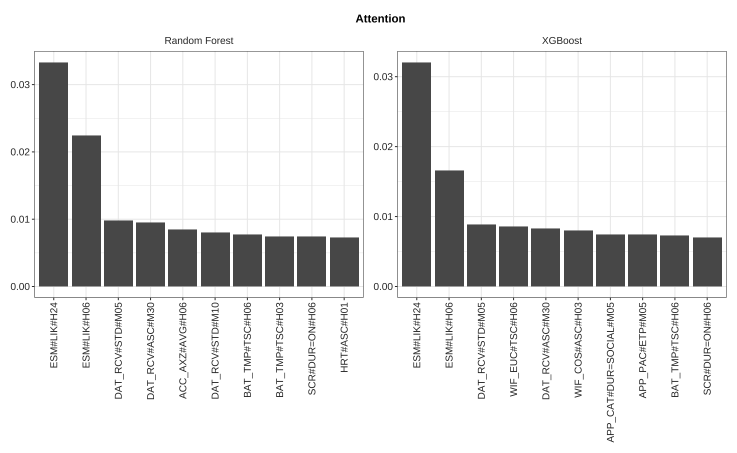

In [38]:
%%R -i IMPORTANCE_SUMMARY -w 26 -h 16 -u cm

library(ggplot2)
library(dplyr)
library(stringr)
library(patchwork)

data <- IMPORTANCE_SUMMARY %>% filter(label == 'attention')

p_label <- ggplot() + geom_text(
    aes(x = .5, y = .5),
    label = 'Attention',
    family = 'ssp',
    fontface = 'bold',
    size = 4
) + theme_void()

p_rf <- ggplot(
    data %>% filter(alg == 'rf_os') %>% top_n(n = 10, wt = importance),
    aes(x = reorder(feature, -importance), y = importance)
) + geom_col() +
    THEME_DEFAULT + theme(
        axis.text.x = element_text(angle = 90, size = 10, hjust = 1, vjust = .5),
        axis.title.x = element_blank(),
        axis.title.y = element_blank()
    ) + labs(subtitle = 'Random Forest')

p_xgb <- ggplot(
    data %>% filter(alg == 'xgb_os') %>% top_n(n = 10, wt = importance),
    aes(x = reorder(feature, -importance), y = importance)
) + geom_col() +
    THEME_DEFAULT + theme(
        axis.text.x = element_text(angle = 90, size = 10, hjust = 1, vjust = .5),
        axis.title.x = element_blank(),
        axis.title.y = element_blank()
    ) + labs(subtitle = 'XGBoost')

p <- p_label / (p_rf | p_xgb) + plot_layout(heights = c(1.1, 10))

ggsave('./fig/imp_attention.pdf', plot = p, width = 26, height = 16, unit = 'cm', device = cairo_pdf)
print(p)